In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns


from sklearn.datasets import make_blobs
from sklearn.metrics import f1_score,accuracy_score
from sklearn.metrics import precision_score, recall_score, confusion_matrix, classification_report
from sklearn.metrics import matthews_corrcoef,cohen_kappa_score,balanced_accuracy_score


import lightgbm as lgb
from sklearn.gaussian_process import GaussianProcessClassifier
from sklearn.neighbors import KNeighborsClassifier
import xgboost as xgb
from catboost import CatBoostClassifier

from modAL.models import ActiveLearner, Committee
from modAL.uncertainty import uncertainty_sampling
from functools import partial
from modAL.batch import uncertainty_batch_sampling

import warnings

warnings.filterwarnings('ignore')

In [2]:
float_id1 = '3901684'
float_id2 = '6901195'
float_id3 = '3901684'
data_source1="./dataset/PR_PF_"+float_id1+".csv"
data_source2="./dataset/PR_PF_"+float_id2+".csv"
data_source3="./dataset/PR_PF_"+float_id3+".csv"
df1= pd.read_csv(data_source1)
df2= pd.read_csv(data_source2)
df3= pd.read_csv(data_source3)
data=pd.concat([df1,df2,df3])
data

,Date,Latitude,longitude,Pressure,Salinity,Temperature,QC,label
0,-1.730828,0.107096,2.266649,-1.726008,1.953818,2.745999,0,0
1,-1.730828,0.107096,2.266649,-1.722558,1.953818,2.746051,0,0
2,-1.730828,0.107096,2.266649,-1.719125,1.953170,2.746051,0,0
3,-1.730828,0.107096,2.266649,-1.715604,1.953008,2.746121,0,0
4,-1.730828,0.107096,2.266649,-1.712171,1.953656,2.746190,0,0
...,...,...,...,...,...,...,...,...
149842,1.723431,0.987100,-0.978713,1.721038,-0.410773,-0.828686,0,0
149843,1.723431,0.987100,-0.978713,1.724454,-0.410935,-0.828842,0,0
149844,1.723431,0.987100,-0.978713,1.727869,-0.410935,-0.829206,0,0
149845,1.723431,0.987100,-0.978713,1.731425,-0.411259,-0.829744,0,0


In [3]:
row,col=data.shape

In [4]:
#def compute ratio
def comp_ratio(data):
    instance = data[(data['QC']==0)]
    rate=len(instance)/len(data)*100
    print(rate)
    return rate

In [5]:
dirty_ratio = 100-comp_ratio(data)
dirty_ratio

97.18535149849615


2.8146485015038536

In [6]:
data['QC'].unique()
# num_values = len()

array([0, 5, 4])

In [7]:
data.columns

Index(['Date', 'Latitude', 'longitude', 'Pressure', 'Salinity', 'Temperature',
       'QC', 'label'],
      dtype='object')

In [8]:
def plotCluster(data,name1,name2,name3,start,end):   
    %matplotlib notebook

    data1=data.loc[data['QC'] == 0]

    x1 = data1.loc[:,[name1]].iloc[start:end, :]  
    y1 = data1.loc[:,[name2]].iloc[start:end, :]  
    z1 = data1.loc[:,[name3]].iloc[start:end, :]  


    data2=data.loc[data['QC'] == 3]

    x2 = data2.loc[:,[name1]].iloc[start:end, :]  
    y2 = data2.loc[:,[name2]].iloc[start:end, :]  
    z2 = data2.loc[:,[name3]].iloc[start:end, :]  
    
    
    
    data3=data.loc[data['QC'] == 4]

    x3 = data3.loc[:,[name1]].iloc[start:end, :]  
    y3 = data3.loc[:,[name2]].iloc[start:end, :]  
    z3 = data3.loc[:,[name3]].iloc[start:end, :]  
    
    data4=data.loc[data['QC'] == 5]

    x4 = data4.loc[:,[name1]].iloc[start:end, :]  
    y4 = data4.loc[:,[name2]].iloc[start:end, :]  
    z4 = data4.loc[:,[name3]].iloc[start:end, :]  
    

    fig = plt.figure()
    ax = fig.add_subplot(projection="3d")
    ax.scatter(x1, y1, z1, c='y',s=0.01, label='Normal Data')
    ax.scatter(x2, y2, z2, c='g',s=10, label='PRES')
    ax.scatter(x3, y3, z3, c='b',s=10, label='PSAL')
    ax.scatter(x4, y4, z4, c='r',s=10, label='TEMP')
    
    ax.legend(loc='best')

    ax.set_zlabel(name1, fontdict={'size': 15, 'color': 'black'})
    ax.set_ylabel(name2, fontdict={'size': 15, 'color': 'black'})
    ax.set_xlabel(name3, fontdict={'size': 15, 'color': 'black'})
    plt.show()
    plt.savefig('./image/'+float_cd+'_scatter.png')
    


In [9]:
# dataplot=data.copy()

# plotCluster(dataplot,"Temperature","Pressure","Salinity",0,data.shape[0])

# Splite Dataset

In [10]:
# train1=pd.read_csv('./randomtrain/PR_PF_'+float_id1+'.csv') 
train2=pd.read_csv('./randomtrain/PR_PF_'+float_id2+'.csv') 
train3=pd.read_csv('./randomtrain/PR_PF_'+float_id3+'.csv') 
test1=pd.read_csv('./randomtest/PR_PF_'+float_id1+'.csv')
# test2=pd.read_csv('./randomtest/PR_PF_'+float_id2+'.csv')
# test3=pd.read_csv('./randomtest/PR_PF_'+float_id3+'.csv') 

# train_set=pd.concat([train1,train2,train3])
train_set=pd.concat([train2,train3])

# test_set=pd.concat([test1,test2,test3])
test_set=test1

len(train_set),len(test_set)

(110852, 44955)

In [11]:
comp_ratio(train_set)
comp_ratio(test_set)

96.83090968137698
97.55978200422645


97.55978200422645

In [12]:
#this function use random grid search to find best parameters
def getPar(model,dist,data,niter):
    import numpy as np
    import pandas as pd
    from sklearn.model_selection import RandomizedSearchCV
    x,y=data.shape

    clf = model

    param_dist = dist
    grid = RandomizedSearchCV(clf,param_dist,cv = 3,scoring = "balanced_accuracy",n_iter=niter,n_jobs = -1)

    #train
    grid.fit(data.iloc[:,0:y-1],data.iloc[:,y-1])
    #get best parameter
    print(grid.best_score_)
    return grid.best_params_

In [13]:
# metric
def computeMetric(y_tru,y_pre):
    acc = accuracy_score(y_tru,y_pre)
    pre=precision_score(y_tru,y_pre,average='macro')
    recall=recall_score(y_tru,y_pre,average='macro')
    cm=confusion_matrix(y_tru,y_pre)
    f1 = f1_score(y_tru,y_pre,average='macro')
    mcc=matthews_corrcoef(y_tru, y_pre)
    kappa=cohen_kappa_score(y_tru, y_pre)
    bac=balanced_accuracy_score(y_tru,y_pre)
    print("acc:",acc)
    print("precision:",pre)
    print("recall:",recall)
    print("cm:",cm)
    print("f1:",f1)
    print("balanced acc:",bac)
    print("MCC:", mcc)
    print("Kappa:",kappa)
    
    #confusion matrix
    cmap1 = sns.diverging_palette(260,-10,s=50, l=75, n=5, as_cmap=True)
    plt.subplots(figsize=(12,8))
    cf_matrix = confusion_matrix(y_tru, y_pre)
    sns.heatmap(cf_matrix/np.sum(cf_matrix), cmap = cmap1, annot = True, annot_kws = {'size':15})
    
    return f1

In [14]:
def draw(performance_history):
    fig, ax = plt.subplots(figsize=(8.5, 6), dpi=130)
    ax.plot(performance_history)
    ax.scatter(range(len(performance_history)), performance_history, s=13)
    ax.xaxis.set_major_locator(mpl.ticker.MaxNLocator(nbins=5, integer=True))
    ax.yaxis.set_major_locator(mpl.ticker.MaxNLocator(nbins=10))
    ax.yaxis.set_major_formatter(mpl.ticker.PercentFormatter(xmax=1))
    ax.set_ylim(bottom=0, top=1)
    ax.grid(True)
    ax.set_title('Incremental classification accuracy')
    ax.set_xlabel('Query iteration')
    ax.set_ylabel('Classification Accuracy')
    plt.show()

# splite train(pool), test, Labeled, Unlabeled

In [15]:
x,y=train_set.shape ##no qc
#pool 
X_Pool = train_set.iloc[:,0:y-2].values
y_Pool = train_set.iloc[:,y-1].values

In [16]:
#test set
X_test=test_set.iloc[:,0:y-2]
y_tru=test_set.iloc[:,y-1]
print(len(X_test),len(y_tru))

44955 44955


In [17]:
#Pool
def initial_data(n_initial,X_Pool,y_Pool):
    #inital
    initial_idx = np.random.choice(range(len(X_Pool)), size=n_initial, replace=False)
    #initial Labeled data
    #X_initial, y_initial = X_train[], y_train[initial_idx]
    X_L = X_Pool[initial_idx]
    y_L = y_Pool[initial_idx]
    # Unlabeled data
    # X_U = Pool_X[ini_num:]
    # y_U = Pool_X[ini_num:]
    X_U, y_U = np.delete(X_Pool, initial_idx, axis=0), np.delete(y_Pool, initial_idx, axis=0)
    return X_L,y_L,X_U,y_U

In [18]:
# Set RNG seed for reproducibility.
RANDOM_STATE_SEED = 123
np.random.seed(RANDOM_STATE_SEED)

n_initial= 100
#n_initial = 1000
N_QUERIES = 200 

In [19]:
X_initial,y_initial,X_re,y_re=initial_data(n_initial,X_Pool,y_Pool)
df_X_i = pd.DataFrame(X_initial)
df_y_i = pd.DataFrame(y_initial)
df_X_r = pd.DataFrame(X_re)
df_y_r = pd.DataFrame(y_re)




# X_initial1=pd.read_csv('./randomtrain/PR_PF_'+float_id1+'_X_initial.csv')
# X_initial2=pd.read_csv('./randomtrain/PR_PF_'+float_id2+'_X_initial.csv')
# X_initial3=pd.read_csv('./randomtrain/PR_PF_'+float_id3+'_X_initial.csv')

# y_initial1=pd.read_csv('./randomtrain/PR_PF_'+float_id1+'_y_initial.csv')
# y_initial2=pd.read_csv('./randomtrain/PR_PF_'+float_id2+'_y_initial.csv')
# y_initial3=pd.read_csv('./randomtrain/PR_PF_'+float_id3+'_y_initial.csv')


# X_initial=pd.concat([X_initial1,X_initial2,X_initial3])

# y_initial=pd.concat([y_initial1,y_initial2,y_initial3])

# X_initial=X_initial.values
# y_initial=y_initial.values.ravel()


In [20]:
# X_re1=pd.read_csv('./randomtrain/PR_PF_'+float_id1+'_X_re.csv')
# X_re2=pd.read_csv('./randomtrain/PR_PF_'+float_id2+'_X_re.csv')
# X_re3=pd.read_csv('./randomtrain/PR_PF_'+float_id3+'_X_re.csv')

# y_re1=pd.read_csv('./randomtrain/PR_PF_'+float_id1+'_y_re.csv')
# y_re2=pd.read_csv('./randomtrain/PR_PF_'+float_id2+'_y_re.csv')
# y_re3=pd.read_csv('./randomtrain/PR_PF_'+float_id3+'_y_re.csv')


# X_re=pd.concat([X_re1,X_re2,X_re3])

# y_re=pd.concat([y_re1,y_re2,y_re3])

# X_re=X_re.values
# y_re=y_re.values.ravel()



# # X_re=pd.read_csv('./randomtrain/'+float_cd+'_X_re.csv').values
# # y_re=pd.read_csv('./randomtrain/'+float_cd+'_y_re.csv').values.ravel()
# print(X_re.shape,X_initial.shape)
# print(y_re.shape,y_initial.shape)

In [21]:
# df_X_i.to_csv('./randomtrain/'+float_cd+'_X_initial.csv', index=False)
# df_y_i.to_csv('./randomtrain/'+float_cd+'_y_initial.csv', index=False)
# df_X_r.to_csv('./randomtrain/'+float_cd+'_X_re.csv', index=False)
# df_y_r.to_csv('./randomtrain/'+float_cd+'_y_re.csv', index=False)

# molAL

In [22]:
def random_sampling(classifier, X_pool):
    n_samples = len(X_pool)
    query_idx = np.random.choice(range(n_samples))
    return query_idx, X_pool[query_idx]

In [23]:
def al(clf,strategy,X_L,y_L):
    learner = ActiveLearner(estimator=clf,
                            query_strategy=strategy,
                            X_training=X_L, y_training=y_L)
    return learner

In [24]:
def al_learn(clf,sampling,X_initial,y_initial,X_re,y_re):
    X_L = X_initial.copy()
    y_L = y_initial.copy()
    X_U,y_U =X_re.copy(),y_re.copy()
    #print(len(X_U),len(y_U))
    learner = al(clf,sampling,X_L,y_L)
    y_pre=learner.predict(X_test)
    unqueried_kappa=cohen_kappa_score(y_tru, y_pre)
    unqueried_f1=f1_score(y_tru,y_pre)
    #print("unqueried --------------------->",unqueried_score)
    kappa_history = [unqueried_kappa]
    f1_history = [unqueried_f1]
    y_L_2 = y_L.tolist()
    y_L_2 = np.array(y_L_2).reshape((-1, 1))
    queried_instance = np.concatenate((X_L, y_L_2), axis=1)

    # Query
    for index in range(N_QUERIES):
        query_index, query_instance = learner.query(X_U)
        # Teach ActiveLearner model the record it has requested.
        X, y = X_U[query_index].reshape(1, -1), y_U[query_index].reshape(1, )
        #print(X.flatten(), y)
        instance = np.concatenate((X.flatten(), y))
        #print(index+1,"query instance --------------------->",instance)
        learner.teach(X=X, y=y)
        
        X_U, y_U = np.delete(X_U, query_index, axis=0), np.delete(y_U, query_index)
        y_pre=learner.predict(X_test)
        kappa=cohen_kappa_score(y_tru, y_pre)
        f1=f1_score(y_tru,y_pre)
        print(index+1,"-------------------->",kappa)
        print(index+1,"-------------------->",f1)
        # Recall precision F1
        kappa_history.append(kappa)
        f1_history.append(f1)
        queried_instance = np.vstack((queried_instance, instance))

    #print(query_history)
    df_scores= pd.concat([pd.DataFrame(kappa_history,columns=['kappa']), 
                          pd.DataFrame(f1_history,columns=['f1'])],
                         axis=1)
    df_instance = pd.DataFrame(data=queried_instance, columns=['Date','Latitude','longitude','Pressure','Salinity','Temperature','Label'])
    #print(df_instance)
    return df_scores, df_instance 
#     return f1_history


1.0
{'n_neighbors': 1}
acc: 0.9993104215326437
precision: 0.9925430151718868
recall: 0.9929807654295605
cm: [[43842    16]
 [   15  1082]]
f1: 0.9927617879244193
balanced acc: 0.9929807654295605
MCC: 0.98552368338142
Kappa: 0.9855235759240272


0.9927617879244193

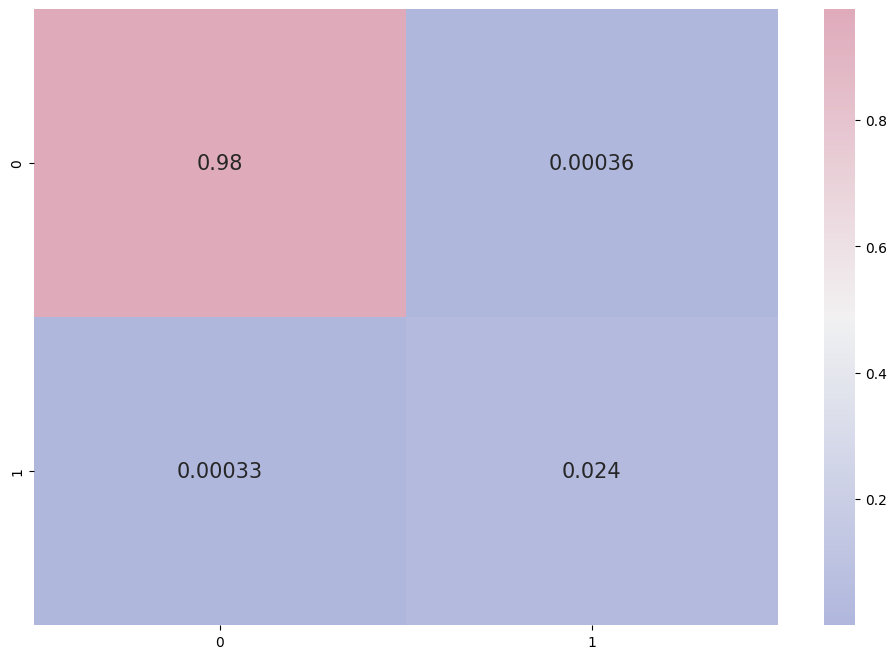

In [25]:
# clf1 KNN
clf1 = KNeighborsClassifier()
dic1={'n_neighbors':[1,2,3,4,5,6,7,8]}
para1=getPar(clf1,dic1,test_set,10)
print(para1)
clf1 = KNeighborsClassifier(n_neighbors=para1['n_neighbors'],n_jobs=-1)
clf1.fit(X_Pool, y_Pool)
y_pre=clf1.predict(X_test)
computeMetric(y_tru,y_pre)

1.0
acc: 0.9993771549327105
precision: 0.9996809916602105
recall: 0.9872379216043756
cm: [[43858     0]
 [   28  1069]]
f1: 0.993376917691557
balanced acc: 0.9872379216043756
MCC: 0.9868404690561374
Kappa: 0.9867538900253595


0.993376917691557

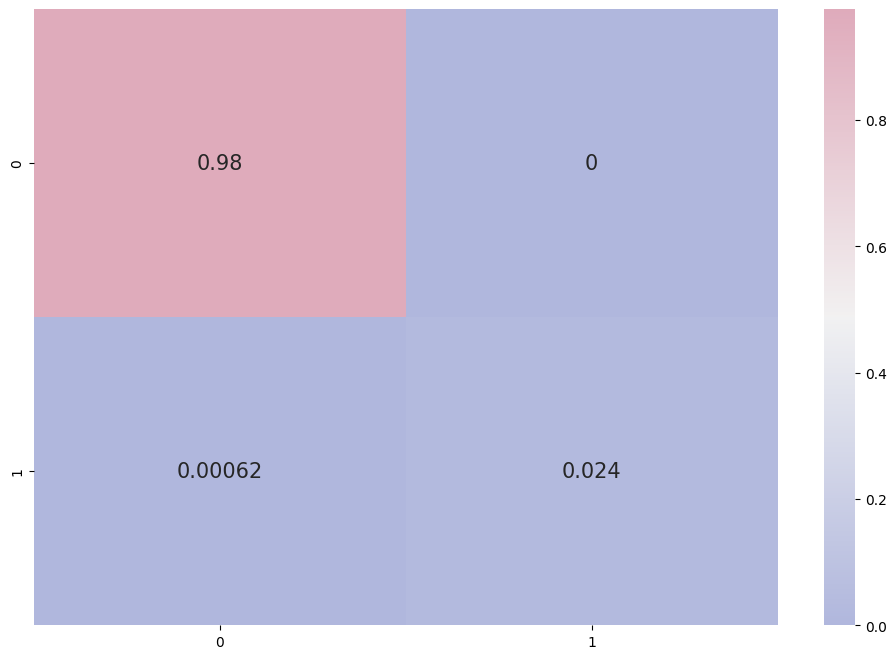

In [26]:
# clf2 lightgbm
clf2 = lgb.LGBMClassifier()

dic2 = {'learning_rate' : [0.01, 0.02, 0.03, 0.04, 0.05, 0.08, 0.1, 0.2, 0.3, 0.4],
              'n_estimators' : [100, 200, 300, 400, 500, 600, 800, 900, 1000, 1500, 2000],
              'num_leaves': range(6, 50), 
              'min_child_samples': range(10, 200, 10), 
              'min_child_weight': [1e-5, 1e-3, 1e-2, 1e-1, 1, 1e1, 1e2, 1e3, 1e4],
              'max_depth': [-1, 1, 2, 3, 4, 5, 6, 7],
              'reg_alpha': [0, 1e-1, 1, 2, 5, 7, 10, 50, 100],
              'reg_lambda': [0, 1e-1, 1, 5, 10, 20, 50, 100]}
para2=getPar(clf2,dic2,test_set,10)

    
clf2 = lgb.LGBMClassifier(boosting_type='gbdt',
                          #objective='multiclass',
                          num_leaves=para2['num_leaves'], max_depth=-1, 
                              learning_rate=para2['learning_rate'], n_estimators=para2['n_estimators'], 
                              subsample_for_bin=200000, class_weight=None, min_split_gain=0.0, 
                              min_child_weight=para2['min_child_weight'],
                              min_child_samples=para2['min_child_samples'], 
                              subsample=1.0, 
                              subsample_freq=0, colsample_bytree=1.0, reg_alpha=para2['reg_alpha'], 
                              reg_lambda=para2['reg_lambda'], random_state=None, n_jobs=-1, importance_type='split')
clf2.fit(X_Pool, y_Pool)
y_pre=clf2.predict(X_test)
computeMetric(y_tru,y_pre)

1.0
acc: 0.9653876098320543
precision: 0.5177551609465076
recall: 0.5085432338965152
cm: [[43368   490]
 [ 1066    31]]
f1: 0.5103477857521539
balanced acc: 0.5085432338965152
MCC: 0.024632214097501434
Kappa: 0.022964680505308532


0.5103477857521539

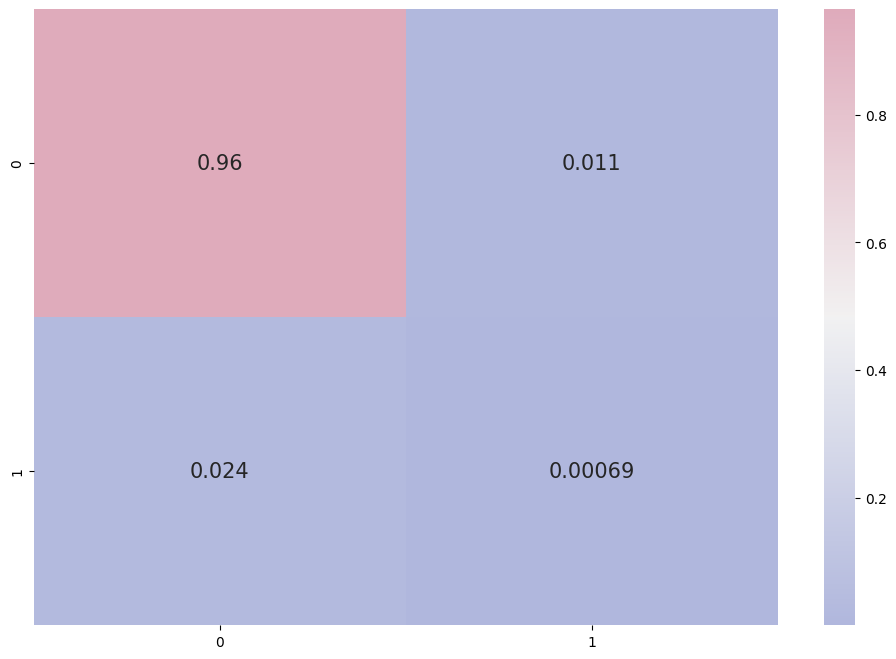

In [27]:
#XGBOOST
clf3 = xgb.XGBClassifier()
dic3 = {'n_estimators':range(80,2000,4),
        'max_depth':range(2,15,1),
        'learning_rate':np.linspace(0.01,2,20),
        'subsample':np.linspace(0.7,0.9,20),
        'colsample_bytree':np.linspace(0.5,0.98,10)
        }
para3=getPar(clf3,dic3,test_set,10)
clf3 = xgb.XGBClassifier(booster='gbtree',n_estimators=para3['n_estimators'], learning_rate=para3['learning_rate'],
                    max_depth=para3['max_depth'],subsample=para3['subsample'],
                    colsample_bytree=para3['colsample_bytree'],
                         #objective='multi:softprob',
                    n_jobs=-1)
clf3.fit(X_Pool, y_Pool)
y_pre=clf3.predict(X_test)
computeMetric(y_tru,y_pre)

Learning rate set to 0.07692
0:	learn: 0.4905821	total: 69.5ms	remaining: 1m 9s
1:	learn: 0.3359890	total: 79.9ms	remaining: 39.9s
2:	learn: 0.2130461	total: 89.9ms	remaining: 29.9s
3:	learn: 0.1391834	total: 99.7ms	remaining: 24.8s
4:	learn: 0.0921985	total: 110ms	remaining: 21.9s
5:	learn: 0.0675991	total: 120ms	remaining: 19.8s
6:	learn: 0.0470330	total: 129ms	remaining: 18.4s
7:	learn: 0.0329259	total: 140ms	remaining: 17.3s
8:	learn: 0.0242793	total: 150ms	remaining: 16.5s
9:	learn: 0.0180172	total: 161ms	remaining: 15.9s
10:	learn: 0.0140307	total: 172ms	remaining: 15.5s
11:	learn: 0.0122457	total: 183ms	remaining: 15s
12:	learn: 0.0099151	total: 193ms	remaining: 14.7s
13:	learn: 0.0084434	total: 205ms	remaining: 14.5s
14:	learn: 0.0070913	total: 216ms	remaining: 14.2s
15:	learn: 0.0063543	total: 226ms	remaining: 13.9s
16:	learn: 0.0056539	total: 236ms	remaining: 13.6s
17:	learn: 0.0053256	total: 246ms	remaining: 13.4s
18:	learn: 0.0051542	total: 257ms	remaining: 13.3s
19:	learn:

169:	learn: 0.0011165	total: 1.81s	remaining: 8.84s
170:	learn: 0.0011101	total: 1.82s	remaining: 8.83s
171:	learn: 0.0011008	total: 1.83s	remaining: 8.82s
172:	learn: 0.0010958	total: 1.84s	remaining: 8.8s
173:	learn: 0.0010902	total: 1.85s	remaining: 8.78s
174:	learn: 0.0010834	total: 1.86s	remaining: 8.76s
175:	learn: 0.0010712	total: 1.87s	remaining: 8.75s
176:	learn: 0.0010672	total: 1.88s	remaining: 8.73s
177:	learn: 0.0010618	total: 1.89s	remaining: 8.71s
178:	learn: 0.0010578	total: 1.9s	remaining: 8.7s
179:	learn: 0.0010540	total: 1.91s	remaining: 8.68s
180:	learn: 0.0010506	total: 1.91s	remaining: 8.66s
181:	learn: 0.0010413	total: 1.92s	remaining: 8.65s
182:	learn: 0.0010357	total: 1.93s	remaining: 8.63s
183:	learn: 0.0010296	total: 1.94s	remaining: 8.61s
184:	learn: 0.0010220	total: 1.95s	remaining: 8.6s
185:	learn: 0.0010180	total: 1.96s	remaining: 8.58s
186:	learn: 0.0010076	total: 1.97s	remaining: 8.56s
187:	learn: 0.0010039	total: 1.98s	remaining: 8.55s
188:	learn: 0.00

339:	learn: 0.0007483	total: 3.23s	remaining: 6.26s
340:	learn: 0.0007483	total: 3.24s	remaining: 6.25s
341:	learn: 0.0007483	total: 3.25s	remaining: 6.24s
342:	learn: 0.0007483	total: 3.25s	remaining: 6.23s
343:	learn: 0.0007483	total: 3.26s	remaining: 6.22s
344:	learn: 0.0007483	total: 3.27s	remaining: 6.21s
345:	learn: 0.0007483	total: 3.28s	remaining: 6.19s
346:	learn: 0.0007483	total: 3.28s	remaining: 6.18s
347:	learn: 0.0007483	total: 3.29s	remaining: 6.17s
348:	learn: 0.0007483	total: 3.3s	remaining: 6.16s
349:	learn: 0.0007483	total: 3.31s	remaining: 6.14s
350:	learn: 0.0007483	total: 3.31s	remaining: 6.13s
351:	learn: 0.0007483	total: 3.32s	remaining: 6.12s
352:	learn: 0.0007483	total: 3.33s	remaining: 6.1s
353:	learn: 0.0007483	total: 3.34s	remaining: 6.09s
354:	learn: 0.0007483	total: 3.35s	remaining: 6.08s
355:	learn: 0.0007483	total: 3.35s	remaining: 6.07s
356:	learn: 0.0007483	total: 3.36s	remaining: 6.05s
357:	learn: 0.0007483	total: 3.37s	remaining: 6.04s
358:	learn: 0.

498:	learn: 0.0007483	total: 4.43s	remaining: 4.44s
499:	learn: 0.0007483	total: 4.43s	remaining: 4.43s
500:	learn: 0.0007483	total: 4.44s	remaining: 4.42s
501:	learn: 0.0007483	total: 4.45s	remaining: 4.41s
502:	learn: 0.0007483	total: 4.46s	remaining: 4.41s
503:	learn: 0.0007483	total: 4.46s	remaining: 4.39s
504:	learn: 0.0007483	total: 4.47s	remaining: 4.38s
505:	learn: 0.0007483	total: 4.48s	remaining: 4.37s
506:	learn: 0.0007483	total: 4.49s	remaining: 4.36s
507:	learn: 0.0007483	total: 4.5s	remaining: 4.35s
508:	learn: 0.0007483	total: 4.5s	remaining: 4.34s
509:	learn: 0.0007483	total: 4.51s	remaining: 4.33s
510:	learn: 0.0007483	total: 4.52s	remaining: 4.32s
511:	learn: 0.0007483	total: 4.52s	remaining: 4.31s
512:	learn: 0.0007483	total: 4.53s	remaining: 4.3s
513:	learn: 0.0007483	total: 4.54s	remaining: 4.29s
514:	learn: 0.0007483	total: 4.55s	remaining: 4.28s
515:	learn: 0.0007483	total: 4.55s	remaining: 4.27s
516:	learn: 0.0007483	total: 4.56s	remaining: 4.26s
517:	learn: 0.0

657:	learn: 0.0007483	total: 5.62s	remaining: 2.92s
658:	learn: 0.0007483	total: 5.63s	remaining: 2.91s
659:	learn: 0.0007483	total: 5.63s	remaining: 2.9s
660:	learn: 0.0007483	total: 5.64s	remaining: 2.89s
661:	learn: 0.0007483	total: 5.65s	remaining: 2.88s
662:	learn: 0.0007483	total: 5.66s	remaining: 2.88s
663:	learn: 0.0007483	total: 5.67s	remaining: 2.87s
664:	learn: 0.0007483	total: 5.67s	remaining: 2.86s
665:	learn: 0.0007483	total: 5.68s	remaining: 2.85s
666:	learn: 0.0007483	total: 5.69s	remaining: 2.84s
667:	learn: 0.0007483	total: 5.7s	remaining: 2.83s
668:	learn: 0.0007483	total: 5.7s	remaining: 2.82s
669:	learn: 0.0007483	total: 5.71s	remaining: 2.81s
670:	learn: 0.0007483	total: 5.72s	remaining: 2.8s
671:	learn: 0.0007483	total: 5.73s	remaining: 2.79s
672:	learn: 0.0007483	total: 5.73s	remaining: 2.79s
673:	learn: 0.0007483	total: 5.74s	remaining: 2.78s
674:	learn: 0.0007483	total: 5.75s	remaining: 2.77s
675:	learn: 0.0007483	total: 5.76s	remaining: 2.76s
676:	learn: 0.00

842:	learn: 0.0007483	total: 7.03s	remaining: 1.31s
843:	learn: 0.0007483	total: 7.03s	remaining: 1.3s
844:	learn: 0.0007483	total: 7.04s	remaining: 1.29s
845:	learn: 0.0007483	total: 7.05s	remaining: 1.28s
846:	learn: 0.0007483	total: 7.06s	remaining: 1.27s
847:	learn: 0.0007483	total: 7.06s	remaining: 1.27s
848:	learn: 0.0007483	total: 7.07s	remaining: 1.26s
849:	learn: 0.0007483	total: 7.08s	remaining: 1.25s
850:	learn: 0.0007483	total: 7.09s	remaining: 1.24s
851:	learn: 0.0007483	total: 7.09s	remaining: 1.23s
852:	learn: 0.0007483	total: 7.1s	remaining: 1.22s
853:	learn: 0.0007483	total: 7.11s	remaining: 1.22s
854:	learn: 0.0007483	total: 7.12s	remaining: 1.21s
855:	learn: 0.0007483	total: 7.13s	remaining: 1.2s
856:	learn: 0.0007483	total: 7.13s	remaining: 1.19s
857:	learn: 0.0007483	total: 7.14s	remaining: 1.18s
858:	learn: 0.0007483	total: 7.15s	remaining: 1.17s
859:	learn: 0.0007483	total: 7.15s	remaining: 1.16s
860:	learn: 0.0007483	total: 7.16s	remaining: 1.16s
861:	learn: 0.0

acc: 0.9993993993993994
precision: 0.9969880295979494
recall: 0.9903600386313449
cm: [[43852     6]
 [   21  1076]]
f1: 0.9936506180034281
balanced acc: 0.9903600386313449
MCC: 0.9873258213841395
Kappa: 0.9873012509531373


0.9936506180034281

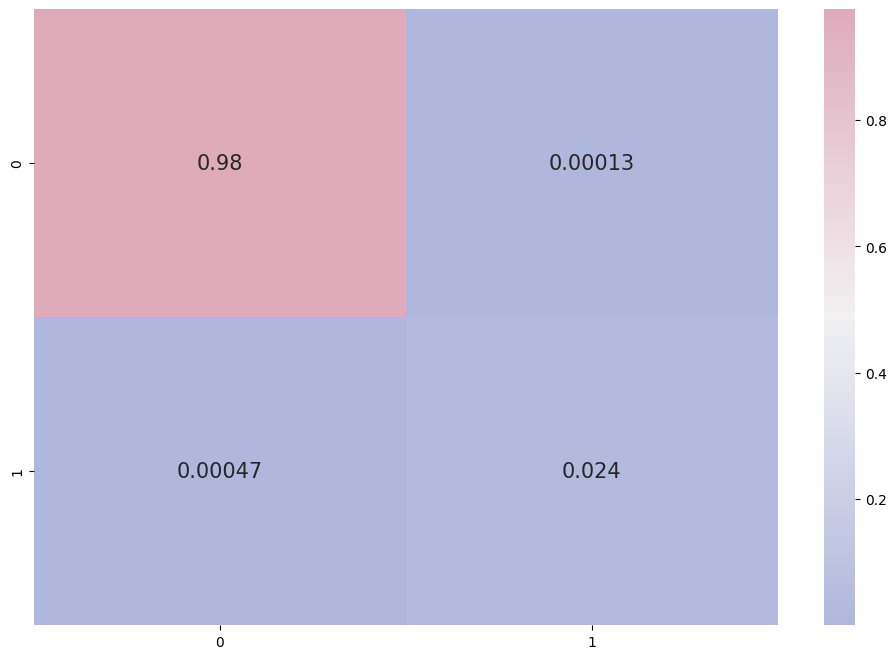

In [28]:
#clf4 catboost
clf4 = CatBoostClassifier(loss_function='Logloss')
# dic4 = {'learning_rate': [0.03, 0.1],
#         'depth': [4, 6, 10],
#         'l2_leaf_reg': [1, 3, 5, 7, 9]}
# #para3=getPar(clf4,dic4,test_set,10)

# grid_search_result = clf4.grid_search(dic4, 
#                                        X=X_Pool, 
#                                        y=y_Pool)

clf4.fit(X_Pool, y_Pool)
y_pre=clf4.predict(X_test)
computeMetric(y_tru,y_pre)

## random sampling

In [29]:
sampling=random_sampling

In [30]:
metric01,instance01 = al_learn(clf1,sampling,X_initial,y_initial,X_re,y_re)
# instance01.to_csv("./query/random_Knn_"+"mix_ni"+".csv")

1 --------------------> 0.21181625627888112
1 --------------------> 0.22362602653190145
2 --------------------> 0.21181625627888112
2 --------------------> 0.22362602653190145
3 --------------------> 0.21181625627888112
3 --------------------> 0.22362602653190145
4 --------------------> 0.21873501817726781
4 --------------------> 0.22972096041531473
5 --------------------> 0.21873501817726781
5 --------------------> 0.22972096041531473
6 --------------------> 0.21873501817726781
6 --------------------> 0.22972096041531473
7 --------------------> 0.21873501817726781
7 --------------------> 0.22972096041531473
8 --------------------> 0.21873501817726781
8 --------------------> 0.22972096041531473
9 --------------------> 0.21873501817726781
9 --------------------> 0.22972096041531473
10 --------------------> 0.21873501817726781
10 --------------------> 0.22972096041531473
11 --------------------> 0.21873501817726781
11 --------------------> 0.22972096041531473
12 --------------------> 0.2

93 --------------------> 0.15580320680526916
93 --------------------> 0.16317365269461082
94 --------------------> 0.15580320680526916
94 --------------------> 0.16317365269461082
95 --------------------> 0.15580320680526916
95 --------------------> 0.16317365269461082
96 --------------------> 0.15580320680526916
96 --------------------> 0.16317365269461082
97 --------------------> 0.15580320680526916
97 --------------------> 0.16317365269461082
98 --------------------> 0.15580320680526916
98 --------------------> 0.16317365269461082
99 --------------------> 0.15580320680526916
99 --------------------> 0.16317365269461082
100 --------------------> 0.15580320680526916
100 --------------------> 0.16317365269461082
101 --------------------> 0.15580320680526916
101 --------------------> 0.16317365269461082
102 --------------------> 0.15580320680526916
102 --------------------> 0.16317365269461082
103 --------------------> 0.15580320680526916
103 --------------------> 0.16317365269461082
10

183 --------------------> 0.15358145513628263
183 --------------------> 0.15918045705279746
184 --------------------> 0.15358145513628263
184 --------------------> 0.15918045705279746
185 --------------------> 0.15358145513628263
185 --------------------> 0.15918045705279746
186 --------------------> 0.15358145513628263
186 --------------------> 0.15918045705279746
187 --------------------> 0.15358145513628263
187 --------------------> 0.15918045705279746
188 --------------------> 0.15358145513628263
188 --------------------> 0.15918045705279746
189 --------------------> 0.15358145513628263
189 --------------------> 0.15918045705279746
190 --------------------> 0.15358145513628263
190 --------------------> 0.15918045705279746
191 --------------------> 0.15358145513628263
191 --------------------> 0.15918045705279746
192 --------------------> 0.15358145513628263
192 --------------------> 0.15918045705279746
193 --------------------> 0.15358145513628263
193 --------------------> 0.159180

In [31]:
metric02,instance02 = al_learn(clf2,sampling,X_initial,y_initial,X_re,y_re)
# instance02.to_csv("./query/random_Lg_"+"mix_ni"+".csv")

1 --------------------> 0.0
1 --------------------> 0.0
2 --------------------> 0.0
2 --------------------> 0.0
3 --------------------> 0.0
3 --------------------> 0.0
4 --------------------> 0.0
4 --------------------> 0.0
5 --------------------> 0.0
5 --------------------> 0.0
6 --------------------> 0.0
6 --------------------> 0.0
7 --------------------> 0.0
7 --------------------> 0.0
8 --------------------> 0.0
8 --------------------> 0.0
9 --------------------> 0.0
9 --------------------> 0.0
10 --------------------> 0.0
10 --------------------> 0.0
11 --------------------> 0.0
11 --------------------> 0.0
12 --------------------> 0.0
12 --------------------> 0.0
13 --------------------> 0.0
13 --------------------> 0.0
14 --------------------> 0.0
14 --------------------> 0.0
15 --------------------> 0.0
15 --------------------> 0.0
16 --------------------> 0.0
16 --------------------> 0.0
17 --------------------> 0.0
17 --------------------> 0.0
18 --------------------> 0.0
18 

145 --------------------> 0.0
145 --------------------> 0.0
146 --------------------> 0.0
146 --------------------> 0.0
147 --------------------> 0.0
147 --------------------> 0.0
148 --------------------> 0.0
148 --------------------> 0.0
149 --------------------> 0.0
149 --------------------> 0.0
150 --------------------> 0.0
150 --------------------> 0.0
151 --------------------> 0.0
151 --------------------> 0.0
152 --------------------> 0.0
152 --------------------> 0.0
153 --------------------> 0.0
153 --------------------> 0.0
154 --------------------> 0.0
154 --------------------> 0.0
155 --------------------> 0.0
155 --------------------> 0.0
156 --------------------> 0.0
156 --------------------> 0.0
157 --------------------> 0.0
157 --------------------> 0.0
158 --------------------> 0.0
158 --------------------> 0.0
159 --------------------> 0.0
159 --------------------> 0.0
160 --------------------> 0.0
160 --------------------> 0.0
161 --------------------> 0.0
161 ------

In [32]:
metric03,instance03= al_learn(clf3,sampling,X_initial,y_initial,X_re,y_re)
# instance03.to_csv("./query/random_XB_"+"mix_ni"+".csv")

1 --------------------> -0.0001331205184831319
1 --------------------> 0.0
2 --------------------> -0.002777329127483963
2 --------------------> 0.0
3 --------------------> -0.0010032378686091192
3 --------------------> 0.0
4 --------------------> 0.0022983361086219567
4 --------------------> 0.0035523978685612794
5 --------------------> -0.0001331205184831319
5 --------------------> 0.0
6 --------------------> -0.006623436903459012
6 --------------------> 0.0015209125475285172
7 --------------------> 0.0
7 --------------------> 0.0
8 --------------------> -0.00468907836480148
8 --------------------> 0.0
9 --------------------> 0.0
9 --------------------> 0.0
10 --------------------> -0.0005283694858431165
10 --------------------> 0.0
11 --------------------> -8.882383058361754e-05
11 --------------------> 0.0
12 --------------------> -4.445039097289438e-05
12 --------------------> 0.0
13 --------------------> -0.0024164390663872215
13 --------------------> 0.0
14 -------------------->

121 --------------------> -0.002091111997909234
121 --------------------> 0.0
122 --------------------> -0.0003095437219118313
122 --------------------> 0.0
123 --------------------> 0.0
123 --------------------> 0.0
124 --------------------> 0.14376782992769643
124 --------------------> 0.14948859166011016
125 --------------------> 0.301867041276938
125 --------------------> 0.3070987654320988
126 --------------------> 0.4594658974686616
126 --------------------> 0.4663978494623655
127 --------------------> 0.1889363569124075
127 --------------------> 0.19275123558484347
128 --------------------> 0.37379906550696285
128 --------------------> 0.37969094922737306
129 --------------------> 0.0956746031038136
129 --------------------> 0.09863945578231294
130 --------------------> 0.0655305543844189
130 --------------------> 0.06837606837606837
131 --------------------> 0.10225983316327258
131 --------------------> 0.10664479081214111
132 --------------------> 0.26761629435559764
132 -----

In [33]:
metric04,instance04= al_learn(clf4,sampling,X_initial,y_initial,X_re,y_re)
# instance04.to_csv("./query/random_CB_"+"mix_ni"+".csv")

Learning rate set to 0.003854
0:	learn: 0.6869357	total: 1.43ms	remaining: 1.42s
1:	learn: 0.6810696	total: 2.31ms	remaining: 1.16s
2:	learn: 0.6761700	total: 3.25ms	remaining: 1.08s
3:	learn: 0.6713902	total: 4.11ms	remaining: 1.02s
4:	learn: 0.6654099	total: 5.03ms	remaining: 1s
5:	learn: 0.6595466	total: 5.9ms	remaining: 978ms
6:	learn: 0.6540155	total: 6.71ms	remaining: 952ms
7:	learn: 0.6485634	total: 7.67ms	remaining: 952ms
8:	learn: 0.6436597	total: 8.7ms	remaining: 957ms
9:	learn: 0.6379495	total: 9.52ms	remaining: 943ms
10:	learn: 0.6331943	total: 10.3ms	remaining: 925ms
11:	learn: 0.6275306	total: 11.2ms	remaining: 919ms
12:	learn: 0.6229287	total: 12ms	remaining: 914ms
13:	learn: 0.6174048	total: 12.8ms	remaining: 900ms
14:	learn: 0.6122252	total: 13.7ms	remaining: 898ms
15:	learn: 0.6072864	total: 14.4ms	remaining: 887ms
16:	learn: 0.6021354	total: 15.2ms	remaining: 881ms
17:	learn: 0.5972676	total: 16.1ms	remaining: 877ms
18:	learn: 0.5924084	total: 16.9ms	remaining: 870ms

200:	learn: 0.1792784	total: 170ms	remaining: 675ms
201:	learn: 0.1784261	total: 171ms	remaining: 676ms
202:	learn: 0.1776484	total: 172ms	remaining: 675ms
203:	learn: 0.1767523	total: 173ms	remaining: 674ms
204:	learn: 0.1756451	total: 173ms	remaining: 673ms
205:	learn: 0.1749193	total: 174ms	remaining: 672ms
206:	learn: 0.1741963	total: 175ms	remaining: 671ms
207:	learn: 0.1733665	total: 176ms	remaining: 671ms
208:	learn: 0.1727592	total: 177ms	remaining: 670ms
209:	learn: 0.1721891	total: 178ms	remaining: 669ms
210:	learn: 0.1712849	total: 179ms	remaining: 668ms
211:	learn: 0.1704785	total: 180ms	remaining: 668ms
212:	learn: 0.1696700	total: 181ms	remaining: 667ms
213:	learn: 0.1686954	total: 181ms	remaining: 665ms
214:	learn: 0.1679970	total: 182ms	remaining: 664ms
215:	learn: 0.1672905	total: 183ms	remaining: 664ms
216:	learn: 0.1664393	total: 184ms	remaining: 663ms
217:	learn: 0.1656409	total: 185ms	remaining: 662ms
218:	learn: 0.1646746	total: 186ms	remaining: 662ms
219:	learn: 

417:	learn: 0.0750192	total: 351ms	remaining: 489ms
418:	learn: 0.0747384	total: 352ms	remaining: 489ms
419:	learn: 0.0744734	total: 353ms	remaining: 488ms
420:	learn: 0.0742335	total: 354ms	remaining: 487ms
421:	learn: 0.0740684	total: 355ms	remaining: 486ms
422:	learn: 0.0739025	total: 356ms	remaining: 485ms
423:	learn: 0.0736246	total: 357ms	remaining: 484ms
424:	learn: 0.0733948	total: 357ms	remaining: 483ms
425:	learn: 0.0731831	total: 358ms	remaining: 482ms
426:	learn: 0.0729828	total: 359ms	remaining: 482ms
427:	learn: 0.0727468	total: 360ms	remaining: 481ms
428:	learn: 0.0725031	total: 362ms	remaining: 482ms
429:	learn: 0.0723122	total: 363ms	remaining: 481ms
430:	learn: 0.0720743	total: 364ms	remaining: 480ms
431:	learn: 0.0718460	total: 365ms	remaining: 479ms
432:	learn: 0.0716618	total: 365ms	remaining: 478ms
433:	learn: 0.0713745	total: 366ms	remaining: 478ms
434:	learn: 0.0710651	total: 367ms	remaining: 477ms
435:	learn: 0.0708814	total: 368ms	remaining: 476ms
436:	learn: 

629:	learn: 0.0410192	total: 531ms	remaining: 312ms
630:	learn: 0.0409133	total: 532ms	remaining: 311ms
631:	learn: 0.0407958	total: 533ms	remaining: 310ms
632:	learn: 0.0407019	total: 534ms	remaining: 310ms
633:	learn: 0.0405702	total: 535ms	remaining: 309ms
634:	learn: 0.0404485	total: 536ms	remaining: 308ms
635:	learn: 0.0403253	total: 537ms	remaining: 307ms
636:	learn: 0.0402320	total: 537ms	remaining: 306ms
637:	learn: 0.0401059	total: 538ms	remaining: 305ms
638:	learn: 0.0400383	total: 539ms	remaining: 304ms
639:	learn: 0.0399520	total: 541ms	remaining: 304ms
640:	learn: 0.0398371	total: 542ms	remaining: 303ms
641:	learn: 0.0397389	total: 542ms	remaining: 302ms
642:	learn: 0.0396603	total: 543ms	remaining: 302ms
643:	learn: 0.0395697	total: 544ms	remaining: 301ms
644:	learn: 0.0394827	total: 545ms	remaining: 300ms
645:	learn: 0.0394312	total: 545ms	remaining: 299ms
646:	learn: 0.0393314	total: 546ms	remaining: 298ms
647:	learn: 0.0392727	total: 547ms	remaining: 297ms
648:	learn: 

871:	learn: 0.0249002	total: 713ms	remaining: 105ms
872:	learn: 0.0248492	total: 714ms	remaining: 104ms
873:	learn: 0.0248002	total: 715ms	remaining: 103ms
874:	learn: 0.0247748	total: 716ms	remaining: 102ms
875:	learn: 0.0247322	total: 717ms	remaining: 101ms
876:	learn: 0.0246811	total: 718ms	remaining: 101ms
877:	learn: 0.0246390	total: 719ms	remaining: 99.8ms
878:	learn: 0.0245985	total: 719ms	remaining: 99ms
879:	learn: 0.0245594	total: 720ms	remaining: 98.2ms
880:	learn: 0.0245307	total: 721ms	remaining: 97.3ms
881:	learn: 0.0245033	total: 722ms	remaining: 96.6ms
882:	learn: 0.0244424	total: 723ms	remaining: 95.8ms
883:	learn: 0.0244139	total: 724ms	remaining: 95ms
884:	learn: 0.0243585	total: 724ms	remaining: 94.1ms
885:	learn: 0.0243094	total: 725ms	remaining: 93.3ms
886:	learn: 0.0242555	total: 726ms	remaining: 92.5ms
887:	learn: 0.0241969	total: 727ms	remaining: 91.7ms
888:	learn: 0.0241504	total: 727ms	remaining: 90.8ms
889:	learn: 0.0241097	total: 728ms	remaining: 90ms
890:	

37:	learn: 0.5095119	total: 28.4ms	remaining: 719ms
38:	learn: 0.5051872	total: 29.5ms	remaining: 727ms
39:	learn: 0.5011793	total: 30.3ms	remaining: 728ms
40:	learn: 0.4973156	total: 31.2ms	remaining: 729ms
41:	learn: 0.4940367	total: 31.9ms	remaining: 728ms
42:	learn: 0.4907077	total: 32.6ms	remaining: 726ms
43:	learn: 0.4866041	total: 33.4ms	remaining: 725ms
44:	learn: 0.4827934	total: 34.1ms	remaining: 724ms
45:	learn: 0.4791898	total: 34.8ms	remaining: 721ms
46:	learn: 0.4751584	total: 35.5ms	remaining: 719ms
47:	learn: 0.4713379	total: 36.2ms	remaining: 717ms
48:	learn: 0.4673268	total: 36.9ms	remaining: 716ms
49:	learn: 0.4639067	total: 37.7ms	remaining: 716ms
50:	learn: 0.4600651	total: 38.8ms	remaining: 722ms
51:	learn: 0.4568441	total: 39.5ms	remaining: 720ms
52:	learn: 0.4537311	total: 40.2ms	remaining: 719ms
53:	learn: 0.4506817	total: 41ms	remaining: 719ms
54:	learn: 0.4472684	total: 41.7ms	remaining: 716ms
55:	learn: 0.4443004	total: 42.4ms	remaining: 714ms
56:	learn: 0.4

270:	learn: 0.1305699	total: 209ms	remaining: 563ms
271:	learn: 0.1300624	total: 210ms	remaining: 563ms
272:	learn: 0.1293155	total: 211ms	remaining: 561ms
273:	learn: 0.1287988	total: 212ms	remaining: 561ms
274:	learn: 0.1282141	total: 212ms	remaining: 560ms
275:	learn: 0.1275979	total: 213ms	remaining: 559ms
276:	learn: 0.1271259	total: 214ms	remaining: 558ms
277:	learn: 0.1265162	total: 214ms	remaining: 557ms
278:	learn: 0.1260947	total: 215ms	remaining: 556ms
279:	learn: 0.1255420	total: 216ms	remaining: 555ms
280:	learn: 0.1250559	total: 217ms	remaining: 554ms
281:	learn: 0.1245718	total: 217ms	remaining: 553ms
282:	learn: 0.1239915	total: 218ms	remaining: 552ms
283:	learn: 0.1235899	total: 219ms	remaining: 553ms
284:	learn: 0.1228400	total: 220ms	remaining: 553ms
285:	learn: 0.1223977	total: 221ms	remaining: 552ms
286:	learn: 0.1218401	total: 222ms	remaining: 551ms
287:	learn: 0.1212010	total: 223ms	remaining: 550ms
288:	learn: 0.1204925	total: 223ms	remaining: 550ms
289:	learn: 

522:	learn: 0.0535756	total: 390ms	remaining: 356ms
523:	learn: 0.0534064	total: 391ms	remaining: 355ms
524:	learn: 0.0532993	total: 392ms	remaining: 355ms
525:	learn: 0.0531634	total: 393ms	remaining: 354ms
526:	learn: 0.0530603	total: 394ms	remaining: 353ms
527:	learn: 0.0528872	total: 394ms	remaining: 353ms
528:	learn: 0.0527688	total: 395ms	remaining: 352ms
529:	learn: 0.0526348	total: 396ms	remaining: 351ms
530:	learn: 0.0525193	total: 396ms	remaining: 350ms
531:	learn: 0.0523652	total: 397ms	remaining: 349ms
532:	learn: 0.0522736	total: 398ms	remaining: 349ms
533:	learn: 0.0520978	total: 398ms	remaining: 348ms
534:	learn: 0.0519850	total: 399ms	remaining: 347ms
535:	learn: 0.0517953	total: 400ms	remaining: 346ms
536:	learn: 0.0516074	total: 401ms	remaining: 346ms
537:	learn: 0.0513943	total: 402ms	remaining: 345ms
538:	learn: 0.0512928	total: 403ms	remaining: 344ms
539:	learn: 0.0511548	total: 403ms	remaining: 344ms
540:	learn: 0.0509937	total: 404ms	remaining: 343ms
541:	learn: 

771:	learn: 0.0296371	total: 571ms	remaining: 169ms
772:	learn: 0.0295709	total: 572ms	remaining: 168ms
773:	learn: 0.0295253	total: 573ms	remaining: 167ms
774:	learn: 0.0294467	total: 574ms	remaining: 167ms
775:	learn: 0.0293748	total: 575ms	remaining: 166ms
776:	learn: 0.0293454	total: 576ms	remaining: 165ms
777:	learn: 0.0293096	total: 576ms	remaining: 164ms
778:	learn: 0.0292365	total: 577ms	remaining: 164ms
779:	learn: 0.0291678	total: 578ms	remaining: 163ms
780:	learn: 0.0291219	total: 579ms	remaining: 162ms
781:	learn: 0.0290618	total: 579ms	remaining: 161ms
782:	learn: 0.0290070	total: 580ms	remaining: 161ms
783:	learn: 0.0289333	total: 581ms	remaining: 160ms
784:	learn: 0.0288750	total: 582ms	remaining: 159ms
785:	learn: 0.0288290	total: 583ms	remaining: 159ms
786:	learn: 0.0287763	total: 584ms	remaining: 158ms
787:	learn: 0.0287409	total: 584ms	remaining: 157ms
788:	learn: 0.0286815	total: 585ms	remaining: 156ms
789:	learn: 0.0286251	total: 586ms	remaining: 156ms
790:	learn: 

1 --------------------> 0.019380466069119917
1 --------------------> 0.019855595667870034
Learning rate set to 0.003887
0:	learn: 0.6869470	total: 852us	remaining: 851ms
1:	learn: 0.6809272	total: 1.7ms	remaining: 847ms
2:	learn: 0.6759531	total: 2.56ms	remaining: 851ms
3:	learn: 0.6708392	total: 3.4ms	remaining: 847ms
4:	learn: 0.6648505	total: 4.2ms	remaining: 835ms
5:	learn: 0.6590165	total: 4.95ms	remaining: 821ms
6:	learn: 0.6533807	total: 5.68ms	remaining: 806ms
7:	learn: 0.6478830	total: 6.37ms	remaining: 790ms
8:	learn: 0.6429557	total: 7.24ms	remaining: 797ms
9:	learn: 0.6372467	total: 8ms	remaining: 792ms
10:	learn: 0.6324315	total: 8.69ms	remaining: 781ms
11:	learn: 0.6266863	total: 9.45ms	remaining: 778ms
12:	learn: 0.6215403	total: 10.3ms	remaining: 782ms
13:	learn: 0.6158907	total: 11.1ms	remaining: 782ms
14:	learn: 0.6106465	total: 12.1ms	remaining: 793ms
15:	learn: 0.6056529	total: 12.9ms	remaining: 791ms
16:	learn: 0.6004427	total: 13.6ms	remaining: 787ms
17:	learn: 0.

230:	learn: 0.1524532	total: 178ms	remaining: 594ms
231:	learn: 0.1517220	total: 179ms	remaining: 594ms
232:	learn: 0.1510722	total: 180ms	remaining: 593ms
233:	learn: 0.1505169	total: 181ms	remaining: 592ms
234:	learn: 0.1499035	total: 182ms	remaining: 591ms
235:	learn: 0.1492772	total: 182ms	remaining: 590ms
236:	learn: 0.1485571	total: 183ms	remaining: 589ms
237:	learn: 0.1479376	total: 184ms	remaining: 589ms
238:	learn: 0.1471079	total: 185ms	remaining: 588ms
239:	learn: 0.1465457	total: 186ms	remaining: 587ms
240:	learn: 0.1458612	total: 186ms	remaining: 587ms
241:	learn: 0.1452480	total: 187ms	remaining: 586ms
242:	learn: 0.1445547	total: 188ms	remaining: 585ms
243:	learn: 0.1438752	total: 189ms	remaining: 584ms
244:	learn: 0.1432473	total: 189ms	remaining: 584ms
245:	learn: 0.1426522	total: 190ms	remaining: 583ms
246:	learn: 0.1420744	total: 191ms	remaining: 582ms
247:	learn: 0.1415325	total: 192ms	remaining: 582ms
248:	learn: 0.1409376	total: 193ms	remaining: 581ms
249:	learn: 

459:	learn: 0.0632675	total: 360ms	remaining: 422ms
460:	learn: 0.0631023	total: 361ms	remaining: 422ms
461:	learn: 0.0629595	total: 362ms	remaining: 422ms
462:	learn: 0.0628139	total: 364ms	remaining: 422ms
463:	learn: 0.0626032	total: 364ms	remaining: 421ms
464:	learn: 0.0623197	total: 365ms	remaining: 420ms
465:	learn: 0.0621344	total: 366ms	remaining: 419ms
466:	learn: 0.0618917	total: 367ms	remaining: 419ms
467:	learn: 0.0616346	total: 368ms	remaining: 418ms
468:	learn: 0.0614872	total: 369ms	remaining: 418ms
469:	learn: 0.0613662	total: 370ms	remaining: 417ms
470:	learn: 0.0612110	total: 371ms	remaining: 417ms
471:	learn: 0.0609869	total: 372ms	remaining: 416ms
472:	learn: 0.0607994	total: 373ms	remaining: 416ms
473:	learn: 0.0606444	total: 374ms	remaining: 415ms
474:	learn: 0.0604122	total: 375ms	remaining: 414ms
475:	learn: 0.0602430	total: 375ms	remaining: 413ms
476:	learn: 0.0600202	total: 376ms	remaining: 413ms
477:	learn: 0.0598169	total: 377ms	remaining: 412ms
478:	learn: 

688:	learn: 0.0347236	total: 542ms	remaining: 245ms
689:	learn: 0.0345829	total: 543ms	remaining: 244ms
690:	learn: 0.0344979	total: 543ms	remaining: 243ms
691:	learn: 0.0344450	total: 544ms	remaining: 242ms
692:	learn: 0.0343740	total: 545ms	remaining: 241ms
693:	learn: 0.0342878	total: 546ms	remaining: 241ms
694:	learn: 0.0342110	total: 546ms	remaining: 240ms
695:	learn: 0.0341606	total: 547ms	remaining: 239ms
696:	learn: 0.0340535	total: 548ms	remaining: 238ms
697:	learn: 0.0339733	total: 549ms	remaining: 237ms
698:	learn: 0.0338981	total: 549ms	remaining: 237ms
699:	learn: 0.0338299	total: 550ms	remaining: 236ms
700:	learn: 0.0337486	total: 551ms	remaining: 235ms
701:	learn: 0.0336827	total: 551ms	remaining: 234ms
702:	learn: 0.0336148	total: 552ms	remaining: 233ms
703:	learn: 0.0335248	total: 553ms	remaining: 232ms
704:	learn: 0.0334243	total: 554ms	remaining: 232ms
705:	learn: 0.0333746	total: 554ms	remaining: 231ms
706:	learn: 0.0332961	total: 555ms	remaining: 230ms
707:	learn: 

921:	learn: 0.0220921	total: 723ms	remaining: 61.1ms
922:	learn: 0.0220516	total: 724ms	remaining: 60.4ms
923:	learn: 0.0220158	total: 725ms	remaining: 59.6ms
924:	learn: 0.0219885	total: 726ms	remaining: 58.8ms
925:	learn: 0.0219644	total: 726ms	remaining: 58.1ms
926:	learn: 0.0219308	total: 727ms	remaining: 57.3ms
927:	learn: 0.0218810	total: 728ms	remaining: 56.5ms
928:	learn: 0.0218392	total: 729ms	remaining: 55.7ms
929:	learn: 0.0218152	total: 730ms	remaining: 54.9ms
930:	learn: 0.0217891	total: 730ms	remaining: 54.1ms
931:	learn: 0.0217560	total: 731ms	remaining: 53.3ms
932:	learn: 0.0217173	total: 732ms	remaining: 52.6ms
933:	learn: 0.0216845	total: 733ms	remaining: 51.8ms
934:	learn: 0.0216294	total: 734ms	remaining: 51ms
935:	learn: 0.0215777	total: 735ms	remaining: 50.2ms
936:	learn: 0.0215423	total: 735ms	remaining: 49.4ms
937:	learn: 0.0215193	total: 736ms	remaining: 48.7ms
938:	learn: 0.0214597	total: 737ms	remaining: 47.9ms
939:	learn: 0.0214282	total: 738ms	remaining: 47

267:	learn: 0.1282834	total: 231ms	remaining: 631ms
268:	learn: 0.1276759	total: 233ms	remaining: 632ms
269:	learn: 0.1269765	total: 233ms	remaining: 630ms
270:	learn: 0.1265461	total: 234ms	remaining: 629ms
271:	learn: 0.1259468	total: 234ms	remaining: 627ms
272:	learn: 0.1252497	total: 235ms	remaining: 626ms
273:	learn: 0.1248222	total: 236ms	remaining: 625ms
274:	learn: 0.1243511	total: 237ms	remaining: 624ms
275:	learn: 0.1238958	total: 237ms	remaining: 623ms
276:	learn: 0.1233456	total: 238ms	remaining: 622ms
277:	learn: 0.1227045	total: 239ms	remaining: 621ms
278:	learn: 0.1223354	total: 240ms	remaining: 619ms
279:	learn: 0.1218181	total: 240ms	remaining: 618ms
280:	learn: 0.1214832	total: 241ms	remaining: 617ms
281:	learn: 0.1208214	total: 242ms	remaining: 616ms
282:	learn: 0.1203250	total: 243ms	remaining: 615ms
283:	learn: 0.1199165	total: 244ms	remaining: 614ms
284:	learn: 0.1194204	total: 245ms	remaining: 613ms
285:	learn: 0.1189617	total: 245ms	remaining: 613ms
286:	learn: 

487:	learn: 0.0577191	total: 399ms	remaining: 418ms
488:	learn: 0.0575500	total: 400ms	remaining: 418ms
489:	learn: 0.0573594	total: 401ms	remaining: 417ms
490:	learn: 0.0571694	total: 402ms	remaining: 416ms
491:	learn: 0.0570241	total: 402ms	remaining: 416ms
492:	learn: 0.0568300	total: 403ms	remaining: 415ms
493:	learn: 0.0566148	total: 404ms	remaining: 414ms
494:	learn: 0.0564155	total: 405ms	remaining: 413ms
495:	learn: 0.0562409	total: 405ms	remaining: 412ms
496:	learn: 0.0560805	total: 406ms	remaining: 411ms
497:	learn: 0.0559047	total: 407ms	remaining: 410ms
498:	learn: 0.0558046	total: 408ms	remaining: 409ms
499:	learn: 0.0556685	total: 409ms	remaining: 409ms
500:	learn: 0.0555361	total: 409ms	remaining: 408ms
501:	learn: 0.0554225	total: 410ms	remaining: 407ms
502:	learn: 0.0552631	total: 411ms	remaining: 406ms
503:	learn: 0.0550933	total: 412ms	remaining: 405ms
504:	learn: 0.0549818	total: 413ms	remaining: 405ms
505:	learn: 0.0548168	total: 414ms	remaining: 404ms
506:	learn: 

704:	learn: 0.0331045	total: 563ms	remaining: 235ms
705:	learn: 0.0330566	total: 564ms	remaining: 235ms
706:	learn: 0.0329788	total: 565ms	remaining: 234ms
707:	learn: 0.0328844	total: 566ms	remaining: 233ms
708:	learn: 0.0328236	total: 567ms	remaining: 233ms
709:	learn: 0.0327628	total: 567ms	remaining: 232ms
710:	learn: 0.0327151	total: 568ms	remaining: 231ms
711:	learn: 0.0326564	total: 569ms	remaining: 230ms
712:	learn: 0.0326156	total: 570ms	remaining: 229ms
713:	learn: 0.0325470	total: 571ms	remaining: 229ms
714:	learn: 0.0324927	total: 572ms	remaining: 228ms
715:	learn: 0.0324330	total: 572ms	remaining: 227ms
716:	learn: 0.0323598	total: 573ms	remaining: 226ms
717:	learn: 0.0322678	total: 574ms	remaining: 225ms
718:	learn: 0.0321626	total: 575ms	remaining: 225ms
719:	learn: 0.0320864	total: 575ms	remaining: 224ms
720:	learn: 0.0320038	total: 576ms	remaining: 223ms
721:	learn: 0.0319364	total: 577ms	remaining: 222ms
722:	learn: 0.0318726	total: 578ms	remaining: 221ms
723:	learn: 

949:	learn: 0.0207117	total: 745ms	remaining: 39.2ms
950:	learn: 0.0206708	total: 746ms	remaining: 38.4ms
951:	learn: 0.0206307	total: 746ms	remaining: 37.6ms
952:	learn: 0.0206023	total: 747ms	remaining: 36.8ms
953:	learn: 0.0205664	total: 748ms	remaining: 36.1ms
954:	learn: 0.0205246	total: 749ms	remaining: 35.3ms
955:	learn: 0.0205058	total: 749ms	remaining: 34.5ms
956:	learn: 0.0204844	total: 750ms	remaining: 33.7ms
957:	learn: 0.0204502	total: 751ms	remaining: 32.9ms
958:	learn: 0.0204066	total: 752ms	remaining: 32.1ms
959:	learn: 0.0203662	total: 752ms	remaining: 31.3ms
960:	learn: 0.0203325	total: 753ms	remaining: 30.6ms
961:	learn: 0.0202889	total: 754ms	remaining: 29.8ms
962:	learn: 0.0202419	total: 755ms	remaining: 29ms
963:	learn: 0.0202030	total: 756ms	remaining: 28.2ms
964:	learn: 0.0201624	total: 756ms	remaining: 27.4ms
965:	learn: 0.0201136	total: 757ms	remaining: 26.6ms
966:	learn: 0.0200745	total: 758ms	remaining: 25.9ms
967:	learn: 0.0200279	total: 758ms	remaining: 25

335:	learn: 0.0956584	total: 253ms	remaining: 499ms
336:	learn: 0.0952709	total: 254ms	remaining: 499ms
337:	learn: 0.0948775	total: 254ms	remaining: 498ms
338:	learn: 0.0945434	total: 255ms	remaining: 497ms
339:	learn: 0.0940915	total: 256ms	remaining: 497ms
340:	learn: 0.0937811	total: 257ms	remaining: 496ms
341:	learn: 0.0934267	total: 258ms	remaining: 495ms
342:	learn: 0.0930195	total: 258ms	remaining: 495ms
343:	learn: 0.0927091	total: 259ms	remaining: 494ms
344:	learn: 0.0924368	total: 260ms	remaining: 494ms
345:	learn: 0.0920471	total: 261ms	remaining: 493ms
346:	learn: 0.0917004	total: 261ms	remaining: 492ms
347:	learn: 0.0914016	total: 262ms	remaining: 491ms
348:	learn: 0.0911206	total: 263ms	remaining: 491ms
349:	learn: 0.0908441	total: 264ms	remaining: 491ms
350:	learn: 0.0905120	total: 265ms	remaining: 490ms
351:	learn: 0.0901858	total: 266ms	remaining: 490ms
352:	learn: 0.0899257	total: 267ms	remaining: 489ms
353:	learn: 0.0896555	total: 268ms	remaining: 489ms
354:	learn: 

512:	learn: 0.0531779	total: 436ms	remaining: 414ms
513:	learn: 0.0530698	total: 437ms	remaining: 413ms
514:	learn: 0.0529277	total: 438ms	remaining: 413ms
515:	learn: 0.0527586	total: 439ms	remaining: 412ms
516:	learn: 0.0526339	total: 440ms	remaining: 412ms
517:	learn: 0.0524896	total: 442ms	remaining: 411ms
518:	learn: 0.0523172	total: 442ms	remaining: 410ms
519:	learn: 0.0521761	total: 443ms	remaining: 409ms
520:	learn: 0.0520031	total: 444ms	remaining: 408ms
521:	learn: 0.0518580	total: 444ms	remaining: 407ms
522:	learn: 0.0517105	total: 446ms	remaining: 406ms
523:	learn: 0.0515802	total: 446ms	remaining: 406ms
524:	learn: 0.0514472	total: 447ms	remaining: 405ms
525:	learn: 0.0513259	total: 448ms	remaining: 404ms
526:	learn: 0.0511526	total: 449ms	remaining: 403ms
527:	learn: 0.0510549	total: 450ms	remaining: 402ms
528:	learn: 0.0508250	total: 450ms	remaining: 401ms
529:	learn: 0.0507380	total: 451ms	remaining: 400ms
530:	learn: 0.0505820	total: 452ms	remaining: 399ms
531:	learn: 

745:	learn: 0.0301202	total: 618ms	remaining: 210ms
746:	learn: 0.0300600	total: 619ms	remaining: 210ms
747:	learn: 0.0300028	total: 620ms	remaining: 209ms
748:	learn: 0.0299367	total: 621ms	remaining: 208ms
749:	learn: 0.0299074	total: 621ms	remaining: 207ms
750:	learn: 0.0298462	total: 622ms	remaining: 206ms
751:	learn: 0.0297817	total: 623ms	remaining: 205ms
752:	learn: 0.0297353	total: 623ms	remaining: 204ms
753:	learn: 0.0296765	total: 624ms	remaining: 204ms
754:	learn: 0.0296162	total: 625ms	remaining: 203ms
755:	learn: 0.0295567	total: 626ms	remaining: 202ms
756:	learn: 0.0294789	total: 627ms	remaining: 201ms
757:	learn: 0.0294153	total: 627ms	remaining: 200ms
758:	learn: 0.0293583	total: 628ms	remaining: 199ms
759:	learn: 0.0293182	total: 629ms	remaining: 199ms
760:	learn: 0.0292691	total: 629ms	remaining: 198ms
761:	learn: 0.0292292	total: 630ms	remaining: 197ms
762:	learn: 0.0291698	total: 631ms	remaining: 196ms
763:	learn: 0.0291037	total: 632ms	remaining: 195ms
764:	learn: 

993:	learn: 0.0189535	total: 800ms	remaining: 4.83ms
994:	learn: 0.0189351	total: 801ms	remaining: 4.02ms
995:	learn: 0.0189077	total: 801ms	remaining: 3.22ms
996:	learn: 0.0188757	total: 802ms	remaining: 2.41ms
997:	learn: 0.0188486	total: 803ms	remaining: 1.61ms
998:	learn: 0.0188009	total: 804ms	remaining: 804us
999:	learn: 0.0187764	total: 805ms	remaining: 0us
4 --------------------> 0.022864910014387285
4 --------------------> 0.023423423423423424
Learning rate set to 0.003935
0:	learn: 0.6868130	total: 843us	remaining: 842ms
1:	learn: 0.6807872	total: 1.67ms	remaining: 835ms
2:	learn: 0.6750188	total: 2.5ms	remaining: 830ms
3:	learn: 0.6691586	total: 3.21ms	remaining: 799ms
4:	learn: 0.6632933	total: 3.9ms	remaining: 777ms
5:	learn: 0.6584541	total: 4.63ms	remaining: 768ms
6:	learn: 0.6527508	total: 5.44ms	remaining: 772ms
7:	learn: 0.6472148	total: 6.2ms	remaining: 769ms
8:	learn: 0.6421178	total: 6.89ms	remaining: 759ms
9:	learn: 0.6365076	total: 7.68ms	remaining: 760ms
10:	lea

166:	learn: 0.2077882	total: 121ms	remaining: 601ms
167:	learn: 0.2064259	total: 122ms	remaining: 602ms
168:	learn: 0.2051939	total: 122ms	remaining: 602ms
169:	learn: 0.2040960	total: 123ms	remaining: 601ms
170:	learn: 0.2030684	total: 124ms	remaining: 601ms
171:	learn: 0.2019381	total: 125ms	remaining: 600ms
172:	learn: 0.2010650	total: 125ms	remaining: 599ms
173:	learn: 0.1996646	total: 126ms	remaining: 599ms
174:	learn: 0.1987507	total: 127ms	remaining: 598ms
175:	learn: 0.1973927	total: 128ms	remaining: 598ms
176:	learn: 0.1961498	total: 128ms	remaining: 597ms
177:	learn: 0.1951488	total: 129ms	remaining: 596ms
178:	learn: 0.1941677	total: 130ms	remaining: 596ms
179:	learn: 0.1930123	total: 131ms	remaining: 595ms
180:	learn: 0.1919356	total: 131ms	remaining: 594ms
181:	learn: 0.1908668	total: 132ms	remaining: 593ms
182:	learn: 0.1897914	total: 133ms	remaining: 593ms
183:	learn: 0.1887644	total: 133ms	remaining: 592ms
184:	learn: 0.1878326	total: 134ms	remaining: 591ms
185:	learn: 

420:	learn: 0.0705613	total: 302ms	remaining: 416ms
421:	learn: 0.0702880	total: 303ms	remaining: 416ms
422:	learn: 0.0700185	total: 304ms	remaining: 415ms
423:	learn: 0.0697720	total: 305ms	remaining: 414ms
424:	learn: 0.0694454	total: 306ms	remaining: 414ms
425:	learn: 0.0692434	total: 307ms	remaining: 413ms
426:	learn: 0.0690127	total: 307ms	remaining: 412ms
427:	learn: 0.0687096	total: 308ms	remaining: 412ms
428:	learn: 0.0685091	total: 309ms	remaining: 411ms
429:	learn: 0.0682801	total: 309ms	remaining: 410ms
430:	learn: 0.0680480	total: 310ms	remaining: 409ms
431:	learn: 0.0678368	total: 311ms	remaining: 409ms
432:	learn: 0.0676185	total: 312ms	remaining: 408ms
433:	learn: 0.0673801	total: 312ms	remaining: 407ms
434:	learn: 0.0671043	total: 313ms	remaining: 407ms
435:	learn: 0.0668842	total: 314ms	remaining: 406ms
436:	learn: 0.0666742	total: 315ms	remaining: 405ms
437:	learn: 0.0664651	total: 315ms	remaining: 404ms
438:	learn: 0.0661603	total: 316ms	remaining: 404ms
439:	learn: 

673:	learn: 0.0349264	total: 484ms	remaining: 234ms
674:	learn: 0.0348744	total: 485ms	remaining: 234ms
675:	learn: 0.0347853	total: 486ms	remaining: 233ms
676:	learn: 0.0347341	total: 487ms	remaining: 232ms
677:	learn: 0.0346783	total: 487ms	remaining: 232ms
678:	learn: 0.0345812	total: 488ms	remaining: 231ms
679:	learn: 0.0345169	total: 489ms	remaining: 230ms
680:	learn: 0.0344165	total: 490ms	remaining: 229ms
681:	learn: 0.0343400	total: 491ms	remaining: 229ms
682:	learn: 0.0342877	total: 491ms	remaining: 228ms
683:	learn: 0.0342402	total: 492ms	remaining: 227ms
684:	learn: 0.0341785	total: 493ms	remaining: 227ms
685:	learn: 0.0340696	total: 494ms	remaining: 226ms
686:	learn: 0.0339774	total: 494ms	remaining: 225ms
687:	learn: 0.0339117	total: 495ms	remaining: 224ms
688:	learn: 0.0338335	total: 496ms	remaining: 224ms
689:	learn: 0.0337875	total: 497ms	remaining: 223ms
690:	learn: 0.0336999	total: 497ms	remaining: 222ms
691:	learn: 0.0336017	total: 498ms	remaining: 222ms
692:	learn: 

930:	learn: 0.0207211	total: 665ms	remaining: 49.3ms
931:	learn: 0.0206952	total: 666ms	remaining: 48.6ms
932:	learn: 0.0206559	total: 667ms	remaining: 47.9ms
933:	learn: 0.0206112	total: 668ms	remaining: 47.2ms
934:	learn: 0.0205720	total: 669ms	remaining: 46.5ms
935:	learn: 0.0205296	total: 670ms	remaining: 45.8ms
936:	learn: 0.0204894	total: 670ms	remaining: 45.1ms
937:	learn: 0.0204577	total: 671ms	remaining: 44.4ms
938:	learn: 0.0204235	total: 672ms	remaining: 43.6ms
939:	learn: 0.0203858	total: 672ms	remaining: 42.9ms
940:	learn: 0.0203679	total: 673ms	remaining: 42.2ms
941:	learn: 0.0203384	total: 674ms	remaining: 41.5ms
942:	learn: 0.0202994	total: 675ms	remaining: 40.8ms
943:	learn: 0.0202732	total: 675ms	remaining: 40.1ms
944:	learn: 0.0202343	total: 676ms	remaining: 39.3ms
945:	learn: 0.0202070	total: 677ms	remaining: 38.6ms
946:	learn: 0.0201700	total: 678ms	remaining: 37.9ms
947:	learn: 0.0201370	total: 678ms	remaining: 37.2ms
948:	learn: 0.0201149	total: 679ms	remaining: 

106:	learn: 0.3191339	total: 77.9ms	remaining: 650ms
107:	learn: 0.3170003	total: 78.9ms	remaining: 652ms
108:	learn: 0.3149254	total: 79.7ms	remaining: 652ms
109:	learn: 0.3129564	total: 80.5ms	remaining: 651ms
110:	learn: 0.3110766	total: 81.2ms	remaining: 650ms
111:	learn: 0.3093328	total: 81.9ms	remaining: 649ms
112:	learn: 0.3067563	total: 82.6ms	remaining: 648ms
113:	learn: 0.3048037	total: 83.3ms	remaining: 647ms
114:	learn: 0.3030127	total: 84ms	remaining: 646ms
115:	learn: 0.3011581	total: 84.7ms	remaining: 645ms
116:	learn: 0.2996767	total: 85.4ms	remaining: 644ms
117:	learn: 0.2973447	total: 86.1ms	remaining: 644ms
118:	learn: 0.2957018	total: 86.8ms	remaining: 642ms
119:	learn: 0.2941178	total: 87.6ms	remaining: 643ms
120:	learn: 0.2922128	total: 88.4ms	remaining: 642ms
121:	learn: 0.2905375	total: 89.1ms	remaining: 642ms
122:	learn: 0.2889166	total: 89.9ms	remaining: 641ms
123:	learn: 0.2871182	total: 90.6ms	remaining: 640ms
124:	learn: 0.2857325	total: 91.4ms	remaining: 6

346:	learn: 0.1065868	total: 260ms	remaining: 489ms
347:	learn: 0.1061422	total: 261ms	remaining: 489ms
348:	learn: 0.1058182	total: 262ms	remaining: 488ms
349:	learn: 0.1055356	total: 262ms	remaining: 487ms
350:	learn: 0.1051389	total: 263ms	remaining: 487ms
351:	learn: 0.1048917	total: 264ms	remaining: 486ms
352:	learn: 0.1045341	total: 265ms	remaining: 486ms
353:	learn: 0.1041446	total: 266ms	remaining: 485ms
354:	learn: 0.1038208	total: 267ms	remaining: 485ms
355:	learn: 0.1034619	total: 268ms	remaining: 484ms
356:	learn: 0.1030664	total: 268ms	remaining: 483ms
357:	learn: 0.1028112	total: 269ms	remaining: 483ms
358:	learn: 0.1024927	total: 270ms	remaining: 482ms
359:	learn: 0.1021997	total: 271ms	remaining: 481ms
360:	learn: 0.1017617	total: 271ms	remaining: 480ms
361:	learn: 0.1014871	total: 272ms	remaining: 480ms
362:	learn: 0.1012387	total: 273ms	remaining: 479ms
363:	learn: 0.1008359	total: 274ms	remaining: 479ms
364:	learn: 0.1005729	total: 275ms	remaining: 478ms
365:	learn: 

571:	learn: 0.0563909	total: 441ms	remaining: 330ms
572:	learn: 0.0561894	total: 442ms	remaining: 330ms
573:	learn: 0.0560757	total: 443ms	remaining: 329ms
574:	learn: 0.0559772	total: 444ms	remaining: 329ms
575:	learn: 0.0558469	total: 445ms	remaining: 328ms
576:	learn: 0.0557464	total: 446ms	remaining: 327ms
577:	learn: 0.0556290	total: 447ms	remaining: 326ms
578:	learn: 0.0555346	total: 448ms	remaining: 326ms
579:	learn: 0.0553718	total: 449ms	remaining: 325ms
580:	learn: 0.0552823	total: 449ms	remaining: 324ms
581:	learn: 0.0551858	total: 450ms	remaining: 323ms
582:	learn: 0.0550852	total: 451ms	remaining: 322ms
583:	learn: 0.0549925	total: 452ms	remaining: 322ms
584:	learn: 0.0548909	total: 453ms	remaining: 321ms
585:	learn: 0.0547563	total: 453ms	remaining: 320ms
586:	learn: 0.0546596	total: 454ms	remaining: 319ms
587:	learn: 0.0545343	total: 455ms	remaining: 319ms
588:	learn: 0.0543843	total: 456ms	remaining: 318ms
589:	learn: 0.0542818	total: 456ms	remaining: 317ms
590:	learn: 

810:	learn: 0.0342437	total: 623ms	remaining: 145ms
811:	learn: 0.0341592	total: 624ms	remaining: 145ms
812:	learn: 0.0340888	total: 625ms	remaining: 144ms
813:	learn: 0.0340386	total: 626ms	remaining: 143ms
814:	learn: 0.0339857	total: 627ms	remaining: 142ms
815:	learn: 0.0339217	total: 627ms	remaining: 141ms
816:	learn: 0.0338745	total: 628ms	remaining: 141ms
817:	learn: 0.0338278	total: 629ms	remaining: 140ms
818:	learn: 0.0337804	total: 630ms	remaining: 139ms
819:	learn: 0.0336904	total: 630ms	remaining: 138ms
820:	learn: 0.0336215	total: 631ms	remaining: 138ms
821:	learn: 0.0335776	total: 632ms	remaining: 137ms
822:	learn: 0.0335334	total: 633ms	remaining: 136ms
823:	learn: 0.0334438	total: 634ms	remaining: 135ms
824:	learn: 0.0333754	total: 634ms	remaining: 135ms
825:	learn: 0.0333049	total: 635ms	remaining: 134ms
826:	learn: 0.0332481	total: 636ms	remaining: 133ms
827:	learn: 0.0331817	total: 637ms	remaining: 132ms
828:	learn: 0.0331334	total: 637ms	remaining: 131ms
829:	learn: 

6 --------------------> 0.09337360882055612
6 --------------------> 0.09548611111111112
Learning rate set to 0.003967
0:	learn: 0.6872886	total: 828us	remaining: 828ms
1:	learn: 0.6815222	total: 1.63ms	remaining: 813ms
2:	learn: 0.6759610	total: 2.44ms	remaining: 813ms
3:	learn: 0.6706774	total: 3.31ms	remaining: 823ms
4:	learn: 0.6654633	total: 4.07ms	remaining: 810ms
5:	learn: 0.6597099	total: 4.77ms	remaining: 790ms
6:	learn: 0.6540525	total: 5.45ms	remaining: 774ms
7:	learn: 0.6489107	total: 6.19ms	remaining: 767ms
8:	learn: 0.6437802	total: 6.92ms	remaining: 762ms
9:	learn: 0.6385457	total: 7.73ms	remaining: 765ms
10:	learn: 0.6334725	total: 8.64ms	remaining: 777ms
11:	learn: 0.6278165	total: 9.43ms	remaining: 776ms
12:	learn: 0.6230289	total: 10.2ms	remaining: 773ms
13:	learn: 0.6183708	total: 10.8ms	remaining: 759ms
14:	learn: 0.6135212	total: 11.6ms	remaining: 763ms
15:	learn: 0.6078306	total: 12.2ms	remaining: 751ms
16:	learn: 0.6029562	total: 12.9ms	remaining: 744ms
17:	learn

243:	learn: 0.1566154	total: 179ms	remaining: 556ms
244:	learn: 0.1559725	total: 181ms	remaining: 556ms
245:	learn: 0.1550971	total: 181ms	remaining: 556ms
246:	learn: 0.1544072	total: 182ms	remaining: 555ms
247:	learn: 0.1535768	total: 183ms	remaining: 555ms
248:	learn: 0.1530036	total: 184ms	remaining: 554ms
249:	learn: 0.1523561	total: 184ms	remaining: 553ms
250:	learn: 0.1518214	total: 185ms	remaining: 553ms
251:	learn: 0.1511540	total: 186ms	remaining: 552ms
252:	learn: 0.1506109	total: 187ms	remaining: 551ms
253:	learn: 0.1499007	total: 187ms	remaining: 550ms
254:	learn: 0.1492969	total: 188ms	remaining: 549ms
255:	learn: 0.1486860	total: 189ms	remaining: 548ms
256:	learn: 0.1480936	total: 190ms	remaining: 548ms
257:	learn: 0.1474068	total: 190ms	remaining: 547ms
258:	learn: 0.1468150	total: 191ms	remaining: 546ms
259:	learn: 0.1461984	total: 192ms	remaining: 546ms
260:	learn: 0.1455931	total: 192ms	remaining: 545ms
261:	learn: 0.1449838	total: 193ms	remaining: 545ms
262:	learn: 

445:	learn: 0.0771540	total: 345ms	remaining: 429ms
446:	learn: 0.0769534	total: 346ms	remaining: 428ms
447:	learn: 0.0766662	total: 347ms	remaining: 427ms
448:	learn: 0.0764130	total: 348ms	remaining: 427ms
449:	learn: 0.0761189	total: 348ms	remaining: 426ms
450:	learn: 0.0759440	total: 349ms	remaining: 425ms
451:	learn: 0.0756987	total: 350ms	remaining: 424ms
452:	learn: 0.0754411	total: 351ms	remaining: 423ms
453:	learn: 0.0752269	total: 351ms	remaining: 423ms
454:	learn: 0.0749814	total: 352ms	remaining: 422ms
455:	learn: 0.0747639	total: 353ms	remaining: 421ms
456:	learn: 0.0744754	total: 354ms	remaining: 420ms
457:	learn: 0.0743124	total: 354ms	remaining: 419ms
458:	learn: 0.0741423	total: 355ms	remaining: 419ms
459:	learn: 0.0740300	total: 356ms	remaining: 418ms
460:	learn: 0.0738553	total: 356ms	remaining: 417ms
461:	learn: 0.0735909	total: 357ms	remaining: 416ms
462:	learn: 0.0734276	total: 358ms	remaining: 415ms
463:	learn: 0.0732108	total: 359ms	remaining: 414ms
464:	learn: 

696:	learn: 0.0418142	total: 528ms	remaining: 229ms
697:	learn: 0.0416938	total: 529ms	remaining: 229ms
698:	learn: 0.0415708	total: 530ms	remaining: 228ms
699:	learn: 0.0414857	total: 530ms	remaining: 227ms
700:	learn: 0.0414157	total: 531ms	remaining: 227ms
701:	learn: 0.0413124	total: 532ms	remaining: 226ms
702:	learn: 0.0412593	total: 532ms	remaining: 225ms
703:	learn: 0.0411563	total: 533ms	remaining: 224ms
704:	learn: 0.0410519	total: 534ms	remaining: 223ms
705:	learn: 0.0409715	total: 535ms	remaining: 223ms
706:	learn: 0.0409111	total: 535ms	remaining: 222ms
707:	learn: 0.0407857	total: 536ms	remaining: 221ms
708:	learn: 0.0406720	total: 537ms	remaining: 220ms
709:	learn: 0.0406050	total: 537ms	remaining: 220ms
710:	learn: 0.0404924	total: 538ms	remaining: 219ms
711:	learn: 0.0404070	total: 539ms	remaining: 218ms
712:	learn: 0.0403259	total: 540ms	remaining: 217ms
713:	learn: 0.0402595	total: 540ms	remaining: 216ms
714:	learn: 0.0401516	total: 541ms	remaining: 216ms
715:	learn: 

948:	learn: 0.0262747	total: 710ms	remaining: 38.1ms
949:	learn: 0.0262479	total: 711ms	remaining: 37.4ms
950:	learn: 0.0262152	total: 711ms	remaining: 36.7ms
951:	learn: 0.0261603	total: 712ms	remaining: 35.9ms
952:	learn: 0.0261101	total: 713ms	remaining: 35.2ms
953:	learn: 0.0260791	total: 714ms	remaining: 34.4ms
954:	learn: 0.0260177	total: 715ms	remaining: 33.7ms
955:	learn: 0.0259695	total: 715ms	remaining: 32.9ms
956:	learn: 0.0259246	total: 716ms	remaining: 32.2ms
957:	learn: 0.0258740	total: 717ms	remaining: 31.4ms
958:	learn: 0.0258421	total: 717ms	remaining: 30.7ms
959:	learn: 0.0257842	total: 718ms	remaining: 29.9ms
960:	learn: 0.0257361	total: 719ms	remaining: 29.2ms
961:	learn: 0.0256922	total: 720ms	remaining: 28.4ms
962:	learn: 0.0256636	total: 720ms	remaining: 27.7ms
963:	learn: 0.0256287	total: 721ms	remaining: 26.9ms
964:	learn: 0.0255741	total: 722ms	remaining: 26.2ms
965:	learn: 0.0255418	total: 723ms	remaining: 25.4ms
966:	learn: 0.0255110	total: 723ms	remaining: 

115:	learn: 0.2987402	total: 88.8ms	remaining: 677ms
116:	learn: 0.2968196	total: 89.9ms	remaining: 679ms
117:	learn: 0.2948059	total: 90.7ms	remaining: 678ms
118:	learn: 0.2931235	total: 91.5ms	remaining: 677ms
119:	learn: 0.2915494	total: 92.2ms	remaining: 676ms
120:	learn: 0.2896965	total: 93ms	remaining: 675ms
121:	learn: 0.2878960	total: 93.8ms	remaining: 675ms
122:	learn: 0.2863917	total: 94.5ms	remaining: 674ms
123:	learn: 0.2847525	total: 95.2ms	remaining: 673ms
124:	learn: 0.2831015	total: 96ms	remaining: 672ms
125:	learn: 0.2815200	total: 96.7ms	remaining: 671ms
126:	learn: 0.2797142	total: 97.4ms	remaining: 670ms
127:	learn: 0.2783297	total: 98.2ms	remaining: 669ms
128:	learn: 0.2766356	total: 99.5ms	remaining: 672ms
129:	learn: 0.2750954	total: 100ms	remaining: 671ms
130:	learn: 0.2736091	total: 101ms	remaining: 671ms
131:	learn: 0.2715659	total: 102ms	remaining: 669ms
132:	learn: 0.2699693	total: 103ms	remaining: 669ms
133:	learn: 0.2684476	total: 103ms	remaining: 668ms
13

355:	learn: 0.1030448	total: 271ms	remaining: 491ms
356:	learn: 0.1027109	total: 272ms	remaining: 490ms
357:	learn: 0.1023511	total: 273ms	remaining: 490ms
358:	learn: 0.1020490	total: 274ms	remaining: 489ms
359:	learn: 0.1015510	total: 275ms	remaining: 488ms
360:	learn: 0.1013295	total: 275ms	remaining: 487ms
361:	learn: 0.1009256	total: 276ms	remaining: 486ms
362:	learn: 0.1006334	total: 277ms	remaining: 485ms
363:	learn: 0.1002760	total: 277ms	remaining: 485ms
364:	learn: 0.0999458	total: 278ms	remaining: 484ms
365:	learn: 0.0995973	total: 279ms	remaining: 483ms
366:	learn: 0.0993249	total: 279ms	remaining: 482ms
367:	learn: 0.0990590	total: 280ms	remaining: 481ms
368:	learn: 0.0987753	total: 281ms	remaining: 480ms
369:	learn: 0.0984990	total: 282ms	remaining: 479ms
370:	learn: 0.0981666	total: 282ms	remaining: 479ms
371:	learn: 0.0978499	total: 283ms	remaining: 478ms
372:	learn: 0.0975314	total: 284ms	remaining: 477ms
373:	learn: 0.0971842	total: 284ms	remaining: 476ms
374:	learn: 

603:	learn: 0.0514869	total: 454ms	remaining: 298ms
604:	learn: 0.0514078	total: 455ms	remaining: 297ms
605:	learn: 0.0512625	total: 456ms	remaining: 296ms
606:	learn: 0.0511010	total: 456ms	remaining: 296ms
607:	learn: 0.0509683	total: 457ms	remaining: 295ms
608:	learn: 0.0507979	total: 458ms	remaining: 294ms
609:	learn: 0.0507030	total: 459ms	remaining: 293ms
610:	learn: 0.0505736	total: 459ms	remaining: 292ms
611:	learn: 0.0504042	total: 460ms	remaining: 292ms
612:	learn: 0.0503130	total: 461ms	remaining: 291ms
613:	learn: 0.0501923	total: 461ms	remaining: 290ms
614:	learn: 0.0501121	total: 462ms	remaining: 289ms
615:	learn: 0.0499933	total: 463ms	remaining: 289ms
616:	learn: 0.0498959	total: 464ms	remaining: 288ms
617:	learn: 0.0498028	total: 464ms	remaining: 287ms
618:	learn: 0.0497351	total: 465ms	remaining: 286ms
619:	learn: 0.0496423	total: 466ms	remaining: 286ms
620:	learn: 0.0495160	total: 467ms	remaining: 285ms
621:	learn: 0.0494232	total: 467ms	remaining: 284ms
622:	learn: 

852:	learn: 0.0311523	total: 637ms	remaining: 110ms
853:	learn: 0.0310939	total: 638ms	remaining: 109ms
854:	learn: 0.0310611	total: 638ms	remaining: 108ms
855:	learn: 0.0310078	total: 639ms	remaining: 108ms
856:	learn: 0.0309636	total: 640ms	remaining: 107ms
857:	learn: 0.0309144	total: 641ms	remaining: 106ms
858:	learn: 0.0308763	total: 641ms	remaining: 105ms
859:	learn: 0.0308261	total: 642ms	remaining: 105ms
860:	learn: 0.0307473	total: 643ms	remaining: 104ms
861:	learn: 0.0307001	total: 644ms	remaining: 103ms
862:	learn: 0.0306591	total: 644ms	remaining: 102ms
863:	learn: 0.0306121	total: 645ms	remaining: 102ms
864:	learn: 0.0305755	total: 646ms	remaining: 101ms
865:	learn: 0.0305337	total: 647ms	remaining: 100ms
866:	learn: 0.0304950	total: 647ms	remaining: 99.3ms
867:	learn: 0.0304555	total: 648ms	remaining: 98.5ms
868:	learn: 0.0304026	total: 649ms	remaining: 97.8ms
869:	learn: 0.0303259	total: 649ms	remaining: 97ms
870:	learn: 0.0302692	total: 650ms	remaining: 96.3ms
871:	lear

24:	learn: 0.5646129	total: 19.2ms	remaining: 749ms
25:	learn: 0.5604354	total: 20.2ms	remaining: 756ms
26:	learn: 0.5562294	total: 21.1ms	remaining: 760ms
27:	learn: 0.5518948	total: 21.9ms	remaining: 759ms
28:	learn: 0.5474122	total: 22.6ms	remaining: 755ms
29:	learn: 0.5429879	total: 23.3ms	remaining: 754ms
30:	learn: 0.5389517	total: 24ms	remaining: 751ms
31:	learn: 0.5347341	total: 24.8ms	remaining: 749ms
32:	learn: 0.5305752	total: 25.5ms	remaining: 747ms
33:	learn: 0.5270767	total: 26.2ms	remaining: 746ms
34:	learn: 0.5226680	total: 27ms	remaining: 743ms
35:	learn: 0.5190763	total: 27.7ms	remaining: 741ms
36:	learn: 0.5153257	total: 28.4ms	remaining: 740ms
37:	learn: 0.5114508	total: 29.2ms	remaining: 739ms
38:	learn: 0.5072479	total: 29.9ms	remaining: 737ms
39:	learn: 0.5032167	total: 30.6ms	remaining: 736ms
40:	learn: 0.4988681	total: 31.4ms	remaining: 734ms
41:	learn: 0.4955528	total: 32.1ms	remaining: 733ms
42:	learn: 0.4918212	total: 32.8ms	remaining: 731ms
43:	learn: 0.487

228:	learn: 0.1649764	total: 202ms	remaining: 681ms
229:	learn: 0.1642020	total: 203ms	remaining: 681ms
230:	learn: 0.1634386	total: 204ms	remaining: 680ms
231:	learn: 0.1626214	total: 205ms	remaining: 680ms
232:	learn: 0.1615699	total: 206ms	remaining: 678ms
233:	learn: 0.1608434	total: 207ms	remaining: 677ms
234:	learn: 0.1601540	total: 207ms	remaining: 675ms
235:	learn: 0.1594909	total: 208ms	remaining: 674ms
236:	learn: 0.1588013	total: 209ms	remaining: 673ms
237:	learn: 0.1581385	total: 210ms	remaining: 672ms
238:	learn: 0.1575497	total: 211ms	remaining: 671ms
239:	learn: 0.1568066	total: 211ms	remaining: 669ms
240:	learn: 0.1561120	total: 212ms	remaining: 668ms
241:	learn: 0.1554951	total: 213ms	remaining: 667ms
242:	learn: 0.1550084	total: 214ms	remaining: 666ms
243:	learn: 0.1543498	total: 214ms	remaining: 664ms
244:	learn: 0.1538135	total: 215ms	remaining: 663ms
245:	learn: 0.1531859	total: 216ms	remaining: 661ms
246:	learn: 0.1526675	total: 217ms	remaining: 660ms
247:	learn: 

480:	learn: 0.0695047	total: 385ms	remaining: 415ms
481:	learn: 0.0691443	total: 386ms	remaining: 415ms
482:	learn: 0.0690011	total: 387ms	remaining: 414ms
483:	learn: 0.0688226	total: 387ms	remaining: 413ms
484:	learn: 0.0686206	total: 388ms	remaining: 412ms
485:	learn: 0.0684037	total: 389ms	remaining: 411ms
486:	learn: 0.0682141	total: 390ms	remaining: 410ms
487:	learn: 0.0680467	total: 390ms	remaining: 410ms
488:	learn: 0.0678814	total: 391ms	remaining: 409ms
489:	learn: 0.0676953	total: 392ms	remaining: 408ms
490:	learn: 0.0674571	total: 393ms	remaining: 407ms
491:	learn: 0.0673124	total: 393ms	remaining: 406ms
492:	learn: 0.0671840	total: 394ms	remaining: 405ms
493:	learn: 0.0670025	total: 395ms	remaining: 404ms
494:	learn: 0.0668724	total: 396ms	remaining: 403ms
495:	learn: 0.0666312	total: 396ms	remaining: 403ms
496:	learn: 0.0664622	total: 397ms	remaining: 402ms
497:	learn: 0.0662595	total: 398ms	remaining: 401ms
498:	learn: 0.0660683	total: 399ms	remaining: 400ms
499:	learn: 

712:	learn: 0.0402780	total: 567ms	remaining: 228ms
713:	learn: 0.0401703	total: 568ms	remaining: 227ms
714:	learn: 0.0401097	total: 568ms	remaining: 227ms
715:	learn: 0.0400411	total: 569ms	remaining: 226ms
716:	learn: 0.0399765	total: 570ms	remaining: 225ms
717:	learn: 0.0399029	total: 571ms	remaining: 224ms
718:	learn: 0.0398257	total: 572ms	remaining: 223ms
719:	learn: 0.0397562	total: 572ms	remaining: 223ms
720:	learn: 0.0396905	total: 573ms	remaining: 222ms
721:	learn: 0.0395860	total: 574ms	remaining: 221ms
722:	learn: 0.0394905	total: 575ms	remaining: 220ms
723:	learn: 0.0393926	total: 575ms	remaining: 219ms
724:	learn: 0.0393261	total: 576ms	remaining: 219ms
725:	learn: 0.0392391	total: 577ms	remaining: 218ms
726:	learn: 0.0391770	total: 578ms	remaining: 217ms
727:	learn: 0.0390831	total: 579ms	remaining: 216ms
728:	learn: 0.0390304	total: 580ms	remaining: 215ms
729:	learn: 0.0389813	total: 580ms	remaining: 215ms
730:	learn: 0.0388961	total: 581ms	remaining: 214ms
731:	learn: 

933:	learn: 0.0264911	total: 748ms	remaining: 52.8ms
934:	learn: 0.0264668	total: 749ms	remaining: 52.1ms
935:	learn: 0.0264165	total: 750ms	remaining: 51.3ms
936:	learn: 0.0263796	total: 751ms	remaining: 50.5ms
937:	learn: 0.0263479	total: 753ms	remaining: 49.7ms
938:	learn: 0.0263037	total: 754ms	remaining: 48.9ms
939:	learn: 0.0262556	total: 754ms	remaining: 48.1ms
940:	learn: 0.0262161	total: 755ms	remaining: 47.3ms
941:	learn: 0.0261830	total: 756ms	remaining: 46.5ms
942:	learn: 0.0261205	total: 757ms	remaining: 45.7ms
943:	learn: 0.0260867	total: 758ms	remaining: 44.9ms
944:	learn: 0.0260294	total: 758ms	remaining: 44.1ms
945:	learn: 0.0260015	total: 759ms	remaining: 43.3ms
946:	learn: 0.0259638	total: 760ms	remaining: 42.5ms
947:	learn: 0.0259093	total: 761ms	remaining: 41.8ms
948:	learn: 0.0258617	total: 762ms	remaining: 41ms
949:	learn: 0.0258159	total: 763ms	remaining: 40.1ms
950:	learn: 0.0257987	total: 763ms	remaining: 39.3ms
951:	learn: 0.0257641	total: 764ms	remaining: 38

88:	learn: 0.3518060	total: 66.8ms	remaining: 684ms
89:	learn: 0.3497775	total: 67.8ms	remaining: 685ms
90:	learn: 0.3473156	total: 68.7ms	remaining: 686ms
91:	learn: 0.3445966	total: 69.4ms	remaining: 685ms
92:	learn: 0.3426768	total: 70.2ms	remaining: 684ms
93:	learn: 0.3402934	total: 70.9ms	remaining: 684ms
94:	learn: 0.3380667	total: 71.6ms	remaining: 682ms
95:	learn: 0.3361062	total: 72.3ms	remaining: 681ms
96:	learn: 0.3340449	total: 73.1ms	remaining: 680ms
97:	learn: 0.3317791	total: 73.8ms	remaining: 679ms
98:	learn: 0.3299158	total: 74.5ms	remaining: 678ms
99:	learn: 0.3279628	total: 75.2ms	remaining: 677ms
100:	learn: 0.3258137	total: 76ms	remaining: 676ms
101:	learn: 0.3233891	total: 76.7ms	remaining: 675ms
102:	learn: 0.3213216	total: 77.4ms	remaining: 674ms
103:	learn: 0.3193356	total: 78.1ms	remaining: 673ms
104:	learn: 0.3172523	total: 78.8ms	remaining: 672ms
105:	learn: 0.3149164	total: 79.5ms	remaining: 671ms
106:	learn: 0.3127339	total: 80.3ms	remaining: 670ms
107:	le

305:	learn: 0.1193654	total: 230ms	remaining: 522ms
306:	learn: 0.1189343	total: 231ms	remaining: 522ms
307:	learn: 0.1185866	total: 232ms	remaining: 522ms
308:	learn: 0.1181961	total: 233ms	remaining: 522ms
309:	learn: 0.1177389	total: 234ms	remaining: 521ms
310:	learn: 0.1173193	total: 235ms	remaining: 520ms
311:	learn: 0.1168668	total: 236ms	remaining: 519ms
312:	learn: 0.1165007	total: 236ms	remaining: 519ms
313:	learn: 0.1161253	total: 237ms	remaining: 518ms
314:	learn: 0.1157675	total: 238ms	remaining: 517ms
315:	learn: 0.1153918	total: 238ms	remaining: 516ms
316:	learn: 0.1148708	total: 239ms	remaining: 515ms
317:	learn: 0.1145394	total: 240ms	remaining: 514ms
318:	learn: 0.1141957	total: 241ms	remaining: 515ms
319:	learn: 0.1138640	total: 242ms	remaining: 514ms
320:	learn: 0.1134209	total: 243ms	remaining: 513ms
321:	learn: 0.1129943	total: 243ms	remaining: 512ms
322:	learn: 0.1126151	total: 244ms	remaining: 511ms
323:	learn: 0.1121850	total: 245ms	remaining: 511ms
324:	learn: 

546:	learn: 0.0580183	total: 412ms	remaining: 341ms
547:	learn: 0.0578462	total: 413ms	remaining: 340ms
548:	learn: 0.0576956	total: 413ms	remaining: 340ms
549:	learn: 0.0575708	total: 414ms	remaining: 339ms
550:	learn: 0.0573874	total: 415ms	remaining: 338ms
551:	learn: 0.0572886	total: 416ms	remaining: 337ms
552:	learn: 0.0571746	total: 416ms	remaining: 337ms
553:	learn: 0.0570375	total: 417ms	remaining: 336ms
554:	learn: 0.0568911	total: 418ms	remaining: 335ms
555:	learn: 0.0567670	total: 419ms	remaining: 335ms
556:	learn: 0.0566526	total: 420ms	remaining: 334ms
557:	learn: 0.0565531	total: 420ms	remaining: 333ms
558:	learn: 0.0563877	total: 421ms	remaining: 332ms
559:	learn: 0.0562953	total: 422ms	remaining: 332ms
560:	learn: 0.0561359	total: 423ms	remaining: 331ms
561:	learn: 0.0560061	total: 423ms	remaining: 330ms
562:	learn: 0.0559166	total: 424ms	remaining: 329ms
563:	learn: 0.0557600	total: 425ms	remaining: 328ms
564:	learn: 0.0555711	total: 426ms	remaining: 328ms
565:	learn: 

792:	learn: 0.0340620	total: 593ms	remaining: 155ms
793:	learn: 0.0340096	total: 594ms	remaining: 154ms
794:	learn: 0.0339645	total: 595ms	remaining: 153ms
795:	learn: 0.0338870	total: 596ms	remaining: 153ms
796:	learn: 0.0338375	total: 596ms	remaining: 152ms
797:	learn: 0.0337705	total: 597ms	remaining: 151ms
798:	learn: 0.0336999	total: 598ms	remaining: 150ms
799:	learn: 0.0336445	total: 599ms	remaining: 150ms
800:	learn: 0.0335926	total: 599ms	remaining: 149ms
801:	learn: 0.0335235	total: 600ms	remaining: 148ms
802:	learn: 0.0334441	total: 601ms	remaining: 147ms
803:	learn: 0.0333791	total: 601ms	remaining: 147ms
804:	learn: 0.0333093	total: 602ms	remaining: 146ms
805:	learn: 0.0332481	total: 603ms	remaining: 145ms
806:	learn: 0.0331940	total: 603ms	remaining: 144ms
807:	learn: 0.0331559	total: 604ms	remaining: 144ms
808:	learn: 0.0331027	total: 605ms	remaining: 143ms
809:	learn: 0.0330540	total: 606ms	remaining: 142ms
810:	learn: 0.0329988	total: 606ms	remaining: 141ms
811:	learn: 

10 --------------------> 0.08687038324936058
10 --------------------> 0.08885017421602787
Learning rate set to 0.00403
0:	learn: 0.6871574	total: 860us	remaining: 859ms
1:	learn: 0.6810293	total: 1.59ms	remaining: 794ms
2:	learn: 0.6754154	total: 2.33ms	remaining: 775ms
3:	learn: 0.6695168	total: 3.14ms	remaining: 782ms
4:	learn: 0.6641241	total: 3.91ms	remaining: 778ms
5:	learn: 0.6581783	total: 4.74ms	remaining: 785ms
6:	learn: 0.6524612	total: 5.46ms	remaining: 774ms
7:	learn: 0.6472905	total: 6.2ms	remaining: 768ms
8:	learn: 0.6422410	total: 7.05ms	remaining: 776ms
9:	learn: 0.6370511	total: 7.88ms	remaining: 780ms
10:	learn: 0.6318512	total: 8.64ms	remaining: 777ms
11:	learn: 0.6261910	total: 9.45ms	remaining: 778ms
12:	learn: 0.6216052	total: 10.3ms	remaining: 781ms
13:	learn: 0.6168782	total: 11ms	remaining: 777ms
14:	learn: 0.6115301	total: 11.8ms	remaining: 772ms
15:	learn: 0.6064056	total: 12.5ms	remaining: 769ms
16:	learn: 0.6016304	total: 13.3ms	remaining: 767ms
17:	learn: 

241:	learn: 0.1528007	total: 180ms	remaining: 564ms
242:	learn: 0.1522833	total: 181ms	remaining: 563ms
243:	learn: 0.1517148	total: 182ms	remaining: 563ms
244:	learn: 0.1510375	total: 183ms	remaining: 563ms
245:	learn: 0.1502882	total: 183ms	remaining: 562ms
246:	learn: 0.1496552	total: 184ms	remaining: 561ms
247:	learn: 0.1490629	total: 185ms	remaining: 561ms
248:	learn: 0.1484575	total: 186ms	remaining: 560ms
249:	learn: 0.1478484	total: 186ms	remaining: 559ms
250:	learn: 0.1472356	total: 187ms	remaining: 558ms
251:	learn: 0.1465257	total: 188ms	remaining: 558ms
252:	learn: 0.1460490	total: 189ms	remaining: 557ms
253:	learn: 0.1454749	total: 189ms	remaining: 556ms
254:	learn: 0.1448433	total: 190ms	remaining: 556ms
255:	learn: 0.1442101	total: 191ms	remaining: 555ms
256:	learn: 0.1436066	total: 192ms	remaining: 555ms
257:	learn: 0.1430465	total: 193ms	remaining: 554ms
258:	learn: 0.1424712	total: 193ms	remaining: 553ms
259:	learn: 0.1418309	total: 194ms	remaining: 552ms
260:	learn: 

491:	learn: 0.0663853	total: 362ms	remaining: 374ms
492:	learn: 0.0662111	total: 363ms	remaining: 374ms
493:	learn: 0.0660654	total: 364ms	remaining: 373ms
494:	learn: 0.0658686	total: 365ms	remaining: 372ms
495:	learn: 0.0657007	total: 366ms	remaining: 372ms
496:	learn: 0.0655309	total: 366ms	remaining: 371ms
497:	learn: 0.0654084	total: 367ms	remaining: 370ms
498:	learn: 0.0651922	total: 368ms	remaining: 369ms
499:	learn: 0.0649782	total: 369ms	remaining: 369ms
500:	learn: 0.0648038	total: 369ms	remaining: 368ms
501:	learn: 0.0646612	total: 370ms	remaining: 367ms
502:	learn: 0.0645085	total: 371ms	remaining: 366ms
503:	learn: 0.0643588	total: 372ms	remaining: 366ms
504:	learn: 0.0642078	total: 372ms	remaining: 365ms
505:	learn: 0.0640947	total: 373ms	remaining: 364ms
506:	learn: 0.0639418	total: 374ms	remaining: 363ms
507:	learn: 0.0637967	total: 375ms	remaining: 363ms
508:	learn: 0.0636359	total: 375ms	remaining: 362ms
509:	learn: 0.0634913	total: 376ms	remaining: 361ms
510:	learn: 

698:	learn: 0.0403134	total: 546ms	remaining: 235ms
699:	learn: 0.0402051	total: 548ms	remaining: 235ms
700:	learn: 0.0401171	total: 549ms	remaining: 234ms
701:	learn: 0.0400384	total: 550ms	remaining: 233ms
702:	learn: 0.0399711	total: 551ms	remaining: 233ms
703:	learn: 0.0398542	total: 552ms	remaining: 232ms
704:	learn: 0.0397236	total: 552ms	remaining: 231ms
705:	learn: 0.0396337	total: 553ms	remaining: 230ms
706:	learn: 0.0395505	total: 554ms	remaining: 230ms
707:	learn: 0.0394645	total: 555ms	remaining: 229ms
708:	learn: 0.0393658	total: 556ms	remaining: 228ms
709:	learn: 0.0393089	total: 556ms	remaining: 227ms
710:	learn: 0.0391992	total: 557ms	remaining: 226ms
711:	learn: 0.0391273	total: 558ms	remaining: 226ms
712:	learn: 0.0390300	total: 559ms	remaining: 225ms
713:	learn: 0.0389287	total: 559ms	remaining: 224ms
714:	learn: 0.0388598	total: 560ms	remaining: 223ms
715:	learn: 0.0387904	total: 561ms	remaining: 222ms
716:	learn: 0.0387289	total: 561ms	remaining: 222ms
717:	learn: 

943:	learn: 0.0252729	total: 728ms	remaining: 43.2ms
944:	learn: 0.0252353	total: 729ms	remaining: 42.5ms
945:	learn: 0.0251971	total: 730ms	remaining: 41.7ms
946:	learn: 0.0251530	total: 731ms	remaining: 40.9ms
947:	learn: 0.0251028	total: 732ms	remaining: 40.2ms
948:	learn: 0.0250534	total: 733ms	remaining: 39.4ms
949:	learn: 0.0250206	total: 734ms	remaining: 38.6ms
950:	learn: 0.0249872	total: 734ms	remaining: 37.8ms
951:	learn: 0.0249543	total: 735ms	remaining: 37.1ms
952:	learn: 0.0249184	total: 736ms	remaining: 36.3ms
953:	learn: 0.0248831	total: 737ms	remaining: 35.5ms
954:	learn: 0.0248475	total: 737ms	remaining: 34.7ms
955:	learn: 0.0248029	total: 738ms	remaining: 34ms
956:	learn: 0.0247540	total: 739ms	remaining: 33.2ms
957:	learn: 0.0247136	total: 740ms	remaining: 32.4ms
958:	learn: 0.0246538	total: 740ms	remaining: 31.7ms
959:	learn: 0.0246017	total: 741ms	remaining: 30.9ms
960:	learn: 0.0245749	total: 742ms	remaining: 30.1ms
961:	learn: 0.0245296	total: 743ms	remaining: 29

110:	learn: 0.3000594	total: 83.1ms	remaining: 665ms
111:	learn: 0.2984159	total: 84.2ms	remaining: 667ms
112:	learn: 0.2964923	total: 85.1ms	remaining: 668ms
113:	learn: 0.2943559	total: 85.9ms	remaining: 668ms
114:	learn: 0.2926052	total: 86.7ms	remaining: 667ms
115:	learn: 0.2907625	total: 87.5ms	remaining: 667ms
116:	learn: 0.2892287	total: 88.2ms	remaining: 666ms
117:	learn: 0.2875243	total: 89ms	remaining: 665ms
118:	learn: 0.2853792	total: 89.7ms	remaining: 664ms
119:	learn: 0.2835869	total: 90.4ms	remaining: 663ms
120:	learn: 0.2820976	total: 91.1ms	remaining: 662ms
121:	learn: 0.2804171	total: 91.8ms	remaining: 661ms
122:	learn: 0.2785377	total: 92.6ms	remaining: 660ms
123:	learn: 0.2767085	total: 93.3ms	remaining: 659ms
124:	learn: 0.2751213	total: 94.1ms	remaining: 659ms
125:	learn: 0.2734946	total: 94.8ms	remaining: 658ms
126:	learn: 0.2718503	total: 95.5ms	remaining: 657ms
127:	learn: 0.2699066	total: 96.2ms	remaining: 655ms
128:	learn: 0.2684125	total: 97.5ms	remaining: 6

355:	learn: 0.0986367	total: 266ms	remaining: 481ms
356:	learn: 0.0983018	total: 267ms	remaining: 480ms
357:	learn: 0.0980811	total: 268ms	remaining: 480ms
358:	learn: 0.0976358	total: 268ms	remaining: 479ms
359:	learn: 0.0973036	total: 269ms	remaining: 479ms
360:	learn: 0.0969682	total: 270ms	remaining: 478ms
361:	learn: 0.0966366	total: 271ms	remaining: 478ms
362:	learn: 0.0963170	total: 272ms	remaining: 477ms
363:	learn: 0.0959771	total: 273ms	remaining: 476ms
364:	learn: 0.0956324	total: 273ms	remaining: 475ms
365:	learn: 0.0952590	total: 274ms	remaining: 475ms
366:	learn: 0.0949666	total: 275ms	remaining: 474ms
367:	learn: 0.0947591	total: 276ms	remaining: 473ms
368:	learn: 0.0944750	total: 276ms	remaining: 473ms
369:	learn: 0.0942178	total: 277ms	remaining: 472ms
370:	learn: 0.0938350	total: 278ms	remaining: 471ms
371:	learn: 0.0935671	total: 279ms	remaining: 471ms
372:	learn: 0.0932575	total: 279ms	remaining: 470ms
373:	learn: 0.0929967	total: 280ms	remaining: 469ms
374:	learn: 

603:	learn: 0.0492480	total: 448ms	remaining: 294ms
604:	learn: 0.0491441	total: 449ms	remaining: 293ms
605:	learn: 0.0490638	total: 450ms	remaining: 293ms
606:	learn: 0.0489708	total: 451ms	remaining: 292ms
607:	learn: 0.0488385	total: 452ms	remaining: 291ms
608:	learn: 0.0487400	total: 452ms	remaining: 290ms
609:	learn: 0.0486230	total: 453ms	remaining: 290ms
610:	learn: 0.0484689	total: 454ms	remaining: 289ms
611:	learn: 0.0483766	total: 455ms	remaining: 288ms
612:	learn: 0.0482572	total: 455ms	remaining: 288ms
613:	learn: 0.0481805	total: 456ms	remaining: 287ms
614:	learn: 0.0480656	total: 457ms	remaining: 286ms
615:	learn: 0.0479333	total: 458ms	remaining: 285ms
616:	learn: 0.0478509	total: 459ms	remaining: 285ms
617:	learn: 0.0477554	total: 459ms	remaining: 284ms
618:	learn: 0.0476379	total: 460ms	remaining: 283ms
619:	learn: 0.0475666	total: 461ms	remaining: 283ms
620:	learn: 0.0474349	total: 462ms	remaining: 282ms
621:	learn: 0.0473594	total: 462ms	remaining: 281ms
622:	learn: 

849:	learn: 0.0295660	total: 631ms	remaining: 111ms
850:	learn: 0.0295039	total: 632ms	remaining: 111ms
851:	learn: 0.0294733	total: 633ms	remaining: 110ms
852:	learn: 0.0294073	total: 634ms	remaining: 109ms
853:	learn: 0.0293764	total: 635ms	remaining: 108ms
854:	learn: 0.0293186	total: 635ms	remaining: 108ms
855:	learn: 0.0292706	total: 636ms	remaining: 107ms
856:	learn: 0.0292108	total: 637ms	remaining: 106ms
857:	learn: 0.0291779	total: 638ms	remaining: 106ms
858:	learn: 0.0291289	total: 639ms	remaining: 105ms
859:	learn: 0.0290639	total: 639ms	remaining: 104ms
860:	learn: 0.0290287	total: 640ms	remaining: 103ms
861:	learn: 0.0289475	total: 641ms	remaining: 103ms
862:	learn: 0.0288763	total: 642ms	remaining: 102ms
863:	learn: 0.0288131	total: 642ms	remaining: 101ms
864:	learn: 0.0287552	total: 643ms	remaining: 100ms
865:	learn: 0.0287199	total: 644ms	remaining: 99.6ms
866:	learn: 0.0286785	total: 645ms	remaining: 98.9ms
867:	learn: 0.0286429	total: 645ms	remaining: 98.1ms
868:	lear

22:	learn: 0.5693223	total: 17.8ms	remaining: 755ms
23:	learn: 0.5648864	total: 19.1ms	remaining: 777ms
24:	learn: 0.5606790	total: 19.9ms	remaining: 776ms
25:	learn: 0.5564030	total: 20.9ms	remaining: 782ms
26:	learn: 0.5521826	total: 21.6ms	remaining: 780ms
27:	learn: 0.5477517	total: 22.4ms	remaining: 778ms
28:	learn: 0.5434233	total: 23.2ms	remaining: 778ms
29:	learn: 0.5389152	total: 24ms	remaining: 775ms
30:	learn: 0.5348561	total: 24.7ms	remaining: 772ms
31:	learn: 0.5304291	total: 25.4ms	remaining: 769ms
32:	learn: 0.5257177	total: 26.1ms	remaining: 766ms
33:	learn: 0.5221611	total: 26.9ms	remaining: 766ms
34:	learn: 0.5178124	total: 27.8ms	remaining: 766ms
35:	learn: 0.5139169	total: 28.6ms	remaining: 765ms
36:	learn: 0.5101316	total: 29.3ms	remaining: 764ms
37:	learn: 0.5060868	total: 30.1ms	remaining: 762ms
38:	learn: 0.5018860	total: 30.8ms	remaining: 760ms
39:	learn: 0.4980691	total: 31.6ms	remaining: 759ms
40:	learn: 0.4942772	total: 32.4ms	remaining: 757ms
41:	learn: 0.4

270:	learn: 0.1314224	total: 199ms	remaining: 536ms
271:	learn: 0.1308974	total: 201ms	remaining: 538ms
272:	learn: 0.1303093	total: 202ms	remaining: 537ms
273:	learn: 0.1297369	total: 202ms	remaining: 536ms
274:	learn: 0.1290827	total: 203ms	remaining: 536ms
275:	learn: 0.1286411	total: 204ms	remaining: 535ms
276:	learn: 0.1281150	total: 205ms	remaining: 534ms
277:	learn: 0.1277011	total: 205ms	remaining: 533ms
278:	learn: 0.1272496	total: 206ms	remaining: 533ms
279:	learn: 0.1267791	total: 207ms	remaining: 532ms
280:	learn: 0.1262745	total: 208ms	remaining: 531ms
281:	learn: 0.1258658	total: 208ms	remaining: 530ms
282:	learn: 0.1254246	total: 209ms	remaining: 530ms
283:	learn: 0.1249965	total: 210ms	remaining: 529ms
284:	learn: 0.1246170	total: 211ms	remaining: 528ms
285:	learn: 0.1241216	total: 211ms	remaining: 528ms
286:	learn: 0.1235837	total: 212ms	remaining: 527ms
287:	learn: 0.1231746	total: 213ms	remaining: 526ms
288:	learn: 0.1227610	total: 214ms	remaining: 525ms
289:	learn: 

491:	learn: 0.0641074	total: 364ms	remaining: 376ms
492:	learn: 0.0638812	total: 365ms	remaining: 376ms
493:	learn: 0.0636420	total: 366ms	remaining: 375ms
494:	learn: 0.0634293	total: 367ms	remaining: 374ms
495:	learn: 0.0632191	total: 368ms	remaining: 374ms
496:	learn: 0.0630539	total: 368ms	remaining: 373ms
497:	learn: 0.0628599	total: 369ms	remaining: 372ms
498:	learn: 0.0627377	total: 370ms	remaining: 371ms
499:	learn: 0.0625013	total: 371ms	remaining: 371ms
500:	learn: 0.0623709	total: 371ms	remaining: 370ms
501:	learn: 0.0621642	total: 372ms	remaining: 369ms
502:	learn: 0.0619492	total: 373ms	remaining: 368ms
503:	learn: 0.0617637	total: 373ms	remaining: 368ms
504:	learn: 0.0615875	total: 374ms	remaining: 367ms
505:	learn: 0.0614599	total: 375ms	remaining: 366ms
506:	learn: 0.0613019	total: 376ms	remaining: 365ms
507:	learn: 0.0611718	total: 376ms	remaining: 365ms
508:	learn: 0.0610390	total: 377ms	remaining: 364ms
509:	learn: 0.0609052	total: 378ms	remaining: 363ms
510:	learn: 

735:	learn: 0.0362234	total: 547ms	remaining: 196ms
736:	learn: 0.0361600	total: 548ms	remaining: 196ms
737:	learn: 0.0360847	total: 549ms	remaining: 195ms
738:	learn: 0.0360290	total: 549ms	remaining: 194ms
739:	learn: 0.0359794	total: 550ms	remaining: 193ms
740:	learn: 0.0358966	total: 551ms	remaining: 193ms
741:	learn: 0.0358102	total: 552ms	remaining: 192ms
742:	learn: 0.0357244	total: 553ms	remaining: 191ms
743:	learn: 0.0356674	total: 553ms	remaining: 190ms
744:	learn: 0.0355650	total: 554ms	remaining: 190ms
745:	learn: 0.0354674	total: 555ms	remaining: 189ms
746:	learn: 0.0353909	total: 556ms	remaining: 188ms
747:	learn: 0.0352898	total: 556ms	remaining: 187ms
748:	learn: 0.0352004	total: 557ms	remaining: 187ms
749:	learn: 0.0351525	total: 558ms	remaining: 186ms
750:	learn: 0.0350967	total: 559ms	remaining: 185ms
751:	learn: 0.0350383	total: 559ms	remaining: 184ms
752:	learn: 0.0349356	total: 560ms	remaining: 184ms
753:	learn: 0.0348443	total: 561ms	remaining: 183ms
754:	learn: 

959:	learn: 0.0238432	total: 727ms	remaining: 30.3ms
960:	learn: 0.0237994	total: 729ms	remaining: 29.6ms
961:	learn: 0.0237472	total: 730ms	remaining: 28.8ms
962:	learn: 0.0237281	total: 731ms	remaining: 28.1ms
963:	learn: 0.0237015	total: 732ms	remaining: 27.3ms
964:	learn: 0.0236711	total: 733ms	remaining: 26.6ms
965:	learn: 0.0236458	total: 733ms	remaining: 25.8ms
966:	learn: 0.0236085	total: 734ms	remaining: 25ms
967:	learn: 0.0235746	total: 735ms	remaining: 24.3ms
968:	learn: 0.0235344	total: 735ms	remaining: 23.5ms
969:	learn: 0.0234825	total: 736ms	remaining: 22.8ms
970:	learn: 0.0234595	total: 737ms	remaining: 22ms
971:	learn: 0.0234337	total: 738ms	remaining: 21.3ms
972:	learn: 0.0234039	total: 739ms	remaining: 20.5ms
973:	learn: 0.0233566	total: 740ms	remaining: 19.7ms
974:	learn: 0.0233248	total: 741ms	remaining: 19ms
975:	learn: 0.0232774	total: 741ms	remaining: 18.2ms
976:	learn: 0.0232481	total: 742ms	remaining: 17.5ms
977:	learn: 0.0232110	total: 743ms	remaining: 16.7ms

324:	learn: 0.1069581	total: 271ms	remaining: 562ms
325:	learn: 0.1065858	total: 272ms	remaining: 562ms
326:	learn: 0.1062819	total: 273ms	remaining: 561ms
327:	learn: 0.1059262	total: 274ms	remaining: 561ms
328:	learn: 0.1055276	total: 275ms	remaining: 560ms
329:	learn: 0.1052357	total: 275ms	remaining: 559ms
330:	learn: 0.1049133	total: 276ms	remaining: 558ms
331:	learn: 0.1045874	total: 277ms	remaining: 557ms
332:	learn: 0.1040723	total: 278ms	remaining: 556ms
333:	learn: 0.1036682	total: 278ms	remaining: 555ms
334:	learn: 0.1033144	total: 279ms	remaining: 554ms
335:	learn: 0.1029802	total: 280ms	remaining: 553ms
336:	learn: 0.1025751	total: 280ms	remaining: 552ms
337:	learn: 0.1021381	total: 281ms	remaining: 551ms
338:	learn: 0.1017690	total: 282ms	remaining: 550ms
339:	learn: 0.1014204	total: 283ms	remaining: 549ms
340:	learn: 0.1009968	total: 284ms	remaining: 548ms
341:	learn: 0.1005147	total: 284ms	remaining: 547ms
342:	learn: 0.1002170	total: 285ms	remaining: 546ms
343:	learn: 

565:	learn: 0.0521371	total: 453ms	remaining: 347ms
566:	learn: 0.0520227	total: 454ms	remaining: 347ms
567:	learn: 0.0518480	total: 455ms	remaining: 346ms
568:	learn: 0.0517291	total: 456ms	remaining: 345ms
569:	learn: 0.0516007	total: 457ms	remaining: 344ms
570:	learn: 0.0514391	total: 457ms	remaining: 344ms
571:	learn: 0.0513320	total: 458ms	remaining: 343ms
572:	learn: 0.0511520	total: 459ms	remaining: 342ms
573:	learn: 0.0510817	total: 460ms	remaining: 341ms
574:	learn: 0.0509509	total: 460ms	remaining: 340ms
575:	learn: 0.0508220	total: 461ms	remaining: 340ms
576:	learn: 0.0507012	total: 462ms	remaining: 339ms
577:	learn: 0.0506006	total: 463ms	remaining: 338ms
578:	learn: 0.0504212	total: 464ms	remaining: 337ms
579:	learn: 0.0503014	total: 464ms	remaining: 336ms
580:	learn: 0.0501893	total: 465ms	remaining: 335ms
581:	learn: 0.0500752	total: 466ms	remaining: 334ms
582:	learn: 0.0499070	total: 466ms	remaining: 334ms
583:	learn: 0.0498523	total: 467ms	remaining: 333ms
584:	learn: 

807:	learn: 0.0309831	total: 635ms	remaining: 151ms
808:	learn: 0.0309284	total: 636ms	remaining: 150ms
809:	learn: 0.0308795	total: 637ms	remaining: 149ms
810:	learn: 0.0308013	total: 638ms	remaining: 149ms
811:	learn: 0.0307139	total: 638ms	remaining: 148ms
812:	learn: 0.0306523	total: 639ms	remaining: 147ms
813:	learn: 0.0306118	total: 640ms	remaining: 146ms
814:	learn: 0.0305481	total: 640ms	remaining: 145ms
815:	learn: 0.0304808	total: 641ms	remaining: 145ms
816:	learn: 0.0304336	total: 642ms	remaining: 144ms
817:	learn: 0.0303863	total: 643ms	remaining: 143ms
818:	learn: 0.0303265	total: 643ms	remaining: 142ms
819:	learn: 0.0302886	total: 644ms	remaining: 141ms
820:	learn: 0.0302286	total: 645ms	remaining: 141ms
821:	learn: 0.0301311	total: 646ms	remaining: 140ms
822:	learn: 0.0300498	total: 647ms	remaining: 139ms
823:	learn: 0.0299666	total: 647ms	remaining: 138ms
824:	learn: 0.0299095	total: 648ms	remaining: 137ms
825:	learn: 0.0298375	total: 649ms	remaining: 137ms
826:	learn: 

14 --------------------> 0.09499269303488789
14 --------------------> 0.0971379011274935
Learning rate set to 0.004091
0:	learn: 0.6867795	total: 1.61ms	remaining: 1.61s
1:	learn: 0.6806607	total: 3.22ms	remaining: 1.61s
2:	learn: 0.6753957	total: 4.25ms	remaining: 1.41s
3:	learn: 0.6689263	total: 5.04ms	remaining: 1.25s
4:	learn: 0.6635206	total: 5.77ms	remaining: 1.15s
5:	learn: 0.6575546	total: 6.67ms	remaining: 1.1s
6:	learn: 0.6518522	total: 7.8ms	remaining: 1.11s
7:	learn: 0.6465712	total: 8.67ms	remaining: 1.07s
8:	learn: 0.6411733	total: 10ms	remaining: 1.1s
9:	learn: 0.6357961	total: 11.3ms	remaining: 1.12s
10:	learn: 0.6306623	total: 12.1ms	remaining: 1.09s
11:	learn: 0.6244625	total: 13.5ms	remaining: 1.11s
12:	learn: 0.6197915	total: 15.1ms	remaining: 1.15s
13:	learn: 0.6147708	total: 16.6ms	remaining: 1.17s
14:	learn: 0.6093757	total: 17.9ms	remaining: 1.18s
15:	learn: 0.6043638	total: 19.2ms	remaining: 1.18s
16:	learn: 0.5994206	total: 20.5ms	remaining: 1.19s
17:	learn: 0

216:	learn: 0.1639019	total: 178ms	remaining: 644ms
217:	learn: 0.1630344	total: 180ms	remaining: 644ms
218:	learn: 0.1623494	total: 180ms	remaining: 644ms
219:	learn: 0.1615521	total: 181ms	remaining: 643ms
220:	learn: 0.1608814	total: 182ms	remaining: 642ms
221:	learn: 0.1600528	total: 183ms	remaining: 641ms
222:	learn: 0.1592920	total: 184ms	remaining: 641ms
223:	learn: 0.1586209	total: 185ms	remaining: 640ms
224:	learn: 0.1578364	total: 185ms	remaining: 639ms
225:	learn: 0.1572746	total: 186ms	remaining: 637ms
226:	learn: 0.1564780	total: 187ms	remaining: 636ms
227:	learn: 0.1559327	total: 188ms	remaining: 635ms
228:	learn: 0.1551077	total: 188ms	remaining: 634ms
229:	learn: 0.1544616	total: 189ms	remaining: 633ms
230:	learn: 0.1537457	total: 190ms	remaining: 632ms
231:	learn: 0.1532410	total: 191ms	remaining: 631ms
232:	learn: 0.1526179	total: 192ms	remaining: 632ms
233:	learn: 0.1518301	total: 193ms	remaining: 631ms
234:	learn: 0.1511300	total: 194ms	remaining: 630ms
235:	learn: 

437:	learn: 0.0737380	total: 360ms	remaining: 462ms
438:	learn: 0.0734737	total: 361ms	remaining: 462ms
439:	learn: 0.0732937	total: 362ms	remaining: 461ms
440:	learn: 0.0731005	total: 363ms	remaining: 460ms
441:	learn: 0.0729315	total: 364ms	remaining: 459ms
442:	learn: 0.0726556	total: 365ms	remaining: 459ms
443:	learn: 0.0724531	total: 366ms	remaining: 458ms
444:	learn: 0.0722303	total: 366ms	remaining: 457ms
445:	learn: 0.0720447	total: 367ms	remaining: 456ms
446:	learn: 0.0718238	total: 368ms	remaining: 455ms
447:	learn: 0.0715680	total: 369ms	remaining: 454ms
448:	learn: 0.0713552	total: 369ms	remaining: 453ms
449:	learn: 0.0711746	total: 370ms	remaining: 453ms
450:	learn: 0.0710065	total: 371ms	remaining: 452ms
451:	learn: 0.0707505	total: 372ms	remaining: 451ms
452:	learn: 0.0705321	total: 372ms	remaining: 450ms
453:	learn: 0.0703496	total: 373ms	remaining: 449ms
454:	learn: 0.0701774	total: 374ms	remaining: 448ms
455:	learn: 0.0700540	total: 375ms	remaining: 447ms
456:	learn: 

668:	learn: 0.0411887	total: 541ms	remaining: 268ms
669:	learn: 0.0410708	total: 542ms	remaining: 267ms
670:	learn: 0.0409383	total: 543ms	remaining: 266ms
671:	learn: 0.0408655	total: 544ms	remaining: 265ms
672:	learn: 0.0408020	total: 545ms	remaining: 265ms
673:	learn: 0.0407406	total: 545ms	remaining: 264ms
674:	learn: 0.0406603	total: 546ms	remaining: 263ms
675:	learn: 0.0405467	total: 547ms	remaining: 262ms
676:	learn: 0.0404340	total: 548ms	remaining: 261ms
677:	learn: 0.0403403	total: 548ms	remaining: 260ms
678:	learn: 0.0402754	total: 549ms	remaining: 260ms
679:	learn: 0.0401383	total: 550ms	remaining: 259ms
680:	learn: 0.0400643	total: 551ms	remaining: 258ms
681:	learn: 0.0400007	total: 552ms	remaining: 257ms
682:	learn: 0.0399197	total: 552ms	remaining: 256ms
683:	learn: 0.0397918	total: 553ms	remaining: 256ms
684:	learn: 0.0396990	total: 554ms	remaining: 255ms
685:	learn: 0.0396237	total: 555ms	remaining: 254ms
686:	learn: 0.0395286	total: 556ms	remaining: 253ms
687:	learn: 

897:	learn: 0.0260177	total: 724ms	remaining: 82.2ms
898:	learn: 0.0259673	total: 725ms	remaining: 81.4ms
899:	learn: 0.0259221	total: 726ms	remaining: 80.6ms
900:	learn: 0.0258787	total: 727ms	remaining: 79.8ms
901:	learn: 0.0258473	total: 727ms	remaining: 79ms
902:	learn: 0.0257939	total: 728ms	remaining: 78.2ms
903:	learn: 0.0257425	total: 729ms	remaining: 77.4ms
904:	learn: 0.0256859	total: 730ms	remaining: 76.6ms
905:	learn: 0.0256379	total: 731ms	remaining: 75.8ms
906:	learn: 0.0255972	total: 731ms	remaining: 75ms
907:	learn: 0.0255670	total: 732ms	remaining: 74.2ms
908:	learn: 0.0255186	total: 734ms	remaining: 73.4ms
909:	learn: 0.0254671	total: 735ms	remaining: 72.7ms
910:	learn: 0.0254530	total: 736ms	remaining: 71.9ms
911:	learn: 0.0254064	total: 737ms	remaining: 71.1ms
912:	learn: 0.0253795	total: 738ms	remaining: 70.4ms
913:	learn: 0.0253495	total: 739ms	remaining: 69.6ms
914:	learn: 0.0253085	total: 740ms	remaining: 68.8ms
915:	learn: 0.0252905	total: 741ms	remaining: 68ms

232:	learn: 0.1536367	total: 211ms	remaining: 695ms
233:	learn: 0.1529016	total: 212ms	remaining: 696ms
234:	learn: 0.1521745	total: 213ms	remaining: 694ms
235:	learn: 0.1514647	total: 214ms	remaining: 693ms
236:	learn: 0.1507961	total: 215ms	remaining: 692ms
237:	learn: 0.1501452	total: 216ms	remaining: 691ms
238:	learn: 0.1494929	total: 216ms	remaining: 689ms
239:	learn: 0.1487217	total: 217ms	remaining: 688ms
240:	learn: 0.1479761	total: 218ms	remaining: 687ms
241:	learn: 0.1472008	total: 219ms	remaining: 685ms
242:	learn: 0.1466479	total: 220ms	remaining: 684ms
243:	learn: 0.1460485	total: 220ms	remaining: 683ms
244:	learn: 0.1454452	total: 221ms	remaining: 682ms
245:	learn: 0.1449151	total: 222ms	remaining: 680ms
246:	learn: 0.1442934	total: 223ms	remaining: 679ms
247:	learn: 0.1437590	total: 223ms	remaining: 677ms
248:	learn: 0.1432438	total: 224ms	remaining: 676ms
249:	learn: 0.1426684	total: 225ms	remaining: 675ms
250:	learn: 0.1420964	total: 226ms	remaining: 674ms
251:	learn: 

470:	learn: 0.0667565	total: 394ms	remaining: 443ms
471:	learn: 0.0665620	total: 395ms	remaining: 442ms
472:	learn: 0.0664067	total: 396ms	remaining: 441ms
473:	learn: 0.0662075	total: 397ms	remaining: 440ms
474:	learn: 0.0660438	total: 398ms	remaining: 440ms
475:	learn: 0.0657601	total: 398ms	remaining: 439ms
476:	learn: 0.0655076	total: 399ms	remaining: 438ms
477:	learn: 0.0653250	total: 400ms	remaining: 437ms
478:	learn: 0.0650313	total: 401ms	remaining: 436ms
479:	learn: 0.0648311	total: 401ms	remaining: 435ms
480:	learn: 0.0646345	total: 402ms	remaining: 434ms
481:	learn: 0.0643014	total: 403ms	remaining: 433ms
482:	learn: 0.0641117	total: 404ms	remaining: 432ms
483:	learn: 0.0639533	total: 404ms	remaining: 431ms
484:	learn: 0.0637773	total: 405ms	remaining: 431ms
485:	learn: 0.0635606	total: 406ms	remaining: 430ms
486:	learn: 0.0633953	total: 407ms	remaining: 429ms
487:	learn: 0.0632573	total: 408ms	remaining: 428ms
488:	learn: 0.0631106	total: 409ms	remaining: 427ms
489:	learn: 

707:	learn: 0.0372667	total: 577ms	remaining: 238ms
708:	learn: 0.0371397	total: 578ms	remaining: 237ms
709:	learn: 0.0370470	total: 579ms	remaining: 236ms
710:	learn: 0.0369552	total: 580ms	remaining: 236ms
711:	learn: 0.0368845	total: 581ms	remaining: 235ms
712:	learn: 0.0368010	total: 581ms	remaining: 234ms
713:	learn: 0.0367057	total: 582ms	remaining: 233ms
714:	learn: 0.0366485	total: 583ms	remaining: 232ms
715:	learn: 0.0365831	total: 584ms	remaining: 232ms
716:	learn: 0.0365363	total: 584ms	remaining: 231ms
717:	learn: 0.0364467	total: 585ms	remaining: 230ms
718:	learn: 0.0363801	total: 586ms	remaining: 229ms
719:	learn: 0.0362802	total: 586ms	remaining: 228ms
720:	learn: 0.0362094	total: 587ms	remaining: 227ms
721:	learn: 0.0361443	total: 588ms	remaining: 226ms
722:	learn: 0.0360656	total: 588ms	remaining: 225ms
723:	learn: 0.0359724	total: 589ms	remaining: 225ms
724:	learn: 0.0358543	total: 590ms	remaining: 224ms
725:	learn: 0.0357857	total: 591ms	remaining: 223ms
726:	learn: 

944:	learn: 0.0236429	total: 758ms	remaining: 44.1ms
945:	learn: 0.0236168	total: 759ms	remaining: 43.3ms
946:	learn: 0.0235873	total: 760ms	remaining: 42.5ms
947:	learn: 0.0235369	total: 761ms	remaining: 41.7ms
948:	learn: 0.0234934	total: 761ms	remaining: 40.9ms
949:	learn: 0.0234636	total: 762ms	remaining: 40.1ms
950:	learn: 0.0234121	total: 763ms	remaining: 39.3ms
951:	learn: 0.0233595	total: 764ms	remaining: 38.5ms
952:	learn: 0.0233236	total: 764ms	remaining: 37.7ms
953:	learn: 0.0232907	total: 765ms	remaining: 36.9ms
954:	learn: 0.0232658	total: 766ms	remaining: 36.1ms
955:	learn: 0.0232159	total: 766ms	remaining: 35.3ms
956:	learn: 0.0231829	total: 767ms	remaining: 34.5ms
957:	learn: 0.0231544	total: 768ms	remaining: 33.7ms
958:	learn: 0.0231162	total: 769ms	remaining: 32.9ms
959:	learn: 0.0230584	total: 770ms	remaining: 32.1ms
960:	learn: 0.0230258	total: 770ms	remaining: 31.3ms
961:	learn: 0.0229949	total: 771ms	remaining: 30.5ms
962:	learn: 0.0229524	total: 772ms	remaining: 

107:	learn: 0.2992916	total: 83.3ms	remaining: 688ms
108:	learn: 0.2974418	total: 84.3ms	remaining: 689ms
109:	learn: 0.2955287	total: 85.2ms	remaining: 689ms
110:	learn: 0.2937090	total: 86ms	remaining: 689ms
111:	learn: 0.2916678	total: 86.9ms	remaining: 689ms
112:	learn: 0.2897102	total: 87.6ms	remaining: 688ms
113:	learn: 0.2879944	total: 88.4ms	remaining: 687ms
114:	learn: 0.2861939	total: 89.2ms	remaining: 686ms
115:	learn: 0.2843852	total: 89.9ms	remaining: 685ms
116:	learn: 0.2826465	total: 90.6ms	remaining: 684ms
117:	learn: 0.2804414	total: 91.4ms	remaining: 683ms
118:	learn: 0.2785045	total: 92.1ms	remaining: 682ms
119:	learn: 0.2769296	total: 93ms	remaining: 682ms
120:	learn: 0.2753155	total: 93.8ms	remaining: 681ms
121:	learn: 0.2734017	total: 94.6ms	remaining: 681ms
122:	learn: 0.2716290	total: 95.5ms	remaining: 681ms
123:	learn: 0.2700858	total: 96.3ms	remaining: 680ms
124:	learn: 0.2684109	total: 97.2ms	remaining: 680ms
125:	learn: 0.2667864	total: 98.4ms	remaining: 682

302:	learn: 0.1132840	total: 264ms	remaining: 608ms
303:	learn: 0.1128250	total: 265ms	remaining: 607ms
304:	learn: 0.1123495	total: 266ms	remaining: 606ms
305:	learn: 0.1118843	total: 267ms	remaining: 605ms
306:	learn: 0.1114268	total: 268ms	remaining: 604ms
307:	learn: 0.1110671	total: 268ms	remaining: 603ms
308:	learn: 0.1106332	total: 269ms	remaining: 602ms
309:	learn: 0.1102090	total: 270ms	remaining: 601ms
310:	learn: 0.1098534	total: 271ms	remaining: 600ms
311:	learn: 0.1094626	total: 272ms	remaining: 599ms
312:	learn: 0.1089867	total: 273ms	remaining: 598ms
313:	learn: 0.1086337	total: 273ms	remaining: 597ms
314:	learn: 0.1082397	total: 274ms	remaining: 597ms
315:	learn: 0.1078036	total: 275ms	remaining: 596ms
316:	learn: 0.1074018	total: 276ms	remaining: 595ms
317:	learn: 0.1070445	total: 277ms	remaining: 593ms
318:	learn: 0.1066487	total: 278ms	remaining: 592ms
319:	learn: 0.1062683	total: 278ms	remaining: 591ms
320:	learn: 0.1059506	total: 279ms	remaining: 590ms
321:	learn: 

541:	learn: 0.0539169	total: 447ms	remaining: 378ms
542:	learn: 0.0537836	total: 448ms	remaining: 377ms
543:	learn: 0.0537007	total: 449ms	remaining: 376ms
544:	learn: 0.0535592	total: 449ms	remaining: 375ms
545:	learn: 0.0534334	total: 450ms	remaining: 374ms
546:	learn: 0.0533344	total: 451ms	remaining: 374ms
547:	learn: 0.0531900	total: 452ms	remaining: 373ms
548:	learn: 0.0529986	total: 453ms	remaining: 372ms
549:	learn: 0.0528237	total: 454ms	remaining: 371ms
550:	learn: 0.0526620	total: 454ms	remaining: 370ms
551:	learn: 0.0525569	total: 455ms	remaining: 370ms
552:	learn: 0.0524582	total: 456ms	remaining: 369ms
553:	learn: 0.0523490	total: 457ms	remaining: 368ms
554:	learn: 0.0521910	total: 458ms	remaining: 367ms
555:	learn: 0.0520951	total: 458ms	remaining: 366ms
556:	learn: 0.0519511	total: 459ms	remaining: 365ms
557:	learn: 0.0518242	total: 460ms	remaining: 364ms
558:	learn: 0.0517082	total: 461ms	remaining: 363ms
559:	learn: 0.0515379	total: 461ms	remaining: 363ms
560:	learn: 

782:	learn: 0.0312243	total: 629ms	remaining: 174ms
783:	learn: 0.0311350	total: 630ms	remaining: 174ms
784:	learn: 0.0310717	total: 631ms	remaining: 173ms
785:	learn: 0.0309973	total: 632ms	remaining: 172ms
786:	learn: 0.0309115	total: 633ms	remaining: 171ms
787:	learn: 0.0308580	total: 634ms	remaining: 170ms
788:	learn: 0.0307610	total: 634ms	remaining: 170ms
789:	learn: 0.0307121	total: 635ms	remaining: 169ms
790:	learn: 0.0306619	total: 636ms	remaining: 168ms
791:	learn: 0.0305919	total: 637ms	remaining: 167ms
792:	learn: 0.0305143	total: 637ms	remaining: 166ms
793:	learn: 0.0304523	total: 638ms	remaining: 166ms
794:	learn: 0.0303914	total: 639ms	remaining: 165ms
795:	learn: 0.0303431	total: 640ms	remaining: 164ms
796:	learn: 0.0302927	total: 640ms	remaining: 163ms
797:	learn: 0.0302627	total: 641ms	remaining: 162ms
798:	learn: 0.0302177	total: 642ms	remaining: 161ms
799:	learn: 0.0301463	total: 643ms	remaining: 161ms
800:	learn: 0.0300980	total: 643ms	remaining: 160ms
801:	learn: 

17 --------------------> 0.09499269303488789
17 --------------------> 0.0971379011274935
Learning rate set to 0.004136
0:	learn: 0.6868744	total: 863us	remaining: 863ms
1:	learn: 0.6806888	total: 1.71ms	remaining: 851ms
2:	learn: 0.6749526	total: 2.55ms	remaining: 848ms
3:	learn: 0.6684397	total: 3.38ms	remaining: 842ms
4:	learn: 0.6629534	total: 4.2ms	remaining: 836ms
5:	learn: 0.6575226	total: 4.96ms	remaining: 822ms
6:	learn: 0.6516757	total: 5.67ms	remaining: 804ms
7:	learn: 0.6463595	total: 6.43ms	remaining: 798ms
8:	learn: 0.6409210	total: 7.16ms	remaining: 788ms
9:	learn: 0.6349950	total: 7.92ms	remaining: 784ms
10:	learn: 0.6297714	total: 8.76ms	remaining: 787ms
11:	learn: 0.6234915	total: 9.65ms	remaining: 795ms
12:	learn: 0.6183967	total: 10.5ms	remaining: 800ms
13:	learn: 0.6132085	total: 11.4ms	remaining: 805ms
14:	learn: 0.6077981	total: 12.1ms	remaining: 794ms
15:	learn: 0.6026385	total: 12.8ms	remaining: 787ms
16:	learn: 0.5976774	total: 13.6ms	remaining: 788ms
17:	learn

231:	learn: 0.1516966	total: 178ms	remaining: 591ms
232:	learn: 0.1510243	total: 180ms	remaining: 592ms
233:	learn: 0.1504581	total: 181ms	remaining: 591ms
234:	learn: 0.1497621	total: 181ms	remaining: 590ms
235:	learn: 0.1490721	total: 182ms	remaining: 590ms
236:	learn: 0.1484806	total: 183ms	remaining: 589ms
237:	learn: 0.1477931	total: 184ms	remaining: 588ms
238:	learn: 0.1470328	total: 184ms	remaining: 587ms
239:	learn: 0.1464486	total: 185ms	remaining: 586ms
240:	learn: 0.1456421	total: 186ms	remaining: 585ms
241:	learn: 0.1451436	total: 187ms	remaining: 585ms
242:	learn: 0.1444790	total: 187ms	remaining: 584ms
243:	learn: 0.1438085	total: 188ms	remaining: 583ms
244:	learn: 0.1432262	total: 189ms	remaining: 582ms
245:	learn: 0.1426807	total: 190ms	remaining: 581ms
246:	learn: 0.1420080	total: 190ms	remaining: 580ms
247:	learn: 0.1411530	total: 191ms	remaining: 580ms
248:	learn: 0.1405992	total: 192ms	remaining: 579ms
249:	learn: 0.1400656	total: 193ms	remaining: 578ms
250:	learn: 

449:	learn: 0.0690702	total: 361ms	remaining: 441ms
450:	learn: 0.0688240	total: 363ms	remaining: 442ms
451:	learn: 0.0686447	total: 364ms	remaining: 442ms
452:	learn: 0.0684642	total: 365ms	remaining: 441ms
453:	learn: 0.0682880	total: 366ms	remaining: 440ms
454:	learn: 0.0681155	total: 367ms	remaining: 439ms
455:	learn: 0.0678527	total: 368ms	remaining: 439ms
456:	learn: 0.0676800	total: 369ms	remaining: 438ms
457:	learn: 0.0674844	total: 370ms	remaining: 437ms
458:	learn: 0.0672761	total: 371ms	remaining: 437ms
459:	learn: 0.0671257	total: 371ms	remaining: 436ms
460:	learn: 0.0669635	total: 372ms	remaining: 435ms
461:	learn: 0.0667462	total: 373ms	remaining: 435ms
462:	learn: 0.0665531	total: 374ms	remaining: 434ms
463:	learn: 0.0663139	total: 375ms	remaining: 433ms
464:	learn: 0.0660537	total: 376ms	remaining: 433ms
465:	learn: 0.0658849	total: 377ms	remaining: 432ms
466:	learn: 0.0656987	total: 378ms	remaining: 431ms
467:	learn: 0.0654861	total: 378ms	remaining: 430ms
468:	learn: 

657:	learn: 0.0408095	total: 526ms	remaining: 273ms
658:	learn: 0.0407047	total: 527ms	remaining: 273ms
659:	learn: 0.0406314	total: 528ms	remaining: 272ms
660:	learn: 0.0405706	total: 528ms	remaining: 271ms
661:	learn: 0.0405066	total: 529ms	remaining: 270ms
662:	learn: 0.0404389	total: 530ms	remaining: 269ms
663:	learn: 0.0402399	total: 531ms	remaining: 269ms
664:	learn: 0.0401633	total: 531ms	remaining: 268ms
665:	learn: 0.0401162	total: 532ms	remaining: 267ms
666:	learn: 0.0400633	total: 533ms	remaining: 266ms
667:	learn: 0.0399355	total: 534ms	remaining: 265ms
668:	learn: 0.0398522	total: 534ms	remaining: 264ms
669:	learn: 0.0397894	total: 535ms	remaining: 264ms
670:	learn: 0.0396847	total: 536ms	remaining: 263ms
671:	learn: 0.0395900	total: 537ms	remaining: 262ms
672:	learn: 0.0395244	total: 538ms	remaining: 261ms
673:	learn: 0.0394288	total: 538ms	remaining: 260ms
674:	learn: 0.0393628	total: 539ms	remaining: 260ms
675:	learn: 0.0392814	total: 540ms	remaining: 259ms
676:	learn: 

878:	learn: 0.0266976	total: 707ms	remaining: 97.3ms
879:	learn: 0.0266606	total: 708ms	remaining: 96.5ms
880:	learn: 0.0266257	total: 709ms	remaining: 95.7ms
881:	learn: 0.0265774	total: 710ms	remaining: 95ms
882:	learn: 0.0265267	total: 711ms	remaining: 94.2ms
883:	learn: 0.0264947	total: 712ms	remaining: 93.4ms
884:	learn: 0.0264101	total: 712ms	remaining: 92.6ms
885:	learn: 0.0263726	total: 713ms	remaining: 91.8ms
886:	learn: 0.0263181	total: 714ms	remaining: 90.9ms
887:	learn: 0.0262865	total: 715ms	remaining: 90.1ms
888:	learn: 0.0262499	total: 716ms	remaining: 89.3ms
889:	learn: 0.0261997	total: 716ms	remaining: 88.5ms
890:	learn: 0.0261574	total: 717ms	remaining: 87.8ms
891:	learn: 0.0261180	total: 718ms	remaining: 87ms
892:	learn: 0.0260791	total: 719ms	remaining: 86.2ms
893:	learn: 0.0260396	total: 720ms	remaining: 85.4ms
894:	learn: 0.0259999	total: 721ms	remaining: 84.6ms
895:	learn: 0.0259567	total: 722ms	remaining: 83.8ms
896:	learn: 0.0259057	total: 723ms	remaining: 83ms

220:	learn: 0.1582685	total: 193ms	remaining: 680ms
221:	learn: 0.1575518	total: 194ms	remaining: 680ms
222:	learn: 0.1567263	total: 195ms	remaining: 679ms
223:	learn: 0.1559793	total: 196ms	remaining: 679ms
224:	learn: 0.1553151	total: 197ms	remaining: 679ms
225:	learn: 0.1545514	total: 198ms	remaining: 678ms
226:	learn: 0.1538578	total: 199ms	remaining: 677ms
227:	learn: 0.1531994	total: 200ms	remaining: 676ms
228:	learn: 0.1526677	total: 201ms	remaining: 675ms
229:	learn: 0.1518583	total: 202ms	remaining: 675ms
230:	learn: 0.1511800	total: 203ms	remaining: 675ms
231:	learn: 0.1504790	total: 204ms	remaining: 674ms
232:	learn: 0.1499860	total: 204ms	remaining: 673ms
233:	learn: 0.1494279	total: 205ms	remaining: 671ms
234:	learn: 0.1483993	total: 206ms	remaining: 670ms
235:	learn: 0.1477246	total: 207ms	remaining: 669ms
236:	learn: 0.1471215	total: 207ms	remaining: 667ms
237:	learn: 0.1464852	total: 208ms	remaining: 666ms
238:	learn: 0.1459620	total: 209ms	remaining: 665ms
239:	learn: 

428:	learn: 0.0729520	total: 374ms	remaining: 498ms
429:	learn: 0.0727773	total: 376ms	remaining: 498ms
430:	learn: 0.0725658	total: 377ms	remaining: 497ms
431:	learn: 0.0723687	total: 378ms	remaining: 497ms
432:	learn: 0.0721127	total: 378ms	remaining: 496ms
433:	learn: 0.0719092	total: 379ms	remaining: 495ms
434:	learn: 0.0716684	total: 380ms	remaining: 494ms
435:	learn: 0.0714523	total: 381ms	remaining: 493ms
436:	learn: 0.0710701	total: 382ms	remaining: 492ms
437:	learn: 0.0708193	total: 383ms	remaining: 491ms
438:	learn: 0.0705757	total: 384ms	remaining: 491ms
439:	learn: 0.0702913	total: 385ms	remaining: 490ms
440:	learn: 0.0700880	total: 386ms	remaining: 489ms
441:	learn: 0.0698800	total: 386ms	remaining: 488ms
442:	learn: 0.0696539	total: 387ms	remaining: 487ms
443:	learn: 0.0694105	total: 388ms	remaining: 486ms
444:	learn: 0.0692498	total: 389ms	remaining: 485ms
445:	learn: 0.0690217	total: 389ms	remaining: 484ms
446:	learn: 0.0687997	total: 391ms	remaining: 483ms
447:	learn: 

643:	learn: 0.0409642	total: 556ms	remaining: 307ms
644:	learn: 0.0408765	total: 557ms	remaining: 307ms
645:	learn: 0.0407735	total: 558ms	remaining: 306ms
646:	learn: 0.0406870	total: 559ms	remaining: 305ms
647:	learn: 0.0405931	total: 560ms	remaining: 304ms
648:	learn: 0.0404515	total: 561ms	remaining: 303ms
649:	learn: 0.0403634	total: 562ms	remaining: 302ms
650:	learn: 0.0402580	total: 562ms	remaining: 301ms
651:	learn: 0.0401532	total: 563ms	remaining: 301ms
652:	learn: 0.0400670	total: 564ms	remaining: 300ms
653:	learn: 0.0399378	total: 565ms	remaining: 299ms
654:	learn: 0.0398713	total: 566ms	remaining: 298ms
655:	learn: 0.0397781	total: 566ms	remaining: 297ms
656:	learn: 0.0396815	total: 567ms	remaining: 296ms
657:	learn: 0.0395723	total: 568ms	remaining: 295ms
658:	learn: 0.0394768	total: 568ms	remaining: 294ms
659:	learn: 0.0393962	total: 569ms	remaining: 293ms
660:	learn: 0.0393280	total: 570ms	remaining: 292ms
661:	learn: 0.0392344	total: 571ms	remaining: 291ms
662:	learn: 

870:	learn: 0.0256964	total: 739ms	remaining: 109ms
871:	learn: 0.0256524	total: 740ms	remaining: 109ms
872:	learn: 0.0255861	total: 741ms	remaining: 108ms
873:	learn: 0.0255260	total: 742ms	remaining: 107ms
874:	learn: 0.0254738	total: 743ms	remaining: 106ms
875:	learn: 0.0254349	total: 743ms	remaining: 105ms
876:	learn: 0.0253988	total: 744ms	remaining: 104ms
877:	learn: 0.0253505	total: 745ms	remaining: 103ms
878:	learn: 0.0253076	total: 746ms	remaining: 103ms
879:	learn: 0.0252673	total: 747ms	remaining: 102ms
880:	learn: 0.0252333	total: 747ms	remaining: 101ms
881:	learn: 0.0252010	total: 748ms	remaining: 100ms
882:	learn: 0.0251569	total: 749ms	remaining: 99.2ms
883:	learn: 0.0251126	total: 750ms	remaining: 98.4ms
884:	learn: 0.0250716	total: 750ms	remaining: 97.5ms
885:	learn: 0.0249940	total: 752ms	remaining: 96.7ms
886:	learn: 0.0249411	total: 752ms	remaining: 95.8ms
887:	learn: 0.0248909	total: 753ms	remaining: 95ms
888:	learn: 0.0248611	total: 754ms	remaining: 94.1ms
889:	le

26:	learn: 0.5468196	total: 22.8ms	remaining: 820ms
27:	learn: 0.5421258	total: 23.7ms	remaining: 824ms
28:	learn: 0.5380215	total: 24.8ms	remaining: 829ms
29:	learn: 0.5332481	total: 25.7ms	remaining: 832ms
30:	learn: 0.5289469	total: 26.6ms	remaining: 832ms
31:	learn: 0.5246492	total: 27.5ms	remaining: 831ms
32:	learn: 0.5199689	total: 28.3ms	remaining: 830ms
33:	learn: 0.5158739	total: 29.1ms	remaining: 827ms
34:	learn: 0.5114436	total: 29.9ms	remaining: 823ms
35:	learn: 0.5072890	total: 30.7ms	remaining: 821ms
36:	learn: 0.5033804	total: 31.5ms	remaining: 819ms
37:	learn: 0.4990779	total: 32.3ms	remaining: 816ms
38:	learn: 0.4944118	total: 33.1ms	remaining: 815ms
39:	learn: 0.4903012	total: 33.8ms	remaining: 811ms
40:	learn: 0.4860374	total: 34.6ms	remaining: 810ms
41:	learn: 0.4827266	total: 35.4ms	remaining: 806ms
42:	learn: 0.4787264	total: 36.1ms	remaining: 803ms
43:	learn: 0.4744542	total: 36.8ms	remaining: 800ms
44:	learn: 0.4707963	total: 37.7ms	remaining: 799ms
45:	learn: 0

238:	learn: 0.1435973	total: 203ms	remaining: 648ms
239:	learn: 0.1427151	total: 205ms	remaining: 649ms
240:	learn: 0.1420891	total: 206ms	remaining: 649ms
241:	learn: 0.1412398	total: 207ms	remaining: 648ms
242:	learn: 0.1405044	total: 208ms	remaining: 647ms
243:	learn: 0.1398599	total: 208ms	remaining: 646ms
244:	learn: 0.1391812	total: 209ms	remaining: 645ms
245:	learn: 0.1386114	total: 210ms	remaining: 644ms
246:	learn: 0.1380736	total: 211ms	remaining: 643ms
247:	learn: 0.1374562	total: 212ms	remaining: 642ms
248:	learn: 0.1366370	total: 213ms	remaining: 641ms
249:	learn: 0.1360158	total: 214ms	remaining: 641ms
250:	learn: 0.1354890	total: 215ms	remaining: 640ms
251:	learn: 0.1348797	total: 215ms	remaining: 639ms
252:	learn: 0.1342410	total: 216ms	remaining: 638ms
253:	learn: 0.1336023	total: 217ms	remaining: 637ms
254:	learn: 0.1329842	total: 218ms	remaining: 636ms
255:	learn: 0.1322880	total: 219ms	remaining: 635ms
256:	learn: 0.1318488	total: 219ms	remaining: 635ms
257:	learn: 

402:	learn: 0.0768900	total: 388ms	remaining: 575ms
403:	learn: 0.0766021	total: 389ms	remaining: 574ms
404:	learn: 0.0763444	total: 390ms	remaining: 573ms
405:	learn: 0.0761330	total: 391ms	remaining: 572ms
406:	learn: 0.0758866	total: 391ms	remaining: 570ms
407:	learn: 0.0756364	total: 392ms	remaining: 569ms
408:	learn: 0.0754172	total: 393ms	remaining: 568ms
409:	learn: 0.0751423	total: 394ms	remaining: 567ms
410:	learn: 0.0749113	total: 395ms	remaining: 566ms
411:	learn: 0.0747417	total: 396ms	remaining: 565ms
412:	learn: 0.0745126	total: 396ms	remaining: 564ms
413:	learn: 0.0742928	total: 397ms	remaining: 563ms
414:	learn: 0.0741079	total: 398ms	remaining: 562ms
415:	learn: 0.0739030	total: 399ms	remaining: 561ms
416:	learn: 0.0736656	total: 400ms	remaining: 560ms
417:	learn: 0.0734511	total: 401ms	remaining: 558ms
418:	learn: 0.0733152	total: 402ms	remaining: 557ms
419:	learn: 0.0730378	total: 403ms	remaining: 556ms
420:	learn: 0.0727474	total: 403ms	remaining: 555ms
421:	learn: 

616:	learn: 0.0432078	total: 570ms	remaining: 354ms
617:	learn: 0.0431471	total: 571ms	remaining: 353ms
618:	learn: 0.0430535	total: 572ms	remaining: 352ms
619:	learn: 0.0429363	total: 572ms	remaining: 351ms
620:	learn: 0.0428476	total: 573ms	remaining: 350ms
621:	learn: 0.0427614	total: 574ms	remaining: 349ms
622:	learn: 0.0426636	total: 575ms	remaining: 348ms
623:	learn: 0.0425721	total: 576ms	remaining: 347ms
624:	learn: 0.0424950	total: 577ms	remaining: 346ms
625:	learn: 0.0424195	total: 578ms	remaining: 345ms
626:	learn: 0.0423586	total: 578ms	remaining: 344ms
627:	learn: 0.0422706	total: 579ms	remaining: 343ms
628:	learn: 0.0421064	total: 580ms	remaining: 342ms
629:	learn: 0.0420036	total: 581ms	remaining: 341ms
630:	learn: 0.0418986	total: 582ms	remaining: 340ms
631:	learn: 0.0418078	total: 583ms	remaining: 339ms
632:	learn: 0.0417268	total: 584ms	remaining: 338ms
633:	learn: 0.0416430	total: 584ms	remaining: 337ms
634:	learn: 0.0415408	total: 585ms	remaining: 336ms
635:	learn: 

843:	learn: 0.0269551	total: 751ms	remaining: 139ms
844:	learn: 0.0269119	total: 752ms	remaining: 138ms
845:	learn: 0.0268459	total: 753ms	remaining: 137ms
846:	learn: 0.0268101	total: 754ms	remaining: 136ms
847:	learn: 0.0267558	total: 755ms	remaining: 135ms
848:	learn: 0.0266981	total: 755ms	remaining: 134ms
849:	learn: 0.0266290	total: 756ms	remaining: 133ms
850:	learn: 0.0265697	total: 757ms	remaining: 133ms
851:	learn: 0.0265150	total: 758ms	remaining: 132ms
852:	learn: 0.0264875	total: 758ms	remaining: 131ms
853:	learn: 0.0264407	total: 759ms	remaining: 130ms
854:	learn: 0.0264031	total: 760ms	remaining: 129ms
855:	learn: 0.0263620	total: 761ms	remaining: 128ms
856:	learn: 0.0263304	total: 762ms	remaining: 127ms
857:	learn: 0.0262741	total: 763ms	remaining: 126ms
858:	learn: 0.0262271	total: 763ms	remaining: 125ms
859:	learn: 0.0261801	total: 764ms	remaining: 124ms
860:	learn: 0.0261227	total: 765ms	remaining: 123ms
861:	learn: 0.0260782	total: 766ms	remaining: 123ms
862:	learn: 

Learning rate set to 0.004181
0:	learn: 0.6866214	total: 1.4ms	remaining: 1.4s
1:	learn: 0.6804727	total: 2.28ms	remaining: 1.14s
2:	learn: 0.6746305	total: 3.95ms	remaining: 1.31s
3:	learn: 0.6683754	total: 5.31ms	remaining: 1.32s
4:	learn: 0.6625911	total: 6.16ms	remaining: 1.23s
5:	learn: 0.6571051	total: 7.11ms	remaining: 1.18s
6:	learn: 0.6511171	total: 7.87ms	remaining: 1.12s
7:	learn: 0.6457579	total: 8.67ms	remaining: 1.07s
8:	learn: 0.6403899	total: 9.52ms	remaining: 1.05s
9:	learn: 0.6348839	total: 10.3ms	remaining: 1.02s
10:	learn: 0.6296110	total: 11.2ms	remaining: 1s
11:	learn: 0.6232710	total: 12.1ms	remaining: 997ms
12:	learn: 0.6181563	total: 13ms	remaining: 983ms
13:	learn: 0.6125316	total: 13.8ms	remaining: 974ms
14:	learn: 0.6070565	total: 14.6ms	remaining: 958ms
15:	learn: 0.6018183	total: 15.5ms	remaining: 951ms
16:	learn: 0.5968209	total: 16.2ms	remaining: 939ms
17:	learn: 0.5915628	total: 17ms	remaining: 929ms
18:	learn: 0.5858421	total: 17.9ms	remaining: 922ms
1

226:	learn: 0.1516693	total: 181ms	remaining: 615ms
227:	learn: 0.1507367	total: 182ms	remaining: 617ms
228:	learn: 0.1499125	total: 183ms	remaining: 616ms
229:	learn: 0.1490886	total: 184ms	remaining: 616ms
230:	learn: 0.1484222	total: 185ms	remaining: 615ms
231:	learn: 0.1478012	total: 185ms	remaining: 614ms
232:	learn: 0.1472552	total: 186ms	remaining: 613ms
233:	learn: 0.1465777	total: 187ms	remaining: 614ms
234:	learn: 0.1459093	total: 188ms	remaining: 613ms
235:	learn: 0.1452623	total: 189ms	remaining: 612ms
236:	learn: 0.1447903	total: 190ms	remaining: 611ms
237:	learn: 0.1442358	total: 191ms	remaining: 610ms
238:	learn: 0.1435287	total: 191ms	remaining: 609ms
239:	learn: 0.1429219	total: 192ms	remaining: 609ms
240:	learn: 0.1422752	total: 193ms	remaining: 608ms
241:	learn: 0.1417298	total: 194ms	remaining: 606ms
242:	learn: 0.1410576	total: 195ms	remaining: 606ms
243:	learn: 0.1404373	total: 195ms	remaining: 605ms
244:	learn: 0.1397356	total: 196ms	remaining: 605ms
245:	learn: 

437:	learn: 0.0697394	total: 361ms	remaining: 464ms
438:	learn: 0.0695549	total: 363ms	remaining: 463ms
439:	learn: 0.0692652	total: 363ms	remaining: 463ms
440:	learn: 0.0690612	total: 364ms	remaining: 462ms
441:	learn: 0.0688500	total: 365ms	remaining: 461ms
442:	learn: 0.0685261	total: 366ms	remaining: 460ms
443:	learn: 0.0682494	total: 367ms	remaining: 459ms
444:	learn: 0.0680379	total: 368ms	remaining: 459ms
445:	learn: 0.0677971	total: 369ms	remaining: 458ms
446:	learn: 0.0676139	total: 369ms	remaining: 457ms
447:	learn: 0.0674330	total: 370ms	remaining: 456ms
448:	learn: 0.0672400	total: 371ms	remaining: 456ms
449:	learn: 0.0670108	total: 372ms	remaining: 455ms
450:	learn: 0.0668178	total: 373ms	remaining: 454ms
451:	learn: 0.0666516	total: 374ms	remaining: 453ms
452:	learn: 0.0664626	total: 375ms	remaining: 452ms
453:	learn: 0.0662728	total: 375ms	remaining: 451ms
454:	learn: 0.0661003	total: 376ms	remaining: 451ms
455:	learn: 0.0659269	total: 377ms	remaining: 450ms
456:	learn: 

658:	learn: 0.0394122	total: 543ms	remaining: 281ms
659:	learn: 0.0393155	total: 544ms	remaining: 280ms
660:	learn: 0.0392353	total: 544ms	remaining: 279ms
661:	learn: 0.0391467	total: 545ms	remaining: 278ms
662:	learn: 0.0390542	total: 546ms	remaining: 278ms
663:	learn: 0.0389965	total: 547ms	remaining: 277ms
664:	learn: 0.0389174	total: 548ms	remaining: 276ms
665:	learn: 0.0388538	total: 549ms	remaining: 275ms
666:	learn: 0.0387924	total: 549ms	remaining: 274ms
667:	learn: 0.0386849	total: 550ms	remaining: 274ms
668:	learn: 0.0386225	total: 551ms	remaining: 273ms
669:	learn: 0.0385456	total: 552ms	remaining: 272ms
670:	learn: 0.0384611	total: 553ms	remaining: 271ms
671:	learn: 0.0383801	total: 553ms	remaining: 270ms
672:	learn: 0.0382790	total: 554ms	remaining: 269ms
673:	learn: 0.0382064	total: 555ms	remaining: 268ms
674:	learn: 0.0381414	total: 556ms	remaining: 268ms
675:	learn: 0.0380650	total: 557ms	remaining: 267ms
676:	learn: 0.0380303	total: 558ms	remaining: 266ms
677:	learn: 

880:	learn: 0.0250281	total: 725ms	remaining: 97.9ms
881:	learn: 0.0249946	total: 726ms	remaining: 97.1ms
882:	learn: 0.0249489	total: 727ms	remaining: 96.3ms
883:	learn: 0.0249162	total: 728ms	remaining: 95.5ms
884:	learn: 0.0248434	total: 728ms	remaining: 94.7ms
885:	learn: 0.0247578	total: 729ms	remaining: 93.8ms
886:	learn: 0.0247231	total: 730ms	remaining: 93ms
887:	learn: 0.0246654	total: 731ms	remaining: 92.2ms
888:	learn: 0.0246364	total: 732ms	remaining: 91.4ms
889:	learn: 0.0245828	total: 732ms	remaining: 90.5ms
890:	learn: 0.0245402	total: 733ms	remaining: 89.7ms
891:	learn: 0.0244815	total: 734ms	remaining: 88.9ms
892:	learn: 0.0244460	total: 735ms	remaining: 88ms
893:	learn: 0.0244099	total: 736ms	remaining: 87.2ms
894:	learn: 0.0243713	total: 736ms	remaining: 86.4ms
895:	learn: 0.0243220	total: 737ms	remaining: 85.5ms
896:	learn: 0.0242484	total: 738ms	remaining: 84.7ms
897:	learn: 0.0242005	total: 738ms	remaining: 83.9ms
898:	learn: 0.0241422	total: 739ms	remaining: 83.1

39:	learn: 0.4883513	total: 33.2ms	remaining: 797ms
40:	learn: 0.4841571	total: 34.2ms	remaining: 800ms
41:	learn: 0.4808166	total: 35.1ms	remaining: 800ms
42:	learn: 0.4768501	total: 35.9ms	remaining: 799ms
43:	learn: 0.4726301	total: 36.7ms	remaining: 798ms
44:	learn: 0.4684982	total: 37.4ms	remaining: 794ms
45:	learn: 0.4645601	total: 38.2ms	remaining: 793ms
46:	learn: 0.4605600	total: 39ms	remaining: 791ms
47:	learn: 0.4566845	total: 39.8ms	remaining: 790ms
48:	learn: 0.4531154	total: 40.9ms	remaining: 793ms
49:	learn: 0.4497218	total: 41.7ms	remaining: 792ms
50:	learn: 0.4457826	total: 42.5ms	remaining: 792ms
51:	learn: 0.4420579	total: 43.3ms	remaining: 790ms
52:	learn: 0.4386340	total: 44.1ms	remaining: 787ms
53:	learn: 0.4354553	total: 44.8ms	remaining: 785ms
54:	learn: 0.4317972	total: 45.6ms	remaining: 783ms
55:	learn: 0.4284153	total: 46.3ms	remaining: 780ms
56:	learn: 0.4244374	total: 47ms	remaining: 778ms
57:	learn: 0.4208987	total: 47.8ms	remaining: 777ms
58:	learn: 0.417

273:	learn: 0.1207131	total: 215ms	remaining: 569ms
274:	learn: 0.1202094	total: 216ms	remaining: 570ms
275:	learn: 0.1196126	total: 217ms	remaining: 569ms
276:	learn: 0.1192178	total: 218ms	remaining: 568ms
277:	learn: 0.1188110	total: 219ms	remaining: 568ms
278:	learn: 0.1184816	total: 219ms	remaining: 567ms
279:	learn: 0.1179891	total: 220ms	remaining: 566ms
280:	learn: 0.1175518	total: 221ms	remaining: 566ms
281:	learn: 0.1169840	total: 222ms	remaining: 565ms
282:	learn: 0.1163366	total: 223ms	remaining: 564ms
283:	learn: 0.1159211	total: 223ms	remaining: 563ms
284:	learn: 0.1155002	total: 224ms	remaining: 563ms
285:	learn: 0.1150930	total: 225ms	remaining: 562ms
286:	learn: 0.1145738	total: 226ms	remaining: 561ms
287:	learn: 0.1140840	total: 227ms	remaining: 560ms
288:	learn: 0.1136234	total: 227ms	remaining: 559ms
289:	learn: 0.1132146	total: 228ms	remaining: 558ms
290:	learn: 0.1127130	total: 229ms	remaining: 558ms
291:	learn: 0.1122785	total: 230ms	remaining: 557ms
292:	learn: 

505:	learn: 0.0554151	total: 399ms	remaining: 389ms
506:	learn: 0.0553082	total: 399ms	remaining: 388ms
507:	learn: 0.0552189	total: 400ms	remaining: 388ms
508:	learn: 0.0550181	total: 401ms	remaining: 387ms
509:	learn: 0.0548767	total: 402ms	remaining: 386ms
510:	learn: 0.0547407	total: 403ms	remaining: 386ms
511:	learn: 0.0545952	total: 404ms	remaining: 385ms
512:	learn: 0.0544104	total: 404ms	remaining: 384ms
513:	learn: 0.0543042	total: 405ms	remaining: 383ms
514:	learn: 0.0541611	total: 406ms	remaining: 382ms
515:	learn: 0.0540500	total: 407ms	remaining: 382ms
516:	learn: 0.0539054	total: 408ms	remaining: 381ms
517:	learn: 0.0537713	total: 409ms	remaining: 380ms
518:	learn: 0.0536530	total: 410ms	remaining: 380ms
519:	learn: 0.0535228	total: 411ms	remaining: 379ms
520:	learn: 0.0533733	total: 411ms	remaining: 378ms
521:	learn: 0.0532175	total: 412ms	remaining: 377ms
522:	learn: 0.0530851	total: 413ms	remaining: 377ms
523:	learn: 0.0529712	total: 414ms	remaining: 376ms
524:	learn: 

725:	learn: 0.0331459	total: 580ms	remaining: 219ms
726:	learn: 0.0330732	total: 581ms	remaining: 218ms
727:	learn: 0.0330202	total: 582ms	remaining: 217ms
728:	learn: 0.0329703	total: 583ms	remaining: 217ms
729:	learn: 0.0328756	total: 584ms	remaining: 216ms
730:	learn: 0.0328196	total: 584ms	remaining: 215ms
731:	learn: 0.0327478	total: 585ms	remaining: 214ms
732:	learn: 0.0326964	total: 586ms	remaining: 214ms
733:	learn: 0.0326372	total: 587ms	remaining: 213ms
734:	learn: 0.0325935	total: 588ms	remaining: 212ms
735:	learn: 0.0325377	total: 588ms	remaining: 211ms
736:	learn: 0.0324861	total: 589ms	remaining: 210ms
737:	learn: 0.0324058	total: 590ms	remaining: 210ms
738:	learn: 0.0323605	total: 591ms	remaining: 209ms
739:	learn: 0.0322716	total: 592ms	remaining: 208ms
740:	learn: 0.0322246	total: 593ms	remaining: 207ms
741:	learn: 0.0321401	total: 593ms	remaining: 206ms
742:	learn: 0.0320883	total: 594ms	remaining: 206ms
743:	learn: 0.0320359	total: 595ms	remaining: 205ms
744:	learn: 

919:	learn: 0.0225912	total: 745ms	remaining: 64.8ms
920:	learn: 0.0225476	total: 746ms	remaining: 64ms
921:	learn: 0.0225194	total: 747ms	remaining: 63.2ms
922:	learn: 0.0224977	total: 748ms	remaining: 62.4ms
923:	learn: 0.0224708	total: 749ms	remaining: 61.6ms
924:	learn: 0.0224222	total: 750ms	remaining: 60.8ms
925:	learn: 0.0223883	total: 750ms	remaining: 60ms
926:	learn: 0.0223653	total: 751ms	remaining: 59.2ms
927:	learn: 0.0223352	total: 752ms	remaining: 58.3ms
928:	learn: 0.0222914	total: 753ms	remaining: 57.5ms
929:	learn: 0.0222510	total: 754ms	remaining: 56.7ms
930:	learn: 0.0222149	total: 754ms	remaining: 55.9ms
931:	learn: 0.0221814	total: 755ms	remaining: 55.1ms
932:	learn: 0.0221525	total: 756ms	remaining: 54.3ms
933:	learn: 0.0221115	total: 757ms	remaining: 53.5ms
934:	learn: 0.0220612	total: 758ms	remaining: 52.7ms
935:	learn: 0.0220286	total: 759ms	remaining: 51.9ms
936:	learn: 0.0219924	total: 760ms	remaining: 51.1ms
937:	learn: 0.0219617	total: 761ms	remaining: 50.3

261:	learn: 0.1266439	total: 239ms	remaining: 673ms
262:	learn: 0.1261668	total: 240ms	remaining: 673ms
263:	learn: 0.1255084	total: 241ms	remaining: 672ms
264:	learn: 0.1250651	total: 242ms	remaining: 671ms
265:	learn: 0.1242199	total: 243ms	remaining: 669ms
266:	learn: 0.1237609	total: 244ms	remaining: 669ms
267:	learn: 0.1231469	total: 245ms	remaining: 668ms
268:	learn: 0.1225498	total: 245ms	remaining: 667ms
269:	learn: 0.1221965	total: 246ms	remaining: 666ms
270:	learn: 0.1214421	total: 247ms	remaining: 665ms
271:	learn: 0.1208721	total: 248ms	remaining: 663ms
272:	learn: 0.1203835	total: 249ms	remaining: 662ms
273:	learn: 0.1197231	total: 250ms	remaining: 661ms
274:	learn: 0.1193269	total: 250ms	remaining: 660ms
275:	learn: 0.1189205	total: 251ms	remaining: 659ms
276:	learn: 0.1185787	total: 252ms	remaining: 658ms
277:	learn: 0.1181376	total: 253ms	remaining: 657ms
278:	learn: 0.1177561	total: 254ms	remaining: 655ms
279:	learn: 0.1171788	total: 254ms	remaining: 654ms
280:	learn: 

483:	learn: 0.0585207	total: 420ms	remaining: 448ms
484:	learn: 0.0583471	total: 422ms	remaining: 448ms
485:	learn: 0.0581646	total: 423ms	remaining: 447ms
486:	learn: 0.0580299	total: 423ms	remaining: 446ms
487:	learn: 0.0579066	total: 424ms	remaining: 445ms
488:	learn: 0.0577813	total: 425ms	remaining: 444ms
489:	learn: 0.0576566	total: 426ms	remaining: 443ms
490:	learn: 0.0575294	total: 427ms	remaining: 442ms
491:	learn: 0.0574047	total: 428ms	remaining: 442ms
492:	learn: 0.0572810	total: 429ms	remaining: 441ms
493:	learn: 0.0571551	total: 429ms	remaining: 440ms
494:	learn: 0.0570259	total: 430ms	remaining: 439ms
495:	learn: 0.0568975	total: 431ms	remaining: 438ms
496:	learn: 0.0567395	total: 432ms	remaining: 437ms
497:	learn: 0.0565254	total: 433ms	remaining: 436ms
498:	learn: 0.0563174	total: 434ms	remaining: 435ms
499:	learn: 0.0561644	total: 434ms	remaining: 434ms
500:	learn: 0.0559653	total: 435ms	remaining: 433ms
501:	learn: 0.0558517	total: 436ms	remaining: 432ms
502:	learn: 

681:	learn: 0.0363893	total: 603ms	remaining: 281ms
682:	learn: 0.0363226	total: 605ms	remaining: 281ms
683:	learn: 0.0361900	total: 607ms	remaining: 280ms
684:	learn: 0.0360950	total: 607ms	remaining: 279ms
685:	learn: 0.0360344	total: 608ms	remaining: 278ms
686:	learn: 0.0359457	total: 609ms	remaining: 277ms
687:	learn: 0.0358552	total: 610ms	remaining: 277ms
688:	learn: 0.0357846	total: 611ms	remaining: 276ms
689:	learn: 0.0356857	total: 612ms	remaining: 275ms
690:	learn: 0.0355973	total: 613ms	remaining: 274ms
691:	learn: 0.0355100	total: 614ms	remaining: 273ms
692:	learn: 0.0354213	total: 615ms	remaining: 272ms
693:	learn: 0.0353578	total: 615ms	remaining: 271ms
694:	learn: 0.0352896	total: 616ms	remaining: 270ms
695:	learn: 0.0351992	total: 617ms	remaining: 269ms
696:	learn: 0.0351337	total: 618ms	remaining: 269ms
697:	learn: 0.0350750	total: 618ms	remaining: 268ms
698:	learn: 0.0350259	total: 619ms	remaining: 267ms
699:	learn: 0.0349536	total: 620ms	remaining: 266ms
700:	learn: 

910:	learn: 0.0232719	total: 785ms	remaining: 76.7ms
911:	learn: 0.0232284	total: 787ms	remaining: 75.9ms
912:	learn: 0.0231757	total: 788ms	remaining: 75.1ms
913:	learn: 0.0231203	total: 789ms	remaining: 74.3ms
914:	learn: 0.0230958	total: 790ms	remaining: 73.4ms
915:	learn: 0.0230503	total: 791ms	remaining: 72.5ms
916:	learn: 0.0230054	total: 791ms	remaining: 71.6ms
917:	learn: 0.0229739	total: 792ms	remaining: 70.8ms
918:	learn: 0.0229026	total: 793ms	remaining: 69.9ms
919:	learn: 0.0228579	total: 794ms	remaining: 69ms
920:	learn: 0.0228337	total: 795ms	remaining: 68.2ms
921:	learn: 0.0228112	total: 796ms	remaining: 67.3ms
922:	learn: 0.0227710	total: 797ms	remaining: 66.5ms
923:	learn: 0.0227168	total: 797ms	remaining: 65.6ms
924:	learn: 0.0226495	total: 798ms	remaining: 64.7ms
925:	learn: 0.0226259	total: 799ms	remaining: 63.8ms
926:	learn: 0.0225754	total: 800ms	remaining: 63ms
927:	learn: 0.0225231	total: 800ms	remaining: 62.1ms
928:	learn: 0.0224854	total: 801ms	remaining: 61.2

254:	learn: 0.1293023	total: 232ms	remaining: 677ms
255:	learn: 0.1287716	total: 233ms	remaining: 678ms
256:	learn: 0.1283158	total: 234ms	remaining: 677ms
257:	learn: 0.1278081	total: 235ms	remaining: 676ms
258:	learn: 0.1271997	total: 236ms	remaining: 675ms
259:	learn: 0.1263381	total: 237ms	remaining: 674ms
260:	learn: 0.1258627	total: 238ms	remaining: 673ms
261:	learn: 0.1253637	total: 238ms	remaining: 671ms
262:	learn: 0.1248927	total: 239ms	remaining: 670ms
263:	learn: 0.1242554	total: 240ms	remaining: 669ms
264:	learn: 0.1238156	total: 241ms	remaining: 668ms
265:	learn: 0.1229756	total: 242ms	remaining: 668ms
266:	learn: 0.1224901	total: 243ms	remaining: 667ms
267:	learn: 0.1218857	total: 244ms	remaining: 665ms
268:	learn: 0.1212957	total: 244ms	remaining: 664ms
269:	learn: 0.1208204	total: 245ms	remaining: 663ms
270:	learn: 0.1200887	total: 246ms	remaining: 662ms
271:	learn: 0.1195201	total: 247ms	remaining: 661ms
272:	learn: 0.1190622	total: 248ms	remaining: 659ms
273:	learn: 

467:	learn: 0.0607935	total: 413ms	remaining: 469ms
468:	learn: 0.0606128	total: 414ms	remaining: 469ms
469:	learn: 0.0604395	total: 415ms	remaining: 468ms
470:	learn: 0.0602004	total: 416ms	remaining: 468ms
471:	learn: 0.0600549	total: 417ms	remaining: 467ms
472:	learn: 0.0597911	total: 418ms	remaining: 466ms
473:	learn: 0.0596124	total: 420ms	remaining: 466ms
474:	learn: 0.0594331	total: 421ms	remaining: 465ms
475:	learn: 0.0592662	total: 422ms	remaining: 464ms
476:	learn: 0.0591112	total: 423ms	remaining: 464ms
477:	learn: 0.0588303	total: 425ms	remaining: 464ms
478:	learn: 0.0586083	total: 426ms	remaining: 463ms
479:	learn: 0.0584048	total: 427ms	remaining: 462ms
480:	learn: 0.0581126	total: 428ms	remaining: 462ms
481:	learn: 0.0579408	total: 429ms	remaining: 461ms
482:	learn: 0.0578101	total: 430ms	remaining: 460ms
483:	learn: 0.0576162	total: 431ms	remaining: 459ms
484:	learn: 0.0574622	total: 432ms	remaining: 458ms
485:	learn: 0.0572837	total: 433ms	remaining: 458ms
486:	learn: 

688:	learn: 0.0344142	total: 593ms	remaining: 268ms
689:	learn: 0.0343484	total: 594ms	remaining: 267ms
690:	learn: 0.0342703	total: 595ms	remaining: 266ms
691:	learn: 0.0341877	total: 596ms	remaining: 265ms
692:	learn: 0.0341122	total: 597ms	remaining: 264ms
693:	learn: 0.0340323	total: 598ms	remaining: 264ms
694:	learn: 0.0339666	total: 599ms	remaining: 263ms
695:	learn: 0.0339039	total: 600ms	remaining: 262ms
696:	learn: 0.0338201	total: 600ms	remaining: 261ms
697:	learn: 0.0337404	total: 601ms	remaining: 260ms
698:	learn: 0.0336217	total: 602ms	remaining: 259ms
699:	learn: 0.0335576	total: 602ms	remaining: 258ms
700:	learn: 0.0334899	total: 603ms	remaining: 257ms
701:	learn: 0.0334107	total: 604ms	remaining: 256ms
702:	learn: 0.0333507	total: 605ms	remaining: 256ms
703:	learn: 0.0332832	total: 606ms	remaining: 255ms
704:	learn: 0.0332192	total: 607ms	remaining: 254ms
705:	learn: 0.0331681	total: 607ms	remaining: 253ms
706:	learn: 0.0330766	total: 608ms	remaining: 252ms
707:	learn: 

919:	learn: 0.0218779	total: 776ms	remaining: 67.5ms
920:	learn: 0.0218492	total: 777ms	remaining: 66.7ms
921:	learn: 0.0218265	total: 778ms	remaining: 65.8ms
922:	learn: 0.0218069	total: 779ms	remaining: 65ms
923:	learn: 0.0217699	total: 780ms	remaining: 64.2ms
924:	learn: 0.0217185	total: 781ms	remaining: 63.3ms
925:	learn: 0.0216850	total: 782ms	remaining: 62.5ms
926:	learn: 0.0216579	total: 783ms	remaining: 61.6ms
927:	learn: 0.0216111	total: 783ms	remaining: 60.8ms
928:	learn: 0.0215536	total: 784ms	remaining: 59.9ms
929:	learn: 0.0215162	total: 785ms	remaining: 59.1ms
930:	learn: 0.0214865	total: 786ms	remaining: 58.2ms
931:	learn: 0.0214550	total: 787ms	remaining: 57.4ms
932:	learn: 0.0214294	total: 788ms	remaining: 56.6ms
933:	learn: 0.0213900	total: 789ms	remaining: 55.7ms
934:	learn: 0.0213455	total: 790ms	remaining: 54.9ms
935:	learn: 0.0212878	total: 790ms	remaining: 54ms
936:	learn: 0.0212469	total: 791ms	remaining: 53.2ms
937:	learn: 0.0212221	total: 792ms	remaining: 52.4

276:	learn: 0.1165735	total: 237ms	remaining: 619ms
277:	learn: 0.1161809	total: 238ms	remaining: 619ms
278:	learn: 0.1158063	total: 239ms	remaining: 618ms
279:	learn: 0.1152621	total: 240ms	remaining: 617ms
280:	learn: 0.1148049	total: 241ms	remaining: 616ms
281:	learn: 0.1143466	total: 242ms	remaining: 615ms
282:	learn: 0.1139353	total: 242ms	remaining: 614ms
283:	learn: 0.1133621	total: 243ms	remaining: 613ms
284:	learn: 0.1129582	total: 244ms	remaining: 612ms
285:	learn: 0.1125150	total: 245ms	remaining: 611ms
286:	learn: 0.1120588	total: 246ms	remaining: 611ms
287:	learn: 0.1116724	total: 247ms	remaining: 610ms
288:	learn: 0.1112668	total: 247ms	remaining: 609ms
289:	learn: 0.1108341	total: 248ms	remaining: 608ms
290:	learn: 0.1104719	total: 249ms	remaining: 607ms
291:	learn: 0.1097645	total: 250ms	remaining: 606ms
292:	learn: 0.1092661	total: 251ms	remaining: 605ms
293:	learn: 0.1085856	total: 252ms	remaining: 604ms
294:	learn: 0.1082082	total: 252ms	remaining: 603ms
295:	learn: 

465:	learn: 0.0605831	total: 420ms	remaining: 481ms
466:	learn: 0.0603910	total: 421ms	remaining: 481ms
467:	learn: 0.0602194	total: 422ms	remaining: 480ms
468:	learn: 0.0599899	total: 423ms	remaining: 479ms
469:	learn: 0.0598115	total: 424ms	remaining: 478ms
470:	learn: 0.0596400	total: 425ms	remaining: 477ms
471:	learn: 0.0594485	total: 425ms	remaining: 476ms
472:	learn: 0.0593060	total: 426ms	remaining: 475ms
473:	learn: 0.0590446	total: 427ms	remaining: 474ms
474:	learn: 0.0588662	total: 428ms	remaining: 473ms
475:	learn: 0.0586864	total: 429ms	remaining: 472ms
476:	learn: 0.0585217	total: 430ms	remaining: 471ms
477:	learn: 0.0583679	total: 430ms	remaining: 470ms
478:	learn: 0.0580892	total: 431ms	remaining: 469ms
479:	learn: 0.0578799	total: 432ms	remaining: 468ms
480:	learn: 0.0576793	total: 433ms	remaining: 467ms
481:	learn: 0.0573835	total: 434ms	remaining: 466ms
482:	learn: 0.0572162	total: 435ms	remaining: 465ms
483:	learn: 0.0570843	total: 435ms	remaining: 464ms
484:	learn: 

688:	learn: 0.0339314	total: 601ms	remaining: 271ms
689:	learn: 0.0338266	total: 602ms	remaining: 271ms
690:	learn: 0.0337617	total: 603ms	remaining: 270ms
691:	learn: 0.0336857	total: 604ms	remaining: 269ms
692:	learn: 0.0336045	total: 605ms	remaining: 268ms
693:	learn: 0.0335308	total: 606ms	remaining: 267ms
694:	learn: 0.0334529	total: 607ms	remaining: 266ms
695:	learn: 0.0333888	total: 608ms	remaining: 265ms
696:	learn: 0.0333260	total: 609ms	remaining: 265ms
697:	learn: 0.0332444	total: 610ms	remaining: 264ms
698:	learn: 0.0331927	total: 611ms	remaining: 263ms
699:	learn: 0.0330766	total: 611ms	remaining: 262ms
700:	learn: 0.0330135	total: 613ms	remaining: 261ms
701:	learn: 0.0329475	total: 613ms	remaining: 260ms
702:	learn: 0.0328702	total: 614ms	remaining: 259ms
703:	learn: 0.0328110	total: 615ms	remaining: 259ms
704:	learn: 0.0327297	total: 616ms	remaining: 258ms
705:	learn: 0.0326671	total: 617ms	remaining: 257ms
706:	learn: 0.0326164	total: 618ms	remaining: 256ms
707:	learn: 

891:	learn: 0.0227879	total: 782ms	remaining: 94.6ms
892:	learn: 0.0227462	total: 783ms	remaining: 93.8ms
893:	learn: 0.0227026	total: 784ms	remaining: 92.9ms
894:	learn: 0.0226609	total: 785ms	remaining: 92.1ms
895:	learn: 0.0226286	total: 786ms	remaining: 91.2ms
896:	learn: 0.0226006	total: 787ms	remaining: 90.3ms
897:	learn: 0.0225655	total: 787ms	remaining: 89.4ms
898:	learn: 0.0225368	total: 788ms	remaining: 88.5ms
899:	learn: 0.0225139	total: 789ms	remaining: 87.7ms
900:	learn: 0.0224666	total: 790ms	remaining: 86.8ms
901:	learn: 0.0224433	total: 790ms	remaining: 85.9ms
902:	learn: 0.0223986	total: 791ms	remaining: 85ms
903:	learn: 0.0223611	total: 792ms	remaining: 84.1ms
904:	learn: 0.0223234	total: 793ms	remaining: 83.2ms
905:	learn: 0.0222800	total: 794ms	remaining: 82.3ms
906:	learn: 0.0222603	total: 794ms	remaining: 81.4ms
907:	learn: 0.0222191	total: 795ms	remaining: 80.6ms
908:	learn: 0.0221945	total: 796ms	remaining: 79.7ms
909:	learn: 0.0221516	total: 797ms	remaining: 78

251:	learn: 0.1285983	total: 205ms	remaining: 609ms
252:	learn: 0.1280273	total: 207ms	remaining: 610ms
253:	learn: 0.1274111	total: 207ms	remaining: 609ms
254:	learn: 0.1268094	total: 208ms	remaining: 608ms
255:	learn: 0.1261570	total: 209ms	remaining: 607ms
256:	learn: 0.1256513	total: 211ms	remaining: 609ms
257:	learn: 0.1251066	total: 212ms	remaining: 608ms
258:	learn: 0.1245891	total: 213ms	remaining: 608ms
259:	learn: 0.1239964	total: 213ms	remaining: 607ms
260:	learn: 0.1233981	total: 214ms	remaining: 607ms
261:	learn: 0.1228338	total: 215ms	remaining: 606ms
262:	learn: 0.1222546	total: 216ms	remaining: 605ms
263:	learn: 0.1217282	total: 217ms	remaining: 604ms
264:	learn: 0.1212543	total: 217ms	remaining: 603ms
265:	learn: 0.1207888	total: 218ms	remaining: 602ms
266:	learn: 0.1202802	total: 219ms	remaining: 601ms
267:	learn: 0.1198123	total: 220ms	remaining: 601ms
268:	learn: 0.1193658	total: 221ms	remaining: 600ms
269:	learn: 0.1188565	total: 222ms	remaining: 599ms
270:	learn: 

458:	learn: 0.0612959	total: 370ms	remaining: 436ms
459:	learn: 0.0611241	total: 371ms	remaining: 436ms
460:	learn: 0.0609509	total: 372ms	remaining: 435ms
461:	learn: 0.0607703	total: 373ms	remaining: 434ms
462:	learn: 0.0606113	total: 374ms	remaining: 434ms
463:	learn: 0.0604670	total: 375ms	remaining: 433ms
464:	learn: 0.0602953	total: 375ms	remaining: 432ms
465:	learn: 0.0600553	total: 376ms	remaining: 431ms
466:	learn: 0.0598763	total: 377ms	remaining: 430ms
467:	learn: 0.0597703	total: 378ms	remaining: 429ms
468:	learn: 0.0595677	total: 378ms	remaining: 428ms
469:	learn: 0.0593450	total: 379ms	remaining: 428ms
470:	learn: 0.0592083	total: 380ms	remaining: 427ms
471:	learn: 0.0589430	total: 381ms	remaining: 426ms
472:	learn: 0.0587781	total: 382ms	remaining: 425ms
473:	learn: 0.0586217	total: 382ms	remaining: 424ms
474:	learn: 0.0584724	total: 383ms	remaining: 423ms
475:	learn: 0.0583401	total: 384ms	remaining: 422ms
476:	learn: 0.0581223	total: 385ms	remaining: 422ms
477:	learn: 

695:	learn: 0.0337081	total: 553ms	remaining: 242ms
696:	learn: 0.0336379	total: 554ms	remaining: 241ms
697:	learn: 0.0335470	total: 555ms	remaining: 240ms
698:	learn: 0.0334617	total: 556ms	remaining: 239ms
699:	learn: 0.0333953	total: 557ms	remaining: 239ms
700:	learn: 0.0333399	total: 558ms	remaining: 238ms
701:	learn: 0.0332600	total: 558ms	remaining: 237ms
702:	learn: 0.0331893	total: 559ms	remaining: 236ms
703:	learn: 0.0331430	total: 560ms	remaining: 235ms
704:	learn: 0.0330308	total: 561ms	remaining: 235ms
705:	learn: 0.0329931	total: 561ms	remaining: 234ms
706:	learn: 0.0329331	total: 562ms	remaining: 233ms
707:	learn: 0.0328536	total: 563ms	remaining: 232ms
708:	learn: 0.0327808	total: 564ms	remaining: 231ms
709:	learn: 0.0327236	total: 564ms	remaining: 231ms
710:	learn: 0.0326439	total: 565ms	remaining: 230ms
711:	learn: 0.0325874	total: 566ms	remaining: 229ms
712:	learn: 0.0325314	total: 567ms	remaining: 228ms
713:	learn: 0.0324704	total: 567ms	remaining: 227ms
714:	learn: 

924:	learn: 0.0215317	total: 735ms	remaining: 59.6ms
925:	learn: 0.0214730	total: 737ms	remaining: 58.9ms
926:	learn: 0.0214110	total: 737ms	remaining: 58.1ms
927:	learn: 0.0213659	total: 738ms	remaining: 57.3ms
928:	learn: 0.0213305	total: 739ms	remaining: 56.5ms
929:	learn: 0.0213017	total: 740ms	remaining: 55.7ms
930:	learn: 0.0212742	total: 741ms	remaining: 54.9ms
931:	learn: 0.0212422	total: 741ms	remaining: 54.1ms
932:	learn: 0.0212277	total: 742ms	remaining: 53.3ms
933:	learn: 0.0211791	total: 743ms	remaining: 52.5ms
934:	learn: 0.0211380	total: 744ms	remaining: 51.7ms
935:	learn: 0.0211070	total: 745ms	remaining: 50.9ms
936:	learn: 0.0210684	total: 745ms	remaining: 50.1ms
937:	learn: 0.0210455	total: 746ms	remaining: 49.3ms
938:	learn: 0.0210093	total: 747ms	remaining: 48.5ms
939:	learn: 0.0209620	total: 748ms	remaining: 47.7ms
940:	learn: 0.0209347	total: 749ms	remaining: 46.9ms
941:	learn: 0.0209046	total: 749ms	remaining: 46.1ms
942:	learn: 0.0208677	total: 750ms	remaining: 

84:	learn: 0.3375291	total: 67.5ms	remaining: 726ms
85:	learn: 0.3351683	total: 68.6ms	remaining: 729ms
86:	learn: 0.3324313	total: 69.5ms	remaining: 729ms
87:	learn: 0.3297157	total: 70.3ms	remaining: 729ms
88:	learn: 0.3271782	total: 71.1ms	remaining: 728ms
89:	learn: 0.3245316	total: 71.8ms	remaining: 726ms
90:	learn: 0.3220547	total: 72.6ms	remaining: 725ms
91:	learn: 0.3196955	total: 73.4ms	remaining: 725ms
92:	learn: 0.3172913	total: 74.3ms	remaining: 724ms
93:	learn: 0.3149673	total: 75ms	remaining: 723ms
94:	learn: 0.3129325	total: 75.8ms	remaining: 723ms
95:	learn: 0.3105814	total: 76.6ms	remaining: 722ms
96:	learn: 0.3083971	total: 77.4ms	remaining: 721ms
97:	learn: 0.3065858	total: 78.2ms	remaining: 720ms
98:	learn: 0.3045612	total: 79ms	remaining: 719ms
99:	learn: 0.3023575	total: 79.8ms	remaining: 718ms
100:	learn: 0.3002504	total: 80.6ms	remaining: 717ms
101:	learn: 0.2981594	total: 81.4ms	remaining: 716ms
102:	learn: 0.2959111	total: 82.1ms	remaining: 715ms
103:	learn: 0

314:	learn: 0.1001519	total: 250ms	remaining: 544ms
315:	learn: 0.0997880	total: 251ms	remaining: 544ms
316:	learn: 0.0994621	total: 252ms	remaining: 543ms
317:	learn: 0.0990439	total: 253ms	remaining: 542ms
318:	learn: 0.0986644	total: 254ms	remaining: 542ms
319:	learn: 0.0982024	total: 255ms	remaining: 541ms
320:	learn: 0.0977410	total: 255ms	remaining: 540ms
321:	learn: 0.0972402	total: 256ms	remaining: 539ms
322:	learn: 0.0968664	total: 257ms	remaining: 538ms
323:	learn: 0.0965203	total: 258ms	remaining: 538ms
324:	learn: 0.0961391	total: 258ms	remaining: 537ms
325:	learn: 0.0957868	total: 259ms	remaining: 536ms
326:	learn: 0.0954681	total: 260ms	remaining: 535ms
327:	learn: 0.0951681	total: 261ms	remaining: 534ms
328:	learn: 0.0948543	total: 261ms	remaining: 533ms
329:	learn: 0.0945898	total: 262ms	remaining: 532ms
330:	learn: 0.0942386	total: 263ms	remaining: 532ms
331:	learn: 0.0938986	total: 264ms	remaining: 531ms
332:	learn: 0.0935396	total: 265ms	remaining: 530ms
333:	learn: 

550:	learn: 0.0471832	total: 434ms	remaining: 353ms
551:	learn: 0.0470884	total: 435ms	remaining: 353ms
552:	learn: 0.0469568	total: 435ms	remaining: 352ms
553:	learn: 0.0468237	total: 436ms	remaining: 351ms
554:	learn: 0.0467100	total: 437ms	remaining: 351ms
555:	learn: 0.0465815	total: 438ms	remaining: 350ms
556:	learn: 0.0464250	total: 439ms	remaining: 349ms
557:	learn: 0.0463412	total: 440ms	remaining: 348ms
558:	learn: 0.0461980	total: 441ms	remaining: 348ms
559:	learn: 0.0461041	total: 441ms	remaining: 347ms
560:	learn: 0.0459938	total: 442ms	remaining: 346ms
561:	learn: 0.0459002	total: 443ms	remaining: 345ms
562:	learn: 0.0457335	total: 444ms	remaining: 344ms
563:	learn: 0.0456185	total: 444ms	remaining: 344ms
564:	learn: 0.0454916	total: 445ms	remaining: 343ms
565:	learn: 0.0453818	total: 446ms	remaining: 342ms
566:	learn: 0.0452733	total: 447ms	remaining: 341ms
567:	learn: 0.0451853	total: 448ms	remaining: 340ms
568:	learn: 0.0450938	total: 448ms	remaining: 340ms
569:	learn: 

784:	learn: 0.0277594	total: 616ms	remaining: 169ms
785:	learn: 0.0277120	total: 617ms	remaining: 168ms
786:	learn: 0.0276585	total: 617ms	remaining: 167ms
787:	learn: 0.0275769	total: 618ms	remaining: 166ms
788:	learn: 0.0275239	total: 619ms	remaining: 166ms
789:	learn: 0.0274573	total: 620ms	remaining: 165ms
790:	learn: 0.0274115	total: 621ms	remaining: 164ms
791:	learn: 0.0273725	total: 622ms	remaining: 163ms
792:	learn: 0.0273212	total: 622ms	remaining: 162ms
793:	learn: 0.0272720	total: 623ms	remaining: 162ms
794:	learn: 0.0272128	total: 624ms	remaining: 161ms
795:	learn: 0.0271709	total: 625ms	remaining: 160ms
796:	learn: 0.0271303	total: 626ms	remaining: 159ms
797:	learn: 0.0270773	total: 626ms	remaining: 159ms
798:	learn: 0.0270442	total: 627ms	remaining: 158ms
799:	learn: 0.0269987	total: 628ms	remaining: 157ms
800:	learn: 0.0269611	total: 629ms	remaining: 156ms
801:	learn: 0.0269006	total: 629ms	remaining: 155ms
802:	learn: 0.0268422	total: 630ms	remaining: 155ms
803:	learn: 

998:	learn: 0.0187902	total: 800ms	remaining: 800us
999:	learn: 0.0187578	total: 801ms	remaining: 0us
27 --------------------> 0.10784960114856701
27 --------------------> 0.11024978466838932
Learning rate set to 0.004283
0:	learn: 0.6866587	total: 1.88ms	remaining: 1.87s
1:	learn: 0.6802312	total: 3.7ms	remaining: 1.84s
2:	learn: 0.6738248	total: 5.46ms	remaining: 1.82s
3:	learn: 0.6674763	total: 6.38ms	remaining: 1.59s
4:	learn: 0.6617079	total: 7.35ms	remaining: 1.46s
5:	learn: 0.6557071	total: 8.32ms	remaining: 1.38s
6:	learn: 0.6494022	total: 9.57ms	remaining: 1.36s
7:	learn: 0.6439098	total: 11.3ms	remaining: 1.4s
8:	learn: 0.6379632	total: 12.8ms	remaining: 1.41s
9:	learn: 0.6323198	total: 14.4ms	remaining: 1.42s
10:	learn: 0.6268461	total: 15.3ms	remaining: 1.37s
11:	learn: 0.6209579	total: 16.5ms	remaining: 1.36s
12:	learn: 0.6153423	total: 18.2ms	remaining: 1.38s
13:	learn: 0.6098374	total: 19.4ms	remaining: 1.36s
14:	learn: 0.6041412	total: 20.4ms	remaining: 1.34s
15:	learn:

354:	learn: 0.0837485	total: 303ms	remaining: 551ms
355:	learn: 0.0833898	total: 304ms	remaining: 550ms
356:	learn: 0.0828871	total: 305ms	remaining: 550ms
357:	learn: 0.0826228	total: 306ms	remaining: 549ms
358:	learn: 0.0823497	total: 307ms	remaining: 548ms
359:	learn: 0.0820262	total: 308ms	remaining: 547ms
360:	learn: 0.0815867	total: 309ms	remaining: 546ms
361:	learn: 0.0812896	total: 310ms	remaining: 546ms
362:	learn: 0.0810005	total: 310ms	remaining: 545ms
363:	learn: 0.0806446	total: 311ms	remaining: 544ms
364:	learn: 0.0802979	total: 312ms	remaining: 542ms
365:	learn: 0.0800107	total: 313ms	remaining: 541ms
366:	learn: 0.0797321	total: 313ms	remaining: 540ms
367:	learn: 0.0794651	total: 314ms	remaining: 540ms
368:	learn: 0.0791870	total: 315ms	remaining: 539ms
369:	learn: 0.0788788	total: 316ms	remaining: 538ms
370:	learn: 0.0786736	total: 316ms	remaining: 537ms
371:	learn: 0.0783784	total: 317ms	remaining: 536ms
372:	learn: 0.0780674	total: 318ms	remaining: 535ms
373:	learn: 

588:	learn: 0.0415969	total: 487ms	remaining: 339ms
589:	learn: 0.0414975	total: 488ms	remaining: 339ms
590:	learn: 0.0414120	total: 488ms	remaining: 338ms
591:	learn: 0.0413017	total: 489ms	remaining: 337ms
592:	learn: 0.0412151	total: 490ms	remaining: 336ms
593:	learn: 0.0411467	total: 491ms	remaining: 335ms
594:	learn: 0.0410450	total: 492ms	remaining: 335ms
595:	learn: 0.0409745	total: 492ms	remaining: 334ms
596:	learn: 0.0408462	total: 493ms	remaining: 333ms
597:	learn: 0.0407575	total: 494ms	remaining: 332ms
598:	learn: 0.0406549	total: 495ms	remaining: 331ms
599:	learn: 0.0405440	total: 495ms	remaining: 330ms
600:	learn: 0.0404365	total: 496ms	remaining: 329ms
601:	learn: 0.0403491	total: 497ms	remaining: 329ms
602:	learn: 0.0402285	total: 498ms	remaining: 328ms
603:	learn: 0.0401484	total: 499ms	remaining: 327ms
604:	learn: 0.0400712	total: 499ms	remaining: 326ms
605:	learn: 0.0399547	total: 500ms	remaining: 325ms
606:	learn: 0.0398786	total: 501ms	remaining: 324ms
607:	learn: 

787:	learn: 0.0268825	total: 670ms	remaining: 180ms
788:	learn: 0.0268179	total: 671ms	remaining: 179ms
789:	learn: 0.0267733	total: 672ms	remaining: 179ms
790:	learn: 0.0267096	total: 673ms	remaining: 178ms
791:	learn: 0.0266439	total: 674ms	remaining: 177ms
792:	learn: 0.0266021	total: 675ms	remaining: 176ms
793:	learn: 0.0265447	total: 676ms	remaining: 175ms
794:	learn: 0.0265040	total: 677ms	remaining: 175ms
795:	learn: 0.0264644	total: 678ms	remaining: 174ms
796:	learn: 0.0264129	total: 679ms	remaining: 173ms
797:	learn: 0.0263810	total: 680ms	remaining: 172ms
798:	learn: 0.0263368	total: 681ms	remaining: 171ms
799:	learn: 0.0262998	total: 682ms	remaining: 171ms
800:	learn: 0.0262424	total: 684ms	remaining: 170ms
801:	learn: 0.0261849	total: 684ms	remaining: 169ms
802:	learn: 0.0261124	total: 685ms	remaining: 168ms
803:	learn: 0.0260734	total: 686ms	remaining: 167ms
804:	learn: 0.0260314	total: 687ms	remaining: 166ms
805:	learn: 0.0259871	total: 688ms	remaining: 166ms
806:	learn: 

992:	learn: 0.0185501	total: 854ms	remaining: 6.02ms
993:	learn: 0.0185182	total: 855ms	remaining: 5.16ms
994:	learn: 0.0184999	total: 856ms	remaining: 4.3ms
995:	learn: 0.0184749	total: 857ms	remaining: 3.44ms
996:	learn: 0.0184431	total: 858ms	remaining: 2.58ms
997:	learn: 0.0184107	total: 859ms	remaining: 1.72ms
998:	learn: 0.0183800	total: 860ms	remaining: 860us
999:	learn: 0.0183416	total: 860ms	remaining: 0us
28 --------------------> 0.0917518424164514
28 --------------------> 0.09383145091225023
Learning rate set to 0.004297
0:	learn: 0.6866673	total: 975us	remaining: 974ms
1:	learn: 0.6802203	total: 1.73ms	remaining: 861ms
2:	learn: 0.6737555	total: 2.57ms	remaining: 854ms
3:	learn: 0.6673876	total: 3.31ms	remaining: 824ms
4:	learn: 0.6615964	total: 4.1ms	remaining: 816ms
5:	learn: 0.6555575	total: 4.87ms	remaining: 807ms
6:	learn: 0.6492275	total: 5.59ms	remaining: 793ms
7:	learn: 0.6437155	total: 6.31ms	remaining: 782ms
8:	learn: 0.6377909	total: 7.05ms	remaining: 777ms
9:	le

378:	learn: 0.0778766	total: 302ms	remaining: 495ms
379:	learn: 0.0775948	total: 303ms	remaining: 495ms
380:	learn: 0.0773473	total: 304ms	remaining: 494ms
381:	learn: 0.0769937	total: 305ms	remaining: 494ms
382:	learn: 0.0767649	total: 306ms	remaining: 493ms
383:	learn: 0.0765797	total: 307ms	remaining: 492ms
384:	learn: 0.0763662	total: 307ms	remaining: 491ms
385:	learn: 0.0761568	total: 308ms	remaining: 490ms
386:	learn: 0.0758283	total: 309ms	remaining: 489ms
387:	learn: 0.0755973	total: 310ms	remaining: 489ms
388:	learn: 0.0754082	total: 311ms	remaining: 488ms
389:	learn: 0.0750617	total: 312ms	remaining: 487ms
390:	learn: 0.0748559	total: 312ms	remaining: 487ms
391:	learn: 0.0746890	total: 313ms	remaining: 485ms
392:	learn: 0.0743624	total: 314ms	remaining: 484ms
393:	learn: 0.0741440	total: 315ms	remaining: 484ms
394:	learn: 0.0739360	total: 315ms	remaining: 483ms
395:	learn: 0.0736958	total: 316ms	remaining: 482ms
396:	learn: 0.0735034	total: 317ms	remaining: 482ms
397:	learn: 

591:	learn: 0.0410975	total: 484ms	remaining: 334ms
592:	learn: 0.0409983	total: 485ms	remaining: 333ms
593:	learn: 0.0409116	total: 486ms	remaining: 332ms
594:	learn: 0.0408059	total: 487ms	remaining: 332ms
595:	learn: 0.0407215	total: 488ms	remaining: 331ms
596:	learn: 0.0406506	total: 489ms	remaining: 330ms
597:	learn: 0.0405530	total: 490ms	remaining: 329ms
598:	learn: 0.0404829	total: 491ms	remaining: 328ms
599:	learn: 0.0403577	total: 491ms	remaining: 328ms
600:	learn: 0.0402707	total: 492ms	remaining: 327ms
601:	learn: 0.0401958	total: 493ms	remaining: 326ms
602:	learn: 0.0400826	total: 494ms	remaining: 325ms
603:	learn: 0.0399772	total: 495ms	remaining: 325ms
604:	learn: 0.0398905	total: 496ms	remaining: 324ms
605:	learn: 0.0397757	total: 497ms	remaining: 323ms
606:	learn: 0.0396563	total: 497ms	remaining: 322ms
607:	learn: 0.0395836	total: 498ms	remaining: 321ms
608:	learn: 0.0394918	total: 499ms	remaining: 320ms
609:	learn: 0.0394171	total: 500ms	remaining: 320ms
610:	learn: 

805:	learn: 0.0255647	total: 667ms	remaining: 161ms
806:	learn: 0.0255013	total: 669ms	remaining: 160ms
807:	learn: 0.0254362	total: 669ms	remaining: 159ms
808:	learn: 0.0253945	total: 670ms	remaining: 158ms
809:	learn: 0.0253543	total: 671ms	remaining: 157ms
810:	learn: 0.0253076	total: 672ms	remaining: 157ms
811:	learn: 0.0252712	total: 673ms	remaining: 156ms
812:	learn: 0.0252320	total: 675ms	remaining: 155ms
813:	learn: 0.0251777	total: 676ms	remaining: 154ms
814:	learn: 0.0251224	total: 677ms	remaining: 154ms
815:	learn: 0.0250670	total: 677ms	remaining: 153ms
816:	learn: 0.0250338	total: 678ms	remaining: 152ms
817:	learn: 0.0249948	total: 679ms	remaining: 151ms
818:	learn: 0.0249472	total: 680ms	remaining: 150ms
819:	learn: 0.0249066	total: 681ms	remaining: 149ms
820:	learn: 0.0248526	total: 682ms	remaining: 149ms
821:	learn: 0.0248118	total: 683ms	remaining: 148ms
822:	learn: 0.0247766	total: 684ms	remaining: 147ms
823:	learn: 0.0247136	total: 684ms	remaining: 146ms
824:	learn: 

29 --------------------> 0.1062517369396846
29 --------------------> 0.10862068965517241
Learning rate set to 0.004311
0:	learn: 0.6866664	total: 1.07ms	remaining: 1.07s
1:	learn: 0.6802082	total: 2.19ms	remaining: 1.09s
2:	learn: 0.6737885	total: 2.98ms	remaining: 990ms
3:	learn: 0.6674139	total: 3.91ms	remaining: 975ms
4:	learn: 0.6616043	total: 4.72ms	remaining: 940ms
5:	learn: 0.6555205	total: 5.55ms	remaining: 920ms
6:	learn: 0.6492929	total: 6.33ms	remaining: 898ms
7:	learn: 0.6437621	total: 7.23ms	remaining: 897ms
8:	learn: 0.6379076	total: 8.1ms	remaining: 892ms
9:	learn: 0.6323312	total: 9.1ms	remaining: 901ms
10:	learn: 0.6268208	total: 9.93ms	remaining: 893ms
11:	learn: 0.6205672	total: 10.9ms	remaining: 896ms
12:	learn: 0.6148606	total: 11.7ms	remaining: 888ms
13:	learn: 0.6094762	total: 12.5ms	remaining: 879ms
14:	learn: 0.6036905	total: 13.3ms	remaining: 875ms
15:	learn: 0.5981481	total: 14.1ms	remaining: 869ms
16:	learn: 0.5928925	total: 15ms	remaining: 865ms
17:	learn: 

209:	learn: 0.1539233	total: 178ms	remaining: 671ms
210:	learn: 0.1532009	total: 180ms	remaining: 672ms
211:	learn: 0.1523407	total: 181ms	remaining: 671ms
212:	learn: 0.1514827	total: 181ms	remaining: 671ms
213:	learn: 0.1506754	total: 182ms	remaining: 670ms
214:	learn: 0.1498566	total: 183ms	remaining: 670ms
215:	learn: 0.1492205	total: 184ms	remaining: 669ms
216:	learn: 0.1484258	total: 185ms	remaining: 668ms
217:	learn: 0.1474868	total: 186ms	remaining: 667ms
218:	learn: 0.1468768	total: 187ms	remaining: 666ms
219:	learn: 0.1460431	total: 188ms	remaining: 665ms
220:	learn: 0.1451715	total: 188ms	remaining: 664ms
221:	learn: 0.1444414	total: 189ms	remaining: 663ms
222:	learn: 0.1437588	total: 190ms	remaining: 662ms
223:	learn: 0.1431185	total: 191ms	remaining: 662ms
224:	learn: 0.1423808	total: 192ms	remaining: 661ms
225:	learn: 0.1417053	total: 193ms	remaining: 660ms
226:	learn: 0.1410282	total: 194ms	remaining: 659ms
227:	learn: 0.1402993	total: 194ms	remaining: 658ms
228:	learn: 

435:	learn: 0.0635901	total: 361ms	remaining: 467ms
436:	learn: 0.0634385	total: 362ms	remaining: 467ms
437:	learn: 0.0632518	total: 363ms	remaining: 466ms
438:	learn: 0.0629500	total: 364ms	remaining: 465ms
439:	learn: 0.0627690	total: 365ms	remaining: 464ms
440:	learn: 0.0625802	total: 366ms	remaining: 464ms
441:	learn: 0.0624300	total: 367ms	remaining: 463ms
442:	learn: 0.0622448	total: 368ms	remaining: 462ms
443:	learn: 0.0620632	total: 368ms	remaining: 461ms
444:	learn: 0.0619333	total: 369ms	remaining: 460ms
445:	learn: 0.0616541	total: 370ms	remaining: 460ms
446:	learn: 0.0615069	total: 371ms	remaining: 459ms
447:	learn: 0.0612916	total: 372ms	remaining: 458ms
448:	learn: 0.0610758	total: 373ms	remaining: 457ms
449:	learn: 0.0608902	total: 373ms	remaining: 456ms
450:	learn: 0.0606736	total: 374ms	remaining: 455ms
451:	learn: 0.0605030	total: 375ms	remaining: 455ms
452:	learn: 0.0602423	total: 376ms	remaining: 454ms
453:	learn: 0.0600674	total: 376ms	remaining: 453ms
454:	learn: 

664:	learn: 0.0350992	total: 544ms	remaining: 274ms
665:	learn: 0.0350265	total: 545ms	remaining: 273ms
666:	learn: 0.0349401	total: 546ms	remaining: 272ms
667:	learn: 0.0348936	total: 547ms	remaining: 272ms
668:	learn: 0.0348211	total: 548ms	remaining: 271ms
669:	learn: 0.0347268	total: 549ms	remaining: 270ms
670:	learn: 0.0346419	total: 550ms	remaining: 270ms
671:	learn: 0.0345713	total: 551ms	remaining: 269ms
672:	learn: 0.0345046	total: 552ms	remaining: 268ms
673:	learn: 0.0343893	total: 552ms	remaining: 267ms
674:	learn: 0.0343233	total: 553ms	remaining: 266ms
675:	learn: 0.0342701	total: 554ms	remaining: 266ms
676:	learn: 0.0341949	total: 555ms	remaining: 265ms
677:	learn: 0.0340936	total: 556ms	remaining: 264ms
678:	learn: 0.0340458	total: 557ms	remaining: 263ms
679:	learn: 0.0339600	total: 557ms	remaining: 262ms
680:	learn: 0.0338969	total: 558ms	remaining: 261ms
681:	learn: 0.0337820	total: 559ms	remaining: 261ms
682:	learn: 0.0336897	total: 560ms	remaining: 260ms
683:	learn: 

30 --------------------> 0.1046512431192389
30 --------------------> 0.10698878343399483
Learning rate set to 0.004325
0:	learn: 0.6865985	total: 1.03ms	remaining: 1.03s
1:	learn: 0.6801599	total: 1.86ms	remaining: 931ms
2:	learn: 0.6738337	total: 2.67ms	remaining: 888ms
3:	learn: 0.6674440	total: 3.42ms	remaining: 852ms
4:	learn: 0.6615920	total: 4.22ms	remaining: 840ms
5:	learn: 0.6554674	total: 5.14ms	remaining: 852ms
6:	learn: 0.6492102	total: 6ms	remaining: 851ms
7:	learn: 0.6436643	total: 6.89ms	remaining: 854ms
8:	learn: 0.6377735	total: 7.88ms	remaining: 868ms
9:	learn: 0.6321738	total: 8.8ms	remaining: 872ms
10:	learn: 0.6266642	total: 9.62ms	remaining: 865ms
11:	learn: 0.6203556	total: 10.5ms	remaining: 861ms
12:	learn: 0.6146056	total: 11.4ms	remaining: 865ms
13:	learn: 0.6087445	total: 12.3ms	remaining: 866ms
14:	learn: 0.6029319	total: 13.2ms	remaining: 867ms
15:	learn: 0.5973714	total: 14.2ms	remaining: 874ms
16:	learn: 0.5920961	total: 15.2ms	remaining: 878ms
17:	learn: 

177:	learn: 0.1806066	total: 159ms	remaining: 733ms
178:	learn: 0.1797694	total: 160ms	remaining: 733ms
179:	learn: 0.1786489	total: 161ms	remaining: 732ms
180:	learn: 0.1774202	total: 162ms	remaining: 731ms
181:	learn: 0.1765181	total: 162ms	remaining: 730ms
182:	learn: 0.1755714	total: 163ms	remaining: 729ms
183:	learn: 0.1745893	total: 164ms	remaining: 728ms
184:	learn: 0.1737954	total: 165ms	remaining: 728ms
185:	learn: 0.1729015	total: 166ms	remaining: 726ms
186:	learn: 0.1716750	total: 167ms	remaining: 725ms
187:	learn: 0.1705217	total: 168ms	remaining: 724ms
188:	learn: 0.1697676	total: 168ms	remaining: 723ms
189:	learn: 0.1688545	total: 169ms	remaining: 721ms
190:	learn: 0.1679233	total: 170ms	remaining: 720ms
191:	learn: 0.1670079	total: 171ms	remaining: 719ms
192:	learn: 0.1660915	total: 172ms	remaining: 718ms
193:	learn: 0.1651604	total: 173ms	remaining: 718ms
194:	learn: 0.1643062	total: 174ms	remaining: 717ms
195:	learn: 0.1633777	total: 174ms	remaining: 715ms
196:	learn: 

381:	learn: 0.0763299	total: 340ms	remaining: 551ms
382:	learn: 0.0761118	total: 342ms	remaining: 551ms
383:	learn: 0.0759003	total: 343ms	remaining: 550ms
384:	learn: 0.0756733	total: 345ms	remaining: 551ms
385:	learn: 0.0754249	total: 346ms	remaining: 550ms
386:	learn: 0.0751498	total: 347ms	remaining: 550ms
387:	learn: 0.0748761	total: 348ms	remaining: 549ms
388:	learn: 0.0746440	total: 349ms	remaining: 548ms
389:	learn: 0.0744803	total: 350ms	remaining: 548ms
390:	learn: 0.0742549	total: 351ms	remaining: 547ms
391:	learn: 0.0740638	total: 353ms	remaining: 547ms
392:	learn: 0.0739059	total: 354ms	remaining: 546ms
393:	learn: 0.0737057	total: 355ms	remaining: 546ms
394:	learn: 0.0735130	total: 356ms	remaining: 545ms
395:	learn: 0.0732669	total: 357ms	remaining: 544ms
396:	learn: 0.0729506	total: 358ms	remaining: 543ms
397:	learn: 0.0727194	total: 358ms	remaining: 542ms
398:	learn: 0.0724829	total: 359ms	remaining: 541ms
399:	learn: 0.0722918	total: 361ms	remaining: 541ms
400:	learn: 

598:	learn: 0.0405723	total: 523ms	remaining: 350ms
599:	learn: 0.0404930	total: 524ms	remaining: 350ms
600:	learn: 0.0404209	total: 525ms	remaining: 349ms
601:	learn: 0.0403331	total: 526ms	remaining: 348ms
602:	learn: 0.0402370	total: 527ms	remaining: 347ms
603:	learn: 0.0401501	total: 528ms	remaining: 346ms
604:	learn: 0.0400317	total: 529ms	remaining: 345ms
605:	learn: 0.0399467	total: 530ms	remaining: 345ms
606:	learn: 0.0398066	total: 531ms	remaining: 344ms
607:	learn: 0.0397153	total: 532ms	remaining: 343ms
608:	learn: 0.0396435	total: 532ms	remaining: 342ms
609:	learn: 0.0395352	total: 533ms	remaining: 341ms
610:	learn: 0.0394160	total: 534ms	remaining: 340ms
611:	learn: 0.0393270	total: 535ms	remaining: 339ms
612:	learn: 0.0392556	total: 536ms	remaining: 338ms
613:	learn: 0.0391248	total: 537ms	remaining: 337ms
614:	learn: 0.0389960	total: 537ms	remaining: 336ms
615:	learn: 0.0389137	total: 538ms	remaining: 336ms
616:	learn: 0.0388163	total: 539ms	remaining: 335ms
617:	learn: 

779:	learn: 0.0273094	total: 706ms	remaining: 199ms
780:	learn: 0.0272646	total: 707ms	remaining: 198ms
781:	learn: 0.0271989	total: 708ms	remaining: 197ms
782:	learn: 0.0271558	total: 709ms	remaining: 196ms
783:	learn: 0.0270931	total: 710ms	remaining: 196ms
784:	learn: 0.0270484	total: 711ms	remaining: 195ms
785:	learn: 0.0269793	total: 711ms	remaining: 194ms
786:	learn: 0.0269209	total: 712ms	remaining: 193ms
787:	learn: 0.0268825	total: 713ms	remaining: 192ms
788:	learn: 0.0268312	total: 714ms	remaining: 191ms
789:	learn: 0.0267793	total: 715ms	remaining: 190ms
790:	learn: 0.0267355	total: 716ms	remaining: 189ms
791:	learn: 0.0266977	total: 716ms	remaining: 188ms
792:	learn: 0.0266467	total: 717ms	remaining: 187ms
793:	learn: 0.0265954	total: 718ms	remaining: 186ms
794:	learn: 0.0265395	total: 719ms	remaining: 185ms
795:	learn: 0.0264980	total: 720ms	remaining: 184ms
796:	learn: 0.0264538	total: 721ms	remaining: 184ms
797:	learn: 0.0263950	total: 721ms	remaining: 183ms
798:	learn: 

986:	learn: 0.0187815	total: 889ms	remaining: 11.7ms
987:	learn: 0.0187592	total: 890ms	remaining: 10.8ms
988:	learn: 0.0187067	total: 891ms	remaining: 9.91ms
989:	learn: 0.0186848	total: 892ms	remaining: 9.01ms
990:	learn: 0.0186613	total: 893ms	remaining: 8.11ms
991:	learn: 0.0186305	total: 894ms	remaining: 7.21ms
992:	learn: 0.0185921	total: 895ms	remaining: 6.31ms
993:	learn: 0.0185634	total: 896ms	remaining: 5.41ms
994:	learn: 0.0185280	total: 897ms	remaining: 4.51ms
995:	learn: 0.0184788	total: 898ms	remaining: 3.61ms
996:	learn: 0.0184497	total: 899ms	remaining: 2.7ms
997:	learn: 0.0184152	total: 900ms	remaining: 1.8ms
998:	learn: 0.0183912	total: 901ms	remaining: 901us
999:	learn: 0.0183611	total: 902ms	remaining: 0us
31 --------------------> 0.08687038324936058
31 --------------------> 0.08885017421602787
Learning rate set to 0.004339
0:	learn: 0.6867912	total: 861us	remaining: 861ms
1:	learn: 0.6803199	total: 1.63ms	remaining: 814ms
2:	learn: 0.6734884	total: 2.54ms	remaining

354:	learn: 0.0827138	total: 287ms	remaining: 521ms
355:	learn: 0.0824222	total: 288ms	remaining: 521ms
356:	learn: 0.0821472	total: 289ms	remaining: 520ms
357:	learn: 0.0816646	total: 290ms	remaining: 520ms
358:	learn: 0.0814430	total: 291ms	remaining: 519ms
359:	learn: 0.0811518	total: 291ms	remaining: 518ms
360:	learn: 0.0808817	total: 292ms	remaining: 518ms
361:	learn: 0.0805839	total: 293ms	remaining: 517ms
362:	learn: 0.0803005	total: 294ms	remaining: 516ms
363:	learn: 0.0800163	total: 295ms	remaining: 516ms
364:	learn: 0.0796541	total: 296ms	remaining: 515ms
365:	learn: 0.0793764	total: 297ms	remaining: 514ms
366:	learn: 0.0791782	total: 298ms	remaining: 513ms
367:	learn: 0.0789461	total: 299ms	remaining: 513ms
368:	learn: 0.0786637	total: 299ms	remaining: 512ms
369:	learn: 0.0784289	total: 300ms	remaining: 511ms
370:	learn: 0.0782189	total: 301ms	remaining: 511ms
371:	learn: 0.0779322	total: 302ms	remaining: 510ms
372:	learn: 0.0776956	total: 303ms	remaining: 510ms
373:	learn: 

579:	learn: 0.0421429	total: 469ms	remaining: 340ms
580:	learn: 0.0420210	total: 470ms	remaining: 339ms
581:	learn: 0.0419236	total: 471ms	remaining: 338ms
582:	learn: 0.0418413	total: 472ms	remaining: 338ms
583:	learn: 0.0417277	total: 473ms	remaining: 337ms
584:	learn: 0.0416017	total: 473ms	remaining: 336ms
585:	learn: 0.0415230	total: 474ms	remaining: 335ms
586:	learn: 0.0413785	total: 475ms	remaining: 334ms
587:	learn: 0.0412826	total: 476ms	remaining: 333ms
588:	learn: 0.0411446	total: 477ms	remaining: 333ms
589:	learn: 0.0410092	total: 477ms	remaining: 332ms
590:	learn: 0.0408666	total: 478ms	remaining: 331ms
591:	learn: 0.0407497	total: 479ms	remaining: 330ms
592:	learn: 0.0406276	total: 480ms	remaining: 329ms
593:	learn: 0.0405437	total: 481ms	remaining: 329ms
594:	learn: 0.0404491	total: 482ms	remaining: 328ms
595:	learn: 0.0403528	total: 482ms	remaining: 327ms
596:	learn: 0.0402752	total: 483ms	remaining: 326ms
597:	learn: 0.0401946	total: 484ms	remaining: 325ms
598:	learn: 

809:	learn: 0.0251994	total: 652ms	remaining: 153ms
810:	learn: 0.0251511	total: 653ms	remaining: 152ms
811:	learn: 0.0250850	total: 653ms	remaining: 151ms
812:	learn: 0.0250362	total: 654ms	remaining: 151ms
813:	learn: 0.0249744	total: 655ms	remaining: 150ms
814:	learn: 0.0249243	total: 656ms	remaining: 149ms
815:	learn: 0.0248669	total: 657ms	remaining: 148ms
816:	learn: 0.0248251	total: 658ms	remaining: 147ms
817:	learn: 0.0247777	total: 659ms	remaining: 147ms
818:	learn: 0.0247278	total: 659ms	remaining: 146ms
819:	learn: 0.0246891	total: 660ms	remaining: 145ms
820:	learn: 0.0246316	total: 661ms	remaining: 144ms
821:	learn: 0.0245921	total: 662ms	remaining: 143ms
822:	learn: 0.0245533	total: 663ms	remaining: 143ms
823:	learn: 0.0245010	total: 663ms	remaining: 142ms
824:	learn: 0.0244666	total: 664ms	remaining: 141ms
825:	learn: 0.0244245	total: 665ms	remaining: 140ms
826:	learn: 0.0243923	total: 666ms	remaining: 139ms
827:	learn: 0.0243398	total: 666ms	remaining: 138ms
828:	learn: 

32 --------------------> 0.10304811319054141
32 --------------------> 0.10535405872193437
Learning rate set to 0.004353
0:	learn: 0.6865191	total: 978us	remaining: 978ms
1:	learn: 0.6800255	total: 1.88ms	remaining: 939ms
2:	learn: 0.6732277	total: 2.84ms	remaining: 944ms
3:	learn: 0.6669274	total: 3.73ms	remaining: 930ms
4:	learn: 0.6605914	total: 4.51ms	remaining: 898ms
5:	learn: 0.6544151	total: 5.39ms	remaining: 893ms
6:	learn: 0.6472523	total: 6.22ms	remaining: 882ms
7:	learn: 0.6412120	total: 7.07ms	remaining: 876ms
8:	learn: 0.6350779	total: 8.07ms	remaining: 889ms
9:	learn: 0.6295440	total: 8.91ms	remaining: 882ms
10:	learn: 0.6240163	total: 9.72ms	remaining: 874ms
11:	learn: 0.6177641	total: 10.6ms	remaining: 869ms
12:	learn: 0.6118513	total: 11.4ms	remaining: 867ms
13:	learn: 0.6063325	total: 12.3ms	remaining: 866ms
14:	learn: 0.6005031	total: 13.2ms	remaining: 865ms
15:	learn: 0.5949031	total: 14ms	remaining: 863ms
16:	learn: 0.5896784	total: 14.9ms	remaining: 859ms
17:	learn

222:	learn: 0.1410088	total: 179ms	remaining: 624ms
223:	learn: 0.1402614	total: 180ms	remaining: 624ms
224:	learn: 0.1395410	total: 181ms	remaining: 624ms
225:	learn: 0.1388042	total: 182ms	remaining: 623ms
226:	learn: 0.1382328	total: 183ms	remaining: 622ms
227:	learn: 0.1374660	total: 184ms	remaining: 622ms
228:	learn: 0.1369800	total: 184ms	remaining: 621ms
229:	learn: 0.1362772	total: 185ms	remaining: 620ms
230:	learn: 0.1356709	total: 186ms	remaining: 619ms
231:	learn: 0.1349901	total: 187ms	remaining: 618ms
232:	learn: 0.1344741	total: 188ms	remaining: 618ms
233:	learn: 0.1340253	total: 188ms	remaining: 617ms
234:	learn: 0.1333196	total: 189ms	remaining: 616ms
235:	learn: 0.1326923	total: 190ms	remaining: 615ms
236:	learn: 0.1321547	total: 191ms	remaining: 615ms
237:	learn: 0.1315409	total: 192ms	remaining: 614ms
238:	learn: 0.1309244	total: 193ms	remaining: 613ms
239:	learn: 0.1304340	total: 193ms	remaining: 613ms
240:	learn: 0.1300047	total: 194ms	remaining: 612ms
241:	learn: 

451:	learn: 0.0614062	total: 362ms	remaining: 439ms
452:	learn: 0.0612824	total: 363ms	remaining: 438ms
453:	learn: 0.0611013	total: 364ms	remaining: 438ms
454:	learn: 0.0609649	total: 365ms	remaining: 437ms
455:	learn: 0.0608032	total: 365ms	remaining: 436ms
456:	learn: 0.0606754	total: 366ms	remaining: 435ms
457:	learn: 0.0604570	total: 367ms	remaining: 435ms
458:	learn: 0.0602310	total: 368ms	remaining: 434ms
459:	learn: 0.0600795	total: 369ms	remaining: 433ms
460:	learn: 0.0599249	total: 370ms	remaining: 432ms
461:	learn: 0.0596836	total: 370ms	remaining: 431ms
462:	learn: 0.0595307	total: 371ms	remaining: 430ms
463:	learn: 0.0592985	total: 372ms	remaining: 430ms
464:	learn: 0.0591422	total: 373ms	remaining: 429ms
465:	learn: 0.0589526	total: 373ms	remaining: 428ms
466:	learn: 0.0588031	total: 374ms	remaining: 427ms
467:	learn: 0.0585742	total: 375ms	remaining: 426ms
468:	learn: 0.0583980	total: 376ms	remaining: 426ms
469:	learn: 0.0582580	total: 377ms	remaining: 425ms
470:	learn: 

677:	learn: 0.0354025	total: 545ms	remaining: 259ms
678:	learn: 0.0352921	total: 546ms	remaining: 258ms
679:	learn: 0.0352261	total: 546ms	remaining: 257ms
680:	learn: 0.0351620	total: 547ms	remaining: 256ms
681:	learn: 0.0350885	total: 548ms	remaining: 255ms
682:	learn: 0.0350390	total: 549ms	remaining: 255ms
683:	learn: 0.0349350	total: 549ms	remaining: 254ms
684:	learn: 0.0348714	total: 550ms	remaining: 253ms
685:	learn: 0.0347695	total: 551ms	remaining: 252ms
686:	learn: 0.0347073	total: 552ms	remaining: 252ms
687:	learn: 0.0346460	total: 553ms	remaining: 251ms
688:	learn: 0.0345691	total: 554ms	remaining: 250ms
689:	learn: 0.0345150	total: 554ms	remaining: 249ms
690:	learn: 0.0344407	total: 555ms	remaining: 248ms
691:	learn: 0.0343087	total: 556ms	remaining: 247ms
692:	learn: 0.0342234	total: 557ms	remaining: 247ms
693:	learn: 0.0341634	total: 557ms	remaining: 246ms
694:	learn: 0.0341033	total: 558ms	remaining: 245ms
695:	learn: 0.0340351	total: 559ms	remaining: 244ms
696:	learn: 

893:	learn: 0.0234027	total: 726ms	remaining: 86.1ms
894:	learn: 0.0233584	total: 727ms	remaining: 85.3ms
895:	learn: 0.0233239	total: 728ms	remaining: 84.5ms
896:	learn: 0.0232774	total: 729ms	remaining: 83.7ms
897:	learn: 0.0232294	total: 730ms	remaining: 82.9ms
898:	learn: 0.0231772	total: 731ms	remaining: 82.1ms
899:	learn: 0.0231416	total: 732ms	remaining: 81.3ms
900:	learn: 0.0230980	total: 733ms	remaining: 80.5ms
901:	learn: 0.0230701	total: 734ms	remaining: 79.7ms
902:	learn: 0.0230347	total: 735ms	remaining: 78.9ms
903:	learn: 0.0229947	total: 735ms	remaining: 78.1ms
904:	learn: 0.0229657	total: 737ms	remaining: 77.3ms
905:	learn: 0.0229200	total: 737ms	remaining: 76.5ms
906:	learn: 0.0228802	total: 738ms	remaining: 75.7ms
907:	learn: 0.0228078	total: 739ms	remaining: 74.9ms
908:	learn: 0.0227756	total: 740ms	remaining: 74.1ms
909:	learn: 0.0227030	total: 741ms	remaining: 73.3ms
910:	learn: 0.0226608	total: 742ms	remaining: 72.5ms
911:	learn: 0.0226154	total: 743ms	remaining: 

239:	learn: 0.1306327	total: 197ms	remaining: 623ms
240:	learn: 0.1300377	total: 198ms	remaining: 623ms
241:	learn: 0.1295240	total: 199ms	remaining: 624ms
242:	learn: 0.1289482	total: 200ms	remaining: 623ms
243:	learn: 0.1282961	total: 201ms	remaining: 622ms
244:	learn: 0.1276629	total: 202ms	remaining: 621ms
245:	learn: 0.1271269	total: 202ms	remaining: 620ms
246:	learn: 0.1267177	total: 203ms	remaining: 619ms
247:	learn: 0.1262298	total: 204ms	remaining: 618ms
248:	learn: 0.1257142	total: 205ms	remaining: 617ms
249:	learn: 0.1250546	total: 206ms	remaining: 617ms
250:	learn: 0.1245607	total: 207ms	remaining: 616ms
251:	learn: 0.1241058	total: 207ms	remaining: 616ms
252:	learn: 0.1235235	total: 208ms	remaining: 615ms
253:	learn: 0.1230636	total: 209ms	remaining: 614ms
254:	learn: 0.1225306	total: 210ms	remaining: 613ms
255:	learn: 0.1217872	total: 210ms	remaining: 611ms
256:	learn: 0.1212464	total: 211ms	remaining: 611ms
257:	learn: 0.1206241	total: 212ms	remaining: 610ms
258:	learn: 

440:	learn: 0.0625736	total: 378ms	remaining: 479ms
441:	learn: 0.0624002	total: 380ms	remaining: 480ms
442:	learn: 0.0622664	total: 382ms	remaining: 481ms
443:	learn: 0.0620134	total: 384ms	remaining: 481ms
444:	learn: 0.0618671	total: 386ms	remaining: 481ms
445:	learn: 0.0616595	total: 387ms	remaining: 481ms
446:	learn: 0.0615092	total: 389ms	remaining: 481ms
447:	learn: 0.0613353	total: 390ms	remaining: 481ms
448:	learn: 0.0611694	total: 391ms	remaining: 480ms
449:	learn: 0.0609616	total: 393ms	remaining: 480ms
450:	learn: 0.0607808	total: 394ms	remaining: 480ms
451:	learn: 0.0606540	total: 395ms	remaining: 479ms
452:	learn: 0.0604772	total: 397ms	remaining: 479ms
453:	learn: 0.0603502	total: 398ms	remaining: 478ms
454:	learn: 0.0601859	total: 399ms	remaining: 477ms
455:	learn: 0.0600595	total: 400ms	remaining: 477ms
456:	learn: 0.0599056	total: 401ms	remaining: 477ms
457:	learn: 0.0596809	total: 403ms	remaining: 477ms
458:	learn: 0.0595285	total: 404ms	remaining: 476ms
459:	learn: 

623:	learn: 0.0392144	total: 562ms	remaining: 339ms
624:	learn: 0.0391053	total: 563ms	remaining: 338ms
625:	learn: 0.0390057	total: 564ms	remaining: 337ms
626:	learn: 0.0389229	total: 565ms	remaining: 336ms
627:	learn: 0.0388475	total: 566ms	remaining: 335ms
628:	learn: 0.0387362	total: 567ms	remaining: 334ms
629:	learn: 0.0386437	total: 567ms	remaining: 333ms
630:	learn: 0.0385654	total: 568ms	remaining: 332ms
631:	learn: 0.0384698	total: 569ms	remaining: 331ms
632:	learn: 0.0384022	total: 570ms	remaining: 330ms
633:	learn: 0.0383322	total: 571ms	remaining: 330ms
634:	learn: 0.0382098	total: 572ms	remaining: 329ms
635:	learn: 0.0381308	total: 573ms	remaining: 328ms
636:	learn: 0.0380620	total: 573ms	remaining: 327ms
637:	learn: 0.0379660	total: 574ms	remaining: 326ms
638:	learn: 0.0378982	total: 575ms	remaining: 325ms
639:	learn: 0.0377872	total: 576ms	remaining: 324ms
640:	learn: 0.0377217	total: 577ms	remaining: 323ms
641:	learn: 0.0376212	total: 578ms	remaining: 322ms
642:	learn: 

823:	learn: 0.0261137	total: 744ms	remaining: 159ms
824:	learn: 0.0260746	total: 746ms	remaining: 158ms
825:	learn: 0.0260282	total: 747ms	remaining: 157ms
826:	learn: 0.0259947	total: 748ms	remaining: 156ms
827:	learn: 0.0259362	total: 749ms	remaining: 156ms
828:	learn: 0.0258987	total: 750ms	remaining: 155ms
829:	learn: 0.0258358	total: 751ms	remaining: 154ms
830:	learn: 0.0257890	total: 751ms	remaining: 153ms
831:	learn: 0.0257425	total: 752ms	remaining: 152ms
832:	learn: 0.0257039	total: 753ms	remaining: 151ms
833:	learn: 0.0256484	total: 754ms	remaining: 150ms
834:	learn: 0.0255928	total: 755ms	remaining: 149ms
835:	learn: 0.0255357	total: 755ms	remaining: 148ms
836:	learn: 0.0254854	total: 756ms	remaining: 147ms
837:	learn: 0.0254414	total: 757ms	remaining: 146ms
838:	learn: 0.0253839	total: 758ms	remaining: 145ms
839:	learn: 0.0253187	total: 759ms	remaining: 145ms
840:	learn: 0.0252710	total: 760ms	remaining: 144ms
841:	learn: 0.0252236	total: 761ms	remaining: 143ms
842:	learn: 

34 --------------------> 0.04352316756727159
34 --------------------> 0.0445632798573975
Learning rate set to 0.004381
0:	learn: 0.6865469	total: 981us	remaining: 980ms
1:	learn: 0.6795923	total: 1.86ms	remaining: 926ms
2:	learn: 0.6727334	total: 2.66ms	remaining: 884ms
3:	learn: 0.6663382	total: 3.51ms	remaining: 875ms
4:	learn: 0.6599710	total: 4.36ms	remaining: 868ms
5:	learn: 0.6537176	total: 5.14ms	remaining: 852ms
6:	learn: 0.6459355	total: 5.98ms	remaining: 848ms
7:	learn: 0.6397956	total: 6.84ms	remaining: 848ms
8:	learn: 0.6336148	total: 7.74ms	remaining: 852ms
9:	learn: 0.6280450	total: 8.62ms	remaining: 853ms
10:	learn: 0.6224721	total: 9.4ms	remaining: 845ms
11:	learn: 0.6161925	total: 10.5ms	remaining: 861ms
12:	learn: 0.6102909	total: 11.3ms	remaining: 859ms
13:	learn: 0.6047977	total: 12.3ms	remaining: 864ms
14:	learn: 0.5989261	total: 13.1ms	remaining: 858ms
15:	learn: 0.5933341	total: 13.9ms	remaining: 853ms
16:	learn: 0.5880948	total: 14.8ms	remaining: 853ms
17:	learn

213:	learn: 0.1468559	total: 179ms	remaining: 657ms
214:	learn: 0.1462445	total: 180ms	remaining: 657ms
215:	learn: 0.1456482	total: 181ms	remaining: 656ms
216:	learn: 0.1450312	total: 182ms	remaining: 655ms
217:	learn: 0.1442698	total: 182ms	remaining: 654ms
218:	learn: 0.1433607	total: 183ms	remaining: 654ms
219:	learn: 0.1427923	total: 184ms	remaining: 653ms
220:	learn: 0.1419962	total: 185ms	remaining: 653ms
221:	learn: 0.1413669	total: 186ms	remaining: 652ms
222:	learn: 0.1406692	total: 187ms	remaining: 652ms
223:	learn: 0.1396446	total: 188ms	remaining: 651ms
224:	learn: 0.1389493	total: 189ms	remaining: 650ms
225:	learn: 0.1382167	total: 190ms	remaining: 650ms
226:	learn: 0.1376588	total: 190ms	remaining: 649ms
227:	learn: 0.1369759	total: 192ms	remaining: 648ms
228:	learn: 0.1364746	total: 193ms	remaining: 649ms
229:	learn: 0.1357678	total: 193ms	remaining: 648ms
230:	learn: 0.1350945	total: 194ms	remaining: 647ms
231:	learn: 0.1344241	total: 195ms	remaining: 646ms
232:	learn: 

428:	learn: 0.0650761	total: 362ms	remaining: 482ms
429:	learn: 0.0649295	total: 363ms	remaining: 482ms
430:	learn: 0.0647601	total: 364ms	remaining: 481ms
431:	learn: 0.0645617	total: 365ms	remaining: 480ms
432:	learn: 0.0643460	total: 366ms	remaining: 479ms
433:	learn: 0.0641334	total: 367ms	remaining: 478ms
434:	learn: 0.0639497	total: 367ms	remaining: 477ms
435:	learn: 0.0637625	total: 368ms	remaining: 476ms
436:	learn: 0.0635977	total: 369ms	remaining: 475ms
437:	learn: 0.0634382	total: 370ms	remaining: 475ms
438:	learn: 0.0631459	total: 371ms	remaining: 474ms
439:	learn: 0.0629607	total: 372ms	remaining: 473ms
440:	learn: 0.0628436	total: 372ms	remaining: 472ms
441:	learn: 0.0626496	total: 373ms	remaining: 471ms
442:	learn: 0.0625148	total: 374ms	remaining: 470ms
443:	learn: 0.0622581	total: 375ms	remaining: 469ms
444:	learn: 0.0620653	total: 376ms	remaining: 468ms
445:	learn: 0.0618549	total: 376ms	remaining: 467ms
446:	learn: 0.0617005	total: 377ms	remaining: 466ms
447:	learn: 

655:	learn: 0.0366142	total: 546ms	remaining: 286ms
656:	learn: 0.0365411	total: 547ms	remaining: 285ms
657:	learn: 0.0364833	total: 547ms	remaining: 285ms
658:	learn: 0.0364122	total: 548ms	remaining: 284ms
659:	learn: 0.0363525	total: 549ms	remaining: 283ms
660:	learn: 0.0362870	total: 550ms	remaining: 282ms
661:	learn: 0.0362232	total: 551ms	remaining: 281ms
662:	learn: 0.0361570	total: 551ms	remaining: 280ms
663:	learn: 0.0361164	total: 552ms	remaining: 279ms
664:	learn: 0.0360731	total: 553ms	remaining: 279ms
665:	learn: 0.0359994	total: 554ms	remaining: 278ms
666:	learn: 0.0359209	total: 554ms	remaining: 277ms
667:	learn: 0.0358187	total: 555ms	remaining: 276ms
668:	learn: 0.0357528	total: 556ms	remaining: 275ms
669:	learn: 0.0356940	total: 557ms	remaining: 274ms
670:	learn: 0.0356406	total: 558ms	remaining: 273ms
671:	learn: 0.0355828	total: 558ms	remaining: 272ms
672:	learn: 0.0354886	total: 559ms	remaining: 272ms
673:	learn: 0.0354216	total: 560ms	remaining: 271ms
674:	learn: 

883:	learn: 0.0235167	total: 729ms	remaining: 95.6ms
884:	learn: 0.0234717	total: 730ms	remaining: 94.9ms
885:	learn: 0.0234424	total: 732ms	remaining: 94.2ms
886:	learn: 0.0233975	total: 734ms	remaining: 93.5ms
887:	learn: 0.0233633	total: 735ms	remaining: 92.7ms
888:	learn: 0.0233154	total: 736ms	remaining: 92ms
889:	learn: 0.0232849	total: 737ms	remaining: 91.1ms
890:	learn: 0.0232570	total: 738ms	remaining: 90.3ms
891:	learn: 0.0232070	total: 740ms	remaining: 89.6ms
892:	learn: 0.0231745	total: 741ms	remaining: 88.8ms
893:	learn: 0.0231171	total: 742ms	remaining: 87.9ms
894:	learn: 0.0230727	total: 743ms	remaining: 87.2ms
895:	learn: 0.0230398	total: 744ms	remaining: 86.4ms
896:	learn: 0.0229945	total: 745ms	remaining: 85.6ms
897:	learn: 0.0229476	total: 746ms	remaining: 84.8ms
898:	learn: 0.0228953	total: 747ms	remaining: 84ms
899:	learn: 0.0228496	total: 749ms	remaining: 83.2ms
900:	learn: 0.0228068	total: 750ms	remaining: 82.4ms
901:	learn: 0.0227757	total: 751ms	remaining: 81.6

232:	learn: 0.1316139	total: 192ms	remaining: 632ms
233:	learn: 0.1309172	total: 193ms	remaining: 632ms
234:	learn: 0.1302484	total: 194ms	remaining: 631ms
235:	learn: 0.1296364	total: 195ms	remaining: 630ms
236:	learn: 0.1291603	total: 196ms	remaining: 630ms
237:	learn: 0.1286654	total: 196ms	remaining: 629ms
238:	learn: 0.1280129	total: 197ms	remaining: 628ms
239:	learn: 0.1274614	total: 198ms	remaining: 627ms
240:	learn: 0.1268536	total: 199ms	remaining: 626ms
241:	learn: 0.1262229	total: 200ms	remaining: 625ms
242:	learn: 0.1255270	total: 200ms	remaining: 624ms
243:	learn: 0.1248764	total: 201ms	remaining: 623ms
244:	learn: 0.1242884	total: 202ms	remaining: 623ms
245:	learn: 0.1238222	total: 203ms	remaining: 622ms
246:	learn: 0.1233112	total: 204ms	remaining: 621ms
247:	learn: 0.1227458	total: 205ms	remaining: 620ms
248:	learn: 0.1221935	total: 205ms	remaining: 619ms
249:	learn: 0.1217247	total: 206ms	remaining: 618ms
250:	learn: 0.1212402	total: 207ms	remaining: 618ms
251:	learn: 

449:	learn: 0.0598283	total: 375ms	remaining: 458ms
450:	learn: 0.0596029	total: 376ms	remaining: 457ms
451:	learn: 0.0594815	total: 377ms	remaining: 457ms
452:	learn: 0.0592746	total: 377ms	remaining: 456ms
453:	learn: 0.0591229	total: 378ms	remaining: 455ms
454:	learn: 0.0589607	total: 379ms	remaining: 454ms
455:	learn: 0.0588401	total: 380ms	remaining: 453ms
456:	learn: 0.0586999	total: 381ms	remaining: 452ms
457:	learn: 0.0584790	total: 381ms	remaining: 451ms
458:	learn: 0.0583274	total: 382ms	remaining: 450ms
459:	learn: 0.0580728	total: 383ms	remaining: 450ms
460:	learn: 0.0578370	total: 384ms	remaining: 449ms
461:	learn: 0.0576870	total: 384ms	remaining: 448ms
462:	learn: 0.0574584	total: 385ms	remaining: 447ms
463:	learn: 0.0573016	total: 386ms	remaining: 446ms
464:	learn: 0.0571667	total: 387ms	remaining: 445ms
465:	learn: 0.0569733	total: 388ms	remaining: 444ms
466:	learn: 0.0568309	total: 389ms	remaining: 443ms
467:	learn: 0.0566584	total: 389ms	remaining: 443ms
468:	learn: 

656:	learn: 0.0355993	total: 558ms	remaining: 291ms
657:	learn: 0.0354875	total: 560ms	remaining: 291ms
658:	learn: 0.0353941	total: 561ms	remaining: 290ms
659:	learn: 0.0353224	total: 562ms	remaining: 290ms
660:	learn: 0.0352394	total: 563ms	remaining: 289ms
661:	learn: 0.0351743	total: 565ms	remaining: 288ms
662:	learn: 0.0351083	total: 566ms	remaining: 288ms
663:	learn: 0.0350344	total: 567ms	remaining: 287ms
664:	learn: 0.0349473	total: 568ms	remaining: 286ms
665:	learn: 0.0348909	total: 569ms	remaining: 285ms
666:	learn: 0.0347941	total: 570ms	remaining: 285ms
667:	learn: 0.0347276	total: 571ms	remaining: 284ms
668:	learn: 0.0346773	total: 573ms	remaining: 283ms
669:	learn: 0.0346183	total: 573ms	remaining: 282ms
670:	learn: 0.0345403	total: 575ms	remaining: 282ms
671:	learn: 0.0344466	total: 576ms	remaining: 281ms
672:	learn: 0.0343839	total: 577ms	remaining: 280ms
673:	learn: 0.0343273	total: 577ms	remaining: 279ms
674:	learn: 0.0342609	total: 579ms	remaining: 279ms
675:	learn: 

36 --------------------> 0.06376488787568613
36 --------------------> 0.06525573192239859
Learning rate set to 0.004409
0:	learn: 0.6864875	total: 1.01ms	remaining: 1.01s
1:	learn: 0.6795223	total: 1.84ms	remaining: 921ms
2:	learn: 0.6726029	total: 2.65ms	remaining: 881ms
3:	learn: 0.6661102	total: 3.45ms	remaining: 859ms
4:	learn: 0.6596458	total: 4.45ms	remaining: 885ms
5:	learn: 0.6533074	total: 5.43ms	remaining: 900ms
6:	learn: 0.6455541	total: 6.31ms	remaining: 895ms
7:	learn: 0.6393382	total: 7.58ms	remaining: 940ms
8:	learn: 0.6334764	total: 8.56ms	remaining: 942ms
9:	learn: 0.6278324	total: 9.41ms	remaining: 932ms
10:	learn: 0.6221746	total: 10.2ms	remaining: 919ms
11:	learn: 0.6158155	total: 11ms	remaining: 908ms
12:	learn: 0.6098393	total: 11.8ms	remaining: 894ms
13:	learn: 0.6043358	total: 12.6ms	remaining: 890ms
14:	learn: 0.5984038	total: 13.4ms	remaining: 883ms
15:	learn: 0.5927343	total: 14.2ms	remaining: 876ms
16:	learn: 0.5874591	total: 15ms	remaining: 870ms
17:	learn:

220:	learn: 0.1390778	total: 180ms	remaining: 634ms
221:	learn: 0.1384579	total: 181ms	remaining: 634ms
222:	learn: 0.1377979	total: 182ms	remaining: 633ms
223:	learn: 0.1371886	total: 183ms	remaining: 633ms
224:	learn: 0.1362457	total: 184ms	remaining: 632ms
225:	learn: 0.1354575	total: 184ms	remaining: 631ms
226:	learn: 0.1348413	total: 185ms	remaining: 630ms
227:	learn: 0.1340462	total: 186ms	remaining: 630ms
228:	learn: 0.1331491	total: 187ms	remaining: 629ms
229:	learn: 0.1323839	total: 188ms	remaining: 628ms
230:	learn: 0.1316524	total: 188ms	remaining: 627ms
231:	learn: 0.1310277	total: 189ms	remaining: 626ms
232:	learn: 0.1304117	total: 190ms	remaining: 625ms
233:	learn: 0.1297223	total: 191ms	remaining: 624ms
234:	learn: 0.1290375	total: 191ms	remaining: 623ms
235:	learn: 0.1283926	total: 192ms	remaining: 622ms
236:	learn: 0.1279193	total: 193ms	remaining: 621ms
237:	learn: 0.1273421	total: 194ms	remaining: 620ms
238:	learn: 0.1266957	total: 195ms	remaining: 620ms
239:	learn: 

446:	learn: 0.0596636	total: 362ms	remaining: 448ms
447:	learn: 0.0594934	total: 364ms	remaining: 448ms
448:	learn: 0.0593353	total: 364ms	remaining: 447ms
449:	learn: 0.0591929	total: 366ms	remaining: 447ms
450:	learn: 0.0590143	total: 366ms	remaining: 446ms
451:	learn: 0.0588242	total: 367ms	remaining: 445ms
452:	learn: 0.0586228	total: 368ms	remaining: 444ms
453:	learn: 0.0584987	total: 369ms	remaining: 444ms
454:	learn: 0.0583395	total: 370ms	remaining: 443ms
455:	learn: 0.0581506	total: 370ms	remaining: 442ms
456:	learn: 0.0579993	total: 371ms	remaining: 441ms
457:	learn: 0.0577819	total: 372ms	remaining: 440ms
458:	learn: 0.0576327	total: 373ms	remaining: 439ms
459:	learn: 0.0573808	total: 373ms	remaining: 438ms
460:	learn: 0.0571482	total: 374ms	remaining: 437ms
461:	learn: 0.0569999	total: 375ms	remaining: 437ms
462:	learn: 0.0567720	total: 376ms	remaining: 436ms
463:	learn: 0.0566196	total: 376ms	remaining: 435ms
464:	learn: 0.0564864	total: 377ms	remaining: 434ms
465:	learn: 

670:	learn: 0.0341664	total: 546ms	remaining: 268ms
671:	learn: 0.0340894	total: 547ms	remaining: 267ms
672:	learn: 0.0339937	total: 548ms	remaining: 266ms
673:	learn: 0.0339317	total: 549ms	remaining: 265ms
674:	learn: 0.0338790	total: 550ms	remaining: 265ms
675:	learn: 0.0338146	total: 550ms	remaining: 264ms
676:	learn: 0.0337483	total: 551ms	remaining: 263ms
677:	learn: 0.0336561	total: 552ms	remaining: 262ms
678:	learn: 0.0335884	total: 553ms	remaining: 261ms
679:	learn: 0.0335435	total: 554ms	remaining: 261ms
680:	learn: 0.0334729	total: 554ms	remaining: 260ms
681:	learn: 0.0334016	total: 555ms	remaining: 259ms
682:	learn: 0.0333091	total: 556ms	remaining: 258ms
683:	learn: 0.0332181	total: 557ms	remaining: 257ms
684:	learn: 0.0331459	total: 558ms	remaining: 256ms
685:	learn: 0.0330780	total: 558ms	remaining: 256ms
686:	learn: 0.0329304	total: 559ms	remaining: 255ms
687:	learn: 0.0328695	total: 560ms	remaining: 254ms
688:	learn: 0.0328123	total: 561ms	remaining: 253ms
689:	learn: 

897:	learn: 0.0219638	total: 729ms	remaining: 82.8ms
898:	learn: 0.0219419	total: 730ms	remaining: 82ms
899:	learn: 0.0218990	total: 731ms	remaining: 81.2ms
900:	learn: 0.0218593	total: 732ms	remaining: 80.4ms
901:	learn: 0.0218301	total: 733ms	remaining: 79.6ms
902:	learn: 0.0218053	total: 734ms	remaining: 78.8ms
903:	learn: 0.0217669	total: 734ms	remaining: 78ms
904:	learn: 0.0217393	total: 735ms	remaining: 77.2ms
905:	learn: 0.0216955	total: 736ms	remaining: 76.4ms
906:	learn: 0.0216598	total: 737ms	remaining: 75.6ms
907:	learn: 0.0215920	total: 738ms	remaining: 74.7ms
908:	learn: 0.0215624	total: 739ms	remaining: 73.9ms
909:	learn: 0.0215263	total: 739ms	remaining: 73.1ms
910:	learn: 0.0214829	total: 740ms	remaining: 72.3ms
911:	learn: 0.0214401	total: 741ms	remaining: 71.5ms
912:	learn: 0.0213910	total: 742ms	remaining: 70.7ms
913:	learn: 0.0213465	total: 743ms	remaining: 69.9ms
914:	learn: 0.0213143	total: 744ms	remaining: 69.1ms
915:	learn: 0.0212884	total: 745ms	remaining: 68.3

252:	learn: 0.1187672	total: 215ms	remaining: 634ms
253:	learn: 0.1182111	total: 216ms	remaining: 635ms
254:	learn: 0.1176574	total: 217ms	remaining: 634ms
255:	learn: 0.1172661	total: 218ms	remaining: 633ms
256:	learn: 0.1168992	total: 219ms	remaining: 632ms
257:	learn: 0.1163896	total: 220ms	remaining: 631ms
258:	learn: 0.1159066	total: 220ms	remaining: 630ms
259:	learn: 0.1154399	total: 221ms	remaining: 630ms
260:	learn: 0.1149795	total: 222ms	remaining: 628ms
261:	learn: 0.1144587	total: 223ms	remaining: 627ms
262:	learn: 0.1139388	total: 224ms	remaining: 626ms
263:	learn: 0.1134474	total: 224ms	remaining: 625ms
264:	learn: 0.1130420	total: 225ms	remaining: 624ms
265:	learn: 0.1124257	total: 226ms	remaining: 623ms
266:	learn: 0.1119810	total: 227ms	remaining: 622ms
267:	learn: 0.1114289	total: 228ms	remaining: 622ms
268:	learn: 0.1108117	total: 228ms	remaining: 621ms
269:	learn: 0.1103276	total: 229ms	remaining: 620ms
270:	learn: 0.1099301	total: 230ms	remaining: 619ms
271:	learn: 

448:	learn: 0.0596052	total: 381ms	remaining: 468ms
449:	learn: 0.0594213	total: 382ms	remaining: 467ms
450:	learn: 0.0592511	total: 383ms	remaining: 466ms
451:	learn: 0.0591435	total: 384ms	remaining: 465ms
452:	learn: 0.0590154	total: 385ms	remaining: 465ms
453:	learn: 0.0588535	total: 385ms	remaining: 464ms
454:	learn: 0.0586147	total: 386ms	remaining: 463ms
455:	learn: 0.0584725	total: 387ms	remaining: 462ms
456:	learn: 0.0582703	total: 388ms	remaining: 461ms
457:	learn: 0.0581585	total: 389ms	remaining: 460ms
458:	learn: 0.0580027	total: 390ms	remaining: 459ms
459:	learn: 0.0578094	total: 390ms	remaining: 458ms
460:	learn: 0.0576406	total: 391ms	remaining: 457ms
461:	learn: 0.0573989	total: 392ms	remaining: 457ms
462:	learn: 0.0572207	total: 393ms	remaining: 456ms
463:	learn: 0.0570616	total: 394ms	remaining: 455ms
464:	learn: 0.0568601	total: 394ms	remaining: 454ms
465:	learn: 0.0565992	total: 395ms	remaining: 453ms
466:	learn: 0.0564322	total: 396ms	remaining: 452ms
467:	learn: 

664:	learn: 0.0343974	total: 564ms	remaining: 284ms
665:	learn: 0.0343195	total: 566ms	remaining: 284ms
666:	learn: 0.0342492	total: 567ms	remaining: 283ms
667:	learn: 0.0341570	total: 569ms	remaining: 283ms
668:	learn: 0.0340606	total: 571ms	remaining: 282ms
669:	learn: 0.0339682	total: 572ms	remaining: 282ms
670:	learn: 0.0338946	total: 574ms	remaining: 281ms
671:	learn: 0.0338291	total: 575ms	remaining: 281ms
672:	learn: 0.0337511	total: 576ms	remaining: 280ms
673:	learn: 0.0337040	total: 578ms	remaining: 280ms
674:	learn: 0.0336116	total: 579ms	remaining: 279ms
675:	learn: 0.0335224	total: 580ms	remaining: 278ms
676:	learn: 0.0334530	total: 581ms	remaining: 277ms
677:	learn: 0.0333932	total: 582ms	remaining: 276ms
678:	learn: 0.0332738	total: 583ms	remaining: 276ms
679:	learn: 0.0332095	total: 584ms	remaining: 275ms
680:	learn: 0.0331453	total: 586ms	remaining: 274ms
681:	learn: 0.0330838	total: 586ms	remaining: 273ms
682:	learn: 0.0330389	total: 587ms	remaining: 273ms
683:	learn: 

872:	learn: 0.0230513	total: 748ms	remaining: 109ms
873:	learn: 0.0229953	total: 749ms	remaining: 108ms
874:	learn: 0.0229449	total: 750ms	remaining: 107ms
875:	learn: 0.0228953	total: 751ms	remaining: 106ms
876:	learn: 0.0228563	total: 752ms	remaining: 105ms
877:	learn: 0.0228160	total: 752ms	remaining: 105ms
878:	learn: 0.0227614	total: 753ms	remaining: 104ms
879:	learn: 0.0227292	total: 754ms	remaining: 103ms
880:	learn: 0.0226758	total: 755ms	remaining: 102ms
881:	learn: 0.0226341	total: 755ms	remaining: 101ms
882:	learn: 0.0226040	total: 756ms	remaining: 100ms
883:	learn: 0.0225688	total: 757ms	remaining: 99.3ms
884:	learn: 0.0225244	total: 758ms	remaining: 98.5ms
885:	learn: 0.0224820	total: 759ms	remaining: 97.6ms
886:	learn: 0.0224583	total: 759ms	remaining: 96.8ms
887:	learn: 0.0224272	total: 760ms	remaining: 95.9ms
888:	learn: 0.0223673	total: 761ms	remaining: 95ms
889:	learn: 0.0223292	total: 762ms	remaining: 94.1ms
890:	learn: 0.0222962	total: 763ms	remaining: 93.3ms
891:	l

243:	learn: 0.1214120	total: 201ms	remaining: 624ms
244:	learn: 0.1207907	total: 203ms	remaining: 624ms
245:	learn: 0.1202633	total: 203ms	remaining: 624ms
246:	learn: 0.1198471	total: 204ms	remaining: 623ms
247:	learn: 0.1192446	total: 205ms	remaining: 622ms
248:	learn: 0.1185395	total: 206ms	remaining: 621ms
249:	learn: 0.1180187	total: 207ms	remaining: 620ms
250:	learn: 0.1173679	total: 207ms	remaining: 619ms
251:	learn: 0.1169125	total: 208ms	remaining: 618ms
252:	learn: 0.1162923	total: 209ms	remaining: 617ms
253:	learn: 0.1158195	total: 210ms	remaining: 616ms
254:	learn: 0.1152778	total: 210ms	remaining: 615ms
255:	learn: 0.1147431	total: 211ms	remaining: 614ms
256:	learn: 0.1142939	total: 212ms	remaining: 613ms
257:	learn: 0.1139348	total: 213ms	remaining: 612ms
258:	learn: 0.1133931	total: 214ms	remaining: 611ms
259:	learn: 0.1129241	total: 214ms	remaining: 610ms
260:	learn: 0.1124692	total: 215ms	remaining: 610ms
261:	learn: 0.1120201	total: 216ms	remaining: 609ms
262:	learn: 

468:	learn: 0.0547125	total: 384ms	remaining: 434ms
469:	learn: 0.0545619	total: 385ms	remaining: 434ms
470:	learn: 0.0543538	total: 386ms	remaining: 433ms
471:	learn: 0.0542569	total: 386ms	remaining: 432ms
472:	learn: 0.0541104	total: 387ms	remaining: 431ms
473:	learn: 0.0540249	total: 388ms	remaining: 431ms
474:	learn: 0.0538790	total: 389ms	remaining: 430ms
475:	learn: 0.0537285	total: 390ms	remaining: 429ms
476:	learn: 0.0535379	total: 390ms	remaining: 428ms
477:	learn: 0.0533386	total: 391ms	remaining: 427ms
478:	learn: 0.0531994	total: 392ms	remaining: 427ms
479:	learn: 0.0530266	total: 393ms	remaining: 426ms
480:	learn: 0.0527752	total: 394ms	remaining: 425ms
481:	learn: 0.0526359	total: 395ms	remaining: 425ms
482:	learn: 0.0525230	total: 397ms	remaining: 425ms
483:	learn: 0.0523944	total: 398ms	remaining: 424ms
484:	learn: 0.0522129	total: 399ms	remaining: 423ms
485:	learn: 0.0520673	total: 400ms	remaining: 423ms
486:	learn: 0.0519080	total: 400ms	remaining: 422ms
487:	learn: 

665:	learn: 0.0332638	total: 550ms	remaining: 276ms
666:	learn: 0.0332248	total: 551ms	remaining: 275ms
667:	learn: 0.0331817	total: 552ms	remaining: 274ms
668:	learn: 0.0330857	total: 553ms	remaining: 274ms
669:	learn: 0.0329931	total: 554ms	remaining: 273ms
670:	learn: 0.0329050	total: 555ms	remaining: 272ms
671:	learn: 0.0328351	total: 556ms	remaining: 271ms
672:	learn: 0.0327723	total: 557ms	remaining: 271ms
673:	learn: 0.0326986	total: 558ms	remaining: 270ms
674:	learn: 0.0326299	total: 559ms	remaining: 269ms
675:	learn: 0.0325416	total: 560ms	remaining: 268ms
676:	learn: 0.0324265	total: 561ms	remaining: 267ms
677:	learn: 0.0323619	total: 562ms	remaining: 267ms
678:	learn: 0.0323045	total: 562ms	remaining: 266ms
679:	learn: 0.0321902	total: 563ms	remaining: 265ms
680:	learn: 0.0321288	total: 564ms	remaining: 264ms
681:	learn: 0.0320619	total: 565ms	remaining: 264ms
682:	learn: 0.0320000	total: 566ms	remaining: 263ms
683:	learn: 0.0319562	total: 567ms	remaining: 262ms
684:	learn: 

824:	learn: 0.0245477	total: 734ms	remaining: 156ms
825:	learn: 0.0244880	total: 736ms	remaining: 155ms
826:	learn: 0.0244648	total: 737ms	remaining: 154ms
827:	learn: 0.0244180	total: 738ms	remaining: 153ms
828:	learn: 0.0243533	total: 738ms	remaining: 152ms
829:	learn: 0.0243009	total: 739ms	remaining: 151ms
830:	learn: 0.0242161	total: 741ms	remaining: 151ms
831:	learn: 0.0241517	total: 742ms	remaining: 150ms
832:	learn: 0.0241194	total: 744ms	remaining: 149ms
833:	learn: 0.0240904	total: 745ms	remaining: 148ms
834:	learn: 0.0240525	total: 746ms	remaining: 147ms
835:	learn: 0.0240212	total: 751ms	remaining: 147ms
836:	learn: 0.0239836	total: 755ms	remaining: 147ms
837:	learn: 0.0239307	total: 757ms	remaining: 146ms
838:	learn: 0.0238676	total: 758ms	remaining: 145ms
839:	learn: 0.0238316	total: 760ms	remaining: 145ms
840:	learn: 0.0237911	total: 761ms	remaining: 144ms
841:	learn: 0.0237342	total: 763ms	remaining: 143ms
842:	learn: 0.0237065	total: 764ms	remaining: 142ms
843:	learn: 

91:	learn: 0.3032961	total: 92.2ms	remaining: 910ms
92:	learn: 0.3008404	total: 93.3ms	remaining: 910ms
93:	learn: 0.2985088	total: 94.1ms	remaining: 907ms
94:	learn: 0.2963532	total: 95.2ms	remaining: 907ms
95:	learn: 0.2941760	total: 96ms	remaining: 904ms
96:	learn: 0.2915631	total: 96.8ms	remaining: 901ms
97:	learn: 0.2893088	total: 97.6ms	remaining: 898ms
98:	learn: 0.2868001	total: 98.5ms	remaining: 896ms
99:	learn: 0.2848897	total: 99.4ms	remaining: 895ms
100:	learn: 0.2826395	total: 100ms	remaining: 893ms
101:	learn: 0.2803778	total: 101ms	remaining: 892ms
102:	learn: 0.2784401	total: 102ms	remaining: 891ms
103:	learn: 0.2766121	total: 103ms	remaining: 890ms
104:	learn: 0.2744685	total: 104ms	remaining: 888ms
105:	learn: 0.2727567	total: 105ms	remaining: 886ms
106:	learn: 0.2709917	total: 106ms	remaining: 884ms
107:	learn: 0.2688166	total: 107ms	remaining: 882ms
108:	learn: 0.2668938	total: 108ms	remaining: 880ms
109:	learn: 0.2647228	total: 109ms	remaining: 879ms
110:	learn: 0.

306:	learn: 0.0934504	total: 277ms	remaining: 624ms
307:	learn: 0.0929961	total: 278ms	remaining: 624ms
308:	learn: 0.0925959	total: 279ms	remaining: 623ms
309:	learn: 0.0922819	total: 280ms	remaining: 622ms
310:	learn: 0.0918824	total: 280ms	remaining: 621ms
311:	learn: 0.0915765	total: 281ms	remaining: 620ms
312:	learn: 0.0912763	total: 282ms	remaining: 619ms
313:	learn: 0.0909224	total: 283ms	remaining: 618ms
314:	learn: 0.0905604	total: 284ms	remaining: 617ms
315:	learn: 0.0901199	total: 284ms	remaining: 616ms
316:	learn: 0.0896787	total: 285ms	remaining: 615ms
317:	learn: 0.0893714	total: 286ms	remaining: 614ms
318:	learn: 0.0891078	total: 287ms	remaining: 613ms
319:	learn: 0.0888105	total: 288ms	remaining: 612ms
320:	learn: 0.0884829	total: 289ms	remaining: 611ms
321:	learn: 0.0881546	total: 290ms	remaining: 610ms
322:	learn: 0.0878446	total: 290ms	remaining: 609ms
323:	learn: 0.0874913	total: 291ms	remaining: 608ms
324:	learn: 0.0870935	total: 292ms	remaining: 607ms
325:	learn: 

530:	learn: 0.0461135	total: 460ms	remaining: 407ms
531:	learn: 0.0459492	total: 462ms	remaining: 406ms
532:	learn: 0.0458219	total: 463ms	remaining: 405ms
533:	learn: 0.0457601	total: 463ms	remaining: 404ms
534:	learn: 0.0456073	total: 464ms	remaining: 403ms
535:	learn: 0.0454901	total: 465ms	remaining: 403ms
536:	learn: 0.0454171	total: 466ms	remaining: 402ms
537:	learn: 0.0452956	total: 467ms	remaining: 401ms
538:	learn: 0.0451996	total: 467ms	remaining: 400ms
539:	learn: 0.0451005	total: 468ms	remaining: 399ms
540:	learn: 0.0449876	total: 469ms	remaining: 398ms
541:	learn: 0.0448358	total: 470ms	remaining: 397ms
542:	learn: 0.0447241	total: 471ms	remaining: 396ms
543:	learn: 0.0445699	total: 472ms	remaining: 395ms
544:	learn: 0.0444804	total: 473ms	remaining: 394ms
545:	learn: 0.0443123	total: 473ms	remaining: 394ms
546:	learn: 0.0441713	total: 474ms	remaining: 393ms
547:	learn: 0.0440464	total: 475ms	remaining: 392ms
548:	learn: 0.0439245	total: 476ms	remaining: 391ms
549:	learn: 

752:	learn: 0.0275073	total: 645ms	remaining: 212ms
753:	learn: 0.0274380	total: 646ms	remaining: 211ms
754:	learn: 0.0273676	total: 647ms	remaining: 210ms
755:	learn: 0.0272800	total: 648ms	remaining: 209ms
756:	learn: 0.0272253	total: 649ms	remaining: 208ms
757:	learn: 0.0271617	total: 650ms	remaining: 207ms
758:	learn: 0.0271245	total: 650ms	remaining: 206ms
759:	learn: 0.0270804	total: 651ms	remaining: 206ms
760:	learn: 0.0270186	total: 652ms	remaining: 205ms
761:	learn: 0.0269479	total: 653ms	remaining: 204ms
762:	learn: 0.0269105	total: 654ms	remaining: 203ms
763:	learn: 0.0268613	total: 655ms	remaining: 202ms
764:	learn: 0.0267858	total: 655ms	remaining: 201ms
765:	learn: 0.0267223	total: 656ms	remaining: 200ms
766:	learn: 0.0266719	total: 657ms	remaining: 200ms
767:	learn: 0.0265996	total: 658ms	remaining: 199ms
768:	learn: 0.0265534	total: 659ms	remaining: 198ms
769:	learn: 0.0264881	total: 659ms	remaining: 197ms
770:	learn: 0.0264505	total: 661ms	remaining: 196ms
771:	learn: 

975:	learn: 0.0183513	total: 829ms	remaining: 20.4ms
976:	learn: 0.0183084	total: 830ms	remaining: 19.5ms
977:	learn: 0.0182804	total: 831ms	remaining: 18.7ms
978:	learn: 0.0182462	total: 832ms	remaining: 17.8ms
979:	learn: 0.0181995	total: 833ms	remaining: 17ms
980:	learn: 0.0181668	total: 833ms	remaining: 16.1ms
981:	learn: 0.0181459	total: 834ms	remaining: 15.3ms
982:	learn: 0.0181205	total: 835ms	remaining: 14.4ms
983:	learn: 0.0180808	total: 836ms	remaining: 13.6ms
984:	learn: 0.0180609	total: 837ms	remaining: 12.7ms
985:	learn: 0.0180387	total: 838ms	remaining: 11.9ms
986:	learn: 0.0180106	total: 838ms	remaining: 11ms
987:	learn: 0.0179906	total: 839ms	remaining: 10.2ms
988:	learn: 0.0179809	total: 840ms	remaining: 9.34ms
989:	learn: 0.0179527	total: 841ms	remaining: 8.49ms
990:	learn: 0.0179161	total: 842ms	remaining: 7.64ms
991:	learn: 0.0178948	total: 843ms	remaining: 6.79ms
992:	learn: 0.0178576	total: 844ms	remaining: 5.95ms
993:	learn: 0.0178331	total: 845ms	remaining: 5.1m

346:	learn: 0.0804460	total: 289ms	remaining: 543ms
347:	learn: 0.0802237	total: 290ms	remaining: 544ms
348:	learn: 0.0800404	total: 291ms	remaining: 543ms
349:	learn: 0.0798113	total: 292ms	remaining: 542ms
350:	learn: 0.0794376	total: 293ms	remaining: 541ms
351:	learn: 0.0790689	total: 294ms	remaining: 540ms
352:	learn: 0.0787290	total: 294ms	remaining: 539ms
353:	learn: 0.0784773	total: 295ms	remaining: 539ms
354:	learn: 0.0782636	total: 296ms	remaining: 538ms
355:	learn: 0.0780114	total: 297ms	remaining: 537ms
356:	learn: 0.0775773	total: 298ms	remaining: 536ms
357:	learn: 0.0773180	total: 299ms	remaining: 537ms
358:	learn: 0.0770752	total: 300ms	remaining: 536ms
359:	learn: 0.0768329	total: 301ms	remaining: 535ms
360:	learn: 0.0765568	total: 302ms	remaining: 534ms
361:	learn: 0.0762269	total: 303ms	remaining: 534ms
362:	learn: 0.0757514	total: 304ms	remaining: 533ms
363:	learn: 0.0755074	total: 305ms	remaining: 532ms
364:	learn: 0.0752333	total: 306ms	remaining: 532ms
365:	learn: 

538:	learn: 0.0448047	total: 456ms	remaining: 390ms
539:	learn: 0.0447067	total: 457ms	remaining: 389ms
540:	learn: 0.0445930	total: 458ms	remaining: 389ms
541:	learn: 0.0444411	total: 459ms	remaining: 388ms
542:	learn: 0.0443275	total: 460ms	remaining: 387ms
543:	learn: 0.0442296	total: 461ms	remaining: 386ms
544:	learn: 0.0440937	total: 462ms	remaining: 386ms
545:	learn: 0.0439270	total: 463ms	remaining: 385ms
546:	learn: 0.0438005	total: 464ms	remaining: 385ms
547:	learn: 0.0436771	total: 466ms	remaining: 384ms
548:	learn: 0.0435569	total: 467ms	remaining: 384ms
549:	learn: 0.0433996	total: 468ms	remaining: 383ms
550:	learn: 0.0432922	total: 469ms	remaining: 382ms
551:	learn: 0.0431403	total: 470ms	remaining: 382ms
552:	learn: 0.0430457	total: 471ms	remaining: 381ms
553:	learn: 0.0429476	total: 472ms	remaining: 380ms
554:	learn: 0.0428511	total: 473ms	remaining: 379ms
555:	learn: 0.0426854	total: 474ms	remaining: 378ms
556:	learn: 0.0426385	total: 475ms	remaining: 378ms
557:	learn: 

757:	learn: 0.0270238	total: 640ms	remaining: 204ms
758:	learn: 0.0269626	total: 641ms	remaining: 204ms
759:	learn: 0.0269254	total: 642ms	remaining: 203ms
760:	learn: 0.0268816	total: 643ms	remaining: 202ms
761:	learn: 0.0268204	total: 644ms	remaining: 201ms
762:	learn: 0.0267499	total: 644ms	remaining: 200ms
763:	learn: 0.0266729	total: 645ms	remaining: 199ms
764:	learn: 0.0266234	total: 646ms	remaining: 199ms
765:	learn: 0.0265490	total: 647ms	remaining: 198ms
766:	learn: 0.0264854	total: 648ms	remaining: 197ms
767:	learn: 0.0264459	total: 649ms	remaining: 196ms
768:	learn: 0.0263734	total: 649ms	remaining: 195ms
769:	learn: 0.0263314	total: 650ms	remaining: 194ms
770:	learn: 0.0262676	total: 651ms	remaining: 193ms
771:	learn: 0.0262305	total: 652ms	remaining: 193ms
772:	learn: 0.0261750	total: 653ms	remaining: 192ms
773:	learn: 0.0261050	total: 653ms	remaining: 191ms
774:	learn: 0.0260643	total: 654ms	remaining: 190ms
775:	learn: 0.0260183	total: 655ms	remaining: 189ms
776:	learn: 

956:	learn: 0.0188347	total: 805ms	remaining: 36.2ms
957:	learn: 0.0188016	total: 806ms	remaining: 35.4ms
958:	learn: 0.0187759	total: 807ms	remaining: 34.5ms
959:	learn: 0.0187467	total: 808ms	remaining: 33.7ms
960:	learn: 0.0187186	total: 809ms	remaining: 32.8ms
961:	learn: 0.0186903	total: 810ms	remaining: 32ms
962:	learn: 0.0186678	total: 810ms	remaining: 31.1ms
963:	learn: 0.0186282	total: 811ms	remaining: 30.3ms
964:	learn: 0.0186072	total: 812ms	remaining: 29.5ms
965:	learn: 0.0185773	total: 813ms	remaining: 28.6ms
966:	learn: 0.0185494	total: 814ms	remaining: 27.8ms
967:	learn: 0.0185124	total: 815ms	remaining: 26.9ms
968:	learn: 0.0184842	total: 815ms	remaining: 26.1ms
969:	learn: 0.0184581	total: 816ms	remaining: 25.2ms
970:	learn: 0.0184356	total: 817ms	remaining: 24.4ms
971:	learn: 0.0184054	total: 818ms	remaining: 23.6ms
972:	learn: 0.0183820	total: 818ms	remaining: 22.7ms
973:	learn: 0.0183368	total: 819ms	remaining: 21.9ms
974:	learn: 0.0183038	total: 820ms	remaining: 21

114:	learn: 0.2523844	total: 92.6ms	remaining: 713ms
115:	learn: 0.2505707	total: 93.7ms	remaining: 714ms
116:	learn: 0.2486208	total: 94.7ms	remaining: 715ms
117:	learn: 0.2464293	total: 95.2ms	remaining: 712ms
118:	learn: 0.2449681	total: 96.1ms	remaining: 711ms
119:	learn: 0.2434128	total: 96.9ms	remaining: 711ms
120:	learn: 0.2415815	total: 97.8ms	remaining: 710ms
121:	learn: 0.2398946	total: 98.5ms	remaining: 709ms
122:	learn: 0.2383696	total: 99.4ms	remaining: 709ms
123:	learn: 0.2366040	total: 100ms	remaining: 708ms
124:	learn: 0.2348765	total: 101ms	remaining: 707ms
125:	learn: 0.2335478	total: 102ms	remaining: 707ms
126:	learn: 0.2317282	total: 103ms	remaining: 705ms
127:	learn: 0.2298970	total: 103ms	remaining: 705ms
128:	learn: 0.2286202	total: 105ms	remaining: 706ms
129:	learn: 0.2268949	total: 105ms	remaining: 706ms
130:	learn: 0.2253128	total: 106ms	remaining: 705ms
131:	learn: 0.2238450	total: 107ms	remaining: 703ms
132:	learn: 0.2223285	total: 108ms	remaining: 703ms
133

342:	learn: 0.0807266	total: 276ms	remaining: 528ms
343:	learn: 0.0804523	total: 277ms	remaining: 528ms
344:	learn: 0.0801637	total: 278ms	remaining: 527ms
345:	learn: 0.0799854	total: 279ms	remaining: 527ms
346:	learn: 0.0796814	total: 279ms	remaining: 526ms
347:	learn: 0.0794233	total: 280ms	remaining: 525ms
348:	learn: 0.0792424	total: 281ms	remaining: 524ms
349:	learn: 0.0790199	total: 282ms	remaining: 523ms
350:	learn: 0.0786441	total: 283ms	remaining: 522ms
351:	learn: 0.0783542	total: 283ms	remaining: 522ms
352:	learn: 0.0780475	total: 284ms	remaining: 521ms
353:	learn: 0.0777990	total: 285ms	remaining: 520ms
354:	learn: 0.0775778	total: 286ms	remaining: 519ms
355:	learn: 0.0773045	total: 287ms	remaining: 518ms
356:	learn: 0.0768765	total: 287ms	remaining: 518ms
357:	learn: 0.0766389	total: 288ms	remaining: 517ms
358:	learn: 0.0763348	total: 289ms	remaining: 516ms
359:	learn: 0.0761024	total: 290ms	remaining: 515ms
360:	learn: 0.0758009	total: 291ms	remaining: 514ms
361:	learn: 

573:	learn: 0.0410485	total: 459ms	remaining: 341ms
574:	learn: 0.0409433	total: 460ms	remaining: 340ms
575:	learn: 0.0408265	total: 461ms	remaining: 339ms
576:	learn: 0.0406919	total: 462ms	remaining: 339ms
577:	learn: 0.0405797	total: 463ms	remaining: 338ms
578:	learn: 0.0404843	total: 463ms	remaining: 337ms
579:	learn: 0.0403588	total: 464ms	remaining: 336ms
580:	learn: 0.0402736	total: 465ms	remaining: 335ms
581:	learn: 0.0400997	total: 466ms	remaining: 335ms
582:	learn: 0.0399827	total: 467ms	remaining: 334ms
583:	learn: 0.0398839	total: 468ms	remaining: 333ms
584:	learn: 0.0397908	total: 468ms	remaining: 332ms
585:	learn: 0.0396703	total: 469ms	remaining: 332ms
586:	learn: 0.0395253	total: 470ms	remaining: 331ms
587:	learn: 0.0394268	total: 471ms	remaining: 330ms
588:	learn: 0.0393407	total: 472ms	remaining: 329ms
589:	learn: 0.0392582	total: 473ms	remaining: 328ms
590:	learn: 0.0391574	total: 473ms	remaining: 328ms
591:	learn: 0.0390724	total: 474ms	remaining: 327ms
592:	learn: 

799:	learn: 0.0248257	total: 642ms	remaining: 161ms
800:	learn: 0.0247897	total: 643ms	remaining: 160ms
801:	learn: 0.0247366	total: 644ms	remaining: 159ms
802:	learn: 0.0247099	total: 645ms	remaining: 158ms
803:	learn: 0.0246781	total: 646ms	remaining: 157ms
804:	learn: 0.0246092	total: 647ms	remaining: 157ms
805:	learn: 0.0245705	total: 647ms	remaining: 156ms
806:	learn: 0.0245458	total: 648ms	remaining: 155ms
807:	learn: 0.0245079	total: 649ms	remaining: 154ms
808:	learn: 0.0244722	total: 650ms	remaining: 153ms
809:	learn: 0.0244229	total: 650ms	remaining: 153ms
810:	learn: 0.0243904	total: 651ms	remaining: 152ms
811:	learn: 0.0243501	total: 652ms	remaining: 151ms
812:	learn: 0.0243093	total: 653ms	remaining: 150ms
813:	learn: 0.0242680	total: 654ms	remaining: 149ms
814:	learn: 0.0242049	total: 654ms	remaining: 149ms
815:	learn: 0.0241586	total: 655ms	remaining: 148ms
816:	learn: 0.0241205	total: 656ms	remaining: 147ms
817:	learn: 0.0240775	total: 657ms	remaining: 146ms
818:	learn: 

42 --------------------> 0.053695303506277714
42 --------------------> 0.0549645390070922
Learning rate set to 0.00449
0:	learn: 0.6862685	total: 1.26ms	remaining: 1.26s
1:	learn: 0.6790646	total: 2.38ms	remaining: 1.19s
2:	learn: 0.6722543	total: 4.06ms	remaining: 1.35s
3:	learn: 0.6655631	total: 5.59ms	remaining: 1.39s
4:	learn: 0.6595290	total: 6.71ms	remaining: 1.33s
5:	learn: 0.6530477	total: 8.04ms	remaining: 1.33s
6:	learn: 0.6457547	total: 9.18ms	remaining: 1.3s
7:	learn: 0.6394969	total: 10.9ms	remaining: 1.35s
8:	learn: 0.6326529	total: 12.2ms	remaining: 1.34s
9:	learn: 0.6267409	total: 13.3ms	remaining: 1.32s
10:	learn: 0.6204765	total: 14.2ms	remaining: 1.28s
11:	learn: 0.6136214	total: 15.8ms	remaining: 1.3s
12:	learn: 0.6075988	total: 17.7ms	remaining: 1.34s
13:	learn: 0.6021467	total: 19.5ms	remaining: 1.37s
14:	learn: 0.5959914	total: 20.6ms	remaining: 1.35s
15:	learn: 0.5898845	total: 21.5ms	remaining: 1.32s
16:	learn: 0.5843564	total: 22.4ms	remaining: 1.29s
17:	learn

201:	learn: 0.1461318	total: 181ms	remaining: 713ms
202:	learn: 0.1452784	total: 181ms	remaining: 712ms
203:	learn: 0.1445032	total: 182ms	remaining: 711ms
204:	learn: 0.1438114	total: 183ms	remaining: 711ms
205:	learn: 0.1431125	total: 184ms	remaining: 710ms
206:	learn: 0.1423868	total: 185ms	remaining: 708ms
207:	learn: 0.1416640	total: 186ms	remaining: 707ms
208:	learn: 0.1409605	total: 186ms	remaining: 705ms
209:	learn: 0.1403292	total: 187ms	remaining: 703ms
210:	learn: 0.1395511	total: 188ms	remaining: 702ms
211:	learn: 0.1388215	total: 189ms	remaining: 701ms
212:	learn: 0.1380901	total: 189ms	remaining: 699ms
213:	learn: 0.1375158	total: 190ms	remaining: 698ms
214:	learn: 0.1369494	total: 191ms	remaining: 697ms
215:	learn: 0.1363983	total: 192ms	remaining: 696ms
216:	learn: 0.1356499	total: 193ms	remaining: 695ms
217:	learn: 0.1349243	total: 193ms	remaining: 694ms
218:	learn: 0.1343796	total: 194ms	remaining: 693ms
219:	learn: 0.1337628	total: 195ms	remaining: 692ms
220:	learn: 

433:	learn: 0.0596514	total: 364ms	remaining: 474ms
434:	learn: 0.0594707	total: 365ms	remaining: 474ms
435:	learn: 0.0593768	total: 366ms	remaining: 473ms
436:	learn: 0.0592259	total: 367ms	remaining: 472ms
437:	learn: 0.0589874	total: 368ms	remaining: 472ms
438:	learn: 0.0587840	total: 369ms	remaining: 471ms
439:	learn: 0.0585556	total: 369ms	remaining: 470ms
440:	learn: 0.0583649	total: 370ms	remaining: 469ms
441:	learn: 0.0582621	total: 371ms	remaining: 468ms
442:	learn: 0.0580945	total: 372ms	remaining: 467ms
443:	learn: 0.0579502	total: 372ms	remaining: 466ms
444:	learn: 0.0577777	total: 373ms	remaining: 465ms
445:	learn: 0.0575727	total: 374ms	remaining: 465ms
446:	learn: 0.0574165	total: 375ms	remaining: 464ms
447:	learn: 0.0572645	total: 376ms	remaining: 463ms
448:	learn: 0.0571125	total: 376ms	remaining: 462ms
449:	learn: 0.0568783	total: 377ms	remaining: 461ms
450:	learn: 0.0567246	total: 378ms	remaining: 460ms
451:	learn: 0.0565976	total: 379ms	remaining: 459ms
452:	learn: 

662:	learn: 0.0330821	total: 547ms	remaining: 278ms
663:	learn: 0.0330046	total: 548ms	remaining: 277ms
664:	learn: 0.0329320	total: 549ms	remaining: 277ms
665:	learn: 0.0328532	total: 550ms	remaining: 276ms
666:	learn: 0.0327850	total: 551ms	remaining: 275ms
667:	learn: 0.0327441	total: 552ms	remaining: 274ms
668:	learn: 0.0326765	total: 552ms	remaining: 273ms
669:	learn: 0.0325894	total: 553ms	remaining: 273ms
670:	learn: 0.0325314	total: 554ms	remaining: 272ms
671:	learn: 0.0324970	total: 555ms	remaining: 271ms
672:	learn: 0.0324217	total: 556ms	remaining: 270ms
673:	learn: 0.0323586	total: 557ms	remaining: 269ms
674:	learn: 0.0323012	total: 557ms	remaining: 268ms
675:	learn: 0.0321952	total: 558ms	remaining: 267ms
676:	learn: 0.0321128	total: 559ms	remaining: 267ms
677:	learn: 0.0320510	total: 560ms	remaining: 266ms
678:	learn: 0.0319942	total: 560ms	remaining: 265ms
679:	learn: 0.0318925	total: 561ms	remaining: 264ms
680:	learn: 0.0318278	total: 562ms	remaining: 263ms
681:	learn: 

867:	learn: 0.0219216	total: 732ms	remaining: 111ms
868:	learn: 0.0218827	total: 733ms	remaining: 110ms
869:	learn: 0.0218457	total: 734ms	remaining: 110ms
870:	learn: 0.0217886	total: 736ms	remaining: 109ms
871:	learn: 0.0217473	total: 736ms	remaining: 108ms
872:	learn: 0.0217202	total: 738ms	remaining: 107ms
873:	learn: 0.0216593	total: 739ms	remaining: 106ms
874:	learn: 0.0216146	total: 740ms	remaining: 106ms
875:	learn: 0.0215799	total: 741ms	remaining: 105ms
876:	learn: 0.0215139	total: 742ms	remaining: 104ms
877:	learn: 0.0214801	total: 743ms	remaining: 103ms
878:	learn: 0.0214353	total: 744ms	remaining: 102ms
879:	learn: 0.0213815	total: 745ms	remaining: 102ms
880:	learn: 0.0213509	total: 746ms	remaining: 101ms
881:	learn: 0.0213032	total: 747ms	remaining: 100ms
882:	learn: 0.0212603	total: 748ms	remaining: 99.1ms
883:	learn: 0.0212312	total: 749ms	remaining: 98.3ms
884:	learn: 0.0211970	total: 750ms	remaining: 97.5ms
885:	learn: 0.0211632	total: 751ms	remaining: 96.6ms
886:	lea

249:	learn: 0.1152802	total: 202ms	remaining: 605ms
250:	learn: 0.1147906	total: 203ms	remaining: 605ms
251:	learn: 0.1143488	total: 203ms	remaining: 604ms
252:	learn: 0.1137888	total: 204ms	remaining: 603ms
253:	learn: 0.1133024	total: 205ms	remaining: 603ms
254:	learn: 0.1127714	total: 206ms	remaining: 602ms
255:	learn: 0.1123381	total: 207ms	remaining: 601ms
256:	learn: 0.1117227	total: 208ms	remaining: 600ms
257:	learn: 0.1112167	total: 208ms	remaining: 599ms
258:	learn: 0.1107461	total: 209ms	remaining: 598ms
259:	learn: 0.1102086	total: 210ms	remaining: 598ms
260:	learn: 0.1096698	total: 211ms	remaining: 597ms
261:	learn: 0.1092264	total: 212ms	remaining: 596ms
262:	learn: 0.1087601	total: 213ms	remaining: 596ms
263:	learn: 0.1083289	total: 213ms	remaining: 595ms
264:	learn: 0.1078529	total: 214ms	remaining: 594ms
265:	learn: 0.1073425	total: 215ms	remaining: 593ms
266:	learn: 0.1067168	total: 216ms	remaining: 592ms
267:	learn: 0.1062476	total: 217ms	remaining: 592ms
268:	learn: 

472:	learn: 0.0524118	total: 385ms	remaining: 429ms
473:	learn: 0.0522140	total: 386ms	remaining: 428ms
474:	learn: 0.0520804	total: 387ms	remaining: 428ms
475:	learn: 0.0519257	total: 388ms	remaining: 427ms
476:	learn: 0.0517892	total: 389ms	remaining: 426ms
477:	learn: 0.0516267	total: 389ms	remaining: 425ms
478:	learn: 0.0514821	total: 390ms	remaining: 424ms
479:	learn: 0.0513178	total: 391ms	remaining: 424ms
480:	learn: 0.0511987	total: 392ms	remaining: 423ms
481:	learn: 0.0509968	total: 393ms	remaining: 422ms
482:	learn: 0.0508006	total: 394ms	remaining: 421ms
483:	learn: 0.0506823	total: 395ms	remaining: 421ms
484:	learn: 0.0505766	total: 395ms	remaining: 420ms
485:	learn: 0.0503762	total: 396ms	remaining: 419ms
486:	learn: 0.0502616	total: 397ms	remaining: 418ms
487:	learn: 0.0501641	total: 398ms	remaining: 417ms
488:	learn: 0.0500169	total: 399ms	remaining: 416ms
489:	learn: 0.0498636	total: 399ms	remaining: 416ms
490:	learn: 0.0497494	total: 400ms	remaining: 415ms
491:	learn: 

701:	learn: 0.0298677	total: 568ms	remaining: 241ms
702:	learn: 0.0298221	total: 569ms	remaining: 240ms
703:	learn: 0.0297753	total: 570ms	remaining: 240ms
704:	learn: 0.0297140	total: 571ms	remaining: 239ms
705:	learn: 0.0296672	total: 572ms	remaining: 238ms
706:	learn: 0.0296045	total: 572ms	remaining: 237ms
707:	learn: 0.0295778	total: 573ms	remaining: 236ms
708:	learn: 0.0295120	total: 574ms	remaining: 236ms
709:	learn: 0.0294712	total: 575ms	remaining: 235ms
710:	learn: 0.0294150	total: 576ms	remaining: 234ms
711:	learn: 0.0293438	total: 576ms	remaining: 233ms
712:	learn: 0.0292903	total: 577ms	remaining: 232ms
713:	learn: 0.0292384	total: 578ms	remaining: 232ms
714:	learn: 0.0291774	total: 579ms	remaining: 231ms
715:	learn: 0.0291227	total: 580ms	remaining: 230ms
716:	learn: 0.0290962	total: 580ms	remaining: 229ms
717:	learn: 0.0290450	total: 581ms	remaining: 228ms
718:	learn: 0.0289957	total: 582ms	remaining: 228ms
719:	learn: 0.0289594	total: 583ms	remaining: 227ms
720:	learn: 

917:	learn: 0.0198293	total: 751ms	remaining: 67ms
918:	learn: 0.0197876	total: 752ms	remaining: 66.3ms
919:	learn: 0.0197534	total: 753ms	remaining: 65.4ms
920:	learn: 0.0197143	total: 754ms	remaining: 64.6ms
921:	learn: 0.0196724	total: 754ms	remaining: 63.8ms
922:	learn: 0.0196243	total: 755ms	remaining: 63ms
923:	learn: 0.0195848	total: 756ms	remaining: 62.2ms
924:	learn: 0.0195529	total: 757ms	remaining: 61.4ms
925:	learn: 0.0195280	total: 758ms	remaining: 60.5ms
926:	learn: 0.0194782	total: 758ms	remaining: 59.7ms
927:	learn: 0.0194302	total: 759ms	remaining: 58.9ms
928:	learn: 0.0194032	total: 760ms	remaining: 58.1ms
929:	learn: 0.0193732	total: 761ms	remaining: 57.3ms
930:	learn: 0.0193477	total: 762ms	remaining: 56.4ms
931:	learn: 0.0193104	total: 762ms	remaining: 55.6ms
932:	learn: 0.0192791	total: 763ms	remaining: 54.8ms
933:	learn: 0.0192386	total: 764ms	remaining: 54ms
934:	learn: 0.0192049	total: 765ms	remaining: 53.2ms
935:	learn: 0.0191774	total: 765ms	remaining: 52.3ms

75:	learn: 0.3382186	total: 61.7ms	remaining: 750ms
76:	learn: 0.3349377	total: 62.9ms	remaining: 754ms
77:	learn: 0.3321885	total: 63.8ms	remaining: 754ms
78:	learn: 0.3292104	total: 64.7ms	remaining: 755ms
79:	learn: 0.3264015	total: 65.6ms	remaining: 755ms
80:	learn: 0.3236280	total: 66.5ms	remaining: 754ms
81:	learn: 0.3206329	total: 67.5ms	remaining: 756ms
82:	learn: 0.3183342	total: 68.6ms	remaining: 758ms
83:	learn: 0.3158008	total: 69.3ms	remaining: 755ms
84:	learn: 0.3132904	total: 70ms	remaining: 754ms
85:	learn: 0.3107230	total: 70.9ms	remaining: 754ms
86:	learn: 0.3082445	total: 71.7ms	remaining: 753ms
87:	learn: 0.3058818	total: 72.5ms	remaining: 752ms
88:	learn: 0.3033417	total: 73.4ms	remaining: 752ms
89:	learn: 0.3009712	total: 74.1ms	remaining: 749ms
90:	learn: 0.2988769	total: 74.9ms	remaining: 748ms
91:	learn: 0.2965204	total: 75.7ms	remaining: 747ms
92:	learn: 0.2942053	total: 76.4ms	remaining: 745ms
93:	learn: 0.2920587	total: 77.3ms	remaining: 745ms
94:	learn: 0.2

297:	learn: 0.0911193	total: 245ms	remaining: 577ms
298:	learn: 0.0907403	total: 246ms	remaining: 577ms
299:	learn: 0.0902980	total: 247ms	remaining: 577ms
300:	learn: 0.0900351	total: 248ms	remaining: 577ms
301:	learn: 0.0897034	total: 249ms	remaining: 576ms
302:	learn: 0.0892858	total: 250ms	remaining: 575ms
303:	learn: 0.0889603	total: 251ms	remaining: 574ms
304:	learn: 0.0885837	total: 252ms	remaining: 574ms
305:	learn: 0.0883023	total: 253ms	remaining: 573ms
306:	learn: 0.0878969	total: 253ms	remaining: 572ms
307:	learn: 0.0876203	total: 254ms	remaining: 571ms
308:	learn: 0.0873673	total: 255ms	remaining: 570ms
309:	learn: 0.0869979	total: 256ms	remaining: 570ms
310:	learn: 0.0866709	total: 257ms	remaining: 569ms
311:	learn: 0.0863382	total: 258ms	remaining: 569ms
312:	learn: 0.0860531	total: 259ms	remaining: 568ms
313:	learn: 0.0857083	total: 260ms	remaining: 568ms
314:	learn: 0.0853342	total: 261ms	remaining: 568ms
315:	learn: 0.0850076	total: 263ms	remaining: 569ms
316:	learn: 

469:	learn: 0.0515287	total: 430ms	remaining: 484ms
470:	learn: 0.0513775	total: 431ms	remaining: 484ms
471:	learn: 0.0512286	total: 432ms	remaining: 483ms
472:	learn: 0.0510617	total: 433ms	remaining: 482ms
473:	learn: 0.0508758	total: 434ms	remaining: 481ms
474:	learn: 0.0506854	total: 434ms	remaining: 480ms
475:	learn: 0.0505475	total: 435ms	remaining: 479ms
476:	learn: 0.0503667	total: 436ms	remaining: 478ms
477:	learn: 0.0502452	total: 437ms	remaining: 477ms
478:	learn: 0.0501189	total: 438ms	remaining: 476ms
479:	learn: 0.0499969	total: 438ms	remaining: 475ms
480:	learn: 0.0498356	total: 439ms	remaining: 474ms
481:	learn: 0.0497571	total: 440ms	remaining: 473ms
482:	learn: 0.0496515	total: 441ms	remaining: 472ms
483:	learn: 0.0495132	total: 442ms	remaining: 471ms
484:	learn: 0.0493920	total: 442ms	remaining: 470ms
485:	learn: 0.0492447	total: 443ms	remaining: 469ms
486:	learn: 0.0490681	total: 444ms	remaining: 468ms
487:	learn: 0.0488668	total: 445ms	remaining: 467ms
488:	learn: 

680:	learn: 0.0302196	total: 612ms	remaining: 287ms
681:	learn: 0.0301587	total: 613ms	remaining: 286ms
682:	learn: 0.0300723	total: 614ms	remaining: 285ms
683:	learn: 0.0300223	total: 615ms	remaining: 284ms
684:	learn: 0.0299693	total: 616ms	remaining: 283ms
685:	learn: 0.0299100	total: 617ms	remaining: 283ms
686:	learn: 0.0298287	total: 618ms	remaining: 282ms
687:	learn: 0.0297561	total: 619ms	remaining: 281ms
688:	learn: 0.0296861	total: 620ms	remaining: 280ms
689:	learn: 0.0296102	total: 621ms	remaining: 279ms
690:	learn: 0.0295508	total: 622ms	remaining: 278ms
691:	learn: 0.0294852	total: 623ms	remaining: 277ms
692:	learn: 0.0294089	total: 624ms	remaining: 276ms
693:	learn: 0.0293655	total: 625ms	remaining: 275ms
694:	learn: 0.0293187	total: 625ms	remaining: 274ms
695:	learn: 0.0292716	total: 626ms	remaining: 273ms
696:	learn: 0.0292264	total: 627ms	remaining: 273ms
697:	learn: 0.0291603	total: 628ms	remaining: 272ms
698:	learn: 0.0291069	total: 629ms	remaining: 271ms
699:	learn: 

860:	learn: 0.0212972	total: 795ms	remaining: 128ms
861:	learn: 0.0212464	total: 796ms	remaining: 127ms
862:	learn: 0.0212151	total: 797ms	remaining: 127ms
863:	learn: 0.0211873	total: 798ms	remaining: 126ms
864:	learn: 0.0211371	total: 799ms	remaining: 125ms
865:	learn: 0.0210874	total: 800ms	remaining: 124ms
866:	learn: 0.0210394	total: 801ms	remaining: 123ms
867:	learn: 0.0210024	total: 802ms	remaining: 122ms
868:	learn: 0.0209408	total: 803ms	remaining: 121ms
869:	learn: 0.0209098	total: 805ms	remaining: 120ms
870:	learn: 0.0208710	total: 806ms	remaining: 119ms
871:	learn: 0.0208169	total: 807ms	remaining: 118ms
872:	learn: 0.0207782	total: 807ms	remaining: 117ms
873:	learn: 0.0207505	total: 809ms	remaining: 117ms
874:	learn: 0.0206990	total: 810ms	remaining: 116ms
875:	learn: 0.0206552	total: 811ms	remaining: 115ms
876:	learn: 0.0206226	total: 812ms	remaining: 114ms
877:	learn: 0.0205856	total: 813ms	remaining: 113ms
878:	learn: 0.0205530	total: 814ms	remaining: 112ms
879:	learn: 

217:	learn: 0.1313692	total: 182ms	remaining: 655ms
218:	learn: 0.1307100	total: 184ms	remaining: 654ms
219:	learn: 0.1300432	total: 184ms	remaining: 654ms
220:	learn: 0.1294715	total: 185ms	remaining: 653ms
221:	learn: 0.1289070	total: 186ms	remaining: 652ms
222:	learn: 0.1282935	total: 187ms	remaining: 651ms
223:	learn: 0.1277417	total: 188ms	remaining: 650ms
224:	learn: 0.1272337	total: 189ms	remaining: 650ms
225:	learn: 0.1267154	total: 189ms	remaining: 649ms
226:	learn: 0.1260605	total: 190ms	remaining: 648ms
227:	learn: 0.1253962	total: 191ms	remaining: 647ms
228:	learn: 0.1249336	total: 192ms	remaining: 646ms
229:	learn: 0.1243142	total: 193ms	remaining: 645ms
230:	learn: 0.1235933	total: 193ms	remaining: 644ms
231:	learn: 0.1229900	total: 194ms	remaining: 643ms
232:	learn: 0.1223706	total: 195ms	remaining: 642ms
233:	learn: 0.1218538	total: 196ms	remaining: 641ms
234:	learn: 0.1209524	total: 197ms	remaining: 640ms
235:	learn: 0.1203901	total: 198ms	remaining: 639ms
236:	learn: 

447:	learn: 0.0546716	total: 366ms	remaining: 451ms
448:	learn: 0.0545294	total: 367ms	remaining: 451ms
449:	learn: 0.0543399	total: 368ms	remaining: 450ms
450:	learn: 0.0541852	total: 369ms	remaining: 449ms
451:	learn: 0.0540418	total: 370ms	remaining: 449ms
452:	learn: 0.0538793	total: 371ms	remaining: 448ms
453:	learn: 0.0536974	total: 372ms	remaining: 447ms
454:	learn: 0.0535814	total: 372ms	remaining: 446ms
455:	learn: 0.0534467	total: 373ms	remaining: 445ms
456:	learn: 0.0533541	total: 374ms	remaining: 444ms
457:	learn: 0.0532069	total: 375ms	remaining: 444ms
458:	learn: 0.0530937	total: 376ms	remaining: 443ms
459:	learn: 0.0529269	total: 377ms	remaining: 442ms
460:	learn: 0.0527799	total: 378ms	remaining: 441ms
461:	learn: 0.0526476	total: 378ms	remaining: 441ms
462:	learn: 0.0524651	total: 379ms	remaining: 440ms
463:	learn: 0.0523363	total: 380ms	remaining: 439ms
464:	learn: 0.0522080	total: 381ms	remaining: 438ms
465:	learn: 0.0520952	total: 382ms	remaining: 437ms
466:	learn: 

668:	learn: 0.0316772	total: 550ms	remaining: 272ms
669:	learn: 0.0316290	total: 551ms	remaining: 272ms
670:	learn: 0.0315596	total: 552ms	remaining: 271ms
671:	learn: 0.0314877	total: 553ms	remaining: 270ms
672:	learn: 0.0313849	total: 554ms	remaining: 269ms
673:	learn: 0.0313144	total: 555ms	remaining: 268ms
674:	learn: 0.0312583	total: 556ms	remaining: 268ms
675:	learn: 0.0311675	total: 557ms	remaining: 267ms
676:	learn: 0.0311012	total: 558ms	remaining: 266ms
677:	learn: 0.0309874	total: 559ms	remaining: 266ms
678:	learn: 0.0309307	total: 560ms	remaining: 265ms
679:	learn: 0.0308910	total: 561ms	remaining: 264ms
680:	learn: 0.0308286	total: 562ms	remaining: 263ms
681:	learn: 0.0307681	total: 563ms	remaining: 263ms
682:	learn: 0.0306804	total: 564ms	remaining: 262ms
683:	learn: 0.0305971	total: 565ms	remaining: 261ms
684:	learn: 0.0305692	total: 566ms	remaining: 260ms
685:	learn: 0.0305012	total: 567ms	remaining: 260ms
686:	learn: 0.0304040	total: 568ms	remaining: 259ms
687:	learn: 

861:	learn: 0.0212647	total: 732ms	remaining: 117ms
862:	learn: 0.0212310	total: 733ms	remaining: 116ms
863:	learn: 0.0212007	total: 734ms	remaining: 116ms
864:	learn: 0.0211712	total: 735ms	remaining: 115ms
865:	learn: 0.0211484	total: 736ms	remaining: 114ms
866:	learn: 0.0211232	total: 737ms	remaining: 113ms
867:	learn: 0.0210610	total: 737ms	remaining: 112ms
868:	learn: 0.0210226	total: 738ms	remaining: 111ms
869:	learn: 0.0209822	total: 739ms	remaining: 110ms
870:	learn: 0.0209268	total: 740ms	remaining: 110ms
871:	learn: 0.0208869	total: 741ms	remaining: 109ms
872:	learn: 0.0208594	total: 742ms	remaining: 108ms
873:	learn: 0.0208015	total: 743ms	remaining: 107ms
874:	learn: 0.0207681	total: 744ms	remaining: 106ms
875:	learn: 0.0207342	total: 745ms	remaining: 105ms
876:	learn: 0.0206979	total: 745ms	remaining: 105ms
877:	learn: 0.0206660	total: 746ms	remaining: 104ms
878:	learn: 0.0206227	total: 747ms	remaining: 103ms
879:	learn: 0.0205716	total: 748ms	remaining: 102ms
880:	learn: 

204:	learn: 0.1393222	total: 180ms	remaining: 698ms
205:	learn: 0.1385498	total: 182ms	remaining: 700ms
206:	learn: 0.1377828	total: 183ms	remaining: 699ms
207:	learn: 0.1369788	total: 184ms	remaining: 699ms
208:	learn: 0.1362623	total: 184ms	remaining: 698ms
209:	learn: 0.1356808	total: 185ms	remaining: 697ms
210:	learn: 0.1350268	total: 187ms	remaining: 698ms
211:	learn: 0.1343197	total: 188ms	remaining: 698ms
212:	learn: 0.1334638	total: 189ms	remaining: 699ms
213:	learn: 0.1327009	total: 190ms	remaining: 698ms
214:	learn: 0.1320764	total: 191ms	remaining: 699ms
215:	learn: 0.1312886	total: 192ms	remaining: 697ms
216:	learn: 0.1305742	total: 193ms	remaining: 696ms
217:	learn: 0.1300078	total: 194ms	remaining: 695ms
218:	learn: 0.1292421	total: 195ms	remaining: 696ms
219:	learn: 0.1285656	total: 196ms	remaining: 695ms
220:	learn: 0.1279915	total: 197ms	remaining: 695ms
221:	learn: 0.1273977	total: 198ms	remaining: 695ms
222:	learn: 0.1268488	total: 199ms	remaining: 693ms
223:	learn: 

390:	learn: 0.0651967	total: 362ms	remaining: 563ms
391:	learn: 0.0649951	total: 363ms	remaining: 563ms
392:	learn: 0.0647563	total: 364ms	remaining: 562ms
393:	learn: 0.0646043	total: 365ms	remaining: 561ms
394:	learn: 0.0644455	total: 366ms	remaining: 560ms
395:	learn: 0.0642037	total: 366ms	remaining: 559ms
396:	learn: 0.0640492	total: 367ms	remaining: 558ms
397:	learn: 0.0638527	total: 368ms	remaining: 557ms
398:	learn: 0.0636022	total: 369ms	remaining: 556ms
399:	learn: 0.0634122	total: 370ms	remaining: 555ms
400:	learn: 0.0632069	total: 371ms	remaining: 554ms
401:	learn: 0.0629978	total: 372ms	remaining: 553ms
402:	learn: 0.0628424	total: 372ms	remaining: 552ms
403:	learn: 0.0626707	total: 373ms	remaining: 551ms
404:	learn: 0.0624589	total: 374ms	remaining: 549ms
405:	learn: 0.0622549	total: 375ms	remaining: 548ms
406:	learn: 0.0620442	total: 376ms	remaining: 547ms
407:	learn: 0.0618867	total: 377ms	remaining: 546ms
408:	learn: 0.0616780	total: 377ms	remaining: 545ms
409:	learn: 

599:	learn: 0.0360022	total: 542ms	remaining: 361ms
600:	learn: 0.0359127	total: 544ms	remaining: 361ms
601:	learn: 0.0358190	total: 545ms	remaining: 360ms
602:	learn: 0.0357314	total: 547ms	remaining: 360ms
603:	learn: 0.0356714	total: 549ms	remaining: 360ms
604:	learn: 0.0355616	total: 551ms	remaining: 360ms
605:	learn: 0.0354866	total: 552ms	remaining: 359ms
606:	learn: 0.0353543	total: 553ms	remaining: 358ms
607:	learn: 0.0352743	total: 554ms	remaining: 357ms
608:	learn: 0.0352056	total: 556ms	remaining: 357ms
609:	learn: 0.0351399	total: 557ms	remaining: 356ms
610:	learn: 0.0350660	total: 558ms	remaining: 355ms
611:	learn: 0.0350082	total: 560ms	remaining: 355ms
612:	learn: 0.0349094	total: 561ms	remaining: 354ms
613:	learn: 0.0348439	total: 562ms	remaining: 354ms
614:	learn: 0.0347762	total: 564ms	remaining: 353ms
615:	learn: 0.0346835	total: 565ms	remaining: 352ms
616:	learn: 0.0346033	total: 566ms	remaining: 351ms
617:	learn: 0.0345080	total: 567ms	remaining: 350ms
618:	learn: 

960:	learn: 0.0177102	total: 906ms	remaining: 36.8ms
961:	learn: 0.0176825	total: 907ms	remaining: 35.8ms
962:	learn: 0.0176623	total: 908ms	remaining: 34.9ms
963:	learn: 0.0176359	total: 909ms	remaining: 34ms
964:	learn: 0.0176043	total: 910ms	remaining: 33ms
965:	learn: 0.0175762	total: 911ms	remaining: 32.1ms
966:	learn: 0.0175512	total: 912ms	remaining: 31.1ms
967:	learn: 0.0175268	total: 912ms	remaining: 30.2ms
968:	learn: 0.0174927	total: 913ms	remaining: 29.2ms
969:	learn: 0.0174642	total: 914ms	remaining: 28.3ms
970:	learn: 0.0174424	total: 915ms	remaining: 27.3ms
971:	learn: 0.0174210	total: 915ms	remaining: 26.4ms
972:	learn: 0.0173923	total: 916ms	remaining: 25.4ms
973:	learn: 0.0173613	total: 917ms	remaining: 24.5ms
974:	learn: 0.0173434	total: 918ms	remaining: 23.5ms
975:	learn: 0.0173176	total: 919ms	remaining: 22.6ms
976:	learn: 0.0172879	total: 920ms	remaining: 21.6ms
977:	learn: 0.0172743	total: 921ms	remaining: 20.7ms
978:	learn: 0.0172364	total: 921ms	remaining: 19.8

343:	learn: 0.0760498	total: 278ms	remaining: 531ms
344:	learn: 0.0757582	total: 280ms	remaining: 531ms
345:	learn: 0.0755479	total: 280ms	remaining: 530ms
346:	learn: 0.0752756	total: 281ms	remaining: 529ms
347:	learn: 0.0750017	total: 282ms	remaining: 529ms
348:	learn: 0.0748172	total: 283ms	remaining: 528ms
349:	learn: 0.0746304	total: 284ms	remaining: 527ms
350:	learn: 0.0742405	total: 285ms	remaining: 526ms
351:	learn: 0.0738906	total: 285ms	remaining: 525ms
352:	learn: 0.0736127	total: 286ms	remaining: 525ms
353:	learn: 0.0731853	total: 287ms	remaining: 524ms
354:	learn: 0.0729581	total: 288ms	remaining: 523ms
355:	learn: 0.0727566	total: 289ms	remaining: 522ms
356:	learn: 0.0725228	total: 289ms	remaining: 521ms
357:	learn: 0.0721920	total: 290ms	remaining: 521ms
358:	learn: 0.0718898	total: 291ms	remaining: 520ms
359:	learn: 0.0716502	total: 292ms	remaining: 519ms
360:	learn: 0.0714166	total: 293ms	remaining: 518ms
361:	learn: 0.0711801	total: 293ms	remaining: 517ms
362:	learn: 

573:	learn: 0.0379053	total: 462ms	remaining: 343ms
574:	learn: 0.0378171	total: 463ms	remaining: 342ms
575:	learn: 0.0377258	total: 464ms	remaining: 342ms
576:	learn: 0.0376655	total: 465ms	remaining: 341ms
577:	learn: 0.0375139	total: 466ms	remaining: 340ms
578:	learn: 0.0374351	total: 467ms	remaining: 339ms
579:	learn: 0.0373829	total: 467ms	remaining: 338ms
580:	learn: 0.0372799	total: 468ms	remaining: 338ms
581:	learn: 0.0371939	total: 469ms	remaining: 337ms
582:	learn: 0.0370687	total: 470ms	remaining: 336ms
583:	learn: 0.0369792	total: 471ms	remaining: 335ms
584:	learn: 0.0368553	total: 471ms	remaining: 334ms
585:	learn: 0.0367789	total: 472ms	remaining: 334ms
586:	learn: 0.0366584	total: 473ms	remaining: 333ms
587:	learn: 0.0365610	total: 474ms	remaining: 332ms
588:	learn: 0.0364690	total: 475ms	remaining: 331ms
589:	learn: 0.0363838	total: 475ms	remaining: 330ms
590:	learn: 0.0362701	total: 476ms	remaining: 330ms
591:	learn: 0.0361806	total: 477ms	remaining: 329ms
592:	learn: 

797:	learn: 0.0235125	total: 645ms	remaining: 163ms
798:	learn: 0.0234496	total: 646ms	remaining: 163ms
799:	learn: 0.0233856	total: 647ms	remaining: 162ms
800:	learn: 0.0233342	total: 648ms	remaining: 161ms
801:	learn: 0.0233022	total: 649ms	remaining: 160ms
802:	learn: 0.0232609	total: 650ms	remaining: 159ms
803:	learn: 0.0232120	total: 651ms	remaining: 159ms
804:	learn: 0.0231758	total: 651ms	remaining: 158ms
805:	learn: 0.0231447	total: 652ms	remaining: 157ms
806:	learn: 0.0230750	total: 653ms	remaining: 156ms
807:	learn: 0.0230351	total: 654ms	remaining: 155ms
808:	learn: 0.0229958	total: 655ms	remaining: 155ms
809:	learn: 0.0229595	total: 656ms	remaining: 154ms
810:	learn: 0.0229222	total: 656ms	remaining: 153ms
811:	learn: 0.0228890	total: 657ms	remaining: 152ms
812:	learn: 0.0228413	total: 658ms	remaining: 151ms
813:	learn: 0.0227960	total: 659ms	remaining: 151ms
814:	learn: 0.0227400	total: 660ms	remaining: 150ms
815:	learn: 0.0227002	total: 660ms	remaining: 149ms
816:	learn: 

48 --------------------> 0.04862215214821264
48 --------------------> 0.04977777777777778
Learning rate set to 0.00457
0:	learn: 0.6856079	total: 961us	remaining: 961ms
1:	learn: 0.6778999	total: 1.76ms	remaining: 880ms
2:	learn: 0.6706894	total: 2.6ms	remaining: 865ms
3:	learn: 0.6640797	total: 3.43ms	remaining: 854ms
4:	learn: 0.6580503	total: 4.22ms	remaining: 839ms
5:	learn: 0.6513768	total: 5.05ms	remaining: 837ms
6:	learn: 0.6436821	total: 5.89ms	remaining: 836ms
7:	learn: 0.6372705	total: 6.76ms	remaining: 839ms
8:	learn: 0.6312777	total: 7.61ms	remaining: 838ms
9:	learn: 0.6252543	total: 8.5ms	remaining: 842ms
10:	learn: 0.6189727	total: 9.36ms	remaining: 842ms
11:	learn: 0.6120723	total: 10.3ms	remaining: 844ms
12:	learn: 0.6059267	total: 11.1ms	remaining: 842ms
13:	learn: 0.5998856	total: 11.9ms	remaining: 841ms
14:	learn: 0.5932060	total: 12.8ms	remaining: 837ms
15:	learn: 0.5868190	total: 13.5ms	remaining: 832ms
16:	learn: 0.5812226	total: 14.4ms	remaining: 831ms
17:	learn:

224:	learn: 0.1236543	total: 180ms	remaining: 620ms
225:	learn: 0.1228041	total: 181ms	remaining: 620ms
226:	learn: 0.1221662	total: 182ms	remaining: 620ms
227:	learn: 0.1216008	total: 183ms	remaining: 619ms
228:	learn: 0.1208967	total: 184ms	remaining: 619ms
229:	learn: 0.1203668	total: 185ms	remaining: 618ms
230:	learn: 0.1197449	total: 185ms	remaining: 617ms
231:	learn: 0.1192370	total: 186ms	remaining: 616ms
232:	learn: 0.1188159	total: 187ms	remaining: 615ms
233:	learn: 0.1182792	total: 188ms	remaining: 615ms
234:	learn: 0.1177093	total: 189ms	remaining: 614ms
235:	learn: 0.1171345	total: 189ms	remaining: 613ms
236:	learn: 0.1167188	total: 190ms	remaining: 612ms
237:	learn: 0.1162193	total: 191ms	remaining: 612ms
238:	learn: 0.1156481	total: 192ms	remaining: 611ms
239:	learn: 0.1151385	total: 193ms	remaining: 610ms
240:	learn: 0.1146323	total: 193ms	remaining: 609ms
241:	learn: 0.1140873	total: 194ms	remaining: 608ms
242:	learn: 0.1135128	total: 195ms	remaining: 607ms
243:	learn: 

449:	learn: 0.0527889	total: 364ms	remaining: 445ms
450:	learn: 0.0525865	total: 365ms	remaining: 444ms
451:	learn: 0.0524519	total: 366ms	remaining: 443ms
452:	learn: 0.0523180	total: 367ms	remaining: 443ms
453:	learn: 0.0522021	total: 368ms	remaining: 442ms
454:	learn: 0.0520629	total: 368ms	remaining: 441ms
455:	learn: 0.0519379	total: 369ms	remaining: 440ms
456:	learn: 0.0518036	total: 370ms	remaining: 440ms
457:	learn: 0.0516912	total: 371ms	remaining: 439ms
458:	learn: 0.0515730	total: 372ms	remaining: 438ms
459:	learn: 0.0514195	total: 372ms	remaining: 437ms
460:	learn: 0.0512230	total: 373ms	remaining: 436ms
461:	learn: 0.0510428	total: 374ms	remaining: 435ms
462:	learn: 0.0509318	total: 375ms	remaining: 435ms
463:	learn: 0.0507128	total: 376ms	remaining: 434ms
464:	learn: 0.0505485	total: 376ms	remaining: 433ms
465:	learn: 0.0503429	total: 377ms	remaining: 432ms
466:	learn: 0.0502275	total: 378ms	remaining: 431ms
467:	learn: 0.0500417	total: 379ms	remaining: 431ms
468:	learn: 

676:	learn: 0.0296212	total: 548ms	remaining: 261ms
677:	learn: 0.0295663	total: 549ms	remaining: 261ms
678:	learn: 0.0295164	total: 550ms	remaining: 260ms
679:	learn: 0.0294414	total: 551ms	remaining: 259ms
680:	learn: 0.0293735	total: 551ms	remaining: 258ms
681:	learn: 0.0293134	total: 553ms	remaining: 258ms
682:	learn: 0.0292195	total: 554ms	remaining: 257ms
683:	learn: 0.0291504	total: 554ms	remaining: 256ms
684:	learn: 0.0290781	total: 555ms	remaining: 255ms
685:	learn: 0.0290168	total: 556ms	remaining: 255ms
686:	learn: 0.0289289	total: 557ms	remaining: 254ms
687:	learn: 0.0288759	total: 558ms	remaining: 253ms
688:	learn: 0.0288332	total: 559ms	remaining: 252ms
689:	learn: 0.0287485	total: 560ms	remaining: 251ms
690:	learn: 0.0286325	total: 561ms	remaining: 251ms
691:	learn: 0.0285618	total: 561ms	remaining: 250ms
692:	learn: 0.0285147	total: 562ms	remaining: 249ms
693:	learn: 0.0284583	total: 563ms	remaining: 248ms
694:	learn: 0.0284081	total: 564ms	remaining: 248ms
695:	learn: 

874:	learn: 0.0199441	total: 732ms	remaining: 105ms
875:	learn: 0.0199202	total: 733ms	remaining: 104ms
876:	learn: 0.0198916	total: 734ms	remaining: 103ms
877:	learn: 0.0198587	total: 735ms	remaining: 102ms
878:	learn: 0.0198313	total: 735ms	remaining: 101ms
879:	learn: 0.0197849	total: 736ms	remaining: 100ms
880:	learn: 0.0197533	total: 737ms	remaining: 99.6ms
881:	learn: 0.0197254	total: 738ms	remaining: 98.7ms
882:	learn: 0.0196783	total: 739ms	remaining: 97.9ms
883:	learn: 0.0196505	total: 740ms	remaining: 97.1ms
884:	learn: 0.0196254	total: 740ms	remaining: 96.2ms
885:	learn: 0.0195992	total: 741ms	remaining: 95.4ms
886:	learn: 0.0195759	total: 742ms	remaining: 94.5ms
887:	learn: 0.0195239	total: 743ms	remaining: 93.7ms
888:	learn: 0.0194807	total: 744ms	remaining: 92.9ms
889:	learn: 0.0194557	total: 745ms	remaining: 92ms
890:	learn: 0.0194230	total: 745ms	remaining: 91.2ms
891:	learn: 0.0193749	total: 746ms	remaining: 90.3ms
892:	learn: 0.0193319	total: 747ms	remaining: 89.5ms
8

30:	learn: 0.5039872	total: 25.8ms	remaining: 805ms
31:	learn: 0.4988592	total: 27.2ms	remaining: 822ms
32:	learn: 0.4939576	total: 28ms	remaining: 820ms
33:	learn: 0.4887682	total: 28.9ms	remaining: 820ms
34:	learn: 0.4839101	total: 29.7ms	remaining: 818ms
35:	learn: 0.4791174	total: 30.5ms	remaining: 817ms
36:	learn: 0.4741307	total: 31.4ms	remaining: 816ms
37:	learn: 0.4695199	total: 32.2ms	remaining: 815ms
38:	learn: 0.4647378	total: 33ms	remaining: 814ms
39:	learn: 0.4602829	total: 33.9ms	remaining: 813ms
40:	learn: 0.4555107	total: 34.7ms	remaining: 812ms
41:	learn: 0.4512635	total: 35.5ms	remaining: 810ms
42:	learn: 0.4474720	total: 36.3ms	remaining: 809ms
43:	learn: 0.4426486	total: 37.2ms	remaining: 807ms
44:	learn: 0.4381442	total: 38ms	remaining: 806ms
45:	learn: 0.4338457	total: 38.8ms	remaining: 804ms
46:	learn: 0.4294532	total: 39.6ms	remaining: 802ms
47:	learn: 0.4251926	total: 40.4ms	remaining: 801ms
48:	learn: 0.4212053	total: 41.2ms	remaining: 800ms
49:	learn: 0.41727

233:	learn: 0.1170675	total: 192ms	remaining: 630ms
234:	learn: 0.1162350	total: 193ms	remaining: 630ms
235:	learn: 0.1157831	total: 194ms	remaining: 629ms
236:	learn: 0.1152025	total: 195ms	remaining: 629ms
237:	learn: 0.1146330	total: 196ms	remaining: 628ms
238:	learn: 0.1141578	total: 197ms	remaining: 627ms
239:	learn: 0.1136124	total: 198ms	remaining: 626ms
240:	learn: 0.1131310	total: 199ms	remaining: 625ms
241:	learn: 0.1126622	total: 199ms	remaining: 624ms
242:	learn: 0.1122059	total: 200ms	remaining: 624ms
243:	learn: 0.1116571	total: 201ms	remaining: 623ms
244:	learn: 0.1110992	total: 202ms	remaining: 622ms
245:	learn: 0.1104919	total: 203ms	remaining: 621ms
246:	learn: 0.1100364	total: 203ms	remaining: 620ms
247:	learn: 0.1095477	total: 204ms	remaining: 619ms
248:	learn: 0.1090398	total: 205ms	remaining: 618ms
249:	learn: 0.1085991	total: 206ms	remaining: 618ms
250:	learn: 0.1081560	total: 207ms	remaining: 617ms
251:	learn: 0.1075409	total: 207ms	remaining: 616ms
252:	learn: 

461:	learn: 0.0503564	total: 377ms	remaining: 439ms
462:	learn: 0.0501773	total: 378ms	remaining: 439ms
463:	learn: 0.0500681	total: 379ms	remaining: 438ms
464:	learn: 0.0499479	total: 380ms	remaining: 437ms
465:	learn: 0.0497878	total: 381ms	remaining: 437ms
466:	learn: 0.0496016	total: 382ms	remaining: 436ms
467:	learn: 0.0494825	total: 383ms	remaining: 435ms
468:	learn: 0.0492976	total: 383ms	remaining: 434ms
469:	learn: 0.0491833	total: 384ms	remaining: 433ms
470:	learn: 0.0490540	total: 385ms	remaining: 432ms
471:	learn: 0.0489223	total: 386ms	remaining: 432ms
472:	learn: 0.0487644	total: 387ms	remaining: 431ms
473:	learn: 0.0486068	total: 388ms	remaining: 430ms
474:	learn: 0.0484757	total: 388ms	remaining: 429ms
475:	learn: 0.0483656	total: 389ms	remaining: 428ms
476:	learn: 0.0482049	total: 390ms	remaining: 428ms
477:	learn: 0.0480580	total: 391ms	remaining: 427ms
478:	learn: 0.0478712	total: 392ms	remaining: 426ms
479:	learn: 0.0477382	total: 393ms	remaining: 425ms
480:	learn: 

627:	learn: 0.0324307	total: 544ms	remaining: 322ms
628:	learn: 0.0323574	total: 546ms	remaining: 322ms
629:	learn: 0.0322819	total: 547ms	remaining: 321ms
630:	learn: 0.0322196	total: 547ms	remaining: 320ms
631:	learn: 0.0321201	total: 548ms	remaining: 319ms
632:	learn: 0.0320637	total: 549ms	remaining: 318ms
633:	learn: 0.0319773	total: 550ms	remaining: 318ms
634:	learn: 0.0319119	total: 551ms	remaining: 317ms
635:	learn: 0.0318145	total: 552ms	remaining: 316ms
636:	learn: 0.0317596	total: 553ms	remaining: 315ms
637:	learn: 0.0316858	total: 553ms	remaining: 314ms
638:	learn: 0.0316292	total: 554ms	remaining: 313ms
639:	learn: 0.0315685	total: 555ms	remaining: 312ms
640:	learn: 0.0314938	total: 556ms	remaining: 311ms
641:	learn: 0.0314299	total: 557ms	remaining: 311ms
642:	learn: 0.0313469	total: 558ms	remaining: 310ms
643:	learn: 0.0312955	total: 559ms	remaining: 309ms
644:	learn: 0.0312003	total: 560ms	remaining: 308ms
645:	learn: 0.0311423	total: 560ms	remaining: 307ms
646:	learn: 

850:	learn: 0.0205179	total: 728ms	remaining: 127ms
851:	learn: 0.0204956	total: 728ms	remaining: 127ms
852:	learn: 0.0204643	total: 729ms	remaining: 126ms
853:	learn: 0.0204252	total: 730ms	remaining: 125ms
854:	learn: 0.0203878	total: 731ms	remaining: 124ms
855:	learn: 0.0203746	total: 732ms	remaining: 123ms
856:	learn: 0.0203357	total: 732ms	remaining: 122ms
857:	learn: 0.0203061	total: 733ms	remaining: 121ms
858:	learn: 0.0202778	total: 734ms	remaining: 120ms
859:	learn: 0.0202236	total: 735ms	remaining: 120ms
860:	learn: 0.0201974	total: 736ms	remaining: 119ms
861:	learn: 0.0201556	total: 736ms	remaining: 118ms
862:	learn: 0.0201247	total: 737ms	remaining: 117ms
863:	learn: 0.0200677	total: 738ms	remaining: 116ms
864:	learn: 0.0200428	total: 739ms	remaining: 115ms
865:	learn: 0.0200125	total: 740ms	remaining: 114ms
866:	learn: 0.0199846	total: 741ms	remaining: 114ms
867:	learn: 0.0199461	total: 741ms	remaining: 113ms
868:	learn: 0.0199107	total: 742ms	remaining: 112ms
869:	learn: 

5:	learn: 0.6505459	total: 5.47ms	remaining: 906ms
6:	learn: 0.6428804	total: 6.74ms	remaining: 957ms
7:	learn: 0.6366924	total: 7.87ms	remaining: 975ms
8:	learn: 0.6306757	total: 8.7ms	remaining: 958ms
9:	learn: 0.6245712	total: 9.65ms	remaining: 955ms
10:	learn: 0.6182267	total: 10.5ms	remaining: 945ms
11:	learn: 0.6108633	total: 11.4ms	remaining: 936ms
12:	learn: 0.6047742	total: 12.2ms	remaining: 926ms
13:	learn: 0.5986862	total: 13ms	remaining: 919ms
14:	learn: 0.5919934	total: 13.8ms	remaining: 907ms
15:	learn: 0.5856088	total: 14.7ms	remaining: 902ms
16:	learn: 0.5800304	total: 15.5ms	remaining: 896ms
17:	learn: 0.5739629	total: 16.3ms	remaining: 891ms
18:	learn: 0.5670979	total: 17.1ms	remaining: 883ms
19:	learn: 0.5611479	total: 17.9ms	remaining: 880ms
20:	learn: 0.5551510	total: 18.8ms	remaining: 875ms
21:	learn: 0.5499977	total: 19.6ms	remaining: 873ms
22:	learn: 0.5446961	total: 20.5ms	remaining: 871ms
23:	learn: 0.5396285	total: 21.4ms	remaining: 868ms
24:	learn: 0.5340521

234:	learn: 0.1178848	total: 190ms	remaining: 619ms
235:	learn: 0.1173942	total: 191ms	remaining: 619ms
236:	learn: 0.1168096	total: 192ms	remaining: 619ms
237:	learn: 0.1161249	total: 193ms	remaining: 618ms
238:	learn: 0.1155679	total: 194ms	remaining: 618ms
239:	learn: 0.1148642	total: 195ms	remaining: 617ms
240:	learn: 0.1142871	total: 196ms	remaining: 616ms
241:	learn: 0.1138208	total: 196ms	remaining: 615ms
242:	learn: 0.1133316	total: 197ms	remaining: 614ms
243:	learn: 0.1127990	total: 198ms	remaining: 613ms
244:	learn: 0.1123018	total: 199ms	remaining: 612ms
245:	learn: 0.1118272	total: 200ms	remaining: 612ms
246:	learn: 0.1112651	total: 200ms	remaining: 611ms
247:	learn: 0.1107633	total: 201ms	remaining: 610ms
248:	learn: 0.1101095	total: 202ms	remaining: 609ms
249:	learn: 0.1096286	total: 203ms	remaining: 608ms
250:	learn: 0.1092006	total: 203ms	remaining: 607ms
251:	learn: 0.1087223	total: 204ms	remaining: 606ms
252:	learn: 0.1083380	total: 205ms	remaining: 605ms
253:	learn: 

461:	learn: 0.0502847	total: 374ms	remaining: 436ms
462:	learn: 0.0501474	total: 376ms	remaining: 436ms
463:	learn: 0.0499735	total: 377ms	remaining: 435ms
464:	learn: 0.0498198	total: 377ms	remaining: 434ms
465:	learn: 0.0496881	total: 378ms	remaining: 434ms
466:	learn: 0.0495586	total: 379ms	remaining: 433ms
467:	learn: 0.0494593	total: 380ms	remaining: 432ms
468:	learn: 0.0493553	total: 381ms	remaining: 431ms
469:	learn: 0.0492622	total: 381ms	remaining: 430ms
470:	learn: 0.0491242	total: 382ms	remaining: 429ms
471:	learn: 0.0489818	total: 383ms	remaining: 428ms
472:	learn: 0.0488486	total: 384ms	remaining: 428ms
473:	learn: 0.0487394	total: 385ms	remaining: 427ms
474:	learn: 0.0485912	total: 385ms	remaining: 426ms
475:	learn: 0.0484427	total: 386ms	remaining: 425ms
476:	learn: 0.0482826	total: 387ms	remaining: 424ms
477:	learn: 0.0481664	total: 388ms	remaining: 424ms
478:	learn: 0.0480376	total: 389ms	remaining: 423ms
479:	learn: 0.0479096	total: 390ms	remaining: 422ms
480:	learn: 

688:	learn: 0.0286800	total: 559ms	remaining: 252ms
689:	learn: 0.0286175	total: 560ms	remaining: 252ms
690:	learn: 0.0285664	total: 561ms	remaining: 251ms
691:	learn: 0.0285032	total: 562ms	remaining: 250ms
692:	learn: 0.0284614	total: 563ms	remaining: 249ms
693:	learn: 0.0284028	total: 564ms	remaining: 249ms
694:	learn: 0.0283828	total: 564ms	remaining: 248ms
695:	learn: 0.0283280	total: 565ms	remaining: 247ms
696:	learn: 0.0282753	total: 566ms	remaining: 246ms
697:	learn: 0.0282181	total: 567ms	remaining: 245ms
698:	learn: 0.0281537	total: 567ms	remaining: 244ms
699:	learn: 0.0280811	total: 568ms	remaining: 244ms
700:	learn: 0.0280318	total: 569ms	remaining: 243ms
701:	learn: 0.0279766	total: 570ms	remaining: 242ms
702:	learn: 0.0279050	total: 571ms	remaining: 241ms
703:	learn: 0.0278573	total: 572ms	remaining: 240ms
704:	learn: 0.0278063	total: 572ms	remaining: 239ms
705:	learn: 0.0277292	total: 573ms	remaining: 239ms
706:	learn: 0.0276692	total: 574ms	remaining: 238ms
707:	learn: 

914:	learn: 0.0185280	total: 743ms	remaining: 69ms
915:	learn: 0.0184998	total: 744ms	remaining: 68.2ms
916:	learn: 0.0184742	total: 745ms	remaining: 67.4ms
917:	learn: 0.0184485	total: 746ms	remaining: 66.6ms
918:	learn: 0.0184151	total: 746ms	remaining: 65.8ms
919:	learn: 0.0183730	total: 747ms	remaining: 65ms
920:	learn: 0.0183485	total: 748ms	remaining: 64.2ms
921:	learn: 0.0183058	total: 749ms	remaining: 63.3ms
922:	learn: 0.0182565	total: 750ms	remaining: 62.5ms
923:	learn: 0.0182265	total: 751ms	remaining: 61.7ms
924:	learn: 0.0182030	total: 752ms	remaining: 60.9ms
925:	learn: 0.0181757	total: 752ms	remaining: 60.1ms
926:	learn: 0.0181509	total: 753ms	remaining: 59.3ms
927:	learn: 0.0181253	total: 754ms	remaining: 58.5ms
928:	learn: 0.0180995	total: 755ms	remaining: 57.7ms
929:	learn: 0.0180725	total: 756ms	remaining: 56.9ms
930:	learn: 0.0180502	total: 756ms	remaining: 56.1ms
931:	learn: 0.0180262	total: 757ms	remaining: 55.3ms
932:	learn: 0.0179869	total: 758ms	remaining: 54.4

262:	learn: 0.1019945	total: 240ms	remaining: 674ms
263:	learn: 0.1015268	total: 242ms	remaining: 675ms
264:	learn: 0.1009105	total: 244ms	remaining: 676ms
265:	learn: 0.1004638	total: 246ms	remaining: 678ms
266:	learn: 0.1000012	total: 247ms	remaining: 678ms
267:	learn: 0.0993854	total: 248ms	remaining: 678ms
268:	learn: 0.0989333	total: 250ms	remaining: 679ms
269:	learn: 0.0984926	total: 251ms	remaining: 680ms
270:	learn: 0.0980650	total: 253ms	remaining: 680ms
271:	learn: 0.0976222	total: 254ms	remaining: 679ms
272:	learn: 0.0971997	total: 255ms	remaining: 678ms
273:	learn: 0.0967926	total: 255ms	remaining: 677ms
274:	learn: 0.0964288	total: 256ms	remaining: 676ms
275:	learn: 0.0959731	total: 257ms	remaining: 675ms
276:	learn: 0.0956299	total: 258ms	remaining: 674ms
277:	learn: 0.0951924	total: 259ms	remaining: 673ms
278:	learn: 0.0947331	total: 260ms	remaining: 671ms
279:	learn: 0.0944111	total: 261ms	remaining: 670ms
280:	learn: 0.0939950	total: 262ms	remaining: 669ms
281:	learn: 

445:	learn: 0.0518645	total: 425ms	remaining: 528ms
446:	learn: 0.0516847	total: 426ms	remaining: 527ms
447:	learn: 0.0515366	total: 427ms	remaining: 526ms
448:	learn: 0.0514117	total: 428ms	remaining: 525ms
449:	learn: 0.0512775	total: 429ms	remaining: 524ms
450:	learn: 0.0511688	total: 430ms	remaining: 523ms
451:	learn: 0.0510280	total: 430ms	remaining: 522ms
452:	learn: 0.0508770	total: 431ms	remaining: 521ms
453:	learn: 0.0507348	total: 432ms	remaining: 520ms
454:	learn: 0.0505786	total: 433ms	remaining: 519ms
455:	learn: 0.0503726	total: 434ms	remaining: 518ms
456:	learn: 0.0502036	total: 435ms	remaining: 517ms
457:	learn: 0.0499738	total: 436ms	remaining: 515ms
458:	learn: 0.0497197	total: 436ms	remaining: 514ms
459:	learn: 0.0496005	total: 437ms	remaining: 513ms
460:	learn: 0.0494549	total: 438ms	remaining: 512ms
461:	learn: 0.0492985	total: 439ms	remaining: 511ms
462:	learn: 0.0491643	total: 440ms	remaining: 510ms
463:	learn: 0.0489952	total: 441ms	remaining: 509ms
464:	learn: 

664:	learn: 0.0297344	total: 608ms	remaining: 307ms
665:	learn: 0.0296954	total: 610ms	remaining: 306ms
666:	learn: 0.0296378	total: 611ms	remaining: 305ms
667:	learn: 0.0295817	total: 611ms	remaining: 304ms
668:	learn: 0.0295237	total: 612ms	remaining: 303ms
669:	learn: 0.0294693	total: 613ms	remaining: 302ms
670:	learn: 0.0293712	total: 614ms	remaining: 301ms
671:	learn: 0.0293188	total: 615ms	remaining: 300ms
672:	learn: 0.0292551	total: 616ms	remaining: 299ms
673:	learn: 0.0291890	total: 617ms	remaining: 298ms
674:	learn: 0.0291299	total: 618ms	remaining: 297ms
675:	learn: 0.0290299	total: 618ms	remaining: 296ms
676:	learn: 0.0289086	total: 619ms	remaining: 295ms
677:	learn: 0.0288688	total: 620ms	remaining: 294ms
678:	learn: 0.0288147	total: 621ms	remaining: 294ms
679:	learn: 0.0287738	total: 622ms	remaining: 293ms
680:	learn: 0.0286939	total: 622ms	remaining: 292ms
681:	learn: 0.0286491	total: 623ms	remaining: 291ms
682:	learn: 0.0286248	total: 624ms	remaining: 290ms
683:	learn: 

883:	learn: 0.0192515	total: 792ms	remaining: 104ms
884:	learn: 0.0192256	total: 793ms	remaining: 103ms
885:	learn: 0.0191983	total: 794ms	remaining: 102ms
886:	learn: 0.0191697	total: 795ms	remaining: 101ms
887:	learn: 0.0191333	total: 796ms	remaining: 100ms
888:	learn: 0.0190988	total: 796ms	remaining: 99.4ms
889:	learn: 0.0190689	total: 797ms	remaining: 98.5ms
890:	learn: 0.0190404	total: 798ms	remaining: 97.6ms
891:	learn: 0.0189990	total: 799ms	remaining: 96.7ms
892:	learn: 0.0189588	total: 800ms	remaining: 95.8ms
893:	learn: 0.0189252	total: 801ms	remaining: 94.9ms
894:	learn: 0.0188891	total: 801ms	remaining: 94ms
895:	learn: 0.0188544	total: 802ms	remaining: 93.1ms
896:	learn: 0.0188220	total: 803ms	remaining: 92.2ms
897:	learn: 0.0187834	total: 804ms	remaining: 91.3ms
898:	learn: 0.0187281	total: 804ms	remaining: 90.4ms
899:	learn: 0.0187000	total: 805ms	remaining: 89.5ms
900:	learn: 0.0186680	total: 806ms	remaining: 88.6ms
901:	learn: 0.0186386	total: 807ms	remaining: 87.6ms


39:	learn: 0.4569118	total: 34.3ms	remaining: 824ms
40:	learn: 0.4523148	total: 35.4ms	remaining: 828ms
41:	learn: 0.4481244	total: 36.3ms	remaining: 829ms
42:	learn: 0.4443155	total: 37.3ms	remaining: 830ms
43:	learn: 0.4398403	total: 38.1ms	remaining: 827ms
44:	learn: 0.4354229	total: 38.9ms	remaining: 826ms
45:	learn: 0.4311820	total: 39.6ms	remaining: 822ms
46:	learn: 0.4267813	total: 40.4ms	remaining: 819ms
47:	learn: 0.4224647	total: 41.2ms	remaining: 816ms
48:	learn: 0.4180777	total: 42ms	remaining: 815ms
49:	learn: 0.4141829	total: 42.8ms	remaining: 813ms
50:	learn: 0.4102797	total: 43.6ms	remaining: 811ms
51:	learn: 0.4063300	total: 44.5ms	remaining: 811ms
52:	learn: 0.4029401	total: 45.3ms	remaining: 810ms
53:	learn: 0.3992604	total: 46.1ms	remaining: 808ms
54:	learn: 0.3958052	total: 47ms	remaining: 807ms
55:	learn: 0.3924169	total: 47.8ms	remaining: 805ms
56:	learn: 0.3882223	total: 48.5ms	remaining: 803ms
57:	learn: 0.3842199	total: 49.4ms	remaining: 802ms
58:	learn: 0.381

265:	learn: 0.0994989	total: 219ms	remaining: 605ms
266:	learn: 0.0990661	total: 220ms	remaining: 605ms
267:	learn: 0.0986018	total: 221ms	remaining: 605ms
268:	learn: 0.0980871	total: 222ms	remaining: 604ms
269:	learn: 0.0975796	total: 223ms	remaining: 603ms
270:	learn: 0.0969419	total: 224ms	remaining: 603ms
271:	learn: 0.0965204	total: 225ms	remaining: 602ms
272:	learn: 0.0960821	total: 225ms	remaining: 600ms
273:	learn: 0.0958157	total: 226ms	remaining: 600ms
274:	learn: 0.0953724	total: 227ms	remaining: 599ms
275:	learn: 0.0950854	total: 228ms	remaining: 598ms
276:	learn: 0.0945555	total: 229ms	remaining: 597ms
277:	learn: 0.0941083	total: 230ms	remaining: 596ms
278:	learn: 0.0938062	total: 230ms	remaining: 596ms
279:	learn: 0.0935272	total: 232ms	remaining: 596ms
280:	learn: 0.0931916	total: 233ms	remaining: 596ms
281:	learn: 0.0927633	total: 234ms	remaining: 595ms
282:	learn: 0.0924463	total: 235ms	remaining: 594ms
283:	learn: 0.0919744	total: 235ms	remaining: 594ms
284:	learn: 

471:	learn: 0.0482563	total: 404ms	remaining: 452ms
472:	learn: 0.0481207	total: 405ms	remaining: 452ms
473:	learn: 0.0480280	total: 407ms	remaining: 451ms
474:	learn: 0.0478680	total: 408ms	remaining: 451ms
475:	learn: 0.0477328	total: 409ms	remaining: 450ms
476:	learn: 0.0475765	total: 410ms	remaining: 449ms
477:	learn: 0.0474626	total: 411ms	remaining: 449ms
478:	learn: 0.0473462	total: 412ms	remaining: 448ms
479:	learn: 0.0472052	total: 413ms	remaining: 447ms
480:	learn: 0.0470006	total: 414ms	remaining: 446ms
481:	learn: 0.0468511	total: 415ms	remaining: 446ms
482:	learn: 0.0467294	total: 416ms	remaining: 445ms
483:	learn: 0.0465676	total: 417ms	remaining: 444ms
484:	learn: 0.0464450	total: 418ms	remaining: 444ms
485:	learn: 0.0463498	total: 419ms	remaining: 443ms
486:	learn: 0.0462358	total: 420ms	remaining: 442ms
487:	learn: 0.0461222	total: 421ms	remaining: 442ms
488:	learn: 0.0459519	total: 422ms	remaining: 442ms
489:	learn: 0.0458299	total: 424ms	remaining: 441ms
490:	learn: 

678:	learn: 0.0289626	total: 588ms	remaining: 278ms
679:	learn: 0.0289085	total: 590ms	remaining: 278ms
680:	learn: 0.0288352	total: 591ms	remaining: 277ms
681:	learn: 0.0287771	total: 592ms	remaining: 276ms
682:	learn: 0.0287175	total: 593ms	remaining: 275ms
683:	learn: 0.0286330	total: 594ms	remaining: 274ms
684:	learn: 0.0285820	total: 594ms	remaining: 273ms
685:	learn: 0.0285062	total: 595ms	remaining: 272ms
686:	learn: 0.0284571	total: 596ms	remaining: 272ms
687:	learn: 0.0283703	total: 597ms	remaining: 271ms
688:	learn: 0.0283227	total: 598ms	remaining: 270ms
689:	learn: 0.0282677	total: 598ms	remaining: 269ms
690:	learn: 0.0282246	total: 599ms	remaining: 268ms
691:	learn: 0.0281717	total: 600ms	remaining: 267ms
692:	learn: 0.0281016	total: 601ms	remaining: 266ms
693:	learn: 0.0280378	total: 602ms	remaining: 265ms
694:	learn: 0.0279873	total: 603ms	remaining: 264ms
695:	learn: 0.0279042	total: 603ms	remaining: 264ms
696:	learn: 0.0278556	total: 604ms	remaining: 263ms
697:	learn: 

888:	learn: 0.0191714	total: 771ms	remaining: 96.3ms
889:	learn: 0.0191352	total: 772ms	remaining: 95.5ms
890:	learn: 0.0190999	total: 774ms	remaining: 94.6ms
891:	learn: 0.0190747	total: 775ms	remaining: 93.8ms
892:	learn: 0.0190468	total: 776ms	remaining: 92.9ms
893:	learn: 0.0190158	total: 776ms	remaining: 92.1ms
894:	learn: 0.0189752	total: 777ms	remaining: 91.2ms
895:	learn: 0.0189483	total: 778ms	remaining: 90.3ms
896:	learn: 0.0189120	total: 779ms	remaining: 89.4ms
897:	learn: 0.0188707	total: 780ms	remaining: 88.6ms
898:	learn: 0.0188421	total: 781ms	remaining: 87.7ms
899:	learn: 0.0188108	total: 781ms	remaining: 86.8ms
900:	learn: 0.0187654	total: 782ms	remaining: 85.9ms
901:	learn: 0.0187370	total: 783ms	remaining: 85.1ms
902:	learn: 0.0187038	total: 784ms	remaining: 84.2ms
903:	learn: 0.0186654	total: 784ms	remaining: 83.3ms
904:	learn: 0.0186408	total: 785ms	remaining: 82.4ms
905:	learn: 0.0186133	total: 786ms	remaining: 81.5ms
906:	learn: 0.0185709	total: 786ms	remaining: 

265:	learn: 0.0993855	total: 219ms	remaining: 604ms
266:	learn: 0.0989266	total: 220ms	remaining: 604ms
267:	learn: 0.0984605	total: 221ms	remaining: 603ms
268:	learn: 0.0979431	total: 222ms	remaining: 603ms
269:	learn: 0.0974358	total: 223ms	remaining: 602ms
270:	learn: 0.0967988	total: 223ms	remaining: 601ms
271:	learn: 0.0963807	total: 224ms	remaining: 600ms
272:	learn: 0.0960113	total: 225ms	remaining: 599ms
273:	learn: 0.0957415	total: 226ms	remaining: 598ms
274:	learn: 0.0952895	total: 226ms	remaining: 597ms
275:	learn: 0.0950037	total: 227ms	remaining: 596ms
276:	learn: 0.0944711	total: 228ms	remaining: 595ms
277:	learn: 0.0940274	total: 229ms	remaining: 594ms
278:	learn: 0.0937097	total: 230ms	remaining: 593ms
279:	learn: 0.0934307	total: 230ms	remaining: 593ms
280:	learn: 0.0930977	total: 231ms	remaining: 592ms
281:	learn: 0.0926745	total: 232ms	remaining: 591ms
282:	learn: 0.0923003	total: 233ms	remaining: 590ms
283:	learn: 0.0918304	total: 234ms	remaining: 589ms
284:	learn: 

489:	learn: 0.0456734	total: 402ms	remaining: 418ms
490:	learn: 0.0455283	total: 403ms	remaining: 418ms
491:	learn: 0.0453954	total: 404ms	remaining: 417ms
492:	learn: 0.0452190	total: 405ms	remaining: 417ms
493:	learn: 0.0450934	total: 406ms	remaining: 416ms
494:	learn: 0.0449909	total: 407ms	remaining: 415ms
495:	learn: 0.0448792	total: 408ms	remaining: 414ms
496:	learn: 0.0447527	total: 409ms	remaining: 414ms
497:	learn: 0.0446257	total: 410ms	remaining: 413ms
498:	learn: 0.0444958	total: 410ms	remaining: 412ms
499:	learn: 0.0443864	total: 411ms	remaining: 411ms
500:	learn: 0.0442644	total: 412ms	remaining: 411ms
501:	learn: 0.0441624	total: 413ms	remaining: 410ms
502:	learn: 0.0440485	total: 414ms	remaining: 409ms
503:	learn: 0.0439416	total: 415ms	remaining: 408ms
504:	learn: 0.0438713	total: 415ms	remaining: 407ms
505:	learn: 0.0437790	total: 416ms	remaining: 406ms
506:	learn: 0.0436748	total: 417ms	remaining: 405ms
507:	learn: 0.0435655	total: 418ms	remaining: 404ms
508:	learn: 

716:	learn: 0.0265515	total: 586ms	remaining: 231ms
717:	learn: 0.0264769	total: 587ms	remaining: 231ms
718:	learn: 0.0263954	total: 588ms	remaining: 230ms
719:	learn: 0.0263520	total: 589ms	remaining: 229ms
720:	learn: 0.0263038	total: 590ms	remaining: 228ms
721:	learn: 0.0262428	total: 591ms	remaining: 227ms
722:	learn: 0.0261917	total: 592ms	remaining: 227ms
723:	learn: 0.0261580	total: 592ms	remaining: 226ms
724:	learn: 0.0261192	total: 593ms	remaining: 225ms
725:	learn: 0.0260682	total: 594ms	remaining: 224ms
726:	learn: 0.0260209	total: 595ms	remaining: 223ms
727:	learn: 0.0259632	total: 596ms	remaining: 223ms
728:	learn: 0.0259185	total: 597ms	remaining: 222ms
729:	learn: 0.0258787	total: 597ms	remaining: 221ms
730:	learn: 0.0258260	total: 598ms	remaining: 220ms
731:	learn: 0.0257804	total: 599ms	remaining: 219ms
732:	learn: 0.0257265	total: 600ms	remaining: 219ms
733:	learn: 0.0256846	total: 601ms	remaining: 218ms
734:	learn: 0.0256369	total: 602ms	remaining: 217ms
735:	learn: 

941:	learn: 0.0172473	total: 770ms	remaining: 47.4ms
942:	learn: 0.0172044	total: 771ms	remaining: 46.6ms
943:	learn: 0.0171775	total: 772ms	remaining: 45.8ms
944:	learn: 0.0171536	total: 773ms	remaining: 45ms
945:	learn: 0.0171129	total: 775ms	remaining: 44.2ms
946:	learn: 0.0170779	total: 777ms	remaining: 43.5ms
947:	learn: 0.0170481	total: 779ms	remaining: 42.7ms
948:	learn: 0.0170129	total: 780ms	remaining: 41.9ms
949:	learn: 0.0169838	total: 782ms	remaining: 41.1ms
950:	learn: 0.0169636	total: 783ms	remaining: 40.3ms
951:	learn: 0.0169392	total: 784ms	remaining: 39.5ms
952:	learn: 0.0169161	total: 785ms	remaining: 38.7ms
953:	learn: 0.0168894	total: 786ms	remaining: 37.9ms
954:	learn: 0.0168602	total: 787ms	remaining: 37.1ms
955:	learn: 0.0168250	total: 788ms	remaining: 36.3ms
956:	learn: 0.0167941	total: 789ms	remaining: 35.5ms
957:	learn: 0.0167588	total: 791ms	remaining: 34.7ms
958:	learn: 0.0167380	total: 792ms	remaining: 33.9ms
959:	learn: 0.0167145	total: 793ms	remaining: 33

291:	learn: 0.0893761	total: 247ms	remaining: 598ms
292:	learn: 0.0890789	total: 248ms	remaining: 598ms
293:	learn: 0.0886357	total: 249ms	remaining: 597ms
294:	learn: 0.0881179	total: 250ms	remaining: 596ms
295:	learn: 0.0878108	total: 250ms	remaining: 596ms
296:	learn: 0.0875135	total: 251ms	remaining: 595ms
297:	learn: 0.0872515	total: 252ms	remaining: 594ms
298:	learn: 0.0867322	total: 253ms	remaining: 593ms
299:	learn: 0.0862683	total: 254ms	remaining: 593ms
300:	learn: 0.0859271	total: 255ms	remaining: 592ms
301:	learn: 0.0856306	total: 256ms	remaining: 591ms
302:	learn: 0.0852890	total: 257ms	remaining: 590ms
303:	learn: 0.0850350	total: 258ms	remaining: 590ms
304:	learn: 0.0846418	total: 258ms	remaining: 589ms
305:	learn: 0.0841833	total: 259ms	remaining: 588ms
306:	learn: 0.0838236	total: 260ms	remaining: 587ms
307:	learn: 0.0835238	total: 261ms	remaining: 586ms
308:	learn: 0.0832182	total: 262ms	remaining: 585ms
309:	learn: 0.0827456	total: 263ms	remaining: 584ms
310:	learn: 

506:	learn: 0.0441945	total: 430ms	remaining: 418ms
507:	learn: 0.0440716	total: 431ms	remaining: 417ms
508:	learn: 0.0439487	total: 432ms	remaining: 417ms
509:	learn: 0.0438315	total: 433ms	remaining: 416ms
510:	learn: 0.0437334	total: 434ms	remaining: 415ms
511:	learn: 0.0436395	total: 435ms	remaining: 414ms
512:	learn: 0.0435564	total: 435ms	remaining: 413ms
513:	learn: 0.0434016	total: 436ms	remaining: 412ms
514:	learn: 0.0432875	total: 437ms	remaining: 412ms
515:	learn: 0.0431568	total: 438ms	remaining: 411ms
516:	learn: 0.0430041	total: 439ms	remaining: 410ms
517:	learn: 0.0428487	total: 439ms	remaining: 409ms
518:	learn: 0.0427178	total: 440ms	remaining: 408ms
519:	learn: 0.0426233	total: 441ms	remaining: 407ms
520:	learn: 0.0425573	total: 442ms	remaining: 406ms
521:	learn: 0.0424485	total: 443ms	remaining: 405ms
522:	learn: 0.0423267	total: 443ms	remaining: 404ms
523:	learn: 0.0422291	total: 444ms	remaining: 403ms
524:	learn: 0.0420361	total: 445ms	remaining: 403ms
525:	learn: 

720:	learn: 0.0266270	total: 612ms	remaining: 237ms
721:	learn: 0.0265628	total: 614ms	remaining: 236ms
722:	learn: 0.0265088	total: 615ms	remaining: 236ms
723:	learn: 0.0264652	total: 616ms	remaining: 235ms
724:	learn: 0.0264099	total: 618ms	remaining: 234ms
725:	learn: 0.0263605	total: 619ms	remaining: 234ms
726:	learn: 0.0263116	total: 620ms	remaining: 233ms
727:	learn: 0.0262449	total: 621ms	remaining: 232ms
728:	learn: 0.0261897	total: 622ms	remaining: 231ms
729:	learn: 0.0261467	total: 623ms	remaining: 230ms
730:	learn: 0.0260929	total: 624ms	remaining: 230ms
731:	learn: 0.0260531	total: 625ms	remaining: 229ms
732:	learn: 0.0259813	total: 626ms	remaining: 228ms
733:	learn: 0.0259411	total: 627ms	remaining: 227ms
734:	learn: 0.0258548	total: 628ms	remaining: 226ms
735:	learn: 0.0257887	total: 629ms	remaining: 226ms
736:	learn: 0.0257450	total: 630ms	remaining: 225ms
737:	learn: 0.0256973	total: 631ms	remaining: 224ms
738:	learn: 0.0256299	total: 631ms	remaining: 223ms
739:	learn: 

925:	learn: 0.0178552	total: 797ms	remaining: 63.7ms
926:	learn: 0.0178277	total: 798ms	remaining: 62.9ms
927:	learn: 0.0178082	total: 800ms	remaining: 62ms
928:	learn: 0.0177791	total: 801ms	remaining: 61.2ms
929:	learn: 0.0177421	total: 802ms	remaining: 60.4ms
930:	learn: 0.0176938	total: 803ms	remaining: 59.5ms
931:	learn: 0.0176662	total: 804ms	remaining: 58.7ms
932:	learn: 0.0176543	total: 805ms	remaining: 57.8ms
933:	learn: 0.0176295	total: 806ms	remaining: 56.9ms
934:	learn: 0.0176054	total: 807ms	remaining: 56.1ms
935:	learn: 0.0175865	total: 808ms	remaining: 55.2ms
936:	learn: 0.0175607	total: 809ms	remaining: 54.4ms
937:	learn: 0.0175350	total: 810ms	remaining: 53.5ms
938:	learn: 0.0175077	total: 811ms	remaining: 52.7ms
939:	learn: 0.0174806	total: 813ms	remaining: 51.9ms
940:	learn: 0.0174316	total: 814ms	remaining: 51ms
941:	learn: 0.0174048	total: 815ms	remaining: 50.2ms
942:	learn: 0.0173618	total: 816ms	remaining: 49.3ms
943:	learn: 0.0173183	total: 818ms	remaining: 48.5

263:	learn: 0.0994070	total: 230ms	remaining: 642ms
264:	learn: 0.0990166	total: 231ms	remaining: 642ms
265:	learn: 0.0985615	total: 232ms	remaining: 641ms
266:	learn: 0.0981189	total: 233ms	remaining: 640ms
267:	learn: 0.0975320	total: 234ms	remaining: 639ms
268:	learn: 0.0971403	total: 235ms	remaining: 639ms
269:	learn: 0.0966985	total: 236ms	remaining: 638ms
270:	learn: 0.0962639	total: 237ms	remaining: 636ms
271:	learn: 0.0958840	total: 237ms	remaining: 636ms
272:	learn: 0.0955304	total: 238ms	remaining: 635ms
273:	learn: 0.0951345	total: 239ms	remaining: 634ms
274:	learn: 0.0947583	total: 240ms	remaining: 633ms
275:	learn: 0.0943783	total: 241ms	remaining: 632ms
276:	learn: 0.0940207	total: 242ms	remaining: 631ms
277:	learn: 0.0936997	total: 242ms	remaining: 630ms
278:	learn: 0.0932883	total: 243ms	remaining: 629ms
279:	learn: 0.0928453	total: 244ms	remaining: 628ms
280:	learn: 0.0924407	total: 245ms	remaining: 627ms
281:	learn: 0.0919876	total: 246ms	remaining: 627ms
282:	learn: 

482:	learn: 0.0465321	total: 414ms	remaining: 443ms
483:	learn: 0.0464122	total: 415ms	remaining: 443ms
484:	learn: 0.0462745	total: 416ms	remaining: 442ms
485:	learn: 0.0461500	total: 417ms	remaining: 441ms
486:	learn: 0.0460562	total: 418ms	remaining: 440ms
487:	learn: 0.0459100	total: 419ms	remaining: 439ms
488:	learn: 0.0457978	total: 420ms	remaining: 438ms
489:	learn: 0.0456546	total: 420ms	remaining: 438ms
490:	learn: 0.0455276	total: 421ms	remaining: 437ms
491:	learn: 0.0453850	total: 422ms	remaining: 436ms
492:	learn: 0.0452512	total: 423ms	remaining: 435ms
493:	learn: 0.0450533	total: 424ms	remaining: 434ms
494:	learn: 0.0449133	total: 425ms	remaining: 433ms
495:	learn: 0.0448084	total: 426ms	remaining: 433ms
496:	learn: 0.0446980	total: 427ms	remaining: 432ms
497:	learn: 0.0445742	total: 427ms	remaining: 431ms
498:	learn: 0.0444699	total: 428ms	remaining: 430ms
499:	learn: 0.0444244	total: 429ms	remaining: 429ms
500:	learn: 0.0443237	total: 430ms	remaining: 428ms
501:	learn: 

701:	learn: 0.0273847	total: 598ms	remaining: 254ms
702:	learn: 0.0273329	total: 599ms	remaining: 253ms
703:	learn: 0.0272818	total: 600ms	remaining: 252ms
704:	learn: 0.0272352	total: 601ms	remaining: 252ms
705:	learn: 0.0271817	total: 602ms	remaining: 251ms
706:	learn: 0.0271206	total: 603ms	remaining: 250ms
707:	learn: 0.0270346	total: 604ms	remaining: 249ms
708:	learn: 0.0269940	total: 604ms	remaining: 248ms
709:	learn: 0.0269393	total: 605ms	remaining: 247ms
710:	learn: 0.0268849	total: 606ms	remaining: 246ms
711:	learn: 0.0268358	total: 607ms	remaining: 245ms
712:	learn: 0.0267826	total: 607ms	remaining: 245ms
713:	learn: 0.0267341	total: 608ms	remaining: 244ms
714:	learn: 0.0266761	total: 609ms	remaining: 243ms
715:	learn: 0.0266087	total: 610ms	remaining: 242ms
716:	learn: 0.0265619	total: 611ms	remaining: 241ms
717:	learn: 0.0264925	total: 612ms	remaining: 240ms
718:	learn: 0.0264211	total: 613ms	remaining: 239ms
719:	learn: 0.0263730	total: 614ms	remaining: 239ms
720:	learn: 

885:	learn: 0.0190197	total: 783ms	remaining: 101ms
886:	learn: 0.0189650	total: 784ms	remaining: 99.9ms
887:	learn: 0.0189317	total: 785ms	remaining: 99ms
888:	learn: 0.0189073	total: 786ms	remaining: 98.2ms
889:	learn: 0.0188815	total: 787ms	remaining: 97.3ms
890:	learn: 0.0188545	total: 788ms	remaining: 96.4ms
891:	learn: 0.0188034	total: 789ms	remaining: 95.5ms
892:	learn: 0.0187695	total: 790ms	remaining: 94.7ms
893:	learn: 0.0187449	total: 791ms	remaining: 93.8ms
894:	learn: 0.0187145	total: 792ms	remaining: 93ms
895:	learn: 0.0186849	total: 793ms	remaining: 92.1ms
896:	learn: 0.0186321	total: 795ms	remaining: 91.3ms
897:	learn: 0.0185971	total: 796ms	remaining: 90.4ms
898:	learn: 0.0185596	total: 797ms	remaining: 89.5ms
899:	learn: 0.0185206	total: 798ms	remaining: 88.6ms
900:	learn: 0.0184495	total: 799ms	remaining: 87.7ms
901:	learn: 0.0184147	total: 800ms	remaining: 86.9ms
902:	learn: 0.0183821	total: 801ms	remaining: 86ms
903:	learn: 0.0183581	total: 802ms	remaining: 85.1ms


226:	learn: 0.1179604	total: 203ms	remaining: 691ms
227:	learn: 0.1174570	total: 204ms	remaining: 691ms
228:	learn: 0.1169613	total: 205ms	remaining: 691ms
229:	learn: 0.1162735	total: 206ms	remaining: 691ms
230:	learn: 0.1155645	total: 207ms	remaining: 690ms
231:	learn: 0.1149226	total: 208ms	remaining: 689ms
232:	learn: 0.1142716	total: 209ms	remaining: 688ms
233:	learn: 0.1137619	total: 210ms	remaining: 687ms
234:	learn: 0.1132798	total: 211ms	remaining: 686ms
235:	learn: 0.1128071	total: 212ms	remaining: 685ms
236:	learn: 0.1122513	total: 212ms	remaining: 684ms
237:	learn: 0.1116935	total: 213ms	remaining: 683ms
238:	learn: 0.1112074	total: 215ms	remaining: 684ms
239:	learn: 0.1106640	total: 216ms	remaining: 683ms
240:	learn: 0.1101688	total: 216ms	remaining: 682ms
241:	learn: 0.1096320	total: 217ms	remaining: 681ms
242:	learn: 0.1091632	total: 218ms	remaining: 680ms
243:	learn: 0.1086549	total: 219ms	remaining: 680ms
244:	learn: 0.1081951	total: 220ms	remaining: 679ms
245:	learn: 

426:	learn: 0.0545001	total: 392ms	remaining: 527ms
427:	learn: 0.0542988	total: 394ms	remaining: 526ms
428:	learn: 0.0541955	total: 396ms	remaining: 527ms
429:	learn: 0.0540172	total: 397ms	remaining: 526ms
430:	learn: 0.0538466	total: 398ms	remaining: 526ms
431:	learn: 0.0536964	total: 399ms	remaining: 525ms
432:	learn: 0.0535139	total: 400ms	remaining: 524ms
433:	learn: 0.0532870	total: 401ms	remaining: 523ms
434:	learn: 0.0531379	total: 402ms	remaining: 522ms
435:	learn: 0.0529540	total: 403ms	remaining: 521ms
436:	learn: 0.0527807	total: 404ms	remaining: 520ms
437:	learn: 0.0526426	total: 405ms	remaining: 519ms
438:	learn: 0.0525019	total: 406ms	remaining: 518ms
439:	learn: 0.0523948	total: 406ms	remaining: 517ms
440:	learn: 0.0521965	total: 407ms	remaining: 516ms
441:	learn: 0.0520529	total: 408ms	remaining: 515ms
442:	learn: 0.0519124	total: 409ms	remaining: 514ms
443:	learn: 0.0517790	total: 410ms	remaining: 514ms
444:	learn: 0.0516189	total: 411ms	remaining: 513ms
445:	learn: 

771:	learn: 0.0231198	total: 743ms	remaining: 219ms
772:	learn: 0.0230563	total: 744ms	remaining: 219ms
773:	learn: 0.0230148	total: 746ms	remaining: 218ms
774:	learn: 0.0229731	total: 747ms	remaining: 217ms
775:	learn: 0.0229378	total: 748ms	remaining: 216ms
776:	learn: 0.0228558	total: 749ms	remaining: 215ms
777:	learn: 0.0228162	total: 750ms	remaining: 214ms
778:	learn: 0.0227699	total: 751ms	remaining: 213ms
779:	learn: 0.0227300	total: 753ms	remaining: 212ms
780:	learn: 0.0226706	total: 754ms	remaining: 211ms
781:	learn: 0.0226126	total: 755ms	remaining: 211ms
782:	learn: 0.0225817	total: 756ms	remaining: 210ms
783:	learn: 0.0225365	total: 758ms	remaining: 209ms
784:	learn: 0.0224519	total: 759ms	remaining: 208ms
785:	learn: 0.0223952	total: 760ms	remaining: 207ms
786:	learn: 0.0223539	total: 761ms	remaining: 206ms
787:	learn: 0.0223220	total: 762ms	remaining: 205ms
788:	learn: 0.0222599	total: 763ms	remaining: 204ms
789:	learn: 0.0222067	total: 764ms	remaining: 203ms
790:	learn: 

951:	learn: 0.0165419	total: 926ms	remaining: 46.7ms
952:	learn: 0.0165203	total: 927ms	remaining: 45.7ms
953:	learn: 0.0164939	total: 928ms	remaining: 44.7ms
954:	learn: 0.0164650	total: 929ms	remaining: 43.8ms
955:	learn: 0.0164335	total: 929ms	remaining: 42.8ms
956:	learn: 0.0164097	total: 930ms	remaining: 41.8ms
957:	learn: 0.0163855	total: 931ms	remaining: 40.8ms
958:	learn: 0.0163638	total: 932ms	remaining: 39.9ms
959:	learn: 0.0163400	total: 933ms	remaining: 38.9ms
960:	learn: 0.0162938	total: 934ms	remaining: 37.9ms
961:	learn: 0.0162626	total: 935ms	remaining: 36.9ms
962:	learn: 0.0162377	total: 936ms	remaining: 36ms
963:	learn: 0.0162047	total: 937ms	remaining: 35ms
964:	learn: 0.0161668	total: 938ms	remaining: 34ms
965:	learn: 0.0161417	total: 939ms	remaining: 33ms
966:	learn: 0.0161215	total: 940ms	remaining: 32.1ms
967:	learn: 0.0160949	total: 941ms	remaining: 31.1ms
968:	learn: 0.0160746	total: 941ms	remaining: 30.1ms
969:	learn: 0.0160500	total: 942ms	remaining: 29.1ms
9

291:	learn: 0.0881426	total: 261ms	remaining: 632ms
292:	learn: 0.0877508	total: 262ms	remaining: 633ms
293:	learn: 0.0873841	total: 263ms	remaining: 632ms
294:	learn: 0.0870114	total: 264ms	remaining: 631ms
295:	learn: 0.0866966	total: 265ms	remaining: 631ms
296:	learn: 0.0864345	total: 266ms	remaining: 630ms
297:	learn: 0.0861399	total: 267ms	remaining: 629ms
298:	learn: 0.0857913	total: 268ms	remaining: 628ms
299:	learn: 0.0855366	total: 269ms	remaining: 627ms
300:	learn: 0.0852836	total: 270ms	remaining: 626ms
301:	learn: 0.0848426	total: 271ms	remaining: 625ms
302:	learn: 0.0846115	total: 272ms	remaining: 625ms
303:	learn: 0.0842416	total: 272ms	remaining: 624ms
304:	learn: 0.0838701	total: 273ms	remaining: 623ms
305:	learn: 0.0835745	total: 274ms	remaining: 622ms
306:	learn: 0.0832935	total: 275ms	remaining: 621ms
307:	learn: 0.0829780	total: 276ms	remaining: 620ms
308:	learn: 0.0827279	total: 277ms	remaining: 620ms
309:	learn: 0.0824494	total: 278ms	remaining: 619ms
310:	learn: 

500:	learn: 0.0438291	total: 444ms	remaining: 442ms
501:	learn: 0.0437295	total: 445ms	remaining: 442ms
502:	learn: 0.0436305	total: 446ms	remaining: 441ms
503:	learn: 0.0435244	total: 447ms	remaining: 440ms
504:	learn: 0.0433992	total: 448ms	remaining: 439ms
505:	learn: 0.0432935	total: 449ms	remaining: 438ms
506:	learn: 0.0431710	total: 450ms	remaining: 437ms
507:	learn: 0.0430422	total: 450ms	remaining: 436ms
508:	learn: 0.0429225	total: 451ms	remaining: 435ms
509:	learn: 0.0428237	total: 452ms	remaining: 434ms
510:	learn: 0.0427306	total: 453ms	remaining: 434ms
511:	learn: 0.0426476	total: 454ms	remaining: 432ms
512:	learn: 0.0424944	total: 455ms	remaining: 432ms
513:	learn: 0.0423673	total: 456ms	remaining: 431ms
514:	learn: 0.0422372	total: 457ms	remaining: 430ms
515:	learn: 0.0421472	total: 458ms	remaining: 429ms
516:	learn: 0.0419796	total: 458ms	remaining: 428ms
517:	learn: 0.0418553	total: 459ms	remaining: 427ms
518:	learn: 0.0417594	total: 460ms	remaining: 427ms
519:	learn: 

664:	learn: 0.0291336	total: 628ms	remaining: 317ms
665:	learn: 0.0290334	total: 630ms	remaining: 316ms
666:	learn: 0.0289535	total: 631ms	remaining: 315ms
667:	learn: 0.0289098	total: 631ms	remaining: 314ms
668:	learn: 0.0288221	total: 632ms	remaining: 313ms
669:	learn: 0.0287310	total: 633ms	remaining: 312ms
670:	learn: 0.0286241	total: 634ms	remaining: 311ms
671:	learn: 0.0285616	total: 635ms	remaining: 310ms
672:	learn: 0.0284820	total: 635ms	remaining: 309ms
673:	learn: 0.0284218	total: 636ms	remaining: 308ms
674:	learn: 0.0283543	total: 637ms	remaining: 307ms
675:	learn: 0.0283274	total: 638ms	remaining: 306ms
676:	learn: 0.0282704	total: 639ms	remaining: 305ms
677:	learn: 0.0282114	total: 640ms	remaining: 304ms
678:	learn: 0.0281300	total: 640ms	remaining: 303ms
679:	learn: 0.0280766	total: 641ms	remaining: 302ms
680:	learn: 0.0280185	total: 642ms	remaining: 301ms
681:	learn: 0.0279679	total: 643ms	remaining: 300ms
682:	learn: 0.0279187	total: 644ms	remaining: 299ms
683:	learn: 

879:	learn: 0.0187349	total: 812ms	remaining: 111ms
880:	learn: 0.0187041	total: 813ms	remaining: 110ms
881:	learn: 0.0186721	total: 814ms	remaining: 109ms
882:	learn: 0.0186239	total: 815ms	remaining: 108ms
883:	learn: 0.0185678	total: 816ms	remaining: 107ms
884:	learn: 0.0185442	total: 817ms	remaining: 106ms
885:	learn: 0.0185184	total: 818ms	remaining: 105ms
886:	learn: 0.0184935	total: 819ms	remaining: 104ms
887:	learn: 0.0184525	total: 820ms	remaining: 103ms
888:	learn: 0.0184074	total: 821ms	remaining: 103ms
889:	learn: 0.0183835	total: 822ms	remaining: 102ms
890:	learn: 0.0183515	total: 823ms	remaining: 101ms
891:	learn: 0.0183188	total: 824ms	remaining: 99.8ms
892:	learn: 0.0182906	total: 825ms	remaining: 98.9ms
893:	learn: 0.0182587	total: 826ms	remaining: 97.9ms
894:	learn: 0.0182359	total: 827ms	remaining: 97ms
895:	learn: 0.0182047	total: 828ms	remaining: 96.1ms
896:	learn: 0.0181753	total: 829ms	remaining: 95.2ms
897:	learn: 0.0181411	total: 830ms	remaining: 94.3ms
898:	le

245:	learn: 0.1073470	total: 209ms	remaining: 639ms
246:	learn: 0.1069336	total: 210ms	remaining: 639ms
247:	learn: 0.1064075	total: 211ms	remaining: 639ms
248:	learn: 0.1059127	total: 211ms	remaining: 638ms
249:	learn: 0.1054267	total: 212ms	remaining: 637ms
250:	learn: 0.1048799	total: 213ms	remaining: 636ms
251:	learn: 0.1044866	total: 214ms	remaining: 635ms
252:	learn: 0.1040225	total: 215ms	remaining: 634ms
253:	learn: 0.1034196	total: 216ms	remaining: 634ms
254:	learn: 0.1029113	total: 217ms	remaining: 633ms
255:	learn: 0.1024969	total: 217ms	remaining: 632ms
256:	learn: 0.1020077	total: 218ms	remaining: 631ms
257:	learn: 0.1015689	total: 219ms	remaining: 630ms
258:	learn: 0.1010962	total: 220ms	remaining: 629ms
259:	learn: 0.1006359	total: 221ms	remaining: 628ms
260:	learn: 0.1002424	total: 222ms	remaining: 627ms
261:	learn: 0.0997064	total: 222ms	remaining: 626ms
262:	learn: 0.0993008	total: 223ms	remaining: 626ms
263:	learn: 0.0987849	total: 224ms	remaining: 625ms
264:	learn: 

460:	learn: 0.0482210	total: 392ms	remaining: 459ms
461:	learn: 0.0479979	total: 394ms	remaining: 458ms
462:	learn: 0.0478700	total: 395ms	remaining: 458ms
463:	learn: 0.0477288	total: 395ms	remaining: 457ms
464:	learn: 0.0475760	total: 396ms	remaining: 456ms
465:	learn: 0.0474512	total: 397ms	remaining: 455ms
466:	learn: 0.0473071	total: 398ms	remaining: 454ms
467:	learn: 0.0471925	total: 399ms	remaining: 454ms
468:	learn: 0.0470677	total: 400ms	remaining: 453ms
469:	learn: 0.0469387	total: 401ms	remaining: 452ms
470:	learn: 0.0467810	total: 401ms	remaining: 451ms
471:	learn: 0.0466176	total: 402ms	remaining: 450ms
472:	learn: 0.0464884	total: 403ms	remaining: 449ms
473:	learn: 0.0463986	total: 404ms	remaining: 449ms
474:	learn: 0.0462726	total: 405ms	remaining: 448ms
475:	learn: 0.0461301	total: 406ms	remaining: 447ms
476:	learn: 0.0459423	total: 407ms	remaining: 446ms
477:	learn: 0.0458300	total: 407ms	remaining: 445ms
478:	learn: 0.0457085	total: 408ms	remaining: 444ms
479:	learn: 

651:	learn: 0.0291956	total: 576ms	remaining: 308ms
652:	learn: 0.0291440	total: 577ms	remaining: 307ms
653:	learn: 0.0290869	total: 578ms	remaining: 306ms
654:	learn: 0.0290185	total: 579ms	remaining: 305ms
655:	learn: 0.0289309	total: 580ms	remaining: 304ms
656:	learn: 0.0288877	total: 581ms	remaining: 303ms
657:	learn: 0.0288457	total: 582ms	remaining: 302ms
658:	learn: 0.0287798	total: 582ms	remaining: 301ms
659:	learn: 0.0287139	total: 583ms	remaining: 300ms
660:	learn: 0.0286549	total: 584ms	remaining: 300ms
661:	learn: 0.0286093	total: 585ms	remaining: 299ms
662:	learn: 0.0285620	total: 586ms	remaining: 298ms
663:	learn: 0.0285109	total: 587ms	remaining: 297ms
664:	learn: 0.0284344	total: 587ms	remaining: 296ms
665:	learn: 0.0283925	total: 588ms	remaining: 295ms
666:	learn: 0.0283080	total: 589ms	remaining: 294ms
667:	learn: 0.0282288	total: 590ms	remaining: 293ms
668:	learn: 0.0281830	total: 591ms	remaining: 292ms
669:	learn: 0.0281394	total: 591ms	remaining: 291ms
670:	learn: 

873:	learn: 0.0184560	total: 761ms	remaining: 110ms
874:	learn: 0.0184238	total: 762ms	remaining: 109ms
875:	learn: 0.0183799	total: 762ms	remaining: 108ms
876:	learn: 0.0183332	total: 763ms	remaining: 107ms
877:	learn: 0.0182976	total: 764ms	remaining: 106ms
878:	learn: 0.0182740	total: 765ms	remaining: 105ms
879:	learn: 0.0182454	total: 766ms	remaining: 104ms
880:	learn: 0.0182056	total: 767ms	remaining: 104ms
881:	learn: 0.0181761	total: 767ms	remaining: 103ms
882:	learn: 0.0181468	total: 768ms	remaining: 102ms
883:	learn: 0.0181001	total: 769ms	remaining: 101ms
884:	learn: 0.0180787	total: 770ms	remaining: 100ms
885:	learn: 0.0180519	total: 771ms	remaining: 99.1ms
886:	learn: 0.0180112	total: 771ms	remaining: 98.3ms
887:	learn: 0.0179826	total: 772ms	remaining: 97.4ms
888:	learn: 0.0179588	total: 773ms	remaining: 96.5ms
889:	learn: 0.0179329	total: 774ms	remaining: 95.6ms
890:	learn: 0.0179039	total: 775ms	remaining: 94.8ms
891:	learn: 0.0178730	total: 775ms	remaining: 93.9ms
892:	

224:	learn: 0.1140980	total: 201ms	remaining: 694ms
225:	learn: 0.1135859	total: 203ms	remaining: 695ms
226:	learn: 0.1130828	total: 204ms	remaining: 695ms
227:	learn: 0.1125836	total: 205ms	remaining: 695ms
228:	learn: 0.1120182	total: 206ms	remaining: 695ms
229:	learn: 0.1114474	total: 207ms	remaining: 694ms
230:	learn: 0.1109536	total: 209ms	remaining: 695ms
231:	learn: 0.1105025	total: 210ms	remaining: 694ms
232:	learn: 0.1101148	total: 211ms	remaining: 693ms
233:	learn: 0.1097053	total: 212ms	remaining: 693ms
234:	learn: 0.1090823	total: 213ms	remaining: 692ms
235:	learn: 0.1086135	total: 213ms	remaining: 691ms
236:	learn: 0.1081127	total: 214ms	remaining: 690ms
237:	learn: 0.1076491	total: 215ms	remaining: 689ms
238:	learn: 0.1071455	total: 216ms	remaining: 688ms
239:	learn: 0.1067104	total: 217ms	remaining: 688ms
240:	learn: 0.1062344	total: 218ms	remaining: 687ms
241:	learn: 0.1056899	total: 219ms	remaining: 686ms
242:	learn: 0.1051778	total: 220ms	remaining: 686ms
243:	learn: 

560:	learn: 0.0352646	total: 544ms	remaining: 426ms
561:	learn: 0.0351739	total: 545ms	remaining: 425ms
562:	learn: 0.0351369	total: 546ms	remaining: 424ms
563:	learn: 0.0350656	total: 547ms	remaining: 423ms
564:	learn: 0.0350095	total: 548ms	remaining: 422ms
565:	learn: 0.0349386	total: 549ms	remaining: 421ms
566:	learn: 0.0348246	total: 550ms	remaining: 420ms
567:	learn: 0.0347435	total: 551ms	remaining: 419ms
568:	learn: 0.0346377	total: 552ms	remaining: 418ms
569:	learn: 0.0345493	total: 553ms	remaining: 417ms
570:	learn: 0.0344271	total: 553ms	remaining: 416ms
571:	learn: 0.0343382	total: 554ms	remaining: 415ms
572:	learn: 0.0342583	total: 555ms	remaining: 414ms
573:	learn: 0.0341873	total: 556ms	remaining: 413ms
574:	learn: 0.0340772	total: 557ms	remaining: 412ms
575:	learn: 0.0340065	total: 558ms	remaining: 410ms
576:	learn: 0.0339376	total: 558ms	remaining: 409ms
577:	learn: 0.0338645	total: 559ms	remaining: 408ms
578:	learn: 0.0337762	total: 560ms	remaining: 407ms
579:	learn: 

779:	learn: 0.0214437	total: 727ms	remaining: 205ms
780:	learn: 0.0213973	total: 728ms	remaining: 204ms
781:	learn: 0.0213457	total: 729ms	remaining: 203ms
782:	learn: 0.0213098	total: 730ms	remaining: 202ms
783:	learn: 0.0212847	total: 731ms	remaining: 201ms
784:	learn: 0.0212466	total: 732ms	remaining: 200ms
785:	learn: 0.0212077	total: 733ms	remaining: 200ms
786:	learn: 0.0211640	total: 734ms	remaining: 199ms
787:	learn: 0.0211024	total: 734ms	remaining: 198ms
788:	learn: 0.0210574	total: 735ms	remaining: 197ms
789:	learn: 0.0210218	total: 736ms	remaining: 196ms
790:	learn: 0.0209882	total: 737ms	remaining: 195ms
791:	learn: 0.0209398	total: 738ms	remaining: 194ms
792:	learn: 0.0209096	total: 739ms	remaining: 193ms
793:	learn: 0.0208604	total: 740ms	remaining: 192ms
794:	learn: 0.0208150	total: 740ms	remaining: 191ms
795:	learn: 0.0207748	total: 741ms	remaining: 190ms
796:	learn: 0.0207378	total: 742ms	remaining: 189ms
797:	learn: 0.0206810	total: 743ms	remaining: 188ms
798:	learn: 

997:	learn: 0.0145687	total: 910ms	remaining: 1.82ms
998:	learn: 0.0145471	total: 912ms	remaining: 912us
999:	learn: 0.0145152	total: 913ms	remaining: 0us
60 --------------------> 0.04010939511528022
60 --------------------> 0.04107142857142858
Learning rate set to 0.004723
0:	learn: 0.6861726	total: 2.19ms	remaining: 2.19s
1:	learn: 0.6786945	total: 3.46ms	remaining: 1.73s
2:	learn: 0.6715904	total: 4.53ms	remaining: 1.51s
3:	learn: 0.6649294	total: 5.39ms	remaining: 1.34s
4:	learn: 0.6583632	total: 6.3ms	remaining: 1.25s
5:	learn: 0.6516157	total: 7.57ms	remaining: 1.25s
6:	learn: 0.6444886	total: 8.61ms	remaining: 1.22s
7:	learn: 0.6383785	total: 9.63ms	remaining: 1.19s
8:	learn: 0.6320043	total: 10.9ms	remaining: 1.19s
9:	learn: 0.6252701	total: 11.8ms	remaining: 1.17s
10:	learn: 0.6192228	total: 12.7ms	remaining: 1.14s
11:	learn: 0.6117359	total: 13.6ms	remaining: 1.12s
12:	learn: 0.6058827	total: 14.6ms	remaining: 1.11s
13:	learn: 0.6001664	total: 15.6ms	remaining: 1.09s
14:	lear

260:	learn: 0.1059187	total: 243ms	remaining: 689ms
261:	learn: 0.1052788	total: 245ms	remaining: 689ms
262:	learn: 0.1047043	total: 246ms	remaining: 688ms
263:	learn: 0.1041164	total: 247ms	remaining: 687ms
264:	learn: 0.1036638	total: 247ms	remaining: 686ms
265:	learn: 0.1030605	total: 248ms	remaining: 685ms
266:	learn: 0.1023185	total: 249ms	remaining: 685ms
267:	learn: 0.1019683	total: 250ms	remaining: 684ms
268:	learn: 0.1016740	total: 251ms	remaining: 682ms
269:	learn: 0.1011354	total: 252ms	remaining: 681ms
270:	learn: 0.1005653	total: 253ms	remaining: 680ms
271:	learn: 0.1000416	total: 254ms	remaining: 679ms
272:	learn: 0.0993061	total: 254ms	remaining: 677ms
273:	learn: 0.0987790	total: 255ms	remaining: 676ms
274:	learn: 0.0983762	total: 256ms	remaining: 676ms
275:	learn: 0.0980692	total: 257ms	remaining: 675ms
276:	learn: 0.0975289	total: 258ms	remaining: 673ms
277:	learn: 0.0972549	total: 259ms	remaining: 672ms
278:	learn: 0.0966977	total: 260ms	remaining: 671ms
279:	learn: 

470:	learn: 0.0476521	total: 427ms	remaining: 480ms
471:	learn: 0.0475303	total: 428ms	remaining: 479ms
472:	learn: 0.0474152	total: 429ms	remaining: 478ms
473:	learn: 0.0473273	total: 431ms	remaining: 478ms
474:	learn: 0.0471605	total: 432ms	remaining: 477ms
475:	learn: 0.0470798	total: 433ms	remaining: 477ms
476:	learn: 0.0468533	total: 434ms	remaining: 476ms
477:	learn: 0.0466564	total: 435ms	remaining: 475ms
478:	learn: 0.0464515	total: 436ms	remaining: 474ms
479:	learn: 0.0463733	total: 437ms	remaining: 473ms
480:	learn: 0.0461555	total: 437ms	remaining: 472ms
481:	learn: 0.0459501	total: 438ms	remaining: 471ms
482:	learn: 0.0458116	total: 439ms	remaining: 470ms
483:	learn: 0.0456599	total: 440ms	remaining: 469ms
484:	learn: 0.0455335	total: 441ms	remaining: 468ms
485:	learn: 0.0453953	total: 442ms	remaining: 467ms
486:	learn: 0.0452136	total: 443ms	remaining: 466ms
487:	learn: 0.0450843	total: 444ms	remaining: 466ms
488:	learn: 0.0449106	total: 445ms	remaining: 465ms
489:	learn: 

671:	learn: 0.0278043	total: 611ms	remaining: 298ms
672:	learn: 0.0277520	total: 612ms	remaining: 297ms
673:	learn: 0.0276526	total: 613ms	remaining: 296ms
674:	learn: 0.0275843	total: 614ms	remaining: 295ms
675:	learn: 0.0275049	total: 614ms	remaining: 295ms
676:	learn: 0.0274248	total: 615ms	remaining: 294ms
677:	learn: 0.0273932	total: 616ms	remaining: 293ms
678:	learn: 0.0273371	total: 617ms	remaining: 292ms
679:	learn: 0.0272907	total: 618ms	remaining: 291ms
680:	learn: 0.0271976	total: 619ms	remaining: 290ms
681:	learn: 0.0271461	total: 620ms	remaining: 289ms
682:	learn: 0.0271006	total: 621ms	remaining: 288ms
683:	learn: 0.0270176	total: 622ms	remaining: 287ms
684:	learn: 0.0269349	total: 623ms	remaining: 286ms
685:	learn: 0.0268659	total: 623ms	remaining: 285ms
686:	learn: 0.0267850	total: 624ms	remaining: 284ms
687:	learn: 0.0267220	total: 625ms	remaining: 284ms
688:	learn: 0.0266273	total: 626ms	remaining: 283ms
689:	learn: 0.0265750	total: 627ms	remaining: 282ms
690:	learn: 

850:	learn: 0.0188537	total: 794ms	remaining: 139ms
851:	learn: 0.0188254	total: 796ms	remaining: 138ms
852:	learn: 0.0187958	total: 798ms	remaining: 137ms
853:	learn: 0.0187668	total: 799ms	remaining: 137ms
854:	learn: 0.0187547	total: 801ms	remaining: 136ms
855:	learn: 0.0186923	total: 802ms	remaining: 135ms
856:	learn: 0.0186574	total: 803ms	remaining: 134ms
857:	learn: 0.0186327	total: 804ms	remaining: 133ms
858:	learn: 0.0186124	total: 806ms	remaining: 132ms
859:	learn: 0.0185678	total: 807ms	remaining: 131ms
860:	learn: 0.0185124	total: 808ms	remaining: 131ms
861:	learn: 0.0184612	total: 810ms	remaining: 130ms
862:	learn: 0.0184345	total: 811ms	remaining: 129ms
863:	learn: 0.0183813	total: 812ms	remaining: 128ms
864:	learn: 0.0183525	total: 813ms	remaining: 127ms
865:	learn: 0.0183026	total: 815ms	remaining: 126ms
866:	learn: 0.0182665	total: 816ms	remaining: 125ms
867:	learn: 0.0182367	total: 817ms	remaining: 124ms
868:	learn: 0.0182069	total: 818ms	remaining: 123ms
869:	learn: 

216:	learn: 0.1307840	total: 180ms	remaining: 649ms
217:	learn: 0.1302716	total: 181ms	remaining: 650ms
218:	learn: 0.1296500	total: 182ms	remaining: 650ms
219:	learn: 0.1288205	total: 183ms	remaining: 649ms
220:	learn: 0.1282441	total: 184ms	remaining: 649ms
221:	learn: 0.1277297	total: 185ms	remaining: 648ms
222:	learn: 0.1273027	total: 186ms	remaining: 647ms
223:	learn: 0.1266655	total: 186ms	remaining: 646ms
224:	learn: 0.1257601	total: 187ms	remaining: 645ms
225:	learn: 0.1251807	total: 188ms	remaining: 644ms
226:	learn: 0.1246594	total: 189ms	remaining: 643ms
227:	learn: 0.1241967	total: 190ms	remaining: 642ms
228:	learn: 0.1237812	total: 190ms	remaining: 641ms
229:	learn: 0.1231983	total: 191ms	remaining: 640ms
230:	learn: 0.1225682	total: 192ms	remaining: 640ms
231:	learn: 0.1220252	total: 193ms	remaining: 639ms
232:	learn: 0.1215283	total: 194ms	remaining: 638ms
233:	learn: 0.1207880	total: 195ms	remaining: 637ms
234:	learn: 0.1202731	total: 196ms	remaining: 637ms
235:	learn: 

436:	learn: 0.0540194	total: 364ms	remaining: 469ms
437:	learn: 0.0538534	total: 365ms	remaining: 468ms
438:	learn: 0.0536192	total: 366ms	remaining: 468ms
439:	learn: 0.0533751	total: 367ms	remaining: 467ms
440:	learn: 0.0531729	total: 368ms	remaining: 466ms
441:	learn: 0.0530531	total: 368ms	remaining: 465ms
442:	learn: 0.0528228	total: 369ms	remaining: 464ms
443:	learn: 0.0527038	total: 370ms	remaining: 463ms
444:	learn: 0.0525045	total: 371ms	remaining: 463ms
445:	learn: 0.0522758	total: 372ms	remaining: 462ms
446:	learn: 0.0520521	total: 373ms	remaining: 461ms
447:	learn: 0.0519329	total: 374ms	remaining: 460ms
448:	learn: 0.0517619	total: 374ms	remaining: 460ms
449:	learn: 0.0516207	total: 375ms	remaining: 459ms
450:	learn: 0.0514746	total: 376ms	remaining: 458ms
451:	learn: 0.0512488	total: 377ms	remaining: 457ms
452:	learn: 0.0511435	total: 378ms	remaining: 456ms
453:	learn: 0.0508689	total: 379ms	remaining: 455ms
454:	learn: 0.0507477	total: 379ms	remaining: 454ms
455:	learn: 

654:	learn: 0.0287601	total: 548ms	remaining: 288ms
655:	learn: 0.0286985	total: 549ms	remaining: 288ms
656:	learn: 0.0286028	total: 550ms	remaining: 287ms
657:	learn: 0.0285442	total: 551ms	remaining: 286ms
658:	learn: 0.0284896	total: 551ms	remaining: 285ms
659:	learn: 0.0284036	total: 552ms	remaining: 285ms
660:	learn: 0.0283159	total: 553ms	remaining: 284ms
661:	learn: 0.0282174	total: 554ms	remaining: 283ms
662:	learn: 0.0281253	total: 555ms	remaining: 282ms
663:	learn: 0.0280928	total: 555ms	remaining: 281ms
664:	learn: 0.0280423	total: 556ms	remaining: 280ms
665:	learn: 0.0279205	total: 557ms	remaining: 279ms
666:	learn: 0.0278869	total: 558ms	remaining: 279ms
667:	learn: 0.0278442	total: 559ms	remaining: 278ms
668:	learn: 0.0277947	total: 560ms	remaining: 277ms
669:	learn: 0.0277217	total: 561ms	remaining: 276ms
670:	learn: 0.0276802	total: 561ms	remaining: 275ms
671:	learn: 0.0276562	total: 562ms	remaining: 274ms
672:	learn: 0.0276298	total: 563ms	remaining: 274ms
673:	learn: 

873:	learn: 0.0180285	total: 732ms	remaining: 105ms
874:	learn: 0.0179734	total: 733ms	remaining: 105ms
875:	learn: 0.0179501	total: 734ms	remaining: 104ms
876:	learn: 0.0178832	total: 734ms	remaining: 103ms
877:	learn: 0.0178465	total: 735ms	remaining: 102ms
878:	learn: 0.0177965	total: 736ms	remaining: 101ms
879:	learn: 0.0177353	total: 737ms	remaining: 100ms
880:	learn: 0.0176988	total: 738ms	remaining: 99.7ms
881:	learn: 0.0176569	total: 739ms	remaining: 98.8ms
882:	learn: 0.0176161	total: 740ms	remaining: 98ms
883:	learn: 0.0175791	total: 740ms	remaining: 97.2ms
884:	learn: 0.0175517	total: 741ms	remaining: 96.3ms
885:	learn: 0.0175225	total: 742ms	remaining: 95.5ms
886:	learn: 0.0174805	total: 743ms	remaining: 94.7ms
887:	learn: 0.0174550	total: 744ms	remaining: 93.8ms
888:	learn: 0.0174344	total: 745ms	remaining: 93ms
889:	learn: 0.0173929	total: 745ms	remaining: 92.1ms
890:	learn: 0.0173697	total: 746ms	remaining: 91.3ms
891:	learn: 0.0173422	total: 747ms	remaining: 90.5ms
892:

223:	learn: 0.1253200	total: 207ms	remaining: 717ms
224:	learn: 0.1247214	total: 209ms	remaining: 719ms
225:	learn: 0.1242020	total: 210ms	remaining: 721ms
226:	learn: 0.1236985	total: 211ms	remaining: 720ms
227:	learn: 0.1232831	total: 212ms	remaining: 719ms
228:	learn: 0.1226207	total: 213ms	remaining: 718ms
229:	learn: 0.1220142	total: 214ms	remaining: 717ms
230:	learn: 0.1214001	total: 215ms	remaining: 716ms
231:	learn: 0.1209082	total: 216ms	remaining: 715ms
232:	learn: 0.1201679	total: 217ms	remaining: 715ms
233:	learn: 0.1196565	total: 218ms	remaining: 714ms
234:	learn: 0.1192117	total: 219ms	remaining: 712ms
235:	learn: 0.1186840	total: 220ms	remaining: 711ms
236:	learn: 0.1181509	total: 221ms	remaining: 710ms
237:	learn: 0.1176327	total: 221ms	remaining: 709ms
238:	learn: 0.1170507	total: 222ms	remaining: 708ms
239:	learn: 0.1163533	total: 223ms	remaining: 706ms
240:	learn: 0.1159236	total: 224ms	remaining: 705ms
241:	learn: 0.1153357	total: 225ms	remaining: 704ms
242:	learn: 

436:	learn: 0.0520910	total: 391ms	remaining: 504ms
437:	learn: 0.0519050	total: 392ms	remaining: 503ms
438:	learn: 0.0517726	total: 393ms	remaining: 502ms
439:	learn: 0.0516217	total: 394ms	remaining: 501ms
440:	learn: 0.0514235	total: 395ms	remaining: 500ms
441:	learn: 0.0512519	total: 396ms	remaining: 499ms
442:	learn: 0.0511052	total: 396ms	remaining: 499ms
443:	learn: 0.0509186	total: 397ms	remaining: 498ms
444:	learn: 0.0507376	total: 398ms	remaining: 497ms
445:	learn: 0.0504843	total: 399ms	remaining: 496ms
446:	learn: 0.0503713	total: 400ms	remaining: 495ms
447:	learn: 0.0501413	total: 401ms	remaining: 494ms
448:	learn: 0.0500070	total: 402ms	remaining: 493ms
449:	learn: 0.0498475	total: 402ms	remaining: 492ms
450:	learn: 0.0497135	total: 403ms	remaining: 491ms
451:	learn: 0.0495901	total: 404ms	remaining: 490ms
452:	learn: 0.0494127	total: 405ms	remaining: 489ms
453:	learn: 0.0491879	total: 406ms	remaining: 488ms
454:	learn: 0.0490810	total: 407ms	remaining: 487ms
455:	learn: 

656:	learn: 0.0281189	total: 575ms	remaining: 300ms
657:	learn: 0.0280399	total: 577ms	remaining: 300ms
658:	learn: 0.0279794	total: 578ms	remaining: 299ms
659:	learn: 0.0279383	total: 579ms	remaining: 298ms
660:	learn: 0.0278858	total: 580ms	remaining: 298ms
661:	learn: 0.0278032	total: 581ms	remaining: 297ms
662:	learn: 0.0277398	total: 582ms	remaining: 296ms
663:	learn: 0.0276908	total: 583ms	remaining: 295ms
664:	learn: 0.0276063	total: 584ms	remaining: 294ms
665:	learn: 0.0275610	total: 585ms	remaining: 293ms
666:	learn: 0.0274809	total: 586ms	remaining: 293ms
667:	learn: 0.0273886	total: 587ms	remaining: 292ms
668:	learn: 0.0273376	total: 588ms	remaining: 291ms
669:	learn: 0.0272865	total: 589ms	remaining: 290ms
670:	learn: 0.0272131	total: 590ms	remaining: 289ms
671:	learn: 0.0271210	total: 591ms	remaining: 288ms
672:	learn: 0.0270644	total: 592ms	remaining: 287ms
673:	learn: 0.0269803	total: 593ms	remaining: 287ms
674:	learn: 0.0269260	total: 594ms	remaining: 286ms
675:	learn: 

871:	learn: 0.0177107	total: 759ms	remaining: 111ms
872:	learn: 0.0176716	total: 761ms	remaining: 111ms
873:	learn: 0.0176439	total: 762ms	remaining: 110ms
874:	learn: 0.0176085	total: 762ms	remaining: 109ms
875:	learn: 0.0175820	total: 763ms	remaining: 108ms
876:	learn: 0.0175177	total: 764ms	remaining: 107ms
877:	learn: 0.0174853	total: 765ms	remaining: 106ms
878:	learn: 0.0174434	total: 766ms	remaining: 105ms
879:	learn: 0.0173831	total: 767ms	remaining: 105ms
880:	learn: 0.0173575	total: 768ms	remaining: 104ms
881:	learn: 0.0173142	total: 769ms	remaining: 103ms
882:	learn: 0.0172878	total: 769ms	remaining: 102ms
883:	learn: 0.0172517	total: 770ms	remaining: 101ms
884:	learn: 0.0172006	total: 771ms	remaining: 100ms
885:	learn: 0.0171719	total: 772ms	remaining: 99.3ms
886:	learn: 0.0171414	total: 773ms	remaining: 98.5ms
887:	learn: 0.0171173	total: 773ms	remaining: 97.5ms
888:	learn: 0.0170750	total: 774ms	remaining: 96.7ms
889:	learn: 0.0170487	total: 775ms	remaining: 95.8ms
890:	le

239:	learn: 0.1164698	total: 203ms	remaining: 643ms
240:	learn: 0.1161062	total: 204ms	remaining: 644ms
241:	learn: 0.1153730	total: 205ms	remaining: 643ms
242:	learn: 0.1146968	total: 206ms	remaining: 642ms
243:	learn: 0.1140518	total: 207ms	remaining: 642ms
244:	learn: 0.1136191	total: 208ms	remaining: 641ms
245:	learn: 0.1131453	total: 209ms	remaining: 640ms
246:	learn: 0.1127076	total: 210ms	remaining: 639ms
247:	learn: 0.1123158	total: 210ms	remaining: 638ms
248:	learn: 0.1117607	total: 211ms	remaining: 637ms
249:	learn: 0.1113054	total: 212ms	remaining: 636ms
250:	learn: 0.1107316	total: 213ms	remaining: 635ms
251:	learn: 0.1101481	total: 214ms	remaining: 634ms
252:	learn: 0.1096727	total: 215ms	remaining: 633ms
253:	learn: 0.1092841	total: 215ms	remaining: 632ms
254:	learn: 0.1086402	total: 216ms	remaining: 631ms
255:	learn: 0.1080298	total: 217ms	remaining: 631ms
256:	learn: 0.1074925	total: 218ms	remaining: 630ms
257:	learn: 0.1070012	total: 219ms	remaining: 629ms
258:	learn: 

460:	learn: 0.0489999	total: 387ms	remaining: 452ms
461:	learn: 0.0487713	total: 388ms	remaining: 452ms
462:	learn: 0.0486714	total: 389ms	remaining: 451ms
463:	learn: 0.0485676	total: 390ms	remaining: 450ms
464:	learn: 0.0484378	total: 391ms	remaining: 449ms
465:	learn: 0.0482080	total: 392ms	remaining: 449ms
466:	learn: 0.0480506	total: 392ms	remaining: 448ms
467:	learn: 0.0479509	total: 393ms	remaining: 447ms
468:	learn: 0.0477468	total: 394ms	remaining: 446ms
469:	learn: 0.0475304	total: 395ms	remaining: 446ms
470:	learn: 0.0473587	total: 396ms	remaining: 445ms
471:	learn: 0.0471282	total: 397ms	remaining: 444ms
472:	learn: 0.0469451	total: 398ms	remaining: 444ms
473:	learn: 0.0468043	total: 399ms	remaining: 443ms
474:	learn: 0.0466276	total: 400ms	remaining: 442ms
475:	learn: 0.0464140	total: 401ms	remaining: 441ms
476:	learn: 0.0462356	total: 402ms	remaining: 440ms
477:	learn: 0.0460861	total: 402ms	remaining: 439ms
478:	learn: 0.0459642	total: 403ms	remaining: 439ms
479:	learn: 

664:	learn: 0.0278236	total: 571ms	remaining: 288ms
665:	learn: 0.0277789	total: 573ms	remaining: 287ms
666:	learn: 0.0277264	total: 573ms	remaining: 286ms
667:	learn: 0.0276452	total: 574ms	remaining: 285ms
668:	learn: 0.0275832	total: 575ms	remaining: 285ms
669:	learn: 0.0275326	total: 576ms	remaining: 284ms
670:	learn: 0.0274665	total: 577ms	remaining: 283ms
671:	learn: 0.0273886	total: 578ms	remaining: 282ms
672:	learn: 0.0272833	total: 579ms	remaining: 281ms
673:	learn: 0.0271817	total: 580ms	remaining: 280ms
674:	learn: 0.0271173	total: 581ms	remaining: 280ms
675:	learn: 0.0270737	total: 582ms	remaining: 279ms
676:	learn: 0.0270325	total: 582ms	remaining: 278ms
677:	learn: 0.0269416	total: 583ms	remaining: 277ms
678:	learn: 0.0268479	total: 584ms	remaining: 276ms
679:	learn: 0.0267754	total: 585ms	remaining: 275ms
680:	learn: 0.0267068	total: 586ms	remaining: 274ms
681:	learn: 0.0266432	total: 587ms	remaining: 274ms
682:	learn: 0.0265979	total: 588ms	remaining: 273ms
683:	learn: 

887:	learn: 0.0172003	total: 755ms	remaining: 95.2ms
888:	learn: 0.0171827	total: 757ms	remaining: 94.5ms
889:	learn: 0.0171500	total: 758ms	remaining: 93.6ms
890:	learn: 0.0171137	total: 758ms	remaining: 92.8ms
891:	learn: 0.0170902	total: 759ms	remaining: 91.9ms
892:	learn: 0.0170651	total: 760ms	remaining: 91.1ms
893:	learn: 0.0170198	total: 761ms	remaining: 90.2ms
894:	learn: 0.0169977	total: 762ms	remaining: 89.4ms
895:	learn: 0.0169555	total: 763ms	remaining: 88.5ms
896:	learn: 0.0169223	total: 764ms	remaining: 87.7ms
897:	learn: 0.0169016	total: 765ms	remaining: 86.8ms
898:	learn: 0.0168754	total: 765ms	remaining: 86ms
899:	learn: 0.0168520	total: 766ms	remaining: 85.1ms
900:	learn: 0.0168128	total: 767ms	remaining: 84.3ms
901:	learn: 0.0167779	total: 768ms	remaining: 83.4ms
902:	learn: 0.0167379	total: 769ms	remaining: 82.6ms
903:	learn: 0.0166885	total: 770ms	remaining: 81.7ms
904:	learn: 0.0166498	total: 771ms	remaining: 80.9ms
905:	learn: 0.0166187	total: 771ms	remaining: 80

250:	learn: 0.1101996	total: 217ms	remaining: 648ms
251:	learn: 0.1097599	total: 218ms	remaining: 647ms
252:	learn: 0.1093766	total: 219ms	remaining: 647ms
253:	learn: 0.1089364	total: 220ms	remaining: 646ms
254:	learn: 0.1083587	total: 221ms	remaining: 645ms
255:	learn: 0.1076753	total: 222ms	remaining: 644ms
256:	learn: 0.1073560	total: 223ms	remaining: 643ms
257:	learn: 0.1066533	total: 223ms	remaining: 642ms
258:	learn: 0.1062028	total: 224ms	remaining: 642ms
259:	learn: 0.1056970	total: 225ms	remaining: 641ms
260:	learn: 0.1049831	total: 226ms	remaining: 640ms
261:	learn: 0.1044302	total: 227ms	remaining: 639ms
262:	learn: 0.1041010	total: 228ms	remaining: 638ms
263:	learn: 0.1037887	total: 229ms	remaining: 637ms
264:	learn: 0.1033670	total: 229ms	remaining: 636ms
265:	learn: 0.1026612	total: 230ms	remaining: 635ms
266:	learn: 0.1021018	total: 231ms	remaining: 634ms
267:	learn: 0.1015707	total: 232ms	remaining: 633ms
268:	learn: 0.1011729	total: 233ms	remaining: 632ms
269:	learn: 

470:	learn: 0.0470682	total: 400ms	remaining: 450ms
471:	learn: 0.0469265	total: 402ms	remaining: 449ms
472:	learn: 0.0468177	total: 403ms	remaining: 448ms
473:	learn: 0.0466125	total: 403ms	remaining: 448ms
474:	learn: 0.0465251	total: 404ms	remaining: 447ms
475:	learn: 0.0464118	total: 405ms	remaining: 446ms
476:	learn: 0.0462711	total: 406ms	remaining: 445ms
477:	learn: 0.0460573	total: 407ms	remaining: 444ms
478:	learn: 0.0458756	total: 408ms	remaining: 443ms
479:	learn: 0.0456773	total: 409ms	remaining: 443ms
480:	learn: 0.0455963	total: 409ms	remaining: 442ms
481:	learn: 0.0453854	total: 410ms	remaining: 441ms
482:	learn: 0.0452732	total: 411ms	remaining: 440ms
483:	learn: 0.0451695	total: 412ms	remaining: 439ms
484:	learn: 0.0449565	total: 413ms	remaining: 438ms
485:	learn: 0.0448363	total: 414ms	remaining: 437ms
486:	learn: 0.0446750	total: 414ms	remaining: 437ms
487:	learn: 0.0444909	total: 415ms	remaining: 436ms
488:	learn: 0.0443441	total: 416ms	remaining: 435ms
489:	learn: 

684:	learn: 0.0262517	total: 585ms	remaining: 269ms
685:	learn: 0.0262031	total: 586ms	remaining: 268ms
686:	learn: 0.0261132	total: 587ms	remaining: 267ms
687:	learn: 0.0260406	total: 588ms	remaining: 267ms
688:	learn: 0.0259538	total: 589ms	remaining: 266ms
689:	learn: 0.0258926	total: 589ms	remaining: 265ms
690:	learn: 0.0258285	total: 590ms	remaining: 264ms
691:	learn: 0.0257692	total: 591ms	remaining: 263ms
692:	learn: 0.0257033	total: 592ms	remaining: 262ms
693:	learn: 0.0256479	total: 593ms	remaining: 261ms
694:	learn: 0.0255722	total: 594ms	remaining: 261ms
695:	learn: 0.0255275	total: 594ms	remaining: 260ms
696:	learn: 0.0254467	total: 595ms	remaining: 259ms
697:	learn: 0.0253966	total: 596ms	remaining: 258ms
698:	learn: 0.0253238	total: 597ms	remaining: 257ms
699:	learn: 0.0252785	total: 598ms	remaining: 256ms
700:	learn: 0.0252468	total: 599ms	remaining: 255ms
701:	learn: 0.0252071	total: 599ms	remaining: 254ms
702:	learn: 0.0251306	total: 600ms	remaining: 254ms
703:	learn: 

907:	learn: 0.0166071	total: 769ms	remaining: 77.9ms
908:	learn: 0.0165786	total: 770ms	remaining: 77.1ms
909:	learn: 0.0165389	total: 771ms	remaining: 76.2ms
910:	learn: 0.0164976	total: 771ms	remaining: 75.4ms
911:	learn: 0.0164541	total: 772ms	remaining: 74.5ms
912:	learn: 0.0164285	total: 773ms	remaining: 73.7ms
913:	learn: 0.0163819	total: 774ms	remaining: 72.8ms
914:	learn: 0.0163438	total: 775ms	remaining: 72ms
915:	learn: 0.0163047	total: 776ms	remaining: 71.2ms
916:	learn: 0.0162815	total: 777ms	remaining: 70.3ms
917:	learn: 0.0162349	total: 778ms	remaining: 69.5ms
918:	learn: 0.0162108	total: 778ms	remaining: 68.6ms
919:	learn: 0.0161712	total: 779ms	remaining: 67.8ms
920:	learn: 0.0161627	total: 780ms	remaining: 66.9ms
921:	learn: 0.0161435	total: 781ms	remaining: 66.1ms
922:	learn: 0.0161229	total: 782ms	remaining: 65.2ms
923:	learn: 0.0160970	total: 783ms	remaining: 64.4ms
924:	learn: 0.0160569	total: 783ms	remaining: 63.5ms
925:	learn: 0.0160335	total: 784ms	remaining: 62

273:	learn: 0.0987170	total: 234ms	remaining: 620ms
274:	learn: 0.0983582	total: 235ms	remaining: 620ms
275:	learn: 0.0980680	total: 236ms	remaining: 619ms
276:	learn: 0.0976115	total: 237ms	remaining: 619ms
277:	learn: 0.0972202	total: 238ms	remaining: 618ms
278:	learn: 0.0968817	total: 239ms	remaining: 617ms
279:	learn: 0.0966042	total: 240ms	remaining: 616ms
280:	learn: 0.0961940	total: 240ms	remaining: 615ms
281:	learn: 0.0956176	total: 241ms	remaining: 614ms
282:	learn: 0.0950649	total: 242ms	remaining: 613ms
283:	learn: 0.0945083	total: 243ms	remaining: 613ms
284:	learn: 0.0941089	total: 244ms	remaining: 612ms
285:	learn: 0.0936802	total: 245ms	remaining: 611ms
286:	learn: 0.0933793	total: 245ms	remaining: 610ms
287:	learn: 0.0929467	total: 246ms	remaining: 609ms
288:	learn: 0.0924530	total: 247ms	remaining: 608ms
289:	learn: 0.0918293	total: 248ms	remaining: 607ms
290:	learn: 0.0913573	total: 249ms	remaining: 606ms
291:	learn: 0.0909383	total: 250ms	remaining: 605ms
292:	learn: 

492:	learn: 0.0438678	total: 419ms	remaining: 431ms
493:	learn: 0.0437779	total: 420ms	remaining: 431ms
494:	learn: 0.0436773	total: 422ms	remaining: 430ms
495:	learn: 0.0434887	total: 422ms	remaining: 429ms
496:	learn: 0.0433747	total: 423ms	remaining: 428ms
497:	learn: 0.0432065	total: 424ms	remaining: 428ms
498:	learn: 0.0430544	total: 425ms	remaining: 427ms
499:	learn: 0.0429283	total: 426ms	remaining: 426ms
500:	learn: 0.0428132	total: 427ms	remaining: 425ms
501:	learn: 0.0426648	total: 428ms	remaining: 424ms
502:	learn: 0.0425732	total: 428ms	remaining: 423ms
503:	learn: 0.0424938	total: 429ms	remaining: 422ms
504:	learn: 0.0423913	total: 430ms	remaining: 422ms
505:	learn: 0.0423123	total: 431ms	remaining: 421ms
506:	learn: 0.0422221	total: 432ms	remaining: 420ms
507:	learn: 0.0420049	total: 433ms	remaining: 419ms
508:	learn: 0.0418727	total: 434ms	remaining: 418ms
509:	learn: 0.0417802	total: 434ms	remaining: 417ms
510:	learn: 0.0416410	total: 435ms	remaining: 417ms
511:	learn: 

709:	learn: 0.0244185	total: 603ms	remaining: 246ms
710:	learn: 0.0243450	total: 604ms	remaining: 246ms
711:	learn: 0.0242983	total: 605ms	remaining: 245ms
712:	learn: 0.0242278	total: 606ms	remaining: 244ms
713:	learn: 0.0241521	total: 607ms	remaining: 243ms
714:	learn: 0.0241140	total: 608ms	remaining: 242ms
715:	learn: 0.0240330	total: 608ms	remaining: 241ms
716:	learn: 0.0239829	total: 609ms	remaining: 240ms
717:	learn: 0.0239182	total: 610ms	remaining: 240ms
718:	learn: 0.0238730	total: 611ms	remaining: 239ms
719:	learn: 0.0238108	total: 612ms	remaining: 238ms
720:	learn: 0.0237425	total: 613ms	remaining: 237ms
721:	learn: 0.0237062	total: 613ms	remaining: 236ms
722:	learn: 0.0236685	total: 614ms	remaining: 235ms
723:	learn: 0.0235865	total: 615ms	remaining: 234ms
724:	learn: 0.0235478	total: 616ms	remaining: 234ms
725:	learn: 0.0235074	total: 617ms	remaining: 233ms
726:	learn: 0.0234614	total: 618ms	remaining: 232ms
727:	learn: 0.0233861	total: 618ms	remaining: 231ms
728:	learn: 

929:	learn: 0.0158033	total: 786ms	remaining: 59.2ms
930:	learn: 0.0157718	total: 788ms	remaining: 58.4ms
931:	learn: 0.0157362	total: 789ms	remaining: 57.6ms
932:	learn: 0.0157005	total: 790ms	remaining: 56.7ms
933:	learn: 0.0156613	total: 791ms	remaining: 55.9ms
934:	learn: 0.0156354	total: 792ms	remaining: 55ms
935:	learn: 0.0156164	total: 792ms	remaining: 54.2ms
936:	learn: 0.0155961	total: 793ms	remaining: 53.3ms
937:	learn: 0.0155545	total: 794ms	remaining: 52.5ms
938:	learn: 0.0155255	total: 795ms	remaining: 51.7ms
939:	learn: 0.0155108	total: 796ms	remaining: 50.8ms
940:	learn: 0.0154891	total: 797ms	remaining: 49.9ms
941:	learn: 0.0154541	total: 797ms	remaining: 49.1ms
942:	learn: 0.0154328	total: 798ms	remaining: 48.2ms
943:	learn: 0.0153909	total: 799ms	remaining: 47.4ms
944:	learn: 0.0153717	total: 800ms	remaining: 46.6ms
945:	learn: 0.0153498	total: 801ms	remaining: 45.7ms
946:	learn: 0.0153321	total: 802ms	remaining: 44.9ms
947:	learn: 0.0153139	total: 802ms	remaining: 44

274:	learn: 0.0951276	total: 255ms	remaining: 671ms
275:	learn: 0.0946009	total: 256ms	remaining: 671ms
276:	learn: 0.0939524	total: 257ms	remaining: 670ms
277:	learn: 0.0936875	total: 257ms	remaining: 669ms
278:	learn: 0.0933087	total: 258ms	remaining: 668ms
279:	learn: 0.0929059	total: 259ms	remaining: 666ms
280:	learn: 0.0923734	total: 260ms	remaining: 665ms
281:	learn: 0.0920611	total: 261ms	remaining: 664ms
282:	learn: 0.0916520	total: 261ms	remaining: 662ms
283:	learn: 0.0911453	total: 262ms	remaining: 661ms
284:	learn: 0.0908053	total: 263ms	remaining: 660ms
285:	learn: 0.0903749	total: 264ms	remaining: 659ms
286:	learn: 0.0901173	total: 265ms	remaining: 657ms
287:	learn: 0.0896369	total: 265ms	remaining: 656ms
288:	learn: 0.0892185	total: 266ms	remaining: 655ms
289:	learn: 0.0889596	total: 267ms	remaining: 654ms
290:	learn: 0.0885705	total: 268ms	remaining: 652ms
291:	learn: 0.0882139	total: 269ms	remaining: 651ms
292:	learn: 0.0879045	total: 269ms	remaining: 650ms
293:	learn: 

493:	learn: 0.0425275	total: 438ms	remaining: 449ms
494:	learn: 0.0424292	total: 439ms	remaining: 448ms
495:	learn: 0.0423321	total: 440ms	remaining: 447ms
496:	learn: 0.0422011	total: 441ms	remaining: 446ms
497:	learn: 0.0420581	total: 442ms	remaining: 446ms
498:	learn: 0.0418951	total: 443ms	remaining: 445ms
499:	learn: 0.0417476	total: 444ms	remaining: 444ms
500:	learn: 0.0416005	total: 445ms	remaining: 443ms
501:	learn: 0.0414887	total: 445ms	remaining: 442ms
502:	learn: 0.0413473	total: 446ms	remaining: 441ms
503:	learn: 0.0412613	total: 447ms	remaining: 440ms
504:	learn: 0.0411610	total: 448ms	remaining: 439ms
505:	learn: 0.0410604	total: 449ms	remaining: 438ms
506:	learn: 0.0409880	total: 449ms	remaining: 437ms
507:	learn: 0.0408456	total: 450ms	remaining: 436ms
508:	learn: 0.0406915	total: 451ms	remaining: 435ms
509:	learn: 0.0405670	total: 452ms	remaining: 434ms
510:	learn: 0.0404648	total: 453ms	remaining: 433ms
511:	learn: 0.0403574	total: 454ms	remaining: 432ms
512:	learn: 

713:	learn: 0.0240772	total: 621ms	remaining: 249ms
714:	learn: 0.0240090	total: 623ms	remaining: 248ms
715:	learn: 0.0239642	total: 624ms	remaining: 247ms
716:	learn: 0.0239227	total: 625ms	remaining: 247ms
717:	learn: 0.0238515	total: 625ms	remaining: 246ms
718:	learn: 0.0238148	total: 626ms	remaining: 245ms
719:	learn: 0.0237566	total: 628ms	remaining: 244ms
720:	learn: 0.0237062	total: 629ms	remaining: 243ms
721:	learn: 0.0236717	total: 630ms	remaining: 243ms
722:	learn: 0.0236299	total: 631ms	remaining: 242ms
723:	learn: 0.0235889	total: 633ms	remaining: 241ms
724:	learn: 0.0235575	total: 634ms	remaining: 240ms
725:	learn: 0.0235199	total: 635ms	remaining: 240ms
726:	learn: 0.0234557	total: 636ms	remaining: 239ms
727:	learn: 0.0234008	total: 637ms	remaining: 238ms
728:	learn: 0.0233538	total: 638ms	remaining: 237ms
729:	learn: 0.0232882	total: 639ms	remaining: 236ms
730:	learn: 0.0232324	total: 641ms	remaining: 236ms
731:	learn: 0.0231835	total: 643ms	remaining: 235ms
732:	learn: 

926:	learn: 0.0156647	total: 806ms	remaining: 63.5ms
927:	learn: 0.0156364	total: 807ms	remaining: 62.6ms
928:	learn: 0.0156147	total: 808ms	remaining: 61.8ms
929:	learn: 0.0155929	total: 809ms	remaining: 60.9ms
930:	learn: 0.0155607	total: 810ms	remaining: 60ms
931:	learn: 0.0155308	total: 811ms	remaining: 59.2ms
932:	learn: 0.0155016	total: 812ms	remaining: 58.3ms
933:	learn: 0.0154855	total: 813ms	remaining: 57.4ms
934:	learn: 0.0154633	total: 813ms	remaining: 56.5ms
935:	learn: 0.0154386	total: 814ms	remaining: 55.7ms
936:	learn: 0.0154116	total: 815ms	remaining: 54.8ms
937:	learn: 0.0153719	total: 816ms	remaining: 53.9ms
938:	learn: 0.0153443	total: 817ms	remaining: 53.1ms
939:	learn: 0.0153198	total: 818ms	remaining: 52.2ms
940:	learn: 0.0152976	total: 819ms	remaining: 51.4ms
941:	learn: 0.0152711	total: 820ms	remaining: 50.5ms
942:	learn: 0.0152312	total: 821ms	remaining: 49.6ms
943:	learn: 0.0152051	total: 822ms	remaining: 48.7ms
944:	learn: 0.0151824	total: 823ms	remaining: 47

293:	learn: 0.0877876	total: 248ms	remaining: 596ms
294:	learn: 0.0872712	total: 249ms	remaining: 596ms
295:	learn: 0.0869100	total: 250ms	remaining: 595ms
296:	learn: 0.0866020	total: 251ms	remaining: 594ms
297:	learn: 0.0862994	total: 252ms	remaining: 593ms
298:	learn: 0.0859679	total: 253ms	remaining: 593ms
299:	learn: 0.0856381	total: 254ms	remaining: 592ms
300:	learn: 0.0853394	total: 255ms	remaining: 591ms
301:	learn: 0.0848131	total: 255ms	remaining: 590ms
302:	learn: 0.0844244	total: 256ms	remaining: 589ms
303:	learn: 0.0841654	total: 257ms	remaining: 588ms
304:	learn: 0.0838580	total: 258ms	remaining: 587ms
305:	learn: 0.0834784	total: 259ms	remaining: 587ms
306:	learn: 0.0830141	total: 259ms	remaining: 586ms
307:	learn: 0.0826287	total: 260ms	remaining: 585ms
308:	learn: 0.0823880	total: 261ms	remaining: 584ms
309:	learn: 0.0820091	total: 262ms	remaining: 583ms
310:	learn: 0.0815847	total: 263ms	remaining: 582ms
311:	learn: 0.0812289	total: 264ms	remaining: 581ms
312:	learn: 

514:	learn: 0.0394240	total: 432ms	remaining: 407ms
515:	learn: 0.0392631	total: 433ms	remaining: 407ms
516:	learn: 0.0390729	total: 434ms	remaining: 406ms
517:	learn: 0.0389974	total: 435ms	remaining: 405ms
518:	learn: 0.0388723	total: 436ms	remaining: 404ms
519:	learn: 0.0388218	total: 437ms	remaining: 403ms
520:	learn: 0.0387279	total: 438ms	remaining: 403ms
521:	learn: 0.0386088	total: 439ms	remaining: 402ms
522:	learn: 0.0385062	total: 440ms	remaining: 401ms
523:	learn: 0.0383427	total: 440ms	remaining: 400ms
524:	learn: 0.0382123	total: 441ms	remaining: 399ms
525:	learn: 0.0380269	total: 442ms	remaining: 398ms
526:	learn: 0.0379359	total: 443ms	remaining: 398ms
527:	learn: 0.0378493	total: 444ms	remaining: 397ms
528:	learn: 0.0376929	total: 445ms	remaining: 396ms
529:	learn: 0.0375738	total: 446ms	remaining: 395ms
530:	learn: 0.0374342	total: 446ms	remaining: 394ms
531:	learn: 0.0373590	total: 447ms	remaining: 393ms
532:	learn: 0.0372790	total: 448ms	remaining: 393ms
533:	learn: 

738:	learn: 0.0223238	total: 617ms	remaining: 218ms
739:	learn: 0.0222629	total: 618ms	remaining: 217ms
740:	learn: 0.0221875	total: 619ms	remaining: 216ms
741:	learn: 0.0221534	total: 620ms	remaining: 216ms
742:	learn: 0.0221051	total: 621ms	remaining: 215ms
743:	learn: 0.0220781	total: 622ms	remaining: 214ms
744:	learn: 0.0220165	total: 623ms	remaining: 213ms
745:	learn: 0.0219873	total: 624ms	remaining: 212ms
746:	learn: 0.0219513	total: 625ms	remaining: 212ms
747:	learn: 0.0219033	total: 625ms	remaining: 211ms
748:	learn: 0.0218752	total: 626ms	remaining: 210ms
749:	learn: 0.0218243	total: 627ms	remaining: 209ms
750:	learn: 0.0217949	total: 628ms	remaining: 208ms
751:	learn: 0.0217592	total: 629ms	remaining: 207ms
752:	learn: 0.0217239	total: 630ms	remaining: 207ms
753:	learn: 0.0216788	total: 630ms	remaining: 206ms
754:	learn: 0.0216046	total: 631ms	remaining: 205ms
755:	learn: 0.0215517	total: 632ms	remaining: 204ms
756:	learn: 0.0214899	total: 633ms	remaining: 203ms
757:	learn: 

952:	learn: 0.0147114	total: 801ms	remaining: 39.5ms
953:	learn: 0.0146963	total: 802ms	remaining: 38.7ms
954:	learn: 0.0146621	total: 803ms	remaining: 37.9ms
955:	learn: 0.0146166	total: 804ms	remaining: 37ms
956:	learn: 0.0145842	total: 805ms	remaining: 36.2ms
957:	learn: 0.0145516	total: 806ms	remaining: 35.4ms
958:	learn: 0.0145286	total: 807ms	remaining: 34.5ms
959:	learn: 0.0145126	total: 808ms	remaining: 33.7ms
960:	learn: 0.0144885	total: 809ms	remaining: 32.8ms
961:	learn: 0.0144461	total: 810ms	remaining: 32ms
962:	learn: 0.0144255	total: 811ms	remaining: 31.2ms
963:	learn: 0.0144069	total: 812ms	remaining: 30.3ms
964:	learn: 0.0143863	total: 813ms	remaining: 29.5ms
965:	learn: 0.0143568	total: 814ms	remaining: 28.6ms
966:	learn: 0.0143367	total: 814ms	remaining: 27.8ms
967:	learn: 0.0143126	total: 815ms	remaining: 26.9ms
968:	learn: 0.0142840	total: 816ms	remaining: 26.1ms
969:	learn: 0.0142591	total: 817ms	remaining: 25.3ms
970:	learn: 0.0142339	total: 818ms	remaining: 24.4

306:	learn: 0.0823929	total: 270ms	remaining: 609ms
307:	learn: 0.0821497	total: 271ms	remaining: 609ms
308:	learn: 0.0817737	total: 272ms	remaining: 608ms
309:	learn: 0.0813477	total: 273ms	remaining: 607ms
310:	learn: 0.0809924	total: 274ms	remaining: 606ms
311:	learn: 0.0807226	total: 275ms	remaining: 606ms
312:	learn: 0.0804758	total: 275ms	remaining: 605ms
313:	learn: 0.0800679	total: 276ms	remaining: 604ms
314:	learn: 0.0797141	total: 277ms	remaining: 603ms
315:	learn: 0.0794289	total: 278ms	remaining: 602ms
316:	learn: 0.0791976	total: 279ms	remaining: 601ms
317:	learn: 0.0789071	total: 280ms	remaining: 600ms
318:	learn: 0.0783362	total: 280ms	remaining: 599ms
319:	learn: 0.0780468	total: 281ms	remaining: 598ms
320:	learn: 0.0775978	total: 282ms	remaining: 597ms
321:	learn: 0.0773964	total: 283ms	remaining: 596ms
322:	learn: 0.0769210	total: 284ms	remaining: 595ms
323:	learn: 0.0767754	total: 285ms	remaining: 594ms
324:	learn: 0.0765208	total: 286ms	remaining: 593ms
325:	learn: 

518:	learn: 0.0386754	total: 453ms	remaining: 420ms
519:	learn: 0.0385612	total: 454ms	remaining: 419ms
520:	learn: 0.0385250	total: 455ms	remaining: 418ms
521:	learn: 0.0384200	total: 456ms	remaining: 417ms
522:	learn: 0.0383497	total: 457ms	remaining: 417ms
523:	learn: 0.0382473	total: 458ms	remaining: 416ms
524:	learn: 0.0380976	total: 459ms	remaining: 415ms
525:	learn: 0.0379547	total: 460ms	remaining: 414ms
526:	learn: 0.0378586	total: 461ms	remaining: 413ms
527:	learn: 0.0377398	total: 462ms	remaining: 413ms
528:	learn: 0.0376150	total: 463ms	remaining: 412ms
529:	learn: 0.0374959	total: 464ms	remaining: 411ms
530:	learn: 0.0373542	total: 464ms	remaining: 410ms
531:	learn: 0.0372786	total: 466ms	remaining: 410ms
532:	learn: 0.0372057	total: 467ms	remaining: 409ms
533:	learn: 0.0371200	total: 468ms	remaining: 409ms
534:	learn: 0.0370056	total: 469ms	remaining: 408ms
535:	learn: 0.0369387	total: 470ms	remaining: 407ms
536:	learn: 0.0368524	total: 471ms	remaining: 406ms
537:	learn: 

715:	learn: 0.0230984	total: 637ms	remaining: 253ms
716:	learn: 0.0230419	total: 639ms	remaining: 252ms
717:	learn: 0.0230085	total: 640ms	remaining: 251ms
718:	learn: 0.0229741	total: 641ms	remaining: 251ms
719:	learn: 0.0228954	total: 642ms	remaining: 250ms
720:	learn: 0.0228476	total: 643ms	remaining: 249ms
721:	learn: 0.0228034	total: 644ms	remaining: 248ms
722:	learn: 0.0227702	total: 645ms	remaining: 247ms
723:	learn: 0.0227307	total: 646ms	remaining: 246ms
724:	learn: 0.0226883	total: 647ms	remaining: 245ms
725:	learn: 0.0226277	total: 648ms	remaining: 245ms
726:	learn: 0.0225784	total: 649ms	remaining: 244ms
727:	learn: 0.0225173	total: 650ms	remaining: 243ms
728:	learn: 0.0224766	total: 651ms	remaining: 242ms
729:	learn: 0.0224214	total: 653ms	remaining: 241ms
730:	learn: 0.0223826	total: 653ms	remaining: 240ms
731:	learn: 0.0223174	total: 655ms	remaining: 240ms
732:	learn: 0.0222618	total: 655ms	remaining: 239ms
733:	learn: 0.0221900	total: 657ms	remaining: 238ms
734:	learn: 

925:	learn: 0.0150317	total: 822ms	remaining: 65.7ms
926:	learn: 0.0150110	total: 823ms	remaining: 64.8ms
927:	learn: 0.0149859	total: 824ms	remaining: 63.9ms
928:	learn: 0.0149592	total: 824ms	remaining: 63ms
929:	learn: 0.0149226	total: 825ms	remaining: 62.1ms
930:	learn: 0.0148941	total: 826ms	remaining: 61.2ms
931:	learn: 0.0148618	total: 827ms	remaining: 60.3ms
932:	learn: 0.0148361	total: 828ms	remaining: 59.5ms
933:	learn: 0.0147954	total: 829ms	remaining: 58.6ms
934:	learn: 0.0147621	total: 830ms	remaining: 57.7ms
935:	learn: 0.0147349	total: 830ms	remaining: 56.8ms
936:	learn: 0.0147022	total: 831ms	remaining: 55.9ms
937:	learn: 0.0146765	total: 832ms	remaining: 55ms
938:	learn: 0.0146629	total: 833ms	remaining: 54.1ms
939:	learn: 0.0146485	total: 834ms	remaining: 53.2ms
940:	learn: 0.0146118	total: 835ms	remaining: 52.3ms
941:	learn: 0.0145866	total: 836ms	remaining: 51.5ms
942:	learn: 0.0145648	total: 837ms	remaining: 50.6ms
943:	learn: 0.0145384	total: 837ms	remaining: 49.7

291:	learn: 0.0863724	total: 249ms	remaining: 603ms
292:	learn: 0.0860911	total: 250ms	remaining: 604ms
293:	learn: 0.0857277	total: 251ms	remaining: 603ms
294:	learn: 0.0854532	total: 252ms	remaining: 602ms
295:	learn: 0.0851909	total: 253ms	remaining: 601ms
296:	learn: 0.0848493	total: 254ms	remaining: 601ms
297:	learn: 0.0845534	total: 255ms	remaining: 600ms
298:	learn: 0.0842945	total: 256ms	remaining: 599ms
299:	learn: 0.0838797	total: 256ms	remaining: 598ms
300:	learn: 0.0834806	total: 257ms	remaining: 597ms
301:	learn: 0.0830822	total: 258ms	remaining: 596ms
302:	learn: 0.0826276	total: 259ms	remaining: 596ms
303:	learn: 0.0823324	total: 260ms	remaining: 595ms
304:	learn: 0.0819062	total: 261ms	remaining: 594ms
305:	learn: 0.0815866	total: 261ms	remaining: 593ms
306:	learn: 0.0813061	total: 262ms	remaining: 592ms
307:	learn: 0.0810738	total: 263ms	remaining: 591ms
308:	learn: 0.0805008	total: 264ms	remaining: 590ms
309:	learn: 0.0800884	total: 265ms	remaining: 589ms
310:	learn: 

507:	learn: 0.0394900	total: 434ms	remaining: 421ms
508:	learn: 0.0393542	total: 436ms	remaining: 420ms
509:	learn: 0.0392555	total: 436ms	remaining: 419ms
510:	learn: 0.0391507	total: 437ms	remaining: 418ms
511:	learn: 0.0390315	total: 438ms	remaining: 418ms
512:	learn: 0.0389406	total: 439ms	remaining: 417ms
513:	learn: 0.0388498	total: 440ms	remaining: 416ms
514:	learn: 0.0387816	total: 441ms	remaining: 415ms
515:	learn: 0.0386871	total: 441ms	remaining: 414ms
516:	learn: 0.0385936	total: 442ms	remaining: 413ms
517:	learn: 0.0384188	total: 443ms	remaining: 412ms
518:	learn: 0.0383177	total: 444ms	remaining: 412ms
519:	learn: 0.0381691	total: 445ms	remaining: 411ms
520:	learn: 0.0381340	total: 445ms	remaining: 409ms
521:	learn: 0.0380095	total: 446ms	remaining: 409ms
522:	learn: 0.0379415	total: 447ms	remaining: 408ms
523:	learn: 0.0377880	total: 448ms	remaining: 407ms
524:	learn: 0.0376752	total: 449ms	remaining: 406ms
525:	learn: 0.0375328	total: 449ms	remaining: 405ms
526:	learn: 

721:	learn: 0.0228670	total: 618ms	remaining: 238ms
722:	learn: 0.0228263	total: 619ms	remaining: 237ms
723:	learn: 0.0227861	total: 620ms	remaining: 236ms
724:	learn: 0.0227275	total: 621ms	remaining: 235ms
725:	learn: 0.0226674	total: 622ms	remaining: 235ms
726:	learn: 0.0226170	total: 623ms	remaining: 234ms
727:	learn: 0.0225554	total: 624ms	remaining: 233ms
728:	learn: 0.0225142	total: 624ms	remaining: 232ms
729:	learn: 0.0224476	total: 625ms	remaining: 231ms
730:	learn: 0.0224082	total: 626ms	remaining: 230ms
731:	learn: 0.0223431	total: 627ms	remaining: 230ms
732:	learn: 0.0222666	total: 628ms	remaining: 229ms
733:	learn: 0.0221942	total: 629ms	remaining: 228ms
734:	learn: 0.0221371	total: 630ms	remaining: 227ms
735:	learn: 0.0220705	total: 630ms	remaining: 226ms
736:	learn: 0.0220235	total: 631ms	remaining: 225ms
737:	learn: 0.0219747	total: 632ms	remaining: 224ms
738:	learn: 0.0218918	total: 633ms	remaining: 224ms
739:	learn: 0.0218724	total: 634ms	remaining: 223ms
740:	learn: 

940:	learn: 0.0147020	total: 801ms	remaining: 50.2ms
941:	learn: 0.0146645	total: 803ms	remaining: 49.4ms
942:	learn: 0.0146391	total: 804ms	remaining: 48.6ms
943:	learn: 0.0146173	total: 805ms	remaining: 47.8ms
944:	learn: 0.0145909	total: 806ms	remaining: 46.9ms
945:	learn: 0.0145695	total: 807ms	remaining: 46.1ms
946:	learn: 0.0145355	total: 808ms	remaining: 45.2ms
947:	learn: 0.0145108	total: 809ms	remaining: 44.4ms
948:	learn: 0.0144909	total: 810ms	remaining: 43.5ms
949:	learn: 0.0144738	total: 811ms	remaining: 42.7ms
950:	learn: 0.0144534	total: 812ms	remaining: 41.8ms
951:	learn: 0.0144257	total: 813ms	remaining: 41ms
952:	learn: 0.0143993	total: 814ms	remaining: 40.1ms
953:	learn: 0.0143799	total: 815ms	remaining: 39.3ms
954:	learn: 0.0143616	total: 817ms	remaining: 38.5ms
955:	learn: 0.0143445	total: 818ms	remaining: 37.7ms
956:	learn: 0.0143104	total: 819ms	remaining: 36.8ms
957:	learn: 0.0142678	total: 820ms	remaining: 36ms
958:	learn: 0.0142481	total: 822ms	remaining: 35.1

281:	learn: 0.0908561	total: 245ms	remaining: 623ms
282:	learn: 0.0903642	total: 246ms	remaining: 623ms
283:	learn: 0.0899890	total: 247ms	remaining: 622ms
284:	learn: 0.0897127	total: 248ms	remaining: 621ms
285:	learn: 0.0894359	total: 249ms	remaining: 620ms
286:	learn: 0.0891268	total: 249ms	remaining: 619ms
287:	learn: 0.0888519	total: 250ms	remaining: 618ms
288:	learn: 0.0884616	total: 251ms	remaining: 618ms
289:	learn: 0.0880250	total: 252ms	remaining: 617ms
290:	learn: 0.0877380	total: 253ms	remaining: 616ms
291:	learn: 0.0873341	total: 253ms	remaining: 615ms
292:	learn: 0.0869122	total: 254ms	remaining: 614ms
293:	learn: 0.0866361	total: 255ms	remaining: 613ms
294:	learn: 0.0861053	total: 256ms	remaining: 612ms
295:	learn: 0.0858026	total: 257ms	remaining: 611ms
296:	learn: 0.0853122	total: 258ms	remaining: 610ms
297:	learn: 0.0848652	total: 258ms	remaining: 609ms
298:	learn: 0.0843455	total: 259ms	remaining: 608ms
299:	learn: 0.0840317	total: 260ms	remaining: 607ms
300:	learn: 

497:	learn: 0.0398193	total: 429ms	remaining: 433ms
498:	learn: 0.0397244	total: 430ms	remaining: 432ms
499:	learn: 0.0396292	total: 431ms	remaining: 431ms
500:	learn: 0.0394947	total: 432ms	remaining: 430ms
501:	learn: 0.0393899	total: 433ms	remaining: 429ms
502:	learn: 0.0392875	total: 434ms	remaining: 429ms
503:	learn: 0.0391868	total: 435ms	remaining: 428ms
504:	learn: 0.0391294	total: 436ms	remaining: 427ms
505:	learn: 0.0389966	total: 436ms	remaining: 426ms
506:	learn: 0.0388320	total: 437ms	remaining: 425ms
507:	learn: 0.0387006	total: 438ms	remaining: 424ms
508:	learn: 0.0385641	total: 439ms	remaining: 424ms
509:	learn: 0.0384447	total: 440ms	remaining: 423ms
510:	learn: 0.0383341	total: 441ms	remaining: 422ms
511:	learn: 0.0381973	total: 442ms	remaining: 421ms
512:	learn: 0.0380741	total: 443ms	remaining: 420ms
513:	learn: 0.0379904	total: 445ms	remaining: 420ms
514:	learn: 0.0378655	total: 446ms	remaining: 420ms
515:	learn: 0.0377795	total: 447ms	remaining: 419ms
516:	learn: 

675:	learn: 0.0250777	total: 614ms	remaining: 294ms
676:	learn: 0.0250372	total: 615ms	remaining: 293ms
677:	learn: 0.0249906	total: 616ms	remaining: 292ms
678:	learn: 0.0249708	total: 616ms	remaining: 291ms
679:	learn: 0.0249167	total: 617ms	remaining: 290ms
680:	learn: 0.0248451	total: 618ms	remaining: 290ms
681:	learn: 0.0247473	total: 619ms	remaining: 289ms
682:	learn: 0.0246647	total: 620ms	remaining: 288ms
683:	learn: 0.0245889	total: 621ms	remaining: 287ms
684:	learn: 0.0245276	total: 621ms	remaining: 286ms
685:	learn: 0.0244559	total: 622ms	remaining: 285ms
686:	learn: 0.0244175	total: 623ms	remaining: 284ms
687:	learn: 0.0243462	total: 624ms	remaining: 283ms
688:	learn: 0.0242841	total: 625ms	remaining: 282ms
689:	learn: 0.0242289	total: 626ms	remaining: 281ms
690:	learn: 0.0241562	total: 627ms	remaining: 280ms
691:	learn: 0.0241019	total: 627ms	remaining: 279ms
692:	learn: 0.0240607	total: 628ms	remaining: 278ms
693:	learn: 0.0240099	total: 629ms	remaining: 277ms
694:	learn: 

883:	learn: 0.0160360	total: 797ms	remaining: 105ms
884:	learn: 0.0159987	total: 798ms	remaining: 104ms
885:	learn: 0.0159544	total: 799ms	remaining: 103ms
886:	learn: 0.0159203	total: 800ms	remaining: 102ms
887:	learn: 0.0158939	total: 801ms	remaining: 101ms
888:	learn: 0.0158590	total: 802ms	remaining: 100ms
889:	learn: 0.0158377	total: 803ms	remaining: 99.3ms
890:	learn: 0.0158188	total: 804ms	remaining: 98.4ms
891:	learn: 0.0157856	total: 805ms	remaining: 97.5ms
892:	learn: 0.0157601	total: 806ms	remaining: 96.6ms
893:	learn: 0.0157386	total: 807ms	remaining: 95.7ms
894:	learn: 0.0157184	total: 808ms	remaining: 94.8ms
895:	learn: 0.0156713	total: 809ms	remaining: 93.9ms
896:	learn: 0.0156510	total: 809ms	remaining: 92.9ms
897:	learn: 0.0156254	total: 810ms	remaining: 92ms
898:	learn: 0.0155870	total: 811ms	remaining: 91.1ms
899:	learn: 0.0155602	total: 812ms	remaining: 90.2ms
900:	learn: 0.0155357	total: 813ms	remaining: 89.3ms
901:	learn: 0.0155035	total: 814ms	remaining: 88.4ms
9

225:	learn: 0.1181307	total: 212ms	remaining: 726ms
226:	learn: 0.1175661	total: 213ms	remaining: 726ms
227:	learn: 0.1170831	total: 214ms	remaining: 725ms
228:	learn: 0.1165131	total: 215ms	remaining: 724ms
229:	learn: 0.1158267	total: 216ms	remaining: 723ms
230:	learn: 0.1152565	total: 217ms	remaining: 722ms
231:	learn: 0.1147848	total: 218ms	remaining: 721ms
232:	learn: 0.1140349	total: 219ms	remaining: 720ms
233:	learn: 0.1134468	total: 220ms	remaining: 719ms
234:	learn: 0.1127339	total: 220ms	remaining: 718ms
235:	learn: 0.1122778	total: 221ms	remaining: 717ms
236:	learn: 0.1115795	total: 222ms	remaining: 716ms
237:	learn: 0.1110303	total: 223ms	remaining: 714ms
238:	learn: 0.1105532	total: 224ms	remaining: 713ms
239:	learn: 0.1098734	total: 225ms	remaining: 712ms
240:	learn: 0.1094583	total: 226ms	remaining: 711ms
241:	learn: 0.1089666	total: 227ms	remaining: 710ms
242:	learn: 0.1085656	total: 227ms	remaining: 709ms
243:	learn: 0.1078650	total: 228ms	remaining: 707ms
244:	learn: 

439:	learn: 0.0487947	total: 396ms	remaining: 504ms
440:	learn: 0.0486567	total: 398ms	remaining: 504ms
441:	learn: 0.0485618	total: 399ms	remaining: 503ms
442:	learn: 0.0484395	total: 400ms	remaining: 502ms
443:	learn: 0.0482025	total: 401ms	remaining: 502ms
444:	learn: 0.0479614	total: 401ms	remaining: 501ms
445:	learn: 0.0478068	total: 402ms	remaining: 500ms
446:	learn: 0.0476603	total: 403ms	remaining: 499ms
447:	learn: 0.0474648	total: 404ms	remaining: 498ms
448:	learn: 0.0473678	total: 405ms	remaining: 497ms
449:	learn: 0.0472550	total: 406ms	remaining: 496ms
450:	learn: 0.0470874	total: 407ms	remaining: 495ms
451:	learn: 0.0469653	total: 407ms	remaining: 494ms
452:	learn: 0.0467554	total: 408ms	remaining: 493ms
453:	learn: 0.0466558	total: 409ms	remaining: 492ms
454:	learn: 0.0465315	total: 410ms	remaining: 491ms
455:	learn: 0.0463633	total: 411ms	remaining: 490ms
456:	learn: 0.0461683	total: 412ms	remaining: 489ms
457:	learn: 0.0460063	total: 413ms	remaining: 488ms
458:	learn: 

649:	learn: 0.0265204	total: 580ms	remaining: 312ms
650:	learn: 0.0264636	total: 581ms	remaining: 312ms
651:	learn: 0.0264067	total: 582ms	remaining: 311ms
652:	learn: 0.0263427	total: 583ms	remaining: 310ms
653:	learn: 0.0262517	total: 584ms	remaining: 309ms
654:	learn: 0.0262012	total: 585ms	remaining: 308ms
655:	learn: 0.0261092	total: 586ms	remaining: 307ms
656:	learn: 0.0260806	total: 587ms	remaining: 306ms
657:	learn: 0.0259845	total: 588ms	remaining: 305ms
658:	learn: 0.0259256	total: 588ms	remaining: 304ms
659:	learn: 0.0258943	total: 589ms	remaining: 304ms
660:	learn: 0.0258514	total: 590ms	remaining: 303ms
661:	learn: 0.0257930	total: 591ms	remaining: 302ms
662:	learn: 0.0257502	total: 592ms	remaining: 301ms
663:	learn: 0.0256617	total: 593ms	remaining: 300ms
664:	learn: 0.0255984	total: 594ms	remaining: 299ms
665:	learn: 0.0255299	total: 594ms	remaining: 298ms
666:	learn: 0.0254686	total: 595ms	remaining: 297ms
667:	learn: 0.0254184	total: 596ms	remaining: 296ms
668:	learn: 

868:	learn: 0.0165318	total: 765ms	remaining: 115ms
869:	learn: 0.0165221	total: 766ms	remaining: 114ms
870:	learn: 0.0165035	total: 767ms	remaining: 114ms
871:	learn: 0.0164640	total: 768ms	remaining: 113ms
872:	learn: 0.0164388	total: 769ms	remaining: 112ms
873:	learn: 0.0163976	total: 770ms	remaining: 111ms
874:	learn: 0.0163591	total: 770ms	remaining: 110ms
875:	learn: 0.0163360	total: 771ms	remaining: 109ms
876:	learn: 0.0162987	total: 772ms	remaining: 108ms
877:	learn: 0.0162805	total: 774ms	remaining: 108ms
878:	learn: 0.0162348	total: 775ms	remaining: 107ms
879:	learn: 0.0162163	total: 776ms	remaining: 106ms
880:	learn: 0.0161790	total: 777ms	remaining: 105ms
881:	learn: 0.0161414	total: 778ms	remaining: 104ms
882:	learn: 0.0161167	total: 779ms	remaining: 103ms
883:	learn: 0.0160725	total: 780ms	remaining: 102ms
884:	learn: 0.0160254	total: 781ms	remaining: 101ms
885:	learn: 0.0159785	total: 782ms	remaining: 101ms
886:	learn: 0.0159417	total: 783ms	remaining: 99.7ms
887:	learn:

215:	learn: 0.1226125	total: 184ms	remaining: 667ms
216:	learn: 0.1218462	total: 185ms	remaining: 667ms
217:	learn: 0.1209399	total: 186ms	remaining: 666ms
218:	learn: 0.1204418	total: 187ms	remaining: 666ms
219:	learn: 0.1197424	total: 188ms	remaining: 665ms
220:	learn: 0.1191822	total: 188ms	remaining: 664ms
221:	learn: 0.1186689	total: 189ms	remaining: 664ms
222:	learn: 0.1180052	total: 190ms	remaining: 663ms
223:	learn: 0.1173702	total: 191ms	remaining: 662ms
224:	learn: 0.1168257	total: 192ms	remaining: 661ms
225:	learn: 0.1163319	total: 193ms	remaining: 660ms
226:	learn: 0.1157543	total: 194ms	remaining: 659ms
227:	learn: 0.1152835	total: 195ms	remaining: 659ms
228:	learn: 0.1147485	total: 195ms	remaining: 658ms
229:	learn: 0.1140757	total: 196ms	remaining: 657ms
230:	learn: 0.1135166	total: 197ms	remaining: 656ms
231:	learn: 0.1130513	total: 198ms	remaining: 655ms
232:	learn: 0.1123129	total: 199ms	remaining: 655ms
233:	learn: 0.1117370	total: 200ms	remaining: 654ms
234:	learn: 

431:	learn: 0.0495967	total: 368ms	remaining: 484ms
432:	learn: 0.0494369	total: 369ms	remaining: 483ms
433:	learn: 0.0492088	total: 370ms	remaining: 483ms
434:	learn: 0.0489886	total: 371ms	remaining: 482ms
435:	learn: 0.0487331	total: 372ms	remaining: 481ms
436:	learn: 0.0485535	total: 373ms	remaining: 480ms
437:	learn: 0.0483720	total: 374ms	remaining: 480ms
438:	learn: 0.0481933	total: 375ms	remaining: 479ms
439:	learn: 0.0481079	total: 376ms	remaining: 478ms
440:	learn: 0.0479701	total: 376ms	remaining: 477ms
441:	learn: 0.0478800	total: 377ms	remaining: 476ms
442:	learn: 0.0477596	total: 378ms	remaining: 475ms
443:	learn: 0.0475267	total: 379ms	remaining: 475ms
444:	learn: 0.0472908	total: 380ms	remaining: 474ms
445:	learn: 0.0471376	total: 381ms	remaining: 473ms
446:	learn: 0.0470119	total: 381ms	remaining: 472ms
447:	learn: 0.0468189	total: 382ms	remaining: 471ms
448:	learn: 0.0467227	total: 383ms	remaining: 470ms
449:	learn: 0.0466248	total: 384ms	remaining: 469ms
450:	learn: 

647:	learn: 0.0264206	total: 552ms	remaining: 300ms
648:	learn: 0.0263191	total: 553ms	remaining: 299ms
649:	learn: 0.0262284	total: 554ms	remaining: 298ms
650:	learn: 0.0261728	total: 555ms	remaining: 297ms
651:	learn: 0.0261169	total: 556ms	remaining: 297ms
652:	learn: 0.0260521	total: 557ms	remaining: 296ms
653:	learn: 0.0259622	total: 557ms	remaining: 295ms
654:	learn: 0.0259108	total: 558ms	remaining: 294ms
655:	learn: 0.0258216	total: 559ms	remaining: 293ms
656:	learn: 0.0257606	total: 560ms	remaining: 292ms
657:	learn: 0.0256668	total: 561ms	remaining: 291ms
658:	learn: 0.0256077	total: 562ms	remaining: 291ms
659:	learn: 0.0255550	total: 562ms	remaining: 290ms
660:	learn: 0.0255137	total: 563ms	remaining: 289ms
661:	learn: 0.0254561	total: 564ms	remaining: 288ms
662:	learn: 0.0254146	total: 565ms	remaining: 287ms
663:	learn: 0.0253266	total: 566ms	remaining: 286ms
664:	learn: 0.0252646	total: 567ms	remaining: 285ms
665:	learn: 0.0251970	total: 568ms	remaining: 285ms
666:	learn: 

863:	learn: 0.0164970	total: 735ms	remaining: 116ms
864:	learn: 0.0164611	total: 737ms	remaining: 115ms
865:	learn: 0.0164202	total: 737ms	remaining: 114ms
866:	learn: 0.0163899	total: 738ms	remaining: 113ms
867:	learn: 0.0163385	total: 739ms	remaining: 112ms
868:	learn: 0.0163120	total: 740ms	remaining: 112ms
869:	learn: 0.0162901	total: 741ms	remaining: 111ms
870:	learn: 0.0162449	total: 742ms	remaining: 110ms
871:	learn: 0.0162222	total: 743ms	remaining: 109ms
872:	learn: 0.0161892	total: 743ms	remaining: 108ms
873:	learn: 0.0161485	total: 744ms	remaining: 107ms
874:	learn: 0.0161084	total: 745ms	remaining: 106ms
875:	learn: 0.0160857	total: 746ms	remaining: 106ms
876:	learn: 0.0160493	total: 747ms	remaining: 105ms
877:	learn: 0.0160338	total: 748ms	remaining: 104ms
878:	learn: 0.0159890	total: 748ms	remaining: 103ms
879:	learn: 0.0159708	total: 749ms	remaining: 102ms
880:	learn: 0.0159337	total: 750ms	remaining: 101ms
881:	learn: 0.0158965	total: 751ms	remaining: 100ms
882:	learn: 

198:	learn: 0.1337223	total: 196ms	remaining: 790ms
199:	learn: 0.1330296	total: 198ms	remaining: 790ms
200:	learn: 0.1324252	total: 199ms	remaining: 789ms
201:	learn: 0.1314559	total: 199ms	remaining: 788ms
202:	learn: 0.1308692	total: 200ms	remaining: 787ms
203:	learn: 0.1300335	total: 201ms	remaining: 785ms
204:	learn: 0.1291347	total: 202ms	remaining: 784ms
205:	learn: 0.1285189	total: 203ms	remaining: 782ms
206:	learn: 0.1279797	total: 204ms	remaining: 781ms
207:	learn: 0.1269964	total: 205ms	remaining: 779ms
208:	learn: 0.1264092	total: 206ms	remaining: 778ms
209:	learn: 0.1258269	total: 206ms	remaining: 776ms
210:	learn: 0.1252656	total: 207ms	remaining: 775ms
211:	learn: 0.1247435	total: 208ms	remaining: 773ms
212:	learn: 0.1240801	total: 209ms	remaining: 772ms
213:	learn: 0.1232431	total: 210ms	remaining: 770ms
214:	learn: 0.1225719	total: 211ms	remaining: 769ms
215:	learn: 0.1220414	total: 211ms	remaining: 768ms
216:	learn: 0.1212784	total: 212ms	remaining: 766ms
217:	learn: 

417:	learn: 0.0513449	total: 380ms	remaining: 530ms
418:	learn: 0.0511092	total: 382ms	remaining: 529ms
419:	learn: 0.0509005	total: 382ms	remaining: 528ms
420:	learn: 0.0507590	total: 383ms	remaining: 527ms
421:	learn: 0.0505213	total: 384ms	remaining: 527ms
422:	learn: 0.0503634	total: 385ms	remaining: 526ms
423:	learn: 0.0501902	total: 386ms	remaining: 525ms
424:	learn: 0.0499723	total: 387ms	remaining: 524ms
425:	learn: 0.0498495	total: 388ms	remaining: 523ms
426:	learn: 0.0495932	total: 389ms	remaining: 522ms
427:	learn: 0.0493794	total: 390ms	remaining: 521ms
428:	learn: 0.0492561	total: 391ms	remaining: 520ms
429:	learn: 0.0491585	total: 391ms	remaining: 519ms
430:	learn: 0.0490309	total: 392ms	remaining: 518ms
431:	learn: 0.0488129	total: 393ms	remaining: 517ms
432:	learn: 0.0486565	total: 394ms	remaining: 516ms
433:	learn: 0.0484344	total: 395ms	remaining: 515ms
434:	learn: 0.0482176	total: 396ms	remaining: 514ms
435:	learn: 0.0479670	total: 396ms	remaining: 513ms
436:	learn: 

631:	learn: 0.0274582	total: 565ms	remaining: 329ms
632:	learn: 0.0273819	total: 566ms	remaining: 328ms
633:	learn: 0.0273241	total: 567ms	remaining: 327ms
634:	learn: 0.0272655	total: 567ms	remaining: 326ms
635:	learn: 0.0272082	total: 568ms	remaining: 325ms
636:	learn: 0.0271486	total: 569ms	remaining: 324ms
637:	learn: 0.0270854	total: 570ms	remaining: 324ms
638:	learn: 0.0269804	total: 571ms	remaining: 323ms
639:	learn: 0.0268961	total: 572ms	remaining: 322ms
640:	learn: 0.0268202	total: 573ms	remaining: 321ms
641:	learn: 0.0267874	total: 574ms	remaining: 320ms
642:	learn: 0.0267581	total: 575ms	remaining: 319ms
643:	learn: 0.0267043	total: 575ms	remaining: 318ms
644:	learn: 0.0266544	total: 576ms	remaining: 317ms
645:	learn: 0.0265886	total: 577ms	remaining: 316ms
646:	learn: 0.0265206	total: 578ms	remaining: 315ms
647:	learn: 0.0264754	total: 579ms	remaining: 314ms
648:	learn: 0.0264276	total: 580ms	remaining: 313ms
649:	learn: 0.0263271	total: 580ms	remaining: 313ms
650:	learn: 

847:	learn: 0.0168605	total: 749ms	remaining: 134ms
848:	learn: 0.0168118	total: 750ms	remaining: 133ms
849:	learn: 0.0167865	total: 751ms	remaining: 133ms
850:	learn: 0.0167566	total: 752ms	remaining: 132ms
851:	learn: 0.0167198	total: 753ms	remaining: 131ms
852:	learn: 0.0167035	total: 754ms	remaining: 130ms
853:	learn: 0.0166801	total: 755ms	remaining: 129ms
854:	learn: 0.0166494	total: 756ms	remaining: 128ms
855:	learn: 0.0166291	total: 756ms	remaining: 127ms
856:	learn: 0.0165779	total: 757ms	remaining: 126ms
857:	learn: 0.0165549	total: 758ms	remaining: 125ms
858:	learn: 0.0165348	total: 759ms	remaining: 125ms
859:	learn: 0.0164840	total: 760ms	remaining: 124ms
860:	learn: 0.0164417	total: 761ms	remaining: 123ms
861:	learn: 0.0163993	total: 761ms	remaining: 122ms
862:	learn: 0.0163744	total: 762ms	remaining: 121ms
863:	learn: 0.0163253	total: 763ms	remaining: 120ms
864:	learn: 0.0162926	total: 764ms	remaining: 119ms
865:	learn: 0.0162517	total: 765ms	remaining: 118ms
866:	learn: 

213:	learn: 0.1250124	total: 187ms	remaining: 685ms
214:	learn: 0.1244667	total: 188ms	remaining: 686ms
215:	learn: 0.1239032	total: 189ms	remaining: 685ms
216:	learn: 0.1231477	total: 190ms	remaining: 684ms
217:	learn: 0.1224189	total: 191ms	remaining: 683ms
218:	learn: 0.1218382	total: 191ms	remaining: 683ms
219:	learn: 0.1213585	total: 192ms	remaining: 682ms
220:	learn: 0.1207370	total: 193ms	remaining: 681ms
221:	learn: 0.1199950	total: 194ms	remaining: 680ms
222:	learn: 0.1194159	total: 195ms	remaining: 679ms
223:	learn: 0.1188934	total: 196ms	remaining: 678ms
224:	learn: 0.1184380	total: 197ms	remaining: 677ms
225:	learn: 0.1178394	total: 197ms	remaining: 676ms
226:	learn: 0.1173027	total: 198ms	remaining: 675ms
227:	learn: 0.1166492	total: 199ms	remaining: 674ms
228:	learn: 0.1159213	total: 200ms	remaining: 673ms
229:	learn: 0.1153464	total: 201ms	remaining: 672ms
230:	learn: 0.1148263	total: 202ms	remaining: 671ms
231:	learn: 0.1140031	total: 202ms	remaining: 670ms
232:	learn: 

433:	learn: 0.0485260	total: 371ms	remaining: 484ms
434:	learn: 0.0482733	total: 372ms	remaining: 483ms
435:	learn: 0.0480785	total: 373ms	remaining: 483ms
436:	learn: 0.0479615	total: 374ms	remaining: 482ms
437:	learn: 0.0478117	total: 375ms	remaining: 481ms
438:	learn: 0.0477245	total: 376ms	remaining: 480ms
439:	learn: 0.0475856	total: 377ms	remaining: 480ms
440:	learn: 0.0474945	total: 378ms	remaining: 479ms
441:	learn: 0.0473716	total: 379ms	remaining: 478ms
442:	learn: 0.0471628	total: 379ms	remaining: 477ms
443:	learn: 0.0469288	total: 380ms	remaining: 476ms
444:	learn: 0.0467804	total: 381ms	remaining: 475ms
445:	learn: 0.0466396	total: 382ms	remaining: 474ms
446:	learn: 0.0464477	total: 383ms	remaining: 473ms
447:	learn: 0.0463529	total: 384ms	remaining: 473ms
448:	learn: 0.0461968	total: 384ms	remaining: 472ms
449:	learn: 0.0460160	total: 385ms	remaining: 471ms
450:	learn: 0.0459479	total: 386ms	remaining: 470ms
451:	learn: 0.0457400	total: 387ms	remaining: 469ms
452:	learn: 

647:	learn: 0.0265747	total: 555ms	remaining: 301ms
648:	learn: 0.0265083	total: 556ms	remaining: 301ms
649:	learn: 0.0264399	total: 557ms	remaining: 300ms
650:	learn: 0.0263235	total: 558ms	remaining: 299ms
651:	learn: 0.0262343	total: 559ms	remaining: 298ms
652:	learn: 0.0261798	total: 560ms	remaining: 297ms
653:	learn: 0.0261168	total: 561ms	remaining: 297ms
654:	learn: 0.0260174	total: 561ms	remaining: 296ms
655:	learn: 0.0259299	total: 562ms	remaining: 295ms
656:	learn: 0.0258552	total: 563ms	remaining: 294ms
657:	learn: 0.0258122	total: 564ms	remaining: 293ms
658:	learn: 0.0257336	total: 565ms	remaining: 292ms
659:	learn: 0.0256695	total: 566ms	remaining: 291ms
660:	learn: 0.0256000	total: 567ms	remaining: 291ms
661:	learn: 0.0255256	total: 567ms	remaining: 290ms
662:	learn: 0.0254417	total: 568ms	remaining: 289ms
663:	learn: 0.0253966	total: 569ms	remaining: 288ms
664:	learn: 0.0253434	total: 570ms	remaining: 287ms
665:	learn: 0.0252501	total: 571ms	remaining: 286ms
666:	learn: 

853:	learn: 0.0168068	total: 739ms	remaining: 126ms
854:	learn: 0.0167673	total: 741ms	remaining: 126ms
855:	learn: 0.0167306	total: 743ms	remaining: 125ms
856:	learn: 0.0166848	total: 744ms	remaining: 124ms
857:	learn: 0.0166521	total: 745ms	remaining: 123ms
858:	learn: 0.0166307	total: 746ms	remaining: 122ms
859:	learn: 0.0165951	total: 747ms	remaining: 122ms
860:	learn: 0.0165506	total: 748ms	remaining: 121ms
861:	learn: 0.0165108	total: 748ms	remaining: 120ms
862:	learn: 0.0164882	total: 749ms	remaining: 119ms
863:	learn: 0.0164679	total: 750ms	remaining: 118ms
864:	learn: 0.0164455	total: 751ms	remaining: 117ms
865:	learn: 0.0164244	total: 752ms	remaining: 116ms
866:	learn: 0.0163983	total: 753ms	remaining: 116ms
867:	learn: 0.0163748	total: 754ms	remaining: 115ms
868:	learn: 0.0163547	total: 755ms	remaining: 114ms
869:	learn: 0.0163447	total: 756ms	remaining: 113ms
870:	learn: 0.0163258	total: 757ms	remaining: 112ms
871:	learn: 0.0162858	total: 758ms	remaining: 111ms
872:	learn: 

209:	learn: 0.1251220	total: 183ms	remaining: 690ms
210:	learn: 0.1245918	total: 185ms	remaining: 690ms
211:	learn: 0.1238690	total: 186ms	remaining: 690ms
212:	learn: 0.1230399	total: 187ms	remaining: 689ms
213:	learn: 0.1223657	total: 187ms	remaining: 688ms
214:	learn: 0.1218194	total: 188ms	remaining: 688ms
215:	learn: 0.1212099	total: 189ms	remaining: 687ms
216:	learn: 0.1202993	total: 190ms	remaining: 686ms
217:	learn: 0.1198059	total: 191ms	remaining: 685ms
218:	learn: 0.1191649	total: 192ms	remaining: 684ms
219:	learn: 0.1186632	total: 193ms	remaining: 683ms
220:	learn: 0.1181612	total: 193ms	remaining: 682ms
221:	learn: 0.1174931	total: 194ms	remaining: 681ms
222:	learn: 0.1168438	total: 195ms	remaining: 680ms
223:	learn: 0.1161850	total: 196ms	remaining: 679ms
224:	learn: 0.1154682	total: 197ms	remaining: 678ms
225:	learn: 0.1149165	total: 198ms	remaining: 677ms
226:	learn: 0.1144425	total: 199ms	remaining: 676ms
227:	learn: 0.1139040	total: 199ms	remaining: 675ms
228:	learn: 

425:	learn: 0.0494852	total: 368ms	remaining: 496ms
426:	learn: 0.0493049	total: 369ms	remaining: 495ms
427:	learn: 0.0491499	total: 370ms	remaining: 495ms
428:	learn: 0.0490128	total: 371ms	remaining: 494ms
429:	learn: 0.0488801	total: 372ms	remaining: 493ms
430:	learn: 0.0486452	total: 373ms	remaining: 492ms
431:	learn: 0.0484570	total: 374ms	remaining: 491ms
432:	learn: 0.0483408	total: 375ms	remaining: 491ms
433:	learn: 0.0481118	total: 376ms	remaining: 490ms
434:	learn: 0.0479363	total: 376ms	remaining: 489ms
435:	learn: 0.0477808	total: 377ms	remaining: 488ms
436:	learn: 0.0475783	total: 378ms	remaining: 487ms
437:	learn: 0.0475167	total: 379ms	remaining: 486ms
438:	learn: 0.0473950	total: 379ms	remaining: 485ms
439:	learn: 0.0472650	total: 380ms	remaining: 484ms
440:	learn: 0.0471507	total: 381ms	remaining: 483ms
441:	learn: 0.0470095	total: 382ms	remaining: 482ms
442:	learn: 0.0469053	total: 383ms	remaining: 482ms
443:	learn: 0.0467320	total: 384ms	remaining: 481ms
444:	learn: 

642:	learn: 0.0261573	total: 552ms	remaining: 307ms
643:	learn: 0.0261026	total: 554ms	remaining: 306ms
644:	learn: 0.0260124	total: 555ms	remaining: 305ms
645:	learn: 0.0259509	total: 556ms	remaining: 305ms
646:	learn: 0.0258655	total: 557ms	remaining: 304ms
647:	learn: 0.0258453	total: 558ms	remaining: 303ms
648:	learn: 0.0257469	total: 558ms	remaining: 302ms
649:	learn: 0.0256920	total: 559ms	remaining: 301ms
650:	learn: 0.0256314	total: 560ms	remaining: 300ms
651:	learn: 0.0255785	total: 561ms	remaining: 299ms
652:	learn: 0.0255243	total: 562ms	remaining: 299ms
653:	learn: 0.0254683	total: 563ms	remaining: 298ms
654:	learn: 0.0253991	total: 563ms	remaining: 297ms
655:	learn: 0.0253318	total: 564ms	remaining: 296ms
656:	learn: 0.0252794	total: 565ms	remaining: 295ms
657:	learn: 0.0252303	total: 566ms	remaining: 294ms
658:	learn: 0.0251970	total: 567ms	remaining: 293ms
659:	learn: 0.0251256	total: 568ms	remaining: 292ms
660:	learn: 0.0250791	total: 568ms	remaining: 292ms
661:	learn: 

860:	learn: 0.0163126	total: 737ms	remaining: 119ms
861:	learn: 0.0162922	total: 738ms	remaining: 118ms
862:	learn: 0.0162424	total: 739ms	remaining: 117ms
863:	learn: 0.0162113	total: 740ms	remaining: 116ms
864:	learn: 0.0161676	total: 740ms	remaining: 116ms
865:	learn: 0.0161387	total: 741ms	remaining: 115ms
866:	learn: 0.0160876	total: 742ms	remaining: 114ms
867:	learn: 0.0160612	total: 743ms	remaining: 113ms
868:	learn: 0.0160364	total: 744ms	remaining: 112ms
869:	learn: 0.0159994	total: 745ms	remaining: 111ms
870:	learn: 0.0159766	total: 745ms	remaining: 110ms
871:	learn: 0.0159476	total: 746ms	remaining: 110ms
872:	learn: 0.0159252	total: 747ms	remaining: 109ms
873:	learn: 0.0158894	total: 748ms	remaining: 108ms
874:	learn: 0.0158680	total: 749ms	remaining: 107ms
875:	learn: 0.0158372	total: 750ms	remaining: 106ms
876:	learn: 0.0158230	total: 751ms	remaining: 105ms
877:	learn: 0.0157882	total: 752ms	remaining: 104ms
878:	learn: 0.0157534	total: 752ms	remaining: 104ms
879:	learn: 

223:	learn: 0.1172921	total: 196ms	remaining: 678ms
224:	learn: 0.1164034	total: 197ms	remaining: 678ms
225:	learn: 0.1158997	total: 198ms	remaining: 678ms
226:	learn: 0.1153376	total: 198ms	remaining: 676ms
227:	learn: 0.1146047	total: 199ms	remaining: 675ms
228:	learn: 0.1141560	total: 200ms	remaining: 674ms
229:	learn: 0.1137054	total: 201ms	remaining: 673ms
230:	learn: 0.1130243	total: 202ms	remaining: 672ms
231:	learn: 0.1120923	total: 203ms	remaining: 671ms
232:	learn: 0.1114528	total: 204ms	remaining: 670ms
233:	learn: 0.1108395	total: 204ms	remaining: 669ms
234:	learn: 0.1103063	total: 205ms	remaining: 668ms
235:	learn: 0.1095201	total: 206ms	remaining: 668ms
236:	learn: 0.1090058	total: 207ms	remaining: 667ms
237:	learn: 0.1085286	total: 208ms	remaining: 666ms
238:	learn: 0.1077545	total: 209ms	remaining: 665ms
239:	learn: 0.1072584	total: 210ms	remaining: 664ms
240:	learn: 0.1068340	total: 210ms	remaining: 663ms
241:	learn: 0.1061712	total: 211ms	remaining: 662ms
242:	learn: 

438:	learn: 0.0469682	total: 379ms	remaining: 485ms
439:	learn: 0.0466618	total: 381ms	remaining: 484ms
440:	learn: 0.0465303	total: 381ms	remaining: 484ms
441:	learn: 0.0463323	total: 382ms	remaining: 483ms
442:	learn: 0.0462586	total: 383ms	remaining: 482ms
443:	learn: 0.0461481	total: 384ms	remaining: 481ms
444:	learn: 0.0460479	total: 385ms	remaining: 480ms
445:	learn: 0.0458998	total: 386ms	remaining: 480ms
446:	learn: 0.0456773	total: 387ms	remaining: 479ms
447:	learn: 0.0455627	total: 388ms	remaining: 478ms
448:	learn: 0.0454162	total: 389ms	remaining: 477ms
449:	learn: 0.0452942	total: 389ms	remaining: 476ms
450:	learn: 0.0451216	total: 390ms	remaining: 475ms
451:	learn: 0.0449608	total: 391ms	remaining: 474ms
452:	learn: 0.0447787	total: 392ms	remaining: 473ms
453:	learn: 0.0446746	total: 393ms	remaining: 473ms
454:	learn: 0.0445101	total: 394ms	remaining: 472ms
455:	learn: 0.0443824	total: 395ms	remaining: 471ms
456:	learn: 0.0442756	total: 396ms	remaining: 470ms
457:	learn: 

654:	learn: 0.0250193	total: 563ms	remaining: 297ms
655:	learn: 0.0249697	total: 565ms	remaining: 296ms
656:	learn: 0.0249312	total: 566ms	remaining: 295ms
657:	learn: 0.0248824	total: 567ms	remaining: 295ms
658:	learn: 0.0248070	total: 568ms	remaining: 294ms
659:	learn: 0.0247204	total: 569ms	remaining: 293ms
660:	learn: 0.0246697	total: 570ms	remaining: 292ms
661:	learn: 0.0246218	total: 571ms	remaining: 291ms
662:	learn: 0.0245734	total: 572ms	remaining: 291ms
663:	learn: 0.0245356	total: 573ms	remaining: 290ms
664:	learn: 0.0244632	total: 574ms	remaining: 289ms
665:	learn: 0.0244026	total: 574ms	remaining: 288ms
666:	learn: 0.0243524	total: 575ms	remaining: 287ms
667:	learn: 0.0242900	total: 576ms	remaining: 286ms
668:	learn: 0.0242038	total: 577ms	remaining: 286ms
669:	learn: 0.0241669	total: 578ms	remaining: 285ms
670:	learn: 0.0241231	total: 579ms	remaining: 284ms
671:	learn: 0.0240552	total: 580ms	remaining: 283ms
672:	learn: 0.0239633	total: 580ms	remaining: 282ms
673:	learn: 

865:	learn: 0.0159370	total: 748ms	remaining: 116ms
866:	learn: 0.0158943	total: 749ms	remaining: 115ms
867:	learn: 0.0158709	total: 751ms	remaining: 114ms
868:	learn: 0.0158486	total: 752ms	remaining: 113ms
869:	learn: 0.0158234	total: 753ms	remaining: 112ms
870:	learn: 0.0157990	total: 753ms	remaining: 112ms
871:	learn: 0.0157622	total: 754ms	remaining: 111ms
872:	learn: 0.0157403	total: 755ms	remaining: 110ms
873:	learn: 0.0156881	total: 756ms	remaining: 109ms
874:	learn: 0.0156675	total: 757ms	remaining: 108ms
875:	learn: 0.0156381	total: 758ms	remaining: 107ms
876:	learn: 0.0156176	total: 759ms	remaining: 106ms
877:	learn: 0.0155819	total: 759ms	remaining: 106ms
878:	learn: 0.0155665	total: 760ms	remaining: 105ms
879:	learn: 0.0155322	total: 761ms	remaining: 104ms
880:	learn: 0.0154986	total: 762ms	remaining: 103ms
881:	learn: 0.0154780	total: 763ms	remaining: 102ms
882:	learn: 0.0154408	total: 764ms	remaining: 101ms
883:	learn: 0.0154163	total: 765ms	remaining: 100ms
884:	learn: 

205:	learn: 0.1269831	total: 196ms	remaining: 754ms
206:	learn: 0.1262955	total: 197ms	remaining: 757ms
207:	learn: 0.1257878	total: 199ms	remaining: 757ms
208:	learn: 0.1250279	total: 200ms	remaining: 758ms
209:	learn: 0.1245028	total: 201ms	remaining: 757ms
210:	learn: 0.1238670	total: 202ms	remaining: 756ms
211:	learn: 0.1233317	total: 203ms	remaining: 756ms
212:	learn: 0.1228168	total: 205ms	remaining: 756ms
213:	learn: 0.1222002	total: 206ms	remaining: 755ms
214:	learn: 0.1213942	total: 207ms	remaining: 755ms
215:	learn: 0.1207171	total: 208ms	remaining: 754ms
216:	learn: 0.1202001	total: 209ms	remaining: 753ms
217:	learn: 0.1195139	total: 210ms	remaining: 752ms
218:	learn: 0.1186094	total: 211ms	remaining: 751ms
219:	learn: 0.1181346	total: 212ms	remaining: 750ms
220:	learn: 0.1172717	total: 212ms	remaining: 749ms
221:	learn: 0.1168021	total: 214ms	remaining: 749ms
222:	learn: 0.1162946	total: 215ms	remaining: 748ms
223:	learn: 0.1156598	total: 215ms	remaining: 746ms
224:	learn: 

412:	learn: 0.0519928	total: 381ms	remaining: 541ms
413:	learn: 0.0517422	total: 382ms	remaining: 541ms
414:	learn: 0.0515508	total: 383ms	remaining: 540ms
415:	learn: 0.0514202	total: 384ms	remaining: 539ms
416:	learn: 0.0511769	total: 385ms	remaining: 538ms
417:	learn: 0.0510059	total: 386ms	remaining: 537ms
418:	learn: 0.0508729	total: 387ms	remaining: 536ms
419:	learn: 0.0506532	total: 388ms	remaining: 535ms
420:	learn: 0.0504880	total: 389ms	remaining: 534ms
421:	learn: 0.0502767	total: 389ms	remaining: 533ms
422:	learn: 0.0500461	total: 390ms	remaining: 532ms
423:	learn: 0.0498734	total: 391ms	remaining: 531ms
424:	learn: 0.0497471	total: 392ms	remaining: 530ms
425:	learn: 0.0495660	total: 393ms	remaining: 529ms
426:	learn: 0.0493380	total: 394ms	remaining: 528ms
427:	learn: 0.0492063	total: 394ms	remaining: 527ms
428:	learn: 0.0490235	total: 395ms	remaining: 526ms
429:	learn: 0.0488501	total: 396ms	remaining: 525ms
430:	learn: 0.0487169	total: 397ms	remaining: 524ms
431:	learn: 

626:	learn: 0.0269326	total: 565ms	remaining: 336ms
627:	learn: 0.0268491	total: 567ms	remaining: 336ms
628:	learn: 0.0267902	total: 568ms	remaining: 335ms
629:	learn: 0.0267455	total: 569ms	remaining: 334ms
630:	learn: 0.0266815	total: 570ms	remaining: 333ms
631:	learn: 0.0266349	total: 570ms	remaining: 332ms
632:	learn: 0.0265450	total: 571ms	remaining: 331ms
633:	learn: 0.0264668	total: 572ms	remaining: 330ms
634:	learn: 0.0264150	total: 573ms	remaining: 329ms
635:	learn: 0.0263088	total: 574ms	remaining: 328ms
636:	learn: 0.0262369	total: 575ms	remaining: 327ms
637:	learn: 0.0261839	total: 575ms	remaining: 326ms
638:	learn: 0.0261406	total: 576ms	remaining: 326ms
639:	learn: 0.0260984	total: 577ms	remaining: 325ms
640:	learn: 0.0260088	total: 578ms	remaining: 324ms
641:	learn: 0.0259624	total: 579ms	remaining: 323ms
642:	learn: 0.0258911	total: 579ms	remaining: 322ms
643:	learn: 0.0258431	total: 580ms	remaining: 321ms
644:	learn: 0.0257896	total: 581ms	remaining: 320ms
645:	learn: 

843:	learn: 0.0167352	total: 749ms	remaining: 138ms
844:	learn: 0.0166877	total: 750ms	remaining: 138ms
845:	learn: 0.0166522	total: 751ms	remaining: 137ms
846:	learn: 0.0166080	total: 752ms	remaining: 136ms
847:	learn: 0.0165632	total: 753ms	remaining: 135ms
848:	learn: 0.0165362	total: 754ms	remaining: 134ms
849:	learn: 0.0165159	total: 755ms	remaining: 133ms
850:	learn: 0.0164912	total: 756ms	remaining: 132ms
851:	learn: 0.0164682	total: 757ms	remaining: 131ms
852:	learn: 0.0164458	total: 757ms	remaining: 131ms
853:	learn: 0.0164011	total: 758ms	remaining: 130ms
854:	learn: 0.0163665	total: 759ms	remaining: 129ms
855:	learn: 0.0163387	total: 760ms	remaining: 128ms
856:	learn: 0.0163011	total: 761ms	remaining: 127ms
857:	learn: 0.0162763	total: 762ms	remaining: 126ms
858:	learn: 0.0162317	total: 763ms	remaining: 125ms
859:	learn: 0.0161958	total: 763ms	remaining: 124ms
860:	learn: 0.0161796	total: 764ms	remaining: 123ms
861:	learn: 0.0161398	total: 765ms	remaining: 122ms
862:	learn: 

Learning rate set to 0.004942
0:	learn: 0.6855097	total: 1.18ms	remaining: 1.18s
1:	learn: 0.6779443	total: 2.17ms	remaining: 1.08s
2:	learn: 0.6703484	total: 3.15ms	remaining: 1.05s
3:	learn: 0.6634118	total: 4.07ms	remaining: 1.01s
4:	learn: 0.6561694	total: 4.97ms	remaining: 990ms
5:	learn: 0.6488800	total: 5.91ms	remaining: 980ms
6:	learn: 0.6411055	total: 6.79ms	remaining: 963ms
7:	learn: 0.6342960	total: 7.75ms	remaining: 961ms
8:	learn: 0.6267780	total: 8.82ms	remaining: 971ms
9:	learn: 0.6195494	total: 9.71ms	remaining: 961ms
10:	learn: 0.6132507	total: 10.5ms	remaining: 947ms
11:	learn: 0.6052512	total: 11.4ms	remaining: 936ms
12:	learn: 0.5988685	total: 12.2ms	remaining: 930ms
13:	learn: 0.5931674	total: 13.2ms	remaining: 926ms
14:	learn: 0.5867247	total: 14.3ms	remaining: 938ms
15:	learn: 0.5798728	total: 15.5ms	remaining: 955ms
16:	learn: 0.5735339	total: 16.6ms	remaining: 958ms
17:	learn: 0.5673485	total: 17.5ms	remaining: 952ms
18:	learn: 0.5613662	total: 18.4ms	remaining

211:	learn: 0.1223853	total: 183ms	remaining: 682ms
212:	learn: 0.1218779	total: 185ms	remaining: 682ms
213:	learn: 0.1212651	total: 185ms	remaining: 681ms
214:	learn: 0.1204710	total: 186ms	remaining: 681ms
215:	learn: 0.1198000	total: 187ms	remaining: 680ms
216:	learn: 0.1192864	total: 188ms	remaining: 679ms
217:	learn: 0.1186043	total: 189ms	remaining: 678ms
218:	learn: 0.1176897	total: 190ms	remaining: 677ms
219:	learn: 0.1172190	total: 191ms	remaining: 677ms
220:	learn: 0.1163651	total: 192ms	remaining: 676ms
221:	learn: 0.1158951	total: 193ms	remaining: 675ms
222:	learn: 0.1153870	total: 193ms	remaining: 674ms
223:	learn: 0.1147499	total: 194ms	remaining: 673ms
224:	learn: 0.1141137	total: 195ms	remaining: 672ms
225:	learn: 0.1136278	total: 196ms	remaining: 671ms
226:	learn: 0.1130800	total: 197ms	remaining: 671ms
227:	learn: 0.1125511	total: 198ms	remaining: 670ms
228:	learn: 0.1121707	total: 199ms	remaining: 669ms
229:	learn: 0.1116795	total: 200ms	remaining: 668ms
230:	learn: 

385:	learn: 0.0567497	total: 351ms	remaining: 559ms
386:	learn: 0.0565220	total: 353ms	remaining: 559ms
387:	learn: 0.0563788	total: 355ms	remaining: 559ms
388:	learn: 0.0560728	total: 356ms	remaining: 559ms
389:	learn: 0.0559246	total: 357ms	remaining: 559ms
390:	learn: 0.0556862	total: 358ms	remaining: 558ms
391:	learn: 0.0554329	total: 359ms	remaining: 557ms
392:	learn: 0.0551969	total: 360ms	remaining: 556ms
393:	learn: 0.0550968	total: 361ms	remaining: 555ms
394:	learn: 0.0549701	total: 362ms	remaining: 555ms
395:	learn: 0.0546948	total: 363ms	remaining: 554ms
396:	learn: 0.0544681	total: 364ms	remaining: 553ms
397:	learn: 0.0543185	total: 365ms	remaining: 552ms
398:	learn: 0.0539613	total: 366ms	remaining: 551ms
399:	learn: 0.0538208	total: 367ms	remaining: 550ms
400:	learn: 0.0536741	total: 368ms	remaining: 550ms
401:	learn: 0.0534861	total: 369ms	remaining: 549ms
402:	learn: 0.0533077	total: 370ms	remaining: 548ms
403:	learn: 0.0531381	total: 371ms	remaining: 547ms
404:	learn: 

588:	learn: 0.0293047	total: 536ms	remaining: 374ms
589:	learn: 0.0292055	total: 537ms	remaining: 373ms
590:	learn: 0.0291589	total: 538ms	remaining: 372ms
591:	learn: 0.0290977	total: 539ms	remaining: 371ms
592:	learn: 0.0290220	total: 540ms	remaining: 371ms
593:	learn: 0.0289567	total: 541ms	remaining: 370ms
594:	learn: 0.0288947	total: 542ms	remaining: 369ms
595:	learn: 0.0288160	total: 543ms	remaining: 368ms
596:	learn: 0.0287315	total: 544ms	remaining: 367ms
597:	learn: 0.0286476	total: 544ms	remaining: 366ms
598:	learn: 0.0285863	total: 545ms	remaining: 365ms
599:	learn: 0.0285249	total: 546ms	remaining: 364ms
600:	learn: 0.0284861	total: 547ms	remaining: 363ms
601:	learn: 0.0284346	total: 548ms	remaining: 362ms
602:	learn: 0.0283828	total: 549ms	remaining: 361ms
603:	learn: 0.0283071	total: 549ms	remaining: 360ms
604:	learn: 0.0282452	total: 550ms	remaining: 359ms
605:	learn: 0.0281644	total: 551ms	remaining: 358ms
606:	learn: 0.0280940	total: 552ms	remaining: 357ms
607:	learn: 

803:	learn: 0.0177472	total: 720ms	remaining: 176ms
804:	learn: 0.0176961	total: 722ms	remaining: 175ms
805:	learn: 0.0176814	total: 723ms	remaining: 174ms
806:	learn: 0.0176518	total: 723ms	remaining: 173ms
807:	learn: 0.0176102	total: 725ms	remaining: 172ms
808:	learn: 0.0175573	total: 726ms	remaining: 171ms
809:	learn: 0.0175336	total: 726ms	remaining: 170ms
810:	learn: 0.0175019	total: 727ms	remaining: 169ms
811:	learn: 0.0174733	total: 728ms	remaining: 169ms
812:	learn: 0.0174294	total: 729ms	remaining: 168ms
813:	learn: 0.0173856	total: 730ms	remaining: 167ms
814:	learn: 0.0173569	total: 731ms	remaining: 166ms
815:	learn: 0.0173243	total: 732ms	remaining: 165ms
816:	learn: 0.0172798	total: 733ms	remaining: 164ms
817:	learn: 0.0172199	total: 734ms	remaining: 163ms
818:	learn: 0.0171806	total: 735ms	remaining: 162ms
819:	learn: 0.0171508	total: 736ms	remaining: 161ms
820:	learn: 0.0171051	total: 736ms	remaining: 161ms
821:	learn: 0.0170784	total: 737ms	remaining: 160ms
822:	learn: 

79 --------------------> 0.3891372001872131
79 --------------------> 0.39502560351133875
Learning rate set to 0.004954
0:	learn: 0.6854924	total: 1.03ms	remaining: 1.03s
1:	learn: 0.6779204	total: 1.94ms	remaining: 970ms
2:	learn: 0.6702840	total: 2.95ms	remaining: 981ms
3:	learn: 0.6633572	total: 3.91ms	remaining: 974ms
4:	learn: 0.6560905	total: 4.92ms	remaining: 978ms
5:	learn: 0.6488106	total: 5.92ms	remaining: 980ms
6:	learn: 0.6410175	total: 6.89ms	remaining: 978ms
7:	learn: 0.6341977	total: 7.82ms	remaining: 969ms
8:	learn: 0.6266079	total: 8.75ms	remaining: 963ms
9:	learn: 0.6193827	total: 9.55ms	remaining: 945ms
10:	learn: 0.6130541	total: 10.4ms	remaining: 939ms
11:	learn: 0.6050101	total: 11.4ms	remaining: 939ms
12:	learn: 0.5985939	total: 12.3ms	remaining: 936ms
13:	learn: 0.5928538	total: 13.2ms	remaining: 930ms
14:	learn: 0.5864029	total: 14.1ms	remaining: 924ms
15:	learn: 0.5794846	total: 15ms	remaining: 920ms
16:	learn: 0.5731422	total: 15.9ms	remaining: 917ms
17:	learn

208:	learn: 0.1232226	total: 181ms	remaining: 685ms
209:	learn: 0.1227010	total: 182ms	remaining: 686ms
210:	learn: 0.1220711	total: 183ms	remaining: 686ms
211:	learn: 0.1215643	total: 184ms	remaining: 685ms
212:	learn: 0.1210665	total: 185ms	remaining: 685ms
213:	learn: 0.1204235	total: 186ms	remaining: 684ms
214:	learn: 0.1196326	total: 187ms	remaining: 683ms
215:	learn: 0.1189670	total: 188ms	remaining: 682ms
216:	learn: 0.1184540	total: 189ms	remaining: 681ms
217:	learn: 0.1177720	total: 190ms	remaining: 680ms
218:	learn: 0.1168773	total: 190ms	remaining: 679ms
219:	learn: 0.1164114	total: 191ms	remaining: 678ms
220:	learn: 0.1155641	total: 192ms	remaining: 677ms
221:	learn: 0.1150652	total: 193ms	remaining: 676ms
222:	learn: 0.1145622	total: 194ms	remaining: 675ms
223:	learn: 0.1139297	total: 195ms	remaining: 674ms
224:	learn: 0.1132935	total: 195ms	remaining: 673ms
225:	learn: 0.1127991	total: 196ms	remaining: 672ms
226:	learn: 0.1121850	total: 197ms	remaining: 672ms
227:	learn: 

423:	learn: 0.0487699	total: 365ms	remaining: 496ms
424:	learn: 0.0486324	total: 366ms	remaining: 495ms
425:	learn: 0.0484557	total: 367ms	remaining: 495ms
426:	learn: 0.0482324	total: 368ms	remaining: 494ms
427:	learn: 0.0480234	total: 369ms	remaining: 493ms
428:	learn: 0.0478462	total: 370ms	remaining: 492ms
429:	learn: 0.0476771	total: 371ms	remaining: 491ms
430:	learn: 0.0475330	total: 371ms	remaining: 490ms
431:	learn: 0.0474321	total: 372ms	remaining: 489ms
432:	learn: 0.0472300	total: 373ms	remaining: 488ms
433:	learn: 0.0470471	total: 374ms	remaining: 488ms
434:	learn: 0.0469385	total: 375ms	remaining: 487ms
435:	learn: 0.0467069	total: 376ms	remaining: 486ms
436:	learn: 0.0465425	total: 376ms	remaining: 485ms
437:	learn: 0.0463904	total: 377ms	remaining: 484ms
438:	learn: 0.0462830	total: 378ms	remaining: 483ms
439:	learn: 0.0460864	total: 379ms	remaining: 482ms
440:	learn: 0.0459539	total: 380ms	remaining: 481ms
441:	learn: 0.0457961	total: 381ms	remaining: 480ms
442:	learn: 

610:	learn: 0.0272664	total: 550ms	remaining: 350ms
611:	learn: 0.0271741	total: 552ms	remaining: 350ms
612:	learn: 0.0270976	total: 554ms	remaining: 350ms
613:	learn: 0.0270147	total: 555ms	remaining: 349ms
614:	learn: 0.0269623	total: 557ms	remaining: 348ms
615:	learn: 0.0269100	total: 558ms	remaining: 348ms
616:	learn: 0.0268535	total: 560ms	remaining: 348ms
617:	learn: 0.0268002	total: 562ms	remaining: 347ms
618:	learn: 0.0267280	total: 563ms	remaining: 347ms
619:	learn: 0.0266298	total: 565ms	remaining: 347ms
620:	learn: 0.0265623	total: 567ms	remaining: 346ms
621:	learn: 0.0264788	total: 569ms	remaining: 345ms
622:	learn: 0.0264428	total: 570ms	remaining: 345ms
623:	learn: 0.0264012	total: 571ms	remaining: 344ms
624:	learn: 0.0263415	total: 572ms	remaining: 343ms
625:	learn: 0.0262626	total: 573ms	remaining: 342ms
626:	learn: 0.0262080	total: 574ms	remaining: 342ms
627:	learn: 0.0261621	total: 575ms	remaining: 341ms
628:	learn: 0.0260556	total: 577ms	remaining: 340ms
629:	learn: 

802:	learn: 0.0174968	total: 735ms	remaining: 180ms
803:	learn: 0.0174757	total: 736ms	remaining: 179ms
804:	learn: 0.0174559	total: 737ms	remaining: 178ms
805:	learn: 0.0174070	total: 738ms	remaining: 178ms
806:	learn: 0.0173503	total: 739ms	remaining: 177ms
807:	learn: 0.0173360	total: 740ms	remaining: 176ms
808:	learn: 0.0173130	total: 741ms	remaining: 175ms
809:	learn: 0.0172723	total: 742ms	remaining: 174ms
810:	learn: 0.0172207	total: 743ms	remaining: 173ms
811:	learn: 0.0171978	total: 745ms	remaining: 172ms
812:	learn: 0.0171672	total: 746ms	remaining: 172ms
813:	learn: 0.0171401	total: 748ms	remaining: 171ms
814:	learn: 0.0171087	total: 749ms	remaining: 170ms
815:	learn: 0.0170934	total: 750ms	remaining: 169ms
816:	learn: 0.0170357	total: 751ms	remaining: 168ms
817:	learn: 0.0170085	total: 752ms	remaining: 167ms
818:	learn: 0.0169823	total: 753ms	remaining: 166ms
819:	learn: 0.0169551	total: 755ms	remaining: 166ms
820:	learn: 0.0169265	total: 756ms	remaining: 165ms
821:	learn: 

80 --------------------> 0.39958172583939167
80 --------------------> 0.4055232558139535
Learning rate set to 0.004965
0:	learn: 0.6854519	total: 1.07ms	remaining: 1.07s
1:	learn: 0.6778463	total: 2.08ms	remaining: 1.04s
2:	learn: 0.6701838	total: 3.14ms	remaining: 1.04s
3:	learn: 0.6632430	total: 4.05ms	remaining: 1.01s
4:	learn: 0.6559961	total: 5.1ms	remaining: 1.01s
5:	learn: 0.6486928	total: 6.05ms	remaining: 1s
6:	learn: 0.6408545	total: 6.88ms	remaining: 976ms
7:	learn: 0.6339990	total: 7.8ms	remaining: 968ms
8:	learn: 0.6263980	total: 8.7ms	remaining: 958ms
9:	learn: 0.6191202	total: 9.57ms	remaining: 948ms
10:	learn: 0.6127738	total: 10.6ms	remaining: 957ms
11:	learn: 0.6046995	total: 11.6ms	remaining: 951ms
12:	learn: 0.5982588	total: 12.5ms	remaining: 950ms
13:	learn: 0.5925292	total: 13.6ms	remaining: 959ms
14:	learn: 0.5860779	total: 14.6ms	remaining: 961ms
15:	learn: 0.5791021	total: 15.5ms	remaining: 956ms
16:	learn: 0.5727377	total: 16.4ms	remaining: 949ms
17:	learn: 0.

355:	learn: 0.0615237	total: 366ms	remaining: 661ms
356:	learn: 0.0613579	total: 367ms	remaining: 660ms
357:	learn: 0.0610731	total: 368ms	remaining: 659ms
358:	learn: 0.0609177	total: 368ms	remaining: 658ms
359:	learn: 0.0608089	total: 369ms	remaining: 656ms
360:	learn: 0.0605993	total: 370ms	remaining: 655ms
361:	learn: 0.0602450	total: 371ms	remaining: 654ms
362:	learn: 0.0599355	total: 372ms	remaining: 652ms
363:	learn: 0.0596527	total: 373ms	remaining: 651ms
364:	learn: 0.0593494	total: 373ms	remaining: 650ms
365:	learn: 0.0590477	total: 374ms	remaining: 649ms
366:	learn: 0.0588779	total: 375ms	remaining: 647ms
367:	learn: 0.0586784	total: 376ms	remaining: 646ms
368:	learn: 0.0584993	total: 377ms	remaining: 644ms
369:	learn: 0.0583348	total: 378ms	remaining: 643ms
370:	learn: 0.0581956	total: 379ms	remaining: 642ms
371:	learn: 0.0579266	total: 379ms	remaining: 641ms
372:	learn: 0.0577329	total: 380ms	remaining: 639ms
373:	learn: 0.0574270	total: 381ms	remaining: 638ms
374:	learn: 

562:	learn: 0.0305572	total: 550ms	remaining: 427ms
563:	learn: 0.0304737	total: 552ms	remaining: 426ms
564:	learn: 0.0303351	total: 553ms	remaining: 426ms
565:	learn: 0.0302347	total: 554ms	remaining: 425ms
566:	learn: 0.0302023	total: 555ms	remaining: 424ms
567:	learn: 0.0301243	total: 556ms	remaining: 423ms
568:	learn: 0.0300837	total: 557ms	remaining: 422ms
569:	learn: 0.0300241	total: 557ms	remaining: 421ms
570:	learn: 0.0299088	total: 558ms	remaining: 419ms
571:	learn: 0.0298161	total: 559ms	remaining: 419ms
572:	learn: 0.0297433	total: 561ms	remaining: 418ms
573:	learn: 0.0296249	total: 561ms	remaining: 417ms
574:	learn: 0.0295423	total: 562ms	remaining: 416ms
575:	learn: 0.0294539	total: 563ms	remaining: 415ms
576:	learn: 0.0293495	total: 565ms	remaining: 414ms
577:	learn: 0.0292873	total: 566ms	remaining: 413ms
578:	learn: 0.0291700	total: 568ms	remaining: 413ms
579:	learn: 0.0291002	total: 569ms	remaining: 412ms
580:	learn: 0.0290228	total: 569ms	remaining: 411ms
581:	learn: 

722:	learn: 0.0203283	total: 736ms	remaining: 282ms
723:	learn: 0.0203012	total: 737ms	remaining: 281ms
724:	learn: 0.0202680	total: 739ms	remaining: 280ms
725:	learn: 0.0202393	total: 741ms	remaining: 279ms
726:	learn: 0.0201639	total: 742ms	remaining: 279ms
727:	learn: 0.0201118	total: 744ms	remaining: 278ms
728:	learn: 0.0200460	total: 745ms	remaining: 277ms
729:	learn: 0.0200148	total: 746ms	remaining: 276ms
730:	learn: 0.0199915	total: 748ms	remaining: 275ms
731:	learn: 0.0199553	total: 749ms	remaining: 274ms
732:	learn: 0.0198832	total: 750ms	remaining: 273ms
733:	learn: 0.0198480	total: 752ms	remaining: 272ms
734:	learn: 0.0198158	total: 753ms	remaining: 272ms
735:	learn: 0.0197952	total: 754ms	remaining: 271ms
736:	learn: 0.0197607	total: 755ms	remaining: 269ms
737:	learn: 0.0196982	total: 756ms	remaining: 268ms
738:	learn: 0.0196570	total: 757ms	remaining: 267ms
739:	learn: 0.0195936	total: 758ms	remaining: 266ms
740:	learn: 0.0195466	total: 759ms	remaining: 265ms
741:	learn: 

908:	learn: 0.0137854	total: 921ms	remaining: 92.2ms
909:	learn: 0.0137603	total: 922ms	remaining: 91.2ms
910:	learn: 0.0137260	total: 923ms	remaining: 90.2ms
911:	learn: 0.0137053	total: 924ms	remaining: 89.1ms
912:	learn: 0.0136716	total: 925ms	remaining: 88.1ms
913:	learn: 0.0136478	total: 926ms	remaining: 87.1ms
914:	learn: 0.0136154	total: 926ms	remaining: 86.1ms
915:	learn: 0.0135767	total: 927ms	remaining: 85ms
916:	learn: 0.0135580	total: 928ms	remaining: 84ms
917:	learn: 0.0135228	total: 929ms	remaining: 83ms
918:	learn: 0.0134987	total: 930ms	remaining: 82ms
919:	learn: 0.0134722	total: 931ms	remaining: 81ms
920:	learn: 0.0134595	total: 932ms	remaining: 79.9ms
921:	learn: 0.0134503	total: 933ms	remaining: 78.9ms
922:	learn: 0.0134197	total: 934ms	remaining: 77.9ms
923:	learn: 0.0134001	total: 935ms	remaining: 76.9ms
924:	learn: 0.0133780	total: 935ms	remaining: 75.8ms
925:	learn: 0.0133345	total: 936ms	remaining: 74.8ms
926:	learn: 0.0133158	total: 937ms	remaining: 73.8ms
927

255:	learn: 0.0948111	total: 228ms	remaining: 663ms
256:	learn: 0.0943945	total: 229ms	remaining: 662ms
257:	learn: 0.0939975	total: 230ms	remaining: 662ms
258:	learn: 0.0934546	total: 231ms	remaining: 661ms
259:	learn: 0.0929051	total: 232ms	remaining: 660ms
260:	learn: 0.0923462	total: 233ms	remaining: 659ms
261:	learn: 0.0917986	total: 234ms	remaining: 658ms
262:	learn: 0.0914154	total: 235ms	remaining: 657ms
263:	learn: 0.0911814	total: 235ms	remaining: 656ms
264:	learn: 0.0907052	total: 236ms	remaining: 655ms
265:	learn: 0.0900803	total: 237ms	remaining: 654ms
266:	learn: 0.0895205	total: 238ms	remaining: 653ms
267:	learn: 0.0890857	total: 239ms	remaining: 652ms
268:	learn: 0.0888144	total: 240ms	remaining: 651ms
269:	learn: 0.0884661	total: 241ms	remaining: 650ms
270:	learn: 0.0879373	total: 241ms	remaining: 649ms
271:	learn: 0.0876125	total: 242ms	remaining: 648ms
272:	learn: 0.0872717	total: 243ms	remaining: 647ms
273:	learn: 0.0867590	total: 244ms	remaining: 646ms
274:	learn: 

456:	learn: 0.0426414	total: 413ms	remaining: 490ms
457:	learn: 0.0424594	total: 414ms	remaining: 490ms
458:	learn: 0.0423380	total: 415ms	remaining: 489ms
459:	learn: 0.0421784	total: 416ms	remaining: 488ms
460:	learn: 0.0420757	total: 417ms	remaining: 487ms
461:	learn: 0.0419054	total: 417ms	remaining: 486ms
462:	learn: 0.0417516	total: 418ms	remaining: 485ms
463:	learn: 0.0415928	total: 419ms	remaining: 484ms
464:	learn: 0.0415015	total: 420ms	remaining: 483ms
465:	learn: 0.0413227	total: 421ms	remaining: 482ms
466:	learn: 0.0411433	total: 422ms	remaining: 481ms
467:	learn: 0.0410249	total: 423ms	remaining: 480ms
468:	learn: 0.0409191	total: 423ms	remaining: 479ms
469:	learn: 0.0407685	total: 424ms	remaining: 479ms
470:	learn: 0.0406514	total: 425ms	remaining: 478ms
471:	learn: 0.0405049	total: 426ms	remaining: 477ms
472:	learn: 0.0402677	total: 427ms	remaining: 476ms
473:	learn: 0.0401792	total: 428ms	remaining: 475ms
474:	learn: 0.0400283	total: 429ms	remaining: 474ms
475:	learn: 

666:	learn: 0.0231866	total: 598ms	remaining: 298ms
667:	learn: 0.0231056	total: 599ms	remaining: 298ms
668:	learn: 0.0230646	total: 600ms	remaining: 297ms
669:	learn: 0.0230140	total: 601ms	remaining: 296ms
670:	learn: 0.0229513	total: 602ms	remaining: 295ms
671:	learn: 0.0228641	total: 603ms	remaining: 294ms
672:	learn: 0.0228385	total: 604ms	remaining: 293ms
673:	learn: 0.0228017	total: 605ms	remaining: 292ms
674:	learn: 0.0227572	total: 605ms	remaining: 291ms
675:	learn: 0.0227037	total: 606ms	remaining: 291ms
676:	learn: 0.0226294	total: 607ms	remaining: 290ms
677:	learn: 0.0225373	total: 608ms	remaining: 289ms
678:	learn: 0.0224740	total: 609ms	remaining: 288ms
679:	learn: 0.0224151	total: 610ms	remaining: 287ms
680:	learn: 0.0223669	total: 611ms	remaining: 286ms
681:	learn: 0.0223274	total: 612ms	remaining: 285ms
682:	learn: 0.0222655	total: 613ms	remaining: 284ms
683:	learn: 0.0222156	total: 613ms	remaining: 283ms
684:	learn: 0.0221617	total: 614ms	remaining: 282ms
685:	learn: 

875:	learn: 0.0147213	total: 782ms	remaining: 111ms
876:	learn: 0.0146952	total: 783ms	remaining: 110ms
877:	learn: 0.0146742	total: 784ms	remaining: 109ms
878:	learn: 0.0146342	total: 785ms	remaining: 108ms
879:	learn: 0.0146049	total: 786ms	remaining: 107ms
880:	learn: 0.0145670	total: 787ms	remaining: 106ms
881:	learn: 0.0145329	total: 787ms	remaining: 105ms
882:	learn: 0.0145102	total: 788ms	remaining: 104ms
883:	learn: 0.0144809	total: 789ms	remaining: 104ms
884:	learn: 0.0144545	total: 790ms	remaining: 103ms
885:	learn: 0.0144362	total: 791ms	remaining: 102ms
886:	learn: 0.0144146	total: 792ms	remaining: 101ms
887:	learn: 0.0143950	total: 793ms	remaining: 100ms
888:	learn: 0.0143762	total: 794ms	remaining: 99.1ms
889:	learn: 0.0143526	total: 795ms	remaining: 98.2ms
890:	learn: 0.0143303	total: 796ms	remaining: 97.3ms
891:	learn: 0.0143100	total: 797ms	remaining: 96.4ms
892:	learn: 0.0142862	total: 797ms	remaining: 95.5ms
893:	learn: 0.0142642	total: 798ms	remaining: 94.6ms
894:	l

225:	learn: 0.1100325	total: 201ms	remaining: 688ms
226:	learn: 0.1095273	total: 202ms	remaining: 689ms
227:	learn: 0.1090699	total: 203ms	remaining: 688ms
228:	learn: 0.1085903	total: 204ms	remaining: 687ms
229:	learn: 0.1080390	total: 205ms	remaining: 687ms
230:	learn: 0.1075522	total: 206ms	remaining: 686ms
231:	learn: 0.1071046	total: 207ms	remaining: 685ms
232:	learn: 0.1065636	total: 208ms	remaining: 684ms
233:	learn: 0.1060674	total: 209ms	remaining: 683ms
234:	learn: 0.1053726	total: 210ms	remaining: 682ms
235:	learn: 0.1049558	total: 210ms	remaining: 681ms
236:	learn: 0.1042276	total: 211ms	remaining: 680ms
237:	learn: 0.1037174	total: 212ms	remaining: 679ms
238:	learn: 0.1033092	total: 213ms	remaining: 679ms
239:	learn: 0.1026984	total: 214ms	remaining: 678ms
240:	learn: 0.1022424	total: 215ms	remaining: 676ms
241:	learn: 0.1017983	total: 215ms	remaining: 675ms
242:	learn: 0.1013594	total: 216ms	remaining: 674ms
243:	learn: 0.1007180	total: 217ms	remaining: 673ms
244:	learn: 

407:	learn: 0.0505854	total: 385ms	remaining: 559ms
408:	learn: 0.0503157	total: 387ms	remaining: 560ms
409:	learn: 0.0502295	total: 388ms	remaining: 559ms
410:	learn: 0.0499892	total: 390ms	remaining: 559ms
411:	learn: 0.0497434	total: 391ms	remaining: 558ms
412:	learn: 0.0495216	total: 392ms	remaining: 557ms
413:	learn: 0.0493361	total: 393ms	remaining: 556ms
414:	learn: 0.0492112	total: 394ms	remaining: 556ms
415:	learn: 0.0489764	total: 396ms	remaining: 556ms
416:	learn: 0.0488154	total: 397ms	remaining: 555ms
417:	learn: 0.0486871	total: 398ms	remaining: 554ms
418:	learn: 0.0484844	total: 399ms	remaining: 553ms
419:	learn: 0.0483259	total: 400ms	remaining: 553ms
420:	learn: 0.0482336	total: 401ms	remaining: 552ms
421:	learn: 0.0481008	total: 402ms	remaining: 550ms
422:	learn: 0.0479664	total: 403ms	remaining: 550ms
423:	learn: 0.0478428	total: 404ms	remaining: 549ms
424:	learn: 0.0476667	total: 405ms	remaining: 548ms
425:	learn: 0.0474461	total: 406ms	remaining: 547ms
426:	learn: 

597:	learn: 0.0279214	total: 571ms	remaining: 384ms
598:	learn: 0.0278355	total: 572ms	remaining: 383ms
599:	learn: 0.0277810	total: 573ms	remaining: 382ms
600:	learn: 0.0276771	total: 574ms	remaining: 381ms
601:	learn: 0.0276108	total: 575ms	remaining: 380ms
602:	learn: 0.0275596	total: 576ms	remaining: 379ms
603:	learn: 0.0274597	total: 577ms	remaining: 378ms
604:	learn: 0.0273423	total: 577ms	remaining: 377ms
605:	learn: 0.0272878	total: 578ms	remaining: 376ms
606:	learn: 0.0272078	total: 579ms	remaining: 375ms
607:	learn: 0.0271262	total: 580ms	remaining: 374ms
608:	learn: 0.0270379	total: 581ms	remaining: 373ms
609:	learn: 0.0269278	total: 582ms	remaining: 372ms
610:	learn: 0.0268374	total: 583ms	remaining: 371ms
611:	learn: 0.0267614	total: 584ms	remaining: 370ms
612:	learn: 0.0266759	total: 585ms	remaining: 369ms
613:	learn: 0.0266234	total: 586ms	remaining: 368ms
614:	learn: 0.0265716	total: 587ms	remaining: 367ms
615:	learn: 0.0265258	total: 587ms	remaining: 366ms
616:	learn: 

805:	learn: 0.0169530	total: 755ms	remaining: 182ms
806:	learn: 0.0169213	total: 756ms	remaining: 181ms
807:	learn: 0.0168972	total: 757ms	remaining: 180ms
808:	learn: 0.0168776	total: 758ms	remaining: 179ms
809:	learn: 0.0168581	total: 759ms	remaining: 178ms
810:	learn: 0.0168317	total: 760ms	remaining: 177ms
811:	learn: 0.0167962	total: 761ms	remaining: 176ms
812:	learn: 0.0167807	total: 762ms	remaining: 175ms
813:	learn: 0.0167239	total: 763ms	remaining: 174ms
814:	learn: 0.0166945	total: 763ms	remaining: 173ms
815:	learn: 0.0166718	total: 764ms	remaining: 172ms
816:	learn: 0.0166450	total: 765ms	remaining: 171ms
817:	learn: 0.0166095	total: 766ms	remaining: 170ms
818:	learn: 0.0165855	total: 767ms	remaining: 169ms
819:	learn: 0.0165636	total: 768ms	remaining: 169ms
820:	learn: 0.0165252	total: 769ms	remaining: 168ms
821:	learn: 0.0164856	total: 770ms	remaining: 167ms
822:	learn: 0.0164479	total: 770ms	remaining: 166ms
823:	learn: 0.0164228	total: 771ms	remaining: 165ms
824:	learn: 

83 --------------------> 0.4007341318870856
83 --------------------> 0.40668119099491645
Learning rate set to 0.005
0:	learn: 0.6853817	total: 1.02ms	remaining: 1.02s
1:	learn: 0.6776826	total: 1.95ms	remaining: 975ms
2:	learn: 0.6696888	total: 2.88ms	remaining: 959ms
3:	learn: 0.6626812	total: 3.85ms	remaining: 958ms
4:	learn: 0.6554460	total: 4.73ms	remaining: 941ms
5:	learn: 0.6481229	total: 5.68ms	remaining: 942ms
6:	learn: 0.6401771	total: 6.7ms	remaining: 950ms
7:	learn: 0.6332473	total: 7.65ms	remaining: 949ms
8:	learn: 0.6260667	total: 8.52ms	remaining: 938ms
9:	learn: 0.6186645	total: 9.52ms	remaining: 942ms
10:	learn: 0.6119538	total: 10.5ms	remaining: 942ms
11:	learn: 0.6039433	total: 11.4ms	remaining: 935ms
12:	learn: 0.5974533	total: 12.2ms	remaining: 929ms
13:	learn: 0.5916838	total: 13.1ms	remaining: 922ms
14:	learn: 0.5852393	total: 14ms	remaining: 916ms
15:	learn: 0.5782036	total: 14.8ms	remaining: 911ms
16:	learn: 0.5717818	total: 15.7ms	remaining: 910ms
17:	learn: 0.

207:	learn: 0.1209208	total: 181ms	remaining: 690ms
208:	learn: 0.1201514	total: 182ms	remaining: 690ms
209:	learn: 0.1196058	total: 183ms	remaining: 690ms
210:	learn: 0.1191065	total: 184ms	remaining: 689ms
211:	learn: 0.1184363	total: 185ms	remaining: 688ms
212:	learn: 0.1176667	total: 186ms	remaining: 687ms
213:	learn: 0.1170155	total: 187ms	remaining: 686ms
214:	learn: 0.1165022	total: 188ms	remaining: 685ms
215:	learn: 0.1158204	total: 189ms	remaining: 684ms
216:	learn: 0.1149375	total: 189ms	remaining: 683ms
217:	learn: 0.1142925	total: 190ms	remaining: 682ms
218:	learn: 0.1136899	total: 191ms	remaining: 681ms
219:	learn: 0.1132517	total: 192ms	remaining: 680ms
220:	learn: 0.1127022	total: 193ms	remaining: 679ms
221:	learn: 0.1121960	total: 194ms	remaining: 679ms
222:	learn: 0.1113801	total: 195ms	remaining: 678ms
223:	learn: 0.1109011	total: 195ms	remaining: 677ms
224:	learn: 0.1103752	total: 196ms	remaining: 676ms
225:	learn: 0.1098189	total: 197ms	remaining: 675ms
226:	learn: 

423:	learn: 0.0469330	total: 366ms	remaining: 498ms
424:	learn: 0.0468041	total: 368ms	remaining: 497ms
425:	learn: 0.0465993	total: 369ms	remaining: 497ms
426:	learn: 0.0464301	total: 370ms	remaining: 496ms
427:	learn: 0.0462865	total: 371ms	remaining: 495ms
428:	learn: 0.0461383	total: 371ms	remaining: 494ms
429:	learn: 0.0460347	total: 372ms	remaining: 494ms
430:	learn: 0.0457767	total: 373ms	remaining: 493ms
431:	learn: 0.0456608	total: 374ms	remaining: 492ms
432:	learn: 0.0455560	total: 375ms	remaining: 491ms
433:	learn: 0.0453332	total: 376ms	remaining: 490ms
434:	learn: 0.0451774	total: 377ms	remaining: 489ms
435:	learn: 0.0450329	total: 377ms	remaining: 488ms
436:	learn: 0.0449283	total: 378ms	remaining: 487ms
437:	learn: 0.0448716	total: 379ms	remaining: 486ms
438:	learn: 0.0447526	total: 380ms	remaining: 485ms
439:	learn: 0.0446947	total: 381ms	remaining: 484ms
440:	learn: 0.0445912	total: 381ms	remaining: 483ms
441:	learn: 0.0444737	total: 382ms	remaining: 483ms
442:	learn: 

631:	learn: 0.0252252	total: 550ms	remaining: 320ms
632:	learn: 0.0251375	total: 552ms	remaining: 320ms
633:	learn: 0.0250632	total: 553ms	remaining: 319ms
634:	learn: 0.0250110	total: 553ms	remaining: 318ms
635:	learn: 0.0249616	total: 554ms	remaining: 317ms
636:	learn: 0.0249189	total: 555ms	remaining: 316ms
637:	learn: 0.0248327	total: 556ms	remaining: 316ms
638:	learn: 0.0247813	total: 557ms	remaining: 315ms
639:	learn: 0.0247266	total: 558ms	remaining: 314ms
640:	learn: 0.0246794	total: 559ms	remaining: 313ms
641:	learn: 0.0245560	total: 560ms	remaining: 312ms
642:	learn: 0.0245101	total: 560ms	remaining: 311ms
643:	learn: 0.0244602	total: 561ms	remaining: 310ms
644:	learn: 0.0243997	total: 562ms	remaining: 309ms
645:	learn: 0.0243118	total: 563ms	remaining: 309ms
646:	learn: 0.0242262	total: 564ms	remaining: 308ms
647:	learn: 0.0241757	total: 565ms	remaining: 307ms
648:	learn: 0.0240807	total: 566ms	remaining: 306ms
649:	learn: 0.0240207	total: 567ms	remaining: 305ms
650:	learn: 

815:	learn: 0.0163881	total: 736ms	remaining: 166ms
816:	learn: 0.0163567	total: 738ms	remaining: 165ms
817:	learn: 0.0163291	total: 739ms	remaining: 164ms
818:	learn: 0.0162854	total: 740ms	remaining: 164ms
819:	learn: 0.0162560	total: 741ms	remaining: 163ms
820:	learn: 0.0162322	total: 742ms	remaining: 162ms
821:	learn: 0.0161877	total: 743ms	remaining: 161ms
822:	learn: 0.0161662	total: 744ms	remaining: 160ms
823:	learn: 0.0161160	total: 745ms	remaining: 159ms
824:	learn: 0.0160878	total: 746ms	remaining: 158ms
825:	learn: 0.0160439	total: 747ms	remaining: 157ms
826:	learn: 0.0160162	total: 748ms	remaining: 157ms
827:	learn: 0.0159784	total: 750ms	remaining: 156ms
828:	learn: 0.0159381	total: 750ms	remaining: 155ms
829:	learn: 0.0159263	total: 751ms	remaining: 154ms
830:	learn: 0.0158978	total: 752ms	remaining: 153ms
831:	learn: 0.0158608	total: 753ms	remaining: 152ms
832:	learn: 0.0158242	total: 754ms	remaining: 151ms
833:	learn: 0.0157933	total: 755ms	remaining: 150ms
834:	learn: 

84 --------------------> 0.37855974417463933
84 --------------------> 0.38438880706921946
Learning rate set to 0.005012
0:	learn: 0.6853822	total: 1.05ms	remaining: 1.05s
1:	learn: 0.6776535	total: 1.95ms	remaining: 974ms
2:	learn: 0.6696179	total: 2.88ms	remaining: 959ms
3:	learn: 0.6625661	total: 3.78ms	remaining: 942ms
4:	learn: 0.6553245	total: 4.68ms	remaining: 932ms
5:	learn: 0.6479947	total: 5.7ms	remaining: 945ms
6:	learn: 0.6400058	total: 6.54ms	remaining: 928ms
7:	learn: 0.6330530	total: 7.49ms	remaining: 928ms
8:	learn: 0.6258853	total: 8.28ms	remaining: 911ms
9:	learn: 0.6184475	total: 9.23ms	remaining: 914ms
10:	learn: 0.6117185	total: 10.2ms	remaining: 916ms
11:	learn: 0.6037027	total: 11.1ms	remaining: 913ms
12:	learn: 0.5971784	total: 12ms	remaining: 909ms
13:	learn: 0.5913729	total: 12.9ms	remaining: 908ms
14:	learn: 0.5849212	total: 13.8ms	remaining: 904ms
15:	learn: 0.5778155	total: 14.6ms	remaining: 899ms
16:	learn: 0.5713828	total: 15.6ms	remaining: 900ms
17:	learn

206:	learn: 0.1202529	total: 180ms	remaining: 691ms
207:	learn: 0.1196512	total: 182ms	remaining: 692ms
208:	learn: 0.1188888	total: 183ms	remaining: 692ms
209:	learn: 0.1180910	total: 184ms	remaining: 691ms
210:	learn: 0.1175987	total: 185ms	remaining: 690ms
211:	learn: 0.1169432	total: 185ms	remaining: 689ms
212:	learn: 0.1161837	total: 186ms	remaining: 689ms
213:	learn: 0.1155427	total: 187ms	remaining: 688ms
214:	learn: 0.1150374	total: 188ms	remaining: 687ms
215:	learn: 0.1143630	total: 189ms	remaining: 686ms
216:	learn: 0.1134896	total: 190ms	remaining: 686ms
217:	learn: 0.1128553	total: 191ms	remaining: 685ms
218:	learn: 0.1122618	total: 192ms	remaining: 684ms
219:	learn: 0.1117778	total: 193ms	remaining: 683ms
220:	learn: 0.1111597	total: 194ms	remaining: 682ms
221:	learn: 0.1106605	total: 194ms	remaining: 681ms
222:	learn: 0.1098552	total: 195ms	remaining: 680ms
223:	learn: 0.1093850	total: 196ms	remaining: 679ms
224:	learn: 0.1089144	total: 197ms	remaining: 678ms
225:	learn: 

409:	learn: 0.0488680	total: 366ms	remaining: 527ms
410:	learn: 0.0486711	total: 367ms	remaining: 526ms
411:	learn: 0.0485230	total: 368ms	remaining: 525ms
412:	learn: 0.0483316	total: 369ms	remaining: 524ms
413:	learn: 0.0481075	total: 370ms	remaining: 524ms
414:	learn: 0.0478703	total: 371ms	remaining: 522ms
415:	learn: 0.0477402	total: 371ms	remaining: 521ms
416:	learn: 0.0475154	total: 372ms	remaining: 521ms
417:	learn: 0.0473261	total: 373ms	remaining: 520ms
418:	learn: 0.0471110	total: 374ms	remaining: 519ms
419:	learn: 0.0469126	total: 375ms	remaining: 518ms
420:	learn: 0.0467730	total: 376ms	remaining: 518ms
421:	learn: 0.0466061	total: 377ms	remaining: 517ms
422:	learn: 0.0465005	total: 378ms	remaining: 516ms
423:	learn: 0.0462993	total: 379ms	remaining: 515ms
424:	learn: 0.0461977	total: 380ms	remaining: 514ms
425:	learn: 0.0460499	total: 381ms	remaining: 513ms
426:	learn: 0.0459159	total: 382ms	remaining: 512ms
427:	learn: 0.0457194	total: 383ms	remaining: 512ms
428:	learn: 

618:	learn: 0.0252991	total: 550ms	remaining: 339ms
619:	learn: 0.0252502	total: 552ms	remaining: 338ms
620:	learn: 0.0252032	total: 553ms	remaining: 337ms
621:	learn: 0.0251733	total: 554ms	remaining: 336ms
622:	learn: 0.0251282	total: 555ms	remaining: 336ms
623:	learn: 0.0250847	total: 556ms	remaining: 335ms
624:	learn: 0.0249896	total: 557ms	remaining: 334ms
625:	learn: 0.0249458	total: 557ms	remaining: 333ms
626:	learn: 0.0248985	total: 558ms	remaining: 332ms
627:	learn: 0.0248395	total: 559ms	remaining: 331ms
628:	learn: 0.0247876	total: 560ms	remaining: 330ms
629:	learn: 0.0247342	total: 561ms	remaining: 329ms
630:	learn: 0.0246584	total: 561ms	remaining: 328ms
631:	learn: 0.0245737	total: 562ms	remaining: 327ms
632:	learn: 0.0245081	total: 563ms	remaining: 327ms
633:	learn: 0.0244562	total: 564ms	remaining: 326ms
634:	learn: 0.0243824	total: 565ms	remaining: 325ms
635:	learn: 0.0243609	total: 566ms	remaining: 324ms
636:	learn: 0.0243029	total: 567ms	remaining: 323ms
637:	learn: 

828:	learn: 0.0158733	total: 734ms	remaining: 152ms
829:	learn: 0.0158401	total: 736ms	remaining: 151ms
830:	learn: 0.0158100	total: 737ms	remaining: 150ms
831:	learn: 0.0157867	total: 738ms	remaining: 149ms
832:	learn: 0.0157428	total: 738ms	remaining: 148ms
833:	learn: 0.0157222	total: 739ms	remaining: 147ms
834:	learn: 0.0157086	total: 740ms	remaining: 146ms
835:	learn: 0.0156834	total: 741ms	remaining: 145ms
836:	learn: 0.0156591	total: 742ms	remaining: 144ms
837:	learn: 0.0156315	total: 743ms	remaining: 144ms
838:	learn: 0.0156117	total: 744ms	remaining: 143ms
839:	learn: 0.0155927	total: 744ms	remaining: 142ms
840:	learn: 0.0155508	total: 745ms	remaining: 141ms
841:	learn: 0.0155087	total: 746ms	remaining: 140ms
842:	learn: 0.0154894	total: 747ms	remaining: 139ms
843:	learn: 0.0154480	total: 748ms	remaining: 138ms
844:	learn: 0.0154067	total: 749ms	remaining: 137ms
845:	learn: 0.0153969	total: 750ms	remaining: 136ms
846:	learn: 0.0153632	total: 750ms	remaining: 136ms
847:	learn: 

85 --------------------> 0.4087561673092319
85 --------------------> 0.41473988439306364
Learning rate set to 0.005024
0:	learn: 0.6853384	total: 1.08ms	remaining: 1.08s
1:	learn: 0.6775472	total: 2.06ms	remaining: 1.03s
2:	learn: 0.6695152	total: 2.99ms	remaining: 994ms
3:	learn: 0.6624430	total: 3.92ms	remaining: 977ms
4:	learn: 0.6552233	total: 4.87ms	remaining: 968ms
5:	learn: 0.6478631	total: 5.72ms	remaining: 947ms
6:	learn: 0.6398590	total: 6.64ms	remaining: 942ms
7:	learn: 0.6328811	total: 7.61ms	remaining: 944ms
8:	learn: 0.6256916	total: 8.58ms	remaining: 945ms
9:	learn: 0.6182381	total: 9.48ms	remaining: 939ms
10:	learn: 0.6114811	total: 10.4ms	remaining: 938ms
11:	learn: 0.6034452	total: 11.4ms	remaining: 939ms
12:	learn: 0.5968902	total: 12.3ms	remaining: 933ms
13:	learn: 0.5910481	total: 13.1ms	remaining: 926ms
14:	learn: 0.5845574	total: 14.1ms	remaining: 924ms
15:	learn: 0.5774273	total: 15ms	remaining: 921ms
16:	learn: 0.5709700	total: 15.9ms	remaining: 918ms
17:	learn

207:	learn: 0.1199546	total: 182ms	remaining: 692ms
208:	learn: 0.1191885	total: 183ms	remaining: 692ms
209:	learn: 0.1185316	total: 184ms	remaining: 692ms
210:	learn: 0.1180329	total: 185ms	remaining: 692ms
211:	learn: 0.1174679	total: 186ms	remaining: 692ms
212:	learn: 0.1167060	total: 187ms	remaining: 691ms
213:	learn: 0.1160637	total: 188ms	remaining: 690ms
214:	learn: 0.1155552	total: 189ms	remaining: 689ms
215:	learn: 0.1148805	total: 190ms	remaining: 688ms
216:	learn: 0.1139973	total: 191ms	remaining: 687ms
217:	learn: 0.1133553	total: 191ms	remaining: 687ms
218:	learn: 0.1127573	total: 192ms	remaining: 686ms
219:	learn: 0.1122712	total: 193ms	remaining: 685ms
220:	learn: 0.1116573	total: 194ms	remaining: 684ms
221:	learn: 0.1109343	total: 195ms	remaining: 684ms
222:	learn: 0.1101221	total: 196ms	remaining: 683ms
223:	learn: 0.1096529	total: 197ms	remaining: 682ms
224:	learn: 0.1091838	total: 198ms	remaining: 681ms
225:	learn: 0.1086349	total: 199ms	remaining: 680ms
226:	learn: 

403:	learn: 0.0497356	total: 365ms	remaining: 539ms
404:	learn: 0.0496499	total: 367ms	remaining: 540ms
405:	learn: 0.0494853	total: 369ms	remaining: 539ms
406:	learn: 0.0493736	total: 370ms	remaining: 539ms
407:	learn: 0.0492091	total: 371ms	remaining: 539ms
408:	learn: 0.0490620	total: 373ms	remaining: 539ms
409:	learn: 0.0488985	total: 374ms	remaining: 538ms
410:	learn: 0.0487012	total: 375ms	remaining: 538ms
411:	learn: 0.0485468	total: 376ms	remaining: 537ms
412:	learn: 0.0483525	total: 377ms	remaining: 536ms
413:	learn: 0.0481265	total: 378ms	remaining: 536ms
414:	learn: 0.0478881	total: 380ms	remaining: 535ms
415:	learn: 0.0477905	total: 381ms	remaining: 534ms
416:	learn: 0.0475626	total: 382ms	remaining: 534ms
417:	learn: 0.0473723	total: 383ms	remaining: 533ms
418:	learn: 0.0471542	total: 384ms	remaining: 532ms
419:	learn: 0.0469441	total: 385ms	remaining: 532ms
420:	learn: 0.0468106	total: 386ms	remaining: 531ms
421:	learn: 0.0466462	total: 387ms	remaining: 530ms
422:	learn: 

584:	learn: 0.0278588	total: 550ms	remaining: 390ms
585:	learn: 0.0278113	total: 551ms	remaining: 389ms
586:	learn: 0.0277479	total: 552ms	remaining: 388ms
587:	learn: 0.0276517	total: 553ms	remaining: 387ms
588:	learn: 0.0275497	total: 554ms	remaining: 387ms
589:	learn: 0.0274986	total: 555ms	remaining: 386ms
590:	learn: 0.0274380	total: 556ms	remaining: 385ms
591:	learn: 0.0273692	total: 557ms	remaining: 384ms
592:	learn: 0.0272722	total: 558ms	remaining: 383ms
593:	learn: 0.0272141	total: 559ms	remaining: 382ms
594:	learn: 0.0271389	total: 560ms	remaining: 381ms
595:	learn: 0.0270635	total: 561ms	remaining: 380ms
596:	learn: 0.0269894	total: 562ms	remaining: 379ms
597:	learn: 0.0269334	total: 563ms	remaining: 378ms
598:	learn: 0.0268764	total: 564ms	remaining: 377ms
599:	learn: 0.0268145	total: 565ms	remaining: 376ms
600:	learn: 0.0267843	total: 566ms	remaining: 376ms
601:	learn: 0.0267431	total: 567ms	remaining: 375ms
602:	learn: 0.0266595	total: 568ms	remaining: 374ms
603:	learn: 

778:	learn: 0.0175880	total: 734ms	remaining: 208ms
779:	learn: 0.0175470	total: 735ms	remaining: 207ms
780:	learn: 0.0175169	total: 736ms	remaining: 206ms
781:	learn: 0.0174940	total: 737ms	remaining: 205ms
782:	learn: 0.0174462	total: 738ms	remaining: 204ms
783:	learn: 0.0174264	total: 739ms	remaining: 204ms
784:	learn: 0.0173748	total: 740ms	remaining: 203ms
785:	learn: 0.0173460	total: 741ms	remaining: 202ms
786:	learn: 0.0173142	total: 742ms	remaining: 201ms
787:	learn: 0.0172861	total: 742ms	remaining: 200ms
788:	learn: 0.0172601	total: 743ms	remaining: 199ms
789:	learn: 0.0172417	total: 744ms	remaining: 198ms
790:	learn: 0.0171951	total: 745ms	remaining: 197ms
791:	learn: 0.0171631	total: 746ms	remaining: 196ms
792:	learn: 0.0171353	total: 747ms	remaining: 195ms
793:	learn: 0.0171005	total: 748ms	remaining: 194ms
794:	learn: 0.0170711	total: 749ms	remaining: 193ms
795:	learn: 0.0170487	total: 750ms	remaining: 192ms
796:	learn: 0.0170218	total: 750ms	remaining: 191ms
797:	learn: 

969:	learn: 0.0122439	total: 918ms	remaining: 28.4ms
970:	learn: 0.0122118	total: 920ms	remaining: 27.5ms
971:	learn: 0.0121811	total: 920ms	remaining: 26.5ms
972:	learn: 0.0121535	total: 921ms	remaining: 25.6ms
973:	learn: 0.0121166	total: 922ms	remaining: 24.6ms
974:	learn: 0.0120970	total: 923ms	remaining: 23.7ms
975:	learn: 0.0120684	total: 924ms	remaining: 22.7ms
976:	learn: 0.0120478	total: 925ms	remaining: 21.8ms
977:	learn: 0.0120259	total: 926ms	remaining: 20.8ms
978:	learn: 0.0119977	total: 927ms	remaining: 19.9ms
979:	learn: 0.0119836	total: 928ms	remaining: 18.9ms
980:	learn: 0.0119676	total: 929ms	remaining: 18ms
981:	learn: 0.0119538	total: 930ms	remaining: 17ms
982:	learn: 0.0119216	total: 930ms	remaining: 16.1ms
983:	learn: 0.0118943	total: 931ms	remaining: 15.1ms
984:	learn: 0.0118762	total: 932ms	remaining: 14.2ms
985:	learn: 0.0118573	total: 933ms	remaining: 13.3ms
986:	learn: 0.0118296	total: 934ms	remaining: 12.3ms
987:	learn: 0.0118057	total: 935ms	remaining: 11.4

299:	learn: 0.0752364	total: 280ms	remaining: 652ms
300:	learn: 0.0749173	total: 281ms	remaining: 653ms
301:	learn: 0.0744899	total: 282ms	remaining: 652ms
302:	learn: 0.0741310	total: 283ms	remaining: 651ms
303:	learn: 0.0737881	total: 284ms	remaining: 651ms
304:	learn: 0.0735465	total: 285ms	remaining: 650ms
305:	learn: 0.0732939	total: 286ms	remaining: 649ms
306:	learn: 0.0730309	total: 287ms	remaining: 648ms
307:	learn: 0.0727583	total: 288ms	remaining: 647ms
308:	learn: 0.0722759	total: 289ms	remaining: 646ms
309:	learn: 0.0719839	total: 290ms	remaining: 645ms
310:	learn: 0.0715590	total: 291ms	remaining: 644ms
311:	learn: 0.0712809	total: 292ms	remaining: 643ms
312:	learn: 0.0709806	total: 293ms	remaining: 642ms
313:	learn: 0.0706590	total: 293ms	remaining: 641ms
314:	learn: 0.0702818	total: 294ms	remaining: 640ms
315:	learn: 0.0699094	total: 295ms	remaining: 639ms
316:	learn: 0.0696986	total: 296ms	remaining: 638ms
317:	learn: 0.0693635	total: 297ms	remaining: 637ms
318:	learn: 

468:	learn: 0.0397269	total: 465ms	remaining: 526ms
469:	learn: 0.0395837	total: 467ms	remaining: 527ms
470:	learn: 0.0393519	total: 469ms	remaining: 527ms
471:	learn: 0.0392645	total: 471ms	remaining: 527ms
472:	learn: 0.0390945	total: 473ms	remaining: 527ms
473:	learn: 0.0389871	total: 475ms	remaining: 527ms
474:	learn: 0.0388500	total: 476ms	remaining: 526ms
475:	learn: 0.0387508	total: 478ms	remaining: 527ms
476:	learn: 0.0385781	total: 480ms	remaining: 527ms
477:	learn: 0.0384535	total: 482ms	remaining: 526ms
478:	learn: 0.0383171	total: 485ms	remaining: 527ms
479:	learn: 0.0381794	total: 486ms	remaining: 526ms
480:	learn: 0.0380522	total: 487ms	remaining: 526ms
481:	learn: 0.0379259	total: 489ms	remaining: 525ms
482:	learn: 0.0378055	total: 490ms	remaining: 524ms
483:	learn: 0.0376715	total: 491ms	remaining: 523ms
484:	learn: 0.0375760	total: 492ms	remaining: 523ms
485:	learn: 0.0374541	total: 493ms	remaining: 522ms
486:	learn: 0.0373257	total: 494ms	remaining: 521ms
487:	learn: 

649:	learn: 0.0237086	total: 649ms	remaining: 349ms
650:	learn: 0.0236672	total: 650ms	remaining: 349ms
651:	learn: 0.0236073	total: 651ms	remaining: 348ms
652:	learn: 0.0235605	total: 652ms	remaining: 347ms
653:	learn: 0.0234896	total: 653ms	remaining: 346ms
654:	learn: 0.0233932	total: 654ms	remaining: 345ms
655:	learn: 0.0233530	total: 655ms	remaining: 344ms
656:	learn: 0.0232941	total: 656ms	remaining: 343ms
657:	learn: 0.0232503	total: 657ms	remaining: 342ms
658:	learn: 0.0232020	total: 658ms	remaining: 341ms
659:	learn: 0.0231349	total: 659ms	remaining: 340ms
660:	learn: 0.0230936	total: 660ms	remaining: 339ms
661:	learn: 0.0230385	total: 661ms	remaining: 338ms
662:	learn: 0.0229774	total: 662ms	remaining: 337ms
663:	learn: 0.0228815	total: 663ms	remaining: 336ms
664:	learn: 0.0228069	total: 664ms	remaining: 335ms
665:	learn: 0.0227337	total: 665ms	remaining: 334ms
666:	learn: 0.0226909	total: 666ms	remaining: 333ms
667:	learn: 0.0226167	total: 667ms	remaining: 332ms
668:	learn: 

839:	learn: 0.0157776	total: 835ms	remaining: 159ms
840:	learn: 0.0157341	total: 836ms	remaining: 158ms
841:	learn: 0.0157185	total: 837ms	remaining: 157ms
842:	learn: 0.0156743	total: 838ms	remaining: 156ms
843:	learn: 0.0156310	total: 839ms	remaining: 155ms
844:	learn: 0.0156210	total: 840ms	remaining: 154ms
845:	learn: 0.0155932	total: 841ms	remaining: 153ms
846:	learn: 0.0155753	total: 842ms	remaining: 152ms
847:	learn: 0.0155554	total: 843ms	remaining: 151ms
848:	learn: 0.0154993	total: 844ms	remaining: 150ms
849:	learn: 0.0154742	total: 845ms	remaining: 149ms
850:	learn: 0.0154235	total: 846ms	remaining: 148ms
851:	learn: 0.0153988	total: 847ms	remaining: 147ms
852:	learn: 0.0153818	total: 847ms	remaining: 146ms
853:	learn: 0.0153336	total: 848ms	remaining: 145ms
854:	learn: 0.0153134	total: 849ms	remaining: 144ms
855:	learn: 0.0152834	total: 850ms	remaining: 143ms
856:	learn: 0.0152437	total: 851ms	remaining: 142ms
857:	learn: 0.0152183	total: 852ms	remaining: 141ms
858:	learn: 

87 --------------------> 0.3797416603775967
87 --------------------> 0.3855776306107432
Learning rate set to 0.005047
0:	learn: 0.6852627	total: 1.06ms	remaining: 1.06s
1:	learn: 0.6773452	total: 2.14ms	remaining: 1.07s
2:	learn: 0.6693374	total: 3.06ms	remaining: 1.02s
3:	learn: 0.6622366	total: 4.11ms	remaining: 1.02s
4:	learn: 0.6548911	total: 5.04ms	remaining: 1s
5:	learn: 0.6471956	total: 5.94ms	remaining: 984ms
6:	learn: 0.6392381	total: 6.88ms	remaining: 975ms
7:	learn: 0.6321732	total: 7.73ms	remaining: 958ms
8:	learn: 0.6249318	total: 8.68ms	remaining: 956ms
9:	learn: 0.6174033	total: 9.65ms	remaining: 956ms
10:	learn: 0.6105678	total: 10.6ms	remaining: 949ms
11:	learn: 0.6024862	total: 11.6ms	remaining: 953ms
12:	learn: 0.5958741	total: 12.6ms	remaining: 953ms
13:	learn: 0.5899709	total: 13.4ms	remaining: 947ms
14:	learn: 0.5834807	total: 14.4ms	remaining: 945ms
15:	learn: 0.5763069	total: 15.3ms	remaining: 939ms
16:	learn: 0.5698150	total: 16.2ms	remaining: 936ms
17:	learn: 

191:	learn: 0.1304351	total: 182ms	remaining: 765ms
192:	learn: 0.1297160	total: 183ms	remaining: 765ms
193:	learn: 0.1289378	total: 184ms	remaining: 764ms
194:	learn: 0.1284406	total: 185ms	remaining: 763ms
195:	learn: 0.1277758	total: 186ms	remaining: 762ms
196:	learn: 0.1271118	total: 187ms	remaining: 761ms
197:	learn: 0.1261700	total: 188ms	remaining: 760ms
198:	learn: 0.1252820	total: 189ms	remaining: 759ms
199:	learn: 0.1244848	total: 190ms	remaining: 758ms
200:	learn: 0.1235406	total: 190ms	remaining: 757ms
201:	learn: 0.1229923	total: 191ms	remaining: 756ms
202:	learn: 0.1222436	total: 192ms	remaining: 756ms
203:	learn: 0.1212427	total: 193ms	remaining: 755ms
204:	learn: 0.1206108	total: 194ms	remaining: 754ms
205:	learn: 0.1201599	total: 195ms	remaining: 753ms
206:	learn: 0.1195731	total: 196ms	remaining: 752ms
207:	learn: 0.1188802	total: 197ms	remaining: 751ms
208:	learn: 0.1181189	total: 198ms	remaining: 750ms
209:	learn: 0.1174846	total: 199ms	remaining: 749ms
210:	learn: 

381:	learn: 0.0532574	total: 366ms	remaining: 592ms
382:	learn: 0.0530207	total: 367ms	remaining: 592ms
383:	learn: 0.0528117	total: 369ms	remaining: 591ms
384:	learn: 0.0526235	total: 370ms	remaining: 591ms
385:	learn: 0.0523785	total: 371ms	remaining: 589ms
386:	learn: 0.0521947	total: 372ms	remaining: 588ms
387:	learn: 0.0519383	total: 372ms	remaining: 587ms
388:	learn: 0.0517694	total: 373ms	remaining: 586ms
389:	learn: 0.0515343	total: 374ms	remaining: 585ms
390:	learn: 0.0514199	total: 375ms	remaining: 584ms
391:	learn: 0.0511737	total: 376ms	remaining: 583ms
392:	learn: 0.0510369	total: 377ms	remaining: 582ms
393:	learn: 0.0508175	total: 378ms	remaining: 581ms
394:	learn: 0.0505265	total: 379ms	remaining: 581ms
395:	learn: 0.0504078	total: 380ms	remaining: 579ms
396:	learn: 0.0501709	total: 381ms	remaining: 578ms
397:	learn: 0.0500152	total: 382ms	remaining: 577ms
398:	learn: 0.0499286	total: 383ms	remaining: 576ms
399:	learn: 0.0497682	total: 384ms	remaining: 575ms
400:	learn: 

570:	learn: 0.0285512	total: 550ms	remaining: 413ms
571:	learn: 0.0284567	total: 551ms	remaining: 412ms
572:	learn: 0.0283291	total: 552ms	remaining: 412ms
573:	learn: 0.0282684	total: 553ms	remaining: 411ms
574:	learn: 0.0281888	total: 554ms	remaining: 410ms
575:	learn: 0.0281036	total: 555ms	remaining: 408ms
576:	learn: 0.0280611	total: 556ms	remaining: 407ms
577:	learn: 0.0279737	total: 557ms	remaining: 406ms
578:	learn: 0.0279011	total: 557ms	remaining: 405ms
579:	learn: 0.0278356	total: 558ms	remaining: 404ms
580:	learn: 0.0277904	total: 559ms	remaining: 403ms
581:	learn: 0.0277090	total: 560ms	remaining: 402ms
582:	learn: 0.0276689	total: 561ms	remaining: 401ms
583:	learn: 0.0275913	total: 562ms	remaining: 400ms
584:	learn: 0.0275289	total: 563ms	remaining: 399ms
585:	learn: 0.0274843	total: 564ms	remaining: 398ms
586:	learn: 0.0274328	total: 565ms	remaining: 397ms
587:	learn: 0.0273663	total: 566ms	remaining: 396ms
588:	learn: 0.0273071	total: 567ms	remaining: 395ms
589:	learn: 

759:	learn: 0.0179690	total: 735ms	remaining: 232ms
760:	learn: 0.0179459	total: 737ms	remaining: 231ms
761:	learn: 0.0179113	total: 738ms	remaining: 230ms
762:	learn: 0.0178564	total: 739ms	remaining: 229ms
763:	learn: 0.0178151	total: 740ms	remaining: 228ms
764:	learn: 0.0177616	total: 741ms	remaining: 228ms
765:	learn: 0.0177324	total: 742ms	remaining: 227ms
766:	learn: 0.0176761	total: 743ms	remaining: 226ms
767:	learn: 0.0176406	total: 744ms	remaining: 225ms
768:	learn: 0.0175995	total: 745ms	remaining: 224ms
769:	learn: 0.0175640	total: 746ms	remaining: 223ms
770:	learn: 0.0175344	total: 747ms	remaining: 222ms
771:	learn: 0.0174948	total: 748ms	remaining: 221ms
772:	learn: 0.0174576	total: 749ms	remaining: 220ms
773:	learn: 0.0174273	total: 750ms	remaining: 219ms
774:	learn: 0.0173992	total: 751ms	remaining: 218ms
775:	learn: 0.0173689	total: 752ms	remaining: 217ms
776:	learn: 0.0173275	total: 753ms	remaining: 216ms
777:	learn: 0.0172791	total: 754ms	remaining: 215ms
778:	learn: 

954:	learn: 0.0123846	total: 919ms	remaining: 43.3ms
955:	learn: 0.0123559	total: 921ms	remaining: 42.4ms
956:	learn: 0.0123292	total: 922ms	remaining: 41.4ms
957:	learn: 0.0123126	total: 923ms	remaining: 40.4ms
958:	learn: 0.0122777	total: 923ms	remaining: 39.5ms
959:	learn: 0.0122603	total: 924ms	remaining: 38.5ms
960:	learn: 0.0122286	total: 925ms	remaining: 37.5ms
961:	learn: 0.0122165	total: 926ms	remaining: 36.6ms
962:	learn: 0.0122002	total: 927ms	remaining: 35.6ms
963:	learn: 0.0121690	total: 928ms	remaining: 34.7ms
964:	learn: 0.0121463	total: 929ms	remaining: 33.7ms
965:	learn: 0.0121286	total: 930ms	remaining: 32.7ms
966:	learn: 0.0121014	total: 931ms	remaining: 31.8ms
967:	learn: 0.0120676	total: 932ms	remaining: 30.8ms
968:	learn: 0.0120538	total: 933ms	remaining: 29.9ms
969:	learn: 0.0120351	total: 934ms	remaining: 28.9ms
970:	learn: 0.0120114	total: 935ms	remaining: 27.9ms
971:	learn: 0.0119801	total: 936ms	remaining: 27ms
972:	learn: 0.0119502	total: 937ms	remaining: 26

224:	learn: 0.1071895	total: 233ms	remaining: 802ms
225:	learn: 0.1066432	total: 234ms	remaining: 802ms
226:	learn: 0.1061137	total: 235ms	remaining: 801ms
227:	learn: 0.1057013	total: 236ms	remaining: 801ms
228:	learn: 0.1051780	total: 237ms	remaining: 799ms
229:	learn: 0.1046652	total: 238ms	remaining: 797ms
230:	learn: 0.1042365	total: 239ms	remaining: 796ms
231:	learn: 0.1036883	total: 240ms	remaining: 794ms
232:	learn: 0.1032446	total: 241ms	remaining: 793ms
233:	learn: 0.1025738	total: 242ms	remaining: 791ms
234:	learn: 0.1021450	total: 242ms	remaining: 789ms
235:	learn: 0.1014183	total: 243ms	remaining: 788ms
236:	learn: 0.1009109	total: 244ms	remaining: 787ms
237:	learn: 0.1003775	total: 245ms	remaining: 785ms
238:	learn: 0.0998087	total: 246ms	remaining: 784ms
239:	learn: 0.0993622	total: 247ms	remaining: 781ms
240:	learn: 0.0989438	total: 248ms	remaining: 780ms
241:	learn: 0.0985690	total: 249ms	remaining: 779ms
242:	learn: 0.0979493	total: 250ms	remaining: 778ms
243:	learn: 

426:	learn: 0.0449374	total: 417ms	remaining: 559ms
427:	learn: 0.0447294	total: 418ms	remaining: 559ms
428:	learn: 0.0446078	total: 419ms	remaining: 558ms
429:	learn: 0.0443943	total: 420ms	remaining: 557ms
430:	learn: 0.0441439	total: 421ms	remaining: 556ms
431:	learn: 0.0440326	total: 422ms	remaining: 555ms
432:	learn: 0.0439321	total: 423ms	remaining: 554ms
433:	learn: 0.0437100	total: 424ms	remaining: 553ms
434:	learn: 0.0435623	total: 425ms	remaining: 552ms
435:	learn: 0.0434104	total: 426ms	remaining: 551ms
436:	learn: 0.0432870	total: 427ms	remaining: 550ms
437:	learn: 0.0430928	total: 428ms	remaining: 549ms
438:	learn: 0.0429953	total: 428ms	remaining: 547ms
439:	learn: 0.0428491	total: 429ms	remaining: 546ms
440:	learn: 0.0427731	total: 430ms	remaining: 545ms
441:	learn: 0.0426462	total: 431ms	remaining: 544ms
442:	learn: 0.0425613	total: 432ms	remaining: 543ms
443:	learn: 0.0424024	total: 433ms	remaining: 542ms
444:	learn: 0.0422223	total: 434ms	remaining: 541ms
445:	learn: 

618:	learn: 0.0252352	total: 601ms	remaining: 370ms
619:	learn: 0.0251352	total: 602ms	remaining: 369ms
620:	learn: 0.0250548	total: 603ms	remaining: 368ms
621:	learn: 0.0250066	total: 604ms	remaining: 367ms
622:	learn: 0.0249774	total: 605ms	remaining: 366ms
623:	learn: 0.0248917	total: 606ms	remaining: 365ms
624:	learn: 0.0248386	total: 607ms	remaining: 364ms
625:	learn: 0.0247624	total: 608ms	remaining: 363ms
626:	learn: 0.0246697	total: 609ms	remaining: 362ms
627:	learn: 0.0246462	total: 610ms	remaining: 361ms
628:	learn: 0.0245865	total: 611ms	remaining: 360ms
629:	learn: 0.0245182	total: 612ms	remaining: 359ms
630:	learn: 0.0244509	total: 613ms	remaining: 358ms
631:	learn: 0.0243849	total: 614ms	remaining: 357ms
632:	learn: 0.0243410	total: 615ms	remaining: 356ms
633:	learn: 0.0242486	total: 616ms	remaining: 355ms
634:	learn: 0.0242089	total: 617ms	remaining: 354ms
635:	learn: 0.0241669	total: 617ms	remaining: 353ms
636:	learn: 0.0240642	total: 618ms	remaining: 352ms
637:	learn: 

827:	learn: 0.0155747	total: 784ms	remaining: 163ms
828:	learn: 0.0155332	total: 786ms	remaining: 162ms
829:	learn: 0.0154861	total: 787ms	remaining: 161ms
830:	learn: 0.0154524	total: 788ms	remaining: 160ms
831:	learn: 0.0154315	total: 789ms	remaining: 159ms
832:	learn: 0.0153975	total: 790ms	remaining: 158ms
833:	learn: 0.0153579	total: 791ms	remaining: 158ms
834:	learn: 0.0153172	total: 793ms	remaining: 157ms
835:	learn: 0.0152758	total: 794ms	remaining: 156ms
836:	learn: 0.0152502	total: 795ms	remaining: 155ms
837:	learn: 0.0152188	total: 796ms	remaining: 154ms
838:	learn: 0.0151949	total: 798ms	remaining: 153ms
839:	learn: 0.0151518	total: 799ms	remaining: 152ms
840:	learn: 0.0151279	total: 799ms	remaining: 151ms
841:	learn: 0.0151133	total: 800ms	remaining: 150ms
842:	learn: 0.0150828	total: 801ms	remaining: 149ms
843:	learn: 0.0150389	total: 802ms	remaining: 148ms
844:	learn: 0.0150033	total: 803ms	remaining: 147ms
845:	learn: 0.0149743	total: 804ms	remaining: 146ms
846:	learn: 

89 --------------------> 0.37737615539197267
89 --------------------> 0.3831982313927782
Learning rate set to 0.005069
0:	learn: 0.6852786	total: 1.05ms	remaining: 1.05s
1:	learn: 0.6773596	total: 2.01ms	remaining: 1s
2:	learn: 0.6690045	total: 3.01ms	remaining: 1s
3:	learn: 0.6613311	total: 3.94ms	remaining: 982ms
4:	learn: 0.6538930	total: 4.79ms	remaining: 954ms
5:	learn: 0.6462423	total: 5.7ms	remaining: 945ms
6:	learn: 0.6382657	total: 6.61ms	remaining: 938ms
7:	learn: 0.6311601	total: 7.54ms	remaining: 936ms
8:	learn: 0.6239439	total: 8.51ms	remaining: 937ms
9:	learn: 0.6163532	total: 9.41ms	remaining: 932ms
10:	learn: 0.6094500	total: 10.3ms	remaining: 926ms
11:	learn: 0.6014797	total: 11.2ms	remaining: 920ms
12:	learn: 0.5943136	total: 12.1ms	remaining: 915ms
13:	learn: 0.5883895	total: 12.9ms	remaining: 911ms
14:	learn: 0.5818847	total: 13.8ms	remaining: 907ms
15:	learn: 0.5746732	total: 14.7ms	remaining: 903ms
16:	learn: 0.5682054	total: 15.5ms	remaining: 897ms
17:	learn: 0.5

197:	learn: 0.1231201	total: 180ms	remaining: 730ms
198:	learn: 0.1225396	total: 181ms	remaining: 730ms
199:	learn: 0.1219804	total: 182ms	remaining: 729ms
200:	learn: 0.1213670	total: 183ms	remaining: 729ms
201:	learn: 0.1207111	total: 184ms	remaining: 728ms
202:	learn: 0.1200436	total: 185ms	remaining: 727ms
203:	learn: 0.1193167	total: 186ms	remaining: 726ms
204:	learn: 0.1186981	total: 187ms	remaining: 725ms
205:	learn: 0.1177719	total: 188ms	remaining: 724ms
206:	learn: 0.1168025	total: 189ms	remaining: 724ms
207:	learn: 0.1162816	total: 190ms	remaining: 722ms
208:	learn: 0.1155936	total: 191ms	remaining: 722ms
209:	learn: 0.1149015	total: 192ms	remaining: 721ms
210:	learn: 0.1139555	total: 192ms	remaining: 720ms
211:	learn: 0.1134241	total: 193ms	remaining: 719ms
212:	learn: 0.1128721	total: 194ms	remaining: 718ms
213:	learn: 0.1124336	total: 195ms	remaining: 716ms
214:	learn: 0.1119497	total: 196ms	remaining: 715ms
215:	learn: 0.1112996	total: 197ms	remaining: 714ms
216:	learn: 

393:	learn: 0.0494035	total: 364ms	remaining: 560ms
394:	learn: 0.0491937	total: 365ms	remaining: 560ms
395:	learn: 0.0491104	total: 367ms	remaining: 559ms
396:	learn: 0.0489558	total: 368ms	remaining: 558ms
397:	learn: 0.0488452	total: 369ms	remaining: 557ms
398:	learn: 0.0486808	total: 370ms	remaining: 557ms
399:	learn: 0.0485970	total: 370ms	remaining: 556ms
400:	learn: 0.0484554	total: 371ms	remaining: 555ms
401:	learn: 0.0482907	total: 372ms	remaining: 554ms
402:	learn: 0.0481229	total: 373ms	remaining: 553ms
403:	learn: 0.0478762	total: 374ms	remaining: 552ms
404:	learn: 0.0476987	total: 375ms	remaining: 551ms
405:	learn: 0.0475238	total: 376ms	remaining: 550ms
406:	learn: 0.0473324	total: 377ms	remaining: 549ms
407:	learn: 0.0470607	total: 378ms	remaining: 548ms
408:	learn: 0.0468407	total: 379ms	remaining: 548ms
409:	learn: 0.0466730	total: 380ms	remaining: 547ms
410:	learn: 0.0464927	total: 381ms	remaining: 546ms
411:	learn: 0.0463060	total: 382ms	remaining: 545ms
412:	learn: 

592:	learn: 0.0262827	total: 548ms	remaining: 376ms
593:	learn: 0.0262247	total: 549ms	remaining: 375ms
594:	learn: 0.0261664	total: 550ms	remaining: 374ms
595:	learn: 0.0260966	total: 551ms	remaining: 374ms
596:	learn: 0.0260415	total: 552ms	remaining: 373ms
597:	learn: 0.0259962	total: 553ms	remaining: 372ms
598:	learn: 0.0259385	total: 554ms	remaining: 371ms
599:	learn: 0.0258684	total: 555ms	remaining: 370ms
600:	learn: 0.0258076	total: 556ms	remaining: 369ms
601:	learn: 0.0257677	total: 557ms	remaining: 368ms
602:	learn: 0.0256906	total: 558ms	remaining: 367ms
603:	learn: 0.0256397	total: 558ms	remaining: 366ms
604:	learn: 0.0256029	total: 559ms	remaining: 365ms
605:	learn: 0.0255469	total: 560ms	remaining: 364ms
606:	learn: 0.0254815	total: 561ms	remaining: 363ms
607:	learn: 0.0254109	total: 562ms	remaining: 362ms
608:	learn: 0.0253129	total: 563ms	remaining: 362ms
609:	learn: 0.0252164	total: 564ms	remaining: 361ms
610:	learn: 0.0251497	total: 565ms	remaining: 360ms
611:	learn: 

790:	learn: 0.0165301	total: 733ms	remaining: 194ms
791:	learn: 0.0165032	total: 734ms	remaining: 193ms
792:	learn: 0.0164579	total: 735ms	remaining: 192ms
793:	learn: 0.0164313	total: 736ms	remaining: 191ms
794:	learn: 0.0164009	total: 737ms	remaining: 190ms
795:	learn: 0.0163517	total: 738ms	remaining: 189ms
796:	learn: 0.0163075	total: 739ms	remaining: 188ms
797:	learn: 0.0162684	total: 740ms	remaining: 187ms
798:	learn: 0.0162414	total: 741ms	remaining: 186ms
799:	learn: 0.0162160	total: 742ms	remaining: 185ms
800:	learn: 0.0161881	total: 743ms	remaining: 185ms
801:	learn: 0.0161650	total: 744ms	remaining: 184ms
802:	learn: 0.0161174	total: 745ms	remaining: 183ms
803:	learn: 0.0161000	total: 746ms	remaining: 182ms
804:	learn: 0.0160680	total: 747ms	remaining: 181ms
805:	learn: 0.0160520	total: 748ms	remaining: 180ms
806:	learn: 0.0160263	total: 748ms	remaining: 179ms
807:	learn: 0.0159915	total: 749ms	remaining: 178ms
808:	learn: 0.0159725	total: 750ms	remaining: 177ms
809:	learn: 

984:	learn: 0.0115527	total: 916ms	remaining: 14ms
985:	learn: 0.0115362	total: 918ms	remaining: 13ms
986:	learn: 0.0115020	total: 919ms	remaining: 12.1ms
987:	learn: 0.0114841	total: 920ms	remaining: 11.2ms
988:	learn: 0.0114559	total: 921ms	remaining: 10.2ms
989:	learn: 0.0114438	total: 922ms	remaining: 9.31ms
990:	learn: 0.0114194	total: 923ms	remaining: 8.38ms
991:	learn: 0.0114021	total: 924ms	remaining: 7.45ms
992:	learn: 0.0113795	total: 925ms	remaining: 6.52ms
993:	learn: 0.0113486	total: 926ms	remaining: 5.59ms
994:	learn: 0.0113347	total: 927ms	remaining: 4.66ms
995:	learn: 0.0113071	total: 928ms	remaining: 3.73ms
996:	learn: 0.0112871	total: 929ms	remaining: 2.79ms
997:	learn: 0.0112594	total: 930ms	remaining: 1.86ms
998:	learn: 0.0112386	total: 931ms	remaining: 931us
999:	learn: 0.0112188	total: 932ms	remaining: 0us
90 --------------------> 0.39727207943854936
90 --------------------> 0.40320232896652114
Learning rate set to 0.005081
0:	learn: 0.6852109	total: 1.1ms	remaini

310:	learn: 0.0680564	total: 289ms	remaining: 641ms
311:	learn: 0.0677230	total: 290ms	remaining: 640ms
312:	learn: 0.0674900	total: 291ms	remaining: 639ms
313:	learn: 0.0671672	total: 292ms	remaining: 638ms
314:	learn: 0.0668598	total: 293ms	remaining: 638ms
315:	learn: 0.0666637	total: 294ms	remaining: 636ms
316:	learn: 0.0663226	total: 295ms	remaining: 635ms
317:	learn: 0.0661668	total: 296ms	remaining: 634ms
318:	learn: 0.0659824	total: 297ms	remaining: 633ms
319:	learn: 0.0656411	total: 298ms	remaining: 632ms
320:	learn: 0.0654480	total: 298ms	remaining: 631ms
321:	learn: 0.0650808	total: 299ms	remaining: 630ms
322:	learn: 0.0649537	total: 300ms	remaining: 629ms
323:	learn: 0.0646632	total: 301ms	remaining: 628ms
324:	learn: 0.0644653	total: 302ms	remaining: 627ms
325:	learn: 0.0640795	total: 303ms	remaining: 626ms
326:	learn: 0.0637690	total: 304ms	remaining: 625ms
327:	learn: 0.0634389	total: 305ms	remaining: 624ms
328:	learn: 0.0631917	total: 305ms	remaining: 623ms
329:	learn: 

511:	learn: 0.0330964	total: 474ms	remaining: 452ms
512:	learn: 0.0330104	total: 476ms	remaining: 452ms
513:	learn: 0.0329317	total: 477ms	remaining: 451ms
514:	learn: 0.0328058	total: 478ms	remaining: 450ms
515:	learn: 0.0326529	total: 479ms	remaining: 449ms
516:	learn: 0.0325669	total: 480ms	remaining: 448ms
517:	learn: 0.0324431	total: 481ms	remaining: 447ms
518:	learn: 0.0324080	total: 482ms	remaining: 447ms
519:	learn: 0.0323333	total: 483ms	remaining: 446ms
520:	learn: 0.0322384	total: 484ms	remaining: 445ms
521:	learn: 0.0321348	total: 485ms	remaining: 444ms
522:	learn: 0.0320291	total: 485ms	remaining: 443ms
523:	learn: 0.0319591	total: 487ms	remaining: 442ms
524:	learn: 0.0318097	total: 488ms	remaining: 441ms
525:	learn: 0.0317430	total: 489ms	remaining: 441ms
526:	learn: 0.0316025	total: 490ms	remaining: 440ms
527:	learn: 0.0315271	total: 491ms	remaining: 439ms
528:	learn: 0.0314223	total: 492ms	remaining: 438ms
529:	learn: 0.0313524	total: 493ms	remaining: 437ms
530:	learn: 

699:	learn: 0.0198300	total: 658ms	remaining: 282ms
700:	learn: 0.0197710	total: 659ms	remaining: 281ms
701:	learn: 0.0197106	total: 660ms	remaining: 280ms
702:	learn: 0.0196754	total: 661ms	remaining: 279ms
703:	learn: 0.0196443	total: 662ms	remaining: 278ms
704:	learn: 0.0195626	total: 663ms	remaining: 278ms
705:	learn: 0.0195240	total: 664ms	remaining: 277ms
706:	learn: 0.0194840	total: 665ms	remaining: 276ms
707:	learn: 0.0194154	total: 666ms	remaining: 275ms
708:	learn: 0.0194009	total: 667ms	remaining: 274ms
709:	learn: 0.0193515	total: 668ms	remaining: 273ms
710:	learn: 0.0193084	total: 669ms	remaining: 272ms
711:	learn: 0.0192663	total: 670ms	remaining: 271ms
712:	learn: 0.0192272	total: 671ms	remaining: 270ms
713:	learn: 0.0191869	total: 672ms	remaining: 269ms
714:	learn: 0.0191240	total: 673ms	remaining: 268ms
715:	learn: 0.0190697	total: 674ms	remaining: 267ms
716:	learn: 0.0190327	total: 675ms	remaining: 266ms
717:	learn: 0.0189970	total: 676ms	remaining: 265ms
718:	learn: 

893:	learn: 0.0133828	total: 843ms	remaining: 99.9ms
894:	learn: 0.0133573	total: 844ms	remaining: 99ms
895:	learn: 0.0133195	total: 845ms	remaining: 98.1ms
896:	learn: 0.0132899	total: 846ms	remaining: 97.1ms
897:	learn: 0.0132719	total: 847ms	remaining: 96.2ms
898:	learn: 0.0132567	total: 848ms	remaining: 95.3ms
899:	learn: 0.0132406	total: 849ms	remaining: 94.3ms
900:	learn: 0.0132350	total: 850ms	remaining: 93.4ms
901:	learn: 0.0132145	total: 850ms	remaining: 92.4ms
902:	learn: 0.0131818	total: 851ms	remaining: 91.5ms
903:	learn: 0.0131585	total: 852ms	remaining: 90.5ms
904:	learn: 0.0131402	total: 853ms	remaining: 89.6ms
905:	learn: 0.0131202	total: 854ms	remaining: 88.7ms
906:	learn: 0.0131120	total: 855ms	remaining: 87.7ms
907:	learn: 0.0130886	total: 856ms	remaining: 86.8ms
908:	learn: 0.0130826	total: 857ms	remaining: 85.8ms
909:	learn: 0.0130664	total: 858ms	remaining: 84.8ms
910:	learn: 0.0130374	total: 859ms	remaining: 83.9ms
911:	learn: 0.0130056	total: 860ms	remaining: 82

166:	learn: 0.1494531	total: 215ms	remaining: 1.07s
167:	learn: 0.1479940	total: 217ms	remaining: 1.07s
168:	learn: 0.1472659	total: 219ms	remaining: 1.08s
169:	learn: 0.1460489	total: 220ms	remaining: 1.07s
170:	learn: 0.1452432	total: 222ms	remaining: 1.08s
171:	learn: 0.1445023	total: 224ms	remaining: 1.08s
172:	learn: 0.1436697	total: 225ms	remaining: 1.08s
173:	learn: 0.1427985	total: 227ms	remaining: 1.08s
174:	learn: 0.1419342	total: 228ms	remaining: 1.07s
175:	learn: 0.1409357	total: 229ms	remaining: 1.07s
176:	learn: 0.1401953	total: 231ms	remaining: 1.07s
177:	learn: 0.1395388	total: 232ms	remaining: 1.07s
178:	learn: 0.1386114	total: 234ms	remaining: 1.07s
179:	learn: 0.1377885	total: 235ms	remaining: 1.07s
180:	learn: 0.1368065	total: 237ms	remaining: 1.07s
181:	learn: 0.1360767	total: 239ms	remaining: 1.07s
182:	learn: 0.1354287	total: 240ms	remaining: 1.07s
183:	learn: 0.1345985	total: 242ms	remaining: 1.07s
184:	learn: 0.1338953	total: 243ms	remaining: 1.07s
185:	learn: 

337:	learn: 0.0614887	total: 400ms	remaining: 784ms
338:	learn: 0.0612522	total: 401ms	remaining: 782ms
339:	learn: 0.0610328	total: 402ms	remaining: 781ms
340:	learn: 0.0606647	total: 403ms	remaining: 779ms
341:	learn: 0.0604894	total: 404ms	remaining: 777ms
342:	learn: 0.0601958	total: 405ms	remaining: 776ms
343:	learn: 0.0599361	total: 406ms	remaining: 774ms
344:	learn: 0.0595994	total: 407ms	remaining: 772ms
345:	learn: 0.0593258	total: 408ms	remaining: 771ms
346:	learn: 0.0591260	total: 409ms	remaining: 769ms
347:	learn: 0.0589405	total: 409ms	remaining: 767ms
348:	learn: 0.0587566	total: 410ms	remaining: 765ms
349:	learn: 0.0584649	total: 411ms	remaining: 764ms
350:	learn: 0.0581308	total: 412ms	remaining: 762ms
351:	learn: 0.0579973	total: 413ms	remaining: 760ms
352:	learn: 0.0578129	total: 414ms	remaining: 759ms
353:	learn: 0.0575343	total: 415ms	remaining: 757ms
354:	learn: 0.0573678	total: 416ms	remaining: 755ms
355:	learn: 0.0570672	total: 416ms	remaining: 753ms
356:	learn: 

548:	learn: 0.0287773	total: 584ms	remaining: 480ms
549:	learn: 0.0286629	total: 586ms	remaining: 479ms
550:	learn: 0.0286018	total: 587ms	remaining: 478ms
551:	learn: 0.0285005	total: 588ms	remaining: 477ms
552:	learn: 0.0284111	total: 589ms	remaining: 476ms
553:	learn: 0.0283299	total: 590ms	remaining: 475ms
554:	learn: 0.0282648	total: 591ms	remaining: 474ms
555:	learn: 0.0281698	total: 592ms	remaining: 473ms
556:	learn: 0.0281101	total: 593ms	remaining: 472ms
557:	learn: 0.0280615	total: 594ms	remaining: 470ms
558:	learn: 0.0280116	total: 595ms	remaining: 469ms
559:	learn: 0.0279418	total: 596ms	remaining: 468ms
560:	learn: 0.0278660	total: 597ms	remaining: 467ms
561:	learn: 0.0278098	total: 598ms	remaining: 466ms
562:	learn: 0.0277088	total: 599ms	remaining: 465ms
563:	learn: 0.0276455	total: 600ms	remaining: 464ms
564:	learn: 0.0275665	total: 601ms	remaining: 462ms
565:	learn: 0.0274995	total: 601ms	remaining: 461ms
566:	learn: 0.0274176	total: 602ms	remaining: 460ms
567:	learn: 

739:	learn: 0.0178885	total: 769ms	remaining: 270ms
740:	learn: 0.0178276	total: 771ms	remaining: 270ms
741:	learn: 0.0177803	total: 773ms	remaining: 269ms
742:	learn: 0.0177494	total: 775ms	remaining: 268ms
743:	learn: 0.0177126	total: 776ms	remaining: 267ms
744:	learn: 0.0176769	total: 777ms	remaining: 266ms
745:	learn: 0.0176158	total: 778ms	remaining: 265ms
746:	learn: 0.0175853	total: 779ms	remaining: 264ms
747:	learn: 0.0175335	total: 781ms	remaining: 263ms
748:	learn: 0.0174918	total: 782ms	remaining: 262ms
749:	learn: 0.0174608	total: 784ms	remaining: 261ms
750:	learn: 0.0174327	total: 785ms	remaining: 260ms
751:	learn: 0.0174068	total: 786ms	remaining: 259ms
752:	learn: 0.0173708	total: 787ms	remaining: 258ms
753:	learn: 0.0173364	total: 789ms	remaining: 257ms
754:	learn: 0.0173062	total: 791ms	remaining: 257ms
755:	learn: 0.0172389	total: 792ms	remaining: 256ms
756:	learn: 0.0171934	total: 793ms	remaining: 255ms
757:	learn: 0.0171575	total: 794ms	remaining: 254ms
758:	learn: 

916:	learn: 0.0125299	total: 955ms	remaining: 86.4ms
917:	learn: 0.0124997	total: 956ms	remaining: 85.4ms
918:	learn: 0.0124833	total: 957ms	remaining: 84.4ms
919:	learn: 0.0124689	total: 958ms	remaining: 83.3ms
920:	learn: 0.0124411	total: 959ms	remaining: 82.3ms
921:	learn: 0.0124201	total: 960ms	remaining: 81.2ms
922:	learn: 0.0123846	total: 961ms	remaining: 80.2ms
923:	learn: 0.0123592	total: 962ms	remaining: 79.1ms
924:	learn: 0.0123374	total: 963ms	remaining: 78ms
925:	learn: 0.0123166	total: 964ms	remaining: 77ms
926:	learn: 0.0122977	total: 965ms	remaining: 76ms
927:	learn: 0.0122771	total: 965ms	remaining: 74.9ms
928:	learn: 0.0122543	total: 966ms	remaining: 73.9ms
929:	learn: 0.0122368	total: 967ms	remaining: 72.8ms
930:	learn: 0.0122073	total: 968ms	remaining: 71.8ms
931:	learn: 0.0121850	total: 969ms	remaining: 70.7ms
932:	learn: 0.0121636	total: 970ms	remaining: 69.7ms
933:	learn: 0.0121500	total: 971ms	remaining: 68.6ms
934:	learn: 0.0121242	total: 972ms	remaining: 67.6ms

261:	learn: 0.0853415	total: 234ms	remaining: 658ms
262:	learn: 0.0849344	total: 235ms	remaining: 659ms
263:	learn: 0.0843274	total: 236ms	remaining: 658ms
264:	learn: 0.0836823	total: 237ms	remaining: 658ms
265:	learn: 0.0832461	total: 238ms	remaining: 657ms
266:	learn: 0.0827012	total: 239ms	remaining: 656ms
267:	learn: 0.0822537	total: 240ms	remaining: 655ms
268:	learn: 0.0818004	total: 241ms	remaining: 654ms
269:	learn: 0.0814416	total: 242ms	remaining: 653ms
270:	learn: 0.0809558	total: 243ms	remaining: 652ms
271:	learn: 0.0805011	total: 243ms	remaining: 652ms
272:	learn: 0.0801435	total: 244ms	remaining: 651ms
273:	learn: 0.0796904	total: 245ms	remaining: 650ms
274:	learn: 0.0793236	total: 246ms	remaining: 649ms
275:	learn: 0.0789680	total: 247ms	remaining: 648ms
276:	learn: 0.0786056	total: 248ms	remaining: 647ms
277:	learn: 0.0783010	total: 249ms	remaining: 646ms
278:	learn: 0.0780123	total: 250ms	remaining: 645ms
279:	learn: 0.0774698	total: 251ms	remaining: 644ms
280:	learn: 

471:	learn: 0.0369823	total: 420ms	remaining: 470ms
472:	learn: 0.0368930	total: 421ms	remaining: 469ms
473:	learn: 0.0367970	total: 422ms	remaining: 468ms
474:	learn: 0.0366946	total: 423ms	remaining: 467ms
475:	learn: 0.0365639	total: 424ms	remaining: 466ms
476:	learn: 0.0364199	total: 425ms	remaining: 466ms
477:	learn: 0.0362449	total: 426ms	remaining: 465ms
478:	learn: 0.0362023	total: 426ms	remaining: 464ms
479:	learn: 0.0361123	total: 427ms	remaining: 463ms
480:	learn: 0.0360336	total: 428ms	remaining: 462ms
481:	learn: 0.0359069	total: 429ms	remaining: 461ms
482:	learn: 0.0358014	total: 430ms	remaining: 460ms
483:	learn: 0.0356321	total: 431ms	remaining: 459ms
484:	learn: 0.0354867	total: 432ms	remaining: 458ms
485:	learn: 0.0353871	total: 433ms	remaining: 457ms
486:	learn: 0.0352289	total: 433ms	remaining: 457ms
487:	learn: 0.0350886	total: 434ms	remaining: 456ms
488:	learn: 0.0349584	total: 435ms	remaining: 455ms
489:	learn: 0.0348369	total: 436ms	remaining: 454ms
490:	learn: 

662:	learn: 0.0214097	total: 604ms	remaining: 307ms
663:	learn: 0.0213801	total: 605ms	remaining: 306ms
664:	learn: 0.0213448	total: 606ms	remaining: 305ms
665:	learn: 0.0212711	total: 607ms	remaining: 305ms
666:	learn: 0.0211958	total: 608ms	remaining: 304ms
667:	learn: 0.0211471	total: 609ms	remaining: 303ms
668:	learn: 0.0211073	total: 610ms	remaining: 302ms
669:	learn: 0.0210685	total: 611ms	remaining: 301ms
670:	learn: 0.0210388	total: 612ms	remaining: 300ms
671:	learn: 0.0209964	total: 613ms	remaining: 299ms
672:	learn: 0.0209563	total: 614ms	remaining: 298ms
673:	learn: 0.0209124	total: 615ms	remaining: 298ms
674:	learn: 0.0208611	total: 616ms	remaining: 297ms
675:	learn: 0.0208199	total: 617ms	remaining: 296ms
676:	learn: 0.0207671	total: 618ms	remaining: 295ms
677:	learn: 0.0207292	total: 619ms	remaining: 294ms
678:	learn: 0.0206832	total: 620ms	remaining: 293ms
679:	learn: 0.0206475	total: 622ms	remaining: 292ms
680:	learn: 0.0205949	total: 623ms	remaining: 292ms
681:	learn: 

842:	learn: 0.0143311	total: 788ms	remaining: 147ms
843:	learn: 0.0142906	total: 789ms	remaining: 146ms
844:	learn: 0.0142547	total: 790ms	remaining: 145ms
845:	learn: 0.0142170	total: 791ms	remaining: 144ms
846:	learn: 0.0141780	total: 792ms	remaining: 143ms
847:	learn: 0.0141583	total: 793ms	remaining: 142ms
848:	learn: 0.0141308	total: 794ms	remaining: 141ms
849:	learn: 0.0141110	total: 795ms	remaining: 140ms
850:	learn: 0.0140739	total: 796ms	remaining: 139ms
851:	learn: 0.0140647	total: 797ms	remaining: 138ms
852:	learn: 0.0140468	total: 798ms	remaining: 138ms
853:	learn: 0.0140274	total: 799ms	remaining: 137ms
854:	learn: 0.0140172	total: 800ms	remaining: 136ms
855:	learn: 0.0139984	total: 801ms	remaining: 135ms
856:	learn: 0.0139900	total: 802ms	remaining: 134ms
857:	learn: 0.0139690	total: 803ms	remaining: 133ms
858:	learn: 0.0139564	total: 804ms	remaining: 132ms
859:	learn: 0.0139239	total: 805ms	remaining: 131ms
860:	learn: 0.0138862	total: 806ms	remaining: 130ms
861:	learn: 

93 --------------------> 0.4053277202079494
93 --------------------> 0.4112961622013034
Learning rate set to 0.005115
0:	learn: 0.6852771	total: 1.06ms	remaining: 1.06s
1:	learn: 0.6774127	total: 2.03ms	remaining: 1.01s
2:	learn: 0.6690453	total: 3.04ms	remaining: 1.01s
3:	learn: 0.6614531	total: 4.08ms	remaining: 1.01s
4:	learn: 0.6537996	total: 5ms	remaining: 995ms
5:	learn: 0.6461842	total: 6.09ms	remaining: 1.01s
6:	learn: 0.6379715	total: 7.13ms	remaining: 1.01s
7:	learn: 0.6307494	total: 8.12ms	remaining: 1.01s
8:	learn: 0.6235067	total: 9.05ms	remaining: 997ms
9:	learn: 0.6158828	total: 9.99ms	remaining: 989ms
10:	learn: 0.6088022	total: 10.9ms	remaining: 980ms
11:	learn: 0.6007701	total: 11.9ms	remaining: 976ms
12:	learn: 0.5936460	total: 12.8ms	remaining: 969ms
13:	learn: 0.5875225	total: 13.8ms	remaining: 971ms
14:	learn: 0.5810306	total: 14.9ms	remaining: 978ms
15:	learn: 0.5739186	total: 15.9ms	remaining: 977ms
16:	learn: 0.5673684	total: 16.8ms	remaining: 969ms
17:	learn: 

202:	learn: 0.1192715	total: 181ms	remaining: 710ms
203:	learn: 0.1183873	total: 182ms	remaining: 711ms
204:	learn: 0.1177165	total: 183ms	remaining: 710ms
205:	learn: 0.1172045	total: 184ms	remaining: 709ms
206:	learn: 0.1163237	total: 185ms	remaining: 708ms
207:	learn: 0.1156480	total: 186ms	remaining: 709ms
208:	learn: 0.1149822	total: 188ms	remaining: 710ms
209:	learn: 0.1142388	total: 189ms	remaining: 710ms
210:	learn: 0.1137617	total: 190ms	remaining: 711ms
211:	learn: 0.1128011	total: 192ms	remaining: 713ms
212:	learn: 0.1119006	total: 193ms	remaining: 714ms
213:	learn: 0.1113470	total: 194ms	remaining: 714ms
214:	learn: 0.1106977	total: 196ms	remaining: 715ms
215:	learn: 0.1101769	total: 197ms	remaining: 714ms
216:	learn: 0.1095312	total: 198ms	remaining: 714ms
217:	learn: 0.1088459	total: 201ms	remaining: 721ms
218:	learn: 0.1084860	total: 202ms	remaining: 720ms
219:	learn: 0.1080321	total: 203ms	remaining: 719ms
220:	learn: 0.1074229	total: 204ms	remaining: 719ms
221:	learn: 

377:	learn: 0.0520984	total: 349ms	remaining: 574ms
378:	learn: 0.0519657	total: 350ms	remaining: 573ms
379:	learn: 0.0517831	total: 351ms	remaining: 573ms
380:	learn: 0.0515399	total: 352ms	remaining: 572ms
381:	learn: 0.0513802	total: 353ms	remaining: 571ms
382:	learn: 0.0510875	total: 354ms	remaining: 570ms
383:	learn: 0.0509125	total: 355ms	remaining: 569ms
384:	learn: 0.0506981	total: 356ms	remaining: 568ms
385:	learn: 0.0505048	total: 357ms	remaining: 567ms
386:	learn: 0.0501262	total: 358ms	remaining: 567ms
387:	learn: 0.0498765	total: 359ms	remaining: 566ms
388:	learn: 0.0496167	total: 360ms	remaining: 565ms
389:	learn: 0.0494530	total: 360ms	remaining: 564ms
390:	learn: 0.0493378	total: 361ms	remaining: 563ms
391:	learn: 0.0492435	total: 362ms	remaining: 562ms
392:	learn: 0.0490019	total: 363ms	remaining: 561ms
393:	learn: 0.0488142	total: 364ms	remaining: 560ms
394:	learn: 0.0486738	total: 365ms	remaining: 559ms
395:	learn: 0.0485396	total: 366ms	remaining: 558ms
396:	learn: 

541:	learn: 0.0301739	total: 534ms	remaining: 452ms
542:	learn: 0.0300731	total: 536ms	remaining: 451ms
543:	learn: 0.0300277	total: 537ms	remaining: 450ms
544:	learn: 0.0299524	total: 538ms	remaining: 449ms
545:	learn: 0.0298592	total: 539ms	remaining: 448ms
546:	learn: 0.0297604	total: 541ms	remaining: 448ms
547:	learn: 0.0297311	total: 542ms	remaining: 447ms
548:	learn: 0.0296095	total: 544ms	remaining: 447ms
549:	learn: 0.0295008	total: 545ms	remaining: 446ms
550:	learn: 0.0294207	total: 546ms	remaining: 445ms
551:	learn: 0.0293584	total: 547ms	remaining: 444ms
552:	learn: 0.0292518	total: 548ms	remaining: 443ms
553:	learn: 0.0291490	total: 549ms	remaining: 442ms
554:	learn: 0.0290358	total: 550ms	remaining: 441ms
555:	learn: 0.0289794	total: 551ms	remaining: 440ms
556:	learn: 0.0288826	total: 552ms	remaining: 439ms
557:	learn: 0.0288010	total: 553ms	remaining: 438ms
558:	learn: 0.0287349	total: 553ms	remaining: 437ms
559:	learn: 0.0286327	total: 555ms	remaining: 436ms
560:	learn: 

713:	learn: 0.0195144	total: 717ms	remaining: 287ms
714:	learn: 0.0194879	total: 718ms	remaining: 286ms
715:	learn: 0.0194490	total: 719ms	remaining: 285ms
716:	learn: 0.0193869	total: 720ms	remaining: 284ms
717:	learn: 0.0193623	total: 721ms	remaining: 283ms
718:	learn: 0.0193142	total: 722ms	remaining: 282ms
719:	learn: 0.0192638	total: 723ms	remaining: 281ms
720:	learn: 0.0192187	total: 724ms	remaining: 280ms
721:	learn: 0.0191650	total: 725ms	remaining: 279ms
722:	learn: 0.0191328	total: 726ms	remaining: 278ms
723:	learn: 0.0190987	total: 727ms	remaining: 277ms
724:	learn: 0.0190521	total: 728ms	remaining: 276ms
725:	learn: 0.0190274	total: 729ms	remaining: 275ms
726:	learn: 0.0189975	total: 730ms	remaining: 274ms
727:	learn: 0.0189530	total: 731ms	remaining: 273ms
728:	learn: 0.0188932	total: 732ms	remaining: 272ms
729:	learn: 0.0188441	total: 732ms	remaining: 271ms
730:	learn: 0.0187863	total: 733ms	remaining: 270ms
731:	learn: 0.0187523	total: 734ms	remaining: 269ms
732:	learn: 

919:	learn: 0.0127983	total: 902ms	remaining: 78.4ms
920:	learn: 0.0127757	total: 903ms	remaining: 77.5ms
921:	learn: 0.0127594	total: 904ms	remaining: 76.5ms
922:	learn: 0.0127422	total: 906ms	remaining: 75.5ms
923:	learn: 0.0127274	total: 907ms	remaining: 74.6ms
924:	learn: 0.0127151	total: 908ms	remaining: 73.6ms
925:	learn: 0.0126820	total: 909ms	remaining: 72.7ms
926:	learn: 0.0126584	total: 910ms	remaining: 71.7ms
927:	learn: 0.0126312	total: 911ms	remaining: 70.7ms
928:	learn: 0.0125967	total: 912ms	remaining: 69.7ms
929:	learn: 0.0125619	total: 913ms	remaining: 68.7ms
930:	learn: 0.0125305	total: 914ms	remaining: 67.7ms
931:	learn: 0.0125212	total: 915ms	remaining: 66.7ms
932:	learn: 0.0124996	total: 916ms	remaining: 65.8ms
933:	learn: 0.0124825	total: 917ms	remaining: 64.8ms
934:	learn: 0.0124672	total: 918ms	remaining: 63.8ms
935:	learn: 0.0124391	total: 918ms	remaining: 62.8ms
936:	learn: 0.0124157	total: 919ms	remaining: 61.8ms
937:	learn: 0.0124053	total: 920ms	remaining: 

241:	learn: 0.0956535	total: 229ms	remaining: 718ms
242:	learn: 0.0951049	total: 231ms	remaining: 718ms
243:	learn: 0.0946770	total: 232ms	remaining: 718ms
244:	learn: 0.0941288	total: 233ms	remaining: 717ms
245:	learn: 0.0936022	total: 234ms	remaining: 716ms
246:	learn: 0.0929331	total: 235ms	remaining: 715ms
247:	learn: 0.0923995	total: 235ms	remaining: 714ms
248:	learn: 0.0918448	total: 236ms	remaining: 713ms
249:	learn: 0.0912742	total: 237ms	remaining: 712ms
250:	learn: 0.0907157	total: 238ms	remaining: 711ms
251:	learn: 0.0903779	total: 239ms	remaining: 710ms
252:	learn: 0.0899525	total: 240ms	remaining: 709ms
253:	learn: 0.0894677	total: 241ms	remaining: 709ms
254:	learn: 0.0891793	total: 242ms	remaining: 708ms
255:	learn: 0.0886594	total: 243ms	remaining: 707ms
256:	learn: 0.0882998	total: 244ms	remaining: 706ms
257:	learn: 0.0876981	total: 245ms	remaining: 705ms
258:	learn: 0.0872907	total: 246ms	remaining: 705ms
259:	learn: 0.0868167	total: 247ms	remaining: 703ms
260:	learn: 

424:	learn: 0.0427620	total: 413ms	remaining: 559ms
425:	learn: 0.0426819	total: 414ms	remaining: 558ms
426:	learn: 0.0424892	total: 415ms	remaining: 557ms
427:	learn: 0.0422633	total: 416ms	remaining: 556ms
428:	learn: 0.0421445	total: 417ms	remaining: 555ms
429:	learn: 0.0420378	total: 418ms	remaining: 555ms
430:	learn: 0.0418039	total: 419ms	remaining: 554ms
431:	learn: 0.0416447	total: 420ms	remaining: 553ms
432:	learn: 0.0414399	total: 421ms	remaining: 552ms
433:	learn: 0.0412913	total: 422ms	remaining: 551ms
434:	learn: 0.0411252	total: 423ms	remaining: 550ms
435:	learn: 0.0410300	total: 424ms	remaining: 549ms
436:	learn: 0.0408709	total: 425ms	remaining: 548ms
437:	learn: 0.0406556	total: 426ms	remaining: 547ms
438:	learn: 0.0405308	total: 428ms	remaining: 547ms
439:	learn: 0.0403316	total: 429ms	remaining: 546ms
440:	learn: 0.0402411	total: 430ms	remaining: 545ms
441:	learn: 0.0401660	total: 431ms	remaining: 544ms
442:	learn: 0.0399881	total: 432ms	remaining: 543ms
443:	learn: 

619:	learn: 0.0237356	total: 599ms	remaining: 367ms
620:	learn: 0.0236935	total: 600ms	remaining: 366ms
621:	learn: 0.0236250	total: 601ms	remaining: 365ms
622:	learn: 0.0235671	total: 602ms	remaining: 364ms
623:	learn: 0.0235213	total: 603ms	remaining: 363ms
624:	learn: 0.0234624	total: 604ms	remaining: 362ms
625:	learn: 0.0234055	total: 605ms	remaining: 361ms
626:	learn: 0.0233325	total: 606ms	remaining: 360ms
627:	learn: 0.0232941	total: 606ms	remaining: 359ms
628:	learn: 0.0232502	total: 607ms	remaining: 358ms
629:	learn: 0.0231669	total: 608ms	remaining: 357ms
630:	learn: 0.0231087	total: 609ms	remaining: 356ms
631:	learn: 0.0230595	total: 610ms	remaining: 355ms
632:	learn: 0.0229740	total: 611ms	remaining: 354ms
633:	learn: 0.0229035	total: 612ms	remaining: 353ms
634:	learn: 0.0228434	total: 613ms	remaining: 352ms
635:	learn: 0.0227751	total: 614ms	remaining: 351ms
636:	learn: 0.0227478	total: 615ms	remaining: 350ms
637:	learn: 0.0226475	total: 616ms	remaining: 349ms
638:	learn: 

825:	learn: 0.0149201	total: 782ms	remaining: 165ms
826:	learn: 0.0148744	total: 784ms	remaining: 164ms
827:	learn: 0.0148454	total: 785ms	remaining: 163ms
828:	learn: 0.0148288	total: 786ms	remaining: 162ms
829:	learn: 0.0148104	total: 787ms	remaining: 161ms
830:	learn: 0.0147846	total: 788ms	remaining: 160ms
831:	learn: 0.0147420	total: 789ms	remaining: 159ms
832:	learn: 0.0146995	total: 790ms	remaining: 158ms
833:	learn: 0.0146592	total: 790ms	remaining: 157ms
834:	learn: 0.0146351	total: 791ms	remaining: 156ms
835:	learn: 0.0145952	total: 792ms	remaining: 155ms
836:	learn: 0.0145764	total: 793ms	remaining: 154ms
837:	learn: 0.0145553	total: 794ms	remaining: 154ms
838:	learn: 0.0145162	total: 795ms	remaining: 153ms
839:	learn: 0.0144894	total: 796ms	remaining: 152ms
840:	learn: 0.0144688	total: 797ms	remaining: 151ms
841:	learn: 0.0144283	total: 798ms	remaining: 150ms
842:	learn: 0.0143817	total: 799ms	remaining: 149ms
843:	learn: 0.0143392	total: 799ms	remaining: 148ms
844:	learn: 

95 --------------------> 0.39030422141018106
95 --------------------> 0.3961988304093567
Learning rate set to 0.005137
0:	learn: 0.6851959	total: 1.04ms	remaining: 1.04s
1:	learn: 0.6772350	total: 2ms	remaining: 1s
2:	learn: 0.6688128	total: 3.1ms	remaining: 1.03s
3:	learn: 0.6611398	total: 4.16ms	remaining: 1.04s
4:	learn: 0.6534752	total: 5.11ms	remaining: 1.02s
5:	learn: 0.6458064	total: 6.07ms	remaining: 1s
6:	learn: 0.6375211	total: 7.01ms	remaining: 994ms
7:	learn: 0.6302387	total: 8.09ms	remaining: 1s
8:	learn: 0.6229335	total: 9.07ms	remaining: 998ms
9:	learn: 0.6152355	total: 10.1ms	remaining: 995ms
10:	learn: 0.6083875	total: 11ms	remaining: 987ms
11:	learn: 0.6002843	total: 12ms	remaining: 989ms
12:	learn: 0.5931467	total: 13ms	remaining: 989ms
13:	learn: 0.5869090	total: 13.9ms	remaining: 979ms
14:	learn: 0.5803684	total: 14.9ms	remaining: 979ms
15:	learn: 0.5732297	total: 16ms	remaining: 984ms
16:	learn: 0.5666595	total: 16.9ms	remaining: 979ms
17:	learn: 0.5600487	total: 

176:	learn: 0.1379895	total: 180ms	remaining: 835ms
177:	learn: 0.1371564	total: 182ms	remaining: 840ms
178:	learn: 0.1363345	total: 183ms	remaining: 841ms
179:	learn: 0.1352540	total: 185ms	remaining: 842ms
180:	learn: 0.1346298	total: 186ms	remaining: 843ms
181:	learn: 0.1336305	total: 187ms	remaining: 842ms
182:	learn: 0.1329591	total: 188ms	remaining: 841ms
183:	learn: 0.1320661	total: 189ms	remaining: 839ms
184:	learn: 0.1312394	total: 190ms	remaining: 838ms
185:	learn: 0.1303398	total: 191ms	remaining: 837ms
186:	learn: 0.1292654	total: 192ms	remaining: 835ms
187:	learn: 0.1285273	total: 193ms	remaining: 834ms
188:	learn: 0.1277727	total: 194ms	remaining: 833ms
189:	learn: 0.1268566	total: 195ms	remaining: 832ms
190:	learn: 0.1262199	total: 196ms	remaining: 830ms
191:	learn: 0.1255233	total: 197ms	remaining: 829ms
192:	learn: 0.1245739	total: 198ms	remaining: 829ms
193:	learn: 0.1236779	total: 199ms	remaining: 828ms
194:	learn: 0.1230028	total: 200ms	remaining: 826ms
195:	learn: 

345:	learn: 0.0574812	total: 367ms	remaining: 694ms
346:	learn: 0.0572100	total: 369ms	remaining: 695ms
347:	learn: 0.0569959	total: 371ms	remaining: 695ms
348:	learn: 0.0566833	total: 373ms	remaining: 695ms
349:	learn: 0.0564126	total: 375ms	remaining: 696ms
350:	learn: 0.0561769	total: 376ms	remaining: 695ms
351:	learn: 0.0560523	total: 378ms	remaining: 696ms
352:	learn: 0.0557786	total: 380ms	remaining: 696ms
353:	learn: 0.0554585	total: 383ms	remaining: 699ms
354:	learn: 0.0552463	total: 386ms	remaining: 702ms
355:	learn: 0.0550383	total: 389ms	remaining: 703ms
356:	learn: 0.0548842	total: 391ms	remaining: 704ms
357:	learn: 0.0545779	total: 393ms	remaining: 704ms
358:	learn: 0.0543475	total: 394ms	remaining: 704ms
359:	learn: 0.0541626	total: 395ms	remaining: 703ms
360:	learn: 0.0538180	total: 397ms	remaining: 702ms
361:	learn: 0.0536170	total: 399ms	remaining: 703ms
362:	learn: 0.0533217	total: 404ms	remaining: 709ms
363:	learn: 0.0530739	total: 407ms	remaining: 712ms
364:	learn: 

590:	learn: 0.0254282	total: 717ms	remaining: 496ms
591:	learn: 0.0253482	total: 718ms	remaining: 495ms
592:	learn: 0.0252491	total: 719ms	remaining: 494ms
593:	learn: 0.0251884	total: 720ms	remaining: 492ms
594:	learn: 0.0251485	total: 721ms	remaining: 491ms
595:	learn: 0.0250294	total: 722ms	remaining: 489ms
596:	learn: 0.0249817	total: 723ms	remaining: 488ms
597:	learn: 0.0249327	total: 724ms	remaining: 487ms
598:	learn: 0.0248782	total: 725ms	remaining: 485ms
599:	learn: 0.0248352	total: 726ms	remaining: 484ms
600:	learn: 0.0247723	total: 727ms	remaining: 482ms
601:	learn: 0.0247198	total: 728ms	remaining: 481ms
602:	learn: 0.0246920	total: 729ms	remaining: 480ms
603:	learn: 0.0246400	total: 729ms	remaining: 478ms
604:	learn: 0.0246031	total: 730ms	remaining: 477ms
605:	learn: 0.0244929	total: 731ms	remaining: 475ms
606:	learn: 0.0244384	total: 732ms	remaining: 474ms
607:	learn: 0.0243770	total: 733ms	remaining: 473ms
608:	learn: 0.0243267	total: 734ms	remaining: 471ms
609:	learn: 

790:	learn: 0.0159816	total: 902ms	remaining: 238ms
791:	learn: 0.0159574	total: 903ms	remaining: 237ms
792:	learn: 0.0159343	total: 904ms	remaining: 236ms
793:	learn: 0.0158779	total: 905ms	remaining: 235ms
794:	learn: 0.0158558	total: 906ms	remaining: 234ms
795:	learn: 0.0158143	total: 907ms	remaining: 232ms
796:	learn: 0.0157675	total: 908ms	remaining: 231ms
797:	learn: 0.0157265	total: 909ms	remaining: 230ms
798:	learn: 0.0156703	total: 910ms	remaining: 229ms
799:	learn: 0.0156260	total: 911ms	remaining: 228ms
800:	learn: 0.0156029	total: 912ms	remaining: 227ms
801:	learn: 0.0155672	total: 913ms	remaining: 225ms
802:	learn: 0.0155459	total: 914ms	remaining: 224ms
803:	learn: 0.0155166	total: 915ms	remaining: 223ms
804:	learn: 0.0155081	total: 916ms	remaining: 222ms
805:	learn: 0.0154872	total: 917ms	remaining: 221ms
806:	learn: 0.0154556	total: 918ms	remaining: 219ms
807:	learn: 0.0154375	total: 918ms	remaining: 218ms
808:	learn: 0.0154152	total: 919ms	remaining: 217ms
809:	learn: 

991:	learn: 0.0110119	total: 1.08s	remaining: 8.76ms
992:	learn: 0.0109897	total: 1.09s	remaining: 7.66ms
993:	learn: 0.0109785	total: 1.09s	remaining: 6.57ms
994:	learn: 0.0109581	total: 1.09s	remaining: 5.47ms
995:	learn: 0.0109437	total: 1.09s	remaining: 4.38ms
996:	learn: 0.0109308	total: 1.09s	remaining: 3.28ms
997:	learn: 0.0109185	total: 1.09s	remaining: 2.19ms
998:	learn: 0.0109022	total: 1.09s	remaining: 1.09ms
999:	learn: 0.0108839	total: 1.09s	remaining: 0us
96 --------------------> 0.39842770948241224
96 --------------------> 0.40436363636363637
Learning rate set to 0.005148
0:	learn: 0.6851651	total: 1.28ms	remaining: 1.27s
1:	learn: 0.6772012	total: 2.23ms	remaining: 1.11s
2:	learn: 0.6687546	total: 3.21ms	remaining: 1.07s
3:	learn: 0.6610140	total: 4.32ms	remaining: 1.07s
4:	learn: 0.6533535	total: 5.35ms	remaining: 1.06s
5:	learn: 0.6456668	total: 6.37ms	remaining: 1.05s
6:	learn: 0.6373350	total: 7.39ms	remaining: 1.05s
7:	learn: 0.6300279	total: 8.44ms	remaining: 1.05

315:	learn: 0.0654915	total: 304ms	remaining: 657ms
316:	learn: 0.0652282	total: 305ms	remaining: 657ms
317:	learn: 0.0650451	total: 306ms	remaining: 656ms
318:	learn: 0.0647221	total: 307ms	remaining: 655ms
319:	learn: 0.0644875	total: 308ms	remaining: 654ms
320:	learn: 0.0642394	total: 309ms	remaining: 653ms
321:	learn: 0.0639884	total: 310ms	remaining: 653ms
322:	learn: 0.0636563	total: 311ms	remaining: 651ms
323:	learn: 0.0633290	total: 312ms	remaining: 650ms
324:	learn: 0.0630756	total: 313ms	remaining: 650ms
325:	learn: 0.0629095	total: 314ms	remaining: 649ms
326:	learn: 0.0626798	total: 315ms	remaining: 647ms
327:	learn: 0.0623444	total: 316ms	remaining: 646ms
328:	learn: 0.0620976	total: 316ms	remaining: 645ms
329:	learn: 0.0619078	total: 317ms	remaining: 644ms
330:	learn: 0.0616930	total: 318ms	remaining: 643ms
331:	learn: 0.0613944	total: 319ms	remaining: 642ms
332:	learn: 0.0611470	total: 320ms	remaining: 641ms
333:	learn: 0.0609359	total: 321ms	remaining: 640ms
334:	learn: 

511:	learn: 0.0319214	total: 488ms	remaining: 465ms
512:	learn: 0.0318576	total: 489ms	remaining: 464ms
513:	learn: 0.0317464	total: 490ms	remaining: 464ms
514:	learn: 0.0316815	total: 491ms	remaining: 462ms
515:	learn: 0.0315740	total: 492ms	remaining: 462ms
516:	learn: 0.0314643	total: 493ms	remaining: 461ms
517:	learn: 0.0314206	total: 494ms	remaining: 460ms
518:	learn: 0.0313197	total: 495ms	remaining: 459ms
519:	learn: 0.0312117	total: 496ms	remaining: 458ms
520:	learn: 0.0311395	total: 497ms	remaining: 457ms
521:	learn: 0.0309853	total: 498ms	remaining: 456ms
522:	learn: 0.0309018	total: 499ms	remaining: 455ms
523:	learn: 0.0308384	total: 500ms	remaining: 454ms
524:	learn: 0.0307171	total: 501ms	remaining: 453ms
525:	learn: 0.0305936	total: 502ms	remaining: 452ms
526:	learn: 0.0305127	total: 503ms	remaining: 451ms
527:	learn: 0.0304283	total: 504ms	remaining: 450ms
528:	learn: 0.0302969	total: 505ms	remaining: 450ms
529:	learn: 0.0302206	total: 506ms	remaining: 449ms
530:	learn: 

689:	learn: 0.0194380	total: 673ms	remaining: 302ms
690:	learn: 0.0193947	total: 674ms	remaining: 302ms
691:	learn: 0.0193370	total: 675ms	remaining: 301ms
692:	learn: 0.0192997	total: 676ms	remaining: 300ms
693:	learn: 0.0192689	total: 677ms	remaining: 299ms
694:	learn: 0.0192322	total: 679ms	remaining: 298ms
695:	learn: 0.0191831	total: 680ms	remaining: 297ms
696:	learn: 0.0191451	total: 681ms	remaining: 296ms
697:	learn: 0.0191161	total: 682ms	remaining: 295ms
698:	learn: 0.0190763	total: 683ms	remaining: 294ms
699:	learn: 0.0190422	total: 684ms	remaining: 293ms
700:	learn: 0.0190106	total: 685ms	remaining: 292ms
701:	learn: 0.0189502	total: 686ms	remaining: 291ms
702:	learn: 0.0188928	total: 687ms	remaining: 290ms
703:	learn: 0.0188351	total: 688ms	remaining: 289ms
704:	learn: 0.0187777	total: 689ms	remaining: 288ms
705:	learn: 0.0187432	total: 690ms	remaining: 287ms
706:	learn: 0.0187068	total: 691ms	remaining: 286ms
707:	learn: 0.0186798	total: 692ms	remaining: 285ms
708:	learn: 

97 --------------------> 0.3844526701002986
97 --------------------> 0.3903154805575935
Learning rate set to 0.00516
0:	learn: 0.6851263	total: 1.02ms	remaining: 1.02s
1:	learn: 0.6771374	total: 2.5ms	remaining: 1.25s
2:	learn: 0.6686350	total: 3.47ms	remaining: 1.15s
3:	learn: 0.6608575	total: 4.49ms	remaining: 1.12s
4:	learn: 0.6532019	total: 5.48ms	remaining: 1.09s
5:	learn: 0.6455038	total: 6.36ms	remaining: 1.05s
6:	learn: 0.6371622	total: 7.3ms	remaining: 1.04s
7:	learn: 0.6298317	total: 8.38ms	remaining: 1.04s
8:	learn: 0.6224505	total: 9.47ms	remaining: 1.04s
9:	learn: 0.6148135	total: 10.4ms	remaining: 1.03s
10:	learn: 0.6079060	total: 11.3ms	remaining: 1.02s
11:	learn: 0.5997633	total: 12.3ms	remaining: 1.01s
12:	learn: 0.5927625	total: 13.3ms	remaining: 1.01s
13:	learn: 0.5865285	total: 14.3ms	remaining: 1s
14:	learn: 0.5799553	total: 15.3ms	remaining: 1s
15:	learn: 0.5726280	total: 16.2ms	remaining: 997ms
16:	learn: 0.5660352	total: 17.2ms	remaining: 995ms
17:	learn: 0.5593

183:	learn: 0.1316578	total: 181ms	remaining: 804ms
184:	learn: 0.1308312	total: 183ms	remaining: 805ms
185:	learn: 0.1297799	total: 184ms	remaining: 804ms
186:	learn: 0.1287504	total: 185ms	remaining: 803ms
187:	learn: 0.1279945	total: 186ms	remaining: 802ms
188:	learn: 0.1271753	total: 187ms	remaining: 803ms
189:	learn: 0.1262690	total: 188ms	remaining: 802ms
190:	learn: 0.1256480	total: 189ms	remaining: 802ms
191:	learn: 0.1249542	total: 190ms	remaining: 801ms
192:	learn: 0.1240104	total: 191ms	remaining: 800ms
193:	learn: 0.1231067	total: 192ms	remaining: 799ms
194:	learn: 0.1224313	total: 193ms	remaining: 797ms
195:	learn: 0.1218338	total: 194ms	remaining: 796ms
196:	learn: 0.1212471	total: 195ms	remaining: 795ms
197:	learn: 0.1204828	total: 196ms	remaining: 794ms
198:	learn: 0.1198486	total: 197ms	remaining: 793ms
199:	learn: 0.1191926	total: 198ms	remaining: 791ms
200:	learn: 0.1185069	total: 199ms	remaining: 790ms
201:	learn: 0.1178290	total: 200ms	remaining: 789ms
202:	learn: 

382:	learn: 0.0501150	total: 367ms	remaining: 591ms
383:	learn: 0.0499066	total: 368ms	remaining: 590ms
384:	learn: 0.0497129	total: 369ms	remaining: 589ms
385:	learn: 0.0495517	total: 370ms	remaining: 588ms
386:	learn: 0.0493022	total: 371ms	remaining: 588ms
387:	learn: 0.0490417	total: 372ms	remaining: 587ms
388:	learn: 0.0488738	total: 373ms	remaining: 586ms
389:	learn: 0.0487592	total: 374ms	remaining: 585ms
390:	learn: 0.0486554	total: 375ms	remaining: 584ms
391:	learn: 0.0484118	total: 376ms	remaining: 583ms
392:	learn: 0.0482233	total: 377ms	remaining: 582ms
393:	learn: 0.0480894	total: 378ms	remaining: 581ms
394:	learn: 0.0479568	total: 378ms	remaining: 580ms
395:	learn: 0.0478437	total: 379ms	remaining: 579ms
396:	learn: 0.0476165	total: 380ms	remaining: 578ms
397:	learn: 0.0474912	total: 381ms	remaining: 577ms
398:	learn: 0.0474006	total: 382ms	remaining: 576ms
399:	learn: 0.0471590	total: 383ms	remaining: 575ms
400:	learn: 0.0469400	total: 384ms	remaining: 573ms
401:	learn: 

582:	learn: 0.0266341	total: 552ms	remaining: 395ms
583:	learn: 0.0266009	total: 553ms	remaining: 394ms
584:	learn: 0.0264967	total: 554ms	remaining: 393ms
585:	learn: 0.0264167	total: 555ms	remaining: 392ms
586:	learn: 0.0263685	total: 556ms	remaining: 391ms
587:	learn: 0.0263031	total: 557ms	remaining: 390ms
588:	learn: 0.0262024	total: 558ms	remaining: 389ms
589:	learn: 0.0260814	total: 559ms	remaining: 388ms
590:	learn: 0.0259818	total: 560ms	remaining: 387ms
591:	learn: 0.0258979	total: 560ms	remaining: 386ms
592:	learn: 0.0257961	total: 561ms	remaining: 385ms
593:	learn: 0.0257339	total: 562ms	remaining: 384ms
594:	learn: 0.0256687	total: 563ms	remaining: 383ms
595:	learn: 0.0255442	total: 564ms	remaining: 382ms
596:	learn: 0.0254935	total: 565ms	remaining: 381ms
597:	learn: 0.0254444	total: 566ms	remaining: 380ms
598:	learn: 0.0253855	total: 567ms	remaining: 379ms
599:	learn: 0.0253157	total: 568ms	remaining: 379ms
600:	learn: 0.0252806	total: 569ms	remaining: 378ms
601:	learn: 

783:	learn: 0.0162437	total: 736ms	remaining: 203ms
784:	learn: 0.0162160	total: 737ms	remaining: 202ms
785:	learn: 0.0161785	total: 738ms	remaining: 201ms
786:	learn: 0.0161252	total: 739ms	remaining: 200ms
787:	learn: 0.0160869	total: 740ms	remaining: 199ms
788:	learn: 0.0160515	total: 741ms	remaining: 198ms
789:	learn: 0.0159973	total: 742ms	remaining: 197ms
790:	learn: 0.0159652	total: 743ms	remaining: 196ms
791:	learn: 0.0159235	total: 743ms	remaining: 195ms
792:	learn: 0.0159006	total: 744ms	remaining: 194ms
793:	learn: 0.0158747	total: 745ms	remaining: 193ms
794:	learn: 0.0158381	total: 746ms	remaining: 192ms
795:	learn: 0.0158139	total: 747ms	remaining: 191ms
796:	learn: 0.0157625	total: 748ms	remaining: 191ms
797:	learn: 0.0157301	total: 749ms	remaining: 190ms
798:	learn: 0.0157211	total: 750ms	remaining: 189ms
799:	learn: 0.0157003	total: 751ms	remaining: 188ms
800:	learn: 0.0156767	total: 752ms	remaining: 187ms
801:	learn: 0.0156670	total: 753ms	remaining: 186ms
802:	learn: 

958:	learn: 0.0116171	total: 919ms	remaining: 39.3ms
959:	learn: 0.0115810	total: 921ms	remaining: 38.4ms
960:	learn: 0.0115725	total: 923ms	remaining: 37.5ms
961:	learn: 0.0115459	total: 924ms	remaining: 36.5ms
962:	learn: 0.0115203	total: 926ms	remaining: 35.6ms
963:	learn: 0.0115054	total: 927ms	remaining: 34.6ms
964:	learn: 0.0114789	total: 928ms	remaining: 33.7ms
965:	learn: 0.0114575	total: 930ms	remaining: 32.7ms
966:	learn: 0.0114519	total: 932ms	remaining: 31.8ms
967:	learn: 0.0114366	total: 933ms	remaining: 30.8ms
968:	learn: 0.0114135	total: 935ms	remaining: 29.9ms
969:	learn: 0.0114037	total: 936ms	remaining: 29ms
970:	learn: 0.0113830	total: 938ms	remaining: 28ms
971:	learn: 0.0113551	total: 939ms	remaining: 27.1ms
972:	learn: 0.0113408	total: 941ms	remaining: 26.1ms
973:	learn: 0.0113232	total: 942ms	remaining: 25.2ms
974:	learn: 0.0112977	total: 943ms	remaining: 24.2ms
975:	learn: 0.0112732	total: 945ms	remaining: 23.2ms
976:	learn: 0.0112517	total: 946ms	remaining: 22.3

240:	learn: 0.0937598	total: 249ms	remaining: 783ms
241:	learn: 0.0934200	total: 250ms	remaining: 784ms
242:	learn: 0.0931081	total: 252ms	remaining: 784ms
243:	learn: 0.0926596	total: 253ms	remaining: 783ms
244:	learn: 0.0921686	total: 254ms	remaining: 782ms
245:	learn: 0.0916448	total: 255ms	remaining: 781ms
246:	learn: 0.0911534	total: 256ms	remaining: 780ms
247:	learn: 0.0907472	total: 257ms	remaining: 779ms
248:	learn: 0.0902371	total: 258ms	remaining: 778ms
249:	learn: 0.0897152	total: 259ms	remaining: 776ms
250:	learn: 0.0890827	total: 260ms	remaining: 775ms
251:	learn: 0.0884627	total: 261ms	remaining: 775ms
252:	learn: 0.0878944	total: 262ms	remaining: 774ms
253:	learn: 0.0873863	total: 263ms	remaining: 774ms
254:	learn: 0.0869655	total: 265ms	remaining: 774ms
255:	learn: 0.0864070	total: 266ms	remaining: 773ms
256:	learn: 0.0858872	total: 267ms	remaining: 772ms
257:	learn: 0.0853815	total: 268ms	remaining: 771ms
258:	learn: 0.0850604	total: 269ms	remaining: 770ms
259:	learn: 

524:	learn: 0.0301472	total: 599ms	remaining: 542ms
525:	learn: 0.0300702	total: 600ms	remaining: 541ms
526:	learn: 0.0299642	total: 602ms	remaining: 540ms
527:	learn: 0.0298849	total: 603ms	remaining: 539ms
528:	learn: 0.0298084	total: 604ms	remaining: 538ms
529:	learn: 0.0296942	total: 606ms	remaining: 537ms
530:	learn: 0.0296370	total: 607ms	remaining: 536ms
531:	learn: 0.0295502	total: 608ms	remaining: 535ms
532:	learn: 0.0294861	total: 610ms	remaining: 534ms
533:	learn: 0.0294119	total: 611ms	remaining: 533ms
534:	learn: 0.0293518	total: 612ms	remaining: 532ms
535:	learn: 0.0292781	total: 613ms	remaining: 531ms
536:	learn: 0.0291642	total: 614ms	remaining: 529ms
537:	learn: 0.0290456	total: 615ms	remaining: 528ms
538:	learn: 0.0289524	total: 616ms	remaining: 527ms
539:	learn: 0.0288756	total: 617ms	remaining: 526ms
540:	learn: 0.0287723	total: 618ms	remaining: 524ms
541:	learn: 0.0287246	total: 619ms	remaining: 523ms
542:	learn: 0.0286233	total: 620ms	remaining: 522ms
543:	learn: 

711:	learn: 0.0185100	total: 783ms	remaining: 317ms
712:	learn: 0.0184683	total: 785ms	remaining: 316ms
713:	learn: 0.0184470	total: 786ms	remaining: 315ms
714:	learn: 0.0184103	total: 787ms	remaining: 314ms
715:	learn: 0.0183506	total: 788ms	remaining: 313ms
716:	learn: 0.0183271	total: 789ms	remaining: 312ms
717:	learn: 0.0182888	total: 791ms	remaining: 311ms
718:	learn: 0.0182288	total: 792ms	remaining: 309ms
719:	learn: 0.0181984	total: 793ms	remaining: 308ms
720:	learn: 0.0181497	total: 794ms	remaining: 307ms
721:	learn: 0.0181160	total: 795ms	remaining: 306ms
722:	learn: 0.0180597	total: 796ms	remaining: 305ms
723:	learn: 0.0180289	total: 797ms	remaining: 304ms
724:	learn: 0.0180033	total: 798ms	remaining: 303ms
725:	learn: 0.0179715	total: 799ms	remaining: 301ms
726:	learn: 0.0179367	total: 800ms	remaining: 300ms
727:	learn: 0.0178733	total: 801ms	remaining: 299ms
728:	learn: 0.0178599	total: 802ms	remaining: 298ms
729:	learn: 0.0178275	total: 803ms	remaining: 297ms
730:	learn: 

99 --------------------> 0.39842770948241224
99 --------------------> 0.40436363636363637
Learning rate set to 0.005182
0:	learn: 0.6850620	total: 1.11ms	remaining: 1.11s
1:	learn: 0.6769416	total: 2ms	remaining: 999ms
2:	learn: 0.6683771	total: 2.9ms	remaining: 962ms
3:	learn: 0.6605477	total: 3.81ms	remaining: 948ms
4:	learn: 0.6528685	total: 4.72ms	remaining: 939ms
5:	learn: 0.6451419	total: 5.74ms	remaining: 951ms
6:	learn: 0.6367303	total: 6.68ms	remaining: 948ms
7:	learn: 0.6293457	total: 7.64ms	remaining: 948ms
8:	learn: 0.6219038	total: 8.62ms	remaining: 949ms
9:	learn: 0.6141914	total: 9.56ms	remaining: 947ms
10:	learn: 0.6072478	total: 10.5ms	remaining: 946ms
11:	learn: 0.5990491	total: 11.6ms	remaining: 953ms
12:	learn: 0.5919280	total: 12.7ms	remaining: 961ms
13:	learn: 0.5857309	total: 13.6ms	remaining: 961ms
14:	learn: 0.5790926	total: 14.6ms	remaining: 957ms
15:	learn: 0.5717669	total: 15.6ms	remaining: 958ms
16:	learn: 0.5651177	total: 16.6ms	remaining: 961ms
17:	learn:

161:	learn: 0.1485017	total: 173ms	remaining: 897ms
162:	learn: 0.1477004	total: 175ms	remaining: 898ms
163:	learn: 0.1466922	total: 176ms	remaining: 896ms
164:	learn: 0.1457536	total: 177ms	remaining: 894ms
165:	learn: 0.1448752	total: 178ms	remaining: 893ms
166:	learn: 0.1441264	total: 179ms	remaining: 891ms
167:	learn: 0.1429159	total: 180ms	remaining: 890ms
168:	learn: 0.1420678	total: 181ms	remaining: 889ms
169:	learn: 0.1413161	total: 182ms	remaining: 887ms
170:	learn: 0.1403765	total: 183ms	remaining: 885ms
171:	learn: 0.1394899	total: 184ms	remaining: 884ms
172:	learn: 0.1387468	total: 184ms	remaining: 882ms
173:	learn: 0.1378983	total: 185ms	remaining: 880ms
174:	learn: 0.1368845	total: 187ms	remaining: 880ms
175:	learn: 0.1362345	total: 188ms	remaining: 879ms
176:	learn: 0.1353974	total: 189ms	remaining: 877ms
177:	learn: 0.1345838	total: 190ms	remaining: 877ms
178:	learn: 0.1338226	total: 191ms	remaining: 875ms
179:	learn: 0.1327526	total: 192ms	remaining: 873ms
180:	learn: 

347:	learn: 0.0570147	total: 360ms	remaining: 674ms
348:	learn: 0.0567730	total: 361ms	remaining: 674ms
349:	learn: 0.0564946	total: 362ms	remaining: 672ms
350:	learn: 0.0562581	total: 363ms	remaining: 671ms
351:	learn: 0.0561093	total: 364ms	remaining: 670ms
352:	learn: 0.0559047	total: 365ms	remaining: 669ms
353:	learn: 0.0557094	total: 366ms	remaining: 668ms
354:	learn: 0.0554672	total: 367ms	remaining: 667ms
355:	learn: 0.0552944	total: 368ms	remaining: 665ms
356:	learn: 0.0549939	total: 369ms	remaining: 665ms
357:	learn: 0.0548516	total: 370ms	remaining: 664ms
358:	learn: 0.0546776	total: 371ms	remaining: 663ms
359:	learn: 0.0544940	total: 372ms	remaining: 661ms
360:	learn: 0.0543103	total: 373ms	remaining: 660ms
361:	learn: 0.0540705	total: 374ms	remaining: 659ms
362:	learn: 0.0537640	total: 375ms	remaining: 658ms
363:	learn: 0.0535932	total: 376ms	remaining: 657ms
364:	learn: 0.0533834	total: 377ms	remaining: 655ms
365:	learn: 0.0531928	total: 378ms	remaining: 654ms
366:	learn: 

524:	learn: 0.0306083	total: 543ms	remaining: 491ms
525:	learn: 0.0305228	total: 545ms	remaining: 491ms
526:	learn: 0.0304296	total: 546ms	remaining: 490ms
527:	learn: 0.0302745	total: 547ms	remaining: 489ms
528:	learn: 0.0302229	total: 548ms	remaining: 488ms
529:	learn: 0.0301539	total: 549ms	remaining: 487ms
530:	learn: 0.0300268	total: 550ms	remaining: 485ms
531:	learn: 0.0298937	total: 550ms	remaining: 484ms
532:	learn: 0.0298146	total: 551ms	remaining: 483ms
533:	learn: 0.0297492	total: 552ms	remaining: 482ms
534:	learn: 0.0296768	total: 553ms	remaining: 481ms
535:	learn: 0.0295808	total: 554ms	remaining: 480ms
536:	learn: 0.0295438	total: 555ms	remaining: 479ms
537:	learn: 0.0294456	total: 556ms	remaining: 478ms
538:	learn: 0.0293574	total: 557ms	remaining: 477ms
539:	learn: 0.0293006	total: 558ms	remaining: 475ms
540:	learn: 0.0292577	total: 559ms	remaining: 474ms
541:	learn: 0.0291284	total: 560ms	remaining: 473ms
542:	learn: 0.0290890	total: 561ms	remaining: 472ms
543:	learn: 

715:	learn: 0.0183313	total: 729ms	remaining: 289ms
716:	learn: 0.0182988	total: 731ms	remaining: 288ms
717:	learn: 0.0182399	total: 732ms	remaining: 287ms
718:	learn: 0.0182091	total: 733ms	remaining: 286ms
719:	learn: 0.0181760	total: 733ms	remaining: 285ms
720:	learn: 0.0181499	total: 735ms	remaining: 284ms
721:	learn: 0.0181136	total: 736ms	remaining: 283ms
722:	learn: 0.0180830	total: 737ms	remaining: 282ms
723:	learn: 0.0180357	total: 738ms	remaining: 281ms
724:	learn: 0.0179706	total: 738ms	remaining: 280ms
725:	learn: 0.0179391	total: 739ms	remaining: 279ms
726:	learn: 0.0179076	total: 740ms	remaining: 278ms
727:	learn: 0.0178818	total: 741ms	remaining: 277ms
728:	learn: 0.0178253	total: 742ms	remaining: 276ms
729:	learn: 0.0177948	total: 743ms	remaining: 275ms
730:	learn: 0.0177623	total: 744ms	remaining: 274ms
731:	learn: 0.0177545	total: 745ms	remaining: 273ms
732:	learn: 0.0177390	total: 746ms	remaining: 272ms
733:	learn: 0.0176952	total: 747ms	remaining: 271ms
734:	learn: 

889:	learn: 0.0128381	total: 908ms	remaining: 112ms
890:	learn: 0.0128168	total: 909ms	remaining: 111ms
891:	learn: 0.0127909	total: 910ms	remaining: 110ms
892:	learn: 0.0127605	total: 911ms	remaining: 109ms
893:	learn: 0.0127392	total: 912ms	remaining: 108ms
894:	learn: 0.0127190	total: 913ms	remaining: 107ms
895:	learn: 0.0126999	total: 914ms	remaining: 106ms
896:	learn: 0.0126731	total: 915ms	remaining: 105ms
897:	learn: 0.0126495	total: 916ms	remaining: 104ms
898:	learn: 0.0126242	total: 917ms	remaining: 103ms
899:	learn: 0.0125870	total: 918ms	remaining: 102ms
900:	learn: 0.0125673	total: 919ms	remaining: 101ms
901:	learn: 0.0125381	total: 920ms	remaining: 99.9ms
902:	learn: 0.0125235	total: 920ms	remaining: 98.9ms
903:	learn: 0.0125027	total: 921ms	remaining: 97.8ms
904:	learn: 0.0124752	total: 922ms	remaining: 96.8ms
905:	learn: 0.0124584	total: 923ms	remaining: 95.8ms
906:	learn: 0.0124335	total: 924ms	remaining: 94.8ms
907:	learn: 0.0124173	total: 925ms	remaining: 93.7ms
908:	

161:	learn: 0.1478071	total: 191ms	remaining: 989ms
162:	learn: 0.1470051	total: 193ms	remaining: 991ms
163:	learn: 0.1460012	total: 195ms	remaining: 992ms
164:	learn: 0.1450624	total: 196ms	remaining: 992ms
165:	learn: 0.1440423	total: 198ms	remaining: 993ms
166:	learn: 0.1432955	total: 199ms	remaining: 994ms
167:	learn: 0.1422202	total: 200ms	remaining: 991ms
168:	learn: 0.1413849	total: 201ms	remaining: 989ms
169:	learn: 0.1406370	total: 203ms	remaining: 989ms
170:	learn: 0.1396990	total: 204ms	remaining: 988ms
171:	learn: 0.1388191	total: 206ms	remaining: 990ms
172:	learn: 0.1380807	total: 207ms	remaining: 989ms
173:	learn: 0.1372336	total: 208ms	remaining: 989ms
174:	learn: 0.1362233	total: 211ms	remaining: 994ms
175:	learn: 0.1355811	total: 212ms	remaining: 993ms
176:	learn: 0.1346935	total: 214ms	remaining: 994ms
177:	learn: 0.1338842	total: 215ms	remaining: 995ms
178:	learn: 0.1331227	total: 216ms	remaining: 992ms
179:	learn: 0.1320537	total: 217ms	remaining: 991ms
180:	learn: 

399:	learn: 0.0465838	total: 549ms	remaining: 823ms
400:	learn: 0.0464378	total: 551ms	remaining: 823ms
401:	learn: 0.0462914	total: 552ms	remaining: 821ms
402:	learn: 0.0461670	total: 554ms	remaining: 820ms
403:	learn: 0.0461085	total: 555ms	remaining: 819ms
404:	learn: 0.0458660	total: 556ms	remaining: 817ms
405:	learn: 0.0456168	total: 557ms	remaining: 815ms
406:	learn: 0.0453800	total: 558ms	remaining: 813ms
407:	learn: 0.0452737	total: 559ms	remaining: 811ms
408:	learn: 0.0451642	total: 560ms	remaining: 810ms
409:	learn: 0.0450960	total: 562ms	remaining: 809ms
410:	learn: 0.0449472	total: 563ms	remaining: 807ms
411:	learn: 0.0448081	total: 564ms	remaining: 805ms
412:	learn: 0.0446754	total: 565ms	remaining: 804ms
413:	learn: 0.0444809	total: 567ms	remaining: 802ms
414:	learn: 0.0443979	total: 568ms	remaining: 800ms
415:	learn: 0.0441449	total: 569ms	remaining: 799ms
416:	learn: 0.0440338	total: 570ms	remaining: 797ms
417:	learn: 0.0438209	total: 571ms	remaining: 795ms
418:	learn: 

735:	learn: 0.0174083	total: 920ms	remaining: 330ms
736:	learn: 0.0173494	total: 921ms	remaining: 329ms
737:	learn: 0.0173053	total: 922ms	remaining: 327ms
738:	learn: 0.0172538	total: 923ms	remaining: 326ms
739:	learn: 0.0172245	total: 924ms	remaining: 325ms
740:	learn: 0.0171978	total: 925ms	remaining: 323ms
741:	learn: 0.0171662	total: 926ms	remaining: 322ms
742:	learn: 0.0171261	total: 927ms	remaining: 321ms
743:	learn: 0.0170700	total: 929ms	remaining: 319ms
744:	learn: 0.0170425	total: 930ms	remaining: 318ms
745:	learn: 0.0170089	total: 930ms	remaining: 317ms
746:	learn: 0.0169744	total: 931ms	remaining: 315ms
747:	learn: 0.0169095	total: 932ms	remaining: 314ms
748:	learn: 0.0168776	total: 933ms	remaining: 313ms
749:	learn: 0.0168483	total: 934ms	remaining: 311ms
750:	learn: 0.0168124	total: 935ms	remaining: 310ms
751:	learn: 0.0167809	total: 936ms	remaining: 309ms
752:	learn: 0.0167237	total: 937ms	remaining: 307ms
753:	learn: 0.0166717	total: 938ms	remaining: 306ms
754:	learn: 

912:	learn: 0.0121817	total: 1.11s	remaining: 105ms
913:	learn: 0.0121660	total: 1.11s	remaining: 104ms
914:	learn: 0.0121501	total: 1.11s	remaining: 103ms
915:	learn: 0.0121175	total: 1.11s	remaining: 102ms
916:	learn: 0.0120900	total: 1.11s	remaining: 101ms
917:	learn: 0.0120760	total: 1.11s	remaining: 99.4ms
918:	learn: 0.0120393	total: 1.11s	remaining: 98.2ms
919:	learn: 0.0120185	total: 1.11s	remaining: 96.9ms
920:	learn: 0.0119890	total: 1.11s	remaining: 95.7ms
921:	learn: 0.0119746	total: 1.12s	remaining: 94.5ms
922:	learn: 0.0119472	total: 1.12s	remaining: 93.2ms
923:	learn: 0.0119260	total: 1.12s	remaining: 92ms
924:	learn: 0.0119004	total: 1.12s	remaining: 90.8ms
925:	learn: 0.0118821	total: 1.12s	remaining: 89.6ms
926:	learn: 0.0118673	total: 1.12s	remaining: 88.3ms
927:	learn: 0.0118529	total: 1.12s	remaining: 87.1ms
928:	learn: 0.0118199	total: 1.12s	remaining: 85.9ms
929:	learn: 0.0118074	total: 1.12s	remaining: 84.7ms
930:	learn: 0.0117832	total: 1.13s	remaining: 83.4ms


177:	learn: 0.1330528	total: 183ms	remaining: 845ms
178:	learn: 0.1322878	total: 184ms	remaining: 845ms
179:	learn: 0.1312207	total: 185ms	remaining: 845ms
180:	learn: 0.1305297	total: 186ms	remaining: 844ms
181:	learn: 0.1296434	total: 187ms	remaining: 843ms
182:	learn: 0.1289935	total: 188ms	remaining: 841ms
183:	learn: 0.1281242	total: 189ms	remaining: 840ms
184:	learn: 0.1273537	total: 190ms	remaining: 839ms
185:	learn: 0.1263221	total: 192ms	remaining: 838ms
186:	learn: 0.1254766	total: 192ms	remaining: 837ms
187:	learn: 0.1246394	total: 193ms	remaining: 835ms
188:	learn: 0.1237705	total: 194ms	remaining: 834ms
189:	learn: 0.1228949	total: 195ms	remaining: 833ms
190:	learn: 0.1223284	total: 196ms	remaining: 831ms
191:	learn: 0.1214853	total: 198ms	remaining: 832ms
192:	learn: 0.1205479	total: 199ms	remaining: 830ms
193:	learn: 0.1197896	total: 200ms	remaining: 829ms
194:	learn: 0.1191718	total: 200ms	remaining: 827ms
195:	learn: 0.1185865	total: 201ms	remaining: 826ms
196:	learn: 

363:	learn: 0.0519763	total: 368ms	remaining: 643ms
364:	learn: 0.0518165	total: 369ms	remaining: 642ms
365:	learn: 0.0515806	total: 370ms	remaining: 642ms
366:	learn: 0.0514850	total: 371ms	remaining: 641ms
367:	learn: 0.0513494	total: 372ms	remaining: 640ms
368:	learn: 0.0512067	total: 373ms	remaining: 638ms
369:	learn: 0.0510760	total: 374ms	remaining: 638ms
370:	learn: 0.0508321	total: 375ms	remaining: 636ms
371:	learn: 0.0506649	total: 376ms	remaining: 635ms
372:	learn: 0.0505793	total: 377ms	remaining: 634ms
373:	learn: 0.0503200	total: 378ms	remaining: 633ms
374:	learn: 0.0501880	total: 379ms	remaining: 631ms
375:	learn: 0.0499014	total: 380ms	remaining: 631ms
376:	learn: 0.0497133	total: 381ms	remaining: 630ms
377:	learn: 0.0495666	total: 382ms	remaining: 629ms
378:	learn: 0.0493974	total: 383ms	remaining: 628ms
379:	learn: 0.0492660	total: 384ms	remaining: 626ms
380:	learn: 0.0490977	total: 385ms	remaining: 625ms
381:	learn: 0.0488475	total: 386ms	remaining: 624ms
382:	learn: 

527:	learn: 0.0299113	total: 555ms	remaining: 496ms
528:	learn: 0.0297851	total: 556ms	remaining: 495ms
529:	learn: 0.0296670	total: 557ms	remaining: 494ms
530:	learn: 0.0295733	total: 558ms	remaining: 493ms
531:	learn: 0.0294490	total: 559ms	remaining: 492ms
532:	learn: 0.0293842	total: 560ms	remaining: 491ms
533:	learn: 0.0293014	total: 561ms	remaining: 490ms
534:	learn: 0.0291687	total: 562ms	remaining: 489ms
535:	learn: 0.0290756	total: 563ms	remaining: 487ms
536:	learn: 0.0289766	total: 564ms	remaining: 486ms
537:	learn: 0.0289018	total: 565ms	remaining: 485ms
538:	learn: 0.0288007	total: 567ms	remaining: 485ms
539:	learn: 0.0287037	total: 568ms	remaining: 484ms
540:	learn: 0.0286426	total: 569ms	remaining: 483ms
541:	learn: 0.0285999	total: 570ms	remaining: 482ms
542:	learn: 0.0284711	total: 571ms	remaining: 481ms
543:	learn: 0.0284211	total: 572ms	remaining: 480ms
544:	learn: 0.0283582	total: 573ms	remaining: 478ms
545:	learn: 0.0282976	total: 575ms	remaining: 478ms
546:	learn: 

691:	learn: 0.0194734	total: 723ms	remaining: 322ms
692:	learn: 0.0194367	total: 724ms	remaining: 321ms
693:	learn: 0.0193887	total: 725ms	remaining: 320ms
694:	learn: 0.0193332	total: 726ms	remaining: 319ms
695:	learn: 0.0192863	total: 727ms	remaining: 318ms
696:	learn: 0.0192307	total: 728ms	remaining: 317ms
697:	learn: 0.0191817	total: 729ms	remaining: 315ms
698:	learn: 0.0191152	total: 730ms	remaining: 314ms
699:	learn: 0.0190573	total: 731ms	remaining: 313ms
700:	learn: 0.0190355	total: 732ms	remaining: 312ms
701:	learn: 0.0190010	total: 733ms	remaining: 311ms
702:	learn: 0.0189705	total: 734ms	remaining: 310ms
703:	learn: 0.0189391	total: 735ms	remaining: 309ms
704:	learn: 0.0189134	total: 736ms	remaining: 308ms
705:	learn: 0.0188626	total: 737ms	remaining: 307ms
706:	learn: 0.0188051	total: 738ms	remaining: 306ms
707:	learn: 0.0187672	total: 739ms	remaining: 305ms
708:	learn: 0.0187354	total: 740ms	remaining: 304ms
709:	learn: 0.0187129	total: 741ms	remaining: 302ms
710:	learn: 

881:	learn: 0.0129824	total: 909ms	remaining: 122ms
882:	learn: 0.0129751	total: 910ms	remaining: 121ms
883:	learn: 0.0129559	total: 911ms	remaining: 120ms
884:	learn: 0.0129393	total: 912ms	remaining: 118ms
885:	learn: 0.0129128	total: 913ms	remaining: 117ms
886:	learn: 0.0128913	total: 914ms	remaining: 116ms
887:	learn: 0.0128487	total: 915ms	remaining: 115ms
888:	learn: 0.0128198	total: 916ms	remaining: 114ms
889:	learn: 0.0127920	total: 916ms	remaining: 113ms
890:	learn: 0.0127681	total: 917ms	remaining: 112ms
891:	learn: 0.0127587	total: 918ms	remaining: 111ms
892:	learn: 0.0127332	total: 919ms	remaining: 110ms
893:	learn: 0.0127025	total: 920ms	remaining: 109ms
894:	learn: 0.0126674	total: 921ms	remaining: 108ms
895:	learn: 0.0126483	total: 922ms	remaining: 107ms
896:	learn: 0.0126297	total: 923ms	remaining: 106ms
897:	learn: 0.0126095	total: 924ms	remaining: 105ms
898:	learn: 0.0125851	total: 925ms	remaining: 104ms
899:	learn: 0.0125597	total: 926ms	remaining: 103ms
900:	learn: 

199:	learn: 0.1159729	total: 197ms	remaining: 790ms
200:	learn: 0.1152973	total: 199ms	remaining: 790ms
201:	learn: 0.1147073	total: 200ms	remaining: 789ms
202:	learn: 0.1139568	total: 201ms	remaining: 788ms
203:	learn: 0.1130898	total: 202ms	remaining: 787ms
204:	learn: 0.1124073	total: 203ms	remaining: 786ms
205:	learn: 0.1119352	total: 204ms	remaining: 785ms
206:	learn: 0.1110254	total: 204ms	remaining: 783ms
207:	learn: 0.1103519	total: 205ms	remaining: 782ms
208:	learn: 0.1098072	total: 206ms	remaining: 780ms
209:	learn: 0.1092406	total: 207ms	remaining: 780ms
210:	learn: 0.1085626	total: 208ms	remaining: 778ms
211:	learn: 0.1080400	total: 209ms	remaining: 777ms
212:	learn: 0.1074382	total: 210ms	remaining: 776ms
213:	learn: 0.1067882	total: 211ms	remaining: 776ms
214:	learn: 0.1061858	total: 212ms	remaining: 776ms
215:	learn: 0.1056906	total: 214ms	remaining: 775ms
216:	learn: 0.1051424	total: 215ms	remaining: 774ms
217:	learn: 0.1042622	total: 215ms	remaining: 773ms
218:	learn: 

376:	learn: 0.0498789	total: 382ms	remaining: 631ms
377:	learn: 0.0496902	total: 383ms	remaining: 631ms
378:	learn: 0.0495413	total: 385ms	remaining: 631ms
379:	learn: 0.0493708	total: 387ms	remaining: 631ms
380:	learn: 0.0492391	total: 388ms	remaining: 631ms
381:	learn: 0.0490555	total: 389ms	remaining: 630ms
382:	learn: 0.0488065	total: 390ms	remaining: 629ms
383:	learn: 0.0486766	total: 391ms	remaining: 628ms
384:	learn: 0.0483880	total: 392ms	remaining: 627ms
385:	learn: 0.0481870	total: 394ms	remaining: 626ms
386:	learn: 0.0480599	total: 395ms	remaining: 625ms
387:	learn: 0.0477786	total: 396ms	remaining: 624ms
388:	learn: 0.0475402	total: 396ms	remaining: 623ms
389:	learn: 0.0474603	total: 398ms	remaining: 622ms
390:	learn: 0.0471712	total: 399ms	remaining: 621ms
391:	learn: 0.0470167	total: 400ms	remaining: 620ms
392:	learn: 0.0468020	total: 400ms	remaining: 619ms
393:	learn: 0.0465959	total: 402ms	remaining: 618ms
394:	learn: 0.0463808	total: 403ms	remaining: 617ms
395:	learn: 

557:	learn: 0.0272587	total: 567ms	remaining: 449ms
558:	learn: 0.0271386	total: 568ms	remaining: 448ms
559:	learn: 0.0270594	total: 569ms	remaining: 447ms
560:	learn: 0.0269342	total: 570ms	remaining: 446ms
561:	learn: 0.0268686	total: 571ms	remaining: 445ms
562:	learn: 0.0268046	total: 573ms	remaining: 444ms
563:	learn: 0.0267409	total: 574ms	remaining: 444ms
564:	learn: 0.0266982	total: 575ms	remaining: 443ms
565:	learn: 0.0266374	total: 576ms	remaining: 442ms
566:	learn: 0.0265402	total: 577ms	remaining: 441ms
567:	learn: 0.0264873	total: 578ms	remaining: 440ms
568:	learn: 0.0263815	total: 579ms	remaining: 439ms
569:	learn: 0.0263381	total: 580ms	remaining: 438ms
570:	learn: 0.0262451	total: 582ms	remaining: 437ms
571:	learn: 0.0262004	total: 583ms	remaining: 436ms
572:	learn: 0.0261480	total: 584ms	remaining: 435ms
573:	learn: 0.0260375	total: 585ms	remaining: 434ms
574:	learn: 0.0259750	total: 586ms	remaining: 433ms
575:	learn: 0.0258728	total: 588ms	remaining: 433ms
576:	learn: 

879:	learn: 0.0130603	total: 937ms	remaining: 128ms
880:	learn: 0.0130410	total: 938ms	remaining: 127ms
881:	learn: 0.0130029	total: 939ms	remaining: 126ms
882:	learn: 0.0129783	total: 940ms	remaining: 125ms
883:	learn: 0.0129710	total: 941ms	remaining: 124ms
884:	learn: 0.0129471	total: 942ms	remaining: 122ms
885:	learn: 0.0129220	total: 943ms	remaining: 121ms
886:	learn: 0.0129010	total: 944ms	remaining: 120ms
887:	learn: 0.0128615	total: 946ms	remaining: 119ms
888:	learn: 0.0128419	total: 946ms	remaining: 118ms
889:	learn: 0.0128096	total: 948ms	remaining: 117ms
890:	learn: 0.0127917	total: 949ms	remaining: 116ms
891:	learn: 0.0127774	total: 950ms	remaining: 115ms
892:	learn: 0.0127557	total: 951ms	remaining: 114ms
893:	learn: 0.0127320	total: 952ms	remaining: 113ms
894:	learn: 0.0127085	total: 953ms	remaining: 112ms
895:	learn: 0.0126762	total: 953ms	remaining: 111ms
896:	learn: 0.0126423	total: 954ms	remaining: 110ms
897:	learn: 0.0126186	total: 955ms	remaining: 109ms
898:	learn: 

157:	learn: 0.1493942	total: 156ms	remaining: 831ms
158:	learn: 0.1483482	total: 157ms	remaining: 833ms
159:	learn: 0.1474137	total: 158ms	remaining: 832ms
160:	learn: 0.1465231	total: 160ms	remaining: 831ms
161:	learn: 0.1455860	total: 161ms	remaining: 831ms
162:	learn: 0.1447729	total: 162ms	remaining: 830ms
163:	learn: 0.1438626	total: 163ms	remaining: 829ms
164:	learn: 0.1429331	total: 164ms	remaining: 828ms
165:	learn: 0.1420417	total: 165ms	remaining: 827ms
166:	learn: 0.1412838	total: 166ms	remaining: 826ms
167:	learn: 0.1403976	total: 167ms	remaining: 825ms
168:	learn: 0.1395969	total: 168ms	remaining: 824ms
169:	learn: 0.1386362	total: 168ms	remaining: 823ms
170:	learn: 0.1377035	total: 169ms	remaining: 822ms
171:	learn: 0.1368266	total: 170ms	remaining: 821ms
172:	learn: 0.1360766	total: 172ms	remaining: 820ms
173:	learn: 0.1352755	total: 173ms	remaining: 819ms
174:	learn: 0.1342752	total: 173ms	remaining: 818ms
175:	learn: 0.1336448	total: 174ms	remaining: 817ms
176:	learn: 

339:	learn: 0.0578384	total: 340ms	remaining: 660ms
340:	learn: 0.0575903	total: 342ms	remaining: 661ms
341:	learn: 0.0574128	total: 343ms	remaining: 661ms
342:	learn: 0.0571481	total: 344ms	remaining: 660ms
343:	learn: 0.0569219	total: 346ms	remaining: 659ms
344:	learn: 0.0566174	total: 347ms	remaining: 659ms
345:	learn: 0.0563122	total: 348ms	remaining: 658ms
346:	learn: 0.0560426	total: 349ms	remaining: 658ms
347:	learn: 0.0557220	total: 350ms	remaining: 656ms
348:	learn: 0.0555763	total: 351ms	remaining: 655ms
349:	learn: 0.0553941	total: 352ms	remaining: 654ms
350:	learn: 0.0551518	total: 353ms	remaining: 653ms
351:	learn: 0.0549562	total: 354ms	remaining: 653ms
352:	learn: 0.0546812	total: 355ms	remaining: 651ms
353:	learn: 0.0543902	total: 356ms	remaining: 650ms
354:	learn: 0.0540715	total: 357ms	remaining: 649ms
355:	learn: 0.0538174	total: 358ms	remaining: 648ms
356:	learn: 0.0535699	total: 359ms	remaining: 647ms
357:	learn: 0.0532533	total: 361ms	remaining: 648ms
358:	learn: 

643:	learn: 0.0215292	total: 690ms	remaining: 381ms
644:	learn: 0.0214763	total: 691ms	remaining: 380ms
645:	learn: 0.0214334	total: 692ms	remaining: 379ms
646:	learn: 0.0213932	total: 693ms	remaining: 378ms
647:	learn: 0.0213250	total: 694ms	remaining: 377ms
648:	learn: 0.0212807	total: 695ms	remaining: 376ms
649:	learn: 0.0212352	total: 697ms	remaining: 375ms
650:	learn: 0.0211539	total: 698ms	remaining: 374ms
651:	learn: 0.0211051	total: 699ms	remaining: 373ms
652:	learn: 0.0210729	total: 701ms	remaining: 372ms
653:	learn: 0.0210268	total: 702ms	remaining: 371ms
654:	learn: 0.0209852	total: 703ms	remaining: 370ms
655:	learn: 0.0209305	total: 704ms	remaining: 369ms
656:	learn: 0.0208805	total: 705ms	remaining: 368ms
657:	learn: 0.0208047	total: 706ms	remaining: 367ms
658:	learn: 0.0207385	total: 707ms	remaining: 366ms
659:	learn: 0.0206626	total: 708ms	remaining: 365ms
660:	learn: 0.0206185	total: 709ms	remaining: 364ms
661:	learn: 0.0205928	total: 711ms	remaining: 363ms
662:	learn: 

824:	learn: 0.0142645	total: 874ms	remaining: 185ms
825:	learn: 0.0142317	total: 876ms	remaining: 184ms
826:	learn: 0.0142006	total: 877ms	remaining: 183ms
827:	learn: 0.0141932	total: 878ms	remaining: 182ms
828:	learn: 0.0141560	total: 879ms	remaining: 181ms
829:	learn: 0.0141336	total: 880ms	remaining: 180ms
830:	learn: 0.0141163	total: 881ms	remaining: 179ms
831:	learn: 0.0140887	total: 882ms	remaining: 178ms
832:	learn: 0.0140650	total: 883ms	remaining: 177ms
833:	learn: 0.0140426	total: 884ms	remaining: 176ms
834:	learn: 0.0140053	total: 885ms	remaining: 175ms
835:	learn: 0.0139603	total: 886ms	remaining: 174ms
836:	learn: 0.0139342	total: 888ms	remaining: 173ms
837:	learn: 0.0138999	total: 889ms	remaining: 172ms
838:	learn: 0.0138819	total: 890ms	remaining: 171ms
839:	learn: 0.0138626	total: 891ms	remaining: 170ms
840:	learn: 0.0138298	total: 892ms	remaining: 169ms
841:	learn: 0.0138027	total: 893ms	remaining: 168ms
842:	learn: 0.0137842	total: 894ms	remaining: 166ms
843:	learn: 

984:	learn: 0.0106280	total: 1.06s	remaining: 16.1ms
985:	learn: 0.0106136	total: 1.06s	remaining: 15ms
986:	learn: 0.0105884	total: 1.06s	remaining: 14ms
987:	learn: 0.0105606	total: 1.06s	remaining: 12.9ms
988:	learn: 0.0105457	total: 1.06s	remaining: 11.8ms
989:	learn: 0.0105314	total: 1.06s	remaining: 10.7ms
990:	learn: 0.0104995	total: 1.06s	remaining: 9.67ms
991:	learn: 0.0104675	total: 1.06s	remaining: 8.59ms
992:	learn: 0.0104491	total: 1.07s	remaining: 7.52ms
993:	learn: 0.0104269	total: 1.07s	remaining: 6.45ms
994:	learn: 0.0104141	total: 1.07s	remaining: 5.37ms
995:	learn: 0.0103995	total: 1.07s	remaining: 4.3ms
996:	learn: 0.0103761	total: 1.07s	remaining: 3.22ms
997:	learn: 0.0103626	total: 1.07s	remaining: 2.15ms
998:	learn: 0.0103484	total: 1.07s	remaining: 1.07ms
999:	learn: 0.0103347	total: 1.07s	remaining: 0us
104 --------------------> 0.3844526701002986
104 --------------------> 0.3903154805575935
Learning rate set to 0.005237
0:	learn: 0.6846705	total: 1.09ms	remain

261:	learn: 0.0812340	total: 287ms	remaining: 808ms
262:	learn: 0.0807007	total: 289ms	remaining: 809ms
263:	learn: 0.0802925	total: 290ms	remaining: 808ms
264:	learn: 0.0799338	total: 291ms	remaining: 807ms
265:	learn: 0.0794238	total: 292ms	remaining: 806ms
266:	learn: 0.0791493	total: 293ms	remaining: 805ms
267:	learn: 0.0788078	total: 295ms	remaining: 805ms
268:	learn: 0.0783715	total: 296ms	remaining: 804ms
269:	learn: 0.0780525	total: 297ms	remaining: 804ms
270:	learn: 0.0776320	total: 299ms	remaining: 803ms
271:	learn: 0.0772824	total: 300ms	remaining: 803ms
272:	learn: 0.0769850	total: 301ms	remaining: 802ms
273:	learn: 0.0764133	total: 303ms	remaining: 802ms
274:	learn: 0.0759155	total: 304ms	remaining: 803ms
275:	learn: 0.0755366	total: 306ms	remaining: 802ms
276:	learn: 0.0752135	total: 307ms	remaining: 802ms
277:	learn: 0.0747399	total: 308ms	remaining: 801ms
278:	learn: 0.0742774	total: 314ms	remaining: 811ms
279:	learn: 0.0739245	total: 315ms	remaining: 811ms
280:	learn: 

585:	learn: 0.0248840	total: 655ms	remaining: 463ms
586:	learn: 0.0248468	total: 656ms	remaining: 462ms
587:	learn: 0.0247504	total: 658ms	remaining: 461ms
588:	learn: 0.0246512	total: 659ms	remaining: 460ms
589:	learn: 0.0245644	total: 660ms	remaining: 458ms
590:	learn: 0.0244742	total: 660ms	remaining: 457ms
591:	learn: 0.0243952	total: 661ms	remaining: 456ms
592:	learn: 0.0243394	total: 662ms	remaining: 455ms
593:	learn: 0.0242641	total: 663ms	remaining: 453ms
594:	learn: 0.0242267	total: 664ms	remaining: 452ms
595:	learn: 0.0241272	total: 665ms	remaining: 451ms
596:	learn: 0.0240810	total: 666ms	remaining: 450ms
597:	learn: 0.0240228	total: 667ms	remaining: 448ms
598:	learn: 0.0239711	total: 668ms	remaining: 447ms
599:	learn: 0.0239240	total: 669ms	remaining: 446ms
600:	learn: 0.0238753	total: 670ms	remaining: 445ms
601:	learn: 0.0238344	total: 671ms	remaining: 443ms
602:	learn: 0.0238084	total: 672ms	remaining: 442ms
603:	learn: 0.0237585	total: 673ms	remaining: 441ms
604:	learn: 

780:	learn: 0.0156971	total: 840ms	remaining: 236ms
781:	learn: 0.0156859	total: 841ms	remaining: 234ms
782:	learn: 0.0156487	total: 843ms	remaining: 234ms
783:	learn: 0.0156135	total: 844ms	remaining: 233ms
784:	learn: 0.0155912	total: 845ms	remaining: 231ms
785:	learn: 0.0155549	total: 846ms	remaining: 230ms
786:	learn: 0.0155320	total: 847ms	remaining: 229ms
787:	learn: 0.0155124	total: 849ms	remaining: 228ms
788:	learn: 0.0154804	total: 850ms	remaining: 227ms
789:	learn: 0.0154332	total: 851ms	remaining: 226ms
790:	learn: 0.0153991	total: 852ms	remaining: 225ms
791:	learn: 0.0153544	total: 854ms	remaining: 224ms
792:	learn: 0.0153117	total: 854ms	remaining: 223ms
793:	learn: 0.0152847	total: 855ms	remaining: 222ms
794:	learn: 0.0152579	total: 856ms	remaining: 221ms
795:	learn: 0.0152249	total: 857ms	remaining: 220ms
796:	learn: 0.0152055	total: 858ms	remaining: 219ms
797:	learn: 0.0151640	total: 859ms	remaining: 217ms
798:	learn: 0.0151238	total: 860ms	remaining: 216ms
799:	learn: 

957:	learn: 0.0110466	total: 1.02s	remaining: 44.9ms
958:	learn: 0.0110215	total: 1.03s	remaining: 43.9ms
959:	learn: 0.0110043	total: 1.03s	remaining: 42.8ms
960:	learn: 0.0109770	total: 1.03s	remaining: 41.7ms
961:	learn: 0.0109624	total: 1.03s	remaining: 40.7ms
962:	learn: 0.0109492	total: 1.03s	remaining: 39.6ms
963:	learn: 0.0109353	total: 1.03s	remaining: 38.5ms
964:	learn: 0.0109026	total: 1.03s	remaining: 37.5ms
965:	learn: 0.0108757	total: 1.03s	remaining: 36.4ms
966:	learn: 0.0108647	total: 1.03s	remaining: 35.3ms
967:	learn: 0.0108506	total: 1.03s	remaining: 34.2ms
968:	learn: 0.0108228	total: 1.04s	remaining: 33.2ms
969:	learn: 0.0108126	total: 1.04s	remaining: 32.1ms
970:	learn: 0.0108000	total: 1.04s	remaining: 31ms
971:	learn: 0.0107730	total: 1.04s	remaining: 30ms
972:	learn: 0.0107589	total: 1.04s	remaining: 28.9ms
973:	learn: 0.0107436	total: 1.04s	remaining: 27.8ms
974:	learn: 0.0107336	total: 1.04s	remaining: 26.7ms
975:	learn: 0.0107155	total: 1.04s	remaining: 25.7

278:	learn: 0.0728533	total: 267ms	remaining: 690ms
279:	learn: 0.0724228	total: 269ms	remaining: 691ms
280:	learn: 0.0721354	total: 270ms	remaining: 690ms
281:	learn: 0.0718708	total: 271ms	remaining: 689ms
282:	learn: 0.0713603	total: 272ms	remaining: 688ms
283:	learn: 0.0709046	total: 273ms	remaining: 687ms
284:	learn: 0.0705943	total: 274ms	remaining: 686ms
285:	learn: 0.0702154	total: 274ms	remaining: 685ms
286:	learn: 0.0698004	total: 275ms	remaining: 684ms
287:	learn: 0.0693680	total: 276ms	remaining: 683ms
288:	learn: 0.0690141	total: 277ms	remaining: 683ms
289:	learn: 0.0686677	total: 279ms	remaining: 682ms
290:	learn: 0.0684691	total: 280ms	remaining: 682ms
291:	learn: 0.0681403	total: 281ms	remaining: 681ms
292:	learn: 0.0678674	total: 282ms	remaining: 681ms
293:	learn: 0.0676259	total: 283ms	remaining: 680ms
294:	learn: 0.0673594	total: 285ms	remaining: 680ms
295:	learn: 0.0670646	total: 286ms	remaining: 680ms
296:	learn: 0.0668807	total: 287ms	remaining: 679ms
297:	learn: 

465:	learn: 0.0349945	total: 452ms	remaining: 518ms
466:	learn: 0.0348163	total: 453ms	remaining: 517ms
467:	learn: 0.0347417	total: 454ms	remaining: 516ms
468:	learn: 0.0346750	total: 455ms	remaining: 515ms
469:	learn: 0.0345788	total: 456ms	remaining: 514ms
470:	learn: 0.0344223	total: 457ms	remaining: 514ms
471:	learn: 0.0343228	total: 458ms	remaining: 513ms
472:	learn: 0.0341422	total: 459ms	remaining: 512ms
473:	learn: 0.0339792	total: 460ms	remaining: 511ms
474:	learn: 0.0338324	total: 461ms	remaining: 509ms
475:	learn: 0.0337183	total: 462ms	remaining: 508ms
476:	learn: 0.0336431	total: 463ms	remaining: 508ms
477:	learn: 0.0335636	total: 464ms	remaining: 507ms
478:	learn: 0.0334756	total: 465ms	remaining: 506ms
479:	learn: 0.0333823	total: 466ms	remaining: 505ms
480:	learn: 0.0332423	total: 467ms	remaining: 504ms
481:	learn: 0.0331592	total: 468ms	remaining: 503ms
482:	learn: 0.0330856	total: 469ms	remaining: 502ms
483:	learn: 0.0330173	total: 470ms	remaining: 501ms
484:	learn: 

663:	learn: 0.0198334	total: 637ms	remaining: 322ms
664:	learn: 0.0197833	total: 639ms	remaining: 322ms
665:	learn: 0.0197431	total: 641ms	remaining: 321ms
666:	learn: 0.0196841	total: 642ms	remaining: 321ms
667:	learn: 0.0196527	total: 643ms	remaining: 320ms
668:	learn: 0.0195990	total: 645ms	remaining: 319ms
669:	learn: 0.0195362	total: 646ms	remaining: 318ms
670:	learn: 0.0195098	total: 647ms	remaining: 317ms
671:	learn: 0.0194558	total: 648ms	remaining: 316ms
672:	learn: 0.0194043	total: 649ms	remaining: 315ms
673:	learn: 0.0193412	total: 650ms	remaining: 315ms
674:	learn: 0.0192722	total: 651ms	remaining: 314ms
675:	learn: 0.0191962	total: 652ms	remaining: 313ms
676:	learn: 0.0191345	total: 653ms	remaining: 312ms
677:	learn: 0.0190725	total: 654ms	remaining: 311ms
678:	learn: 0.0190031	total: 655ms	remaining: 310ms
679:	learn: 0.0189432	total: 656ms	remaining: 309ms
680:	learn: 0.0188766	total: 657ms	remaining: 308ms
681:	learn: 0.0188219	total: 658ms	remaining: 307ms
682:	learn: 

854:	learn: 0.0129396	total: 822ms	remaining: 139ms
855:	learn: 0.0129300	total: 824ms	remaining: 139ms
856:	learn: 0.0129121	total: 825ms	remaining: 138ms
857:	learn: 0.0128919	total: 826ms	remaining: 137ms
858:	learn: 0.0128728	total: 827ms	remaining: 136ms
859:	learn: 0.0128563	total: 828ms	remaining: 135ms
860:	learn: 0.0128375	total: 829ms	remaining: 134ms
861:	learn: 0.0128222	total: 830ms	remaining: 133ms
862:	learn: 0.0127847	total: 831ms	remaining: 132ms
863:	learn: 0.0127583	total: 832ms	remaining: 131ms
864:	learn: 0.0127337	total: 833ms	remaining: 130ms
865:	learn: 0.0127141	total: 834ms	remaining: 129ms
866:	learn: 0.0126958	total: 835ms	remaining: 128ms
867:	learn: 0.0126707	total: 836ms	remaining: 127ms
868:	learn: 0.0126496	total: 837ms	remaining: 126ms
869:	learn: 0.0126241	total: 838ms	remaining: 125ms
870:	learn: 0.0126020	total: 839ms	remaining: 124ms
871:	learn: 0.0125837	total: 840ms	remaining: 123ms
872:	learn: 0.0125563	total: 841ms	remaining: 122ms
873:	learn: 

190:	learn: 0.1180920	total: 183ms	remaining: 777ms
191:	learn: 0.1174342	total: 185ms	remaining: 778ms
192:	learn: 0.1165694	total: 186ms	remaining: 778ms
193:	learn: 0.1158236	total: 187ms	remaining: 778ms
194:	learn: 0.1152366	total: 188ms	remaining: 778ms
195:	learn: 0.1146663	total: 189ms	remaining: 777ms
196:	learn: 0.1140908	total: 190ms	remaining: 775ms
197:	learn: 0.1134686	total: 191ms	remaining: 774ms
198:	learn: 0.1128013	total: 192ms	remaining: 773ms
199:	learn: 0.1123592	total: 193ms	remaining: 772ms
200:	learn: 0.1115209	total: 194ms	remaining: 770ms
201:	learn: 0.1108678	total: 195ms	remaining: 769ms
202:	learn: 0.1102883	total: 196ms	remaining: 768ms
203:	learn: 0.1097541	total: 197ms	remaining: 767ms
204:	learn: 0.1091653	total: 198ms	remaining: 766ms
205:	learn: 0.1083387	total: 198ms	remaining: 765ms
206:	learn: 0.1077400	total: 199ms	remaining: 763ms
207:	learn: 0.1071637	total: 200ms	remaining: 762ms
208:	learn: 0.1065881	total: 201ms	remaining: 761ms
209:	learn: 

371:	learn: 0.0494071	total: 359ms	remaining: 607ms
372:	learn: 0.0493168	total: 362ms	remaining: 608ms
373:	learn: 0.0491477	total: 363ms	remaining: 607ms
374:	learn: 0.0489296	total: 364ms	remaining: 606ms
375:	learn: 0.0487348	total: 365ms	remaining: 605ms
376:	learn: 0.0485216	total: 366ms	remaining: 604ms
377:	learn: 0.0483059	total: 366ms	remaining: 603ms
378:	learn: 0.0480484	total: 367ms	remaining: 602ms
379:	learn: 0.0478073	total: 368ms	remaining: 601ms
380:	learn: 0.0476762	total: 369ms	remaining: 599ms
381:	learn: 0.0474667	total: 370ms	remaining: 599ms
382:	learn: 0.0472517	total: 371ms	remaining: 597ms
383:	learn: 0.0471265	total: 372ms	remaining: 596ms
384:	learn: 0.0469936	total: 373ms	remaining: 595ms
385:	learn: 0.0468147	total: 374ms	remaining: 594ms
386:	learn: 0.0465885	total: 374ms	remaining: 593ms
387:	learn: 0.0464757	total: 375ms	remaining: 592ms
388:	learn: 0.0463104	total: 376ms	remaining: 591ms
389:	learn: 0.0461319	total: 377ms	remaining: 590ms
390:	learn: 

542:	learn: 0.0278475	total: 528ms	remaining: 445ms
543:	learn: 0.0277310	total: 530ms	remaining: 444ms
544:	learn: 0.0276660	total: 531ms	remaining: 443ms
545:	learn: 0.0275540	total: 532ms	remaining: 442ms
546:	learn: 0.0274731	total: 533ms	remaining: 441ms
547:	learn: 0.0273407	total: 534ms	remaining: 440ms
548:	learn: 0.0272441	total: 535ms	remaining: 439ms
549:	learn: 0.0271579	total: 536ms	remaining: 438ms
550:	learn: 0.0270866	total: 537ms	remaining: 437ms
551:	learn: 0.0269953	total: 538ms	remaining: 436ms
552:	learn: 0.0269086	total: 539ms	remaining: 435ms
553:	learn: 0.0268178	total: 539ms	remaining: 434ms
554:	learn: 0.0267308	total: 540ms	remaining: 433ms
555:	learn: 0.0266199	total: 541ms	remaining: 432ms
556:	learn: 0.0265333	total: 542ms	remaining: 431ms
557:	learn: 0.0264440	total: 543ms	remaining: 430ms
558:	learn: 0.0263682	total: 544ms	remaining: 429ms
559:	learn: 0.0262464	total: 545ms	remaining: 428ms
560:	learn: 0.0261765	total: 546ms	remaining: 427ms
561:	learn: 

734:	learn: 0.0170842	total: 714ms	remaining: 257ms
735:	learn: 0.0170444	total: 715ms	remaining: 257ms
736:	learn: 0.0170190	total: 717ms	remaining: 256ms
737:	learn: 0.0169482	total: 718ms	remaining: 255ms
738:	learn: 0.0169239	total: 719ms	remaining: 254ms
739:	learn: 0.0168912	total: 720ms	remaining: 253ms
740:	learn: 0.0168535	total: 722ms	remaining: 252ms
741:	learn: 0.0168229	total: 723ms	remaining: 251ms
742:	learn: 0.0167939	total: 724ms	remaining: 250ms
743:	learn: 0.0167686	total: 725ms	remaining: 249ms
744:	learn: 0.0167176	total: 726ms	remaining: 249ms
745:	learn: 0.0166894	total: 727ms	remaining: 248ms
746:	learn: 0.0166366	total: 728ms	remaining: 247ms
747:	learn: 0.0166050	total: 729ms	remaining: 246ms
748:	learn: 0.0165785	total: 730ms	remaining: 245ms
749:	learn: 0.0165519	total: 731ms	remaining: 244ms
750:	learn: 0.0165254	total: 732ms	remaining: 243ms
751:	learn: 0.0164846	total: 733ms	remaining: 242ms
752:	learn: 0.0164544	total: 734ms	remaining: 241ms
753:	learn: 

900:	learn: 0.0121589	total: 882ms	remaining: 96.9ms
901:	learn: 0.0121388	total: 883ms	remaining: 96ms
902:	learn: 0.0121093	total: 884ms	remaining: 95ms
903:	learn: 0.0120663	total: 886ms	remaining: 94ms
904:	learn: 0.0120302	total: 887ms	remaining: 93.1ms
905:	learn: 0.0119995	total: 887ms	remaining: 92.1ms
906:	learn: 0.0119857	total: 889ms	remaining: 91.1ms
907:	learn: 0.0119700	total: 890ms	remaining: 90.1ms
908:	learn: 0.0119489	total: 891ms	remaining: 89.2ms
909:	learn: 0.0119313	total: 891ms	remaining: 88.2ms
910:	learn: 0.0119176	total: 893ms	remaining: 87.2ms
911:	learn: 0.0118988	total: 894ms	remaining: 86.2ms
912:	learn: 0.0118714	total: 895ms	remaining: 85.3ms
913:	learn: 0.0118544	total: 896ms	remaining: 84.3ms
914:	learn: 0.0118304	total: 897ms	remaining: 83.4ms
915:	learn: 0.0118154	total: 898ms	remaining: 82.4ms
916:	learn: 0.0117923	total: 899ms	remaining: 81.4ms
917:	learn: 0.0117745	total: 900ms	remaining: 80.4ms
918:	learn: 0.0117389	total: 901ms	remaining: 79.4ms

201:	learn: 0.1097581	total: 210ms	remaining: 830ms
202:	learn: 0.1088291	total: 211ms	remaining: 830ms
203:	learn: 0.1081546	total: 212ms	remaining: 829ms
204:	learn: 0.1076350	total: 213ms	remaining: 828ms
205:	learn: 0.1069954	total: 214ms	remaining: 826ms
206:	learn: 0.1064381	total: 215ms	remaining: 825ms
207:	learn: 0.1058389	total: 217ms	remaining: 825ms
208:	learn: 0.1053856	total: 218ms	remaining: 824ms
209:	learn: 0.1049242	total: 219ms	remaining: 822ms
210:	learn: 0.1043320	total: 220ms	remaining: 821ms
211:	learn: 0.1037660	total: 221ms	remaining: 820ms
212:	learn: 0.1031008	total: 221ms	remaining: 818ms
213:	learn: 0.1025926	total: 222ms	remaining: 817ms
214:	learn: 0.1018821	total: 224ms	remaining: 817ms
215:	learn: 0.1013383	total: 225ms	remaining: 816ms
216:	learn: 0.1008706	total: 226ms	remaining: 815ms
217:	learn: 0.1003869	total: 227ms	remaining: 813ms
218:	learn: 0.0997294	total: 228ms	remaining: 812ms
219:	learn: 0.0992446	total: 229ms	remaining: 812ms
220:	learn: 

359:	learn: 0.0517054	total: 394ms	remaining: 700ms
360:	learn: 0.0515196	total: 395ms	remaining: 700ms
361:	learn: 0.0513419	total: 396ms	remaining: 698ms
362:	learn: 0.0511699	total: 397ms	remaining: 697ms
363:	learn: 0.0509457	total: 399ms	remaining: 697ms
364:	learn: 0.0506687	total: 400ms	remaining: 696ms
365:	learn: 0.0504004	total: 401ms	remaining: 695ms
366:	learn: 0.0501709	total: 402ms	remaining: 694ms
367:	learn: 0.0500170	total: 403ms	remaining: 693ms
368:	learn: 0.0499121	total: 405ms	remaining: 692ms
369:	learn: 0.0496613	total: 406ms	remaining: 691ms
370:	learn: 0.0494549	total: 407ms	remaining: 690ms
371:	learn: 0.0493148	total: 409ms	remaining: 690ms
372:	learn: 0.0491888	total: 410ms	remaining: 689ms
373:	learn: 0.0489587	total: 411ms	remaining: 687ms
374:	learn: 0.0486989	total: 412ms	remaining: 686ms
375:	learn: 0.0484374	total: 413ms	remaining: 686ms
376:	learn: 0.0483094	total: 414ms	remaining: 685ms
377:	learn: 0.0481248	total: 415ms	remaining: 684ms
378:	learn: 

527:	learn: 0.0287399	total: 577ms	remaining: 516ms
528:	learn: 0.0286763	total: 579ms	remaining: 516ms
529:	learn: 0.0286321	total: 581ms	remaining: 515ms
530:	learn: 0.0285735	total: 582ms	remaining: 514ms
531:	learn: 0.0284535	total: 583ms	remaining: 513ms
532:	learn: 0.0283909	total: 585ms	remaining: 512ms
533:	learn: 0.0282796	total: 586ms	remaining: 511ms
534:	learn: 0.0282349	total: 587ms	remaining: 510ms
535:	learn: 0.0281110	total: 588ms	remaining: 509ms
536:	learn: 0.0279700	total: 590ms	remaining: 508ms
537:	learn: 0.0278842	total: 591ms	remaining: 507ms
538:	learn: 0.0278315	total: 592ms	remaining: 506ms
539:	learn: 0.0277632	total: 593ms	remaining: 505ms
540:	learn: 0.0276892	total: 594ms	remaining: 504ms
541:	learn: 0.0276417	total: 595ms	remaining: 502ms
542:	learn: 0.0275651	total: 595ms	remaining: 501ms
543:	learn: 0.0275007	total: 597ms	remaining: 500ms
544:	learn: 0.0274109	total: 598ms	remaining: 499ms
545:	learn: 0.0273252	total: 599ms	remaining: 498ms
546:	learn: 

691:	learn: 0.0185154	total: 763ms	remaining: 339ms
692:	learn: 0.0184608	total: 764ms	remaining: 338ms
693:	learn: 0.0184498	total: 765ms	remaining: 337ms
694:	learn: 0.0183871	total: 766ms	remaining: 336ms
695:	learn: 0.0183541	total: 767ms	remaining: 335ms
696:	learn: 0.0183093	total: 768ms	remaining: 334ms
697:	learn: 0.0182668	total: 769ms	remaining: 333ms
698:	learn: 0.0182289	total: 770ms	remaining: 332ms
699:	learn: 0.0181951	total: 771ms	remaining: 330ms
700:	learn: 0.0181447	total: 772ms	remaining: 329ms
701:	learn: 0.0180941	total: 773ms	remaining: 328ms
702:	learn: 0.0180603	total: 774ms	remaining: 327ms
703:	learn: 0.0180341	total: 775ms	remaining: 326ms
704:	learn: 0.0179996	total: 776ms	remaining: 325ms
705:	learn: 0.0179297	total: 777ms	remaining: 324ms
706:	learn: 0.0178788	total: 778ms	remaining: 323ms
707:	learn: 0.0178422	total: 779ms	remaining: 321ms
708:	learn: 0.0178117	total: 780ms	remaining: 320ms
709:	learn: 0.0177748	total: 781ms	remaining: 319ms
710:	learn: 

853:	learn: 0.0131277	total: 941ms	remaining: 161ms
854:	learn: 0.0130950	total: 943ms	remaining: 160ms
855:	learn: 0.0130631	total: 944ms	remaining: 159ms
856:	learn: 0.0130486	total: 945ms	remaining: 158ms
857:	learn: 0.0130279	total: 947ms	remaining: 157ms
858:	learn: 0.0130145	total: 948ms	remaining: 156ms
859:	learn: 0.0129813	total: 949ms	remaining: 154ms
860:	learn: 0.0129511	total: 950ms	remaining: 153ms
861:	learn: 0.0129174	total: 951ms	remaining: 152ms
862:	learn: 0.0128821	total: 952ms	remaining: 151ms
863:	learn: 0.0128578	total: 953ms	remaining: 150ms
864:	learn: 0.0128094	total: 955ms	remaining: 149ms
865:	learn: 0.0127906	total: 955ms	remaining: 148ms
866:	learn: 0.0127753	total: 956ms	remaining: 147ms
867:	learn: 0.0127559	total: 957ms	remaining: 146ms
868:	learn: 0.0127341	total: 958ms	remaining: 144ms
869:	learn: 0.0127122	total: 959ms	remaining: 143ms
870:	learn: 0.0126928	total: 960ms	remaining: 142ms
871:	learn: 0.0126665	total: 961ms	remaining: 141ms
872:	learn: 

186:	learn: 0.1207028	total: 182ms	remaining: 793ms
187:	learn: 0.1200790	total: 184ms	remaining: 795ms
188:	learn: 0.1192896	total: 185ms	remaining: 796ms
189:	learn: 0.1184309	total: 186ms	remaining: 795ms
190:	learn: 0.1173369	total: 188ms	remaining: 794ms
191:	learn: 0.1166431	total: 189ms	remaining: 793ms
192:	learn: 0.1159162	total: 190ms	remaining: 793ms
193:	learn: 0.1152914	total: 191ms	remaining: 794ms
194:	learn: 0.1147044	total: 192ms	remaining: 794ms
195:	learn: 0.1141433	total: 193ms	remaining: 793ms
196:	learn: 0.1136189	total: 195ms	remaining: 793ms
197:	learn: 0.1130067	total: 195ms	remaining: 792ms
198:	learn: 0.1123450	total: 196ms	remaining: 791ms
199:	learn: 0.1117947	total: 198ms	remaining: 791ms
200:	learn: 0.1109561	total: 199ms	remaining: 792ms
201:	learn: 0.1103424	total: 200ms	remaining: 792ms
202:	learn: 0.1096902	total: 202ms	remaining: 791ms
203:	learn: 0.1091653	total: 203ms	remaining: 790ms
204:	learn: 0.1086009	total: 204ms	remaining: 790ms
205:	learn: 

356:	learn: 0.0516104	total: 367ms	remaining: 661ms
357:	learn: 0.0513494	total: 369ms	remaining: 661ms
358:	learn: 0.0511761	total: 370ms	remaining: 660ms
359:	learn: 0.0510343	total: 371ms	remaining: 659ms
360:	learn: 0.0508805	total: 372ms	remaining: 658ms
361:	learn: 0.0506155	total: 373ms	remaining: 657ms
362:	learn: 0.0504562	total: 374ms	remaining: 656ms
363:	learn: 0.0502945	total: 375ms	remaining: 655ms
364:	learn: 0.0500122	total: 376ms	remaining: 654ms
365:	learn: 0.0499223	total: 377ms	remaining: 654ms
366:	learn: 0.0497666	total: 378ms	remaining: 653ms
367:	learn: 0.0496224	total: 380ms	remaining: 652ms
368:	learn: 0.0494893	total: 381ms	remaining: 651ms
369:	learn: 0.0492380	total: 382ms	remaining: 650ms
370:	learn: 0.0490741	total: 383ms	remaining: 649ms
371:	learn: 0.0488480	total: 384ms	remaining: 648ms
372:	learn: 0.0486325	total: 385ms	remaining: 646ms
373:	learn: 0.0484920	total: 385ms	remaining: 645ms
374:	learn: 0.0482869	total: 386ms	remaining: 644ms
375:	learn: 

527:	learn: 0.0284151	total: 552ms	remaining: 493ms
528:	learn: 0.0283707	total: 553ms	remaining: 493ms
529:	learn: 0.0283119	total: 554ms	remaining: 492ms
530:	learn: 0.0281938	total: 555ms	remaining: 491ms
531:	learn: 0.0281086	total: 557ms	remaining: 490ms
532:	learn: 0.0279991	total: 558ms	remaining: 489ms
533:	learn: 0.0279494	total: 558ms	remaining: 487ms
534:	learn: 0.0278220	total: 560ms	remaining: 486ms
535:	learn: 0.0276841	total: 561ms	remaining: 486ms
536:	learn: 0.0276015	total: 562ms	remaining: 484ms
537:	learn: 0.0275540	total: 563ms	remaining: 483ms
538:	learn: 0.0274854	total: 564ms	remaining: 482ms
539:	learn: 0.0273899	total: 565ms	remaining: 481ms
540:	learn: 0.0273406	total: 566ms	remaining: 480ms
541:	learn: 0.0272638	total: 567ms	remaining: 479ms
542:	learn: 0.0271830	total: 568ms	remaining: 478ms
543:	learn: 0.0270982	total: 569ms	remaining: 477ms
544:	learn: 0.0270143	total: 570ms	remaining: 476ms
545:	learn: 0.0269343	total: 571ms	remaining: 474ms
546:	learn: 

712:	learn: 0.0173886	total: 736ms	remaining: 296ms
713:	learn: 0.0173393	total: 737ms	remaining: 295ms
714:	learn: 0.0173011	total: 739ms	remaining: 295ms
715:	learn: 0.0172569	total: 740ms	remaining: 294ms
716:	learn: 0.0171854	total: 741ms	remaining: 293ms
717:	learn: 0.0171498	total: 743ms	remaining: 292ms
718:	learn: 0.0171223	total: 744ms	remaining: 291ms
719:	learn: 0.0170662	total: 746ms	remaining: 290ms
720:	learn: 0.0170263	total: 747ms	remaining: 289ms
721:	learn: 0.0170127	total: 748ms	remaining: 288ms
722:	learn: 0.0169752	total: 749ms	remaining: 287ms
723:	learn: 0.0169410	total: 750ms	remaining: 286ms
724:	learn: 0.0168918	total: 752ms	remaining: 285ms
725:	learn: 0.0168674	total: 753ms	remaining: 284ms
726:	learn: 0.0168175	total: 754ms	remaining: 283ms
727:	learn: 0.0167707	total: 756ms	remaining: 282ms
728:	learn: 0.0167174	total: 757ms	remaining: 281ms
729:	learn: 0.0166768	total: 759ms	remaining: 281ms
730:	learn: 0.0166462	total: 760ms	remaining: 280ms
731:	learn: 

884:	learn: 0.0120922	total: 921ms	remaining: 120ms
885:	learn: 0.0120774	total: 922ms	remaining: 119ms
886:	learn: 0.0120636	total: 923ms	remaining: 118ms
887:	learn: 0.0120507	total: 924ms	remaining: 117ms
888:	learn: 0.0120261	total: 925ms	remaining: 116ms
889:	learn: 0.0119914	total: 926ms	remaining: 114ms
890:	learn: 0.0119659	total: 928ms	remaining: 113ms
891:	learn: 0.0119367	total: 929ms	remaining: 112ms
892:	learn: 0.0118956	total: 930ms	remaining: 111ms
893:	learn: 0.0118768	total: 931ms	remaining: 110ms
894:	learn: 0.0118493	total: 931ms	remaining: 109ms
895:	learn: 0.0118419	total: 932ms	remaining: 108ms
896:	learn: 0.0118100	total: 933ms	remaining: 107ms
897:	learn: 0.0117786	total: 934ms	remaining: 106ms
898:	learn: 0.0117447	total: 936ms	remaining: 105ms
899:	learn: 0.0117239	total: 937ms	remaining: 104ms
900:	learn: 0.0116999	total: 937ms	remaining: 103ms
901:	learn: 0.0116850	total: 938ms	remaining: 102ms
902:	learn: 0.0116681	total: 939ms	remaining: 101ms
903:	learn: 

164:	learn: 0.1370762	total: 185ms	remaining: 935ms
165:	learn: 0.1361091	total: 186ms	remaining: 934ms
166:	learn: 0.1354053	total: 187ms	remaining: 932ms
167:	learn: 0.1345378	total: 188ms	remaining: 930ms
168:	learn: 0.1337729	total: 189ms	remaining: 930ms
169:	learn: 0.1328575	total: 190ms	remaining: 928ms
170:	learn: 0.1319115	total: 191ms	remaining: 926ms
171:	learn: 0.1311270	total: 192ms	remaining: 924ms
172:	learn: 0.1304668	total: 193ms	remaining: 922ms
173:	learn: 0.1296822	total: 194ms	remaining: 920ms
174:	learn: 0.1289468	total: 195ms	remaining: 918ms
175:	learn: 0.1282944	total: 196ms	remaining: 916ms
176:	learn: 0.1274636	total: 197ms	remaining: 915ms
177:	learn: 0.1267093	total: 198ms	remaining: 913ms
178:	learn: 0.1259525	total: 199ms	remaining: 911ms
179:	learn: 0.1249601	total: 200ms	remaining: 910ms
180:	learn: 0.1241058	total: 201ms	remaining: 908ms
181:	learn: 0.1232562	total: 202ms	remaining: 906ms
182:	learn: 0.1225699	total: 202ms	remaining: 904ms
183:	learn: 

347:	learn: 0.0530348	total: 369ms	remaining: 692ms
348:	learn: 0.0527695	total: 370ms	remaining: 691ms
349:	learn: 0.0526234	total: 372ms	remaining: 690ms
350:	learn: 0.0524221	total: 373ms	remaining: 689ms
351:	learn: 0.0522532	total: 374ms	remaining: 688ms
352:	learn: 0.0520391	total: 375ms	remaining: 686ms
353:	learn: 0.0518678	total: 376ms	remaining: 686ms
354:	learn: 0.0516918	total: 377ms	remaining: 684ms
355:	learn: 0.0514343	total: 378ms	remaining: 683ms
356:	learn: 0.0512179	total: 379ms	remaining: 682ms
357:	learn: 0.0510163	total: 380ms	remaining: 681ms
358:	learn: 0.0507718	total: 381ms	remaining: 680ms
359:	learn: 0.0505039	total: 382ms	remaining: 679ms
360:	learn: 0.0503570	total: 383ms	remaining: 677ms
361:	learn: 0.0502235	total: 384ms	remaining: 676ms
362:	learn: 0.0500364	total: 385ms	remaining: 675ms
363:	learn: 0.0498203	total: 386ms	remaining: 674ms
364:	learn: 0.0495960	total: 387ms	remaining: 673ms
365:	learn: 0.0492864	total: 388ms	remaining: 672ms
366:	learn: 

519:	learn: 0.0288692	total: 554ms	remaining: 512ms
520:	learn: 0.0288015	total: 556ms	remaining: 511ms
521:	learn: 0.0286938	total: 557ms	remaining: 510ms
522:	learn: 0.0286105	total: 558ms	remaining: 509ms
523:	learn: 0.0285270	total: 559ms	remaining: 508ms
524:	learn: 0.0283968	total: 560ms	remaining: 507ms
525:	learn: 0.0283387	total: 561ms	remaining: 506ms
526:	learn: 0.0282734	total: 562ms	remaining: 505ms
527:	learn: 0.0281565	total: 563ms	remaining: 504ms
528:	learn: 0.0280894	total: 564ms	remaining: 502ms
529:	learn: 0.0279491	total: 565ms	remaining: 501ms
530:	learn: 0.0278420	total: 567ms	remaining: 500ms
531:	learn: 0.0277537	total: 568ms	remaining: 499ms
532:	learn: 0.0276723	total: 569ms	remaining: 498ms
533:	learn: 0.0276140	total: 570ms	remaining: 497ms
534:	learn: 0.0274913	total: 571ms	remaining: 496ms
535:	learn: 0.0273786	total: 572ms	remaining: 495ms
536:	learn: 0.0273027	total: 573ms	remaining: 494ms
537:	learn: 0.0272180	total: 574ms	remaining: 493ms
538:	learn: 

693:	learn: 0.0179474	total: 738ms	remaining: 325ms
694:	learn: 0.0178914	total: 739ms	remaining: 324ms
695:	learn: 0.0178547	total: 740ms	remaining: 323ms
696:	learn: 0.0178236	total: 741ms	remaining: 322ms
697:	learn: 0.0177922	total: 742ms	remaining: 321ms
698:	learn: 0.0177591	total: 743ms	remaining: 320ms
699:	learn: 0.0177012	total: 744ms	remaining: 319ms
700:	learn: 0.0176406	total: 745ms	remaining: 318ms
701:	learn: 0.0176062	total: 746ms	remaining: 317ms
702:	learn: 0.0175731	total: 748ms	remaining: 316ms
703:	learn: 0.0175454	total: 749ms	remaining: 315ms
704:	learn: 0.0174826	total: 750ms	remaining: 314ms
705:	learn: 0.0174102	total: 751ms	remaining: 313ms
706:	learn: 0.0173789	total: 753ms	remaining: 312ms
707:	learn: 0.0173458	total: 754ms	remaining: 311ms
708:	learn: 0.0172854	total: 755ms	remaining: 310ms
709:	learn: 0.0172584	total: 756ms	remaining: 309ms
710:	learn: 0.0172255	total: 757ms	remaining: 308ms
711:	learn: 0.0171710	total: 758ms	remaining: 307ms
712:	learn: 

868:	learn: 0.0123164	total: 922ms	remaining: 139ms
869:	learn: 0.0123004	total: 923ms	remaining: 138ms
870:	learn: 0.0122692	total: 924ms	remaining: 137ms
871:	learn: 0.0122424	total: 925ms	remaining: 136ms
872:	learn: 0.0122181	total: 927ms	remaining: 135ms
873:	learn: 0.0121979	total: 927ms	remaining: 134ms
874:	learn: 0.0121822	total: 928ms	remaining: 133ms
875:	learn: 0.0121634	total: 929ms	remaining: 132ms
876:	learn: 0.0121414	total: 930ms	remaining: 130ms
877:	learn: 0.0121189	total: 931ms	remaining: 129ms
878:	learn: 0.0120952	total: 932ms	remaining: 128ms
879:	learn: 0.0120714	total: 933ms	remaining: 127ms
880:	learn: 0.0120497	total: 934ms	remaining: 126ms
881:	learn: 0.0120199	total: 935ms	remaining: 125ms
882:	learn: 0.0119866	total: 936ms	remaining: 124ms
883:	learn: 0.0119651	total: 937ms	remaining: 123ms
884:	learn: 0.0119480	total: 938ms	remaining: 122ms
885:	learn: 0.0119325	total: 939ms	remaining: 121ms
886:	learn: 0.0119158	total: 940ms	remaining: 120ms
887:	learn: 

179:	learn: 0.1219392	total: 182ms	remaining: 827ms
180:	learn: 0.1212546	total: 183ms	remaining: 827ms
181:	learn: 0.1206199	total: 184ms	remaining: 826ms
182:	learn: 0.1199518	total: 185ms	remaining: 825ms
183:	learn: 0.1192582	total: 186ms	remaining: 824ms
184:	learn: 0.1181320	total: 187ms	remaining: 823ms
185:	learn: 0.1173168	total: 188ms	remaining: 821ms
186:	learn: 0.1166484	total: 189ms	remaining: 820ms
187:	learn: 0.1160096	total: 190ms	remaining: 819ms
188:	learn: 0.1152900	total: 191ms	remaining: 818ms
189:	learn: 0.1145769	total: 192ms	remaining: 817ms
190:	learn: 0.1137889	total: 193ms	remaining: 816ms
191:	learn: 0.1130463	total: 194ms	remaining: 815ms
192:	learn: 0.1124370	total: 195ms	remaining: 814ms
193:	learn: 0.1117982	total: 196ms	remaining: 813ms
194:	learn: 0.1112862	total: 197ms	remaining: 812ms
195:	learn: 0.1106303	total: 198ms	remaining: 811ms
196:	learn: 0.1100282	total: 199ms	remaining: 810ms
197:	learn: 0.1092569	total: 200ms	remaining: 809ms
198:	learn: 

369:	learn: 0.0479286	total: 366ms	remaining: 624ms
370:	learn: 0.0477994	total: 368ms	remaining: 623ms
371:	learn: 0.0476436	total: 369ms	remaining: 623ms
372:	learn: 0.0474580	total: 370ms	remaining: 622ms
373:	learn: 0.0472398	total: 371ms	remaining: 621ms
374:	learn: 0.0470116	total: 372ms	remaining: 620ms
375:	learn: 0.0468359	total: 373ms	remaining: 619ms
376:	learn: 0.0466776	total: 374ms	remaining: 619ms
377:	learn: 0.0464668	total: 375ms	remaining: 618ms
378:	learn: 0.0463129	total: 377ms	remaining: 617ms
379:	learn: 0.0461585	total: 378ms	remaining: 616ms
380:	learn: 0.0459424	total: 379ms	remaining: 615ms
381:	learn: 0.0457899	total: 380ms	remaining: 615ms
382:	learn: 0.0455946	total: 381ms	remaining: 614ms
383:	learn: 0.0454288	total: 382ms	remaining: 613ms
384:	learn: 0.0453033	total: 383ms	remaining: 612ms
385:	learn: 0.0451555	total: 384ms	remaining: 611ms
386:	learn: 0.0449189	total: 385ms	remaining: 610ms
387:	learn: 0.0448402	total: 386ms	remaining: 609ms
388:	learn: 

549:	learn: 0.0256303	total: 553ms	remaining: 452ms
550:	learn: 0.0255298	total: 555ms	remaining: 452ms
551:	learn: 0.0254359	total: 556ms	remaining: 451ms
552:	learn: 0.0253774	total: 558ms	remaining: 451ms
553:	learn: 0.0252751	total: 559ms	remaining: 450ms
554:	learn: 0.0252235	total: 561ms	remaining: 450ms
555:	learn: 0.0252008	total: 562ms	remaining: 449ms
556:	learn: 0.0251161	total: 564ms	remaining: 448ms
557:	learn: 0.0250045	total: 566ms	remaining: 448ms
558:	learn: 0.0249059	total: 567ms	remaining: 447ms
559:	learn: 0.0247962	total: 568ms	remaining: 447ms
560:	learn: 0.0247245	total: 570ms	remaining: 446ms
561:	learn: 0.0246367	total: 572ms	remaining: 446ms
562:	learn: 0.0245923	total: 574ms	remaining: 445ms
563:	learn: 0.0245448	total: 575ms	remaining: 445ms
564:	learn: 0.0244928	total: 577ms	remaining: 444ms
565:	learn: 0.0244217	total: 578ms	remaining: 444ms
566:	learn: 0.0243717	total: 580ms	remaining: 443ms
567:	learn: 0.0243196	total: 582ms	remaining: 442ms
568:	learn: 

883:	learn: 0.0117888	total: 923ms	remaining: 121ms
884:	learn: 0.0117666	total: 924ms	remaining: 120ms
885:	learn: 0.0117484	total: 925ms	remaining: 119ms
886:	learn: 0.0117355	total: 926ms	remaining: 118ms
887:	learn: 0.0117227	total: 927ms	remaining: 117ms
888:	learn: 0.0117018	total: 928ms	remaining: 116ms
889:	learn: 0.0116653	total: 929ms	remaining: 115ms
890:	learn: 0.0116405	total: 930ms	remaining: 114ms
891:	learn: 0.0116121	total: 931ms	remaining: 113ms
892:	learn: 0.0115840	total: 932ms	remaining: 112ms
893:	learn: 0.0115693	total: 933ms	remaining: 111ms
894:	learn: 0.0115527	total: 934ms	remaining: 110ms
895:	learn: 0.0115281	total: 935ms	remaining: 108ms
896:	learn: 0.0115078	total: 936ms	remaining: 107ms
897:	learn: 0.0114835	total: 937ms	remaining: 106ms
898:	learn: 0.0114692	total: 938ms	remaining: 105ms
899:	learn: 0.0114496	total: 939ms	remaining: 104ms
900:	learn: 0.0114254	total: 940ms	remaining: 103ms
901:	learn: 0.0113949	total: 940ms	remaining: 102ms
902:	learn: 

174:	learn: 0.1276950	total: 184ms	remaining: 867ms
175:	learn: 0.1267884	total: 186ms	remaining: 869ms
176:	learn: 0.1259073	total: 187ms	remaining: 869ms
177:	learn: 0.1250754	total: 188ms	remaining: 869ms
178:	learn: 0.1243143	total: 189ms	remaining: 869ms
179:	learn: 0.1233122	total: 191ms	remaining: 869ms
180:	learn: 0.1225476	total: 192ms	remaining: 868ms
181:	learn: 0.1215129	total: 193ms	remaining: 867ms
182:	learn: 0.1208284	total: 194ms	remaining: 867ms
183:	learn: 0.1202206	total: 195ms	remaining: 866ms
184:	learn: 0.1193714	total: 197ms	remaining: 866ms
185:	learn: 0.1184068	total: 198ms	remaining: 865ms
186:	learn: 0.1173715	total: 199ms	remaining: 865ms
187:	learn: 0.1166728	total: 200ms	remaining: 866ms
188:	learn: 0.1157382	total: 202ms	remaining: 865ms
189:	learn: 0.1143925	total: 203ms	remaining: 864ms
190:	learn: 0.1137452	total: 204ms	remaining: 863ms
191:	learn: 0.1128613	total: 205ms	remaining: 862ms
192:	learn: 0.1121756	total: 206ms	remaining: 861ms
193:	learn: 

455:	learn: 0.0345033	total: 536ms	remaining: 640ms
456:	learn: 0.0344326	total: 538ms	remaining: 639ms
457:	learn: 0.0343952	total: 539ms	remaining: 638ms
458:	learn: 0.0343424	total: 540ms	remaining: 636ms
459:	learn: 0.0341915	total: 541ms	remaining: 635ms
460:	learn: 0.0340945	total: 542ms	remaining: 634ms
461:	learn: 0.0339753	total: 543ms	remaining: 632ms
462:	learn: 0.0338349	total: 544ms	remaining: 631ms
463:	learn: 0.0337094	total: 545ms	remaining: 630ms
464:	learn: 0.0336296	total: 546ms	remaining: 629ms
465:	learn: 0.0334787	total: 547ms	remaining: 627ms
466:	learn: 0.0333645	total: 549ms	remaining: 626ms
467:	learn: 0.0333251	total: 550ms	remaining: 625ms
468:	learn: 0.0332184	total: 551ms	remaining: 624ms
469:	learn: 0.0331275	total: 552ms	remaining: 622ms
470:	learn: 0.0330578	total: 553ms	remaining: 621ms
471:	learn: 0.0329641	total: 554ms	remaining: 620ms
472:	learn: 0.0328341	total: 555ms	remaining: 619ms
473:	learn: 0.0327027	total: 556ms	remaining: 617ms
474:	learn: 

725:	learn: 0.0165310	total: 836ms	remaining: 316ms
726:	learn: 0.0164973	total: 838ms	remaining: 315ms
727:	learn: 0.0164728	total: 839ms	remaining: 314ms
728:	learn: 0.0164426	total: 842ms	remaining: 313ms
729:	learn: 0.0164069	total: 843ms	remaining: 312ms
730:	learn: 0.0163735	total: 844ms	remaining: 311ms
731:	learn: 0.0163244	total: 845ms	remaining: 309ms
732:	learn: 0.0162764	total: 846ms	remaining: 308ms
733:	learn: 0.0162465	total: 847ms	remaining: 307ms
734:	learn: 0.0162196	total: 848ms	remaining: 306ms
735:	learn: 0.0161676	total: 850ms	remaining: 305ms
736:	learn: 0.0161157	total: 851ms	remaining: 304ms
737:	learn: 0.0160681	total: 852ms	remaining: 303ms
738:	learn: 0.0160513	total: 854ms	remaining: 302ms
739:	learn: 0.0159911	total: 855ms	remaining: 300ms
740:	learn: 0.0159477	total: 856ms	remaining: 299ms
741:	learn: 0.0159009	total: 858ms	remaining: 298ms
742:	learn: 0.0158467	total: 859ms	remaining: 297ms
743:	learn: 0.0158330	total: 860ms	remaining: 296ms
744:	learn: 

Learning rate set to 0.005323
0:	learn: 0.6845602	total: 1.28ms	remaining: 1.28s
1:	learn: 0.6752812	total: 2.6ms	remaining: 1.3s
2:	learn: 0.6666206	total: 3.56ms	remaining: 1.18s
3:	learn: 0.6585024	total: 4.46ms	remaining: 1.11s
4:	learn: 0.6504454	total: 5.43ms	remaining: 1.08s
5:	learn: 0.6419774	total: 6.39ms	remaining: 1.06s
6:	learn: 0.6335804	total: 7.61ms	remaining: 1.08s
7:	learn: 0.6258601	total: 8.89ms	remaining: 1.1s
8:	learn: 0.6181610	total: 9.95ms	remaining: 1.09s
9:	learn: 0.6104556	total: 10.9ms	remaining: 1.08s
10:	learn: 0.6030937	total: 12ms	remaining: 1.08s
11:	learn: 0.5947791	total: 13ms	remaining: 1.07s
12:	learn: 0.5873526	total: 14.1ms	remaining: 1.07s
13:	learn: 0.5809729	total: 15.1ms	remaining: 1.06s
14:	learn: 0.5737244	total: 16.2ms	remaining: 1.06s
15:	learn: 0.5664628	total: 17.2ms	remaining: 1.06s
16:	learn: 0.5594997	total: 18.6ms	remaining: 1.07s
17:	learn: 0.5521988	total: 19.6ms	remaining: 1.07s
18:	learn: 0.5449799	total: 20.6ms	remaining: 1.06s

169:	learn: 0.1287893	total: 184ms	remaining: 898ms
170:	learn: 0.1280253	total: 185ms	remaining: 899ms
171:	learn: 0.1272820	total: 187ms	remaining: 899ms
172:	learn: 0.1261556	total: 188ms	remaining: 897ms
173:	learn: 0.1252030	total: 189ms	remaining: 896ms
174:	learn: 0.1244557	total: 190ms	remaining: 896ms
175:	learn: 0.1235607	total: 191ms	remaining: 896ms
176:	learn: 0.1228476	total: 193ms	remaining: 895ms
177:	learn: 0.1220439	total: 194ms	remaining: 895ms
178:	learn: 0.1211324	total: 195ms	remaining: 893ms
179:	learn: 0.1204490	total: 196ms	remaining: 892ms
180:	learn: 0.1196420	total: 197ms	remaining: 891ms
181:	learn: 0.1190608	total: 198ms	remaining: 890ms
182:	learn: 0.1183812	total: 199ms	remaining: 890ms
183:	learn: 0.1177033	total: 200ms	remaining: 889ms
184:	learn: 0.1166957	total: 202ms	remaining: 888ms
185:	learn: 0.1157832	total: 203ms	remaining: 888ms
186:	learn: 0.1151226	total: 204ms	remaining: 887ms
187:	learn: 0.1144352	total: 205ms	remaining: 888ms
188:	learn: 

464:	learn: 0.0329420	total: 535ms	remaining: 616ms
465:	learn: 0.0328630	total: 537ms	remaining: 615ms
466:	learn: 0.0327773	total: 538ms	remaining: 614ms
467:	learn: 0.0327397	total: 539ms	remaining: 613ms
468:	learn: 0.0326194	total: 540ms	remaining: 611ms
469:	learn: 0.0325462	total: 540ms	remaining: 609ms
470:	learn: 0.0324579	total: 542ms	remaining: 609ms
471:	learn: 0.0323645	total: 543ms	remaining: 607ms
472:	learn: 0.0322816	total: 544ms	remaining: 606ms
473:	learn: 0.0322055	total: 545ms	remaining: 605ms
474:	learn: 0.0321252	total: 546ms	remaining: 603ms
475:	learn: 0.0319590	total: 547ms	remaining: 602ms
476:	learn: 0.0318595	total: 549ms	remaining: 601ms
477:	learn: 0.0317751	total: 550ms	remaining: 600ms
478:	learn: 0.0316220	total: 551ms	remaining: 599ms
479:	learn: 0.0315468	total: 552ms	remaining: 598ms
480:	learn: 0.0314431	total: 553ms	remaining: 596ms
481:	learn: 0.0313810	total: 554ms	remaining: 595ms
482:	learn: 0.0312969	total: 555ms	remaining: 594ms
483:	learn: 

634:	learn: 0.0202150	total: 720ms	remaining: 414ms
635:	learn: 0.0201688	total: 721ms	remaining: 413ms
636:	learn: 0.0201266	total: 722ms	remaining: 412ms
637:	learn: 0.0200819	total: 724ms	remaining: 411ms
638:	learn: 0.0199971	total: 725ms	remaining: 410ms
639:	learn: 0.0199675	total: 726ms	remaining: 409ms
640:	learn: 0.0198723	total: 728ms	remaining: 408ms
641:	learn: 0.0198291	total: 729ms	remaining: 406ms
642:	learn: 0.0197877	total: 730ms	remaining: 405ms
643:	learn: 0.0197407	total: 731ms	remaining: 404ms
644:	learn: 0.0196746	total: 733ms	remaining: 403ms
645:	learn: 0.0196343	total: 734ms	remaining: 402ms
646:	learn: 0.0195622	total: 735ms	remaining: 401ms
647:	learn: 0.0195252	total: 736ms	remaining: 400ms
648:	learn: 0.0195071	total: 736ms	remaining: 398ms
649:	learn: 0.0194556	total: 737ms	remaining: 397ms
650:	learn: 0.0194195	total: 738ms	remaining: 396ms
651:	learn: 0.0193329	total: 740ms	remaining: 395ms
652:	learn: 0.0193069	total: 741ms	remaining: 394ms
653:	learn: 

804:	learn: 0.0134899	total: 906ms	remaining: 219ms
805:	learn: 0.0134502	total: 907ms	remaining: 218ms
806:	learn: 0.0134208	total: 908ms	remaining: 217ms
807:	learn: 0.0134027	total: 909ms	remaining: 216ms
808:	learn: 0.0133796	total: 910ms	remaining: 215ms
809:	learn: 0.0133525	total: 911ms	remaining: 214ms
810:	learn: 0.0133314	total: 912ms	remaining: 213ms
811:	learn: 0.0132984	total: 913ms	remaining: 211ms
812:	learn: 0.0132709	total: 914ms	remaining: 210ms
813:	learn: 0.0132483	total: 915ms	remaining: 209ms
814:	learn: 0.0132146	total: 916ms	remaining: 208ms
815:	learn: 0.0131917	total: 917ms	remaining: 207ms
816:	learn: 0.0131653	total: 918ms	remaining: 206ms
817:	learn: 0.0131443	total: 919ms	remaining: 205ms
818:	learn: 0.0131231	total: 920ms	remaining: 203ms
819:	learn: 0.0130971	total: 921ms	remaining: 202ms
820:	learn: 0.0130705	total: 923ms	remaining: 201ms
821:	learn: 0.0130433	total: 924ms	remaining: 200ms
822:	learn: 0.0130121	total: 924ms	remaining: 199ms
823:	learn: 

979:	learn: 0.0097893	total: 1.09s	remaining: 22.2ms
980:	learn: 0.0097848	total: 1.09s	remaining: 21.1ms
981:	learn: 0.0097574	total: 1.09s	remaining: 20ms
982:	learn: 0.0097335	total: 1.09s	remaining: 18.9ms
983:	learn: 0.0097208	total: 1.09s	remaining: 17.8ms
984:	learn: 0.0097013	total: 1.09s	remaining: 16.7ms
985:	learn: 0.0096826	total: 1.1s	remaining: 15.6ms
986:	learn: 0.0096681	total: 1.1s	remaining: 14.5ms
987:	learn: 0.0096547	total: 1.1s	remaining: 13.3ms
988:	learn: 0.0096366	total: 1.1s	remaining: 12.2ms
989:	learn: 0.0096132	total: 1.1s	remaining: 11.1ms
990:	learn: 0.0096080	total: 1.1s	remaining: 10ms
991:	learn: 0.0095967	total: 1.1s	remaining: 8.9ms
992:	learn: 0.0095866	total: 1.1s	remaining: 7.78ms
993:	learn: 0.0095717	total: 1.1s	remaining: 6.67ms
994:	learn: 0.0095591	total: 1.11s	remaining: 5.56ms
995:	learn: 0.0095455	total: 1.11s	remaining: 4.45ms
996:	learn: 0.0095246	total: 1.11s	remaining: 3.33ms
997:	learn: 0.0095086	total: 1.11s	remaining: 2.22ms
998:	le

238:	learn: 0.0858713	total: 279ms	remaining: 889ms
239:	learn: 0.0854751	total: 280ms	remaining: 888ms
240:	learn: 0.0848171	total: 282ms	remaining: 887ms
241:	learn: 0.0841810	total: 283ms	remaining: 886ms
242:	learn: 0.0838943	total: 284ms	remaining: 885ms
243:	learn: 0.0835036	total: 285ms	remaining: 884ms
244:	learn: 0.0832074	total: 286ms	remaining: 883ms
245:	learn: 0.0828221	total: 288ms	remaining: 881ms
246:	learn: 0.0823141	total: 289ms	remaining: 880ms
247:	learn: 0.0819749	total: 290ms	remaining: 879ms
248:	learn: 0.0814366	total: 291ms	remaining: 877ms
249:	learn: 0.0811354	total: 292ms	remaining: 875ms
250:	learn: 0.0807723	total: 293ms	remaining: 874ms
251:	learn: 0.0802382	total: 294ms	remaining: 872ms
252:	learn: 0.0796457	total: 295ms	remaining: 871ms
253:	learn: 0.0791777	total: 296ms	remaining: 869ms
254:	learn: 0.0787298	total: 297ms	remaining: 867ms
255:	learn: 0.0781923	total: 298ms	remaining: 865ms
256:	learn: 0.0777024	total: 299ms	remaining: 864ms
257:	learn: 

420:	learn: 0.0386249	total: 464ms	remaining: 638ms
421:	learn: 0.0384973	total: 465ms	remaining: 637ms
422:	learn: 0.0383982	total: 466ms	remaining: 636ms
423:	learn: 0.0382746	total: 467ms	remaining: 635ms
424:	learn: 0.0381606	total: 468ms	remaining: 634ms
425:	learn: 0.0380449	total: 469ms	remaining: 632ms
426:	learn: 0.0378773	total: 470ms	remaining: 631ms
427:	learn: 0.0377884	total: 471ms	remaining: 630ms
428:	learn: 0.0376039	total: 472ms	remaining: 628ms
429:	learn: 0.0375115	total: 473ms	remaining: 627ms
430:	learn: 0.0372850	total: 474ms	remaining: 625ms
431:	learn: 0.0371675	total: 475ms	remaining: 624ms
432:	learn: 0.0369957	total: 476ms	remaining: 623ms
433:	learn: 0.0368619	total: 477ms	remaining: 621ms
434:	learn: 0.0367232	total: 477ms	remaining: 620ms
435:	learn: 0.0366145	total: 478ms	remaining: 619ms
436:	learn: 0.0364698	total: 479ms	remaining: 618ms
437:	learn: 0.0363125	total: 480ms	remaining: 616ms
438:	learn: 0.0361097	total: 481ms	remaining: 615ms
439:	learn: 

586:	learn: 0.0227091	total: 631ms	remaining: 444ms
587:	learn: 0.0226566	total: 633ms	remaining: 444ms
588:	learn: 0.0226025	total: 634ms	remaining: 443ms
589:	learn: 0.0225567	total: 635ms	remaining: 442ms
590:	learn: 0.0224699	total: 636ms	remaining: 440ms
591:	learn: 0.0224277	total: 637ms	remaining: 439ms
592:	learn: 0.0223910	total: 638ms	remaining: 438ms
593:	learn: 0.0223480	total: 640ms	remaining: 437ms
594:	learn: 0.0222750	total: 641ms	remaining: 436ms
595:	learn: 0.0222264	total: 642ms	remaining: 435ms
596:	learn: 0.0221831	total: 643ms	remaining: 434ms
597:	learn: 0.0221401	total: 644ms	remaining: 433ms
598:	learn: 0.0220828	total: 645ms	remaining: 432ms
599:	learn: 0.0220063	total: 646ms	remaining: 430ms
600:	learn: 0.0219674	total: 647ms	remaining: 429ms
601:	learn: 0.0219039	total: 648ms	remaining: 428ms
602:	learn: 0.0218611	total: 649ms	remaining: 427ms
603:	learn: 0.0217825	total: 650ms	remaining: 426ms
604:	learn: 0.0217120	total: 651ms	remaining: 425ms
605:	learn: 

774:	learn: 0.0144684	total: 816ms	remaining: 237ms
775:	learn: 0.0144381	total: 818ms	remaining: 236ms
776:	learn: 0.0144045	total: 818ms	remaining: 235ms
777:	learn: 0.0143613	total: 819ms	remaining: 234ms
778:	learn: 0.0143192	total: 820ms	remaining: 233ms
779:	learn: 0.0142996	total: 821ms	remaining: 232ms
780:	learn: 0.0142663	total: 822ms	remaining: 231ms
781:	learn: 0.0142255	total: 823ms	remaining: 230ms
782:	learn: 0.0141814	total: 824ms	remaining: 228ms
783:	learn: 0.0141575	total: 825ms	remaining: 227ms
784:	learn: 0.0141177	total: 826ms	remaining: 226ms
785:	learn: 0.0140894	total: 827ms	remaining: 225ms
786:	learn: 0.0140738	total: 828ms	remaining: 224ms
787:	learn: 0.0140395	total: 829ms	remaining: 223ms
788:	learn: 0.0140086	total: 830ms	remaining: 222ms
789:	learn: 0.0139656	total: 831ms	remaining: 221ms
790:	learn: 0.0139549	total: 832ms	remaining: 220ms
791:	learn: 0.0139247	total: 833ms	remaining: 219ms
792:	learn: 0.0139023	total: 834ms	remaining: 218ms
793:	learn: 

954:	learn: 0.0102183	total: 1s	remaining: 47.1ms
955:	learn: 0.0101895	total: 1s	remaining: 46.1ms
956:	learn: 0.0101807	total: 1s	remaining: 45.1ms
957:	learn: 0.0101692	total: 1s	remaining: 44ms
958:	learn: 0.0101572	total: 1s	remaining: 43ms
959:	learn: 0.0101433	total: 1s	remaining: 41.9ms
960:	learn: 0.0101381	total: 1.01s	remaining: 40.8ms
961:	learn: 0.0101178	total: 1.01s	remaining: 39.8ms
962:	learn: 0.0101121	total: 1.01s	remaining: 38.7ms
963:	learn: 0.0100988	total: 1.01s	remaining: 37.7ms
964:	learn: 0.0100746	total: 1.01s	remaining: 36.7ms
965:	learn: 0.0100518	total: 1.01s	remaining: 35.7ms
966:	learn: 0.0100377	total: 1.01s	remaining: 34.7ms
967:	learn: 0.0100242	total: 1.02s	remaining: 33.6ms
968:	learn: 0.0100066	total: 1.02s	remaining: 32.6ms
969:	learn: 0.0099920	total: 1.02s	remaining: 31.6ms
970:	learn: 0.0099823	total: 1.02s	remaining: 30.5ms
971:	learn: 0.0099575	total: 1.02s	remaining: 29.5ms
972:	learn: 0.0099335	total: 1.02s	remaining: 28.4ms
973:	learn: 0.0

239:	learn: 0.0855421	total: 241ms	remaining: 762ms
240:	learn: 0.0849178	total: 242ms	remaining: 762ms
241:	learn: 0.0842836	total: 243ms	remaining: 761ms
242:	learn: 0.0839978	total: 244ms	remaining: 759ms
243:	learn: 0.0836079	total: 245ms	remaining: 758ms
244:	learn: 0.0833140	total: 246ms	remaining: 757ms
245:	learn: 0.0830001	total: 247ms	remaining: 756ms
246:	learn: 0.0824903	total: 248ms	remaining: 755ms
247:	learn: 0.0821420	total: 249ms	remaining: 754ms
248:	learn: 0.0816020	total: 250ms	remaining: 753ms
249:	learn: 0.0813001	total: 251ms	remaining: 752ms
250:	learn: 0.0809373	total: 252ms	remaining: 752ms
251:	learn: 0.0803992	total: 253ms	remaining: 751ms
252:	learn: 0.0798035	total: 254ms	remaining: 750ms
253:	learn: 0.0793341	total: 255ms	remaining: 749ms
254:	learn: 0.0789083	total: 256ms	remaining: 748ms
255:	learn: 0.0783679	total: 257ms	remaining: 747ms
256:	learn: 0.0778752	total: 258ms	remaining: 746ms
257:	learn: 0.0772936	total: 259ms	remaining: 745ms
258:	learn: 

435:	learn: 0.0368176	total: 426ms	remaining: 551ms
436:	learn: 0.0366708	total: 427ms	remaining: 550ms
437:	learn: 0.0365113	total: 428ms	remaining: 549ms
438:	learn: 0.0363477	total: 429ms	remaining: 548ms
439:	learn: 0.0362563	total: 430ms	remaining: 547ms
440:	learn: 0.0361384	total: 431ms	remaining: 546ms
441:	learn: 0.0360330	total: 432ms	remaining: 545ms
442:	learn: 0.0359187	total: 433ms	remaining: 544ms
443:	learn: 0.0358145	total: 434ms	remaining: 543ms
444:	learn: 0.0357328	total: 434ms	remaining: 542ms
445:	learn: 0.0355312	total: 435ms	remaining: 541ms
446:	learn: 0.0354292	total: 436ms	remaining: 540ms
447:	learn: 0.0353202	total: 437ms	remaining: 539ms
448:	learn: 0.0351735	total: 438ms	remaining: 538ms
449:	learn: 0.0350994	total: 439ms	remaining: 537ms
450:	learn: 0.0349551	total: 440ms	remaining: 535ms
451:	learn: 0.0348139	total: 441ms	remaining: 534ms
452:	learn: 0.0346836	total: 442ms	remaining: 533ms
453:	learn: 0.0345133	total: 442ms	remaining: 532ms
454:	learn: 

628:	learn: 0.0205823	total: 611ms	remaining: 360ms
629:	learn: 0.0205252	total: 612ms	remaining: 359ms
630:	learn: 0.0204871	total: 613ms	remaining: 358ms
631:	learn: 0.0204429	total: 614ms	remaining: 358ms
632:	learn: 0.0204106	total: 615ms	remaining: 357ms
633:	learn: 0.0203767	total: 616ms	remaining: 356ms
634:	learn: 0.0203086	total: 617ms	remaining: 355ms
635:	learn: 0.0202365	total: 618ms	remaining: 354ms
636:	learn: 0.0201636	total: 619ms	remaining: 353ms
637:	learn: 0.0200929	total: 620ms	remaining: 352ms
638:	learn: 0.0200550	total: 621ms	remaining: 351ms
639:	learn: 0.0199697	total: 621ms	remaining: 350ms
640:	learn: 0.0199445	total: 622ms	remaining: 349ms
641:	learn: 0.0198490	total: 623ms	remaining: 348ms
642:	learn: 0.0198055	total: 624ms	remaining: 347ms
643:	learn: 0.0197728	total: 625ms	remaining: 346ms
644:	learn: 0.0197280	total: 626ms	remaining: 345ms
645:	learn: 0.0196613	total: 627ms	remaining: 344ms
646:	learn: 0.0196205	total: 628ms	remaining: 343ms
647:	learn: 

813:	learn: 0.0133116	total: 795ms	remaining: 182ms
814:	learn: 0.0132924	total: 797ms	remaining: 181ms
815:	learn: 0.0132625	total: 798ms	remaining: 180ms
816:	learn: 0.0132239	total: 800ms	remaining: 179ms
817:	learn: 0.0132058	total: 801ms	remaining: 178ms
818:	learn: 0.0131848	total: 802ms	remaining: 177ms
819:	learn: 0.0131524	total: 803ms	remaining: 176ms
820:	learn: 0.0131349	total: 804ms	remaining: 175ms
821:	learn: 0.0130989	total: 805ms	remaining: 174ms
822:	learn: 0.0130736	total: 806ms	remaining: 173ms
823:	learn: 0.0130362	total: 807ms	remaining: 172ms
824:	learn: 0.0130297	total: 808ms	remaining: 171ms
825:	learn: 0.0130010	total: 809ms	remaining: 170ms
826:	learn: 0.0129785	total: 810ms	remaining: 169ms
827:	learn: 0.0129601	total: 811ms	remaining: 169ms
828:	learn: 0.0129305	total: 812ms	remaining: 168ms
829:	learn: 0.0128957	total: 814ms	remaining: 167ms
830:	learn: 0.0128593	total: 815ms	remaining: 166ms
831:	learn: 0.0128225	total: 816ms	remaining: 165ms
832:	learn: 

81:	learn: 0.2674915	total: 85.1ms	remaining: 953ms
82:	learn: 0.2650810	total: 86.9ms	remaining: 960ms
83:	learn: 0.2626590	total: 88.1ms	remaining: 961ms
84:	learn: 0.2601830	total: 89.1ms	remaining: 960ms
85:	learn: 0.2573703	total: 90.7ms	remaining: 964ms
86:	learn: 0.2552153	total: 91.7ms	remaining: 963ms
87:	learn: 0.2530167	total: 92.9ms	remaining: 962ms
88:	learn: 0.2507813	total: 94ms	remaining: 962ms
89:	learn: 0.2480191	total: 95.1ms	remaining: 961ms
90:	learn: 0.2455514	total: 96.1ms	remaining: 960ms
91:	learn: 0.2432398	total: 97.1ms	remaining: 958ms
92:	learn: 0.2407717	total: 98.2ms	remaining: 958ms
93:	learn: 0.2380605	total: 99.3ms	remaining: 957ms
94:	learn: 0.2354842	total: 100ms	remaining: 957ms
95:	learn: 0.2333762	total: 102ms	remaining: 956ms
96:	learn: 0.2314252	total: 103ms	remaining: 955ms
97:	learn: 0.2292534	total: 104ms	remaining: 953ms
98:	learn: 0.2270190	total: 105ms	remaining: 951ms
99:	learn: 0.2247138	total: 106ms	remaining: 950ms
100:	learn: 0.222886

269:	learn: 0.0717954	total: 270ms	remaining: 730ms
270:	learn: 0.0715339	total: 271ms	remaining: 729ms
271:	learn: 0.0712911	total: 272ms	remaining: 729ms
272:	learn: 0.0709299	total: 273ms	remaining: 728ms
273:	learn: 0.0705129	total: 274ms	remaining: 727ms
274:	learn: 0.0701493	total: 275ms	remaining: 726ms
275:	learn: 0.0698659	total: 276ms	remaining: 724ms
276:	learn: 0.0695988	total: 277ms	remaining: 723ms
277:	learn: 0.0692776	total: 278ms	remaining: 722ms
278:	learn: 0.0689376	total: 279ms	remaining: 721ms
279:	learn: 0.0686627	total: 279ms	remaining: 719ms
280:	learn: 0.0683738	total: 280ms	remaining: 717ms
281:	learn: 0.0680824	total: 281ms	remaining: 716ms
282:	learn: 0.0678082	total: 282ms	remaining: 715ms
283:	learn: 0.0674515	total: 284ms	remaining: 715ms
284:	learn: 0.0671496	total: 284ms	remaining: 714ms
285:	learn: 0.0669065	total: 285ms	remaining: 713ms
286:	learn: 0.0666320	total: 286ms	remaining: 711ms
287:	learn: 0.0663939	total: 287ms	remaining: 710ms
288:	learn: 

451:	learn: 0.0345117	total: 455ms	remaining: 552ms
452:	learn: 0.0343829	total: 456ms	remaining: 551ms
453:	learn: 0.0342144	total: 457ms	remaining: 550ms
454:	learn: 0.0341273	total: 459ms	remaining: 549ms
455:	learn: 0.0339786	total: 459ms	remaining: 548ms
456:	learn: 0.0338255	total: 461ms	remaining: 547ms
457:	learn: 0.0337030	total: 462ms	remaining: 546ms
458:	learn: 0.0336318	total: 463ms	remaining: 545ms
459:	learn: 0.0335423	total: 464ms	remaining: 544ms
460:	learn: 0.0334574	total: 465ms	remaining: 543ms
461:	learn: 0.0333891	total: 466ms	remaining: 542ms
462:	learn: 0.0333036	total: 467ms	remaining: 541ms
463:	learn: 0.0331361	total: 468ms	remaining: 540ms
464:	learn: 0.0329885	total: 469ms	remaining: 539ms
465:	learn: 0.0329084	total: 470ms	remaining: 538ms
466:	learn: 0.0328301	total: 471ms	remaining: 537ms
467:	learn: 0.0327329	total: 472ms	remaining: 536ms
468:	learn: 0.0325637	total: 473ms	remaining: 535ms
469:	learn: 0.0324303	total: 474ms	remaining: 534ms
470:	learn: 

625:	learn: 0.0205522	total: 639ms	remaining: 382ms
626:	learn: 0.0204962	total: 640ms	remaining: 381ms
627:	learn: 0.0204600	total: 642ms	remaining: 380ms
628:	learn: 0.0203758	total: 643ms	remaining: 379ms
629:	learn: 0.0203192	total: 644ms	remaining: 378ms
630:	learn: 0.0202785	total: 645ms	remaining: 377ms
631:	learn: 0.0202352	total: 646ms	remaining: 376ms
632:	learn: 0.0201963	total: 647ms	remaining: 375ms
633:	learn: 0.0201629	total: 648ms	remaining: 374ms
634:	learn: 0.0200957	total: 649ms	remaining: 373ms
635:	learn: 0.0200486	total: 651ms	remaining: 372ms
636:	learn: 0.0199993	total: 652ms	remaining: 372ms
637:	learn: 0.0199293	total: 653ms	remaining: 371ms
638:	learn: 0.0198862	total: 654ms	remaining: 370ms
639:	learn: 0.0198015	total: 656ms	remaining: 369ms
640:	learn: 0.0197765	total: 657ms	remaining: 368ms
641:	learn: 0.0196821	total: 659ms	remaining: 368ms
642:	learn: 0.0196488	total: 661ms	remaining: 367ms
643:	learn: 0.0195901	total: 662ms	remaining: 366ms
644:	learn: 

949:	learn: 0.0102516	total: 1.01s	remaining: 53.1ms
950:	learn: 0.0102409	total: 1.01s	remaining: 52ms
951:	learn: 0.0102223	total: 1.01s	remaining: 51ms
952:	learn: 0.0102052	total: 1.01s	remaining: 49.9ms
953:	learn: 0.0101855	total: 1.01s	remaining: 48.9ms
954:	learn: 0.0101719	total: 1.01s	remaining: 47.8ms
955:	learn: 0.0101495	total: 1.01s	remaining: 46.7ms
956:	learn: 0.0101314	total: 1.02s	remaining: 45.7ms
957:	learn: 0.0101163	total: 1.02s	remaining: 44.6ms
958:	learn: 0.0101043	total: 1.02s	remaining: 43.6ms
959:	learn: 0.0100982	total: 1.02s	remaining: 42.5ms
960:	learn: 0.0100859	total: 1.02s	remaining: 41.4ms
961:	learn: 0.0100724	total: 1.02s	remaining: 40.4ms
962:	learn: 0.0100595	total: 1.02s	remaining: 39.3ms
963:	learn: 0.0100330	total: 1.02s	remaining: 38.2ms
964:	learn: 0.0100199	total: 1.02s	remaining: 37.2ms
965:	learn: 0.0100077	total: 1.03s	remaining: 36.1ms
966:	learn: 0.0099928	total: 1.03s	remaining: 35.1ms
967:	learn: 0.0099673	total: 1.03s	remaining: 34ms

252:	learn: 0.0784619	total: 259ms	remaining: 765ms
253:	learn: 0.0780024	total: 260ms	remaining: 765ms
254:	learn: 0.0775580	total: 261ms	remaining: 764ms
255:	learn: 0.0769967	total: 263ms	remaining: 763ms
256:	learn: 0.0765121	total: 264ms	remaining: 762ms
257:	learn: 0.0762234	total: 265ms	remaining: 761ms
258:	learn: 0.0758882	total: 266ms	remaining: 761ms
259:	learn: 0.0755894	total: 267ms	remaining: 760ms
260:	learn: 0.0751636	total: 268ms	remaining: 760ms
261:	learn: 0.0748791	total: 269ms	remaining: 759ms
262:	learn: 0.0745415	total: 271ms	remaining: 758ms
263:	learn: 0.0740756	total: 272ms	remaining: 757ms
264:	learn: 0.0737702	total: 273ms	remaining: 756ms
265:	learn: 0.0733261	total: 274ms	remaining: 755ms
266:	learn: 0.0730136	total: 275ms	remaining: 754ms
267:	learn: 0.0726210	total: 276ms	remaining: 753ms
268:	learn: 0.0720875	total: 277ms	remaining: 753ms
269:	learn: 0.0717784	total: 278ms	remaining: 752ms
270:	learn: 0.0715161	total: 279ms	remaining: 751ms
271:	learn: 

439:	learn: 0.0355597	total: 444ms	remaining: 565ms
440:	learn: 0.0354437	total: 445ms	remaining: 564ms
441:	learn: 0.0353476	total: 446ms	remaining: 563ms
442:	learn: 0.0351997	total: 447ms	remaining: 562ms
443:	learn: 0.0350973	total: 448ms	remaining: 561ms
444:	learn: 0.0349702	total: 449ms	remaining: 560ms
445:	learn: 0.0347977	total: 450ms	remaining: 559ms
446:	learn: 0.0346756	total: 451ms	remaining: 558ms
447:	learn: 0.0345561	total: 452ms	remaining: 558ms
448:	learn: 0.0344124	total: 454ms	remaining: 557ms
449:	learn: 0.0343412	total: 454ms	remaining: 555ms
450:	learn: 0.0341483	total: 456ms	remaining: 555ms
451:	learn: 0.0340105	total: 457ms	remaining: 554ms
452:	learn: 0.0338842	total: 458ms	remaining: 553ms
453:	learn: 0.0337196	total: 459ms	remaining: 552ms
454:	learn: 0.0336340	total: 460ms	remaining: 551ms
455:	learn: 0.0335074	total: 461ms	remaining: 549ms
456:	learn: 0.0333091	total: 462ms	remaining: 548ms
457:	learn: 0.0331890	total: 463ms	remaining: 548ms
458:	learn: 

629:	learn: 0.0199633	total: 629ms	remaining: 370ms
630:	learn: 0.0199265	total: 630ms	remaining: 369ms
631:	learn: 0.0198841	total: 632ms	remaining: 368ms
632:	learn: 0.0198215	total: 633ms	remaining: 367ms
633:	learn: 0.0197886	total: 634ms	remaining: 366ms
634:	learn: 0.0197503	total: 635ms	remaining: 365ms
635:	learn: 0.0197041	total: 636ms	remaining: 364ms
636:	learn: 0.0196560	total: 637ms	remaining: 363ms
637:	learn: 0.0196151	total: 638ms	remaining: 362ms
638:	learn: 0.0195950	total: 639ms	remaining: 361ms
639:	learn: 0.0195120	total: 640ms	remaining: 360ms
640:	learn: 0.0194732	total: 641ms	remaining: 359ms
641:	learn: 0.0193803	total: 642ms	remaining: 358ms
642:	learn: 0.0193478	total: 643ms	remaining: 357ms
643:	learn: 0.0192903	total: 644ms	remaining: 356ms
644:	learn: 0.0192376	total: 645ms	remaining: 355ms
645:	learn: 0.0191666	total: 646ms	remaining: 354ms
646:	learn: 0.0191267	total: 647ms	remaining: 353ms
647:	learn: 0.0190563	total: 648ms	remaining: 352ms
648:	learn: 

819:	learn: 0.0128406	total: 815ms	remaining: 179ms
820:	learn: 0.0128221	total: 817ms	remaining: 178ms
821:	learn: 0.0127890	total: 818ms	remaining: 177ms
822:	learn: 0.0127574	total: 819ms	remaining: 176ms
823:	learn: 0.0127342	total: 820ms	remaining: 175ms
824:	learn: 0.0126994	total: 821ms	remaining: 174ms
825:	learn: 0.0126825	total: 821ms	remaining: 173ms
826:	learn: 0.0126479	total: 822ms	remaining: 172ms
827:	learn: 0.0126240	total: 823ms	remaining: 171ms
828:	learn: 0.0125994	total: 824ms	remaining: 170ms
829:	learn: 0.0125739	total: 825ms	remaining: 169ms
830:	learn: 0.0125440	total: 826ms	remaining: 168ms
831:	learn: 0.0125119	total: 827ms	remaining: 167ms
832:	learn: 0.0124935	total: 828ms	remaining: 166ms
833:	learn: 0.0124620	total: 829ms	remaining: 165ms
834:	learn: 0.0124308	total: 830ms	remaining: 164ms
835:	learn: 0.0124107	total: 830ms	remaining: 163ms
836:	learn: 0.0123874	total: 831ms	remaining: 162ms
837:	learn: 0.0123599	total: 832ms	remaining: 161ms
838:	learn: 

117 --------------------> 0.404181721809327
117 --------------------> 0.41014492753623183
Learning rate set to 0.005376
0:	learn: 0.6837764	total: 1.01ms	remaining: 1.01s
1:	learn: 0.6740959	total: 1.93ms	remaining: 964ms
2:	learn: 0.6653562	total: 2.91ms	remaining: 968ms
3:	learn: 0.6570520	total: 3.93ms	remaining: 978ms
4:	learn: 0.6488973	total: 4.88ms	remaining: 972ms
5:	learn: 0.6406733	total: 5.76ms	remaining: 954ms
6:	learn: 0.6320460	total: 6.69ms	remaining: 949ms
7:	learn: 0.6241825	total: 7.65ms	remaining: 949ms
8:	learn: 0.6163088	total: 8.69ms	remaining: 957ms
9:	learn: 0.6084307	total: 9.68ms	remaining: 959ms
10:	learn: 0.6003470	total: 10.7ms	remaining: 961ms
11:	learn: 0.5917610	total: 11.8ms	remaining: 971ms
12:	learn: 0.5844029	total: 12.7ms	remaining: 966ms
13:	learn: 0.5775907	total: 13.6ms	remaining: 959ms
14:	learn: 0.5702349	total: 14.5ms	remaining: 951ms
15:	learn: 0.5630656	total: 15.4ms	remaining: 944ms
16:	learn: 0.5560918	total: 16.3ms	remaining: 941ms
17:	le

191:	learn: 0.1099544	total: 181ms	remaining: 763ms
192:	learn: 0.1090821	total: 183ms	remaining: 765ms
193:	learn: 0.1082715	total: 184ms	remaining: 764ms
194:	learn: 0.1076188	total: 185ms	remaining: 764ms
195:	learn: 0.1070080	total: 186ms	remaining: 763ms
196:	learn: 0.1064547	total: 187ms	remaining: 762ms
197:	learn: 0.1058549	total: 188ms	remaining: 762ms
198:	learn: 0.1052584	total: 189ms	remaining: 761ms
199:	learn: 0.1046430	total: 190ms	remaining: 760ms
200:	learn: 0.1042266	total: 191ms	remaining: 759ms
201:	learn: 0.1033629	total: 192ms	remaining: 758ms
202:	learn: 0.1028094	total: 193ms	remaining: 757ms
203:	learn: 0.1023350	total: 194ms	remaining: 756ms
204:	learn: 0.1018284	total: 195ms	remaining: 755ms
205:	learn: 0.1012575	total: 196ms	remaining: 754ms
206:	learn: 0.1008009	total: 197ms	remaining: 753ms
207:	learn: 0.1000269	total: 197ms	remaining: 752ms
208:	learn: 0.0995011	total: 198ms	remaining: 751ms
209:	learn: 0.0989567	total: 199ms	remaining: 750ms
210:	learn: 

360:	learn: 0.0482431	total: 368ms	remaining: 651ms
361:	learn: 0.0480953	total: 369ms	remaining: 650ms
362:	learn: 0.0479562	total: 370ms	remaining: 649ms
363:	learn: 0.0477970	total: 371ms	remaining: 648ms
364:	learn: 0.0475728	total: 372ms	remaining: 647ms
365:	learn: 0.0473441	total: 373ms	remaining: 646ms
366:	learn: 0.0471065	total: 374ms	remaining: 645ms
367:	learn: 0.0469215	total: 375ms	remaining: 644ms
368:	learn: 0.0466909	total: 376ms	remaining: 643ms
369:	learn: 0.0465751	total: 377ms	remaining: 642ms
370:	learn: 0.0462944	total: 378ms	remaining: 640ms
371:	learn: 0.0460292	total: 379ms	remaining: 639ms
372:	learn: 0.0457929	total: 380ms	remaining: 638ms
373:	learn: 0.0457180	total: 380ms	remaining: 637ms
374:	learn: 0.0455528	total: 381ms	remaining: 636ms
375:	learn: 0.0453727	total: 382ms	remaining: 635ms
376:	learn: 0.0451435	total: 383ms	remaining: 634ms
377:	learn: 0.0449520	total: 384ms	remaining: 632ms
378:	learn: 0.0447555	total: 385ms	remaining: 631ms
379:	learn: 

553:	learn: 0.0244814	total: 552ms	remaining: 444ms
554:	learn: 0.0243825	total: 554ms	remaining: 444ms
555:	learn: 0.0243304	total: 555ms	remaining: 443ms
556:	learn: 0.0242566	total: 556ms	remaining: 442ms
557:	learn: 0.0241827	total: 557ms	remaining: 441ms
558:	learn: 0.0241199	total: 558ms	remaining: 440ms
559:	learn: 0.0240234	total: 559ms	remaining: 439ms
560:	learn: 0.0239141	total: 560ms	remaining: 438ms
561:	learn: 0.0238713	total: 561ms	remaining: 437ms
562:	learn: 0.0237727	total: 562ms	remaining: 436ms
563:	learn: 0.0237207	total: 563ms	remaining: 435ms
564:	learn: 0.0236861	total: 564ms	remaining: 434ms
565:	learn: 0.0236454	total: 565ms	remaining: 433ms
566:	learn: 0.0235882	total: 566ms	remaining: 432ms
567:	learn: 0.0235110	total: 568ms	remaining: 432ms
568:	learn: 0.0234072	total: 569ms	remaining: 431ms
569:	learn: 0.0233228	total: 570ms	remaining: 430ms
570:	learn: 0.0232898	total: 571ms	remaining: 429ms
571:	learn: 0.0232375	total: 572ms	remaining: 428ms
572:	learn: 

746:	learn: 0.0150462	total: 736ms	remaining: 249ms
747:	learn: 0.0150101	total: 737ms	remaining: 248ms
748:	learn: 0.0149754	total: 738ms	remaining: 247ms
749:	learn: 0.0149402	total: 739ms	remaining: 246ms
750:	learn: 0.0149161	total: 740ms	remaining: 245ms
751:	learn: 0.0148852	total: 741ms	remaining: 244ms
752:	learn: 0.0148563	total: 742ms	remaining: 243ms
753:	learn: 0.0148026	total: 743ms	remaining: 242ms
754:	learn: 0.0147791	total: 744ms	remaining: 241ms
755:	learn: 0.0147492	total: 745ms	remaining: 240ms
756:	learn: 0.0147143	total: 746ms	remaining: 239ms
757:	learn: 0.0146832	total: 747ms	remaining: 238ms
758:	learn: 0.0146507	total: 748ms	remaining: 237ms
759:	learn: 0.0146280	total: 749ms	remaining: 236ms
760:	learn: 0.0145967	total: 750ms	remaining: 235ms
761:	learn: 0.0145656	total: 751ms	remaining: 234ms
762:	learn: 0.0145520	total: 752ms	remaining: 233ms
763:	learn: 0.0145270	total: 753ms	remaining: 232ms
764:	learn: 0.0145008	total: 754ms	remaining: 232ms
765:	learn: 

934:	learn: 0.0103642	total: 921ms	remaining: 64ms
935:	learn: 0.0103468	total: 922ms	remaining: 63ms
936:	learn: 0.0103326	total: 923ms	remaining: 62.1ms
937:	learn: 0.0103119	total: 924ms	remaining: 61.1ms
938:	learn: 0.0102894	total: 925ms	remaining: 60.1ms
939:	learn: 0.0102755	total: 926ms	remaining: 59.1ms
940:	learn: 0.0102589	total: 927ms	remaining: 58.1ms
941:	learn: 0.0102437	total: 928ms	remaining: 57.1ms
942:	learn: 0.0102289	total: 929ms	remaining: 56.1ms
943:	learn: 0.0102164	total: 930ms	remaining: 55.2ms
944:	learn: 0.0102043	total: 931ms	remaining: 54.2ms
945:	learn: 0.0101975	total: 931ms	remaining: 53.2ms
946:	learn: 0.0101745	total: 932ms	remaining: 52.2ms
947:	learn: 0.0101496	total: 933ms	remaining: 51.2ms
948:	learn: 0.0101240	total: 934ms	remaining: 50.2ms
949:	learn: 0.0101053	total: 935ms	remaining: 49.2ms
950:	learn: 0.0100799	total: 936ms	remaining: 48.2ms
951:	learn: 0.0100599	total: 937ms	remaining: 47.2ms
952:	learn: 0.0100531	total: 938ms	remaining: 46.2

224:	learn: 0.0902328	total: 249ms	remaining: 858ms
225:	learn: 0.0897395	total: 251ms	remaining: 859ms
226:	learn: 0.0890183	total: 252ms	remaining: 858ms
227:	learn: 0.0886360	total: 253ms	remaining: 857ms
228:	learn: 0.0881356	total: 254ms	remaining: 856ms
229:	learn: 0.0876892	total: 255ms	remaining: 854ms
230:	learn: 0.0871605	total: 256ms	remaining: 853ms
231:	learn: 0.0865828	total: 257ms	remaining: 851ms
232:	learn: 0.0862010	total: 258ms	remaining: 849ms
233:	learn: 0.0858344	total: 259ms	remaining: 849ms
234:	learn: 0.0852224	total: 260ms	remaining: 847ms
235:	learn: 0.0847818	total: 261ms	remaining: 845ms
236:	learn: 0.0844244	total: 262ms	remaining: 843ms
237:	learn: 0.0840155	total: 263ms	remaining: 842ms
238:	learn: 0.0836752	total: 264ms	remaining: 840ms
239:	learn: 0.0830564	total: 265ms	remaining: 838ms
240:	learn: 0.0826770	total: 265ms	remaining: 836ms
241:	learn: 0.0820743	total: 266ms	remaining: 834ms
242:	learn: 0.0814693	total: 267ms	remaining: 833ms
243:	learn: 

408:	learn: 0.0395227	total: 435ms	remaining: 629ms
409:	learn: 0.0394232	total: 437ms	remaining: 629ms
410:	learn: 0.0392673	total: 438ms	remaining: 628ms
411:	learn: 0.0390954	total: 439ms	remaining: 627ms
412:	learn: 0.0388610	total: 440ms	remaining: 626ms
413:	learn: 0.0387014	total: 441ms	remaining: 625ms
414:	learn: 0.0385198	total: 442ms	remaining: 624ms
415:	learn: 0.0383838	total: 443ms	remaining: 622ms
416:	learn: 0.0383055	total: 444ms	remaining: 621ms
417:	learn: 0.0381483	total: 445ms	remaining: 620ms
418:	learn: 0.0380322	total: 446ms	remaining: 619ms
419:	learn: 0.0379288	total: 447ms	remaining: 618ms
420:	learn: 0.0378006	total: 448ms	remaining: 616ms
421:	learn: 0.0376883	total: 449ms	remaining: 615ms
422:	learn: 0.0375886	total: 450ms	remaining: 614ms
423:	learn: 0.0374914	total: 451ms	remaining: 613ms
424:	learn: 0.0373040	total: 452ms	remaining: 612ms
425:	learn: 0.0371766	total: 453ms	remaining: 611ms
426:	learn: 0.0370016	total: 454ms	remaining: 610ms
427:	learn: 

594:	learn: 0.0213814	total: 621ms	remaining: 423ms
595:	learn: 0.0213414	total: 622ms	remaining: 422ms
596:	learn: 0.0212517	total: 624ms	remaining: 421ms
597:	learn: 0.0212052	total: 625ms	remaining: 420ms
598:	learn: 0.0211667	total: 626ms	remaining: 419ms
599:	learn: 0.0211126	total: 627ms	remaining: 418ms
600:	learn: 0.0210591	total: 628ms	remaining: 417ms
601:	learn: 0.0209821	total: 629ms	remaining: 416ms
602:	learn: 0.0209453	total: 630ms	remaining: 415ms
603:	learn: 0.0208865	total: 631ms	remaining: 414ms
604:	learn: 0.0208450	total: 632ms	remaining: 413ms
605:	learn: 0.0207693	total: 633ms	remaining: 412ms
606:	learn: 0.0207111	total: 635ms	remaining: 411ms
607:	learn: 0.0206669	total: 636ms	remaining: 410ms
608:	learn: 0.0206264	total: 637ms	remaining: 409ms
609:	learn: 0.0205821	total: 638ms	remaining: 408ms
610:	learn: 0.0205175	total: 639ms	remaining: 407ms
611:	learn: 0.0204632	total: 640ms	remaining: 406ms
612:	learn: 0.0204005	total: 641ms	remaining: 405ms
613:	learn: 

779:	learn: 0.0138270	total: 806ms	remaining: 227ms
780:	learn: 0.0137825	total: 807ms	remaining: 226ms
781:	learn: 0.0137417	total: 808ms	remaining: 225ms
782:	learn: 0.0137324	total: 809ms	remaining: 224ms
783:	learn: 0.0136946	total: 811ms	remaining: 223ms
784:	learn: 0.0136650	total: 813ms	remaining: 223ms
785:	learn: 0.0136388	total: 815ms	remaining: 222ms
786:	learn: 0.0136083	total: 819ms	remaining: 222ms
787:	learn: 0.0135805	total: 822ms	remaining: 221ms
788:	learn: 0.0135572	total: 824ms	remaining: 220ms
789:	learn: 0.0135291	total: 825ms	remaining: 219ms
790:	learn: 0.0134886	total: 826ms	remaining: 218ms
791:	learn: 0.0134673	total: 827ms	remaining: 217ms
792:	learn: 0.0134332	total: 828ms	remaining: 216ms
793:	learn: 0.0134127	total: 831ms	remaining: 216ms
794:	learn: 0.0133890	total: 832ms	remaining: 214ms
795:	learn: 0.0133566	total: 833ms	remaining: 213ms
796:	learn: 0.0133152	total: 834ms	remaining: 212ms
797:	learn: 0.0132961	total: 835ms	remaining: 211ms
798:	learn: 

951:	learn: 0.0099458	total: 991ms	remaining: 50ms
952:	learn: 0.0099386	total: 992ms	remaining: 48.9ms
953:	learn: 0.0099151	total: 994ms	remaining: 47.9ms
954:	learn: 0.0098969	total: 995ms	remaining: 46.9ms
955:	learn: 0.0098792	total: 996ms	remaining: 45.8ms
956:	learn: 0.0098563	total: 997ms	remaining: 44.8ms
957:	learn: 0.0098503	total: 998ms	remaining: 43.7ms
958:	learn: 0.0098234	total: 999ms	remaining: 42.7ms
959:	learn: 0.0097997	total: 1000ms	remaining: 41.7ms
960:	learn: 0.0097857	total: 1s	remaining: 40.6ms
961:	learn: 0.0097722	total: 1s	remaining: 39.6ms
962:	learn: 0.0097460	total: 1s	remaining: 38.5ms
963:	learn: 0.0097242	total: 1s	remaining: 37.5ms
964:	learn: 0.0097060	total: 1s	remaining: 36.5ms
965:	learn: 0.0096978	total: 1.01s	remaining: 35.4ms
966:	learn: 0.0096837	total: 1.01s	remaining: 34.4ms
967:	learn: 0.0096723	total: 1.01s	remaining: 33.3ms
968:	learn: 0.0096493	total: 1.01s	remaining: 32.3ms
969:	learn: 0.0096344	total: 1.01s	remaining: 31.3ms
970:	lear

267:	learn: 0.0708514	total: 260ms	remaining: 710ms
268:	learn: 0.0705652	total: 261ms	remaining: 710ms
269:	learn: 0.0700410	total: 262ms	remaining: 709ms
270:	learn: 0.0697675	total: 263ms	remaining: 708ms
271:	learn: 0.0695203	total: 264ms	remaining: 707ms
272:	learn: 0.0692205	total: 265ms	remaining: 706ms
273:	learn: 0.0688975	total: 266ms	remaining: 705ms
274:	learn: 0.0684928	total: 267ms	remaining: 704ms
275:	learn: 0.0681385	total: 268ms	remaining: 703ms
276:	learn: 0.0678714	total: 269ms	remaining: 702ms
277:	learn: 0.0676117	total: 270ms	remaining: 701ms
278:	learn: 0.0672179	total: 271ms	remaining: 700ms
279:	learn: 0.0669332	total: 272ms	remaining: 699ms
280:	learn: 0.0666739	total: 272ms	remaining: 697ms
281:	learn: 0.0663016	total: 273ms	remaining: 696ms
282:	learn: 0.0659555	total: 274ms	remaining: 695ms
283:	learn: 0.0656937	total: 275ms	remaining: 694ms
284:	learn: 0.0653220	total: 276ms	remaining: 692ms
285:	learn: 0.0650436	total: 277ms	remaining: 691ms
286:	learn: 

466:	learn: 0.0317489	total: 445ms	remaining: 508ms
467:	learn: 0.0316669	total: 446ms	remaining: 507ms
468:	learn: 0.0315903	total: 447ms	remaining: 506ms
469:	learn: 0.0315050	total: 448ms	remaining: 505ms
470:	learn: 0.0314389	total: 449ms	remaining: 504ms
471:	learn: 0.0312968	total: 450ms	remaining: 504ms
472:	learn: 0.0311747	total: 451ms	remaining: 503ms
473:	learn: 0.0310290	total: 452ms	remaining: 502ms
474:	learn: 0.0309384	total: 453ms	remaining: 501ms
475:	learn: 0.0307873	total: 454ms	remaining: 500ms
476:	learn: 0.0306799	total: 455ms	remaining: 499ms
477:	learn: 0.0305848	total: 456ms	remaining: 498ms
478:	learn: 0.0304237	total: 458ms	remaining: 498ms
479:	learn: 0.0303627	total: 459ms	remaining: 497ms
480:	learn: 0.0302527	total: 460ms	remaining: 496ms
481:	learn: 0.0300778	total: 461ms	remaining: 495ms
482:	learn: 0.0299770	total: 462ms	remaining: 494ms
483:	learn: 0.0298546	total: 463ms	remaining: 494ms
484:	learn: 0.0297216	total: 464ms	remaining: 493ms
485:	learn: 

658:	learn: 0.0180008	total: 630ms	remaining: 326ms
659:	learn: 0.0179431	total: 631ms	remaining: 325ms
660:	learn: 0.0179029	total: 632ms	remaining: 324ms
661:	learn: 0.0178688	total: 633ms	remaining: 323ms
662:	learn: 0.0178307	total: 634ms	remaining: 322ms
663:	learn: 0.0177978	total: 635ms	remaining: 321ms
664:	learn: 0.0177458	total: 636ms	remaining: 320ms
665:	learn: 0.0177060	total: 637ms	remaining: 320ms
666:	learn: 0.0176551	total: 638ms	remaining: 319ms
667:	learn: 0.0176177	total: 639ms	remaining: 318ms
668:	learn: 0.0176080	total: 640ms	remaining: 317ms
669:	learn: 0.0175765	total: 641ms	remaining: 316ms
670:	learn: 0.0175489	total: 642ms	remaining: 315ms
671:	learn: 0.0175145	total: 643ms	remaining: 314ms
672:	learn: 0.0174407	total: 644ms	remaining: 313ms
673:	learn: 0.0174064	total: 645ms	remaining: 312ms
674:	learn: 0.0173934	total: 645ms	remaining: 311ms
675:	learn: 0.0173713	total: 646ms	remaining: 310ms
676:	learn: 0.0173109	total: 647ms	remaining: 309ms
677:	learn: 

990:	learn: 0.0091989	total: 1000ms	remaining: 9.08ms
991:	learn: 0.0091757	total: 1s	remaining: 8.07ms
992:	learn: 0.0091641	total: 1s	remaining: 7.07ms
993:	learn: 0.0091534	total: 1s	remaining: 6.06ms
994:	learn: 0.0091394	total: 1s	remaining: 5.05ms
995:	learn: 0.0091183	total: 1s	remaining: 4.04ms
996:	learn: 0.0090914	total: 1.01s	remaining: 3.03ms
997:	learn: 0.0090810	total: 1.01s	remaining: 2.02ms
998:	learn: 0.0090653	total: 1.01s	remaining: 1.01ms
999:	learn: 0.0090467	total: 1.01s	remaining: 0us
120 --------------------> 0.39495596473248995
120 --------------------> 0.4008746355685131
Learning rate set to 0.005407
0:	learn: 0.6837806	total: 1.04ms	remaining: 1.04s
1:	learn: 0.6740644	total: 1.98ms	remaining: 990ms
2:	learn: 0.6652892	total: 2.86ms	remaining: 951ms
3:	learn: 0.6569283	total: 3.78ms	remaining: 941ms
4:	learn: 0.6486029	total: 4.73ms	remaining: 941ms
5:	learn: 0.6403725	total: 5.98ms	remaining: 990ms
6:	learn: 0.6316073	total: 6.98ms	remaining: 990ms
7:	learn:

283:	learn: 0.0663295	total: 297ms	remaining: 748ms
284:	learn: 0.0659506	total: 298ms	remaining: 749ms
285:	learn: 0.0656697	total: 300ms	remaining: 748ms
286:	learn: 0.0653957	total: 301ms	remaining: 748ms
287:	learn: 0.0650636	total: 302ms	remaining: 747ms
288:	learn: 0.0648265	total: 304ms	remaining: 747ms
289:	learn: 0.0645231	total: 305ms	remaining: 746ms
290:	learn: 0.0640183	total: 306ms	remaining: 745ms
291:	learn: 0.0637155	total: 307ms	remaining: 744ms
292:	learn: 0.0632382	total: 308ms	remaining: 743ms
293:	learn: 0.0628986	total: 309ms	remaining: 742ms
294:	learn: 0.0626638	total: 310ms	remaining: 741ms
295:	learn: 0.0622754	total: 311ms	remaining: 740ms
296:	learn: 0.0620761	total: 312ms	remaining: 740ms
297:	learn: 0.0618438	total: 314ms	remaining: 739ms
298:	learn: 0.0615727	total: 315ms	remaining: 738ms
299:	learn: 0.0611989	total: 316ms	remaining: 736ms
300:	learn: 0.0608353	total: 317ms	remaining: 735ms
301:	learn: 0.0606089	total: 318ms	remaining: 735ms
302:	learn: 

461:	learn: 0.0322215	total: 482ms	remaining: 561ms
462:	learn: 0.0320847	total: 483ms	remaining: 560ms
463:	learn: 0.0319727	total: 484ms	remaining: 559ms
464:	learn: 0.0318561	total: 485ms	remaining: 558ms
465:	learn: 0.0317594	total: 486ms	remaining: 557ms
466:	learn: 0.0316597	total: 487ms	remaining: 556ms
467:	learn: 0.0315350	total: 488ms	remaining: 555ms
468:	learn: 0.0314495	total: 489ms	remaining: 554ms
469:	learn: 0.0313887	total: 490ms	remaining: 553ms
470:	learn: 0.0313068	total: 491ms	remaining: 552ms
471:	learn: 0.0312259	total: 492ms	remaining: 551ms
472:	learn: 0.0310648	total: 493ms	remaining: 550ms
473:	learn: 0.0309849	total: 494ms	remaining: 549ms
474:	learn: 0.0308817	total: 495ms	remaining: 547ms
475:	learn: 0.0307935	total: 496ms	remaining: 546ms
476:	learn: 0.0306622	total: 497ms	remaining: 545ms
477:	learn: 0.0305312	total: 498ms	remaining: 544ms
478:	learn: 0.0304523	total: 499ms	remaining: 543ms
479:	learn: 0.0303636	total: 500ms	remaining: 542ms
480:	learn: 

649:	learn: 0.0185911	total: 668ms	remaining: 360ms
650:	learn: 0.0185526	total: 670ms	remaining: 359ms
651:	learn: 0.0185181	total: 671ms	remaining: 358ms
652:	learn: 0.0184756	total: 672ms	remaining: 357ms
653:	learn: 0.0184152	total: 673ms	remaining: 356ms
654:	learn: 0.0183789	total: 674ms	remaining: 355ms
655:	learn: 0.0183289	total: 675ms	remaining: 354ms
656:	learn: 0.0182784	total: 676ms	remaining: 353ms
657:	learn: 0.0182393	total: 677ms	remaining: 352ms
658:	learn: 0.0182007	total: 678ms	remaining: 351ms
659:	learn: 0.0181681	total: 679ms	remaining: 350ms
660:	learn: 0.0181169	total: 680ms	remaining: 349ms
661:	learn: 0.0180310	total: 681ms	remaining: 348ms
662:	learn: 0.0179642	total: 682ms	remaining: 346ms
663:	learn: 0.0179190	total: 683ms	remaining: 345ms
664:	learn: 0.0178898	total: 684ms	remaining: 344ms
665:	learn: 0.0178555	total: 684ms	remaining: 343ms
666:	learn: 0.0178086	total: 686ms	remaining: 342ms
667:	learn: 0.0177770	total: 687ms	remaining: 341ms
668:	learn: 

835:	learn: 0.0123312	total: 853ms	remaining: 167ms
836:	learn: 0.0123116	total: 855ms	remaining: 166ms
837:	learn: 0.0122857	total: 856ms	remaining: 165ms
838:	learn: 0.0122652	total: 857ms	remaining: 164ms
839:	learn: 0.0122472	total: 858ms	remaining: 163ms
840:	learn: 0.0122120	total: 859ms	remaining: 162ms
841:	learn: 0.0121734	total: 861ms	remaining: 162ms
842:	learn: 0.0121535	total: 862ms	remaining: 161ms
843:	learn: 0.0121210	total: 863ms	remaining: 159ms
844:	learn: 0.0121135	total: 864ms	remaining: 158ms
845:	learn: 0.0120921	total: 865ms	remaining: 157ms
846:	learn: 0.0120703	total: 866ms	remaining: 156ms
847:	learn: 0.0120504	total: 867ms	remaining: 155ms
848:	learn: 0.0120265	total: 868ms	remaining: 154ms
849:	learn: 0.0120051	total: 869ms	remaining: 153ms
850:	learn: 0.0119816	total: 870ms	remaining: 152ms
851:	learn: 0.0119494	total: 871ms	remaining: 151ms
852:	learn: 0.0119325	total: 872ms	remaining: 150ms
853:	learn: 0.0119235	total: 873ms	remaining: 149ms
854:	learn: 

995:	learn: 0.0092763	total: 1.04s	remaining: 4.17ms
996:	learn: 0.0092641	total: 1.04s	remaining: 3.13ms
997:	learn: 0.0092511	total: 1.04s	remaining: 2.09ms
998:	learn: 0.0092370	total: 1.04s	remaining: 1.04ms
999:	learn: 0.0092049	total: 1.05s	remaining: 0us
121 --------------------> 0.37855974417463933
121 --------------------> 0.38438880706921946
Learning rate set to 0.005418
0:	learn: 0.6838350	total: 1.5ms	remaining: 1.5s
1:	learn: 0.6741167	total: 2.82ms	remaining: 1.41s
2:	learn: 0.6653169	total: 3.96ms	remaining: 1.31s
3:	learn: 0.6564581	total: 5.16ms	remaining: 1.28s
4:	learn: 0.6480799	total: 6.22ms	remaining: 1.24s
5:	learn: 0.6398547	total: 7.33ms	remaining: 1.21s
6:	learn: 0.6311794	total: 8.47ms	remaining: 1.2s
7:	learn: 0.6230090	total: 9.6ms	remaining: 1.19s
8:	learn: 0.6149923	total: 10.6ms	remaining: 1.17s
9:	learn: 0.6068926	total: 11.8ms	remaining: 1.17s
10:	learn: 0.5987799	total: 13.2ms	remaining: 1.18s
11:	learn: 0.5901214	total: 14.2ms	remaining: 1.17s
12:	le

254:	learn: 0.0747780	total: 296ms	remaining: 866ms
255:	learn: 0.0744383	total: 298ms	remaining: 867ms
256:	learn: 0.0741660	total: 300ms	remaining: 868ms
257:	learn: 0.0738475	total: 302ms	remaining: 869ms
258:	learn: 0.0735646	total: 303ms	remaining: 868ms
259:	learn: 0.0732052	total: 305ms	remaining: 869ms
260:	learn: 0.0728665	total: 307ms	remaining: 870ms
261:	learn: 0.0725964	total: 309ms	remaining: 869ms
262:	learn: 0.0721885	total: 310ms	remaining: 868ms
263:	learn: 0.0716053	total: 312ms	remaining: 869ms
264:	learn: 0.0711158	total: 313ms	remaining: 869ms
265:	learn: 0.0707101	total: 314ms	remaining: 867ms
266:	learn: 0.0704125	total: 316ms	remaining: 868ms
267:	learn: 0.0699954	total: 318ms	remaining: 868ms
268:	learn: 0.0696672	total: 319ms	remaining: 867ms
269:	learn: 0.0691630	total: 320ms	remaining: 865ms
270:	learn: 0.0688431	total: 321ms	remaining: 864ms
271:	learn: 0.0684786	total: 322ms	remaining: 862ms
272:	learn: 0.0679994	total: 323ms	remaining: 861ms
273:	learn: 

418:	learn: 0.0367149	total: 484ms	remaining: 670ms
419:	learn: 0.0365927	total: 485ms	remaining: 670ms
420:	learn: 0.0364837	total: 486ms	remaining: 669ms
421:	learn: 0.0363987	total: 487ms	remaining: 668ms
422:	learn: 0.0362374	total: 489ms	remaining: 666ms
423:	learn: 0.0361256	total: 490ms	remaining: 665ms
424:	learn: 0.0360388	total: 491ms	remaining: 664ms
425:	learn: 0.0359207	total: 492ms	remaining: 663ms
426:	learn: 0.0358281	total: 493ms	remaining: 662ms
427:	learn: 0.0357310	total: 494ms	remaining: 660ms
428:	learn: 0.0355926	total: 495ms	remaining: 659ms
429:	learn: 0.0355109	total: 496ms	remaining: 658ms
430:	learn: 0.0353561	total: 497ms	remaining: 656ms
431:	learn: 0.0352599	total: 498ms	remaining: 655ms
432:	learn: 0.0351113	total: 499ms	remaining: 654ms
433:	learn: 0.0349609	total: 500ms	remaining: 652ms
434:	learn: 0.0347847	total: 501ms	remaining: 651ms
435:	learn: 0.0347015	total: 502ms	remaining: 650ms
436:	learn: 0.0345595	total: 503ms	remaining: 648ms
437:	learn: 

602:	learn: 0.0205618	total: 669ms	remaining: 441ms
603:	learn: 0.0205166	total: 671ms	remaining: 440ms
604:	learn: 0.0204577	total: 672ms	remaining: 439ms
605:	learn: 0.0204095	total: 673ms	remaining: 438ms
606:	learn: 0.0203708	total: 674ms	remaining: 437ms
607:	learn: 0.0203266	total: 675ms	remaining: 435ms
608:	learn: 0.0202730	total: 676ms	remaining: 434ms
609:	learn: 0.0202182	total: 677ms	remaining: 433ms
610:	learn: 0.0201566	total: 678ms	remaining: 432ms
611:	learn: 0.0200707	total: 679ms	remaining: 431ms
612:	learn: 0.0200136	total: 680ms	remaining: 429ms
613:	learn: 0.0199484	total: 681ms	remaining: 428ms
614:	learn: 0.0198868	total: 682ms	remaining: 427ms
615:	learn: 0.0198186	total: 683ms	remaining: 426ms
616:	learn: 0.0197730	total: 683ms	remaining: 424ms
617:	learn: 0.0197235	total: 684ms	remaining: 423ms
618:	learn: 0.0196624	total: 685ms	remaining: 422ms
619:	learn: 0.0196133	total: 687ms	remaining: 421ms
620:	learn: 0.0195304	total: 687ms	remaining: 420ms
621:	learn: 

775:	learn: 0.0135500	total: 855ms	remaining: 247ms
776:	learn: 0.0135177	total: 856ms	remaining: 246ms
777:	learn: 0.0134933	total: 858ms	remaining: 245ms
778:	learn: 0.0134748	total: 859ms	remaining: 244ms
779:	learn: 0.0134547	total: 860ms	remaining: 243ms
780:	learn: 0.0134125	total: 861ms	remaining: 242ms
781:	learn: 0.0133883	total: 862ms	remaining: 240ms
782:	learn: 0.0133619	total: 864ms	remaining: 239ms
783:	learn: 0.0133374	total: 865ms	remaining: 238ms
784:	learn: 0.0133165	total: 866ms	remaining: 237ms
785:	learn: 0.0132721	total: 867ms	remaining: 236ms
786:	learn: 0.0132431	total: 868ms	remaining: 235ms
787:	learn: 0.0132114	total: 870ms	remaining: 234ms
788:	learn: 0.0131870	total: 871ms	remaining: 233ms
789:	learn: 0.0131626	total: 872ms	remaining: 232ms
790:	learn: 0.0131451	total: 873ms	remaining: 231ms
791:	learn: 0.0131094	total: 874ms	remaining: 230ms
792:	learn: 0.0130708	total: 875ms	remaining: 228ms
793:	learn: 0.0130285	total: 877ms	remaining: 227ms
794:	learn: 

942:	learn: 0.0097774	total: 1.04s	remaining: 62.9ms
943:	learn: 0.0097678	total: 1.04s	remaining: 61.8ms
944:	learn: 0.0097497	total: 1.04s	remaining: 60.7ms
945:	learn: 0.0097391	total: 1.04s	remaining: 59.6ms
946:	learn: 0.0097160	total: 1.04s	remaining: 58.5ms
947:	learn: 0.0096927	total: 1.05s	remaining: 57.4ms
948:	learn: 0.0096811	total: 1.05s	remaining: 56.3ms
949:	learn: 0.0096674	total: 1.05s	remaining: 55.2ms
950:	learn: 0.0096548	total: 1.05s	remaining: 54.1ms
951:	learn: 0.0096315	total: 1.05s	remaining: 53ms
952:	learn: 0.0096169	total: 1.05s	remaining: 51.8ms
953:	learn: 0.0096000	total: 1.05s	remaining: 50.7ms
954:	learn: 0.0095819	total: 1.05s	remaining: 49.6ms
955:	learn: 0.0095736	total: 1.05s	remaining: 48.5ms
956:	learn: 0.0095584	total: 1.05s	remaining: 47.4ms
957:	learn: 0.0095443	total: 1.06s	remaining: 46.3ms
958:	learn: 0.0095300	total: 1.06s	remaining: 45.2ms
959:	learn: 0.0095179	total: 1.06s	remaining: 44.1ms
960:	learn: 0.0095020	total: 1.06s	remaining: 43

175:	learn: 0.1206102	total: 242ms	remaining: 1.14s
176:	learn: 0.1197360	total: 244ms	remaining: 1.14s
177:	learn: 0.1190092	total: 245ms	remaining: 1.13s
178:	learn: 0.1183118	total: 247ms	remaining: 1.13s
179:	learn: 0.1173576	total: 248ms	remaining: 1.13s
180:	learn: 0.1166428	total: 249ms	remaining: 1.13s
181:	learn: 0.1156952	total: 250ms	remaining: 1.12s
182:	learn: 0.1150544	total: 251ms	remaining: 1.12s
183:	learn: 0.1144481	total: 252ms	remaining: 1.12s
184:	learn: 0.1136751	total: 253ms	remaining: 1.11s
185:	learn: 0.1127428	total: 254ms	remaining: 1.11s
186:	learn: 0.1118907	total: 255ms	remaining: 1.11s
187:	learn: 0.1112632	total: 256ms	remaining: 1.11s
188:	learn: 0.1104703	total: 257ms	remaining: 1.1s
189:	learn: 0.1094376	total: 259ms	remaining: 1.1s
190:	learn: 0.1087871	total: 260ms	remaining: 1.1s
191:	learn: 0.1081267	total: 261ms	remaining: 1.1s
192:	learn: 0.1073668	total: 262ms	remaining: 1.09s
193:	learn: 0.1065486	total: 263ms	remaining: 1.09s
194:	learn: 0.10

345:	learn: 0.0476413	total: 429ms	remaining: 811ms
346:	learn: 0.0473665	total: 430ms	remaining: 810ms
347:	learn: 0.0471631	total: 431ms	remaining: 808ms
348:	learn: 0.0469389	total: 433ms	remaining: 807ms
349:	learn: 0.0467552	total: 434ms	remaining: 805ms
350:	learn: 0.0466689	total: 435ms	remaining: 804ms
351:	learn: 0.0465059	total: 436ms	remaining: 802ms
352:	learn: 0.0463577	total: 437ms	remaining: 801ms
353:	learn: 0.0462262	total: 438ms	remaining: 799ms
354:	learn: 0.0460665	total: 439ms	remaining: 797ms
355:	learn: 0.0458523	total: 440ms	remaining: 796ms
356:	learn: 0.0456600	total: 441ms	remaining: 794ms
357:	learn: 0.0454290	total: 442ms	remaining: 793ms
358:	learn: 0.0452738	total: 443ms	remaining: 791ms
359:	learn: 0.0451237	total: 444ms	remaining: 790ms
360:	learn: 0.0449956	total: 445ms	remaining: 788ms
361:	learn: 0.0447182	total: 446ms	remaining: 786ms
362:	learn: 0.0444352	total: 447ms	remaining: 785ms
363:	learn: 0.0443142	total: 448ms	remaining: 784ms
364:	learn: 

525:	learn: 0.0257306	total: 614ms	remaining: 553ms
526:	learn: 0.0256507	total: 615ms	remaining: 552ms
527:	learn: 0.0255851	total: 616ms	remaining: 551ms
528:	learn: 0.0254764	total: 618ms	remaining: 550ms
529:	learn: 0.0254093	total: 619ms	remaining: 549ms
530:	learn: 0.0253523	total: 620ms	remaining: 547ms
531:	learn: 0.0252725	total: 621ms	remaining: 546ms
532:	learn: 0.0252148	total: 622ms	remaining: 545ms
533:	learn: 0.0251567	total: 623ms	remaining: 543ms
534:	learn: 0.0250839	total: 624ms	remaining: 542ms
535:	learn: 0.0250549	total: 624ms	remaining: 541ms
536:	learn: 0.0249522	total: 626ms	remaining: 539ms
537:	learn: 0.0248678	total: 627ms	remaining: 538ms
538:	learn: 0.0247674	total: 628ms	remaining: 537ms
539:	learn: 0.0246654	total: 628ms	remaining: 535ms
540:	learn: 0.0246139	total: 629ms	remaining: 534ms
541:	learn: 0.0245485	total: 630ms	remaining: 533ms
542:	learn: 0.0245023	total: 631ms	remaining: 531ms
543:	learn: 0.0244271	total: 632ms	remaining: 530ms
544:	learn: 

716:	learn: 0.0155638	total: 800ms	remaining: 316ms
717:	learn: 0.0155358	total: 801ms	remaining: 315ms
718:	learn: 0.0155139	total: 802ms	remaining: 314ms
719:	learn: 0.0155033	total: 803ms	remaining: 312ms
720:	learn: 0.0154507	total: 804ms	remaining: 311ms
721:	learn: 0.0154241	total: 805ms	remaining: 310ms
722:	learn: 0.0154024	total: 806ms	remaining: 309ms
723:	learn: 0.0153619	total: 808ms	remaining: 308ms
724:	learn: 0.0153227	total: 809ms	remaining: 307ms
725:	learn: 0.0152955	total: 810ms	remaining: 306ms
726:	learn: 0.0152807	total: 810ms	remaining: 304ms
727:	learn: 0.0152193	total: 811ms	remaining: 303ms
728:	learn: 0.0151654	total: 812ms	remaining: 302ms
729:	learn: 0.0151299	total: 813ms	remaining: 301ms
730:	learn: 0.0150949	total: 814ms	remaining: 300ms
731:	learn: 0.0150723	total: 815ms	remaining: 298ms
732:	learn: 0.0150445	total: 816ms	remaining: 297ms
733:	learn: 0.0150177	total: 817ms	remaining: 296ms
734:	learn: 0.0149795	total: 819ms	remaining: 295ms
735:	learn: 

904:	learn: 0.0104804	total: 986ms	remaining: 104ms
905:	learn: 0.0104627	total: 987ms	remaining: 102ms
906:	learn: 0.0104380	total: 988ms	remaining: 101ms
907:	learn: 0.0104234	total: 989ms	remaining: 100ms
908:	learn: 0.0104093	total: 990ms	remaining: 99.1ms
909:	learn: 0.0103959	total: 991ms	remaining: 98ms
910:	learn: 0.0103815	total: 992ms	remaining: 96.9ms
911:	learn: 0.0103684	total: 993ms	remaining: 95.8ms
912:	learn: 0.0103555	total: 994ms	remaining: 94.7ms
913:	learn: 0.0103414	total: 995ms	remaining: 93.7ms
914:	learn: 0.0103135	total: 996ms	remaining: 92.6ms
915:	learn: 0.0102984	total: 997ms	remaining: 91.5ms
916:	learn: 0.0102861	total: 998ms	remaining: 90.4ms
917:	learn: 0.0102653	total: 999ms	remaining: 89.3ms
918:	learn: 0.0102394	total: 1s	remaining: 88.2ms
919:	learn: 0.0102199	total: 1s	remaining: 87.1ms
920:	learn: 0.0102058	total: 1s	remaining: 86ms
921:	learn: 0.0101668	total: 1s	remaining: 84.9ms
922:	learn: 0.0101600	total: 1s	remaining: 83.7ms
923:	learn: 0.01

226:	learn: 0.0870257	total: 220ms	remaining: 749ms
227:	learn: 0.0866977	total: 221ms	remaining: 749ms
228:	learn: 0.0861900	total: 222ms	remaining: 748ms
229:	learn: 0.0857465	total: 223ms	remaining: 747ms
230:	learn: 0.0851914	total: 224ms	remaining: 746ms
231:	learn: 0.0846242	total: 225ms	remaining: 745ms
232:	learn: 0.0841325	total: 226ms	remaining: 745ms
233:	learn: 0.0835744	total: 227ms	remaining: 744ms
234:	learn: 0.0829866	total: 228ms	remaining: 743ms
235:	learn: 0.0825517	total: 229ms	remaining: 742ms
236:	learn: 0.0822340	total: 230ms	remaining: 742ms
237:	learn: 0.0818363	total: 231ms	remaining: 740ms
238:	learn: 0.0814330	total: 232ms	remaining: 740ms
239:	learn: 0.0808400	total: 233ms	remaining: 739ms
240:	learn: 0.0804614	total: 234ms	remaining: 738ms
241:	learn: 0.0800329	total: 235ms	remaining: 737ms
242:	learn: 0.0796947	total: 236ms	remaining: 736ms
243:	learn: 0.0791021	total: 237ms	remaining: 735ms
244:	learn: 0.0786814	total: 238ms	remaining: 734ms
245:	learn: 

420:	learn: 0.0359769	total: 405ms	remaining: 557ms
421:	learn: 0.0358686	total: 406ms	remaining: 557ms
422:	learn: 0.0357837	total: 408ms	remaining: 556ms
423:	learn: 0.0356157	total: 409ms	remaining: 556ms
424:	learn: 0.0354907	total: 410ms	remaining: 555ms
425:	learn: 0.0354074	total: 411ms	remaining: 554ms
426:	learn: 0.0352953	total: 412ms	remaining: 553ms
427:	learn: 0.0352000	total: 413ms	remaining: 552ms
428:	learn: 0.0351051	total: 414ms	remaining: 551ms
429:	learn: 0.0350030	total: 415ms	remaining: 551ms
430:	learn: 0.0349248	total: 417ms	remaining: 550ms
431:	learn: 0.0347320	total: 418ms	remaining: 549ms
432:	learn: 0.0346362	total: 419ms	remaining: 548ms
433:	learn: 0.0344766	total: 420ms	remaining: 547ms
434:	learn: 0.0343292	total: 420ms	remaining: 546ms
435:	learn: 0.0341484	total: 421ms	remaining: 545ms
436:	learn: 0.0340651	total: 422ms	remaining: 544ms
437:	learn: 0.0339215	total: 423ms	remaining: 543ms
438:	learn: 0.0338592	total: 425ms	remaining: 543ms
439:	learn: 

600:	learn: 0.0205275	total: 590ms	remaining: 392ms
601:	learn: 0.0204849	total: 592ms	remaining: 391ms
602:	learn: 0.0204234	total: 593ms	remaining: 390ms
603:	learn: 0.0203379	total: 594ms	remaining: 389ms
604:	learn: 0.0203018	total: 595ms	remaining: 388ms
605:	learn: 0.0202506	total: 596ms	remaining: 387ms
606:	learn: 0.0202075	total: 597ms	remaining: 386ms
607:	learn: 0.0201750	total: 598ms	remaining: 385ms
608:	learn: 0.0201355	total: 599ms	remaining: 384ms
609:	learn: 0.0200959	total: 599ms	remaining: 383ms
610:	learn: 0.0200520	total: 600ms	remaining: 382ms
611:	learn: 0.0199896	total: 601ms	remaining: 381ms
612:	learn: 0.0199497	total: 602ms	remaining: 380ms
613:	learn: 0.0198965	total: 603ms	remaining: 379ms
614:	learn: 0.0198453	total: 604ms	remaining: 378ms
615:	learn: 0.0198116	total: 605ms	remaining: 377ms
616:	learn: 0.0197532	total: 606ms	remaining: 376ms
617:	learn: 0.0196965	total: 607ms	remaining: 375ms
618:	learn: 0.0196559	total: 608ms	remaining: 374ms
619:	learn: 

794:	learn: 0.0129857	total: 776ms	remaining: 200ms
795:	learn: 0.0129582	total: 777ms	remaining: 199ms
796:	learn: 0.0129408	total: 778ms	remaining: 198ms
797:	learn: 0.0129324	total: 779ms	remaining: 197ms
798:	learn: 0.0129066	total: 780ms	remaining: 196ms
799:	learn: 0.0128775	total: 781ms	remaining: 195ms
800:	learn: 0.0128571	total: 782ms	remaining: 194ms
801:	learn: 0.0128305	total: 783ms	remaining: 193ms
802:	learn: 0.0128034	total: 784ms	remaining: 192ms
803:	learn: 0.0127824	total: 785ms	remaining: 191ms
804:	learn: 0.0127623	total: 786ms	remaining: 190ms
805:	learn: 0.0127359	total: 787ms	remaining: 189ms
806:	learn: 0.0127105	total: 788ms	remaining: 188ms
807:	learn: 0.0126791	total: 789ms	remaining: 187ms
808:	learn: 0.0126488	total: 789ms	remaining: 186ms
809:	learn: 0.0126330	total: 790ms	remaining: 185ms
810:	learn: 0.0126080	total: 791ms	remaining: 184ms
811:	learn: 0.0125846	total: 792ms	remaining: 183ms
812:	learn: 0.0125584	total: 793ms	remaining: 182ms
813:	learn: 

985:	learn: 0.0090254	total: 960ms	remaining: 13.6ms
986:	learn: 0.0090114	total: 962ms	remaining: 12.7ms
987:	learn: 0.0089967	total: 963ms	remaining: 11.7ms
988:	learn: 0.0089639	total: 964ms	remaining: 10.7ms
989:	learn: 0.0089431	total: 965ms	remaining: 9.75ms
990:	learn: 0.0089318	total: 966ms	remaining: 8.77ms
991:	learn: 0.0089093	total: 967ms	remaining: 7.8ms
992:	learn: 0.0088906	total: 968ms	remaining: 6.82ms
993:	learn: 0.0088681	total: 969ms	remaining: 5.85ms
994:	learn: 0.0088550	total: 970ms	remaining: 4.87ms
995:	learn: 0.0088384	total: 971ms	remaining: 3.9ms
996:	learn: 0.0088243	total: 972ms	remaining: 2.92ms
997:	learn: 0.0088199	total: 973ms	remaining: 1.95ms
998:	learn: 0.0088047	total: 974ms	remaining: 974us
999:	learn: 0.0087766	total: 975ms	remaining: 0us
124 --------------------> 0.3867982311251543
124 --------------------> 0.39267399267399267
Learning rate set to 0.005449
0:	learn: 0.6838341	total: 1.18ms	remaining: 1.18s
1:	learn: 0.6743264	total: 2.17ms	remai

307:	learn: 0.0574786	total: 297ms	remaining: 666ms
308:	learn: 0.0571159	total: 298ms	remaining: 667ms
309:	learn: 0.0568953	total: 299ms	remaining: 666ms
310:	learn: 0.0565568	total: 300ms	remaining: 665ms
311:	learn: 0.0562225	total: 301ms	remaining: 664ms
312:	learn: 0.0559850	total: 302ms	remaining: 663ms
313:	learn: 0.0556627	total: 303ms	remaining: 662ms
314:	learn: 0.0552614	total: 304ms	remaining: 661ms
315:	learn: 0.0550745	total: 305ms	remaining: 660ms
316:	learn: 0.0548664	total: 306ms	remaining: 659ms
317:	learn: 0.0546382	total: 307ms	remaining: 658ms
318:	learn: 0.0544459	total: 308ms	remaining: 657ms
319:	learn: 0.0540437	total: 309ms	remaining: 656ms
320:	learn: 0.0537523	total: 310ms	remaining: 655ms
321:	learn: 0.0534122	total: 311ms	remaining: 654ms
322:	learn: 0.0532330	total: 312ms	remaining: 653ms
323:	learn: 0.0528256	total: 312ms	remaining: 652ms
324:	learn: 0.0527114	total: 313ms	remaining: 651ms
325:	learn: 0.0525525	total: 314ms	remaining: 650ms
326:	learn: 

505:	learn: 0.0268566	total: 482ms	remaining: 470ms
506:	learn: 0.0267611	total: 483ms	remaining: 470ms
507:	learn: 0.0266914	total: 484ms	remaining: 469ms
508:	learn: 0.0265837	total: 485ms	remaining: 468ms
509:	learn: 0.0265137	total: 486ms	remaining: 467ms
510:	learn: 0.0264072	total: 487ms	remaining: 466ms
511:	learn: 0.0262800	total: 488ms	remaining: 465ms
512:	learn: 0.0262108	total: 489ms	remaining: 465ms
513:	learn: 0.0261159	total: 490ms	remaining: 464ms
514:	learn: 0.0260140	total: 491ms	remaining: 463ms
515:	learn: 0.0259483	total: 492ms	remaining: 462ms
516:	learn: 0.0258854	total: 494ms	remaining: 461ms
517:	learn: 0.0257962	total: 495ms	remaining: 460ms
518:	learn: 0.0257412	total: 496ms	remaining: 460ms
519:	learn: 0.0256970	total: 497ms	remaining: 459ms
520:	learn: 0.0256215	total: 498ms	remaining: 458ms
521:	learn: 0.0255392	total: 499ms	remaining: 457ms
522:	learn: 0.0254369	total: 500ms	remaining: 456ms
523:	learn: 0.0253426	total: 501ms	remaining: 455ms
524:	learn: 

701:	learn: 0.0158853	total: 668ms	remaining: 284ms
702:	learn: 0.0158295	total: 669ms	remaining: 283ms
703:	learn: 0.0158065	total: 670ms	remaining: 282ms
704:	learn: 0.0157702	total: 671ms	remaining: 281ms
705:	learn: 0.0157230	total: 672ms	remaining: 280ms
706:	learn: 0.0156824	total: 673ms	remaining: 279ms
707:	learn: 0.0156547	total: 674ms	remaining: 278ms
708:	learn: 0.0156286	total: 675ms	remaining: 277ms
709:	learn: 0.0155903	total: 676ms	remaining: 276ms
710:	learn: 0.0155387	total: 677ms	remaining: 275ms
711:	learn: 0.0155127	total: 678ms	remaining: 274ms
712:	learn: 0.0154820	total: 679ms	remaining: 273ms
713:	learn: 0.0154438	total: 680ms	remaining: 272ms
714:	learn: 0.0154156	total: 681ms	remaining: 271ms
715:	learn: 0.0153522	total: 682ms	remaining: 270ms
716:	learn: 0.0153246	total: 683ms	remaining: 269ms
717:	learn: 0.0152729	total: 684ms	remaining: 268ms
718:	learn: 0.0152199	total: 685ms	remaining: 268ms
719:	learn: 0.0151781	total: 685ms	remaining: 267ms
720:	learn: 

886:	learn: 0.0107459	total: 854ms	remaining: 109ms
887:	learn: 0.0107215	total: 856ms	remaining: 108ms
888:	learn: 0.0107140	total: 858ms	remaining: 107ms
889:	learn: 0.0106990	total: 859ms	remaining: 106ms
890:	learn: 0.0106812	total: 860ms	remaining: 105ms
891:	learn: 0.0106667	total: 861ms	remaining: 104ms
892:	learn: 0.0106533	total: 862ms	remaining: 103ms
893:	learn: 0.0106374	total: 863ms	remaining: 102ms
894:	learn: 0.0106197	total: 864ms	remaining: 101ms
895:	learn: 0.0106065	total: 865ms	remaining: 100ms
896:	learn: 0.0105909	total: 866ms	remaining: 99.5ms
897:	learn: 0.0105566	total: 867ms	remaining: 98.5ms
898:	learn: 0.0105280	total: 869ms	remaining: 97.6ms
899:	learn: 0.0105215	total: 870ms	remaining: 96.6ms
900:	learn: 0.0105020	total: 871ms	remaining: 95.7ms
901:	learn: 0.0104706	total: 872ms	remaining: 94.8ms
902:	learn: 0.0104400	total: 874ms	remaining: 93.8ms
903:	learn: 0.0104340	total: 875ms	remaining: 92.9ms
904:	learn: 0.0104075	total: 876ms	remaining: 91.9ms
905

198:	learn: 0.1033014	total: 197ms	remaining: 792ms
199:	learn: 0.1024522	total: 198ms	remaining: 791ms
200:	learn: 0.1019947	total: 199ms	remaining: 791ms
201:	learn: 0.1013754	total: 200ms	remaining: 790ms
202:	learn: 0.1009174	total: 201ms	remaining: 789ms
203:	learn: 0.1001884	total: 202ms	remaining: 789ms
204:	learn: 0.0996871	total: 203ms	remaining: 788ms
205:	learn: 0.0990775	total: 204ms	remaining: 786ms
206:	learn: 0.0986857	total: 205ms	remaining: 785ms
207:	learn: 0.0981511	total: 206ms	remaining: 784ms
208:	learn: 0.0976476	total: 207ms	remaining: 783ms
209:	learn: 0.0971383	total: 208ms	remaining: 781ms
210:	learn: 0.0966328	total: 209ms	remaining: 780ms
211:	learn: 0.0959165	total: 210ms	remaining: 779ms
212:	learn: 0.0952193	total: 210ms	remaining: 778ms
213:	learn: 0.0946165	total: 211ms	remaining: 776ms
214:	learn: 0.0939518	total: 212ms	remaining: 775ms
215:	learn: 0.0934449	total: 213ms	remaining: 774ms
216:	learn: 0.0929516	total: 214ms	remaining: 772ms
217:	learn: 

386:	learn: 0.0405755	total: 381ms	remaining: 604ms
387:	learn: 0.0404917	total: 383ms	remaining: 603ms
388:	learn: 0.0404023	total: 384ms	remaining: 602ms
389:	learn: 0.0402855	total: 385ms	remaining: 602ms
390:	learn: 0.0401381	total: 386ms	remaining: 601ms
391:	learn: 0.0399478	total: 387ms	remaining: 600ms
392:	learn: 0.0397709	total: 388ms	remaining: 599ms
393:	learn: 0.0396450	total: 389ms	remaining: 598ms
394:	learn: 0.0395562	total: 390ms	remaining: 597ms
395:	learn: 0.0394635	total: 391ms	remaining: 596ms
396:	learn: 0.0392955	total: 392ms	remaining: 595ms
397:	learn: 0.0390882	total: 393ms	remaining: 594ms
398:	learn: 0.0388997	total: 394ms	remaining: 593ms
399:	learn: 0.0387648	total: 395ms	remaining: 592ms
400:	learn: 0.0386099	total: 396ms	remaining: 591ms
401:	learn: 0.0385158	total: 397ms	remaining: 590ms
402:	learn: 0.0383944	total: 398ms	remaining: 589ms
403:	learn: 0.0381936	total: 399ms	remaining: 588ms
404:	learn: 0.0380640	total: 400ms	remaining: 587ms
405:	learn: 

579:	learn: 0.0217608	total: 566ms	remaining: 410ms
580:	learn: 0.0216629	total: 568ms	remaining: 409ms
581:	learn: 0.0215887	total: 569ms	remaining: 409ms
582:	learn: 0.0215338	total: 570ms	remaining: 408ms
583:	learn: 0.0214829	total: 571ms	remaining: 407ms
584:	learn: 0.0214295	total: 572ms	remaining: 406ms
585:	learn: 0.0213520	total: 573ms	remaining: 405ms
586:	learn: 0.0212725	total: 574ms	remaining: 404ms
587:	learn: 0.0212160	total: 575ms	remaining: 403ms
588:	learn: 0.0211763	total: 576ms	remaining: 402ms
589:	learn: 0.0210820	total: 577ms	remaining: 401ms
590:	learn: 0.0210598	total: 578ms	remaining: 400ms
591:	learn: 0.0210169	total: 579ms	remaining: 399ms
592:	learn: 0.0209290	total: 580ms	remaining: 398ms
593:	learn: 0.0208558	total: 581ms	remaining: 397ms
594:	learn: 0.0208095	total: 582ms	remaining: 396ms
595:	learn: 0.0207688	total: 583ms	remaining: 395ms
596:	learn: 0.0206919	total: 584ms	remaining: 395ms
597:	learn: 0.0206470	total: 586ms	remaining: 394ms
598:	learn: 

763:	learn: 0.0138028	total: 751ms	remaining: 232ms
764:	learn: 0.0137677	total: 753ms	remaining: 231ms
765:	learn: 0.0137287	total: 754ms	remaining: 230ms
766:	learn: 0.0136998	total: 755ms	remaining: 229ms
767:	learn: 0.0136903	total: 755ms	remaining: 228ms
768:	learn: 0.0136713	total: 756ms	remaining: 227ms
769:	learn: 0.0136462	total: 757ms	remaining: 226ms
770:	learn: 0.0136266	total: 758ms	remaining: 225ms
771:	learn: 0.0135859	total: 759ms	remaining: 224ms
772:	learn: 0.0135445	total: 760ms	remaining: 223ms
773:	learn: 0.0135003	total: 761ms	remaining: 222ms
774:	learn: 0.0134759	total: 762ms	remaining: 221ms
775:	learn: 0.0134671	total: 763ms	remaining: 220ms
776:	learn: 0.0134345	total: 764ms	remaining: 219ms
777:	learn: 0.0134130	total: 765ms	remaining: 218ms
778:	learn: 0.0133853	total: 766ms	remaining: 217ms
779:	learn: 0.0133525	total: 767ms	remaining: 216ms
780:	learn: 0.0133279	total: 768ms	remaining: 215ms
781:	learn: 0.0133055	total: 769ms	remaining: 214ms
782:	learn: 

957:	learn: 0.0093899	total: 937ms	remaining: 41.1ms
958:	learn: 0.0093720	total: 938ms	remaining: 40.1ms
959:	learn: 0.0093583	total: 939ms	remaining: 39.1ms
960:	learn: 0.0093479	total: 940ms	remaining: 38.2ms
961:	learn: 0.0093344	total: 941ms	remaining: 37.2ms
962:	learn: 0.0093193	total: 942ms	remaining: 36.2ms
963:	learn: 0.0093008	total: 943ms	remaining: 35.2ms
964:	learn: 0.0092790	total: 944ms	remaining: 34.2ms
965:	learn: 0.0092619	total: 945ms	remaining: 33.3ms
966:	learn: 0.0092545	total: 946ms	remaining: 32.3ms
967:	learn: 0.0092393	total: 947ms	remaining: 31.3ms
968:	learn: 0.0092202	total: 948ms	remaining: 30.3ms
969:	learn: 0.0092078	total: 949ms	remaining: 29.3ms
970:	learn: 0.0091930	total: 950ms	remaining: 28.4ms
971:	learn: 0.0091801	total: 951ms	remaining: 27.4ms
972:	learn: 0.0091671	total: 952ms	remaining: 26.4ms
973:	learn: 0.0091563	total: 953ms	remaining: 25.4ms
974:	learn: 0.0091351	total: 954ms	remaining: 24.5ms
975:	learn: 0.0091123	total: 954ms	remaining: 

252:	learn: 0.0745221	total: 272ms	remaining: 802ms
253:	learn: 0.0742727	total: 273ms	remaining: 802ms
254:	learn: 0.0739507	total: 274ms	remaining: 801ms
255:	learn: 0.0735986	total: 275ms	remaining: 799ms
256:	learn: 0.0731254	total: 276ms	remaining: 799ms
257:	learn: 0.0728106	total: 277ms	remaining: 797ms
258:	learn: 0.0724128	total: 278ms	remaining: 796ms
259:	learn: 0.0718603	total: 279ms	remaining: 795ms
260:	learn: 0.0713531	total: 280ms	remaining: 794ms
261:	learn: 0.0710054	total: 281ms	remaining: 792ms
262:	learn: 0.0707394	total: 282ms	remaining: 791ms
263:	learn: 0.0703616	total: 283ms	remaining: 789ms
264:	learn: 0.0700975	total: 284ms	remaining: 788ms
265:	learn: 0.0698317	total: 285ms	remaining: 787ms
266:	learn: 0.0694971	total: 286ms	remaining: 785ms
267:	learn: 0.0689003	total: 287ms	remaining: 784ms
268:	learn: 0.0684617	total: 288ms	remaining: 782ms
269:	learn: 0.0681487	total: 289ms	remaining: 781ms
270:	learn: 0.0676271	total: 290ms	remaining: 780ms
271:	learn: 

448:	learn: 0.0317708	total: 457ms	remaining: 561ms
449:	learn: 0.0316517	total: 458ms	remaining: 560ms
450:	learn: 0.0315447	total: 459ms	remaining: 559ms
451:	learn: 0.0313973	total: 460ms	remaining: 558ms
452:	learn: 0.0313113	total: 461ms	remaining: 557ms
453:	learn: 0.0311943	total: 462ms	remaining: 556ms
454:	learn: 0.0311185	total: 463ms	remaining: 555ms
455:	learn: 0.0310006	total: 464ms	remaining: 554ms
456:	learn: 0.0309171	total: 465ms	remaining: 553ms
457:	learn: 0.0307490	total: 466ms	remaining: 552ms
458:	learn: 0.0305884	total: 467ms	remaining: 550ms
459:	learn: 0.0304258	total: 468ms	remaining: 549ms
460:	learn: 0.0303331	total: 469ms	remaining: 548ms
461:	learn: 0.0301906	total: 470ms	remaining: 547ms
462:	learn: 0.0300724	total: 471ms	remaining: 546ms
463:	learn: 0.0299846	total: 472ms	remaining: 545ms
464:	learn: 0.0299199	total: 473ms	remaining: 544ms
465:	learn: 0.0298002	total: 473ms	remaining: 543ms
466:	learn: 0.0296554	total: 474ms	remaining: 541ms
467:	learn: 

643:	learn: 0.0177471	total: 642ms	remaining: 355ms
644:	learn: 0.0176908	total: 644ms	remaining: 354ms
645:	learn: 0.0176553	total: 645ms	remaining: 353ms
646:	learn: 0.0176275	total: 646ms	remaining: 352ms
647:	learn: 0.0176015	total: 647ms	remaining: 351ms
648:	learn: 0.0175733	total: 648ms	remaining: 350ms
649:	learn: 0.0175459	total: 649ms	remaining: 349ms
650:	learn: 0.0175106	total: 650ms	remaining: 348ms
651:	learn: 0.0174778	total: 650ms	remaining: 347ms
652:	learn: 0.0174612	total: 651ms	remaining: 346ms
653:	learn: 0.0174280	total: 652ms	remaining: 345ms
654:	learn: 0.0173807	total: 653ms	remaining: 344ms
655:	learn: 0.0173164	total: 654ms	remaining: 343ms
656:	learn: 0.0172748	total: 655ms	remaining: 342ms
657:	learn: 0.0172149	total: 656ms	remaining: 341ms
658:	learn: 0.0171616	total: 657ms	remaining: 340ms
659:	learn: 0.0171218	total: 657ms	remaining: 339ms
660:	learn: 0.0170842	total: 658ms	remaining: 338ms
661:	learn: 0.0170590	total: 659ms	remaining: 337ms
662:	learn: 

836:	learn: 0.0115075	total: 829ms	remaining: 162ms
837:	learn: 0.0114776	total: 831ms	remaining: 161ms
838:	learn: 0.0114628	total: 833ms	remaining: 160ms
839:	learn: 0.0114400	total: 834ms	remaining: 159ms
840:	learn: 0.0114061	total: 835ms	remaining: 158ms
841:	learn: 0.0113909	total: 836ms	remaining: 157ms
842:	learn: 0.0113676	total: 837ms	remaining: 156ms
843:	learn: 0.0113370	total: 838ms	remaining: 155ms
844:	learn: 0.0113229	total: 839ms	remaining: 154ms
845:	learn: 0.0113032	total: 840ms	remaining: 153ms
846:	learn: 0.0112812	total: 842ms	remaining: 152ms
847:	learn: 0.0112590	total: 843ms	remaining: 151ms
848:	learn: 0.0112366	total: 844ms	remaining: 150ms
849:	learn: 0.0112214	total: 846ms	remaining: 149ms
850:	learn: 0.0112043	total: 847ms	remaining: 148ms
851:	learn: 0.0111817	total: 848ms	remaining: 147ms
852:	learn: 0.0111595	total: 849ms	remaining: 146ms
853:	learn: 0.0111372	total: 850ms	remaining: 145ms
854:	learn: 0.0111186	total: 851ms	remaining: 144ms
855:	learn: 

127 --------------------> 0.39495596473248995
127 --------------------> 0.4008746355685131
Learning rate set to 0.00548
0:	learn: 0.6838643	total: 1.31ms	remaining: 1.31s
1:	learn: 0.6742817	total: 2.6ms	remaining: 1.3s
2:	learn: 0.6653841	total: 3.72ms	remaining: 1.24s
3:	learn: 0.6563268	total: 4.93ms	remaining: 1.23s
4:	learn: 0.6478089	total: 6.05ms	remaining: 1.2s
5:	learn: 0.6394467	total: 7.18ms	remaining: 1.19s
6:	learn: 0.6305248	total: 8.31ms	remaining: 1.18s
7:	learn: 0.6216034	total: 9.38ms	remaining: 1.16s
8:	learn: 0.6135184	total: 10.5ms	remaining: 1.16s
9:	learn: 0.6053556	total: 11.6ms	remaining: 1.14s
10:	learn: 0.5970508	total: 12.7ms	remaining: 1.14s
11:	learn: 0.5883760	total: 13.8ms	remaining: 1.14s
12:	learn: 0.5804945	total: 14.8ms	remaining: 1.13s
13:	learn: 0.5735977	total: 15.9ms	remaining: 1.12s
14:	learn: 0.5661575	total: 17ms	remaining: 1.12s
15:	learn: 0.5588383	total: 18.1ms	remaining: 1.11s
16:	learn: 0.5518205	total: 19.1ms	remaining: 1.11s
17:	learn: 

190:	learn: 0.1071988	total: 182ms	remaining: 770ms
191:	learn: 0.1066309	total: 183ms	remaining: 770ms
192:	learn: 0.1056878	total: 184ms	remaining: 770ms
193:	learn: 0.1050885	total: 185ms	remaining: 769ms
194:	learn: 0.1044868	total: 186ms	remaining: 768ms
195:	learn: 0.1039261	total: 187ms	remaining: 768ms
196:	learn: 0.1034116	total: 188ms	remaining: 768ms
197:	learn: 0.1029264	total: 189ms	remaining: 767ms
198:	learn: 0.1020637	total: 190ms	remaining: 766ms
199:	learn: 0.1016071	total: 191ms	remaining: 765ms
200:	learn: 0.1011046	total: 192ms	remaining: 764ms
201:	learn: 0.1006424	total: 193ms	remaining: 763ms
202:	learn: 0.0999096	total: 194ms	remaining: 762ms
203:	learn: 0.0994020	total: 195ms	remaining: 761ms
204:	learn: 0.0987905	total: 196ms	remaining: 760ms
205:	learn: 0.0983988	total: 197ms	remaining: 759ms
206:	learn: 0.0978588	total: 198ms	remaining: 758ms
207:	learn: 0.0973545	total: 199ms	remaining: 757ms
208:	learn: 0.0967772	total: 200ms	remaining: 756ms
209:	learn: 

376:	learn: 0.0419381	total: 367ms	remaining: 607ms
377:	learn: 0.0417859	total: 368ms	remaining: 606ms
378:	learn: 0.0416527	total: 370ms	remaining: 605ms
379:	learn: 0.0415508	total: 371ms	remaining: 605ms
380:	learn: 0.0414560	total: 372ms	remaining: 604ms
381:	learn: 0.0412377	total: 373ms	remaining: 603ms
382:	learn: 0.0410995	total: 374ms	remaining: 602ms
383:	learn: 0.0409556	total: 375ms	remaining: 602ms
384:	learn: 0.0407796	total: 377ms	remaining: 601ms
385:	learn: 0.0405428	total: 378ms	remaining: 601ms
386:	learn: 0.0403732	total: 379ms	remaining: 600ms
387:	learn: 0.0402247	total: 380ms	remaining: 599ms
388:	learn: 0.0400880	total: 381ms	remaining: 598ms
389:	learn: 0.0399651	total: 382ms	remaining: 598ms
390:	learn: 0.0397491	total: 383ms	remaining: 597ms
391:	learn: 0.0395598	total: 384ms	remaining: 596ms
392:	learn: 0.0394837	total: 385ms	remaining: 594ms
393:	learn: 0.0392663	total: 386ms	remaining: 593ms
394:	learn: 0.0391081	total: 387ms	remaining: 592ms
395:	learn: 

555:	learn: 0.0229960	total: 552ms	remaining: 441ms
556:	learn: 0.0229126	total: 553ms	remaining: 440ms
557:	learn: 0.0228385	total: 554ms	remaining: 439ms
558:	learn: 0.0227720	total: 555ms	remaining: 438ms
559:	learn: 0.0227298	total: 556ms	remaining: 437ms
560:	learn: 0.0226803	total: 557ms	remaining: 436ms
561:	learn: 0.0226294	total: 558ms	remaining: 435ms
562:	learn: 0.0225765	total: 559ms	remaining: 434ms
563:	learn: 0.0225449	total: 560ms	remaining: 433ms
564:	learn: 0.0224769	total: 561ms	remaining: 432ms
565:	learn: 0.0223963	total: 562ms	remaining: 431ms
566:	learn: 0.0223158	total: 563ms	remaining: 430ms
567:	learn: 0.0222709	total: 564ms	remaining: 429ms
568:	learn: 0.0221971	total: 565ms	remaining: 428ms
569:	learn: 0.0221391	total: 566ms	remaining: 427ms
570:	learn: 0.0220600	total: 567ms	remaining: 426ms
571:	learn: 0.0219916	total: 568ms	remaining: 425ms
572:	learn: 0.0219190	total: 569ms	remaining: 424ms
573:	learn: 0.0218509	total: 570ms	remaining: 423ms
574:	learn: 

739:	learn: 0.0143548	total: 738ms	remaining: 259ms
740:	learn: 0.0143287	total: 739ms	remaining: 258ms
741:	learn: 0.0142850	total: 740ms	remaining: 257ms
742:	learn: 0.0142541	total: 741ms	remaining: 256ms
743:	learn: 0.0142363	total: 742ms	remaining: 255ms
744:	learn: 0.0141999	total: 744ms	remaining: 254ms
745:	learn: 0.0141736	total: 745ms	remaining: 254ms
746:	learn: 0.0141273	total: 746ms	remaining: 253ms
747:	learn: 0.0140906	total: 747ms	remaining: 252ms
748:	learn: 0.0140554	total: 748ms	remaining: 251ms
749:	learn: 0.0139956	total: 749ms	remaining: 250ms
750:	learn: 0.0139487	total: 750ms	remaining: 249ms
751:	learn: 0.0139302	total: 751ms	remaining: 248ms
752:	learn: 0.0138931	total: 752ms	remaining: 247ms
753:	learn: 0.0138666	total: 753ms	remaining: 246ms
754:	learn: 0.0138489	total: 754ms	remaining: 245ms
755:	learn: 0.0138201	total: 755ms	remaining: 244ms
756:	learn: 0.0137911	total: 756ms	remaining: 243ms
757:	learn: 0.0137611	total: 757ms	remaining: 242ms
758:	learn: 

919:	learn: 0.0100065	total: 923ms	remaining: 80.2ms
920:	learn: 0.0099911	total: 924ms	remaining: 79.3ms
921:	learn: 0.0099667	total: 925ms	remaining: 78.3ms
922:	learn: 0.0099286	total: 926ms	remaining: 77.3ms
923:	learn: 0.0099218	total: 927ms	remaining: 76.3ms
924:	learn: 0.0099041	total: 928ms	remaining: 75.3ms
925:	learn: 0.0098917	total: 929ms	remaining: 74.3ms
926:	learn: 0.0098797	total: 930ms	remaining: 73.3ms
927:	learn: 0.0098591	total: 931ms	remaining: 72.3ms
928:	learn: 0.0098529	total: 932ms	remaining: 71.2ms
929:	learn: 0.0098369	total: 933ms	remaining: 70.2ms
930:	learn: 0.0098197	total: 934ms	remaining: 69.2ms
931:	learn: 0.0097969	total: 935ms	remaining: 68.2ms
932:	learn: 0.0097834	total: 936ms	remaining: 67.2ms
933:	learn: 0.0097641	total: 937ms	remaining: 66.2ms
934:	learn: 0.0097503	total: 938ms	remaining: 65.2ms
935:	learn: 0.0097341	total: 939ms	remaining: 64.2ms
936:	learn: 0.0097187	total: 940ms	remaining: 63.2ms
937:	learn: 0.0097045	total: 941ms	remaining: 

207:	learn: 0.0948448	total: 229ms	remaining: 870ms
208:	learn: 0.0943042	total: 230ms	remaining: 871ms
209:	learn: 0.0936657	total: 231ms	remaining: 870ms
210:	learn: 0.0930647	total: 232ms	remaining: 868ms
211:	learn: 0.0926094	total: 233ms	remaining: 867ms
212:	learn: 0.0922277	total: 235ms	remaining: 867ms
213:	learn: 0.0914970	total: 236ms	remaining: 866ms
214:	learn: 0.0908923	total: 237ms	remaining: 865ms
215:	learn: 0.0904201	total: 238ms	remaining: 863ms
216:	learn: 0.0900192	total: 239ms	remaining: 861ms
217:	learn: 0.0892483	total: 240ms	remaining: 860ms
218:	learn: 0.0887644	total: 241ms	remaining: 858ms
219:	learn: 0.0883002	total: 242ms	remaining: 856ms
220:	learn: 0.0877812	total: 242ms	remaining: 855ms
221:	learn: 0.0874701	total: 243ms	remaining: 853ms
222:	learn: 0.0870008	total: 244ms	remaining: 850ms
223:	learn: 0.0866381	total: 245ms	remaining: 849ms
224:	learn: 0.0861588	total: 246ms	remaining: 848ms
225:	learn: 0.0858188	total: 247ms	remaining: 846ms
226:	learn: 

556:	learn: 0.0224394	total: 602ms	remaining: 479ms
557:	learn: 0.0223842	total: 603ms	remaining: 478ms
558:	learn: 0.0222956	total: 604ms	remaining: 477ms
559:	learn: 0.0222597	total: 605ms	remaining: 476ms
560:	learn: 0.0222139	total: 607ms	remaining: 475ms
561:	learn: 0.0221869	total: 607ms	remaining: 473ms
562:	learn: 0.0221181	total: 609ms	remaining: 472ms
563:	learn: 0.0220814	total: 610ms	remaining: 471ms
564:	learn: 0.0220616	total: 611ms	remaining: 470ms
565:	learn: 0.0219988	total: 612ms	remaining: 469ms
566:	learn: 0.0219360	total: 613ms	remaining: 468ms
567:	learn: 0.0218880	total: 614ms	remaining: 467ms
568:	learn: 0.0218157	total: 615ms	remaining: 466ms
569:	learn: 0.0217135	total: 616ms	remaining: 465ms
570:	learn: 0.0216635	total: 617ms	remaining: 464ms
571:	learn: 0.0215797	total: 618ms	remaining: 462ms
572:	learn: 0.0214897	total: 619ms	remaining: 461ms
573:	learn: 0.0214331	total: 620ms	remaining: 460ms
574:	learn: 0.0213410	total: 621ms	remaining: 459ms
575:	learn: 

750:	learn: 0.0139091	total: 788ms	remaining: 261ms
751:	learn: 0.0138776	total: 789ms	remaining: 260ms
752:	learn: 0.0138510	total: 790ms	remaining: 259ms
753:	learn: 0.0138375	total: 791ms	remaining: 258ms
754:	learn: 0.0138150	total: 792ms	remaining: 257ms
755:	learn: 0.0137820	total: 793ms	remaining: 256ms
756:	learn: 0.0137564	total: 794ms	remaining: 255ms
757:	learn: 0.0137340	total: 795ms	remaining: 254ms
758:	learn: 0.0137087	total: 796ms	remaining: 253ms
759:	learn: 0.0136620	total: 797ms	remaining: 252ms
760:	learn: 0.0136315	total: 798ms	remaining: 251ms
761:	learn: 0.0135857	total: 799ms	remaining: 249ms
762:	learn: 0.0135660	total: 800ms	remaining: 248ms
763:	learn: 0.0135451	total: 801ms	remaining: 247ms
764:	learn: 0.0135045	total: 802ms	remaining: 246ms
765:	learn: 0.0134759	total: 803ms	remaining: 245ms
766:	learn: 0.0134313	total: 804ms	remaining: 244ms
767:	learn: 0.0134156	total: 805ms	remaining: 243ms
768:	learn: 0.0133707	total: 806ms	remaining: 242ms
769:	learn: 

942:	learn: 0.0093916	total: 972ms	remaining: 58.8ms
943:	learn: 0.0093858	total: 973ms	remaining: 57.7ms
944:	learn: 0.0093550	total: 974ms	remaining: 56.7ms
945:	learn: 0.0093452	total: 975ms	remaining: 55.7ms
946:	learn: 0.0093241	total: 976ms	remaining: 54.6ms
947:	learn: 0.0093013	total: 977ms	remaining: 53.6ms
948:	learn: 0.0092852	total: 978ms	remaining: 52.6ms
949:	learn: 0.0092665	total: 979ms	remaining: 51.5ms
950:	learn: 0.0092389	total: 980ms	remaining: 50.5ms
951:	learn: 0.0092170	total: 981ms	remaining: 49.5ms
952:	learn: 0.0092058	total: 982ms	remaining: 48.4ms
953:	learn: 0.0091928	total: 983ms	remaining: 47.4ms
954:	learn: 0.0091669	total: 984ms	remaining: 46.4ms
955:	learn: 0.0091610	total: 985ms	remaining: 45.3ms
956:	learn: 0.0091446	total: 986ms	remaining: 44.3ms
957:	learn: 0.0091280	total: 987ms	remaining: 43.3ms
958:	learn: 0.0091119	total: 988ms	remaining: 42.2ms
959:	learn: 0.0090948	total: 989ms	remaining: 41.2ms
960:	learn: 0.0090712	total: 990ms	remaining: 

252:	learn: 0.0715401	total: 257ms	remaining: 759ms
253:	learn: 0.0710303	total: 259ms	remaining: 760ms
254:	learn: 0.0705449	total: 260ms	remaining: 760ms
255:	learn: 0.0702813	total: 261ms	remaining: 760ms
256:	learn: 0.0698550	total: 262ms	remaining: 759ms
257:	learn: 0.0693937	total: 264ms	remaining: 758ms
258:	learn: 0.0691476	total: 265ms	remaining: 757ms
259:	learn: 0.0686445	total: 266ms	remaining: 756ms
260:	learn: 0.0681507	total: 267ms	remaining: 755ms
261:	learn: 0.0677296	total: 268ms	remaining: 754ms
262:	learn: 0.0673401	total: 269ms	remaining: 753ms
263:	learn: 0.0669122	total: 270ms	remaining: 752ms
264:	learn: 0.0664543	total: 272ms	remaining: 753ms
265:	learn: 0.0661022	total: 274ms	remaining: 755ms
266:	learn: 0.0658781	total: 275ms	remaining: 756ms
267:	learn: 0.0656655	total: 277ms	remaining: 756ms
268:	learn: 0.0653930	total: 278ms	remaining: 756ms
269:	learn: 0.0649188	total: 279ms	remaining: 755ms
270:	learn: 0.0644971	total: 281ms	remaining: 756ms
271:	learn: 

421:	learn: 0.0338726	total: 443ms	remaining: 607ms
422:	learn: 0.0337778	total: 445ms	remaining: 607ms
423:	learn: 0.0336624	total: 446ms	remaining: 606ms
424:	learn: 0.0335353	total: 447ms	remaining: 605ms
425:	learn: 0.0333653	total: 448ms	remaining: 604ms
426:	learn: 0.0332588	total: 449ms	remaining: 603ms
427:	learn: 0.0331791	total: 451ms	remaining: 602ms
428:	learn: 0.0330410	total: 452ms	remaining: 601ms
429:	learn: 0.0329098	total: 453ms	remaining: 600ms
430:	learn: 0.0327375	total: 454ms	remaining: 599ms
431:	learn: 0.0326230	total: 455ms	remaining: 599ms
432:	learn: 0.0325022	total: 456ms	remaining: 598ms
433:	learn: 0.0324190	total: 458ms	remaining: 597ms
434:	learn: 0.0322883	total: 459ms	remaining: 597ms
435:	learn: 0.0321694	total: 460ms	remaining: 596ms
436:	learn: 0.0320822	total: 461ms	remaining: 595ms
437:	learn: 0.0319990	total: 463ms	remaining: 594ms
438:	learn: 0.0319065	total: 464ms	remaining: 592ms
439:	learn: 0.0318266	total: 465ms	remaining: 591ms
440:	learn: 

742:	learn: 0.0137254	total: 813ms	remaining: 281ms
743:	learn: 0.0137033	total: 815ms	remaining: 280ms
744:	learn: 0.0136854	total: 816ms	remaining: 279ms
745:	learn: 0.0136455	total: 817ms	remaining: 278ms
746:	learn: 0.0136108	total: 818ms	remaining: 277ms
747:	learn: 0.0135872	total: 819ms	remaining: 276ms
748:	learn: 0.0135601	total: 820ms	remaining: 275ms
749:	learn: 0.0135148	total: 821ms	remaining: 274ms
750:	learn: 0.0134941	total: 822ms	remaining: 273ms
751:	learn: 0.0134719	total: 823ms	remaining: 271ms
752:	learn: 0.0134381	total: 824ms	remaining: 270ms
753:	learn: 0.0134035	total: 825ms	remaining: 269ms
754:	learn: 0.0133770	total: 826ms	remaining: 268ms
755:	learn: 0.0133560	total: 827ms	remaining: 267ms
756:	learn: 0.0133121	total: 829ms	remaining: 266ms
757:	learn: 0.0132888	total: 830ms	remaining: 265ms
758:	learn: 0.0132628	total: 831ms	remaining: 264ms
759:	learn: 0.0132169	total: 832ms	remaining: 263ms
760:	learn: 0.0131969	total: 834ms	remaining: 262ms
761:	learn: 

7:	learn: 0.6203278	total: 9.61ms	remaining: 1.19s
8:	learn: 0.6122757	total: 11.1ms	remaining: 1.22s
9:	learn: 0.6043537	total: 12.2ms	remaining: 1.21s
10:	learn: 0.5961782	total: 13.3ms	remaining: 1.2s
11:	learn: 0.5874915	total: 14.4ms	remaining: 1.18s
12:	learn: 0.5796009	total: 15.4ms	remaining: 1.17s
13:	learn: 0.5725213	total: 16.5ms	remaining: 1.16s
14:	learn: 0.5651373	total: 17.5ms	remaining: 1.15s
15:	learn: 0.5577525	total: 18.5ms	remaining: 1.14s
16:	learn: 0.5506830	total: 19.7ms	remaining: 1.14s
17:	learn: 0.5434230	total: 20.6ms	remaining: 1.13s
18:	learn: 0.5363242	total: 21.7ms	remaining: 1.12s
19:	learn: 0.5292062	total: 22.8ms	remaining: 1.11s
20:	learn: 0.5223025	total: 23.9ms	remaining: 1.11s
21:	learn: 0.5159201	total: 25ms	remaining: 1.11s
22:	learn: 0.5092251	total: 26.4ms	remaining: 1.12s
23:	learn: 0.5031064	total: 27.4ms	remaining: 1.11s
24:	learn: 0.4969426	total: 28.5ms	remaining: 1.11s
25:	learn: 0.4911110	total: 29.6ms	remaining: 1.11s
26:	learn: 0.48502

182:	learn: 0.1103557	total: 195ms	remaining: 872ms
183:	learn: 0.1097578	total: 197ms	remaining: 873ms
184:	learn: 0.1090691	total: 198ms	remaining: 872ms
185:	learn: 0.1081467	total: 199ms	remaining: 872ms
186:	learn: 0.1072527	total: 200ms	remaining: 871ms
187:	learn: 0.1065312	total: 201ms	remaining: 870ms
188:	learn: 0.1058818	total: 203ms	remaining: 869ms
189:	learn: 0.1052381	total: 204ms	remaining: 868ms
190:	learn: 0.1046042	total: 205ms	remaining: 866ms
191:	learn: 0.1038646	total: 206ms	remaining: 865ms
192:	learn: 0.1032826	total: 207ms	remaining: 864ms
193:	learn: 0.1024692	total: 208ms	remaining: 863ms
194:	learn: 0.1019195	total: 209ms	remaining: 863ms
195:	learn: 0.1011467	total: 210ms	remaining: 862ms
196:	learn: 0.1005999	total: 211ms	remaining: 861ms
197:	learn: 0.0999292	total: 212ms	remaining: 859ms
198:	learn: 0.0991911	total: 213ms	remaining: 858ms
199:	learn: 0.0985594	total: 214ms	remaining: 857ms
200:	learn: 0.0979961	total: 215ms	remaining: 855ms
201:	learn: 

343:	learn: 0.0461596	total: 381ms	remaining: 726ms
344:	learn: 0.0460792	total: 382ms	remaining: 725ms
345:	learn: 0.0458289	total: 383ms	remaining: 724ms
346:	learn: 0.0455830	total: 384ms	remaining: 723ms
347:	learn: 0.0453641	total: 385ms	remaining: 722ms
348:	learn: 0.0451252	total: 386ms	remaining: 721ms
349:	learn: 0.0449564	total: 387ms	remaining: 719ms
350:	learn: 0.0448075	total: 388ms	remaining: 718ms
351:	learn: 0.0446561	total: 389ms	remaining: 717ms
352:	learn: 0.0445197	total: 390ms	remaining: 715ms
353:	learn: 0.0443886	total: 391ms	remaining: 714ms
354:	learn: 0.0442662	total: 392ms	remaining: 713ms
355:	learn: 0.0440364	total: 394ms	remaining: 712ms
356:	learn: 0.0438611	total: 395ms	remaining: 711ms
357:	learn: 0.0436335	total: 396ms	remaining: 710ms
358:	learn: 0.0434356	total: 397ms	remaining: 709ms
359:	learn: 0.0432005	total: 398ms	remaining: 708ms
360:	learn: 0.0429741	total: 399ms	remaining: 707ms
361:	learn: 0.0427063	total: 400ms	remaining: 705ms
362:	learn: 

519:	learn: 0.0249161	total: 567ms	remaining: 523ms
520:	learn: 0.0248142	total: 568ms	remaining: 522ms
521:	learn: 0.0247624	total: 569ms	remaining: 521ms
522:	learn: 0.0246950	total: 570ms	remaining: 520ms
523:	learn: 0.0246451	total: 571ms	remaining: 519ms
524:	learn: 0.0245732	total: 573ms	remaining: 518ms
525:	learn: 0.0244852	total: 574ms	remaining: 517ms
526:	learn: 0.0244129	total: 575ms	remaining: 516ms
527:	learn: 0.0243553	total: 576ms	remaining: 515ms
528:	learn: 0.0242498	total: 577ms	remaining: 513ms
529:	learn: 0.0242005	total: 578ms	remaining: 512ms
530:	learn: 0.0241269	total: 579ms	remaining: 511ms
531:	learn: 0.0240648	total: 580ms	remaining: 510ms
532:	learn: 0.0239892	total: 581ms	remaining: 509ms
533:	learn: 0.0238979	total: 582ms	remaining: 508ms
534:	learn: 0.0238687	total: 583ms	remaining: 507ms
535:	learn: 0.0237700	total: 584ms	remaining: 506ms
536:	learn: 0.0237012	total: 585ms	remaining: 504ms
537:	learn: 0.0236453	total: 586ms	remaining: 503ms
538:	learn: 

687:	learn: 0.0158776	total: 754ms	remaining: 342ms
688:	learn: 0.0158437	total: 756ms	remaining: 341ms
689:	learn: 0.0158112	total: 758ms	remaining: 340ms
690:	learn: 0.0157810	total: 759ms	remaining: 339ms
691:	learn: 0.0157401	total: 760ms	remaining: 338ms
692:	learn: 0.0157058	total: 762ms	remaining: 337ms
693:	learn: 0.0156759	total: 763ms	remaining: 337ms
694:	learn: 0.0156492	total: 765ms	remaining: 336ms
695:	learn: 0.0156153	total: 766ms	remaining: 335ms
696:	learn: 0.0155636	total: 768ms	remaining: 334ms
697:	learn: 0.0155379	total: 769ms	remaining: 333ms
698:	learn: 0.0154723	total: 771ms	remaining: 332ms
699:	learn: 0.0154136	total: 772ms	remaining: 331ms
700:	learn: 0.0153786	total: 773ms	remaining: 330ms
701:	learn: 0.0153360	total: 774ms	remaining: 329ms
702:	learn: 0.0152841	total: 775ms	remaining: 328ms
703:	learn: 0.0152438	total: 777ms	remaining: 327ms
704:	learn: 0.0151992	total: 778ms	remaining: 325ms
705:	learn: 0.0151755	total: 779ms	remaining: 324ms
706:	learn: 

857:	learn: 0.0108523	total: 939ms	remaining: 155ms
858:	learn: 0.0108190	total: 940ms	remaining: 154ms
859:	learn: 0.0108027	total: 941ms	remaining: 153ms
860:	learn: 0.0107828	total: 942ms	remaining: 152ms
861:	learn: 0.0107520	total: 943ms	remaining: 151ms
862:	learn: 0.0107397	total: 944ms	remaining: 150ms
863:	learn: 0.0107235	total: 945ms	remaining: 149ms
864:	learn: 0.0107022	total: 946ms	remaining: 148ms
865:	learn: 0.0106861	total: 947ms	remaining: 147ms
866:	learn: 0.0106721	total: 949ms	remaining: 146ms
867:	learn: 0.0106569	total: 950ms	remaining: 144ms
868:	learn: 0.0106297	total: 951ms	remaining: 143ms
869:	learn: 0.0106108	total: 952ms	remaining: 142ms
870:	learn: 0.0105811	total: 953ms	remaining: 141ms
871:	learn: 0.0105480	total: 954ms	remaining: 140ms
872:	learn: 0.0105175	total: 955ms	remaining: 139ms
873:	learn: 0.0105046	total: 956ms	remaining: 138ms
874:	learn: 0.0104843	total: 957ms	remaining: 137ms
875:	learn: 0.0104618	total: 958ms	remaining: 136ms
876:	learn: 

162:	learn: 0.1276714	total: 182ms	remaining: 936ms
163:	learn: 0.1265219	total: 184ms	remaining: 936ms
164:	learn: 0.1256747	total: 185ms	remaining: 936ms
165:	learn: 0.1248008	total: 186ms	remaining: 936ms
166:	learn: 0.1237969	total: 187ms	remaining: 934ms
167:	learn: 0.1229540	total: 188ms	remaining: 932ms
168:	learn: 0.1223585	total: 189ms	remaining: 931ms
169:	learn: 0.1214516	total: 190ms	remaining: 929ms
170:	learn: 0.1208078	total: 192ms	remaining: 929ms
171:	learn: 0.1201667	total: 192ms	remaining: 926ms
172:	learn: 0.1194505	total: 193ms	remaining: 925ms
173:	learn: 0.1187506	total: 194ms	remaining: 923ms
174:	learn: 0.1180047	total: 196ms	remaining: 922ms
175:	learn: 0.1166452	total: 197ms	remaining: 921ms
176:	learn: 0.1158254	total: 198ms	remaining: 919ms
177:	learn: 0.1149445	total: 199ms	remaining: 917ms
178:	learn: 0.1141061	total: 200ms	remaining: 916ms
179:	learn: 0.1134524	total: 201ms	remaining: 916ms
180:	learn: 0.1124225	total: 202ms	remaining: 914ms
181:	learn: 

338:	learn: 0.0487811	total: 369ms	remaining: 719ms
339:	learn: 0.0485528	total: 371ms	remaining: 719ms
340:	learn: 0.0483353	total: 372ms	remaining: 718ms
341:	learn: 0.0480598	total: 373ms	remaining: 718ms
342:	learn: 0.0478051	total: 374ms	remaining: 717ms
343:	learn: 0.0475792	total: 375ms	remaining: 715ms
344:	learn: 0.0473504	total: 376ms	remaining: 714ms
345:	learn: 0.0470797	total: 377ms	remaining: 713ms
346:	learn: 0.0468440	total: 378ms	remaining: 712ms
347:	learn: 0.0466018	total: 379ms	remaining: 710ms
348:	learn: 0.0464636	total: 381ms	remaining: 710ms
349:	learn: 0.0462095	total: 382ms	remaining: 709ms
350:	learn: 0.0460850	total: 383ms	remaining: 708ms
351:	learn: 0.0459340	total: 384ms	remaining: 706ms
352:	learn: 0.0457191	total: 385ms	remaining: 706ms
353:	learn: 0.0455931	total: 387ms	remaining: 706ms
354:	learn: 0.0453986	total: 388ms	remaining: 705ms
355:	learn: 0.0451900	total: 389ms	remaining: 704ms
356:	learn: 0.0449281	total: 390ms	remaining: 703ms
357:	learn: 

512:	learn: 0.0260821	total: 554ms	remaining: 526ms
513:	learn: 0.0260134	total: 556ms	remaining: 525ms
514:	learn: 0.0259053	total: 557ms	remaining: 524ms
515:	learn: 0.0258576	total: 558ms	remaining: 523ms
516:	learn: 0.0257504	total: 559ms	remaining: 522ms
517:	learn: 0.0256784	total: 560ms	remaining: 521ms
518:	learn: 0.0256294	total: 561ms	remaining: 520ms
519:	learn: 0.0255789	total: 562ms	remaining: 519ms
520:	learn: 0.0255184	total: 563ms	remaining: 518ms
521:	learn: 0.0254043	total: 564ms	remaining: 517ms
522:	learn: 0.0253530	total: 565ms	remaining: 516ms
523:	learn: 0.0252715	total: 566ms	remaining: 514ms
524:	learn: 0.0251628	total: 567ms	remaining: 513ms
525:	learn: 0.0250852	total: 568ms	remaining: 512ms
526:	learn: 0.0249955	total: 569ms	remaining: 511ms
527:	learn: 0.0249197	total: 570ms	remaining: 510ms
528:	learn: 0.0248635	total: 571ms	remaining: 509ms
529:	learn: 0.0247545	total: 572ms	remaining: 508ms
530:	learn: 0.0247080	total: 573ms	remaining: 506ms
531:	learn: 

677:	learn: 0.0164991	total: 740ms	remaining: 351ms
678:	learn: 0.0164697	total: 741ms	remaining: 350ms
679:	learn: 0.0164194	total: 742ms	remaining: 349ms
680:	learn: 0.0163810	total: 743ms	remaining: 348ms
681:	learn: 0.0163533	total: 744ms	remaining: 347ms
682:	learn: 0.0163161	total: 746ms	remaining: 346ms
683:	learn: 0.0162439	total: 747ms	remaining: 345ms
684:	learn: 0.0162062	total: 748ms	remaining: 344ms
685:	learn: 0.0161458	total: 749ms	remaining: 343ms
686:	learn: 0.0161167	total: 750ms	remaining: 342ms
687:	learn: 0.0160672	total: 751ms	remaining: 341ms
688:	learn: 0.0160249	total: 752ms	remaining: 339ms
689:	learn: 0.0160057	total: 753ms	remaining: 338ms
690:	learn: 0.0159501	total: 754ms	remaining: 337ms
691:	learn: 0.0159229	total: 755ms	remaining: 336ms
692:	learn: 0.0158686	total: 756ms	remaining: 335ms
693:	learn: 0.0158352	total: 757ms	remaining: 334ms
694:	learn: 0.0158145	total: 758ms	remaining: 333ms
695:	learn: 0.0157793	total: 759ms	remaining: 332ms
696:	learn: 

840:	learn: 0.0116951	total: 926ms	remaining: 175ms
841:	learn: 0.0116788	total: 927ms	remaining: 174ms
842:	learn: 0.0116641	total: 928ms	remaining: 173ms
843:	learn: 0.0116486	total: 930ms	remaining: 172ms
844:	learn: 0.0116150	total: 931ms	remaining: 171ms
845:	learn: 0.0115920	total: 932ms	remaining: 170ms
846:	learn: 0.0115761	total: 933ms	remaining: 169ms
847:	learn: 0.0115515	total: 934ms	remaining: 167ms
848:	learn: 0.0115215	total: 935ms	remaining: 166ms
849:	learn: 0.0114955	total: 936ms	remaining: 165ms
850:	learn: 0.0114765	total: 937ms	remaining: 164ms
851:	learn: 0.0114520	total: 938ms	remaining: 163ms
852:	learn: 0.0114270	total: 939ms	remaining: 162ms
853:	learn: 0.0114121	total: 940ms	remaining: 161ms
854:	learn: 0.0114019	total: 941ms	remaining: 160ms
855:	learn: 0.0113839	total: 942ms	remaining: 159ms
856:	learn: 0.0113652	total: 943ms	remaining: 157ms
857:	learn: 0.0113482	total: 944ms	remaining: 156ms
858:	learn: 0.0113285	total: 945ms	remaining: 155ms
859:	learn: 

132 --------------------> 0.4477244450344099
132 --------------------> 0.45384073291050037
Learning rate set to 0.005531
0:	learn: 0.6839685	total: 1.27ms	remaining: 1.27s
1:	learn: 0.6743214	total: 2.81ms	remaining: 1.4s
2:	learn: 0.6649060	total: 4.04ms	remaining: 1.34s
3:	learn: 0.6556464	total: 5.25ms	remaining: 1.31s
4:	learn: 0.6469831	total: 6.61ms	remaining: 1.31s
5:	learn: 0.6386279	total: 7.83ms	remaining: 1.3s
6:	learn: 0.6295005	total: 8.9ms	remaining: 1.26s
7:	learn: 0.6201054	total: 9.97ms	remaining: 1.24s
8:	learn: 0.6120577	total: 11.4ms	remaining: 1.25s
9:	learn: 0.6041787	total: 12.7ms	remaining: 1.26s
10:	learn: 0.5959710	total: 14.2ms	remaining: 1.27s
11:	learn: 0.5872572	total: 15.3ms	remaining: 1.25s
12:	learn: 0.5793472	total: 16.5ms	remaining: 1.25s
13:	learn: 0.5722164	total: 17.9ms	remaining: 1.26s
14:	learn: 0.5648444	total: 19ms	remaining: 1.24s
15:	learn: 0.5573706	total: 20ms	remaining: 1.23s
16:	learn: 0.5502783	total: 21.4ms	remaining: 1.23s
17:	learn: 0

268:	learn: 0.0660921	total: 370ms	remaining: 1s
269:	learn: 0.0657960	total: 371ms	remaining: 1s
270:	learn: 0.0654132	total: 373ms	remaining: 1s
271:	learn: 0.0651244	total: 374ms	remaining: 1s
272:	learn: 0.0648492	total: 375ms	remaining: 998ms
273:	learn: 0.0646299	total: 376ms	remaining: 996ms
274:	learn: 0.0643233	total: 377ms	remaining: 994ms
275:	learn: 0.0640253	total: 378ms	remaining: 992ms
276:	learn: 0.0637228	total: 379ms	remaining: 990ms
277:	learn: 0.0633456	total: 380ms	remaining: 988ms
278:	learn: 0.0630989	total: 381ms	remaining: 985ms
279:	learn: 0.0628320	total: 382ms	remaining: 983ms
280:	learn: 0.0623708	total: 383ms	remaining: 981ms
281:	learn: 0.0619381	total: 384ms	remaining: 978ms
282:	learn: 0.0616996	total: 385ms	remaining: 976ms
283:	learn: 0.0612661	total: 386ms	remaining: 974ms
284:	learn: 0.0610382	total: 387ms	remaining: 972ms
285:	learn: 0.0608075	total: 388ms	remaining: 970ms
286:	learn: 0.0605485	total: 389ms	remaining: 967ms
287:	learn: 0.0601410	to

606:	learn: 0.0197191	total: 742ms	remaining: 481ms
607:	learn: 0.0196741	total: 744ms	remaining: 480ms
608:	learn: 0.0196333	total: 746ms	remaining: 479ms
609:	learn: 0.0195911	total: 747ms	remaining: 477ms
610:	learn: 0.0195517	total: 748ms	remaining: 476ms
611:	learn: 0.0195318	total: 749ms	remaining: 475ms
612:	learn: 0.0195132	total: 750ms	remaining: 474ms
613:	learn: 0.0194567	total: 751ms	remaining: 472ms
614:	learn: 0.0193866	total: 752ms	remaining: 471ms
615:	learn: 0.0193119	total: 753ms	remaining: 469ms
616:	learn: 0.0192693	total: 754ms	remaining: 468ms
617:	learn: 0.0191894	total: 755ms	remaining: 467ms
618:	learn: 0.0191208	total: 756ms	remaining: 465ms
619:	learn: 0.0190657	total: 757ms	remaining: 464ms
620:	learn: 0.0190203	total: 758ms	remaining: 463ms
621:	learn: 0.0189483	total: 759ms	remaining: 461ms
622:	learn: 0.0189135	total: 760ms	remaining: 460ms
623:	learn: 0.0188296	total: 761ms	remaining: 459ms
624:	learn: 0.0187862	total: 762ms	remaining: 457ms
625:	learn: 

779:	learn: 0.0130074	total: 927ms	remaining: 261ms
780:	learn: 0.0129854	total: 929ms	remaining: 261ms
781:	learn: 0.0129690	total: 931ms	remaining: 259ms
782:	learn: 0.0129461	total: 932ms	remaining: 258ms
783:	learn: 0.0129098	total: 934ms	remaining: 257ms
784:	learn: 0.0128903	total: 935ms	remaining: 256ms
785:	learn: 0.0128600	total: 936ms	remaining: 255ms
786:	learn: 0.0128296	total: 937ms	remaining: 254ms
787:	learn: 0.0128030	total: 939ms	remaining: 253ms
788:	learn: 0.0127955	total: 941ms	remaining: 252ms
789:	learn: 0.0127786	total: 943ms	remaining: 251ms
790:	learn: 0.0127592	total: 944ms	remaining: 249ms
791:	learn: 0.0127300	total: 945ms	remaining: 248ms
792:	learn: 0.0127055	total: 946ms	remaining: 247ms
793:	learn: 0.0126615	total: 947ms	remaining: 246ms
794:	learn: 0.0126323	total: 949ms	remaining: 245ms
795:	learn: 0.0125934	total: 950ms	remaining: 244ms
796:	learn: 0.0125732	total: 952ms	remaining: 242ms
797:	learn: 0.0125526	total: 953ms	remaining: 241ms
798:	learn: 

952:	learn: 0.0092588	total: 1.11s	remaining: 54.9ms
953:	learn: 0.0092314	total: 1.11s	remaining: 53.7ms
954:	learn: 0.0092258	total: 1.11s	remaining: 52.5ms
955:	learn: 0.0092204	total: 1.11s	remaining: 51.3ms
956:	learn: 0.0091939	total: 1.12s	remaining: 50.2ms
957:	learn: 0.0091777	total: 1.12s	remaining: 49ms
958:	learn: 0.0091667	total: 1.12s	remaining: 47.8ms
959:	learn: 0.0091557	total: 1.12s	remaining: 46.6ms
960:	learn: 0.0091418	total: 1.12s	remaining: 45.5ms
961:	learn: 0.0091191	total: 1.12s	remaining: 44.3ms
962:	learn: 0.0090876	total: 1.12s	remaining: 43.1ms
963:	learn: 0.0090608	total: 1.12s	remaining: 42ms
964:	learn: 0.0090511	total: 1.12s	remaining: 40.8ms
965:	learn: 0.0090349	total: 1.13s	remaining: 39.6ms
966:	learn: 0.0090241	total: 1.13s	remaining: 38.4ms
967:	learn: 0.0090024	total: 1.13s	remaining: 37.3ms
968:	learn: 0.0089851	total: 1.13s	remaining: 36.1ms
969:	learn: 0.0089761	total: 1.13s	remaining: 34.9ms
970:	learn: 0.0089534	total: 1.13s	remaining: 33.7

242:	learn: 0.0763377	total: 266ms	remaining: 830ms
243:	learn: 0.0759150	total: 268ms	remaining: 830ms
244:	learn: 0.0756803	total: 269ms	remaining: 829ms
245:	learn: 0.0752836	total: 270ms	remaining: 827ms
246:	learn: 0.0750215	total: 271ms	remaining: 826ms
247:	learn: 0.0746181	total: 272ms	remaining: 824ms
248:	learn: 0.0741359	total: 273ms	remaining: 824ms
249:	learn: 0.0738179	total: 274ms	remaining: 822ms
250:	learn: 0.0732481	total: 275ms	remaining: 821ms
251:	learn: 0.0728268	total: 276ms	remaining: 820ms
252:	learn: 0.0723680	total: 277ms	remaining: 819ms
253:	learn: 0.0718844	total: 278ms	remaining: 818ms
254:	learn: 0.0713914	total: 280ms	remaining: 817ms
255:	learn: 0.0711187	total: 281ms	remaining: 815ms
256:	learn: 0.0706644	total: 282ms	remaining: 814ms
257:	learn: 0.0702040	total: 283ms	remaining: 814ms
258:	learn: 0.0699569	total: 284ms	remaining: 813ms
259:	learn: 0.0694501	total: 285ms	remaining: 811ms
260:	learn: 0.0689724	total: 286ms	remaining: 810ms
261:	learn: 

419:	learn: 0.0350407	total: 452ms	remaining: 625ms
420:	learn: 0.0349523	total: 454ms	remaining: 624ms
421:	learn: 0.0348300	total: 455ms	remaining: 623ms
422:	learn: 0.0346893	total: 456ms	remaining: 623ms
423:	learn: 0.0345658	total: 457ms	remaining: 621ms
424:	learn: 0.0344690	total: 459ms	remaining: 620ms
425:	learn: 0.0343601	total: 460ms	remaining: 619ms
426:	learn: 0.0342617	total: 461ms	remaining: 618ms
427:	learn: 0.0341752	total: 462ms	remaining: 617ms
428:	learn: 0.0340334	total: 463ms	remaining: 616ms
429:	learn: 0.0339612	total: 464ms	remaining: 615ms
430:	learn: 0.0338117	total: 465ms	remaining: 614ms
431:	learn: 0.0337246	total: 466ms	remaining: 613ms
432:	learn: 0.0336041	total: 467ms	remaining: 612ms
433:	learn: 0.0335044	total: 468ms	remaining: 611ms
434:	learn: 0.0333012	total: 469ms	remaining: 610ms
435:	learn: 0.0332151	total: 471ms	remaining: 609ms
436:	learn: 0.0331167	total: 472ms	remaining: 608ms
437:	learn: 0.0329597	total: 473ms	remaining: 607ms
438:	learn: 

579:	learn: 0.0213865	total: 638ms	remaining: 462ms
580:	learn: 0.0213478	total: 640ms	remaining: 461ms
581:	learn: 0.0212798	total: 641ms	remaining: 460ms
582:	learn: 0.0212080	total: 642ms	remaining: 459ms
583:	learn: 0.0211111	total: 643ms	remaining: 458ms
584:	learn: 0.0210633	total: 644ms	remaining: 457ms
585:	learn: 0.0210078	total: 645ms	remaining: 456ms
586:	learn: 0.0209640	total: 647ms	remaining: 455ms
587:	learn: 0.0208971	total: 648ms	remaining: 454ms
588:	learn: 0.0208175	total: 649ms	remaining: 453ms
589:	learn: 0.0207255	total: 650ms	remaining: 452ms
590:	learn: 0.0206871	total: 651ms	remaining: 451ms
591:	learn: 0.0206273	total: 653ms	remaining: 450ms
592:	learn: 0.0205788	total: 654ms	remaining: 449ms
593:	learn: 0.0205397	total: 655ms	remaining: 448ms
594:	learn: 0.0204711	total: 656ms	remaining: 447ms
595:	learn: 0.0204222	total: 657ms	remaining: 445ms
596:	learn: 0.0203660	total: 658ms	remaining: 444ms
597:	learn: 0.0203311	total: 659ms	remaining: 443ms
598:	learn: 

880:	learn: 0.0107662	total: 1.01s	remaining: 136ms
881:	learn: 0.0107455	total: 1.01s	remaining: 135ms
882:	learn: 0.0107395	total: 1.01s	remaining: 134ms
883:	learn: 0.0107272	total: 1.01s	remaining: 133ms
884:	learn: 0.0107038	total: 1.01s	remaining: 132ms
885:	learn: 0.0106768	total: 1.02s	remaining: 131ms
886:	learn: 0.0106551	total: 1.02s	remaining: 130ms
887:	learn: 0.0106306	total: 1.02s	remaining: 129ms
888:	learn: 0.0106088	total: 1.02s	remaining: 127ms
889:	learn: 0.0105881	total: 1.02s	remaining: 126ms
890:	learn: 0.0105727	total: 1.02s	remaining: 125ms
891:	learn: 0.0105536	total: 1.02s	remaining: 124ms
892:	learn: 0.0105301	total: 1.02s	remaining: 123ms
893:	learn: 0.0105153	total: 1.03s	remaining: 122ms
894:	learn: 0.0104981	total: 1.03s	remaining: 121ms
895:	learn: 0.0104840	total: 1.03s	remaining: 120ms
896:	learn: 0.0104746	total: 1.03s	remaining: 118ms
897:	learn: 0.0104517	total: 1.03s	remaining: 117ms
898:	learn: 0.0104358	total: 1.03s	remaining: 116ms
899:	learn: 

164:	learn: 0.1244343	total: 182ms	remaining: 922ms
165:	learn: 0.1235410	total: 184ms	remaining: 922ms
166:	learn: 0.1225371	total: 185ms	remaining: 921ms
167:	learn: 0.1217049	total: 186ms	remaining: 919ms
168:	learn: 0.1211131	total: 187ms	remaining: 918ms
169:	learn: 0.1202138	total: 188ms	remaining: 916ms
170:	learn: 0.1195740	total: 189ms	remaining: 915ms
171:	learn: 0.1187706	total: 190ms	remaining: 914ms
172:	learn: 0.1177843	total: 191ms	remaining: 912ms
173:	learn: 0.1169745	total: 192ms	remaining: 911ms
174:	learn: 0.1161486	total: 193ms	remaining: 910ms
175:	learn: 0.1151027	total: 194ms	remaining: 909ms
176:	learn: 0.1143098	total: 195ms	remaining: 907ms
177:	learn: 0.1135550	total: 196ms	remaining: 907ms
178:	learn: 0.1129002	total: 197ms	remaining: 905ms
179:	learn: 0.1118592	total: 198ms	remaining: 904ms
180:	learn: 0.1111825	total: 199ms	remaining: 902ms
181:	learn: 0.1102985	total: 201ms	remaining: 901ms
182:	learn: 0.1096376	total: 202ms	remaining: 900ms
183:	learn: 

331:	learn: 0.0497869	total: 367ms	remaining: 738ms
332:	learn: 0.0496599	total: 368ms	remaining: 738ms
333:	learn: 0.0494934	total: 370ms	remaining: 737ms
334:	learn: 0.0492465	total: 371ms	remaining: 736ms
335:	learn: 0.0490673	total: 372ms	remaining: 735ms
336:	learn: 0.0488165	total: 373ms	remaining: 734ms
337:	learn: 0.0486693	total: 374ms	remaining: 732ms
338:	learn: 0.0484726	total: 375ms	remaining: 731ms
339:	learn: 0.0482252	total: 376ms	remaining: 730ms
340:	learn: 0.0480282	total: 377ms	remaining: 729ms
341:	learn: 0.0478741	total: 378ms	remaining: 728ms
342:	learn: 0.0477825	total: 379ms	remaining: 727ms
343:	learn: 0.0475549	total: 380ms	remaining: 725ms
344:	learn: 0.0473360	total: 382ms	remaining: 725ms
345:	learn: 0.0471666	total: 383ms	remaining: 723ms
346:	learn: 0.0467927	total: 384ms	remaining: 722ms
347:	learn: 0.0465714	total: 385ms	remaining: 721ms
348:	learn: 0.0464075	total: 386ms	remaining: 719ms
349:	learn: 0.0462594	total: 387ms	remaining: 718ms
350:	learn: 

504:	learn: 0.0264700	total: 553ms	remaining: 542ms
505:	learn: 0.0264114	total: 555ms	remaining: 541ms
506:	learn: 0.0263035	total: 556ms	remaining: 540ms
507:	learn: 0.0262399	total: 557ms	remaining: 539ms
508:	learn: 0.0261446	total: 558ms	remaining: 538ms
509:	learn: 0.0260820	total: 559ms	remaining: 537ms
510:	learn: 0.0260179	total: 560ms	remaining: 536ms
511:	learn: 0.0259328	total: 561ms	remaining: 535ms
512:	learn: 0.0258638	total: 562ms	remaining: 534ms
513:	learn: 0.0257694	total: 563ms	remaining: 533ms
514:	learn: 0.0256628	total: 565ms	remaining: 532ms
515:	learn: 0.0255841	total: 566ms	remaining: 531ms
516:	learn: 0.0255195	total: 567ms	remaining: 530ms
517:	learn: 0.0254371	total: 568ms	remaining: 528ms
518:	learn: 0.0253754	total: 569ms	remaining: 527ms
519:	learn: 0.0253323	total: 570ms	remaining: 526ms
520:	learn: 0.0252532	total: 571ms	remaining: 525ms
521:	learn: 0.0252042	total: 572ms	remaining: 524ms
522:	learn: 0.0251437	total: 573ms	remaining: 523ms
523:	learn: 

674:	learn: 0.0167914	total: 739ms	remaining: 356ms
675:	learn: 0.0167183	total: 741ms	remaining: 355ms
676:	learn: 0.0166797	total: 743ms	remaining: 354ms
677:	learn: 0.0166512	total: 744ms	remaining: 353ms
678:	learn: 0.0166221	total: 746ms	remaining: 352ms
679:	learn: 0.0165951	total: 747ms	remaining: 352ms
680:	learn: 0.0165308	total: 748ms	remaining: 350ms
681:	learn: 0.0164749	total: 750ms	remaining: 350ms
682:	learn: 0.0164512	total: 751ms	remaining: 349ms
683:	learn: 0.0164165	total: 752ms	remaining: 347ms
684:	learn: 0.0163856	total: 753ms	remaining: 346ms
685:	learn: 0.0163401	total: 754ms	remaining: 345ms
686:	learn: 0.0163160	total: 755ms	remaining: 344ms
687:	learn: 0.0162893	total: 757ms	remaining: 343ms
688:	learn: 0.0162554	total: 758ms	remaining: 342ms
689:	learn: 0.0162234	total: 759ms	remaining: 341ms
690:	learn: 0.0161928	total: 760ms	remaining: 340ms
691:	learn: 0.0161476	total: 761ms	remaining: 339ms
692:	learn: 0.0161082	total: 762ms	remaining: 338ms
693:	learn: 

832:	learn: 0.0117524	total: 925ms	remaining: 185ms
833:	learn: 0.0117252	total: 926ms	remaining: 184ms
834:	learn: 0.0117060	total: 927ms	remaining: 183ms
835:	learn: 0.0116896	total: 928ms	remaining: 182ms
836:	learn: 0.0116636	total: 929ms	remaining: 181ms
837:	learn: 0.0116389	total: 930ms	remaining: 180ms
838:	learn: 0.0116119	total: 931ms	remaining: 179ms
839:	learn: 0.0115969	total: 932ms	remaining: 178ms
840:	learn: 0.0115738	total: 934ms	remaining: 177ms
841:	learn: 0.0115553	total: 935ms	remaining: 175ms
842:	learn: 0.0115314	total: 936ms	remaining: 174ms
843:	learn: 0.0115105	total: 937ms	remaining: 173ms
844:	learn: 0.0114912	total: 938ms	remaining: 172ms
845:	learn: 0.0114610	total: 939ms	remaining: 171ms
846:	learn: 0.0114352	total: 940ms	remaining: 170ms
847:	learn: 0.0114071	total: 942ms	remaining: 169ms
848:	learn: 0.0113891	total: 943ms	remaining: 168ms
849:	learn: 0.0113619	total: 944ms	remaining: 167ms
850:	learn: 0.0113569	total: 944ms	remaining: 165ms
851:	learn: 

135 --------------------> 0.42120587260263975
135 --------------------> 0.42724014336917565
Learning rate set to 0.005561
0:	learn: 0.6839981	total: 1.89ms	remaining: 1.89s
1:	learn: 0.6743332	total: 3.4ms	remaining: 1.69s
2:	learn: 0.6648838	total: 5.31ms	remaining: 1.76s
3:	learn: 0.6555511	total: 7.1ms	remaining: 1.77s
4:	learn: 0.6469593	total: 8.59ms	remaining: 1.71s
5:	learn: 0.6385669	total: 10.3ms	remaining: 1.71s
6:	learn: 0.6293837	total: 11.9ms	remaining: 1.68s
7:	learn: 0.6201994	total: 13.4ms	remaining: 1.66s
8:	learn: 0.6121923	total: 14.7ms	remaining: 1.62s
9:	learn: 0.6042850	total: 16.3ms	remaining: 1.61s
10:	learn: 0.5959906	total: 17.9ms	remaining: 1.61s
11:	learn: 0.5872007	total: 19.1ms	remaining: 1.57s
12:	learn: 0.5792007	total: 20.7ms	remaining: 1.57s
13:	learn: 0.5719896	total: 22ms	remaining: 1.55s
14:	learn: 0.5646851	total: 23.6ms	remaining: 1.55s
15:	learn: 0.5571831	total: 25ms	remaining: 1.54s
16:	learn: 0.5500385	total: 26.9ms	remaining: 1.56s
17:	learn:

306:	learn: 0.0542341	total: 368ms	remaining: 831ms
307:	learn: 0.0539171	total: 370ms	remaining: 831ms
308:	learn: 0.0535586	total: 371ms	remaining: 830ms
309:	learn: 0.0532633	total: 373ms	remaining: 829ms
310:	learn: 0.0530654	total: 374ms	remaining: 828ms
311:	learn: 0.0528360	total: 375ms	remaining: 828ms
312:	learn: 0.0526711	total: 376ms	remaining: 826ms
313:	learn: 0.0524694	total: 378ms	remaining: 825ms
314:	learn: 0.0522847	total: 379ms	remaining: 824ms
315:	learn: 0.0520620	total: 380ms	remaining: 822ms
316:	learn: 0.0519114	total: 381ms	remaining: 821ms
317:	learn: 0.0515759	total: 382ms	remaining: 819ms
318:	learn: 0.0512875	total: 383ms	remaining: 817ms
319:	learn: 0.0509842	total: 384ms	remaining: 816ms
320:	learn: 0.0507667	total: 385ms	remaining: 815ms
321:	learn: 0.0505183	total: 386ms	remaining: 813ms
322:	learn: 0.0503531	total: 389ms	remaining: 815ms
323:	learn: 0.0500577	total: 390ms	remaining: 813ms
324:	learn: 0.0498688	total: 391ms	remaining: 812ms
325:	learn: 

631:	learn: 0.0183301	total: 740ms	remaining: 431ms
632:	learn: 0.0182919	total: 741ms	remaining: 430ms
633:	learn: 0.0182503	total: 742ms	remaining: 429ms
634:	learn: 0.0181850	total: 744ms	remaining: 427ms
635:	learn: 0.0181447	total: 745ms	remaining: 426ms
636:	learn: 0.0180787	total: 746ms	remaining: 425ms
637:	learn: 0.0180442	total: 747ms	remaining: 424ms
638:	learn: 0.0179836	total: 748ms	remaining: 422ms
639:	learn: 0.0179507	total: 749ms	remaining: 421ms
640:	learn: 0.0179042	total: 750ms	remaining: 420ms
641:	learn: 0.0178809	total: 751ms	remaining: 419ms
642:	learn: 0.0178523	total: 752ms	remaining: 418ms
643:	learn: 0.0177919	total: 753ms	remaining: 416ms
644:	learn: 0.0177508	total: 754ms	remaining: 415ms
645:	learn: 0.0177045	total: 755ms	remaining: 414ms
646:	learn: 0.0176526	total: 757ms	remaining: 413ms
647:	learn: 0.0176210	total: 758ms	remaining: 412ms
648:	learn: 0.0175749	total: 759ms	remaining: 410ms
649:	learn: 0.0175408	total: 760ms	remaining: 409ms
650:	learn: 

931:	learn: 0.0096058	total: 1.11s	remaining: 81.1ms
932:	learn: 0.0095920	total: 1.11s	remaining: 80ms
933:	learn: 0.0095660	total: 1.11s	remaining: 78.8ms
934:	learn: 0.0095589	total: 1.11s	remaining: 77.6ms
935:	learn: 0.0095267	total: 1.12s	remaining: 76.4ms
936:	learn: 0.0095029	total: 1.12s	remaining: 75.2ms
937:	learn: 0.0094839	total: 1.12s	remaining: 74ms
938:	learn: 0.0094743	total: 1.12s	remaining: 72.8ms
939:	learn: 0.0094604	total: 1.12s	remaining: 71.6ms
940:	learn: 0.0094444	total: 1.12s	remaining: 70.4ms
941:	learn: 0.0094273	total: 1.12s	remaining: 69.2ms
942:	learn: 0.0094086	total: 1.13s	remaining: 68ms
943:	learn: 0.0093950	total: 1.13s	remaining: 66.8ms
944:	learn: 0.0093796	total: 1.13s	remaining: 65.6ms
945:	learn: 0.0093685	total: 1.13s	remaining: 64.4ms
946:	learn: 0.0093456	total: 1.13s	remaining: 63.2ms
947:	learn: 0.0093339	total: 1.13s	remaining: 62ms
948:	learn: 0.0093229	total: 1.13s	remaining: 60.9ms
949:	learn: 0.0093101	total: 1.13s	remaining: 59.7ms
9

124:	learn: 0.1674913	total: 140ms	remaining: 977ms
125:	learn: 0.1660809	total: 141ms	remaining: 978ms
126:	learn: 0.1644527	total: 142ms	remaining: 977ms
127:	learn: 0.1630858	total: 143ms	remaining: 976ms
128:	learn: 0.1618542	total: 145ms	remaining: 978ms
129:	learn: 0.1605473	total: 146ms	remaining: 976ms
130:	learn: 0.1592178	total: 147ms	remaining: 974ms
131:	learn: 0.1579061	total: 148ms	remaining: 971ms
132:	learn: 0.1566621	total: 149ms	remaining: 970ms
133:	learn: 0.1554270	total: 150ms	remaining: 968ms
134:	learn: 0.1541785	total: 151ms	remaining: 967ms
135:	learn: 0.1529829	total: 152ms	remaining: 966ms
136:	learn: 0.1520792	total: 153ms	remaining: 964ms
137:	learn: 0.1509557	total: 154ms	remaining: 963ms
138:	learn: 0.1498709	total: 155ms	remaining: 961ms
139:	learn: 0.1481705	total: 156ms	remaining: 959ms
140:	learn: 0.1471436	total: 157ms	remaining: 958ms
141:	learn: 0.1461277	total: 158ms	remaining: 957ms
142:	learn: 0.1446827	total: 159ms	remaining: 955ms
143:	learn: 

297:	learn: 0.0570401	total: 325ms	remaining: 767ms
298:	learn: 0.0567381	total: 327ms	remaining: 766ms
299:	learn: 0.0564238	total: 328ms	remaining: 765ms
300:	learn: 0.0562196	total: 329ms	remaining: 765ms
301:	learn: 0.0560395	total: 331ms	remaining: 764ms
302:	learn: 0.0558184	total: 332ms	remaining: 763ms
303:	learn: 0.0555360	total: 333ms	remaining: 762ms
304:	learn: 0.0553579	total: 334ms	remaining: 762ms
305:	learn: 0.0550584	total: 336ms	remaining: 761ms
306:	learn: 0.0546966	total: 337ms	remaining: 760ms
307:	learn: 0.0545547	total: 338ms	remaining: 759ms
308:	learn: 0.0543558	total: 339ms	remaining: 758ms
309:	learn: 0.0541257	total: 340ms	remaining: 756ms
310:	learn: 0.0538266	total: 341ms	remaining: 755ms
311:	learn: 0.0537012	total: 342ms	remaining: 754ms
312:	learn: 0.0535236	total: 343ms	remaining: 753ms
313:	learn: 0.0532341	total: 344ms	remaining: 752ms
314:	learn: 0.0529617	total: 345ms	remaining: 751ms
315:	learn: 0.0525950	total: 346ms	remaining: 750ms
316:	learn: 

475:	learn: 0.0285423	total: 511ms	remaining: 563ms
476:	learn: 0.0284397	total: 513ms	remaining: 562ms
477:	learn: 0.0283247	total: 514ms	remaining: 561ms
478:	learn: 0.0282652	total: 515ms	remaining: 560ms
479:	learn: 0.0282187	total: 516ms	remaining: 559ms
480:	learn: 0.0281157	total: 517ms	remaining: 558ms
481:	learn: 0.0280419	total: 518ms	remaining: 557ms
482:	learn: 0.0279346	total: 520ms	remaining: 556ms
483:	learn: 0.0278583	total: 521ms	remaining: 555ms
484:	learn: 0.0277417	total: 522ms	remaining: 554ms
485:	learn: 0.0276084	total: 523ms	remaining: 553ms
486:	learn: 0.0275227	total: 524ms	remaining: 552ms
487:	learn: 0.0273961	total: 525ms	remaining: 550ms
488:	learn: 0.0273202	total: 526ms	remaining: 549ms
489:	learn: 0.0272202	total: 527ms	remaining: 548ms
490:	learn: 0.0271033	total: 528ms	remaining: 547ms
491:	learn: 0.0270438	total: 529ms	remaining: 546ms
492:	learn: 0.0269265	total: 530ms	remaining: 545ms
493:	learn: 0.0268446	total: 531ms	remaining: 544ms
494:	learn: 

642:	learn: 0.0174904	total: 697ms	remaining: 387ms
643:	learn: 0.0174631	total: 698ms	remaining: 386ms
644:	learn: 0.0174016	total: 699ms	remaining: 385ms
645:	learn: 0.0173620	total: 700ms	remaining: 384ms
646:	learn: 0.0173179	total: 702ms	remaining: 383ms
647:	learn: 0.0172800	total: 702ms	remaining: 382ms
648:	learn: 0.0172706	total: 703ms	remaining: 380ms
649:	learn: 0.0172183	total: 704ms	remaining: 379ms
650:	learn: 0.0171808	total: 705ms	remaining: 378ms
651:	learn: 0.0171526	total: 706ms	remaining: 377ms
652:	learn: 0.0171031	total: 707ms	remaining: 376ms
653:	learn: 0.0170681	total: 708ms	remaining: 375ms
654:	learn: 0.0170298	total: 710ms	remaining: 374ms
655:	learn: 0.0169985	total: 711ms	remaining: 373ms
656:	learn: 0.0169562	total: 712ms	remaining: 372ms
657:	learn: 0.0169148	total: 713ms	remaining: 370ms
658:	learn: 0.0168830	total: 714ms	remaining: 369ms
659:	learn: 0.0168436	total: 715ms	remaining: 368ms
660:	learn: 0.0168104	total: 716ms	remaining: 367ms
661:	learn: 

814:	learn: 0.0118141	total: 882ms	remaining: 200ms
815:	learn: 0.0117953	total: 884ms	remaining: 199ms
816:	learn: 0.0117747	total: 885ms	remaining: 198ms
817:	learn: 0.0117451	total: 886ms	remaining: 197ms
818:	learn: 0.0117288	total: 887ms	remaining: 196ms
819:	learn: 0.0116897	total: 888ms	remaining: 195ms
820:	learn: 0.0116657	total: 889ms	remaining: 194ms
821:	learn: 0.0116390	total: 890ms	remaining: 193ms
822:	learn: 0.0116328	total: 891ms	remaining: 192ms
823:	learn: 0.0116121	total: 893ms	remaining: 191ms
824:	learn: 0.0115974	total: 894ms	remaining: 190ms
825:	learn: 0.0115790	total: 895ms	remaining: 188ms
826:	learn: 0.0115493	total: 896ms	remaining: 187ms
827:	learn: 0.0115137	total: 897ms	remaining: 186ms
828:	learn: 0.0114965	total: 898ms	remaining: 185ms
829:	learn: 0.0114778	total: 899ms	remaining: 184ms
830:	learn: 0.0114554	total: 900ms	remaining: 183ms
831:	learn: 0.0114303	total: 901ms	remaining: 182ms
832:	learn: 0.0114153	total: 902ms	remaining: 181ms
833:	learn: 

990:	learn: 0.0084323	total: 1.07s	remaining: 9.7ms
991:	learn: 0.0084174	total: 1.07s	remaining: 8.63ms
992:	learn: 0.0084094	total: 1.07s	remaining: 7.55ms
993:	learn: 0.0083980	total: 1.07s	remaining: 6.47ms
994:	learn: 0.0083886	total: 1.07s	remaining: 5.39ms
995:	learn: 0.0083751	total: 1.07s	remaining: 4.31ms
996:	learn: 0.0083492	total: 1.07s	remaining: 3.23ms
997:	learn: 0.0083392	total: 1.07s	remaining: 2.15ms
998:	learn: 0.0083348	total: 1.08s	remaining: 1.08ms
999:	learn: 0.0083244	total: 1.08s	remaining: 0us
137 --------------------> 0.41782925370897817
137 --------------------> 0.4238505747126437
Learning rate set to 0.005581
0:	learn: 0.6840271	total: 1.24ms	remaining: 1.24s
1:	learn: 0.6743361	total: 2.37ms	remaining: 1.18s
2:	learn: 0.6648320	total: 3.48ms	remaining: 1.16s
3:	learn: 0.6555096	total: 4.59ms	remaining: 1.14s
4:	learn: 0.6468289	total: 5.6ms	remaining: 1.11s
5:	learn: 0.6383908	total: 6.62ms	remaining: 1.1s
6:	learn: 0.6293956	total: 7.6ms	remaining: 1.08s

267:	learn: 0.0660497	total: 302ms	remaining: 825ms
268:	learn: 0.0655838	total: 304ms	remaining: 827ms
269:	learn: 0.0652810	total: 306ms	remaining: 828ms
270:	learn: 0.0649769	total: 308ms	remaining: 828ms
271:	learn: 0.0647758	total: 309ms	remaining: 828ms
272:	learn: 0.0644327	total: 311ms	remaining: 828ms
273:	learn: 0.0639362	total: 313ms	remaining: 828ms
274:	learn: 0.0636115	total: 314ms	remaining: 829ms
275:	learn: 0.0633509	total: 316ms	remaining: 830ms
276:	learn: 0.0630935	total: 317ms	remaining: 828ms
277:	learn: 0.0627743	total: 319ms	remaining: 828ms
278:	learn: 0.0625674	total: 321ms	remaining: 828ms
279:	learn: 0.0623310	total: 322ms	remaining: 827ms
280:	learn: 0.0620383	total: 324ms	remaining: 828ms
281:	learn: 0.0618245	total: 325ms	remaining: 828ms
282:	learn: 0.0614002	total: 326ms	remaining: 827ms
283:	learn: 0.0610572	total: 328ms	remaining: 827ms
284:	learn: 0.0607849	total: 330ms	remaining: 828ms
285:	learn: 0.0605361	total: 332ms	remaining: 828ms
286:	learn: 

538:	learn: 0.0234005	total: 654ms	remaining: 559ms
539:	learn: 0.0233649	total: 655ms	remaining: 558ms
540:	learn: 0.0233127	total: 656ms	remaining: 557ms
541:	learn: 0.0232859	total: 657ms	remaining: 555ms
542:	learn: 0.0232324	total: 658ms	remaining: 554ms
543:	learn: 0.0231551	total: 659ms	remaining: 553ms
544:	learn: 0.0230530	total: 661ms	remaining: 551ms
545:	learn: 0.0229917	total: 662ms	remaining: 550ms
546:	learn: 0.0229447	total: 663ms	remaining: 549ms
547:	learn: 0.0228454	total: 664ms	remaining: 547ms
548:	learn: 0.0227620	total: 665ms	remaining: 546ms
549:	learn: 0.0226919	total: 666ms	remaining: 545ms
550:	learn: 0.0225980	total: 667ms	remaining: 544ms
551:	learn: 0.0224823	total: 668ms	remaining: 542ms
552:	learn: 0.0224357	total: 669ms	remaining: 541ms
553:	learn: 0.0223878	total: 670ms	remaining: 540ms
554:	learn: 0.0223302	total: 672ms	remaining: 538ms
555:	learn: 0.0222215	total: 672ms	remaining: 537ms
556:	learn: 0.0222019	total: 673ms	remaining: 536ms
557:	learn: 

714:	learn: 0.0146321	total: 839ms	remaining: 334ms
715:	learn: 0.0146083	total: 840ms	remaining: 333ms
716:	learn: 0.0145849	total: 842ms	remaining: 332ms
717:	learn: 0.0145266	total: 843ms	remaining: 331ms
718:	learn: 0.0144922	total: 844ms	remaining: 330ms
719:	learn: 0.0144492	total: 845ms	remaining: 329ms
720:	learn: 0.0144095	total: 846ms	remaining: 327ms
721:	learn: 0.0143746	total: 847ms	remaining: 326ms
722:	learn: 0.0143239	total: 848ms	remaining: 325ms
723:	learn: 0.0142912	total: 849ms	remaining: 324ms
724:	learn: 0.0142710	total: 850ms	remaining: 322ms
725:	learn: 0.0142581	total: 851ms	remaining: 321ms
726:	learn: 0.0141926	total: 852ms	remaining: 320ms
727:	learn: 0.0141664	total: 853ms	remaining: 319ms
728:	learn: 0.0141438	total: 854ms	remaining: 317ms
729:	learn: 0.0141139	total: 855ms	remaining: 316ms
730:	learn: 0.0140928	total: 856ms	remaining: 315ms
731:	learn: 0.0140683	total: 857ms	remaining: 314ms
732:	learn: 0.0140595	total: 858ms	remaining: 313ms
733:	learn: 

883:	learn: 0.0103011	total: 1.02s	remaining: 134ms
884:	learn: 0.0102828	total: 1.02s	remaining: 133ms
885:	learn: 0.0102615	total: 1.03s	remaining: 132ms
886:	learn: 0.0102375	total: 1.03s	remaining: 131ms
887:	learn: 0.0102167	total: 1.03s	remaining: 130ms
888:	learn: 0.0101982	total: 1.03s	remaining: 129ms
889:	learn: 0.0101834	total: 1.03s	remaining: 128ms
890:	learn: 0.0101649	total: 1.03s	remaining: 126ms
891:	learn: 0.0101423	total: 1.03s	remaining: 125ms
892:	learn: 0.0101284	total: 1.04s	remaining: 124ms
893:	learn: 0.0101092	total: 1.04s	remaining: 123ms
894:	learn: 0.0100800	total: 1.04s	remaining: 122ms
895:	learn: 0.0100705	total: 1.04s	remaining: 121ms
896:	learn: 0.0100647	total: 1.04s	remaining: 120ms
897:	learn: 0.0100436	total: 1.04s	remaining: 118ms
898:	learn: 0.0100262	total: 1.04s	remaining: 117ms
899:	learn: 0.0100135	total: 1.04s	remaining: 116ms
900:	learn: 0.0100028	total: 1.05s	remaining: 115ms
901:	learn: 0.0099771	total: 1.05s	remaining: 114ms
902:	learn: 

110:	learn: 0.1884109	total: 183ms	remaining: 1.47s
111:	learn: 0.1866679	total: 185ms	remaining: 1.47s
112:	learn: 0.1847993	total: 186ms	remaining: 1.46s
113:	learn: 0.1831266	total: 187ms	remaining: 1.46s
114:	learn: 0.1815878	total: 189ms	remaining: 1.45s
115:	learn: 0.1799159	total: 190ms	remaining: 1.45s
116:	learn: 0.1785341	total: 191ms	remaining: 1.44s
117:	learn: 0.1769340	total: 192ms	remaining: 1.43s
118:	learn: 0.1755677	total: 193ms	remaining: 1.43s
119:	learn: 0.1742082	total: 194ms	remaining: 1.43s
120:	learn: 0.1727908	total: 196ms	remaining: 1.42s
121:	learn: 0.1713743	total: 197ms	remaining: 1.41s
122:	learn: 0.1699389	total: 198ms	remaining: 1.41s
123:	learn: 0.1682299	total: 199ms	remaining: 1.4s
124:	learn: 0.1668474	total: 200ms	remaining: 1.4s
125:	learn: 0.1653232	total: 201ms	remaining: 1.39s
126:	learn: 0.1641004	total: 202ms	remaining: 1.39s
127:	learn: 0.1626974	total: 203ms	remaining: 1.38s
128:	learn: 0.1617060	total: 204ms	remaining: 1.38s
129:	learn: 0.

285:	learn: 0.0583482	total: 370ms	remaining: 924ms
286:	learn: 0.0579935	total: 372ms	remaining: 923ms
287:	learn: 0.0578464	total: 372ms	remaining: 921ms
288:	learn: 0.0576261	total: 374ms	remaining: 920ms
289:	learn: 0.0573016	total: 375ms	remaining: 918ms
290:	learn: 0.0569770	total: 376ms	remaining: 916ms
291:	learn: 0.0566161	total: 377ms	remaining: 915ms
292:	learn: 0.0562523	total: 378ms	remaining: 913ms
293:	learn: 0.0559620	total: 380ms	remaining: 912ms
294:	learn: 0.0555348	total: 381ms	remaining: 910ms
295:	learn: 0.0553785	total: 382ms	remaining: 908ms
296:	learn: 0.0549727	total: 383ms	remaining: 906ms
297:	learn: 0.0548032	total: 384ms	remaining: 905ms
298:	learn: 0.0545570	total: 385ms	remaining: 903ms
299:	learn: 0.0542359	total: 386ms	remaining: 901ms
300:	learn: 0.0540028	total: 387ms	remaining: 899ms
301:	learn: 0.0537404	total: 388ms	remaining: 897ms
302:	learn: 0.0534306	total: 389ms	remaining: 895ms
303:	learn: 0.0532742	total: 390ms	remaining: 893ms
304:	learn: 

461:	learn: 0.0288917	total: 556ms	remaining: 648ms
462:	learn: 0.0287979	total: 558ms	remaining: 647ms
463:	learn: 0.0286685	total: 560ms	remaining: 646ms
464:	learn: 0.0285850	total: 561ms	remaining: 645ms
465:	learn: 0.0285066	total: 562ms	remaining: 644ms
466:	learn: 0.0283911	total: 563ms	remaining: 643ms
467:	learn: 0.0283222	total: 564ms	remaining: 641ms
468:	learn: 0.0282509	total: 566ms	remaining: 640ms
469:	learn: 0.0281896	total: 567ms	remaining: 640ms
470:	learn: 0.0281224	total: 568ms	remaining: 638ms
471:	learn: 0.0280294	total: 570ms	remaining: 637ms
472:	learn: 0.0279628	total: 571ms	remaining: 636ms
473:	learn: 0.0278957	total: 572ms	remaining: 635ms
474:	learn: 0.0278006	total: 573ms	remaining: 633ms
475:	learn: 0.0277328	total: 574ms	remaining: 632ms
476:	learn: 0.0276314	total: 575ms	remaining: 631ms
477:	learn: 0.0275614	total: 576ms	remaining: 629ms
478:	learn: 0.0274288	total: 577ms	remaining: 628ms
479:	learn: 0.0273298	total: 579ms	remaining: 627ms
480:	learn: 

633:	learn: 0.0175350	total: 742ms	remaining: 428ms
634:	learn: 0.0174729	total: 743ms	remaining: 427ms
635:	learn: 0.0174174	total: 744ms	remaining: 426ms
636:	learn: 0.0173549	total: 746ms	remaining: 425ms
637:	learn: 0.0173419	total: 746ms	remaining: 424ms
638:	learn: 0.0172846	total: 747ms	remaining: 422ms
639:	learn: 0.0172580	total: 749ms	remaining: 421ms
640:	learn: 0.0172257	total: 750ms	remaining: 420ms
641:	learn: 0.0172037	total: 751ms	remaining: 419ms
642:	learn: 0.0171265	total: 752ms	remaining: 417ms
643:	learn: 0.0170666	total: 753ms	remaining: 416ms
644:	learn: 0.0170262	total: 754ms	remaining: 415ms
645:	learn: 0.0169835	total: 755ms	remaining: 414ms
646:	learn: 0.0169464	total: 756ms	remaining: 413ms
647:	learn: 0.0169233	total: 757ms	remaining: 411ms
648:	learn: 0.0168967	total: 758ms	remaining: 410ms
649:	learn: 0.0168630	total: 759ms	remaining: 409ms
650:	learn: 0.0168179	total: 760ms	remaining: 408ms
651:	learn: 0.0168027	total: 761ms	remaining: 406ms
652:	learn: 

950:	learn: 0.0090595	total: 1.11s	remaining: 57.2ms
951:	learn: 0.0090333	total: 1.11s	remaining: 56.1ms
952:	learn: 0.0090198	total: 1.11s	remaining: 54.9ms
953:	learn: 0.0089925	total: 1.11s	remaining: 53.7ms
954:	learn: 0.0089874	total: 1.11s	remaining: 52.5ms
955:	learn: 0.0089820	total: 1.11s	remaining: 51.3ms
956:	learn: 0.0089627	total: 1.12s	remaining: 50.2ms
957:	learn: 0.0089470	total: 1.12s	remaining: 49ms
958:	learn: 0.0089368	total: 1.12s	remaining: 47.8ms
959:	learn: 0.0089249	total: 1.12s	remaining: 46.6ms
960:	learn: 0.0089112	total: 1.12s	remaining: 45.5ms
961:	learn: 0.0088864	total: 1.12s	remaining: 44.3ms
962:	learn: 0.0088556	total: 1.12s	remaining: 43.1ms
963:	learn: 0.0088382	total: 1.12s	remaining: 42ms
964:	learn: 0.0088276	total: 1.13s	remaining: 40.8ms
965:	learn: 0.0088114	total: 1.13s	remaining: 39.6ms
966:	learn: 0.0088009	total: 1.13s	remaining: 38.5ms
967:	learn: 0.0087896	total: 1.13s	remaining: 37.3ms
968:	learn: 0.0087789	total: 1.13s	remaining: 36.1

254:	learn: 0.0706329	total: 263ms	remaining: 767ms
255:	learn: 0.0701369	total: 264ms	remaining: 768ms
256:	learn: 0.0696811	total: 265ms	remaining: 767ms
257:	learn: 0.0694223	total: 266ms	remaining: 766ms
258:	learn: 0.0690671	total: 268ms	remaining: 766ms
259:	learn: 0.0687422	total: 269ms	remaining: 766ms
260:	learn: 0.0683299	total: 270ms	remaining: 765ms
261:	learn: 0.0679616	total: 271ms	remaining: 763ms
262:	learn: 0.0676010	total: 272ms	remaining: 762ms
263:	learn: 0.0673287	total: 273ms	remaining: 761ms
264:	learn: 0.0668581	total: 274ms	remaining: 760ms
265:	learn: 0.0665190	total: 275ms	remaining: 759ms
266:	learn: 0.0662425	total: 276ms	remaining: 757ms
267:	learn: 0.0659522	total: 277ms	remaining: 756ms
268:	learn: 0.0657603	total: 278ms	remaining: 755ms
269:	learn: 0.0654846	total: 279ms	remaining: 754ms
270:	learn: 0.0652215	total: 280ms	remaining: 754ms
271:	learn: 0.0649183	total: 281ms	remaining: 753ms
272:	learn: 0.0645747	total: 282ms	remaining: 752ms
273:	learn: 

434:	learn: 0.0327064	total: 449ms	remaining: 583ms
435:	learn: 0.0326193	total: 450ms	remaining: 582ms
436:	learn: 0.0325176	total: 451ms	remaining: 581ms
437:	learn: 0.0323878	total: 452ms	remaining: 580ms
438:	learn: 0.0322642	total: 453ms	remaining: 579ms
439:	learn: 0.0322260	total: 454ms	remaining: 578ms
440:	learn: 0.0320670	total: 455ms	remaining: 577ms
441:	learn: 0.0320061	total: 456ms	remaining: 576ms
442:	learn: 0.0318810	total: 457ms	remaining: 575ms
443:	learn: 0.0318035	total: 458ms	remaining: 574ms
444:	learn: 0.0316834	total: 459ms	remaining: 573ms
445:	learn: 0.0315861	total: 460ms	remaining: 571ms
446:	learn: 0.0314892	total: 461ms	remaining: 570ms
447:	learn: 0.0313958	total: 462ms	remaining: 569ms
448:	learn: 0.0312385	total: 463ms	remaining: 568ms
449:	learn: 0.0311327	total: 464ms	remaining: 567ms
450:	learn: 0.0310267	total: 465ms	remaining: 566ms
451:	learn: 0.0308808	total: 466ms	remaining: 565ms
452:	learn: 0.0308007	total: 467ms	remaining: 564ms
453:	learn: 

601:	learn: 0.0195322	total: 633ms	remaining: 419ms
602:	learn: 0.0194797	total: 635ms	remaining: 418ms
603:	learn: 0.0194254	total: 636ms	remaining: 417ms
604:	learn: 0.0193568	total: 637ms	remaining: 416ms
605:	learn: 0.0193355	total: 638ms	remaining: 415ms
606:	learn: 0.0193211	total: 639ms	remaining: 414ms
607:	learn: 0.0192824	total: 640ms	remaining: 412ms
608:	learn: 0.0192349	total: 641ms	remaining: 411ms
609:	learn: 0.0191511	total: 642ms	remaining: 410ms
610:	learn: 0.0191006	total: 643ms	remaining: 409ms
611:	learn: 0.0190399	total: 644ms	remaining: 408ms
612:	learn: 0.0189628	total: 645ms	remaining: 407ms
613:	learn: 0.0189222	total: 646ms	remaining: 406ms
614:	learn: 0.0188620	total: 647ms	remaining: 405ms
615:	learn: 0.0188042	total: 648ms	remaining: 404ms
616:	learn: 0.0187618	total: 650ms	remaining: 403ms
617:	learn: 0.0187217	total: 651ms	remaining: 402ms
618:	learn: 0.0186615	total: 652ms	remaining: 401ms
619:	learn: 0.0186150	total: 653ms	remaining: 400ms
620:	learn: 

907:	learn: 0.0098613	total: 1s	remaining: 102ms
908:	learn: 0.0098472	total: 1s	remaining: 101ms
909:	learn: 0.0098267	total: 1.01s	remaining: 99.6ms
910:	learn: 0.0098119	total: 1.01s	remaining: 98.5ms
911:	learn: 0.0097995	total: 1.01s	remaining: 97.4ms
912:	learn: 0.0097860	total: 1.01s	remaining: 96.2ms
913:	learn: 0.0097697	total: 1.01s	remaining: 95.1ms
914:	learn: 0.0097432	total: 1.01s	remaining: 94ms
915:	learn: 0.0097200	total: 1.01s	remaining: 92.9ms
916:	learn: 0.0097049	total: 1.01s	remaining: 91.8ms
917:	learn: 0.0096903	total: 1.01s	remaining: 90.7ms
918:	learn: 0.0096725	total: 1.02s	remaining: 89.6ms
919:	learn: 0.0096526	total: 1.02s	remaining: 88.4ms
920:	learn: 0.0096211	total: 1.02s	remaining: 87.3ms
921:	learn: 0.0096079	total: 1.02s	remaining: 86.2ms
922:	learn: 0.0095852	total: 1.02s	remaining: 85.1ms
923:	learn: 0.0095704	total: 1.02s	remaining: 84ms
924:	learn: 0.0095570	total: 1.02s	remaining: 82.9ms
925:	learn: 0.0095432	total: 1.02s	remaining: 81.7ms
926:	

182:	learn: 0.1055926	total: 201ms	remaining: 896ms
183:	learn: 0.1048632	total: 202ms	remaining: 896ms
184:	learn: 0.1043213	total: 203ms	remaining: 895ms
185:	learn: 0.1034524	total: 204ms	remaining: 894ms
186:	learn: 0.1028249	total: 206ms	remaining: 894ms
187:	learn: 0.1022693	total: 207ms	remaining: 893ms
188:	learn: 0.1017138	total: 208ms	remaining: 893ms
189:	learn: 0.1006834	total: 209ms	remaining: 892ms
190:	learn: 0.1000536	total: 210ms	remaining: 890ms
191:	learn: 0.0994415	total: 211ms	remaining: 889ms
192:	learn: 0.0986640	total: 212ms	remaining: 888ms
193:	learn: 0.0980903	total: 213ms	remaining: 886ms
194:	learn: 0.0976315	total: 214ms	remaining: 885ms
195:	learn: 0.0971156	total: 215ms	remaining: 884ms
196:	learn: 0.0964899	total: 217ms	remaining: 883ms
197:	learn: 0.0960067	total: 218ms	remaining: 882ms
198:	learn: 0.0954822	total: 219ms	remaining: 881ms
199:	learn: 0.0949376	total: 220ms	remaining: 879ms
200:	learn: 0.0941457	total: 221ms	remaining: 878ms
201:	learn: 

352:	learn: 0.0444043	total: 385ms	remaining: 706ms
353:	learn: 0.0442430	total: 387ms	remaining: 706ms
354:	learn: 0.0441107	total: 388ms	remaining: 705ms
355:	learn: 0.0438478	total: 389ms	remaining: 704ms
356:	learn: 0.0435484	total: 390ms	remaining: 703ms
357:	learn: 0.0433540	total: 392ms	remaining: 703ms
358:	learn: 0.0431259	total: 393ms	remaining: 702ms
359:	learn: 0.0429961	total: 394ms	remaining: 701ms
360:	learn: 0.0427422	total: 395ms	remaining: 700ms
361:	learn: 0.0424872	total: 396ms	remaining: 698ms
362:	learn: 0.0423429	total: 397ms	remaining: 697ms
363:	learn: 0.0421063	total: 398ms	remaining: 696ms
364:	learn: 0.0419278	total: 400ms	remaining: 695ms
365:	learn: 0.0417373	total: 401ms	remaining: 694ms
366:	learn: 0.0415877	total: 402ms	remaining: 693ms
367:	learn: 0.0414564	total: 403ms	remaining: 692ms
368:	learn: 0.0413506	total: 404ms	remaining: 691ms
369:	learn: 0.0412681	total: 405ms	remaining: 689ms
370:	learn: 0.0410250	total: 406ms	remaining: 688ms
371:	learn: 

521:	learn: 0.0238679	total: 571ms	remaining: 523ms
522:	learn: 0.0237919	total: 572ms	remaining: 522ms
523:	learn: 0.0237086	total: 573ms	remaining: 521ms
524:	learn: 0.0235989	total: 575ms	remaining: 520ms
525:	learn: 0.0235135	total: 576ms	remaining: 519ms
526:	learn: 0.0234763	total: 577ms	remaining: 518ms
527:	learn: 0.0234138	total: 578ms	remaining: 517ms
528:	learn: 0.0233546	total: 579ms	remaining: 516ms
529:	learn: 0.0232201	total: 580ms	remaining: 514ms
530:	learn: 0.0231004	total: 581ms	remaining: 513ms
531:	learn: 0.0229810	total: 582ms	remaining: 512ms
532:	learn: 0.0229316	total: 583ms	remaining: 511ms
533:	learn: 0.0228358	total: 585ms	remaining: 510ms
534:	learn: 0.0227651	total: 586ms	remaining: 509ms
535:	learn: 0.0227050	total: 587ms	remaining: 508ms
536:	learn: 0.0226388	total: 588ms	remaining: 507ms
537:	learn: 0.0225535	total: 589ms	remaining: 506ms
538:	learn: 0.0225070	total: 590ms	remaining: 505ms
539:	learn: 0.0224205	total: 591ms	remaining: 504ms
540:	learn: 

701:	learn: 0.0149049	total: 756ms	remaining: 321ms
702:	learn: 0.0148534	total: 757ms	remaining: 320ms
703:	learn: 0.0148142	total: 759ms	remaining: 319ms
704:	learn: 0.0147820	total: 760ms	remaining: 318ms
705:	learn: 0.0147509	total: 761ms	remaining: 317ms
706:	learn: 0.0147245	total: 762ms	remaining: 316ms
707:	learn: 0.0146995	total: 763ms	remaining: 315ms
708:	learn: 0.0146484	total: 764ms	remaining: 314ms
709:	learn: 0.0146227	total: 765ms	remaining: 313ms
710:	learn: 0.0145915	total: 766ms	remaining: 311ms
711:	learn: 0.0145710	total: 767ms	remaining: 310ms
712:	learn: 0.0145444	total: 768ms	remaining: 309ms
713:	learn: 0.0145177	total: 769ms	remaining: 308ms
714:	learn: 0.0144763	total: 770ms	remaining: 307ms
715:	learn: 0.0144312	total: 771ms	remaining: 306ms
716:	learn: 0.0143959	total: 772ms	remaining: 305ms
717:	learn: 0.0143689	total: 773ms	remaining: 304ms
718:	learn: 0.0143382	total: 774ms	remaining: 303ms
719:	learn: 0.0143127	total: 775ms	remaining: 301ms
720:	learn: 

886:	learn: 0.0101817	total: 941ms	remaining: 120ms
887:	learn: 0.0101646	total: 943ms	remaining: 119ms
888:	learn: 0.0101405	total: 944ms	remaining: 118ms
889:	learn: 0.0101305	total: 945ms	remaining: 117ms
890:	learn: 0.0101043	total: 946ms	remaining: 116ms
891:	learn: 0.0100750	total: 947ms	remaining: 115ms
892:	learn: 0.0100530	total: 948ms	remaining: 114ms
893:	learn: 0.0100373	total: 949ms	remaining: 113ms
894:	learn: 0.0100118	total: 950ms	remaining: 111ms
895:	learn: 0.0099976	total: 951ms	remaining: 110ms
896:	learn: 0.0099778	total: 952ms	remaining: 109ms
897:	learn: 0.0099661	total: 953ms	remaining: 108ms
898:	learn: 0.0099597	total: 954ms	remaining: 107ms
899:	learn: 0.0099447	total: 955ms	remaining: 106ms
900:	learn: 0.0099244	total: 956ms	remaining: 105ms
901:	learn: 0.0098973	total: 957ms	remaining: 104ms
902:	learn: 0.0098751	total: 958ms	remaining: 103ms
903:	learn: 0.0098555	total: 959ms	remaining: 102ms
904:	learn: 0.0098258	total: 960ms	remaining: 101ms
905:	learn: 

161:	learn: 0.1281142	total: 195ms	remaining: 1.01s
162:	learn: 0.1272647	total: 196ms	remaining: 1.01s
163:	learn: 0.1265087	total: 197ms	remaining: 1.01s
164:	learn: 0.1256229	total: 198ms	remaining: 1s
165:	learn: 0.1248528	total: 200ms	remaining: 1s
166:	learn: 0.1242257	total: 201ms	remaining: 1s
167:	learn: 0.1233743	total: 202ms	remaining: 998ms
168:	learn: 0.1224947	total: 203ms	remaining: 997ms
169:	learn: 0.1216601	total: 204ms	remaining: 996ms
170:	learn: 0.1207275	total: 205ms	remaining: 994ms
171:	learn: 0.1199591	total: 206ms	remaining: 992ms
172:	learn: 0.1189590	total: 207ms	remaining: 990ms
173:	learn: 0.1181479	total: 208ms	remaining: 987ms
174:	learn: 0.1175039	total: 209ms	remaining: 985ms
175:	learn: 0.1167671	total: 210ms	remaining: 983ms
176:	learn: 0.1160662	total: 211ms	remaining: 982ms
177:	learn: 0.1152801	total: 212ms	remaining: 980ms
178:	learn: 0.1140129	total: 213ms	remaining: 978ms
179:	learn: 0.1131234	total: 214ms	remaining: 976ms
180:	learn: 0.1124044

340:	learn: 0.0485887	total: 380ms	remaining: 735ms
341:	learn: 0.0484781	total: 381ms	remaining: 734ms
342:	learn: 0.0482612	total: 383ms	remaining: 733ms
343:	learn: 0.0480253	total: 384ms	remaining: 731ms
344:	learn: 0.0478011	total: 385ms	remaining: 730ms
345:	learn: 0.0475149	total: 386ms	remaining: 729ms
346:	learn: 0.0472614	total: 387ms	remaining: 727ms
347:	learn: 0.0470210	total: 388ms	remaining: 726ms
348:	learn: 0.0467507	total: 389ms	remaining: 725ms
349:	learn: 0.0465632	total: 390ms	remaining: 724ms
350:	learn: 0.0464022	total: 391ms	remaining: 722ms
351:	learn: 0.0462163	total: 392ms	remaining: 721ms
352:	learn: 0.0460237	total: 393ms	remaining: 719ms
353:	learn: 0.0458958	total: 394ms	remaining: 718ms
354:	learn: 0.0456684	total: 394ms	remaining: 717ms
355:	learn: 0.0453500	total: 395ms	remaining: 715ms
356:	learn: 0.0450655	total: 396ms	remaining: 714ms
357:	learn: 0.0448609	total: 397ms	remaining: 713ms
358:	learn: 0.0447178	total: 398ms	remaining: 711ms
359:	learn: 

523:	learn: 0.0245021	total: 567ms	remaining: 515ms
524:	learn: 0.0244227	total: 568ms	remaining: 514ms
525:	learn: 0.0243531	total: 569ms	remaining: 513ms
526:	learn: 0.0242883	total: 570ms	remaining: 512ms
527:	learn: 0.0241825	total: 571ms	remaining: 511ms
528:	learn: 0.0241078	total: 572ms	remaining: 509ms
529:	learn: 0.0240149	total: 573ms	remaining: 508ms
530:	learn: 0.0239785	total: 574ms	remaining: 507ms
531:	learn: 0.0238919	total: 575ms	remaining: 506ms
532:	learn: 0.0238039	total: 576ms	remaining: 505ms
533:	learn: 0.0237331	total: 578ms	remaining: 504ms
534:	learn: 0.0236647	total: 579ms	remaining: 503ms
535:	learn: 0.0235121	total: 580ms	remaining: 502ms
536:	learn: 0.0234534	total: 581ms	remaining: 501ms
537:	learn: 0.0233925	total: 582ms	remaining: 500ms
538:	learn: 0.0233366	total: 583ms	remaining: 498ms
539:	learn: 0.0232810	total: 584ms	remaining: 497ms
540:	learn: 0.0232208	total: 585ms	remaining: 496ms
541:	learn: 0.0231515	total: 586ms	remaining: 495ms
542:	learn: 

705:	learn: 0.0147933	total: 752ms	remaining: 313ms
706:	learn: 0.0147346	total: 754ms	remaining: 312ms
707:	learn: 0.0147004	total: 755ms	remaining: 311ms
708:	learn: 0.0146687	total: 756ms	remaining: 310ms
709:	learn: 0.0146193	total: 757ms	remaining: 309ms
710:	learn: 0.0145837	total: 758ms	remaining: 308ms
711:	learn: 0.0145353	total: 759ms	remaining: 307ms
712:	learn: 0.0145228	total: 760ms	remaining: 306ms
713:	learn: 0.0145090	total: 761ms	remaining: 305ms
714:	learn: 0.0144941	total: 762ms	remaining: 304ms
715:	learn: 0.0144746	total: 763ms	remaining: 303ms
716:	learn: 0.0144497	total: 765ms	remaining: 302ms
717:	learn: 0.0144223	total: 766ms	remaining: 301ms
718:	learn: 0.0143619	total: 767ms	remaining: 300ms
719:	learn: 0.0143447	total: 768ms	remaining: 298ms
720:	learn: 0.0143052	total: 769ms	remaining: 297ms
721:	learn: 0.0142683	total: 770ms	remaining: 296ms
722:	learn: 0.0142333	total: 771ms	remaining: 295ms
723:	learn: 0.0141884	total: 771ms	remaining: 294ms
724:	learn: 

890:	learn: 0.0100454	total: 938ms	remaining: 115ms
891:	learn: 0.0100177	total: 940ms	remaining: 114ms
892:	learn: 0.0100011	total: 941ms	remaining: 113ms
893:	learn: 0.0099693	total: 942ms	remaining: 112ms
894:	learn: 0.0099512	total: 943ms	remaining: 111ms
895:	learn: 0.0099362	total: 944ms	remaining: 110ms
896:	learn: 0.0099180	total: 945ms	remaining: 109ms
897:	learn: 0.0098986	total: 947ms	remaining: 108ms
898:	learn: 0.0098704	total: 948ms	remaining: 106ms
899:	learn: 0.0098615	total: 949ms	remaining: 105ms
900:	learn: 0.0098333	total: 950ms	remaining: 104ms
901:	learn: 0.0098187	total: 951ms	remaining: 103ms
902:	learn: 0.0097964	total: 952ms	remaining: 102ms
903:	learn: 0.0097890	total: 953ms	remaining: 101ms
904:	learn: 0.0097709	total: 954ms	remaining: 100ms
905:	learn: 0.0097556	total: 955ms	remaining: 99.1ms
906:	learn: 0.0097343	total: 956ms	remaining: 98ms
907:	learn: 0.0097171	total: 957ms	remaining: 96.9ms
908:	learn: 0.0096971	total: 958ms	remaining: 95.9ms
909:	learn

182:	learn: 0.1094342	total: 197ms	remaining: 879ms
183:	learn: 0.1088891	total: 198ms	remaining: 879ms
184:	learn: 0.1080292	total: 200ms	remaining: 879ms
185:	learn: 0.1072957	total: 201ms	remaining: 879ms
186:	learn: 0.1066902	total: 202ms	remaining: 878ms
187:	learn: 0.1060689	total: 203ms	remaining: 877ms
188:	learn: 0.1054491	total: 204ms	remaining: 876ms
189:	learn: 0.1049013	total: 205ms	remaining: 875ms
190:	learn: 0.1041676	total: 206ms	remaining: 873ms
191:	learn: 0.1035897	total: 207ms	remaining: 872ms
192:	learn: 0.1030660	total: 208ms	remaining: 871ms
193:	learn: 0.1024061	total: 210ms	remaining: 871ms
194:	learn: 0.1016821	total: 211ms	remaining: 869ms
195:	learn: 0.1010172	total: 212ms	remaining: 869ms
196:	learn: 0.1003389	total: 213ms	remaining: 867ms
197:	learn: 0.0998607	total: 214ms	remaining: 866ms
198:	learn: 0.0992414	total: 215ms	remaining: 865ms
199:	learn: 0.0985516	total: 216ms	remaining: 863ms
200:	learn: 0.0981036	total: 217ms	remaining: 862ms
201:	learn: 

344:	learn: 0.0471736	total: 384ms	remaining: 729ms
345:	learn: 0.0468550	total: 385ms	remaining: 728ms
346:	learn: 0.0466418	total: 386ms	remaining: 727ms
347:	learn: 0.0464692	total: 387ms	remaining: 726ms
348:	learn: 0.0463170	total: 388ms	remaining: 724ms
349:	learn: 0.0460995	total: 389ms	remaining: 723ms
350:	learn: 0.0459371	total: 390ms	remaining: 722ms
351:	learn: 0.0457002	total: 391ms	remaining: 720ms
352:	learn: 0.0455666	total: 392ms	remaining: 719ms
353:	learn: 0.0453865	total: 393ms	remaining: 718ms
354:	learn: 0.0450855	total: 394ms	remaining: 717ms
355:	learn: 0.0448074	total: 396ms	remaining: 715ms
356:	learn: 0.0445119	total: 397ms	remaining: 714ms
357:	learn: 0.0442625	total: 397ms	remaining: 713ms
358:	learn: 0.0440940	total: 398ms	remaining: 711ms
359:	learn: 0.0438877	total: 399ms	remaining: 710ms
360:	learn: 0.0436568	total: 401ms	remaining: 709ms
361:	learn: 0.0434226	total: 402ms	remaining: 708ms
362:	learn: 0.0431605	total: 403ms	remaining: 706ms
363:	learn: 

529:	learn: 0.0232981	total: 571ms	remaining: 506ms
530:	learn: 0.0232514	total: 572ms	remaining: 505ms
531:	learn: 0.0231967	total: 573ms	remaining: 504ms
532:	learn: 0.0231363	total: 574ms	remaining: 503ms
533:	learn: 0.0230896	total: 575ms	remaining: 502ms
534:	learn: 0.0230225	total: 576ms	remaining: 501ms
535:	learn: 0.0229584	total: 577ms	remaining: 500ms
536:	learn: 0.0228585	total: 578ms	remaining: 499ms
537:	learn: 0.0228024	total: 579ms	remaining: 497ms
538:	learn: 0.0227392	total: 580ms	remaining: 496ms
539:	learn: 0.0226708	total: 581ms	remaining: 495ms
540:	learn: 0.0226151	total: 582ms	remaining: 494ms
541:	learn: 0.0225276	total: 583ms	remaining: 493ms
542:	learn: 0.0224667	total: 584ms	remaining: 492ms
543:	learn: 0.0224188	total: 585ms	remaining: 490ms
544:	learn: 0.0223809	total: 586ms	remaining: 489ms
545:	learn: 0.0222798	total: 587ms	remaining: 488ms
546:	learn: 0.0221866	total: 588ms	remaining: 487ms
547:	learn: 0.0221184	total: 589ms	remaining: 486ms
548:	learn: 

715:	learn: 0.0140914	total: 757ms	remaining: 300ms
716:	learn: 0.0140660	total: 759ms	remaining: 299ms
717:	learn: 0.0140289	total: 760ms	remaining: 299ms
718:	learn: 0.0139789	total: 762ms	remaining: 298ms
719:	learn: 0.0139582	total: 763ms	remaining: 297ms
720:	learn: 0.0139273	total: 764ms	remaining: 296ms
721:	learn: 0.0138972	total: 765ms	remaining: 295ms
722:	learn: 0.0138689	total: 767ms	remaining: 294ms
723:	learn: 0.0138458	total: 768ms	remaining: 293ms
724:	learn: 0.0138308	total: 769ms	remaining: 292ms
725:	learn: 0.0138075	total: 771ms	remaining: 291ms
726:	learn: 0.0137700	total: 772ms	remaining: 290ms
727:	learn: 0.0137460	total: 773ms	remaining: 289ms
728:	learn: 0.0137228	total: 774ms	remaining: 288ms
729:	learn: 0.0136810	total: 775ms	remaining: 287ms
730:	learn: 0.0136619	total: 776ms	remaining: 286ms
731:	learn: 0.0136319	total: 778ms	remaining: 285ms
732:	learn: 0.0136163	total: 779ms	remaining: 284ms
733:	learn: 0.0135770	total: 780ms	remaining: 283ms
734:	learn: 

887:	learn: 0.0098100	total: 944ms	remaining: 119ms
888:	learn: 0.0097849	total: 945ms	remaining: 118ms
889:	learn: 0.0097584	total: 946ms	remaining: 117ms
890:	learn: 0.0097535	total: 947ms	remaining: 116ms
891:	learn: 0.0097378	total: 948ms	remaining: 115ms
892:	learn: 0.0097241	total: 949ms	remaining: 114ms
893:	learn: 0.0097056	total: 950ms	remaining: 113ms
894:	learn: 0.0096886	total: 952ms	remaining: 112ms
895:	learn: 0.0096808	total: 953ms	remaining: 111ms
896:	learn: 0.0096644	total: 954ms	remaining: 110ms
897:	learn: 0.0096389	total: 955ms	remaining: 108ms
898:	learn: 0.0096246	total: 956ms	remaining: 107ms
899:	learn: 0.0096098	total: 957ms	remaining: 106ms
900:	learn: 0.0095860	total: 958ms	remaining: 105ms
901:	learn: 0.0095745	total: 960ms	remaining: 104ms
902:	learn: 0.0095472	total: 961ms	remaining: 103ms
903:	learn: 0.0095333	total: 962ms	remaining: 102ms
904:	learn: 0.0095192	total: 963ms	remaining: 101ms
905:	learn: 0.0095034	total: 964ms	remaining: 100ms
906:	learn: 

180:	learn: 0.1100661	total: 192ms	remaining: 868ms
181:	learn: 0.1094767	total: 193ms	remaining: 867ms
182:	learn: 0.1087893	total: 194ms	remaining: 867ms
183:	learn: 0.1081396	total: 195ms	remaining: 866ms
184:	learn: 0.1071831	total: 197ms	remaining: 866ms
185:	learn: 0.1063158	total: 198ms	remaining: 865ms
186:	learn: 0.1057047	total: 199ms	remaining: 864ms
187:	learn: 0.1048947	total: 200ms	remaining: 864ms
188:	learn: 0.1044406	total: 201ms	remaining: 863ms
189:	learn: 0.1038933	total: 202ms	remaining: 862ms
190:	learn: 0.1034591	total: 203ms	remaining: 861ms
191:	learn: 0.1027169	total: 205ms	remaining: 861ms
192:	learn: 0.1021011	total: 206ms	remaining: 860ms
193:	learn: 0.1016510	total: 207ms	remaining: 860ms
194:	learn: 0.1011704	total: 208ms	remaining: 859ms
195:	learn: 0.1005603	total: 209ms	remaining: 859ms
196:	learn: 0.1001176	total: 210ms	remaining: 858ms
197:	learn: 0.0995439	total: 211ms	remaining: 856ms
198:	learn: 0.0989244	total: 212ms	remaining: 855ms
199:	learn: 

345:	learn: 0.0463558	total: 377ms	remaining: 713ms
346:	learn: 0.0460841	total: 378ms	remaining: 712ms
347:	learn: 0.0458446	total: 380ms	remaining: 711ms
348:	learn: 0.0456126	total: 381ms	remaining: 710ms
349:	learn: 0.0454600	total: 382ms	remaining: 709ms
350:	learn: 0.0452830	total: 383ms	remaining: 708ms
351:	learn: 0.0451308	total: 384ms	remaining: 707ms
352:	learn: 0.0449529	total: 385ms	remaining: 706ms
353:	learn: 0.0447671	total: 387ms	remaining: 705ms
354:	learn: 0.0446468	total: 388ms	remaining: 704ms
355:	learn: 0.0444251	total: 389ms	remaining: 703ms
356:	learn: 0.0441184	total: 390ms	remaining: 702ms
357:	learn: 0.0438770	total: 391ms	remaining: 701ms
358:	learn: 0.0436797	total: 392ms	remaining: 700ms
359:	learn: 0.0435425	total: 393ms	remaining: 699ms
360:	learn: 0.0433456	total: 394ms	remaining: 698ms
361:	learn: 0.0430776	total: 395ms	remaining: 697ms
362:	learn: 0.0428588	total: 396ms	remaining: 696ms
363:	learn: 0.0427055	total: 397ms	remaining: 694ms
364:	learn: 

516:	learn: 0.0247206	total: 563ms	remaining: 526ms
517:	learn: 0.0246977	total: 564ms	remaining: 525ms
518:	learn: 0.0245792	total: 566ms	remaining: 524ms
519:	learn: 0.0244940	total: 567ms	remaining: 523ms
520:	learn: 0.0244419	total: 568ms	remaining: 522ms
521:	learn: 0.0243523	total: 569ms	remaining: 521ms
522:	learn: 0.0242991	total: 570ms	remaining: 520ms
523:	learn: 0.0242167	total: 571ms	remaining: 518ms
524:	learn: 0.0241503	total: 572ms	remaining: 517ms
525:	learn: 0.0240723	total: 573ms	remaining: 516ms
526:	learn: 0.0240050	total: 574ms	remaining: 515ms
527:	learn: 0.0239413	total: 575ms	remaining: 514ms
528:	learn: 0.0238368	total: 576ms	remaining: 513ms
529:	learn: 0.0237623	total: 577ms	remaining: 512ms
530:	learn: 0.0237390	total: 578ms	remaining: 510ms
531:	learn: 0.0236390	total: 579ms	remaining: 509ms
532:	learn: 0.0235342	total: 580ms	remaining: 508ms
533:	learn: 0.0234582	total: 581ms	remaining: 507ms
534:	learn: 0.0233893	total: 582ms	remaining: 506ms
535:	learn: 

698:	learn: 0.0149506	total: 748ms	remaining: 322ms
699:	learn: 0.0149108	total: 750ms	remaining: 321ms
700:	learn: 0.0148874	total: 751ms	remaining: 320ms
701:	learn: 0.0148654	total: 752ms	remaining: 319ms
702:	learn: 0.0148028	total: 753ms	remaining: 318ms
703:	learn: 0.0147376	total: 754ms	remaining: 317ms
704:	learn: 0.0146963	total: 755ms	remaining: 316ms
705:	learn: 0.0146557	total: 756ms	remaining: 315ms
706:	learn: 0.0145939	total: 757ms	remaining: 314ms
707:	learn: 0.0145656	total: 758ms	remaining: 313ms
708:	learn: 0.0145023	total: 759ms	remaining: 311ms
709:	learn: 0.0144467	total: 760ms	remaining: 310ms
710:	learn: 0.0144002	total: 761ms	remaining: 309ms
711:	learn: 0.0143721	total: 762ms	remaining: 308ms
712:	learn: 0.0143470	total: 763ms	remaining: 307ms
713:	learn: 0.0143159	total: 764ms	remaining: 306ms
714:	learn: 0.0142767	total: 765ms	remaining: 305ms
715:	learn: 0.0142330	total: 766ms	remaining: 304ms
716:	learn: 0.0142157	total: 767ms	remaining: 303ms
717:	learn: 

886:	learn: 0.0099966	total: 933ms	remaining: 119ms
887:	learn: 0.0099750	total: 935ms	remaining: 118ms
888:	learn: 0.0099593	total: 936ms	remaining: 117ms
889:	learn: 0.0099417	total: 937ms	remaining: 116ms
890:	learn: 0.0099301	total: 938ms	remaining: 115ms
891:	learn: 0.0099216	total: 939ms	remaining: 114ms
892:	learn: 0.0099048	total: 940ms	remaining: 113ms
893:	learn: 0.0098746	total: 941ms	remaining: 112ms
894:	learn: 0.0098541	total: 942ms	remaining: 111ms
895:	learn: 0.0098390	total: 943ms	remaining: 110ms
896:	learn: 0.0098191	total: 945ms	remaining: 108ms
897:	learn: 0.0098069	total: 946ms	remaining: 107ms
898:	learn: 0.0097921	total: 947ms	remaining: 106ms
899:	learn: 0.0097796	total: 947ms	remaining: 105ms
900:	learn: 0.0097598	total: 948ms	remaining: 104ms
901:	learn: 0.0097464	total: 949ms	remaining: 103ms
902:	learn: 0.0097413	total: 950ms	remaining: 102ms
903:	learn: 0.0097097	total: 951ms	remaining: 101ms
904:	learn: 0.0097024	total: 952ms	remaining: 99.9ms
905:	learn:

195:	learn: 0.0997084	total: 202ms	remaining: 827ms
196:	learn: 0.0992640	total: 203ms	remaining: 827ms
197:	learn: 0.0986980	total: 204ms	remaining: 826ms
198:	learn: 0.0980842	total: 205ms	remaining: 825ms
199:	learn: 0.0973192	total: 206ms	remaining: 824ms
200:	learn: 0.0967999	total: 207ms	remaining: 823ms
201:	learn: 0.0962799	total: 208ms	remaining: 822ms
202:	learn: 0.0957144	total: 209ms	remaining: 821ms
203:	learn: 0.0951786	total: 210ms	remaining: 821ms
204:	learn: 0.0946558	total: 211ms	remaining: 820ms
205:	learn: 0.0940085	total: 213ms	remaining: 820ms
206:	learn: 0.0936214	total: 214ms	remaining: 818ms
207:	learn: 0.0931502	total: 215ms	remaining: 818ms
208:	learn: 0.0926926	total: 216ms	remaining: 816ms
209:	learn: 0.0922200	total: 217ms	remaining: 815ms
210:	learn: 0.0917136	total: 218ms	remaining: 814ms
211:	learn: 0.0910400	total: 219ms	remaining: 813ms
212:	learn: 0.0904288	total: 220ms	remaining: 811ms
213:	learn: 0.0898508	total: 221ms	remaining: 810ms
214:	learn: 

381:	learn: 0.0397702	total: 389ms	remaining: 629ms
382:	learn: 0.0396123	total: 390ms	remaining: 628ms
383:	learn: 0.0394889	total: 391ms	remaining: 627ms
384:	learn: 0.0393467	total: 392ms	remaining: 626ms
385:	learn: 0.0390666	total: 393ms	remaining: 625ms
386:	learn: 0.0389601	total: 394ms	remaining: 624ms
387:	learn: 0.0388007	total: 395ms	remaining: 623ms
388:	learn: 0.0386046	total: 396ms	remaining: 622ms
389:	learn: 0.0384488	total: 397ms	remaining: 621ms
390:	learn: 0.0383362	total: 398ms	remaining: 620ms
391:	learn: 0.0381815	total: 399ms	remaining: 619ms
392:	learn: 0.0379371	total: 400ms	remaining: 618ms
393:	learn: 0.0378934	total: 401ms	remaining: 617ms
394:	learn: 0.0377711	total: 402ms	remaining: 616ms
395:	learn: 0.0376585	total: 403ms	remaining: 615ms
396:	learn: 0.0375649	total: 404ms	remaining: 614ms
397:	learn: 0.0374366	total: 405ms	remaining: 613ms
398:	learn: 0.0372193	total: 406ms	remaining: 612ms
399:	learn: 0.0370496	total: 407ms	remaining: 611ms
400:	learn: 

568:	learn: 0.0204478	total: 575ms	remaining: 436ms
569:	learn: 0.0204214	total: 577ms	remaining: 435ms
570:	learn: 0.0203647	total: 578ms	remaining: 434ms
571:	learn: 0.0202819	total: 580ms	remaining: 434ms
572:	learn: 0.0201948	total: 581ms	remaining: 433ms
573:	learn: 0.0201437	total: 582ms	remaining: 432ms
574:	learn: 0.0200930	total: 583ms	remaining: 431ms
575:	learn: 0.0200287	total: 584ms	remaining: 430ms
576:	learn: 0.0199622	total: 585ms	remaining: 429ms
577:	learn: 0.0199161	total: 586ms	remaining: 428ms
578:	learn: 0.0198922	total: 587ms	remaining: 427ms
579:	learn: 0.0198438	total: 589ms	remaining: 426ms
580:	learn: 0.0197807	total: 590ms	remaining: 425ms
581:	learn: 0.0197039	total: 591ms	remaining: 424ms
582:	learn: 0.0196867	total: 592ms	remaining: 423ms
583:	learn: 0.0196490	total: 593ms	remaining: 422ms
584:	learn: 0.0195922	total: 594ms	remaining: 421ms
585:	learn: 0.0195821	total: 594ms	remaining: 420ms
586:	learn: 0.0195015	total: 595ms	remaining: 419ms
587:	learn: 

749:	learn: 0.0129965	total: 761ms	remaining: 254ms
750:	learn: 0.0129855	total: 762ms	remaining: 253ms
751:	learn: 0.0129649	total: 764ms	remaining: 252ms
752:	learn: 0.0129371	total: 765ms	remaining: 251ms
753:	learn: 0.0129205	total: 766ms	remaining: 250ms
754:	learn: 0.0128927	total: 767ms	remaining: 249ms
755:	learn: 0.0128704	total: 768ms	remaining: 248ms
756:	learn: 0.0128370	total: 769ms	remaining: 247ms
757:	learn: 0.0127947	total: 770ms	remaining: 246ms
758:	learn: 0.0127500	total: 771ms	remaining: 245ms
759:	learn: 0.0126988	total: 772ms	remaining: 244ms
760:	learn: 0.0126507	total: 773ms	remaining: 243ms
761:	learn: 0.0126197	total: 774ms	remaining: 242ms
762:	learn: 0.0125809	total: 775ms	remaining: 241ms
763:	learn: 0.0125565	total: 776ms	remaining: 240ms
764:	learn: 0.0125279	total: 778ms	remaining: 239ms
765:	learn: 0.0124794	total: 779ms	remaining: 238ms
766:	learn: 0.0124501	total: 780ms	remaining: 237ms
767:	learn: 0.0124118	total: 781ms	remaining: 236ms
768:	learn: 

911:	learn: 0.0093663	total: 947ms	remaining: 91.4ms
912:	learn: 0.0093489	total: 948ms	remaining: 90.4ms
913:	learn: 0.0093265	total: 949ms	remaining: 89.3ms
914:	learn: 0.0093061	total: 950ms	remaining: 88.3ms
915:	learn: 0.0092912	total: 951ms	remaining: 87.2ms
916:	learn: 0.0092740	total: 952ms	remaining: 86.2ms
917:	learn: 0.0092609	total: 953ms	remaining: 85.1ms
918:	learn: 0.0092442	total: 954ms	remaining: 84.1ms
919:	learn: 0.0092324	total: 955ms	remaining: 83ms
920:	learn: 0.0092147	total: 956ms	remaining: 82ms
921:	learn: 0.0091988	total: 957ms	remaining: 81ms
922:	learn: 0.0091808	total: 958ms	remaining: 79.9ms
923:	learn: 0.0091498	total: 959ms	remaining: 78.9ms
924:	learn: 0.0091406	total: 960ms	remaining: 77.8ms
925:	learn: 0.0091290	total: 961ms	remaining: 76.8ms
926:	learn: 0.0091083	total: 962ms	remaining: 75.8ms
927:	learn: 0.0090928	total: 963ms	remaining: 74.7ms
928:	learn: 0.0090742	total: 964ms	remaining: 73.7ms
929:	learn: 0.0090540	total: 965ms	remaining: 72.7ms

215:	learn: 0.0884464	total: 224ms	remaining: 814ms
216:	learn: 0.0879050	total: 226ms	remaining: 815ms
217:	learn: 0.0872996	total: 227ms	remaining: 814ms
218:	learn: 0.0868493	total: 228ms	remaining: 814ms
219:	learn: 0.0863322	total: 229ms	remaining: 813ms
220:	learn: 0.0859463	total: 231ms	remaining: 813ms
221:	learn: 0.0854605	total: 232ms	remaining: 812ms
222:	learn: 0.0848235	total: 233ms	remaining: 811ms
223:	learn: 0.0842240	total: 234ms	remaining: 810ms
224:	learn: 0.0838356	total: 235ms	remaining: 808ms
225:	learn: 0.0831218	total: 236ms	remaining: 807ms
226:	learn: 0.0827944	total: 237ms	remaining: 806ms
227:	learn: 0.0823254	total: 238ms	remaining: 805ms
228:	learn: 0.0818774	total: 239ms	remaining: 803ms
229:	learn: 0.0815260	total: 240ms	remaining: 802ms
230:	learn: 0.0811988	total: 241ms	remaining: 801ms
231:	learn: 0.0808457	total: 242ms	remaining: 801ms
232:	learn: 0.0803939	total: 243ms	remaining: 800ms
233:	learn: 0.0800106	total: 244ms	remaining: 800ms
234:	learn: 

389:	learn: 0.0381323	total: 410ms	remaining: 641ms
390:	learn: 0.0380214	total: 411ms	remaining: 641ms
391:	learn: 0.0378676	total: 413ms	remaining: 640ms
392:	learn: 0.0376248	total: 414ms	remaining: 639ms
393:	learn: 0.0375624	total: 415ms	remaining: 638ms
394:	learn: 0.0374401	total: 416ms	remaining: 637ms
395:	learn: 0.0373289	total: 417ms	remaining: 636ms
396:	learn: 0.0372366	total: 418ms	remaining: 635ms
397:	learn: 0.0371638	total: 419ms	remaining: 634ms
398:	learn: 0.0369293	total: 420ms	remaining: 633ms
399:	learn: 0.0367604	total: 421ms	remaining: 632ms
400:	learn: 0.0366491	total: 422ms	remaining: 631ms
401:	learn: 0.0364132	total: 424ms	remaining: 630ms
402:	learn: 0.0362923	total: 425ms	remaining: 629ms
403:	learn: 0.0360444	total: 426ms	remaining: 628ms
404:	learn: 0.0358636	total: 427ms	remaining: 627ms
405:	learn: 0.0356330	total: 428ms	remaining: 626ms
406:	learn: 0.0354609	total: 429ms	remaining: 625ms
407:	learn: 0.0353437	total: 430ms	remaining: 624ms
408:	learn: 

571:	learn: 0.0200009	total: 596ms	remaining: 446ms
572:	learn: 0.0199143	total: 598ms	remaining: 445ms
573:	learn: 0.0198641	total: 599ms	remaining: 444ms
574:	learn: 0.0198128	total: 600ms	remaining: 443ms
575:	learn: 0.0197501	total: 601ms	remaining: 443ms
576:	learn: 0.0196843	total: 602ms	remaining: 442ms
577:	learn: 0.0196606	total: 603ms	remaining: 441ms
578:	learn: 0.0196209	total: 604ms	remaining: 440ms
579:	learn: 0.0195738	total: 606ms	remaining: 439ms
580:	learn: 0.0195129	total: 607ms	remaining: 437ms
581:	learn: 0.0194376	total: 608ms	remaining: 436ms
582:	learn: 0.0194213	total: 609ms	remaining: 435ms
583:	learn: 0.0193663	total: 610ms	remaining: 434ms
584:	learn: 0.0193114	total: 611ms	remaining: 433ms
585:	learn: 0.0192608	total: 612ms	remaining: 432ms
586:	learn: 0.0191944	total: 613ms	remaining: 432ms
587:	learn: 0.0191376	total: 614ms	remaining: 431ms
588:	learn: 0.0190667	total: 615ms	remaining: 429ms
589:	learn: 0.0190196	total: 617ms	remaining: 428ms
590:	learn: 

751:	learn: 0.0128672	total: 781ms	remaining: 258ms
752:	learn: 0.0128265	total: 783ms	remaining: 257ms
753:	learn: 0.0127824	total: 784ms	remaining: 256ms
754:	learn: 0.0127348	total: 785ms	remaining: 255ms
755:	learn: 0.0127010	total: 786ms	remaining: 254ms
756:	learn: 0.0126882	total: 787ms	remaining: 253ms
757:	learn: 0.0126441	total: 788ms	remaining: 251ms
758:	learn: 0.0126124	total: 789ms	remaining: 250ms
759:	learn: 0.0125668	total: 790ms	remaining: 249ms
760:	learn: 0.0125306	total: 791ms	remaining: 248ms
761:	learn: 0.0125104	total: 792ms	remaining: 247ms
762:	learn: 0.0125010	total: 792ms	remaining: 246ms
763:	learn: 0.0124704	total: 794ms	remaining: 245ms
764:	learn: 0.0124442	total: 795ms	remaining: 244ms
765:	learn: 0.0124093	total: 796ms	remaining: 243ms
766:	learn: 0.0123770	total: 797ms	remaining: 242ms
767:	learn: 0.0123528	total: 798ms	remaining: 241ms
768:	learn: 0.0123440	total: 799ms	remaining: 240ms
769:	learn: 0.0123158	total: 800ms	remaining: 239ms
770:	learn: 

932:	learn: 0.0091460	total: 967ms	remaining: 69.5ms
933:	learn: 0.0091236	total: 969ms	remaining: 68.4ms
934:	learn: 0.0091057	total: 971ms	remaining: 67.5ms
935:	learn: 0.0090995	total: 972ms	remaining: 66.4ms
936:	learn: 0.0090921	total: 973ms	remaining: 65.5ms
937:	learn: 0.0090688	total: 975ms	remaining: 64.4ms
938:	learn: 0.0090517	total: 977ms	remaining: 63.5ms
939:	learn: 0.0090333	total: 979ms	remaining: 62.5ms
940:	learn: 0.0090168	total: 981ms	remaining: 61.5ms
941:	learn: 0.0089987	total: 982ms	remaining: 60.5ms
942:	learn: 0.0089927	total: 984ms	remaining: 59.5ms
943:	learn: 0.0089668	total: 985ms	remaining: 58.5ms
944:	learn: 0.0089554	total: 987ms	remaining: 57.4ms
945:	learn: 0.0089294	total: 988ms	remaining: 56.4ms
946:	learn: 0.0089062	total: 990ms	remaining: 55.4ms
947:	learn: 0.0088828	total: 992ms	remaining: 54.4ms
948:	learn: 0.0088649	total: 993ms	remaining: 53.4ms
949:	learn: 0.0088481	total: 994ms	remaining: 52.3ms
950:	learn: 0.0088320	total: 996ms	remaining: 

202:	learn: 0.0951791	total: 221ms	remaining: 869ms
203:	learn: 0.0946390	total: 223ms	remaining: 869ms
204:	learn: 0.0941843	total: 224ms	remaining: 869ms
205:	learn: 0.0936327	total: 225ms	remaining: 867ms
206:	learn: 0.0930335	total: 226ms	remaining: 866ms
207:	learn: 0.0926162	total: 227ms	remaining: 866ms
208:	learn: 0.0921605	total: 228ms	remaining: 864ms
209:	learn: 0.0914732	total: 230ms	remaining: 864ms
210:	learn: 0.0910028	total: 231ms	remaining: 863ms
211:	learn: 0.0903261	total: 232ms	remaining: 863ms
212:	learn: 0.0896902	total: 234ms	remaining: 863ms
213:	learn: 0.0891164	total: 235ms	remaining: 863ms
214:	learn: 0.0885660	total: 236ms	remaining: 863ms
215:	learn: 0.0880150	total: 237ms	remaining: 861ms
216:	learn: 0.0875265	total: 238ms	remaining: 860ms
217:	learn: 0.0869900	total: 239ms	remaining: 859ms
218:	learn: 0.0865587	total: 241ms	remaining: 858ms
219:	learn: 0.0860722	total: 242ms	remaining: 857ms
220:	learn: 0.0855535	total: 243ms	remaining: 856ms
221:	learn: 

380:	learn: 0.0389244	total: 407ms	remaining: 661ms
381:	learn: 0.0388449	total: 408ms	remaining: 661ms
382:	learn: 0.0386771	total: 410ms	remaining: 660ms
383:	learn: 0.0385578	total: 411ms	remaining: 659ms
384:	learn: 0.0384164	total: 412ms	remaining: 658ms
385:	learn: 0.0381431	total: 413ms	remaining: 657ms
386:	learn: 0.0380382	total: 414ms	remaining: 656ms
387:	learn: 0.0379381	total: 415ms	remaining: 655ms
388:	learn: 0.0378014	total: 416ms	remaining: 654ms
389:	learn: 0.0376704	total: 417ms	remaining: 652ms
390:	learn: 0.0375739	total: 418ms	remaining: 651ms
391:	learn: 0.0374559	total: 419ms	remaining: 650ms
392:	learn: 0.0373047	total: 420ms	remaining: 649ms
393:	learn: 0.0372233	total: 421ms	remaining: 648ms
394:	learn: 0.0370995	total: 422ms	remaining: 647ms
395:	learn: 0.0369867	total: 423ms	remaining: 646ms
396:	learn: 0.0368943	total: 424ms	remaining: 644ms
397:	learn: 0.0368118	total: 425ms	remaining: 643ms
398:	learn: 0.0366521	total: 426ms	remaining: 642ms
399:	learn: 

567:	learn: 0.0205149	total: 592ms	remaining: 451ms
568:	learn: 0.0204186	total: 594ms	remaining: 450ms
569:	learn: 0.0203471	total: 595ms	remaining: 449ms
570:	learn: 0.0202754	total: 597ms	remaining: 448ms
571:	learn: 0.0202256	total: 598ms	remaining: 447ms
572:	learn: 0.0201396	total: 599ms	remaining: 446ms
573:	learn: 0.0200751	total: 600ms	remaining: 445ms
574:	learn: 0.0200165	total: 601ms	remaining: 444ms
575:	learn: 0.0199550	total: 602ms	remaining: 443ms
576:	learn: 0.0199425	total: 603ms	remaining: 442ms
577:	learn: 0.0198379	total: 604ms	remaining: 441ms
578:	learn: 0.0197765	total: 605ms	remaining: 440ms
579:	learn: 0.0196813	total: 606ms	remaining: 439ms
580:	learn: 0.0196331	total: 607ms	remaining: 438ms
581:	learn: 0.0195499	total: 608ms	remaining: 437ms
582:	learn: 0.0195058	total: 609ms	remaining: 436ms
583:	learn: 0.0194664	total: 610ms	remaining: 434ms
584:	learn: 0.0193999	total: 611ms	remaining: 433ms
585:	learn: 0.0193572	total: 612ms	remaining: 433ms
586:	learn: 

749:	learn: 0.0130736	total: 777ms	remaining: 259ms
750:	learn: 0.0130307	total: 779ms	remaining: 258ms
751:	learn: 0.0129882	total: 780ms	remaining: 257ms
752:	learn: 0.0129637	total: 781ms	remaining: 256ms
753:	learn: 0.0129232	total: 782ms	remaining: 255ms
754:	learn: 0.0128950	total: 783ms	remaining: 254ms
755:	learn: 0.0128705	total: 784ms	remaining: 253ms
756:	learn: 0.0128363	total: 785ms	remaining: 252ms
757:	learn: 0.0127953	total: 786ms	remaining: 251ms
758:	learn: 0.0127794	total: 787ms	remaining: 250ms
759:	learn: 0.0127566	total: 788ms	remaining: 249ms
760:	learn: 0.0127224	total: 789ms	remaining: 248ms
761:	learn: 0.0126742	total: 790ms	remaining: 247ms
762:	learn: 0.0126496	total: 791ms	remaining: 246ms
763:	learn: 0.0126189	total: 792ms	remaining: 245ms
764:	learn: 0.0125900	total: 793ms	remaining: 244ms
765:	learn: 0.0125427	total: 794ms	remaining: 243ms
766:	learn: 0.0125186	total: 795ms	remaining: 242ms
767:	learn: 0.0124848	total: 796ms	remaining: 241ms
768:	learn: 

928:	learn: 0.0091210	total: 964ms	remaining: 73.6ms
929:	learn: 0.0091141	total: 965ms	remaining: 72.6ms
930:	learn: 0.0090951	total: 966ms	remaining: 71.6ms
931:	learn: 0.0090853	total: 967ms	remaining: 70.5ms
932:	learn: 0.0090675	total: 968ms	remaining: 69.5ms
933:	learn: 0.0090526	total: 969ms	remaining: 68.5ms
934:	learn: 0.0090345	total: 970ms	remaining: 67.4ms
935:	learn: 0.0090279	total: 971ms	remaining: 66.4ms
936:	learn: 0.0090169	total: 972ms	remaining: 65.4ms
937:	learn: 0.0089996	total: 973ms	remaining: 64.3ms
938:	learn: 0.0089842	total: 974ms	remaining: 63.3ms
939:	learn: 0.0089628	total: 975ms	remaining: 62.3ms
940:	learn: 0.0089563	total: 976ms	remaining: 61.2ms
941:	learn: 0.0089437	total: 977ms	remaining: 60.2ms
942:	learn: 0.0089358	total: 978ms	remaining: 59.1ms
943:	learn: 0.0089217	total: 979ms	remaining: 58.1ms
944:	learn: 0.0089020	total: 981ms	remaining: 57.1ms
945:	learn: 0.0088991	total: 981ms	remaining: 56ms
946:	learn: 0.0088742	total: 982ms	remaining: 55

225:	learn: 0.0833099	total: 240ms	remaining: 821ms
226:	learn: 0.0828472	total: 241ms	remaining: 820ms
227:	learn: 0.0823186	total: 242ms	remaining: 819ms
228:	learn: 0.0818611	total: 243ms	remaining: 818ms
229:	learn: 0.0814556	total: 244ms	remaining: 817ms
230:	learn: 0.0810160	total: 245ms	remaining: 816ms
231:	learn: 0.0806151	total: 246ms	remaining: 815ms
232:	learn: 0.0803074	total: 247ms	remaining: 814ms
233:	learn: 0.0797716	total: 248ms	remaining: 813ms
234:	learn: 0.0794452	total: 249ms	remaining: 812ms
235:	learn: 0.0791080	total: 250ms	remaining: 810ms
236:	learn: 0.0787111	total: 251ms	remaining: 809ms
237:	learn: 0.0785059	total: 252ms	remaining: 808ms
238:	learn: 0.0779379	total: 253ms	remaining: 806ms
239:	learn: 0.0775753	total: 254ms	remaining: 805ms
240:	learn: 0.0771480	total: 255ms	remaining: 804ms
241:	learn: 0.0767218	total: 256ms	remaining: 803ms
242:	learn: 0.0761203	total: 257ms	remaining: 801ms
243:	learn: 0.0756523	total: 258ms	remaining: 800ms
244:	learn: 

411:	learn: 0.0345879	total: 426ms	remaining: 608ms
412:	learn: 0.0345081	total: 427ms	remaining: 607ms
413:	learn: 0.0343730	total: 428ms	remaining: 606ms
414:	learn: 0.0342900	total: 429ms	remaining: 605ms
415:	learn: 0.0341142	total: 430ms	remaining: 604ms
416:	learn: 0.0340040	total: 431ms	remaining: 603ms
417:	learn: 0.0339355	total: 432ms	remaining: 602ms
418:	learn: 0.0338036	total: 433ms	remaining: 601ms
419:	learn: 0.0336906	total: 435ms	remaining: 600ms
420:	learn: 0.0335540	total: 436ms	remaining: 599ms
421:	learn: 0.0334224	total: 437ms	remaining: 598ms
422:	learn: 0.0332351	total: 438ms	remaining: 597ms
423:	learn: 0.0331539	total: 439ms	remaining: 596ms
424:	learn: 0.0330465	total: 440ms	remaining: 595ms
425:	learn: 0.0329776	total: 441ms	remaining: 594ms
426:	learn: 0.0328734	total: 442ms	remaining: 593ms
427:	learn: 0.0327804	total: 443ms	remaining: 592ms
428:	learn: 0.0327085	total: 444ms	remaining: 591ms
429:	learn: 0.0326181	total: 445ms	remaining: 590ms
430:	learn: 

590:	learn: 0.0193785	total: 612ms	remaining: 424ms
591:	learn: 0.0193324	total: 615ms	remaining: 424ms
592:	learn: 0.0193063	total: 616ms	remaining: 423ms
593:	learn: 0.0192283	total: 618ms	remaining: 422ms
594:	learn: 0.0191706	total: 620ms	remaining: 422ms
595:	learn: 0.0191040	total: 621ms	remaining: 421ms
596:	learn: 0.0190481	total: 622ms	remaining: 420ms
597:	learn: 0.0189968	total: 624ms	remaining: 419ms
598:	learn: 0.0189385	total: 625ms	remaining: 418ms
599:	learn: 0.0188900	total: 626ms	remaining: 417ms
600:	learn: 0.0188452	total: 627ms	remaining: 416ms
601:	learn: 0.0188025	total: 629ms	remaining: 416ms
602:	learn: 0.0187661	total: 630ms	remaining: 415ms
603:	learn: 0.0187214	total: 632ms	remaining: 414ms
604:	learn: 0.0186858	total: 633ms	remaining: 413ms
605:	learn: 0.0186416	total: 635ms	remaining: 413ms
606:	learn: 0.0185868	total: 637ms	remaining: 412ms
607:	learn: 0.0185316	total: 638ms	remaining: 412ms
608:	learn: 0.0185121	total: 640ms	remaining: 411ms
609:	learn: 

756:	learn: 0.0127748	total: 798ms	remaining: 256ms
757:	learn: 0.0127507	total: 800ms	remaining: 255ms
758:	learn: 0.0127043	total: 801ms	remaining: 254ms
759:	learn: 0.0126807	total: 802ms	remaining: 253ms
760:	learn: 0.0126185	total: 803ms	remaining: 252ms
761:	learn: 0.0125910	total: 804ms	remaining: 251ms
762:	learn: 0.0125689	total: 805ms	remaining: 250ms
763:	learn: 0.0125421	total: 806ms	remaining: 249ms
764:	learn: 0.0125120	total: 807ms	remaining: 248ms
765:	learn: 0.0124761	total: 808ms	remaining: 247ms
766:	learn: 0.0124431	total: 809ms	remaining: 246ms
767:	learn: 0.0124184	total: 810ms	remaining: 245ms
768:	learn: 0.0123880	total: 811ms	remaining: 244ms
769:	learn: 0.0123588	total: 812ms	remaining: 242ms
770:	learn: 0.0123393	total: 813ms	remaining: 241ms
771:	learn: 0.0123178	total: 814ms	remaining: 240ms
772:	learn: 0.0122907	total: 815ms	remaining: 239ms
773:	learn: 0.0122437	total: 816ms	remaining: 238ms
774:	learn: 0.0122174	total: 817ms	remaining: 237ms
775:	learn: 

942:	learn: 0.0087885	total: 984ms	remaining: 59.5ms
943:	learn: 0.0087689	total: 986ms	remaining: 58.5ms
944:	learn: 0.0087473	total: 987ms	remaining: 57.4ms
945:	learn: 0.0087429	total: 988ms	remaining: 56.4ms
946:	learn: 0.0087271	total: 989ms	remaining: 55.3ms
947:	learn: 0.0087149	total: 990ms	remaining: 54.3ms
948:	learn: 0.0087016	total: 991ms	remaining: 53.2ms
949:	learn: 0.0086918	total: 992ms	remaining: 52.2ms
950:	learn: 0.0086779	total: 993ms	remaining: 51.2ms
951:	learn: 0.0086658	total: 994ms	remaining: 50.1ms
952:	learn: 0.0086582	total: 995ms	remaining: 49.1ms
953:	learn: 0.0086498	total: 996ms	remaining: 48ms
954:	learn: 0.0086238	total: 997ms	remaining: 47ms
955:	learn: 0.0086193	total: 998ms	remaining: 45.9ms
956:	learn: 0.0086103	total: 999ms	remaining: 44.9ms
957:	learn: 0.0085871	total: 1000ms	remaining: 43.8ms
958:	learn: 0.0085630	total: 1s	remaining: 42.8ms
959:	learn: 0.0085472	total: 1s	remaining: 41.7ms
960:	learn: 0.0085295	total: 1s	remaining: 40.7ms
961:	

246:	learn: 0.0720916	total: 253ms	remaining: 772ms
247:	learn: 0.0716634	total: 255ms	remaining: 773ms
248:	learn: 0.0711360	total: 256ms	remaining: 773ms
249:	learn: 0.0707988	total: 258ms	remaining: 773ms
250:	learn: 0.0704065	total: 259ms	remaining: 771ms
251:	learn: 0.0701982	total: 260ms	remaining: 770ms
252:	learn: 0.0698450	total: 261ms	remaining: 769ms
253:	learn: 0.0696061	total: 262ms	remaining: 768ms
254:	learn: 0.0691089	total: 263ms	remaining: 768ms
255:	learn: 0.0687591	total: 264ms	remaining: 767ms
256:	learn: 0.0682689	total: 265ms	remaining: 766ms
257:	learn: 0.0679225	total: 266ms	remaining: 764ms
258:	learn: 0.0673497	total: 267ms	remaining: 764ms
259:	learn: 0.0670183	total: 268ms	remaining: 763ms
260:	learn: 0.0667349	total: 269ms	remaining: 762ms
261:	learn: 0.0664165	total: 270ms	remaining: 761ms
262:	learn: 0.0661749	total: 271ms	remaining: 760ms
263:	learn: 0.0659311	total: 272ms	remaining: 759ms
264:	learn: 0.0655044	total: 273ms	remaining: 758ms
265:	learn: 

413:	learn: 0.0334473	total: 440ms	remaining: 622ms
414:	learn: 0.0333424	total: 442ms	remaining: 622ms
415:	learn: 0.0332104	total: 443ms	remaining: 622ms
416:	learn: 0.0331113	total: 445ms	remaining: 622ms
417:	learn: 0.0330005	total: 446ms	remaining: 621ms
418:	learn: 0.0328975	total: 447ms	remaining: 620ms
419:	learn: 0.0328452	total: 449ms	remaining: 620ms
420:	learn: 0.0327232	total: 450ms	remaining: 619ms
421:	learn: 0.0326025	total: 452ms	remaining: 619ms
422:	learn: 0.0324463	total: 453ms	remaining: 618ms
423:	learn: 0.0324051	total: 454ms	remaining: 617ms
424:	learn: 0.0322610	total: 456ms	remaining: 617ms
425:	learn: 0.0321547	total: 458ms	remaining: 617ms
426:	learn: 0.0320374	total: 459ms	remaining: 616ms
427:	learn: 0.0319482	total: 460ms	remaining: 615ms
428:	learn: 0.0318194	total: 462ms	remaining: 614ms
429:	learn: 0.0316216	total: 463ms	remaining: 614ms
430:	learn: 0.0314471	total: 464ms	remaining: 613ms
431:	learn: 0.0313683	total: 466ms	remaining: 613ms
432:	learn: 

571:	learn: 0.0201016	total: 626ms	remaining: 468ms
572:	learn: 0.0200485	total: 627ms	remaining: 467ms
573:	learn: 0.0199897	total: 628ms	remaining: 466ms
574:	learn: 0.0199205	total: 629ms	remaining: 465ms
575:	learn: 0.0198710	total: 630ms	remaining: 464ms
576:	learn: 0.0198166	total: 631ms	remaining: 463ms
577:	learn: 0.0197190	total: 632ms	remaining: 462ms
578:	learn: 0.0196912	total: 634ms	remaining: 461ms
579:	learn: 0.0196107	total: 635ms	remaining: 460ms
580:	learn: 0.0195607	total: 636ms	remaining: 458ms
581:	learn: 0.0195429	total: 637ms	remaining: 457ms
582:	learn: 0.0194985	total: 638ms	remaining: 456ms
583:	learn: 0.0194622	total: 639ms	remaining: 455ms
584:	learn: 0.0194242	total: 639ms	remaining: 454ms
585:	learn: 0.0194099	total: 640ms	remaining: 452ms
586:	learn: 0.0193267	total: 641ms	remaining: 451ms
587:	learn: 0.0192428	total: 642ms	remaining: 450ms
588:	learn: 0.0191859	total: 643ms	remaining: 449ms
589:	learn: 0.0191389	total: 644ms	remaining: 448ms
590:	learn: 

756:	learn: 0.0128797	total: 813ms	remaining: 261ms
757:	learn: 0.0128443	total: 814ms	remaining: 260ms
758:	learn: 0.0128068	total: 815ms	remaining: 259ms
759:	learn: 0.0127845	total: 816ms	remaining: 258ms
760:	learn: 0.0127525	total: 817ms	remaining: 257ms
761:	learn: 0.0127260	total: 818ms	remaining: 256ms
762:	learn: 0.0126845	total: 819ms	remaining: 255ms
763:	learn: 0.0126461	total: 820ms	remaining: 253ms
764:	learn: 0.0126243	total: 821ms	remaining: 252ms
765:	learn: 0.0126000	total: 822ms	remaining: 251ms
766:	learn: 0.0125504	total: 823ms	remaining: 250ms
767:	learn: 0.0125251	total: 824ms	remaining: 249ms
768:	learn: 0.0124878	total: 826ms	remaining: 248ms
769:	learn: 0.0124530	total: 827ms	remaining: 247ms
770:	learn: 0.0124133	total: 828ms	remaining: 246ms
771:	learn: 0.0123866	total: 829ms	remaining: 245ms
772:	learn: 0.0123780	total: 830ms	remaining: 244ms
773:	learn: 0.0123380	total: 831ms	remaining: 243ms
774:	learn: 0.0123151	total: 832ms	remaining: 242ms
775:	learn: 

934:	learn: 0.0090536	total: 998ms	remaining: 69.4ms
935:	learn: 0.0090420	total: 1000ms	remaining: 68.3ms
936:	learn: 0.0090225	total: 1s	remaining: 67.3ms
937:	learn: 0.0090035	total: 1s	remaining: 66.2ms
938:	learn: 0.0089790	total: 1s	remaining: 65.2ms
939:	learn: 0.0089712	total: 1s	remaining: 64.1ms
940:	learn: 0.0089487	total: 1s	remaining: 63ms
941:	learn: 0.0089408	total: 1.01s	remaining: 62ms
942:	learn: 0.0089237	total: 1.01s	remaining: 60.9ms
943:	learn: 0.0089023	total: 1.01s	remaining: 59.8ms
944:	learn: 0.0088920	total: 1.01s	remaining: 58.8ms
945:	learn: 0.0088787	total: 1.01s	remaining: 57.7ms
946:	learn: 0.0088656	total: 1.01s	remaining: 56.7ms
947:	learn: 0.0088525	total: 1.01s	remaining: 55.6ms
948:	learn: 0.0088261	total: 1.01s	remaining: 54.5ms
949:	learn: 0.0088126	total: 1.02s	remaining: 53.5ms
950:	learn: 0.0087947	total: 1.02s	remaining: 52.4ms
951:	learn: 0.0087784	total: 1.02s	remaining: 51.3ms
952:	learn: 0.0087616	total: 1.02s	remaining: 50.3ms
953:	learn:

214:	learn: 0.0871498	total: 234ms	remaining: 854ms
215:	learn: 0.0866127	total: 235ms	remaining: 853ms
216:	learn: 0.0858853	total: 236ms	remaining: 853ms
217:	learn: 0.0853823	total: 237ms	remaining: 851ms
218:	learn: 0.0846920	total: 238ms	remaining: 850ms
219:	learn: 0.0840639	total: 239ms	remaining: 849ms
220:	learn: 0.0833371	total: 241ms	remaining: 848ms
221:	learn: 0.0829616	total: 242ms	remaining: 846ms
222:	learn: 0.0824622	total: 243ms	remaining: 845ms
223:	learn: 0.0820139	total: 244ms	remaining: 844ms
224:	learn: 0.0815506	total: 245ms	remaining: 843ms
225:	learn: 0.0811170	total: 246ms	remaining: 841ms
226:	learn: 0.0806694	total: 247ms	remaining: 840ms
227:	learn: 0.0801569	total: 248ms	remaining: 839ms
228:	learn: 0.0797153	total: 249ms	remaining: 837ms
229:	learn: 0.0793183	total: 250ms	remaining: 836ms
230:	learn: 0.0788958	total: 251ms	remaining: 834ms
231:	learn: 0.0785041	total: 252ms	remaining: 833ms
232:	learn: 0.0782072	total: 253ms	remaining: 832ms
233:	learn: 

397:	learn: 0.0358407	total: 420ms	remaining: 636ms
398:	learn: 0.0357659	total: 422ms	remaining: 635ms
399:	learn: 0.0356281	total: 423ms	remaining: 634ms
400:	learn: 0.0355719	total: 424ms	remaining: 633ms
401:	learn: 0.0354893	total: 425ms	remaining: 632ms
402:	learn: 0.0353816	total: 426ms	remaining: 631ms
403:	learn: 0.0352656	total: 427ms	remaining: 631ms
404:	learn: 0.0350409	total: 428ms	remaining: 630ms
405:	learn: 0.0349419	total: 430ms	remaining: 628ms
406:	learn: 0.0347200	total: 431ms	remaining: 627ms
407:	learn: 0.0345671	total: 432ms	remaining: 626ms
408:	learn: 0.0344806	total: 433ms	remaining: 625ms
409:	learn: 0.0343805	total: 434ms	remaining: 624ms
410:	learn: 0.0342036	total: 435ms	remaining: 623ms
411:	learn: 0.0340263	total: 436ms	remaining: 623ms
412:	learn: 0.0339062	total: 437ms	remaining: 622ms
413:	learn: 0.0337874	total: 439ms	remaining: 621ms
414:	learn: 0.0336314	total: 440ms	remaining: 620ms
415:	learn: 0.0335290	total: 441ms	remaining: 619ms
416:	learn: 

722:	learn: 0.0133864	total: 792ms	remaining: 303ms
723:	learn: 0.0133450	total: 793ms	remaining: 302ms
724:	learn: 0.0132866	total: 794ms	remaining: 301ms
725:	learn: 0.0132529	total: 795ms	remaining: 300ms
726:	learn: 0.0132253	total: 797ms	remaining: 299ms
727:	learn: 0.0131748	total: 798ms	remaining: 298ms
728:	learn: 0.0131295	total: 799ms	remaining: 297ms
729:	learn: 0.0130790	total: 800ms	remaining: 296ms
730:	learn: 0.0130477	total: 800ms	remaining: 295ms
731:	learn: 0.0130270	total: 802ms	remaining: 293ms
732:	learn: 0.0129870	total: 803ms	remaining: 292ms
733:	learn: 0.0129594	total: 804ms	remaining: 291ms
734:	learn: 0.0129320	total: 805ms	remaining: 290ms
735:	learn: 0.0129090	total: 806ms	remaining: 289ms
736:	learn: 0.0129022	total: 807ms	remaining: 288ms
737:	learn: 0.0128819	total: 808ms	remaining: 287ms
738:	learn: 0.0128429	total: 809ms	remaining: 286ms
739:	learn: 0.0128052	total: 810ms	remaining: 284ms
740:	learn: 0.0127720	total: 811ms	remaining: 283ms
741:	learn: 

150 --------------------> 0.5821626290572757
150 --------------------> 0.5881595881595881
Learning rate set to 0.005709
0:	learn: 0.6841462	total: 1.14ms	remaining: 1.14s
1:	learn: 0.6745572	total: 2.2ms	remaining: 1.1s
2:	learn: 0.6647423	total: 3.21ms	remaining: 1.07s
3:	learn: 0.6551655	total: 4.4ms	remaining: 1.1s
4:	learn: 0.6458747	total: 5.35ms	remaining: 1.06s
5:	learn: 0.6372032	total: 6.53ms	remaining: 1.08s
6:	learn: 0.6279705	total: 7.55ms	remaining: 1.07s
7:	learn: 0.6184872	total: 8.81ms	remaining: 1.09s
8:	learn: 0.6101011	total: 9.84ms	remaining: 1.08s
9:	learn: 0.6019595	total: 10.9ms	remaining: 1.08s
10:	learn: 0.5936337	total: 12.1ms	remaining: 1.09s
11:	learn: 0.5852141	total: 13.3ms	remaining: 1.09s
12:	learn: 0.5770101	total: 14.5ms	remaining: 1.1s
13:	learn: 0.5699592	total: 15.5ms	remaining: 1.09s
14:	learn: 0.5620762	total: 16.7ms	remaining: 1.09s
15:	learn: 0.5538787	total: 17.8ms	remaining: 1.09s
16:	learn: 0.5462921	total: 18.8ms	remaining: 1.09s
17:	learn: 

174:	learn: 0.1127903	total: 182ms	remaining: 859ms
175:	learn: 0.1121836	total: 183ms	remaining: 859ms
176:	learn: 0.1114002	total: 185ms	remaining: 858ms
177:	learn: 0.1107441	total: 186ms	remaining: 858ms
178:	learn: 0.1098167	total: 187ms	remaining: 857ms
179:	learn: 0.1090682	total: 188ms	remaining: 856ms
180:	learn: 0.1082623	total: 189ms	remaining: 855ms
181:	learn: 0.1074091	total: 190ms	remaining: 854ms
182:	learn: 0.1066425	total: 191ms	remaining: 853ms
183:	learn: 0.1057651	total: 192ms	remaining: 853ms
184:	learn: 0.1048916	total: 193ms	remaining: 851ms
185:	learn: 0.1041365	total: 194ms	remaining: 850ms
186:	learn: 0.1035867	total: 195ms	remaining: 849ms
187:	learn: 0.1030420	total: 196ms	remaining: 847ms
188:	learn: 0.1024923	total: 197ms	remaining: 846ms
189:	learn: 0.1018946	total: 198ms	remaining: 845ms
190:	learn: 0.1010286	total: 199ms	remaining: 843ms
191:	learn: 0.1004195	total: 200ms	remaining: 843ms
192:	learn: 0.0999127	total: 201ms	remaining: 842ms
193:	learn: 

355:	learn: 0.0416680	total: 369ms	remaining: 667ms
356:	learn: 0.0416024	total: 370ms	remaining: 666ms
357:	learn: 0.0413708	total: 371ms	remaining: 666ms
358:	learn: 0.0413094	total: 372ms	remaining: 664ms
359:	learn: 0.0411034	total: 373ms	remaining: 663ms
360:	learn: 0.0409667	total: 374ms	remaining: 662ms
361:	learn: 0.0407497	total: 375ms	remaining: 661ms
362:	learn: 0.0405356	total: 376ms	remaining: 660ms
363:	learn: 0.0404218	total: 377ms	remaining: 659ms
364:	learn: 0.0403018	total: 378ms	remaining: 658ms
365:	learn: 0.0402010	total: 379ms	remaining: 657ms
366:	learn: 0.0400936	total: 380ms	remaining: 656ms
367:	learn: 0.0399187	total: 381ms	remaining: 654ms
368:	learn: 0.0397272	total: 382ms	remaining: 653ms
369:	learn: 0.0395966	total: 383ms	remaining: 652ms
370:	learn: 0.0393799	total: 384ms	remaining: 651ms
371:	learn: 0.0391705	total: 385ms	remaining: 650ms
372:	learn: 0.0390718	total: 386ms	remaining: 649ms
373:	learn: 0.0388467	total: 387ms	remaining: 648ms
374:	learn: 

533:	learn: 0.0220654	total: 555ms	remaining: 484ms
534:	learn: 0.0219921	total: 556ms	remaining: 484ms
535:	learn: 0.0219340	total: 558ms	remaining: 483ms
536:	learn: 0.0218493	total: 559ms	remaining: 482ms
537:	learn: 0.0218146	total: 560ms	remaining: 481ms
538:	learn: 0.0217600	total: 561ms	remaining: 480ms
539:	learn: 0.0216950	total: 562ms	remaining: 479ms
540:	learn: 0.0216434	total: 563ms	remaining: 478ms
541:	learn: 0.0215995	total: 565ms	remaining: 477ms
542:	learn: 0.0215301	total: 566ms	remaining: 476ms
543:	learn: 0.0214822	total: 567ms	remaining: 475ms
544:	learn: 0.0214416	total: 568ms	remaining: 474ms
545:	learn: 0.0213757	total: 569ms	remaining: 473ms
546:	learn: 0.0212842	total: 570ms	remaining: 472ms
547:	learn: 0.0212159	total: 572ms	remaining: 471ms
548:	learn: 0.0211661	total: 573ms	remaining: 470ms
549:	learn: 0.0210621	total: 574ms	remaining: 469ms
550:	learn: 0.0209751	total: 575ms	remaining: 468ms
551:	learn: 0.0209247	total: 576ms	remaining: 467ms
552:	learn: 

840:	learn: 0.0106748	total: 925ms	remaining: 175ms
841:	learn: 0.0106556	total: 926ms	remaining: 174ms
842:	learn: 0.0106273	total: 928ms	remaining: 173ms
843:	learn: 0.0106022	total: 929ms	remaining: 172ms
844:	learn: 0.0105814	total: 930ms	remaining: 171ms
845:	learn: 0.0105730	total: 931ms	remaining: 169ms
846:	learn: 0.0105524	total: 932ms	remaining: 168ms
847:	learn: 0.0105475	total: 933ms	remaining: 167ms
848:	learn: 0.0105071	total: 934ms	remaining: 166ms
849:	learn: 0.0104902	total: 935ms	remaining: 165ms
850:	learn: 0.0104697	total: 936ms	remaining: 164ms
851:	learn: 0.0104464	total: 937ms	remaining: 163ms
852:	learn: 0.0104133	total: 938ms	remaining: 162ms
853:	learn: 0.0104058	total: 939ms	remaining: 161ms
854:	learn: 0.0103857	total: 940ms	remaining: 159ms
855:	learn: 0.0103475	total: 941ms	remaining: 158ms
856:	learn: 0.0103306	total: 942ms	remaining: 157ms
857:	learn: 0.0103123	total: 943ms	remaining: 156ms
858:	learn: 0.0102996	total: 944ms	remaining: 155ms
859:	learn: 

151 --------------------> 0.5692776888791324
151 --------------------> 0.5753246753246753
Learning rate set to 0.005719
0:	learn: 0.6841192	total: 1.26ms	remaining: 1.26s
1:	learn: 0.6745004	total: 2.53ms	remaining: 1.26s
2:	learn: 0.6646616	total: 3.85ms	remaining: 1.28s
3:	learn: 0.6550445	total: 4.99ms	remaining: 1.24s
4:	learn: 0.6457800	total: 6.21ms	remaining: 1.24s
5:	learn: 0.6370862	total: 7.63ms	remaining: 1.26s
6:	learn: 0.6278232	total: 8.68ms	remaining: 1.23s
7:	learn: 0.6183044	total: 9.81ms	remaining: 1.22s
8:	learn: 0.6098943	total: 11ms	remaining: 1.21s
9:	learn: 0.6017419	total: 12.1ms	remaining: 1.2s
10:	learn: 0.5933908	total: 13.3ms	remaining: 1.19s
11:	learn: 0.5849416	total: 14.4ms	remaining: 1.19s
12:	learn: 0.5767262	total: 15.7ms	remaining: 1.19s
13:	learn: 0.5696703	total: 16.9ms	remaining: 1.19s
14:	learn: 0.5617404	total: 17.9ms	remaining: 1.18s
15:	learn: 0.5535629	total: 19ms	remaining: 1.17s
16:	learn: 0.5459465	total: 20.1ms	remaining: 1.16s
17:	learn: 

167:	learn: 0.1174966	total: 183ms	remaining: 904ms
168:	learn: 0.1167767	total: 184ms	remaining: 905ms
169:	learn: 0.1160714	total: 185ms	remaining: 904ms
170:	learn: 0.1153741	total: 186ms	remaining: 903ms
171:	learn: 0.1143304	total: 187ms	remaining: 902ms
172:	learn: 0.1136747	total: 188ms	remaining: 901ms
173:	learn: 0.1127361	total: 189ms	remaining: 899ms
174:	learn: 0.1120304	total: 190ms	remaining: 897ms
175:	learn: 0.1114312	total: 191ms	remaining: 896ms
176:	learn: 0.1106713	total: 192ms	remaining: 895ms
177:	learn: 0.1100204	total: 194ms	remaining: 894ms
178:	learn: 0.1091027	total: 195ms	remaining: 893ms
179:	learn: 0.1083631	total: 196ms	remaining: 892ms
180:	learn: 0.1075643	total: 197ms	remaining: 891ms
181:	learn: 0.1067178	total: 198ms	remaining: 890ms
182:	learn: 0.1059564	total: 199ms	remaining: 889ms
183:	learn: 0.1052570	total: 200ms	remaining: 888ms
184:	learn: 0.1043860	total: 201ms	remaining: 887ms
185:	learn: 0.1036351	total: 202ms	remaining: 886ms
186:	learn: 

487:	learn: 0.0252733	total: 555ms	remaining: 583ms
488:	learn: 0.0251885	total: 557ms	remaining: 582ms
489:	learn: 0.0251138	total: 558ms	remaining: 581ms
490:	learn: 0.0250497	total: 559ms	remaining: 580ms
491:	learn: 0.0249916	total: 560ms	remaining: 578ms
492:	learn: 0.0249228	total: 561ms	remaining: 577ms
493:	learn: 0.0247993	total: 562ms	remaining: 576ms
494:	learn: 0.0247496	total: 563ms	remaining: 575ms
495:	learn: 0.0246886	total: 564ms	remaining: 574ms
496:	learn: 0.0246339	total: 566ms	remaining: 572ms
497:	learn: 0.0245144	total: 567ms	remaining: 571ms
498:	learn: 0.0243695	total: 568ms	remaining: 570ms
499:	learn: 0.0243048	total: 569ms	remaining: 569ms
500:	learn: 0.0242672	total: 570ms	remaining: 568ms
501:	learn: 0.0242262	total: 571ms	remaining: 567ms
502:	learn: 0.0241600	total: 572ms	remaining: 565ms
503:	learn: 0.0240991	total: 573ms	remaining: 564ms
504:	learn: 0.0240387	total: 574ms	remaining: 563ms
505:	learn: 0.0239494	total: 575ms	remaining: 562ms
506:	learn: 

665:	learn: 0.0153150	total: 740ms	remaining: 371ms
666:	learn: 0.0152959	total: 741ms	remaining: 370ms
667:	learn: 0.0152527	total: 743ms	remaining: 369ms
668:	learn: 0.0152133	total: 744ms	remaining: 368ms
669:	learn: 0.0151772	total: 745ms	remaining: 367ms
670:	learn: 0.0151343	total: 746ms	remaining: 366ms
671:	learn: 0.0151146	total: 747ms	remaining: 365ms
672:	learn: 0.0150695	total: 748ms	remaining: 364ms
673:	learn: 0.0150378	total: 749ms	remaining: 362ms
674:	learn: 0.0149942	total: 750ms	remaining: 361ms
675:	learn: 0.0149672	total: 751ms	remaining: 360ms
676:	learn: 0.0149470	total: 752ms	remaining: 359ms
677:	learn: 0.0149074	total: 753ms	remaining: 358ms
678:	learn: 0.0148727	total: 754ms	remaining: 357ms
679:	learn: 0.0148354	total: 756ms	remaining: 356ms
680:	learn: 0.0148196	total: 757ms	remaining: 354ms
681:	learn: 0.0147886	total: 758ms	remaining: 353ms
682:	learn: 0.0147673	total: 759ms	remaining: 352ms
683:	learn: 0.0147332	total: 759ms	remaining: 351ms
684:	learn: 

997:	learn: 0.0078198	total: 1.09s	remaining: 2.19ms
998:	learn: 0.0078001	total: 1.09s	remaining: 1.09ms
999:	learn: 0.0077834	total: 1.09s	remaining: 0us
152 --------------------> 0.583074414051181
152 --------------------> 0.5890675241157556
Learning rate set to 0.005729
0:	learn: 0.6841282	total: 1.15ms	remaining: 1.15s
1:	learn: 0.6744759	total: 2.21ms	remaining: 1.1s
2:	learn: 0.6646158	total: 3.35ms	remaining: 1.11s
3:	learn: 0.6549723	total: 4.66ms	remaining: 1.16s
4:	learn: 0.6457063	total: 5.86ms	remaining: 1.17s
5:	learn: 0.6370027	total: 6.92ms	remaining: 1.15s
6:	learn: 0.6276973	total: 7.9ms	remaining: 1.12s
7:	learn: 0.6181411	total: 9.11ms	remaining: 1.13s
8:	learn: 0.6097062	total: 10.2ms	remaining: 1.12s
9:	learn: 0.6008300	total: 11.3ms	remaining: 1.12s
10:	learn: 0.5925071	total: 12.4ms	remaining: 1.12s
11:	learn: 0.5840464	total: 13.7ms	remaining: 1.13s
12:	learn: 0.5758264	total: 14.7ms	remaining: 1.12s
13:	learn: 0.5687963	total: 16.1ms	remaining: 1.13s
14:	learn

301:	learn: 0.0533290	total: 310ms	remaining: 716ms
302:	learn: 0.0531011	total: 311ms	remaining: 716ms
303:	learn: 0.0527266	total: 312ms	remaining: 715ms
304:	learn: 0.0525206	total: 314ms	remaining: 715ms
305:	learn: 0.0522174	total: 315ms	remaining: 714ms
306:	learn: 0.0520222	total: 316ms	remaining: 713ms
307:	learn: 0.0518336	total: 317ms	remaining: 712ms
308:	learn: 0.0515136	total: 318ms	remaining: 711ms
309:	learn: 0.0513880	total: 319ms	remaining: 710ms
310:	learn: 0.0511640	total: 320ms	remaining: 709ms
311:	learn: 0.0510251	total: 321ms	remaining: 708ms
312:	learn: 0.0508136	total: 322ms	remaining: 707ms
313:	learn: 0.0504319	total: 323ms	remaining: 706ms
314:	learn: 0.0502318	total: 324ms	remaining: 705ms
315:	learn: 0.0500861	total: 326ms	remaining: 705ms
316:	learn: 0.0497655	total: 326ms	remaining: 703ms
317:	learn: 0.0493764	total: 328ms	remaining: 702ms
318:	learn: 0.0491681	total: 328ms	remaining: 701ms
319:	learn: 0.0488372	total: 330ms	remaining: 700ms
320:	learn: 

479:	learn: 0.0258998	total: 493ms	remaining: 535ms
480:	learn: 0.0258702	total: 495ms	remaining: 534ms
481:	learn: 0.0257566	total: 496ms	remaining: 533ms
482:	learn: 0.0256645	total: 497ms	remaining: 532ms
483:	learn: 0.0255896	total: 498ms	remaining: 531ms
484:	learn: 0.0255199	total: 499ms	remaining: 530ms
485:	learn: 0.0254010	total: 500ms	remaining: 529ms
486:	learn: 0.0253310	total: 501ms	remaining: 528ms
487:	learn: 0.0252353	total: 502ms	remaining: 527ms
488:	learn: 0.0251794	total: 503ms	remaining: 526ms
489:	learn: 0.0250872	total: 505ms	remaining: 525ms
490:	learn: 0.0250193	total: 506ms	remaining: 524ms
491:	learn: 0.0249647	total: 507ms	remaining: 523ms
492:	learn: 0.0248762	total: 508ms	remaining: 522ms
493:	learn: 0.0247547	total: 509ms	remaining: 521ms
494:	learn: 0.0246840	total: 510ms	remaining: 520ms
495:	learn: 0.0245406	total: 511ms	remaining: 519ms
496:	learn: 0.0244673	total: 512ms	remaining: 518ms
497:	learn: 0.0244074	total: 513ms	remaining: 517ms
498:	learn: 

662:	learn: 0.0152651	total: 679ms	remaining: 345ms
663:	learn: 0.0152313	total: 680ms	remaining: 344ms
664:	learn: 0.0151918	total: 681ms	remaining: 343ms
665:	learn: 0.0151474	total: 683ms	remaining: 342ms
666:	learn: 0.0151335	total: 684ms	remaining: 341ms
667:	learn: 0.0151129	total: 685ms	remaining: 340ms
668:	learn: 0.0150787	total: 686ms	remaining: 339ms
669:	learn: 0.0150618	total: 687ms	remaining: 338ms
670:	learn: 0.0150291	total: 688ms	remaining: 337ms
671:	learn: 0.0150193	total: 689ms	remaining: 336ms
672:	learn: 0.0149838	total: 690ms	remaining: 335ms
673:	learn: 0.0149701	total: 691ms	remaining: 334ms
674:	learn: 0.0149099	total: 692ms	remaining: 333ms
675:	learn: 0.0148830	total: 693ms	remaining: 332ms
676:	learn: 0.0148426	total: 694ms	remaining: 331ms
677:	learn: 0.0147934	total: 695ms	remaining: 330ms
678:	learn: 0.0147751	total: 696ms	remaining: 329ms
679:	learn: 0.0147287	total: 696ms	remaining: 328ms
680:	learn: 0.0147031	total: 697ms	remaining: 327ms
681:	learn: 

848:	learn: 0.0099053	total: 864ms	remaining: 154ms
849:	learn: 0.0098723	total: 866ms	remaining: 153ms
850:	learn: 0.0098618	total: 867ms	remaining: 152ms
851:	learn: 0.0098513	total: 868ms	remaining: 151ms
852:	learn: 0.0098428	total: 869ms	remaining: 150ms
853:	learn: 0.0098325	total: 870ms	remaining: 149ms
854:	learn: 0.0098019	total: 871ms	remaining: 148ms
855:	learn: 0.0097984	total: 872ms	remaining: 147ms
856:	learn: 0.0097666	total: 873ms	remaining: 146ms
857:	learn: 0.0097477	total: 874ms	remaining: 145ms
858:	learn: 0.0097257	total: 875ms	remaining: 144ms
859:	learn: 0.0096986	total: 876ms	remaining: 143ms
860:	learn: 0.0096885	total: 877ms	remaining: 142ms
861:	learn: 0.0096647	total: 878ms	remaining: 141ms
862:	learn: 0.0096301	total: 879ms	remaining: 140ms
863:	learn: 0.0096195	total: 880ms	remaining: 139ms
864:	learn: 0.0095896	total: 881ms	remaining: 138ms
865:	learn: 0.0095751	total: 882ms	remaining: 136ms
866:	learn: 0.0095624	total: 883ms	remaining: 135ms
867:	learn: 

173:	learn: 0.1109762	total: 182ms	remaining: 864ms
174:	learn: 0.1102606	total: 183ms	remaining: 864ms
175:	learn: 0.1093990	total: 184ms	remaining: 864ms
176:	learn: 0.1086969	total: 186ms	remaining: 863ms
177:	learn: 0.1078294	total: 187ms	remaining: 862ms
178:	learn: 0.1068618	total: 188ms	remaining: 862ms
179:	learn: 0.1059610	total: 189ms	remaining: 861ms
180:	learn: 0.1053322	total: 190ms	remaining: 860ms
181:	learn: 0.1047811	total: 191ms	remaining: 860ms
182:	learn: 0.1042713	total: 192ms	remaining: 859ms
183:	learn: 0.1038380	total: 193ms	remaining: 858ms
184:	learn: 0.1028475	total: 195ms	remaining: 857ms
185:	learn: 0.1020707	total: 196ms	remaining: 856ms
186:	learn: 0.1013506	total: 197ms	remaining: 855ms
187:	learn: 0.1008373	total: 198ms	remaining: 854ms
188:	learn: 0.1003772	total: 199ms	remaining: 853ms
189:	learn: 0.0995204	total: 200ms	remaining: 852ms
190:	learn: 0.0987685	total: 201ms	remaining: 850ms
191:	learn: 0.0981208	total: 202ms	remaining: 849ms
192:	learn: 

355:	learn: 0.0409602	total: 369ms	remaining: 667ms
356:	learn: 0.0408796	total: 370ms	remaining: 666ms
357:	learn: 0.0406530	total: 371ms	remaining: 666ms
358:	learn: 0.0405134	total: 372ms	remaining: 665ms
359:	learn: 0.0403735	total: 374ms	remaining: 664ms
360:	learn: 0.0402337	total: 375ms	remaining: 663ms
361:	learn: 0.0400642	total: 376ms	remaining: 662ms
362:	learn: 0.0398866	total: 377ms	remaining: 661ms
363:	learn: 0.0397487	total: 378ms	remaining: 660ms
364:	learn: 0.0395491	total: 379ms	remaining: 659ms
365:	learn: 0.0393246	total: 380ms	remaining: 658ms
366:	learn: 0.0391648	total: 381ms	remaining: 657ms
367:	learn: 0.0390671	total: 382ms	remaining: 656ms
368:	learn: 0.0388714	total: 383ms	remaining: 655ms
369:	learn: 0.0387046	total: 384ms	remaining: 654ms
370:	learn: 0.0386002	total: 385ms	remaining: 653ms
371:	learn: 0.0385195	total: 386ms	remaining: 652ms
372:	learn: 0.0383761	total: 387ms	remaining: 651ms
373:	learn: 0.0382095	total: 388ms	remaining: 650ms
374:	learn: 

535:	learn: 0.0211872	total: 555ms	remaining: 481ms
536:	learn: 0.0211161	total: 556ms	remaining: 480ms
537:	learn: 0.0210960	total: 557ms	remaining: 479ms
538:	learn: 0.0210312	total: 558ms	remaining: 478ms
539:	learn: 0.0209666	total: 559ms	remaining: 477ms
540:	learn: 0.0209105	total: 561ms	remaining: 476ms
541:	learn: 0.0208668	total: 562ms	remaining: 475ms
542:	learn: 0.0208011	total: 563ms	remaining: 474ms
543:	learn: 0.0207219	total: 564ms	remaining: 472ms
544:	learn: 0.0206924	total: 565ms	remaining: 471ms
545:	learn: 0.0205840	total: 566ms	remaining: 470ms
546:	learn: 0.0204533	total: 567ms	remaining: 469ms
547:	learn: 0.0203657	total: 568ms	remaining: 468ms
548:	learn: 0.0202920	total: 569ms	remaining: 467ms
549:	learn: 0.0202321	total: 570ms	remaining: 466ms
550:	learn: 0.0201833	total: 571ms	remaining: 465ms
551:	learn: 0.0200831	total: 572ms	remaining: 464ms
552:	learn: 0.0199912	total: 573ms	remaining: 463ms
553:	learn: 0.0199552	total: 574ms	remaining: 462ms
554:	learn: 

720:	learn: 0.0130040	total: 741ms	remaining: 287ms
721:	learn: 0.0129680	total: 742ms	remaining: 286ms
722:	learn: 0.0129232	total: 743ms	remaining: 285ms
723:	learn: 0.0128876	total: 744ms	remaining: 284ms
724:	learn: 0.0128586	total: 746ms	remaining: 283ms
725:	learn: 0.0128100	total: 747ms	remaining: 282ms
726:	learn: 0.0127734	total: 748ms	remaining: 281ms
727:	learn: 0.0127465	total: 749ms	remaining: 280ms
728:	learn: 0.0127035	total: 750ms	remaining: 279ms
729:	learn: 0.0126797	total: 751ms	remaining: 278ms
730:	learn: 0.0126658	total: 752ms	remaining: 277ms
731:	learn: 0.0126041	total: 753ms	remaining: 276ms
732:	learn: 0.0125761	total: 754ms	remaining: 275ms
733:	learn: 0.0125491	total: 755ms	remaining: 274ms
734:	learn: 0.0125230	total: 756ms	remaining: 273ms
735:	learn: 0.0125045	total: 757ms	remaining: 272ms
736:	learn: 0.0124801	total: 758ms	remaining: 271ms
737:	learn: 0.0124542	total: 760ms	remaining: 270ms
738:	learn: 0.0124044	total: 761ms	remaining: 269ms
739:	learn: 

903:	learn: 0.0087769	total: 927ms	remaining: 98.4ms
904:	learn: 0.0087612	total: 928ms	remaining: 97.4ms
905:	learn: 0.0087478	total: 929ms	remaining: 96.4ms
906:	learn: 0.0087284	total: 930ms	remaining: 95.4ms
907:	learn: 0.0087078	total: 931ms	remaining: 94.4ms
908:	learn: 0.0086910	total: 932ms	remaining: 93.3ms
909:	learn: 0.0086790	total: 933ms	remaining: 92.3ms
910:	learn: 0.0086617	total: 934ms	remaining: 91.3ms
911:	learn: 0.0086410	total: 936ms	remaining: 90.3ms
912:	learn: 0.0086262	total: 937ms	remaining: 89.3ms
913:	learn: 0.0086030	total: 938ms	remaining: 88.2ms
914:	learn: 0.0085965	total: 938ms	remaining: 87.2ms
915:	learn: 0.0085816	total: 940ms	remaining: 86.2ms
916:	learn: 0.0085702	total: 941ms	remaining: 85.1ms
917:	learn: 0.0085478	total: 942ms	remaining: 84.1ms
918:	learn: 0.0085323	total: 943ms	remaining: 83.1ms
919:	learn: 0.0085183	total: 944ms	remaining: 82.1ms
920:	learn: 0.0085014	total: 945ms	remaining: 81.1ms
921:	learn: 0.0084853	total: 946ms	remaining: 

211:	learn: 0.0871032	total: 216ms	remaining: 804ms
212:	learn: 0.0865553	total: 218ms	remaining: 805ms
213:	learn: 0.0861195	total: 219ms	remaining: 804ms
214:	learn: 0.0856525	total: 220ms	remaining: 803ms
215:	learn: 0.0849634	total: 221ms	remaining: 803ms
216:	learn: 0.0845359	total: 222ms	remaining: 802ms
217:	learn: 0.0840817	total: 223ms	remaining: 801ms
218:	learn: 0.0836834	total: 224ms	remaining: 799ms
219:	learn: 0.0831423	total: 225ms	remaining: 798ms
220:	learn: 0.0826668	total: 226ms	remaining: 798ms
221:	learn: 0.0822479	total: 227ms	remaining: 797ms
222:	learn: 0.0817562	total: 229ms	remaining: 796ms
223:	learn: 0.0812705	total: 230ms	remaining: 796ms
224:	learn: 0.0807174	total: 231ms	remaining: 795ms
225:	learn: 0.0801916	total: 232ms	remaining: 794ms
226:	learn: 0.0797319	total: 233ms	remaining: 793ms
227:	learn: 0.0792419	total: 234ms	remaining: 792ms
228:	learn: 0.0788335	total: 235ms	remaining: 791ms
229:	learn: 0.0784394	total: 236ms	remaining: 791ms
230:	learn: 

392:	learn: 0.0355162	total: 402ms	remaining: 621ms
393:	learn: 0.0353239	total: 404ms	remaining: 621ms
394:	learn: 0.0351716	total: 405ms	remaining: 620ms
395:	learn: 0.0350070	total: 406ms	remaining: 619ms
396:	learn: 0.0348781	total: 407ms	remaining: 618ms
397:	learn: 0.0346384	total: 408ms	remaining: 617ms
398:	learn: 0.0344598	total: 409ms	remaining: 616ms
399:	learn: 0.0343709	total: 410ms	remaining: 615ms
400:	learn: 0.0343285	total: 411ms	remaining: 614ms
401:	learn: 0.0342275	total: 412ms	remaining: 612ms
402:	learn: 0.0341043	total: 413ms	remaining: 611ms
403:	learn: 0.0339891	total: 414ms	remaining: 610ms
404:	learn: 0.0339163	total: 415ms	remaining: 610ms
405:	learn: 0.0337829	total: 416ms	remaining: 608ms
406:	learn: 0.0336520	total: 417ms	remaining: 607ms
407:	learn: 0.0334910	total: 418ms	remaining: 606ms
408:	learn: 0.0333412	total: 419ms	remaining: 605ms
409:	learn: 0.0332131	total: 420ms	remaining: 604ms
410:	learn: 0.0330634	total: 421ms	remaining: 603ms
411:	learn: 

576:	learn: 0.0188809	total: 589ms	remaining: 432ms
577:	learn: 0.0187809	total: 591ms	remaining: 431ms
578:	learn: 0.0187220	total: 592ms	remaining: 430ms
579:	learn: 0.0186323	total: 593ms	remaining: 429ms
580:	learn: 0.0185901	total: 594ms	remaining: 428ms
581:	learn: 0.0185422	total: 595ms	remaining: 427ms
582:	learn: 0.0185009	total: 596ms	remaining: 426ms
583:	learn: 0.0184452	total: 597ms	remaining: 425ms
584:	learn: 0.0183969	total: 598ms	remaining: 424ms
585:	learn: 0.0183255	total: 599ms	remaining: 423ms
586:	learn: 0.0182838	total: 600ms	remaining: 422ms
587:	learn: 0.0182594	total: 601ms	remaining: 421ms
588:	learn: 0.0182089	total: 602ms	remaining: 420ms
589:	learn: 0.0181494	total: 603ms	remaining: 419ms
590:	learn: 0.0181273	total: 604ms	remaining: 418ms
591:	learn: 0.0180887	total: 605ms	remaining: 417ms
592:	learn: 0.0180495	total: 606ms	remaining: 416ms
593:	learn: 0.0179963	total: 607ms	remaining: 415ms
594:	learn: 0.0179357	total: 608ms	remaining: 414ms
595:	learn: 

765:	learn: 0.0115657	total: 776ms	remaining: 237ms
766:	learn: 0.0115183	total: 777ms	remaining: 236ms
767:	learn: 0.0115001	total: 778ms	remaining: 235ms
768:	learn: 0.0114784	total: 779ms	remaining: 234ms
769:	learn: 0.0114372	total: 780ms	remaining: 233ms
770:	learn: 0.0114264	total: 781ms	remaining: 232ms
771:	learn: 0.0113908	total: 782ms	remaining: 231ms
772:	learn: 0.0113802	total: 783ms	remaining: 230ms
773:	learn: 0.0113656	total: 784ms	remaining: 229ms
774:	learn: 0.0113536	total: 785ms	remaining: 228ms
775:	learn: 0.0113445	total: 786ms	remaining: 227ms
776:	learn: 0.0113193	total: 788ms	remaining: 226ms
777:	learn: 0.0112961	total: 789ms	remaining: 225ms
778:	learn: 0.0112772	total: 790ms	remaining: 224ms
779:	learn: 0.0112413	total: 791ms	remaining: 223ms
780:	learn: 0.0112216	total: 792ms	remaining: 222ms
781:	learn: 0.0112021	total: 792ms	remaining: 221ms
782:	learn: 0.0111770	total: 793ms	remaining: 220ms
783:	learn: 0.0111496	total: 794ms	remaining: 219ms
784:	learn: 

950:	learn: 0.0080860	total: 962ms	remaining: 49.6ms
951:	learn: 0.0080689	total: 963ms	remaining: 48.6ms
952:	learn: 0.0080633	total: 964ms	remaining: 47.6ms
953:	learn: 0.0080396	total: 966ms	remaining: 46.6ms
954:	learn: 0.0080129	total: 967ms	remaining: 45.5ms
955:	learn: 0.0080072	total: 967ms	remaining: 44.5ms
956:	learn: 0.0079985	total: 968ms	remaining: 43.5ms
957:	learn: 0.0079833	total: 969ms	remaining: 42.5ms
958:	learn: 0.0079779	total: 970ms	remaining: 41.5ms
959:	learn: 0.0079628	total: 971ms	remaining: 40.5ms
960:	learn: 0.0079488	total: 972ms	remaining: 39.5ms
961:	learn: 0.0079430	total: 973ms	remaining: 38.5ms
962:	learn: 0.0079387	total: 974ms	remaining: 37.4ms
963:	learn: 0.0079283	total: 975ms	remaining: 36.4ms
964:	learn: 0.0079097	total: 976ms	remaining: 35.4ms
965:	learn: 0.0079037	total: 977ms	remaining: 34.4ms
966:	learn: 0.0078790	total: 978ms	remaining: 33.4ms
967:	learn: 0.0078635	total: 979ms	remaining: 32.4ms
968:	learn: 0.0078591	total: 980ms	remaining: 

248:	learn: 0.0686258	total: 264ms	remaining: 796ms
249:	learn: 0.0682426	total: 265ms	remaining: 795ms
250:	learn: 0.0676834	total: 266ms	remaining: 795ms
251:	learn: 0.0671691	total: 267ms	remaining: 794ms
252:	learn: 0.0667279	total: 269ms	remaining: 793ms
253:	learn: 0.0665017	total: 270ms	remaining: 792ms
254:	learn: 0.0660817	total: 271ms	remaining: 791ms
255:	learn: 0.0657295	total: 272ms	remaining: 789ms
256:	learn: 0.0652673	total: 273ms	remaining: 788ms
257:	learn: 0.0649542	total: 274ms	remaining: 787ms
258:	learn: 0.0645798	total: 275ms	remaining: 786ms
259:	learn: 0.0641949	total: 276ms	remaining: 784ms
260:	learn: 0.0639204	total: 277ms	remaining: 783ms
261:	learn: 0.0635214	total: 278ms	remaining: 782ms
262:	learn: 0.0632839	total: 279ms	remaining: 781ms
263:	learn: 0.0630148	total: 280ms	remaining: 780ms
264:	learn: 0.0625989	total: 281ms	remaining: 778ms
265:	learn: 0.0620921	total: 282ms	remaining: 777ms
266:	learn: 0.0616518	total: 283ms	remaining: 776ms
267:	learn: 

431:	learn: 0.0296827	total: 449ms	remaining: 591ms
432:	learn: 0.0295233	total: 451ms	remaining: 590ms
433:	learn: 0.0293910	total: 452ms	remaining: 589ms
434:	learn: 0.0292738	total: 453ms	remaining: 588ms
435:	learn: 0.0291627	total: 454ms	remaining: 587ms
436:	learn: 0.0290562	total: 455ms	remaining: 586ms
437:	learn: 0.0289653	total: 456ms	remaining: 585ms
438:	learn: 0.0288678	total: 457ms	remaining: 584ms
439:	learn: 0.0288404	total: 458ms	remaining: 583ms
440:	learn: 0.0287664	total: 459ms	remaining: 582ms
441:	learn: 0.0286746	total: 460ms	remaining: 581ms
442:	learn: 0.0286120	total: 461ms	remaining: 580ms
443:	learn: 0.0285113	total: 462ms	remaining: 579ms
444:	learn: 0.0283830	total: 463ms	remaining: 578ms
445:	learn: 0.0282973	total: 464ms	remaining: 577ms
446:	learn: 0.0281778	total: 465ms	remaining: 576ms
447:	learn: 0.0280989	total: 466ms	remaining: 575ms
448:	learn: 0.0280571	total: 468ms	remaining: 574ms
449:	learn: 0.0279723	total: 469ms	remaining: 573ms
450:	learn: 

614:	learn: 0.0165977	total: 636ms	remaining: 398ms
615:	learn: 0.0165685	total: 638ms	remaining: 397ms
616:	learn: 0.0164863	total: 639ms	remaining: 396ms
617:	learn: 0.0164370	total: 640ms	remaining: 396ms
618:	learn: 0.0163849	total: 641ms	remaining: 395ms
619:	learn: 0.0163565	total: 642ms	remaining: 394ms
620:	learn: 0.0163317	total: 643ms	remaining: 392ms
621:	learn: 0.0162765	total: 644ms	remaining: 391ms
622:	learn: 0.0162272	total: 645ms	remaining: 390ms
623:	learn: 0.0161860	total: 646ms	remaining: 389ms
624:	learn: 0.0161473	total: 647ms	remaining: 388ms
625:	learn: 0.0161004	total: 648ms	remaining: 387ms
626:	learn: 0.0160439	total: 649ms	remaining: 386ms
627:	learn: 0.0159801	total: 651ms	remaining: 385ms
628:	learn: 0.0159520	total: 652ms	remaining: 384ms
629:	learn: 0.0159020	total: 653ms	remaining: 383ms
630:	learn: 0.0158611	total: 654ms	remaining: 382ms
631:	learn: 0.0158411	total: 655ms	remaining: 381ms
632:	learn: 0.0157889	total: 656ms	remaining: 380ms
633:	learn: 

798:	learn: 0.0107362	total: 822ms	remaining: 207ms
799:	learn: 0.0107082	total: 823ms	remaining: 206ms
800:	learn: 0.0106938	total: 824ms	remaining: 205ms
801:	learn: 0.0106645	total: 825ms	remaining: 204ms
802:	learn: 0.0106516	total: 826ms	remaining: 203ms
803:	learn: 0.0106309	total: 827ms	remaining: 202ms
804:	learn: 0.0106015	total: 828ms	remaining: 201ms
805:	learn: 0.0105705	total: 829ms	remaining: 200ms
806:	learn: 0.0105471	total: 830ms	remaining: 199ms
807:	learn: 0.0105319	total: 831ms	remaining: 197ms
808:	learn: 0.0105189	total: 832ms	remaining: 196ms
809:	learn: 0.0105140	total: 833ms	remaining: 195ms
810:	learn: 0.0104954	total: 834ms	remaining: 194ms
811:	learn: 0.0104723	total: 835ms	remaining: 193ms
812:	learn: 0.0104421	total: 836ms	remaining: 192ms
813:	learn: 0.0104245	total: 837ms	remaining: 191ms
814:	learn: 0.0104068	total: 838ms	remaining: 190ms
815:	learn: 0.0103748	total: 839ms	remaining: 189ms
816:	learn: 0.0103597	total: 841ms	remaining: 188ms
817:	learn: 

982:	learn: 0.0077733	total: 1.01s	remaining: 17.4ms
983:	learn: 0.0077614	total: 1.01s	remaining: 16.4ms
984:	learn: 0.0077514	total: 1.01s	remaining: 15.4ms
985:	learn: 0.0077460	total: 1.01s	remaining: 14.4ms
986:	learn: 0.0077378	total: 1.01s	remaining: 13.3ms
987:	learn: 0.0077333	total: 1.01s	remaining: 12.3ms
988:	learn: 0.0077204	total: 1.01s	remaining: 11.3ms
989:	learn: 0.0076940	total: 1.01s	remaining: 10.3ms
990:	learn: 0.0076866	total: 1.02s	remaining: 9.23ms
991:	learn: 0.0076703	total: 1.02s	remaining: 8.2ms
992:	learn: 0.0076579	total: 1.02s	remaining: 7.18ms
993:	learn: 0.0076512	total: 1.02s	remaining: 6.15ms
994:	learn: 0.0076357	total: 1.02s	remaining: 5.13ms
995:	learn: 0.0076275	total: 1.02s	remaining: 4.1ms
996:	learn: 0.0076158	total: 1.02s	remaining: 3.08ms
997:	learn: 0.0076099	total: 1.02s	remaining: 2.05ms
998:	learn: 0.0076015	total: 1.02s	remaining: 1.02ms
999:	learn: 0.0075873	total: 1.02s	remaining: 0us
156 --------------------> 0.590328152340375
156 ---

286:	learn: 0.0553789	total: 296ms	remaining: 735ms
287:	learn: 0.0551275	total: 297ms	remaining: 735ms
288:	learn: 0.0548126	total: 298ms	remaining: 734ms
289:	learn: 0.0545638	total: 299ms	remaining: 733ms
290:	learn: 0.0544021	total: 301ms	remaining: 732ms
291:	learn: 0.0539526	total: 302ms	remaining: 731ms
292:	learn: 0.0537007	total: 303ms	remaining: 730ms
293:	learn: 0.0534648	total: 304ms	remaining: 729ms
294:	learn: 0.0532765	total: 305ms	remaining: 728ms
295:	learn: 0.0531203	total: 306ms	remaining: 727ms
296:	learn: 0.0529388	total: 307ms	remaining: 726ms
297:	learn: 0.0527436	total: 308ms	remaining: 725ms
298:	learn: 0.0524709	total: 309ms	remaining: 724ms
299:	learn: 0.0520722	total: 310ms	remaining: 723ms
300:	learn: 0.0517467	total: 311ms	remaining: 722ms
301:	learn: 0.0514981	total: 312ms	remaining: 721ms
302:	learn: 0.0512790	total: 313ms	remaining: 720ms
303:	learn: 0.0508922	total: 314ms	remaining: 719ms
304:	learn: 0.0506830	total: 315ms	remaining: 718ms
305:	learn: 

469:	learn: 0.0260619	total: 483ms	remaining: 545ms
470:	learn: 0.0259581	total: 484ms	remaining: 544ms
471:	learn: 0.0258336	total: 485ms	remaining: 543ms
472:	learn: 0.0257284	total: 487ms	remaining: 542ms
473:	learn: 0.0256195	total: 488ms	remaining: 541ms
474:	learn: 0.0255302	total: 489ms	remaining: 540ms
475:	learn: 0.0254381	total: 490ms	remaining: 539ms
476:	learn: 0.0254096	total: 491ms	remaining: 538ms
477:	learn: 0.0252518	total: 492ms	remaining: 537ms
478:	learn: 0.0251559	total: 493ms	remaining: 536ms
479:	learn: 0.0250918	total: 494ms	remaining: 535ms
480:	learn: 0.0250191	total: 495ms	remaining: 534ms
481:	learn: 0.0249443	total: 496ms	remaining: 533ms
482:	learn: 0.0248833	total: 497ms	remaining: 532ms
483:	learn: 0.0248459	total: 498ms	remaining: 531ms
484:	learn: 0.0247652	total: 499ms	remaining: 530ms
485:	learn: 0.0246431	total: 500ms	remaining: 529ms
486:	learn: 0.0245827	total: 501ms	remaining: 528ms
487:	learn: 0.0245420	total: 503ms	remaining: 527ms
488:	learn: 

649:	learn: 0.0153510	total: 669ms	remaining: 360ms
650:	learn: 0.0153131	total: 670ms	remaining: 359ms
651:	learn: 0.0152909	total: 671ms	remaining: 358ms
652:	learn: 0.0152380	total: 672ms	remaining: 357ms
653:	learn: 0.0152130	total: 673ms	remaining: 356ms
654:	learn: 0.0151785	total: 674ms	remaining: 355ms
655:	learn: 0.0151409	total: 675ms	remaining: 354ms
656:	learn: 0.0150867	total: 676ms	remaining: 353ms
657:	learn: 0.0150390	total: 677ms	remaining: 352ms
658:	learn: 0.0149757	total: 678ms	remaining: 351ms
659:	learn: 0.0149318	total: 679ms	remaining: 350ms
660:	learn: 0.0149140	total: 680ms	remaining: 349ms
661:	learn: 0.0148826	total: 681ms	remaining: 348ms
662:	learn: 0.0148496	total: 682ms	remaining: 347ms
663:	learn: 0.0148196	total: 683ms	remaining: 346ms
664:	learn: 0.0147607	total: 684ms	remaining: 345ms
665:	learn: 0.0147505	total: 685ms	remaining: 343ms
666:	learn: 0.0147312	total: 686ms	remaining: 342ms
667:	learn: 0.0146991	total: 687ms	remaining: 341ms
668:	learn: 

833:	learn: 0.0098683	total: 854ms	remaining: 170ms
834:	learn: 0.0098525	total: 856ms	remaining: 169ms
835:	learn: 0.0098330	total: 857ms	remaining: 168ms
836:	learn: 0.0098183	total: 858ms	remaining: 167ms
837:	learn: 0.0097935	total: 859ms	remaining: 166ms
838:	learn: 0.0097734	total: 860ms	remaining: 165ms
839:	learn: 0.0097664	total: 861ms	remaining: 164ms
840:	learn: 0.0097505	total: 862ms	remaining: 163ms
841:	learn: 0.0097317	total: 863ms	remaining: 162ms
842:	learn: 0.0097070	total: 864ms	remaining: 161ms
843:	learn: 0.0096878	total: 865ms	remaining: 160ms
844:	learn: 0.0096696	total: 866ms	remaining: 159ms
845:	learn: 0.0096461	total: 867ms	remaining: 158ms
846:	learn: 0.0096364	total: 868ms	remaining: 157ms
847:	learn: 0.0096068	total: 869ms	remaining: 156ms
848:	learn: 0.0095826	total: 870ms	remaining: 155ms
849:	learn: 0.0095665	total: 871ms	remaining: 154ms
850:	learn: 0.0095409	total: 872ms	remaining: 153ms
851:	learn: 0.0095098	total: 873ms	remaining: 152ms
852:	learn: 

157 --------------------> 0.5858029911606308
157 --------------------> 0.5917843388960206
Learning rate set to 0.005777
0:	learn: 0.6840477	total: 1.27ms	remaining: 1.26s
1:	learn: 0.6742942	total: 2.33ms	remaining: 1.16s
2:	learn: 0.6644022	total: 3.38ms	remaining: 1.12s
3:	learn: 0.6546713	total: 4.52ms	remaining: 1.13s
4:	learn: 0.6453779	total: 5.5ms	remaining: 1.09s
5:	learn: 0.6362890	total: 6.53ms	remaining: 1.08s
6:	learn: 0.6269167	total: 7.54ms	remaining: 1.07s
7:	learn: 0.6172823	total: 8.68ms	remaining: 1.08s
8:	learn: 0.6087845	total: 9.85ms	remaining: 1.08s
9:	learn: 0.5996400	total: 11ms	remaining: 1.09s
10:	learn: 0.5912658	total: 12.1ms	remaining: 1.08s
11:	learn: 0.5815721	total: 13.1ms	remaining: 1.08s
12:	learn: 0.5728623	total: 14.2ms	remaining: 1.07s
13:	learn: 0.5655269	total: 15.2ms	remaining: 1.07s
14:	learn: 0.5576438	total: 16.2ms	remaining: 1.06s
15:	learn: 0.5493754	total: 17.2ms	remaining: 1.06s
16:	learn: 0.5416879	total: 18.2ms	remaining: 1.05s
17:	learn

169:	learn: 0.1127605	total: 183ms	remaining: 894ms
170:	learn: 0.1119246	total: 184ms	remaining: 894ms
171:	learn: 0.1111684	total: 186ms	remaining: 894ms
172:	learn: 0.1103178	total: 187ms	remaining: 894ms
173:	learn: 0.1095906	total: 188ms	remaining: 892ms
174:	learn: 0.1084815	total: 189ms	remaining: 890ms
175:	learn: 0.1075434	total: 190ms	remaining: 889ms
176:	learn: 0.1065453	total: 191ms	remaining: 888ms
177:	learn: 0.1058764	total: 192ms	remaining: 887ms
178:	learn: 0.1048167	total: 193ms	remaining: 886ms
179:	learn: 0.1038189	total: 194ms	remaining: 885ms
180:	learn: 0.1029469	total: 195ms	remaining: 884ms
181:	learn: 0.1023444	total: 196ms	remaining: 883ms
182:	learn: 0.1017536	total: 198ms	remaining: 882ms
183:	learn: 0.1012597	total: 199ms	remaining: 882ms
184:	learn: 0.1004554	total: 200ms	remaining: 881ms
185:	learn: 0.0998791	total: 201ms	remaining: 880ms
186:	learn: 0.0992207	total: 202ms	remaining: 879ms
187:	learn: 0.0986653	total: 203ms	remaining: 878ms
188:	learn: 

351:	learn: 0.0412017	total: 369ms	remaining: 679ms
352:	learn: 0.0409543	total: 370ms	remaining: 678ms
353:	learn: 0.0408185	total: 371ms	remaining: 678ms
354:	learn: 0.0404919	total: 372ms	remaining: 677ms
355:	learn: 0.0402685	total: 373ms	remaining: 676ms
356:	learn: 0.0400076	total: 375ms	remaining: 675ms
357:	learn: 0.0397552	total: 376ms	remaining: 674ms
358:	learn: 0.0395370	total: 377ms	remaining: 673ms
359:	learn: 0.0394086	total: 378ms	remaining: 672ms
360:	learn: 0.0392163	total: 379ms	remaining: 670ms
361:	learn: 0.0390307	total: 380ms	remaining: 669ms
362:	learn: 0.0388291	total: 381ms	remaining: 668ms
363:	learn: 0.0386647	total: 382ms	remaining: 667ms
364:	learn: 0.0385005	total: 383ms	remaining: 666ms
365:	learn: 0.0382961	total: 384ms	remaining: 665ms
366:	learn: 0.0382195	total: 385ms	remaining: 664ms
367:	learn: 0.0380434	total: 386ms	remaining: 663ms
368:	learn: 0.0378432	total: 387ms	remaining: 662ms
369:	learn: 0.0376864	total: 388ms	remaining: 661ms
370:	learn: 

533:	learn: 0.0205244	total: 555ms	remaining: 484ms
534:	learn: 0.0204617	total: 556ms	remaining: 484ms
535:	learn: 0.0204323	total: 558ms	remaining: 483ms
536:	learn: 0.0203481	total: 559ms	remaining: 482ms
537:	learn: 0.0202806	total: 560ms	remaining: 481ms
538:	learn: 0.0202313	total: 561ms	remaining: 480ms
539:	learn: 0.0201793	total: 562ms	remaining: 479ms
540:	learn: 0.0201368	total: 563ms	remaining: 478ms
541:	learn: 0.0200982	total: 564ms	remaining: 477ms
542:	learn: 0.0200555	total: 565ms	remaining: 476ms
543:	learn: 0.0199964	total: 566ms	remaining: 475ms
544:	learn: 0.0199537	total: 567ms	remaining: 474ms
545:	learn: 0.0199207	total: 568ms	remaining: 473ms
546:	learn: 0.0198305	total: 570ms	remaining: 472ms
547:	learn: 0.0198059	total: 571ms	remaining: 471ms
548:	learn: 0.0197883	total: 572ms	remaining: 470ms
549:	learn: 0.0197144	total: 573ms	remaining: 469ms
550:	learn: 0.0196208	total: 574ms	remaining: 468ms
551:	learn: 0.0195723	total: 575ms	remaining: 467ms
552:	learn: 

716:	learn: 0.0127907	total: 741ms	remaining: 292ms
717:	learn: 0.0127472	total: 742ms	remaining: 291ms
718:	learn: 0.0127066	total: 743ms	remaining: 290ms
719:	learn: 0.0126826	total: 744ms	remaining: 289ms
720:	learn: 0.0126543	total: 745ms	remaining: 288ms
721:	learn: 0.0126168	total: 746ms	remaining: 287ms
722:	learn: 0.0125798	total: 747ms	remaining: 286ms
723:	learn: 0.0125364	total: 748ms	remaining: 285ms
724:	learn: 0.0125139	total: 749ms	remaining: 284ms
725:	learn: 0.0124917	total: 750ms	remaining: 283ms
726:	learn: 0.0124449	total: 751ms	remaining: 282ms
727:	learn: 0.0124099	total: 752ms	remaining: 281ms
728:	learn: 0.0123851	total: 753ms	remaining: 280ms
729:	learn: 0.0123507	total: 754ms	remaining: 279ms
730:	learn: 0.0123275	total: 755ms	remaining: 278ms
731:	learn: 0.0122812	total: 756ms	remaining: 277ms
732:	learn: 0.0122648	total: 757ms	remaining: 276ms
733:	learn: 0.0122373	total: 758ms	remaining: 275ms
734:	learn: 0.0122119	total: 759ms	remaining: 274ms
735:	learn: 

902:	learn: 0.0086673	total: 927ms	remaining: 99.6ms
903:	learn: 0.0086488	total: 929ms	remaining: 98.6ms
904:	learn: 0.0086353	total: 930ms	remaining: 97.6ms
905:	learn: 0.0086150	total: 931ms	remaining: 96.6ms
906:	learn: 0.0085997	total: 932ms	remaining: 95.5ms
907:	learn: 0.0085938	total: 933ms	remaining: 94.5ms
908:	learn: 0.0085850	total: 934ms	remaining: 93.5ms
909:	learn: 0.0085672	total: 935ms	remaining: 92.5ms
910:	learn: 0.0085523	total: 936ms	remaining: 91.5ms
911:	learn: 0.0085382	total: 937ms	remaining: 90.4ms
912:	learn: 0.0085326	total: 938ms	remaining: 89.4ms
913:	learn: 0.0085179	total: 939ms	remaining: 88.4ms
914:	learn: 0.0085025	total: 940ms	remaining: 87.3ms
915:	learn: 0.0084879	total: 941ms	remaining: 86.3ms
916:	learn: 0.0084715	total: 942ms	remaining: 85.3ms
917:	learn: 0.0084541	total: 943ms	remaining: 84.3ms
918:	learn: 0.0084298	total: 944ms	remaining: 83.2ms
919:	learn: 0.0084171	total: 945ms	remaining: 82.2ms
920:	learn: 0.0084032	total: 946ms	remaining: 

190:	learn: 0.0967001	total: 200ms	remaining: 848ms
191:	learn: 0.0962666	total: 201ms	remaining: 848ms
192:	learn: 0.0956773	total: 203ms	remaining: 847ms
193:	learn: 0.0950723	total: 204ms	remaining: 846ms
194:	learn: 0.0945915	total: 205ms	remaining: 845ms
195:	learn: 0.0939765	total: 206ms	remaining: 844ms
196:	learn: 0.0934303	total: 207ms	remaining: 843ms
197:	learn: 0.0929560	total: 208ms	remaining: 842ms
198:	learn: 0.0924521	total: 209ms	remaining: 841ms
199:	learn: 0.0916802	total: 210ms	remaining: 840ms
200:	learn: 0.0912717	total: 211ms	remaining: 839ms
201:	learn: 0.0905704	total: 212ms	remaining: 838ms
202:	learn: 0.0900760	total: 213ms	remaining: 837ms
203:	learn: 0.0894701	total: 214ms	remaining: 836ms
204:	learn: 0.0889454	total: 215ms	remaining: 835ms
205:	learn: 0.0882749	total: 216ms	remaining: 833ms
206:	learn: 0.0877935	total: 217ms	remaining: 832ms
207:	learn: 0.0872321	total: 218ms	remaining: 831ms
208:	learn: 0.0867200	total: 219ms	remaining: 830ms
209:	learn: 

367:	learn: 0.0380976	total: 386ms	remaining: 663ms
368:	learn: 0.0379636	total: 388ms	remaining: 664ms
369:	learn: 0.0378711	total: 389ms	remaining: 663ms
370:	learn: 0.0377338	total: 391ms	remaining: 662ms
371:	learn: 0.0375316	total: 392ms	remaining: 662ms
372:	learn: 0.0373327	total: 393ms	remaining: 661ms
373:	learn: 0.0372251	total: 394ms	remaining: 660ms
374:	learn: 0.0370452	total: 395ms	remaining: 659ms
375:	learn: 0.0368110	total: 397ms	remaining: 658ms
376:	learn: 0.0366406	total: 398ms	remaining: 658ms
377:	learn: 0.0364436	total: 399ms	remaining: 657ms
378:	learn: 0.0362524	total: 400ms	remaining: 656ms
379:	learn: 0.0360722	total: 401ms	remaining: 655ms
380:	learn: 0.0358804	total: 403ms	remaining: 654ms
381:	learn: 0.0356418	total: 404ms	remaining: 653ms
382:	learn: 0.0354542	total: 405ms	remaining: 652ms
383:	learn: 0.0353283	total: 406ms	remaining: 651ms
384:	learn: 0.0351350	total: 407ms	remaining: 650ms
385:	learn: 0.0350198	total: 408ms	remaining: 649ms
386:	learn: 

701:	learn: 0.0131157	total: 758ms	remaining: 322ms
702:	learn: 0.0130736	total: 759ms	remaining: 321ms
703:	learn: 0.0130285	total: 760ms	remaining: 319ms
704:	learn: 0.0129857	total: 761ms	remaining: 318ms
705:	learn: 0.0129640	total: 762ms	remaining: 317ms
706:	learn: 0.0129145	total: 763ms	remaining: 316ms
707:	learn: 0.0128684	total: 764ms	remaining: 315ms
708:	learn: 0.0128467	total: 765ms	remaining: 314ms
709:	learn: 0.0128052	total: 766ms	remaining: 313ms
710:	learn: 0.0127743	total: 767ms	remaining: 312ms
711:	learn: 0.0127495	total: 768ms	remaining: 311ms
712:	learn: 0.0127066	total: 769ms	remaining: 310ms
713:	learn: 0.0126725	total: 770ms	remaining: 309ms
714:	learn: 0.0126450	total: 771ms	remaining: 307ms
715:	learn: 0.0126123	total: 772ms	remaining: 306ms
716:	learn: 0.0125697	total: 773ms	remaining: 305ms
717:	learn: 0.0125523	total: 774ms	remaining: 304ms
718:	learn: 0.0125286	total: 775ms	remaining: 303ms
719:	learn: 0.0125001	total: 776ms	remaining: 302ms
720:	learn: 

888:	learn: 0.0087998	total: 944ms	remaining: 118ms
889:	learn: 0.0087885	total: 945ms	remaining: 117ms
890:	learn: 0.0087756	total: 946ms	remaining: 116ms
891:	learn: 0.0087585	total: 948ms	remaining: 115ms
892:	learn: 0.0087389	total: 949ms	remaining: 114ms
893:	learn: 0.0087249	total: 950ms	remaining: 113ms
894:	learn: 0.0087052	total: 951ms	remaining: 112ms
895:	learn: 0.0086851	total: 952ms	remaining: 110ms
896:	learn: 0.0086655	total: 953ms	remaining: 109ms
897:	learn: 0.0086531	total: 954ms	remaining: 108ms
898:	learn: 0.0086293	total: 955ms	remaining: 107ms
899:	learn: 0.0086158	total: 956ms	remaining: 106ms
900:	learn: 0.0086009	total: 957ms	remaining: 105ms
901:	learn: 0.0085927	total: 958ms	remaining: 104ms
902:	learn: 0.0085803	total: 959ms	remaining: 103ms
903:	learn: 0.0085696	total: 960ms	remaining: 102ms
904:	learn: 0.0085583	total: 961ms	remaining: 101ms
905:	learn: 0.0085483	total: 962ms	remaining: 99.8ms
906:	learn: 0.0085318	total: 963ms	remaining: 98.7ms
907:	learn

191:	learn: 0.0954817	total: 201ms	remaining: 845ms
192:	learn: 0.0950437	total: 202ms	remaining: 846ms
193:	learn: 0.0943353	total: 203ms	remaining: 845ms
194:	learn: 0.0936757	total: 205ms	remaining: 845ms
195:	learn: 0.0931484	total: 206ms	remaining: 844ms
196:	learn: 0.0926662	total: 207ms	remaining: 843ms
197:	learn: 0.0917562	total: 208ms	remaining: 842ms
198:	learn: 0.0911548	total: 209ms	remaining: 841ms
199:	learn: 0.0904332	total: 210ms	remaining: 840ms
200:	learn: 0.0898800	total: 211ms	remaining: 839ms
201:	learn: 0.0894126	total: 212ms	remaining: 838ms
202:	learn: 0.0888687	total: 213ms	remaining: 837ms
203:	learn: 0.0883927	total: 214ms	remaining: 835ms
204:	learn: 0.0879375	total: 215ms	remaining: 834ms
205:	learn: 0.0874326	total: 216ms	remaining: 833ms
206:	learn: 0.0868781	total: 217ms	remaining: 832ms
207:	learn: 0.0863625	total: 218ms	remaining: 831ms
208:	learn: 0.0859131	total: 219ms	remaining: 829ms
209:	learn: 0.0852916	total: 220ms	remaining: 828ms
210:	learn: 

351:	learn: 0.0399123	total: 388ms	remaining: 715ms
352:	learn: 0.0397183	total: 389ms	remaining: 714ms
353:	learn: 0.0395938	total: 391ms	remaining: 713ms
354:	learn: 0.0393547	total: 392ms	remaining: 711ms
355:	learn: 0.0392084	total: 393ms	remaining: 710ms
356:	learn: 0.0391323	total: 394ms	remaining: 709ms
357:	learn: 0.0389181	total: 395ms	remaining: 708ms
358:	learn: 0.0387844	total: 396ms	remaining: 707ms
359:	learn: 0.0386488	total: 397ms	remaining: 706ms
360:	learn: 0.0385504	total: 398ms	remaining: 704ms
361:	learn: 0.0383909	total: 399ms	remaining: 703ms
362:	learn: 0.0382435	total: 400ms	remaining: 702ms
363:	learn: 0.0381154	total: 401ms	remaining: 701ms
364:	learn: 0.0379256	total: 402ms	remaining: 700ms
365:	learn: 0.0377011	total: 403ms	remaining: 698ms
366:	learn: 0.0375501	total: 404ms	remaining: 697ms
367:	learn: 0.0374268	total: 405ms	remaining: 696ms
368:	learn: 0.0372405	total: 406ms	remaining: 695ms
369:	learn: 0.0370849	total: 408ms	remaining: 694ms
370:	learn: 

519:	learn: 0.0216625	total: 576ms	remaining: 531ms
520:	learn: 0.0215692	total: 577ms	remaining: 530ms
521:	learn: 0.0215473	total: 578ms	remaining: 529ms
522:	learn: 0.0215094	total: 579ms	remaining: 528ms
523:	learn: 0.0214384	total: 580ms	remaining: 527ms
524:	learn: 0.0214012	total: 581ms	remaining: 526ms
525:	learn: 0.0213789	total: 582ms	remaining: 525ms
526:	learn: 0.0213077	total: 583ms	remaining: 523ms
527:	learn: 0.0212236	total: 584ms	remaining: 522ms
528:	learn: 0.0211786	total: 585ms	remaining: 521ms
529:	learn: 0.0211251	total: 586ms	remaining: 520ms
530:	learn: 0.0210279	total: 587ms	remaining: 519ms
531:	learn: 0.0209496	total: 588ms	remaining: 517ms
532:	learn: 0.0208838	total: 589ms	remaining: 516ms
533:	learn: 0.0208245	total: 590ms	remaining: 515ms
534:	learn: 0.0207630	total: 591ms	remaining: 514ms
535:	learn: 0.0207295	total: 592ms	remaining: 513ms
536:	learn: 0.0206981	total: 594ms	remaining: 512ms
537:	learn: 0.0206428	total: 595ms	remaining: 511ms
538:	learn: 

685:	learn: 0.0137248	total: 763ms	remaining: 349ms
686:	learn: 0.0137101	total: 765ms	remaining: 349ms
687:	learn: 0.0136862	total: 766ms	remaining: 347ms
688:	learn: 0.0136345	total: 767ms	remaining: 346ms
689:	learn: 0.0136235	total: 768ms	remaining: 345ms
690:	learn: 0.0135922	total: 770ms	remaining: 344ms
691:	learn: 0.0135798	total: 771ms	remaining: 343ms
692:	learn: 0.0135359	total: 773ms	remaining: 342ms
693:	learn: 0.0135039	total: 774ms	remaining: 341ms
694:	learn: 0.0134945	total: 775ms	remaining: 340ms
695:	learn: 0.0134824	total: 776ms	remaining: 339ms
696:	learn: 0.0134537	total: 778ms	remaining: 338ms
697:	learn: 0.0134060	total: 779ms	remaining: 337ms
698:	learn: 0.0133686	total: 780ms	remaining: 336ms
699:	learn: 0.0133409	total: 781ms	remaining: 335ms
700:	learn: 0.0133010	total: 783ms	remaining: 334ms
701:	learn: 0.0132699	total: 784ms	remaining: 333ms
702:	learn: 0.0132480	total: 786ms	remaining: 332ms
703:	learn: 0.0132205	total: 787ms	remaining: 331ms
704:	learn: 

865:	learn: 0.0093649	total: 950ms	remaining: 147ms
866:	learn: 0.0093512	total: 951ms	remaining: 146ms
867:	learn: 0.0093333	total: 952ms	remaining: 145ms
868:	learn: 0.0093027	total: 954ms	remaining: 144ms
869:	learn: 0.0092872	total: 955ms	remaining: 143ms
870:	learn: 0.0092717	total: 956ms	remaining: 142ms
871:	learn: 0.0092473	total: 957ms	remaining: 140ms
872:	learn: 0.0092105	total: 958ms	remaining: 139ms
873:	learn: 0.0092027	total: 959ms	remaining: 138ms
874:	learn: 0.0091913	total: 960ms	remaining: 137ms
875:	learn: 0.0091756	total: 961ms	remaining: 136ms
876:	learn: 0.0091428	total: 962ms	remaining: 135ms
877:	learn: 0.0091351	total: 964ms	remaining: 134ms
878:	learn: 0.0091187	total: 964ms	remaining: 133ms
879:	learn: 0.0091086	total: 966ms	remaining: 132ms
880:	learn: 0.0091023	total: 967ms	remaining: 131ms
881:	learn: 0.0090888	total: 968ms	remaining: 129ms
882:	learn: 0.0090655	total: 969ms	remaining: 128ms
883:	learn: 0.0090494	total: 970ms	remaining: 127ms
884:	learn: 

178:	learn: 0.1038459	total: 186ms	remaining: 853ms
179:	learn: 0.1028513	total: 187ms	remaining: 853ms
180:	learn: 0.1019818	total: 188ms	remaining: 852ms
181:	learn: 0.1013818	total: 189ms	remaining: 851ms
182:	learn: 0.1007933	total: 190ms	remaining: 850ms
183:	learn: 0.1003009	total: 192ms	remaining: 850ms
184:	learn: 0.0995010	total: 193ms	remaining: 848ms
185:	learn: 0.0989936	total: 194ms	remaining: 848ms
186:	learn: 0.0983379	total: 195ms	remaining: 847ms
187:	learn: 0.0977920	total: 196ms	remaining: 846ms
188:	learn: 0.0971813	total: 197ms	remaining: 845ms
189:	learn: 0.0965986	total: 198ms	remaining: 843ms
190:	learn: 0.0961640	total: 199ms	remaining: 842ms
191:	learn: 0.0955815	total: 200ms	remaining: 841ms
192:	learn: 0.0949712	total: 201ms	remaining: 840ms
193:	learn: 0.0944822	total: 202ms	remaining: 839ms
194:	learn: 0.0938274	total: 203ms	remaining: 838ms
195:	learn: 0.0932780	total: 204ms	remaining: 837ms
196:	learn: 0.0928035	total: 205ms	remaining: 836ms
197:	learn: 

354:	learn: 0.0392291	total: 373ms	remaining: 677ms
355:	learn: 0.0389939	total: 374ms	remaining: 676ms
356:	learn: 0.0388494	total: 375ms	remaining: 676ms
357:	learn: 0.0387729	total: 376ms	remaining: 675ms
358:	learn: 0.0385589	total: 377ms	remaining: 674ms
359:	learn: 0.0384294	total: 378ms	remaining: 672ms
360:	learn: 0.0382938	total: 379ms	remaining: 672ms
361:	learn: 0.0381953	total: 381ms	remaining: 671ms
362:	learn: 0.0380479	total: 382ms	remaining: 670ms
363:	learn: 0.0379033	total: 383ms	remaining: 669ms
364:	learn: 0.0377739	total: 384ms	remaining: 668ms
365:	learn: 0.0375859	total: 385ms	remaining: 667ms
366:	learn: 0.0373745	total: 386ms	remaining: 666ms
367:	learn: 0.0371914	total: 387ms	remaining: 665ms
368:	learn: 0.0371097	total: 388ms	remaining: 664ms
369:	learn: 0.0369261	total: 390ms	remaining: 663ms
370:	learn: 0.0367742	total: 391ms	remaining: 662ms
371:	learn: 0.0366444	total: 392ms	remaining: 661ms
372:	learn: 0.0365637	total: 393ms	remaining: 660ms
373:	learn: 

535:	learn: 0.0202731	total: 558ms	remaining: 483ms
536:	learn: 0.0202425	total: 559ms	remaining: 482ms
537:	learn: 0.0201896	total: 561ms	remaining: 481ms
538:	learn: 0.0201432	total: 562ms	remaining: 480ms
539:	learn: 0.0200694	total: 563ms	remaining: 479ms
540:	learn: 0.0200192	total: 564ms	remaining: 478ms
541:	learn: 0.0199591	total: 565ms	remaining: 477ms
542:	learn: 0.0198330	total: 566ms	remaining: 476ms
543:	learn: 0.0198047	total: 567ms	remaining: 475ms
544:	learn: 0.0197156	total: 568ms	remaining: 474ms
545:	learn: 0.0196118	total: 569ms	remaining: 473ms
546:	learn: 0.0195260	total: 570ms	remaining: 472ms
547:	learn: 0.0194608	total: 571ms	remaining: 471ms
548:	learn: 0.0194143	total: 572ms	remaining: 470ms
549:	learn: 0.0193107	total: 573ms	remaining: 469ms
550:	learn: 0.0192319	total: 574ms	remaining: 468ms
551:	learn: 0.0191854	total: 575ms	remaining: 467ms
552:	learn: 0.0190940	total: 577ms	remaining: 466ms
553:	learn: 0.0190153	total: 578ms	remaining: 465ms
554:	learn: 

716:	learn: 0.0122985	total: 744ms	remaining: 294ms
717:	learn: 0.0122709	total: 745ms	remaining: 293ms
718:	learn: 0.0122497	total: 746ms	remaining: 291ms
719:	learn: 0.0122166	total: 747ms	remaining: 291ms
720:	learn: 0.0121748	total: 748ms	remaining: 289ms
721:	learn: 0.0121532	total: 749ms	remaining: 288ms
722:	learn: 0.0121248	total: 750ms	remaining: 287ms
723:	learn: 0.0121114	total: 751ms	remaining: 286ms
724:	learn: 0.0120777	total: 752ms	remaining: 285ms
725:	learn: 0.0120526	total: 753ms	remaining: 284ms
726:	learn: 0.0120217	total: 755ms	remaining: 283ms
727:	learn: 0.0119968	total: 756ms	remaining: 282ms
728:	learn: 0.0119677	total: 756ms	remaining: 281ms
729:	learn: 0.0119096	total: 758ms	remaining: 280ms
730:	learn: 0.0118834	total: 759ms	remaining: 279ms
731:	learn: 0.0118580	total: 760ms	remaining: 278ms
732:	learn: 0.0118334	total: 760ms	remaining: 277ms
733:	learn: 0.0118163	total: 761ms	remaining: 276ms
734:	learn: 0.0117932	total: 763ms	remaining: 275ms
735:	learn: 

895:	learn: 0.0085004	total: 931ms	remaining: 108ms
896:	learn: 0.0084798	total: 933ms	remaining: 107ms
897:	learn: 0.0084665	total: 935ms	remaining: 106ms
898:	learn: 0.0084532	total: 952ms	remaining: 107ms
899:	learn: 0.0084317	total: 953ms	remaining: 106ms
900:	learn: 0.0084172	total: 956ms	remaining: 105ms
901:	learn: 0.0084054	total: 958ms	remaining: 104ms
902:	learn: 0.0083977	total: 959ms	remaining: 103ms
903:	learn: 0.0083875	total: 960ms	remaining: 102ms
904:	learn: 0.0083715	total: 962ms	remaining: 101ms
905:	learn: 0.0083601	total: 963ms	remaining: 99.9ms
906:	learn: 0.0083504	total: 965ms	remaining: 98.9ms
907:	learn: 0.0083282	total: 966ms	remaining: 97.9ms
908:	learn: 0.0083162	total: 968ms	remaining: 96.9ms
909:	learn: 0.0082968	total: 970ms	remaining: 95.9ms
910:	learn: 0.0082868	total: 971ms	remaining: 94.9ms
911:	learn: 0.0082802	total: 972ms	remaining: 93.8ms
912:	learn: 0.0082600	total: 973ms	remaining: 92.8ms
913:	learn: 0.0082485	total: 975ms	remaining: 91.7ms
914

176:	learn: 0.1054677	total: 183ms	remaining: 853ms
177:	learn: 0.1047317	total: 185ms	remaining: 853ms
178:	learn: 0.1036756	total: 186ms	remaining: 852ms
179:	learn: 0.1026812	total: 187ms	remaining: 852ms
180:	learn: 0.1018124	total: 188ms	remaining: 851ms
181:	learn: 0.1012181	total: 189ms	remaining: 850ms
182:	learn: 0.1006298	total: 190ms	remaining: 850ms
183:	learn: 0.1001348	total: 192ms	remaining: 849ms
184:	learn: 0.0993370	total: 193ms	remaining: 848ms
185:	learn: 0.0988326	total: 194ms	remaining: 847ms
186:	learn: 0.0981777	total: 195ms	remaining: 846ms
187:	learn: 0.0975262	total: 196ms	remaining: 845ms
188:	learn: 0.0969160	total: 197ms	remaining: 844ms
189:	learn: 0.0963383	total: 198ms	remaining: 842ms
190:	learn: 0.0959036	total: 199ms	remaining: 841ms
191:	learn: 0.0953206	total: 200ms	remaining: 840ms
192:	learn: 0.0947114	total: 201ms	remaining: 839ms
193:	learn: 0.0942243	total: 202ms	remaining: 838ms
194:	learn: 0.0935687	total: 203ms	remaining: 836ms
195:	learn: 

361:	learn: 0.0383384	total: 370ms	remaining: 653ms
362:	learn: 0.0381903	total: 372ms	remaining: 652ms
363:	learn: 0.0380447	total: 373ms	remaining: 651ms
364:	learn: 0.0379155	total: 374ms	remaining: 650ms
365:	learn: 0.0377273	total: 375ms	remaining: 649ms
366:	learn: 0.0375958	total: 376ms	remaining: 648ms
367:	learn: 0.0374449	total: 377ms	remaining: 647ms
368:	learn: 0.0372620	total: 378ms	remaining: 647ms
369:	learn: 0.0370780	total: 379ms	remaining: 646ms
370:	learn: 0.0369256	total: 380ms	remaining: 645ms
371:	learn: 0.0367940	total: 381ms	remaining: 644ms
372:	learn: 0.0367124	total: 382ms	remaining: 643ms
373:	learn: 0.0365757	total: 383ms	remaining: 641ms
374:	learn: 0.0364186	total: 384ms	remaining: 640ms
375:	learn: 0.0362804	total: 385ms	remaining: 639ms
376:	learn: 0.0360977	total: 386ms	remaining: 638ms
377:	learn: 0.0359363	total: 387ms	remaining: 637ms
378:	learn: 0.0358134	total: 388ms	remaining: 636ms
379:	learn: 0.0356365	total: 389ms	remaining: 635ms
380:	learn: 

537:	learn: 0.0202731	total: 556ms	remaining: 478ms
538:	learn: 0.0202256	total: 558ms	remaining: 477ms
539:	learn: 0.0201516	total: 559ms	remaining: 476ms
540:	learn: 0.0201006	total: 561ms	remaining: 476ms
541:	learn: 0.0200393	total: 562ms	remaining: 475ms
542:	learn: 0.0199217	total: 564ms	remaining: 475ms
543:	learn: 0.0198933	total: 567ms	remaining: 475ms
544:	learn: 0.0198427	total: 569ms	remaining: 475ms
545:	learn: 0.0197376	total: 572ms	remaining: 475ms
546:	learn: 0.0196497	total: 574ms	remaining: 476ms
547:	learn: 0.0195840	total: 576ms	remaining: 475ms
548:	learn: 0.0195372	total: 577ms	remaining: 474ms
549:	learn: 0.0194327	total: 578ms	remaining: 473ms
550:	learn: 0.0193498	total: 579ms	remaining: 472ms
551:	learn: 0.0193032	total: 580ms	remaining: 471ms
552:	learn: 0.0192109	total: 581ms	remaining: 470ms
553:	learn: 0.0191357	total: 582ms	remaining: 469ms
554:	learn: 0.0190914	total: 584ms	remaining: 468ms
555:	learn: 0.0190605	total: 585ms	remaining: 467ms
556:	learn: 

843:	learn: 0.0095945	total: 922ms	remaining: 170ms
844:	learn: 0.0095792	total: 924ms	remaining: 169ms
845:	learn: 0.0095546	total: 925ms	remaining: 168ms
846:	learn: 0.0095299	total: 926ms	remaining: 167ms
847:	learn: 0.0095147	total: 927ms	remaining: 166ms
848:	learn: 0.0094887	total: 928ms	remaining: 165ms
849:	learn: 0.0094545	total: 929ms	remaining: 164ms
850:	learn: 0.0094380	total: 930ms	remaining: 163ms
851:	learn: 0.0094236	total: 931ms	remaining: 162ms
852:	learn: 0.0093990	total: 932ms	remaining: 161ms
853:	learn: 0.0093806	total: 933ms	remaining: 160ms
854:	learn: 0.0093527	total: 934ms	remaining: 158ms
855:	learn: 0.0093327	total: 935ms	remaining: 157ms
856:	learn: 0.0093176	total: 936ms	remaining: 156ms
857:	learn: 0.0093036	total: 937ms	remaining: 155ms
858:	learn: 0.0092834	total: 939ms	remaining: 154ms
859:	learn: 0.0092676	total: 940ms	remaining: 153ms
860:	learn: 0.0092429	total: 941ms	remaining: 152ms
861:	learn: 0.0092274	total: 942ms	remaining: 151ms
862:	learn: 

162 --------------------> 0.5702055323249839
162 --------------------> 0.5762491888384166
Learning rate set to 0.005824
0:	learn: 0.6839657	total: 1.48ms	remaining: 1.48s
1:	learn: 0.6735573	total: 2.52ms	remaining: 1.26s
2:	learn: 0.6635383	total: 3.63ms	remaining: 1.21s
3:	learn: 0.6536859	total: 4.65ms	remaining: 1.16s
4:	learn: 0.6442560	total: 5.68ms	remaining: 1.13s
5:	learn: 0.6350929	total: 6.78ms	remaining: 1.12s
6:	learn: 0.6255930	total: 7.83ms	remaining: 1.11s
7:	learn: 0.6158589	total: 9.06ms	remaining: 1.12s
8:	learn: 0.6072747	total: 10.1ms	remaining: 1.12s
9:	learn: 0.5980147	total: 11.2ms	remaining: 1.11s
10:	learn: 0.5895117	total: 12.3ms	remaining: 1.1s
11:	learn: 0.5796864	total: 13.4ms	remaining: 1.1s
12:	learn: 0.5708608	total: 14.5ms	remaining: 1.1s
13:	learn: 0.5634518	total: 15.6ms	remaining: 1.09s
14:	learn: 0.5554989	total: 16.6ms	remaining: 1.09s
15:	learn: 0.5472242	total: 17.6ms	remaining: 1.08s
16:	learn: 0.5394412	total: 18.8ms	remaining: 1.09s
17:	learn

175:	learn: 0.1059718	total: 183ms	remaining: 858ms
176:	learn: 0.1049900	total: 184ms	remaining: 858ms
177:	learn: 0.1042403	total: 186ms	remaining: 857ms
178:	learn: 0.1031866	total: 187ms	remaining: 856ms
179:	learn: 0.1021949	total: 188ms	remaining: 856ms
180:	learn: 0.1013290	total: 189ms	remaining: 855ms
181:	learn: 0.1007344	total: 190ms	remaining: 854ms
182:	learn: 0.1001478	total: 191ms	remaining: 853ms
183:	learn: 0.0996545	total: 192ms	remaining: 852ms
184:	learn: 0.0988570	total: 193ms	remaining: 851ms
185:	learn: 0.0983501	total: 194ms	remaining: 850ms
186:	learn: 0.0976963	total: 195ms	remaining: 849ms
187:	learn: 0.0971488	total: 196ms	remaining: 849ms
188:	learn: 0.0965392	total: 198ms	remaining: 848ms
189:	learn: 0.0959630	total: 199ms	remaining: 847ms
190:	learn: 0.0955335	total: 200ms	remaining: 846ms
191:	learn: 0.0949463	total: 201ms	remaining: 845ms
192:	learn: 0.0940977	total: 202ms	remaining: 843ms
193:	learn: 0.0936141	total: 203ms	remaining: 842ms
194:	learn: 

356:	learn: 0.0389411	total: 369ms	remaining: 665ms
357:	learn: 0.0388251	total: 370ms	remaining: 664ms
358:	learn: 0.0386231	total: 372ms	remaining: 663ms
359:	learn: 0.0385686	total: 372ms	remaining: 662ms
360:	learn: 0.0383130	total: 373ms	remaining: 661ms
361:	learn: 0.0381868	total: 375ms	remaining: 660ms
362:	learn: 0.0379850	total: 376ms	remaining: 659ms
363:	learn: 0.0377866	total: 377ms	remaining: 658ms
364:	learn: 0.0376828	total: 378ms	remaining: 657ms
365:	learn: 0.0375506	total: 379ms	remaining: 656ms
366:	learn: 0.0374517	total: 380ms	remaining: 655ms
367:	learn: 0.0373505	total: 381ms	remaining: 654ms
368:	learn: 0.0372900	total: 381ms	remaining: 652ms
369:	learn: 0.0370900	total: 382ms	remaining: 651ms
370:	learn: 0.0368984	total: 383ms	remaining: 650ms
371:	learn: 0.0367624	total: 384ms	remaining: 649ms
372:	learn: 0.0366804	total: 385ms	remaining: 648ms
373:	learn: 0.0365885	total: 386ms	remaining: 647ms
374:	learn: 0.0365018	total: 387ms	remaining: 646ms
375:	learn: 

540:	learn: 0.0197518	total: 554ms	remaining: 470ms
541:	learn: 0.0197004	total: 556ms	remaining: 470ms
542:	learn: 0.0196631	total: 557ms	remaining: 469ms
543:	learn: 0.0196224	total: 558ms	remaining: 468ms
544:	learn: 0.0195644	total: 559ms	remaining: 467ms
545:	learn: 0.0195141	total: 560ms	remaining: 466ms
546:	learn: 0.0194610	total: 561ms	remaining: 465ms
547:	learn: 0.0193722	total: 563ms	remaining: 464ms
548:	learn: 0.0193479	total: 564ms	remaining: 463ms
549:	learn: 0.0193300	total: 565ms	remaining: 462ms
550:	learn: 0.0192575	total: 566ms	remaining: 461ms
551:	learn: 0.0191659	total: 567ms	remaining: 460ms
552:	learn: 0.0190957	total: 568ms	remaining: 459ms
553:	learn: 0.0190575	total: 569ms	remaining: 458ms
554:	learn: 0.0189562	total: 570ms	remaining: 457ms
555:	learn: 0.0189216	total: 571ms	remaining: 456ms
556:	learn: 0.0188560	total: 572ms	remaining: 455ms
557:	learn: 0.0187846	total: 573ms	remaining: 454ms
558:	learn: 0.0187002	total: 574ms	remaining: 453ms
559:	learn: 

831:	learn: 0.0097492	total: 861ms	remaining: 174ms
832:	learn: 0.0097272	total: 862ms	remaining: 173ms
833:	learn: 0.0097113	total: 863ms	remaining: 172ms
834:	learn: 0.0096974	total: 865ms	remaining: 171ms
835:	learn: 0.0096779	total: 866ms	remaining: 170ms
836:	learn: 0.0096647	total: 867ms	remaining: 169ms
837:	learn: 0.0096566	total: 868ms	remaining: 168ms
838:	learn: 0.0096457	total: 869ms	remaining: 167ms
839:	learn: 0.0096308	total: 870ms	remaining: 166ms
840:	learn: 0.0096070	total: 871ms	remaining: 165ms
841:	learn: 0.0095840	total: 872ms	remaining: 164ms
842:	learn: 0.0095678	total: 873ms	remaining: 163ms
843:	learn: 0.0095545	total: 874ms	remaining: 161ms
844:	learn: 0.0095352	total: 875ms	remaining: 160ms
845:	learn: 0.0095178	total: 876ms	remaining: 159ms
846:	learn: 0.0094868	total: 877ms	remaining: 158ms
847:	learn: 0.0094710	total: 878ms	remaining: 157ms
848:	learn: 0.0094449	total: 879ms	remaining: 156ms
849:	learn: 0.0094106	total: 880ms	remaining: 155ms
850:	learn: 

163 --------------------> 0.5655546608599606
163 --------------------> 0.5716145833333334
Learning rate set to 0.005834
0:	learn: 0.6841746	total: 1.15ms	remaining: 1.15s
1:	learn: 0.6737338	total: 2.38ms	remaining: 1.19s
2:	learn: 0.6636955	total: 3.47ms	remaining: 1.15s
3:	learn: 0.6538020	total: 4.53ms	remaining: 1.13s
4:	learn: 0.6443484	total: 5.58ms	remaining: 1.11s
5:	learn: 0.6351086	total: 6.62ms	remaining: 1.1s
6:	learn: 0.6255704	total: 7.63ms	remaining: 1.08s
7:	learn: 0.6157981	total: 8.66ms	remaining: 1.07s
8:	learn: 0.6072422	total: 9.71ms	remaining: 1.07s
9:	learn: 0.5979637	total: 10.7ms	remaining: 1.06s
10:	learn: 0.5893963	total: 11.8ms	remaining: 1.06s
11:	learn: 0.5795571	total: 12.9ms	remaining: 1.06s
12:	learn: 0.5706944	total: 14ms	remaining: 1.06s
13:	learn: 0.5632704	total: 15.1ms	remaining: 1.06s
14:	learn: 0.5552461	total: 16.1ms	remaining: 1.06s
15:	learn: 0.5469683	total: 17.3ms	remaining: 1.06s
16:	learn: 0.5391428	total: 18.3ms	remaining: 1.06s
17:	learn

334:	learn: 0.0426585	total: 352ms	remaining: 699ms
335:	learn: 0.0425170	total: 354ms	remaining: 699ms
336:	learn: 0.0423974	total: 355ms	remaining: 698ms
337:	learn: 0.0422403	total: 356ms	remaining: 697ms
338:	learn: 0.0421124	total: 357ms	remaining: 696ms
339:	learn: 0.0419559	total: 358ms	remaining: 695ms
340:	learn: 0.0418178	total: 359ms	remaining: 694ms
341:	learn: 0.0415899	total: 360ms	remaining: 693ms
342:	learn: 0.0413263	total: 361ms	remaining: 692ms
343:	learn: 0.0411356	total: 362ms	remaining: 691ms
344:	learn: 0.0410045	total: 363ms	remaining: 690ms
345:	learn: 0.0407884	total: 364ms	remaining: 689ms
346:	learn: 0.0405283	total: 365ms	remaining: 688ms
347:	learn: 0.0403006	total: 366ms	remaining: 686ms
348:	learn: 0.0399564	total: 367ms	remaining: 685ms
349:	learn: 0.0397781	total: 368ms	remaining: 684ms
350:	learn: 0.0395488	total: 369ms	remaining: 683ms
351:	learn: 0.0393312	total: 370ms	remaining: 682ms
352:	learn: 0.0391848	total: 371ms	remaining: 681ms
353:	learn: 

513:	learn: 0.0214457	total: 538ms	remaining: 508ms
514:	learn: 0.0213478	total: 539ms	remaining: 508ms
515:	learn: 0.0213167	total: 540ms	remaining: 507ms
516:	learn: 0.0212273	total: 542ms	remaining: 506ms
517:	learn: 0.0211563	total: 543ms	remaining: 505ms
518:	learn: 0.0210975	total: 543ms	remaining: 504ms
519:	learn: 0.0210195	total: 544ms	remaining: 503ms
520:	learn: 0.0209492	total: 545ms	remaining: 501ms
521:	learn: 0.0208725	total: 546ms	remaining: 500ms
522:	learn: 0.0207783	total: 548ms	remaining: 499ms
523:	learn: 0.0207316	total: 549ms	remaining: 499ms
524:	learn: 0.0206789	total: 550ms	remaining: 498ms
525:	learn: 0.0206199	total: 551ms	remaining: 496ms
526:	learn: 0.0205730	total: 552ms	remaining: 495ms
527:	learn: 0.0205105	total: 553ms	remaining: 494ms
528:	learn: 0.0204447	total: 554ms	remaining: 493ms
529:	learn: 0.0203491	total: 555ms	remaining: 492ms
530:	learn: 0.0202526	total: 556ms	remaining: 491ms
531:	learn: 0.0201589	total: 557ms	remaining: 490ms
532:	learn: 

694:	learn: 0.0130381	total: 723ms	remaining: 317ms
695:	learn: 0.0130164	total: 725ms	remaining: 317ms
696:	learn: 0.0130056	total: 726ms	remaining: 316ms
697:	learn: 0.0129691	total: 727ms	remaining: 315ms
698:	learn: 0.0129235	total: 728ms	remaining: 314ms
699:	learn: 0.0128976	total: 729ms	remaining: 312ms
700:	learn: 0.0128682	total: 730ms	remaining: 311ms
701:	learn: 0.0128322	total: 731ms	remaining: 310ms
702:	learn: 0.0127894	total: 732ms	remaining: 309ms
703:	learn: 0.0127644	total: 733ms	remaining: 308ms
704:	learn: 0.0127107	total: 735ms	remaining: 307ms
705:	learn: 0.0126649	total: 736ms	remaining: 306ms
706:	learn: 0.0126461	total: 737ms	remaining: 305ms
707:	learn: 0.0126176	total: 738ms	remaining: 304ms
708:	learn: 0.0125578	total: 739ms	remaining: 303ms
709:	learn: 0.0125299	total: 740ms	remaining: 302ms
710:	learn: 0.0125193	total: 741ms	remaining: 301ms
711:	learn: 0.0124839	total: 742ms	remaining: 300ms
712:	learn: 0.0124406	total: 743ms	remaining: 299ms
713:	learn: 

875:	learn: 0.0088068	total: 909ms	remaining: 129ms
876:	learn: 0.0087986	total: 910ms	remaining: 128ms
877:	learn: 0.0087925	total: 911ms	remaining: 127ms
878:	learn: 0.0087785	total: 913ms	remaining: 126ms
879:	learn: 0.0087571	total: 914ms	remaining: 125ms
880:	learn: 0.0087488	total: 915ms	remaining: 124ms
881:	learn: 0.0087339	total: 916ms	remaining: 123ms
882:	learn: 0.0087079	total: 917ms	remaining: 121ms
883:	learn: 0.0087034	total: 918ms	remaining: 120ms
884:	learn: 0.0086806	total: 919ms	remaining: 119ms
885:	learn: 0.0086622	total: 920ms	remaining: 118ms
886:	learn: 0.0086539	total: 921ms	remaining: 117ms
887:	learn: 0.0086320	total: 922ms	remaining: 116ms
888:	learn: 0.0086104	total: 924ms	remaining: 115ms
889:	learn: 0.0085870	total: 925ms	remaining: 114ms
890:	learn: 0.0085723	total: 926ms	remaining: 113ms
891:	learn: 0.0085607	total: 927ms	remaining: 112ms
892:	learn: 0.0085463	total: 928ms	remaining: 111ms
893:	learn: 0.0085304	total: 929ms	remaining: 110ms
894:	learn: 

183:	learn: 0.0988241	total: 189ms	remaining: 839ms
184:	learn: 0.0980455	total: 191ms	remaining: 839ms
185:	learn: 0.0975460	total: 192ms	remaining: 839ms
186:	learn: 0.0968987	total: 193ms	remaining: 839ms
187:	learn: 0.0963544	total: 194ms	remaining: 838ms
188:	learn: 0.0957510	total: 195ms	remaining: 837ms
189:	learn: 0.0951748	total: 196ms	remaining: 836ms
190:	learn: 0.0947485	total: 197ms	remaining: 835ms
191:	learn: 0.0941655	total: 198ms	remaining: 834ms
192:	learn: 0.0933255	total: 199ms	remaining: 833ms
193:	learn: 0.0928451	total: 200ms	remaining: 832ms
194:	learn: 0.0922026	total: 201ms	remaining: 831ms
195:	learn: 0.0917271	total: 202ms	remaining: 830ms
196:	learn: 0.0912671	total: 203ms	remaining: 829ms
197:	learn: 0.0907496	total: 205ms	remaining: 828ms
198:	learn: 0.0899846	total: 206ms	remaining: 827ms
199:	learn: 0.0895753	total: 207ms	remaining: 826ms
200:	learn: 0.0888822	total: 208ms	remaining: 826ms
201:	learn: 0.0883968	total: 209ms	remaining: 825ms
202:	learn: 

366:	learn: 0.0369679	total: 376ms	remaining: 648ms
367:	learn: 0.0368720	total: 377ms	remaining: 648ms
368:	learn: 0.0367866	total: 378ms	remaining: 647ms
369:	learn: 0.0366515	total: 379ms	remaining: 646ms
370:	learn: 0.0364516	total: 381ms	remaining: 645ms
371:	learn: 0.0362661	total: 382ms	remaining: 644ms
372:	learn: 0.0361632	total: 383ms	remaining: 643ms
373:	learn: 0.0359884	total: 384ms	remaining: 642ms
374:	learn: 0.0357597	total: 385ms	remaining: 641ms
375:	learn: 0.0355910	total: 386ms	remaining: 640ms
376:	learn: 0.0353998	total: 387ms	remaining: 639ms
377:	learn: 0.0352203	total: 388ms	remaining: 638ms
378:	learn: 0.0350976	total: 389ms	remaining: 637ms
379:	learn: 0.0349471	total: 390ms	remaining: 636ms
380:	learn: 0.0347201	total: 391ms	remaining: 636ms
381:	learn: 0.0345350	total: 392ms	remaining: 635ms
382:	learn: 0.0344124	total: 393ms	remaining: 633ms
383:	learn: 0.0342269	total: 394ms	remaining: 632ms
384:	learn: 0.0341134	total: 395ms	remaining: 631ms
385:	learn: 

546:	learn: 0.0190991	total: 562ms	remaining: 465ms
547:	learn: 0.0190692	total: 563ms	remaining: 464ms
548:	learn: 0.0190524	total: 564ms	remaining: 463ms
549:	learn: 0.0189816	total: 565ms	remaining: 463ms
550:	learn: 0.0188907	total: 566ms	remaining: 462ms
551:	learn: 0.0188210	total: 568ms	remaining: 461ms
552:	learn: 0.0187839	total: 569ms	remaining: 460ms
553:	learn: 0.0186840	total: 570ms	remaining: 459ms
554:	learn: 0.0186496	total: 570ms	remaining: 457ms
555:	learn: 0.0185996	total: 571ms	remaining: 456ms
556:	learn: 0.0185301	total: 572ms	remaining: 455ms
557:	learn: 0.0184470	total: 573ms	remaining: 454ms
558:	learn: 0.0184279	total: 575ms	remaining: 453ms
559:	learn: 0.0183887	total: 576ms	remaining: 452ms
560:	learn: 0.0183445	total: 577ms	remaining: 451ms
561:	learn: 0.0182611	total: 578ms	remaining: 450ms
562:	learn: 0.0182331	total: 579ms	remaining: 449ms
563:	learn: 0.0181832	total: 580ms	remaining: 448ms
564:	learn: 0.0181404	total: 581ms	remaining: 447ms
565:	learn: 

725:	learn: 0.0119733	total: 747ms	remaining: 282ms
726:	learn: 0.0119495	total: 749ms	remaining: 281ms
727:	learn: 0.0119090	total: 750ms	remaining: 280ms
728:	learn: 0.0118660	total: 751ms	remaining: 279ms
729:	learn: 0.0118232	total: 752ms	remaining: 278ms
730:	learn: 0.0117648	total: 753ms	remaining: 277ms
731:	learn: 0.0117391	total: 754ms	remaining: 276ms
732:	learn: 0.0117137	total: 755ms	remaining: 275ms
733:	learn: 0.0116891	total: 756ms	remaining: 274ms
734:	learn: 0.0116717	total: 757ms	remaining: 273ms
735:	learn: 0.0116486	total: 758ms	remaining: 272ms
736:	learn: 0.0116312	total: 759ms	remaining: 271ms
737:	learn: 0.0115941	total: 760ms	remaining: 270ms
738:	learn: 0.0115666	total: 762ms	remaining: 269ms
739:	learn: 0.0115299	total: 763ms	remaining: 268ms
740:	learn: 0.0114989	total: 764ms	remaining: 267ms
741:	learn: 0.0114769	total: 765ms	remaining: 266ms
742:	learn: 0.0114586	total: 765ms	remaining: 265ms
743:	learn: 0.0114392	total: 767ms	remaining: 264ms
744:	learn: 

909:	learn: 0.0082913	total: 934ms	remaining: 92.4ms
910:	learn: 0.0082764	total: 935ms	remaining: 91.4ms
911:	learn: 0.0082546	total: 936ms	remaining: 90.4ms
912:	learn: 0.0082404	total: 938ms	remaining: 89.4ms
913:	learn: 0.0082185	total: 939ms	remaining: 88.3ms
914:	learn: 0.0082015	total: 940ms	remaining: 87.3ms
915:	learn: 0.0081975	total: 941ms	remaining: 86.3ms
916:	learn: 0.0081874	total: 942ms	remaining: 85.3ms
917:	learn: 0.0081616	total: 943ms	remaining: 84.2ms
918:	learn: 0.0081550	total: 944ms	remaining: 83.2ms
919:	learn: 0.0081435	total: 945ms	remaining: 82.2ms
920:	learn: 0.0081281	total: 946ms	remaining: 81.1ms
921:	learn: 0.0081005	total: 947ms	remaining: 80.1ms
922:	learn: 0.0080813	total: 948ms	remaining: 79.1ms
923:	learn: 0.0080720	total: 949ms	remaining: 78ms
924:	learn: 0.0080467	total: 950ms	remaining: 77ms
925:	learn: 0.0080263	total: 951ms	remaining: 76ms
926:	learn: 0.0080126	total: 952ms	remaining: 75ms
927:	learn: 0.0079929	total: 953ms	remaining: 73.9ms
9

209:	learn: 0.0824939	total: 220ms	remaining: 828ms
210:	learn: 0.0820226	total: 221ms	remaining: 828ms
211:	learn: 0.0813131	total: 223ms	remaining: 828ms
212:	learn: 0.0807394	total: 224ms	remaining: 828ms
213:	learn: 0.0801929	total: 225ms	remaining: 827ms
214:	learn: 0.0796803	total: 226ms	remaining: 825ms
215:	learn: 0.0792745	total: 227ms	remaining: 825ms
216:	learn: 0.0785248	total: 228ms	remaining: 824ms
217:	learn: 0.0779797	total: 230ms	remaining: 823ms
218:	learn: 0.0775307	total: 231ms	remaining: 822ms
219:	learn: 0.0771059	total: 232ms	remaining: 821ms
220:	learn: 0.0766935	total: 233ms	remaining: 820ms
221:	learn: 0.0762804	total: 234ms	remaining: 819ms
222:	learn: 0.0756926	total: 235ms	remaining: 818ms
223:	learn: 0.0753158	total: 236ms	remaining: 816ms
224:	learn: 0.0750032	total: 237ms	remaining: 816ms
225:	learn: 0.0743071	total: 238ms	remaining: 815ms
226:	learn: 0.0739791	total: 239ms	remaining: 814ms
227:	learn: 0.0735780	total: 240ms	remaining: 813ms
228:	learn: 

390:	learn: 0.0331139	total: 407ms	remaining: 633ms
391:	learn: 0.0329979	total: 408ms	remaining: 633ms
392:	learn: 0.0327525	total: 409ms	remaining: 632ms
393:	learn: 0.0326304	total: 410ms	remaining: 631ms
394:	learn: 0.0325402	total: 411ms	remaining: 630ms
395:	learn: 0.0324443	total: 412ms	remaining: 629ms
396:	learn: 0.0322659	total: 413ms	remaining: 628ms
397:	learn: 0.0321590	total: 414ms	remaining: 627ms
398:	learn: 0.0319996	total: 416ms	remaining: 626ms
399:	learn: 0.0319176	total: 417ms	remaining: 625ms
400:	learn: 0.0318437	total: 418ms	remaining: 624ms
401:	learn: 0.0317381	total: 419ms	remaining: 623ms
402:	learn: 0.0316313	total: 420ms	remaining: 622ms
403:	learn: 0.0315524	total: 421ms	remaining: 620ms
404:	learn: 0.0314647	total: 422ms	remaining: 619ms
405:	learn: 0.0312782	total: 423ms	remaining: 618ms
406:	learn: 0.0311809	total: 424ms	remaining: 618ms
407:	learn: 0.0311412	total: 425ms	remaining: 617ms
408:	learn: 0.0310243	total: 426ms	remaining: 616ms
409:	learn: 

573:	learn: 0.0177219	total: 593ms	remaining: 440ms
574:	learn: 0.0176770	total: 594ms	remaining: 439ms
575:	learn: 0.0176293	total: 596ms	remaining: 438ms
576:	learn: 0.0175815	total: 597ms	remaining: 437ms
577:	learn: 0.0175294	total: 598ms	remaining: 436ms
578:	learn: 0.0174800	total: 599ms	remaining: 435ms
579:	learn: 0.0174426	total: 600ms	remaining: 434ms
580:	learn: 0.0173738	total: 601ms	remaining: 433ms
581:	learn: 0.0173449	total: 602ms	remaining: 432ms
582:	learn: 0.0172798	total: 603ms	remaining: 431ms
583:	learn: 0.0172416	total: 604ms	remaining: 430ms
584:	learn: 0.0172300	total: 605ms	remaining: 429ms
585:	learn: 0.0171886	total: 606ms	remaining: 428ms
586:	learn: 0.0171433	total: 607ms	remaining: 427ms
587:	learn: 0.0170633	total: 608ms	remaining: 426ms
588:	learn: 0.0169764	total: 609ms	remaining: 425ms
589:	learn: 0.0169289	total: 610ms	remaining: 424ms
590:	learn: 0.0169167	total: 612ms	remaining: 423ms
591:	learn: 0.0168757	total: 613ms	remaining: 422ms
592:	learn: 

754:	learn: 0.0113314	total: 779ms	remaining: 253ms
755:	learn: 0.0113048	total: 780ms	remaining: 252ms
756:	learn: 0.0112841	total: 781ms	remaining: 251ms
757:	learn: 0.0112604	total: 783ms	remaining: 250ms
758:	learn: 0.0112335	total: 784ms	remaining: 249ms
759:	learn: 0.0111944	total: 785ms	remaining: 248ms
760:	learn: 0.0111708	total: 786ms	remaining: 247ms
761:	learn: 0.0111477	total: 787ms	remaining: 246ms
762:	learn: 0.0111139	total: 788ms	remaining: 245ms
763:	learn: 0.0110823	total: 789ms	remaining: 244ms
764:	learn: 0.0110677	total: 791ms	remaining: 243ms
765:	learn: 0.0110411	total: 792ms	remaining: 242ms
766:	learn: 0.0110188	total: 793ms	remaining: 241ms
767:	learn: 0.0109873	total: 794ms	remaining: 240ms
768:	learn: 0.0109777	total: 795ms	remaining: 239ms
769:	learn: 0.0109479	total: 796ms	remaining: 238ms
770:	learn: 0.0109314	total: 797ms	remaining: 237ms
771:	learn: 0.0109031	total: 798ms	remaining: 236ms
772:	learn: 0.0108795	total: 799ms	remaining: 235ms
773:	learn: 

934:	learn: 0.0078039	total: 966ms	remaining: 67.1ms
935:	learn: 0.0077852	total: 967ms	remaining: 66.1ms
936:	learn: 0.0077634	total: 968ms	remaining: 65.1ms
937:	learn: 0.0077368	total: 969ms	remaining: 64.1ms
938:	learn: 0.0077211	total: 970ms	remaining: 63ms
939:	learn: 0.0077155	total: 971ms	remaining: 62ms
940:	learn: 0.0077040	total: 972ms	remaining: 61ms
941:	learn: 0.0076990	total: 973ms	remaining: 59.9ms
942:	learn: 0.0076782	total: 974ms	remaining: 58.9ms
943:	learn: 0.0076678	total: 975ms	remaining: 57.8ms
944:	learn: 0.0076546	total: 976ms	remaining: 56.8ms
945:	learn: 0.0076400	total: 977ms	remaining: 55.8ms
946:	learn: 0.0076303	total: 978ms	remaining: 54.7ms
947:	learn: 0.0076093	total: 979ms	remaining: 53.7ms
948:	learn: 0.0076037	total: 980ms	remaining: 52.7ms
949:	learn: 0.0075859	total: 981ms	remaining: 51.7ms
950:	learn: 0.0075685	total: 982ms	remaining: 50.6ms
951:	learn: 0.0075556	total: 984ms	remaining: 49.6ms
952:	learn: 0.0075411	total: 985ms	remaining: 48.6ms

232:	learn: 0.0718435	total: 244ms	remaining: 804ms
233:	learn: 0.0714785	total: 246ms	remaining: 804ms
234:	learn: 0.0710836	total: 247ms	remaining: 803ms
235:	learn: 0.0707451	total: 248ms	remaining: 802ms
236:	learn: 0.0704449	total: 249ms	remaining: 802ms
237:	learn: 0.0700813	total: 250ms	remaining: 801ms
238:	learn: 0.0697633	total: 251ms	remaining: 800ms
239:	learn: 0.0694443	total: 252ms	remaining: 799ms
240:	learn: 0.0690997	total: 253ms	remaining: 798ms
241:	learn: 0.0687232	total: 254ms	remaining: 797ms
242:	learn: 0.0684036	total: 255ms	remaining: 795ms
243:	learn: 0.0680872	total: 256ms	remaining: 794ms
244:	learn: 0.0676026	total: 257ms	remaining: 793ms
245:	learn: 0.0670836	total: 258ms	remaining: 792ms
246:	learn: 0.0664727	total: 259ms	remaining: 791ms
247:	learn: 0.0660959	total: 260ms	remaining: 790ms
248:	learn: 0.0656229	total: 262ms	remaining: 789ms
249:	learn: 0.0651231	total: 263ms	remaining: 788ms
250:	learn: 0.0646160	total: 263ms	remaining: 786ms
251:	learn: 

390:	learn: 0.0331942	total: 432ms	remaining: 673ms
391:	learn: 0.0330135	total: 434ms	remaining: 673ms
392:	learn: 0.0329369	total: 436ms	remaining: 673ms
393:	learn: 0.0328773	total: 437ms	remaining: 672ms
394:	learn: 0.0327380	total: 438ms	remaining: 671ms
395:	learn: 0.0325950	total: 439ms	remaining: 670ms
396:	learn: 0.0324588	total: 441ms	remaining: 669ms
397:	learn: 0.0322843	total: 442ms	remaining: 668ms
398:	learn: 0.0321787	total: 443ms	remaining: 667ms
399:	learn: 0.0320865	total: 444ms	remaining: 666ms
400:	learn: 0.0319814	total: 445ms	remaining: 664ms
401:	learn: 0.0317768	total: 446ms	remaining: 664ms
402:	learn: 0.0316598	total: 447ms	remaining: 663ms
403:	learn: 0.0315519	total: 448ms	remaining: 662ms
404:	learn: 0.0314337	total: 450ms	remaining: 661ms
405:	learn: 0.0312745	total: 451ms	remaining: 660ms
406:	learn: 0.0311736	total: 452ms	remaining: 659ms
407:	learn: 0.0310548	total: 454ms	remaining: 658ms
408:	learn: 0.0308856	total: 455ms	remaining: 657ms
409:	learn: 

566:	learn: 0.0181582	total: 618ms	remaining: 472ms
567:	learn: 0.0181068	total: 620ms	remaining: 471ms
568:	learn: 0.0180927	total: 621ms	remaining: 470ms
569:	learn: 0.0180338	total: 622ms	remaining: 469ms
570:	learn: 0.0179989	total: 623ms	remaining: 468ms
571:	learn: 0.0179452	total: 624ms	remaining: 467ms
572:	learn: 0.0179063	total: 625ms	remaining: 466ms
573:	learn: 0.0178524	total: 626ms	remaining: 465ms
574:	learn: 0.0177790	total: 627ms	remaining: 463ms
575:	learn: 0.0177276	total: 628ms	remaining: 462ms
576:	learn: 0.0176432	total: 629ms	remaining: 461ms
577:	learn: 0.0175572	total: 630ms	remaining: 460ms
578:	learn: 0.0175045	total: 631ms	remaining: 459ms
579:	learn: 0.0174537	total: 632ms	remaining: 458ms
580:	learn: 0.0174155	total: 633ms	remaining: 457ms
581:	learn: 0.0173504	total: 634ms	remaining: 456ms
582:	learn: 0.0173266	total: 636ms	remaining: 455ms
583:	learn: 0.0172721	total: 636ms	remaining: 453ms
584:	learn: 0.0172341	total: 638ms	remaining: 452ms
585:	learn: 

747:	learn: 0.0114871	total: 804ms	remaining: 271ms
748:	learn: 0.0114816	total: 805ms	remaining: 270ms
749:	learn: 0.0114471	total: 806ms	remaining: 269ms
750:	learn: 0.0114198	total: 807ms	remaining: 268ms
751:	learn: 0.0113887	total: 808ms	remaining: 267ms
752:	learn: 0.0113673	total: 810ms	remaining: 266ms
753:	learn: 0.0113532	total: 811ms	remaining: 264ms
754:	learn: 0.0113368	total: 812ms	remaining: 263ms
755:	learn: 0.0113175	total: 813ms	remaining: 262ms
756:	learn: 0.0112971	total: 814ms	remaining: 261ms
757:	learn: 0.0112865	total: 815ms	remaining: 260ms
758:	learn: 0.0112703	total: 816ms	remaining: 259ms
759:	learn: 0.0112456	total: 817ms	remaining: 258ms
760:	learn: 0.0112152	total: 818ms	remaining: 257ms
761:	learn: 0.0111940	total: 819ms	remaining: 256ms
762:	learn: 0.0111860	total: 820ms	remaining: 255ms
763:	learn: 0.0111434	total: 821ms	remaining: 254ms
764:	learn: 0.0111347	total: 822ms	remaining: 253ms
765:	learn: 0.0111013	total: 823ms	remaining: 251ms
766:	learn: 

929:	learn: 0.0078687	total: 990ms	remaining: 74.5ms
930:	learn: 0.0078498	total: 992ms	remaining: 73.5ms
931:	learn: 0.0078381	total: 993ms	remaining: 72.5ms
932:	learn: 0.0078107	total: 994ms	remaining: 71.4ms
933:	learn: 0.0078053	total: 996ms	remaining: 70.4ms
934:	learn: 0.0077922	total: 997ms	remaining: 69.3ms
935:	learn: 0.0077765	total: 998ms	remaining: 68.2ms
936:	learn: 0.0077573	total: 999ms	remaining: 67.2ms
937:	learn: 0.0077400	total: 1000ms	remaining: 66.1ms
938:	learn: 0.0077210	total: 1s	remaining: 65ms
939:	learn: 0.0077071	total: 1s	remaining: 64ms
940:	learn: 0.0076949	total: 1s	remaining: 62.9ms
941:	learn: 0.0076783	total: 1s	remaining: 61.8ms
942:	learn: 0.0076578	total: 1s	remaining: 60.8ms
943:	learn: 0.0076368	total: 1.01s	remaining: 59.7ms
944:	learn: 0.0076263	total: 1.01s	remaining: 58.6ms
945:	learn: 0.0076063	total: 1.01s	remaining: 57.6ms
946:	learn: 0.0075930	total: 1.01s	remaining: 56.5ms
947:	learn: 0.0075783	total: 1.01s	remaining: 55.4ms
948:	learn:

205:	learn: 0.0850314	total: 239ms	remaining: 921ms
206:	learn: 0.0844924	total: 240ms	remaining: 921ms
207:	learn: 0.0839448	total: 242ms	remaining: 920ms
208:	learn: 0.0835176	total: 243ms	remaining: 919ms
209:	learn: 0.0829036	total: 244ms	remaining: 918ms
210:	learn: 0.0824430	total: 245ms	remaining: 917ms
211:	learn: 0.0817734	total: 246ms	remaining: 916ms
212:	learn: 0.0811950	total: 247ms	remaining: 914ms
213:	learn: 0.0806561	total: 249ms	remaining: 913ms
214:	learn: 0.0801456	total: 250ms	remaining: 912ms
215:	learn: 0.0795908	total: 251ms	remaining: 910ms
216:	learn: 0.0790547	total: 252ms	remaining: 909ms
217:	learn: 0.0785036	total: 253ms	remaining: 907ms
218:	learn: 0.0781520	total: 254ms	remaining: 906ms
219:	learn: 0.0777135	total: 255ms	remaining: 904ms
220:	learn: 0.0773063	total: 256ms	remaining: 903ms
221:	learn: 0.0769161	total: 257ms	remaining: 902ms
222:	learn: 0.0763186	total: 259ms	remaining: 902ms
223:	learn: 0.0758851	total: 260ms	remaining: 900ms
224:	learn: 

384:	learn: 0.0331771	total: 424ms	remaining: 678ms
385:	learn: 0.0330102	total: 426ms	remaining: 678ms
386:	learn: 0.0328496	total: 427ms	remaining: 676ms
387:	learn: 0.0327068	total: 428ms	remaining: 675ms
388:	learn: 0.0325934	total: 429ms	remaining: 674ms
389:	learn: 0.0324456	total: 430ms	remaining: 673ms
390:	learn: 0.0323313	total: 431ms	remaining: 672ms
391:	learn: 0.0322281	total: 432ms	remaining: 671ms
392:	learn: 0.0321121	total: 433ms	remaining: 669ms
393:	learn: 0.0319712	total: 434ms	remaining: 668ms
394:	learn: 0.0318442	total: 435ms	remaining: 667ms
395:	learn: 0.0316197	total: 436ms	remaining: 666ms
396:	learn: 0.0314659	total: 437ms	remaining: 664ms
397:	learn: 0.0313754	total: 438ms	remaining: 663ms
398:	learn: 0.0313001	total: 439ms	remaining: 662ms
399:	learn: 0.0312344	total: 440ms	remaining: 661ms
400:	learn: 0.0311372	total: 442ms	remaining: 660ms
401:	learn: 0.0310233	total: 443ms	remaining: 658ms
402:	learn: 0.0308340	total: 444ms	remaining: 657ms
403:	learn: 

562:	learn: 0.0178526	total: 610ms	remaining: 473ms
563:	learn: 0.0178260	total: 611ms	remaining: 473ms
564:	learn: 0.0177982	total: 613ms	remaining: 472ms
565:	learn: 0.0177466	total: 614ms	remaining: 471ms
566:	learn: 0.0177029	total: 615ms	remaining: 470ms
567:	learn: 0.0176609	total: 616ms	remaining: 469ms
568:	learn: 0.0176472	total: 617ms	remaining: 467ms
569:	learn: 0.0175894	total: 618ms	remaining: 466ms
570:	learn: 0.0175571	total: 619ms	remaining: 465ms
571:	learn: 0.0175297	total: 620ms	remaining: 464ms
572:	learn: 0.0174910	total: 621ms	remaining: 463ms
573:	learn: 0.0174043	total: 622ms	remaining: 462ms
574:	learn: 0.0173532	total: 623ms	remaining: 461ms
575:	learn: 0.0173045	total: 624ms	remaining: 460ms
576:	learn: 0.0172231	total: 625ms	remaining: 458ms
577:	learn: 0.0171396	total: 626ms	remaining: 457ms
578:	learn: 0.0170898	total: 627ms	remaining: 456ms
579:	learn: 0.0170417	total: 628ms	remaining: 455ms
580:	learn: 0.0170055	total: 629ms	remaining: 454ms
581:	learn: 

746:	learn: 0.0111779	total: 797ms	remaining: 270ms
747:	learn: 0.0111541	total: 799ms	remaining: 269ms
748:	learn: 0.0111320	total: 800ms	remaining: 268ms
749:	learn: 0.0111249	total: 801ms	remaining: 267ms
750:	learn: 0.0110891	total: 802ms	remaining: 266ms
751:	learn: 0.0110760	total: 803ms	remaining: 265ms
752:	learn: 0.0110638	total: 804ms	remaining: 264ms
753:	learn: 0.0110425	total: 805ms	remaining: 263ms
754:	learn: 0.0110275	total: 806ms	remaining: 262ms
755:	learn: 0.0110016	total: 807ms	remaining: 260ms
756:	learn: 0.0109803	total: 808ms	remaining: 259ms
757:	learn: 0.0109618	total: 809ms	remaining: 258ms
758:	learn: 0.0109367	total: 810ms	remaining: 257ms
759:	learn: 0.0109057	total: 811ms	remaining: 256ms
760:	learn: 0.0108833	total: 812ms	remaining: 255ms
761:	learn: 0.0108641	total: 813ms	remaining: 254ms
762:	learn: 0.0108381	total: 814ms	remaining: 253ms
763:	learn: 0.0108077	total: 815ms	remaining: 252ms
764:	learn: 0.0107918	total: 816ms	remaining: 251ms
765:	learn: 

929:	learn: 0.0077288	total: 984ms	remaining: 74ms
930:	learn: 0.0077200	total: 985ms	remaining: 73ms
931:	learn: 0.0077067	total: 986ms	remaining: 72ms
932:	learn: 0.0076892	total: 987ms	remaining: 70.9ms
933:	learn: 0.0076732	total: 989ms	remaining: 69.9ms
934:	learn: 0.0076603	total: 989ms	remaining: 68.8ms
935:	learn: 0.0076420	total: 990ms	remaining: 67.7ms
936:	learn: 0.0076288	total: 992ms	remaining: 66.7ms
937:	learn: 0.0076051	total: 993ms	remaining: 65.6ms
938:	learn: 0.0075988	total: 994ms	remaining: 64.6ms
939:	learn: 0.0075870	total: 995ms	remaining: 63.5ms
940:	learn: 0.0075734	total: 996ms	remaining: 62.4ms
941:	learn: 0.0075532	total: 997ms	remaining: 61.4ms
942:	learn: 0.0075472	total: 998ms	remaining: 60.3ms
943:	learn: 0.0075239	total: 999ms	remaining: 59.3ms
944:	learn: 0.0075042	total: 1s	remaining: 58.2ms
945:	learn: 0.0074913	total: 1s	remaining: 57.2ms
946:	learn: 0.0074770	total: 1s	remaining: 56.1ms
947:	learn: 0.0074607	total: 1s	remaining: 55ms
948:	learn: 0

228:	learn: 0.0732319	total: 239ms	remaining: 804ms
229:	learn: 0.0730064	total: 240ms	remaining: 804ms
230:	learn: 0.0726985	total: 241ms	remaining: 803ms
231:	learn: 0.0723746	total: 242ms	remaining: 802ms
232:	learn: 0.0718687	total: 243ms	remaining: 801ms
233:	learn: 0.0715049	total: 244ms	remaining: 800ms
234:	learn: 0.0711038	total: 246ms	remaining: 799ms
235:	learn: 0.0705682	total: 247ms	remaining: 798ms
236:	learn: 0.0702711	total: 248ms	remaining: 797ms
237:	learn: 0.0699075	total: 249ms	remaining: 796ms
238:	learn: 0.0695886	total: 250ms	remaining: 795ms
239:	learn: 0.0692691	total: 251ms	remaining: 794ms
240:	learn: 0.0687744	total: 252ms	remaining: 793ms
241:	learn: 0.0684143	total: 254ms	remaining: 794ms
242:	learn: 0.0681209	total: 255ms	remaining: 795ms
243:	learn: 0.0678078	total: 257ms	remaining: 796ms
244:	learn: 0.0673451	total: 258ms	remaining: 796ms
245:	learn: 0.0668325	total: 260ms	remaining: 797ms
246:	learn: 0.0664861	total: 261ms	remaining: 797ms
247:	learn: 

386:	learn: 0.0333316	total: 425ms	remaining: 674ms
387:	learn: 0.0332615	total: 427ms	remaining: 673ms
388:	learn: 0.0331050	total: 428ms	remaining: 672ms
389:	learn: 0.0328897	total: 429ms	remaining: 671ms
390:	learn: 0.0328273	total: 430ms	remaining: 670ms
391:	learn: 0.0327142	total: 431ms	remaining: 669ms
392:	learn: 0.0324718	total: 432ms	remaining: 668ms
393:	learn: 0.0323289	total: 433ms	remaining: 666ms
394:	learn: 0.0322490	total: 434ms	remaining: 665ms
395:	learn: 0.0320579	total: 435ms	remaining: 664ms
396:	learn: 0.0319536	total: 436ms	remaining: 663ms
397:	learn: 0.0317713	total: 437ms	remaining: 661ms
398:	learn: 0.0316390	total: 438ms	remaining: 660ms
399:	learn: 0.0315347	total: 439ms	remaining: 659ms
400:	learn: 0.0314630	total: 440ms	remaining: 658ms
401:	learn: 0.0313028	total: 441ms	remaining: 657ms
402:	learn: 0.0311409	total: 442ms	remaining: 655ms
403:	learn: 0.0310692	total: 443ms	remaining: 654ms
404:	learn: 0.0309759	total: 444ms	remaining: 653ms
405:	learn: 

567:	learn: 0.0178380	total: 611ms	remaining: 465ms
568:	learn: 0.0177854	total: 612ms	remaining: 464ms
569:	learn: 0.0177503	total: 613ms	remaining: 463ms
570:	learn: 0.0177112	total: 615ms	remaining: 462ms
571:	learn: 0.0176729	total: 616ms	remaining: 461ms
572:	learn: 0.0175830	total: 617ms	remaining: 460ms
573:	learn: 0.0175324	total: 618ms	remaining: 458ms
574:	learn: 0.0174811	total: 619ms	remaining: 457ms
575:	learn: 0.0174384	total: 620ms	remaining: 456ms
576:	learn: 0.0173500	total: 621ms	remaining: 455ms
577:	learn: 0.0172984	total: 622ms	remaining: 454ms
578:	learn: 0.0172473	total: 623ms	remaining: 453ms
579:	learn: 0.0172052	total: 624ms	remaining: 452ms
580:	learn: 0.0171300	total: 625ms	remaining: 451ms
581:	learn: 0.0170629	total: 626ms	remaining: 449ms
582:	learn: 0.0169981	total: 627ms	remaining: 448ms
583:	learn: 0.0169584	total: 628ms	remaining: 447ms
584:	learn: 0.0169472	total: 629ms	remaining: 446ms
585:	learn: 0.0168863	total: 630ms	remaining: 445ms
586:	learn: 

750:	learn: 0.0110680	total: 799ms	remaining: 265ms
751:	learn: 0.0110451	total: 800ms	remaining: 264ms
752:	learn: 0.0110049	total: 801ms	remaining: 263ms
753:	learn: 0.0109817	total: 802ms	remaining: 262ms
754:	learn: 0.0109543	total: 803ms	remaining: 261ms
755:	learn: 0.0109242	total: 804ms	remaining: 260ms
756:	learn: 0.0108984	total: 805ms	remaining: 258ms
757:	learn: 0.0108741	total: 806ms	remaining: 257ms
758:	learn: 0.0108431	total: 807ms	remaining: 256ms
759:	learn: 0.0108207	total: 808ms	remaining: 255ms
760:	learn: 0.0107941	total: 809ms	remaining: 254ms
761:	learn: 0.0107628	total: 810ms	remaining: 253ms
762:	learn: 0.0107305	total: 811ms	remaining: 252ms
763:	learn: 0.0107176	total: 812ms	remaining: 251ms
764:	learn: 0.0106794	total: 813ms	remaining: 250ms
765:	learn: 0.0106579	total: 814ms	remaining: 249ms
766:	learn: 0.0106289	total: 815ms	remaining: 248ms
767:	learn: 0.0106045	total: 816ms	remaining: 247ms
768:	learn: 0.0105766	total: 817ms	remaining: 245ms
769:	learn: 

933:	learn: 0.0075549	total: 986ms	remaining: 69.6ms
934:	learn: 0.0075472	total: 987ms	remaining: 68.6ms
935:	learn: 0.0075316	total: 988ms	remaining: 67.5ms
936:	learn: 0.0075120	total: 989ms	remaining: 66.5ms
937:	learn: 0.0075068	total: 990ms	remaining: 65.4ms
938:	learn: 0.0074931	total: 991ms	remaining: 64.4ms
939:	learn: 0.0074747	total: 992ms	remaining: 63.3ms
940:	learn: 0.0074664	total: 993ms	remaining: 62.3ms
941:	learn: 0.0074457	total: 994ms	remaining: 61.2ms
942:	learn: 0.0074298	total: 996ms	remaining: 60.2ms
943:	learn: 0.0074095	total: 997ms	remaining: 59.1ms
944:	learn: 0.0073936	total: 998ms	remaining: 58.1ms
945:	learn: 0.0073841	total: 999ms	remaining: 57ms
946:	learn: 0.0073749	total: 1000ms	remaining: 55.9ms
947:	learn: 0.0073611	total: 1s	remaining: 54.9ms
948:	learn: 0.0073546	total: 1s	remaining: 53.8ms
949:	learn: 0.0073383	total: 1s	remaining: 52.8ms
950:	learn: 0.0073323	total: 1s	remaining: 51.7ms
951:	learn: 0.0073189	total: 1s	remaining: 50.7ms
952:	lear

230:	learn: 0.0720707	total: 245ms	remaining: 814ms
231:	learn: 0.0717338	total: 246ms	remaining: 814ms
232:	learn: 0.0712409	total: 247ms	remaining: 813ms
233:	learn: 0.0708889	total: 248ms	remaining: 813ms
234:	learn: 0.0704942	total: 249ms	remaining: 811ms
235:	learn: 0.0699611	total: 250ms	remaining: 810ms
236:	learn: 0.0696728	total: 251ms	remaining: 809ms
237:	learn: 0.0693111	total: 253ms	remaining: 809ms
238:	learn: 0.0689916	total: 254ms	remaining: 808ms
239:	learn: 0.0686719	total: 255ms	remaining: 807ms
240:	learn: 0.0681475	total: 256ms	remaining: 806ms
241:	learn: 0.0677911	total: 257ms	remaining: 805ms
242:	learn: 0.0674979	total: 258ms	remaining: 804ms
243:	learn: 0.0671754	total: 259ms	remaining: 803ms
244:	learn: 0.0667159	total: 260ms	remaining: 801ms
245:	learn: 0.0662433	total: 261ms	remaining: 801ms
246:	learn: 0.0658997	total: 263ms	remaining: 801ms
247:	learn: 0.0653592	total: 264ms	remaining: 800ms
248:	learn: 0.0648326	total: 265ms	remaining: 799ms
249:	learn: 

408:	learn: 0.0297511	total: 432ms	remaining: 624ms
409:	learn: 0.0295770	total: 433ms	remaining: 623ms
410:	learn: 0.0294563	total: 434ms	remaining: 622ms
411:	learn: 0.0293473	total: 435ms	remaining: 621ms
412:	learn: 0.0292522	total: 436ms	remaining: 620ms
413:	learn: 0.0291569	total: 437ms	remaining: 619ms
414:	learn: 0.0290954	total: 438ms	remaining: 618ms
415:	learn: 0.0290016	total: 439ms	remaining: 617ms
416:	learn: 0.0289328	total: 440ms	remaining: 616ms
417:	learn: 0.0287634	total: 442ms	remaining: 615ms
418:	learn: 0.0286701	total: 443ms	remaining: 614ms
419:	learn: 0.0285456	total: 444ms	remaining: 613ms
420:	learn: 0.0285137	total: 445ms	remaining: 612ms
421:	learn: 0.0283867	total: 446ms	remaining: 611ms
422:	learn: 0.0282530	total: 447ms	remaining: 610ms
423:	learn: 0.0281655	total: 448ms	remaining: 609ms
424:	learn: 0.0280704	total: 449ms	remaining: 608ms
425:	learn: 0.0279637	total: 450ms	remaining: 606ms
426:	learn: 0.0278753	total: 451ms	remaining: 605ms
427:	learn: 

584:	learn: 0.0169468	total: 618ms	remaining: 438ms
585:	learn: 0.0169059	total: 619ms	remaining: 437ms
586:	learn: 0.0168452	total: 621ms	remaining: 437ms
587:	learn: 0.0168017	total: 622ms	remaining: 436ms
588:	learn: 0.0167586	total: 623ms	remaining: 434ms
589:	learn: 0.0167161	total: 624ms	remaining: 433ms
590:	learn: 0.0166670	total: 625ms	remaining: 432ms
591:	learn: 0.0166447	total: 626ms	remaining: 431ms
592:	learn: 0.0166229	total: 627ms	remaining: 430ms
593:	learn: 0.0165768	total: 628ms	remaining: 429ms
594:	learn: 0.0164958	total: 629ms	remaining: 428ms
595:	learn: 0.0164671	total: 630ms	remaining: 427ms
596:	learn: 0.0164064	total: 631ms	remaining: 426ms
597:	learn: 0.0163735	total: 632ms	remaining: 425ms
598:	learn: 0.0163358	total: 633ms	remaining: 424ms
599:	learn: 0.0163157	total: 634ms	remaining: 423ms
600:	learn: 0.0162993	total: 635ms	remaining: 422ms
601:	learn: 0.0162611	total: 636ms	remaining: 421ms
602:	learn: 0.0162248	total: 637ms	remaining: 420ms
603:	learn: 

764:	learn: 0.0107848	total: 804ms	remaining: 247ms
765:	learn: 0.0107459	total: 806ms	remaining: 246ms
766:	learn: 0.0107247	total: 807ms	remaining: 245ms
767:	learn: 0.0106951	total: 808ms	remaining: 244ms
768:	learn: 0.0106592	total: 809ms	remaining: 243ms
769:	learn: 0.0106307	total: 810ms	remaining: 242ms
770:	learn: 0.0106125	total: 811ms	remaining: 241ms
771:	learn: 0.0105932	total: 812ms	remaining: 240ms
772:	learn: 0.0105714	total: 813ms	remaining: 239ms
773:	learn: 0.0105506	total: 814ms	remaining: 238ms
774:	learn: 0.0105327	total: 815ms	remaining: 237ms
775:	learn: 0.0105044	total: 816ms	remaining: 236ms
776:	learn: 0.0104701	total: 817ms	remaining: 235ms
777:	learn: 0.0104491	total: 818ms	remaining: 234ms
778:	learn: 0.0104334	total: 819ms	remaining: 232ms
779:	learn: 0.0103940	total: 820ms	remaining: 231ms
780:	learn: 0.0103717	total: 821ms	remaining: 230ms
781:	learn: 0.0103557	total: 822ms	remaining: 229ms
782:	learn: 0.0103310	total: 823ms	remaining: 228ms
783:	learn: 

945:	learn: 0.0074361	total: 990ms	remaining: 56.5ms
946:	learn: 0.0074263	total: 992ms	remaining: 55.5ms
947:	learn: 0.0074019	total: 993ms	remaining: 54.5ms
948:	learn: 0.0073931	total: 994ms	remaining: 53.4ms
949:	learn: 0.0073757	total: 995ms	remaining: 52.4ms
950:	learn: 0.0073596	total: 996ms	remaining: 51.3ms
951:	learn: 0.0073459	total: 997ms	remaining: 50.3ms
952:	learn: 0.0073309	total: 998ms	remaining: 49.2ms
953:	learn: 0.0073079	total: 1000ms	remaining: 48.2ms
954:	learn: 0.0072982	total: 1s	remaining: 47.1ms
955:	learn: 0.0072942	total: 1s	remaining: 46.1ms
956:	learn: 0.0072849	total: 1s	remaining: 45.1ms
957:	learn: 0.0072779	total: 1s	remaining: 44ms
958:	learn: 0.0072614	total: 1s	remaining: 43ms
959:	learn: 0.0072453	total: 1s	remaining: 41.9ms
960:	learn: 0.0072276	total: 1.01s	remaining: 40.9ms
961:	learn: 0.0072181	total: 1.01s	remaining: 39.8ms
962:	learn: 0.0072015	total: 1.01s	remaining: 38.8ms
963:	learn: 0.0071946	total: 1.01s	remaining: 37.7ms
964:	learn: 0.

242:	learn: 0.0669277	total: 254ms	remaining: 791ms
243:	learn: 0.0664084	total: 255ms	remaining: 791ms
244:	learn: 0.0659260	total: 257ms	remaining: 791ms
245:	learn: 0.0654184	total: 258ms	remaining: 790ms
246:	learn: 0.0650843	total: 259ms	remaining: 790ms
247:	learn: 0.0645846	total: 260ms	remaining: 789ms
248:	learn: 0.0640643	total: 261ms	remaining: 788ms
249:	learn: 0.0636188	total: 262ms	remaining: 787ms
250:	learn: 0.0630552	total: 263ms	remaining: 786ms
251:	learn: 0.0626788	total: 264ms	remaining: 785ms
252:	learn: 0.0623013	total: 265ms	remaining: 784ms
253:	learn: 0.0620292	total: 267ms	remaining: 783ms
254:	learn: 0.0616000	total: 268ms	remaining: 782ms
255:	learn: 0.0612837	total: 269ms	remaining: 781ms
256:	learn: 0.0607689	total: 270ms	remaining: 780ms
257:	learn: 0.0604723	total: 271ms	remaining: 779ms
258:	learn: 0.0599927	total: 272ms	remaining: 778ms
259:	learn: 0.0596597	total: 273ms	remaining: 777ms
260:	learn: 0.0593123	total: 274ms	remaining: 776ms
261:	learn: 

422:	learn: 0.0280354	total: 440ms	remaining: 600ms
423:	learn: 0.0279664	total: 441ms	remaining: 600ms
424:	learn: 0.0278279	total: 443ms	remaining: 599ms
425:	learn: 0.0277422	total: 444ms	remaining: 598ms
426:	learn: 0.0276554	total: 445ms	remaining: 597ms
427:	learn: 0.0275335	total: 446ms	remaining: 596ms
428:	learn: 0.0274451	total: 447ms	remaining: 595ms
429:	learn: 0.0273980	total: 448ms	remaining: 594ms
430:	learn: 0.0272924	total: 449ms	remaining: 592ms
431:	learn: 0.0271892	total: 450ms	remaining: 591ms
432:	learn: 0.0270827	total: 451ms	remaining: 590ms
433:	learn: 0.0269678	total: 452ms	remaining: 589ms
434:	learn: 0.0269033	total: 453ms	remaining: 588ms
435:	learn: 0.0268245	total: 454ms	remaining: 587ms
436:	learn: 0.0267038	total: 455ms	remaining: 586ms
437:	learn: 0.0265987	total: 456ms	remaining: 585ms
438:	learn: 0.0265728	total: 457ms	remaining: 584ms
439:	learn: 0.0264591	total: 458ms	remaining: 583ms
440:	learn: 0.0264053	total: 459ms	remaining: 582ms
441:	learn: 

602:	learn: 0.0154919	total: 626ms	remaining: 412ms
603:	learn: 0.0154594	total: 627ms	remaining: 411ms
604:	learn: 0.0153997	total: 628ms	remaining: 410ms
605:	learn: 0.0153599	total: 629ms	remaining: 409ms
606:	learn: 0.0153351	total: 630ms	remaining: 408ms
607:	learn: 0.0152891	total: 631ms	remaining: 407ms
608:	learn: 0.0152521	total: 632ms	remaining: 406ms
609:	learn: 0.0152077	total: 634ms	remaining: 405ms
610:	learn: 0.0151692	total: 634ms	remaining: 404ms
611:	learn: 0.0151405	total: 636ms	remaining: 403ms
612:	learn: 0.0150744	total: 637ms	remaining: 402ms
613:	learn: 0.0150341	total: 638ms	remaining: 401ms
614:	learn: 0.0150039	total: 639ms	remaining: 400ms
615:	learn: 0.0149671	total: 640ms	remaining: 399ms
616:	learn: 0.0149169	total: 641ms	remaining: 398ms
617:	learn: 0.0148650	total: 642ms	remaining: 397ms
618:	learn: 0.0148403	total: 643ms	remaining: 396ms
619:	learn: 0.0148086	total: 644ms	remaining: 394ms
620:	learn: 0.0147983	total: 645ms	remaining: 393ms
621:	learn: 

780:	learn: 0.0101203	total: 814ms	remaining: 228ms
781:	learn: 0.0101048	total: 815ms	remaining: 227ms
782:	learn: 0.0100954	total: 817ms	remaining: 226ms
783:	learn: 0.0100803	total: 819ms	remaining: 226ms
784:	learn: 0.0100594	total: 820ms	remaining: 225ms
785:	learn: 0.0100351	total: 822ms	remaining: 224ms
786:	learn: 0.0100259	total: 824ms	remaining: 223ms
787:	learn: 0.0100017	total: 825ms	remaining: 222ms
788:	learn: 0.0099655	total: 827ms	remaining: 221ms
789:	learn: 0.0099500	total: 828ms	remaining: 220ms
790:	learn: 0.0099308	total: 829ms	remaining: 219ms
791:	learn: 0.0099101	total: 831ms	remaining: 218ms
792:	learn: 0.0098835	total: 833ms	remaining: 217ms
793:	learn: 0.0098665	total: 834ms	remaining: 216ms
794:	learn: 0.0098495	total: 836ms	remaining: 215ms
795:	learn: 0.0098271	total: 837ms	remaining: 214ms
796:	learn: 0.0097904	total: 838ms	remaining: 213ms
797:	learn: 0.0097661	total: 839ms	remaining: 212ms
798:	learn: 0.0097504	total: 841ms	remaining: 212ms
799:	learn: 

940:	learn: 0.0073945	total: 1s	remaining: 62.8ms
941:	learn: 0.0073770	total: 1s	remaining: 61.7ms
942:	learn: 0.0073571	total: 1s	remaining: 60.6ms
943:	learn: 0.0073355	total: 1s	remaining: 59.6ms
944:	learn: 0.0073259	total: 1s	remaining: 58.5ms
945:	learn: 0.0073110	total: 1.01s	remaining: 57.5ms
946:	learn: 0.0072998	total: 1.01s	remaining: 56.4ms
947:	learn: 0.0072890	total: 1.01s	remaining: 55.3ms
948:	learn: 0.0072770	total: 1.01s	remaining: 54.3ms
949:	learn: 0.0072652	total: 1.01s	remaining: 53.2ms
950:	learn: 0.0072548	total: 1.01s	remaining: 52.1ms
951:	learn: 0.0072474	total: 1.01s	remaining: 51.1ms
952:	learn: 0.0072350	total: 1.01s	remaining: 50ms
953:	learn: 0.0072269	total: 1.01s	remaining: 48.9ms
954:	learn: 0.0072105	total: 1.01s	remaining: 47.9ms
955:	learn: 0.0071974	total: 1.02s	remaining: 46.8ms
956:	learn: 0.0071863	total: 1.02s	remaining: 45.7ms
957:	learn: 0.0071710	total: 1.02s	remaining: 44.7ms
958:	learn: 0.0071501	total: 1.02s	remaining: 43.6ms
959:	learn

237:	learn: 0.0681129	total: 253ms	remaining: 810ms
238:	learn: 0.0675508	total: 254ms	remaining: 810ms
239:	learn: 0.0671483	total: 255ms	remaining: 809ms
240:	learn: 0.0666742	total: 257ms	remaining: 808ms
241:	learn: 0.0660980	total: 258ms	remaining: 807ms
242:	learn: 0.0655381	total: 259ms	remaining: 806ms
243:	learn: 0.0651868	total: 260ms	remaining: 804ms
244:	learn: 0.0648982	total: 261ms	remaining: 803ms
245:	learn: 0.0643513	total: 262ms	remaining: 802ms
246:	learn: 0.0639453	total: 263ms	remaining: 801ms
247:	learn: 0.0635587	total: 264ms	remaining: 800ms
248:	learn: 0.0632170	total: 265ms	remaining: 799ms
249:	learn: 0.0627346	total: 266ms	remaining: 798ms
250:	learn: 0.0624216	total: 267ms	remaining: 797ms
251:	learn: 0.0621715	total: 268ms	remaining: 795ms
252:	learn: 0.0618522	total: 269ms	remaining: 793ms
253:	learn: 0.0614986	total: 270ms	remaining: 792ms
254:	learn: 0.0610426	total: 271ms	remaining: 791ms
255:	learn: 0.0606936	total: 272ms	remaining: 790ms
256:	learn: 

416:	learn: 0.0279807	total: 439ms	remaining: 614ms
417:	learn: 0.0278166	total: 441ms	remaining: 614ms
418:	learn: 0.0277126	total: 442ms	remaining: 613ms
419:	learn: 0.0276318	total: 443ms	remaining: 612ms
420:	learn: 0.0276002	total: 444ms	remaining: 611ms
421:	learn: 0.0274859	total: 445ms	remaining: 610ms
422:	learn: 0.0273268	total: 446ms	remaining: 609ms
423:	learn: 0.0272417	total: 447ms	remaining: 608ms
424:	learn: 0.0271925	total: 448ms	remaining: 607ms
425:	learn: 0.0271098	total: 450ms	remaining: 606ms
426:	learn: 0.0269861	total: 451ms	remaining: 605ms
427:	learn: 0.0268682	total: 452ms	remaining: 604ms
428:	learn: 0.0268244	total: 453ms	remaining: 603ms
429:	learn: 0.0267781	total: 454ms	remaining: 602ms
430:	learn: 0.0266719	total: 455ms	remaining: 601ms
431:	learn: 0.0265714	total: 456ms	remaining: 600ms
432:	learn: 0.0264674	total: 457ms	remaining: 599ms
433:	learn: 0.0263556	total: 458ms	remaining: 598ms
434:	learn: 0.0262850	total: 460ms	remaining: 597ms
435:	learn: 

594:	learn: 0.0153435	total: 625ms	remaining: 425ms
595:	learn: 0.0153082	total: 626ms	remaining: 425ms
596:	learn: 0.0152778	total: 628ms	remaining: 424ms
597:	learn: 0.0152557	total: 629ms	remaining: 423ms
598:	learn: 0.0152235	total: 630ms	remaining: 422ms
599:	learn: 0.0152033	total: 631ms	remaining: 420ms
600:	learn: 0.0151678	total: 632ms	remaining: 419ms
601:	learn: 0.0151208	total: 633ms	remaining: 418ms
602:	learn: 0.0151045	total: 634ms	remaining: 417ms
603:	learn: 0.0150741	total: 635ms	remaining: 416ms
604:	learn: 0.0150171	total: 636ms	remaining: 415ms
605:	learn: 0.0149373	total: 637ms	remaining: 414ms
606:	learn: 0.0148984	total: 638ms	remaining: 413ms
607:	learn: 0.0148787	total: 639ms	remaining: 412ms
608:	learn: 0.0148431	total: 640ms	remaining: 411ms
609:	learn: 0.0148008	total: 641ms	remaining: 410ms
610:	learn: 0.0147648	total: 642ms	remaining: 409ms
611:	learn: 0.0147242	total: 643ms	remaining: 407ms
612:	learn: 0.0146608	total: 644ms	remaining: 406ms
613:	learn: 

776:	learn: 0.0098484	total: 811ms	remaining: 233ms
777:	learn: 0.0098168	total: 813ms	remaining: 232ms
778:	learn: 0.0097891	total: 814ms	remaining: 231ms
779:	learn: 0.0097708	total: 815ms	remaining: 230ms
780:	learn: 0.0097470	total: 817ms	remaining: 229ms
781:	learn: 0.0097265	total: 818ms	remaining: 228ms
782:	learn: 0.0097089	total: 819ms	remaining: 227ms
783:	learn: 0.0096862	total: 820ms	remaining: 226ms
784:	learn: 0.0096711	total: 820ms	remaining: 225ms
785:	learn: 0.0096450	total: 822ms	remaining: 224ms
786:	learn: 0.0096242	total: 823ms	remaining: 223ms
787:	learn: 0.0095987	total: 824ms	remaining: 222ms
788:	learn: 0.0095818	total: 825ms	remaining: 221ms
789:	learn: 0.0095663	total: 826ms	remaining: 219ms
790:	learn: 0.0095480	total: 827ms	remaining: 218ms
791:	learn: 0.0095322	total: 828ms	remaining: 217ms
792:	learn: 0.0095210	total: 829ms	remaining: 216ms
793:	learn: 0.0094878	total: 830ms	remaining: 215ms
794:	learn: 0.0094506	total: 831ms	remaining: 214ms
795:	learn: 

959:	learn: 0.0070511	total: 997ms	remaining: 41.6ms
960:	learn: 0.0070306	total: 999ms	remaining: 40.5ms
961:	learn: 0.0070122	total: 1000ms	remaining: 39.5ms
962:	learn: 0.0070068	total: 1s	remaining: 38.4ms
963:	learn: 0.0069946	total: 1s	remaining: 37.4ms
964:	learn: 0.0069776	total: 1s	remaining: 36.4ms
965:	learn: 0.0069744	total: 1s	remaining: 35.3ms
966:	learn: 0.0069590	total: 1s	remaining: 34.3ms
967:	learn: 0.0069550	total: 1s	remaining: 33.2ms
968:	learn: 0.0069512	total: 1.01s	remaining: 32.2ms
969:	learn: 0.0069417	total: 1.01s	remaining: 31.1ms
970:	learn: 0.0069288	total: 1.01s	remaining: 30.1ms
971:	learn: 0.0069155	total: 1.01s	remaining: 29.1ms
972:	learn: 0.0069011	total: 1.01s	remaining: 28ms
973:	learn: 0.0068948	total: 1.01s	remaining: 27ms
974:	learn: 0.0068732	total: 1.01s	remaining: 25.9ms
975:	learn: 0.0068684	total: 1.01s	remaining: 24.9ms
976:	learn: 0.0068587	total: 1.01s	remaining: 23.9ms
977:	learn: 0.0068367	total: 1.01s	remaining: 22.8ms
978:	learn: 0.

263:	learn: 0.0584552	total: 273ms	remaining: 762ms
264:	learn: 0.0580140	total: 275ms	remaining: 762ms
265:	learn: 0.0577115	total: 276ms	remaining: 761ms
266:	learn: 0.0575046	total: 277ms	remaining: 761ms
267:	learn: 0.0572262	total: 278ms	remaining: 760ms
268:	learn: 0.0568158	total: 280ms	remaining: 760ms
269:	learn: 0.0565086	total: 281ms	remaining: 759ms
270:	learn: 0.0560344	total: 282ms	remaining: 758ms
271:	learn: 0.0557046	total: 283ms	remaining: 757ms
272:	learn: 0.0553300	total: 284ms	remaining: 756ms
273:	learn: 0.0549537	total: 285ms	remaining: 756ms
274:	learn: 0.0545794	total: 286ms	remaining: 755ms
275:	learn: 0.0541698	total: 288ms	remaining: 755ms
276:	learn: 0.0538288	total: 289ms	remaining: 754ms
277:	learn: 0.0535896	total: 290ms	remaining: 753ms
278:	learn: 0.0532990	total: 291ms	remaining: 752ms
279:	learn: 0.0530241	total: 292ms	remaining: 751ms
280:	learn: 0.0526414	total: 293ms	remaining: 750ms
281:	learn: 0.0524357	total: 294ms	remaining: 749ms
282:	learn: 

441:	learn: 0.0261886	total: 461ms	remaining: 582ms
442:	learn: 0.0260814	total: 462ms	remaining: 581ms
443:	learn: 0.0259661	total: 463ms	remaining: 580ms
444:	learn: 0.0258812	total: 465ms	remaining: 579ms
445:	learn: 0.0257714	total: 466ms	remaining: 578ms
446:	learn: 0.0256784	total: 467ms	remaining: 577ms
447:	learn: 0.0255517	total: 468ms	remaining: 576ms
448:	learn: 0.0254355	total: 469ms	remaining: 575ms
449:	learn: 0.0253933	total: 470ms	remaining: 574ms
450:	learn: 0.0253082	total: 471ms	remaining: 573ms
451:	learn: 0.0252044	total: 471ms	remaining: 572ms
452:	learn: 0.0251233	total: 472ms	remaining: 570ms
453:	learn: 0.0249620	total: 473ms	remaining: 569ms
454:	learn: 0.0248458	total: 475ms	remaining: 568ms
455:	learn: 0.0247491	total: 476ms	remaining: 567ms
456:	learn: 0.0246739	total: 477ms	remaining: 566ms
457:	learn: 0.0245904	total: 478ms	remaining: 565ms
458:	learn: 0.0244682	total: 479ms	remaining: 564ms
459:	learn: 0.0243965	total: 480ms	remaining: 563ms
460:	learn: 

621:	learn: 0.0146720	total: 647ms	remaining: 393ms
622:	learn: 0.0146215	total: 648ms	remaining: 392ms
623:	learn: 0.0145840	total: 649ms	remaining: 391ms
624:	learn: 0.0145596	total: 650ms	remaining: 390ms
625:	learn: 0.0144820	total: 651ms	remaining: 389ms
626:	learn: 0.0144241	total: 652ms	remaining: 388ms
627:	learn: 0.0143775	total: 653ms	remaining: 387ms
628:	learn: 0.0143355	total: 654ms	remaining: 386ms
629:	learn: 0.0142950	total: 655ms	remaining: 385ms
630:	learn: 0.0142590	total: 656ms	remaining: 384ms
631:	learn: 0.0142144	total: 657ms	remaining: 383ms
632:	learn: 0.0141674	total: 659ms	remaining: 382ms
633:	learn: 0.0141307	total: 660ms	remaining: 381ms
634:	learn: 0.0140977	total: 661ms	remaining: 380ms
635:	learn: 0.0140441	total: 662ms	remaining: 379ms
636:	learn: 0.0140334	total: 663ms	remaining: 378ms
637:	learn: 0.0140123	total: 664ms	remaining: 377ms
638:	learn: 0.0139806	total: 665ms	remaining: 376ms
639:	learn: 0.0139281	total: 666ms	remaining: 375ms
640:	learn: 

802:	learn: 0.0094502	total: 833ms	remaining: 204ms
803:	learn: 0.0094267	total: 835ms	remaining: 204ms
804:	learn: 0.0094064	total: 836ms	remaining: 202ms
805:	learn: 0.0093942	total: 837ms	remaining: 201ms
806:	learn: 0.0093774	total: 838ms	remaining: 200ms
807:	learn: 0.0093643	total: 839ms	remaining: 199ms
808:	learn: 0.0093394	total: 840ms	remaining: 198ms
809:	learn: 0.0093109	total: 841ms	remaining: 197ms
810:	learn: 0.0092852	total: 842ms	remaining: 196ms
811:	learn: 0.0092736	total: 844ms	remaining: 195ms
812:	learn: 0.0092639	total: 845ms	remaining: 194ms
813:	learn: 0.0092409	total: 846ms	remaining: 193ms
814:	learn: 0.0092256	total: 847ms	remaining: 192ms
815:	learn: 0.0092080	total: 848ms	remaining: 191ms
816:	learn: 0.0091957	total: 849ms	remaining: 190ms
817:	learn: 0.0091741	total: 850ms	remaining: 189ms
818:	learn: 0.0091456	total: 851ms	remaining: 188ms
819:	learn: 0.0091379	total: 852ms	remaining: 187ms
820:	learn: 0.0091086	total: 853ms	remaining: 186ms
821:	learn: 

78:	learn: 0.2424166	total: 85ms	remaining: 991ms
79:	learn: 0.2395017	total: 86.4ms	remaining: 994ms
80:	learn: 0.2369020	total: 87.6ms	remaining: 994ms
81:	learn: 0.2344384	total: 88.7ms	remaining: 993ms
82:	learn: 0.2319800	total: 89.9ms	remaining: 993ms
83:	learn: 0.2293629	total: 90.9ms	remaining: 992ms
84:	learn: 0.2266614	total: 92.1ms	remaining: 991ms
85:	learn: 0.2243406	total: 93.2ms	remaining: 990ms
86:	learn: 0.2221625	total: 94.2ms	remaining: 989ms
87:	learn: 0.2199741	total: 95.2ms	remaining: 987ms
88:	learn: 0.2179490	total: 96.2ms	remaining: 985ms
89:	learn: 0.2155375	total: 97.2ms	remaining: 983ms
90:	learn: 0.2133514	total: 98.2ms	remaining: 981ms
91:	learn: 0.2113224	total: 99.3ms	remaining: 980ms
92:	learn: 0.2093651	total: 100ms	remaining: 978ms
93:	learn: 0.2071647	total: 101ms	remaining: 977ms
94:	learn: 0.2053772	total: 102ms	remaining: 975ms
95:	learn: 0.2031488	total: 103ms	remaining: 973ms
96:	learn: 0.2009617	total: 104ms	remaining: 971ms
97:	learn: 0.198957

256:	learn: 0.0626971	total: 271ms	remaining: 785ms
257:	learn: 0.0622354	total: 273ms	remaining: 784ms
258:	learn: 0.0618467	total: 274ms	remaining: 783ms
259:	learn: 0.0615686	total: 275ms	remaining: 782ms
260:	learn: 0.0611426	total: 276ms	remaining: 781ms
261:	learn: 0.0606625	total: 277ms	remaining: 780ms
262:	learn: 0.0603211	total: 278ms	remaining: 779ms
263:	learn: 0.0598468	total: 279ms	remaining: 778ms
264:	learn: 0.0594354	total: 280ms	remaining: 777ms
265:	learn: 0.0591538	total: 281ms	remaining: 776ms
266:	learn: 0.0588596	total: 282ms	remaining: 775ms
267:	learn: 0.0584234	total: 284ms	remaining: 774ms
268:	learn: 0.0580743	total: 285ms	remaining: 773ms
269:	learn: 0.0578929	total: 286ms	remaining: 772ms
270:	learn: 0.0576923	total: 287ms	remaining: 771ms
271:	learn: 0.0572806	total: 288ms	remaining: 770ms
272:	learn: 0.0570753	total: 289ms	remaining: 769ms
273:	learn: 0.0567897	total: 290ms	remaining: 768ms
274:	learn: 0.0563556	total: 291ms	remaining: 766ms
275:	learn: 

436:	learn: 0.0268316	total: 458ms	remaining: 590ms
437:	learn: 0.0267328	total: 459ms	remaining: 589ms
438:	learn: 0.0266276	total: 461ms	remaining: 589ms
439:	learn: 0.0266012	total: 462ms	remaining: 588ms
440:	learn: 0.0264860	total: 463ms	remaining: 587ms
441:	learn: 0.0264028	total: 464ms	remaining: 586ms
442:	learn: 0.0263011	total: 465ms	remaining: 585ms
443:	learn: 0.0261940	total: 466ms	remaining: 584ms
444:	learn: 0.0260773	total: 467ms	remaining: 583ms
445:	learn: 0.0259898	total: 468ms	remaining: 582ms
446:	learn: 0.0258798	total: 469ms	remaining: 581ms
447:	learn: 0.0257862	total: 470ms	remaining: 579ms
448:	learn: 0.0256591	total: 471ms	remaining: 578ms
449:	learn: 0.0255780	total: 472ms	remaining: 577ms
450:	learn: 0.0255274	total: 473ms	remaining: 576ms
451:	learn: 0.0254407	total: 474ms	remaining: 575ms
452:	learn: 0.0253372	total: 475ms	remaining: 574ms
453:	learn: 0.0252568	total: 477ms	remaining: 573ms
454:	learn: 0.0250931	total: 478ms	remaining: 572ms
455:	learn: 

618:	learn: 0.0146979	total: 644ms	remaining: 397ms
619:	learn: 0.0146752	total: 646ms	remaining: 396ms
620:	learn: 0.0146593	total: 647ms	remaining: 395ms
621:	learn: 0.0146497	total: 648ms	remaining: 394ms
622:	learn: 0.0146172	total: 649ms	remaining: 393ms
623:	learn: 0.0145665	total: 650ms	remaining: 392ms
624:	learn: 0.0145438	total: 651ms	remaining: 391ms
625:	learn: 0.0145221	total: 652ms	remaining: 390ms
626:	learn: 0.0144450	total: 653ms	remaining: 389ms
627:	learn: 0.0143869	total: 654ms	remaining: 388ms
628:	learn: 0.0143403	total: 655ms	remaining: 387ms
629:	learn: 0.0143003	total: 656ms	remaining: 385ms
630:	learn: 0.0142538	total: 658ms	remaining: 385ms
631:	learn: 0.0142140	total: 659ms	remaining: 384ms
632:	learn: 0.0141685	total: 660ms	remaining: 382ms
633:	learn: 0.0141361	total: 661ms	remaining: 381ms
634:	learn: 0.0140992	total: 662ms	remaining: 380ms
635:	learn: 0.0140639	total: 663ms	remaining: 379ms
636:	learn: 0.0140103	total: 664ms	remaining: 378ms
637:	learn: 

799:	learn: 0.0094611	total: 832ms	remaining: 208ms
800:	learn: 0.0094469	total: 833ms	remaining: 207ms
801:	learn: 0.0094114	total: 834ms	remaining: 206ms
802:	learn: 0.0093904	total: 835ms	remaining: 205ms
803:	learn: 0.0093742	total: 837ms	remaining: 204ms
804:	learn: 0.0093510	total: 838ms	remaining: 203ms
805:	learn: 0.0093309	total: 839ms	remaining: 202ms
806:	learn: 0.0093189	total: 840ms	remaining: 201ms
807:	learn: 0.0093025	total: 841ms	remaining: 200ms
808:	learn: 0.0092781	total: 842ms	remaining: 199ms
809:	learn: 0.0092560	total: 843ms	remaining: 198ms
810:	learn: 0.0092247	total: 844ms	remaining: 197ms
811:	learn: 0.0091993	total: 845ms	remaining: 196ms
812:	learn: 0.0091882	total: 846ms	remaining: 195ms
813:	learn: 0.0091715	total: 847ms	remaining: 194ms
814:	learn: 0.0091487	total: 848ms	remaining: 192ms
815:	learn: 0.0091340	total: 849ms	remaining: 191ms
816:	learn: 0.0091169	total: 850ms	remaining: 190ms
817:	learn: 0.0091020	total: 851ms	remaining: 189ms
818:	learn: 

983:	learn: 0.0066542	total: 1.02s	remaining: 16.6ms
984:	learn: 0.0066502	total: 1.02s	remaining: 15.5ms
985:	learn: 0.0066447	total: 1.02s	remaining: 14.5ms
986:	learn: 0.0066384	total: 1.02s	remaining: 13.5ms
987:	learn: 0.0066286	total: 1.02s	remaining: 12.4ms
988:	learn: 0.0066104	total: 1.02s	remaining: 11.4ms
989:	learn: 0.0066047	total: 1.02s	remaining: 10.4ms
990:	learn: 0.0065935	total: 1.03s	remaining: 9.32ms
991:	learn: 0.0065754	total: 1.03s	remaining: 8.28ms
992:	learn: 0.0065567	total: 1.03s	remaining: 7.25ms
993:	learn: 0.0065468	total: 1.03s	remaining: 6.21ms
994:	learn: 0.0065333	total: 1.03s	remaining: 5.18ms
995:	learn: 0.0065185	total: 1.03s	remaining: 4.14ms
996:	learn: 0.0065057	total: 1.03s	remaining: 3.11ms
997:	learn: 0.0064966	total: 1.03s	remaining: 2.07ms
998:	learn: 0.0064851	total: 1.03s	remaining: 1.03ms
999:	learn: 0.0064747	total: 1.03s	remaining: 0us
174 --------------------> 0.6055068403099317
174 --------------------> 0.6113924050632911
Learning rat

263:	learn: 0.0586501	total: 295ms	remaining: 822ms
264:	learn: 0.0582241	total: 296ms	remaining: 821ms
265:	learn: 0.0580289	total: 297ms	remaining: 820ms
266:	learn: 0.0577046	total: 298ms	remaining: 819ms
267:	learn: 0.0572675	total: 300ms	remaining: 819ms
268:	learn: 0.0569761	total: 301ms	remaining: 817ms
269:	learn: 0.0565421	total: 302ms	remaining: 816ms
270:	learn: 0.0562643	total: 303ms	remaining: 815ms
271:	learn: 0.0560109	total: 304ms	remaining: 814ms
272:	learn: 0.0557955	total: 305ms	remaining: 812ms
273:	learn: 0.0554154	total: 306ms	remaining: 811ms
274:	learn: 0.0551403	total: 307ms	remaining: 810ms
275:	learn: 0.0548963	total: 308ms	remaining: 809ms
276:	learn: 0.0547369	total: 309ms	remaining: 807ms
277:	learn: 0.0545444	total: 310ms	remaining: 806ms
278:	learn: 0.0540680	total: 312ms	remaining: 805ms
279:	learn: 0.0539277	total: 313ms	remaining: 804ms
280:	learn: 0.0537384	total: 314ms	remaining: 803ms
281:	learn: 0.0532832	total: 315ms	remaining: 802ms
282:	learn: 

435:	learn: 0.0268427	total: 481ms	remaining: 622ms
436:	learn: 0.0267642	total: 482ms	remaining: 621ms
437:	learn: 0.0266629	total: 484ms	remaining: 620ms
438:	learn: 0.0265562	total: 485ms	remaining: 620ms
439:	learn: 0.0265281	total: 486ms	remaining: 618ms
440:	learn: 0.0263867	total: 487ms	remaining: 617ms
441:	learn: 0.0262457	total: 488ms	remaining: 616ms
442:	learn: 0.0261536	total: 489ms	remaining: 615ms
443:	learn: 0.0260410	total: 490ms	remaining: 613ms
444:	learn: 0.0259478	total: 491ms	remaining: 612ms
445:	learn: 0.0258239	total: 492ms	remaining: 611ms
446:	learn: 0.0257440	total: 493ms	remaining: 610ms
447:	learn: 0.0256460	total: 494ms	remaining: 609ms
448:	learn: 0.0255462	total: 495ms	remaining: 607ms
449:	learn: 0.0255055	total: 496ms	remaining: 606ms
450:	learn: 0.0253657	total: 497ms	remaining: 605ms
451:	learn: 0.0253154	total: 498ms	remaining: 604ms
452:	learn: 0.0251950	total: 500ms	remaining: 603ms
453:	learn: 0.0251019	total: 501ms	remaining: 602ms
454:	learn: 

614:	learn: 0.0150767	total: 668ms	remaining: 418ms
615:	learn: 0.0150460	total: 669ms	remaining: 417ms
616:	learn: 0.0150097	total: 671ms	remaining: 416ms
617:	learn: 0.0149547	total: 672ms	remaining: 415ms
618:	learn: 0.0149011	total: 673ms	remaining: 414ms
619:	learn: 0.0148779	total: 674ms	remaining: 413ms
620:	learn: 0.0148488	total: 675ms	remaining: 412ms
621:	learn: 0.0148275	total: 676ms	remaining: 411ms
622:	learn: 0.0147952	total: 677ms	remaining: 410ms
623:	learn: 0.0147439	total: 678ms	remaining: 409ms
624:	learn: 0.0147057	total: 679ms	remaining: 407ms
625:	learn: 0.0146744	total: 680ms	remaining: 406ms
626:	learn: 0.0146106	total: 681ms	remaining: 405ms
627:	learn: 0.0145492	total: 682ms	remaining: 404ms
628:	learn: 0.0145241	total: 683ms	remaining: 403ms
629:	learn: 0.0144803	total: 684ms	remaining: 402ms
630:	learn: 0.0144331	total: 685ms	remaining: 401ms
631:	learn: 0.0143921	total: 687ms	remaining: 400ms
632:	learn: 0.0143467	total: 688ms	remaining: 399ms
633:	learn: 

946:	learn: 0.0072471	total: 1.04s	remaining: 58.2ms
947:	learn: 0.0072331	total: 1.04s	remaining: 57.1ms
948:	learn: 0.0072156	total: 1.04s	remaining: 56ms
949:	learn: 0.0072055	total: 1.04s	remaining: 54.9ms
950:	learn: 0.0071856	total: 1.04s	remaining: 53.8ms
951:	learn: 0.0071702	total: 1.04s	remaining: 52.7ms
952:	learn: 0.0071498	total: 1.05s	remaining: 51.6ms
953:	learn: 0.0071365	total: 1.05s	remaining: 50.5ms
954:	learn: 0.0071242	total: 1.05s	remaining: 49.4ms
955:	learn: 0.0071088	total: 1.05s	remaining: 48.3ms
956:	learn: 0.0070855	total: 1.05s	remaining: 47.2ms
957:	learn: 0.0070656	total: 1.05s	remaining: 46.1ms
958:	learn: 0.0070606	total: 1.05s	remaining: 45ms
959:	learn: 0.0070456	total: 1.05s	remaining: 43.9ms
960:	learn: 0.0070385	total: 1.05s	remaining: 42.8ms
961:	learn: 0.0070244	total: 1.05s	remaining: 41.7ms
962:	learn: 0.0070034	total: 1.06s	remaining: 40.6ms
963:	learn: 0.0069949	total: 1.06s	remaining: 39.5ms
964:	learn: 0.0069847	total: 1.06s	remaining: 38.4

244:	learn: 0.0652204	total: 258ms	remaining: 796ms
245:	learn: 0.0647598	total: 260ms	remaining: 796ms
246:	learn: 0.0642929	total: 261ms	remaining: 795ms
247:	learn: 0.0638859	total: 262ms	remaining: 794ms
248:	learn: 0.0632840	total: 263ms	remaining: 793ms
249:	learn: 0.0629387	total: 264ms	remaining: 792ms
250:	learn: 0.0623800	total: 265ms	remaining: 791ms
251:	learn: 0.0619676	total: 266ms	remaining: 790ms
252:	learn: 0.0615736	total: 267ms	remaining: 789ms
253:	learn: 0.0612867	total: 268ms	remaining: 788ms
254:	learn: 0.0608404	total: 269ms	remaining: 787ms
255:	learn: 0.0605324	total: 271ms	remaining: 786ms
256:	learn: 0.0602445	total: 272ms	remaining: 785ms
257:	learn: 0.0597982	total: 273ms	remaining: 784ms
258:	learn: 0.0594906	total: 274ms	remaining: 783ms
259:	learn: 0.0590236	total: 275ms	remaining: 782ms
260:	learn: 0.0586197	total: 276ms	remaining: 781ms
261:	learn: 0.0582559	total: 277ms	remaining: 781ms
262:	learn: 0.0580057	total: 278ms	remaining: 780ms
263:	learn: 

423:	learn: 0.0266776	total: 444ms	remaining: 603ms
424:	learn: 0.0265137	total: 446ms	remaining: 603ms
425:	learn: 0.0264214	total: 447ms	remaining: 602ms
426:	learn: 0.0263620	total: 448ms	remaining: 601ms
427:	learn: 0.0262727	total: 449ms	remaining: 600ms
428:	learn: 0.0261516	total: 450ms	remaining: 599ms
429:	learn: 0.0260271	total: 451ms	remaining: 598ms
430:	learn: 0.0258664	total: 452ms	remaining: 597ms
431:	learn: 0.0257404	total: 453ms	remaining: 596ms
432:	learn: 0.0256843	total: 454ms	remaining: 595ms
433:	learn: 0.0255115	total: 455ms	remaining: 593ms
434:	learn: 0.0253786	total: 456ms	remaining: 593ms
435:	learn: 0.0252395	total: 457ms	remaining: 591ms
436:	learn: 0.0251780	total: 458ms	remaining: 590ms
437:	learn: 0.0250848	total: 459ms	remaining: 589ms
438:	learn: 0.0249664	total: 460ms	remaining: 588ms
439:	learn: 0.0248895	total: 461ms	remaining: 587ms
440:	learn: 0.0248017	total: 462ms	remaining: 586ms
441:	learn: 0.0247259	total: 463ms	remaining: 585ms
442:	learn: 

602:	learn: 0.0145838	total: 632ms	remaining: 416ms
603:	learn: 0.0145267	total: 633ms	remaining: 415ms
604:	learn: 0.0144689	total: 634ms	remaining: 414ms
605:	learn: 0.0144371	total: 635ms	remaining: 413ms
606:	learn: 0.0143730	total: 636ms	remaining: 412ms
607:	learn: 0.0143270	total: 638ms	remaining: 411ms
608:	learn: 0.0142776	total: 638ms	remaining: 410ms
609:	learn: 0.0142485	total: 639ms	remaining: 409ms
610:	learn: 0.0142136	total: 641ms	remaining: 408ms
611:	learn: 0.0142030	total: 641ms	remaining: 406ms
612:	learn: 0.0141722	total: 642ms	remaining: 405ms
613:	learn: 0.0141529	total: 643ms	remaining: 404ms
614:	learn: 0.0141252	total: 644ms	remaining: 403ms
615:	learn: 0.0140947	total: 645ms	remaining: 402ms
616:	learn: 0.0140652	total: 646ms	remaining: 401ms
617:	learn: 0.0140340	total: 647ms	remaining: 400ms
618:	learn: 0.0139944	total: 648ms	remaining: 399ms
619:	learn: 0.0139530	total: 649ms	remaining: 398ms
620:	learn: 0.0139211	total: 650ms	remaining: 397ms
621:	learn: 

767:	learn: 0.0098042	total: 818ms	remaining: 247ms
768:	learn: 0.0097958	total: 821ms	remaining: 246ms
769:	learn: 0.0097769	total: 822ms	remaining: 246ms
770:	learn: 0.0097577	total: 824ms	remaining: 245ms
771:	learn: 0.0097416	total: 826ms	remaining: 244ms
772:	learn: 0.0097286	total: 829ms	remaining: 243ms
773:	learn: 0.0097119	total: 831ms	remaining: 243ms
774:	learn: 0.0096892	total: 832ms	remaining: 241ms
775:	learn: 0.0096612	total: 833ms	remaining: 241ms
776:	learn: 0.0096472	total: 835ms	remaining: 240ms
777:	learn: 0.0096421	total: 837ms	remaining: 239ms
778:	learn: 0.0096174	total: 839ms	remaining: 238ms
779:	learn: 0.0096020	total: 840ms	remaining: 237ms
780:	learn: 0.0095754	total: 841ms	remaining: 236ms
781:	learn: 0.0095556	total: 843ms	remaining: 235ms
782:	learn: 0.0095392	total: 844ms	remaining: 234ms
783:	learn: 0.0095146	total: 845ms	remaining: 233ms
784:	learn: 0.0094897	total: 847ms	remaining: 232ms
785:	learn: 0.0094646	total: 848ms	remaining: 231ms
786:	learn: 

39:	learn: 0.3908628	total: 43.8ms	remaining: 1.05s
40:	learn: 0.3851994	total: 45.1ms	remaining: 1.05s
41:	learn: 0.3803752	total: 46.2ms	remaining: 1.05s
42:	learn: 0.3753191	total: 47.4ms	remaining: 1.05s
43:	learn: 0.3703222	total: 48.6ms	remaining: 1.05s
44:	learn: 0.3658690	total: 49.6ms	remaining: 1.05s
45:	learn: 0.3609500	total: 50.7ms	remaining: 1.05s
46:	learn: 0.3560304	total: 51.8ms	remaining: 1.05s
47:	learn: 0.3511996	total: 53ms	remaining: 1.05s
48:	learn: 0.3472235	total: 54ms	remaining: 1.05s
49:	learn: 0.3430716	total: 55ms	remaining: 1.04s
50:	learn: 0.3392953	total: 56.1ms	remaining: 1.04s
51:	learn: 0.3349540	total: 57.2ms	remaining: 1.04s
52:	learn: 0.3311320	total: 58.2ms	remaining: 1.04s
53:	learn: 0.3273871	total: 59.2ms	remaining: 1.04s
54:	learn: 0.3234477	total: 60.2ms	remaining: 1.03s
55:	learn: 0.3197115	total: 61.2ms	remaining: 1.03s
56:	learn: 0.3158261	total: 62.2ms	remaining: 1.03s
57:	learn: 0.3118131	total: 63.2ms	remaining: 1.03s
58:	learn: 0.30791

216:	learn: 0.0757199	total: 229ms	remaining: 827ms
217:	learn: 0.0750831	total: 231ms	remaining: 828ms
218:	learn: 0.0743936	total: 232ms	remaining: 827ms
219:	learn: 0.0740031	total: 233ms	remaining: 826ms
220:	learn: 0.0734988	total: 234ms	remaining: 825ms
221:	learn: 0.0731469	total: 235ms	remaining: 824ms
222:	learn: 0.0727723	total: 236ms	remaining: 823ms
223:	learn: 0.0723088	total: 237ms	remaining: 821ms
224:	learn: 0.0719431	total: 238ms	remaining: 820ms
225:	learn: 0.0712566	total: 239ms	remaining: 819ms
226:	learn: 0.0709685	total: 240ms	remaining: 818ms
227:	learn: 0.0707218	total: 241ms	remaining: 816ms
228:	learn: 0.0700300	total: 242ms	remaining: 815ms
229:	learn: 0.0696433	total: 243ms	remaining: 814ms
230:	learn: 0.0693101	total: 244ms	remaining: 813ms
231:	learn: 0.0688099	total: 245ms	remaining: 812ms
232:	learn: 0.0682686	total: 246ms	remaining: 810ms
233:	learn: 0.0679291	total: 247ms	remaining: 808ms
234:	learn: 0.0675377	total: 248ms	remaining: 807ms
235:	learn: 

399:	learn: 0.0290382	total: 416ms	remaining: 624ms
400:	learn: 0.0289139	total: 418ms	remaining: 624ms
401:	learn: 0.0287271	total: 419ms	remaining: 623ms
402:	learn: 0.0286467	total: 420ms	remaining: 622ms
403:	learn: 0.0285545	total: 421ms	remaining: 621ms
404:	learn: 0.0284344	total: 422ms	remaining: 620ms
405:	learn: 0.0283160	total: 423ms	remaining: 619ms
406:	learn: 0.0282313	total: 424ms	remaining: 618ms
407:	learn: 0.0281241	total: 425ms	remaining: 617ms
408:	learn: 0.0280117	total: 426ms	remaining: 616ms
409:	learn: 0.0279308	total: 428ms	remaining: 615ms
410:	learn: 0.0278356	total: 429ms	remaining: 615ms
411:	learn: 0.0277296	total: 430ms	remaining: 614ms
412:	learn: 0.0275988	total: 431ms	remaining: 613ms
413:	learn: 0.0275196	total: 432ms	remaining: 612ms
414:	learn: 0.0274620	total: 433ms	remaining: 611ms
415:	learn: 0.0273554	total: 434ms	remaining: 610ms
416:	learn: 0.0272859	total: 435ms	remaining: 609ms
417:	learn: 0.0271498	total: 436ms	remaining: 608ms
418:	learn: 

575:	learn: 0.0158402	total: 603ms	remaining: 444ms
576:	learn: 0.0157953	total: 604ms	remaining: 443ms
577:	learn: 0.0157158	total: 605ms	remaining: 442ms
578:	learn: 0.0156622	total: 606ms	remaining: 441ms
579:	learn: 0.0156162	total: 607ms	remaining: 440ms
580:	learn: 0.0155822	total: 609ms	remaining: 439ms
581:	learn: 0.0155390	total: 610ms	remaining: 438ms
582:	learn: 0.0155144	total: 611ms	remaining: 437ms
583:	learn: 0.0154836	total: 612ms	remaining: 436ms
584:	learn: 0.0154411	total: 613ms	remaining: 435ms
585:	learn: 0.0154133	total: 614ms	remaining: 434ms
586:	learn: 0.0153502	total: 615ms	remaining: 433ms
587:	learn: 0.0152907	total: 616ms	remaining: 432ms
588:	learn: 0.0152707	total: 617ms	remaining: 431ms
589:	learn: 0.0152330	total: 618ms	remaining: 430ms
590:	learn: 0.0151776	total: 619ms	remaining: 429ms
591:	learn: 0.0151714	total: 621ms	remaining: 428ms
592:	learn: 0.0151392	total: 622ms	remaining: 427ms
593:	learn: 0.0151029	total: 623ms	remaining: 426ms
594:	learn: 

751:	learn: 0.0101023	total: 788ms	remaining: 260ms
752:	learn: 0.0100706	total: 790ms	remaining: 259ms
753:	learn: 0.0100520	total: 791ms	remaining: 258ms
754:	learn: 0.0100257	total: 792ms	remaining: 257ms
755:	learn: 0.0100015	total: 793ms	remaining: 256ms
756:	learn: 0.0099828	total: 794ms	remaining: 255ms
757:	learn: 0.0099747	total: 795ms	remaining: 254ms
758:	learn: 0.0099453	total: 796ms	remaining: 253ms
759:	learn: 0.0099217	total: 797ms	remaining: 252ms
760:	learn: 0.0098992	total: 798ms	remaining: 251ms
761:	learn: 0.0098805	total: 800ms	remaining: 250ms
762:	learn: 0.0098619	total: 801ms	remaining: 249ms
763:	learn: 0.0098230	total: 802ms	remaining: 248ms
764:	learn: 0.0097968	total: 803ms	remaining: 247ms
765:	learn: 0.0097668	total: 804ms	remaining: 246ms
766:	learn: 0.0097459	total: 805ms	remaining: 245ms
767:	learn: 0.0097283	total: 806ms	remaining: 244ms
768:	learn: 0.0097032	total: 807ms	remaining: 243ms
769:	learn: 0.0096847	total: 808ms	remaining: 241ms
770:	learn: 

930:	learn: 0.0069537	total: 975ms	remaining: 72.3ms
931:	learn: 0.0069378	total: 976ms	remaining: 71.2ms
932:	learn: 0.0069290	total: 978ms	remaining: 70.2ms
933:	learn: 0.0069165	total: 979ms	remaining: 69.2ms
934:	learn: 0.0069100	total: 980ms	remaining: 68.1ms
935:	learn: 0.0069022	total: 981ms	remaining: 67.1ms
936:	learn: 0.0068881	total: 982ms	remaining: 66ms
937:	learn: 0.0068690	total: 983ms	remaining: 65ms
938:	learn: 0.0068605	total: 984ms	remaining: 63.9ms
939:	learn: 0.0068495	total: 985ms	remaining: 62.9ms
940:	learn: 0.0068356	total: 986ms	remaining: 61.8ms
941:	learn: 0.0068240	total: 987ms	remaining: 60.8ms
942:	learn: 0.0068112	total: 989ms	remaining: 59.8ms
943:	learn: 0.0068032	total: 990ms	remaining: 58.7ms
944:	learn: 0.0067899	total: 991ms	remaining: 57.7ms
945:	learn: 0.0067771	total: 992ms	remaining: 56.6ms
946:	learn: 0.0067672	total: 993ms	remaining: 55.6ms
947:	learn: 0.0067615	total: 994ms	remaining: 54.5ms
948:	learn: 0.0067432	total: 995ms	remaining: 53.5

223:	learn: 0.0719144	total: 239ms	remaining: 829ms
224:	learn: 0.0714514	total: 241ms	remaining: 829ms
225:	learn: 0.0707725	total: 242ms	remaining: 829ms
226:	learn: 0.0704875	total: 243ms	remaining: 828ms
227:	learn: 0.0702465	total: 244ms	remaining: 827ms
228:	learn: 0.0695612	total: 246ms	remaining: 827ms
229:	learn: 0.0691747	total: 247ms	remaining: 827ms
230:	learn: 0.0689370	total: 248ms	remaining: 826ms
231:	learn: 0.0684993	total: 249ms	remaining: 825ms
232:	learn: 0.0679210	total: 250ms	remaining: 824ms
233:	learn: 0.0675369	total: 251ms	remaining: 822ms
234:	learn: 0.0670000	total: 252ms	remaining: 821ms
235:	learn: 0.0665033	total: 253ms	remaining: 820ms
236:	learn: 0.0662347	total: 254ms	remaining: 818ms
237:	learn: 0.0659129	total: 255ms	remaining: 817ms
238:	learn: 0.0656357	total: 256ms	remaining: 816ms
239:	learn: 0.0653441	total: 257ms	remaining: 815ms
240:	learn: 0.0650432	total: 259ms	remaining: 814ms
241:	learn: 0.0647472	total: 260ms	remaining: 813ms
242:	learn: 

401:	learn: 0.0281346	total: 426ms	remaining: 633ms
402:	learn: 0.0280232	total: 427ms	remaining: 633ms
403:	learn: 0.0279566	total: 428ms	remaining: 632ms
404:	learn: 0.0278763	total: 429ms	remaining: 631ms
405:	learn: 0.0277238	total: 430ms	remaining: 630ms
406:	learn: 0.0276232	total: 431ms	remaining: 629ms
407:	learn: 0.0275280	total: 433ms	remaining: 628ms
408:	learn: 0.0273972	total: 434ms	remaining: 627ms
409:	learn: 0.0272794	total: 435ms	remaining: 626ms
410:	learn: 0.0271987	total: 436ms	remaining: 625ms
411:	learn: 0.0270657	total: 437ms	remaining: 624ms
412:	learn: 0.0269831	total: 438ms	remaining: 623ms
413:	learn: 0.0268436	total: 439ms	remaining: 622ms
414:	learn: 0.0267622	total: 440ms	remaining: 620ms
415:	learn: 0.0266095	total: 441ms	remaining: 619ms
416:	learn: 0.0265165	total: 442ms	remaining: 618ms
417:	learn: 0.0264031	total: 443ms	remaining: 617ms
418:	learn: 0.0263384	total: 445ms	remaining: 616ms
419:	learn: 0.0262047	total: 446ms	remaining: 615ms
420:	learn: 

582:	learn: 0.0150900	total: 612ms	remaining: 437ms
583:	learn: 0.0150604	total: 613ms	remaining: 437ms
584:	learn: 0.0150284	total: 614ms	remaining: 436ms
585:	learn: 0.0149672	total: 615ms	remaining: 435ms
586:	learn: 0.0149100	total: 617ms	remaining: 434ms
587:	learn: 0.0148912	total: 618ms	remaining: 433ms
588:	learn: 0.0148561	total: 619ms	remaining: 432ms
589:	learn: 0.0148013	total: 620ms	remaining: 431ms
590:	learn: 0.0147837	total: 621ms	remaining: 429ms
591:	learn: 0.0147533	total: 622ms	remaining: 428ms
592:	learn: 0.0147175	total: 622ms	remaining: 427ms
593:	learn: 0.0146643	total: 623ms	remaining: 426ms
594:	learn: 0.0146455	total: 624ms	remaining: 425ms
595:	learn: 0.0146119	total: 625ms	remaining: 424ms
596:	learn: 0.0145768	total: 626ms	remaining: 423ms
597:	learn: 0.0145438	total: 627ms	remaining: 422ms
598:	learn: 0.0145267	total: 628ms	remaining: 421ms
599:	learn: 0.0144932	total: 629ms	remaining: 419ms
600:	learn: 0.0144649	total: 630ms	remaining: 418ms
601:	learn: 

764:	learn: 0.0095706	total: 798ms	remaining: 245ms
765:	learn: 0.0095560	total: 799ms	remaining: 244ms
766:	learn: 0.0095358	total: 800ms	remaining: 243ms
767:	learn: 0.0095065	total: 801ms	remaining: 242ms
768:	learn: 0.0094931	total: 802ms	remaining: 241ms
769:	learn: 0.0094762	total: 804ms	remaining: 240ms
770:	learn: 0.0094621	total: 805ms	remaining: 239ms
771:	learn: 0.0094327	total: 806ms	remaining: 238ms
772:	learn: 0.0094153	total: 806ms	remaining: 237ms
773:	learn: 0.0093917	total: 808ms	remaining: 236ms
774:	learn: 0.0093758	total: 809ms	remaining: 235ms
775:	learn: 0.0093467	total: 810ms	remaining: 234ms
776:	learn: 0.0093245	total: 811ms	remaining: 233ms
777:	learn: 0.0093003	total: 812ms	remaining: 232ms
778:	learn: 0.0092833	total: 813ms	remaining: 231ms
779:	learn: 0.0092466	total: 814ms	remaining: 230ms
780:	learn: 0.0092282	total: 815ms	remaining: 229ms
781:	learn: 0.0092204	total: 816ms	remaining: 228ms
782:	learn: 0.0092115	total: 817ms	remaining: 227ms
783:	learn: 

944:	learn: 0.0066913	total: 984ms	remaining: 57.3ms
945:	learn: 0.0066829	total: 986ms	remaining: 56.3ms
946:	learn: 0.0066744	total: 987ms	remaining: 55.2ms
947:	learn: 0.0066670	total: 988ms	remaining: 54.2ms
948:	learn: 0.0066552	total: 989ms	remaining: 53.2ms
949:	learn: 0.0066510	total: 990ms	remaining: 52.1ms
950:	learn: 0.0066399	total: 991ms	remaining: 51.1ms
951:	learn: 0.0066295	total: 992ms	remaining: 50ms
952:	learn: 0.0066129	total: 993ms	remaining: 49ms
953:	learn: 0.0065947	total: 994ms	remaining: 47.9ms
954:	learn: 0.0065808	total: 995ms	remaining: 46.9ms
955:	learn: 0.0065652	total: 996ms	remaining: 45.9ms
956:	learn: 0.0065557	total: 998ms	remaining: 44.8ms
957:	learn: 0.0065462	total: 999ms	remaining: 43.8ms
958:	learn: 0.0065373	total: 999ms	remaining: 42.7ms
959:	learn: 0.0065229	total: 1s	remaining: 41.7ms
960:	learn: 0.0065022	total: 1s	remaining: 40.6ms
961:	learn: 0.0064825	total: 1s	remaining: 39.6ms
962:	learn: 0.0064796	total: 1s	remaining: 38.5ms
963:	lear

215:	learn: 0.0759034	total: 256ms	remaining: 930ms
216:	learn: 0.0751792	total: 258ms	remaining: 930ms
217:	learn: 0.0745901	total: 259ms	remaining: 928ms
218:	learn: 0.0739087	total: 260ms	remaining: 927ms
219:	learn: 0.0735187	total: 261ms	remaining: 925ms
220:	learn: 0.0730191	total: 262ms	remaining: 924ms
221:	learn: 0.0726743	total: 263ms	remaining: 922ms
222:	learn: 0.0721987	total: 264ms	remaining: 920ms
223:	learn: 0.0718117	total: 265ms	remaining: 918ms
224:	learn: 0.0713664	total: 266ms	remaining: 916ms
225:	learn: 0.0706940	total: 267ms	remaining: 914ms
226:	learn: 0.0704071	total: 268ms	remaining: 913ms
227:	learn: 0.0701664	total: 269ms	remaining: 911ms
228:	learn: 0.0694977	total: 270ms	remaining: 909ms
229:	learn: 0.0691170	total: 271ms	remaining: 907ms
230:	learn: 0.0687093	total: 272ms	remaining: 906ms
231:	learn: 0.0684203	total: 273ms	remaining: 904ms
232:	learn: 0.0678882	total: 274ms	remaining: 902ms
233:	learn: 0.0675566	total: 275ms	remaining: 900ms
234:	learn: 

393:	learn: 0.0294926	total: 443ms	remaining: 682ms
394:	learn: 0.0293673	total: 444ms	remaining: 681ms
395:	learn: 0.0292357	total: 446ms	remaining: 680ms
396:	learn: 0.0291799	total: 447ms	remaining: 679ms
397:	learn: 0.0290318	total: 448ms	remaining: 677ms
398:	learn: 0.0289375	total: 449ms	remaining: 676ms
399:	learn: 0.0288049	total: 450ms	remaining: 675ms
400:	learn: 0.0287155	total: 451ms	remaining: 673ms
401:	learn: 0.0285286	total: 452ms	remaining: 672ms
402:	learn: 0.0283603	total: 453ms	remaining: 671ms
403:	learn: 0.0282691	total: 454ms	remaining: 669ms
404:	learn: 0.0281477	total: 455ms	remaining: 668ms
405:	learn: 0.0279832	total: 456ms	remaining: 667ms
406:	learn: 0.0278376	total: 457ms	remaining: 666ms
407:	learn: 0.0277322	total: 458ms	remaining: 665ms
408:	learn: 0.0276237	total: 459ms	remaining: 663ms
409:	learn: 0.0275420	total: 460ms	remaining: 662ms
410:	learn: 0.0274480	total: 461ms	remaining: 661ms
411:	learn: 0.0273439	total: 462ms	remaining: 660ms
412:	learn: 

573:	learn: 0.0156779	total: 629ms	remaining: 467ms
574:	learn: 0.0156345	total: 630ms	remaining: 466ms
575:	learn: 0.0156027	total: 631ms	remaining: 465ms
576:	learn: 0.0155670	total: 632ms	remaining: 464ms
577:	learn: 0.0155172	total: 634ms	remaining: 463ms
578:	learn: 0.0154776	total: 635ms	remaining: 462ms
579:	learn: 0.0154322	total: 636ms	remaining: 460ms
580:	learn: 0.0153986	total: 637ms	remaining: 459ms
581:	learn: 0.0153558	total: 638ms	remaining: 458ms
582:	learn: 0.0153313	total: 639ms	remaining: 457ms
583:	learn: 0.0153031	total: 640ms	remaining: 456ms
584:	learn: 0.0152725	total: 641ms	remaining: 455ms
585:	learn: 0.0152448	total: 642ms	remaining: 454ms
586:	learn: 0.0151822	total: 643ms	remaining: 452ms
587:	learn: 0.0151232	total: 644ms	remaining: 451ms
588:	learn: 0.0151019	total: 645ms	remaining: 450ms
589:	learn: 0.0150653	total: 646ms	remaining: 449ms
590:	learn: 0.0150087	total: 647ms	remaining: 448ms
591:	learn: 0.0150032	total: 648ms	remaining: 447ms
592:	learn: 

751:	learn: 0.0099799	total: 814ms	remaining: 269ms
752:	learn: 0.0099483	total: 816ms	remaining: 268ms
753:	learn: 0.0099281	total: 817ms	remaining: 267ms
754:	learn: 0.0099023	total: 818ms	remaining: 266ms
755:	learn: 0.0098781	total: 819ms	remaining: 264ms
756:	learn: 0.0098610	total: 820ms	remaining: 263ms
757:	learn: 0.0098514	total: 822ms	remaining: 262ms
758:	learn: 0.0098222	total: 823ms	remaining: 261ms
759:	learn: 0.0097971	total: 824ms	remaining: 260ms
760:	learn: 0.0097880	total: 825ms	remaining: 259ms
761:	learn: 0.0097620	total: 826ms	remaining: 258ms
762:	learn: 0.0097355	total: 827ms	remaining: 257ms
763:	learn: 0.0096968	total: 828ms	remaining: 256ms
764:	learn: 0.0096713	total: 829ms	remaining: 255ms
765:	learn: 0.0096417	total: 830ms	remaining: 253ms
766:	learn: 0.0096208	total: 831ms	remaining: 252ms
767:	learn: 0.0096023	total: 832ms	remaining: 251ms
768:	learn: 0.0095867	total: 833ms	remaining: 250ms
769:	learn: 0.0095695	total: 834ms	remaining: 249ms
770:	learn: 

929:	learn: 0.0069249	total: 1s	remaining: 75.4ms
930:	learn: 0.0069205	total: 1s	remaining: 74.3ms
931:	learn: 0.0069112	total: 1s	remaining: 73.2ms
932:	learn: 0.0069042	total: 1s	remaining: 72.2ms
933:	learn: 0.0068995	total: 1.01s	remaining: 71.1ms
934:	learn: 0.0068957	total: 1.01s	remaining: 70ms
935:	learn: 0.0068877	total: 1.01s	remaining: 68.9ms
936:	learn: 0.0068741	total: 1.01s	remaining: 67.9ms
937:	learn: 0.0068572	total: 1.01s	remaining: 66.8ms
938:	learn: 0.0068433	total: 1.01s	remaining: 65.7ms
939:	learn: 0.0068377	total: 1.01s	remaining: 64.6ms
940:	learn: 0.0068247	total: 1.01s	remaining: 63.6ms
941:	learn: 0.0068214	total: 1.01s	remaining: 62.5ms
942:	learn: 0.0068047	total: 1.01s	remaining: 61.4ms
943:	learn: 0.0067908	total: 1.02s	remaining: 60.3ms
944:	learn: 0.0067686	total: 1.02s	remaining: 59.2ms
945:	learn: 0.0067561	total: 1.02s	remaining: 58.2ms
946:	learn: 0.0067405	total: 1.02s	remaining: 57.1ms
947:	learn: 0.0067335	total: 1.02s	remaining: 56ms
948:	lear

222:	learn: 0.0718696	total: 239ms	remaining: 833ms
223:	learn: 0.0714828	total: 240ms	remaining: 833ms
224:	learn: 0.0710393	total: 242ms	remaining: 832ms
225:	learn: 0.0703636	total: 243ms	remaining: 831ms
226:	learn: 0.0700763	total: 244ms	remaining: 830ms
227:	learn: 0.0698377	total: 245ms	remaining: 829ms
228:	learn: 0.0691540	total: 246ms	remaining: 827ms
229:	learn: 0.0687760	total: 247ms	remaining: 826ms
230:	learn: 0.0684462	total: 248ms	remaining: 825ms
231:	learn: 0.0680105	total: 249ms	remaining: 824ms
232:	learn: 0.0674367	total: 250ms	remaining: 823ms
233:	learn: 0.0670607	total: 251ms	remaining: 822ms
234:	learn: 0.0665253	total: 252ms	remaining: 821ms
235:	learn: 0.0660318	total: 253ms	remaining: 819ms
236:	learn: 0.0657632	total: 254ms	remaining: 818ms
237:	learn: 0.0654400	total: 255ms	remaining: 817ms
238:	learn: 0.0650938	total: 256ms	remaining: 816ms
239:	learn: 0.0647275	total: 257ms	remaining: 815ms
240:	learn: 0.0644245	total: 259ms	remaining: 814ms
241:	learn: 

401:	learn: 0.0277851	total: 425ms	remaining: 633ms
402:	learn: 0.0276937	total: 427ms	remaining: 632ms
403:	learn: 0.0275353	total: 428ms	remaining: 632ms
404:	learn: 0.0274782	total: 429ms	remaining: 631ms
405:	learn: 0.0273287	total: 430ms	remaining: 630ms
406:	learn: 0.0272511	total: 431ms	remaining: 628ms
407:	learn: 0.0272058	total: 432ms	remaining: 627ms
408:	learn: 0.0270847	total: 433ms	remaining: 626ms
409:	learn: 0.0269693	total: 434ms	remaining: 625ms
410:	learn: 0.0268892	total: 435ms	remaining: 624ms
411:	learn: 0.0267567	total: 436ms	remaining: 622ms
412:	learn: 0.0266842	total: 437ms	remaining: 621ms
413:	learn: 0.0265711	total: 438ms	remaining: 620ms
414:	learn: 0.0264372	total: 439ms	remaining: 619ms
415:	learn: 0.0262938	total: 440ms	remaining: 618ms
416:	learn: 0.0262032	total: 441ms	remaining: 617ms
417:	learn: 0.0261220	total: 442ms	remaining: 616ms
418:	learn: 0.0260493	total: 444ms	remaining: 615ms
419:	learn: 0.0259168	total: 445ms	remaining: 614ms
420:	learn: 

578:	learn: 0.0149240	total: 611ms	remaining: 444ms
579:	learn: 0.0148922	total: 613ms	remaining: 444ms
580:	learn: 0.0148511	total: 614ms	remaining: 443ms
581:	learn: 0.0148319	total: 615ms	remaining: 442ms
582:	learn: 0.0148040	total: 616ms	remaining: 441ms
583:	learn: 0.0147635	total: 617ms	remaining: 440ms
584:	learn: 0.0147369	total: 618ms	remaining: 439ms
585:	learn: 0.0146782	total: 619ms	remaining: 438ms
586:	learn: 0.0146224	total: 620ms	remaining: 437ms
587:	learn: 0.0146044	total: 622ms	remaining: 435ms
588:	learn: 0.0145692	total: 623ms	remaining: 435ms
589:	learn: 0.0145157	total: 624ms	remaining: 433ms
590:	learn: 0.0145092	total: 625ms	remaining: 432ms
591:	learn: 0.0144793	total: 626ms	remaining: 431ms
592:	learn: 0.0144480	total: 627ms	remaining: 430ms
593:	learn: 0.0143957	total: 628ms	remaining: 429ms
594:	learn: 0.0143759	total: 629ms	remaining: 428ms
595:	learn: 0.0143426	total: 630ms	remaining: 427ms
596:	learn: 0.0143089	total: 631ms	remaining: 426ms
597:	learn: 

913:	learn: 0.0069630	total: 987ms	remaining: 92.8ms
914:	learn: 0.0069473	total: 988ms	remaining: 91.8ms
915:	learn: 0.0069376	total: 989ms	remaining: 90.7ms
916:	learn: 0.0069321	total: 990ms	remaining: 89.6ms
917:	learn: 0.0069244	total: 991ms	remaining: 88.6ms
918:	learn: 0.0069048	total: 992ms	remaining: 87.5ms
919:	learn: 0.0068943	total: 993ms	remaining: 86.4ms
920:	learn: 0.0068781	total: 995ms	remaining: 85.3ms
921:	learn: 0.0068618	total: 996ms	remaining: 84.2ms
922:	learn: 0.0068458	total: 997ms	remaining: 83.1ms
923:	learn: 0.0068269	total: 998ms	remaining: 82.1ms
924:	learn: 0.0068148	total: 999ms	remaining: 81ms
925:	learn: 0.0068008	total: 1000ms	remaining: 79.9ms
926:	learn: 0.0067964	total: 1s	remaining: 78.8ms
927:	learn: 0.0067887	total: 1s	remaining: 77.7ms
928:	learn: 0.0067732	total: 1s	remaining: 76.7ms
929:	learn: 0.0067679	total: 1s	remaining: 75.6ms
930:	learn: 0.0067591	total: 1s	remaining: 74.5ms
931:	learn: 0.0067519	total: 1.01s	remaining: 73.4ms
932:	lear

207:	learn: 0.0802630	total: 225ms	remaining: 856ms
208:	learn: 0.0798708	total: 226ms	remaining: 855ms
209:	learn: 0.0793506	total: 227ms	remaining: 854ms
210:	learn: 0.0787605	total: 228ms	remaining: 853ms
211:	learn: 0.0780979	total: 229ms	remaining: 853ms
212:	learn: 0.0775139	total: 230ms	remaining: 851ms
213:	learn: 0.0769606	total: 231ms	remaining: 850ms
214:	learn: 0.0763832	total: 233ms	remaining: 850ms
215:	learn: 0.0757673	total: 234ms	remaining: 849ms
216:	learn: 0.0751217	total: 235ms	remaining: 847ms
217:	learn: 0.0745331	total: 236ms	remaining: 846ms
218:	learn: 0.0740543	total: 237ms	remaining: 845ms
219:	learn: 0.0736652	total: 238ms	remaining: 843ms
220:	learn: 0.0731544	total: 239ms	remaining: 842ms
221:	learn: 0.0728069	total: 240ms	remaining: 841ms
222:	learn: 0.0722928	total: 241ms	remaining: 840ms
223:	learn: 0.0719062	total: 242ms	remaining: 838ms
224:	learn: 0.0714590	total: 243ms	remaining: 837ms
225:	learn: 0.0707783	total: 244ms	remaining: 836ms
226:	learn: 

388:	learn: 0.0298241	total: 410ms	remaining: 645ms
389:	learn: 0.0296484	total: 412ms	remaining: 644ms
390:	learn: 0.0294491	total: 413ms	remaining: 643ms
391:	learn: 0.0293086	total: 414ms	remaining: 642ms
392:	learn: 0.0292157	total: 415ms	remaining: 641ms
393:	learn: 0.0290789	total: 416ms	remaining: 640ms
394:	learn: 0.0289554	total: 417ms	remaining: 639ms
395:	learn: 0.0288264	total: 418ms	remaining: 638ms
396:	learn: 0.0287372	total: 419ms	remaining: 636ms
397:	learn: 0.0286532	total: 420ms	remaining: 635ms
398:	learn: 0.0285787	total: 421ms	remaining: 634ms
399:	learn: 0.0284434	total: 422ms	remaining: 633ms
400:	learn: 0.0283617	total: 423ms	remaining: 632ms
401:	learn: 0.0282191	total: 424ms	remaining: 631ms
402:	learn: 0.0280728	total: 425ms	remaining: 630ms
403:	learn: 0.0279910	total: 426ms	remaining: 629ms
404:	learn: 0.0278954	total: 427ms	remaining: 628ms
405:	learn: 0.0277180	total: 428ms	remaining: 626ms
406:	learn: 0.0275728	total: 429ms	remaining: 625ms
407:	learn: 

568:	learn: 0.0157639	total: 596ms	remaining: 452ms
569:	learn: 0.0157175	total: 598ms	remaining: 451ms
570:	learn: 0.0156690	total: 599ms	remaining: 450ms
571:	learn: 0.0156209	total: 600ms	remaining: 449ms
572:	learn: 0.0156020	total: 601ms	remaining: 448ms
573:	learn: 0.0155554	total: 602ms	remaining: 447ms
574:	learn: 0.0155034	total: 603ms	remaining: 446ms
575:	learn: 0.0154665	total: 604ms	remaining: 445ms
576:	learn: 0.0154433	total: 605ms	remaining: 444ms
577:	learn: 0.0153953	total: 606ms	remaining: 443ms
578:	learn: 0.0153505	total: 607ms	remaining: 442ms
579:	learn: 0.0152943	total: 608ms	remaining: 440ms
580:	learn: 0.0152478	total: 609ms	remaining: 439ms
581:	learn: 0.0152001	total: 610ms	remaining: 438ms
582:	learn: 0.0151671	total: 611ms	remaining: 437ms
583:	learn: 0.0151236	total: 613ms	remaining: 436ms
584:	learn: 0.0150829	total: 614ms	remaining: 435ms
585:	learn: 0.0150444	total: 615ms	remaining: 434ms
586:	learn: 0.0150111	total: 616ms	remaining: 433ms
587:	learn: 

748:	learn: 0.0098479	total: 782ms	remaining: 262ms
749:	learn: 0.0098311	total: 784ms	remaining: 261ms
750:	learn: 0.0098136	total: 785ms	remaining: 260ms
751:	learn: 0.0097948	total: 786ms	remaining: 259ms
752:	learn: 0.0097638	total: 787ms	remaining: 258ms
753:	learn: 0.0097444	total: 788ms	remaining: 257ms
754:	learn: 0.0097165	total: 789ms	remaining: 256ms
755:	learn: 0.0096926	total: 790ms	remaining: 255ms
756:	learn: 0.0096745	total: 791ms	remaining: 254ms
757:	learn: 0.0096657	total: 792ms	remaining: 253ms
758:	learn: 0.0096367	total: 793ms	remaining: 252ms
759:	learn: 0.0096121	total: 794ms	remaining: 251ms
760:	learn: 0.0095912	total: 795ms	remaining: 250ms
761:	learn: 0.0095654	total: 796ms	remaining: 249ms
762:	learn: 0.0095494	total: 797ms	remaining: 248ms
763:	learn: 0.0095216	total: 798ms	remaining: 247ms
764:	learn: 0.0094962	total: 799ms	remaining: 245ms
765:	learn: 0.0094674	total: 800ms	remaining: 244ms
766:	learn: 0.0094468	total: 801ms	remaining: 243ms
767:	learn: 

932:	learn: 0.0067300	total: 969ms	remaining: 69.6ms
933:	learn: 0.0067255	total: 970ms	remaining: 68.6ms
934:	learn: 0.0067138	total: 971ms	remaining: 67.5ms
935:	learn: 0.0067030	total: 973ms	remaining: 66.5ms
936:	learn: 0.0066870	total: 974ms	remaining: 65.5ms
937:	learn: 0.0066826	total: 975ms	remaining: 64.4ms
938:	learn: 0.0066608	total: 976ms	remaining: 63.4ms
939:	learn: 0.0066488	total: 977ms	remaining: 62.3ms
940:	learn: 0.0066416	total: 978ms	remaining: 61.3ms
941:	learn: 0.0066293	total: 979ms	remaining: 60.3ms
942:	learn: 0.0066184	total: 980ms	remaining: 59.2ms
943:	learn: 0.0066048	total: 981ms	remaining: 58.2ms
944:	learn: 0.0065943	total: 982ms	remaining: 57.1ms
945:	learn: 0.0065896	total: 983ms	remaining: 56.1ms
946:	learn: 0.0065674	total: 984ms	remaining: 55.1ms
947:	learn: 0.0065607	total: 985ms	remaining: 54ms
948:	learn: 0.0065563	total: 986ms	remaining: 53ms
949:	learn: 0.0065372	total: 987ms	remaining: 51.9ms
950:	learn: 0.0065209	total: 988ms	remaining: 50.9

229:	learn: 0.0677354	total: 245ms	remaining: 820ms
230:	learn: 0.0674188	total: 246ms	remaining: 820ms
231:	learn: 0.0669890	total: 247ms	remaining: 819ms
232:	learn: 0.0663650	total: 248ms	remaining: 818ms
233:	learn: 0.0659913	total: 249ms	remaining: 817ms
234:	learn: 0.0654604	total: 250ms	remaining: 815ms
235:	learn: 0.0649754	total: 252ms	remaining: 814ms
236:	learn: 0.0647118	total: 253ms	remaining: 815ms
237:	learn: 0.0643470	total: 254ms	remaining: 814ms
238:	learn: 0.0640847	total: 255ms	remaining: 812ms
239:	learn: 0.0637963	total: 256ms	remaining: 811ms
240:	learn: 0.0634980	total: 257ms	remaining: 810ms
241:	learn: 0.0632050	total: 258ms	remaining: 809ms
242:	learn: 0.0629090	total: 259ms	remaining: 808ms
243:	learn: 0.0624147	total: 260ms	remaining: 807ms
244:	learn: 0.0618631	total: 262ms	remaining: 807ms
245:	learn: 0.0614196	total: 264ms	remaining: 808ms
246:	learn: 0.0610989	total: 265ms	remaining: 809ms
247:	learn: 0.0607772	total: 267ms	remaining: 809ms
248:	learn: 

562:	learn: 0.0155364	total: 618ms	remaining: 480ms
563:	learn: 0.0154900	total: 620ms	remaining: 479ms
564:	learn: 0.0154624	total: 621ms	remaining: 478ms
565:	learn: 0.0154396	total: 622ms	remaining: 477ms
566:	learn: 0.0154028	total: 623ms	remaining: 476ms
567:	learn: 0.0153619	total: 624ms	remaining: 475ms
568:	learn: 0.0153508	total: 625ms	remaining: 473ms
569:	learn: 0.0153234	total: 626ms	remaining: 472ms
570:	learn: 0.0152850	total: 627ms	remaining: 471ms
571:	learn: 0.0152156	total: 628ms	remaining: 470ms
572:	learn: 0.0151535	total: 629ms	remaining: 469ms
573:	learn: 0.0151153	total: 630ms	remaining: 468ms
574:	learn: 0.0150740	total: 631ms	remaining: 467ms
575:	learn: 0.0150437	total: 632ms	remaining: 465ms
576:	learn: 0.0150077	total: 633ms	remaining: 464ms
577:	learn: 0.0149602	total: 634ms	remaining: 463ms
578:	learn: 0.0149086	total: 635ms	remaining: 462ms
579:	learn: 0.0148647	total: 637ms	remaining: 461ms
580:	learn: 0.0148322	total: 638ms	remaining: 460ms
581:	learn: 

742:	learn: 0.0098732	total: 805ms	remaining: 278ms
743:	learn: 0.0098599	total: 806ms	remaining: 277ms
744:	learn: 0.0098404	total: 807ms	remaining: 276ms
745:	learn: 0.0098227	total: 808ms	remaining: 275ms
746:	learn: 0.0098052	total: 809ms	remaining: 274ms
747:	learn: 0.0097945	total: 810ms	remaining: 273ms
748:	learn: 0.0097501	total: 811ms	remaining: 272ms
749:	learn: 0.0097383	total: 812ms	remaining: 271ms
750:	learn: 0.0097143	total: 813ms	remaining: 270ms
751:	learn: 0.0096849	total: 814ms	remaining: 269ms
752:	learn: 0.0096526	total: 815ms	remaining: 267ms
753:	learn: 0.0096307	total: 817ms	remaining: 266ms
754:	learn: 0.0096062	total: 818ms	remaining: 265ms
755:	learn: 0.0095863	total: 819ms	remaining: 264ms
756:	learn: 0.0095579	total: 820ms	remaining: 263ms
757:	learn: 0.0095356	total: 821ms	remaining: 262ms
758:	learn: 0.0095111	total: 822ms	remaining: 261ms
759:	learn: 0.0094875	total: 823ms	remaining: 260ms
760:	learn: 0.0094759	total: 824ms	remaining: 259ms
761:	learn: 

922:	learn: 0.0068360	total: 991ms	remaining: 82.7ms
923:	learn: 0.0068200	total: 993ms	remaining: 81.6ms
924:	learn: 0.0068004	total: 994ms	remaining: 80.6ms
925:	learn: 0.0067857	total: 995ms	remaining: 79.5ms
926:	learn: 0.0067717	total: 996ms	remaining: 78.4ms
927:	learn: 0.0067674	total: 997ms	remaining: 77.3ms
928:	learn: 0.0067599	total: 998ms	remaining: 76.3ms
929:	learn: 0.0067442	total: 999ms	remaining: 75.2ms
930:	learn: 0.0067399	total: 1000ms	remaining: 74.1ms
931:	learn: 0.0067336	total: 1s	remaining: 73ms
932:	learn: 0.0067265	total: 1s	remaining: 72ms
933:	learn: 0.0067221	total: 1s	remaining: 70.9ms
934:	learn: 0.0067182	total: 1s	remaining: 69.8ms
935:	learn: 0.0067150	total: 1s	remaining: 68.7ms
936:	learn: 0.0067013	total: 1.01s	remaining: 67.7ms
937:	learn: 0.0066848	total: 1.01s	remaining: 66.6ms
938:	learn: 0.0066732	total: 1.01s	remaining: 65.5ms
939:	learn: 0.0066669	total: 1.01s	remaining: 64.4ms
940:	learn: 0.0066548	total: 1.01s	remaining: 63.4ms
941:	learn:

223:	learn: 0.0719977	total: 235ms	remaining: 814ms
224:	learn: 0.0714922	total: 236ms	remaining: 813ms
225:	learn: 0.0708107	total: 237ms	remaining: 813ms
226:	learn: 0.0705205	total: 238ms	remaining: 811ms
227:	learn: 0.0702818	total: 240ms	remaining: 811ms
228:	learn: 0.0696987	total: 241ms	remaining: 810ms
229:	learn: 0.0692804	total: 242ms	remaining: 809ms
230:	learn: 0.0690030	total: 243ms	remaining: 808ms
231:	learn: 0.0687093	total: 244ms	remaining: 807ms
232:	learn: 0.0681627	total: 245ms	remaining: 805ms
233:	learn: 0.0678883	total: 246ms	remaining: 804ms
234:	learn: 0.0673656	total: 247ms	remaining: 803ms
235:	learn: 0.0668856	total: 248ms	remaining: 802ms
236:	learn: 0.0663903	total: 249ms	remaining: 801ms
237:	learn: 0.0659892	total: 250ms	remaining: 800ms
238:	learn: 0.0654543	total: 251ms	remaining: 799ms
239:	learn: 0.0650839	total: 252ms	remaining: 797ms
240:	learn: 0.0646960	total: 253ms	remaining: 796ms
241:	learn: 0.0641191	total: 254ms	remaining: 795ms
242:	learn: 

406:	learn: 0.0276825	total: 422ms	remaining: 614ms
407:	learn: 0.0275838	total: 423ms	remaining: 614ms
408:	learn: 0.0274845	total: 424ms	remaining: 613ms
409:	learn: 0.0273982	total: 425ms	remaining: 612ms
410:	learn: 0.0272598	total: 426ms	remaining: 611ms
411:	learn: 0.0272057	total: 428ms	remaining: 610ms
412:	learn: 0.0270116	total: 429ms	remaining: 609ms
413:	learn: 0.0269237	total: 430ms	remaining: 608ms
414:	learn: 0.0267924	total: 431ms	remaining: 607ms
415:	learn: 0.0266590	total: 432ms	remaining: 606ms
416:	learn: 0.0265676	total: 433ms	remaining: 605ms
417:	learn: 0.0265057	total: 434ms	remaining: 604ms
418:	learn: 0.0264217	total: 435ms	remaining: 603ms
419:	learn: 0.0263194	total: 436ms	remaining: 602ms
420:	learn: 0.0262391	total: 437ms	remaining: 601ms
421:	learn: 0.0260884	total: 438ms	remaining: 600ms
422:	learn: 0.0259922	total: 439ms	remaining: 599ms
423:	learn: 0.0259064	total: 440ms	remaining: 598ms
424:	learn: 0.0257554	total: 441ms	remaining: 597ms
425:	learn: 

582:	learn: 0.0150989	total: 608ms	remaining: 435ms
583:	learn: 0.0150865	total: 609ms	remaining: 434ms
584:	learn: 0.0150563	total: 610ms	remaining: 433ms
585:	learn: 0.0150252	total: 612ms	remaining: 432ms
586:	learn: 0.0149633	total: 613ms	remaining: 431ms
587:	learn: 0.0149049	total: 614ms	remaining: 430ms
588:	learn: 0.0148584	total: 615ms	remaining: 429ms
589:	learn: 0.0148225	total: 616ms	remaining: 428ms
590:	learn: 0.0147672	total: 617ms	remaining: 427ms
591:	learn: 0.0147613	total: 618ms	remaining: 426ms
592:	learn: 0.0147304	total: 620ms	remaining: 425ms
593:	learn: 0.0146991	total: 621ms	remaining: 424ms
594:	learn: 0.0146448	total: 622ms	remaining: 423ms
595:	learn: 0.0146289	total: 623ms	remaining: 422ms
596:	learn: 0.0145946	total: 624ms	remaining: 421ms
597:	learn: 0.0145534	total: 625ms	remaining: 420ms
598:	learn: 0.0145208	total: 626ms	remaining: 419ms
599:	learn: 0.0144989	total: 627ms	remaining: 418ms
600:	learn: 0.0144716	total: 628ms	remaining: 417ms
601:	learn: 

755:	learn: 0.0097785	total: 794ms	remaining: 256ms
756:	learn: 0.0097612	total: 795ms	remaining: 255ms
757:	learn: 0.0097512	total: 796ms	remaining: 254ms
758:	learn: 0.0097216	total: 797ms	remaining: 253ms
759:	learn: 0.0096988	total: 798ms	remaining: 252ms
760:	learn: 0.0096896	total: 800ms	remaining: 251ms
761:	learn: 0.0096714	total: 801ms	remaining: 250ms
762:	learn: 0.0096448	total: 802ms	remaining: 249ms
763:	learn: 0.0096062	total: 803ms	remaining: 248ms
764:	learn: 0.0095892	total: 804ms	remaining: 247ms
765:	learn: 0.0095721	total: 805ms	remaining: 246ms
766:	learn: 0.0095513	total: 806ms	remaining: 245ms
767:	learn: 0.0095338	total: 807ms	remaining: 244ms
768:	learn: 0.0095165	total: 808ms	remaining: 243ms
769:	learn: 0.0095112	total: 809ms	remaining: 242ms
770:	learn: 0.0094829	total: 810ms	remaining: 241ms
771:	learn: 0.0094543	total: 811ms	remaining: 239ms
772:	learn: 0.0094372	total: 812ms	remaining: 238ms
773:	learn: 0.0094208	total: 813ms	remaining: 237ms
774:	learn: 

933:	learn: 0.0068342	total: 980ms	remaining: 69.2ms
934:	learn: 0.0068297	total: 981ms	remaining: 68.2ms
935:	learn: 0.0068257	total: 982ms	remaining: 67.1ms
936:	learn: 0.0068196	total: 983ms	remaining: 66.1ms
937:	learn: 0.0068064	total: 984ms	remaining: 65ms
938:	learn: 0.0067930	total: 985ms	remaining: 64ms
939:	learn: 0.0067792	total: 986ms	remaining: 63ms
940:	learn: 0.0067728	total: 988ms	remaining: 61.9ms
941:	learn: 0.0067603	total: 989ms	remaining: 60.9ms
942:	learn: 0.0067567	total: 990ms	remaining: 59.8ms
943:	learn: 0.0067453	total: 991ms	remaining: 58.8ms
944:	learn: 0.0067314	total: 992ms	remaining: 57.7ms
945:	learn: 0.0067094	total: 993ms	remaining: 56.7ms
946:	learn: 0.0066970	total: 994ms	remaining: 55.6ms
947:	learn: 0.0066773	total: 995ms	remaining: 54.6ms
948:	learn: 0.0066702	total: 996ms	remaining: 53.5ms
949:	learn: 0.0066662	total: 997ms	remaining: 52.5ms
950:	learn: 0.0066462	total: 998ms	remaining: 51.4ms
951:	learn: 0.0066296	total: 999ms	remaining: 50.4ms

228:	learn: 0.0700083	total: 240ms	remaining: 810ms
229:	learn: 0.0697117	total: 242ms	remaining: 809ms
230:	learn: 0.0693333	total: 243ms	remaining: 809ms
231:	learn: 0.0688470	total: 244ms	remaining: 808ms
232:	learn: 0.0683024	total: 245ms	remaining: 808ms
233:	learn: 0.0680410	total: 247ms	remaining: 807ms
234:	learn: 0.0675565	total: 248ms	remaining: 806ms
235:	learn: 0.0672324	total: 249ms	remaining: 806ms
236:	learn: 0.0667954	total: 250ms	remaining: 805ms
237:	learn: 0.0665365	total: 251ms	remaining: 804ms
238:	learn: 0.0662487	total: 252ms	remaining: 803ms
239:	learn: 0.0657244	total: 253ms	remaining: 801ms
240:	learn: 0.0652614	total: 254ms	remaining: 800ms
241:	learn: 0.0649558	total: 255ms	remaining: 799ms
242:	learn: 0.0645475	total: 256ms	remaining: 798ms
243:	learn: 0.0640058	total: 257ms	remaining: 796ms
244:	learn: 0.0637213	total: 258ms	remaining: 795ms
245:	learn: 0.0633373	total: 259ms	remaining: 794ms
246:	learn: 0.0629770	total: 260ms	remaining: 793ms
247:	learn: 

404:	learn: 0.0287112	total: 427ms	remaining: 627ms
405:	learn: 0.0286109	total: 428ms	remaining: 626ms
406:	learn: 0.0284229	total: 429ms	remaining: 626ms
407:	learn: 0.0282710	total: 431ms	remaining: 625ms
408:	learn: 0.0281831	total: 432ms	remaining: 624ms
409:	learn: 0.0281026	total: 433ms	remaining: 623ms
410:	learn: 0.0280232	total: 434ms	remaining: 622ms
411:	learn: 0.0278233	total: 435ms	remaining: 621ms
412:	learn: 0.0276626	total: 437ms	remaining: 620ms
413:	learn: 0.0275183	total: 438ms	remaining: 620ms
414:	learn: 0.0274003	total: 439ms	remaining: 618ms
415:	learn: 0.0273184	total: 440ms	remaining: 617ms
416:	learn: 0.0272010	total: 441ms	remaining: 616ms
417:	learn: 0.0270403	total: 442ms	remaining: 615ms
418:	learn: 0.0269690	total: 443ms	remaining: 614ms
419:	learn: 0.0268099	total: 444ms	remaining: 613ms
420:	learn: 0.0266917	total: 445ms	remaining: 612ms
421:	learn: 0.0265281	total: 446ms	remaining: 611ms
422:	learn: 0.0264347	total: 447ms	remaining: 610ms
423:	learn: 

578:	learn: 0.0151674	total: 612ms	remaining: 445ms
579:	learn: 0.0151318	total: 613ms	remaining: 444ms
580:	learn: 0.0150957	total: 614ms	remaining: 443ms
581:	learn: 0.0150558	total: 616ms	remaining: 442ms
582:	learn: 0.0150226	total: 617ms	remaining: 441ms
583:	learn: 0.0149727	total: 618ms	remaining: 440ms
584:	learn: 0.0149163	total: 619ms	remaining: 439ms
585:	learn: 0.0148681	total: 620ms	remaining: 438ms
586:	learn: 0.0148413	total: 621ms	remaining: 437ms
587:	learn: 0.0148076	total: 622ms	remaining: 436ms
588:	learn: 0.0147466	total: 623ms	remaining: 435ms
589:	learn: 0.0146922	total: 625ms	remaining: 434ms
590:	learn: 0.0146410	total: 626ms	remaining: 433ms
591:	learn: 0.0146108	total: 627ms	remaining: 432ms
592:	learn: 0.0145630	total: 628ms	remaining: 431ms
593:	learn: 0.0145229	total: 629ms	remaining: 430ms
594:	learn: 0.0144916	total: 630ms	remaining: 429ms
595:	learn: 0.0144543	total: 631ms	remaining: 428ms
596:	learn: 0.0144159	total: 632ms	remaining: 426ms
597:	learn: 

756:	learn: 0.0097579	total: 798ms	remaining: 256ms
757:	learn: 0.0097358	total: 800ms	remaining: 255ms
758:	learn: 0.0097108	total: 801ms	remaining: 254ms
759:	learn: 0.0096844	total: 802ms	remaining: 253ms
760:	learn: 0.0096661	total: 803ms	remaining: 252ms
761:	learn: 0.0096486	total: 804ms	remaining: 251ms
762:	learn: 0.0096346	total: 805ms	remaining: 250ms
763:	learn: 0.0096122	total: 806ms	remaining: 249ms
764:	learn: 0.0095780	total: 807ms	remaining: 248ms
765:	learn: 0.0095568	total: 808ms	remaining: 247ms
766:	learn: 0.0095408	total: 810ms	remaining: 246ms
767:	learn: 0.0095206	total: 811ms	remaining: 245ms
768:	learn: 0.0095043	total: 812ms	remaining: 244ms
769:	learn: 0.0094900	total: 813ms	remaining: 243ms
770:	learn: 0.0094762	total: 814ms	remaining: 242ms
771:	learn: 0.0094617	total: 815ms	remaining: 241ms
772:	learn: 0.0094493	total: 817ms	remaining: 240ms
773:	learn: 0.0094307	total: 818ms	remaining: 239ms
774:	learn: 0.0094066	total: 819ms	remaining: 238ms
775:	learn: 

33:	learn: 0.4205752	total: 36.4ms	remaining: 1.03s
34:	learn: 0.4140786	total: 37.8ms	remaining: 1.04s
35:	learn: 0.4081637	total: 38.9ms	remaining: 1.04s
36:	learn: 0.4026736	total: 40ms	remaining: 1.04s
37:	learn: 0.3972182	total: 41.1ms	remaining: 1.04s
38:	learn: 0.3912298	total: 42.2ms	remaining: 1.04s
39:	learn: 0.3855130	total: 43.2ms	remaining: 1.04s
40:	learn: 0.3798534	total: 44.2ms	remaining: 1.03s
41:	learn: 0.3750663	total: 45.3ms	remaining: 1.03s
42:	learn: 0.3700229	total: 46.4ms	remaining: 1.03s
43:	learn: 0.3650187	total: 47.4ms	remaining: 1.03s
44:	learn: 0.3605512	total: 48.4ms	remaining: 1.03s
45:	learn: 0.3556131	total: 49.4ms	remaining: 1.02s
46:	learn: 0.3507124	total: 50.6ms	remaining: 1.02s
47:	learn: 0.3461132	total: 51.8ms	remaining: 1.03s
48:	learn: 0.3417937	total: 52.8ms	remaining: 1.02s
49:	learn: 0.3376391	total: 53.8ms	remaining: 1.02s
50:	learn: 0.3338319	total: 54.8ms	remaining: 1.02s
51:	learn: 0.3294652	total: 55.8ms	remaining: 1.02s
52:	learn: 0.3

211:	learn: 0.0782285	total: 224ms	remaining: 831ms
212:	learn: 0.0776588	total: 225ms	remaining: 831ms
213:	learn: 0.0771835	total: 226ms	remaining: 829ms
214:	learn: 0.0764452	total: 227ms	remaining: 828ms
215:	learn: 0.0759060	total: 228ms	remaining: 828ms
216:	learn: 0.0752884	total: 229ms	remaining: 827ms
217:	learn: 0.0746047	total: 230ms	remaining: 826ms
218:	learn: 0.0741509	total: 231ms	remaining: 825ms
219:	learn: 0.0735353	total: 232ms	remaining: 824ms
220:	learn: 0.0728345	total: 234ms	remaining: 824ms
221:	learn: 0.0725385	total: 235ms	remaining: 823ms
222:	learn: 0.0721832	total: 236ms	remaining: 821ms
223:	learn: 0.0715235	total: 237ms	remaining: 820ms
224:	learn: 0.0709459	total: 238ms	remaining: 819ms
225:	learn: 0.0705069	total: 239ms	remaining: 819ms
226:	learn: 0.0700801	total: 240ms	remaining: 817ms
227:	learn: 0.0696723	total: 241ms	remaining: 816ms
228:	learn: 0.0692655	total: 242ms	remaining: 815ms
229:	learn: 0.0689744	total: 243ms	remaining: 814ms
230:	learn: 

390:	learn: 0.0300989	total: 410ms	remaining: 639ms
391:	learn: 0.0299681	total: 411ms	remaining: 638ms
392:	learn: 0.0298265	total: 412ms	remaining: 637ms
393:	learn: 0.0297297	total: 414ms	remaining: 636ms
394:	learn: 0.0295147	total: 415ms	remaining: 635ms
395:	learn: 0.0294619	total: 416ms	remaining: 634ms
396:	learn: 0.0293705	total: 417ms	remaining: 633ms
397:	learn: 0.0291910	total: 418ms	remaining: 632ms
398:	learn: 0.0291028	total: 419ms	remaining: 631ms
399:	learn: 0.0290016	total: 420ms	remaining: 630ms
400:	learn: 0.0288378	total: 421ms	remaining: 629ms
401:	learn: 0.0287558	total: 422ms	remaining: 628ms
402:	learn: 0.0286049	total: 423ms	remaining: 627ms
403:	learn: 0.0284547	total: 424ms	remaining: 626ms
404:	learn: 0.0283633	total: 426ms	remaining: 625ms
405:	learn: 0.0282677	total: 427ms	remaining: 624ms
406:	learn: 0.0280809	total: 428ms	remaining: 623ms
407:	learn: 0.0279300	total: 429ms	remaining: 622ms
408:	learn: 0.0278435	total: 430ms	remaining: 621ms
409:	learn: 

569:	learn: 0.0157813	total: 596ms	remaining: 450ms
570:	learn: 0.0157196	total: 597ms	remaining: 449ms
571:	learn: 0.0156965	total: 599ms	remaining: 448ms
572:	learn: 0.0156623	total: 600ms	remaining: 447ms
573:	learn: 0.0155663	total: 601ms	remaining: 446ms
574:	learn: 0.0155154	total: 602ms	remaining: 445ms
575:	learn: 0.0154806	total: 603ms	remaining: 444ms
576:	learn: 0.0154292	total: 605ms	remaining: 444ms
577:	learn: 0.0153782	total: 607ms	remaining: 443ms
578:	learn: 0.0152969	total: 609ms	remaining: 443ms
579:	learn: 0.0152418	total: 610ms	remaining: 442ms
580:	learn: 0.0152063	total: 612ms	remaining: 442ms
581:	learn: 0.0151704	total: 614ms	remaining: 441ms
582:	learn: 0.0151164	total: 615ms	remaining: 440ms
583:	learn: 0.0150694	total: 617ms	remaining: 440ms
584:	learn: 0.0150366	total: 619ms	remaining: 439ms
585:	learn: 0.0149887	total: 621ms	remaining: 439ms
586:	learn: 0.0149316	total: 623ms	remaining: 438ms
587:	learn: 0.0148879	total: 625ms	remaining: 438ms
588:	learn: 

733:	learn: 0.0100531	total: 784ms	remaining: 284ms
734:	learn: 0.0100347	total: 785ms	remaining: 283ms
735:	learn: 0.0099945	total: 786ms	remaining: 282ms
736:	learn: 0.0099707	total: 787ms	remaining: 281ms
737:	learn: 0.0099621	total: 788ms	remaining: 280ms
738:	learn: 0.0099466	total: 789ms	remaining: 279ms
739:	learn: 0.0099298	total: 791ms	remaining: 278ms
740:	learn: 0.0099103	total: 792ms	remaining: 277ms
741:	learn: 0.0098789	total: 793ms	remaining: 276ms
742:	learn: 0.0098532	total: 794ms	remaining: 275ms
743:	learn: 0.0098362	total: 795ms	remaining: 273ms
744:	learn: 0.0097956	total: 796ms	remaining: 272ms
745:	learn: 0.0097841	total: 797ms	remaining: 271ms
746:	learn: 0.0097616	total: 798ms	remaining: 270ms
747:	learn: 0.0097535	total: 799ms	remaining: 269ms
748:	learn: 0.0097334	total: 800ms	remaining: 268ms
749:	learn: 0.0097134	total: 801ms	remaining: 267ms
750:	learn: 0.0096984	total: 802ms	remaining: 266ms
751:	learn: 0.0096814	total: 803ms	remaining: 265ms
752:	learn: 

912:	learn: 0.0069514	total: 969ms	remaining: 92.4ms
913:	learn: 0.0069400	total: 970ms	remaining: 91.3ms
914:	learn: 0.0069290	total: 972ms	remaining: 90.3ms
915:	learn: 0.0069240	total: 972ms	remaining: 89.2ms
916:	learn: 0.0069065	total: 974ms	remaining: 88.1ms
917:	learn: 0.0068919	total: 975ms	remaining: 87.1ms
918:	learn: 0.0068668	total: 976ms	remaining: 86ms
919:	learn: 0.0068557	total: 977ms	remaining: 84.9ms
920:	learn: 0.0068412	total: 978ms	remaining: 83.9ms
921:	learn: 0.0068280	total: 979ms	remaining: 82.8ms
922:	learn: 0.0068163	total: 980ms	remaining: 81.7ms
923:	learn: 0.0068018	total: 981ms	remaining: 80.7ms
924:	learn: 0.0067923	total: 982ms	remaining: 79.6ms
925:	learn: 0.0067795	total: 983ms	remaining: 78.6ms
926:	learn: 0.0067753	total: 984ms	remaining: 77.5ms
927:	learn: 0.0067570	total: 985ms	remaining: 76.4ms
928:	learn: 0.0067495	total: 986ms	remaining: 75.4ms
929:	learn: 0.0067460	total: 987ms	remaining: 74.3ms
930:	learn: 0.0067288	total: 988ms	remaining: 73

214:	learn: 0.0785110	total: 225ms	remaining: 822ms
215:	learn: 0.0778688	total: 227ms	remaining: 822ms
216:	learn: 0.0770240	total: 228ms	remaining: 822ms
217:	learn: 0.0765756	total: 229ms	remaining: 821ms
218:	learn: 0.0759724	total: 230ms	remaining: 819ms
219:	learn: 0.0752394	total: 231ms	remaining: 818ms
220:	learn: 0.0749499	total: 232ms	remaining: 817ms
221:	learn: 0.0746903	total: 233ms	remaining: 816ms
222:	learn: 0.0740215	total: 234ms	remaining: 815ms
223:	learn: 0.0734523	total: 235ms	remaining: 814ms
224:	learn: 0.0730572	total: 236ms	remaining: 813ms
225:	learn: 0.0725975	total: 237ms	remaining: 812ms
226:	learn: 0.0720241	total: 238ms	remaining: 811ms
227:	learn: 0.0715098	total: 239ms	remaining: 810ms
228:	learn: 0.0707429	total: 240ms	remaining: 809ms
229:	learn: 0.0704009	total: 241ms	remaining: 808ms
230:	learn: 0.0699508	total: 242ms	remaining: 807ms
231:	learn: 0.0694350	total: 243ms	remaining: 806ms
232:	learn: 0.0690937	total: 245ms	remaining: 805ms
233:	learn: 

394:	learn: 0.0296161	total: 412ms	remaining: 632ms
395:	learn: 0.0295097	total: 414ms	remaining: 631ms
396:	learn: 0.0294174	total: 415ms	remaining: 631ms
397:	learn: 0.0292609	total: 416ms	remaining: 630ms
398:	learn: 0.0291700	total: 417ms	remaining: 629ms
399:	learn: 0.0290325	total: 419ms	remaining: 628ms
400:	learn: 0.0289212	total: 420ms	remaining: 627ms
401:	learn: 0.0287375	total: 421ms	remaining: 626ms
402:	learn: 0.0286611	total: 422ms	remaining: 625ms
403:	learn: 0.0285526	total: 423ms	remaining: 624ms
404:	learn: 0.0284617	total: 424ms	remaining: 623ms
405:	learn: 0.0283409	total: 425ms	remaining: 622ms
406:	learn: 0.0282968	total: 426ms	remaining: 621ms
407:	learn: 0.0281855	total: 427ms	remaining: 620ms
408:	learn: 0.0280364	total: 428ms	remaining: 619ms
409:	learn: 0.0278818	total: 429ms	remaining: 618ms
410:	learn: 0.0277894	total: 431ms	remaining: 617ms
411:	learn: 0.0276993	total: 432ms	remaining: 616ms
412:	learn: 0.0275838	total: 433ms	remaining: 615ms
413:	learn: 

572:	learn: 0.0157380	total: 598ms	remaining: 446ms
573:	learn: 0.0156937	total: 600ms	remaining: 445ms
574:	learn: 0.0156494	total: 601ms	remaining: 444ms
575:	learn: 0.0155655	total: 603ms	remaining: 444ms
576:	learn: 0.0155022	total: 604ms	remaining: 443ms
577:	learn: 0.0154704	total: 605ms	remaining: 442ms
578:	learn: 0.0154359	total: 606ms	remaining: 441ms
579:	learn: 0.0153930	total: 607ms	remaining: 439ms
580:	learn: 0.0153469	total: 608ms	remaining: 438ms
581:	learn: 0.0153119	total: 609ms	remaining: 437ms
582:	learn: 0.0152559	total: 610ms	remaining: 437ms
583:	learn: 0.0151980	total: 611ms	remaining: 435ms
584:	learn: 0.0151671	total: 612ms	remaining: 434ms
585:	learn: 0.0151448	total: 614ms	remaining: 433ms
586:	learn: 0.0151157	total: 615ms	remaining: 432ms
587:	learn: 0.0150368	total: 616ms	remaining: 431ms
588:	learn: 0.0149754	total: 617ms	remaining: 430ms
589:	learn: 0.0149330	total: 618ms	remaining: 429ms
590:	learn: 0.0149035	total: 619ms	remaining: 428ms
591:	learn: 

731:	learn: 0.0102704	total: 785ms	remaining: 288ms
732:	learn: 0.0102506	total: 787ms	remaining: 287ms
733:	learn: 0.0102263	total: 788ms	remaining: 286ms
734:	learn: 0.0102098	total: 789ms	remaining: 284ms
735:	learn: 0.0101886	total: 790ms	remaining: 283ms
736:	learn: 0.0101617	total: 791ms	remaining: 282ms
737:	learn: 0.0101349	total: 792ms	remaining: 281ms
738:	learn: 0.0101040	total: 793ms	remaining: 280ms
739:	learn: 0.0100615	total: 794ms	remaining: 279ms
740:	learn: 0.0100405	total: 795ms	remaining: 278ms
741:	learn: 0.0099981	total: 796ms	remaining: 277ms
742:	learn: 0.0099845	total: 798ms	remaining: 276ms
743:	learn: 0.0099494	total: 799ms	remaining: 275ms
744:	learn: 0.0099324	total: 800ms	remaining: 274ms
745:	learn: 0.0099153	total: 801ms	remaining: 273ms
746:	learn: 0.0098961	total: 802ms	remaining: 272ms
747:	learn: 0.0098765	total: 803ms	remaining: 270ms
748:	learn: 0.0098405	total: 804ms	remaining: 269ms
749:	learn: 0.0098220	total: 805ms	remaining: 268ms
750:	learn: 

913:	learn: 0.0070531	total: 970ms	remaining: 91.3ms
914:	learn: 0.0070503	total: 972ms	remaining: 90.3ms
915:	learn: 0.0070296	total: 973ms	remaining: 89.2ms
916:	learn: 0.0070082	total: 974ms	remaining: 88.2ms
917:	learn: 0.0069955	total: 975ms	remaining: 87.1ms
918:	learn: 0.0069684	total: 977ms	remaining: 86.1ms
919:	learn: 0.0069609	total: 978ms	remaining: 85ms
920:	learn: 0.0069533	total: 979ms	remaining: 84ms
921:	learn: 0.0069305	total: 980ms	remaining: 82.9ms
922:	learn: 0.0069212	total: 981ms	remaining: 81.8ms
923:	learn: 0.0069053	total: 982ms	remaining: 80.8ms
924:	learn: 0.0068945	total: 983ms	remaining: 79.7ms
925:	learn: 0.0068893	total: 984ms	remaining: 78.6ms
926:	learn: 0.0068792	total: 985ms	remaining: 77.5ms
927:	learn: 0.0068676	total: 986ms	remaining: 76.5ms
928:	learn: 0.0068518	total: 987ms	remaining: 75.4ms
929:	learn: 0.0068382	total: 988ms	remaining: 74.4ms
930:	learn: 0.0068307	total: 989ms	remaining: 73.3ms
931:	learn: 0.0068109	total: 990ms	remaining: 72.2

211:	learn: 0.0790586	total: 223ms	remaining: 828ms
212:	learn: 0.0786124	total: 224ms	remaining: 829ms
213:	learn: 0.0778784	total: 225ms	remaining: 828ms
214:	learn: 0.0774189	total: 227ms	remaining: 827ms
215:	learn: 0.0769833	total: 228ms	remaining: 827ms
216:	learn: 0.0763578	total: 229ms	remaining: 827ms
217:	learn: 0.0755351	total: 230ms	remaining: 826ms
218:	learn: 0.0750949	total: 231ms	remaining: 825ms
219:	learn: 0.0745007	total: 232ms	remaining: 824ms
220:	learn: 0.0739270	total: 233ms	remaining: 823ms
221:	learn: 0.0736868	total: 234ms	remaining: 821ms
222:	learn: 0.0734368	total: 235ms	remaining: 820ms
223:	learn: 0.0727832	total: 236ms	remaining: 819ms
224:	learn: 0.0722284	total: 237ms	remaining: 818ms
225:	learn: 0.0717723	total: 238ms	remaining: 816ms
226:	learn: 0.0713913	total: 239ms	remaining: 815ms
227:	learn: 0.0708082	total: 240ms	remaining: 814ms
228:	learn: 0.0704252	total: 241ms	remaining: 813ms
229:	learn: 0.0696719	total: 242ms	remaining: 811ms
230:	learn: 

382:	learn: 0.0309400	total: 409ms	remaining: 659ms
383:	learn: 0.0308449	total: 410ms	remaining: 658ms
384:	learn: 0.0307391	total: 412ms	remaining: 658ms
385:	learn: 0.0306566	total: 413ms	remaining: 657ms
386:	learn: 0.0304953	total: 414ms	remaining: 656ms
387:	learn: 0.0303988	total: 416ms	remaining: 656ms
388:	learn: 0.0303126	total: 417ms	remaining: 655ms
389:	learn: 0.0301767	total: 418ms	remaining: 654ms
390:	learn: 0.0300742	total: 419ms	remaining: 653ms
391:	learn: 0.0299585	total: 421ms	remaining: 652ms
392:	learn: 0.0298214	total: 422ms	remaining: 651ms
393:	learn: 0.0297283	total: 423ms	remaining: 650ms
394:	learn: 0.0295141	total: 424ms	remaining: 649ms
395:	learn: 0.0293885	total: 425ms	remaining: 648ms
396:	learn: 0.0292857	total: 426ms	remaining: 647ms
397:	learn: 0.0291017	total: 427ms	remaining: 646ms
398:	learn: 0.0290065	total: 428ms	remaining: 645ms
399:	learn: 0.0289240	total: 429ms	remaining: 643ms
400:	learn: 0.0287776	total: 430ms	remaining: 642ms
401:	learn: 

557:	learn: 0.0162863	total: 595ms	remaining: 471ms
558:	learn: 0.0162426	total: 597ms	remaining: 471ms
559:	learn: 0.0162065	total: 598ms	remaining: 470ms
560:	learn: 0.0161584	total: 599ms	remaining: 469ms
561:	learn: 0.0161208	total: 600ms	remaining: 468ms
562:	learn: 0.0160656	total: 601ms	remaining: 467ms
563:	learn: 0.0160278	total: 602ms	remaining: 466ms
564:	learn: 0.0159934	total: 603ms	remaining: 465ms
565:	learn: 0.0159430	total: 605ms	remaining: 464ms
566:	learn: 0.0158907	total: 606ms	remaining: 463ms
567:	learn: 0.0158566	total: 607ms	remaining: 462ms
568:	learn: 0.0157992	total: 608ms	remaining: 461ms
569:	learn: 0.0157618	total: 609ms	remaining: 460ms
570:	learn: 0.0157076	total: 610ms	remaining: 459ms
571:	learn: 0.0156448	total: 612ms	remaining: 458ms
572:	learn: 0.0155965	total: 613ms	remaining: 457ms
573:	learn: 0.0155454	total: 614ms	remaining: 456ms
574:	learn: 0.0155098	total: 615ms	remaining: 455ms
575:	learn: 0.0154610	total: 616ms	remaining: 454ms
576:	learn: 

886:	learn: 0.0076487	total: 943ms	remaining: 120ms
887:	learn: 0.0076444	total: 945ms	remaining: 119ms
888:	learn: 0.0076316	total: 946ms	remaining: 118ms
889:	learn: 0.0076076	total: 947ms	remaining: 117ms
890:	learn: 0.0075876	total: 948ms	remaining: 116ms
891:	learn: 0.0075621	total: 949ms	remaining: 115ms
892:	learn: 0.0075488	total: 950ms	remaining: 114ms
893:	learn: 0.0075327	total: 951ms	remaining: 113ms
894:	learn: 0.0075044	total: 952ms	remaining: 112ms
895:	learn: 0.0074788	total: 953ms	remaining: 111ms
896:	learn: 0.0074556	total: 954ms	remaining: 110ms
897:	learn: 0.0074376	total: 955ms	remaining: 108ms
898:	learn: 0.0074273	total: 956ms	remaining: 107ms
899:	learn: 0.0074002	total: 957ms	remaining: 106ms
900:	learn: 0.0073894	total: 958ms	remaining: 105ms
901:	learn: 0.0073726	total: 959ms	remaining: 104ms
902:	learn: 0.0073558	total: 960ms	remaining: 103ms
903:	learn: 0.0073400	total: 961ms	remaining: 102ms
904:	learn: 0.0073262	total: 962ms	remaining: 101ms
905:	learn: 

189:	learn: 0.0887398	total: 198ms	remaining: 846ms
190:	learn: 0.0879483	total: 200ms	remaining: 847ms
191:	learn: 0.0874772	total: 201ms	remaining: 847ms
192:	learn: 0.0866291	total: 202ms	remaining: 846ms
193:	learn: 0.0858559	total: 203ms	remaining: 844ms
194:	learn: 0.0852842	total: 204ms	remaining: 843ms
195:	learn: 0.0845981	total: 205ms	remaining: 841ms
196:	learn: 0.0840733	total: 206ms	remaining: 840ms
197:	learn: 0.0835852	total: 207ms	remaining: 839ms
198:	learn: 0.0830070	total: 208ms	remaining: 838ms
199:	learn: 0.0823022	total: 209ms	remaining: 837ms
200:	learn: 0.0816993	total: 210ms	remaining: 836ms
201:	learn: 0.0810886	total: 212ms	remaining: 836ms
202:	learn: 0.0805949	total: 212ms	remaining: 834ms
203:	learn: 0.0801436	total: 213ms	remaining: 833ms
204:	learn: 0.0795839	total: 215ms	remaining: 832ms
205:	learn: 0.0789809	total: 216ms	remaining: 831ms
206:	learn: 0.0786770	total: 217ms	remaining: 830ms
207:	learn: 0.0782280	total: 218ms	remaining: 829ms
208:	learn: 

369:	learn: 0.0315349	total: 384ms	remaining: 654ms
370:	learn: 0.0313930	total: 385ms	remaining: 653ms
371:	learn: 0.0313172	total: 386ms	remaining: 652ms
372:	learn: 0.0312070	total: 388ms	remaining: 651ms
373:	learn: 0.0311113	total: 389ms	remaining: 651ms
374:	learn: 0.0310070	total: 390ms	remaining: 650ms
375:	learn: 0.0308545	total: 391ms	remaining: 649ms
376:	learn: 0.0307896	total: 392ms	remaining: 647ms
377:	learn: 0.0306502	total: 393ms	remaining: 646ms
378:	learn: 0.0305408	total: 394ms	remaining: 646ms
379:	learn: 0.0304802	total: 395ms	remaining: 645ms
380:	learn: 0.0303101	total: 396ms	remaining: 644ms
381:	learn: 0.0301424	total: 397ms	remaining: 643ms
382:	learn: 0.0299953	total: 398ms	remaining: 642ms
383:	learn: 0.0298547	total: 399ms	remaining: 641ms
384:	learn: 0.0296892	total: 400ms	remaining: 640ms
385:	learn: 0.0295765	total: 401ms	remaining: 639ms
386:	learn: 0.0293834	total: 403ms	remaining: 638ms
387:	learn: 0.0293373	total: 403ms	remaining: 636ms
388:	learn: 

551:	learn: 0.0164311	total: 570ms	remaining: 462ms
552:	learn: 0.0163980	total: 571ms	remaining: 461ms
553:	learn: 0.0163308	total: 572ms	remaining: 460ms
554:	learn: 0.0162978	total: 573ms	remaining: 460ms
555:	learn: 0.0162515	total: 574ms	remaining: 459ms
556:	learn: 0.0161648	total: 575ms	remaining: 458ms
557:	learn: 0.0161231	total: 576ms	remaining: 457ms
558:	learn: 0.0160847	total: 577ms	remaining: 455ms
559:	learn: 0.0160420	total: 578ms	remaining: 454ms
560:	learn: 0.0160062	total: 579ms	remaining: 453ms
561:	learn: 0.0159662	total: 580ms	remaining: 452ms
562:	learn: 0.0159288	total: 581ms	remaining: 451ms
563:	learn: 0.0158746	total: 582ms	remaining: 450ms
564:	learn: 0.0158235	total: 583ms	remaining: 449ms
565:	learn: 0.0157897	total: 584ms	remaining: 448ms
566:	learn: 0.0157738	total: 585ms	remaining: 447ms
567:	learn: 0.0157417	total: 586ms	remaining: 446ms
568:	learn: 0.0157085	total: 587ms	remaining: 445ms
569:	learn: 0.0156498	total: 588ms	remaining: 444ms
570:	learn: 

731:	learn: 0.0100939	total: 755ms	remaining: 276ms
732:	learn: 0.0100630	total: 756ms	remaining: 275ms
733:	learn: 0.0100304	total: 757ms	remaining: 274ms
734:	learn: 0.0100072	total: 758ms	remaining: 273ms
735:	learn: 0.0099927	total: 759ms	remaining: 272ms
736:	learn: 0.0099764	total: 760ms	remaining: 271ms
737:	learn: 0.0099490	total: 762ms	remaining: 270ms
738:	learn: 0.0099239	total: 763ms	remaining: 269ms
739:	learn: 0.0099084	total: 764ms	remaining: 268ms
740:	learn: 0.0098880	total: 765ms	remaining: 267ms
741:	learn: 0.0098577	total: 766ms	remaining: 266ms
742:	learn: 0.0098242	total: 767ms	remaining: 265ms
743:	learn: 0.0097973	total: 768ms	remaining: 264ms
744:	learn: 0.0097566	total: 769ms	remaining: 263ms
745:	learn: 0.0097420	total: 770ms	remaining: 262ms
746:	learn: 0.0097017	total: 771ms	remaining: 261ms
747:	learn: 0.0096960	total: 772ms	remaining: 260ms
748:	learn: 0.0096740	total: 773ms	remaining: 259ms
749:	learn: 0.0096581	total: 774ms	remaining: 258ms
750:	learn: 

914:	learn: 0.0070392	total: 941ms	remaining: 87.4ms
915:	learn: 0.0070249	total: 943ms	remaining: 86.5ms
916:	learn: 0.0070028	total: 944ms	remaining: 85.4ms
917:	learn: 0.0069896	total: 945ms	remaining: 84.4ms
918:	learn: 0.0069785	total: 946ms	remaining: 83.4ms
919:	learn: 0.0069658	total: 947ms	remaining: 82.4ms
920:	learn: 0.0069528	total: 948ms	remaining: 81.3ms
921:	learn: 0.0069423	total: 949ms	remaining: 80.3ms
922:	learn: 0.0069306	total: 950ms	remaining: 79.2ms
923:	learn: 0.0069178	total: 950ms	remaining: 78.2ms
924:	learn: 0.0069081	total: 952ms	remaining: 77.2ms
925:	learn: 0.0068977	total: 953ms	remaining: 76.1ms
926:	learn: 0.0068822	total: 954ms	remaining: 75.1ms
927:	learn: 0.0068682	total: 955ms	remaining: 74.1ms
928:	learn: 0.0068592	total: 956ms	remaining: 73ms
929:	learn: 0.0068514	total: 957ms	remaining: 72ms
930:	learn: 0.0068488	total: 958ms	remaining: 71ms
931:	learn: 0.0068408	total: 959ms	remaining: 70ms
932:	learn: 0.0068286	total: 960ms	remaining: 68.9ms
9

218:	learn: 0.0761401	total: 228ms	remaining: 815ms
219:	learn: 0.0753987	total: 230ms	remaining: 817ms
220:	learn: 0.0750626	total: 232ms	remaining: 816ms
221:	learn: 0.0747275	total: 233ms	remaining: 815ms
222:	learn: 0.0740536	total: 234ms	remaining: 815ms
223:	learn: 0.0734771	total: 235ms	remaining: 813ms
224:	learn: 0.0728713	total: 236ms	remaining: 812ms
225:	learn: 0.0723341	total: 237ms	remaining: 811ms
226:	learn: 0.0719886	total: 238ms	remaining: 811ms
227:	learn: 0.0713965	total: 239ms	remaining: 810ms
228:	learn: 0.0706263	total: 240ms	remaining: 809ms
229:	learn: 0.0702848	total: 241ms	remaining: 808ms
230:	learn: 0.0698260	total: 242ms	remaining: 807ms
231:	learn: 0.0692953	total: 243ms	remaining: 806ms
232:	learn: 0.0689488	total: 244ms	remaining: 805ms
233:	learn: 0.0683931	total: 245ms	remaining: 803ms
234:	learn: 0.0677572	total: 247ms	remaining: 802ms
235:	learn: 0.0674890	total: 248ms	remaining: 802ms
236:	learn: 0.0669418	total: 249ms	remaining: 800ms
237:	learn: 

548:	learn: 0.0171254	total: 602ms	remaining: 494ms
549:	learn: 0.0170464	total: 603ms	remaining: 493ms
550:	learn: 0.0170094	total: 604ms	remaining: 492ms
551:	learn: 0.0169735	total: 605ms	remaining: 491ms
552:	learn: 0.0169036	total: 607ms	remaining: 490ms
553:	learn: 0.0168678	total: 608ms	remaining: 489ms
554:	learn: 0.0168189	total: 609ms	remaining: 488ms
555:	learn: 0.0167270	total: 610ms	remaining: 487ms
556:	learn: 0.0166833	total: 611ms	remaining: 486ms
557:	learn: 0.0166449	total: 612ms	remaining: 485ms
558:	learn: 0.0166002	total: 613ms	remaining: 484ms
559:	learn: 0.0165623	total: 614ms	remaining: 483ms
560:	learn: 0.0165210	total: 615ms	remaining: 481ms
561:	learn: 0.0164807	total: 616ms	remaining: 480ms
562:	learn: 0.0164241	total: 617ms	remaining: 479ms
563:	learn: 0.0163693	total: 618ms	remaining: 478ms
564:	learn: 0.0162832	total: 619ms	remaining: 476ms
565:	learn: 0.0162665	total: 620ms	remaining: 475ms
566:	learn: 0.0162059	total: 621ms	remaining: 474ms
567:	learn: 

732:	learn: 0.0105359	total: 788ms	remaining: 287ms
733:	learn: 0.0104930	total: 789ms	remaining: 286ms
734:	learn: 0.0104726	total: 790ms	remaining: 285ms
735:	learn: 0.0104449	total: 791ms	remaining: 284ms
736:	learn: 0.0104161	total: 792ms	remaining: 283ms
737:	learn: 0.0103700	total: 794ms	remaining: 282ms
738:	learn: 0.0103663	total: 794ms	remaining: 280ms
739:	learn: 0.0103468	total: 795ms	remaining: 279ms
740:	learn: 0.0103182	total: 796ms	remaining: 278ms
741:	learn: 0.0103011	total: 797ms	remaining: 277ms
742:	learn: 0.0102721	total: 798ms	remaining: 276ms
743:	learn: 0.0102278	total: 799ms	remaining: 275ms
744:	learn: 0.0102068	total: 800ms	remaining: 274ms
745:	learn: 0.0101624	total: 801ms	remaining: 273ms
746:	learn: 0.0101560	total: 802ms	remaining: 272ms
747:	learn: 0.0101185	total: 803ms	remaining: 271ms
748:	learn: 0.0101011	total: 805ms	remaining: 270ms
749:	learn: 0.0100834	total: 806ms	remaining: 269ms
750:	learn: 0.0100644	total: 807ms	remaining: 267ms
751:	learn: 

913:	learn: 0.0072243	total: 973ms	remaining: 91.6ms
914:	learn: 0.0072063	total: 975ms	remaining: 90.5ms
915:	learn: 0.0071925	total: 976ms	remaining: 89.5ms
916:	learn: 0.0071837	total: 977ms	remaining: 88.4ms
917:	learn: 0.0071704	total: 978ms	remaining: 87.3ms
918:	learn: 0.0071610	total: 979ms	remaining: 86.3ms
919:	learn: 0.0071381	total: 980ms	remaining: 85.2ms
920:	learn: 0.0071225	total: 981ms	remaining: 84.2ms
921:	learn: 0.0071123	total: 982ms	remaining: 83.1ms
922:	learn: 0.0070831	total: 983ms	remaining: 82ms
923:	learn: 0.0070697	total: 984ms	remaining: 81ms
924:	learn: 0.0070500	total: 985ms	remaining: 79.9ms
925:	learn: 0.0070344	total: 986ms	remaining: 78.8ms
926:	learn: 0.0070185	total: 987ms	remaining: 77.8ms
927:	learn: 0.0070073	total: 989ms	remaining: 76.7ms
928:	learn: 0.0070031	total: 990ms	remaining: 75.6ms
929:	learn: 0.0069925	total: 991ms	remaining: 74.6ms
930:	learn: 0.0069820	total: 992ms	remaining: 73.5ms
931:	learn: 0.0069718	total: 993ms	remaining: 72.4

191:	learn: 0.0881621	total: 227ms	remaining: 955ms
192:	learn: 0.0878032	total: 228ms	remaining: 954ms
193:	learn: 0.0874166	total: 229ms	remaining: 953ms
194:	learn: 0.0867899	total: 231ms	remaining: 953ms
195:	learn: 0.0864374	total: 232ms	remaining: 952ms
196:	learn: 0.0859120	total: 233ms	remaining: 951ms
197:	learn: 0.0854922	total: 234ms	remaining: 950ms
198:	learn: 0.0849058	total: 235ms	remaining: 948ms
199:	learn: 0.0839222	total: 236ms	remaining: 946ms
200:	learn: 0.0832394	total: 238ms	remaining: 944ms
201:	learn: 0.0824924	total: 239ms	remaining: 942ms
202:	learn: 0.0821192	total: 240ms	remaining: 941ms
203:	learn: 0.0816529	total: 241ms	remaining: 940ms
204:	learn: 0.0812062	total: 242ms	remaining: 938ms
205:	learn: 0.0804209	total: 243ms	remaining: 936ms
206:	learn: 0.0796437	total: 244ms	remaining: 936ms
207:	learn: 0.0792514	total: 246ms	remaining: 937ms
208:	learn: 0.0788875	total: 248ms	remaining: 937ms
209:	learn: 0.0781701	total: 249ms	remaining: 936ms
210:	learn: 

363:	learn: 0.0312728	total: 413ms	remaining: 722ms
364:	learn: 0.0311387	total: 415ms	remaining: 721ms
365:	learn: 0.0309794	total: 416ms	remaining: 720ms
366:	learn: 0.0308752	total: 417ms	remaining: 719ms
367:	learn: 0.0307472	total: 418ms	remaining: 718ms
368:	learn: 0.0306334	total: 419ms	remaining: 717ms
369:	learn: 0.0305010	total: 420ms	remaining: 715ms
370:	learn: 0.0303457	total: 421ms	remaining: 714ms
371:	learn: 0.0302010	total: 422ms	remaining: 713ms
372:	learn: 0.0300343	total: 424ms	remaining: 712ms
373:	learn: 0.0298702	total: 425ms	remaining: 711ms
374:	learn: 0.0297783	total: 426ms	remaining: 710ms
375:	learn: 0.0296785	total: 427ms	remaining: 708ms
376:	learn: 0.0295825	total: 428ms	remaining: 708ms
377:	learn: 0.0294800	total: 429ms	remaining: 706ms
378:	learn: 0.0293707	total: 430ms	remaining: 705ms
379:	learn: 0.0292665	total: 431ms	remaining: 703ms
380:	learn: 0.0291029	total: 432ms	remaining: 702ms
381:	learn: 0.0290250	total: 433ms	remaining: 701ms
382:	learn: 

537:	learn: 0.0167672	total: 601ms	remaining: 516ms
538:	learn: 0.0167273	total: 602ms	remaining: 515ms
539:	learn: 0.0166556	total: 603ms	remaining: 514ms
540:	learn: 0.0166229	total: 604ms	remaining: 513ms
541:	learn: 0.0165824	total: 605ms	remaining: 512ms
542:	learn: 0.0165516	total: 607ms	remaining: 511ms
543:	learn: 0.0165138	total: 608ms	remaining: 509ms
544:	learn: 0.0164696	total: 609ms	remaining: 508ms
545:	learn: 0.0164154	total: 610ms	remaining: 507ms
546:	learn: 0.0163790	total: 611ms	remaining: 506ms
547:	learn: 0.0163371	total: 612ms	remaining: 505ms
548:	learn: 0.0162798	total: 613ms	remaining: 503ms
549:	learn: 0.0162231	total: 614ms	remaining: 502ms
550:	learn: 0.0161831	total: 615ms	remaining: 501ms
551:	learn: 0.0161105	total: 616ms	remaining: 500ms
552:	learn: 0.0160619	total: 617ms	remaining: 499ms
553:	learn: 0.0160102	total: 618ms	remaining: 498ms
554:	learn: 0.0159388	total: 619ms	remaining: 496ms
555:	learn: 0.0159039	total: 620ms	remaining: 495ms
556:	learn: 

718:	learn: 0.0103737	total: 787ms	remaining: 307ms
719:	learn: 0.0103535	total: 788ms	remaining: 306ms
720:	learn: 0.0103266	total: 789ms	remaining: 305ms
721:	learn: 0.0103083	total: 790ms	remaining: 304ms
722:	learn: 0.0102869	total: 792ms	remaining: 303ms
723:	learn: 0.0102545	total: 793ms	remaining: 302ms
724:	learn: 0.0102200	total: 794ms	remaining: 301ms
725:	learn: 0.0101765	total: 795ms	remaining: 300ms
726:	learn: 0.0101588	total: 796ms	remaining: 299ms
727:	learn: 0.0101351	total: 797ms	remaining: 298ms
728:	learn: 0.0101165	total: 798ms	remaining: 297ms
729:	learn: 0.0100786	total: 799ms	remaining: 296ms
730:	learn: 0.0100453	total: 800ms	remaining: 294ms
731:	learn: 0.0100210	total: 801ms	remaining: 293ms
732:	learn: 0.0099980	total: 803ms	remaining: 292ms
733:	learn: 0.0099836	total: 804ms	remaining: 291ms
734:	learn: 0.0099671	total: 805ms	remaining: 290ms
735:	learn: 0.0099505	total: 806ms	remaining: 289ms
736:	learn: 0.0099272	total: 807ms	remaining: 288ms
737:	learn: 

900:	learn: 0.0070648	total: 973ms	remaining: 107ms
901:	learn: 0.0070562	total: 974ms	remaining: 106ms
902:	learn: 0.0070392	total: 975ms	remaining: 105ms
903:	learn: 0.0070143	total: 977ms	remaining: 104ms
904:	learn: 0.0070049	total: 978ms	remaining: 103ms
905:	learn: 0.0069876	total: 979ms	remaining: 102ms
906:	learn: 0.0069791	total: 980ms	remaining: 100ms
907:	learn: 0.0069655	total: 981ms	remaining: 99.4ms
908:	learn: 0.0069495	total: 982ms	remaining: 98.3ms
909:	learn: 0.0069348	total: 983ms	remaining: 97.2ms
910:	learn: 0.0069313	total: 984ms	remaining: 96.1ms
911:	learn: 0.0069247	total: 985ms	remaining: 95ms
912:	learn: 0.0069040	total: 986ms	remaining: 94ms
913:	learn: 0.0068879	total: 987ms	remaining: 92.9ms
914:	learn: 0.0068753	total: 988ms	remaining: 91.8ms
915:	learn: 0.0068708	total: 989ms	remaining: 90.7ms
916:	learn: 0.0068545	total: 990ms	remaining: 89.6ms
917:	learn: 0.0068377	total: 991ms	remaining: 88.6ms
918:	learn: 0.0068282	total: 992ms	remaining: 87.5ms
919:

199:	learn: 0.0857035	total: 212ms	remaining: 850ms
200:	learn: 0.0849952	total: 214ms	remaining: 850ms
201:	learn: 0.0843835	total: 215ms	remaining: 849ms
202:	learn: 0.0838160	total: 216ms	remaining: 848ms
203:	learn: 0.0832990	total: 217ms	remaining: 847ms
204:	learn: 0.0827039	total: 218ms	remaining: 846ms
205:	learn: 0.0820146	total: 219ms	remaining: 845ms
206:	learn: 0.0816931	total: 220ms	remaining: 844ms
207:	learn: 0.0812063	total: 221ms	remaining: 843ms
208:	learn: 0.0808121	total: 222ms	remaining: 841ms
209:	learn: 0.0804522	total: 223ms	remaining: 840ms
210:	learn: 0.0798369	total: 224ms	remaining: 839ms
211:	learn: 0.0794296	total: 225ms	remaining: 838ms
212:	learn: 0.0785049	total: 227ms	remaining: 837ms
213:	learn: 0.0780319	total: 228ms	remaining: 836ms
214:	learn: 0.0777012	total: 229ms	remaining: 835ms
215:	learn: 0.0770601	total: 230ms	remaining: 834ms
216:	learn: 0.0762191	total: 231ms	remaining: 832ms
217:	learn: 0.0757679	total: 232ms	remaining: 831ms
218:	learn: 

381:	learn: 0.0309118	total: 400ms	remaining: 647ms
382:	learn: 0.0308079	total: 401ms	remaining: 646ms
383:	learn: 0.0307029	total: 402ms	remaining: 645ms
384:	learn: 0.0305574	total: 403ms	remaining: 644ms
385:	learn: 0.0304264	total: 404ms	remaining: 643ms
386:	learn: 0.0303302	total: 405ms	remaining: 642ms
387:	learn: 0.0302390	total: 406ms	remaining: 641ms
388:	learn: 0.0301022	total: 408ms	remaining: 640ms
389:	learn: 0.0299986	total: 409ms	remaining: 639ms
390:	learn: 0.0298871	total: 410ms	remaining: 638ms
391:	learn: 0.0297869	total: 411ms	remaining: 637ms
392:	learn: 0.0296936	total: 412ms	remaining: 636ms
393:	learn: 0.0295413	total: 413ms	remaining: 635ms
394:	learn: 0.0294036	total: 414ms	remaining: 634ms
395:	learn: 0.0293489	total: 415ms	remaining: 633ms
396:	learn: 0.0291628	total: 416ms	remaining: 632ms
397:	learn: 0.0290638	total: 417ms	remaining: 631ms
398:	learn: 0.0290271	total: 418ms	remaining: 630ms
399:	learn: 0.0288780	total: 419ms	remaining: 629ms
400:	learn: 

563:	learn: 0.0163654	total: 585ms	remaining: 452ms
564:	learn: 0.0163098	total: 587ms	remaining: 452ms
565:	learn: 0.0162232	total: 588ms	remaining: 451ms
566:	learn: 0.0161993	total: 589ms	remaining: 450ms
567:	learn: 0.0161383	total: 590ms	remaining: 449ms
568:	learn: 0.0161034	total: 591ms	remaining: 448ms
569:	learn: 0.0160442	total: 592ms	remaining: 447ms
570:	learn: 0.0160084	total: 593ms	remaining: 446ms
571:	learn: 0.0159513	total: 594ms	remaining: 445ms
572:	learn: 0.0158850	total: 595ms	remaining: 444ms
573:	learn: 0.0158359	total: 596ms	remaining: 443ms
574:	learn: 0.0157812	total: 597ms	remaining: 442ms
575:	learn: 0.0157428	total: 599ms	remaining: 441ms
576:	learn: 0.0156925	total: 600ms	remaining: 440ms
577:	learn: 0.0156531	total: 601ms	remaining: 439ms
578:	learn: 0.0156152	total: 602ms	remaining: 438ms
579:	learn: 0.0155793	total: 603ms	remaining: 437ms
580:	learn: 0.0155244	total: 604ms	remaining: 436ms
581:	learn: 0.0154820	total: 605ms	remaining: 435ms
582:	learn: 

744:	learn: 0.0101465	total: 772ms	remaining: 264ms
745:	learn: 0.0101216	total: 773ms	remaining: 263ms
746:	learn: 0.0101042	total: 774ms	remaining: 262ms
747:	learn: 0.0100869	total: 776ms	remaining: 261ms
748:	learn: 0.0100592	total: 777ms	remaining: 260ms
749:	learn: 0.0100337	total: 778ms	remaining: 259ms
750:	learn: 0.0100135	total: 779ms	remaining: 258ms
751:	learn: 0.0099864	total: 780ms	remaining: 257ms
752:	learn: 0.0099549	total: 781ms	remaining: 256ms
753:	learn: 0.0099392	total: 782ms	remaining: 255ms
754:	learn: 0.0099230	total: 783ms	remaining: 254ms
755:	learn: 0.0098925	total: 784ms	remaining: 253ms
756:	learn: 0.0098689	total: 785ms	remaining: 252ms
757:	learn: 0.0098536	total: 786ms	remaining: 251ms
758:	learn: 0.0098317	total: 787ms	remaining: 250ms
759:	learn: 0.0098079	total: 788ms	remaining: 249ms
760:	learn: 0.0097811	total: 789ms	remaining: 248ms
761:	learn: 0.0097632	total: 790ms	remaining: 247ms
762:	learn: 0.0097411	total: 792ms	remaining: 246ms
763:	learn: 

928:	learn: 0.0070529	total: 958ms	remaining: 73.2ms
929:	learn: 0.0070362	total: 959ms	remaining: 72.2ms
930:	learn: 0.0070241	total: 960ms	remaining: 71.2ms
931:	learn: 0.0070150	total: 962ms	remaining: 70.2ms
932:	learn: 0.0070016	total: 963ms	remaining: 69.1ms
933:	learn: 0.0069961	total: 964ms	remaining: 68.1ms
934:	learn: 0.0069877	total: 965ms	remaining: 67.1ms
935:	learn: 0.0069726	total: 966ms	remaining: 66ms
936:	learn: 0.0069617	total: 967ms	remaining: 65ms
937:	learn: 0.0069590	total: 968ms	remaining: 64ms
938:	learn: 0.0069424	total: 969ms	remaining: 62.9ms
939:	learn: 0.0069385	total: 970ms	remaining: 61.9ms
940:	learn: 0.0069309	total: 971ms	remaining: 60.9ms
941:	learn: 0.0069131	total: 972ms	remaining: 59.8ms
942:	learn: 0.0069039	total: 973ms	remaining: 58.8ms
943:	learn: 0.0068936	total: 974ms	remaining: 57.8ms
944:	learn: 0.0068851	total: 975ms	remaining: 56.7ms
945:	learn: 0.0068733	total: 976ms	remaining: 55.7ms
946:	learn: 0.0068535	total: 977ms	remaining: 54.7ms

228:	learn: 0.0669273	total: 238ms	remaining: 803ms
229:	learn: 0.0665591	total: 240ms	remaining: 802ms
230:	learn: 0.0661794	total: 241ms	remaining: 802ms
231:	learn: 0.0658998	total: 242ms	remaining: 801ms
232:	learn: 0.0653023	total: 243ms	remaining: 801ms
233:	learn: 0.0649848	total: 244ms	remaining: 799ms
234:	learn: 0.0646019	total: 245ms	remaining: 798ms
235:	learn: 0.0641115	total: 246ms	remaining: 797ms
236:	learn: 0.0636263	total: 247ms	remaining: 796ms
237:	learn: 0.0633798	total: 248ms	remaining: 795ms
238:	learn: 0.0629939	total: 250ms	remaining: 795ms
239:	learn: 0.0625653	total: 251ms	remaining: 794ms
240:	learn: 0.0623357	total: 252ms	remaining: 794ms
241:	learn: 0.0620616	total: 253ms	remaining: 793ms
242:	learn: 0.0617639	total: 254ms	remaining: 792ms
243:	learn: 0.0612624	total: 255ms	remaining: 791ms
244:	learn: 0.0607271	total: 256ms	remaining: 790ms
245:	learn: 0.0601962	total: 258ms	remaining: 789ms
246:	learn: 0.0596354	total: 259ms	remaining: 788ms
247:	learn: 

405:	learn: 0.0258251	total: 425ms	remaining: 621ms
406:	learn: 0.0257575	total: 426ms	remaining: 621ms
407:	learn: 0.0256572	total: 427ms	remaining: 620ms
408:	learn: 0.0255851	total: 428ms	remaining: 619ms
409:	learn: 0.0255182	total: 429ms	remaining: 618ms
410:	learn: 0.0254336	total: 430ms	remaining: 617ms
411:	learn: 0.0253488	total: 431ms	remaining: 616ms
412:	learn: 0.0252230	total: 433ms	remaining: 615ms
413:	learn: 0.0251231	total: 434ms	remaining: 614ms
414:	learn: 0.0250182	total: 435ms	remaining: 613ms
415:	learn: 0.0249399	total: 436ms	remaining: 612ms
416:	learn: 0.0248384	total: 437ms	remaining: 611ms
417:	learn: 0.0247158	total: 438ms	remaining: 610ms
418:	learn: 0.0246044	total: 439ms	remaining: 609ms
419:	learn: 0.0245241	total: 440ms	remaining: 608ms
420:	learn: 0.0244283	total: 441ms	remaining: 607ms
421:	learn: 0.0242539	total: 442ms	remaining: 605ms
422:	learn: 0.0241452	total: 443ms	remaining: 605ms
423:	learn: 0.0240827	total: 444ms	remaining: 603ms
424:	learn: 

582:	learn: 0.0144947	total: 612ms	remaining: 437ms
583:	learn: 0.0144575	total: 613ms	remaining: 437ms
584:	learn: 0.0144265	total: 614ms	remaining: 436ms
585:	learn: 0.0143995	total: 615ms	remaining: 435ms
586:	learn: 0.0143739	total: 617ms	remaining: 434ms
587:	learn: 0.0143500	total: 618ms	remaining: 433ms
588:	learn: 0.0143156	total: 619ms	remaining: 432ms
589:	learn: 0.0142451	total: 620ms	remaining: 431ms
590:	learn: 0.0142295	total: 621ms	remaining: 430ms
591:	learn: 0.0141768	total: 622ms	remaining: 429ms
592:	learn: 0.0141374	total: 623ms	remaining: 427ms
593:	learn: 0.0141026	total: 624ms	remaining: 426ms
594:	learn: 0.0140279	total: 625ms	remaining: 425ms
595:	learn: 0.0139997	total: 626ms	remaining: 424ms
596:	learn: 0.0139740	total: 627ms	remaining: 423ms
597:	learn: 0.0139030	total: 629ms	remaining: 423ms
598:	learn: 0.0138774	total: 630ms	remaining: 422ms
599:	learn: 0.0138459	total: 631ms	remaining: 421ms
600:	learn: 0.0137917	total: 632ms	remaining: 420ms
601:	learn: 

758:	learn: 0.0092666	total: 797ms	remaining: 253ms
759:	learn: 0.0092414	total: 799ms	remaining: 252ms
760:	learn: 0.0092274	total: 800ms	remaining: 251ms
761:	learn: 0.0092084	total: 801ms	remaining: 250ms
762:	learn: 0.0091850	total: 802ms	remaining: 249ms
763:	learn: 0.0091696	total: 803ms	remaining: 248ms
764:	learn: 0.0091442	total: 805ms	remaining: 247ms
765:	learn: 0.0091266	total: 806ms	remaining: 246ms
766:	learn: 0.0091118	total: 809ms	remaining: 246ms
767:	learn: 0.0090912	total: 812ms	remaining: 245ms
768:	learn: 0.0090764	total: 814ms	remaining: 244ms
769:	learn: 0.0090615	total: 815ms	remaining: 244ms
770:	learn: 0.0090494	total: 817ms	remaining: 243ms
771:	learn: 0.0090362	total: 819ms	remaining: 242ms
772:	learn: 0.0090258	total: 820ms	remaining: 241ms
773:	learn: 0.0090032	total: 821ms	remaining: 240ms
774:	learn: 0.0089816	total: 822ms	remaining: 239ms
775:	learn: 0.0089605	total: 824ms	remaining: 238ms
776:	learn: 0.0089441	total: 825ms	remaining: 237ms
777:	learn: 

927:	learn: 0.0066534	total: 984ms	remaining: 76.4ms
928:	learn: 0.0066370	total: 986ms	remaining: 75.3ms
929:	learn: 0.0066199	total: 987ms	remaining: 74.3ms
930:	learn: 0.0066109	total: 988ms	remaining: 73.2ms
931:	learn: 0.0065931	total: 989ms	remaining: 72.1ms
932:	learn: 0.0065818	total: 989ms	remaining: 71.1ms
933:	learn: 0.0065675	total: 991ms	remaining: 70ms
934:	learn: 0.0065580	total: 992ms	remaining: 68.9ms
935:	learn: 0.0065500	total: 993ms	remaining: 67.9ms
936:	learn: 0.0065304	total: 994ms	remaining: 66.8ms
937:	learn: 0.0065229	total: 995ms	remaining: 65.8ms
938:	learn: 0.0065097	total: 996ms	remaining: 64.7ms
939:	learn: 0.0064974	total: 997ms	remaining: 63.6ms
940:	learn: 0.0064790	total: 998ms	remaining: 62.6ms
941:	learn: 0.0064649	total: 999ms	remaining: 61.5ms
942:	learn: 0.0064505	total: 1s	remaining: 60.5ms
943:	learn: 0.0064405	total: 1s	remaining: 59.4ms
944:	learn: 0.0064226	total: 1s	remaining: 58.4ms
945:	learn: 0.0064167	total: 1s	remaining: 57.3ms
946:	le

228:	learn: 0.0694219	total: 238ms	remaining: 801ms
229:	learn: 0.0690882	total: 239ms	remaining: 801ms
230:	learn: 0.0686433	total: 240ms	remaining: 800ms
231:	learn: 0.0681200	total: 241ms	remaining: 799ms
232:	learn: 0.0677812	total: 242ms	remaining: 797ms
233:	learn: 0.0672322	total: 243ms	remaining: 797ms
234:	learn: 0.0669169	total: 244ms	remaining: 796ms
235:	learn: 0.0666499	total: 245ms	remaining: 795ms
236:	learn: 0.0660362	total: 247ms	remaining: 794ms
237:	learn: 0.0657477	total: 248ms	remaining: 793ms
238:	learn: 0.0651307	total: 249ms	remaining: 792ms
239:	learn: 0.0646835	total: 250ms	remaining: 791ms
240:	learn: 0.0642425	total: 251ms	remaining: 790ms
241:	learn: 0.0638269	total: 252ms	remaining: 789ms
242:	learn: 0.0633076	total: 253ms	remaining: 788ms
243:	learn: 0.0627735	total: 254ms	remaining: 787ms
244:	learn: 0.0623309	total: 255ms	remaining: 786ms
245:	learn: 0.0620009	total: 256ms	remaining: 785ms
246:	learn: 0.0616722	total: 257ms	remaining: 784ms
247:	learn: 

405:	learn: 0.0280594	total: 423ms	remaining: 620ms
406:	learn: 0.0279148	total: 425ms	remaining: 619ms
407:	learn: 0.0278312	total: 426ms	remaining: 618ms
408:	learn: 0.0277492	total: 427ms	remaining: 617ms
409:	learn: 0.0276308	total: 428ms	remaining: 616ms
410:	learn: 0.0274287	total: 429ms	remaining: 615ms
411:	learn: 0.0272782	total: 430ms	remaining: 614ms
412:	learn: 0.0271219	total: 432ms	remaining: 613ms
413:	learn: 0.0270482	total: 433ms	remaining: 613ms
414:	learn: 0.0269751	total: 434ms	remaining: 612ms
415:	learn: 0.0268744	total: 435ms	remaining: 611ms
416:	learn: 0.0267136	total: 436ms	remaining: 610ms
417:	learn: 0.0266205	total: 438ms	remaining: 609ms
418:	learn: 0.0265751	total: 439ms	remaining: 609ms
419:	learn: 0.0264617	total: 440ms	remaining: 608ms
420:	learn: 0.0263055	total: 441ms	remaining: 607ms
421:	learn: 0.0261994	total: 443ms	remaining: 607ms
422:	learn: 0.0261344	total: 445ms	remaining: 607ms
423:	learn: 0.0260535	total: 446ms	remaining: 606ms
424:	learn: 

738:	learn: 0.0103408	total: 797ms	remaining: 281ms
739:	learn: 0.0103203	total: 798ms	remaining: 280ms
740:	learn: 0.0102919	total: 799ms	remaining: 279ms
741:	learn: 0.0102740	total: 800ms	remaining: 278ms
742:	learn: 0.0102410	total: 801ms	remaining: 277ms
743:	learn: 0.0101961	total: 802ms	remaining: 276ms
744:	learn: 0.0101752	total: 803ms	remaining: 275ms
745:	learn: 0.0101572	total: 804ms	remaining: 274ms
746:	learn: 0.0101509	total: 805ms	remaining: 273ms
747:	learn: 0.0101123	total: 806ms	remaining: 272ms
748:	learn: 0.0100964	total: 808ms	remaining: 271ms
749:	learn: 0.0100780	total: 809ms	remaining: 270ms
750:	learn: 0.0100589	total: 810ms	remaining: 268ms
751:	learn: 0.0100545	total: 811ms	remaining: 267ms
752:	learn: 0.0100380	total: 812ms	remaining: 266ms
753:	learn: 0.0100263	total: 813ms	remaining: 265ms
754:	learn: 0.0099994	total: 814ms	remaining: 264ms
755:	learn: 0.0099853	total: 815ms	remaining: 263ms
756:	learn: 0.0099642	total: 816ms	remaining: 262ms
757:	learn: 

920:	learn: 0.0071075	total: 983ms	remaining: 84.3ms
921:	learn: 0.0070839	total: 984ms	remaining: 83.3ms
922:	learn: 0.0070725	total: 986ms	remaining: 82.2ms
923:	learn: 0.0070596	total: 987ms	remaining: 81.2ms
924:	learn: 0.0070502	total: 988ms	remaining: 80.1ms
925:	learn: 0.0070405	total: 989ms	remaining: 79ms
926:	learn: 0.0070277	total: 990ms	remaining: 78ms
927:	learn: 0.0070106	total: 991ms	remaining: 76.9ms
928:	learn: 0.0069904	total: 992ms	remaining: 75.8ms
929:	learn: 0.0069826	total: 993ms	remaining: 74.8ms
930:	learn: 0.0069724	total: 994ms	remaining: 73.7ms
931:	learn: 0.0069553	total: 995ms	remaining: 72.6ms
932:	learn: 0.0069367	total: 996ms	remaining: 71.6ms
933:	learn: 0.0069295	total: 997ms	remaining: 70.5ms
934:	learn: 0.0069040	total: 999ms	remaining: 69.4ms
935:	learn: 0.0068917	total: 999ms	remaining: 68.3ms
936:	learn: 0.0068835	total: 1s	remaining: 67.3ms
937:	learn: 0.0068765	total: 1s	remaining: 66.2ms
938:	learn: 0.0068616	total: 1s	remaining: 65.1ms
939:	l

219:	learn: 0.0741666	total: 230ms	remaining: 816ms
220:	learn: 0.0738346	total: 232ms	remaining: 816ms
221:	learn: 0.0734984	total: 233ms	remaining: 815ms
222:	learn: 0.0730979	total: 234ms	remaining: 814ms
223:	learn: 0.0725181	total: 235ms	remaining: 814ms
224:	learn: 0.0719145	total: 236ms	remaining: 813ms
225:	learn: 0.0713362	total: 237ms	remaining: 811ms
226:	learn: 0.0709970	total: 238ms	remaining: 810ms
227:	learn: 0.0703700	total: 239ms	remaining: 809ms
228:	learn: 0.0695997	total: 240ms	remaining: 808ms
229:	learn: 0.0691126	total: 241ms	remaining: 807ms
230:	learn: 0.0686811	total: 242ms	remaining: 805ms
231:	learn: 0.0681565	total: 243ms	remaining: 804ms
232:	learn: 0.0678496	total: 244ms	remaining: 803ms
233:	learn: 0.0673032	total: 245ms	remaining: 803ms
234:	learn: 0.0669798	total: 246ms	remaining: 802ms
235:	learn: 0.0666757	total: 247ms	remaining: 801ms
236:	learn: 0.0661271	total: 248ms	remaining: 800ms
237:	learn: 0.0658433	total: 249ms	remaining: 798ms
238:	learn: 

397:	learn: 0.0291743	total: 417ms	remaining: 630ms
398:	learn: 0.0289876	total: 418ms	remaining: 630ms
399:	learn: 0.0288811	total: 419ms	remaining: 629ms
400:	learn: 0.0288066	total: 420ms	remaining: 628ms
401:	learn: 0.0286584	total: 421ms	remaining: 627ms
402:	learn: 0.0284902	total: 422ms	remaining: 626ms
403:	learn: 0.0283744	total: 423ms	remaining: 625ms
404:	learn: 0.0281968	total: 425ms	remaining: 624ms
405:	learn: 0.0281377	total: 426ms	remaining: 623ms
406:	learn: 0.0279778	total: 427ms	remaining: 622ms
407:	learn: 0.0278700	total: 428ms	remaining: 620ms
408:	learn: 0.0277482	total: 429ms	remaining: 619ms
409:	learn: 0.0276712	total: 430ms	remaining: 618ms
410:	learn: 0.0275580	total: 431ms	remaining: 617ms
411:	learn: 0.0274100	total: 432ms	remaining: 617ms
412:	learn: 0.0273294	total: 433ms	remaining: 616ms
413:	learn: 0.0272191	total: 434ms	remaining: 615ms
414:	learn: 0.0270937	total: 435ms	remaining: 614ms
415:	learn: 0.0269486	total: 436ms	remaining: 613ms
416:	learn: 

575:	learn: 0.0155428	total: 603ms	remaining: 444ms
576:	learn: 0.0155089	total: 604ms	remaining: 443ms
577:	learn: 0.0154505	total: 605ms	remaining: 442ms
578:	learn: 0.0154085	total: 606ms	remaining: 441ms
579:	learn: 0.0153781	total: 607ms	remaining: 440ms
580:	learn: 0.0153423	total: 608ms	remaining: 439ms
581:	learn: 0.0153082	total: 609ms	remaining: 438ms
582:	learn: 0.0152763	total: 610ms	remaining: 437ms
583:	learn: 0.0152147	total: 611ms	remaining: 435ms
584:	learn: 0.0151789	total: 612ms	remaining: 434ms
585:	learn: 0.0151418	total: 613ms	remaining: 433ms
586:	learn: 0.0151076	total: 614ms	remaining: 432ms
587:	learn: 0.0150791	total: 615ms	remaining: 431ms
588:	learn: 0.0150517	total: 616ms	remaining: 430ms
589:	learn: 0.0150253	total: 617ms	remaining: 429ms
590:	learn: 0.0149885	total: 618ms	remaining: 428ms
591:	learn: 0.0149221	total: 619ms	remaining: 427ms
592:	learn: 0.0148630	total: 621ms	remaining: 426ms
593:	learn: 0.0148070	total: 622ms	remaining: 425ms
594:	learn: 

757:	learn: 0.0096196	total: 789ms	remaining: 252ms
758:	learn: 0.0096022	total: 791ms	remaining: 251ms
759:	learn: 0.0095764	total: 792ms	remaining: 250ms
760:	learn: 0.0095588	total: 793ms	remaining: 249ms
761:	learn: 0.0095239	total: 794ms	remaining: 248ms
762:	learn: 0.0094936	total: 795ms	remaining: 247ms
763:	learn: 0.0094649	total: 797ms	remaining: 246ms
764:	learn: 0.0094382	total: 798ms	remaining: 245ms
765:	learn: 0.0094234	total: 799ms	remaining: 244ms
766:	learn: 0.0093847	total: 800ms	remaining: 243ms
767:	learn: 0.0093598	total: 801ms	remaining: 242ms
768:	learn: 0.0093417	total: 802ms	remaining: 241ms
769:	learn: 0.0093282	total: 803ms	remaining: 240ms
770:	learn: 0.0093123	total: 804ms	remaining: 239ms
771:	learn: 0.0092914	total: 805ms	remaining: 238ms
772:	learn: 0.0092760	total: 806ms	remaining: 237ms
773:	learn: 0.0092601	total: 807ms	remaining: 236ms
774:	learn: 0.0092465	total: 808ms	remaining: 235ms
775:	learn: 0.0092419	total: 809ms	remaining: 234ms
776:	learn: 

936:	learn: 0.0067339	total: 977ms	remaining: 65.7ms
937:	learn: 0.0067200	total: 979ms	remaining: 64.7ms
938:	learn: 0.0067135	total: 980ms	remaining: 63.6ms
939:	learn: 0.0067018	total: 981ms	remaining: 62.6ms
940:	learn: 0.0066833	total: 982ms	remaining: 61.5ms
941:	learn: 0.0066733	total: 983ms	remaining: 60.5ms
942:	learn: 0.0066677	total: 984ms	remaining: 59.5ms
943:	learn: 0.0066577	total: 985ms	remaining: 58.4ms
944:	learn: 0.0066444	total: 986ms	remaining: 57.4ms
945:	learn: 0.0066346	total: 987ms	remaining: 56.3ms
946:	learn: 0.0066269	total: 988ms	remaining: 55.3ms
947:	learn: 0.0066145	total: 989ms	remaining: 54.3ms
948:	learn: 0.0065986	total: 990ms	remaining: 53.2ms
949:	learn: 0.0065910	total: 991ms	remaining: 52.2ms
950:	learn: 0.0065839	total: 992ms	remaining: 51.1ms
951:	learn: 0.0065804	total: 993ms	remaining: 50.1ms
952:	learn: 0.0065655	total: 994ms	remaining: 49ms
953:	learn: 0.0065575	total: 995ms	remaining: 48ms
954:	learn: 0.0065533	total: 996ms	remaining: 46.9

237:	learn: 0.0653368	total: 249ms	remaining: 798ms
238:	learn: 0.0648101	total: 251ms	remaining: 798ms
239:	learn: 0.0643637	total: 252ms	remaining: 797ms
240:	learn: 0.0638571	total: 253ms	remaining: 796ms
241:	learn: 0.0634406	total: 254ms	remaining: 795ms
242:	learn: 0.0629032	total: 255ms	remaining: 794ms
243:	learn: 0.0623661	total: 256ms	remaining: 793ms
244:	learn: 0.0619228	total: 257ms	remaining: 793ms
245:	learn: 0.0615358	total: 258ms	remaining: 792ms
246:	learn: 0.0610757	total: 260ms	remaining: 791ms
247:	learn: 0.0605683	total: 261ms	remaining: 790ms
248:	learn: 0.0603271	total: 262ms	remaining: 789ms
249:	learn: 0.0600124	total: 263ms	remaining: 788ms
250:	learn: 0.0595417	total: 264ms	remaining: 787ms
251:	learn: 0.0591106	total: 265ms	remaining: 786ms
252:	learn: 0.0586236	total: 266ms	remaining: 785ms
253:	learn: 0.0582903	total: 267ms	remaining: 784ms
254:	learn: 0.0577469	total: 268ms	remaining: 783ms
255:	learn: 0.0572908	total: 269ms	remaining: 782ms
256:	learn: 

414:	learn: 0.0274379	total: 436ms	remaining: 614ms
415:	learn: 0.0273115	total: 437ms	remaining: 614ms
416:	learn: 0.0272646	total: 438ms	remaining: 613ms
417:	learn: 0.0271231	total: 439ms	remaining: 612ms
418:	learn: 0.0269368	total: 441ms	remaining: 611ms
419:	learn: 0.0267499	total: 442ms	remaining: 610ms
420:	learn: 0.0266071	total: 443ms	remaining: 609ms
421:	learn: 0.0265731	total: 444ms	remaining: 608ms
422:	learn: 0.0264928	total: 445ms	remaining: 607ms
423:	learn: 0.0264132	total: 446ms	remaining: 606ms
424:	learn: 0.0263158	total: 447ms	remaining: 605ms
425:	learn: 0.0261997	total: 448ms	remaining: 604ms
426:	learn: 0.0261116	total: 449ms	remaining: 603ms
427:	learn: 0.0259296	total: 450ms	remaining: 602ms
428:	learn: 0.0258298	total: 451ms	remaining: 600ms
429:	learn: 0.0257622	total: 452ms	remaining: 599ms
430:	learn: 0.0256398	total: 453ms	remaining: 598ms
431:	learn: 0.0255207	total: 454ms	remaining: 597ms
432:	learn: 0.0254550	total: 455ms	remaining: 596ms
433:	learn: 

596:	learn: 0.0146737	total: 623ms	remaining: 420ms
597:	learn: 0.0146432	total: 624ms	remaining: 420ms
598:	learn: 0.0146053	total: 625ms	remaining: 419ms
599:	learn: 0.0145718	total: 626ms	remaining: 418ms
600:	learn: 0.0144948	total: 627ms	remaining: 416ms
601:	learn: 0.0144726	total: 628ms	remaining: 415ms
602:	learn: 0.0144211	total: 629ms	remaining: 414ms
603:	learn: 0.0144109	total: 630ms	remaining: 413ms
604:	learn: 0.0143601	total: 631ms	remaining: 412ms
605:	learn: 0.0143258	total: 633ms	remaining: 411ms
606:	learn: 0.0142968	total: 634ms	remaining: 410ms
607:	learn: 0.0142559	total: 635ms	remaining: 409ms
608:	learn: 0.0142247	total: 636ms	remaining: 408ms
609:	learn: 0.0141850	total: 637ms	remaining: 407ms
610:	learn: 0.0141611	total: 638ms	remaining: 406ms
611:	learn: 0.0141208	total: 639ms	remaining: 405ms
612:	learn: 0.0140848	total: 640ms	remaining: 404ms
613:	learn: 0.0140606	total: 641ms	remaining: 403ms
614:	learn: 0.0140128	total: 643ms	remaining: 402ms
615:	learn: 

774:	learn: 0.0094059	total: 810ms	remaining: 235ms
775:	learn: 0.0093999	total: 811ms	remaining: 234ms
776:	learn: 0.0093735	total: 812ms	remaining: 233ms
777:	learn: 0.0093508	total: 814ms	remaining: 232ms
778:	learn: 0.0093352	total: 815ms	remaining: 231ms
779:	learn: 0.0093108	total: 816ms	remaining: 230ms
780:	learn: 0.0092775	total: 817ms	remaining: 229ms
781:	learn: 0.0092594	total: 818ms	remaining: 228ms
782:	learn: 0.0092481	total: 819ms	remaining: 227ms
783:	learn: 0.0092289	total: 820ms	remaining: 226ms
784:	learn: 0.0092132	total: 821ms	remaining: 225ms
785:	learn: 0.0091772	total: 822ms	remaining: 224ms
786:	learn: 0.0091493	total: 823ms	remaining: 223ms
787:	learn: 0.0091342	total: 824ms	remaining: 222ms
788:	learn: 0.0091112	total: 825ms	remaining: 221ms
789:	learn: 0.0090871	total: 826ms	remaining: 220ms
790:	learn: 0.0090744	total: 827ms	remaining: 219ms
791:	learn: 0.0090573	total: 828ms	remaining: 218ms
792:	learn: 0.0090282	total: 830ms	remaining: 217ms
793:	learn: 

955:	learn: 0.0065031	total: 997ms	remaining: 45.9ms
956:	learn: 0.0064853	total: 998ms	remaining: 44.9ms
957:	learn: 0.0064765	total: 1000ms	remaining: 43.8ms
958:	learn: 0.0064677	total: 1s	remaining: 42.8ms
959:	learn: 0.0064593	total: 1s	remaining: 41.7ms
960:	learn: 0.0064560	total: 1s	remaining: 40.7ms
961:	learn: 0.0064471	total: 1s	remaining: 39.7ms
962:	learn: 0.0064263	total: 1s	remaining: 38.6ms
963:	learn: 0.0064182	total: 1.01s	remaining: 37.6ms
964:	learn: 0.0064071	total: 1.01s	remaining: 36.6ms
965:	learn: 0.0063887	total: 1.01s	remaining: 35.5ms
966:	learn: 0.0063770	total: 1.01s	remaining: 34.5ms
967:	learn: 0.0063724	total: 1.01s	remaining: 33.4ms
968:	learn: 0.0063580	total: 1.01s	remaining: 32.4ms
969:	learn: 0.0063427	total: 1.01s	remaining: 31.3ms
970:	learn: 0.0063290	total: 1.01s	remaining: 30.3ms
971:	learn: 0.0063213	total: 1.01s	remaining: 29.2ms
972:	learn: 0.0063117	total: 1.02s	remaining: 28.2ms
973:	learn: 0.0063039	total: 1.02s	remaining: 27.2ms
974:	le

252:	learn: 0.0565012	total: 266ms	remaining: 785ms
253:	learn: 0.0563254	total: 267ms	remaining: 785ms
254:	learn: 0.0559757	total: 268ms	remaining: 784ms
255:	learn: 0.0556659	total: 269ms	remaining: 782ms
256:	learn: 0.0554543	total: 270ms	remaining: 782ms
257:	learn: 0.0549894	total: 271ms	remaining: 780ms
258:	learn: 0.0547314	total: 272ms	remaining: 779ms
259:	learn: 0.0543732	total: 273ms	remaining: 778ms
260:	learn: 0.0540189	total: 274ms	remaining: 776ms
261:	learn: 0.0536513	total: 275ms	remaining: 776ms
262:	learn: 0.0533823	total: 276ms	remaining: 775ms
263:	learn: 0.0531660	total: 278ms	remaining: 774ms
264:	learn: 0.0528696	total: 279ms	remaining: 773ms
265:	learn: 0.0523273	total: 280ms	remaining: 772ms
266:	learn: 0.0517944	total: 281ms	remaining: 771ms
267:	learn: 0.0515790	total: 282ms	remaining: 770ms
268:	learn: 0.0512302	total: 283ms	remaining: 768ms
269:	learn: 0.0508240	total: 284ms	remaining: 767ms
270:	learn: 0.0504868	total: 285ms	remaining: 766ms
271:	learn: 

434:	learn: 0.0232164	total: 454ms	remaining: 589ms
435:	learn: 0.0231246	total: 455ms	remaining: 588ms
436:	learn: 0.0230128	total: 456ms	remaining: 587ms
437:	learn: 0.0229264	total: 457ms	remaining: 587ms
438:	learn: 0.0228790	total: 458ms	remaining: 586ms
439:	learn: 0.0228038	total: 459ms	remaining: 585ms
440:	learn: 0.0226887	total: 460ms	remaining: 583ms
441:	learn: 0.0226279	total: 461ms	remaining: 583ms
442:	learn: 0.0224889	total: 463ms	remaining: 582ms
443:	learn: 0.0224332	total: 464ms	remaining: 581ms
444:	learn: 0.0223746	total: 465ms	remaining: 580ms
445:	learn: 0.0223309	total: 466ms	remaining: 579ms
446:	learn: 0.0222399	total: 467ms	remaining: 578ms
447:	learn: 0.0221309	total: 468ms	remaining: 577ms
448:	learn: 0.0220771	total: 469ms	remaining: 576ms
449:	learn: 0.0220187	total: 470ms	remaining: 575ms
450:	learn: 0.0219402	total: 471ms	remaining: 573ms
451:	learn: 0.0218705	total: 472ms	remaining: 573ms
452:	learn: 0.0218117	total: 473ms	remaining: 572ms
453:	learn: 

612:	learn: 0.0131576	total: 640ms	remaining: 404ms
613:	learn: 0.0131161	total: 641ms	remaining: 403ms
614:	learn: 0.0130954	total: 642ms	remaining: 402ms
615:	learn: 0.0130659	total: 644ms	remaining: 401ms
616:	learn: 0.0130087	total: 645ms	remaining: 400ms
617:	learn: 0.0129738	total: 646ms	remaining: 399ms
618:	learn: 0.0129429	total: 647ms	remaining: 398ms
619:	learn: 0.0129090	total: 648ms	remaining: 397ms
620:	learn: 0.0128819	total: 649ms	remaining: 396ms
621:	learn: 0.0128396	total: 650ms	remaining: 395ms
622:	learn: 0.0128013	total: 651ms	remaining: 394ms
623:	learn: 0.0127703	total: 652ms	remaining: 393ms
624:	learn: 0.0127268	total: 653ms	remaining: 392ms
625:	learn: 0.0126749	total: 654ms	remaining: 391ms
626:	learn: 0.0126464	total: 655ms	remaining: 390ms
627:	learn: 0.0126070	total: 656ms	remaining: 389ms
628:	learn: 0.0125552	total: 657ms	remaining: 388ms
629:	learn: 0.0125375	total: 658ms	remaining: 387ms
630:	learn: 0.0125034	total: 659ms	remaining: 386ms
631:	learn: 

793:	learn: 0.0085570	total: 826ms	remaining: 214ms
794:	learn: 0.0085414	total: 828ms	remaining: 213ms
795:	learn: 0.0085051	total: 829ms	remaining: 212ms
796:	learn: 0.0084854	total: 830ms	remaining: 211ms
797:	learn: 0.0084539	total: 831ms	remaining: 210ms
798:	learn: 0.0084314	total: 832ms	remaining: 209ms
799:	learn: 0.0084168	total: 834ms	remaining: 208ms
800:	learn: 0.0083901	total: 835ms	remaining: 207ms
801:	learn: 0.0083649	total: 836ms	remaining: 206ms
802:	learn: 0.0083600	total: 837ms	remaining: 205ms
803:	learn: 0.0083306	total: 838ms	remaining: 204ms
804:	learn: 0.0083264	total: 839ms	remaining: 203ms
805:	learn: 0.0083104	total: 840ms	remaining: 202ms
806:	learn: 0.0082979	total: 841ms	remaining: 201ms
807:	learn: 0.0082940	total: 842ms	remaining: 200ms
808:	learn: 0.0082810	total: 843ms	remaining: 199ms
809:	learn: 0.0082672	total: 844ms	remaining: 198ms
810:	learn: 0.0082530	total: 845ms	remaining: 197ms
811:	learn: 0.0082400	total: 846ms	remaining: 196ms
812:	learn: 

976:	learn: 0.0060878	total: 1.01s	remaining: 23.8ms
977:	learn: 0.0060826	total: 1.01s	remaining: 22.8ms
978:	learn: 0.0060766	total: 1.01s	remaining: 21.8ms
979:	learn: 0.0060732	total: 1.02s	remaining: 20.7ms
980:	learn: 0.0060659	total: 1.02s	remaining: 19.7ms
981:	learn: 0.0060624	total: 1.02s	remaining: 18.7ms
982:	learn: 0.0060514	total: 1.02s	remaining: 17.6ms
983:	learn: 0.0060326	total: 1.02s	remaining: 16.6ms
984:	learn: 0.0060266	total: 1.02s	remaining: 15.6ms
985:	learn: 0.0060127	total: 1.02s	remaining: 14.5ms
986:	learn: 0.0059961	total: 1.02s	remaining: 13.5ms
987:	learn: 0.0059763	total: 1.02s	remaining: 12.4ms
988:	learn: 0.0059733	total: 1.02s	remaining: 11.4ms
989:	learn: 0.0059656	total: 1.03s	remaining: 10.4ms
990:	learn: 0.0059485	total: 1.03s	remaining: 9.33ms
991:	learn: 0.0059355	total: 1.03s	remaining: 8.29ms
992:	learn: 0.0059231	total: 1.03s	remaining: 7.26ms
993:	learn: 0.0059152	total: 1.03s	remaining: 6.22ms
994:	learn: 0.0059029	total: 1.03s	remaining: 

260:	learn: 0.0552853	total: 287ms	remaining: 811ms
261:	learn: 0.0549301	total: 288ms	remaining: 811ms
262:	learn: 0.0545604	total: 289ms	remaining: 810ms
263:	learn: 0.0543131	total: 290ms	remaining: 809ms
264:	learn: 0.0540905	total: 291ms	remaining: 808ms
265:	learn: 0.0537843	total: 292ms	remaining: 807ms
266:	learn: 0.0533870	total: 294ms	remaining: 806ms
267:	learn: 0.0528520	total: 295ms	remaining: 805ms
268:	learn: 0.0526082	total: 296ms	remaining: 803ms
269:	learn: 0.0521941	total: 297ms	remaining: 802ms
270:	learn: 0.0517816	total: 298ms	remaining: 801ms
271:	learn: 0.0514331	total: 299ms	remaining: 800ms
272:	learn: 0.0511054	total: 300ms	remaining: 799ms
273:	learn: 0.0507629	total: 301ms	remaining: 797ms
274:	learn: 0.0503903	total: 302ms	remaining: 796ms
275:	learn: 0.0501195	total: 303ms	remaining: 795ms
276:	learn: 0.0499212	total: 304ms	remaining: 793ms
277:	learn: 0.0497490	total: 305ms	remaining: 792ms
278:	learn: 0.0495058	total: 306ms	remaining: 791ms
279:	learn: 

438:	learn: 0.0235774	total: 474ms	remaining: 605ms
439:	learn: 0.0234861	total: 475ms	remaining: 605ms
440:	learn: 0.0234099	total: 476ms	remaining: 604ms
441:	learn: 0.0232863	total: 477ms	remaining: 603ms
442:	learn: 0.0232247	total: 478ms	remaining: 601ms
443:	learn: 0.0230808	total: 479ms	remaining: 600ms
444:	learn: 0.0230137	total: 480ms	remaining: 599ms
445:	learn: 0.0229511	total: 482ms	remaining: 598ms
446:	learn: 0.0228909	total: 483ms	remaining: 597ms
447:	learn: 0.0227979	total: 484ms	remaining: 596ms
448:	learn: 0.0226849	total: 485ms	remaining: 595ms
449:	learn: 0.0226254	total: 486ms	remaining: 594ms
450:	learn: 0.0225625	total: 487ms	remaining: 593ms
451:	learn: 0.0224443	total: 488ms	remaining: 592ms
452:	learn: 0.0223738	total: 489ms	remaining: 591ms
453:	learn: 0.0223038	total: 491ms	remaining: 590ms
454:	learn: 0.0222212	total: 492ms	remaining: 589ms
455:	learn: 0.0221765	total: 493ms	remaining: 588ms
456:	learn: 0.0221247	total: 494ms	remaining: 587ms
457:	learn: 

614:	learn: 0.0134154	total: 659ms	remaining: 413ms
615:	learn: 0.0133776	total: 661ms	remaining: 412ms
616:	learn: 0.0133482	total: 662ms	remaining: 411ms
617:	learn: 0.0133072	total: 663ms	remaining: 410ms
618:	learn: 0.0132411	total: 664ms	remaining: 409ms
619:	learn: 0.0132029	total: 665ms	remaining: 408ms
620:	learn: 0.0131796	total: 666ms	remaining: 407ms
621:	learn: 0.0131554	total: 667ms	remaining: 406ms
622:	learn: 0.0131299	total: 668ms	remaining: 404ms
623:	learn: 0.0131035	total: 669ms	remaining: 403ms
624:	learn: 0.0130798	total: 670ms	remaining: 402ms
625:	learn: 0.0130431	total: 671ms	remaining: 401ms
626:	learn: 0.0130188	total: 673ms	remaining: 400ms
627:	learn: 0.0129769	total: 674ms	remaining: 399ms
628:	learn: 0.0129296	total: 675ms	remaining: 398ms
629:	learn: 0.0128906	total: 676ms	remaining: 397ms
630:	learn: 0.0128572	total: 677ms	remaining: 396ms
631:	learn: 0.0128150	total: 678ms	remaining: 395ms
632:	learn: 0.0127859	total: 679ms	remaining: 394ms
633:	learn: 

795:	learn: 0.0086737	total: 845ms	remaining: 217ms
796:	learn: 0.0086579	total: 846ms	remaining: 216ms
797:	learn: 0.0086385	total: 847ms	remaining: 214ms
798:	learn: 0.0086147	total: 848ms	remaining: 213ms
799:	learn: 0.0085725	total: 850ms	remaining: 212ms
800:	learn: 0.0085611	total: 851ms	remaining: 211ms
801:	learn: 0.0085365	total: 852ms	remaining: 210ms
802:	learn: 0.0085139	total: 853ms	remaining: 209ms
803:	learn: 0.0085098	total: 854ms	remaining: 208ms
804:	learn: 0.0084960	total: 855ms	remaining: 207ms
805:	learn: 0.0084812	total: 856ms	remaining: 206ms
806:	learn: 0.0084566	total: 857ms	remaining: 205ms
807:	learn: 0.0084447	total: 858ms	remaining: 204ms
808:	learn: 0.0084283	total: 859ms	remaining: 203ms
809:	learn: 0.0084250	total: 860ms	remaining: 202ms
810:	learn: 0.0083860	total: 861ms	remaining: 201ms
811:	learn: 0.0083600	total: 862ms	remaining: 200ms
812:	learn: 0.0083327	total: 863ms	remaining: 199ms
813:	learn: 0.0083114	total: 865ms	remaining: 198ms
814:	learn: 

977:	learn: 0.0061201	total: 1.03s	remaining: 23.2ms
978:	learn: 0.0061093	total: 1.03s	remaining: 22.2ms
979:	learn: 0.0061074	total: 1.03s	remaining: 21.1ms
980:	learn: 0.0060907	total: 1.03s	remaining: 20.1ms
981:	learn: 0.0060818	total: 1.04s	remaining: 19ms
982:	learn: 0.0060779	total: 1.04s	remaining: 17.9ms
983:	learn: 0.0060711	total: 1.04s	remaining: 16.9ms
984:	learn: 0.0060542	total: 1.04s	remaining: 15.8ms
985:	learn: 0.0060417	total: 1.04s	remaining: 14.8ms
986:	learn: 0.0060305	total: 1.04s	remaining: 13.7ms
987:	learn: 0.0060127	total: 1.04s	remaining: 12.7ms
988:	learn: 0.0060055	total: 1.04s	remaining: 11.6ms
989:	learn: 0.0059923	total: 1.04s	remaining: 10.6ms
990:	learn: 0.0059834	total: 1.04s	remaining: 9.5ms
991:	learn: 0.0059690	total: 1.05s	remaining: 8.44ms
992:	learn: 0.0059630	total: 1.05s	remaining: 7.39ms
993:	learn: 0.0059559	total: 1.05s	remaining: 6.33ms
994:	learn: 0.0059477	total: 1.05s	remaining: 5.28ms
995:	learn: 0.0059280	total: 1.05s	remaining: 4.2

273:	learn: 0.0481062	total: 291ms	remaining: 770ms
274:	learn: 0.0477535	total: 292ms	remaining: 770ms
275:	learn: 0.0474116	total: 293ms	remaining: 769ms
276:	learn: 0.0470359	total: 294ms	remaining: 768ms
277:	learn: 0.0469159	total: 295ms	remaining: 767ms
278:	learn: 0.0468122	total: 296ms	remaining: 766ms
279:	learn: 0.0465805	total: 297ms	remaining: 765ms
280:	learn: 0.0463795	total: 298ms	remaining: 764ms
281:	learn: 0.0460667	total: 299ms	remaining: 762ms
282:	learn: 0.0457378	total: 301ms	remaining: 762ms
283:	learn: 0.0456035	total: 302ms	remaining: 761ms
284:	learn: 0.0453145	total: 303ms	remaining: 759ms
285:	learn: 0.0450347	total: 304ms	remaining: 759ms
286:	learn: 0.0448149	total: 305ms	remaining: 757ms
287:	learn: 0.0445778	total: 306ms	remaining: 756ms
288:	learn: 0.0441725	total: 307ms	remaining: 755ms
289:	learn: 0.0439832	total: 308ms	remaining: 754ms
290:	learn: 0.0437941	total: 309ms	remaining: 753ms
291:	learn: 0.0434910	total: 310ms	remaining: 752ms
292:	learn: 

453:	learn: 0.0216435	total: 478ms	remaining: 575ms
454:	learn: 0.0215653	total: 479ms	remaining: 574ms
455:	learn: 0.0214487	total: 480ms	remaining: 573ms
456:	learn: 0.0213584	total: 482ms	remaining: 572ms
457:	learn: 0.0212478	total: 483ms	remaining: 571ms
458:	learn: 0.0211038	total: 484ms	remaining: 570ms
459:	learn: 0.0210047	total: 485ms	remaining: 569ms
460:	learn: 0.0209373	total: 486ms	remaining: 568ms
461:	learn: 0.0208006	total: 487ms	remaining: 567ms
462:	learn: 0.0207396	total: 488ms	remaining: 566ms
463:	learn: 0.0206711	total: 489ms	remaining: 565ms
464:	learn: 0.0206113	total: 490ms	remaining: 564ms
465:	learn: 0.0205586	total: 491ms	remaining: 563ms
466:	learn: 0.0205063	total: 492ms	remaining: 562ms
467:	learn: 0.0204461	total: 493ms	remaining: 560ms
468:	learn: 0.0204021	total: 494ms	remaining: 559ms
469:	learn: 0.0203538	total: 495ms	remaining: 558ms
470:	learn: 0.0202716	total: 496ms	remaining: 557ms
471:	learn: 0.0201577	total: 497ms	remaining: 556ms
472:	learn: 

626:	learn: 0.0124698	total: 663ms	remaining: 395ms
627:	learn: 0.0124615	total: 664ms	remaining: 394ms
628:	learn: 0.0124083	total: 666ms	remaining: 393ms
629:	learn: 0.0123859	total: 667ms	remaining: 392ms
630:	learn: 0.0123445	total: 668ms	remaining: 391ms
631:	learn: 0.0123330	total: 669ms	remaining: 390ms
632:	learn: 0.0122974	total: 670ms	remaining: 389ms
633:	learn: 0.0122661	total: 671ms	remaining: 387ms
634:	learn: 0.0122382	total: 672ms	remaining: 386ms
635:	learn: 0.0122111	total: 673ms	remaining: 385ms
636:	learn: 0.0121731	total: 675ms	remaining: 384ms
637:	learn: 0.0121509	total: 676ms	remaining: 383ms
638:	learn: 0.0121319	total: 677ms	remaining: 382ms
639:	learn: 0.0121043	total: 678ms	remaining: 381ms
640:	learn: 0.0120734	total: 679ms	remaining: 380ms
641:	learn: 0.0120416	total: 680ms	remaining: 379ms
642:	learn: 0.0119987	total: 681ms	remaining: 378ms
643:	learn: 0.0119530	total: 682ms	remaining: 377ms
644:	learn: 0.0119325	total: 683ms	remaining: 376ms
645:	learn: 

803:	learn: 0.0080612	total: 850ms	remaining: 207ms
804:	learn: 0.0080460	total: 851ms	remaining: 206ms
805:	learn: 0.0080172	total: 852ms	remaining: 205ms
806:	learn: 0.0080136	total: 853ms	remaining: 204ms
807:	learn: 0.0079998	total: 854ms	remaining: 203ms
808:	learn: 0.0079867	total: 855ms	remaining: 202ms
809:	learn: 0.0079729	total: 857ms	remaining: 201ms
810:	learn: 0.0079605	total: 858ms	remaining: 200ms
811:	learn: 0.0079525	total: 859ms	remaining: 199ms
812:	learn: 0.0079231	total: 860ms	remaining: 198ms
813:	learn: 0.0079071	total: 861ms	remaining: 197ms
814:	learn: 0.0078838	total: 862ms	remaining: 196ms
815:	learn: 0.0078722	total: 863ms	remaining: 195ms
816:	learn: 0.0078569	total: 864ms	remaining: 193ms
817:	learn: 0.0078231	total: 865ms	remaining: 192ms
818:	learn: 0.0078061	total: 866ms	remaining: 191ms
819:	learn: 0.0077932	total: 867ms	remaining: 190ms
820:	learn: 0.0077898	total: 868ms	remaining: 189ms
821:	learn: 0.0077842	total: 869ms	remaining: 188ms
822:	learn: 

967:	learn: 0.0059679	total: 1.04s	remaining: 34.3ms
968:	learn: 0.0059537	total: 1.04s	remaining: 33.2ms
969:	learn: 0.0059460	total: 1.04s	remaining: 32.2ms
970:	learn: 0.0059413	total: 1.04s	remaining: 31.1ms
971:	learn: 0.0059232	total: 1.04s	remaining: 30ms
972:	learn: 0.0059120	total: 1.04s	remaining: 28.9ms
973:	learn: 0.0059078	total: 1.04s	remaining: 27.9ms
974:	learn: 0.0058965	total: 1.04s	remaining: 26.8ms
975:	learn: 0.0058815	total: 1.05s	remaining: 25.7ms
976:	learn: 0.0058719	total: 1.05s	remaining: 24.7ms
977:	learn: 0.0058582	total: 1.05s	remaining: 23.6ms
978:	learn: 0.0058477	total: 1.05s	remaining: 22.5ms
979:	learn: 0.0058389	total: 1.05s	remaining: 21.5ms
980:	learn: 0.0058297	total: 1.05s	remaining: 20.4ms
981:	learn: 0.0058197	total: 1.05s	remaining: 19.3ms
982:	learn: 0.0058085	total: 1.05s	remaining: 18.2ms
983:	learn: 0.0057981	total: 1.05s	remaining: 17.2ms
984:	learn: 0.0057923	total: 1.06s	remaining: 16.1ms
985:	learn: 0.0057816	total: 1.06s	remaining: 15

262:	learn: 0.0533365	total: 276ms	remaining: 774ms
263:	learn: 0.0530925	total: 277ms	remaining: 773ms
264:	learn: 0.0528695	total: 279ms	remaining: 773ms
265:	learn: 0.0525693	total: 280ms	remaining: 772ms
266:	learn: 0.0523590	total: 281ms	remaining: 771ms
267:	learn: 0.0519153	total: 282ms	remaining: 771ms
268:	learn: 0.0516749	total: 283ms	remaining: 770ms
269:	learn: 0.0512435	total: 285ms	remaining: 770ms
270:	learn: 0.0508418	total: 286ms	remaining: 769ms
271:	learn: 0.0505106	total: 287ms	remaining: 768ms
272:	learn: 0.0501280	total: 288ms	remaining: 767ms
273:	learn: 0.0498098	total: 289ms	remaining: 766ms
274:	learn: 0.0494028	total: 290ms	remaining: 765ms
275:	learn: 0.0491374	total: 291ms	remaining: 764ms
276:	learn: 0.0489395	total: 292ms	remaining: 763ms
277:	learn: 0.0486656	total: 293ms	remaining: 762ms
278:	learn: 0.0484616	total: 295ms	remaining: 761ms
279:	learn: 0.0482429	total: 296ms	remaining: 760ms
280:	learn: 0.0479266	total: 297ms	remaining: 759ms
281:	learn: 

442:	learn: 0.0223145	total: 462ms	remaining: 581ms
443:	learn: 0.0222039	total: 463ms	remaining: 580ms
444:	learn: 0.0221039	total: 464ms	remaining: 579ms
445:	learn: 0.0220456	total: 466ms	remaining: 578ms
446:	learn: 0.0219638	total: 467ms	remaining: 577ms
447:	learn: 0.0219032	total: 468ms	remaining: 577ms
448:	learn: 0.0218221	total: 469ms	remaining: 576ms
449:	learn: 0.0217963	total: 470ms	remaining: 574ms
450:	learn: 0.0217548	total: 471ms	remaining: 573ms
451:	learn: 0.0216943	total: 472ms	remaining: 572ms
452:	learn: 0.0215328	total: 473ms	remaining: 571ms
453:	learn: 0.0214296	total: 474ms	remaining: 570ms
454:	learn: 0.0212947	total: 475ms	remaining: 569ms
455:	learn: 0.0212353	total: 476ms	remaining: 568ms
456:	learn: 0.0211813	total: 478ms	remaining: 567ms
457:	learn: 0.0211140	total: 479ms	remaining: 567ms
458:	learn: 0.0210525	total: 480ms	remaining: 566ms
459:	learn: 0.0209577	total: 481ms	remaining: 564ms
460:	learn: 0.0208557	total: 482ms	remaining: 563ms
461:	learn: 

622:	learn: 0.0127017	total: 649ms	remaining: 393ms
623:	learn: 0.0126739	total: 650ms	remaining: 392ms
624:	learn: 0.0126076	total: 651ms	remaining: 391ms
625:	learn: 0.0125818	total: 652ms	remaining: 390ms
626:	learn: 0.0125595	total: 653ms	remaining: 389ms
627:	learn: 0.0125194	total: 654ms	remaining: 388ms
628:	learn: 0.0125045	total: 656ms	remaining: 387ms
629:	learn: 0.0124766	total: 657ms	remaining: 386ms
630:	learn: 0.0124464	total: 658ms	remaining: 385ms
631:	learn: 0.0124241	total: 659ms	remaining: 384ms
632:	learn: 0.0124009	total: 660ms	remaining: 383ms
633:	learn: 0.0123548	total: 661ms	remaining: 381ms
634:	learn: 0.0123125	total: 662ms	remaining: 380ms
635:	learn: 0.0122797	total: 663ms	remaining: 379ms
636:	learn: 0.0122508	total: 664ms	remaining: 378ms
637:	learn: 0.0122185	total: 665ms	remaining: 377ms
638:	learn: 0.0121895	total: 666ms	remaining: 376ms
639:	learn: 0.0121528	total: 667ms	remaining: 375ms
640:	learn: 0.0121203	total: 668ms	remaining: 374ms
641:	learn: 

803:	learn: 0.0081589	total: 834ms	remaining: 203ms
804:	learn: 0.0081511	total: 836ms	remaining: 203ms
805:	learn: 0.0081237	total: 837ms	remaining: 201ms
806:	learn: 0.0081092	total: 838ms	remaining: 201ms
807:	learn: 0.0080847	total: 840ms	remaining: 199ms
808:	learn: 0.0080535	total: 841ms	remaining: 198ms
809:	learn: 0.0080417	total: 842ms	remaining: 197ms
810:	learn: 0.0080286	total: 843ms	remaining: 196ms
811:	learn: 0.0080176	total: 844ms	remaining: 195ms
812:	learn: 0.0080123	total: 845ms	remaining: 194ms
813:	learn: 0.0079982	total: 846ms	remaining: 193ms
814:	learn: 0.0079885	total: 847ms	remaining: 192ms
815:	learn: 0.0079766	total: 848ms	remaining: 191ms
816:	learn: 0.0079551	total: 849ms	remaining: 190ms
817:	learn: 0.0079267	total: 850ms	remaining: 189ms
818:	learn: 0.0079092	total: 851ms	remaining: 188ms
819:	learn: 0.0078968	total: 852ms	remaining: 187ms
820:	learn: 0.0078812	total: 853ms	remaining: 186ms
821:	learn: 0.0078549	total: 854ms	remaining: 185ms
822:	learn: 

68:	learn: 0.2693352	total: 74.3ms	remaining: 1s
69:	learn: 0.2664089	total: 75.8ms	remaining: 1.01s
70:	learn: 0.2632408	total: 76.8ms	remaining: 1s
71:	learn: 0.2602878	total: 78.1ms	remaining: 1.01s
72:	learn: 0.2571308	total: 79.1ms	remaining: 1s
73:	learn: 0.2541541	total: 80.1ms	remaining: 1s
74:	learn: 0.2511465	total: 81.3ms	remaining: 1s
75:	learn: 0.2483535	total: 82.4ms	remaining: 1s
76:	learn: 0.2450708	total: 83.5ms	remaining: 1s
77:	learn: 0.2421837	total: 84.6ms	remaining: 1s
78:	learn: 0.2396464	total: 85.7ms	remaining: 999ms
79:	learn: 0.2373337	total: 86.8ms	remaining: 998ms
80:	learn: 0.2345858	total: 87.8ms	remaining: 996ms
81:	learn: 0.2318661	total: 88.8ms	remaining: 994ms
82:	learn: 0.2296250	total: 89.7ms	remaining: 991ms
83:	learn: 0.2272099	total: 90.8ms	remaining: 990ms
84:	learn: 0.2250802	total: 91.8ms	remaining: 988ms
85:	learn: 0.2223319	total: 92.9ms	remaining: 988ms
86:	learn: 0.2200375	total: 93.9ms	remaining: 985ms
87:	learn: 0.2175446	total: 95ms	rem

245:	learn: 0.0588736	total: 262ms	remaining: 802ms
246:	learn: 0.0585869	total: 263ms	remaining: 802ms
247:	learn: 0.0581733	total: 264ms	remaining: 801ms
248:	learn: 0.0577329	total: 265ms	remaining: 800ms
249:	learn: 0.0574473	total: 266ms	remaining: 799ms
250:	learn: 0.0570190	total: 267ms	remaining: 798ms
251:	learn: 0.0564974	total: 268ms	remaining: 796ms
252:	learn: 0.0561101	total: 269ms	remaining: 795ms
253:	learn: 0.0556516	total: 270ms	remaining: 794ms
254:	learn: 0.0552522	total: 271ms	remaining: 793ms
255:	learn: 0.0550380	total: 273ms	remaining: 792ms
256:	learn: 0.0546385	total: 274ms	remaining: 791ms
257:	learn: 0.0543598	total: 275ms	remaining: 790ms
258:	learn: 0.0541054	total: 276ms	remaining: 788ms
259:	learn: 0.0536327	total: 277ms	remaining: 787ms
260:	learn: 0.0532883	total: 278ms	remaining: 786ms
261:	learn: 0.0529121	total: 279ms	remaining: 785ms
262:	learn: 0.0526710	total: 280ms	remaining: 784ms
263:	learn: 0.0524544	total: 281ms	remaining: 782ms
264:	learn: 

425:	learn: 0.0234837	total: 449ms	remaining: 605ms
426:	learn: 0.0234074	total: 450ms	remaining: 604ms
427:	learn: 0.0233348	total: 451ms	remaining: 603ms
428:	learn: 0.0232465	total: 452ms	remaining: 602ms
429:	learn: 0.0231588	total: 453ms	remaining: 601ms
430:	learn: 0.0231171	total: 454ms	remaining: 600ms
431:	learn: 0.0230494	total: 455ms	remaining: 599ms
432:	learn: 0.0229706	total: 457ms	remaining: 598ms
433:	learn: 0.0229296	total: 458ms	remaining: 597ms
434:	learn: 0.0228503	total: 459ms	remaining: 596ms
435:	learn: 0.0227602	total: 460ms	remaining: 595ms
436:	learn: 0.0226963	total: 461ms	remaining: 595ms
437:	learn: 0.0226627	total: 463ms	remaining: 594ms
438:	learn: 0.0225925	total: 464ms	remaining: 593ms
439:	learn: 0.0225322	total: 465ms	remaining: 591ms
440:	learn: 0.0225033	total: 466ms	remaining: 591ms
441:	learn: 0.0223865	total: 467ms	remaining: 590ms
442:	learn: 0.0222840	total: 468ms	remaining: 589ms
443:	learn: 0.0222197	total: 469ms	remaining: 588ms
444:	learn: 

750:	learn: 0.0090880	total: 825ms	remaining: 273ms
751:	learn: 0.0090714	total: 826ms	remaining: 272ms
752:	learn: 0.0090311	total: 827ms	remaining: 271ms
753:	learn: 0.0090131	total: 828ms	remaining: 270ms
754:	learn: 0.0089883	total: 829ms	remaining: 269ms
755:	learn: 0.0089730	total: 830ms	remaining: 268ms
756:	learn: 0.0089591	total: 831ms	remaining: 267ms
757:	learn: 0.0089434	total: 832ms	remaining: 266ms
758:	learn: 0.0089149	total: 833ms	remaining: 265ms
759:	learn: 0.0089015	total: 835ms	remaining: 264ms
760:	learn: 0.0088950	total: 836ms	remaining: 262ms
761:	learn: 0.0088796	total: 837ms	remaining: 261ms
762:	learn: 0.0088669	total: 838ms	remaining: 260ms
763:	learn: 0.0088424	total: 839ms	remaining: 259ms
764:	learn: 0.0088258	total: 840ms	remaining: 258ms
765:	learn: 0.0088109	total: 841ms	remaining: 257ms
766:	learn: 0.0087912	total: 842ms	remaining: 256ms
767:	learn: 0.0087777	total: 843ms	remaining: 255ms
768:	learn: 0.0087551	total: 844ms	remaining: 253ms
769:	learn: 

928:	learn: 0.0062440	total: 1.01s	remaining: 77.2ms
929:	learn: 0.0062340	total: 1.01s	remaining: 76.2ms
930:	learn: 0.0062271	total: 1.01s	remaining: 75.1ms
931:	learn: 0.0062119	total: 1.01s	remaining: 74ms
932:	learn: 0.0062011	total: 1.01s	remaining: 72.9ms
933:	learn: 0.0061889	total: 1.02s	remaining: 71.8ms
934:	learn: 0.0061815	total: 1.02s	remaining: 70.7ms
935:	learn: 0.0061648	total: 1.02s	remaining: 69.6ms
936:	learn: 0.0061547	total: 1.02s	remaining: 68.6ms
937:	learn: 0.0061426	total: 1.02s	remaining: 67.5ms
938:	learn: 0.0061288	total: 1.02s	remaining: 66.4ms
939:	learn: 0.0061184	total: 1.02s	remaining: 65.3ms
940:	learn: 0.0061110	total: 1.02s	remaining: 64.2ms
941:	learn: 0.0061007	total: 1.02s	remaining: 63.1ms
942:	learn: 0.0060934	total: 1.02s	remaining: 62ms
943:	learn: 0.0060819	total: 1.03s	remaining: 60.9ms
944:	learn: 0.0060744	total: 1.03s	remaining: 59.8ms
945:	learn: 0.0060644	total: 1.03s	remaining: 58.7ms
946:	learn: 0.0060475	total: 1.03s	remaining: 57.6

## Uncertainty

In [34]:
sampling=uncertainty_sampling

In [35]:
metric11,instance11 = al_learn(clf1,sampling,X_initial,y_initial,X_re,y_re)
# instance11.to_csv("./query/Un_Knn_"+"mix_ni"+".csv")

1 --------------------> 0.21181625627888112
1 --------------------> 0.22362602653190145
2 --------------------> 0.21181625627888112
2 --------------------> 0.22362602653190145
3 --------------------> 0.21181625627888112
3 --------------------> 0.22362602653190145
4 --------------------> 0.2092728911390136
4 --------------------> 0.22138836772983114
5 --------------------> 0.21181625627888112
5 --------------------> 0.22362602653190145
6 --------------------> 0.21181625627888112
6 --------------------> 0.22362602653190145
7 --------------------> 0.21181625627888112
7 --------------------> 0.22362602653190145
8 --------------------> 0.21181625627888112
8 --------------------> 0.22362602653190145
9 --------------------> 0.21181625627888112
9 --------------------> 0.22362602653190145
10 --------------------> 0.21181625627888112
10 --------------------> 0.22362602653190145
11 --------------------> 0.21181625627888112
11 --------------------> 0.22362602653190145
12 --------------------> 0.21

93 --------------------> 0.21181625627888112
93 --------------------> 0.22362602653190145
94 --------------------> 0.21181625627888112
94 --------------------> 0.22362602653190145
95 --------------------> 0.21181625627888112
95 --------------------> 0.22362602653190145
96 --------------------> 0.21181625627888112
96 --------------------> 0.22362602653190145
97 --------------------> 0.21181625627888112
97 --------------------> 0.22362602653190145
98 --------------------> 0.21181625627888112
98 --------------------> 0.22362602653190145
99 --------------------> 0.21181625627888112
99 --------------------> 0.22362602653190145
100 --------------------> 0.21181625627888112
100 --------------------> 0.22362602653190145
101 --------------------> 0.21181625627888112
101 --------------------> 0.22362602653190145
102 --------------------> 0.21181625627888112
102 --------------------> 0.22362602653190145
103 --------------------> 0.21181625627888112
103 --------------------> 0.22362602653190145
10

183 --------------------> 0.2111757717982553
183 --------------------> 0.223062381852552
184 --------------------> 0.2111757717982553
184 --------------------> 0.223062381852552
185 --------------------> 0.2111757717982553
185 --------------------> 0.223062381852552
186 --------------------> 0.2111757717982553
186 --------------------> 0.223062381852552
187 --------------------> 0.2111757717982553
187 --------------------> 0.223062381852552
188 --------------------> 0.2111757717982553
188 --------------------> 0.223062381852552
189 --------------------> 0.2111757717982553
189 --------------------> 0.223062381852552
190 --------------------> 0.2111757717982553
190 --------------------> 0.223062381852552
191 --------------------> 0.2111757717982553
191 --------------------> 0.223062381852552
192 --------------------> 0.2111757717982553
192 --------------------> 0.223062381852552
193 --------------------> 0.2111757717982553
193 --------------------> 0.223062381852552
194 -----------------

In [36]:
metric12,instance12 = al_learn(clf2,sampling,X_initial,y_initial,X_re,y_re)
# instance12.to_csv("./query/Un_Lg_"+"mix_ni"+".csv")

1 --------------------> 0.0
1 --------------------> 0.0
2 --------------------> 0.0
2 --------------------> 0.0
3 --------------------> 0.0
3 --------------------> 0.0
4 --------------------> 0.0
4 --------------------> 0.0
5 --------------------> 0.0
5 --------------------> 0.0
6 --------------------> 0.0
6 --------------------> 0.0
7 --------------------> 0.0
7 --------------------> 0.0
8 --------------------> 0.0
8 --------------------> 0.0
9 --------------------> 0.0
9 --------------------> 0.0
10 --------------------> 0.0
10 --------------------> 0.0
11 --------------------> 0.0
11 --------------------> 0.0
12 --------------------> 0.0
12 --------------------> 0.0
13 --------------------> 0.0
13 --------------------> 0.0
14 --------------------> 0.0
14 --------------------> 0.0
15 --------------------> 0.0
15 --------------------> 0.0
16 --------------------> 0.0
16 --------------------> 0.0
17 --------------------> 0.0
17 --------------------> 0.0
18 --------------------> 0.0
18 

143 --------------------> 0.0
143 --------------------> 0.0
144 --------------------> 0.0
144 --------------------> 0.0
145 --------------------> 0.0
145 --------------------> 0.0
146 --------------------> 0.0
146 --------------------> 0.0
147 --------------------> 0.0
147 --------------------> 0.0
148 --------------------> 0.0
148 --------------------> 0.0
149 --------------------> 0.0
149 --------------------> 0.0
150 --------------------> 0.0
150 --------------------> 0.0
151 --------------------> 0.0
151 --------------------> 0.0
152 --------------------> 0.0
152 --------------------> 0.0
153 --------------------> 0.0
153 --------------------> 0.0
154 --------------------> 0.0
154 --------------------> 0.0
155 --------------------> 0.0
155 --------------------> 0.0
156 --------------------> 0.0
156 --------------------> 0.0
157 --------------------> 0.0
157 --------------------> 0.0
158 --------------------> 0.0
158 --------------------> 0.0
159 --------------------> 0.0
159 ------

In [37]:
metric13,instance13 = al_learn(clf3,sampling,X_initial,y_initial,X_re,y_re)
# instance13.to_csv("./query/Un_XB_"+"mix_ni"+".csv")

1 --------------------> -4.445039097289438e-05
1 --------------------> 0.0
2 --------------------> -4.445039097289438e-05
2 --------------------> 0.0
3 --------------------> 0.0
3 --------------------> 0.0
4 --------------------> -0.005800526755554092
4 --------------------> 0.0
5 --------------------> 0.0
5 --------------------> 0.0
6 --------------------> 0.0
6 --------------------> 0.0
7 --------------------> 0.0
7 --------------------> 0.0
8 --------------------> -0.000397299953859509
8 --------------------> 0.0
9 --------------------> 0.0
9 --------------------> 0.0
10 --------------------> -0.004652320582521963
10 --------------------> 0.0
11 --------------------> -0.0018855748504129632
11 --------------------> 0.0
12 --------------------> 0.0
12 --------------------> 0.0
13 --------------------> 0.0
13 --------------------> 0.0
14 --------------------> -0.0016783138106717388
14 --------------------> 0.0
15 --------------------> -0.002777329127483963
15 --------------------> 0.0


117 --------------------> -0.002172848976801145
117 --------------------> 0.0
118 --------------------> 0.0
118 --------------------> 0.0
119 --------------------> -8.882383058361754e-05
119 --------------------> 0.0
120 --------------------> 0.0
120 --------------------> 0.0
121 --------------------> 0.0
121 --------------------> 0.0
122 --------------------> -0.003866791909855838
122 --------------------> 0.0
123 --------------------> 0.0
123 --------------------> 0.0
124 --------------------> -0.003942741961162399
124 --------------------> 0.0
125 --------------------> -0.002132014451443176
125 --------------------> 0.0
126 --------------------> -0.0006153748879402787
126 --------------------> 0.0
127 --------------------> 0.0
127 --------------------> 0.0
128 --------------------> -0.0015112491530098193
128 --------------------> 0.0
129 --------------------> 0.0
129 --------------------> 0.0
130 --------------------> -0.0006153748879402787
130 --------------------> 0.0
131 --------

In [38]:
metric14,instance14 = al_learn(clf4,sampling,X_initial,y_initial,X_re,y_re)
# instance14.to_csv("./query/Un_CB_"+"mix_ni"+".csv")

Learning rate set to 0.003854
0:	learn: 0.6869357	total: 858us	remaining: 858ms
1:	learn: 0.6810696	total: 1.63ms	remaining: 811ms
2:	learn: 0.6761700	total: 2.42ms	remaining: 806ms
3:	learn: 0.6713902	total: 3.35ms	remaining: 834ms
4:	learn: 0.6654099	total: 4.2ms	remaining: 836ms
5:	learn: 0.6595466	total: 5.03ms	remaining: 833ms
6:	learn: 0.6540155	total: 5.84ms	remaining: 829ms
7:	learn: 0.6485634	total: 6.74ms	remaining: 835ms
8:	learn: 0.6436597	total: 7.54ms	remaining: 831ms
9:	learn: 0.6379495	total: 8.3ms	remaining: 822ms
10:	learn: 0.6331943	total: 9.12ms	remaining: 820ms
11:	learn: 0.6275306	total: 9.9ms	remaining: 815ms
12:	learn: 0.6229287	total: 10.8ms	remaining: 820ms
13:	learn: 0.6174048	total: 11.6ms	remaining: 818ms
14:	learn: 0.6122252	total: 12.4ms	remaining: 816ms
15:	learn: 0.6072864	total: 13.3ms	remaining: 819ms
16:	learn: 0.6021354	total: 14.1ms	remaining: 816ms
17:	learn: 0.5972676	total: 15ms	remaining: 816ms
18:	learn: 0.5924084	total: 15.8ms	remaining: 818m

191:	learn: 0.1875663	total: 168ms	remaining: 708ms
192:	learn: 0.1864348	total: 169ms	remaining: 707ms
193:	learn: 0.1856538	total: 170ms	remaining: 706ms
194:	learn: 0.1847867	total: 171ms	remaining: 704ms
195:	learn: 0.1839291	total: 171ms	remaining: 703ms
196:	learn: 0.1829097	total: 172ms	remaining: 702ms
197:	learn: 0.1820808	total: 173ms	remaining: 701ms
198:	learn: 0.1809595	total: 174ms	remaining: 699ms
199:	learn: 0.1800056	total: 174ms	remaining: 698ms
200:	learn: 0.1792784	total: 175ms	remaining: 696ms
201:	learn: 0.1784261	total: 176ms	remaining: 695ms
202:	learn: 0.1776484	total: 177ms	remaining: 694ms
203:	learn: 0.1767523	total: 178ms	remaining: 693ms
204:	learn: 0.1756451	total: 179ms	remaining: 692ms
205:	learn: 0.1749193	total: 179ms	remaining: 692ms
206:	learn: 0.1741963	total: 180ms	remaining: 690ms
207:	learn: 0.1733665	total: 182ms	remaining: 691ms
208:	learn: 0.1727592	total: 183ms	remaining: 691ms
209:	learn: 0.1721891	total: 183ms	remaining: 690ms
210:	learn: 

436:	learn: 0.0706604	total: 349ms	remaining: 450ms
437:	learn: 0.0703990	total: 350ms	remaining: 449ms
438:	learn: 0.0701730	total: 351ms	remaining: 448ms
439:	learn: 0.0699135	total: 352ms	remaining: 448ms
440:	learn: 0.0696348	total: 352ms	remaining: 447ms
441:	learn: 0.0694301	total: 353ms	remaining: 446ms
442:	learn: 0.0692502	total: 354ms	remaining: 445ms
443:	learn: 0.0690796	total: 355ms	remaining: 444ms
444:	learn: 0.0688344	total: 355ms	remaining: 443ms
445:	learn: 0.0686748	total: 356ms	remaining: 442ms
446:	learn: 0.0684804	total: 357ms	remaining: 442ms
447:	learn: 0.0682766	total: 358ms	remaining: 441ms
448:	learn: 0.0680857	total: 359ms	remaining: 440ms
449:	learn: 0.0678323	total: 359ms	remaining: 439ms
450:	learn: 0.0676308	total: 360ms	remaining: 438ms
451:	learn: 0.0674774	total: 361ms	remaining: 437ms
452:	learn: 0.0673222	total: 361ms	remaining: 436ms
453:	learn: 0.0670733	total: 362ms	remaining: 436ms
454:	learn: 0.0668826	total: 363ms	remaining: 435ms
455:	learn: 

682:	learn: 0.0365041	total: 530ms	remaining: 246ms
683:	learn: 0.0364148	total: 531ms	remaining: 245ms
684:	learn: 0.0363166	total: 532ms	remaining: 245ms
685:	learn: 0.0361976	total: 533ms	remaining: 244ms
686:	learn: 0.0361088	total: 534ms	remaining: 243ms
687:	learn: 0.0360284	total: 535ms	remaining: 242ms
688:	learn: 0.0359359	total: 535ms	remaining: 242ms
689:	learn: 0.0358387	total: 536ms	remaining: 241ms
690:	learn: 0.0357690	total: 537ms	remaining: 240ms
691:	learn: 0.0356859	total: 537ms	remaining: 239ms
692:	learn: 0.0356101	total: 538ms	remaining: 238ms
693:	learn: 0.0355286	total: 539ms	remaining: 238ms
694:	learn: 0.0354508	total: 539ms	remaining: 237ms
695:	learn: 0.0353545	total: 540ms	remaining: 236ms
696:	learn: 0.0352784	total: 541ms	remaining: 235ms
697:	learn: 0.0351831	total: 542ms	remaining: 234ms
698:	learn: 0.0350988	total: 542ms	remaining: 234ms
699:	learn: 0.0350226	total: 543ms	remaining: 233ms
700:	learn: 0.0349658	total: 544ms	remaining: 232ms
701:	learn: 

921:	learn: 0.0228025	total: 711ms	remaining: 60.2ms
922:	learn: 0.0227619	total: 712ms	remaining: 59.4ms
923:	learn: 0.0227247	total: 713ms	remaining: 58.7ms
924:	learn: 0.0226981	total: 714ms	remaining: 57.9ms
925:	learn: 0.0226604	total: 715ms	remaining: 57.1ms
926:	learn: 0.0226247	total: 715ms	remaining: 56.3ms
927:	learn: 0.0225902	total: 716ms	remaining: 55.6ms
928:	learn: 0.0225467	total: 717ms	remaining: 54.8ms
929:	learn: 0.0225199	total: 718ms	remaining: 54ms
930:	learn: 0.0224954	total: 718ms	remaining: 53.2ms
931:	learn: 0.0224607	total: 719ms	remaining: 52.5ms
932:	learn: 0.0224102	total: 720ms	remaining: 51.7ms
933:	learn: 0.0223560	total: 721ms	remaining: 50.9ms
934:	learn: 0.0223131	total: 721ms	remaining: 50.1ms
935:	learn: 0.0222584	total: 722ms	remaining: 49.4ms
936:	learn: 0.0222220	total: 723ms	remaining: 48.6ms
937:	learn: 0.0221982	total: 723ms	remaining: 47.8ms
938:	learn: 0.0221364	total: 724ms	remaining: 47ms
939:	learn: 0.0221029	total: 725ms	remaining: 46.3

238:	learn: 0.1486336	total: 181ms	remaining: 576ms
239:	learn: 0.1481371	total: 182ms	remaining: 576ms
240:	learn: 0.1475233	total: 183ms	remaining: 576ms
241:	learn: 0.1468670	total: 184ms	remaining: 575ms
242:	learn: 0.1461368	total: 184ms	remaining: 575ms
243:	learn: 0.1453613	total: 185ms	remaining: 574ms
244:	learn: 0.1445368	total: 186ms	remaining: 573ms
245:	learn: 0.1438115	total: 187ms	remaining: 572ms
246:	learn: 0.1431898	total: 187ms	remaining: 571ms
247:	learn: 0.1423461	total: 188ms	remaining: 570ms
248:	learn: 0.1418041	total: 189ms	remaining: 569ms
249:	learn: 0.1410827	total: 189ms	remaining: 568ms
250:	learn: 0.1405119	total: 190ms	remaining: 568ms
251:	learn: 0.1400077	total: 191ms	remaining: 567ms
252:	learn: 0.1393808	total: 192ms	remaining: 566ms
253:	learn: 0.1387984	total: 192ms	remaining: 565ms
254:	learn: 0.1381749	total: 193ms	remaining: 564ms
255:	learn: 0.1375590	total: 194ms	remaining: 563ms
256:	learn: 0.1369886	total: 195ms	remaining: 562ms
257:	learn: 

488:	learn: 0.0607160	total: 363ms	remaining: 379ms
489:	learn: 0.0605593	total: 364ms	remaining: 379ms
490:	learn: 0.0603435	total: 365ms	remaining: 378ms
491:	learn: 0.0601855	total: 366ms	remaining: 378ms
492:	learn: 0.0599725	total: 367ms	remaining: 377ms
493:	learn: 0.0597784	total: 367ms	remaining: 376ms
494:	learn: 0.0596044	total: 368ms	remaining: 376ms
495:	learn: 0.0594230	total: 369ms	remaining: 375ms
496:	learn: 0.0592073	total: 370ms	remaining: 374ms
497:	learn: 0.0590822	total: 370ms	remaining: 373ms
498:	learn: 0.0589687	total: 371ms	remaining: 373ms
499:	learn: 0.0588490	total: 372ms	remaining: 372ms
500:	learn: 0.0587211	total: 373ms	remaining: 371ms
501:	learn: 0.0585618	total: 374ms	remaining: 371ms
502:	learn: 0.0583716	total: 374ms	remaining: 370ms
503:	learn: 0.0582503	total: 375ms	remaining: 369ms
504:	learn: 0.0580727	total: 376ms	remaining: 368ms
505:	learn: 0.0579702	total: 377ms	remaining: 368ms
506:	learn: 0.0577800	total: 377ms	remaining: 367ms
507:	learn: 

736:	learn: 0.0326491	total: 544ms	remaining: 194ms
737:	learn: 0.0325808	total: 545ms	remaining: 194ms
738:	learn: 0.0325110	total: 546ms	remaining: 193ms
739:	learn: 0.0324264	total: 547ms	remaining: 192ms
740:	learn: 0.0323561	total: 547ms	remaining: 191ms
741:	learn: 0.0322548	total: 548ms	remaining: 191ms
742:	learn: 0.0321781	total: 549ms	remaining: 190ms
743:	learn: 0.0320836	total: 550ms	remaining: 189ms
744:	learn: 0.0320223	total: 551ms	remaining: 188ms
745:	learn: 0.0319543	total: 551ms	remaining: 188ms
746:	learn: 0.0318793	total: 552ms	remaining: 187ms
747:	learn: 0.0318098	total: 553ms	remaining: 186ms
748:	learn: 0.0317581	total: 554ms	remaining: 186ms
749:	learn: 0.0317033	total: 555ms	remaining: 185ms
750:	learn: 0.0315983	total: 556ms	remaining: 184ms
751:	learn: 0.0315534	total: 557ms	remaining: 184ms
752:	learn: 0.0314728	total: 557ms	remaining: 183ms
753:	learn: 0.0313999	total: 558ms	remaining: 182ms
754:	learn: 0.0313222	total: 559ms	remaining: 181ms
755:	learn: 

970:	learn: 0.0209060	total: 726ms	remaining: 21.7ms
971:	learn: 0.0208678	total: 728ms	remaining: 21ms
972:	learn: 0.0208472	total: 729ms	remaining: 20.2ms
973:	learn: 0.0208158	total: 731ms	remaining: 19.5ms
974:	learn: 0.0207811	total: 732ms	remaining: 18.8ms
975:	learn: 0.0207488	total: 733ms	remaining: 18ms
976:	learn: 0.0207195	total: 733ms	remaining: 17.3ms
977:	learn: 0.0206848	total: 735ms	remaining: 16.5ms
978:	learn: 0.0206471	total: 736ms	remaining: 15.8ms
979:	learn: 0.0206059	total: 738ms	remaining: 15.1ms
980:	learn: 0.0205683	total: 739ms	remaining: 14.3ms
981:	learn: 0.0205461	total: 740ms	remaining: 13.6ms
982:	learn: 0.0205149	total: 741ms	remaining: 12.8ms
983:	learn: 0.0204824	total: 742ms	remaining: 12.1ms
984:	learn: 0.0204533	total: 744ms	remaining: 11.3ms
985:	learn: 0.0204275	total: 745ms	remaining: 10.6ms
986:	learn: 0.0203931	total: 747ms	remaining: 9.83ms
987:	learn: 0.0203620	total: 748ms	remaining: 9.08ms
988:	learn: 0.0203366	total: 749ms	remaining: 8.33

240:	learn: 0.1507523	total: 181ms	remaining: 569ms
241:	learn: 0.1501076	total: 182ms	remaining: 569ms
242:	learn: 0.1493653	total: 182ms	remaining: 568ms
243:	learn: 0.1486637	total: 183ms	remaining: 568ms
244:	learn: 0.1479721	total: 184ms	remaining: 567ms
245:	learn: 0.1471485	total: 185ms	remaining: 566ms
246:	learn: 0.1465917	total: 185ms	remaining: 565ms
247:	learn: 0.1459826	total: 186ms	remaining: 565ms
248:	learn: 0.1454693	total: 187ms	remaining: 564ms
249:	learn: 0.1447734	total: 188ms	remaining: 563ms
250:	learn: 0.1442425	total: 188ms	remaining: 562ms
251:	learn: 0.1435145	total: 189ms	remaining: 562ms
252:	learn: 0.1426693	total: 190ms	remaining: 561ms
253:	learn: 0.1420216	total: 191ms	remaining: 561ms
254:	learn: 0.1414172	total: 192ms	remaining: 560ms
255:	learn: 0.1408214	total: 192ms	remaining: 559ms
256:	learn: 0.1399117	total: 193ms	remaining: 559ms
257:	learn: 0.1392666	total: 194ms	remaining: 558ms
258:	learn: 0.1387732	total: 195ms	remaining: 557ms
259:	learn: 

486:	learn: 0.0615391	total: 363ms	remaining: 383ms
487:	learn: 0.0613601	total: 364ms	remaining: 382ms
488:	learn: 0.0611247	total: 365ms	remaining: 382ms
489:	learn: 0.0609705	total: 366ms	remaining: 381ms
490:	learn: 0.0607663	total: 367ms	remaining: 380ms
491:	learn: 0.0606224	total: 367ms	remaining: 379ms
492:	learn: 0.0604417	total: 368ms	remaining: 379ms
493:	learn: 0.0602603	total: 369ms	remaining: 378ms
494:	learn: 0.0601160	total: 370ms	remaining: 377ms
495:	learn: 0.0600065	total: 370ms	remaining: 376ms
496:	learn: 0.0597885	total: 371ms	remaining: 376ms
497:	learn: 0.0596275	total: 372ms	remaining: 375ms
498:	learn: 0.0594973	total: 373ms	remaining: 374ms
499:	learn: 0.0593231	total: 373ms	remaining: 373ms
500:	learn: 0.0591695	total: 374ms	remaining: 373ms
501:	learn: 0.0590465	total: 375ms	remaining: 372ms
502:	learn: 0.0588610	total: 375ms	remaining: 371ms
503:	learn: 0.0587616	total: 376ms	remaining: 370ms
504:	learn: 0.0585643	total: 377ms	remaining: 369ms
505:	learn: 

735:	learn: 0.0333339	total: 546ms	remaining: 196ms
736:	learn: 0.0332601	total: 547ms	remaining: 195ms
737:	learn: 0.0331744	total: 548ms	remaining: 195ms
738:	learn: 0.0330768	total: 549ms	remaining: 194ms
739:	learn: 0.0329869	total: 550ms	remaining: 193ms
740:	learn: 0.0329484	total: 550ms	remaining: 192ms
741:	learn: 0.0328517	total: 551ms	remaining: 192ms
742:	learn: 0.0327720	total: 552ms	remaining: 191ms
743:	learn: 0.0326967	total: 553ms	remaining: 190ms
744:	learn: 0.0326177	total: 553ms	remaining: 189ms
745:	learn: 0.0325290	total: 554ms	remaining: 189ms
746:	learn: 0.0324889	total: 555ms	remaining: 188ms
747:	learn: 0.0324257	total: 555ms	remaining: 187ms
748:	learn: 0.0323601	total: 556ms	remaining: 186ms
749:	learn: 0.0322746	total: 557ms	remaining: 186ms
750:	learn: 0.0321929	total: 558ms	remaining: 185ms
751:	learn: 0.0321223	total: 558ms	remaining: 184ms
752:	learn: 0.0320654	total: 559ms	remaining: 183ms
753:	learn: 0.0319951	total: 560ms	remaining: 183ms
754:	learn: 

983:	learn: 0.0210089	total: 728ms	remaining: 11.8ms
984:	learn: 0.0209748	total: 729ms	remaining: 11.1ms
985:	learn: 0.0209342	total: 730ms	remaining: 10.4ms
986:	learn: 0.0208797	total: 731ms	remaining: 9.63ms
987:	learn: 0.0208567	total: 732ms	remaining: 8.89ms
988:	learn: 0.0208163	total: 733ms	remaining: 8.15ms
989:	learn: 0.0207780	total: 733ms	remaining: 7.41ms
990:	learn: 0.0207591	total: 734ms	remaining: 6.67ms
991:	learn: 0.0207318	total: 735ms	remaining: 5.92ms
992:	learn: 0.0207012	total: 735ms	remaining: 5.18ms
993:	learn: 0.0206740	total: 736ms	remaining: 4.44ms
994:	learn: 0.0206444	total: 737ms	remaining: 3.7ms
995:	learn: 0.0206212	total: 737ms	remaining: 2.96ms
996:	learn: 0.0205820	total: 738ms	remaining: 2.22ms
997:	learn: 0.0205537	total: 739ms	remaining: 1.48ms
998:	learn: 0.0205253	total: 740ms	remaining: 740us
999:	learn: 0.0204986	total: 741ms	remaining: 0us
2 --------------------> 0.03496691455626977
2 --------------------> 0.035810205908683966
Learning rate s

245:	learn: 0.1449164	total: 181ms	remaining: 555ms
246:	learn: 0.1443166	total: 182ms	remaining: 555ms
247:	learn: 0.1436751	total: 183ms	remaining: 555ms
248:	learn: 0.1429877	total: 184ms	remaining: 554ms
249:	learn: 0.1424342	total: 184ms	remaining: 553ms
250:	learn: 0.1417521	total: 185ms	remaining: 553ms
251:	learn: 0.1412013	total: 186ms	remaining: 552ms
252:	learn: 0.1405503	total: 187ms	remaining: 552ms
253:	learn: 0.1397341	total: 188ms	remaining: 551ms
254:	learn: 0.1390361	total: 188ms	remaining: 550ms
255:	learn: 0.1385184	total: 189ms	remaining: 549ms
256:	learn: 0.1380244	total: 190ms	remaining: 549ms
257:	learn: 0.1374618	total: 191ms	remaining: 548ms
258:	learn: 0.1367236	total: 191ms	remaining: 547ms
259:	learn: 0.1360712	total: 192ms	remaining: 546ms
260:	learn: 0.1355153	total: 193ms	remaining: 546ms
261:	learn: 0.1349607	total: 194ms	remaining: 545ms
262:	learn: 0.1343068	total: 194ms	remaining: 545ms
263:	learn: 0.1335872	total: 195ms	remaining: 544ms
264:	learn: 

490:	learn: 0.0598564	total: 362ms	remaining: 376ms
491:	learn: 0.0597200	total: 363ms	remaining: 375ms
492:	learn: 0.0595966	total: 364ms	remaining: 375ms
493:	learn: 0.0594045	total: 365ms	remaining: 374ms
494:	learn: 0.0592833	total: 366ms	remaining: 373ms
495:	learn: 0.0590933	total: 367ms	remaining: 372ms
496:	learn: 0.0589381	total: 367ms	remaining: 372ms
497:	learn: 0.0588246	total: 368ms	remaining: 371ms
498:	learn: 0.0586952	total: 369ms	remaining: 370ms
499:	learn: 0.0585691	total: 370ms	remaining: 370ms
500:	learn: 0.0584563	total: 370ms	remaining: 369ms
501:	learn: 0.0582336	total: 371ms	remaining: 368ms
502:	learn: 0.0580963	total: 372ms	remaining: 367ms
503:	learn: 0.0578939	total: 373ms	remaining: 367ms
504:	learn: 0.0577740	total: 373ms	remaining: 366ms
505:	learn: 0.0576421	total: 374ms	remaining: 365ms
506:	learn: 0.0574433	total: 375ms	remaining: 364ms
507:	learn: 0.0573076	total: 375ms	remaining: 364ms
508:	learn: 0.0571420	total: 376ms	remaining: 363ms
509:	learn: 

735:	learn: 0.0329234	total: 544ms	remaining: 195ms
736:	learn: 0.0328597	total: 545ms	remaining: 195ms
737:	learn: 0.0327829	total: 546ms	remaining: 194ms
738:	learn: 0.0326908	total: 547ms	remaining: 193ms
739:	learn: 0.0326352	total: 547ms	remaining: 192ms
740:	learn: 0.0325395	total: 548ms	remaining: 192ms
741:	learn: 0.0324530	total: 549ms	remaining: 191ms
742:	learn: 0.0323689	total: 550ms	remaining: 190ms
743:	learn: 0.0322815	total: 550ms	remaining: 189ms
744:	learn: 0.0322333	total: 551ms	remaining: 189ms
745:	learn: 0.0321640	total: 552ms	remaining: 188ms
746:	learn: 0.0320922	total: 553ms	remaining: 187ms
747:	learn: 0.0320490	total: 553ms	remaining: 186ms
748:	learn: 0.0319912	total: 554ms	remaining: 186ms
749:	learn: 0.0319257	total: 555ms	remaining: 185ms
750:	learn: 0.0318464	total: 556ms	remaining: 184ms
751:	learn: 0.0317565	total: 556ms	remaining: 183ms
752:	learn: 0.0316995	total: 557ms	remaining: 183ms
753:	learn: 0.0316099	total: 558ms	remaining: 182ms
754:	learn: 

982:	learn: 0.0207672	total: 727ms	remaining: 12.6ms
983:	learn: 0.0207347	total: 728ms	remaining: 11.8ms
984:	learn: 0.0206988	total: 729ms	remaining: 11.1ms
985:	learn: 0.0206579	total: 730ms	remaining: 10.4ms
986:	learn: 0.0206234	total: 730ms	remaining: 9.62ms
987:	learn: 0.0206023	total: 731ms	remaining: 8.88ms
988:	learn: 0.0205613	total: 732ms	remaining: 8.14ms
989:	learn: 0.0205242	total: 733ms	remaining: 7.4ms
990:	learn: 0.0205055	total: 733ms	remaining: 6.66ms
991:	learn: 0.0204719	total: 734ms	remaining: 5.92ms
992:	learn: 0.0204340	total: 735ms	remaining: 5.18ms
993:	learn: 0.0204068	total: 735ms	remaining: 4.44ms
994:	learn: 0.0203740	total: 736ms	remaining: 3.7ms
995:	learn: 0.0203558	total: 737ms	remaining: 2.96ms
996:	learn: 0.0203331	total: 738ms	remaining: 2.22ms
997:	learn: 0.0203093	total: 738ms	remaining: 1.48ms
998:	learn: 0.0202801	total: 739ms	remaining: 739us
999:	learn: 0.0202468	total: 740ms	remaining: 0us
3 --------------------> 0.052007111282921126
3 -----

250:	learn: 0.1444111	total: 182ms	remaining: 542ms
251:	learn: 0.1438614	total: 183ms	remaining: 542ms
252:	learn: 0.1431332	total: 184ms	remaining: 542ms
253:	learn: 0.1426482	total: 184ms	remaining: 542ms
254:	learn: 0.1419959	total: 185ms	remaining: 541ms
255:	learn: 0.1412144	total: 186ms	remaining: 541ms
256:	learn: 0.1405067	total: 187ms	remaining: 540ms
257:	learn: 0.1399765	total: 188ms	remaining: 540ms
258:	learn: 0.1394670	total: 188ms	remaining: 539ms
259:	learn: 0.1389691	total: 189ms	remaining: 538ms
260:	learn: 0.1381333	total: 190ms	remaining: 538ms
261:	learn: 0.1374838	total: 191ms	remaining: 537ms
262:	learn: 0.1369323	total: 192ms	remaining: 537ms
263:	learn: 0.1363355	total: 192ms	remaining: 536ms
264:	learn: 0.1356775	total: 193ms	remaining: 536ms
265:	learn: 0.1349412	total: 194ms	remaining: 535ms
266:	learn: 0.1344199	total: 195ms	remaining: 534ms
267:	learn: 0.1338209	total: 195ms	remaining: 534ms
268:	learn: 0.1332831	total: 196ms	remaining: 533ms
269:	learn: 

495:	learn: 0.0609443	total: 364ms	remaining: 370ms
496:	learn: 0.0607446	total: 365ms	remaining: 369ms
497:	learn: 0.0605801	total: 366ms	remaining: 369ms
498:	learn: 0.0604732	total: 367ms	remaining: 368ms
499:	learn: 0.0602596	total: 368ms	remaining: 368ms
500:	learn: 0.0600996	total: 368ms	remaining: 367ms
501:	learn: 0.0599740	total: 369ms	remaining: 366ms
502:	learn: 0.0597392	total: 370ms	remaining: 365ms
503:	learn: 0.0595997	total: 370ms	remaining: 365ms
504:	learn: 0.0593941	total: 371ms	remaining: 364ms
505:	learn: 0.0592669	total: 372ms	remaining: 363ms
506:	learn: 0.0591196	total: 373ms	remaining: 362ms
507:	learn: 0.0589085	total: 373ms	remaining: 361ms
508:	learn: 0.0587435	total: 374ms	remaining: 361ms
509:	learn: 0.0585600	total: 375ms	remaining: 360ms
510:	learn: 0.0583526	total: 375ms	remaining: 359ms
511:	learn: 0.0581605	total: 376ms	remaining: 358ms
512:	learn: 0.0579976	total: 377ms	remaining: 358ms
513:	learn: 0.0578592	total: 377ms	remaining: 357ms
514:	learn: 

738:	learn: 0.0333595	total: 545ms	remaining: 193ms
739:	learn: 0.0333000	total: 546ms	remaining: 192ms
740:	learn: 0.0332384	total: 547ms	remaining: 191ms
741:	learn: 0.0331489	total: 548ms	remaining: 191ms
742:	learn: 0.0330605	total: 549ms	remaining: 190ms
743:	learn: 0.0329752	total: 550ms	remaining: 189ms
744:	learn: 0.0329258	total: 550ms	remaining: 188ms
745:	learn: 0.0328524	total: 551ms	remaining: 188ms
746:	learn: 0.0327770	total: 552ms	remaining: 187ms
747:	learn: 0.0327346	total: 553ms	remaining: 186ms
748:	learn: 0.0326651	total: 554ms	remaining: 186ms
749:	learn: 0.0325987	total: 554ms	remaining: 185ms
750:	learn: 0.0325178	total: 555ms	remaining: 184ms
751:	learn: 0.0324355	total: 556ms	remaining: 183ms
752:	learn: 0.0323789	total: 557ms	remaining: 183ms
753:	learn: 0.0323232	total: 558ms	remaining: 182ms
754:	learn: 0.0322391	total: 558ms	remaining: 181ms
755:	learn: 0.0321911	total: 559ms	remaining: 180ms
756:	learn: 0.0321227	total: 560ms	remaining: 180ms
757:	learn: 

984:	learn: 0.0211139	total: 726ms	remaining: 11.1ms
985:	learn: 0.0210765	total: 728ms	remaining: 10.3ms
986:	learn: 0.0210402	total: 729ms	remaining: 9.6ms
987:	learn: 0.0210041	total: 730ms	remaining: 8.87ms
988:	learn: 0.0209631	total: 731ms	remaining: 8.13ms
989:	learn: 0.0209239	total: 732ms	remaining: 7.39ms
990:	learn: 0.0208907	total: 733ms	remaining: 6.66ms
991:	learn: 0.0208682	total: 734ms	remaining: 5.92ms
992:	learn: 0.0208361	total: 734ms	remaining: 5.17ms
993:	learn: 0.0208029	total: 735ms	remaining: 4.44ms
994:	learn: 0.0207705	total: 736ms	remaining: 3.7ms
995:	learn: 0.0207229	total: 736ms	remaining: 2.96ms
996:	learn: 0.0206974	total: 737ms	remaining: 2.22ms
997:	learn: 0.0206587	total: 738ms	remaining: 1.48ms
998:	learn: 0.0206147	total: 739ms	remaining: 739us
999:	learn: 0.0205533	total: 740ms	remaining: 0us
4 --------------------> 0.052007111282921126
4 --------------------> 0.05323868677905945
Learning rate set to 0.003935
0:	learn: 0.6878917	total: 1.02ms	remai

216:	learn: 0.1810335	total: 180ms	remaining: 651ms
217:	learn: 0.1800173	total: 182ms	remaining: 654ms
218:	learn: 0.1792507	total: 183ms	remaining: 654ms
219:	learn: 0.1782578	total: 185ms	remaining: 655ms
220:	learn: 0.1774563	total: 186ms	remaining: 656ms
221:	learn: 0.1766301	total: 187ms	remaining: 657ms
222:	learn: 0.1756374	total: 188ms	remaining: 656ms
223:	learn: 0.1749482	total: 190ms	remaining: 658ms
224:	learn: 0.1741579	total: 191ms	remaining: 658ms
225:	learn: 0.1732884	total: 192ms	remaining: 658ms
226:	learn: 0.1725523	total: 193ms	remaining: 659ms
227:	learn: 0.1716942	total: 195ms	remaining: 659ms
228:	learn: 0.1707986	total: 196ms	remaining: 660ms
229:	learn: 0.1699172	total: 197ms	remaining: 659ms
230:	learn: 0.1690286	total: 198ms	remaining: 659ms
231:	learn: 0.1680142	total: 199ms	remaining: 659ms
232:	learn: 0.1670224	total: 200ms	remaining: 658ms
233:	learn: 0.1662845	total: 201ms	remaining: 657ms
234:	learn: 0.1656808	total: 202ms	remaining: 656ms
235:	learn: 

427:	learn: 0.0759097	total: 363ms	remaining: 486ms
428:	learn: 0.0756156	total: 364ms	remaining: 485ms
429:	learn: 0.0753761	total: 365ms	remaining: 484ms
430:	learn: 0.0750877	total: 366ms	remaining: 483ms
431:	learn: 0.0748702	total: 367ms	remaining: 482ms
432:	learn: 0.0745022	total: 368ms	remaining: 481ms
433:	learn: 0.0742570	total: 368ms	remaining: 480ms
434:	learn: 0.0739588	total: 369ms	remaining: 480ms
435:	learn: 0.0736535	total: 370ms	remaining: 479ms
436:	learn: 0.0733500	total: 371ms	remaining: 478ms
437:	learn: 0.0731440	total: 371ms	remaining: 477ms
438:	learn: 0.0728949	total: 372ms	remaining: 476ms
439:	learn: 0.0725975	total: 373ms	remaining: 475ms
440:	learn: 0.0722877	total: 374ms	remaining: 474ms
441:	learn: 0.0721199	total: 374ms	remaining: 473ms
442:	learn: 0.0718822	total: 375ms	remaining: 472ms
443:	learn: 0.0716682	total: 376ms	remaining: 471ms
444:	learn: 0.0714754	total: 377ms	remaining: 470ms
445:	learn: 0.0712239	total: 377ms	remaining: 469ms
446:	learn: 

670:	learn: 0.0378662	total: 545ms	remaining: 267ms
671:	learn: 0.0377842	total: 546ms	remaining: 266ms
672:	learn: 0.0377355	total: 547ms	remaining: 266ms
673:	learn: 0.0376202	total: 548ms	remaining: 265ms
674:	learn: 0.0375450	total: 548ms	remaining: 264ms
675:	learn: 0.0374199	total: 549ms	remaining: 263ms
676:	learn: 0.0373498	total: 550ms	remaining: 262ms
677:	learn: 0.0372443	total: 551ms	remaining: 262ms
678:	learn: 0.0371799	total: 551ms	remaining: 261ms
679:	learn: 0.0371111	total: 552ms	remaining: 260ms
680:	learn: 0.0370170	total: 553ms	remaining: 259ms
681:	learn: 0.0369400	total: 554ms	remaining: 258ms
682:	learn: 0.0368725	total: 554ms	remaining: 257ms
683:	learn: 0.0367678	total: 555ms	remaining: 256ms
684:	learn: 0.0366907	total: 556ms	remaining: 256ms
685:	learn: 0.0366286	total: 557ms	remaining: 255ms
686:	learn: 0.0365721	total: 557ms	remaining: 254ms
687:	learn: 0.0364902	total: 558ms	remaining: 253ms
688:	learn: 0.0364233	total: 559ms	remaining: 252ms
689:	learn: 

921:	learn: 0.0227828	total: 727ms	remaining: 61.5ms
922:	learn: 0.0227429	total: 728ms	remaining: 60.8ms
923:	learn: 0.0226956	total: 729ms	remaining: 60ms
924:	learn: 0.0226496	total: 730ms	remaining: 59.2ms
925:	learn: 0.0226121	total: 731ms	remaining: 58.4ms
926:	learn: 0.0225786	total: 731ms	remaining: 57.6ms
927:	learn: 0.0225428	total: 732ms	remaining: 56.8ms
928:	learn: 0.0225059	total: 733ms	remaining: 56ms
929:	learn: 0.0224725	total: 734ms	remaining: 55.2ms
930:	learn: 0.0224393	total: 734ms	remaining: 54.4ms
931:	learn: 0.0224100	total: 735ms	remaining: 53.6ms
932:	learn: 0.0223719	total: 736ms	remaining: 52.8ms
933:	learn: 0.0223354	total: 737ms	remaining: 52.1ms
934:	learn: 0.0222816	total: 737ms	remaining: 51.3ms
935:	learn: 0.0222512	total: 738ms	remaining: 50.5ms
936:	learn: 0.0221999	total: 739ms	remaining: 49.7ms
937:	learn: 0.0221685	total: 740ms	remaining: 48.9ms
938:	learn: 0.0221319	total: 741ms	remaining: 48.1ms
939:	learn: 0.0220906	total: 741ms	remaining: 47.3

201:	learn: 0.1988916	total: 182ms	remaining: 717ms
202:	learn: 0.1977368	total: 183ms	remaining: 718ms
203:	learn: 0.1965167	total: 184ms	remaining: 717ms
204:	learn: 0.1954840	total: 185ms	remaining: 716ms
205:	learn: 0.1942605	total: 185ms	remaining: 715ms
206:	learn: 0.1928090	total: 186ms	remaining: 714ms
207:	learn: 0.1920336	total: 187ms	remaining: 712ms
208:	learn: 0.1909673	total: 188ms	remaining: 711ms
209:	learn: 0.1897407	total: 189ms	remaining: 709ms
210:	learn: 0.1886288	total: 189ms	remaining: 708ms
211:	learn: 0.1874044	total: 190ms	remaining: 706ms
212:	learn: 0.1867021	total: 191ms	remaining: 705ms
213:	learn: 0.1854093	total: 192ms	remaining: 704ms
214:	learn: 0.1843906	total: 192ms	remaining: 702ms
215:	learn: 0.1836573	total: 193ms	remaining: 700ms
216:	learn: 0.1826376	total: 194ms	remaining: 699ms
217:	learn: 0.1819739	total: 194ms	remaining: 698ms
218:	learn: 0.1808619	total: 195ms	remaining: 696ms
219:	learn: 0.1797774	total: 196ms	remaining: 695ms
220:	learn: 

441:	learn: 0.0718414	total: 363ms	remaining: 458ms
442:	learn: 0.0716426	total: 364ms	remaining: 458ms
443:	learn: 0.0714599	total: 365ms	remaining: 457ms
444:	learn: 0.0712738	total: 366ms	remaining: 456ms
445:	learn: 0.0710185	total: 367ms	remaining: 455ms
446:	learn: 0.0707944	total: 367ms	remaining: 454ms
447:	learn: 0.0706363	total: 368ms	remaining: 454ms
448:	learn: 0.0704772	total: 369ms	remaining: 453ms
449:	learn: 0.0703631	total: 370ms	remaining: 452ms
450:	learn: 0.0702100	total: 371ms	remaining: 451ms
451:	learn: 0.0698777	total: 371ms	remaining: 450ms
452:	learn: 0.0696446	total: 372ms	remaining: 449ms
453:	learn: 0.0693431	total: 373ms	remaining: 448ms
454:	learn: 0.0690770	total: 374ms	remaining: 447ms
455:	learn: 0.0688233	total: 374ms	remaining: 446ms
456:	learn: 0.0686152	total: 375ms	remaining: 445ms
457:	learn: 0.0683633	total: 376ms	remaining: 445ms
458:	learn: 0.0681078	total: 376ms	remaining: 443ms
459:	learn: 0.0678980	total: 377ms	remaining: 443ms
460:	learn: 

686:	learn: 0.0358474	total: 545ms	remaining: 249ms
687:	learn: 0.0357872	total: 547ms	remaining: 248ms
688:	learn: 0.0357362	total: 547ms	remaining: 247ms
689:	learn: 0.0356546	total: 548ms	remaining: 246ms
690:	learn: 0.0355910	total: 549ms	remaining: 245ms
691:	learn: 0.0355413	total: 550ms	remaining: 245ms
692:	learn: 0.0354213	total: 550ms	remaining: 244ms
693:	learn: 0.0353484	total: 551ms	remaining: 243ms
694:	learn: 0.0352644	total: 552ms	remaining: 242ms
695:	learn: 0.0351569	total: 553ms	remaining: 241ms
696:	learn: 0.0350492	total: 553ms	remaining: 241ms
697:	learn: 0.0349758	total: 554ms	remaining: 240ms
698:	learn: 0.0348794	total: 555ms	remaining: 239ms
699:	learn: 0.0347410	total: 556ms	remaining: 238ms
700:	learn: 0.0346471	total: 556ms	remaining: 237ms
701:	learn: 0.0345762	total: 557ms	remaining: 237ms
702:	learn: 0.0344883	total: 558ms	remaining: 236ms
703:	learn: 0.0344102	total: 559ms	remaining: 235ms
704:	learn: 0.0343129	total: 559ms	remaining: 234ms
705:	learn: 

930:	learn: 0.0217812	total: 727ms	remaining: 53.9ms
931:	learn: 0.0217400	total: 728ms	remaining: 53.1ms
932:	learn: 0.0217075	total: 729ms	remaining: 52.3ms
933:	learn: 0.0216685	total: 730ms	remaining: 51.6ms
934:	learn: 0.0216277	total: 731ms	remaining: 50.8ms
935:	learn: 0.0215909	total: 731ms	remaining: 50ms
936:	learn: 0.0215535	total: 732ms	remaining: 49.2ms
937:	learn: 0.0215316	total: 733ms	remaining: 48.4ms
938:	learn: 0.0214897	total: 734ms	remaining: 47.7ms
939:	learn: 0.0214675	total: 734ms	remaining: 46.9ms
940:	learn: 0.0214154	total: 735ms	remaining: 46.1ms
941:	learn: 0.0213825	total: 736ms	remaining: 45.3ms
942:	learn: 0.0213517	total: 737ms	remaining: 44.5ms
943:	learn: 0.0213160	total: 737ms	remaining: 43.7ms
944:	learn: 0.0212570	total: 738ms	remaining: 42.9ms
945:	learn: 0.0212279	total: 739ms	remaining: 42.2ms
946:	learn: 0.0211994	total: 739ms	remaining: 41.4ms
947:	learn: 0.0211550	total: 740ms	remaining: 40.6ms
948:	learn: 0.0211333	total: 741ms	remaining: 39

241:	learn: 0.1663302	total: 182ms	remaining: 570ms
242:	learn: 0.1657445	total: 183ms	remaining: 571ms
243:	learn: 0.1650616	total: 184ms	remaining: 570ms
244:	learn: 0.1641140	total: 185ms	remaining: 570ms
245:	learn: 0.1633209	total: 186ms	remaining: 569ms
246:	learn: 0.1628103	total: 186ms	remaining: 568ms
247:	learn: 0.1621345	total: 187ms	remaining: 567ms
248:	learn: 0.1616333	total: 188ms	remaining: 566ms
249:	learn: 0.1610830	total: 189ms	remaining: 566ms
250:	learn: 0.1603344	total: 189ms	remaining: 565ms
251:	learn: 0.1598751	total: 190ms	remaining: 564ms
252:	learn: 0.1592109	total: 191ms	remaining: 563ms
253:	learn: 0.1582070	total: 192ms	remaining: 563ms
254:	learn: 0.1574949	total: 192ms	remaining: 562ms
255:	learn: 0.1567547	total: 193ms	remaining: 561ms
256:	learn: 0.1558143	total: 194ms	remaining: 561ms
257:	learn: 0.1549146	total: 195ms	remaining: 560ms
258:	learn: 0.1541921	total: 195ms	remaining: 559ms
259:	learn: 0.1532186	total: 196ms	remaining: 558ms
260:	learn: 

486:	learn: 0.0627652	total: 364ms	remaining: 384ms
487:	learn: 0.0625641	total: 365ms	remaining: 383ms
488:	learn: 0.0623703	total: 366ms	remaining: 383ms
489:	learn: 0.0621742	total: 367ms	remaining: 382ms
490:	learn: 0.0620191	total: 368ms	remaining: 381ms
491:	learn: 0.0618396	total: 369ms	remaining: 381ms
492:	learn: 0.0616541	total: 369ms	remaining: 380ms
493:	learn: 0.0614681	total: 370ms	remaining: 379ms
494:	learn: 0.0612776	total: 371ms	remaining: 378ms
495:	learn: 0.0610640	total: 371ms	remaining: 377ms
496:	learn: 0.0608758	total: 372ms	remaining: 377ms
497:	learn: 0.0606799	total: 373ms	remaining: 376ms
498:	learn: 0.0604075	total: 374ms	remaining: 375ms
499:	learn: 0.0601446	total: 374ms	remaining: 374ms
500:	learn: 0.0600224	total: 375ms	remaining: 374ms
501:	learn: 0.0598882	total: 376ms	remaining: 373ms
502:	learn: 0.0597019	total: 377ms	remaining: 372ms
503:	learn: 0.0596178	total: 377ms	remaining: 371ms
504:	learn: 0.0594869	total: 378ms	remaining: 371ms
505:	learn: 

731:	learn: 0.0324754	total: 546ms	remaining: 200ms
732:	learn: 0.0324161	total: 547ms	remaining: 199ms
733:	learn: 0.0323380	total: 548ms	remaining: 199ms
734:	learn: 0.0322740	total: 549ms	remaining: 198ms
735:	learn: 0.0321892	total: 550ms	remaining: 197ms
736:	learn: 0.0321325	total: 550ms	remaining: 196ms
737:	learn: 0.0320436	total: 551ms	remaining: 196ms
738:	learn: 0.0319926	total: 552ms	remaining: 195ms
739:	learn: 0.0319289	total: 553ms	remaining: 194ms
740:	learn: 0.0318938	total: 553ms	remaining: 193ms
741:	learn: 0.0318189	total: 554ms	remaining: 193ms
742:	learn: 0.0317407	total: 555ms	remaining: 192ms
743:	learn: 0.0316945	total: 556ms	remaining: 191ms
744:	learn: 0.0316155	total: 556ms	remaining: 190ms
745:	learn: 0.0315244	total: 557ms	remaining: 190ms
746:	learn: 0.0314798	total: 558ms	remaining: 189ms
747:	learn: 0.0314111	total: 559ms	remaining: 188ms
748:	learn: 0.0313290	total: 559ms	remaining: 187ms
749:	learn: 0.0312508	total: 560ms	remaining: 187ms
750:	learn: 

976:	learn: 0.0202420	total: 728ms	remaining: 17.1ms
977:	learn: 0.0202070	total: 729ms	remaining: 16.4ms
978:	learn: 0.0201687	total: 729ms	remaining: 15.6ms
979:	learn: 0.0201372	total: 730ms	remaining: 14.9ms
980:	learn: 0.0201062	total: 731ms	remaining: 14.2ms
981:	learn: 0.0200739	total: 732ms	remaining: 13.4ms
982:	learn: 0.0200413	total: 733ms	remaining: 12.7ms
983:	learn: 0.0199944	total: 733ms	remaining: 11.9ms
984:	learn: 0.0199572	total: 734ms	remaining: 11.2ms
985:	learn: 0.0199275	total: 735ms	remaining: 10.4ms
986:	learn: 0.0198965	total: 736ms	remaining: 9.69ms
987:	learn: 0.0198660	total: 736ms	remaining: 8.94ms
988:	learn: 0.0198299	total: 737ms	remaining: 8.2ms
989:	learn: 0.0197730	total: 738ms	remaining: 7.45ms
990:	learn: 0.0197449	total: 739ms	remaining: 6.71ms
991:	learn: 0.0197074	total: 740ms	remaining: 5.96ms
992:	learn: 0.0196675	total: 740ms	remaining: 5.22ms
993:	learn: 0.0196440	total: 741ms	remaining: 4.47ms
994:	learn: 0.0196236	total: 742ms	remaining: 3

240:	learn: 0.1622175	total: 181ms	remaining: 571ms
241:	learn: 0.1613530	total: 182ms	remaining: 571ms
242:	learn: 0.1605759	total: 183ms	remaining: 570ms
243:	learn: 0.1599849	total: 184ms	remaining: 569ms
244:	learn: 0.1590652	total: 184ms	remaining: 568ms
245:	learn: 0.1580500	total: 185ms	remaining: 568ms
246:	learn: 0.1572087	total: 186ms	remaining: 567ms
247:	learn: 0.1567196	total: 187ms	remaining: 566ms
248:	learn: 0.1561343	total: 188ms	remaining: 566ms
249:	learn: 0.1553429	total: 188ms	remaining: 565ms
250:	learn: 0.1545776	total: 189ms	remaining: 564ms
251:	learn: 0.1538923	total: 190ms	remaining: 563ms
252:	learn: 0.1531121	total: 191ms	remaining: 563ms
253:	learn: 0.1522710	total: 191ms	remaining: 562ms
254:	learn: 0.1514169	total: 192ms	remaining: 561ms
255:	learn: 0.1508324	total: 193ms	remaining: 560ms
256:	learn: 0.1500578	total: 194ms	remaining: 560ms
257:	learn: 0.1494819	total: 194ms	remaining: 559ms
258:	learn: 0.1489465	total: 195ms	remaining: 559ms
259:	learn: 

483:	learn: 0.0613508	total: 363ms	remaining: 387ms
484:	learn: 0.0611094	total: 364ms	remaining: 386ms
485:	learn: 0.0609135	total: 365ms	remaining: 386ms
486:	learn: 0.0607843	total: 366ms	remaining: 385ms
487:	learn: 0.0604959	total: 366ms	remaining: 384ms
488:	learn: 0.0603023	total: 367ms	remaining: 384ms
489:	learn: 0.0601820	total: 368ms	remaining: 383ms
490:	learn: 0.0599815	total: 369ms	remaining: 382ms
491:	learn: 0.0597882	total: 369ms	remaining: 381ms
492:	learn: 0.0596725	total: 370ms	remaining: 381ms
493:	learn: 0.0595110	total: 371ms	remaining: 380ms
494:	learn: 0.0593276	total: 372ms	remaining: 379ms
495:	learn: 0.0591216	total: 373ms	remaining: 379ms
496:	learn: 0.0589417	total: 373ms	remaining: 378ms
497:	learn: 0.0586725	total: 374ms	remaining: 377ms
498:	learn: 0.0584102	total: 375ms	remaining: 376ms
499:	learn: 0.0581877	total: 375ms	remaining: 375ms
500:	learn: 0.0580013	total: 376ms	remaining: 375ms
501:	learn: 0.0578750	total: 377ms	remaining: 374ms
502:	learn: 

729:	learn: 0.0321162	total: 544ms	remaining: 201ms
730:	learn: 0.0320388	total: 545ms	remaining: 201ms
731:	learn: 0.0319504	total: 546ms	remaining: 200ms
732:	learn: 0.0318753	total: 547ms	remaining: 199ms
733:	learn: 0.0318161	total: 548ms	remaining: 198ms
734:	learn: 0.0317516	total: 548ms	remaining: 198ms
735:	learn: 0.0316632	total: 549ms	remaining: 197ms
736:	learn: 0.0315755	total: 550ms	remaining: 196ms
737:	learn: 0.0315351	total: 551ms	remaining: 196ms
738:	learn: 0.0314559	total: 552ms	remaining: 195ms
739:	learn: 0.0314041	total: 552ms	remaining: 194ms
740:	learn: 0.0313462	total: 553ms	remaining: 193ms
741:	learn: 0.0312857	total: 554ms	remaining: 193ms
742:	learn: 0.0312117	total: 555ms	remaining: 192ms
743:	learn: 0.0311472	total: 555ms	remaining: 191ms
744:	learn: 0.0311020	total: 556ms	remaining: 190ms
745:	learn: 0.0310238	total: 557ms	remaining: 190ms
746:	learn: 0.0309337	total: 558ms	remaining: 189ms
747:	learn: 0.0308954	total: 558ms	remaining: 188ms
748:	learn: 

974:	learn: 0.0198326	total: 726ms	remaining: 18.6ms
975:	learn: 0.0197919	total: 727ms	remaining: 17.9ms
976:	learn: 0.0197705	total: 728ms	remaining: 17.1ms
977:	learn: 0.0197393	total: 729ms	remaining: 16.4ms
978:	learn: 0.0197013	total: 729ms	remaining: 15.6ms
979:	learn: 0.0196712	total: 730ms	remaining: 14.9ms
980:	learn: 0.0196515	total: 731ms	remaining: 14.2ms
981:	learn: 0.0196248	total: 732ms	remaining: 13.4ms
982:	learn: 0.0195938	total: 733ms	remaining: 12.7ms
983:	learn: 0.0195621	total: 733ms	remaining: 11.9ms
984:	learn: 0.0195272	total: 734ms	remaining: 11.2ms
985:	learn: 0.0194921	total: 735ms	remaining: 10.4ms
986:	learn: 0.0194731	total: 736ms	remaining: 9.69ms
987:	learn: 0.0194361	total: 736ms	remaining: 8.94ms
988:	learn: 0.0194001	total: 737ms	remaining: 8.2ms
989:	learn: 0.0193826	total: 738ms	remaining: 7.46ms
990:	learn: 0.0193614	total: 739ms	remaining: 6.71ms
991:	learn: 0.0193421	total: 739ms	remaining: 5.96ms
992:	learn: 0.0193081	total: 740ms	remaining: 5

243:	learn: 0.1642072	total: 181ms	remaining: 561ms
244:	learn: 0.1634420	total: 182ms	remaining: 562ms
245:	learn: 0.1622639	total: 183ms	remaining: 561ms
246:	learn: 0.1613754	total: 184ms	remaining: 561ms
247:	learn: 0.1608602	total: 185ms	remaining: 560ms
248:	learn: 0.1603189	total: 185ms	remaining: 559ms
249:	learn: 0.1593706	total: 186ms	remaining: 558ms
250:	learn: 0.1586272	total: 187ms	remaining: 558ms
251:	learn: 0.1579107	total: 188ms	remaining: 557ms
252:	learn: 0.1572066	total: 188ms	remaining: 556ms
253:	learn: 0.1563262	total: 189ms	remaining: 555ms
254:	learn: 0.1554485	total: 190ms	remaining: 555ms
255:	learn: 0.1545751	total: 191ms	remaining: 554ms
256:	learn: 0.1537523	total: 192ms	remaining: 554ms
257:	learn: 0.1531735	total: 192ms	remaining: 553ms
258:	learn: 0.1526620	total: 193ms	remaining: 552ms
259:	learn: 0.1517377	total: 194ms	remaining: 551ms
260:	learn: 0.1507835	total: 195ms	remaining: 551ms
261:	learn: 0.1502329	total: 195ms	remaining: 550ms
262:	learn: 

490:	learn: 0.0606925	total: 364ms	remaining: 378ms
491:	learn: 0.0604657	total: 365ms	remaining: 377ms
492:	learn: 0.0602586	total: 366ms	remaining: 376ms
493:	learn: 0.0599673	total: 367ms	remaining: 376ms
494:	learn: 0.0597770	total: 367ms	remaining: 375ms
495:	learn: 0.0595248	total: 368ms	remaining: 374ms
496:	learn: 0.0594035	total: 369ms	remaining: 373ms
497:	learn: 0.0592253	total: 370ms	remaining: 373ms
498:	learn: 0.0589221	total: 370ms	remaining: 372ms
499:	learn: 0.0587270	total: 371ms	remaining: 371ms
500:	learn: 0.0584923	total: 372ms	remaining: 370ms
501:	learn: 0.0583022	total: 372ms	remaining: 370ms
502:	learn: 0.0581246	total: 373ms	remaining: 369ms
503:	learn: 0.0580200	total: 374ms	remaining: 368ms
504:	learn: 0.0578119	total: 375ms	remaining: 367ms
505:	learn: 0.0576244	total: 375ms	remaining: 367ms
506:	learn: 0.0574408	total: 376ms	remaining: 366ms
507:	learn: 0.0572455	total: 377ms	remaining: 365ms
508:	learn: 0.0571383	total: 378ms	remaining: 364ms
509:	learn: 

666:	learn: 0.0369776	total: 548ms	remaining: 274ms
667:	learn: 0.0368708	total: 549ms	remaining: 273ms
668:	learn: 0.0367874	total: 550ms	remaining: 272ms
669:	learn: 0.0366877	total: 551ms	remaining: 271ms
670:	learn: 0.0366167	total: 552ms	remaining: 271ms
671:	learn: 0.0365603	total: 553ms	remaining: 270ms
672:	learn: 0.0364683	total: 553ms	remaining: 269ms
673:	learn: 0.0364204	total: 554ms	remaining: 268ms
674:	learn: 0.0363322	total: 555ms	remaining: 267ms
675:	learn: 0.0362462	total: 556ms	remaining: 266ms
676:	learn: 0.0361512	total: 556ms	remaining: 265ms
677:	learn: 0.0360901	total: 557ms	remaining: 265ms
678:	learn: 0.0360017	total: 558ms	remaining: 264ms
679:	learn: 0.0359147	total: 559ms	remaining: 263ms
680:	learn: 0.0358331	total: 559ms	remaining: 262ms
681:	learn: 0.0357225	total: 560ms	remaining: 261ms
682:	learn: 0.0356301	total: 561ms	remaining: 260ms
683:	learn: 0.0355037	total: 562ms	remaining: 259ms
684:	learn: 0.0354241	total: 562ms	remaining: 259ms
685:	learn: 

902:	learn: 0.0225791	total: 731ms	remaining: 78.5ms
903:	learn: 0.0225238	total: 732ms	remaining: 77.7ms
904:	learn: 0.0224677	total: 733ms	remaining: 76.9ms
905:	learn: 0.0224210	total: 734ms	remaining: 76.1ms
906:	learn: 0.0223742	total: 735ms	remaining: 75.3ms
907:	learn: 0.0223283	total: 736ms	remaining: 74.5ms
908:	learn: 0.0222959	total: 736ms	remaining: 73.7ms
909:	learn: 0.0222449	total: 737ms	remaining: 72.9ms
910:	learn: 0.0222227	total: 738ms	remaining: 72.1ms
911:	learn: 0.0221733	total: 739ms	remaining: 71.3ms
912:	learn: 0.0221252	total: 739ms	remaining: 70.4ms
913:	learn: 0.0220886	total: 740ms	remaining: 69.6ms
914:	learn: 0.0220419	total: 741ms	remaining: 68.8ms
915:	learn: 0.0219968	total: 742ms	remaining: 68ms
916:	learn: 0.0219506	total: 742ms	remaining: 67.2ms
917:	learn: 0.0219157	total: 743ms	remaining: 66.4ms
918:	learn: 0.0218757	total: 744ms	remaining: 65.6ms
919:	learn: 0.0218467	total: 745ms	remaining: 64.7ms
920:	learn: 0.0218194	total: 745ms	remaining: 63

241:	learn: 0.1634499	total: 182ms	remaining: 569ms
242:	learn: 0.1626106	total: 183ms	remaining: 569ms
243:	learn: 0.1615916	total: 183ms	remaining: 568ms
244:	learn: 0.1609895	total: 184ms	remaining: 567ms
245:	learn: 0.1602189	total: 185ms	remaining: 567ms
246:	learn: 0.1594494	total: 186ms	remaining: 566ms
247:	learn: 0.1586034	total: 186ms	remaining: 565ms
248:	learn: 0.1574289	total: 187ms	remaining: 564ms
249:	learn: 0.1566764	total: 188ms	remaining: 564ms
250:	learn: 0.1558574	total: 189ms	remaining: 563ms
251:	learn: 0.1549635	total: 189ms	remaining: 562ms
252:	learn: 0.1542301	total: 190ms	remaining: 562ms
253:	learn: 0.1537630	total: 191ms	remaining: 561ms
254:	learn: 0.1527998	total: 192ms	remaining: 560ms
255:	learn: 0.1523352	total: 193ms	remaining: 560ms
256:	learn: 0.1514368	total: 193ms	remaining: 559ms
257:	learn: 0.1505312	total: 194ms	remaining: 558ms
258:	learn: 0.1497926	total: 195ms	remaining: 557ms
259:	learn: 0.1489712	total: 195ms	remaining: 556ms
260:	learn: 

484:	learn: 0.0618709	total: 364ms	remaining: 386ms
485:	learn: 0.0616155	total: 365ms	remaining: 386ms
486:	learn: 0.0614188	total: 365ms	remaining: 385ms
487:	learn: 0.0612052	total: 366ms	remaining: 384ms
488:	learn: 0.0610126	total: 367ms	remaining: 383ms
489:	learn: 0.0608098	total: 368ms	remaining: 383ms
490:	learn: 0.0605144	total: 369ms	remaining: 382ms
491:	learn: 0.0603053	total: 369ms	remaining: 381ms
492:	learn: 0.0600904	total: 370ms	remaining: 381ms
493:	learn: 0.0598942	total: 371ms	remaining: 380ms
494:	learn: 0.0597448	total: 372ms	remaining: 379ms
495:	learn: 0.0595734	total: 372ms	remaining: 378ms
496:	learn: 0.0594092	total: 373ms	remaining: 378ms
497:	learn: 0.0592845	total: 374ms	remaining: 377ms
498:	learn: 0.0591344	total: 375ms	remaining: 376ms
499:	learn: 0.0589141	total: 375ms	remaining: 375ms
500:	learn: 0.0587271	total: 376ms	remaining: 375ms
501:	learn: 0.0584113	total: 377ms	remaining: 374ms
502:	learn: 0.0582008	total: 378ms	remaining: 373ms
503:	learn: 

730:	learn: 0.0317788	total: 546ms	remaining: 201ms
731:	learn: 0.0317016	total: 547ms	remaining: 200ms
732:	learn: 0.0316263	total: 548ms	remaining: 200ms
733:	learn: 0.0315449	total: 549ms	remaining: 199ms
734:	learn: 0.0314846	total: 550ms	remaining: 198ms
735:	learn: 0.0314317	total: 551ms	remaining: 198ms
736:	learn: 0.0313533	total: 551ms	remaining: 197ms
737:	learn: 0.0312773	total: 552ms	remaining: 196ms
738:	learn: 0.0311902	total: 553ms	remaining: 195ms
739:	learn: 0.0311607	total: 554ms	remaining: 194ms
740:	learn: 0.0310827	total: 554ms	remaining: 194ms
741:	learn: 0.0310422	total: 555ms	remaining: 193ms
742:	learn: 0.0309869	total: 556ms	remaining: 192ms
743:	learn: 0.0309279	total: 557ms	remaining: 192ms
744:	learn: 0.0308325	total: 557ms	remaining: 191ms
745:	learn: 0.0307674	total: 558ms	remaining: 190ms
746:	learn: 0.0307197	total: 559ms	remaining: 189ms
747:	learn: 0.0306280	total: 559ms	remaining: 188ms
748:	learn: 0.0305371	total: 560ms	remaining: 188ms
749:	learn: 

974:	learn: 0.0195177	total: 728ms	remaining: 18.7ms
975:	learn: 0.0194791	total: 729ms	remaining: 17.9ms
976:	learn: 0.0194555	total: 730ms	remaining: 17.2ms
977:	learn: 0.0194198	total: 731ms	remaining: 16.4ms
978:	learn: 0.0193954	total: 731ms	remaining: 15.7ms
979:	learn: 0.0193593	total: 732ms	remaining: 14.9ms
980:	learn: 0.0193179	total: 733ms	remaining: 14.2ms
981:	learn: 0.0192895	total: 734ms	remaining: 13.5ms
982:	learn: 0.0192654	total: 735ms	remaining: 12.7ms
983:	learn: 0.0192418	total: 735ms	remaining: 12ms
984:	learn: 0.0191978	total: 736ms	remaining: 11.2ms
985:	learn: 0.0191598	total: 737ms	remaining: 10.5ms
986:	learn: 0.0191297	total: 738ms	remaining: 9.72ms
987:	learn: 0.0190874	total: 739ms	remaining: 8.97ms
988:	learn: 0.0190592	total: 739ms	remaining: 8.22ms
989:	learn: 0.0190310	total: 740ms	remaining: 7.47ms
990:	learn: 0.0189886	total: 741ms	remaining: 6.73ms
991:	learn: 0.0189444	total: 741ms	remaining: 5.98ms
992:	learn: 0.0189025	total: 742ms	remaining: 5.

224:	learn: 0.1739741	total: 182ms	remaining: 626ms
225:	learn: 0.1729254	total: 184ms	remaining: 629ms
226:	learn: 0.1722570	total: 185ms	remaining: 631ms
227:	learn: 0.1710865	total: 187ms	remaining: 632ms
228:	learn: 0.1700771	total: 188ms	remaining: 632ms
229:	learn: 0.1690231	total: 189ms	remaining: 632ms
230:	learn: 0.1682834	total: 190ms	remaining: 631ms
231:	learn: 0.1670856	total: 191ms	remaining: 631ms
232:	learn: 0.1661137	total: 192ms	remaining: 631ms
233:	learn: 0.1649727	total: 193ms	remaining: 633ms
234:	learn: 0.1640636	total: 195ms	remaining: 634ms
235:	learn: 0.1634743	total: 196ms	remaining: 635ms
236:	learn: 0.1625787	total: 197ms	remaining: 635ms
237:	learn: 0.1620836	total: 198ms	remaining: 635ms
238:	learn: 0.1610851	total: 199ms	remaining: 635ms
239:	learn: 0.1601914	total: 201ms	remaining: 635ms
240:	learn: 0.1594029	total: 202ms	remaining: 636ms
241:	learn: 0.1586036	total: 203ms	remaining: 636ms
242:	learn: 0.1578420	total: 204ms	remaining: 636ms
243:	learn: 

444:	learn: 0.0667157	total: 364ms	remaining: 454ms
445:	learn: 0.0664923	total: 366ms	remaining: 454ms
446:	learn: 0.0662411	total: 366ms	remaining: 453ms
447:	learn: 0.0659461	total: 367ms	remaining: 452ms
448:	learn: 0.0657576	total: 368ms	remaining: 452ms
449:	learn: 0.0654608	total: 369ms	remaining: 451ms
450:	learn: 0.0652903	total: 370ms	remaining: 450ms
451:	learn: 0.0649946	total: 371ms	remaining: 449ms
452:	learn: 0.0647651	total: 371ms	remaining: 448ms
453:	learn: 0.0646716	total: 372ms	remaining: 448ms
454:	learn: 0.0645084	total: 373ms	remaining: 447ms
455:	learn: 0.0641943	total: 374ms	remaining: 446ms
456:	learn: 0.0640024	total: 374ms	remaining: 445ms
457:	learn: 0.0638464	total: 375ms	remaining: 444ms
458:	learn: 0.0636234	total: 376ms	remaining: 443ms
459:	learn: 0.0634666	total: 377ms	remaining: 442ms
460:	learn: 0.0631866	total: 377ms	remaining: 441ms
461:	learn: 0.0630835	total: 378ms	remaining: 441ms
462:	learn: 0.0628239	total: 379ms	remaining: 440ms
463:	learn: 

685:	learn: 0.0334928	total: 547ms	remaining: 250ms
686:	learn: 0.0333883	total: 548ms	remaining: 250ms
687:	learn: 0.0333015	total: 549ms	remaining: 249ms
688:	learn: 0.0332206	total: 550ms	remaining: 248ms
689:	learn: 0.0331321	total: 550ms	remaining: 247ms
690:	learn: 0.0330708	total: 551ms	remaining: 247ms
691:	learn: 0.0329824	total: 552ms	remaining: 246ms
692:	learn: 0.0328853	total: 553ms	remaining: 245ms
693:	learn: 0.0328050	total: 554ms	remaining: 244ms
694:	learn: 0.0327208	total: 555ms	remaining: 243ms
695:	learn: 0.0326216	total: 555ms	remaining: 243ms
696:	learn: 0.0325330	total: 556ms	remaining: 242ms
697:	learn: 0.0324469	total: 557ms	remaining: 241ms
698:	learn: 0.0323251	total: 557ms	remaining: 240ms
699:	learn: 0.0322839	total: 558ms	remaining: 239ms
700:	learn: 0.0322441	total: 559ms	remaining: 238ms
701:	learn: 0.0321482	total: 560ms	remaining: 238ms
702:	learn: 0.0320597	total: 560ms	remaining: 237ms
703:	learn: 0.0319791	total: 561ms	remaining: 236ms
704:	learn: 

930:	learn: 0.0203178	total: 730ms	remaining: 54.1ms
931:	learn: 0.0202873	total: 731ms	remaining: 53.3ms
932:	learn: 0.0202510	total: 731ms	remaining: 52.5ms
933:	learn: 0.0202096	total: 732ms	remaining: 51.7ms
934:	learn: 0.0201638	total: 733ms	remaining: 51ms
935:	learn: 0.0201251	total: 734ms	remaining: 50.2ms
936:	learn: 0.0200909	total: 735ms	remaining: 49.4ms
937:	learn: 0.0200471	total: 735ms	remaining: 48.6ms
938:	learn: 0.0199936	total: 736ms	remaining: 47.8ms
939:	learn: 0.0199597	total: 737ms	remaining: 47ms
940:	learn: 0.0199196	total: 738ms	remaining: 46.2ms
941:	learn: 0.0198767	total: 738ms	remaining: 45.5ms
942:	learn: 0.0198498	total: 739ms	remaining: 44.7ms
943:	learn: 0.0198135	total: 740ms	remaining: 43.9ms
944:	learn: 0.0197939	total: 741ms	remaining: 43.1ms
945:	learn: 0.0197443	total: 742ms	remaining: 42.3ms
946:	learn: 0.0197099	total: 742ms	remaining: 41.5ms
947:	learn: 0.0196696	total: 743ms	remaining: 40.8ms
948:	learn: 0.0196339	total: 744ms	remaining: 40ms

209:	learn: 0.1858902	total: 184ms	remaining: 691ms
210:	learn: 0.1848219	total: 185ms	remaining: 690ms
211:	learn: 0.1837186	total: 185ms	remaining: 689ms
212:	learn: 0.1829839	total: 186ms	remaining: 688ms
213:	learn: 0.1816715	total: 187ms	remaining: 687ms
214:	learn: 0.1810053	total: 188ms	remaining: 686ms
215:	learn: 0.1797544	total: 189ms	remaining: 685ms
216:	learn: 0.1783983	total: 189ms	remaining: 683ms
217:	learn: 0.1773285	total: 190ms	remaining: 682ms
218:	learn: 0.1761810	total: 191ms	remaining: 680ms
219:	learn: 0.1753669	total: 192ms	remaining: 679ms
220:	learn: 0.1747667	total: 192ms	remaining: 678ms
221:	learn: 0.1737388	total: 193ms	remaining: 676ms
222:	learn: 0.1730365	total: 194ms	remaining: 675ms
223:	learn: 0.1722569	total: 194ms	remaining: 674ms
224:	learn: 0.1717431	total: 195ms	remaining: 672ms
225:	learn: 0.1705957	total: 196ms	remaining: 671ms
226:	learn: 0.1693283	total: 197ms	remaining: 669ms
227:	learn: 0.1685196	total: 197ms	remaining: 668ms
228:	learn: 

454:	learn: 0.0663342	total: 367ms	remaining: 439ms
455:	learn: 0.0660411	total: 368ms	remaining: 439ms
456:	learn: 0.0657218	total: 368ms	remaining: 438ms
457:	learn: 0.0655586	total: 369ms	remaining: 437ms
458:	learn: 0.0653584	total: 370ms	remaining: 436ms
459:	learn: 0.0651258	total: 371ms	remaining: 435ms
460:	learn: 0.0649229	total: 372ms	remaining: 435ms
461:	learn: 0.0647539	total: 372ms	remaining: 434ms
462:	learn: 0.0646466	total: 373ms	remaining: 433ms
463:	learn: 0.0643782	total: 374ms	remaining: 432ms
464:	learn: 0.0641503	total: 374ms	remaining: 431ms
465:	learn: 0.0638744	total: 375ms	remaining: 430ms
466:	learn: 0.0637696	total: 376ms	remaining: 429ms
467:	learn: 0.0635408	total: 377ms	remaining: 428ms
468:	learn: 0.0633753	total: 378ms	remaining: 428ms
469:	learn: 0.0631224	total: 379ms	remaining: 427ms
470:	learn: 0.0628159	total: 379ms	remaining: 426ms
471:	learn: 0.0626174	total: 380ms	remaining: 425ms
472:	learn: 0.0624086	total: 381ms	remaining: 424ms
473:	learn: 

693:	learn: 0.0339928	total: 550ms	remaining: 242ms
694:	learn: 0.0338795	total: 551ms	remaining: 242ms
695:	learn: 0.0337722	total: 552ms	remaining: 241ms
696:	learn: 0.0336989	total: 554ms	remaining: 241ms
697:	learn: 0.0336194	total: 555ms	remaining: 240ms
698:	learn: 0.0335147	total: 556ms	remaining: 239ms
699:	learn: 0.0334753	total: 556ms	remaining: 238ms
700:	learn: 0.0333810	total: 558ms	remaining: 238ms
701:	learn: 0.0332979	total: 559ms	remaining: 237ms
702:	learn: 0.0332056	total: 560ms	remaining: 237ms
703:	learn: 0.0331419	total: 562ms	remaining: 236ms
704:	learn: 0.0330452	total: 563ms	remaining: 236ms
705:	learn: 0.0329346	total: 565ms	remaining: 235ms
706:	learn: 0.0328915	total: 565ms	remaining: 234ms
707:	learn: 0.0328326	total: 567ms	remaining: 234ms
708:	learn: 0.0327770	total: 568ms	remaining: 233ms
709:	learn: 0.0327162	total: 569ms	remaining: 232ms
710:	learn: 0.0326308	total: 570ms	remaining: 232ms
711:	learn: 0.0325810	total: 572ms	remaining: 231ms
712:	learn: 

895:	learn: 0.0220376	total: 734ms	remaining: 85.2ms
896:	learn: 0.0220024	total: 735ms	remaining: 84.4ms
897:	learn: 0.0219787	total: 736ms	remaining: 83.5ms
898:	learn: 0.0219339	total: 736ms	remaining: 82.7ms
899:	learn: 0.0218989	total: 737ms	remaining: 81.9ms
900:	learn: 0.0218655	total: 738ms	remaining: 81.1ms
901:	learn: 0.0218343	total: 739ms	remaining: 80.3ms
902:	learn: 0.0217914	total: 739ms	remaining: 79.4ms
903:	learn: 0.0217291	total: 740ms	remaining: 78.6ms
904:	learn: 0.0217061	total: 741ms	remaining: 77.8ms
905:	learn: 0.0216765	total: 742ms	remaining: 76.9ms
906:	learn: 0.0216404	total: 742ms	remaining: 76.1ms
907:	learn: 0.0215856	total: 743ms	remaining: 75.3ms
908:	learn: 0.0215717	total: 744ms	remaining: 74.5ms
909:	learn: 0.0215114	total: 745ms	remaining: 73.7ms
910:	learn: 0.0214634	total: 746ms	remaining: 72.8ms
911:	learn: 0.0214131	total: 746ms	remaining: 72ms
912:	learn: 0.0213778	total: 747ms	remaining: 71.2ms
913:	learn: 0.0213346	total: 748ms	remaining: 70

239:	learn: 0.1626924	total: 181ms	remaining: 574ms
240:	learn: 0.1617879	total: 183ms	remaining: 575ms
241:	learn: 0.1613360	total: 184ms	remaining: 575ms
242:	learn: 0.1604639	total: 184ms	remaining: 575ms
243:	learn: 0.1594281	total: 185ms	remaining: 574ms
244:	learn: 0.1587890	total: 186ms	remaining: 573ms
245:	learn: 0.1579997	total: 187ms	remaining: 573ms
246:	learn: 0.1572327	total: 188ms	remaining: 572ms
247:	learn: 0.1565548	total: 188ms	remaining: 571ms
248:	learn: 0.1558714	total: 189ms	remaining: 570ms
249:	learn: 0.1554656	total: 190ms	remaining: 570ms
250:	learn: 0.1544367	total: 191ms	remaining: 569ms
251:	learn: 0.1536050	total: 191ms	remaining: 568ms
252:	learn: 0.1530061	total: 192ms	remaining: 568ms
253:	learn: 0.1522711	total: 193ms	remaining: 567ms
254:	learn: 0.1511368	total: 194ms	remaining: 566ms
255:	learn: 0.1502467	total: 194ms	remaining: 565ms
256:	learn: 0.1491749	total: 195ms	remaining: 564ms
257:	learn: 0.1483961	total: 196ms	remaining: 564ms
258:	learn: 

474:	learn: 0.0616988	total: 363ms	remaining: 401ms
475:	learn: 0.0614554	total: 364ms	remaining: 401ms
476:	learn: 0.0612401	total: 365ms	remaining: 400ms
477:	learn: 0.0610032	total: 366ms	remaining: 399ms
478:	learn: 0.0608330	total: 366ms	remaining: 399ms
479:	learn: 0.0606271	total: 367ms	remaining: 398ms
480:	learn: 0.0605133	total: 368ms	remaining: 397ms
481:	learn: 0.0603287	total: 369ms	remaining: 396ms
482:	learn: 0.0601779	total: 370ms	remaining: 396ms
483:	learn: 0.0599867	total: 370ms	remaining: 395ms
484:	learn: 0.0597849	total: 371ms	remaining: 394ms
485:	learn: 0.0596277	total: 372ms	remaining: 393ms
486:	learn: 0.0593702	total: 373ms	remaining: 392ms
487:	learn: 0.0591081	total: 373ms	remaining: 392ms
488:	learn: 0.0589608	total: 374ms	remaining: 391ms
489:	learn: 0.0587661	total: 375ms	remaining: 390ms
490:	learn: 0.0585688	total: 375ms	remaining: 389ms
491:	learn: 0.0582344	total: 376ms	remaining: 388ms
492:	learn: 0.0580799	total: 377ms	remaining: 388ms
493:	learn: 

670:	learn: 0.0359196	total: 546ms	remaining: 268ms
671:	learn: 0.0357980	total: 548ms	remaining: 267ms
672:	learn: 0.0356966	total: 548ms	remaining: 266ms
673:	learn: 0.0356052	total: 549ms	remaining: 266ms
674:	learn: 0.0355358	total: 550ms	remaining: 265ms
675:	learn: 0.0354477	total: 551ms	remaining: 264ms
676:	learn: 0.0353897	total: 552ms	remaining: 263ms
677:	learn: 0.0353081	total: 552ms	remaining: 262ms
678:	learn: 0.0352370	total: 553ms	remaining: 262ms
679:	learn: 0.0351676	total: 554ms	remaining: 261ms
680:	learn: 0.0350989	total: 555ms	remaining: 260ms
681:	learn: 0.0350054	total: 556ms	remaining: 259ms
682:	learn: 0.0349048	total: 556ms	remaining: 258ms
683:	learn: 0.0348326	total: 557ms	remaining: 257ms
684:	learn: 0.0347531	total: 558ms	remaining: 257ms
685:	learn: 0.0346735	total: 559ms	remaining: 256ms
686:	learn: 0.0346054	total: 559ms	remaining: 255ms
687:	learn: 0.0345445	total: 560ms	remaining: 254ms
688:	learn: 0.0344735	total: 561ms	remaining: 253ms
689:	learn: 

911:	learn: 0.0218730	total: 729ms	remaining: 70.3ms
912:	learn: 0.0218416	total: 730ms	remaining: 69.5ms
913:	learn: 0.0218242	total: 731ms	remaining: 68.7ms
914:	learn: 0.0217803	total: 731ms	remaining: 67.9ms
915:	learn: 0.0217498	total: 732ms	remaining: 67.1ms
916:	learn: 0.0216985	total: 733ms	remaining: 66.3ms
917:	learn: 0.0216624	total: 734ms	remaining: 65.5ms
918:	learn: 0.0216301	total: 735ms	remaining: 64.7ms
919:	learn: 0.0216005	total: 735ms	remaining: 63.9ms
920:	learn: 0.0215693	total: 736ms	remaining: 63.1ms
921:	learn: 0.0215382	total: 737ms	remaining: 62.3ms
922:	learn: 0.0214716	total: 738ms	remaining: 61.5ms
923:	learn: 0.0214332	total: 738ms	remaining: 60.7ms
924:	learn: 0.0214106	total: 739ms	remaining: 59.9ms
925:	learn: 0.0213940	total: 740ms	remaining: 59.1ms
926:	learn: 0.0213725	total: 740ms	remaining: 58.3ms
927:	learn: 0.0213303	total: 741ms	remaining: 57.5ms
928:	learn: 0.0212821	total: 742ms	remaining: 56.7ms
929:	learn: 0.0212600	total: 743ms	remaining: 

201:	learn: 0.1925986	total: 184ms	remaining: 726ms
202:	learn: 0.1917492	total: 185ms	remaining: 725ms
203:	learn: 0.1907569	total: 186ms	remaining: 724ms
204:	learn: 0.1896591	total: 186ms	remaining: 723ms
205:	learn: 0.1886497	total: 187ms	remaining: 722ms
206:	learn: 0.1871575	total: 188ms	remaining: 720ms
207:	learn: 0.1862061	total: 189ms	remaining: 719ms
208:	learn: 0.1853336	total: 190ms	remaining: 717ms
209:	learn: 0.1846548	total: 190ms	remaining: 716ms
210:	learn: 0.1836314	total: 191ms	remaining: 714ms
211:	learn: 0.1825549	total: 192ms	remaining: 713ms
212:	learn: 0.1820214	total: 193ms	remaining: 711ms
213:	learn: 0.1806809	total: 193ms	remaining: 710ms
214:	learn: 0.1797875	total: 194ms	remaining: 708ms
215:	learn: 0.1785317	total: 195ms	remaining: 707ms
216:	learn: 0.1772274	total: 195ms	remaining: 705ms
217:	learn: 0.1761362	total: 196ms	remaining: 704ms
218:	learn: 0.1749955	total: 197ms	remaining: 702ms
219:	learn: 0.1740392	total: 198ms	remaining: 701ms
220:	learn: 

441:	learn: 0.0692524	total: 366ms	remaining: 461ms
442:	learn: 0.0691196	total: 367ms	remaining: 461ms
443:	learn: 0.0690023	total: 367ms	remaining: 460ms
444:	learn: 0.0688253	total: 368ms	remaining: 459ms
445:	learn: 0.0685758	total: 369ms	remaining: 459ms
446:	learn: 0.0683559	total: 370ms	remaining: 458ms
447:	learn: 0.0681495	total: 371ms	remaining: 457ms
448:	learn: 0.0679718	total: 372ms	remaining: 456ms
449:	learn: 0.0677099	total: 372ms	remaining: 455ms
450:	learn: 0.0675503	total: 373ms	remaining: 454ms
451:	learn: 0.0672399	total: 374ms	remaining: 453ms
452:	learn: 0.0670622	total: 375ms	remaining: 452ms
453:	learn: 0.0667811	total: 376ms	remaining: 452ms
454:	learn: 0.0665419	total: 376ms	remaining: 451ms
455:	learn: 0.0663194	total: 377ms	remaining: 450ms
456:	learn: 0.0660726	total: 378ms	remaining: 449ms
457:	learn: 0.0657443	total: 378ms	remaining: 448ms
458:	learn: 0.0655235	total: 379ms	remaining: 447ms
459:	learn: 0.0653289	total: 380ms	remaining: 446ms
460:	learn: 

681:	learn: 0.0346208	total: 548ms	remaining: 255ms
682:	learn: 0.0345404	total: 549ms	remaining: 255ms
683:	learn: 0.0344446	total: 549ms	remaining: 254ms
684:	learn: 0.0343997	total: 550ms	remaining: 253ms
685:	learn: 0.0343126	total: 551ms	remaining: 252ms
686:	learn: 0.0342257	total: 552ms	remaining: 252ms
687:	learn: 0.0341451	total: 553ms	remaining: 251ms
688:	learn: 0.0340450	total: 554ms	remaining: 250ms
689:	learn: 0.0339610	total: 554ms	remaining: 249ms
690:	learn: 0.0338812	total: 555ms	remaining: 248ms
691:	learn: 0.0338057	total: 556ms	remaining: 247ms
692:	learn: 0.0337294	total: 557ms	remaining: 247ms
693:	learn: 0.0336616	total: 557ms	remaining: 246ms
694:	learn: 0.0335819	total: 558ms	remaining: 245ms
695:	learn: 0.0335161	total: 559ms	remaining: 244ms
696:	learn: 0.0334835	total: 560ms	remaining: 243ms
697:	learn: 0.0333826	total: 560ms	remaining: 242ms
698:	learn: 0.0333052	total: 561ms	remaining: 242ms
699:	learn: 0.0332294	total: 562ms	remaining: 241ms
700:	learn: 

920:	learn: 0.0210674	total: 730ms	remaining: 62.6ms
921:	learn: 0.0210243	total: 731ms	remaining: 61.9ms
922:	learn: 0.0209602	total: 732ms	remaining: 61.1ms
923:	learn: 0.0209244	total: 733ms	remaining: 60.3ms
924:	learn: 0.0208572	total: 734ms	remaining: 59.5ms
925:	learn: 0.0208115	total: 734ms	remaining: 58.7ms
926:	learn: 0.0207701	total: 735ms	remaining: 57.9ms
927:	learn: 0.0207138	total: 736ms	remaining: 57.1ms
928:	learn: 0.0206883	total: 737ms	remaining: 56.3ms
929:	learn: 0.0206317	total: 738ms	remaining: 55.5ms
930:	learn: 0.0205839	total: 739ms	remaining: 54.7ms
931:	learn: 0.0205484	total: 739ms	remaining: 53.9ms
932:	learn: 0.0204886	total: 740ms	remaining: 53.1ms
933:	learn: 0.0204465	total: 741ms	remaining: 52.4ms
934:	learn: 0.0204138	total: 742ms	remaining: 51.6ms
935:	learn: 0.0203687	total: 742ms	remaining: 50.8ms
936:	learn: 0.0203249	total: 743ms	remaining: 50ms
937:	learn: 0.0202727	total: 744ms	remaining: 49.2ms
938:	learn: 0.0202373	total: 745ms	remaining: 48

236:	learn: 0.1600856	total: 182ms	remaining: 586ms
237:	learn: 0.1594397	total: 183ms	remaining: 586ms
238:	learn: 0.1590795	total: 184ms	remaining: 586ms
239:	learn: 0.1581141	total: 185ms	remaining: 585ms
240:	learn: 0.1573276	total: 186ms	remaining: 585ms
241:	learn: 0.1564027	total: 186ms	remaining: 584ms
242:	learn: 0.1555448	total: 187ms	remaining: 584ms
243:	learn: 0.1545427	total: 188ms	remaining: 583ms
244:	learn: 0.1538337	total: 189ms	remaining: 582ms
245:	learn: 0.1530338	total: 190ms	remaining: 581ms
246:	learn: 0.1522549	total: 191ms	remaining: 581ms
247:	learn: 0.1515874	total: 191ms	remaining: 580ms
248:	learn: 0.1512497	total: 192ms	remaining: 580ms
249:	learn: 0.1508445	total: 193ms	remaining: 579ms
250:	learn: 0.1498786	total: 194ms	remaining: 578ms
251:	learn: 0.1492236	total: 194ms	remaining: 577ms
252:	learn: 0.1485177	total: 195ms	remaining: 576ms
253:	learn: 0.1478222	total: 196ms	remaining: 575ms
254:	learn: 0.1469684	total: 197ms	remaining: 574ms
255:	learn: 

477:	learn: 0.0586903	total: 364ms	remaining: 398ms
478:	learn: 0.0585059	total: 365ms	remaining: 397ms
479:	learn: 0.0582853	total: 366ms	remaining: 396ms
480:	learn: 0.0580352	total: 367ms	remaining: 396ms
481:	learn: 0.0578718	total: 368ms	remaining: 395ms
482:	learn: 0.0577366	total: 368ms	remaining: 394ms
483:	learn: 0.0575687	total: 369ms	remaining: 394ms
484:	learn: 0.0573922	total: 370ms	remaining: 393ms
485:	learn: 0.0572433	total: 371ms	remaining: 392ms
486:	learn: 0.0570634	total: 371ms	remaining: 391ms
487:	learn: 0.0568120	total: 372ms	remaining: 390ms
488:	learn: 0.0566729	total: 373ms	remaining: 390ms
489:	learn: 0.0563995	total: 374ms	remaining: 389ms
490:	learn: 0.0562076	total: 374ms	remaining: 388ms
491:	learn: 0.0558952	total: 375ms	remaining: 388ms
492:	learn: 0.0557118	total: 376ms	remaining: 387ms
493:	learn: 0.0555479	total: 377ms	remaining: 386ms
494:	learn: 0.0554778	total: 378ms	remaining: 385ms
495:	learn: 0.0553011	total: 379ms	remaining: 385ms
496:	learn: 

680:	learn: 0.0334452	total: 548ms	remaining: 257ms
681:	learn: 0.0333277	total: 550ms	remaining: 256ms
682:	learn: 0.0332695	total: 550ms	remaining: 255ms
683:	learn: 0.0331952	total: 551ms	remaining: 255ms
684:	learn: 0.0331332	total: 552ms	remaining: 254ms
685:	learn: 0.0330648	total: 553ms	remaining: 253ms
686:	learn: 0.0330413	total: 554ms	remaining: 252ms
687:	learn: 0.0329968	total: 555ms	remaining: 251ms
688:	learn: 0.0329087	total: 555ms	remaining: 251ms
689:	learn: 0.0328165	total: 556ms	remaining: 250ms
690:	learn: 0.0327348	total: 557ms	remaining: 249ms
691:	learn: 0.0326415	total: 558ms	remaining: 248ms
692:	learn: 0.0325246	total: 558ms	remaining: 247ms
693:	learn: 0.0324646	total: 559ms	remaining: 247ms
694:	learn: 0.0323599	total: 560ms	remaining: 246ms
695:	learn: 0.0322519	total: 561ms	remaining: 245ms
696:	learn: 0.0321483	total: 561ms	remaining: 244ms
697:	learn: 0.0320644	total: 562ms	remaining: 243ms
698:	learn: 0.0319717	total: 563ms	remaining: 242ms
699:	learn: 

917:	learn: 0.0202735	total: 730ms	remaining: 65.2ms
918:	learn: 0.0202409	total: 731ms	remaining: 64.4ms
919:	learn: 0.0202048	total: 732ms	remaining: 63.7ms
920:	learn: 0.0201756	total: 733ms	remaining: 62.9ms
921:	learn: 0.0201475	total: 734ms	remaining: 62.1ms
922:	learn: 0.0200882	total: 735ms	remaining: 61.3ms
923:	learn: 0.0200602	total: 735ms	remaining: 60.5ms
924:	learn: 0.0199971	total: 736ms	remaining: 59.7ms
925:	learn: 0.0199601	total: 737ms	remaining: 58.9ms
926:	learn: 0.0199270	total: 738ms	remaining: 58.1ms
927:	learn: 0.0198785	total: 739ms	remaining: 57.3ms
928:	learn: 0.0198417	total: 739ms	remaining: 56.5ms
929:	learn: 0.0197914	total: 740ms	remaining: 55.7ms
930:	learn: 0.0197460	total: 741ms	remaining: 54.9ms
931:	learn: 0.0197089	total: 742ms	remaining: 54.1ms
932:	learn: 0.0196527	total: 743ms	remaining: 53.3ms
933:	learn: 0.0195880	total: 743ms	remaining: 52.5ms
934:	learn: 0.0195537	total: 744ms	remaining: 51.7ms
935:	learn: 0.0194965	total: 745ms	remaining: 

197:	learn: 0.1963949	total: 183ms	remaining: 740ms
198:	learn: 0.1950056	total: 184ms	remaining: 740ms
199:	learn: 0.1937955	total: 185ms	remaining: 739ms
200:	learn: 0.1927106	total: 186ms	remaining: 738ms
201:	learn: 0.1917380	total: 186ms	remaining: 736ms
202:	learn: 0.1908375	total: 187ms	remaining: 735ms
203:	learn: 0.1897417	total: 188ms	remaining: 734ms
204:	learn: 0.1888048	total: 189ms	remaining: 732ms
205:	learn: 0.1878628	total: 190ms	remaining: 731ms
206:	learn: 0.1867528	total: 190ms	remaining: 729ms
207:	learn: 0.1854900	total: 191ms	remaining: 728ms
208:	learn: 0.1847659	total: 192ms	remaining: 727ms
209:	learn: 0.1840676	total: 193ms	remaining: 725ms
210:	learn: 0.1830238	total: 194ms	remaining: 724ms
211:	learn: 0.1819326	total: 194ms	remaining: 722ms
212:	learn: 0.1813944	total: 195ms	remaining: 721ms
213:	learn: 0.1801558	total: 196ms	remaining: 720ms
214:	learn: 0.1791701	total: 197ms	remaining: 718ms
215:	learn: 0.1779112	total: 197ms	remaining: 717ms
216:	learn: 

435:	learn: 0.0675314	total: 365ms	remaining: 472ms
436:	learn: 0.0674160	total: 366ms	remaining: 472ms
437:	learn: 0.0671882	total: 367ms	remaining: 471ms
438:	learn: 0.0670197	total: 368ms	remaining: 470ms
439:	learn: 0.0668886	total: 369ms	remaining: 469ms
440:	learn: 0.0667075	total: 369ms	remaining: 468ms
441:	learn: 0.0664670	total: 370ms	remaining: 467ms
442:	learn: 0.0661504	total: 371ms	remaining: 466ms
443:	learn: 0.0658765	total: 372ms	remaining: 466ms
444:	learn: 0.0656215	total: 373ms	remaining: 465ms
445:	learn: 0.0654190	total: 373ms	remaining: 464ms
446:	learn: 0.0651968	total: 374ms	remaining: 463ms
447:	learn: 0.0649521	total: 375ms	remaining: 462ms
448:	learn: 0.0648743	total: 376ms	remaining: 461ms
449:	learn: 0.0646273	total: 376ms	remaining: 460ms
450:	learn: 0.0645374	total: 377ms	remaining: 459ms
451:	learn: 0.0641928	total: 378ms	remaining: 458ms
452:	learn: 0.0639952	total: 379ms	remaining: 457ms
453:	learn: 0.0637386	total: 380ms	remaining: 456ms
454:	learn: 

674:	learn: 0.0334376	total: 547ms	remaining: 263ms
675:	learn: 0.0333463	total: 548ms	remaining: 263ms
676:	learn: 0.0332686	total: 549ms	remaining: 262ms
677:	learn: 0.0332247	total: 550ms	remaining: 261ms
678:	learn: 0.0331614	total: 551ms	remaining: 260ms
679:	learn: 0.0330447	total: 551ms	remaining: 259ms
680:	learn: 0.0330059	total: 552ms	remaining: 259ms
681:	learn: 0.0329556	total: 553ms	remaining: 258ms
682:	learn: 0.0328608	total: 554ms	remaining: 257ms
683:	learn: 0.0327640	total: 555ms	remaining: 256ms
684:	learn: 0.0326968	total: 555ms	remaining: 255ms
685:	learn: 0.0326365	total: 556ms	remaining: 255ms
686:	learn: 0.0325694	total: 557ms	remaining: 254ms
687:	learn: 0.0324760	total: 558ms	remaining: 253ms
688:	learn: 0.0324326	total: 558ms	remaining: 252ms
689:	learn: 0.0323412	total: 559ms	remaining: 251ms
690:	learn: 0.0322511	total: 560ms	remaining: 250ms
691:	learn: 0.0321713	total: 561ms	remaining: 249ms
692:	learn: 0.0320794	total: 561ms	remaining: 249ms
693:	learn: 

886:	learn: 0.0212701	total: 731ms	remaining: 93.1ms
887:	learn: 0.0212363	total: 732ms	remaining: 92.4ms
888:	learn: 0.0211761	total: 734ms	remaining: 91.6ms
889:	learn: 0.0211214	total: 735ms	remaining: 90.8ms
890:	learn: 0.0210632	total: 736ms	remaining: 90.1ms
891:	learn: 0.0209973	total: 737ms	remaining: 89.3ms
892:	learn: 0.0209405	total: 738ms	remaining: 88.5ms
893:	learn: 0.0209167	total: 740ms	remaining: 87.7ms
894:	learn: 0.0208736	total: 741ms	remaining: 86.9ms
895:	learn: 0.0208366	total: 742ms	remaining: 86.1ms
896:	learn: 0.0207835	total: 743ms	remaining: 85.3ms
897:	learn: 0.0207398	total: 744ms	remaining: 84.5ms
898:	learn: 0.0206910	total: 745ms	remaining: 83.7ms
899:	learn: 0.0206543	total: 745ms	remaining: 82.8ms
900:	learn: 0.0206062	total: 746ms	remaining: 82ms
901:	learn: 0.0205508	total: 747ms	remaining: 81.2ms
902:	learn: 0.0205333	total: 748ms	remaining: 80.4ms
903:	learn: 0.0204880	total: 750ms	remaining: 79.6ms
904:	learn: 0.0204493	total: 752ms	remaining: 78

204:	learn: 0.1901750	total: 181ms	remaining: 703ms
205:	learn: 0.1892077	total: 182ms	remaining: 703ms
206:	learn: 0.1880854	total: 183ms	remaining: 702ms
207:	learn: 0.1871536	total: 184ms	remaining: 701ms
208:	learn: 0.1863818	total: 185ms	remaining: 700ms
209:	learn: 0.1856883	total: 186ms	remaining: 699ms
210:	learn: 0.1845930	total: 186ms	remaining: 697ms
211:	learn: 0.1834875	total: 187ms	remaining: 696ms
212:	learn: 0.1829541	total: 188ms	remaining: 694ms
213:	learn: 0.1816955	total: 189ms	remaining: 693ms
214:	learn: 0.1810612	total: 189ms	remaining: 692ms
215:	learn: 0.1799178	total: 190ms	remaining: 690ms
216:	learn: 0.1785924	total: 191ms	remaining: 689ms
217:	learn: 0.1773829	total: 192ms	remaining: 688ms
218:	learn: 0.1763531	total: 193ms	remaining: 687ms
219:	learn: 0.1755504	total: 193ms	remaining: 686ms
220:	learn: 0.1749189	total: 194ms	remaining: 685ms
221:	learn: 0.1737731	total: 195ms	remaining: 683ms
222:	learn: 0.1729274	total: 196ms	remaining: 682ms
223:	learn: 

440:	learn: 0.0672572	total: 364ms	remaining: 461ms
441:	learn: 0.0670151	total: 364ms	remaining: 460ms
442:	learn: 0.0666905	total: 365ms	remaining: 459ms
443:	learn: 0.0664114	total: 366ms	remaining: 458ms
444:	learn: 0.0661509	total: 367ms	remaining: 457ms
445:	learn: 0.0659450	total: 368ms	remaining: 457ms
446:	learn: 0.0657180	total: 368ms	remaining: 456ms
447:	learn: 0.0654446	total: 369ms	remaining: 455ms
448:	learn: 0.0652644	total: 370ms	remaining: 454ms
449:	learn: 0.0649638	total: 371ms	remaining: 453ms
450:	learn: 0.0648665	total: 371ms	remaining: 452ms
451:	learn: 0.0645162	total: 372ms	remaining: 451ms
452:	learn: 0.0643104	total: 373ms	remaining: 450ms
453:	learn: 0.0640493	total: 374ms	remaining: 449ms
454:	learn: 0.0639444	total: 374ms	remaining: 448ms
455:	learn: 0.0637539	total: 375ms	remaining: 448ms
456:	learn: 0.0635132	total: 376ms	remaining: 447ms
457:	learn: 0.0633929	total: 377ms	remaining: 446ms
458:	learn: 0.0632175	total: 377ms	remaining: 445ms
459:	learn: 

678:	learn: 0.0327367	total: 547ms	remaining: 258ms
679:	learn: 0.0326230	total: 548ms	remaining: 258ms
680:	learn: 0.0325294	total: 549ms	remaining: 257ms
681:	learn: 0.0324482	total: 550ms	remaining: 256ms
682:	learn: 0.0323763	total: 551ms	remaining: 256ms
683:	learn: 0.0322684	total: 551ms	remaining: 255ms
684:	learn: 0.0321821	total: 552ms	remaining: 254ms
685:	learn: 0.0321141	total: 553ms	remaining: 253ms
686:	learn: 0.0320419	total: 554ms	remaining: 252ms
687:	learn: 0.0319736	total: 554ms	remaining: 251ms
688:	learn: 0.0319301	total: 555ms	remaining: 251ms
689:	learn: 0.0318492	total: 556ms	remaining: 250ms
690:	learn: 0.0318146	total: 557ms	remaining: 249ms
691:	learn: 0.0317261	total: 558ms	remaining: 248ms
692:	learn: 0.0316163	total: 558ms	remaining: 247ms
693:	learn: 0.0315409	total: 559ms	remaining: 246ms
694:	learn: 0.0315129	total: 560ms	remaining: 246ms
695:	learn: 0.0314456	total: 561ms	remaining: 245ms
696:	learn: 0.0313763	total: 561ms	remaining: 244ms
697:	learn: 

918:	learn: 0.0194783	total: 730ms	remaining: 64.3ms
919:	learn: 0.0194507	total: 731ms	remaining: 63.5ms
920:	learn: 0.0194230	total: 732ms	remaining: 62.8ms
921:	learn: 0.0193720	total: 732ms	remaining: 62ms
922:	learn: 0.0193148	total: 733ms	remaining: 61.2ms
923:	learn: 0.0192894	total: 734ms	remaining: 60.4ms
924:	learn: 0.0192292	total: 735ms	remaining: 59.6ms
925:	learn: 0.0192012	total: 736ms	remaining: 58.8ms
926:	learn: 0.0191698	total: 737ms	remaining: 58ms
927:	learn: 0.0191232	total: 738ms	remaining: 57.2ms
928:	learn: 0.0191012	total: 738ms	remaining: 56.4ms
929:	learn: 0.0190505	total: 739ms	remaining: 55.6ms
930:	learn: 0.0190069	total: 740ms	remaining: 54.8ms
931:	learn: 0.0189709	total: 741ms	remaining: 54ms
932:	learn: 0.0189241	total: 741ms	remaining: 53.2ms
933:	learn: 0.0188631	total: 742ms	remaining: 52.4ms
934:	learn: 0.0188331	total: 743ms	remaining: 51.6ms
935:	learn: 0.0187774	total: 744ms	remaining: 50.8ms
936:	learn: 0.0187459	total: 744ms	remaining: 50ms
9

201:	learn: 0.2019558	total: 183ms	remaining: 723ms
202:	learn: 0.2008945	total: 184ms	remaining: 723ms
203:	learn: 0.1997211	total: 185ms	remaining: 722ms
204:	learn: 0.1987905	total: 186ms	remaining: 720ms
205:	learn: 0.1977548	total: 187ms	remaining: 719ms
206:	learn: 0.1963245	total: 187ms	remaining: 718ms
207:	learn: 0.1953192	total: 188ms	remaining: 716ms
208:	learn: 0.1945095	total: 189ms	remaining: 715ms
209:	learn: 0.1937725	total: 190ms	remaining: 713ms
210:	learn: 0.1926926	total: 190ms	remaining: 711ms
211:	learn: 0.1915203	total: 191ms	remaining: 710ms
212:	learn: 0.1909615	total: 192ms	remaining: 709ms
213:	learn: 0.1897015	total: 193ms	remaining: 708ms
214:	learn: 0.1885026	total: 194ms	remaining: 707ms
215:	learn: 0.1871435	total: 194ms	remaining: 705ms
216:	learn: 0.1857550	total: 195ms	remaining: 704ms
217:	learn: 0.1844853	total: 196ms	remaining: 702ms
218:	learn: 0.1832907	total: 196ms	remaining: 701ms
219:	learn: 0.1823386	total: 197ms	remaining: 699ms
220:	learn: 

437:	learn: 0.0688772	total: 365ms	remaining: 469ms
438:	learn: 0.0686207	total: 366ms	remaining: 468ms
439:	learn: 0.0683763	total: 367ms	remaining: 467ms
440:	learn: 0.0681749	total: 368ms	remaining: 466ms
441:	learn: 0.0679256	total: 369ms	remaining: 465ms
442:	learn: 0.0677837	total: 369ms	remaining: 465ms
443:	learn: 0.0676674	total: 370ms	remaining: 464ms
444:	learn: 0.0674051	total: 371ms	remaining: 463ms
445:	learn: 0.0670874	total: 372ms	remaining: 462ms
446:	learn: 0.0669633	total: 373ms	remaining: 461ms
447:	learn: 0.0668419	total: 373ms	remaining: 460ms
448:	learn: 0.0665857	total: 374ms	remaining: 459ms
449:	learn: 0.0662940	total: 375ms	remaining: 458ms
450:	learn: 0.0659840	total: 376ms	remaining: 457ms
451:	learn: 0.0658840	total: 376ms	remaining: 456ms
452:	learn: 0.0655215	total: 377ms	remaining: 455ms
453:	learn: 0.0653237	total: 378ms	remaining: 455ms
454:	learn: 0.0650586	total: 379ms	remaining: 454ms
455:	learn: 0.0649499	total: 379ms	remaining: 453ms
456:	learn: 

677:	learn: 0.0335472	total: 549ms	remaining: 261ms
678:	learn: 0.0334539	total: 550ms	remaining: 260ms
679:	learn: 0.0333742	total: 550ms	remaining: 259ms
680:	learn: 0.0332827	total: 551ms	remaining: 258ms
681:	learn: 0.0331844	total: 552ms	remaining: 257ms
682:	learn: 0.0330494	total: 553ms	remaining: 257ms
683:	learn: 0.0329403	total: 553ms	remaining: 256ms
684:	learn: 0.0328868	total: 554ms	remaining: 255ms
685:	learn: 0.0327692	total: 555ms	remaining: 254ms
686:	learn: 0.0326658	total: 556ms	remaining: 253ms
687:	learn: 0.0325877	total: 557ms	remaining: 252ms
688:	learn: 0.0324825	total: 557ms	remaining: 252ms
689:	learn: 0.0324389	total: 558ms	remaining: 251ms
690:	learn: 0.0323654	total: 559ms	remaining: 250ms
691:	learn: 0.0322890	total: 560ms	remaining: 249ms
692:	learn: 0.0322267	total: 561ms	remaining: 248ms
693:	learn: 0.0321155	total: 562ms	remaining: 248ms
694:	learn: 0.0320575	total: 562ms	remaining: 247ms
695:	learn: 0.0319555	total: 563ms	remaining: 246ms
696:	learn: 

917:	learn: 0.0197387	total: 733ms	remaining: 65.5ms
918:	learn: 0.0197042	total: 734ms	remaining: 64.7ms
919:	learn: 0.0196455	total: 735ms	remaining: 63.9ms
920:	learn: 0.0196122	total: 736ms	remaining: 63.1ms
921:	learn: 0.0195590	total: 736ms	remaining: 62.3ms
922:	learn: 0.0195129	total: 737ms	remaining: 61.5ms
923:	learn: 0.0194710	total: 738ms	remaining: 60.7ms
924:	learn: 0.0194559	total: 739ms	remaining: 59.9ms
925:	learn: 0.0194217	total: 739ms	remaining: 59.1ms
926:	learn: 0.0193685	total: 740ms	remaining: 58.3ms
927:	learn: 0.0193365	total: 741ms	remaining: 57.5ms
928:	learn: 0.0192959	total: 742ms	remaining: 56.7ms
929:	learn: 0.0192502	total: 743ms	remaining: 55.9ms
930:	learn: 0.0191997	total: 743ms	remaining: 55.1ms
931:	learn: 0.0191589	total: 744ms	remaining: 54.3ms
932:	learn: 0.0191282	total: 745ms	remaining: 53.5ms
933:	learn: 0.0190983	total: 746ms	remaining: 52.7ms
934:	learn: 0.0190728	total: 746ms	remaining: 51.9ms
935:	learn: 0.0190558	total: 747ms	remaining: 

232:	learn: 0.1730816	total: 181ms	remaining: 597ms
233:	learn: 0.1721704	total: 182ms	remaining: 597ms
234:	learn: 0.1713946	total: 183ms	remaining: 597ms
235:	learn: 0.1708488	total: 184ms	remaining: 597ms
236:	learn: 0.1698089	total: 185ms	remaining: 596ms
237:	learn: 0.1690930	total: 186ms	remaining: 596ms
238:	learn: 0.1678838	total: 187ms	remaining: 595ms
239:	learn: 0.1667948	total: 188ms	remaining: 594ms
240:	learn: 0.1656763	total: 188ms	remaining: 593ms
241:	learn: 0.1652840	total: 189ms	remaining: 592ms
242:	learn: 0.1643981	total: 190ms	remaining: 591ms
243:	learn: 0.1639436	total: 191ms	remaining: 591ms
244:	learn: 0.1630372	total: 191ms	remaining: 590ms
245:	learn: 0.1622790	total: 192ms	remaining: 589ms
246:	learn: 0.1615621	total: 193ms	remaining: 588ms
247:	learn: 0.1605408	total: 194ms	remaining: 587ms
248:	learn: 0.1595186	total: 194ms	remaining: 586ms
249:	learn: 0.1586848	total: 195ms	remaining: 585ms
250:	learn: 0.1579489	total: 196ms	remaining: 585ms
251:	learn: 

470:	learn: 0.0609645	total: 365ms	remaining: 410ms
471:	learn: 0.0607633	total: 366ms	remaining: 409ms
472:	learn: 0.0605530	total: 367ms	remaining: 409ms
473:	learn: 0.0603284	total: 368ms	remaining: 408ms
474:	learn: 0.0601195	total: 368ms	remaining: 407ms
475:	learn: 0.0599702	total: 369ms	remaining: 406ms
476:	learn: 0.0597177	total: 370ms	remaining: 405ms
477:	learn: 0.0595422	total: 371ms	remaining: 405ms
478:	learn: 0.0592951	total: 371ms	remaining: 404ms
479:	learn: 0.0590243	total: 372ms	remaining: 403ms
480:	learn: 0.0587435	total: 373ms	remaining: 402ms
481:	learn: 0.0585323	total: 374ms	remaining: 401ms
482:	learn: 0.0583207	total: 374ms	remaining: 401ms
483:	learn: 0.0581481	total: 375ms	remaining: 400ms
484:	learn: 0.0580092	total: 376ms	remaining: 399ms
485:	learn: 0.0578228	total: 377ms	remaining: 398ms
486:	learn: 0.0576408	total: 378ms	remaining: 398ms
487:	learn: 0.0574386	total: 378ms	remaining: 397ms
488:	learn: 0.0572478	total: 379ms	remaining: 396ms
489:	learn: 

696:	learn: 0.0318048	total: 548ms	remaining: 238ms
697:	learn: 0.0317344	total: 550ms	remaining: 238ms
698:	learn: 0.0316293	total: 551ms	remaining: 237ms
699:	learn: 0.0315847	total: 553ms	remaining: 237ms
700:	learn: 0.0315104	total: 554ms	remaining: 236ms
701:	learn: 0.0314419	total: 555ms	remaining: 236ms
702:	learn: 0.0313759	total: 557ms	remaining: 235ms
703:	learn: 0.0312622	total: 558ms	remaining: 235ms
704:	learn: 0.0311807	total: 559ms	remaining: 234ms
705:	learn: 0.0310889	total: 560ms	remaining: 233ms
706:	learn: 0.0310097	total: 561ms	remaining: 233ms
707:	learn: 0.0309470	total: 562ms	remaining: 232ms
708:	learn: 0.0308695	total: 563ms	remaining: 231ms
709:	learn: 0.0308364	total: 565ms	remaining: 231ms
710:	learn: 0.0307640	total: 566ms	remaining: 230ms
711:	learn: 0.0307101	total: 567ms	remaining: 229ms
712:	learn: 0.0306538	total: 568ms	remaining: 229ms
713:	learn: 0.0305837	total: 569ms	remaining: 228ms
714:	learn: 0.0304970	total: 570ms	remaining: 227ms
715:	learn: 

896:	learn: 0.0205428	total: 731ms	remaining: 84ms
897:	learn: 0.0205292	total: 733ms	remaining: 83.2ms
898:	learn: 0.0204897	total: 733ms	remaining: 82.4ms
899:	learn: 0.0204613	total: 734ms	remaining: 81.6ms
900:	learn: 0.0204329	total: 735ms	remaining: 80.8ms
901:	learn: 0.0204026	total: 736ms	remaining: 80ms
902:	learn: 0.0203458	total: 737ms	remaining: 79.1ms
903:	learn: 0.0202991	total: 737ms	remaining: 78.3ms
904:	learn: 0.0202519	total: 738ms	remaining: 77.5ms
905:	learn: 0.0202183	total: 739ms	remaining: 76.7ms
906:	learn: 0.0201676	total: 740ms	remaining: 75.8ms
907:	learn: 0.0201358	total: 740ms	remaining: 75ms
908:	learn: 0.0200866	total: 741ms	remaining: 74.2ms
909:	learn: 0.0200410	total: 742ms	remaining: 73.4ms
910:	learn: 0.0200104	total: 743ms	remaining: 72.6ms
911:	learn: 0.0199736	total: 743ms	remaining: 71.7ms
912:	learn: 0.0199445	total: 744ms	remaining: 70.9ms
913:	learn: 0.0199058	total: 745ms	remaining: 70.1ms
914:	learn: 0.0198772	total: 746ms	remaining: 69.3ms

185:	learn: 0.2198186	total: 184ms	remaining: 807ms
186:	learn: 0.2186081	total: 185ms	remaining: 806ms
187:	learn: 0.2167858	total: 186ms	remaining: 803ms
188:	learn: 0.2159824	total: 187ms	remaining: 801ms
189:	learn: 0.2151603	total: 188ms	remaining: 800ms
190:	learn: 0.2145698	total: 188ms	remaining: 798ms
191:	learn: 0.2131475	total: 189ms	remaining: 796ms
192:	learn: 0.2115245	total: 190ms	remaining: 794ms
193:	learn: 0.2101311	total: 191ms	remaining: 793ms
194:	learn: 0.2085938	total: 191ms	remaining: 790ms
195:	learn: 0.2079661	total: 192ms	remaining: 789ms
196:	learn: 0.2075989	total: 193ms	remaining: 787ms
197:	learn: 0.2064423	total: 194ms	remaining: 785ms
198:	learn: 0.2057275	total: 195ms	remaining: 783ms
199:	learn: 0.2041651	total: 195ms	remaining: 782ms
200:	learn: 0.2030806	total: 196ms	remaining: 780ms
201:	learn: 0.2019874	total: 197ms	remaining: 778ms
202:	learn: 0.2007527	total: 198ms	remaining: 776ms
203:	learn: 0.1991749	total: 198ms	remaining: 775ms
204:	learn: 

416:	learn: 0.0755963	total: 368ms	remaining: 514ms
417:	learn: 0.0751557	total: 369ms	remaining: 513ms
418:	learn: 0.0749087	total: 370ms	remaining: 512ms
419:	learn: 0.0745807	total: 370ms	remaining: 512ms
420:	learn: 0.0743146	total: 371ms	remaining: 511ms
421:	learn: 0.0741509	total: 372ms	remaining: 510ms
422:	learn: 0.0740060	total: 373ms	remaining: 509ms
423:	learn: 0.0737368	total: 374ms	remaining: 508ms
424:	learn: 0.0735232	total: 374ms	remaining: 507ms
425:	learn: 0.0731792	total: 375ms	remaining: 506ms
426:	learn: 0.0729297	total: 376ms	remaining: 505ms
427:	learn: 0.0724681	total: 377ms	remaining: 504ms
428:	learn: 0.0722474	total: 378ms	remaining: 503ms
429:	learn: 0.0719074	total: 379ms	remaining: 502ms
430:	learn: 0.0716907	total: 380ms	remaining: 501ms
431:	learn: 0.0715807	total: 380ms	remaining: 500ms
432:	learn: 0.0713003	total: 381ms	remaining: 499ms
433:	learn: 0.0709204	total: 382ms	remaining: 498ms
434:	learn: 0.0707636	total: 383ms	remaining: 497ms
435:	learn: 

654:	learn: 0.0356370	total: 550ms	remaining: 290ms
655:	learn: 0.0355207	total: 551ms	remaining: 289ms
656:	learn: 0.0354271	total: 552ms	remaining: 288ms
657:	learn: 0.0353658	total: 553ms	remaining: 287ms
658:	learn: 0.0353116	total: 553ms	remaining: 286ms
659:	learn: 0.0352031	total: 554ms	remaining: 286ms
660:	learn: 0.0350759	total: 555ms	remaining: 285ms
661:	learn: 0.0350129	total: 556ms	remaining: 284ms
662:	learn: 0.0348837	total: 557ms	remaining: 283ms
663:	learn: 0.0347950	total: 557ms	remaining: 282ms
664:	learn: 0.0346729	total: 558ms	remaining: 281ms
665:	learn: 0.0345546	total: 559ms	remaining: 280ms
666:	learn: 0.0344517	total: 560ms	remaining: 280ms
667:	learn: 0.0343649	total: 561ms	remaining: 279ms
668:	learn: 0.0342986	total: 562ms	remaining: 278ms
669:	learn: 0.0342258	total: 563ms	remaining: 277ms
670:	learn: 0.0341616	total: 564ms	remaining: 276ms
671:	learn: 0.0341101	total: 564ms	remaining: 275ms
672:	learn: 0.0340080	total: 565ms	remaining: 275ms
673:	learn: 

839:	learn: 0.0229727	total: 736ms	remaining: 140ms
840:	learn: 0.0229181	total: 737ms	remaining: 139ms
841:	learn: 0.0228537	total: 738ms	remaining: 139ms
842:	learn: 0.0227872	total: 739ms	remaining: 138ms
843:	learn: 0.0227247	total: 740ms	remaining: 137ms
844:	learn: 0.0226690	total: 741ms	remaining: 136ms
845:	learn: 0.0226155	total: 742ms	remaining: 135ms
846:	learn: 0.0225504	total: 742ms	remaining: 134ms
847:	learn: 0.0225209	total: 743ms	remaining: 133ms
848:	learn: 0.0224850	total: 744ms	remaining: 132ms
849:	learn: 0.0224321	total: 745ms	remaining: 131ms
850:	learn: 0.0223709	total: 746ms	remaining: 131ms
851:	learn: 0.0223346	total: 747ms	remaining: 130ms
852:	learn: 0.0222949	total: 748ms	remaining: 129ms
853:	learn: 0.0222361	total: 748ms	remaining: 128ms
854:	learn: 0.0221789	total: 749ms	remaining: 127ms
855:	learn: 0.0221298	total: 750ms	remaining: 126ms
856:	learn: 0.0221024	total: 751ms	remaining: 125ms
857:	learn: 0.0220392	total: 751ms	remaining: 124ms
858:	learn: 

Learning rate set to 0.004181
0:	learn: 0.6883549	total: 1ms	remaining: 1000ms
1:	learn: 0.6833479	total: 1.78ms	remaining: 889ms
2:	learn: 0.6776464	total: 2.6ms	remaining: 865ms
3:	learn: 0.6727111	total: 3.41ms	remaining: 850ms
4:	learn: 0.6678055	total: 4.22ms	remaining: 841ms
5:	learn: 0.6642248	total: 4.96ms	remaining: 823ms
6:	learn: 0.6590643	total: 5.63ms	remaining: 798ms
7:	learn: 0.6536280	total: 6.4ms	remaining: 794ms
8:	learn: 0.6499727	total: 7.25ms	remaining: 798ms
9:	learn: 0.6454213	total: 8ms	remaining: 792ms
10:	learn: 0.6402700	total: 8.77ms	remaining: 788ms
11:	learn: 0.6350180	total: 9.49ms	remaining: 781ms
12:	learn: 0.6306783	total: 10.3ms	remaining: 781ms
13:	learn: 0.6263485	total: 11ms	remaining: 777ms
14:	learn: 0.6212668	total: 11.8ms	remaining: 773ms
15:	learn: 0.6169113	total: 12.6ms	remaining: 772ms
16:	learn: 0.6116989	total: 13.3ms	remaining: 771ms
17:	learn: 0.6072116	total: 14.1ms	remaining: 768ms
18:	learn: 0.6028568	total: 14.8ms	remaining: 765ms
1

239:	learn: 0.1599830	total: 182ms	remaining: 576ms
240:	learn: 0.1588385	total: 183ms	remaining: 576ms
241:	learn: 0.1582435	total: 184ms	remaining: 576ms
242:	learn: 0.1571285	total: 185ms	remaining: 576ms
243:	learn: 0.1561551	total: 186ms	remaining: 575ms
244:	learn: 0.1553295	total: 186ms	remaining: 575ms
245:	learn: 0.1543594	total: 187ms	remaining: 574ms
246:	learn: 0.1539601	total: 188ms	remaining: 573ms
247:	learn: 0.1528300	total: 189ms	remaining: 573ms
248:	learn: 0.1519303	total: 190ms	remaining: 572ms
249:	learn: 0.1511816	total: 190ms	remaining: 571ms
250:	learn: 0.1503780	total: 191ms	remaining: 570ms
251:	learn: 0.1499447	total: 192ms	remaining: 570ms
252:	learn: 0.1488196	total: 193ms	remaining: 569ms
253:	learn: 0.1480173	total: 194ms	remaining: 568ms
254:	learn: 0.1471387	total: 194ms	remaining: 568ms
255:	learn: 0.1466504	total: 195ms	remaining: 567ms
256:	learn: 0.1459995	total: 196ms	remaining: 566ms
257:	learn: 0.1454078	total: 197ms	remaining: 565ms
258:	learn: 

466:	learn: 0.0628350	total: 365ms	remaining: 417ms
467:	learn: 0.0626739	total: 367ms	remaining: 417ms
468:	learn: 0.0624866	total: 368ms	remaining: 417ms
469:	learn: 0.0622683	total: 370ms	remaining: 417ms
470:	learn: 0.0621460	total: 371ms	remaining: 417ms
471:	learn: 0.0619362	total: 372ms	remaining: 416ms
472:	learn: 0.0618198	total: 373ms	remaining: 416ms
473:	learn: 0.0617255	total: 374ms	remaining: 416ms
474:	learn: 0.0614426	total: 375ms	remaining: 415ms
475:	learn: 0.0613179	total: 377ms	remaining: 415ms
476:	learn: 0.0610580	total: 378ms	remaining: 415ms
477:	learn: 0.0609029	total: 379ms	remaining: 414ms
478:	learn: 0.0606451	total: 380ms	remaining: 414ms
479:	learn: 0.0604137	total: 381ms	remaining: 413ms
480:	learn: 0.0601833	total: 383ms	remaining: 413ms
481:	learn: 0.0599906	total: 384ms	remaining: 412ms
482:	learn: 0.0598160	total: 385ms	remaining: 412ms
483:	learn: 0.0596123	total: 386ms	remaining: 411ms
484:	learn: 0.0595258	total: 387ms	remaining: 411ms
485:	learn: 

665:	learn: 0.0345736	total: 548ms	remaining: 275ms
666:	learn: 0.0345342	total: 549ms	remaining: 274ms
667:	learn: 0.0344020	total: 550ms	remaining: 274ms
668:	learn: 0.0343009	total: 551ms	remaining: 273ms
669:	learn: 0.0342139	total: 552ms	remaining: 272ms
670:	learn: 0.0341254	total: 553ms	remaining: 271ms
671:	learn: 0.0340335	total: 554ms	remaining: 270ms
672:	learn: 0.0339775	total: 555ms	remaining: 269ms
673:	learn: 0.0338832	total: 555ms	remaining: 269ms
674:	learn: 0.0337813	total: 556ms	remaining: 268ms
675:	learn: 0.0336974	total: 557ms	remaining: 267ms
676:	learn: 0.0336352	total: 558ms	remaining: 266ms
677:	learn: 0.0335797	total: 559ms	remaining: 265ms
678:	learn: 0.0334618	total: 559ms	remaining: 264ms
679:	learn: 0.0333835	total: 560ms	remaining: 264ms
680:	learn: 0.0332940	total: 561ms	remaining: 263ms
681:	learn: 0.0331773	total: 562ms	remaining: 262ms
682:	learn: 0.0330644	total: 563ms	remaining: 261ms
683:	learn: 0.0330333	total: 564ms	remaining: 260ms
684:	learn: 

895:	learn: 0.0204907	total: 731ms	remaining: 84.9ms
896:	learn: 0.0204345	total: 732ms	remaining: 84.1ms
897:	learn: 0.0203974	total: 733ms	remaining: 83.3ms
898:	learn: 0.0203535	total: 734ms	remaining: 82.5ms
899:	learn: 0.0202935	total: 735ms	remaining: 81.6ms
900:	learn: 0.0202698	total: 736ms	remaining: 80.8ms
901:	learn: 0.0202275	total: 736ms	remaining: 80ms
902:	learn: 0.0201892	total: 737ms	remaining: 79.2ms
903:	learn: 0.0201395	total: 738ms	remaining: 78.4ms
904:	learn: 0.0200835	total: 739ms	remaining: 77.5ms
905:	learn: 0.0200504	total: 739ms	remaining: 76.7ms
906:	learn: 0.0200329	total: 740ms	remaining: 75.9ms
907:	learn: 0.0199886	total: 741ms	remaining: 75.1ms
908:	learn: 0.0199597	total: 742ms	remaining: 74.2ms
909:	learn: 0.0199195	total: 742ms	remaining: 73.4ms
910:	learn: 0.0198571	total: 743ms	remaining: 72.6ms
911:	learn: 0.0198138	total: 744ms	remaining: 71.8ms
912:	learn: 0.0197670	total: 745ms	remaining: 70.9ms
913:	learn: 0.0197331	total: 745ms	remaining: 70

228:	learn: 0.1670895	total: 182ms	remaining: 612ms
229:	learn: 0.1659965	total: 183ms	remaining: 612ms
230:	learn: 0.1650742	total: 184ms	remaining: 611ms
231:	learn: 0.1643439	total: 184ms	remaining: 611ms
232:	learn: 0.1631343	total: 185ms	remaining: 610ms
233:	learn: 0.1619019	total: 186ms	remaining: 609ms
234:	learn: 0.1613150	total: 187ms	remaining: 609ms
235:	learn: 0.1608315	total: 188ms	remaining: 608ms
236:	learn: 0.1598102	total: 189ms	remaining: 608ms
237:	learn: 0.1591373	total: 190ms	remaining: 607ms
238:	learn: 0.1586612	total: 190ms	remaining: 606ms
239:	learn: 0.1581810	total: 191ms	remaining: 605ms
240:	learn: 0.1570479	total: 192ms	remaining: 605ms
241:	learn: 0.1564750	total: 193ms	remaining: 604ms
242:	learn: 0.1554814	total: 194ms	remaining: 603ms
243:	learn: 0.1545100	total: 195ms	remaining: 603ms
244:	learn: 0.1536903	total: 195ms	remaining: 602ms
245:	learn: 0.1529351	total: 196ms	remaining: 601ms
246:	learn: 0.1525063	total: 197ms	remaining: 600ms
247:	learn: 

458:	learn: 0.0634696	total: 364ms	remaining: 429ms
459:	learn: 0.0631939	total: 365ms	remaining: 429ms
460:	learn: 0.0628751	total: 366ms	remaining: 428ms
461:	learn: 0.0627034	total: 367ms	remaining: 427ms
462:	learn: 0.0625729	total: 368ms	remaining: 427ms
463:	learn: 0.0623594	total: 369ms	remaining: 426ms
464:	learn: 0.0621015	total: 370ms	remaining: 425ms
465:	learn: 0.0619353	total: 371ms	remaining: 425ms
466:	learn: 0.0617765	total: 371ms	remaining: 424ms
467:	learn: 0.0616172	total: 372ms	remaining: 423ms
468:	learn: 0.0613964	total: 373ms	remaining: 422ms
469:	learn: 0.0612265	total: 374ms	remaining: 422ms
470:	learn: 0.0611054	total: 375ms	remaining: 421ms
471:	learn: 0.0609409	total: 376ms	remaining: 420ms
472:	learn: 0.0607680	total: 376ms	remaining: 419ms
473:	learn: 0.0606743	total: 377ms	remaining: 419ms
474:	learn: 0.0603931	total: 378ms	remaining: 418ms
475:	learn: 0.0602694	total: 379ms	remaining: 417ms
476:	learn: 0.0600152	total: 380ms	remaining: 416ms
477:	learn: 

685:	learn: 0.0324457	total: 546ms	remaining: 250ms
686:	learn: 0.0323626	total: 547ms	remaining: 249ms
687:	learn: 0.0322646	total: 548ms	remaining: 248ms
688:	learn: 0.0321871	total: 548ms	remaining: 248ms
689:	learn: 0.0320994	total: 549ms	remaining: 247ms
690:	learn: 0.0320322	total: 550ms	remaining: 246ms
691:	learn: 0.0319794	total: 551ms	remaining: 245ms
692:	learn: 0.0318529	total: 551ms	remaining: 244ms
693:	learn: 0.0317835	total: 552ms	remaining: 243ms
694:	learn: 0.0317227	total: 553ms	remaining: 243ms
695:	learn: 0.0316377	total: 554ms	remaining: 242ms
696:	learn: 0.0315869	total: 555ms	remaining: 241ms
697:	learn: 0.0315518	total: 555ms	remaining: 240ms
698:	learn: 0.0315081	total: 556ms	remaining: 240ms
699:	learn: 0.0314129	total: 557ms	remaining: 239ms
700:	learn: 0.0313346	total: 558ms	remaining: 238ms
701:	learn: 0.0312623	total: 558ms	remaining: 237ms
702:	learn: 0.0311429	total: 559ms	remaining: 236ms
703:	learn: 0.0310616	total: 560ms	remaining: 235ms
704:	learn: 

925:	learn: 0.0189233	total: 729ms	remaining: 58.2ms
926:	learn: 0.0188779	total: 730ms	remaining: 57.5ms
927:	learn: 0.0188430	total: 731ms	remaining: 56.7ms
928:	learn: 0.0187974	total: 731ms	remaining: 55.9ms
929:	learn: 0.0187549	total: 733ms	remaining: 55.1ms
930:	learn: 0.0187192	total: 733ms	remaining: 54.4ms
931:	learn: 0.0186699	total: 734ms	remaining: 53.6ms
932:	learn: 0.0186441	total: 735ms	remaining: 52.8ms
933:	learn: 0.0186174	total: 736ms	remaining: 52ms
934:	learn: 0.0185795	total: 737ms	remaining: 51.2ms
935:	learn: 0.0185389	total: 737ms	remaining: 50.4ms
936:	learn: 0.0184966	total: 738ms	remaining: 49.6ms
937:	learn: 0.0184527	total: 739ms	remaining: 48.8ms
938:	learn: 0.0184197	total: 740ms	remaining: 48.1ms
939:	learn: 0.0183724	total: 741ms	remaining: 47.3ms
940:	learn: 0.0183263	total: 741ms	remaining: 46.5ms
941:	learn: 0.0183081	total: 742ms	remaining: 45.7ms
942:	learn: 0.0182798	total: 743ms	remaining: 44.9ms
943:	learn: 0.0182477	total: 744ms	remaining: 44

232:	learn: 0.1615832	total: 183ms	remaining: 601ms
233:	learn: 0.1604867	total: 184ms	remaining: 601ms
234:	learn: 0.1599795	total: 185ms	remaining: 601ms
235:	learn: 0.1593073	total: 185ms	remaining: 600ms
236:	learn: 0.1582942	total: 186ms	remaining: 599ms
237:	learn: 0.1579366	total: 187ms	remaining: 599ms
238:	learn: 0.1569585	total: 188ms	remaining: 598ms
239:	learn: 0.1560071	total: 189ms	remaining: 597ms
240:	learn: 0.1553215	total: 189ms	remaining: 596ms
241:	learn: 0.1541904	total: 190ms	remaining: 595ms
242:	learn: 0.1531954	total: 191ms	remaining: 595ms
243:	learn: 0.1525224	total: 192ms	remaining: 594ms
244:	learn: 0.1515036	total: 193ms	remaining: 594ms
245:	learn: 0.1508685	total: 194ms	remaining: 593ms
246:	learn: 0.1504370	total: 194ms	remaining: 593ms
247:	learn: 0.1498298	total: 195ms	remaining: 592ms
248:	learn: 0.1490889	total: 196ms	remaining: 591ms
249:	learn: 0.1483137	total: 197ms	remaining: 590ms
250:	learn: 0.1475496	total: 198ms	remaining: 589ms
251:	learn: 

467:	learn: 0.0588654	total: 366ms	remaining: 416ms
468:	learn: 0.0586385	total: 367ms	remaining: 416ms
469:	learn: 0.0584344	total: 368ms	remaining: 415ms
470:	learn: 0.0583230	total: 369ms	remaining: 414ms
471:	learn: 0.0581686	total: 370ms	remaining: 413ms
472:	learn: 0.0579738	total: 370ms	remaining: 413ms
473:	learn: 0.0578844	total: 371ms	remaining: 412ms
474:	learn: 0.0577099	total: 372ms	remaining: 411ms
475:	learn: 0.0574708	total: 373ms	remaining: 410ms
476:	learn: 0.0572308	total: 373ms	remaining: 409ms
477:	learn: 0.0571025	total: 374ms	remaining: 409ms
478:	learn: 0.0569002	total: 375ms	remaining: 408ms
479:	learn: 0.0566626	total: 376ms	remaining: 407ms
480:	learn: 0.0564510	total: 377ms	remaining: 406ms
481:	learn: 0.0562723	total: 377ms	remaining: 406ms
482:	learn: 0.0561091	total: 378ms	remaining: 405ms
483:	learn: 0.0559265	total: 379ms	remaining: 404ms
484:	learn: 0.0557964	total: 380ms	remaining: 403ms
485:	learn: 0.0555988	total: 380ms	remaining: 402ms
486:	learn: 

704:	learn: 0.0295478	total: 548ms	remaining: 229ms
705:	learn: 0.0294722	total: 549ms	remaining: 229ms
706:	learn: 0.0293766	total: 550ms	remaining: 228ms
707:	learn: 0.0293089	total: 551ms	remaining: 227ms
708:	learn: 0.0292384	total: 552ms	remaining: 227ms
709:	learn: 0.0291595	total: 553ms	remaining: 226ms
710:	learn: 0.0290927	total: 554ms	remaining: 225ms
711:	learn: 0.0289962	total: 554ms	remaining: 224ms
712:	learn: 0.0289129	total: 555ms	remaining: 223ms
713:	learn: 0.0288173	total: 556ms	remaining: 223ms
714:	learn: 0.0287449	total: 556ms	remaining: 222ms
715:	learn: 0.0286455	total: 557ms	remaining: 221ms
716:	learn: 0.0285928	total: 558ms	remaining: 220ms
717:	learn: 0.0285380	total: 559ms	remaining: 219ms
718:	learn: 0.0284524	total: 559ms	remaining: 219ms
719:	learn: 0.0283803	total: 560ms	remaining: 218ms
720:	learn: 0.0283180	total: 561ms	remaining: 217ms
721:	learn: 0.0282354	total: 562ms	remaining: 216ms
722:	learn: 0.0281528	total: 563ms	remaining: 216ms
723:	learn: 

942:	learn: 0.0177533	total: 731ms	remaining: 44.2ms
943:	learn: 0.0177086	total: 732ms	remaining: 43.4ms
944:	learn: 0.0176797	total: 733ms	remaining: 42.6ms
945:	learn: 0.0176484	total: 734ms	remaining: 41.9ms
946:	learn: 0.0176248	total: 735ms	remaining: 41.1ms
947:	learn: 0.0175923	total: 735ms	remaining: 40.3ms
948:	learn: 0.0175573	total: 736ms	remaining: 39.6ms
949:	learn: 0.0175137	total: 737ms	remaining: 38.8ms
950:	learn: 0.0174740	total: 738ms	remaining: 38ms
951:	learn: 0.0174335	total: 739ms	remaining: 37.2ms
952:	learn: 0.0174078	total: 739ms	remaining: 36.5ms
953:	learn: 0.0173536	total: 740ms	remaining: 35.7ms
954:	learn: 0.0173301	total: 741ms	remaining: 34.9ms
955:	learn: 0.0173106	total: 741ms	remaining: 34.1ms
956:	learn: 0.0172853	total: 742ms	remaining: 33.3ms
957:	learn: 0.0172541	total: 743ms	remaining: 32.6ms
958:	learn: 0.0172256	total: 744ms	remaining: 31.8ms
959:	learn: 0.0171835	total: 745ms	remaining: 31ms
960:	learn: 0.0171561	total: 746ms	remaining: 30.3

228:	learn: 0.1624581	total: 181ms	remaining: 611ms
229:	learn: 0.1614596	total: 183ms	remaining: 612ms
230:	learn: 0.1609747	total: 184ms	remaining: 611ms
231:	learn: 0.1601544	total: 184ms	remaining: 611ms
232:	learn: 0.1592635	total: 185ms	remaining: 610ms
233:	learn: 0.1582280	total: 186ms	remaining: 609ms
234:	learn: 0.1577357	total: 187ms	remaining: 608ms
235:	learn: 0.1570767	total: 188ms	remaining: 608ms
236:	learn: 0.1560780	total: 189ms	remaining: 607ms
237:	learn: 0.1556052	total: 189ms	remaining: 606ms
238:	learn: 0.1546429	total: 190ms	remaining: 605ms
239:	learn: 0.1537044	total: 191ms	remaining: 605ms
240:	learn: 0.1528068	total: 192ms	remaining: 604ms
241:	learn: 0.1516892	total: 193ms	remaining: 603ms
242:	learn: 0.1504578	total: 193ms	remaining: 603ms
243:	learn: 0.1498042	total: 194ms	remaining: 602ms
244:	learn: 0.1488130	total: 195ms	remaining: 601ms
245:	learn: 0.1481933	total: 196ms	remaining: 601ms
246:	learn: 0.1477862	total: 197ms	remaining: 600ms
247:	learn: 

460:	learn: 0.0595875	total: 364ms	remaining: 426ms
461:	learn: 0.0594851	total: 365ms	remaining: 425ms
462:	learn: 0.0592361	total: 366ms	remaining: 424ms
463:	learn: 0.0590372	total: 367ms	remaining: 424ms
464:	learn: 0.0588026	total: 368ms	remaining: 423ms
465:	learn: 0.0586694	total: 368ms	remaining: 422ms
466:	learn: 0.0584495	total: 369ms	remaining: 422ms
467:	learn: 0.0583501	total: 370ms	remaining: 421ms
468:	learn: 0.0581224	total: 371ms	remaining: 420ms
469:	learn: 0.0579212	total: 372ms	remaining: 419ms
470:	learn: 0.0578086	total: 372ms	remaining: 418ms
471:	learn: 0.0576535	total: 373ms	remaining: 417ms
472:	learn: 0.0574628	total: 374ms	remaining: 417ms
473:	learn: 0.0573775	total: 375ms	remaining: 416ms
474:	learn: 0.0572017	total: 375ms	remaining: 415ms
475:	learn: 0.0569656	total: 376ms	remaining: 414ms
476:	learn: 0.0567253	total: 377ms	remaining: 413ms
477:	learn: 0.0565973	total: 378ms	remaining: 413ms
478:	learn: 0.0563129	total: 379ms	remaining: 412ms
479:	learn: 

696:	learn: 0.0295429	total: 546ms	remaining: 238ms
697:	learn: 0.0294704	total: 548ms	remaining: 237ms
698:	learn: 0.0294144	total: 548ms	remaining: 236ms
699:	learn: 0.0293062	total: 549ms	remaining: 235ms
700:	learn: 0.0292331	total: 550ms	remaining: 235ms
701:	learn: 0.0291460	total: 551ms	remaining: 234ms
702:	learn: 0.0291136	total: 552ms	remaining: 233ms
703:	learn: 0.0290377	total: 553ms	remaining: 232ms
704:	learn: 0.0289542	total: 553ms	remaining: 232ms
705:	learn: 0.0288804	total: 554ms	remaining: 231ms
706:	learn: 0.0287877	total: 555ms	remaining: 230ms
707:	learn: 0.0287205	total: 556ms	remaining: 229ms
708:	learn: 0.0286574	total: 556ms	remaining: 228ms
709:	learn: 0.0285661	total: 557ms	remaining: 228ms
710:	learn: 0.0285031	total: 558ms	remaining: 227ms
711:	learn: 0.0284098	total: 559ms	remaining: 226ms
712:	learn: 0.0283299	total: 559ms	remaining: 225ms
713:	learn: 0.0282383	total: 560ms	remaining: 224ms
714:	learn: 0.0281944	total: 561ms	remaining: 224ms
715:	learn: 

891:	learn: 0.0192673	total: 729ms	remaining: 88.3ms
892:	learn: 0.0192235	total: 731ms	remaining: 87.5ms
893:	learn: 0.0191821	total: 731ms	remaining: 86.7ms
894:	learn: 0.0191362	total: 733ms	remaining: 85.9ms
895:	learn: 0.0190982	total: 733ms	remaining: 85.1ms
896:	learn: 0.0190652	total: 734ms	remaining: 84.3ms
897:	learn: 0.0190267	total: 735ms	remaining: 83.5ms
898:	learn: 0.0189717	total: 736ms	remaining: 82.7ms
899:	learn: 0.0189549	total: 737ms	remaining: 81.9ms
900:	learn: 0.0189200	total: 738ms	remaining: 81ms
901:	learn: 0.0188836	total: 738ms	remaining: 80.2ms
902:	learn: 0.0188390	total: 739ms	remaining: 79.4ms
903:	learn: 0.0187873	total: 740ms	remaining: 78.6ms
904:	learn: 0.0187548	total: 741ms	remaining: 77.8ms
905:	learn: 0.0187059	total: 742ms	remaining: 76.9ms
906:	learn: 0.0186660	total: 742ms	remaining: 76.1ms
907:	learn: 0.0186389	total: 743ms	remaining: 75.3ms
908:	learn: 0.0186139	total: 744ms	remaining: 74.5ms
909:	learn: 0.0185597	total: 745ms	remaining: 73

230:	learn: 0.1658556	total: 181ms	remaining: 604ms
231:	learn: 0.1654333	total: 182ms	remaining: 604ms
232:	learn: 0.1645798	total: 183ms	remaining: 603ms
233:	learn: 0.1636535	total: 184ms	remaining: 603ms
234:	learn: 0.1625690	total: 185ms	remaining: 602ms
235:	learn: 0.1620611	total: 186ms	remaining: 602ms
236:	learn: 0.1611807	total: 187ms	remaining: 601ms
237:	learn: 0.1600114	total: 187ms	remaining: 600ms
238:	learn: 0.1595254	total: 188ms	remaining: 600ms
239:	learn: 0.1583687	total: 189ms	remaining: 599ms
240:	learn: 0.1574411	total: 190ms	remaining: 598ms
241:	learn: 0.1565122	total: 191ms	remaining: 598ms
242:	learn: 0.1553490	total: 192ms	remaining: 597ms
243:	learn: 0.1540801	total: 192ms	remaining: 596ms
244:	learn: 0.1532798	total: 193ms	remaining: 595ms
245:	learn: 0.1522412	total: 194ms	remaining: 594ms
246:	learn: 0.1516147	total: 195ms	remaining: 594ms
247:	learn: 0.1511990	total: 196ms	remaining: 593ms
248:	learn: 0.1506402	total: 196ms	remaining: 592ms
249:	learn: 

462:	learn: 0.0583993	total: 364ms	remaining: 422ms
463:	learn: 0.0581936	total: 365ms	remaining: 422ms
464:	learn: 0.0579933	total: 366ms	remaining: 421ms
465:	learn: 0.0576968	total: 367ms	remaining: 420ms
466:	learn: 0.0574147	total: 368ms	remaining: 420ms
467:	learn: 0.0572211	total: 368ms	remaining: 419ms
468:	learn: 0.0570539	total: 369ms	remaining: 418ms
469:	learn: 0.0568960	total: 370ms	remaining: 417ms
470:	learn: 0.0566365	total: 371ms	remaining: 416ms
471:	learn: 0.0564901	total: 372ms	remaining: 416ms
472:	learn: 0.0562673	total: 372ms	remaining: 415ms
473:	learn: 0.0560855	total: 373ms	remaining: 414ms
474:	learn: 0.0558212	total: 374ms	remaining: 413ms
475:	learn: 0.0556898	total: 375ms	remaining: 412ms
476:	learn: 0.0555931	total: 375ms	remaining: 412ms
477:	learn: 0.0554888	total: 376ms	remaining: 411ms
478:	learn: 0.0553035	total: 377ms	remaining: 410ms
479:	learn: 0.0550711	total: 378ms	remaining: 409ms
480:	learn: 0.0549598	total: 379ms	remaining: 409ms
481:	learn: 

697:	learn: 0.0293455	total: 546ms	remaining: 236ms
698:	learn: 0.0292938	total: 547ms	remaining: 236ms
699:	learn: 0.0292356	total: 548ms	remaining: 235ms
700:	learn: 0.0291672	total: 549ms	remaining: 234ms
701:	learn: 0.0290634	total: 550ms	remaining: 233ms
702:	learn: 0.0289569	total: 551ms	remaining: 233ms
703:	learn: 0.0288834	total: 552ms	remaining: 232ms
704:	learn: 0.0288367	total: 552ms	remaining: 231ms
705:	learn: 0.0288029	total: 553ms	remaining: 230ms
706:	learn: 0.0287349	total: 554ms	remaining: 230ms
707:	learn: 0.0286780	total: 555ms	remaining: 229ms
708:	learn: 0.0285665	total: 555ms	remaining: 228ms
709:	learn: 0.0284977	total: 556ms	remaining: 227ms
710:	learn: 0.0283684	total: 557ms	remaining: 226ms
711:	learn: 0.0282785	total: 558ms	remaining: 226ms
712:	learn: 0.0281855	total: 559ms	remaining: 225ms
713:	learn: 0.0281192	total: 559ms	remaining: 224ms
714:	learn: 0.0280862	total: 560ms	remaining: 223ms
715:	learn: 0.0279911	total: 561ms	remaining: 222ms
716:	learn: 

924:	learn: 0.0177888	total: 722ms	remaining: 58.5ms
925:	learn: 0.0177595	total: 723ms	remaining: 57.8ms
926:	learn: 0.0177166	total: 724ms	remaining: 57ms
927:	learn: 0.0177031	total: 725ms	remaining: 56.3ms
928:	learn: 0.0176650	total: 726ms	remaining: 55.5ms
929:	learn: 0.0176455	total: 728ms	remaining: 54.8ms
930:	learn: 0.0176138	total: 729ms	remaining: 54ms
931:	learn: 0.0175947	total: 730ms	remaining: 53.2ms
932:	learn: 0.0175676	total: 730ms	remaining: 52.5ms
933:	learn: 0.0175382	total: 731ms	remaining: 51.7ms
934:	learn: 0.0175139	total: 732ms	remaining: 50.9ms
935:	learn: 0.0174827	total: 733ms	remaining: 50.1ms
936:	learn: 0.0174535	total: 734ms	remaining: 49.3ms
937:	learn: 0.0174161	total: 734ms	remaining: 48.5ms
938:	learn: 0.0173702	total: 735ms	remaining: 47.8ms
939:	learn: 0.0173446	total: 736ms	remaining: 47ms
940:	learn: 0.0173301	total: 737ms	remaining: 46.2ms
941:	learn: 0.0172895	total: 737ms	remaining: 45.4ms
942:	learn: 0.0172593	total: 738ms	remaining: 44.6ms

233:	learn: 0.1584895	total: 182ms	remaining: 596ms
234:	learn: 0.1572557	total: 183ms	remaining: 597ms
235:	learn: 0.1570020	total: 184ms	remaining: 596ms
236:	learn: 0.1566528	total: 185ms	remaining: 595ms
237:	learn: 0.1558094	total: 186ms	remaining: 595ms
238:	learn: 0.1549279	total: 187ms	remaining: 594ms
239:	learn: 0.1539431	total: 187ms	remaining: 593ms
240:	learn: 0.1535153	total: 188ms	remaining: 592ms
241:	learn: 0.1525208	total: 189ms	remaining: 591ms
242:	learn: 0.1516896	total: 190ms	remaining: 591ms
243:	learn: 0.1512565	total: 190ms	remaining: 590ms
244:	learn: 0.1505096	total: 191ms	remaining: 589ms
245:	learn: 0.1498678	total: 192ms	remaining: 588ms
246:	learn: 0.1493427	total: 193ms	remaining: 587ms
247:	learn: 0.1484362	total: 193ms	remaining: 586ms
248:	learn: 0.1479121	total: 194ms	remaining: 586ms
249:	learn: 0.1474925	total: 195ms	remaining: 585ms
250:	learn: 0.1466881	total: 196ms	remaining: 584ms
251:	learn: 0.1459222	total: 196ms	remaining: 583ms
252:	learn: 

466:	learn: 0.0556067	total: 364ms	remaining: 416ms
467:	learn: 0.0553347	total: 365ms	remaining: 415ms
468:	learn: 0.0551870	total: 366ms	remaining: 414ms
469:	learn: 0.0549397	total: 367ms	remaining: 414ms
470:	learn: 0.0547669	total: 368ms	remaining: 413ms
471:	learn: 0.0545393	total: 369ms	remaining: 412ms
472:	learn: 0.0543665	total: 369ms	remaining: 412ms
473:	learn: 0.0540975	total: 370ms	remaining: 411ms
474:	learn: 0.0539282	total: 371ms	remaining: 410ms
475:	learn: 0.0538374	total: 372ms	remaining: 409ms
476:	learn: 0.0537402	total: 372ms	remaining: 408ms
477:	learn: 0.0535826	total: 373ms	remaining: 408ms
478:	learn: 0.0533594	total: 374ms	remaining: 407ms
479:	learn: 0.0532080	total: 375ms	remaining: 406ms
480:	learn: 0.0529469	total: 376ms	remaining: 405ms
481:	learn: 0.0528191	total: 376ms	remaining: 404ms
482:	learn: 0.0526073	total: 377ms	remaining: 404ms
483:	learn: 0.0523953	total: 378ms	remaining: 403ms
484:	learn: 0.0522366	total: 379ms	remaining: 402ms
485:	learn: 

701:	learn: 0.0277750	total: 547ms	remaining: 232ms
702:	learn: 0.0277029	total: 548ms	remaining: 232ms
703:	learn: 0.0276738	total: 549ms	remaining: 231ms
704:	learn: 0.0275835	total: 550ms	remaining: 230ms
705:	learn: 0.0274958	total: 551ms	remaining: 229ms
706:	learn: 0.0274205	total: 552ms	remaining: 229ms
707:	learn: 0.0273601	total: 553ms	remaining: 228ms
708:	learn: 0.0273040	total: 553ms	remaining: 227ms
709:	learn: 0.0272350	total: 554ms	remaining: 226ms
710:	learn: 0.0271505	total: 555ms	remaining: 226ms
711:	learn: 0.0270623	total: 556ms	remaining: 225ms
712:	learn: 0.0269899	total: 557ms	remaining: 224ms
713:	learn: 0.0269274	total: 557ms	remaining: 223ms
714:	learn: 0.0268562	total: 558ms	remaining: 222ms
715:	learn: 0.0268093	total: 559ms	remaining: 222ms
716:	learn: 0.0267247	total: 560ms	remaining: 221ms
717:	learn: 0.0266467	total: 560ms	remaining: 220ms
718:	learn: 0.0265664	total: 561ms	remaining: 219ms
719:	learn: 0.0264694	total: 562ms	remaining: 218ms
720:	learn: 

933:	learn: 0.0168958	total: 729ms	remaining: 51.5ms
934:	learn: 0.0168669	total: 731ms	remaining: 50.8ms
935:	learn: 0.0168386	total: 731ms	remaining: 50ms
936:	learn: 0.0168031	total: 732ms	remaining: 49.2ms
937:	learn: 0.0167601	total: 733ms	remaining: 48.5ms
938:	learn: 0.0167354	total: 734ms	remaining: 47.7ms
939:	learn: 0.0167212	total: 735ms	remaining: 46.9ms
940:	learn: 0.0166826	total: 735ms	remaining: 46.1ms
941:	learn: 0.0166642	total: 736ms	remaining: 45.3ms
942:	learn: 0.0166372	total: 737ms	remaining: 44.5ms
943:	learn: 0.0165963	total: 738ms	remaining: 43.8ms
944:	learn: 0.0165700	total: 739ms	remaining: 43ms
945:	learn: 0.0165232	total: 739ms	remaining: 42.2ms
946:	learn: 0.0165016	total: 740ms	remaining: 41.4ms
947:	learn: 0.0164731	total: 741ms	remaining: 40.6ms
948:	learn: 0.0164397	total: 742ms	remaining: 39.8ms
949:	learn: 0.0163997	total: 742ms	remaining: 39.1ms
950:	learn: 0.0163833	total: 743ms	remaining: 38.3ms
951:	learn: 0.0163602	total: 744ms	remaining: 37.5

232:	learn: 0.1559399	total: 181ms	remaining: 597ms
233:	learn: 0.1551566	total: 183ms	remaining: 598ms
234:	learn: 0.1546935	total: 183ms	remaining: 597ms
235:	learn: 0.1538759	total: 184ms	remaining: 597ms
236:	learn: 0.1526936	total: 185ms	remaining: 596ms
237:	learn: 0.1518196	total: 186ms	remaining: 595ms
238:	learn: 0.1509755	total: 187ms	remaining: 595ms
239:	learn: 0.1501322	total: 188ms	remaining: 594ms
240:	learn: 0.1491060	total: 188ms	remaining: 593ms
241:	learn: 0.1483480	total: 189ms	remaining: 593ms
242:	learn: 0.1476714	total: 190ms	remaining: 592ms
243:	learn: 0.1466802	total: 191ms	remaining: 592ms
244:	learn: 0.1456533	total: 192ms	remaining: 591ms
245:	learn: 0.1447731	total: 192ms	remaining: 590ms
246:	learn: 0.1436940	total: 193ms	remaining: 589ms
247:	learn: 0.1425275	total: 194ms	remaining: 588ms
248:	learn: 0.1416923	total: 195ms	remaining: 587ms
249:	learn: 0.1411545	total: 196ms	remaining: 587ms
250:	learn: 0.1404454	total: 196ms	remaining: 586ms
251:	learn: 

458:	learn: 0.0569605	total: 364ms	remaining: 429ms
459:	learn: 0.0567414	total: 365ms	remaining: 428ms
460:	learn: 0.0565326	total: 366ms	remaining: 428ms
461:	learn: 0.0563181	total: 367ms	remaining: 427ms
462:	learn: 0.0561945	total: 368ms	remaining: 426ms
463:	learn: 0.0560445	total: 368ms	remaining: 426ms
464:	learn: 0.0557592	total: 369ms	remaining: 425ms
465:	learn: 0.0555409	total: 370ms	remaining: 424ms
466:	learn: 0.0553576	total: 371ms	remaining: 423ms
467:	learn: 0.0551427	total: 372ms	remaining: 423ms
468:	learn: 0.0549187	total: 372ms	remaining: 422ms
469:	learn: 0.0546745	total: 373ms	remaining: 421ms
470:	learn: 0.0545063	total: 374ms	remaining: 420ms
471:	learn: 0.0542998	total: 375ms	remaining: 419ms
472:	learn: 0.0541206	total: 376ms	remaining: 419ms
473:	learn: 0.0538654	total: 377ms	remaining: 418ms
474:	learn: 0.0536834	total: 377ms	remaining: 417ms
475:	learn: 0.0535922	total: 378ms	remaining: 416ms
476:	learn: 0.0533526	total: 379ms	remaining: 415ms
477:	learn: 

690:	learn: 0.0284829	total: 547ms	remaining: 245ms
691:	learn: 0.0284041	total: 548ms	remaining: 244ms
692:	learn: 0.0283213	total: 549ms	remaining: 243ms
693:	learn: 0.0282562	total: 550ms	remaining: 243ms
694:	learn: 0.0282032	total: 551ms	remaining: 242ms
695:	learn: 0.0281184	total: 552ms	remaining: 241ms
696:	learn: 0.0280254	total: 553ms	remaining: 240ms
697:	learn: 0.0279685	total: 553ms	remaining: 239ms
698:	learn: 0.0278780	total: 554ms	remaining: 239ms
699:	learn: 0.0277872	total: 555ms	remaining: 238ms
700:	learn: 0.0277217	total: 556ms	remaining: 237ms
701:	learn: 0.0276534	total: 557ms	remaining: 236ms
702:	learn: 0.0275679	total: 557ms	remaining: 236ms
703:	learn: 0.0275370	total: 558ms	remaining: 235ms
704:	learn: 0.0274334	total: 559ms	remaining: 234ms
705:	learn: 0.0274128	total: 560ms	remaining: 233ms
706:	learn: 0.0273439	total: 561ms	remaining: 232ms
707:	learn: 0.0272421	total: 561ms	remaining: 232ms
708:	learn: 0.0271809	total: 562ms	remaining: 231ms
709:	learn: 

925:	learn: 0.0171137	total: 730ms	remaining: 58.3ms
926:	learn: 0.0170830	total: 731ms	remaining: 57.5ms
927:	learn: 0.0170434	total: 732ms	remaining: 56.8ms
928:	learn: 0.0170160	total: 733ms	remaining: 56ms
929:	learn: 0.0169829	total: 733ms	remaining: 55.2ms
930:	learn: 0.0169403	total: 734ms	remaining: 54.4ms
931:	learn: 0.0169084	total: 735ms	remaining: 53.6ms
932:	learn: 0.0168795	total: 736ms	remaining: 52.8ms
933:	learn: 0.0168209	total: 737ms	remaining: 52ms
934:	learn: 0.0167812	total: 737ms	remaining: 51.3ms
935:	learn: 0.0167569	total: 738ms	remaining: 50.5ms
936:	learn: 0.0167306	total: 739ms	remaining: 49.7ms
937:	learn: 0.0167054	total: 740ms	remaining: 48.9ms
938:	learn: 0.0166657	total: 740ms	remaining: 48.1ms
939:	learn: 0.0166188	total: 741ms	remaining: 47.3ms
940:	learn: 0.0165854	total: 742ms	remaining: 46.5ms
941:	learn: 0.0165608	total: 743ms	remaining: 45.7ms
942:	learn: 0.0165365	total: 744ms	remaining: 45ms
943:	learn: 0.0165104	total: 744ms	remaining: 44.2ms

228:	learn: 0.1534740	total: 181ms	remaining: 610ms
229:	learn: 0.1526623	total: 183ms	remaining: 612ms
230:	learn: 0.1519161	total: 184ms	remaining: 611ms
231:	learn: 0.1508110	total: 185ms	remaining: 611ms
232:	learn: 0.1500728	total: 185ms	remaining: 610ms
233:	learn: 0.1496304	total: 186ms	remaining: 609ms
234:	learn: 0.1491033	total: 187ms	remaining: 608ms
235:	learn: 0.1479450	total: 188ms	remaining: 608ms
236:	learn: 0.1470541	total: 189ms	remaining: 607ms
237:	learn: 0.1462460	total: 189ms	remaining: 607ms
238:	learn: 0.1454879	total: 190ms	remaining: 606ms
239:	learn: 0.1446682	total: 191ms	remaining: 606ms
240:	learn: 0.1436723	total: 192ms	remaining: 605ms
241:	learn: 0.1426299	total: 193ms	remaining: 604ms
242:	learn: 0.1416709	total: 194ms	remaining: 603ms
243:	learn: 0.1406851	total: 195ms	remaining: 603ms
244:	learn: 0.1398388	total: 195ms	remaining: 602ms
245:	learn: 0.1388022	total: 196ms	remaining: 601ms
246:	learn: 0.1376849	total: 197ms	remaining: 600ms
247:	learn: 

454:	learn: 0.0550514	total: 364ms	remaining: 436ms
455:	learn: 0.0548095	total: 365ms	remaining: 436ms
456:	learn: 0.0546030	total: 366ms	remaining: 435ms
457:	learn: 0.0544223	total: 367ms	remaining: 434ms
458:	learn: 0.0542594	total: 368ms	remaining: 433ms
459:	learn: 0.0540529	total: 369ms	remaining: 433ms
460:	learn: 0.0538598	total: 369ms	remaining: 432ms
461:	learn: 0.0536599	total: 370ms	remaining: 431ms
462:	learn: 0.0535446	total: 371ms	remaining: 430ms
463:	learn: 0.0533083	total: 372ms	remaining: 430ms
464:	learn: 0.0530410	total: 373ms	remaining: 429ms
465:	learn: 0.0528369	total: 374ms	remaining: 428ms
466:	learn: 0.0526707	total: 375ms	remaining: 427ms
467:	learn: 0.0524708	total: 375ms	remaining: 427ms
468:	learn: 0.0523071	total: 376ms	remaining: 426ms
469:	learn: 0.0520776	total: 377ms	remaining: 425ms
470:	learn: 0.0519092	total: 378ms	remaining: 424ms
471:	learn: 0.0517172	total: 379ms	remaining: 424ms
472:	learn: 0.0515511	total: 380ms	remaining: 423ms
473:	learn: 

679:	learn: 0.0283631	total: 547ms	remaining: 257ms
680:	learn: 0.0283001	total: 548ms	remaining: 257ms
681:	learn: 0.0282020	total: 549ms	remaining: 256ms
682:	learn: 0.0281053	total: 550ms	remaining: 255ms
683:	learn: 0.0279951	total: 551ms	remaining: 254ms
684:	learn: 0.0279301	total: 552ms	remaining: 254ms
685:	learn: 0.0278692	total: 552ms	remaining: 253ms
686:	learn: 0.0278362	total: 553ms	remaining: 252ms
687:	learn: 0.0277796	total: 554ms	remaining: 251ms
688:	learn: 0.0277259	total: 555ms	remaining: 250ms
689:	learn: 0.0276499	total: 555ms	remaining: 250ms
690:	learn: 0.0275691	total: 556ms	remaining: 249ms
691:	learn: 0.0275064	total: 557ms	remaining: 248ms
692:	learn: 0.0274552	total: 558ms	remaining: 247ms
693:	learn: 0.0273735	total: 559ms	remaining: 246ms
694:	learn: 0.0273218	total: 559ms	remaining: 245ms
695:	learn: 0.0272670	total: 560ms	remaining: 245ms
696:	learn: 0.0271780	total: 561ms	remaining: 244ms
697:	learn: 0.0271395	total: 562ms	remaining: 243ms
698:	learn: 

861:	learn: 0.0191297	total: 696ms	remaining: 111ms
862:	learn: 0.0190775	total: 697ms	remaining: 111ms
863:	learn: 0.0190511	total: 698ms	remaining: 110ms
864:	learn: 0.0190053	total: 699ms	remaining: 109ms
865:	learn: 0.0189795	total: 699ms	remaining: 108ms
866:	learn: 0.0189612	total: 700ms	remaining: 107ms
867:	learn: 0.0189046	total: 701ms	remaining: 107ms
868:	learn: 0.0188636	total: 701ms	remaining: 106ms
869:	learn: 0.0188487	total: 702ms	remaining: 105ms
870:	learn: 0.0188170	total: 703ms	remaining: 104ms
871:	learn: 0.0187840	total: 704ms	remaining: 103ms
872:	learn: 0.0187417	total: 705ms	remaining: 102ms
873:	learn: 0.0186868	total: 705ms	remaining: 102ms
874:	learn: 0.0186596	total: 706ms	remaining: 101ms
875:	learn: 0.0186245	total: 707ms	remaining: 100ms
876:	learn: 0.0185735	total: 708ms	remaining: 99.3ms
877:	learn: 0.0185235	total: 709ms	remaining: 98.5ms
878:	learn: 0.0184918	total: 709ms	remaining: 97.7ms
879:	learn: 0.0184653	total: 710ms	remaining: 96.9ms
880:	lea

184:	learn: 0.1937288	total: 184ms	remaining: 812ms
185:	learn: 0.1925662	total: 186ms	remaining: 813ms
186:	learn: 0.1913921	total: 186ms	remaining: 811ms
187:	learn: 0.1902744	total: 187ms	remaining: 809ms
188:	learn: 0.1892231	total: 188ms	remaining: 807ms
189:	learn: 0.1878749	total: 189ms	remaining: 805ms
190:	learn: 0.1866024	total: 190ms	remaining: 804ms
191:	learn: 0.1853528	total: 191ms	remaining: 802ms
192:	learn: 0.1842004	total: 192ms	remaining: 801ms
193:	learn: 0.1828435	total: 193ms	remaining: 800ms
194:	learn: 0.1813681	total: 193ms	remaining: 798ms
195:	learn: 0.1802783	total: 194ms	remaining: 797ms
196:	learn: 0.1796687	total: 195ms	remaining: 795ms
197:	learn: 0.1787248	total: 196ms	remaining: 794ms
198:	learn: 0.1775856	total: 197ms	remaining: 792ms
199:	learn: 0.1768189	total: 198ms	remaining: 790ms
200:	learn: 0.1757296	total: 198ms	remaining: 788ms
201:	learn: 0.1750233	total: 199ms	remaining: 787ms
202:	learn: 0.1738517	total: 200ms	remaining: 786ms
203:	learn: 

411:	learn: 0.0624786	total: 367ms	remaining: 524ms
412:	learn: 0.0621774	total: 368ms	remaining: 523ms
413:	learn: 0.0618997	total: 369ms	remaining: 522ms
414:	learn: 0.0615861	total: 369ms	remaining: 521ms
415:	learn: 0.0612684	total: 370ms	remaining: 520ms
416:	learn: 0.0611190	total: 371ms	remaining: 519ms
417:	learn: 0.0609551	total: 372ms	remaining: 518ms
418:	learn: 0.0607279	total: 373ms	remaining: 517ms
419:	learn: 0.0604860	total: 374ms	remaining: 516ms
420:	learn: 0.0602697	total: 374ms	remaining: 515ms
421:	learn: 0.0600406	total: 375ms	remaining: 514ms
422:	learn: 0.0598899	total: 376ms	remaining: 513ms
423:	learn: 0.0596962	total: 377ms	remaining: 512ms
424:	learn: 0.0594606	total: 378ms	remaining: 511ms
425:	learn: 0.0592883	total: 378ms	remaining: 510ms
426:	learn: 0.0590119	total: 379ms	remaining: 509ms
427:	learn: 0.0588720	total: 380ms	remaining: 508ms
428:	learn: 0.0586125	total: 381ms	remaining: 507ms
429:	learn: 0.0585151	total: 382ms	remaining: 506ms
430:	learn: 

642:	learn: 0.0303746	total: 550ms	remaining: 305ms
643:	learn: 0.0302793	total: 551ms	remaining: 305ms
644:	learn: 0.0302163	total: 552ms	remaining: 304ms
645:	learn: 0.0301331	total: 553ms	remaining: 303ms
646:	learn: 0.0300543	total: 554ms	remaining: 302ms
647:	learn: 0.0299522	total: 554ms	remaining: 301ms
648:	learn: 0.0298842	total: 555ms	remaining: 300ms
649:	learn: 0.0297596	total: 556ms	remaining: 299ms
650:	learn: 0.0296803	total: 557ms	remaining: 298ms
651:	learn: 0.0296093	total: 557ms	remaining: 298ms
652:	learn: 0.0295364	total: 558ms	remaining: 297ms
653:	learn: 0.0295009	total: 559ms	remaining: 296ms
654:	learn: 0.0294388	total: 560ms	remaining: 295ms
655:	learn: 0.0293754	total: 561ms	remaining: 294ms
656:	learn: 0.0293118	total: 561ms	remaining: 293ms
657:	learn: 0.0292499	total: 562ms	remaining: 292ms
658:	learn: 0.0292117	total: 563ms	remaining: 291ms
659:	learn: 0.0291568	total: 564ms	remaining: 290ms
660:	learn: 0.0290854	total: 565ms	remaining: 290ms
661:	learn: 

861:	learn: 0.0186166	total: 732ms	remaining: 117ms
862:	learn: 0.0185657	total: 733ms	remaining: 116ms
863:	learn: 0.0185415	total: 734ms	remaining: 116ms
864:	learn: 0.0184971	total: 735ms	remaining: 115ms
865:	learn: 0.0184722	total: 736ms	remaining: 114ms
866:	learn: 0.0184293	total: 737ms	remaining: 113ms
867:	learn: 0.0183825	total: 737ms	remaining: 112ms
868:	learn: 0.0183448	total: 738ms	remaining: 111ms
869:	learn: 0.0183301	total: 739ms	remaining: 110ms
870:	learn: 0.0183001	total: 740ms	remaining: 110ms
871:	learn: 0.0182667	total: 740ms	remaining: 109ms
872:	learn: 0.0182265	total: 742ms	remaining: 108ms
873:	learn: 0.0181811	total: 743ms	remaining: 107ms
874:	learn: 0.0181549	total: 744ms	remaining: 106ms
875:	learn: 0.0181214	total: 745ms	remaining: 105ms
876:	learn: 0.0180726	total: 745ms	remaining: 105ms
877:	learn: 0.0180269	total: 746ms	remaining: 104ms
878:	learn: 0.0179880	total: 747ms	remaining: 103ms
879:	learn: 0.0179618	total: 748ms	remaining: 102ms
880:	learn: 

224:	learn: 0.1562446	total: 182ms	remaining: 627ms
225:	learn: 0.1552949	total: 183ms	remaining: 626ms
226:	learn: 0.1543158	total: 184ms	remaining: 626ms
227:	learn: 0.1533409	total: 184ms	remaining: 625ms
228:	learn: 0.1523324	total: 185ms	remaining: 624ms
229:	learn: 0.1513316	total: 186ms	remaining: 623ms
230:	learn: 0.1505378	total: 187ms	remaining: 623ms
231:	learn: 0.1498131	total: 188ms	remaining: 622ms
232:	learn: 0.1487131	total: 189ms	remaining: 621ms
233:	learn: 0.1484634	total: 190ms	remaining: 620ms
234:	learn: 0.1480072	total: 190ms	remaining: 620ms
235:	learn: 0.1474672	total: 191ms	remaining: 618ms
236:	learn: 0.1463414	total: 192ms	remaining: 618ms
237:	learn: 0.1454520	total: 193ms	remaining: 617ms
238:	learn: 0.1446577	total: 194ms	remaining: 616ms
239:	learn: 0.1438462	total: 194ms	remaining: 615ms
240:	learn: 0.1429321	total: 195ms	remaining: 614ms
241:	learn: 0.1419502	total: 196ms	remaining: 614ms
242:	learn: 0.1409354	total: 197ms	remaining: 613ms
243:	learn: 

456:	learn: 0.0532164	total: 365ms	remaining: 433ms
457:	learn: 0.0530463	total: 366ms	remaining: 433ms
458:	learn: 0.0528795	total: 366ms	remaining: 432ms
459:	learn: 0.0526692	total: 367ms	remaining: 431ms
460:	learn: 0.0524884	total: 368ms	remaining: 430ms
461:	learn: 0.0522918	total: 369ms	remaining: 429ms
462:	learn: 0.0521750	total: 369ms	remaining: 429ms
463:	learn: 0.0519439	total: 370ms	remaining: 428ms
464:	learn: 0.0516823	total: 371ms	remaining: 427ms
465:	learn: 0.0514890	total: 372ms	remaining: 426ms
466:	learn: 0.0512886	total: 373ms	remaining: 425ms
467:	learn: 0.0510611	total: 373ms	remaining: 425ms
468:	learn: 0.0509036	total: 374ms	remaining: 424ms
469:	learn: 0.0506801	total: 375ms	remaining: 423ms
470:	learn: 0.0505563	total: 376ms	remaining: 422ms
471:	learn: 0.0503515	total: 377ms	remaining: 421ms
472:	learn: 0.0501927	total: 378ms	remaining: 421ms
473:	learn: 0.0499600	total: 378ms	remaining: 420ms
474:	learn: 0.0497619	total: 379ms	remaining: 419ms
475:	learn: 

690:	learn: 0.0267655	total: 549ms	remaining: 245ms
691:	learn: 0.0266828	total: 550ms	remaining: 245ms
692:	learn: 0.0266155	total: 551ms	remaining: 244ms
693:	learn: 0.0265667	total: 551ms	remaining: 243ms
694:	learn: 0.0264940	total: 552ms	remaining: 242ms
695:	learn: 0.0264169	total: 553ms	remaining: 242ms
696:	learn: 0.0263626	total: 554ms	remaining: 241ms
697:	learn: 0.0263043	total: 555ms	remaining: 240ms
698:	learn: 0.0262160	total: 556ms	remaining: 239ms
699:	learn: 0.0261439	total: 556ms	remaining: 238ms
700:	learn: 0.0260801	total: 557ms	remaining: 238ms
701:	learn: 0.0260103	total: 558ms	remaining: 237ms
702:	learn: 0.0259702	total: 559ms	remaining: 236ms
703:	learn: 0.0259404	total: 559ms	remaining: 235ms
704:	learn: 0.0258740	total: 560ms	remaining: 234ms
705:	learn: 0.0257867	total: 561ms	remaining: 234ms
706:	learn: 0.0257093	total: 562ms	remaining: 233ms
707:	learn: 0.0256828	total: 563ms	remaining: 232ms
708:	learn: 0.0256262	total: 564ms	remaining: 231ms
709:	learn: 

923:	learn: 0.0163739	total: 731ms	remaining: 60.1ms
924:	learn: 0.0163439	total: 732ms	remaining: 59.4ms
925:	learn: 0.0163154	total: 733ms	remaining: 58.6ms
926:	learn: 0.0162778	total: 734ms	remaining: 57.8ms
927:	learn: 0.0162519	total: 735ms	remaining: 57ms
928:	learn: 0.0162121	total: 735ms	remaining: 56.2ms
929:	learn: 0.0161739	total: 736ms	remaining: 55.4ms
930:	learn: 0.0161433	total: 737ms	remaining: 54.6ms
931:	learn: 0.0161158	total: 738ms	remaining: 53.8ms
932:	learn: 0.0160684	total: 739ms	remaining: 53.1ms
933:	learn: 0.0160302	total: 740ms	remaining: 52.3ms
934:	learn: 0.0160102	total: 741ms	remaining: 51.5ms
935:	learn: 0.0159786	total: 741ms	remaining: 50.7ms
936:	learn: 0.0159507	total: 742ms	remaining: 49.9ms
937:	learn: 0.0159089	total: 743ms	remaining: 49.1ms
938:	learn: 0.0158792	total: 744ms	remaining: 48.3ms
939:	learn: 0.0158397	total: 745ms	remaining: 47.5ms
940:	learn: 0.0158249	total: 745ms	remaining: 46.7ms
941:	learn: 0.0158004	total: 746ms	remaining: 45

232:	learn: 0.1441637	total: 183ms	remaining: 604ms
233:	learn: 0.1438471	total: 184ms	remaining: 604ms
234:	learn: 0.1434337	total: 185ms	remaining: 603ms
235:	learn: 0.1429688	total: 186ms	remaining: 603ms
236:	learn: 0.1419430	total: 187ms	remaining: 602ms
237:	learn: 0.1410817	total: 188ms	remaining: 602ms
238:	learn: 0.1403206	total: 189ms	remaining: 601ms
239:	learn: 0.1394702	total: 189ms	remaining: 600ms
240:	learn: 0.1386912	total: 190ms	remaining: 599ms
241:	learn: 0.1379232	total: 191ms	remaining: 598ms
242:	learn: 0.1373156	total: 192ms	remaining: 597ms
243:	learn: 0.1363862	total: 193ms	remaining: 597ms
244:	learn: 0.1354490	total: 193ms	remaining: 596ms
245:	learn: 0.1346505	total: 194ms	remaining: 595ms
246:	learn: 0.1342643	total: 195ms	remaining: 594ms
247:	learn: 0.1332277	total: 196ms	remaining: 594ms
248:	learn: 0.1325485	total: 197ms	remaining: 593ms
249:	learn: 0.1318142	total: 197ms	remaining: 592ms
250:	learn: 0.1311305	total: 198ms	remaining: 592ms
251:	learn: 

464:	learn: 0.0522545	total: 367ms	remaining: 422ms
465:	learn: 0.0520105	total: 368ms	remaining: 422ms
466:	learn: 0.0517657	total: 369ms	remaining: 421ms
467:	learn: 0.0515377	total: 370ms	remaining: 420ms
468:	learn: 0.0512929	total: 371ms	remaining: 420ms
469:	learn: 0.0511525	total: 371ms	remaining: 419ms
470:	learn: 0.0509931	total: 372ms	remaining: 418ms
471:	learn: 0.0508403	total: 373ms	remaining: 417ms
472:	learn: 0.0507476	total: 374ms	remaining: 417ms
473:	learn: 0.0504973	total: 375ms	remaining: 416ms
474:	learn: 0.0503000	total: 375ms	remaining: 415ms
475:	learn: 0.0500593	total: 376ms	remaining: 414ms
476:	learn: 0.0499240	total: 377ms	remaining: 413ms
477:	learn: 0.0497010	total: 378ms	remaining: 412ms
478:	learn: 0.0494974	total: 378ms	remaining: 411ms
479:	learn: 0.0492765	total: 379ms	remaining: 411ms
480:	learn: 0.0491471	total: 380ms	remaining: 410ms
481:	learn: 0.0489971	total: 381ms	remaining: 409ms
482:	learn: 0.0488457	total: 381ms	remaining: 408ms
483:	learn: 

695:	learn: 0.0262222	total: 550ms	remaining: 240ms
696:	learn: 0.0261747	total: 551ms	remaining: 240ms
697:	learn: 0.0260916	total: 552ms	remaining: 239ms
698:	learn: 0.0260171	total: 553ms	remaining: 238ms
699:	learn: 0.0259359	total: 553ms	remaining: 237ms
700:	learn: 0.0258607	total: 554ms	remaining: 236ms
701:	learn: 0.0258056	total: 555ms	remaining: 236ms
702:	learn: 0.0257219	total: 556ms	remaining: 235ms
703:	learn: 0.0256790	total: 557ms	remaining: 234ms
704:	learn: 0.0256134	total: 558ms	remaining: 233ms
705:	learn: 0.0255555	total: 559ms	remaining: 233ms
706:	learn: 0.0254985	total: 568ms	remaining: 235ms
707:	learn: 0.0254451	total: 569ms	remaining: 235ms
708:	learn: 0.0253861	total: 570ms	remaining: 234ms
709:	learn: 0.0253333	total: 571ms	remaining: 233ms
710:	learn: 0.0252514	total: 572ms	remaining: 233ms
711:	learn: 0.0251748	total: 573ms	remaining: 232ms
712:	learn: 0.0251121	total: 574ms	remaining: 231ms
713:	learn: 0.0250619	total: 575ms	remaining: 230ms
714:	learn: 

907:	learn: 0.0164076	total: 734ms	remaining: 74.4ms
908:	learn: 0.0163744	total: 735ms	remaining: 73.6ms
909:	learn: 0.0163303	total: 736ms	remaining: 72.8ms
910:	learn: 0.0163086	total: 737ms	remaining: 72ms
911:	learn: 0.0162808	total: 738ms	remaining: 71.2ms
912:	learn: 0.0162487	total: 739ms	remaining: 70.4ms
913:	learn: 0.0162097	total: 740ms	remaining: 69.6ms
914:	learn: 0.0161820	total: 741ms	remaining: 68.8ms
915:	learn: 0.0161406	total: 741ms	remaining: 68ms
916:	learn: 0.0161198	total: 742ms	remaining: 67.2ms
917:	learn: 0.0160912	total: 743ms	remaining: 66.3ms
918:	learn: 0.0160801	total: 744ms	remaining: 65.5ms
919:	learn: 0.0160534	total: 744ms	remaining: 64.7ms
920:	learn: 0.0160147	total: 745ms	remaining: 63.9ms
921:	learn: 0.0159938	total: 746ms	remaining: 63.1ms
922:	learn: 0.0159660	total: 747ms	remaining: 62.3ms
923:	learn: 0.0159465	total: 747ms	remaining: 61.5ms
924:	learn: 0.0159160	total: 748ms	remaining: 60.7ms
925:	learn: 0.0158882	total: 749ms	remaining: 59.9

223:	learn: 0.1531725	total: 182ms	remaining: 630ms
224:	learn: 0.1522055	total: 183ms	remaining: 631ms
225:	learn: 0.1510995	total: 184ms	remaining: 630ms
226:	learn: 0.1502211	total: 185ms	remaining: 630ms
227:	learn: 0.1494963	total: 186ms	remaining: 629ms
228:	learn: 0.1485061	total: 187ms	remaining: 628ms
229:	learn: 0.1475347	total: 187ms	remaining: 628ms
230:	learn: 0.1471390	total: 188ms	remaining: 627ms
231:	learn: 0.1462783	total: 189ms	remaining: 626ms
232:	learn: 0.1452066	total: 190ms	remaining: 625ms
233:	learn: 0.1448887	total: 191ms	remaining: 625ms
234:	learn: 0.1444439	total: 192ms	remaining: 624ms
235:	learn: 0.1439046	total: 192ms	remaining: 623ms
236:	learn: 0.1428698	total: 193ms	remaining: 622ms
237:	learn: 0.1419949	total: 194ms	remaining: 621ms
238:	learn: 0.1412303	total: 195ms	remaining: 620ms
239:	learn: 0.1404348	total: 195ms	remaining: 619ms
240:	learn: 0.1396439	total: 196ms	remaining: 618ms
241:	learn: 0.1387284	total: 197ms	remaining: 617ms
242:	learn: 

450:	learn: 0.0536271	total: 366ms	remaining: 445ms
451:	learn: 0.0533336	total: 367ms	remaining: 444ms
452:	learn: 0.0531276	total: 368ms	remaining: 444ms
453:	learn: 0.0529178	total: 368ms	remaining: 443ms
454:	learn: 0.0526572	total: 370ms	remaining: 443ms
455:	learn: 0.0524250	total: 371ms	remaining: 442ms
456:	learn: 0.0521802	total: 371ms	remaining: 441ms
457:	learn: 0.0520152	total: 372ms	remaining: 440ms
458:	learn: 0.0517667	total: 373ms	remaining: 440ms
459:	learn: 0.0516807	total: 374ms	remaining: 439ms
460:	learn: 0.0515487	total: 375ms	remaining: 438ms
461:	learn: 0.0513901	total: 375ms	remaining: 437ms
462:	learn: 0.0511615	total: 376ms	remaining: 436ms
463:	learn: 0.0509835	total: 377ms	remaining: 436ms
464:	learn: 0.0507995	total: 378ms	remaining: 435ms
465:	learn: 0.0505626	total: 379ms	remaining: 434ms
466:	learn: 0.0504523	total: 380ms	remaining: 433ms
467:	learn: 0.0502637	total: 380ms	remaining: 432ms
468:	learn: 0.0501081	total: 381ms	remaining: 432ms
469:	learn: 

678:	learn: 0.0269765	total: 550ms	remaining: 260ms
679:	learn: 0.0269473	total: 551ms	remaining: 259ms
680:	learn: 0.0268935	total: 552ms	remaining: 259ms
681:	learn: 0.0268230	total: 553ms	remaining: 258ms
682:	learn: 0.0267611	total: 553ms	remaining: 257ms
683:	learn: 0.0267021	total: 554ms	remaining: 256ms
684:	learn: 0.0266295	total: 555ms	remaining: 255ms
685:	learn: 0.0265638	total: 556ms	remaining: 254ms
686:	learn: 0.0265023	total: 557ms	remaining: 254ms
687:	learn: 0.0264482	total: 558ms	remaining: 253ms
688:	learn: 0.0263788	total: 558ms	remaining: 252ms
689:	learn: 0.0263172	total: 559ms	remaining: 251ms
690:	learn: 0.0262719	total: 560ms	remaining: 250ms
691:	learn: 0.0262178	total: 561ms	remaining: 250ms
692:	learn: 0.0261309	total: 562ms	remaining: 249ms
693:	learn: 0.0260590	total: 563ms	remaining: 248ms
694:	learn: 0.0259749	total: 564ms	remaining: 247ms
695:	learn: 0.0259284	total: 565ms	remaining: 247ms
696:	learn: 0.0258550	total: 565ms	remaining: 246ms
697:	learn: 

873:	learn: 0.0173739	total: 735ms	remaining: 106ms
874:	learn: 0.0173289	total: 736ms	remaining: 105ms
875:	learn: 0.0173042	total: 737ms	remaining: 104ms
876:	learn: 0.0172751	total: 738ms	remaining: 103ms
877:	learn: 0.0172600	total: 738ms	remaining: 103ms
878:	learn: 0.0172325	total: 739ms	remaining: 102ms
879:	learn: 0.0172000	total: 740ms	remaining: 101ms
880:	learn: 0.0171608	total: 741ms	remaining: 100ms
881:	learn: 0.0171140	total: 742ms	remaining: 99.2ms
882:	learn: 0.0170870	total: 742ms	remaining: 98.3ms
883:	learn: 0.0170469	total: 743ms	remaining: 97.5ms
884:	learn: 0.0170174	total: 744ms	remaining: 96.7ms
885:	learn: 0.0169830	total: 745ms	remaining: 95.8ms
886:	learn: 0.0169360	total: 746ms	remaining: 95ms
887:	learn: 0.0169025	total: 746ms	remaining: 94.1ms
888:	learn: 0.0168541	total: 747ms	remaining: 93.3ms
889:	learn: 0.0168253	total: 748ms	remaining: 92.5ms
890:	learn: 0.0167924	total: 749ms	remaining: 91.6ms
891:	learn: 0.0167555	total: 750ms	remaining: 90.8ms
892

230:	learn: 0.1481793	total: 182ms	remaining: 607ms
231:	learn: 0.1470962	total: 184ms	remaining: 608ms
232:	learn: 0.1462024	total: 185ms	remaining: 607ms
233:	learn: 0.1452321	total: 185ms	remaining: 607ms
234:	learn: 0.1444015	total: 186ms	remaining: 606ms
235:	learn: 0.1435167	total: 187ms	remaining: 605ms
236:	learn: 0.1428499	total: 188ms	remaining: 605ms
237:	learn: 0.1422903	total: 189ms	remaining: 604ms
238:	learn: 0.1413626	total: 189ms	remaining: 603ms
239:	learn: 0.1405052	total: 190ms	remaining: 602ms
240:	learn: 0.1397841	total: 191ms	remaining: 601ms
241:	learn: 0.1392233	total: 192ms	remaining: 600ms
242:	learn: 0.1382385	total: 192ms	remaining: 599ms
243:	learn: 0.1373884	total: 193ms	remaining: 598ms
244:	learn: 0.1364690	total: 194ms	remaining: 598ms
245:	learn: 0.1359799	total: 195ms	remaining: 597ms
246:	learn: 0.1350763	total: 196ms	remaining: 597ms
247:	learn: 0.1341266	total: 197ms	remaining: 596ms
248:	learn: 0.1333173	total: 197ms	remaining: 595ms
249:	learn: 

459:	learn: 0.0518110	total: 365ms	remaining: 429ms
460:	learn: 0.0516260	total: 366ms	remaining: 428ms
461:	learn: 0.0514614	total: 367ms	remaining: 428ms
462:	learn: 0.0512280	total: 368ms	remaining: 427ms
463:	learn: 0.0510364	total: 369ms	remaining: 426ms
464:	learn: 0.0508746	total: 370ms	remaining: 425ms
465:	learn: 0.0506746	total: 371ms	remaining: 425ms
466:	learn: 0.0504384	total: 371ms	remaining: 424ms
467:	learn: 0.0502540	total: 372ms	remaining: 423ms
468:	learn: 0.0501156	total: 373ms	remaining: 422ms
469:	learn: 0.0499143	total: 374ms	remaining: 422ms
470:	learn: 0.0497577	total: 375ms	remaining: 421ms
471:	learn: 0.0495978	total: 376ms	remaining: 420ms
472:	learn: 0.0494223	total: 377ms	remaining: 420ms
473:	learn: 0.0491381	total: 377ms	remaining: 419ms
474:	learn: 0.0489356	total: 378ms	remaining: 418ms
475:	learn: 0.0487873	total: 379ms	remaining: 417ms
476:	learn: 0.0486262	total: 380ms	remaining: 417ms
477:	learn: 0.0484649	total: 381ms	remaining: 416ms
478:	learn: 

687:	learn: 0.0263603	total: 548ms	remaining: 249ms
688:	learn: 0.0263320	total: 549ms	remaining: 248ms
689:	learn: 0.0262636	total: 550ms	remaining: 247ms
690:	learn: 0.0261936	total: 551ms	remaining: 246ms
691:	learn: 0.0261265	total: 552ms	remaining: 246ms
692:	learn: 0.0260954	total: 553ms	remaining: 245ms
693:	learn: 0.0260657	total: 554ms	remaining: 244ms
694:	learn: 0.0260031	total: 554ms	remaining: 243ms
695:	learn: 0.0259327	total: 555ms	remaining: 243ms
696:	learn: 0.0258821	total: 556ms	remaining: 242ms
697:	learn: 0.0258545	total: 557ms	remaining: 241ms
698:	learn: 0.0257752	total: 558ms	remaining: 240ms
699:	learn: 0.0257145	total: 558ms	remaining: 239ms
700:	learn: 0.0256435	total: 559ms	remaining: 239ms
701:	learn: 0.0255854	total: 560ms	remaining: 238ms
702:	learn: 0.0255022	total: 561ms	remaining: 237ms
703:	learn: 0.0254187	total: 562ms	remaining: 236ms
704:	learn: 0.0253379	total: 562ms	remaining: 235ms
705:	learn: 0.0252445	total: 563ms	remaining: 235ms
706:	learn: 

921:	learn: 0.0159639	total: 732ms	remaining: 61.9ms
922:	learn: 0.0159371	total: 733ms	remaining: 61.2ms
923:	learn: 0.0159074	total: 734ms	remaining: 60.4ms
924:	learn: 0.0158656	total: 735ms	remaining: 59.6ms
925:	learn: 0.0158312	total: 736ms	remaining: 58.8ms
926:	learn: 0.0157900	total: 737ms	remaining: 58ms
927:	learn: 0.0157631	total: 738ms	remaining: 57.2ms
928:	learn: 0.0157405	total: 738ms	remaining: 56.4ms
929:	learn: 0.0157205	total: 739ms	remaining: 55.6ms
930:	learn: 0.0156864	total: 740ms	remaining: 54.8ms
931:	learn: 0.0156552	total: 741ms	remaining: 54ms
932:	learn: 0.0156437	total: 741ms	remaining: 53.2ms
933:	learn: 0.0156095	total: 742ms	remaining: 52.5ms
934:	learn: 0.0155838	total: 743ms	remaining: 51.7ms
935:	learn: 0.0155647	total: 744ms	remaining: 50.9ms
936:	learn: 0.0155394	total: 745ms	remaining: 50.1ms
937:	learn: 0.0154973	total: 745ms	remaining: 49.3ms
938:	learn: 0.0154616	total: 746ms	remaining: 48.5ms
939:	learn: 0.0154255	total: 747ms	remaining: 47.7

225:	learn: 0.1462114	total: 183ms	remaining: 627ms
226:	learn: 0.1453648	total: 184ms	remaining: 627ms
227:	learn: 0.1449682	total: 185ms	remaining: 626ms
228:	learn: 0.1442278	total: 186ms	remaining: 626ms
229:	learn: 0.1437410	total: 187ms	remaining: 626ms
230:	learn: 0.1428115	total: 188ms	remaining: 625ms
231:	learn: 0.1420176	total: 189ms	remaining: 625ms
232:	learn: 0.1409870	total: 190ms	remaining: 624ms
233:	learn: 0.1401393	total: 191ms	remaining: 624ms
234:	learn: 0.1392508	total: 191ms	remaining: 623ms
235:	learn: 0.1385583	total: 192ms	remaining: 622ms
236:	learn: 0.1378229	total: 193ms	remaining: 621ms
237:	learn: 0.1371824	total: 194ms	remaining: 620ms
238:	learn: 0.1366550	total: 194ms	remaining: 619ms
239:	learn: 0.1357992	total: 195ms	remaining: 618ms
240:	learn: 0.1350891	total: 196ms	remaining: 617ms
241:	learn: 0.1342364	total: 197ms	remaining: 617ms
242:	learn: 0.1338528	total: 198ms	remaining: 616ms
243:	learn: 0.1330315	total: 198ms	remaining: 615ms
244:	learn: 

456:	learn: 0.0503578	total: 366ms	remaining: 435ms
457:	learn: 0.0501673	total: 368ms	remaining: 435ms
458:	learn: 0.0500622	total: 368ms	remaining: 434ms
459:	learn: 0.0498416	total: 369ms	remaining: 433ms
460:	learn: 0.0497006	total: 370ms	remaining: 433ms
461:	learn: 0.0496052	total: 371ms	remaining: 432ms
462:	learn: 0.0495329	total: 372ms	remaining: 431ms
463:	learn: 0.0493472	total: 373ms	remaining: 430ms
464:	learn: 0.0492350	total: 373ms	remaining: 430ms
465:	learn: 0.0490624	total: 374ms	remaining: 429ms
466:	learn: 0.0488332	total: 375ms	remaining: 428ms
467:	learn: 0.0486661	total: 376ms	remaining: 427ms
468:	learn: 0.0484842	total: 377ms	remaining: 427ms
469:	learn: 0.0482969	total: 378ms	remaining: 426ms
470:	learn: 0.0481081	total: 378ms	remaining: 425ms
471:	learn: 0.0479409	total: 379ms	remaining: 424ms
472:	learn: 0.0477980	total: 380ms	remaining: 423ms
473:	learn: 0.0475420	total: 381ms	remaining: 422ms
474:	learn: 0.0473439	total: 381ms	remaining: 421ms
475:	learn: 

686:	learn: 0.0250660	total: 550ms	remaining: 251ms
687:	learn: 0.0250071	total: 551ms	remaining: 250ms
688:	learn: 0.0249506	total: 552ms	remaining: 249ms
689:	learn: 0.0248886	total: 553ms	remaining: 248ms
690:	learn: 0.0248324	total: 554ms	remaining: 248ms
691:	learn: 0.0247745	total: 554ms	remaining: 247ms
692:	learn: 0.0246967	total: 555ms	remaining: 246ms
693:	learn: 0.0246651	total: 556ms	remaining: 245ms
694:	learn: 0.0246157	total: 557ms	remaining: 244ms
695:	learn: 0.0245648	total: 558ms	remaining: 244ms
696:	learn: 0.0245189	total: 558ms	remaining: 243ms
697:	learn: 0.0244770	total: 559ms	remaining: 242ms
698:	learn: 0.0243950	total: 560ms	remaining: 241ms
699:	learn: 0.0243240	total: 561ms	remaining: 240ms
700:	learn: 0.0242873	total: 562ms	remaining: 240ms
701:	learn: 0.0242306	total: 562ms	remaining: 239ms
702:	learn: 0.0242025	total: 563ms	remaining: 238ms
703:	learn: 0.0241560	total: 564ms	remaining: 237ms
704:	learn: 0.0240842	total: 565ms	remaining: 236ms
705:	learn: 

912:	learn: 0.0156839	total: 732ms	remaining: 69.8ms
913:	learn: 0.0156538	total: 734ms	remaining: 69ms
914:	learn: 0.0156275	total: 734ms	remaining: 68.2ms
915:	learn: 0.0156038	total: 735ms	remaining: 67.4ms
916:	learn: 0.0155838	total: 736ms	remaining: 66.6ms
917:	learn: 0.0155579	total: 737ms	remaining: 65.8ms
918:	learn: 0.0155340	total: 738ms	remaining: 65ms
919:	learn: 0.0155084	total: 739ms	remaining: 64.2ms
920:	learn: 0.0154848	total: 740ms	remaining: 63.5ms
921:	learn: 0.0154560	total: 741ms	remaining: 62.7ms
922:	learn: 0.0154293	total: 742ms	remaining: 61.9ms
923:	learn: 0.0154047	total: 743ms	remaining: 61.1ms
924:	learn: 0.0153720	total: 744ms	remaining: 60.3ms
925:	learn: 0.0153336	total: 745ms	remaining: 59.6ms
926:	learn: 0.0152884	total: 746ms	remaining: 58.8ms
927:	learn: 0.0152641	total: 747ms	remaining: 58ms
928:	learn: 0.0152196	total: 748ms	remaining: 57.2ms
929:	learn: 0.0151769	total: 749ms	remaining: 56.4ms
930:	learn: 0.0151520	total: 750ms	remaining: 55.6ms

226:	learn: 0.1475061	total: 182ms	remaining: 619ms
227:	learn: 0.1466867	total: 183ms	remaining: 620ms
228:	learn: 0.1464068	total: 184ms	remaining: 619ms
229:	learn: 0.1460556	total: 185ms	remaining: 618ms
230:	learn: 0.1453736	total: 185ms	remaining: 617ms
231:	learn: 0.1443585	total: 186ms	remaining: 616ms
232:	learn: 0.1434754	total: 187ms	remaining: 616ms
233:	learn: 0.1430095	total: 188ms	remaining: 615ms
234:	learn: 0.1424700	total: 189ms	remaining: 614ms
235:	learn: 0.1417413	total: 189ms	remaining: 613ms
236:	learn: 0.1413964	total: 190ms	remaining: 612ms
237:	learn: 0.1401576	total: 191ms	remaining: 611ms
238:	learn: 0.1394641	total: 192ms	remaining: 610ms
239:	learn: 0.1385100	total: 192ms	remaining: 609ms
240:	learn: 0.1376976	total: 193ms	remaining: 608ms
241:	learn: 0.1369387	total: 194ms	remaining: 607ms
242:	learn: 0.1364265	total: 195ms	remaining: 606ms
243:	learn: 0.1360191	total: 195ms	remaining: 605ms
244:	learn: 0.1355736	total: 196ms	remaining: 605ms
245:	learn: 

412:	learn: 0.0590932	total: 366ms	remaining: 520ms
413:	learn: 0.0588364	total: 367ms	remaining: 520ms
414:	learn: 0.0584979	total: 368ms	remaining: 519ms
415:	learn: 0.0583018	total: 369ms	remaining: 518ms
416:	learn: 0.0580720	total: 370ms	remaining: 518ms
417:	learn: 0.0578128	total: 371ms	remaining: 517ms
418:	learn: 0.0576221	total: 372ms	remaining: 516ms
419:	learn: 0.0573586	total: 373ms	remaining: 515ms
420:	learn: 0.0572266	total: 374ms	remaining: 514ms
421:	learn: 0.0569991	total: 374ms	remaining: 513ms
422:	learn: 0.0566875	total: 375ms	remaining: 512ms
423:	learn: 0.0564047	total: 376ms	remaining: 511ms
424:	learn: 0.0561985	total: 377ms	remaining: 510ms
425:	learn: 0.0561155	total: 378ms	remaining: 509ms
426:	learn: 0.0559081	total: 379ms	remaining: 508ms
427:	learn: 0.0556776	total: 379ms	remaining: 507ms
428:	learn: 0.0554472	total: 380ms	remaining: 506ms
429:	learn: 0.0552150	total: 381ms	remaining: 505ms
430:	learn: 0.0550436	total: 382ms	remaining: 504ms
431:	learn: 

634:	learn: 0.0284177	total: 549ms	remaining: 316ms
635:	learn: 0.0283752	total: 550ms	remaining: 315ms
636:	learn: 0.0283098	total: 551ms	remaining: 314ms
637:	learn: 0.0282431	total: 552ms	remaining: 313ms
638:	learn: 0.0281382	total: 553ms	remaining: 312ms
639:	learn: 0.0280643	total: 554ms	remaining: 311ms
640:	learn: 0.0280377	total: 554ms	remaining: 311ms
641:	learn: 0.0279935	total: 555ms	remaining: 310ms
642:	learn: 0.0279169	total: 556ms	remaining: 309ms
643:	learn: 0.0278426	total: 557ms	remaining: 308ms
644:	learn: 0.0277860	total: 558ms	remaining: 307ms
645:	learn: 0.0277197	total: 559ms	remaining: 306ms
646:	learn: 0.0276477	total: 559ms	remaining: 305ms
647:	learn: 0.0275847	total: 560ms	remaining: 304ms
648:	learn: 0.0275306	total: 561ms	remaining: 303ms
649:	learn: 0.0274593	total: 562ms	remaining: 302ms
650:	learn: 0.0273919	total: 563ms	remaining: 302ms
651:	learn: 0.0272914	total: 563ms	remaining: 301ms
652:	learn: 0.0272195	total: 564ms	remaining: 300ms
653:	learn: 

865:	learn: 0.0168589	total: 732ms	remaining: 113ms
866:	learn: 0.0168342	total: 733ms	remaining: 112ms
867:	learn: 0.0167988	total: 734ms	remaining: 112ms
868:	learn: 0.0167829	total: 735ms	remaining: 111ms
869:	learn: 0.0167520	total: 736ms	remaining: 110ms
870:	learn: 0.0167151	total: 736ms	remaining: 109ms
871:	learn: 0.0166783	total: 737ms	remaining: 108ms
872:	learn: 0.0166408	total: 738ms	remaining: 107ms
873:	learn: 0.0166050	total: 739ms	remaining: 106ms
874:	learn: 0.0165845	total: 739ms	remaining: 106ms
875:	learn: 0.0165547	total: 740ms	remaining: 105ms
876:	learn: 0.0165080	total: 741ms	remaining: 104ms
877:	learn: 0.0164824	total: 742ms	remaining: 103ms
878:	learn: 0.0164532	total: 742ms	remaining: 102ms
879:	learn: 0.0164122	total: 743ms	remaining: 101ms
880:	learn: 0.0163725	total: 744ms	remaining: 101ms
881:	learn: 0.0163313	total: 745ms	remaining: 99.7ms
882:	learn: 0.0162891	total: 746ms	remaining: 98.8ms
883:	learn: 0.0162519	total: 746ms	remaining: 97.9ms
884:	lear

226:	learn: 0.1446808	total: 182ms	remaining: 619ms
227:	learn: 0.1438924	total: 183ms	remaining: 619ms
228:	learn: 0.1436166	total: 184ms	remaining: 618ms
229:	learn: 0.1432788	total: 184ms	remaining: 618ms
230:	learn: 0.1426169	total: 185ms	remaining: 617ms
231:	learn: 0.1416191	total: 186ms	remaining: 616ms
232:	learn: 0.1407542	total: 187ms	remaining: 615ms
233:	learn: 0.1403149	total: 188ms	remaining: 615ms
234:	learn: 0.1397947	total: 189ms	remaining: 614ms
235:	learn: 0.1390721	total: 189ms	remaining: 613ms
236:	learn: 0.1387379	total: 190ms	remaining: 613ms
237:	learn: 0.1377708	total: 191ms	remaining: 612ms
238:	learn: 0.1369881	total: 192ms	remaining: 611ms
239:	learn: 0.1361861	total: 193ms	remaining: 610ms
240:	learn: 0.1353138	total: 194ms	remaining: 610ms
241:	learn: 0.1345435	total: 194ms	remaining: 609ms
242:	learn: 0.1337247	total: 195ms	remaining: 608ms
243:	learn: 0.1330772	total: 196ms	remaining: 607ms
244:	learn: 0.1325808	total: 197ms	remaining: 607ms
245:	learn: 

456:	learn: 0.0504273	total: 364ms	remaining: 432ms
457:	learn: 0.0503409	total: 365ms	remaining: 432ms
458:	learn: 0.0502614	total: 366ms	remaining: 432ms
459:	learn: 0.0500383	total: 367ms	remaining: 431ms
460:	learn: 0.0498377	total: 368ms	remaining: 430ms
461:	learn: 0.0496917	total: 369ms	remaining: 429ms
462:	learn: 0.0496010	total: 370ms	remaining: 429ms
463:	learn: 0.0494554	total: 370ms	remaining: 428ms
464:	learn: 0.0493382	total: 371ms	remaining: 427ms
465:	learn: 0.0491202	total: 372ms	remaining: 426ms
466:	learn: 0.0489037	total: 373ms	remaining: 426ms
467:	learn: 0.0487746	total: 374ms	remaining: 425ms
468:	learn: 0.0485899	total: 375ms	remaining: 424ms
469:	learn: 0.0484163	total: 375ms	remaining: 423ms
470:	learn: 0.0482138	total: 376ms	remaining: 423ms
471:	learn: 0.0480768	total: 377ms	remaining: 422ms
472:	learn: 0.0478798	total: 378ms	remaining: 421ms
473:	learn: 0.0476210	total: 379ms	remaining: 420ms
474:	learn: 0.0474404	total: 380ms	remaining: 420ms
475:	learn: 

687:	learn: 0.0249492	total: 548ms	remaining: 248ms
688:	learn: 0.0248915	total: 549ms	remaining: 248ms
689:	learn: 0.0248257	total: 550ms	remaining: 247ms
690:	learn: 0.0247548	total: 550ms	remaining: 246ms
691:	learn: 0.0247001	total: 551ms	remaining: 245ms
692:	learn: 0.0246527	total: 552ms	remaining: 245ms
693:	learn: 0.0246260	total: 553ms	remaining: 244ms
694:	learn: 0.0245752	total: 554ms	remaining: 243ms
695:	learn: 0.0245229	total: 555ms	remaining: 242ms
696:	learn: 0.0245039	total: 555ms	remaining: 241ms
697:	learn: 0.0244437	total: 556ms	remaining: 241ms
698:	learn: 0.0243850	total: 557ms	remaining: 240ms
699:	learn: 0.0243079	total: 558ms	remaining: 239ms
700:	learn: 0.0242471	total: 559ms	remaining: 238ms
701:	learn: 0.0241912	total: 559ms	remaining: 237ms
702:	learn: 0.0241634	total: 560ms	remaining: 237ms
703:	learn: 0.0241168	total: 561ms	remaining: 236ms
704:	learn: 0.0240434	total: 562ms	remaining: 235ms
705:	learn: 0.0239927	total: 563ms	remaining: 234ms
706:	learn: 

918:	learn: 0.0153512	total: 731ms	remaining: 64.5ms
919:	learn: 0.0153247	total: 733ms	remaining: 63.7ms
920:	learn: 0.0153012	total: 733ms	remaining: 62.9ms
921:	learn: 0.0152783	total: 734ms	remaining: 62.1ms
922:	learn: 0.0152567	total: 735ms	remaining: 61.3ms
923:	learn: 0.0152125	total: 736ms	remaining: 60.5ms
924:	learn: 0.0151792	total: 737ms	remaining: 59.7ms
925:	learn: 0.0151528	total: 738ms	remaining: 58.9ms
926:	learn: 0.0151124	total: 738ms	remaining: 58.2ms
927:	learn: 0.0150878	total: 739ms	remaining: 57.4ms
928:	learn: 0.0150437	total: 740ms	remaining: 56.6ms
929:	learn: 0.0150059	total: 741ms	remaining: 55.8ms
930:	learn: 0.0149830	total: 742ms	remaining: 55ms
931:	learn: 0.0149552	total: 743ms	remaining: 54.2ms
932:	learn: 0.0149235	total: 743ms	remaining: 53.4ms
933:	learn: 0.0149009	total: 744ms	remaining: 52.6ms
934:	learn: 0.0148649	total: 745ms	remaining: 51.8ms
935:	learn: 0.0148484	total: 746ms	remaining: 51ms
936:	learn: 0.0148140	total: 747ms	remaining: 50.2

226:	learn: 0.1365267	total: 183ms	remaining: 622ms
227:	learn: 0.1356402	total: 184ms	remaining: 622ms
228:	learn: 0.1346273	total: 184ms	remaining: 621ms
229:	learn: 0.1342462	total: 185ms	remaining: 620ms
230:	learn: 0.1335044	total: 186ms	remaining: 619ms
231:	learn: 0.1324949	total: 187ms	remaining: 619ms
232:	learn: 0.1318748	total: 188ms	remaining: 619ms
233:	learn: 0.1315703	total: 189ms	remaining: 618ms
234:	learn: 0.1309281	total: 190ms	remaining: 617ms
235:	learn: 0.1300357	total: 190ms	remaining: 616ms
236:	learn: 0.1293126	total: 191ms	remaining: 615ms
237:	learn: 0.1282603	total: 192ms	remaining: 614ms
238:	learn: 0.1274376	total: 193ms	remaining: 613ms
239:	learn: 0.1266721	total: 193ms	remaining: 612ms
240:	learn: 0.1258702	total: 194ms	remaining: 611ms
241:	learn: 0.1253051	total: 195ms	remaining: 610ms
242:	learn: 0.1245654	total: 196ms	remaining: 610ms
243:	learn: 0.1238619	total: 196ms	remaining: 609ms
244:	learn: 0.1231430	total: 197ms	remaining: 608ms
245:	learn: 

430:	learn: 0.0534510	total: 348ms	remaining: 459ms
431:	learn: 0.0532519	total: 349ms	remaining: 459ms
432:	learn: 0.0530202	total: 350ms	remaining: 459ms
433:	learn: 0.0527951	total: 351ms	remaining: 458ms
434:	learn: 0.0525914	total: 352ms	remaining: 457ms
435:	learn: 0.0524283	total: 353ms	remaining: 456ms
436:	learn: 0.0521480	total: 354ms	remaining: 455ms
437:	learn: 0.0518991	total: 354ms	remaining: 455ms
438:	learn: 0.0517152	total: 355ms	remaining: 454ms
439:	learn: 0.0515181	total: 356ms	remaining: 453ms
440:	learn: 0.0512973	total: 357ms	remaining: 452ms
441:	learn: 0.0511351	total: 358ms	remaining: 452ms
442:	learn: 0.0509742	total: 359ms	remaining: 451ms
443:	learn: 0.0506945	total: 359ms	remaining: 450ms
444:	learn: 0.0505223	total: 360ms	remaining: 449ms
445:	learn: 0.0503218	total: 361ms	remaining: 449ms
446:	learn: 0.0500831	total: 362ms	remaining: 448ms
447:	learn: 0.0498800	total: 363ms	remaining: 447ms
448:	learn: 0.0497886	total: 363ms	remaining: 446ms
449:	learn: 

656:	learn: 0.0258675	total: 532ms	remaining: 278ms
657:	learn: 0.0258029	total: 533ms	remaining: 277ms
658:	learn: 0.0257300	total: 534ms	remaining: 276ms
659:	learn: 0.0256641	total: 534ms	remaining: 275ms
660:	learn: 0.0256109	total: 535ms	remaining: 275ms
661:	learn: 0.0255559	total: 536ms	remaining: 274ms
662:	learn: 0.0255059	total: 537ms	remaining: 273ms
663:	learn: 0.0254294	total: 538ms	remaining: 272ms
664:	learn: 0.0253709	total: 539ms	remaining: 271ms
665:	learn: 0.0252948	total: 539ms	remaining: 271ms
666:	learn: 0.0252422	total: 540ms	remaining: 270ms
667:	learn: 0.0251708	total: 541ms	remaining: 269ms
668:	learn: 0.0251202	total: 542ms	remaining: 268ms
669:	learn: 0.0250537	total: 543ms	remaining: 267ms
670:	learn: 0.0250017	total: 544ms	remaining: 267ms
671:	learn: 0.0249331	total: 544ms	remaining: 266ms
672:	learn: 0.0248649	total: 545ms	remaining: 265ms
673:	learn: 0.0247898	total: 546ms	remaining: 264ms
674:	learn: 0.0247152	total: 547ms	remaining: 263ms
675:	learn: 

886:	learn: 0.0155140	total: 715ms	remaining: 91.1ms
887:	learn: 0.0154918	total: 716ms	remaining: 90.3ms
888:	learn: 0.0154629	total: 717ms	remaining: 89.5ms
889:	learn: 0.0154284	total: 718ms	remaining: 88.7ms
890:	learn: 0.0154037	total: 719ms	remaining: 87.9ms
891:	learn: 0.0153705	total: 720ms	remaining: 87.1ms
892:	learn: 0.0153495	total: 720ms	remaining: 86.3ms
893:	learn: 0.0153281	total: 721ms	remaining: 85.5ms
894:	learn: 0.0152793	total: 722ms	remaining: 84.7ms
895:	learn: 0.0152353	total: 723ms	remaining: 83.9ms
896:	learn: 0.0152224	total: 724ms	remaining: 83.1ms
897:	learn: 0.0151904	total: 724ms	remaining: 82.3ms
898:	learn: 0.0151622	total: 725ms	remaining: 81.5ms
899:	learn: 0.0151234	total: 726ms	remaining: 80.7ms
900:	learn: 0.0151021	total: 727ms	remaining: 79.9ms
901:	learn: 0.0150699	total: 728ms	remaining: 79.1ms
902:	learn: 0.0150398	total: 728ms	remaining: 78.3ms
903:	learn: 0.0150250	total: 729ms	remaining: 77.4ms
904:	learn: 0.0149869	total: 730ms	remaining: 

221:	learn: 0.1437447	total: 184ms	remaining: 645ms
222:	learn: 0.1425576	total: 185ms	remaining: 645ms
223:	learn: 0.1415516	total: 186ms	remaining: 644ms
224:	learn: 0.1403886	total: 187ms	remaining: 643ms
225:	learn: 0.1395865	total: 188ms	remaining: 643ms
226:	learn: 0.1388008	total: 188ms	remaining: 642ms
227:	learn: 0.1380508	total: 189ms	remaining: 641ms
228:	learn: 0.1377889	total: 190ms	remaining: 640ms
229:	learn: 0.1374408	total: 191ms	remaining: 639ms
230:	learn: 0.1366617	total: 192ms	remaining: 638ms
231:	learn: 0.1361435	total: 193ms	remaining: 638ms
232:	learn: 0.1352583	total: 194ms	remaining: 637ms
233:	learn: 0.1347232	total: 194ms	remaining: 636ms
234:	learn: 0.1337446	total: 195ms	remaining: 636ms
235:	learn: 0.1329593	total: 196ms	remaining: 635ms
236:	learn: 0.1325469	total: 197ms	remaining: 635ms
237:	learn: 0.1315911	total: 198ms	remaining: 634ms
238:	learn: 0.1308626	total: 199ms	remaining: 633ms
239:	learn: 0.1299069	total: 200ms	remaining: 632ms
240:	learn: 

440:	learn: 0.0511058	total: 367ms	remaining: 465ms
441:	learn: 0.0509343	total: 369ms	remaining: 466ms
442:	learn: 0.0507378	total: 371ms	remaining: 466ms
443:	learn: 0.0504455	total: 372ms	remaining: 466ms
444:	learn: 0.0502604	total: 373ms	remaining: 465ms
445:	learn: 0.0501325	total: 375ms	remaining: 466ms
446:	learn: 0.0499387	total: 376ms	remaining: 466ms
447:	learn: 0.0497580	total: 377ms	remaining: 465ms
448:	learn: 0.0496606	total: 379ms	remaining: 465ms
449:	learn: 0.0494772	total: 380ms	remaining: 465ms
450:	learn: 0.0492909	total: 382ms	remaining: 465ms
451:	learn: 0.0492079	total: 383ms	remaining: 465ms
452:	learn: 0.0490963	total: 384ms	remaining: 464ms
453:	learn: 0.0488311	total: 385ms	remaining: 463ms
454:	learn: 0.0486075	total: 386ms	remaining: 463ms
455:	learn: 0.0484021	total: 388ms	remaining: 463ms
456:	learn: 0.0482249	total: 389ms	remaining: 462ms
457:	learn: 0.0480590	total: 391ms	remaining: 462ms
458:	learn: 0.0478827	total: 392ms	remaining: 462ms
459:	learn: 

628:	learn: 0.0284433	total: 552ms	remaining: 326ms
629:	learn: 0.0283676	total: 554ms	remaining: 325ms
630:	learn: 0.0283065	total: 555ms	remaining: 324ms
631:	learn: 0.0282267	total: 556ms	remaining: 323ms
632:	learn: 0.0281484	total: 556ms	remaining: 323ms
633:	learn: 0.0280731	total: 557ms	remaining: 322ms
634:	learn: 0.0279961	total: 558ms	remaining: 321ms
635:	learn: 0.0279339	total: 559ms	remaining: 320ms
636:	learn: 0.0278657	total: 560ms	remaining: 319ms
637:	learn: 0.0277688	total: 561ms	remaining: 318ms
638:	learn: 0.0277071	total: 561ms	remaining: 317ms
639:	learn: 0.0276235	total: 562ms	remaining: 316ms
640:	learn: 0.0275818	total: 563ms	remaining: 315ms
641:	learn: 0.0274993	total: 564ms	remaining: 314ms
642:	learn: 0.0274249	total: 565ms	remaining: 314ms
643:	learn: 0.0272890	total: 565ms	remaining: 313ms
644:	learn: 0.0272052	total: 566ms	remaining: 312ms
645:	learn: 0.0271369	total: 567ms	remaining: 311ms
646:	learn: 0.0270718	total: 568ms	remaining: 310ms
647:	learn: 

849:	learn: 0.0170768	total: 736ms	remaining: 130ms
850:	learn: 0.0170397	total: 737ms	remaining: 129ms
851:	learn: 0.0169986	total: 738ms	remaining: 128ms
852:	learn: 0.0169561	total: 739ms	remaining: 127ms
853:	learn: 0.0169354	total: 740ms	remaining: 126ms
854:	learn: 0.0169075	total: 741ms	remaining: 126ms
855:	learn: 0.0168842	total: 742ms	remaining: 125ms
856:	learn: 0.0168345	total: 742ms	remaining: 124ms
857:	learn: 0.0168032	total: 743ms	remaining: 123ms
858:	learn: 0.0167739	total: 744ms	remaining: 122ms
859:	learn: 0.0167433	total: 745ms	remaining: 121ms
860:	learn: 0.0167112	total: 746ms	remaining: 120ms
861:	learn: 0.0166737	total: 746ms	remaining: 120ms
862:	learn: 0.0166431	total: 747ms	remaining: 119ms
863:	learn: 0.0166122	total: 748ms	remaining: 118ms
864:	learn: 0.0165814	total: 749ms	remaining: 117ms
865:	learn: 0.0165419	total: 750ms	remaining: 116ms
866:	learn: 0.0165149	total: 750ms	remaining: 115ms
867:	learn: 0.0164917	total: 751ms	remaining: 114ms
868:	learn: 

223:	learn: 0.1375934	total: 183ms	remaining: 632ms
224:	learn: 0.1365689	total: 184ms	remaining: 633ms
225:	learn: 0.1355907	total: 185ms	remaining: 632ms
226:	learn: 0.1350229	total: 186ms	remaining: 632ms
227:	learn: 0.1343510	total: 186ms	remaining: 631ms
228:	learn: 0.1334135	total: 187ms	remaining: 631ms
229:	learn: 0.1325958	total: 188ms	remaining: 631ms
230:	learn: 0.1318900	total: 189ms	remaining: 630ms
231:	learn: 0.1311503	total: 190ms	remaining: 629ms
232:	learn: 0.1304899	total: 191ms	remaining: 628ms
233:	learn: 0.1296961	total: 192ms	remaining: 627ms
234:	learn: 0.1289512	total: 193ms	remaining: 627ms
235:	learn: 0.1282621	total: 193ms	remaining: 626ms
236:	learn: 0.1275753	total: 194ms	remaining: 625ms
237:	learn: 0.1270119	total: 195ms	remaining: 625ms
238:	learn: 0.1264438	total: 196ms	remaining: 624ms
239:	learn: 0.1257965	total: 197ms	remaining: 624ms
240:	learn: 0.1251177	total: 198ms	remaining: 623ms
241:	learn: 0.1243942	total: 199ms	remaining: 622ms
242:	learn: 

444:	learn: 0.0487299	total: 365ms	remaining: 455ms
445:	learn: 0.0486403	total: 366ms	remaining: 455ms
446:	learn: 0.0484095	total: 367ms	remaining: 454ms
447:	learn: 0.0481698	total: 368ms	remaining: 453ms
448:	learn: 0.0479256	total: 369ms	remaining: 453ms
449:	learn: 0.0477145	total: 370ms	remaining: 452ms
450:	learn: 0.0474958	total: 370ms	remaining: 451ms
451:	learn: 0.0472598	total: 371ms	remaining: 450ms
452:	learn: 0.0470925	total: 372ms	remaining: 450ms
453:	learn: 0.0469240	total: 373ms	remaining: 449ms
454:	learn: 0.0467397	total: 374ms	remaining: 448ms
455:	learn: 0.0465468	total: 375ms	remaining: 447ms
456:	learn: 0.0464482	total: 376ms	remaining: 447ms
457:	learn: 0.0463761	total: 377ms	remaining: 447ms
458:	learn: 0.0461672	total: 379ms	remaining: 446ms
459:	learn: 0.0459878	total: 380ms	remaining: 446ms
460:	learn: 0.0459063	total: 381ms	remaining: 446ms
461:	learn: 0.0457593	total: 383ms	remaining: 446ms
462:	learn: 0.0455787	total: 384ms	remaining: 446ms
463:	learn: 

632:	learn: 0.0267745	total: 550ms	remaining: 319ms
633:	learn: 0.0267172	total: 551ms	remaining: 318ms
634:	learn: 0.0266532	total: 552ms	remaining: 317ms
635:	learn: 0.0265723	total: 553ms	remaining: 316ms
636:	learn: 0.0265135	total: 554ms	remaining: 316ms
637:	learn: 0.0264354	total: 554ms	remaining: 315ms
638:	learn: 0.0263976	total: 555ms	remaining: 314ms
639:	learn: 0.0263186	total: 556ms	remaining: 313ms
640:	learn: 0.0262516	total: 557ms	remaining: 312ms
641:	learn: 0.0261233	total: 558ms	remaining: 311ms
642:	learn: 0.0260433	total: 559ms	remaining: 310ms
643:	learn: 0.0259792	total: 559ms	remaining: 309ms
644:	learn: 0.0259100	total: 560ms	remaining: 308ms
645:	learn: 0.0258310	total: 561ms	remaining: 307ms
646:	learn: 0.0257610	total: 562ms	remaining: 306ms
647:	learn: 0.0257011	total: 562ms	remaining: 305ms
648:	learn: 0.0256127	total: 563ms	remaining: 305ms
649:	learn: 0.0255474	total: 564ms	remaining: 304ms
650:	learn: 0.0254904	total: 565ms	remaining: 303ms
651:	learn: 

857:	learn: 0.0160810	total: 734ms	remaining: 121ms
858:	learn: 0.0160351	total: 735ms	remaining: 121ms
859:	learn: 0.0160113	total: 736ms	remaining: 120ms
860:	learn: 0.0159822	total: 736ms	remaining: 119ms
861:	learn: 0.0159633	total: 737ms	remaining: 118ms
862:	learn: 0.0159344	total: 738ms	remaining: 117ms
863:	learn: 0.0158969	total: 739ms	remaining: 116ms
864:	learn: 0.0158820	total: 740ms	remaining: 115ms
865:	learn: 0.0158601	total: 740ms	remaining: 115ms
866:	learn: 0.0158354	total: 741ms	remaining: 114ms
867:	learn: 0.0158133	total: 742ms	remaining: 113ms
868:	learn: 0.0157850	total: 743ms	remaining: 112ms
869:	learn: 0.0157651	total: 744ms	remaining: 111ms
870:	learn: 0.0157446	total: 744ms	remaining: 110ms
871:	learn: 0.0157187	total: 745ms	remaining: 109ms
872:	learn: 0.0156811	total: 746ms	remaining: 109ms
873:	learn: 0.0156639	total: 747ms	remaining: 108ms
874:	learn: 0.0156251	total: 747ms	remaining: 107ms
875:	learn: 0.0155884	total: 748ms	remaining: 106ms
876:	learn: 

224:	learn: 0.1368010	total: 183ms	remaining: 632ms
225:	learn: 0.1358108	total: 185ms	remaining: 632ms
226:	learn: 0.1352371	total: 185ms	remaining: 631ms
227:	learn: 0.1345553	total: 186ms	remaining: 631ms
228:	learn: 0.1336099	total: 187ms	remaining: 630ms
229:	learn: 0.1327842	total: 188ms	remaining: 629ms
230:	learn: 0.1320689	total: 189ms	remaining: 628ms
231:	learn: 0.1313239	total: 190ms	remaining: 627ms
232:	learn: 0.1305959	total: 190ms	remaining: 627ms
233:	learn: 0.1297943	total: 191ms	remaining: 626ms
234:	learn: 0.1290439	total: 192ms	remaining: 625ms
235:	learn: 0.1283466	total: 193ms	remaining: 624ms
236:	learn: 0.1279244	total: 194ms	remaining: 623ms
237:	learn: 0.1276633	total: 195ms	remaining: 623ms
238:	learn: 0.1268903	total: 195ms	remaining: 622ms
239:	learn: 0.1262370	total: 196ms	remaining: 621ms
240:	learn: 0.1255462	total: 197ms	remaining: 621ms
241:	learn: 0.1248139	total: 198ms	remaining: 620ms
242:	learn: 0.1240652	total: 199ms	remaining: 619ms
243:	learn: 

450:	learn: 0.0464406	total: 366ms	remaining: 446ms
451:	learn: 0.0462316	total: 367ms	remaining: 445ms
452:	learn: 0.0460891	total: 368ms	remaining: 445ms
453:	learn: 0.0459387	total: 369ms	remaining: 444ms
454:	learn: 0.0457699	total: 370ms	remaining: 443ms
455:	learn: 0.0455725	total: 371ms	remaining: 442ms
456:	learn: 0.0454030	total: 372ms	remaining: 442ms
457:	learn: 0.0452885	total: 373ms	remaining: 441ms
458:	learn: 0.0451653	total: 373ms	remaining: 440ms
459:	learn: 0.0449573	total: 374ms	remaining: 439ms
460:	learn: 0.0447928	total: 375ms	remaining: 439ms
461:	learn: 0.0445536	total: 376ms	remaining: 438ms
462:	learn: 0.0443786	total: 377ms	remaining: 437ms
463:	learn: 0.0442403	total: 378ms	remaining: 436ms
464:	learn: 0.0440246	total: 378ms	remaining: 435ms
465:	learn: 0.0437761	total: 379ms	remaining: 435ms
466:	learn: 0.0435962	total: 380ms	remaining: 434ms
467:	learn: 0.0434561	total: 381ms	remaining: 433ms
468:	learn: 0.0432959	total: 382ms	remaining: 432ms
469:	learn: 

675:	learn: 0.0236194	total: 549ms	remaining: 263ms
676:	learn: 0.0235623	total: 550ms	remaining: 263ms
677:	learn: 0.0235074	total: 551ms	remaining: 262ms
678:	learn: 0.0234452	total: 552ms	remaining: 261ms
679:	learn: 0.0234204	total: 553ms	remaining: 260ms
680:	learn: 0.0233463	total: 554ms	remaining: 259ms
681:	learn: 0.0232919	total: 555ms	remaining: 259ms
682:	learn: 0.0232411	total: 555ms	remaining: 258ms
683:	learn: 0.0231963	total: 556ms	remaining: 257ms
684:	learn: 0.0231335	total: 557ms	remaining: 256ms
685:	learn: 0.0231079	total: 558ms	remaining: 255ms
686:	learn: 0.0230502	total: 559ms	remaining: 255ms
687:	learn: 0.0229955	total: 559ms	remaining: 254ms
688:	learn: 0.0229499	total: 560ms	remaining: 253ms
689:	learn: 0.0229052	total: 561ms	remaining: 252ms
690:	learn: 0.0228311	total: 562ms	remaining: 251ms
691:	learn: 0.0227613	total: 563ms	remaining: 250ms
692:	learn: 0.0227294	total: 563ms	remaining: 250ms
693:	learn: 0.0226610	total: 564ms	remaining: 249ms
694:	learn: 

904:	learn: 0.0145476	total: 732ms	remaining: 76.8ms
905:	learn: 0.0145128	total: 733ms	remaining: 76.1ms
906:	learn: 0.0144781	total: 734ms	remaining: 75.3ms
907:	learn: 0.0144549	total: 735ms	remaining: 74.5ms
908:	learn: 0.0144310	total: 736ms	remaining: 73.6ms
909:	learn: 0.0143984	total: 736ms	remaining: 72.8ms
910:	learn: 0.0143735	total: 737ms	remaining: 72ms
911:	learn: 0.0143410	total: 738ms	remaining: 71.2ms
912:	learn: 0.0143203	total: 739ms	remaining: 70.4ms
913:	learn: 0.0142986	total: 740ms	remaining: 69.6ms
914:	learn: 0.0142672	total: 741ms	remaining: 68.8ms
915:	learn: 0.0142413	total: 741ms	remaining: 68ms
916:	learn: 0.0142132	total: 742ms	remaining: 67.2ms
917:	learn: 0.0141878	total: 743ms	remaining: 66.4ms
918:	learn: 0.0141586	total: 744ms	remaining: 65.6ms
919:	learn: 0.0141335	total: 745ms	remaining: 64.8ms
920:	learn: 0.0141015	total: 746ms	remaining: 63.9ms
921:	learn: 0.0140804	total: 746ms	remaining: 63.1ms
922:	learn: 0.0140567	total: 747ms	remaining: 62.3

191:	learn: 0.1669239	total: 183ms	remaining: 770ms
192:	learn: 0.1658969	total: 184ms	remaining: 771ms
193:	learn: 0.1648612	total: 185ms	remaining: 770ms
194:	learn: 0.1637563	total: 186ms	remaining: 769ms
195:	learn: 0.1626988	total: 187ms	remaining: 766ms
196:	learn: 0.1613329	total: 188ms	remaining: 765ms
197:	learn: 0.1600861	total: 189ms	remaining: 764ms
198:	learn: 0.1586314	total: 189ms	remaining: 763ms
199:	learn: 0.1578804	total: 190ms	remaining: 761ms
200:	learn: 0.1566342	total: 191ms	remaining: 759ms
201:	learn: 0.1557914	total: 192ms	remaining: 758ms
202:	learn: 0.1544746	total: 193ms	remaining: 757ms
203:	learn: 0.1540573	total: 194ms	remaining: 755ms
204:	learn: 0.1531283	total: 194ms	remaining: 754ms
205:	learn: 0.1525907	total: 195ms	remaining: 752ms
206:	learn: 0.1514894	total: 196ms	remaining: 751ms
207:	learn: 0.1503008	total: 197ms	remaining: 749ms
208:	learn: 0.1490988	total: 197ms	remaining: 747ms
209:	learn: 0.1481335	total: 198ms	remaining: 746ms
210:	learn: 

416:	learn: 0.0525004	total: 365ms	remaining: 511ms
417:	learn: 0.0524127	total: 367ms	remaining: 511ms
418:	learn: 0.0521432	total: 368ms	remaining: 510ms
419:	learn: 0.0519793	total: 369ms	remaining: 509ms
420:	learn: 0.0518766	total: 369ms	remaining: 508ms
421:	learn: 0.0516023	total: 370ms	remaining: 507ms
422:	learn: 0.0514153	total: 371ms	remaining: 506ms
423:	learn: 0.0512385	total: 372ms	remaining: 505ms
424:	learn: 0.0510751	total: 373ms	remaining: 504ms
425:	learn: 0.0508964	total: 374ms	remaining: 503ms
426:	learn: 0.0505968	total: 374ms	remaining: 502ms
427:	learn: 0.0505073	total: 375ms	remaining: 501ms
428:	learn: 0.0503509	total: 376ms	remaining: 500ms
429:	learn: 0.0501868	total: 377ms	remaining: 499ms
430:	learn: 0.0499910	total: 377ms	remaining: 498ms
431:	learn: 0.0497569	total: 378ms	remaining: 497ms
432:	learn: 0.0495224	total: 379ms	remaining: 496ms
433:	learn: 0.0493206	total: 380ms	remaining: 495ms
434:	learn: 0.0490615	total: 380ms	remaining: 494ms
435:	learn: 

627:	learn: 0.0262250	total: 548ms	remaining: 325ms
628:	learn: 0.0261722	total: 550ms	remaining: 324ms
629:	learn: 0.0260844	total: 551ms	remaining: 323ms
630:	learn: 0.0260154	total: 552ms	remaining: 323ms
631:	learn: 0.0259459	total: 552ms	remaining: 322ms
632:	learn: 0.0258777	total: 553ms	remaining: 321ms
633:	learn: 0.0258220	total: 554ms	remaining: 320ms
634:	learn: 0.0257610	total: 555ms	remaining: 319ms
635:	learn: 0.0256841	total: 556ms	remaining: 318ms
636:	learn: 0.0256280	total: 556ms	remaining: 317ms
637:	learn: 0.0255538	total: 558ms	remaining: 316ms
638:	learn: 0.0255176	total: 559ms	remaining: 316ms
639:	learn: 0.0254872	total: 560ms	remaining: 315ms
640:	learn: 0.0254159	total: 561ms	remaining: 314ms
641:	learn: 0.0252919	total: 562ms	remaining: 313ms
642:	learn: 0.0252161	total: 563ms	remaining: 313ms
643:	learn: 0.0251543	total: 564ms	remaining: 312ms
644:	learn: 0.0250885	total: 565ms	remaining: 311ms
645:	learn: 0.0250009	total: 567ms	remaining: 310ms
646:	learn: 

799:	learn: 0.0175430	total: 732ms	remaining: 183ms
800:	learn: 0.0175073	total: 733ms	remaining: 182ms
801:	learn: 0.0174745	total: 733ms	remaining: 181ms
802:	learn: 0.0174352	total: 734ms	remaining: 180ms
803:	learn: 0.0174062	total: 735ms	remaining: 179ms
804:	learn: 0.0173762	total: 736ms	remaining: 178ms
805:	learn: 0.0173407	total: 737ms	remaining: 177ms
806:	learn: 0.0173141	total: 738ms	remaining: 176ms
807:	learn: 0.0172798	total: 739ms	remaining: 176ms
808:	learn: 0.0172590	total: 739ms	remaining: 175ms
809:	learn: 0.0172186	total: 740ms	remaining: 174ms
810:	learn: 0.0171713	total: 741ms	remaining: 173ms
811:	learn: 0.0171367	total: 742ms	remaining: 172ms
812:	learn: 0.0171027	total: 743ms	remaining: 171ms
813:	learn: 0.0170803	total: 744ms	remaining: 170ms
814:	learn: 0.0170473	total: 745ms	remaining: 169ms
815:	learn: 0.0170057	total: 746ms	remaining: 168ms
816:	learn: 0.0169904	total: 746ms	remaining: 167ms
817:	learn: 0.0169515	total: 747ms	remaining: 166ms
818:	learn: 

41 --------------------> 0.6500382240493058
41 --------------------> 0.6556372549019608
Learning rate set to 0.004477
0:	learn: 0.6856573	total: 836us	remaining: 836ms
1:	learn: 0.6808247	total: 1.67ms	remaining: 833ms
2:	learn: 0.6747415	total: 2.55ms	remaining: 848ms
3:	learn: 0.6688791	total: 3.34ms	remaining: 833ms
4:	learn: 0.6648597	total: 4.15ms	remaining: 826ms
5:	learn: 0.6620445	total: 4.99ms	remaining: 827ms
6:	learn: 0.6578683	total: 5.8ms	remaining: 823ms
7:	learn: 0.6535773	total: 6.56ms	remaining: 814ms
8:	learn: 0.6478627	total: 7.41ms	remaining: 815ms
9:	learn: 0.6434635	total: 8.22ms	remaining: 814ms
10:	learn: 0.6379600	total: 9.04ms	remaining: 812ms
11:	learn: 0.6315473	total: 9.88ms	remaining: 813ms
12:	learn: 0.6278387	total: 10.6ms	remaining: 808ms
13:	learn: 0.6229984	total: 11.5ms	remaining: 811ms
14:	learn: 0.6176357	total: 12.3ms	remaining: 808ms
15:	learn: 0.6134998	total: 13.2ms	remaining: 809ms
16:	learn: 0.6082061	total: 14ms	remaining: 808ms
17:	learn: 0

183:	learn: 0.1753236	total: 151ms	remaining: 671ms
184:	learn: 0.1741637	total: 153ms	remaining: 672ms
185:	learn: 0.1728268	total: 153ms	remaining: 671ms
186:	learn: 0.1718660	total: 154ms	remaining: 671ms
187:	learn: 0.1703974	total: 155ms	remaining: 670ms
188:	learn: 0.1693338	total: 156ms	remaining: 670ms
189:	learn: 0.1680854	total: 157ms	remaining: 670ms
190:	learn: 0.1666381	total: 158ms	remaining: 669ms
191:	learn: 0.1653189	total: 159ms	remaining: 668ms
192:	learn: 0.1647793	total: 159ms	remaining: 667ms
193:	learn: 0.1637862	total: 160ms	remaining: 666ms
194:	learn: 0.1623971	total: 161ms	remaining: 665ms
195:	learn: 0.1607277	total: 162ms	remaining: 664ms
196:	learn: 0.1597674	total: 163ms	remaining: 663ms
197:	learn: 0.1585156	total: 164ms	remaining: 663ms
198:	learn: 0.1573763	total: 164ms	remaining: 662ms
199:	learn: 0.1559932	total: 165ms	remaining: 661ms
200:	learn: 0.1548381	total: 166ms	remaining: 660ms
201:	learn: 0.1536057	total: 167ms	remaining: 659ms
202:	learn: 

395:	learn: 0.0560527	total: 333ms	remaining: 508ms
396:	learn: 0.0557022	total: 334ms	remaining: 508ms
397:	learn: 0.0554728	total: 335ms	remaining: 507ms
398:	learn: 0.0551671	total: 336ms	remaining: 506ms
399:	learn: 0.0550523	total: 337ms	remaining: 506ms
400:	learn: 0.0548913	total: 338ms	remaining: 505ms
401:	learn: 0.0547955	total: 339ms	remaining: 505ms
402:	learn: 0.0546208	total: 340ms	remaining: 504ms
403:	learn: 0.0544159	total: 341ms	remaining: 503ms
404:	learn: 0.0541570	total: 342ms	remaining: 503ms
405:	learn: 0.0538397	total: 343ms	remaining: 502ms
406:	learn: 0.0536362	total: 344ms	remaining: 501ms
407:	learn: 0.0533416	total: 345ms	remaining: 500ms
408:	learn: 0.0530997	total: 346ms	remaining: 499ms
409:	learn: 0.0528862	total: 346ms	remaining: 498ms
410:	learn: 0.0526603	total: 347ms	remaining: 498ms
411:	learn: 0.0523100	total: 348ms	remaining: 497ms
412:	learn: 0.0520791	total: 349ms	remaining: 496ms
413:	learn: 0.0519640	total: 350ms	remaining: 495ms
414:	learn: 

607:	learn: 0.0273082	total: 517ms	remaining: 333ms
608:	learn: 0.0272445	total: 518ms	remaining: 333ms
609:	learn: 0.0271814	total: 519ms	remaining: 332ms
610:	learn: 0.0271327	total: 520ms	remaining: 331ms
611:	learn: 0.0270213	total: 521ms	remaining: 330ms
612:	learn: 0.0269642	total: 522ms	remaining: 329ms
613:	learn: 0.0269162	total: 523ms	remaining: 329ms
614:	learn: 0.0268474	total: 524ms	remaining: 328ms
615:	learn: 0.0267373	total: 525ms	remaining: 327ms
616:	learn: 0.0266417	total: 525ms	remaining: 326ms
617:	learn: 0.0265838	total: 526ms	remaining: 325ms
618:	learn: 0.0265070	total: 527ms	remaining: 324ms
619:	learn: 0.0264225	total: 528ms	remaining: 324ms
620:	learn: 0.0263381	total: 529ms	remaining: 323ms
621:	learn: 0.0262573	total: 529ms	remaining: 322ms
622:	learn: 0.0261920	total: 530ms	remaining: 321ms
623:	learn: 0.0261477	total: 531ms	remaining: 320ms
624:	learn: 0.0260620	total: 532ms	remaining: 319ms
625:	learn: 0.0260134	total: 533ms	remaining: 318ms
626:	learn: 

792:	learn: 0.0176965	total: 701ms	remaining: 183ms
793:	learn: 0.0176470	total: 703ms	remaining: 182ms
794:	learn: 0.0176077	total: 704ms	remaining: 182ms
795:	learn: 0.0175781	total: 706ms	remaining: 181ms
796:	learn: 0.0175430	total: 707ms	remaining: 180ms
797:	learn: 0.0175159	total: 708ms	remaining: 179ms
798:	learn: 0.0174834	total: 709ms	remaining: 178ms
799:	learn: 0.0174310	total: 711ms	remaining: 178ms
800:	learn: 0.0173978	total: 712ms	remaining: 177ms
801:	learn: 0.0173589	total: 713ms	remaining: 176ms
802:	learn: 0.0173296	total: 714ms	remaining: 175ms
803:	learn: 0.0172998	total: 715ms	remaining: 174ms
804:	learn: 0.0172856	total: 717ms	remaining: 174ms
805:	learn: 0.0172589	total: 717ms	remaining: 173ms
806:	learn: 0.0172254	total: 719ms	remaining: 172ms
807:	learn: 0.0172047	total: 720ms	remaining: 171ms
808:	learn: 0.0171643	total: 722ms	remaining: 170ms
809:	learn: 0.0171171	total: 723ms	remaining: 170ms
810:	learn: 0.0170826	total: 724ms	remaining: 169ms
811:	learn: 

994:	learn: 0.0120877	total: 885ms	remaining: 4.45ms
995:	learn: 0.0120718	total: 886ms	remaining: 3.56ms
996:	learn: 0.0120544	total: 887ms	remaining: 2.67ms
997:	learn: 0.0120239	total: 888ms	remaining: 1.78ms
998:	learn: 0.0120045	total: 889ms	remaining: 889us
999:	learn: 0.0119896	total: 890ms	remaining: 0us
42 --------------------> 0.6500382240493058
42 --------------------> 0.6556372549019608
Learning rate set to 0.00449
0:	learn: 0.6881334	total: 908us	remaining: 907ms
1:	learn: 0.6838681	total: 1.75ms	remaining: 876ms
2:	learn: 0.6776778	total: 2.57ms	remaining: 853ms
3:	learn: 0.6720378	total: 3.35ms	remaining: 834ms
4:	learn: 0.6679747	total: 4.22ms	remaining: 839ms
5:	learn: 0.6651330	total: 5.05ms	remaining: 836ms
6:	learn: 0.6595326	total: 5.98ms	remaining: 848ms
7:	learn: 0.6552600	total: 6.87ms	remaining: 852ms
8:	learn: 0.6495716	total: 7.72ms	remaining: 850ms
9:	learn: 0.6452262	total: 8.54ms	remaining: 846ms
10:	learn: 0.6397138	total: 9.62ms	remaining: 865ms
11:	lear

219:	learn: 0.1383565	total: 183ms	remaining: 648ms
220:	learn: 0.1378058	total: 184ms	remaining: 648ms
221:	learn: 0.1375328	total: 185ms	remaining: 648ms
222:	learn: 0.1364260	total: 186ms	remaining: 648ms
223:	learn: 0.1357669	total: 187ms	remaining: 648ms
224:	learn: 0.1347005	total: 188ms	remaining: 647ms
225:	learn: 0.1336908	total: 189ms	remaining: 646ms
226:	learn: 0.1331247	total: 190ms	remaining: 645ms
227:	learn: 0.1324632	total: 190ms	remaining: 644ms
228:	learn: 0.1314414	total: 191ms	remaining: 643ms
229:	learn: 0.1306108	total: 192ms	remaining: 643ms
230:	learn: 0.1295282	total: 193ms	remaining: 642ms
231:	learn: 0.1289720	total: 194ms	remaining: 641ms
232:	learn: 0.1283097	total: 194ms	remaining: 640ms
233:	learn: 0.1273065	total: 195ms	remaining: 639ms
234:	learn: 0.1267425	total: 196ms	remaining: 639ms
235:	learn: 0.1260535	total: 197ms	remaining: 638ms
236:	learn: 0.1253910	total: 198ms	remaining: 638ms
237:	learn: 0.1248077	total: 199ms	remaining: 637ms
238:	learn: 

443:	learn: 0.0472993	total: 366ms	remaining: 458ms
444:	learn: 0.0471144	total: 367ms	remaining: 458ms
445:	learn: 0.0469395	total: 368ms	remaining: 457ms
446:	learn: 0.0468374	total: 369ms	remaining: 456ms
447:	learn: 0.0466408	total: 369ms	remaining: 455ms
448:	learn: 0.0464355	total: 370ms	remaining: 454ms
449:	learn: 0.0463288	total: 371ms	remaining: 454ms
450:	learn: 0.0462345	total: 372ms	remaining: 453ms
451:	learn: 0.0460837	total: 373ms	remaining: 452ms
452:	learn: 0.0458699	total: 374ms	remaining: 451ms
453:	learn: 0.0456835	total: 374ms	remaining: 450ms
454:	learn: 0.0455205	total: 375ms	remaining: 450ms
455:	learn: 0.0453613	total: 376ms	remaining: 449ms
456:	learn: 0.0451980	total: 377ms	remaining: 448ms
457:	learn: 0.0451067	total: 378ms	remaining: 447ms
458:	learn: 0.0449360	total: 379ms	remaining: 446ms
459:	learn: 0.0447740	total: 380ms	remaining: 446ms
460:	learn: 0.0446199	total: 380ms	remaining: 445ms
461:	learn: 0.0445059	total: 381ms	remaining: 444ms
462:	learn: 

669:	learn: 0.0238387	total: 551ms	remaining: 271ms
670:	learn: 0.0237909	total: 552ms	remaining: 270ms
671:	learn: 0.0237397	total: 552ms	remaining: 270ms
672:	learn: 0.0236962	total: 553ms	remaining: 269ms
673:	learn: 0.0236722	total: 554ms	remaining: 268ms
674:	learn: 0.0236040	total: 555ms	remaining: 267ms
675:	learn: 0.0235215	total: 556ms	remaining: 266ms
676:	learn: 0.0234442	total: 556ms	remaining: 265ms
677:	learn: 0.0233640	total: 557ms	remaining: 265ms
678:	learn: 0.0233344	total: 558ms	remaining: 264ms
679:	learn: 0.0232541	total: 559ms	remaining: 263ms
680:	learn: 0.0231985	total: 560ms	remaining: 262ms
681:	learn: 0.0231639	total: 561ms	remaining: 261ms
682:	learn: 0.0231102	total: 562ms	remaining: 261ms
683:	learn: 0.0230365	total: 562ms	remaining: 260ms
684:	learn: 0.0229804	total: 563ms	remaining: 259ms
685:	learn: 0.0229225	total: 564ms	remaining: 258ms
686:	learn: 0.0228674	total: 565ms	remaining: 257ms
687:	learn: 0.0227795	total: 565ms	remaining: 256ms
688:	learn: 

885:	learn: 0.0150495	total: 735ms	remaining: 94.5ms
886:	learn: 0.0150225	total: 736ms	remaining: 93.7ms
887:	learn: 0.0149907	total: 736ms	remaining: 92.9ms
888:	learn: 0.0149667	total: 737ms	remaining: 92.1ms
889:	learn: 0.0149415	total: 738ms	remaining: 91.2ms
890:	learn: 0.0148975	total: 739ms	remaining: 90.4ms
891:	learn: 0.0148772	total: 740ms	remaining: 89.6ms
892:	learn: 0.0148486	total: 741ms	remaining: 88.8ms
893:	learn: 0.0148192	total: 742ms	remaining: 87.9ms
894:	learn: 0.0147891	total: 742ms	remaining: 87.1ms
895:	learn: 0.0147542	total: 743ms	remaining: 86.3ms
896:	learn: 0.0147328	total: 744ms	remaining: 85.5ms
897:	learn: 0.0147049	total: 745ms	remaining: 84.6ms
898:	learn: 0.0146734	total: 746ms	remaining: 83.8ms
899:	learn: 0.0146466	total: 747ms	remaining: 83ms
900:	learn: 0.0146162	total: 748ms	remaining: 82.2ms
901:	learn: 0.0145778	total: 749ms	remaining: 81.3ms
902:	learn: 0.0145551	total: 749ms	remaining: 80.5ms
903:	learn: 0.0145188	total: 750ms	remaining: 79

222:	learn: 0.1338404	total: 182ms	remaining: 635ms
223:	learn: 0.1330577	total: 184ms	remaining: 637ms
224:	learn: 0.1320096	total: 185ms	remaining: 637ms
225:	learn: 0.1310219	total: 186ms	remaining: 636ms
226:	learn: 0.1304517	total: 187ms	remaining: 635ms
227:	learn: 0.1298043	total: 188ms	remaining: 635ms
228:	learn: 0.1289037	total: 188ms	remaining: 634ms
229:	learn: 0.1280926	total: 189ms	remaining: 633ms
230:	learn: 0.1270366	total: 190ms	remaining: 632ms
231:	learn: 0.1264982	total: 191ms	remaining: 631ms
232:	learn: 0.1258460	total: 192ms	remaining: 631ms
233:	learn: 0.1248685	total: 192ms	remaining: 630ms
234:	learn: 0.1243151	total: 193ms	remaining: 629ms
235:	learn: 0.1234934	total: 194ms	remaining: 628ms
236:	learn: 0.1231576	total: 195ms	remaining: 627ms
237:	learn: 0.1225854	total: 196ms	remaining: 626ms
238:	learn: 0.1220354	total: 196ms	remaining: 626ms
239:	learn: 0.1212922	total: 197ms	remaining: 625ms
240:	learn: 0.1203958	total: 198ms	remaining: 625ms
241:	learn: 

424:	learn: 0.0495291	total: 368ms	remaining: 498ms
425:	learn: 0.0492788	total: 370ms	remaining: 498ms
426:	learn: 0.0490316	total: 372ms	remaining: 499ms
427:	learn: 0.0488753	total: 373ms	remaining: 498ms
428:	learn: 0.0486726	total: 374ms	remaining: 498ms
429:	learn: 0.0483725	total: 376ms	remaining: 498ms
430:	learn: 0.0482528	total: 377ms	remaining: 498ms
431:	learn: 0.0480223	total: 378ms	remaining: 498ms
432:	learn: 0.0478018	total: 380ms	remaining: 497ms
433:	learn: 0.0475131	total: 381ms	remaining: 497ms
434:	learn: 0.0472463	total: 382ms	remaining: 497ms
435:	learn: 0.0471654	total: 383ms	remaining: 496ms
436:	learn: 0.0469613	total: 385ms	remaining: 495ms
437:	learn: 0.0467592	total: 386ms	remaining: 495ms
438:	learn: 0.0465990	total: 387ms	remaining: 495ms
439:	learn: 0.0464216	total: 389ms	remaining: 495ms
440:	learn: 0.0463362	total: 390ms	remaining: 494ms
441:	learn: 0.0460763	total: 391ms	remaining: 494ms
442:	learn: 0.0459312	total: 392ms	remaining: 493ms
443:	learn: 

629:	learn: 0.0257017	total: 553ms	remaining: 325ms
630:	learn: 0.0256024	total: 554ms	remaining: 324ms
631:	learn: 0.0255247	total: 555ms	remaining: 323ms
632:	learn: 0.0254610	total: 555ms	remaining: 322ms
633:	learn: 0.0254350	total: 556ms	remaining: 321ms
634:	learn: 0.0253695	total: 557ms	remaining: 320ms
635:	learn: 0.0253403	total: 558ms	remaining: 319ms
636:	learn: 0.0252851	total: 559ms	remaining: 318ms
637:	learn: 0.0252106	total: 560ms	remaining: 318ms
638:	learn: 0.0251701	total: 560ms	remaining: 317ms
639:	learn: 0.0250949	total: 561ms	remaining: 316ms
640:	learn: 0.0250308	total: 562ms	remaining: 315ms
641:	learn: 0.0249520	total: 563ms	remaining: 314ms
642:	learn: 0.0249060	total: 564ms	remaining: 313ms
643:	learn: 0.0248134	total: 565ms	remaining: 312ms
644:	learn: 0.0247832	total: 565ms	remaining: 311ms
645:	learn: 0.0247468	total: 566ms	remaining: 310ms
646:	learn: 0.0246879	total: 567ms	remaining: 309ms
647:	learn: 0.0246476	total: 568ms	remaining: 308ms
648:	learn: 

853:	learn: 0.0153816	total: 737ms	remaining: 126ms
854:	learn: 0.0153586	total: 738ms	remaining: 125ms
855:	learn: 0.0153444	total: 739ms	remaining: 124ms
856:	learn: 0.0153228	total: 740ms	remaining: 123ms
857:	learn: 0.0153018	total: 741ms	remaining: 123ms
858:	learn: 0.0152774	total: 741ms	remaining: 122ms
859:	learn: 0.0152502	total: 742ms	remaining: 121ms
860:	learn: 0.0152233	total: 743ms	remaining: 120ms
861:	learn: 0.0152004	total: 744ms	remaining: 119ms
862:	learn: 0.0151636	total: 745ms	remaining: 118ms
863:	learn: 0.0151388	total: 746ms	remaining: 117ms
864:	learn: 0.0151153	total: 747ms	remaining: 117ms
865:	learn: 0.0150920	total: 748ms	remaining: 116ms
866:	learn: 0.0150794	total: 748ms	remaining: 115ms
867:	learn: 0.0150541	total: 749ms	remaining: 114ms
868:	learn: 0.0150152	total: 750ms	remaining: 113ms
869:	learn: 0.0149878	total: 751ms	remaining: 112ms
870:	learn: 0.0149764	total: 752ms	remaining: 111ms
871:	learn: 0.0149337	total: 753ms	remaining: 110ms
872:	learn: 

223:	learn: 0.1292265	total: 183ms	remaining: 636ms
224:	learn: 0.1282168	total: 185ms	remaining: 636ms
225:	learn: 0.1273189	total: 185ms	remaining: 635ms
226:	learn: 0.1266054	total: 186ms	remaining: 634ms
227:	learn: 0.1258278	total: 187ms	remaining: 634ms
228:	learn: 0.1252832	total: 188ms	remaining: 633ms
229:	learn: 0.1244911	total: 189ms	remaining: 632ms
230:	learn: 0.1236193	total: 190ms	remaining: 631ms
231:	learn: 0.1228353	total: 190ms	remaining: 630ms
232:	learn: 0.1220383	total: 191ms	remaining: 630ms
233:	learn: 0.1211469	total: 192ms	remaining: 629ms
234:	learn: 0.1203188	total: 193ms	remaining: 628ms
235:	learn: 0.1199722	total: 194ms	remaining: 627ms
236:	learn: 0.1196048	total: 195ms	remaining: 626ms
237:	learn: 0.1188017	total: 195ms	remaining: 626ms
238:	learn: 0.1182982	total: 196ms	remaining: 625ms
239:	learn: 0.1180157	total: 197ms	remaining: 625ms
240:	learn: 0.1175628	total: 198ms	remaining: 624ms
241:	learn: 0.1169896	total: 199ms	remaining: 623ms
242:	learn: 

412:	learn: 0.0504830	total: 369ms	remaining: 524ms
413:	learn: 0.0502384	total: 370ms	remaining: 523ms
414:	learn: 0.0500610	total: 371ms	remaining: 522ms
415:	learn: 0.0498263	total: 371ms	remaining: 521ms
416:	learn: 0.0496529	total: 372ms	remaining: 520ms
417:	learn: 0.0494583	total: 373ms	remaining: 520ms
418:	learn: 0.0492305	total: 374ms	remaining: 519ms
419:	learn: 0.0490037	total: 375ms	remaining: 518ms
420:	learn: 0.0487931	total: 376ms	remaining: 517ms
421:	learn: 0.0486141	total: 376ms	remaining: 516ms
422:	learn: 0.0483171	total: 377ms	remaining: 515ms
423:	learn: 0.0481179	total: 378ms	remaining: 513ms
424:	learn: 0.0479328	total: 379ms	remaining: 513ms
425:	learn: 0.0477050	total: 380ms	remaining: 512ms
426:	learn: 0.0474749	total: 381ms	remaining: 511ms
427:	learn: 0.0472212	total: 381ms	remaining: 510ms
428:	learn: 0.0470308	total: 382ms	remaining: 509ms
429:	learn: 0.0468487	total: 383ms	remaining: 508ms
430:	learn: 0.0465817	total: 384ms	remaining: 507ms
431:	learn: 

636:	learn: 0.0238794	total: 552ms	remaining: 315ms
637:	learn: 0.0238023	total: 553ms	remaining: 314ms
638:	learn: 0.0237232	total: 554ms	remaining: 313ms
639:	learn: 0.0236705	total: 555ms	remaining: 312ms
640:	learn: 0.0235962	total: 556ms	remaining: 311ms
641:	learn: 0.0235690	total: 557ms	remaining: 310ms
642:	learn: 0.0235114	total: 558ms	remaining: 310ms
643:	learn: 0.0234573	total: 558ms	remaining: 309ms
644:	learn: 0.0234051	total: 559ms	remaining: 308ms
645:	learn: 0.0233398	total: 560ms	remaining: 307ms
646:	learn: 0.0232621	total: 561ms	remaining: 306ms
647:	learn: 0.0231931	total: 562ms	remaining: 305ms
648:	learn: 0.0231311	total: 563ms	remaining: 304ms
649:	learn: 0.0230887	total: 563ms	remaining: 303ms
650:	learn: 0.0230339	total: 564ms	remaining: 302ms
651:	learn: 0.0229666	total: 565ms	remaining: 302ms
652:	learn: 0.0228647	total: 566ms	remaining: 301ms
653:	learn: 0.0227992	total: 566ms	remaining: 300ms
654:	learn: 0.0227464	total: 567ms	remaining: 299ms
655:	learn: 

856:	learn: 0.0147610	total: 734ms	remaining: 123ms
857:	learn: 0.0147304	total: 736ms	remaining: 122ms
858:	learn: 0.0147072	total: 737ms	remaining: 121ms
859:	learn: 0.0146728	total: 738ms	remaining: 120ms
860:	learn: 0.0146396	total: 739ms	remaining: 119ms
861:	learn: 0.0146065	total: 739ms	remaining: 118ms
862:	learn: 0.0145758	total: 740ms	remaining: 118ms
863:	learn: 0.0145510	total: 741ms	remaining: 117ms
864:	learn: 0.0145142	total: 742ms	remaining: 116ms
865:	learn: 0.0144874	total: 743ms	remaining: 115ms
866:	learn: 0.0144675	total: 743ms	remaining: 114ms
867:	learn: 0.0144465	total: 744ms	remaining: 113ms
868:	learn: 0.0144308	total: 745ms	remaining: 112ms
869:	learn: 0.0144036	total: 746ms	remaining: 111ms
870:	learn: 0.0143857	total: 747ms	remaining: 111ms
871:	learn: 0.0143679	total: 748ms	remaining: 110ms
872:	learn: 0.0143422	total: 748ms	remaining: 109ms
873:	learn: 0.0143227	total: 749ms	remaining: 108ms
874:	learn: 0.0143100	total: 750ms	remaining: 107ms
875:	learn: 

218:	learn: 0.1314001	total: 183ms	remaining: 653ms
219:	learn: 0.1305087	total: 184ms	remaining: 653ms
220:	learn: 0.1299036	total: 185ms	remaining: 653ms
221:	learn: 0.1294676	total: 186ms	remaining: 652ms
222:	learn: 0.1284575	total: 187ms	remaining: 651ms
223:	learn: 0.1274761	total: 188ms	remaining: 650ms
224:	learn: 0.1264562	total: 188ms	remaining: 649ms
225:	learn: 0.1254370	total: 189ms	remaining: 648ms
226:	learn: 0.1244966	total: 190ms	remaining: 647ms
227:	learn: 0.1236773	total: 191ms	remaining: 646ms
228:	learn: 0.1231084	total: 192ms	remaining: 645ms
229:	learn: 0.1220571	total: 193ms	remaining: 645ms
230:	learn: 0.1212802	total: 193ms	remaining: 644ms
231:	learn: 0.1210054	total: 194ms	remaining: 643ms
232:	learn: 0.1202750	total: 195ms	remaining: 642ms
233:	learn: 0.1193884	total: 196ms	remaining: 641ms
234:	learn: 0.1186366	total: 197ms	remaining: 640ms
235:	learn: 0.1182861	total: 197ms	remaining: 639ms
236:	learn: 0.1173788	total: 198ms	remaining: 638ms
237:	learn: 

444:	learn: 0.0441777	total: 367ms	remaining: 458ms
445:	learn: 0.0440952	total: 369ms	remaining: 458ms
446:	learn: 0.0439077	total: 369ms	remaining: 457ms
447:	learn: 0.0437833	total: 370ms	remaining: 456ms
448:	learn: 0.0436088	total: 371ms	remaining: 456ms
449:	learn: 0.0434865	total: 372ms	remaining: 455ms
450:	learn: 0.0433396	total: 373ms	remaining: 454ms
451:	learn: 0.0432130	total: 374ms	remaining: 453ms
452:	learn: 0.0430498	total: 375ms	remaining: 452ms
453:	learn: 0.0429367	total: 376ms	remaining: 452ms
454:	learn: 0.0427607	total: 376ms	remaining: 451ms
455:	learn: 0.0426598	total: 377ms	remaining: 450ms
456:	learn: 0.0424633	total: 378ms	remaining: 449ms
457:	learn: 0.0423068	total: 379ms	remaining: 448ms
458:	learn: 0.0421886	total: 380ms	remaining: 448ms
459:	learn: 0.0420159	total: 381ms	remaining: 447ms
460:	learn: 0.0418423	total: 382ms	remaining: 446ms
461:	learn: 0.0416173	total: 382ms	remaining: 445ms
462:	learn: 0.0414222	total: 383ms	remaining: 444ms
463:	learn: 

665:	learn: 0.0221308	total: 551ms	remaining: 276ms
666:	learn: 0.0221017	total: 552ms	remaining: 275ms
667:	learn: 0.0220436	total: 553ms	remaining: 275ms
668:	learn: 0.0219997	total: 554ms	remaining: 274ms
669:	learn: 0.0219402	total: 555ms	remaining: 273ms
670:	learn: 0.0218686	total: 555ms	remaining: 272ms
671:	learn: 0.0218023	total: 556ms	remaining: 272ms
672:	learn: 0.0217398	total: 557ms	remaining: 271ms
673:	learn: 0.0216939	total: 558ms	remaining: 270ms
674:	learn: 0.0216393	total: 560ms	remaining: 269ms
675:	learn: 0.0215913	total: 561ms	remaining: 269ms
676:	learn: 0.0215454	total: 562ms	remaining: 268ms
677:	learn: 0.0215081	total: 563ms	remaining: 268ms
678:	learn: 0.0214620	total: 565ms	remaining: 267ms
679:	learn: 0.0214062	total: 566ms	remaining: 266ms
680:	learn: 0.0213520	total: 568ms	remaining: 266ms
681:	learn: 0.0212778	total: 569ms	remaining: 265ms
682:	learn: 0.0212103	total: 570ms	remaining: 265ms
683:	learn: 0.0211742	total: 572ms	remaining: 264ms
684:	learn: 

854:	learn: 0.0146784	total: 734ms	remaining: 125ms
855:	learn: 0.0146533	total: 736ms	remaining: 124ms
856:	learn: 0.0146235	total: 737ms	remaining: 123ms
857:	learn: 0.0146000	total: 738ms	remaining: 122ms
858:	learn: 0.0145661	total: 739ms	remaining: 121ms
859:	learn: 0.0145286	total: 740ms	remaining: 120ms
860:	learn: 0.0144957	total: 740ms	remaining: 120ms
861:	learn: 0.0144697	total: 741ms	remaining: 119ms
862:	learn: 0.0144459	total: 742ms	remaining: 118ms
863:	learn: 0.0144092	total: 743ms	remaining: 117ms
864:	learn: 0.0143826	total: 744ms	remaining: 116ms
865:	learn: 0.0143628	total: 745ms	remaining: 115ms
866:	learn: 0.0143416	total: 745ms	remaining: 114ms
867:	learn: 0.0143259	total: 746ms	remaining: 113ms
868:	learn: 0.0142996	total: 747ms	remaining: 113ms
869:	learn: 0.0142811	total: 748ms	remaining: 112ms
870:	learn: 0.0142526	total: 749ms	remaining: 111ms
871:	learn: 0.0142169	total: 750ms	remaining: 110ms
872:	learn: 0.0141972	total: 751ms	remaining: 109ms
873:	learn: 

222:	learn: 0.1328361	total: 182ms	remaining: 635ms
223:	learn: 0.1318671	total: 184ms	remaining: 636ms
224:	learn: 0.1309130	total: 184ms	remaining: 635ms
225:	learn: 0.1302672	total: 185ms	remaining: 635ms
226:	learn: 0.1296895	total: 186ms	remaining: 634ms
227:	learn: 0.1291397	total: 187ms	remaining: 633ms
228:	learn: 0.1283321	total: 188ms	remaining: 632ms
229:	learn: 0.1274170	total: 189ms	remaining: 632ms
230:	learn: 0.1266453	total: 189ms	remaining: 631ms
231:	learn: 0.1258435	total: 190ms	remaining: 630ms
232:	learn: 0.1249133	total: 191ms	remaining: 630ms
233:	learn: 0.1239149	total: 192ms	remaining: 629ms
234:	learn: 0.1235638	total: 193ms	remaining: 628ms
235:	learn: 0.1231908	total: 194ms	remaining: 627ms
236:	learn: 0.1223742	total: 195ms	remaining: 627ms
237:	learn: 0.1215699	total: 196ms	remaining: 626ms
238:	learn: 0.1212752	total: 196ms	remaining: 625ms
239:	learn: 0.1207988	total: 197ms	remaining: 624ms
240:	learn: 0.1202049	total: 198ms	remaining: 623ms
241:	learn: 

406:	learn: 0.0536374	total: 368ms	remaining: 536ms
407:	learn: 0.0533974	total: 369ms	remaining: 535ms
408:	learn: 0.0531474	total: 369ms	remaining: 534ms
409:	learn: 0.0528919	total: 370ms	remaining: 533ms
410:	learn: 0.0527378	total: 371ms	remaining: 532ms
411:	learn: 0.0525941	total: 372ms	remaining: 531ms
412:	learn: 0.0524396	total: 373ms	remaining: 530ms
413:	learn: 0.0522925	total: 374ms	remaining: 529ms
414:	learn: 0.0520161	total: 375ms	remaining: 528ms
415:	learn: 0.0518218	total: 375ms	remaining: 527ms
416:	learn: 0.0516127	total: 376ms	remaining: 526ms
417:	learn: 0.0513536	total: 377ms	remaining: 525ms
418:	learn: 0.0511329	total: 378ms	remaining: 524ms
419:	learn: 0.0509060	total: 379ms	remaining: 523ms
420:	learn: 0.0506875	total: 379ms	remaining: 522ms
421:	learn: 0.0504621	total: 380ms	remaining: 521ms
422:	learn: 0.0502550	total: 381ms	remaining: 520ms
423:	learn: 0.0500519	total: 382ms	remaining: 519ms
424:	learn: 0.0498160	total: 383ms	remaining: 518ms
425:	learn: 

631:	learn: 0.0248621	total: 552ms	remaining: 321ms
632:	learn: 0.0247609	total: 553ms	remaining: 320ms
633:	learn: 0.0246903	total: 553ms	remaining: 319ms
634:	learn: 0.0246325	total: 554ms	remaining: 319ms
635:	learn: 0.0245779	total: 555ms	remaining: 318ms
636:	learn: 0.0244999	total: 556ms	remaining: 317ms
637:	learn: 0.0244172	total: 557ms	remaining: 316ms
638:	learn: 0.0243706	total: 558ms	remaining: 315ms
639:	learn: 0.0242931	total: 559ms	remaining: 314ms
640:	learn: 0.0242133	total: 560ms	remaining: 313ms
641:	learn: 0.0241348	total: 560ms	remaining: 312ms
642:	learn: 0.0240813	total: 561ms	remaining: 312ms
643:	learn: 0.0240231	total: 562ms	remaining: 311ms
644:	learn: 0.0239660	total: 563ms	remaining: 310ms
645:	learn: 0.0238972	total: 563ms	remaining: 309ms
646:	learn: 0.0238175	total: 564ms	remaining: 308ms
647:	learn: 0.0237622	total: 565ms	remaining: 307ms
648:	learn: 0.0236927	total: 566ms	remaining: 306ms
649:	learn: 0.0236605	total: 567ms	remaining: 305ms
650:	learn: 

854:	learn: 0.0148350	total: 735ms	remaining: 125ms
855:	learn: 0.0148077	total: 736ms	remaining: 124ms
856:	learn: 0.0147816	total: 737ms	remaining: 123ms
857:	learn: 0.0147549	total: 738ms	remaining: 122ms
858:	learn: 0.0147268	total: 739ms	remaining: 121ms
859:	learn: 0.0146959	total: 740ms	remaining: 120ms
860:	learn: 0.0146704	total: 741ms	remaining: 120ms
861:	learn: 0.0146605	total: 742ms	remaining: 119ms
862:	learn: 0.0146341	total: 743ms	remaining: 118ms
863:	learn: 0.0145991	total: 743ms	remaining: 117ms
864:	learn: 0.0145595	total: 744ms	remaining: 116ms
865:	learn: 0.0145319	total: 745ms	remaining: 115ms
866:	learn: 0.0145060	total: 746ms	remaining: 114ms
867:	learn: 0.0144673	total: 747ms	remaining: 114ms
868:	learn: 0.0144560	total: 748ms	remaining: 113ms
869:	learn: 0.0144008	total: 748ms	remaining: 112ms
870:	learn: 0.0143706	total: 749ms	remaining: 111ms
871:	learn: 0.0143594	total: 750ms	remaining: 110ms
872:	learn: 0.0143218	total: 751ms	remaining: 109ms
873:	learn: 

203:	learn: 0.1445950	total: 185ms	remaining: 720ms
204:	learn: 0.1435893	total: 186ms	remaining: 722ms
205:	learn: 0.1431554	total: 188ms	remaining: 725ms
206:	learn: 0.1423593	total: 190ms	remaining: 727ms
207:	learn: 0.1413739	total: 191ms	remaining: 726ms
208:	learn: 0.1404863	total: 192ms	remaining: 727ms
209:	learn: 0.1395633	total: 193ms	remaining: 728ms
210:	learn: 0.1386222	total: 195ms	remaining: 730ms
211:	learn: 0.1378396	total: 196ms	remaining: 730ms
212:	learn: 0.1369871	total: 198ms	remaining: 731ms
213:	learn: 0.1361263	total: 199ms	remaining: 730ms
214:	learn: 0.1352158	total: 200ms	remaining: 731ms
215:	learn: 0.1344960	total: 202ms	remaining: 732ms
216:	learn: 0.1334586	total: 203ms	remaining: 734ms
217:	learn: 0.1327231	total: 205ms	remaining: 735ms
218:	learn: 0.1319734	total: 206ms	remaining: 734ms
219:	learn: 0.1310081	total: 207ms	remaining: 733ms
220:	learn: 0.1301818	total: 208ms	remaining: 732ms
221:	learn: 0.1298731	total: 209ms	remaining: 732ms
222:	learn: 

409:	learn: 0.0503204	total: 370ms	remaining: 532ms
410:	learn: 0.0501270	total: 371ms	remaining: 532ms
411:	learn: 0.0499842	total: 372ms	remaining: 531ms
412:	learn: 0.0497519	total: 373ms	remaining: 530ms
413:	learn: 0.0494942	total: 374ms	remaining: 529ms
414:	learn: 0.0492626	total: 374ms	remaining: 528ms
415:	learn: 0.0490709	total: 375ms	remaining: 527ms
416:	learn: 0.0488956	total: 376ms	remaining: 526ms
417:	learn: 0.0486370	total: 377ms	remaining: 525ms
418:	learn: 0.0483764	total: 378ms	remaining: 524ms
419:	learn: 0.0481622	total: 379ms	remaining: 523ms
420:	learn: 0.0479971	total: 379ms	remaining: 522ms
421:	learn: 0.0478272	total: 380ms	remaining: 521ms
422:	learn: 0.0476376	total: 381ms	remaining: 520ms
423:	learn: 0.0474424	total: 382ms	remaining: 519ms
424:	learn: 0.0473089	total: 383ms	remaining: 518ms
425:	learn: 0.0471009	total: 383ms	remaining: 517ms
426:	learn: 0.0468588	total: 385ms	remaining: 516ms
427:	learn: 0.0467069	total: 385ms	remaining: 515ms
428:	learn: 

635:	learn: 0.0241030	total: 554ms	remaining: 317ms
636:	learn: 0.0240220	total: 555ms	remaining: 316ms
637:	learn: 0.0239114	total: 556ms	remaining: 315ms
638:	learn: 0.0238524	total: 557ms	remaining: 315ms
639:	learn: 0.0238281	total: 558ms	remaining: 314ms
640:	learn: 0.0237519	total: 558ms	remaining: 313ms
641:	learn: 0.0236702	total: 559ms	remaining: 312ms
642:	learn: 0.0236137	total: 560ms	remaining: 311ms
643:	learn: 0.0235573	total: 561ms	remaining: 310ms
644:	learn: 0.0234786	total: 562ms	remaining: 309ms
645:	learn: 0.0234021	total: 563ms	remaining: 308ms
646:	learn: 0.0233368	total: 564ms	remaining: 307ms
647:	learn: 0.0232719	total: 564ms	remaining: 307ms
648:	learn: 0.0232294	total: 565ms	remaining: 306ms
649:	learn: 0.0231709	total: 566ms	remaining: 305ms
650:	learn: 0.0231288	total: 567ms	remaining: 304ms
651:	learn: 0.0230555	total: 568ms	remaining: 303ms
652:	learn: 0.0230103	total: 568ms	remaining: 302ms
653:	learn: 0.0229571	total: 569ms	remaining: 301ms
654:	learn: 

856:	learn: 0.0145485	total: 738ms	remaining: 123ms
857:	learn: 0.0145269	total: 739ms	remaining: 122ms
858:	learn: 0.0145031	total: 740ms	remaining: 121ms
859:	learn: 0.0144784	total: 741ms	remaining: 121ms
860:	learn: 0.0144688	total: 742ms	remaining: 120ms
861:	learn: 0.0144446	total: 743ms	remaining: 119ms
862:	learn: 0.0144107	total: 764ms	remaining: 121ms
863:	learn: 0.0143739	total: 765ms	remaining: 120ms
864:	learn: 0.0143472	total: 766ms	remaining: 120ms
865:	learn: 0.0143119	total: 768ms	remaining: 119ms
866:	learn: 0.0142721	total: 769ms	remaining: 118ms
867:	learn: 0.0142579	total: 770ms	remaining: 117ms
868:	learn: 0.0142346	total: 771ms	remaining: 116ms
869:	learn: 0.0142174	total: 772ms	remaining: 115ms
870:	learn: 0.0141886	total: 773ms	remaining: 114ms
871:	learn: 0.0141580	total: 774ms	remaining: 114ms
872:	learn: 0.0141347	total: 775ms	remaining: 113ms
873:	learn: 0.0141064	total: 776ms	remaining: 112ms
874:	learn: 0.0140715	total: 777ms	remaining: 111ms
875:	learn: 

184:	learn: 0.1615104	total: 152ms	remaining: 671ms
185:	learn: 0.1601131	total: 153ms	remaining: 671ms
186:	learn: 0.1587542	total: 154ms	remaining: 671ms
187:	learn: 0.1577323	total: 155ms	remaining: 670ms
188:	learn: 0.1563998	total: 156ms	remaining: 669ms
189:	learn: 0.1553045	total: 157ms	remaining: 669ms
190:	learn: 0.1548409	total: 158ms	remaining: 668ms
191:	learn: 0.1537857	total: 158ms	remaining: 666ms
192:	learn: 0.1526798	total: 159ms	remaining: 665ms
193:	learn: 0.1517132	total: 160ms	remaining: 664ms
194:	learn: 0.1506005	total: 161ms	remaining: 663ms
195:	learn: 0.1501417	total: 162ms	remaining: 663ms
196:	learn: 0.1497050	total: 162ms	remaining: 662ms
197:	learn: 0.1485386	total: 163ms	remaining: 662ms
198:	learn: 0.1477217	total: 164ms	remaining: 661ms
199:	learn: 0.1463432	total: 165ms	remaining: 660ms
200:	learn: 0.1450999	total: 166ms	remaining: 660ms
201:	learn: 0.1439788	total: 167ms	remaining: 659ms
202:	learn: 0.1435451	total: 168ms	remaining: 659ms
203:	learn: 

403:	learn: 0.0503421	total: 335ms	remaining: 494ms
404:	learn: 0.0500626	total: 337ms	remaining: 495ms
405:	learn: 0.0498429	total: 338ms	remaining: 495ms
406:	learn: 0.0496282	total: 340ms	remaining: 496ms
407:	learn: 0.0493631	total: 342ms	remaining: 496ms
408:	learn: 0.0491331	total: 343ms	remaining: 495ms
409:	learn: 0.0489951	total: 344ms	remaining: 494ms
410:	learn: 0.0488091	total: 345ms	remaining: 494ms
411:	learn: 0.0486716	total: 346ms	remaining: 494ms
412:	learn: 0.0484508	total: 347ms	remaining: 494ms
413:	learn: 0.0482018	total: 348ms	remaining: 493ms
414:	learn: 0.0479777	total: 350ms	remaining: 493ms
415:	learn: 0.0477920	total: 351ms	remaining: 493ms
416:	learn: 0.0476233	total: 353ms	remaining: 493ms
417:	learn: 0.0474399	total: 354ms	remaining: 493ms
418:	learn: 0.0471873	total: 355ms	remaining: 493ms
419:	learn: 0.0469810	total: 356ms	remaining: 492ms
420:	learn: 0.0468261	total: 357ms	remaining: 491ms
421:	learn: 0.0466612	total: 359ms	remaining: 492ms
422:	learn: 

778:	learn: 0.0168009	total: 679ms	remaining: 192ms
779:	learn: 0.0167605	total: 680ms	remaining: 192ms
780:	learn: 0.0167334	total: 680ms	remaining: 191ms
781:	learn: 0.0167070	total: 681ms	remaining: 190ms
782:	learn: 0.0166447	total: 682ms	remaining: 189ms
783:	learn: 0.0166131	total: 683ms	remaining: 188ms
784:	learn: 0.0165749	total: 684ms	remaining: 187ms
785:	learn: 0.0165219	total: 685ms	remaining: 186ms
786:	learn: 0.0164782	total: 686ms	remaining: 186ms
787:	learn: 0.0164470	total: 686ms	remaining: 185ms
788:	learn: 0.0164108	total: 687ms	remaining: 184ms
789:	learn: 0.0163836	total: 688ms	remaining: 183ms
790:	learn: 0.0163369	total: 689ms	remaining: 182ms
791:	learn: 0.0163093	total: 690ms	remaining: 181ms
792:	learn: 0.0162622	total: 691ms	remaining: 180ms
793:	learn: 0.0162190	total: 692ms	remaining: 179ms
794:	learn: 0.0161726	total: 692ms	remaining: 179ms
795:	learn: 0.0161382	total: 693ms	remaining: 178ms
796:	learn: 0.0161119	total: 694ms	remaining: 177ms
797:	learn: 

998:	learn: 0.0111163	total: 861ms	remaining: 862us
999:	learn: 0.0110887	total: 863ms	remaining: 0us
49 --------------------> 0.6500382240493058
49 --------------------> 0.6556372549019608
Learning rate set to 0.004583
0:	learn: 0.6866147	total: 935us	remaining: 935ms
1:	learn: 0.6821933	total: 1.84ms	remaining: 917ms
2:	learn: 0.6771677	total: 2.72ms	remaining: 903ms
3:	learn: 0.6716537	total: 3.58ms	remaining: 891ms
4:	learn: 0.6655719	total: 4.46ms	remaining: 887ms
5:	learn: 0.6625424	total: 5.32ms	remaining: 882ms
6:	learn: 0.6575207	total: 6.15ms	remaining: 873ms
7:	learn: 0.6537296	total: 6.99ms	remaining: 867ms
8:	learn: 0.6485801	total: 7.87ms	remaining: 867ms
9:	learn: 0.6441005	total: 8.69ms	remaining: 861ms
10:	learn: 0.6379302	total: 9.45ms	remaining: 850ms
11:	learn: 0.6300883	total: 10.3ms	remaining: 850ms
12:	learn: 0.6258179	total: 11.1ms	remaining: 845ms
13:	learn: 0.6218204	total: 11.9ms	remaining: 840ms
14:	learn: 0.6148326	total: 12.8ms	remaining: 837ms
15:	learn: 

222:	learn: 0.1252660	total: 184ms	remaining: 641ms
223:	learn: 0.1240770	total: 185ms	remaining: 641ms
224:	learn: 0.1231888	total: 186ms	remaining: 640ms
225:	learn: 0.1223241	total: 187ms	remaining: 639ms
226:	learn: 0.1215328	total: 188ms	remaining: 639ms
227:	learn: 0.1207375	total: 188ms	remaining: 638ms
228:	learn: 0.1197963	total: 189ms	remaining: 637ms
229:	learn: 0.1188754	total: 190ms	remaining: 637ms
230:	learn: 0.1180894	total: 191ms	remaining: 635ms
231:	learn: 0.1173622	total: 192ms	remaining: 635ms
232:	learn: 0.1166070	total: 193ms	remaining: 634ms
233:	learn: 0.1160274	total: 193ms	remaining: 633ms
234:	learn: 0.1154861	total: 194ms	remaining: 632ms
235:	learn: 0.1146939	total: 195ms	remaining: 631ms
236:	learn: 0.1142020	total: 196ms	remaining: 630ms
237:	learn: 0.1135074	total: 197ms	remaining: 630ms
238:	learn: 0.1125957	total: 197ms	remaining: 629ms
239:	learn: 0.1120564	total: 198ms	remaining: 628ms
240:	learn: 0.1114608	total: 199ms	remaining: 627ms
241:	learn: 

446:	learn: 0.0425232	total: 368ms	remaining: 455ms
447:	learn: 0.0423734	total: 369ms	remaining: 455ms
448:	learn: 0.0422657	total: 370ms	remaining: 454ms
449:	learn: 0.0421025	total: 371ms	remaining: 453ms
450:	learn: 0.0419113	total: 372ms	remaining: 452ms
451:	learn: 0.0416957	total: 373ms	remaining: 452ms
452:	learn: 0.0415607	total: 373ms	remaining: 451ms
453:	learn: 0.0414095	total: 374ms	remaining: 450ms
454:	learn: 0.0412823	total: 375ms	remaining: 449ms
455:	learn: 0.0411247	total: 376ms	remaining: 448ms
456:	learn: 0.0409687	total: 377ms	remaining: 447ms
457:	learn: 0.0408232	total: 378ms	remaining: 447ms
458:	learn: 0.0406875	total: 379ms	remaining: 446ms
459:	learn: 0.0405731	total: 379ms	remaining: 445ms
460:	learn: 0.0405103	total: 380ms	remaining: 445ms
461:	learn: 0.0403124	total: 381ms	remaining: 444ms
462:	learn: 0.0401745	total: 382ms	remaining: 443ms
463:	learn: 0.0399803	total: 383ms	remaining: 443ms
464:	learn: 0.0398512	total: 384ms	remaining: 442ms
465:	learn: 

664:	learn: 0.0214407	total: 551ms	remaining: 277ms
665:	learn: 0.0213899	total: 552ms	remaining: 277ms
666:	learn: 0.0213463	total: 553ms	remaining: 276ms
667:	learn: 0.0212901	total: 554ms	remaining: 275ms
668:	learn: 0.0212204	total: 555ms	remaining: 274ms
669:	learn: 0.0211783	total: 556ms	remaining: 274ms
670:	learn: 0.0211094	total: 556ms	remaining: 273ms
671:	learn: 0.0210493	total: 557ms	remaining: 272ms
672:	learn: 0.0209913	total: 558ms	remaining: 271ms
673:	learn: 0.0209463	total: 559ms	remaining: 270ms
674:	learn: 0.0209228	total: 560ms	remaining: 270ms
675:	learn: 0.0208756	total: 561ms	remaining: 269ms
676:	learn: 0.0208460	total: 562ms	remaining: 268ms
677:	learn: 0.0208023	total: 563ms	remaining: 267ms
678:	learn: 0.0207543	total: 563ms	remaining: 266ms
679:	learn: 0.0207158	total: 564ms	remaining: 266ms
680:	learn: 0.0206533	total: 565ms	remaining: 265ms
681:	learn: 0.0205922	total: 566ms	remaining: 264ms
682:	learn: 0.0205274	total: 567ms	remaining: 263ms
683:	learn: 

862:	learn: 0.0138624	total: 718ms	remaining: 114ms
863:	learn: 0.0138411	total: 719ms	remaining: 113ms
864:	learn: 0.0138198	total: 719ms	remaining: 112ms
865:	learn: 0.0137939	total: 720ms	remaining: 111ms
866:	learn: 0.0137723	total: 721ms	remaining: 111ms
867:	learn: 0.0137496	total: 722ms	remaining: 110ms
868:	learn: 0.0137210	total: 723ms	remaining: 109ms
869:	learn: 0.0136943	total: 724ms	remaining: 108ms
870:	learn: 0.0136699	total: 725ms	remaining: 107ms
871:	learn: 0.0136349	total: 725ms	remaining: 106ms
872:	learn: 0.0136009	total: 726ms	remaining: 106ms
873:	learn: 0.0135654	total: 727ms	remaining: 105ms
874:	learn: 0.0135397	total: 728ms	remaining: 104ms
875:	learn: 0.0135187	total: 729ms	remaining: 103ms
876:	learn: 0.0135024	total: 729ms	remaining: 102ms
877:	learn: 0.0134790	total: 730ms	remaining: 101ms
878:	learn: 0.0134447	total: 731ms	remaining: 101ms
879:	learn: 0.0134208	total: 732ms	remaining: 99.8ms
880:	learn: 0.0133897	total: 733ms	remaining: 99ms
881:	learn: 

218:	learn: 0.1316606	total: 182ms	remaining: 650ms
219:	learn: 0.1306721	total: 184ms	remaining: 651ms
220:	learn: 0.1298500	total: 185ms	remaining: 651ms
221:	learn: 0.1290798	total: 185ms	remaining: 650ms
222:	learn: 0.1286020	total: 186ms	remaining: 649ms
223:	learn: 0.1276162	total: 187ms	remaining: 648ms
224:	learn: 0.1267238	total: 188ms	remaining: 648ms
225:	learn: 0.1259725	total: 189ms	remaining: 647ms
226:	learn: 0.1252598	total: 190ms	remaining: 646ms
227:	learn: 0.1245772	total: 190ms	remaining: 645ms
228:	learn: 0.1240452	total: 191ms	remaining: 644ms
229:	learn: 0.1237028	total: 192ms	remaining: 643ms
230:	learn: 0.1230096	total: 193ms	remaining: 642ms
231:	learn: 0.1219839	total: 194ms	remaining: 641ms
232:	learn: 0.1215753	total: 194ms	remaining: 640ms
233:	learn: 0.1211733	total: 195ms	remaining: 639ms
234:	learn: 0.1206571	total: 196ms	remaining: 639ms
235:	learn: 0.1197360	total: 197ms	remaining: 638ms
236:	learn: 0.1188229	total: 198ms	remaining: 637ms
237:	learn: 

438:	learn: 0.0439441	total: 366ms	remaining: 468ms
439:	learn: 0.0438298	total: 367ms	remaining: 467ms
440:	learn: 0.0436750	total: 368ms	remaining: 466ms
441:	learn: 0.0435151	total: 369ms	remaining: 466ms
442:	learn: 0.0433521	total: 370ms	remaining: 465ms
443:	learn: 0.0432692	total: 370ms	remaining: 464ms
444:	learn: 0.0430665	total: 371ms	remaining: 463ms
445:	learn: 0.0428854	total: 372ms	remaining: 462ms
446:	learn: 0.0426593	total: 373ms	remaining: 461ms
447:	learn: 0.0425550	total: 374ms	remaining: 460ms
448:	learn: 0.0423380	total: 374ms	remaining: 460ms
449:	learn: 0.0421654	total: 375ms	remaining: 459ms
450:	learn: 0.0420190	total: 376ms	remaining: 458ms
451:	learn: 0.0418062	total: 377ms	remaining: 457ms
452:	learn: 0.0416097	total: 378ms	remaining: 457ms
453:	learn: 0.0414708	total: 379ms	remaining: 456ms
454:	learn: 0.0412615	total: 380ms	remaining: 455ms
455:	learn: 0.0411005	total: 381ms	remaining: 454ms
456:	learn: 0.0409253	total: 382ms	remaining: 453ms
457:	learn: 

659:	learn: 0.0218096	total: 550ms	remaining: 283ms
660:	learn: 0.0217354	total: 551ms	remaining: 283ms
661:	learn: 0.0217002	total: 552ms	remaining: 282ms
662:	learn: 0.0216480	total: 553ms	remaining: 281ms
663:	learn: 0.0215844	total: 554ms	remaining: 280ms
664:	learn: 0.0215230	total: 555ms	remaining: 279ms
665:	learn: 0.0214380	total: 555ms	remaining: 279ms
666:	learn: 0.0213859	total: 556ms	remaining: 278ms
667:	learn: 0.0213492	total: 557ms	remaining: 277ms
668:	learn: 0.0212780	total: 558ms	remaining: 276ms
669:	learn: 0.0212357	total: 559ms	remaining: 275ms
670:	learn: 0.0211662	total: 559ms	remaining: 274ms
671:	learn: 0.0211213	total: 560ms	remaining: 273ms
672:	learn: 0.0210628	total: 561ms	remaining: 273ms
673:	learn: 0.0210182	total: 562ms	remaining: 272ms
674:	learn: 0.0209944	total: 563ms	remaining: 271ms
675:	learn: 0.0209687	total: 564ms	remaining: 270ms
676:	learn: 0.0209155	total: 564ms	remaining: 269ms
677:	learn: 0.0208706	total: 565ms	remaining: 268ms
678:	learn: 

883:	learn: 0.0132959	total: 734ms	remaining: 96.3ms
884:	learn: 0.0132609	total: 735ms	remaining: 95.6ms
885:	learn: 0.0132402	total: 736ms	remaining: 94.7ms
886:	learn: 0.0132023	total: 737ms	remaining: 93.9ms
887:	learn: 0.0131838	total: 738ms	remaining: 93.1ms
888:	learn: 0.0131644	total: 739ms	remaining: 92.3ms
889:	learn: 0.0131396	total: 740ms	remaining: 91.4ms
890:	learn: 0.0131210	total: 741ms	remaining: 90.6ms
891:	learn: 0.0130947	total: 741ms	remaining: 89.8ms
892:	learn: 0.0130761	total: 742ms	remaining: 88.9ms
893:	learn: 0.0130494	total: 743ms	remaining: 88.1ms
894:	learn: 0.0130229	total: 744ms	remaining: 87.3ms
895:	learn: 0.0129878	total: 745ms	remaining: 86.4ms
896:	learn: 0.0129650	total: 745ms	remaining: 85.6ms
897:	learn: 0.0129304	total: 746ms	remaining: 84.8ms
898:	learn: 0.0129174	total: 747ms	remaining: 83.9ms
899:	learn: 0.0128929	total: 748ms	remaining: 83.1ms
900:	learn: 0.0128555	total: 749ms	remaining: 82.3ms
901:	learn: 0.0128210	total: 750ms	remaining: 

219:	learn: 0.1292855	total: 183ms	remaining: 647ms
220:	learn: 0.1285365	total: 184ms	remaining: 648ms
221:	learn: 0.1275968	total: 185ms	remaining: 648ms
222:	learn: 0.1268008	total: 186ms	remaining: 649ms
223:	learn: 0.1264159	total: 188ms	remaining: 650ms
224:	learn: 0.1256497	total: 189ms	remaining: 651ms
225:	learn: 0.1248524	total: 190ms	remaining: 651ms
226:	learn: 0.1239733	total: 191ms	remaining: 651ms
227:	learn: 0.1236557	total: 192ms	remaining: 651ms
228:	learn: 0.1230068	total: 193ms	remaining: 651ms
229:	learn: 0.1224586	total: 194ms	remaining: 651ms
230:	learn: 0.1219757	total: 196ms	remaining: 652ms
231:	learn: 0.1213609	total: 197ms	remaining: 652ms
232:	learn: 0.1204056	total: 199ms	remaining: 653ms
233:	learn: 0.1196015	total: 200ms	remaining: 655ms
234:	learn: 0.1192204	total: 202ms	remaining: 658ms
235:	learn: 0.1188541	total: 203ms	remaining: 659ms
236:	learn: 0.1181088	total: 205ms	remaining: 659ms
237:	learn: 0.1171538	total: 206ms	remaining: 659ms
238:	learn: 

571:	learn: 0.0273316	total: 551ms	remaining: 413ms
572:	learn: 0.0272504	total: 552ms	remaining: 412ms
573:	learn: 0.0272181	total: 553ms	remaining: 411ms
574:	learn: 0.0271739	total: 554ms	remaining: 410ms
575:	learn: 0.0270741	total: 555ms	remaining: 409ms
576:	learn: 0.0269723	total: 556ms	remaining: 408ms
577:	learn: 0.0269001	total: 557ms	remaining: 406ms
578:	learn: 0.0268130	total: 557ms	remaining: 405ms
579:	learn: 0.0267298	total: 558ms	remaining: 404ms
580:	learn: 0.0266218	total: 559ms	remaining: 403ms
581:	learn: 0.0265557	total: 560ms	remaining: 402ms
582:	learn: 0.0264719	total: 561ms	remaining: 401ms
583:	learn: 0.0263832	total: 561ms	remaining: 400ms
584:	learn: 0.0263325	total: 562ms	remaining: 399ms
585:	learn: 0.0262311	total: 563ms	remaining: 398ms
586:	learn: 0.0261937	total: 564ms	remaining: 397ms
587:	learn: 0.0261227	total: 565ms	remaining: 396ms
588:	learn: 0.0260560	total: 566ms	remaining: 395ms
589:	learn: 0.0259734	total: 566ms	remaining: 394ms
590:	learn: 

790:	learn: 0.0157067	total: 735ms	remaining: 194ms
791:	learn: 0.0156952	total: 736ms	remaining: 193ms
792:	learn: 0.0156653	total: 737ms	remaining: 192ms
793:	learn: 0.0156502	total: 738ms	remaining: 191ms
794:	learn: 0.0156137	total: 738ms	remaining: 190ms
795:	learn: 0.0155860	total: 739ms	remaining: 189ms
796:	learn: 0.0155504	total: 740ms	remaining: 189ms
797:	learn: 0.0155177	total: 741ms	remaining: 188ms
798:	learn: 0.0154861	total: 742ms	remaining: 187ms
799:	learn: 0.0154582	total: 743ms	remaining: 186ms
800:	learn: 0.0154113	total: 744ms	remaining: 185ms
801:	learn: 0.0153941	total: 744ms	remaining: 184ms
802:	learn: 0.0153669	total: 745ms	remaining: 183ms
803:	learn: 0.0153279	total: 746ms	remaining: 182ms
804:	learn: 0.0152951	total: 747ms	remaining: 181ms
805:	learn: 0.0152528	total: 748ms	remaining: 180ms
806:	learn: 0.0152184	total: 748ms	remaining: 179ms
807:	learn: 0.0151862	total: 749ms	remaining: 178ms
808:	learn: 0.0151463	total: 750ms	remaining: 177ms
809:	learn: 

52 --------------------> 0.6500382240493058
52 --------------------> 0.6556372549019608
Learning rate set to 0.004622
0:	learn: 0.6871340	total: 1.05ms	remaining: 1.05s
1:	learn: 0.6818674	total: 1.94ms	remaining: 967ms
2:	learn: 0.6763849	total: 2.81ms	remaining: 933ms
3:	learn: 0.6708687	total: 3.63ms	remaining: 903ms
4:	learn: 0.6650339	total: 4.46ms	remaining: 888ms
5:	learn: 0.6616418	total: 5.38ms	remaining: 892ms
6:	learn: 0.6566324	total: 6.24ms	remaining: 886ms
7:	learn: 0.6506398	total: 7.18ms	remaining: 891ms
8:	learn: 0.6459896	total: 8.06ms	remaining: 888ms
9:	learn: 0.6414827	total: 8.93ms	remaining: 884ms
10:	learn: 0.6372555	total: 9.82ms	remaining: 883ms
11:	learn: 0.6293323	total: 10.7ms	remaining: 878ms
12:	learn: 0.6243530	total: 11.5ms	remaining: 875ms
13:	learn: 0.6203960	total: 12.4ms	remaining: 873ms
14:	learn: 0.6148416	total: 13.2ms	remaining: 868ms
15:	learn: 0.6101460	total: 14.1ms	remaining: 866ms
16:	learn: 0.6070329	total: 15ms	remaining: 866ms
17:	learn:

178:	learn: 0.1640066	total: 150ms	remaining: 688ms
179:	learn: 0.1628766	total: 151ms	remaining: 689ms
180:	learn: 0.1616070	total: 152ms	remaining: 688ms
181:	learn: 0.1611321	total: 153ms	remaining: 687ms
182:	learn: 0.1605698	total: 154ms	remaining: 686ms
183:	learn: 0.1594599	total: 155ms	remaining: 685ms
184:	learn: 0.1582822	total: 155ms	remaining: 685ms
185:	learn: 0.1569705	total: 156ms	remaining: 684ms
186:	learn: 0.1559792	total: 157ms	remaining: 683ms
187:	learn: 0.1550150	total: 158ms	remaining: 682ms
188:	learn: 0.1536869	total: 159ms	remaining: 682ms
189:	learn: 0.1527291	total: 160ms	remaining: 681ms
190:	learn: 0.1517133	total: 161ms	remaining: 680ms
191:	learn: 0.1505191	total: 161ms	remaining: 679ms
192:	learn: 0.1492336	total: 162ms	remaining: 678ms
193:	learn: 0.1485566	total: 163ms	remaining: 678ms
194:	learn: 0.1477718	total: 164ms	remaining: 677ms
195:	learn: 0.1464846	total: 165ms	remaining: 676ms
196:	learn: 0.1451074	total: 165ms	remaining: 674ms
197:	learn: 

385:	learn: 0.0525831	total: 334ms	remaining: 531ms
386:	learn: 0.0522501	total: 335ms	remaining: 531ms
387:	learn: 0.0520442	total: 336ms	remaining: 530ms
388:	learn: 0.0519389	total: 337ms	remaining: 529ms
389:	learn: 0.0516543	total: 338ms	remaining: 528ms
390:	learn: 0.0514394	total: 339ms	remaining: 527ms
391:	learn: 0.0513426	total: 339ms	remaining: 527ms
392:	learn: 0.0511164	total: 340ms	remaining: 526ms
393:	learn: 0.0508868	total: 341ms	remaining: 525ms
394:	learn: 0.0508017	total: 342ms	remaining: 524ms
395:	learn: 0.0506995	total: 343ms	remaining: 523ms
396:	learn: 0.0503986	total: 344ms	remaining: 522ms
397:	learn: 0.0501502	total: 344ms	remaining: 521ms
398:	learn: 0.0499309	total: 345ms	remaining: 520ms
399:	learn: 0.0497172	total: 346ms	remaining: 519ms
400:	learn: 0.0496262	total: 347ms	remaining: 518ms
401:	learn: 0.0493131	total: 348ms	remaining: 517ms
402:	learn: 0.0490875	total: 348ms	remaining: 516ms
403:	learn: 0.0489119	total: 349ms	remaining: 515ms
404:	learn: 

603:	learn: 0.0244791	total: 517ms	remaining: 339ms
604:	learn: 0.0243971	total: 518ms	remaining: 338ms
605:	learn: 0.0243394	total: 519ms	remaining: 337ms
606:	learn: 0.0243070	total: 520ms	remaining: 337ms
607:	learn: 0.0242561	total: 521ms	remaining: 336ms
608:	learn: 0.0241967	total: 522ms	remaining: 335ms
609:	learn: 0.0241478	total: 522ms	remaining: 334ms
610:	learn: 0.0240852	total: 523ms	remaining: 333ms
611:	learn: 0.0240311	total: 524ms	remaining: 332ms
612:	learn: 0.0239690	total: 525ms	remaining: 331ms
613:	learn: 0.0239216	total: 526ms	remaining: 331ms
614:	learn: 0.0238708	total: 527ms	remaining: 330ms
615:	learn: 0.0238028	total: 528ms	remaining: 329ms
616:	learn: 0.0237401	total: 529ms	remaining: 328ms
617:	learn: 0.0236854	total: 529ms	remaining: 327ms
618:	learn: 0.0236132	total: 530ms	remaining: 326ms
619:	learn: 0.0235347	total: 531ms	remaining: 326ms
620:	learn: 0.0234598	total: 532ms	remaining: 325ms
621:	learn: 0.0233893	total: 533ms	remaining: 324ms
622:	learn: 

823:	learn: 0.0145030	total: 701ms	remaining: 150ms
824:	learn: 0.0144700	total: 702ms	remaining: 149ms
825:	learn: 0.0144337	total: 703ms	remaining: 148ms
826:	learn: 0.0144028	total: 704ms	remaining: 147ms
827:	learn: 0.0143650	total: 705ms	remaining: 146ms
828:	learn: 0.0143416	total: 706ms	remaining: 146ms
829:	learn: 0.0143107	total: 707ms	remaining: 145ms
830:	learn: 0.0142797	total: 708ms	remaining: 144ms
831:	learn: 0.0142474	total: 709ms	remaining: 143ms
832:	learn: 0.0142295	total: 710ms	remaining: 142ms
833:	learn: 0.0141927	total: 711ms	remaining: 141ms
834:	learn: 0.0141720	total: 713ms	remaining: 141ms
835:	learn: 0.0141449	total: 714ms	remaining: 140ms
836:	learn: 0.0141188	total: 715ms	remaining: 139ms
837:	learn: 0.0140891	total: 716ms	remaining: 138ms
838:	learn: 0.0140548	total: 718ms	remaining: 138ms
839:	learn: 0.0140350	total: 719ms	remaining: 137ms
840:	learn: 0.0140179	total: 720ms	remaining: 136ms
841:	learn: 0.0139966	total: 722ms	remaining: 135ms
842:	learn: 

986:	learn: 0.0107888	total: 888ms	remaining: 11.7ms
987:	learn: 0.0107649	total: 889ms	remaining: 10.8ms
988:	learn: 0.0107422	total: 890ms	remaining: 9.9ms
989:	learn: 0.0107202	total: 891ms	remaining: 9ms
990:	learn: 0.0106976	total: 892ms	remaining: 8.1ms
991:	learn: 0.0106844	total: 893ms	remaining: 7.2ms
992:	learn: 0.0106701	total: 894ms	remaining: 6.3ms
993:	learn: 0.0106467	total: 895ms	remaining: 5.4ms
994:	learn: 0.0106263	total: 895ms	remaining: 4.5ms
995:	learn: 0.0106067	total: 896ms	remaining: 3.6ms
996:	learn: 0.0105905	total: 897ms	remaining: 2.7ms
997:	learn: 0.0105766	total: 898ms	remaining: 1.8ms
998:	learn: 0.0105554	total: 899ms	remaining: 899us
999:	learn: 0.0105344	total: 900ms	remaining: 0us
53 --------------------> 0.6500382240493058
53 --------------------> 0.6556372549019608
Learning rate set to 0.004635
0:	learn: 0.6871290	total: 1.01ms	remaining: 1.01s
1:	learn: 0.6788609	total: 1.97ms	remaining: 985ms
2:	learn: 0.6733552	total: 2.95ms	remaining: 981ms
3:	

214:	learn: 0.1290357	total: 184ms	remaining: 672ms
215:	learn: 0.1285671	total: 185ms	remaining: 671ms
216:	learn: 0.1275439	total: 186ms	remaining: 671ms
217:	learn: 0.1266684	total: 187ms	remaining: 671ms
218:	learn: 0.1260161	total: 188ms	remaining: 670ms
219:	learn: 0.1250130	total: 189ms	remaining: 669ms
220:	learn: 0.1243517	total: 189ms	remaining: 668ms
221:	learn: 0.1234300	total: 190ms	remaining: 667ms
222:	learn: 0.1226546	total: 191ms	remaining: 665ms
223:	learn: 0.1222817	total: 192ms	remaining: 664ms
224:	learn: 0.1215501	total: 193ms	remaining: 663ms
225:	learn: 0.1208815	total: 193ms	remaining: 662ms
226:	learn: 0.1200452	total: 194ms	remaining: 661ms
227:	learn: 0.1197442	total: 195ms	remaining: 661ms
228:	learn: 0.1187078	total: 196ms	remaining: 659ms
229:	learn: 0.1180424	total: 197ms	remaining: 658ms
230:	learn: 0.1175123	total: 197ms	remaining: 657ms
231:	learn: 0.1168045	total: 198ms	remaining: 656ms
232:	learn: 0.1163211	total: 199ms	remaining: 656ms
233:	learn: 

425:	learn: 0.0448718	total: 369ms	remaining: 497ms
426:	learn: 0.0445978	total: 370ms	remaining: 496ms
427:	learn: 0.0443747	total: 371ms	remaining: 496ms
428:	learn: 0.0441471	total: 372ms	remaining: 495ms
429:	learn: 0.0440459	total: 373ms	remaining: 494ms
430:	learn: 0.0438276	total: 373ms	remaining: 493ms
431:	learn: 0.0436582	total: 374ms	remaining: 492ms
432:	learn: 0.0434675	total: 375ms	remaining: 491ms
433:	learn: 0.0432608	total: 376ms	remaining: 490ms
434:	learn: 0.0431570	total: 377ms	remaining: 489ms
435:	learn: 0.0430349	total: 378ms	remaining: 488ms
436:	learn: 0.0429284	total: 378ms	remaining: 488ms
437:	learn: 0.0427050	total: 379ms	remaining: 487ms
438:	learn: 0.0425930	total: 380ms	remaining: 486ms
439:	learn: 0.0424422	total: 381ms	remaining: 485ms
440:	learn: 0.0423298	total: 382ms	remaining: 484ms
441:	learn: 0.0422035	total: 383ms	remaining: 483ms
442:	learn: 0.0420158	total: 384ms	remaining: 482ms
443:	learn: 0.0418189	total: 385ms	remaining: 482ms
444:	learn: 

641:	learn: 0.0222177	total: 552ms	remaining: 308ms
642:	learn: 0.0221619	total: 553ms	remaining: 307ms
643:	learn: 0.0220861	total: 554ms	remaining: 306ms
644:	learn: 0.0220186	total: 555ms	remaining: 306ms
645:	learn: 0.0219552	total: 556ms	remaining: 305ms
646:	learn: 0.0218995	total: 557ms	remaining: 304ms
647:	learn: 0.0218542	total: 558ms	remaining: 303ms
648:	learn: 0.0218041	total: 559ms	remaining: 302ms
649:	learn: 0.0217638	total: 560ms	remaining: 301ms
650:	learn: 0.0217073	total: 560ms	remaining: 300ms
651:	learn: 0.0216583	total: 561ms	remaining: 300ms
652:	learn: 0.0216097	total: 562ms	remaining: 299ms
653:	learn: 0.0215227	total: 563ms	remaining: 298ms
654:	learn: 0.0214762	total: 564ms	remaining: 297ms
655:	learn: 0.0214225	total: 565ms	remaining: 296ms
656:	learn: 0.0213703	total: 566ms	remaining: 295ms
657:	learn: 0.0213108	total: 566ms	remaining: 294ms
658:	learn: 0.0212505	total: 567ms	remaining: 294ms
659:	learn: 0.0211782	total: 568ms	remaining: 293ms
660:	learn: 

861:	learn: 0.0135793	total: 738ms	remaining: 118ms
862:	learn: 0.0135569	total: 739ms	remaining: 117ms
863:	learn: 0.0135211	total: 740ms	remaining: 116ms
864:	learn: 0.0134888	total: 741ms	remaining: 116ms
865:	learn: 0.0134587	total: 742ms	remaining: 115ms
866:	learn: 0.0134410	total: 743ms	remaining: 114ms
867:	learn: 0.0134225	total: 743ms	remaining: 113ms
868:	learn: 0.0133975	total: 744ms	remaining: 112ms
869:	learn: 0.0133748	total: 745ms	remaining: 111ms
870:	learn: 0.0133381	total: 746ms	remaining: 111ms
871:	learn: 0.0133191	total: 747ms	remaining: 110ms
872:	learn: 0.0132939	total: 748ms	remaining: 109ms
873:	learn: 0.0132697	total: 749ms	remaining: 108ms
874:	learn: 0.0132341	total: 750ms	remaining: 107ms
875:	learn: 0.0132040	total: 751ms	remaining: 106ms
876:	learn: 0.0131933	total: 751ms	remaining: 105ms
877:	learn: 0.0131660	total: 752ms	remaining: 105ms
878:	learn: 0.0131412	total: 753ms	remaining: 104ms
879:	learn: 0.0131183	total: 754ms	remaining: 103ms
880:	learn: 

184:	learn: 0.1556188	total: 184ms	remaining: 810ms
185:	learn: 0.1543211	total: 185ms	remaining: 809ms
186:	learn: 0.1533257	total: 186ms	remaining: 808ms
187:	learn: 0.1523741	total: 187ms	remaining: 807ms
188:	learn: 0.1510616	total: 188ms	remaining: 805ms
189:	learn: 0.1501239	total: 189ms	remaining: 804ms
190:	learn: 0.1491290	total: 189ms	remaining: 802ms
191:	learn: 0.1479482	total: 190ms	remaining: 801ms
192:	learn: 0.1467174	total: 191ms	remaining: 799ms
193:	learn: 0.1460555	total: 192ms	remaining: 798ms
194:	learn: 0.1452747	total: 193ms	remaining: 796ms
195:	learn: 0.1440034	total: 194ms	remaining: 794ms
196:	learn: 0.1426422	total: 194ms	remaining: 793ms
197:	learn: 0.1414420	total: 195ms	remaining: 791ms
198:	learn: 0.1405123	total: 196ms	remaining: 789ms
199:	learn: 0.1397574	total: 197ms	remaining: 788ms
200:	learn: 0.1389222	total: 198ms	remaining: 787ms
201:	learn: 0.1380233	total: 199ms	remaining: 786ms
202:	learn: 0.1375338	total: 200ms	remaining: 784ms
203:	learn: 

404:	learn: 0.0475283	total: 367ms	remaining: 539ms
405:	learn: 0.0473098	total: 368ms	remaining: 539ms
406:	learn: 0.0470659	total: 370ms	remaining: 538ms
407:	learn: 0.0468739	total: 370ms	remaining: 537ms
408:	learn: 0.0466907	total: 371ms	remaining: 537ms
409:	learn: 0.0464885	total: 372ms	remaining: 536ms
410:	learn: 0.0463675	total: 373ms	remaining: 535ms
411:	learn: 0.0461833	total: 374ms	remaining: 534ms
412:	learn: 0.0459327	total: 375ms	remaining: 533ms
413:	learn: 0.0457150	total: 376ms	remaining: 532ms
414:	learn: 0.0454555	total: 376ms	remaining: 530ms
415:	learn: 0.0453072	total: 377ms	remaining: 530ms
416:	learn: 0.0452032	total: 378ms	remaining: 529ms
417:	learn: 0.0451247	total: 379ms	remaining: 528ms
418:	learn: 0.0449335	total: 380ms	remaining: 526ms
419:	learn: 0.0448284	total: 380ms	remaining: 525ms
420:	learn: 0.0446445	total: 381ms	remaining: 524ms
421:	learn: 0.0444426	total: 382ms	remaining: 523ms
422:	learn: 0.0442530	total: 383ms	remaining: 522ms
423:	learn: 

620:	learn: 0.0230516	total: 550ms	remaining: 336ms
621:	learn: 0.0229839	total: 552ms	remaining: 335ms
622:	learn: 0.0229350	total: 552ms	remaining: 334ms
623:	learn: 0.0228570	total: 553ms	remaining: 333ms
624:	learn: 0.0228312	total: 554ms	remaining: 333ms
625:	learn: 0.0227852	total: 555ms	remaining: 332ms
626:	learn: 0.0227264	total: 556ms	remaining: 331ms
627:	learn: 0.0226481	total: 557ms	remaining: 330ms
628:	learn: 0.0225753	total: 558ms	remaining: 329ms
629:	learn: 0.0224840	total: 559ms	remaining: 328ms
630:	learn: 0.0224002	total: 560ms	remaining: 327ms
631:	learn: 0.0223528	total: 561ms	remaining: 326ms
632:	learn: 0.0222999	total: 561ms	remaining: 325ms
633:	learn: 0.0222490	total: 562ms	remaining: 325ms
634:	learn: 0.0221821	total: 563ms	remaining: 324ms
635:	learn: 0.0221186	total: 564ms	remaining: 323ms
636:	learn: 0.0220158	total: 565ms	remaining: 322ms
637:	learn: 0.0219639	total: 566ms	remaining: 321ms
638:	learn: 0.0219131	total: 567ms	remaining: 320ms
639:	learn: 

833:	learn: 0.0139852	total: 734ms	remaining: 146ms
834:	learn: 0.0139647	total: 735ms	remaining: 145ms
835:	learn: 0.0139383	total: 736ms	remaining: 144ms
836:	learn: 0.0139188	total: 737ms	remaining: 144ms
837:	learn: 0.0138892	total: 738ms	remaining: 143ms
838:	learn: 0.0138552	total: 739ms	remaining: 142ms
839:	learn: 0.0138356	total: 740ms	remaining: 141ms
840:	learn: 0.0138156	total: 741ms	remaining: 140ms
841:	learn: 0.0137943	total: 742ms	remaining: 139ms
842:	learn: 0.0137675	total: 743ms	remaining: 138ms
843:	learn: 0.0137440	total: 744ms	remaining: 138ms
844:	learn: 0.0137163	total: 745ms	remaining: 137ms
845:	learn: 0.0136930	total: 746ms	remaining: 136ms
846:	learn: 0.0136707	total: 747ms	remaining: 135ms
847:	learn: 0.0136462	total: 748ms	remaining: 134ms
848:	learn: 0.0136159	total: 749ms	remaining: 133ms
849:	learn: 0.0135952	total: 750ms	remaining: 132ms
850:	learn: 0.0135642	total: 751ms	remaining: 131ms
851:	learn: 0.0135312	total: 752ms	remaining: 131ms
852:	learn: 

55 --------------------> 0.6500382240493058
55 --------------------> 0.6556372549019608
Learning rate set to 0.00466
0:	learn: 0.6870658	total: 1.5ms	remaining: 1.5s
1:	learn: 0.6822633	total: 2.76ms	remaining: 1.38s
2:	learn: 0.6767916	total: 3.67ms	remaining: 1.22s
3:	learn: 0.6703695	total: 4.57ms	remaining: 1.14s
4:	learn: 0.6644587	total: 5.47ms	remaining: 1.09s
5:	learn: 0.6610014	total: 6.45ms	remaining: 1.07s
6:	learn: 0.6549121	total: 7.58ms	remaining: 1.07s
7:	learn: 0.6488332	total: 9.42ms	remaining: 1.17s
8:	learn: 0.6442329	total: 10.7ms	remaining: 1.18s
9:	learn: 0.6392420	total: 12.1ms	remaining: 1.19s
10:	learn: 0.6351536	total: 13ms	remaining: 1.17s
11:	learn: 0.6271587	total: 14.3ms	remaining: 1.18s
12:	learn: 0.6221289	total: 15.8ms	remaining: 1.2s
13:	learn: 0.6182579	total: 16.9ms	remaining: 1.19s
14:	learn: 0.6126463	total: 18ms	remaining: 1.18s
15:	learn: 0.6083203	total: 18.9ms	remaining: 1.17s
16:	learn: 0.6025691	total: 20.5ms	remaining: 1.18s
17:	learn: 0.598

358:	learn: 0.0577941	total: 334ms	remaining: 597ms
359:	learn: 0.0575242	total: 336ms	remaining: 597ms
360:	learn: 0.0573339	total: 337ms	remaining: 596ms
361:	learn: 0.0570897	total: 337ms	remaining: 595ms
362:	learn: 0.0567664	total: 338ms	remaining: 594ms
363:	learn: 0.0564424	total: 339ms	remaining: 593ms
364:	learn: 0.0562249	total: 340ms	remaining: 592ms
365:	learn: 0.0559589	total: 341ms	remaining: 591ms
366:	learn: 0.0556782	total: 342ms	remaining: 589ms
367:	learn: 0.0553515	total: 343ms	remaining: 588ms
368:	learn: 0.0550584	total: 343ms	remaining: 587ms
369:	learn: 0.0548008	total: 344ms	remaining: 586ms
370:	learn: 0.0544679	total: 345ms	remaining: 585ms
371:	learn: 0.0542594	total: 346ms	remaining: 584ms
372:	learn: 0.0538914	total: 347ms	remaining: 583ms
373:	learn: 0.0536758	total: 348ms	remaining: 582ms
374:	learn: 0.0534209	total: 348ms	remaining: 581ms
375:	learn: 0.0531957	total: 349ms	remaining: 579ms
376:	learn: 0.0529432	total: 350ms	remaining: 578ms
377:	learn: 

577:	learn: 0.0253853	total: 518ms	remaining: 378ms
578:	learn: 0.0253084	total: 519ms	remaining: 378ms
579:	learn: 0.0252481	total: 520ms	remaining: 377ms
580:	learn: 0.0251554	total: 521ms	remaining: 376ms
581:	learn: 0.0250779	total: 522ms	remaining: 375ms
582:	learn: 0.0250300	total: 523ms	remaining: 374ms
583:	learn: 0.0249770	total: 523ms	remaining: 373ms
584:	learn: 0.0249110	total: 524ms	remaining: 372ms
585:	learn: 0.0248229	total: 525ms	remaining: 371ms
586:	learn: 0.0247557	total: 526ms	remaining: 370ms
587:	learn: 0.0246711	total: 527ms	remaining: 369ms
588:	learn: 0.0245861	total: 528ms	remaining: 368ms
589:	learn: 0.0244962	total: 529ms	remaining: 367ms
590:	learn: 0.0244620	total: 530ms	remaining: 366ms
591:	learn: 0.0244080	total: 530ms	remaining: 365ms
592:	learn: 0.0243676	total: 531ms	remaining: 365ms
593:	learn: 0.0243077	total: 532ms	remaining: 364ms
594:	learn: 0.0242195	total: 533ms	remaining: 363ms
595:	learn: 0.0241364	total: 534ms	remaining: 362ms
596:	learn: 

799:	learn: 0.0147956	total: 703ms	remaining: 176ms
800:	learn: 0.0147686	total: 704ms	remaining: 175ms
801:	learn: 0.0147426	total: 705ms	remaining: 174ms
802:	learn: 0.0147177	total: 705ms	remaining: 173ms
803:	learn: 0.0147057	total: 706ms	remaining: 172ms
804:	learn: 0.0146839	total: 707ms	remaining: 171ms
805:	learn: 0.0146716	total: 708ms	remaining: 170ms
806:	learn: 0.0146482	total: 709ms	remaining: 170ms
807:	learn: 0.0146159	total: 710ms	remaining: 169ms
808:	learn: 0.0145916	total: 711ms	remaining: 168ms
809:	learn: 0.0145498	total: 712ms	remaining: 167ms
810:	learn: 0.0145161	total: 712ms	remaining: 166ms
811:	learn: 0.0144866	total: 713ms	remaining: 165ms
812:	learn: 0.0144698	total: 714ms	remaining: 164ms
813:	learn: 0.0144240	total: 715ms	remaining: 163ms
814:	learn: 0.0143943	total: 716ms	remaining: 162ms
815:	learn: 0.0143632	total: 717ms	remaining: 162ms
816:	learn: 0.0143328	total: 717ms	remaining: 161ms
817:	learn: 0.0143041	total: 718ms	remaining: 160ms
818:	learn: 

56 --------------------> 0.6500382240493058
56 --------------------> 0.6556372549019608
Learning rate set to 0.004673
0:	learn: 0.6871478	total: 1.34ms	remaining: 1.33s
1:	learn: 0.6823303	total: 2.68ms	remaining: 1.34s
2:	learn: 0.6755006	total: 3.89ms	remaining: 1.29s
3:	learn: 0.6702067	total: 5.35ms	remaining: 1.33s
4:	learn: 0.6632842	total: 6.69ms	remaining: 1.33s
5:	learn: 0.6598255	total: 8.05ms	remaining: 1.33s
6:	learn: 0.6537570	total: 9.08ms	remaining: 1.29s
7:	learn: 0.6477319	total: 9.95ms	remaining: 1.23s
8:	learn: 0.6425166	total: 11.3ms	remaining: 1.24s
9:	learn: 0.6375708	total: 12.3ms	remaining: 1.22s
10:	learn: 0.6325344	total: 13.7ms	remaining: 1.23s
11:	learn: 0.6245513	total: 15.3ms	remaining: 1.26s
12:	learn: 0.6195502	total: 16.4ms	remaining: 1.24s
13:	learn: 0.6157652	total: 17.8ms	remaining: 1.25s
14:	learn: 0.6102315	total: 18.8ms	remaining: 1.24s
15:	learn: 0.6057117	total: 20ms	remaining: 1.23s
16:	learn: 0.6028633	total: 21ms	remaining: 1.21s
17:	learn: 0

363:	learn: 0.0563972	total: 335ms	remaining: 586ms
364:	learn: 0.0561849	total: 336ms	remaining: 585ms
365:	learn: 0.0558906	total: 337ms	remaining: 584ms
366:	learn: 0.0556117	total: 338ms	remaining: 583ms
367:	learn: 0.0553417	total: 339ms	remaining: 582ms
368:	learn: 0.0550124	total: 340ms	remaining: 581ms
369:	learn: 0.0548170	total: 341ms	remaining: 580ms
370:	learn: 0.0545902	total: 342ms	remaining: 579ms
371:	learn: 0.0543724	total: 342ms	remaining: 578ms
372:	learn: 0.0541577	total: 343ms	remaining: 577ms
373:	learn: 0.0538136	total: 344ms	remaining: 576ms
374:	learn: 0.0535051	total: 345ms	remaining: 575ms
375:	learn: 0.0532705	total: 346ms	remaining: 573ms
376:	learn: 0.0531525	total: 346ms	remaining: 572ms
377:	learn: 0.0529423	total: 347ms	remaining: 571ms
378:	learn: 0.0527070	total: 348ms	remaining: 570ms
379:	learn: 0.0525718	total: 349ms	remaining: 569ms
380:	learn: 0.0524844	total: 350ms	remaining: 568ms
381:	learn: 0.0522570	total: 351ms	remaining: 567ms
382:	learn: 

587:	learn: 0.0249551	total: 519ms	remaining: 364ms
588:	learn: 0.0248741	total: 520ms	remaining: 363ms
589:	learn: 0.0248140	total: 521ms	remaining: 362ms
590:	learn: 0.0247164	total: 522ms	remaining: 361ms
591:	learn: 0.0246270	total: 523ms	remaining: 360ms
592:	learn: 0.0245634	total: 524ms	remaining: 360ms
593:	learn: 0.0245201	total: 525ms	remaining: 359ms
594:	learn: 0.0244390	total: 526ms	remaining: 358ms
595:	learn: 0.0243726	total: 526ms	remaining: 357ms
596:	learn: 0.0242836	total: 527ms	remaining: 356ms
597:	learn: 0.0242070	total: 528ms	remaining: 355ms
598:	learn: 0.0241557	total: 529ms	remaining: 354ms
599:	learn: 0.0240555	total: 530ms	remaining: 353ms
600:	learn: 0.0240148	total: 531ms	remaining: 352ms
601:	learn: 0.0239573	total: 532ms	remaining: 351ms
602:	learn: 0.0238767	total: 532ms	remaining: 351ms
603:	learn: 0.0238045	total: 533ms	remaining: 350ms
604:	learn: 0.0237215	total: 534ms	remaining: 349ms
605:	learn: 0.0236637	total: 535ms	remaining: 348ms
606:	learn: 

804:	learn: 0.0145987	total: 702ms	remaining: 170ms
805:	learn: 0.0145768	total: 704ms	remaining: 169ms
806:	learn: 0.0145567	total: 704ms	remaining: 168ms
807:	learn: 0.0145244	total: 705ms	remaining: 168ms
808:	learn: 0.0144954	total: 706ms	remaining: 167ms
809:	learn: 0.0144791	total: 707ms	remaining: 166ms
810:	learn: 0.0144521	total: 708ms	remaining: 165ms
811:	learn: 0.0144209	total: 709ms	remaining: 164ms
812:	learn: 0.0143838	total: 710ms	remaining: 163ms
813:	learn: 0.0143571	total: 711ms	remaining: 162ms
814:	learn: 0.0143196	total: 711ms	remaining: 161ms
815:	learn: 0.0142882	total: 712ms	remaining: 161ms
816:	learn: 0.0142604	total: 713ms	remaining: 160ms
817:	learn: 0.0142360	total: 714ms	remaining: 159ms
818:	learn: 0.0142037	total: 715ms	remaining: 158ms
819:	learn: 0.0141778	total: 715ms	remaining: 157ms
820:	learn: 0.0141450	total: 716ms	remaining: 156ms
821:	learn: 0.0141064	total: 717ms	remaining: 155ms
822:	learn: 0.0140819	total: 718ms	remaining: 154ms
823:	learn: 

994:	learn: 0.0102449	total: 887ms	remaining: 4.46ms
995:	learn: 0.0102260	total: 889ms	remaining: 3.57ms
996:	learn: 0.0102106	total: 891ms	remaining: 2.68ms
997:	learn: 0.0101973	total: 892ms	remaining: 1.79ms
998:	learn: 0.0101744	total: 893ms	remaining: 894us
999:	learn: 0.0101574	total: 894ms	remaining: 0us
57 --------------------> 0.6500382240493058
57 --------------------> 0.6556372549019608
Learning rate set to 0.004686
0:	learn: 0.6871031	total: 1ms	remaining: 1000ms
1:	learn: 0.6822682	total: 1.74ms	remaining: 867ms
2:	learn: 0.6754220	total: 2.61ms	remaining: 868ms
3:	learn: 0.6701042	total: 3.47ms	remaining: 865ms
4:	learn: 0.6631419	total: 4.49ms	remaining: 894ms
5:	learn: 0.6596809	total: 5.38ms	remaining: 892ms
6:	learn: 0.6536304	total: 6.19ms	remaining: 878ms
7:	learn: 0.6475753	total: 7.11ms	remaining: 882ms
8:	learn: 0.6423235	total: 7.93ms	remaining: 873ms
9:	learn: 0.6374031	total: 8.93ms	remaining: 884ms
10:	learn: 0.6324163	total: 9.89ms	remaining: 889ms
11:	lear

210:	learn: 0.1309132	total: 183ms	remaining: 686ms
211:	learn: 0.1300884	total: 185ms	remaining: 686ms
212:	learn: 0.1291928	total: 185ms	remaining: 685ms
213:	learn: 0.1285229	total: 186ms	remaining: 685ms
214:	learn: 0.1280912	total: 187ms	remaining: 684ms
215:	learn: 0.1276336	total: 188ms	remaining: 683ms
216:	learn: 0.1265896	total: 189ms	remaining: 682ms
217:	learn: 0.1256842	total: 190ms	remaining: 681ms
218:	learn: 0.1247995	total: 191ms	remaining: 681ms
219:	learn: 0.1237841	total: 192ms	remaining: 680ms
220:	learn: 0.1229353	total: 193ms	remaining: 679ms
221:	learn: 0.1220221	total: 194ms	remaining: 679ms
222:	learn: 0.1212376	total: 194ms	remaining: 678ms
223:	learn: 0.1208482	total: 195ms	remaining: 677ms
224:	learn: 0.1201034	total: 196ms	remaining: 676ms
225:	learn: 0.1194584	total: 197ms	remaining: 675ms
226:	learn: 0.1186184	total: 198ms	remaining: 674ms
227:	learn: 0.1182601	total: 199ms	remaining: 673ms
228:	learn: 0.1172118	total: 200ms	remaining: 672ms
229:	learn: 

419:	learn: 0.0441703	total: 367ms	remaining: 506ms
420:	learn: 0.0439695	total: 368ms	remaining: 506ms
421:	learn: 0.0438003	total: 369ms	remaining: 505ms
422:	learn: 0.0436188	total: 370ms	remaining: 504ms
423:	learn: 0.0434464	total: 371ms	remaining: 503ms
424:	learn: 0.0432566	total: 372ms	remaining: 503ms
425:	learn: 0.0430875	total: 372ms	remaining: 502ms
426:	learn: 0.0428349	total: 373ms	remaining: 501ms
427:	learn: 0.0426196	total: 374ms	remaining: 500ms
428:	learn: 0.0424002	total: 375ms	remaining: 499ms
429:	learn: 0.0422747	total: 376ms	remaining: 498ms
430:	learn: 0.0420369	total: 377ms	remaining: 498ms
431:	learn: 0.0418745	total: 378ms	remaining: 497ms
432:	learn: 0.0416920	total: 379ms	remaining: 496ms
433:	learn: 0.0414924	total: 380ms	remaining: 495ms
434:	learn: 0.0413839	total: 380ms	remaining: 494ms
435:	learn: 0.0412587	total: 381ms	remaining: 493ms
436:	learn: 0.0411621	total: 382ms	remaining: 492ms
437:	learn: 0.0409451	total: 383ms	remaining: 492ms
438:	learn: 

628:	learn: 0.0219646	total: 550ms	remaining: 325ms
629:	learn: 0.0218762	total: 552ms	remaining: 324ms
630:	learn: 0.0217970	total: 552ms	remaining: 323ms
631:	learn: 0.0217511	total: 553ms	remaining: 322ms
632:	learn: 0.0216996	total: 554ms	remaining: 321ms
633:	learn: 0.0216665	total: 555ms	remaining: 320ms
634:	learn: 0.0216001	total: 556ms	remaining: 320ms
635:	learn: 0.0215381	total: 557ms	remaining: 319ms
636:	learn: 0.0214378	total: 558ms	remaining: 318ms
637:	learn: 0.0213871	total: 559ms	remaining: 317ms
638:	learn: 0.0213374	total: 560ms	remaining: 316ms
639:	learn: 0.0212726	total: 560ms	remaining: 315ms
640:	learn: 0.0212124	total: 561ms	remaining: 314ms
641:	learn: 0.0211542	total: 562ms	remaining: 313ms
642:	learn: 0.0211007	total: 563ms	remaining: 313ms
643:	learn: 0.0210277	total: 564ms	remaining: 312ms
644:	learn: 0.0209669	total: 565ms	remaining: 311ms
645:	learn: 0.0209066	total: 566ms	remaining: 310ms
646:	learn: 0.0208555	total: 567ms	remaining: 309ms
647:	learn: 

847:	learn: 0.0132844	total: 735ms	remaining: 132ms
848:	learn: 0.0132547	total: 736ms	remaining: 131ms
849:	learn: 0.0132346	total: 737ms	remaining: 130ms
850:	learn: 0.0131998	total: 738ms	remaining: 129ms
851:	learn: 0.0131675	total: 739ms	remaining: 128ms
852:	learn: 0.0131179	total: 739ms	remaining: 127ms
853:	learn: 0.0130915	total: 740ms	remaining: 127ms
854:	learn: 0.0130661	total: 741ms	remaining: 126ms
855:	learn: 0.0130460	total: 742ms	remaining: 125ms
856:	learn: 0.0130147	total: 743ms	remaining: 124ms
857:	learn: 0.0129936	total: 744ms	remaining: 123ms
858:	learn: 0.0129641	total: 745ms	remaining: 122ms
859:	learn: 0.0129471	total: 745ms	remaining: 121ms
860:	learn: 0.0129263	total: 746ms	remaining: 120ms
861:	learn: 0.0129033	total: 747ms	remaining: 120ms
862:	learn: 0.0128787	total: 748ms	remaining: 119ms
863:	learn: 0.0128550	total: 749ms	remaining: 118ms
864:	learn: 0.0128324	total: 750ms	remaining: 117ms
865:	learn: 0.0128133	total: 750ms	remaining: 116ms
866:	learn: 

187:	learn: 0.1486863	total: 184ms	remaining: 797ms
188:	learn: 0.1475895	total: 186ms	remaining: 796ms
189:	learn: 0.1463044	total: 186ms	remaining: 795ms
190:	learn: 0.1453835	total: 187ms	remaining: 794ms
191:	learn: 0.1440940	total: 188ms	remaining: 792ms
192:	learn: 0.1429408	total: 189ms	remaining: 791ms
193:	learn: 0.1417735	total: 190ms	remaining: 789ms
194:	learn: 0.1411006	total: 191ms	remaining: 787ms
195:	learn: 0.1402831	total: 192ms	remaining: 786ms
196:	learn: 0.1390426	total: 192ms	remaining: 784ms
197:	learn: 0.1377115	total: 193ms	remaining: 782ms
198:	learn: 0.1365428	total: 194ms	remaining: 781ms
199:	learn: 0.1356377	total: 195ms	remaining: 779ms
200:	learn: 0.1349043	total: 196ms	remaining: 778ms
201:	learn: 0.1339844	total: 196ms	remaining: 776ms
202:	learn: 0.1333780	total: 197ms	remaining: 775ms
203:	learn: 0.1329176	total: 198ms	remaining: 774ms
204:	learn: 0.1320523	total: 199ms	remaining: 772ms
205:	learn: 0.1310983	total: 200ms	remaining: 771ms
206:	learn: 

402:	learn: 0.0462160	total: 369ms	remaining: 546ms
403:	learn: 0.0460118	total: 370ms	remaining: 545ms
404:	learn: 0.0458542	total: 371ms	remaining: 545ms
405:	learn: 0.0455592	total: 372ms	remaining: 544ms
406:	learn: 0.0453479	total: 373ms	remaining: 543ms
407:	learn: 0.0451124	total: 373ms	remaining: 542ms
408:	learn: 0.0449286	total: 374ms	remaining: 541ms
409:	learn: 0.0447504	total: 375ms	remaining: 540ms
410:	learn: 0.0445642	total: 376ms	remaining: 539ms
411:	learn: 0.0443781	total: 377ms	remaining: 538ms
412:	learn: 0.0442045	total: 378ms	remaining: 537ms
413:	learn: 0.0439694	total: 378ms	remaining: 536ms
414:	learn: 0.0437288	total: 379ms	remaining: 535ms
415:	learn: 0.0434982	total: 380ms	remaining: 534ms
416:	learn: 0.0433548	total: 381ms	remaining: 533ms
417:	learn: 0.0432372	total: 382ms	remaining: 532ms
418:	learn: 0.0430875	total: 383ms	remaining: 531ms
419:	learn: 0.0429031	total: 384ms	remaining: 530ms
420:	learn: 0.0426618	total: 385ms	remaining: 529ms
421:	learn: 

619:	learn: 0.0219074	total: 552ms	remaining: 338ms
620:	learn: 0.0218299	total: 553ms	remaining: 338ms
621:	learn: 0.0217867	total: 554ms	remaining: 337ms
622:	learn: 0.0217216	total: 555ms	remaining: 336ms
623:	learn: 0.0216758	total: 556ms	remaining: 335ms
624:	learn: 0.0216209	total: 557ms	remaining: 334ms
625:	learn: 0.0215981	total: 558ms	remaining: 333ms
626:	learn: 0.0215502	total: 559ms	remaining: 332ms
627:	learn: 0.0214940	total: 559ms	remaining: 331ms
628:	learn: 0.0214239	total: 560ms	remaining: 330ms
629:	learn: 0.0213494	total: 561ms	remaining: 330ms
630:	learn: 0.0212635	total: 562ms	remaining: 329ms
631:	learn: 0.0211883	total: 563ms	remaining: 328ms
632:	learn: 0.0211434	total: 564ms	remaining: 327ms
633:	learn: 0.0210940	total: 565ms	remaining: 326ms
634:	learn: 0.0210617	total: 565ms	remaining: 325ms
635:	learn: 0.0209977	total: 566ms	remaining: 324ms
636:	learn: 0.0209380	total: 567ms	remaining: 323ms
637:	learn: 0.0208415	total: 568ms	remaining: 322ms
638:	learn: 

830:	learn: 0.0134225	total: 735ms	remaining: 149ms
831:	learn: 0.0133931	total: 736ms	remaining: 149ms
832:	learn: 0.0133653	total: 737ms	remaining: 148ms
833:	learn: 0.0133495	total: 738ms	remaining: 147ms
834:	learn: 0.0133151	total: 739ms	remaining: 146ms
835:	learn: 0.0132976	total: 740ms	remaining: 145ms
836:	learn: 0.0132693	total: 741ms	remaining: 144ms
837:	learn: 0.0132443	total: 742ms	remaining: 143ms
838:	learn: 0.0132163	total: 743ms	remaining: 143ms
839:	learn: 0.0131878	total: 744ms	remaining: 142ms
840:	learn: 0.0131630	total: 744ms	remaining: 141ms
841:	learn: 0.0131438	total: 745ms	remaining: 140ms
842:	learn: 0.0131237	total: 746ms	remaining: 139ms
843:	learn: 0.0130994	total: 747ms	remaining: 138ms
844:	learn: 0.0130768	total: 748ms	remaining: 137ms
845:	learn: 0.0130522	total: 749ms	remaining: 136ms
846:	learn: 0.0130300	total: 750ms	remaining: 135ms
847:	learn: 0.0130053	total: 750ms	remaining: 135ms
848:	learn: 0.0129843	total: 751ms	remaining: 134ms
849:	learn: 

59 --------------------> 0.6500382240493058
59 --------------------> 0.6556372549019608
Learning rate set to 0.004711
0:	learn: 0.6869555	total: 1.01ms	remaining: 1.01s
1:	learn: 0.6792719	total: 1.92ms	remaining: 960ms
2:	learn: 0.6723947	total: 2.78ms	remaining: 924ms
3:	learn: 0.6671324	total: 3.74ms	remaining: 931ms
4:	learn: 0.6612495	total: 4.7ms	remaining: 935ms
5:	learn: 0.6578835	total: 5.52ms	remaining: 914ms
6:	learn: 0.6529454	total: 6.4ms	remaining: 908ms
7:	learn: 0.6468702	total: 7.36ms	remaining: 913ms
8:	learn: 0.6415968	total: 8.27ms	remaining: 910ms
9:	learn: 0.6360167	total: 8.89ms	remaining: 881ms
10:	learn: 0.6307215	total: 9.89ms	remaining: 889ms
11:	learn: 0.6259294	total: 10.7ms	remaining: 882ms
12:	learn: 0.6202722	total: 11.8ms	remaining: 894ms
13:	learn: 0.6143646	total: 12.7ms	remaining: 892ms
14:	learn: 0.6084710	total: 13.5ms	remaining: 888ms
15:	learn: 0.6013537	total: 14.3ms	remaining: 882ms
16:	learn: 0.5950073	total: 15.2ms	remaining: 877ms
17:	learn:

175:	learn: 0.1590078	total: 153ms	remaining: 716ms
176:	learn: 0.1581764	total: 154ms	remaining: 716ms
177:	learn: 0.1571435	total: 155ms	remaining: 715ms
178:	learn: 0.1556971	total: 156ms	remaining: 714ms
179:	learn: 0.1547177	total: 157ms	remaining: 713ms
180:	learn: 0.1533636	total: 158ms	remaining: 713ms
181:	learn: 0.1521941	total: 158ms	remaining: 712ms
182:	learn: 0.1517307	total: 159ms	remaining: 711ms
183:	learn: 0.1512039	total: 160ms	remaining: 710ms
184:	learn: 0.1501465	total: 161ms	remaining: 709ms
185:	learn: 0.1490363	total: 162ms	remaining: 708ms
186:	learn: 0.1477762	total: 163ms	remaining: 708ms
187:	learn: 0.1468291	total: 164ms	remaining: 707ms
188:	learn: 0.1457420	total: 165ms	remaining: 706ms
189:	learn: 0.1444693	total: 166ms	remaining: 706ms
190:	learn: 0.1435660	total: 166ms	remaining: 705ms
191:	learn: 0.1423991	total: 167ms	remaining: 704ms
192:	learn: 0.1412544	total: 168ms	remaining: 703ms
193:	learn: 0.1401056	total: 169ms	remaining: 702ms
194:	learn: 

392:	learn: 0.0477307	total: 338ms	remaining: 522ms
393:	learn: 0.0475364	total: 339ms	remaining: 521ms
394:	learn: 0.0473198	total: 340ms	remaining: 520ms
395:	learn: 0.0472381	total: 341ms	remaining: 520ms
396:	learn: 0.0471466	total: 342ms	remaining: 519ms
397:	learn: 0.0469177	total: 342ms	remaining: 518ms
398:	learn: 0.0466259	total: 343ms	remaining: 517ms
399:	learn: 0.0464220	total: 344ms	remaining: 516ms
400:	learn: 0.0462186	total: 345ms	remaining: 515ms
401:	learn: 0.0461261	total: 346ms	remaining: 515ms
402:	learn: 0.0458340	total: 347ms	remaining: 514ms
403:	learn: 0.0456311	total: 347ms	remaining: 513ms
404:	learn: 0.0455022	total: 348ms	remaining: 512ms
405:	learn: 0.0452698	total: 349ms	remaining: 511ms
406:	learn: 0.0451095	total: 350ms	remaining: 510ms
407:	learn: 0.0448710	total: 351ms	remaining: 509ms
408:	learn: 0.0446872	total: 352ms	remaining: 508ms
409:	learn: 0.0445096	total: 352ms	remaining: 507ms
410:	learn: 0.0443245	total: 353ms	remaining: 506ms
411:	learn: 

608:	learn: 0.0224727	total: 522ms	remaining: 335ms
609:	learn: 0.0224183	total: 523ms	remaining: 334ms
610:	learn: 0.0223713	total: 524ms	remaining: 334ms
611:	learn: 0.0223058	total: 525ms	remaining: 333ms
612:	learn: 0.0222553	total: 526ms	remaining: 332ms
613:	learn: 0.0221964	total: 527ms	remaining: 331ms
614:	learn: 0.0221526	total: 528ms	remaining: 330ms
615:	learn: 0.0221078	total: 528ms	remaining: 329ms
616:	learn: 0.0220446	total: 529ms	remaining: 329ms
617:	learn: 0.0220038	total: 530ms	remaining: 328ms
618:	learn: 0.0219784	total: 531ms	remaining: 327ms
619:	learn: 0.0219118	total: 532ms	remaining: 326ms
620:	learn: 0.0218342	total: 533ms	remaining: 325ms
621:	learn: 0.0217907	total: 533ms	remaining: 324ms
622:	learn: 0.0217257	total: 534ms	remaining: 323ms
623:	learn: 0.0216659	total: 535ms	remaining: 322ms
624:	learn: 0.0216109	total: 536ms	remaining: 322ms
625:	learn: 0.0215876	total: 537ms	remaining: 321ms
626:	learn: 0.0215397	total: 538ms	remaining: 320ms
627:	learn: 

825:	learn: 0.0134230	total: 706ms	remaining: 149ms
826:	learn: 0.0133935	total: 707ms	remaining: 148ms
827:	learn: 0.0133651	total: 708ms	remaining: 147ms
828:	learn: 0.0133289	total: 709ms	remaining: 146ms
829:	learn: 0.0133074	total: 710ms	remaining: 145ms
830:	learn: 0.0132753	total: 711ms	remaining: 145ms
831:	learn: 0.0132461	total: 711ms	remaining: 144ms
832:	learn: 0.0132186	total: 712ms	remaining: 143ms
833:	learn: 0.0132033	total: 713ms	remaining: 142ms
834:	learn: 0.0131690	total: 714ms	remaining: 141ms
835:	learn: 0.0131395	total: 715ms	remaining: 140ms
836:	learn: 0.0131146	total: 716ms	remaining: 139ms
837:	learn: 0.0130900	total: 717ms	remaining: 139ms
838:	learn: 0.0130620	total: 718ms	remaining: 138ms
839:	learn: 0.0130303	total: 719ms	remaining: 137ms
840:	learn: 0.0130061	total: 719ms	remaining: 136ms
841:	learn: 0.0129870	total: 720ms	remaining: 135ms
842:	learn: 0.0129684	total: 721ms	remaining: 134ms
843:	learn: 0.0129449	total: 722ms	remaining: 133ms
844:	learn: 

60 --------------------> 0.6500382240493058
60 --------------------> 0.6556372549019608
Learning rate set to 0.004723
0:	learn: 0.6869455	total: 1.02ms	remaining: 1.02s
1:	learn: 0.6792330	total: 1.94ms	remaining: 968ms
2:	learn: 0.6723240	total: 2.79ms	remaining: 929ms
3:	learn: 0.6660580	total: 3.75ms	remaining: 933ms
4:	learn: 0.6601858	total: 4.71ms	remaining: 937ms
5:	learn: 0.6569215	total: 5.63ms	remaining: 932ms
6:	learn: 0.6520040	total: 6.5ms	remaining: 923ms
7:	learn: 0.6459231	total: 7.5ms	remaining: 929ms
8:	learn: 0.6406132	total: 8.55ms	remaining: 942ms
9:	learn: 0.6351281	total: 9.25ms	remaining: 916ms
10:	learn: 0.6298380	total: 10.1ms	remaining: 912ms
11:	learn: 0.6236944	total: 11.1ms	remaining: 910ms
12:	learn: 0.6180791	total: 11.9ms	remaining: 906ms
13:	learn: 0.6121639	total: 12.9ms	remaining: 908ms
14:	learn: 0.6062901	total: 13.7ms	remaining: 903ms
15:	learn: 0.5991729	total: 14.6ms	remaining: 895ms
16:	learn: 0.5928319	total: 15.4ms	remaining: 893ms
17:	learn:

177:	learn: 0.1529407	total: 152ms	remaining: 700ms
178:	learn: 0.1515364	total: 153ms	remaining: 700ms
179:	learn: 0.1505784	total: 154ms	remaining: 700ms
180:	learn: 0.1495539	total: 154ms	remaining: 699ms
181:	learn: 0.1484182	total: 155ms	remaining: 698ms
182:	learn: 0.1479607	total: 156ms	remaining: 697ms
183:	learn: 0.1474539	total: 157ms	remaining: 696ms
184:	learn: 0.1464298	total: 158ms	remaining: 696ms
185:	learn: 0.1453527	total: 159ms	remaining: 695ms
186:	learn: 0.1441268	total: 160ms	remaining: 694ms
187:	learn: 0.1428863	total: 160ms	remaining: 693ms
188:	learn: 0.1418365	total: 161ms	remaining: 692ms
189:	learn: 0.1406028	total: 162ms	remaining: 692ms
190:	learn: 0.1395864	total: 163ms	remaining: 691ms
191:	learn: 0.1384643	total: 164ms	remaining: 689ms
192:	learn: 0.1373599	total: 165ms	remaining: 689ms
193:	learn: 0.1363205	total: 165ms	remaining: 687ms
194:	learn: 0.1356918	total: 166ms	remaining: 687ms
195:	learn: 0.1351344	total: 167ms	remaining: 686ms
196:	learn: 

394:	learn: 0.0454433	total: 334ms	remaining: 512ms
395:	learn: 0.0453369	total: 336ms	remaining: 512ms
396:	learn: 0.0451918	total: 336ms	remaining: 511ms
397:	learn: 0.0449622	total: 337ms	remaining: 510ms
398:	learn: 0.0447135	total: 338ms	remaining: 509ms
399:	learn: 0.0445040	total: 339ms	remaining: 509ms
400:	learn: 0.0442860	total: 340ms	remaining: 508ms
401:	learn: 0.0442094	total: 341ms	remaining: 507ms
402:	learn: 0.0440874	total: 342ms	remaining: 506ms
403:	learn: 0.0439870	total: 343ms	remaining: 505ms
404:	learn: 0.0438720	total: 343ms	remaining: 505ms
405:	learn: 0.0436551	total: 344ms	remaining: 504ms
406:	learn: 0.0434901	total: 345ms	remaining: 503ms
407:	learn: 0.0432839	total: 346ms	remaining: 502ms
408:	learn: 0.0430667	total: 347ms	remaining: 501ms
409:	learn: 0.0428508	total: 348ms	remaining: 501ms
410:	learn: 0.0426997	total: 349ms	remaining: 500ms
411:	learn: 0.0424787	total: 350ms	remaining: 499ms
412:	learn: 0.0423131	total: 351ms	remaining: 498ms
413:	learn: 

611:	learn: 0.0215298	total: 519ms	remaining: 329ms
612:	learn: 0.0214683	total: 520ms	remaining: 328ms
613:	learn: 0.0214200	total: 521ms	remaining: 327ms
614:	learn: 0.0213471	total: 522ms	remaining: 326ms
615:	learn: 0.0212707	total: 522ms	remaining: 326ms
616:	learn: 0.0212199	total: 523ms	remaining: 325ms
617:	learn: 0.0211658	total: 524ms	remaining: 324ms
618:	learn: 0.0211112	total: 525ms	remaining: 323ms
619:	learn: 0.0210409	total: 526ms	remaining: 322ms
620:	learn: 0.0209820	total: 527ms	remaining: 321ms
621:	learn: 0.0209143	total: 528ms	remaining: 321ms
622:	learn: 0.0208515	total: 528ms	remaining: 320ms
623:	learn: 0.0207911	total: 529ms	remaining: 319ms
624:	learn: 0.0207595	total: 530ms	remaining: 318ms
625:	learn: 0.0207052	total: 531ms	remaining: 317ms
626:	learn: 0.0206523	total: 532ms	remaining: 317ms
627:	learn: 0.0205866	total: 533ms	remaining: 316ms
628:	learn: 0.0205424	total: 534ms	remaining: 315ms
629:	learn: 0.0205215	total: 535ms	remaining: 314ms
630:	learn: 

826:	learn: 0.0131703	total: 702ms	remaining: 147ms
827:	learn: 0.0131472	total: 703ms	remaining: 146ms
828:	learn: 0.0131271	total: 704ms	remaining: 145ms
829:	learn: 0.0131042	total: 705ms	remaining: 144ms
830:	learn: 0.0130780	total: 706ms	remaining: 144ms
831:	learn: 0.0130522	total: 707ms	remaining: 143ms
832:	learn: 0.0130332	total: 708ms	remaining: 142ms
833:	learn: 0.0129985	total: 709ms	remaining: 141ms
834:	learn: 0.0129777	total: 709ms	remaining: 140ms
835:	learn: 0.0129464	total: 710ms	remaining: 139ms
836:	learn: 0.0129131	total: 711ms	remaining: 138ms
837:	learn: 0.0128966	total: 712ms	remaining: 138ms
838:	learn: 0.0128623	total: 713ms	remaining: 137ms
839:	learn: 0.0128320	total: 713ms	remaining: 136ms
840:	learn: 0.0128115	total: 714ms	remaining: 135ms
841:	learn: 0.0127932	total: 715ms	remaining: 134ms
842:	learn: 0.0127694	total: 716ms	remaining: 133ms
843:	learn: 0.0127431	total: 717ms	remaining: 132ms
844:	learn: 0.0127192	total: 718ms	remaining: 132ms
845:	learn: 

61 --------------------> 0.6500382240493058
61 --------------------> 0.6556372549019608
Learning rate set to 0.004736
0:	learn: 0.6869480	total: 981us	remaining: 980ms
1:	learn: 0.6831570	total: 1.85ms	remaining: 924ms
2:	learn: 0.6762501	total: 2.75ms	remaining: 916ms
3:	learn: 0.6710773	total: 3.91ms	remaining: 974ms
4:	learn: 0.6629979	total: 5ms	remaining: 995ms
5:	learn: 0.6598486	total: 5.85ms	remaining: 970ms
6:	learn: 0.6538036	total: 6.62ms	remaining: 940ms
7:	learn: 0.6466912	total: 7.45ms	remaining: 923ms
8:	learn: 0.6414975	total: 8.35ms	remaining: 920ms
9:	learn: 0.6367846	total: 9.19ms	remaining: 910ms
10:	learn: 0.6312287	total: 10ms	remaining: 900ms
11:	learn: 0.6244056	total: 10.9ms	remaining: 894ms
12:	learn: 0.6194885	total: 11.7ms	remaining: 891ms
13:	learn: 0.6151517	total: 12.7ms	remaining: 893ms
14:	learn: 0.6092080	total: 13.6ms	remaining: 893ms
15:	learn: 0.6046599	total: 14.5ms	remaining: 893ms
16:	learn: 0.6000235	total: 15.4ms	remaining: 892ms
17:	learn: 0.5

175:	learn: 0.1619922	total: 150ms	remaining: 701ms
176:	learn: 0.1608344	total: 151ms	remaining: 704ms
177:	learn: 0.1592904	total: 152ms	remaining: 703ms
178:	learn: 0.1580993	total: 153ms	remaining: 703ms
179:	learn: 0.1567356	total: 154ms	remaining: 702ms
180:	learn: 0.1555162	total: 155ms	remaining: 701ms
181:	learn: 0.1550360	total: 156ms	remaining: 700ms
182:	learn: 0.1545083	total: 157ms	remaining: 700ms
183:	learn: 0.1534083	total: 157ms	remaining: 698ms
184:	learn: 0.1521310	total: 158ms	remaining: 698ms
185:	learn: 0.1507526	total: 159ms	remaining: 697ms
186:	learn: 0.1498632	total: 160ms	remaining: 696ms
187:	learn: 0.1487202	total: 161ms	remaining: 695ms
188:	learn: 0.1472950	total: 162ms	remaining: 694ms
189:	learn: 0.1459856	total: 163ms	remaining: 693ms
190:	learn: 0.1450190	total: 163ms	remaining: 692ms
191:	learn: 0.1438702	total: 164ms	remaining: 691ms
192:	learn: 0.1428390	total: 165ms	remaining: 690ms
193:	learn: 0.1421804	total: 166ms	remaining: 689ms
194:	learn: 

392:	learn: 0.0468170	total: 333ms	remaining: 515ms
393:	learn: 0.0467141	total: 334ms	remaining: 514ms
394:	learn: 0.0466133	total: 335ms	remaining: 514ms
395:	learn: 0.0465111	total: 336ms	remaining: 513ms
396:	learn: 0.0463105	total: 337ms	remaining: 512ms
397:	learn: 0.0461297	total: 338ms	remaining: 511ms
398:	learn: 0.0459095	total: 339ms	remaining: 510ms
399:	learn: 0.0457197	total: 340ms	remaining: 510ms
400:	learn: 0.0456189	total: 341ms	remaining: 509ms
401:	learn: 0.0454522	total: 341ms	remaining: 508ms
402:	learn: 0.0452247	total: 342ms	remaining: 507ms
403:	learn: 0.0450151	total: 343ms	remaining: 506ms
404:	learn: 0.0447805	total: 344ms	remaining: 505ms
405:	learn: 0.0445920	total: 344ms	remaining: 504ms
406:	learn: 0.0445122	total: 345ms	remaining: 503ms
407:	learn: 0.0443062	total: 346ms	remaining: 502ms
408:	learn: 0.0441383	total: 347ms	remaining: 501ms
409:	learn: 0.0439088	total: 348ms	remaining: 500ms
410:	learn: 0.0436998	total: 348ms	remaining: 499ms
411:	learn: 

609:	learn: 0.0218368	total: 517ms	remaining: 331ms
610:	learn: 0.0217835	total: 518ms	remaining: 330ms
611:	learn: 0.0217228	total: 519ms	remaining: 329ms
612:	learn: 0.0216737	total: 520ms	remaining: 328ms
613:	learn: 0.0216163	total: 521ms	remaining: 327ms
614:	learn: 0.0215456	total: 522ms	remaining: 327ms
615:	learn: 0.0214672	total: 523ms	remaining: 326ms
616:	learn: 0.0214055	total: 524ms	remaining: 325ms
617:	learn: 0.0213710	total: 524ms	remaining: 324ms
618:	learn: 0.0213255	total: 525ms	remaining: 323ms
619:	learn: 0.0212675	total: 526ms	remaining: 322ms
620:	learn: 0.0211781	total: 527ms	remaining: 322ms
621:	learn: 0.0210923	total: 528ms	remaining: 321ms
622:	learn: 0.0210073	total: 529ms	remaining: 320ms
623:	learn: 0.0209475	total: 530ms	remaining: 319ms
624:	learn: 0.0208951	total: 530ms	remaining: 318ms
625:	learn: 0.0208522	total: 531ms	remaining: 317ms
626:	learn: 0.0208097	total: 532ms	remaining: 317ms
627:	learn: 0.0207495	total: 533ms	remaining: 316ms
628:	learn: 

798:	learn: 0.0138609	total: 702ms	remaining: 177ms
799:	learn: 0.0138372	total: 703ms	remaining: 176ms
800:	learn: 0.0138137	total: 704ms	remaining: 175ms
801:	learn: 0.0137790	total: 705ms	remaining: 174ms
802:	learn: 0.0137502	total: 706ms	remaining: 173ms
803:	learn: 0.0137158	total: 707ms	remaining: 172ms
804:	learn: 0.0136790	total: 708ms	remaining: 171ms
805:	learn: 0.0136518	total: 709ms	remaining: 171ms
806:	learn: 0.0136324	total: 709ms	remaining: 170ms
807:	learn: 0.0135996	total: 710ms	remaining: 169ms
808:	learn: 0.0135763	total: 711ms	remaining: 168ms
809:	learn: 0.0135491	total: 712ms	remaining: 167ms
810:	learn: 0.0135281	total: 713ms	remaining: 166ms
811:	learn: 0.0135072	total: 714ms	remaining: 165ms
812:	learn: 0.0134781	total: 715ms	remaining: 164ms
813:	learn: 0.0134474	total: 715ms	remaining: 163ms
814:	learn: 0.0134225	total: 716ms	remaining: 163ms
815:	learn: 0.0133884	total: 717ms	remaining: 162ms
816:	learn: 0.0133599	total: 718ms	remaining: 161ms
817:	learn: 

62 --------------------> 0.6500382240493058
62 --------------------> 0.6556372549019608
Learning rate set to 0.004748
0:	learn: 0.6869472	total: 953us	remaining: 952ms
1:	learn: 0.6829996	total: 1.86ms	remaining: 927ms
2:	learn: 0.6760587	total: 2.74ms	remaining: 912ms
3:	learn: 0.6708997	total: 3.6ms	remaining: 896ms
4:	learn: 0.6628677	total: 4.47ms	remaining: 890ms
5:	learn: 0.6596775	total: 5.38ms	remaining: 892ms
6:	learn: 0.6536766	total: 6.3ms	remaining: 894ms
7:	learn: 0.6465987	total: 7.26ms	remaining: 900ms
8:	learn: 0.6414286	total: 8.16ms	remaining: 899ms
9:	learn: 0.6366660	total: 9.21ms	remaining: 912ms
10:	learn: 0.6310925	total: 10.1ms	remaining: 908ms
11:	learn: 0.6242512	total: 11.1ms	remaining: 914ms
12:	learn: 0.6193161	total: 12ms	remaining: 909ms
13:	learn: 0.6150369	total: 12.8ms	remaining: 903ms
14:	learn: 0.6090661	total: 13.7ms	remaining: 902ms
15:	learn: 0.6044862	total: 14.6ms	remaining: 899ms
16:	learn: 0.5998500	total: 15.4ms	remaining: 891ms
17:	learn: 0.

176:	learn: 0.1601015	total: 152ms	remaining: 705ms
177:	learn: 0.1585607	total: 153ms	remaining: 705ms
178:	learn: 0.1573717	total: 154ms	remaining: 705ms
179:	learn: 0.1561190	total: 155ms	remaining: 704ms
180:	learn: 0.1549033	total: 155ms	remaining: 703ms
181:	learn: 0.1544219	total: 156ms	remaining: 702ms
182:	learn: 0.1538960	total: 157ms	remaining: 701ms
183:	learn: 0.1528022	total: 158ms	remaining: 701ms
184:	learn: 0.1516528	total: 159ms	remaining: 700ms
185:	learn: 0.1502872	total: 160ms	remaining: 699ms
186:	learn: 0.1493964	total: 160ms	remaining: 698ms
187:	learn: 0.1482595	total: 161ms	remaining: 697ms
188:	learn: 0.1468343	total: 162ms	remaining: 696ms
189:	learn: 0.1455261	total: 163ms	remaining: 695ms
190:	learn: 0.1445582	total: 164ms	remaining: 694ms
191:	learn: 0.1434068	total: 165ms	remaining: 693ms
192:	learn: 0.1424898	total: 166ms	remaining: 692ms
193:	learn: 0.1418336	total: 166ms	remaining: 691ms
194:	learn: 0.1412337	total: 167ms	remaining: 690ms
195:	learn: 

391:	learn: 0.0463223	total: 336ms	remaining: 520ms
392:	learn: 0.0461465	total: 337ms	remaining: 520ms
393:	learn: 0.0459984	total: 337ms	remaining: 519ms
394:	learn: 0.0458454	total: 338ms	remaining: 518ms
395:	learn: 0.0457446	total: 339ms	remaining: 517ms
396:	learn: 0.0455496	total: 340ms	remaining: 517ms
397:	learn: 0.0453713	total: 341ms	remaining: 516ms
398:	learn: 0.0451570	total: 342ms	remaining: 515ms
399:	learn: 0.0449639	total: 343ms	remaining: 515ms
400:	learn: 0.0447608	total: 344ms	remaining: 514ms
401:	learn: 0.0445979	total: 345ms	remaining: 513ms
402:	learn: 0.0443758	total: 346ms	remaining: 512ms
403:	learn: 0.0441731	total: 347ms	remaining: 511ms
404:	learn: 0.0439443	total: 347ms	remaining: 510ms
405:	learn: 0.0437595	total: 348ms	remaining: 510ms
406:	learn: 0.0435868	total: 349ms	remaining: 509ms
407:	learn: 0.0433863	total: 350ms	remaining: 508ms
408:	learn: 0.0432225	total: 351ms	remaining: 507ms
409:	learn: 0.0429987	total: 352ms	remaining: 506ms
410:	learn: 

607:	learn: 0.0216986	total: 520ms	remaining: 335ms
608:	learn: 0.0216496	total: 521ms	remaining: 335ms
609:	learn: 0.0215917	total: 522ms	remaining: 334ms
610:	learn: 0.0215393	total: 523ms	remaining: 333ms
611:	learn: 0.0214684	total: 524ms	remaining: 332ms
612:	learn: 0.0214205	total: 525ms	remaining: 331ms
613:	learn: 0.0213635	total: 526ms	remaining: 330ms
614:	learn: 0.0212937	total: 526ms	remaining: 330ms
615:	learn: 0.0212159	total: 527ms	remaining: 329ms
616:	learn: 0.0211819	total: 528ms	remaining: 328ms
617:	learn: 0.0211482	total: 529ms	remaining: 327ms
618:	learn: 0.0211034	total: 530ms	remaining: 326ms
619:	learn: 0.0210463	total: 531ms	remaining: 325ms
620:	learn: 0.0209584	total: 532ms	remaining: 324ms
621:	learn: 0.0208764	total: 532ms	remaining: 324ms
622:	learn: 0.0208069	total: 533ms	remaining: 323ms
623:	learn: 0.0207482	total: 534ms	remaining: 322ms
624:	learn: 0.0206969	total: 535ms	remaining: 321ms
625:	learn: 0.0206536	total: 536ms	remaining: 320ms
626:	learn: 

824:	learn: 0.0129944	total: 703ms	remaining: 149ms
825:	learn: 0.0129678	total: 705ms	remaining: 148ms
826:	learn: 0.0129426	total: 705ms	remaining: 148ms
827:	learn: 0.0129231	total: 706ms	remaining: 147ms
828:	learn: 0.0129025	total: 707ms	remaining: 146ms
829:	learn: 0.0128731	total: 708ms	remaining: 145ms
830:	learn: 0.0128400	total: 709ms	remaining: 144ms
831:	learn: 0.0128154	total: 710ms	remaining: 143ms
832:	learn: 0.0127859	total: 711ms	remaining: 143ms
833:	learn: 0.0127524	total: 712ms	remaining: 142ms
834:	learn: 0.0127380	total: 713ms	remaining: 141ms
835:	learn: 0.0127075	total: 714ms	remaining: 140ms
836:	learn: 0.0126840	total: 714ms	remaining: 139ms
837:	learn: 0.0126671	total: 715ms	remaining: 138ms
838:	learn: 0.0126471	total: 716ms	remaining: 137ms
839:	learn: 0.0126118	total: 717ms	remaining: 137ms
840:	learn: 0.0125972	total: 718ms	remaining: 136ms
841:	learn: 0.0125687	total: 719ms	remaining: 135ms
842:	learn: 0.0125488	total: 720ms	remaining: 134ms
843:	learn: 

63 --------------------> 0.6500382240493058
63 --------------------> 0.6556372549019608
Learning rate set to 0.004761
0:	learn: 0.6869645	total: 957us	remaining: 957ms
1:	learn: 0.6828959	total: 1.8ms	remaining: 898ms
2:	learn: 0.6759669	total: 2.73ms	remaining: 908ms
3:	learn: 0.6708309	total: 3.69ms	remaining: 920ms
4:	learn: 0.6647507	total: 4.63ms	remaining: 922ms
5:	learn: 0.6604743	total: 5.5ms	remaining: 911ms
6:	learn: 0.6544826	total: 6.41ms	remaining: 909ms
7:	learn: 0.6478412	total: 7.32ms	remaining: 908ms
8:	learn: 0.6401705	total: 8.3ms	remaining: 914ms
9:	learn: 0.6347365	total: 9.21ms	remaining: 912ms
10:	learn: 0.6292039	total: 10.1ms	remaining: 905ms
11:	learn: 0.6224093	total: 11ms	remaining: 902ms
12:	learn: 0.6174609	total: 11.8ms	remaining: 900ms
13:	learn: 0.6132107	total: 12.7ms	remaining: 894ms
14:	learn: 0.6072368	total: 13.6ms	remaining: 894ms
15:	learn: 0.6028898	total: 14.4ms	remaining: 888ms
16:	learn: 0.5981612	total: 15.3ms	remaining: 886ms
17:	learn: 0.5

175:	learn: 0.1581425	total: 151ms	remaining: 707ms
176:	learn: 0.1570106	total: 152ms	remaining: 707ms
177:	learn: 0.1555023	total: 153ms	remaining: 707ms
178:	learn: 0.1543240	total: 154ms	remaining: 706ms
179:	learn: 0.1530092	total: 155ms	remaining: 705ms
180:	learn: 0.1517882	total: 156ms	remaining: 705ms
181:	learn: 0.1513180	total: 157ms	remaining: 704ms
182:	learn: 0.1507991	total: 157ms	remaining: 703ms
183:	learn: 0.1497295	total: 158ms	remaining: 702ms
184:	learn: 0.1486086	total: 159ms	remaining: 701ms
185:	learn: 0.1472825	total: 160ms	remaining: 700ms
186:	learn: 0.1464031	total: 161ms	remaining: 699ms
187:	learn: 0.1452934	total: 162ms	remaining: 698ms
188:	learn: 0.1438972	total: 162ms	remaining: 697ms
189:	learn: 0.1425934	total: 163ms	remaining: 696ms
190:	learn: 0.1416488	total: 164ms	remaining: 696ms
191:	learn: 0.1405236	total: 165ms	remaining: 695ms
192:	learn: 0.1396248	total: 166ms	remaining: 694ms
193:	learn: 0.1389834	total: 167ms	remaining: 693ms
194:	learn: 

394:	learn: 0.0451792	total: 335ms	remaining: 514ms
395:	learn: 0.0450827	total: 337ms	remaining: 513ms
396:	learn: 0.0448912	total: 338ms	remaining: 513ms
397:	learn: 0.0447152	total: 338ms	remaining: 512ms
398:	learn: 0.0445041	total: 339ms	remaining: 511ms
399:	learn: 0.0443219	total: 340ms	remaining: 510ms
400:	learn: 0.0441228	total: 341ms	remaining: 510ms
401:	learn: 0.0439386	total: 342ms	remaining: 509ms
402:	learn: 0.0437589	total: 343ms	remaining: 508ms
403:	learn: 0.0436576	total: 344ms	remaining: 507ms
404:	learn: 0.0433716	total: 345ms	remaining: 506ms
405:	learn: 0.0431827	total: 345ms	remaining: 505ms
406:	learn: 0.0430112	total: 346ms	remaining: 505ms
407:	learn: 0.0427803	total: 347ms	remaining: 504ms
408:	learn: 0.0425434	total: 348ms	remaining: 503ms
409:	learn: 0.0423034	total: 349ms	remaining: 503ms
410:	learn: 0.0421147	total: 350ms	remaining: 502ms
411:	learn: 0.0419613	total: 352ms	remaining: 502ms
412:	learn: 0.0417828	total: 353ms	remaining: 501ms
413:	learn: 

604:	learn: 0.0215203	total: 519ms	remaining: 339ms
605:	learn: 0.0214592	total: 520ms	remaining: 338ms
606:	learn: 0.0214170	total: 521ms	remaining: 337ms
607:	learn: 0.0213845	total: 522ms	remaining: 336ms
608:	learn: 0.0213370	total: 523ms	remaining: 336ms
609:	learn: 0.0212808	total: 524ms	remaining: 335ms
610:	learn: 0.0212294	total: 525ms	remaining: 334ms
611:	learn: 0.0211976	total: 526ms	remaining: 333ms
612:	learn: 0.0211504	total: 527ms	remaining: 332ms
613:	learn: 0.0210949	total: 527ms	remaining: 332ms
614:	learn: 0.0210250	total: 528ms	remaining: 331ms
615:	learn: 0.0209855	total: 529ms	remaining: 330ms
616:	learn: 0.0209520	total: 530ms	remaining: 329ms
617:	learn: 0.0209231	total: 531ms	remaining: 328ms
618:	learn: 0.0208785	total: 532ms	remaining: 327ms
619:	learn: 0.0208199	total: 532ms	remaining: 326ms
620:	learn: 0.0207540	total: 533ms	remaining: 325ms
621:	learn: 0.0207122	total: 534ms	remaining: 325ms
622:	learn: 0.0206278	total: 535ms	remaining: 324ms
623:	learn: 

820:	learn: 0.0130548	total: 703ms	remaining: 153ms
821:	learn: 0.0130200	total: 704ms	remaining: 152ms
822:	learn: 0.0129957	total: 705ms	remaining: 152ms
823:	learn: 0.0129721	total: 705ms	remaining: 151ms
824:	learn: 0.0129462	total: 706ms	remaining: 150ms
825:	learn: 0.0129190	total: 707ms	remaining: 149ms
826:	learn: 0.0128934	total: 708ms	remaining: 148ms
827:	learn: 0.0128746	total: 709ms	remaining: 147ms
828:	learn: 0.0128539	total: 710ms	remaining: 146ms
829:	learn: 0.0128245	total: 711ms	remaining: 146ms
830:	learn: 0.0127917	total: 711ms	remaining: 145ms
831:	learn: 0.0127665	total: 712ms	remaining: 144ms
832:	learn: 0.0127368	total: 713ms	remaining: 143ms
833:	learn: 0.0127118	total: 714ms	remaining: 142ms
834:	learn: 0.0126970	total: 715ms	remaining: 141ms
835:	learn: 0.0126650	total: 716ms	remaining: 140ms
836:	learn: 0.0126329	total: 717ms	remaining: 140ms
837:	learn: 0.0126160	total: 718ms	remaining: 139ms
838:	learn: 0.0125957	total: 718ms	remaining: 138ms
839:	learn: 

64 --------------------> 0.6500382240493058
64 --------------------> 0.6556372549019608
Learning rate set to 0.004773
0:	learn: 0.6870354	total: 988us	remaining: 988ms
1:	learn: 0.6829684	total: 1.89ms	remaining: 942ms
2:	learn: 0.6759905	total: 2.8ms	remaining: 929ms
3:	learn: 0.6707907	total: 3.73ms	remaining: 929ms
4:	learn: 0.6654187	total: 4.63ms	remaining: 922ms
5:	learn: 0.6611221	total: 5.52ms	remaining: 914ms
6:	learn: 0.6551251	total: 6.35ms	remaining: 901ms
7:	learn: 0.6485433	total: 7.21ms	remaining: 894ms
8:	learn: 0.6408333	total: 8.22ms	remaining: 905ms
9:	learn: 0.6353894	total: 9.08ms	remaining: 899ms
10:	learn: 0.6297818	total: 9.99ms	remaining: 898ms
11:	learn: 0.6229433	total: 10.8ms	remaining: 893ms
12:	learn: 0.6180122	total: 11.7ms	remaining: 890ms
13:	learn: 0.6137804	total: 12.5ms	remaining: 884ms
14:	learn: 0.6078413	total: 13.4ms	remaining: 880ms
15:	learn: 0.6035265	total: 14.3ms	remaining: 878ms
16:	learn: 0.5988026	total: 15.2ms	remaining: 877ms
17:	learn:

176:	learn: 0.1519415	total: 152ms	remaining: 705ms
177:	learn: 0.1508330	total: 153ms	remaining: 706ms
178:	learn: 0.1496998	total: 154ms	remaining: 705ms
179:	learn: 0.1485641	total: 155ms	remaining: 705ms
180:	learn: 0.1471425	total: 156ms	remaining: 705ms
181:	learn: 0.1457713	total: 157ms	remaining: 704ms
182:	learn: 0.1446909	total: 158ms	remaining: 703ms
183:	learn: 0.1436524	total: 158ms	remaining: 703ms
184:	learn: 0.1424757	total: 159ms	remaining: 702ms
185:	learn: 0.1414362	total: 160ms	remaining: 701ms
186:	learn: 0.1402502	total: 161ms	remaining: 700ms
187:	learn: 0.1392015	total: 162ms	remaining: 699ms
188:	learn: 0.1380827	total: 163ms	remaining: 698ms
189:	learn: 0.1372675	total: 163ms	remaining: 697ms
190:	learn: 0.1359512	total: 164ms	remaining: 696ms
191:	learn: 0.1350755	total: 165ms	remaining: 695ms
192:	learn: 0.1338509	total: 166ms	remaining: 694ms
193:	learn: 0.1329584	total: 167ms	remaining: 693ms
194:	learn: 0.1320394	total: 168ms	remaining: 692ms
195:	learn: 

363:	learn: 0.0499659	total: 337ms	remaining: 589ms
364:	learn: 0.0496988	total: 338ms	remaining: 589ms
365:	learn: 0.0494635	total: 339ms	remaining: 588ms
366:	learn: 0.0491880	total: 340ms	remaining: 587ms
367:	learn: 0.0489593	total: 341ms	remaining: 586ms
368:	learn: 0.0487462	total: 342ms	remaining: 585ms
369:	learn: 0.0485517	total: 343ms	remaining: 584ms
370:	learn: 0.0484438	total: 344ms	remaining: 582ms
371:	learn: 0.0483007	total: 344ms	remaining: 581ms
372:	learn: 0.0480374	total: 345ms	remaining: 580ms
373:	learn: 0.0477665	total: 346ms	remaining: 579ms
374:	learn: 0.0475487	total: 347ms	remaining: 578ms
375:	learn: 0.0474496	total: 348ms	remaining: 577ms
376:	learn: 0.0470744	total: 348ms	remaining: 575ms
377:	learn: 0.0468052	total: 349ms	remaining: 574ms
378:	learn: 0.0465546	total: 350ms	remaining: 573ms
379:	learn: 0.0463491	total: 351ms	remaining: 572ms
380:	learn: 0.0461803	total: 351ms	remaining: 571ms
381:	learn: 0.0458906	total: 352ms	remaining: 570ms
382:	learn: 

577:	learn: 0.0228006	total: 520ms	remaining: 380ms
578:	learn: 0.0226991	total: 522ms	remaining: 379ms
579:	learn: 0.0226105	total: 522ms	remaining: 378ms
580:	learn: 0.0225269	total: 523ms	remaining: 377ms
581:	learn: 0.0224583	total: 524ms	remaining: 377ms
582:	learn: 0.0223710	total: 525ms	remaining: 376ms
583:	learn: 0.0222802	total: 526ms	remaining: 375ms
584:	learn: 0.0221971	total: 527ms	remaining: 374ms
585:	learn: 0.0221705	total: 528ms	remaining: 373ms
586:	learn: 0.0220980	total: 529ms	remaining: 372ms
587:	learn: 0.0220448	total: 530ms	remaining: 371ms
588:	learn: 0.0219764	total: 530ms	remaining: 370ms
589:	learn: 0.0219380	total: 531ms	remaining: 369ms
590:	learn: 0.0218781	total: 532ms	remaining: 368ms
591:	learn: 0.0218020	total: 533ms	remaining: 367ms
592:	learn: 0.0217359	total: 534ms	remaining: 366ms
593:	learn: 0.0216952	total: 535ms	remaining: 365ms
594:	learn: 0.0216256	total: 536ms	remaining: 365ms
595:	learn: 0.0215738	total: 536ms	remaining: 364ms
596:	learn: 

794:	learn: 0.0134106	total: 705ms	remaining: 182ms
795:	learn: 0.0133919	total: 706ms	remaining: 181ms
796:	learn: 0.0133513	total: 707ms	remaining: 180ms
797:	learn: 0.0133323	total: 708ms	remaining: 179ms
798:	learn: 0.0133096	total: 709ms	remaining: 178ms
799:	learn: 0.0132866	total: 710ms	remaining: 177ms
800:	learn: 0.0132533	total: 711ms	remaining: 177ms
801:	learn: 0.0132276	total: 711ms	remaining: 176ms
802:	learn: 0.0131947	total: 712ms	remaining: 175ms
803:	learn: 0.0131602	total: 713ms	remaining: 174ms
804:	learn: 0.0131338	total: 714ms	remaining: 173ms
805:	learn: 0.0131168	total: 715ms	remaining: 172ms
806:	learn: 0.0130860	total: 716ms	remaining: 171ms
807:	learn: 0.0130599	total: 717ms	remaining: 170ms
808:	learn: 0.0130340	total: 718ms	remaining: 169ms
809:	learn: 0.0130194	total: 719ms	remaining: 169ms
810:	learn: 0.0129996	total: 720ms	remaining: 168ms
811:	learn: 0.0129717	total: 721ms	remaining: 167ms
812:	learn: 0.0129429	total: 722ms	remaining: 166ms
813:	learn: 

997:	learn: 0.0093010	total: 889ms	remaining: 1.78ms
998:	learn: 0.0092819	total: 890ms	remaining: 890us
999:	learn: 0.0092632	total: 892ms	remaining: 0us
65 --------------------> 0.6500382240493058
65 --------------------> 0.6556372549019608
Learning rate set to 0.004785
0:	learn: 0.6851041	total: 989us	remaining: 989ms
1:	learn: 0.6775674	total: 1.9ms	remaining: 949ms
2:	learn: 0.6706792	total: 2.85ms	remaining: 949ms
3:	learn: 0.6655925	total: 3.71ms	remaining: 925ms
4:	learn: 0.6594113	total: 4.64ms	remaining: 924ms
5:	learn: 0.6564681	total: 5.55ms	remaining: 920ms
6:	learn: 0.6512156	total: 6.38ms	remaining: 905ms
7:	learn: 0.6442604	total: 7.26ms	remaining: 900ms
8:	learn: 0.6365848	total: 8.15ms	remaining: 898ms
9:	learn: 0.6317698	total: 8.96ms	remaining: 887ms
10:	learn: 0.6260672	total: 9.78ms	remaining: 879ms
11:	learn: 0.6191078	total: 10.7ms	remaining: 881ms
12:	learn: 0.6142936	total: 11.9ms	remaining: 904ms
13:	learn: 0.6100811	total: 12.8ms	remaining: 904ms
14:	learn: 

209:	learn: 0.1194767	total: 184ms	remaining: 692ms
210:	learn: 0.1184887	total: 185ms	remaining: 692ms
211:	learn: 0.1179019	total: 186ms	remaining: 691ms
212:	learn: 0.1171002	total: 187ms	remaining: 690ms
213:	learn: 0.1161723	total: 188ms	remaining: 689ms
214:	learn: 0.1152110	total: 188ms	remaining: 687ms
215:	learn: 0.1141445	total: 189ms	remaining: 686ms
216:	learn: 0.1135276	total: 190ms	remaining: 685ms
217:	learn: 0.1127092	total: 191ms	remaining: 684ms
218:	learn: 0.1116790	total: 192ms	remaining: 683ms
219:	learn: 0.1113130	total: 192ms	remaining: 682ms
220:	learn: 0.1104731	total: 193ms	remaining: 681ms
221:	learn: 0.1097408	total: 194ms	remaining: 680ms
222:	learn: 0.1089553	total: 195ms	remaining: 679ms
223:	learn: 0.1083075	total: 196ms	remaining: 678ms
224:	learn: 0.1078251	total: 197ms	remaining: 677ms
225:	learn: 0.1072443	total: 198ms	remaining: 676ms
226:	learn: 0.1066191	total: 198ms	remaining: 676ms
227:	learn: 0.1059385	total: 199ms	remaining: 675ms
228:	learn: 

391:	learn: 0.0440615	total: 370ms	remaining: 574ms
392:	learn: 0.0438176	total: 371ms	remaining: 573ms
393:	learn: 0.0437154	total: 372ms	remaining: 572ms
394:	learn: 0.0434639	total: 373ms	remaining: 571ms
395:	learn: 0.0433134	total: 374ms	remaining: 571ms
396:	learn: 0.0431461	total: 375ms	remaining: 569ms
397:	learn: 0.0429025	total: 376ms	remaining: 568ms
398:	learn: 0.0426513	total: 377ms	remaining: 567ms
399:	learn: 0.0424607	total: 378ms	remaining: 566ms
400:	learn: 0.0422407	total: 378ms	remaining: 565ms
401:	learn: 0.0421212	total: 379ms	remaining: 564ms
402:	learn: 0.0419897	total: 380ms	remaining: 563ms
403:	learn: 0.0419036	total: 381ms	remaining: 562ms
404:	learn: 0.0416560	total: 382ms	remaining: 561ms
405:	learn: 0.0414351	total: 383ms	remaining: 560ms
406:	learn: 0.0413137	total: 384ms	remaining: 559ms
407:	learn: 0.0411304	total: 385ms	remaining: 558ms
408:	learn: 0.0409635	total: 385ms	remaining: 557ms
409:	learn: 0.0407592	total: 386ms	remaining: 556ms
410:	learn: 

605:	learn: 0.0208401	total: 554ms	remaining: 360ms
606:	learn: 0.0207654	total: 555ms	remaining: 360ms
607:	learn: 0.0206832	total: 556ms	remaining: 359ms
608:	learn: 0.0206279	total: 557ms	remaining: 358ms
609:	learn: 0.0205821	total: 558ms	remaining: 357ms
610:	learn: 0.0205135	total: 559ms	remaining: 356ms
611:	learn: 0.0204554	total: 560ms	remaining: 355ms
612:	learn: 0.0203980	total: 561ms	remaining: 354ms
613:	learn: 0.0203420	total: 562ms	remaining: 353ms
614:	learn: 0.0202517	total: 563ms	remaining: 352ms
615:	learn: 0.0201972	total: 573ms	remaining: 357ms
616:	learn: 0.0201440	total: 575ms	remaining: 357ms
617:	learn: 0.0200655	total: 577ms	remaining: 356ms
618:	learn: 0.0200169	total: 578ms	remaining: 356ms
619:	learn: 0.0199401	total: 579ms	remaining: 355ms
620:	learn: 0.0198915	total: 580ms	remaining: 354ms
621:	learn: 0.0198058	total: 581ms	remaining: 353ms
622:	learn: 0.0197520	total: 582ms	remaining: 352ms
623:	learn: 0.0196992	total: 583ms	remaining: 352ms
624:	learn: 

795:	learn: 0.0132952	total: 738ms	remaining: 189ms
796:	learn: 0.0132675	total: 740ms	remaining: 188ms
797:	learn: 0.0132456	total: 741ms	remaining: 187ms
798:	learn: 0.0132064	total: 742ms	remaining: 187ms
799:	learn: 0.0131875	total: 743ms	remaining: 186ms
800:	learn: 0.0131564	total: 744ms	remaining: 185ms
801:	learn: 0.0131352	total: 744ms	remaining: 184ms
802:	learn: 0.0131010	total: 745ms	remaining: 183ms
803:	learn: 0.0130694	total: 746ms	remaining: 182ms
804:	learn: 0.0130353	total: 747ms	remaining: 181ms
805:	learn: 0.0130079	total: 748ms	remaining: 180ms
806:	learn: 0.0129894	total: 749ms	remaining: 179ms
807:	learn: 0.0129600	total: 750ms	remaining: 178ms
808:	learn: 0.0129301	total: 751ms	remaining: 177ms
809:	learn: 0.0128977	total: 752ms	remaining: 176ms
810:	learn: 0.0128806	total: 752ms	remaining: 175ms
811:	learn: 0.0128560	total: 753ms	remaining: 174ms
812:	learn: 0.0128351	total: 754ms	remaining: 173ms
813:	learn: 0.0128035	total: 755ms	remaining: 173ms
814:	learn: 

986:	learn: 0.0094190	total: 904ms	remaining: 11.9ms
987:	learn: 0.0094127	total: 906ms	remaining: 11ms
988:	learn: 0.0094005	total: 907ms	remaining: 10.1ms
989:	learn: 0.0093850	total: 907ms	remaining: 9.17ms
990:	learn: 0.0093661	total: 908ms	remaining: 8.25ms
991:	learn: 0.0093535	total: 909ms	remaining: 7.33ms
992:	learn: 0.0093416	total: 910ms	remaining: 6.42ms
993:	learn: 0.0093336	total: 911ms	remaining: 5.5ms
994:	learn: 0.0093241	total: 912ms	remaining: 4.58ms
995:	learn: 0.0093082	total: 913ms	remaining: 3.67ms
996:	learn: 0.0092955	total: 914ms	remaining: 2.75ms
997:	learn: 0.0092849	total: 915ms	remaining: 1.83ms
998:	learn: 0.0092621	total: 916ms	remaining: 916us
999:	learn: 0.0092502	total: 917ms	remaining: 0us
66 --------------------> 0.6500382240493058
66 --------------------> 0.6556372549019608
Learning rate set to 0.004798
0:	learn: 0.6857077	total: 959us	remaining: 959ms
1:	learn: 0.6786630	total: 1.85ms	remaining: 924ms
2:	learn: 0.6717794	total: 2.83ms	remaining: 9

211:	learn: 0.1168316	total: 183ms	remaining: 682ms
212:	learn: 0.1160032	total: 185ms	remaining: 682ms
213:	learn: 0.1150812	total: 185ms	remaining: 681ms
214:	learn: 0.1141315	total: 186ms	remaining: 680ms
215:	learn: 0.1130723	total: 187ms	remaining: 679ms
216:	learn: 0.1124571	total: 188ms	remaining: 679ms
217:	learn: 0.1116430	total: 189ms	remaining: 679ms
218:	learn: 0.1106207	total: 191ms	remaining: 680ms
219:	learn: 0.1102568	total: 192ms	remaining: 679ms
220:	learn: 0.1094291	total: 193ms	remaining: 679ms
221:	learn: 0.1087001	total: 193ms	remaining: 678ms
222:	learn: 0.1080347	total: 194ms	remaining: 677ms
223:	learn: 0.1073791	total: 195ms	remaining: 677ms
224:	learn: 0.1068978	total: 196ms	remaining: 676ms
225:	learn: 0.1063189	total: 197ms	remaining: 675ms
226:	learn: 0.1056987	total: 198ms	remaining: 674ms
227:	learn: 0.1050158	total: 199ms	remaining: 673ms
228:	learn: 0.1045219	total: 200ms	remaining: 672ms
229:	learn: 0.1035867	total: 200ms	remaining: 671ms
230:	learn: 

426:	learn: 0.0377789	total: 369ms	remaining: 495ms
427:	learn: 0.0376357	total: 370ms	remaining: 494ms
428:	learn: 0.0374330	total: 371ms	remaining: 493ms
429:	learn: 0.0372854	total: 371ms	remaining: 492ms
430:	learn: 0.0372087	total: 372ms	remaining: 492ms
431:	learn: 0.0370568	total: 373ms	remaining: 491ms
432:	learn: 0.0369170	total: 374ms	remaining: 490ms
433:	learn: 0.0368001	total: 375ms	remaining: 489ms
434:	learn: 0.0366505	total: 376ms	remaining: 488ms
435:	learn: 0.0364889	total: 377ms	remaining: 487ms
436:	learn: 0.0363447	total: 378ms	remaining: 487ms
437:	learn: 0.0362008	total: 378ms	remaining: 486ms
438:	learn: 0.0361257	total: 379ms	remaining: 485ms
439:	learn: 0.0359729	total: 380ms	remaining: 484ms
440:	learn: 0.0358771	total: 381ms	remaining: 483ms
441:	learn: 0.0357469	total: 382ms	remaining: 482ms
442:	learn: 0.0355730	total: 383ms	remaining: 481ms
443:	learn: 0.0354270	total: 384ms	remaining: 480ms
444:	learn: 0.0352649	total: 384ms	remaining: 480ms
445:	learn: 

645:	learn: 0.0186208	total: 554ms	remaining: 303ms
646:	learn: 0.0185481	total: 555ms	remaining: 303ms
647:	learn: 0.0185097	total: 556ms	remaining: 302ms
648:	learn: 0.0184733	total: 557ms	remaining: 301ms
649:	learn: 0.0184252	total: 558ms	remaining: 300ms
650:	learn: 0.0183701	total: 559ms	remaining: 300ms
651:	learn: 0.0183151	total: 560ms	remaining: 299ms
652:	learn: 0.0182786	total: 560ms	remaining: 298ms
653:	learn: 0.0182357	total: 561ms	remaining: 297ms
654:	learn: 0.0181925	total: 562ms	remaining: 296ms
655:	learn: 0.0181486	total: 563ms	remaining: 295ms
656:	learn: 0.0181012	total: 564ms	remaining: 294ms
657:	learn: 0.0180525	total: 565ms	remaining: 293ms
658:	learn: 0.0180033	total: 565ms	remaining: 293ms
659:	learn: 0.0179817	total: 566ms	remaining: 292ms
660:	learn: 0.0179363	total: 567ms	remaining: 291ms
661:	learn: 0.0178892	total: 568ms	remaining: 290ms
662:	learn: 0.0178460	total: 569ms	remaining: 289ms
663:	learn: 0.0177831	total: 570ms	remaining: 288ms
664:	learn: 

860:	learn: 0.0116185	total: 738ms	remaining: 119ms
861:	learn: 0.0115977	total: 739ms	remaining: 118ms
862:	learn: 0.0115761	total: 740ms	remaining: 117ms
863:	learn: 0.0115456	total: 741ms	remaining: 117ms
864:	learn: 0.0114966	total: 741ms	remaining: 116ms
865:	learn: 0.0114733	total: 742ms	remaining: 115ms
866:	learn: 0.0114488	total: 743ms	remaining: 114ms
867:	learn: 0.0114294	total: 744ms	remaining: 113ms
868:	learn: 0.0113994	total: 745ms	remaining: 112ms
869:	learn: 0.0113805	total: 746ms	remaining: 111ms
870:	learn: 0.0113483	total: 747ms	remaining: 111ms
871:	learn: 0.0113226	total: 748ms	remaining: 110ms
872:	learn: 0.0112979	total: 748ms	remaining: 109ms
873:	learn: 0.0112812	total: 749ms	remaining: 108ms
874:	learn: 0.0112658	total: 750ms	remaining: 107ms
875:	learn: 0.0112463	total: 751ms	remaining: 106ms
876:	learn: 0.0112223	total: 752ms	remaining: 105ms
877:	learn: 0.0112056	total: 753ms	remaining: 105ms
878:	learn: 0.0111873	total: 753ms	remaining: 104ms
879:	learn: 

185:	learn: 0.1390996	total: 184ms	remaining: 804ms
186:	learn: 0.1385668	total: 185ms	remaining: 805ms
187:	learn: 0.1381246	total: 186ms	remaining: 803ms
188:	learn: 0.1372646	total: 187ms	remaining: 802ms
189:	learn: 0.1359469	total: 188ms	remaining: 800ms
190:	learn: 0.1349797	total: 189ms	remaining: 799ms
191:	learn: 0.1336595	total: 190ms	remaining: 798ms
192:	learn: 0.1328323	total: 190ms	remaining: 796ms
193:	learn: 0.1322209	total: 191ms	remaining: 794ms
194:	learn: 0.1312301	total: 192ms	remaining: 793ms
195:	learn: 0.1308195	total: 193ms	remaining: 792ms
196:	learn: 0.1303275	total: 194ms	remaining: 789ms
197:	learn: 0.1291684	total: 194ms	remaining: 788ms
198:	learn: 0.1283916	total: 195ms	remaining: 786ms
199:	learn: 0.1276806	total: 196ms	remaining: 784ms
200:	learn: 0.1267584	total: 197ms	remaining: 783ms
201:	learn: 0.1257557	total: 198ms	remaining: 781ms
202:	learn: 0.1249544	total: 199ms	remaining: 780ms
203:	learn: 0.1239441	total: 200ms	remaining: 779ms
204:	learn: 

402:	learn: 0.0418337	total: 369ms	remaining: 547ms
403:	learn: 0.0416469	total: 370ms	remaining: 546ms
404:	learn: 0.0414883	total: 371ms	remaining: 545ms
405:	learn: 0.0414129	total: 372ms	remaining: 544ms
406:	learn: 0.0412329	total: 373ms	remaining: 544ms
407:	learn: 0.0410472	total: 374ms	remaining: 543ms
408:	learn: 0.0408574	total: 375ms	remaining: 542ms
409:	learn: 0.0406728	total: 376ms	remaining: 541ms
410:	learn: 0.0404485	total: 377ms	remaining: 540ms
411:	learn: 0.0402072	total: 378ms	remaining: 539ms
412:	learn: 0.0400574	total: 378ms	remaining: 538ms
413:	learn: 0.0398440	total: 379ms	remaining: 537ms
414:	learn: 0.0396837	total: 380ms	remaining: 536ms
415:	learn: 0.0395273	total: 381ms	remaining: 535ms
416:	learn: 0.0393841	total: 382ms	remaining: 534ms
417:	learn: 0.0391651	total: 383ms	remaining: 533ms
418:	learn: 0.0389557	total: 384ms	remaining: 532ms
419:	learn: 0.0388090	total: 385ms	remaining: 531ms
420:	learn: 0.0386856	total: 385ms	remaining: 530ms
421:	learn: 

613:	learn: 0.0203375	total: 553ms	remaining: 347ms
614:	learn: 0.0202623	total: 554ms	remaining: 347ms
615:	learn: 0.0202221	total: 555ms	remaining: 346ms
616:	learn: 0.0201959	total: 556ms	remaining: 345ms
617:	learn: 0.0201464	total: 557ms	remaining: 344ms
618:	learn: 0.0200938	total: 558ms	remaining: 343ms
619:	learn: 0.0200081	total: 559ms	remaining: 342ms
620:	learn: 0.0199694	total: 560ms	remaining: 341ms
621:	learn: 0.0199160	total: 560ms	remaining: 341ms
622:	learn: 0.0198618	total: 561ms	remaining: 340ms
623:	learn: 0.0197972	total: 562ms	remaining: 339ms
624:	learn: 0.0197757	total: 563ms	remaining: 338ms
625:	learn: 0.0197263	total: 564ms	remaining: 337ms
626:	learn: 0.0196705	total: 565ms	remaining: 336ms
627:	learn: 0.0195894	total: 566ms	remaining: 335ms
628:	learn: 0.0195305	total: 566ms	remaining: 334ms
629:	learn: 0.0194684	total: 567ms	remaining: 333ms
630:	learn: 0.0193954	total: 568ms	remaining: 332ms
631:	learn: 0.0193496	total: 569ms	remaining: 332ms
632:	learn: 

822:	learn: 0.0124953	total: 737ms	remaining: 158ms
823:	learn: 0.0124707	total: 738ms	remaining: 158ms
824:	learn: 0.0124420	total: 739ms	remaining: 157ms
825:	learn: 0.0124173	total: 740ms	remaining: 156ms
826:	learn: 0.0124000	total: 741ms	remaining: 155ms
827:	learn: 0.0123803	total: 741ms	remaining: 154ms
828:	learn: 0.0123590	total: 742ms	remaining: 153ms
829:	learn: 0.0123273	total: 743ms	remaining: 152ms
830:	learn: 0.0123088	total: 744ms	remaining: 151ms
831:	learn: 0.0122780	total: 745ms	remaining: 150ms
832:	learn: 0.0122495	total: 746ms	remaining: 150ms
833:	learn: 0.0122350	total: 747ms	remaining: 149ms
834:	learn: 0.0122010	total: 748ms	remaining: 148ms
835:	learn: 0.0121721	total: 749ms	remaining: 147ms
836:	learn: 0.0121535	total: 749ms	remaining: 146ms
837:	learn: 0.0121338	total: 750ms	remaining: 145ms
838:	learn: 0.0120997	total: 751ms	remaining: 144ms
839:	learn: 0.0120714	total: 752ms	remaining: 143ms
840:	learn: 0.0120478	total: 753ms	remaining: 142ms
841:	learn: 

68 --------------------> 0.6500382240493058
68 --------------------> 0.6556372549019608
Learning rate set to 0.004822
0:	learn: 0.6850112	total: 1ms	remaining: 1s
1:	learn: 0.6771596	total: 1.94ms	remaining: 967ms
2:	learn: 0.6715969	total: 2.82ms	remaining: 938ms
3:	learn: 0.6665382	total: 3.6ms	remaining: 895ms
4:	learn: 0.6602727	total: 4.49ms	remaining: 894ms
5:	learn: 0.6572246	total: 5.5ms	remaining: 911ms
6:	learn: 0.6507194	total: 6.37ms	remaining: 903ms
7:	learn: 0.6460644	total: 7.24ms	remaining: 897ms
8:	learn: 0.6403425	total: 8.18ms	remaining: 901ms
9:	learn: 0.6353519	total: 9.16ms	remaining: 907ms
10:	learn: 0.6297365	total: 10ms	remaining: 903ms
11:	learn: 0.6211984	total: 11ms	remaining: 902ms
12:	learn: 0.6163217	total: 11.9ms	remaining: 903ms
13:	learn: 0.6120728	total: 12.9ms	remaining: 909ms
14:	learn: 0.6066694	total: 13.8ms	remaining: 905ms
15:	learn: 0.6023345	total: 14.7ms	remaining: 903ms
16:	learn: 0.5967441	total: 15.5ms	remaining: 897ms
17:	learn: 0.5911046

172:	learn: 0.1623850	total: 151ms	remaining: 722ms
173:	learn: 0.1611203	total: 152ms	remaining: 722ms
174:	learn: 0.1598245	total: 153ms	remaining: 722ms
175:	learn: 0.1589384	total: 154ms	remaining: 721ms
176:	learn: 0.1580208	total: 155ms	remaining: 721ms
177:	learn: 0.1565734	total: 156ms	remaining: 720ms
178:	learn: 0.1555285	total: 157ms	remaining: 720ms
179:	learn: 0.1543309	total: 158ms	remaining: 719ms
180:	learn: 0.1528099	total: 159ms	remaining: 718ms
181:	learn: 0.1513742	total: 160ms	remaining: 717ms
182:	learn: 0.1499469	total: 160ms	remaining: 716ms
183:	learn: 0.1485363	total: 161ms	remaining: 715ms
184:	learn: 0.1473214	total: 162ms	remaining: 714ms
185:	learn: 0.1458771	total: 163ms	remaining: 713ms
186:	learn: 0.1449999	total: 164ms	remaining: 712ms
187:	learn: 0.1438783	total: 165ms	remaining: 711ms
188:	learn: 0.1427103	total: 165ms	remaining: 710ms
189:	learn: 0.1415629	total: 166ms	remaining: 709ms
190:	learn: 0.1402340	total: 167ms	remaining: 709ms
191:	learn: 

348:	learn: 0.0534960	total: 336ms	remaining: 627ms
349:	learn: 0.0532346	total: 337ms	remaining: 627ms
350:	learn: 0.0530305	total: 338ms	remaining: 626ms
351:	learn: 0.0527915	total: 339ms	remaining: 625ms
352:	learn: 0.0524605	total: 340ms	remaining: 624ms
353:	learn: 0.0521634	total: 341ms	remaining: 623ms
354:	learn: 0.0519604	total: 342ms	remaining: 621ms
355:	learn: 0.0518287	total: 343ms	remaining: 620ms
356:	learn: 0.0515830	total: 344ms	remaining: 619ms
357:	learn: 0.0513394	total: 345ms	remaining: 618ms
358:	learn: 0.0510816	total: 345ms	remaining: 617ms
359:	learn: 0.0507597	total: 346ms	remaining: 615ms
360:	learn: 0.0505109	total: 347ms	remaining: 614ms
361:	learn: 0.0502554	total: 348ms	remaining: 613ms
362:	learn: 0.0500032	total: 349ms	remaining: 612ms
363:	learn: 0.0497038	total: 349ms	remaining: 611ms
364:	learn: 0.0495309	total: 350ms	remaining: 609ms
365:	learn: 0.0493237	total: 351ms	remaining: 608ms
366:	learn: 0.0492076	total: 352ms	remaining: 607ms
367:	learn: 

561:	learn: 0.0233950	total: 520ms	remaining: 405ms
562:	learn: 0.0232991	total: 521ms	remaining: 405ms
563:	learn: 0.0232310	total: 522ms	remaining: 404ms
564:	learn: 0.0231547	total: 523ms	remaining: 403ms
565:	learn: 0.0230617	total: 524ms	remaining: 402ms
566:	learn: 0.0229816	total: 525ms	remaining: 401ms
567:	learn: 0.0229160	total: 526ms	remaining: 400ms
568:	learn: 0.0228873	total: 527ms	remaining: 399ms
569:	learn: 0.0227923	total: 528ms	remaining: 398ms
570:	learn: 0.0227066	total: 529ms	remaining: 397ms
571:	learn: 0.0226518	total: 529ms	remaining: 396ms
572:	learn: 0.0225945	total: 530ms	remaining: 395ms
573:	learn: 0.0225659	total: 531ms	remaining: 394ms
574:	learn: 0.0225086	total: 532ms	remaining: 393ms
575:	learn: 0.0224761	total: 533ms	remaining: 392ms
576:	learn: 0.0223977	total: 534ms	remaining: 391ms
577:	learn: 0.0223157	total: 535ms	remaining: 391ms
578:	learn: 0.0222469	total: 536ms	remaining: 390ms
579:	learn: 0.0221687	total: 537ms	remaining: 389ms
580:	learn: 

765:	learn: 0.0137769	total: 703ms	remaining: 215ms
766:	learn: 0.0137355	total: 705ms	remaining: 214ms
767:	learn: 0.0137094	total: 705ms	remaining: 213ms
768:	learn: 0.0136905	total: 706ms	remaining: 212ms
769:	learn: 0.0136636	total: 707ms	remaining: 211ms
770:	learn: 0.0136436	total: 708ms	remaining: 210ms
771:	learn: 0.0136228	total: 709ms	remaining: 209ms
772:	learn: 0.0135859	total: 710ms	remaining: 208ms
773:	learn: 0.0135647	total: 711ms	remaining: 208ms
774:	learn: 0.0135312	total: 712ms	remaining: 207ms
775:	learn: 0.0135030	total: 712ms	remaining: 206ms
776:	learn: 0.0134776	total: 713ms	remaining: 205ms
777:	learn: 0.0134504	total: 714ms	remaining: 204ms
778:	learn: 0.0134065	total: 715ms	remaining: 203ms
779:	learn: 0.0133752	total: 716ms	remaining: 202ms
780:	learn: 0.0133389	total: 717ms	remaining: 201ms
781:	learn: 0.0133142	total: 718ms	remaining: 200ms
782:	learn: 0.0132937	total: 719ms	remaining: 199ms
783:	learn: 0.0132782	total: 719ms	remaining: 198ms
784:	learn: 

979:	learn: 0.0092469	total: 888ms	remaining: 18.1ms
980:	learn: 0.0092314	total: 889ms	remaining: 17.2ms
981:	learn: 0.0092193	total: 890ms	remaining: 16.3ms
982:	learn: 0.0092057	total: 891ms	remaining: 15.4ms
983:	learn: 0.0091995	total: 892ms	remaining: 14.5ms
984:	learn: 0.0091868	total: 893ms	remaining: 13.6ms
985:	learn: 0.0091723	total: 894ms	remaining: 12.7ms
986:	learn: 0.0091580	total: 895ms	remaining: 11.8ms
987:	learn: 0.0091463	total: 896ms	remaining: 10.9ms
988:	learn: 0.0091338	total: 897ms	remaining: 9.97ms
989:	learn: 0.0091158	total: 897ms	remaining: 9.06ms
990:	learn: 0.0091038	total: 898ms	remaining: 8.16ms
991:	learn: 0.0090849	total: 899ms	remaining: 7.25ms
992:	learn: 0.0090703	total: 900ms	remaining: 6.35ms
993:	learn: 0.0090483	total: 901ms	remaining: 5.44ms
994:	learn: 0.0090290	total: 902ms	remaining: 4.53ms
995:	learn: 0.0090112	total: 903ms	remaining: 3.63ms
996:	learn: 0.0089953	total: 904ms	remaining: 2.72ms
997:	learn: 0.0089814	total: 905ms	remaining: 

211:	learn: 0.1177548	total: 184ms	remaining: 683ms
212:	learn: 0.1170868	total: 184ms	remaining: 682ms
213:	learn: 0.1161754	total: 185ms	remaining: 681ms
214:	learn: 0.1154568	total: 186ms	remaining: 681ms
215:	learn: 0.1151310	total: 187ms	remaining: 680ms
216:	learn: 0.1141814	total: 188ms	remaining: 679ms
217:	learn: 0.1132367	total: 189ms	remaining: 678ms
218:	learn: 0.1123699	total: 190ms	remaining: 677ms
219:	learn: 0.1115874	total: 191ms	remaining: 677ms
220:	learn: 0.1108121	total: 192ms	remaining: 676ms
221:	learn: 0.1099511	total: 193ms	remaining: 675ms
222:	learn: 0.1090443	total: 193ms	remaining: 674ms
223:	learn: 0.1081567	total: 194ms	remaining: 673ms
224:	learn: 0.1077445	total: 195ms	remaining: 672ms
225:	learn: 0.1070297	total: 196ms	remaining: 671ms
226:	learn: 0.1066467	total: 197ms	remaining: 670ms
227:	learn: 0.1059034	total: 198ms	remaining: 670ms
228:	learn: 0.1051215	total: 199ms	remaining: 669ms
229:	learn: 0.1045326	total: 200ms	remaining: 668ms
230:	learn: 

426:	learn: 0.0373046	total: 368ms	remaining: 494ms
427:	learn: 0.0371614	total: 369ms	remaining: 494ms
428:	learn: 0.0369746	total: 370ms	remaining: 493ms
429:	learn: 0.0368176	total: 371ms	remaining: 492ms
430:	learn: 0.0366435	total: 372ms	remaining: 491ms
431:	learn: 0.0365104	total: 373ms	remaining: 491ms
432:	learn: 0.0363575	total: 374ms	remaining: 490ms
433:	learn: 0.0362341	total: 375ms	remaining: 489ms
434:	learn: 0.0361137	total: 376ms	remaining: 488ms
435:	learn: 0.0359467	total: 377ms	remaining: 487ms
436:	learn: 0.0358129	total: 378ms	remaining: 487ms
437:	learn: 0.0356879	total: 379ms	remaining: 486ms
438:	learn: 0.0355581	total: 380ms	remaining: 485ms
439:	learn: 0.0355164	total: 381ms	remaining: 485ms
440:	learn: 0.0354570	total: 382ms	remaining: 484ms
441:	learn: 0.0353321	total: 383ms	remaining: 483ms
442:	learn: 0.0352655	total: 384ms	remaining: 483ms
443:	learn: 0.0351133	total: 385ms	remaining: 482ms
444:	learn: 0.0349546	total: 386ms	remaining: 481ms
445:	learn: 

638:	learn: 0.0186575	total: 552ms	remaining: 312ms
639:	learn: 0.0186225	total: 553ms	remaining: 311ms
640:	learn: 0.0185827	total: 554ms	remaining: 310ms
641:	learn: 0.0185352	total: 555ms	remaining: 310ms
642:	learn: 0.0184767	total: 556ms	remaining: 309ms
643:	learn: 0.0184385	total: 557ms	remaining: 308ms
644:	learn: 0.0183944	total: 558ms	remaining: 307ms
645:	learn: 0.0183691	total: 559ms	remaining: 306ms
646:	learn: 0.0182972	total: 560ms	remaining: 305ms
647:	learn: 0.0182529	total: 561ms	remaining: 305ms
648:	learn: 0.0182055	total: 561ms	remaining: 304ms
649:	learn: 0.0181579	total: 562ms	remaining: 303ms
650:	learn: 0.0180941	total: 563ms	remaining: 302ms
651:	learn: 0.0180440	total: 564ms	remaining: 301ms
652:	learn: 0.0179879	total: 565ms	remaining: 300ms
653:	learn: 0.0179483	total: 566ms	remaining: 299ms
654:	learn: 0.0179149	total: 567ms	remaining: 299ms
655:	learn: 0.0178772	total: 568ms	remaining: 298ms
656:	learn: 0.0178276	total: 569ms	remaining: 297ms
657:	learn: 

854:	learn: 0.0115643	total: 737ms	remaining: 125ms
855:	learn: 0.0115427	total: 738ms	remaining: 124ms
856:	learn: 0.0115259	total: 739ms	remaining: 123ms
857:	learn: 0.0115076	total: 740ms	remaining: 122ms
858:	learn: 0.0114861	total: 741ms	remaining: 122ms
859:	learn: 0.0114658	total: 742ms	remaining: 121ms
860:	learn: 0.0114470	total: 743ms	remaining: 120ms
861:	learn: 0.0114281	total: 744ms	remaining: 119ms
862:	learn: 0.0114091	total: 744ms	remaining: 118ms
863:	learn: 0.0113998	total: 745ms	remaining: 117ms
864:	learn: 0.0113784	total: 746ms	remaining: 116ms
865:	learn: 0.0113539	total: 747ms	remaining: 116ms
866:	learn: 0.0113383	total: 748ms	remaining: 115ms
867:	learn: 0.0113208	total: 749ms	remaining: 114ms
868:	learn: 0.0113024	total: 750ms	remaining: 113ms
869:	learn: 0.0112781	total: 750ms	remaining: 112ms
870:	learn: 0.0112575	total: 751ms	remaining: 111ms
871:	learn: 0.0112313	total: 752ms	remaining: 110ms
872:	learn: 0.0112116	total: 753ms	remaining: 110ms
873:	learn: 

210:	learn: 0.1171110	total: 184ms	remaining: 688ms
211:	learn: 0.1165409	total: 185ms	remaining: 689ms
212:	learn: 0.1158729	total: 186ms	remaining: 688ms
213:	learn: 0.1149612	total: 187ms	remaining: 687ms
214:	learn: 0.1139449	total: 188ms	remaining: 687ms
215:	learn: 0.1133337	total: 189ms	remaining: 686ms
216:	learn: 0.1125031	total: 190ms	remaining: 685ms
217:	learn: 0.1118761	total: 191ms	remaining: 684ms
218:	learn: 0.1111055	total: 192ms	remaining: 683ms
219:	learn: 0.1100282	total: 192ms	remaining: 682ms
220:	learn: 0.1092575	total: 193ms	remaining: 681ms
221:	learn: 0.1085503	total: 194ms	remaining: 681ms
222:	learn: 0.1077339	total: 195ms	remaining: 680ms
223:	learn: 0.1069455	total: 196ms	remaining: 679ms
224:	learn: 0.1060891	total: 197ms	remaining: 678ms
225:	learn: 0.1053413	total: 198ms	remaining: 677ms
226:	learn: 0.1049741	total: 199ms	remaining: 676ms
227:	learn: 0.1041189	total: 199ms	remaining: 675ms
228:	learn: 0.1032296	total: 200ms	remaining: 674ms
229:	learn: 

425:	learn: 0.0368114	total: 369ms	remaining: 497ms
426:	learn: 0.0366574	total: 370ms	remaining: 496ms
427:	learn: 0.0365170	total: 371ms	remaining: 495ms
428:	learn: 0.0363326	total: 371ms	remaining: 494ms
429:	learn: 0.0361678	total: 372ms	remaining: 494ms
430:	learn: 0.0359705	total: 373ms	remaining: 493ms
431:	learn: 0.0358311	total: 374ms	remaining: 492ms
432:	learn: 0.0356832	total: 375ms	remaining: 491ms
433:	learn: 0.0355502	total: 376ms	remaining: 490ms
434:	learn: 0.0353799	total: 377ms	remaining: 489ms
435:	learn: 0.0351760	total: 378ms	remaining: 489ms
436:	learn: 0.0350385	total: 379ms	remaining: 488ms
437:	learn: 0.0349186	total: 379ms	remaining: 487ms
438:	learn: 0.0348615	total: 380ms	remaining: 486ms
439:	learn: 0.0347666	total: 381ms	remaining: 485ms
440:	learn: 0.0346466	total: 382ms	remaining: 484ms
441:	learn: 0.0345304	total: 383ms	remaining: 484ms
442:	learn: 0.0343647	total: 384ms	remaining: 483ms
443:	learn: 0.0342204	total: 385ms	remaining: 482ms
444:	learn: 

639:	learn: 0.0182237	total: 553ms	remaining: 311ms
640:	learn: 0.0181851	total: 554ms	remaining: 310ms
641:	learn: 0.0181345	total: 555ms	remaining: 310ms
642:	learn: 0.0180778	total: 556ms	remaining: 309ms
643:	learn: 0.0180327	total: 557ms	remaining: 308ms
644:	learn: 0.0179898	total: 558ms	remaining: 307ms
645:	learn: 0.0179659	total: 559ms	remaining: 306ms
646:	learn: 0.0178981	total: 560ms	remaining: 305ms
647:	learn: 0.0178561	total: 561ms	remaining: 305ms
648:	learn: 0.0178092	total: 561ms	remaining: 304ms
649:	learn: 0.0177640	total: 562ms	remaining: 303ms
650:	learn: 0.0177016	total: 563ms	remaining: 302ms
651:	learn: 0.0176382	total: 564ms	remaining: 301ms
652:	learn: 0.0175839	total: 565ms	remaining: 300ms
653:	learn: 0.0175417	total: 566ms	remaining: 299ms
654:	learn: 0.0175062	total: 567ms	remaining: 298ms
655:	learn: 0.0174517	total: 567ms	remaining: 298ms
656:	learn: 0.0174069	total: 568ms	remaining: 297ms
657:	learn: 0.0173516	total: 569ms	remaining: 296ms
658:	learn: 

852:	learn: 0.0112864	total: 737ms	remaining: 127ms
853:	learn: 0.0112706	total: 738ms	remaining: 126ms
854:	learn: 0.0112528	total: 739ms	remaining: 125ms
855:	learn: 0.0112244	total: 740ms	remaining: 124ms
856:	learn: 0.0112057	total: 741ms	remaining: 124ms
857:	learn: 0.0111857	total: 742ms	remaining: 123ms
858:	learn: 0.0111703	total: 743ms	remaining: 122ms
859:	learn: 0.0111509	total: 744ms	remaining: 121ms
860:	learn: 0.0111308	total: 744ms	remaining: 120ms
861:	learn: 0.0111148	total: 745ms	remaining: 119ms
862:	learn: 0.0110908	total: 746ms	remaining: 118ms
863:	learn: 0.0110651	total: 747ms	remaining: 118ms
864:	learn: 0.0110381	total: 748ms	remaining: 117ms
865:	learn: 0.0110208	total: 749ms	remaining: 116ms
866:	learn: 0.0110031	total: 750ms	remaining: 115ms
867:	learn: 0.0109787	total: 751ms	remaining: 114ms
868:	learn: 0.0109669	total: 752ms	remaining: 113ms
869:	learn: 0.0109463	total: 753ms	remaining: 112ms
870:	learn: 0.0109220	total: 753ms	remaining: 112ms
871:	learn: 

210:	learn: 0.1133236	total: 185ms	remaining: 692ms
211:	learn: 0.1125576	total: 186ms	remaining: 692ms
212:	learn: 0.1119130	total: 187ms	remaining: 690ms
213:	learn: 0.1109759	total: 188ms	remaining: 690ms
214:	learn: 0.1102392	total: 189ms	remaining: 689ms
215:	learn: 0.1099385	total: 190ms	remaining: 688ms
216:	learn: 0.1090238	total: 190ms	remaining: 687ms
217:	learn: 0.1085879	total: 191ms	remaining: 686ms
218:	learn: 0.1077253	total: 192ms	remaining: 685ms
219:	learn: 0.1069994	total: 193ms	remaining: 685ms
220:	learn: 0.1062787	total: 194ms	remaining: 684ms
221:	learn: 0.1054926	total: 195ms	remaining: 683ms
222:	learn: 0.1046418	total: 196ms	remaining: 682ms
223:	learn: 0.1038849	total: 196ms	remaining: 681ms
224:	learn: 0.1035337	total: 197ms	remaining: 680ms
225:	learn: 0.1029742	total: 198ms	remaining: 679ms
226:	learn: 0.1023911	total: 199ms	remaining: 678ms
227:	learn: 0.1017212	total: 200ms	remaining: 677ms
228:	learn: 0.1008400	total: 201ms	remaining: 676ms
229:	learn: 

424:	learn: 0.0355732	total: 369ms	remaining: 500ms
425:	learn: 0.0353839	total: 370ms	remaining: 499ms
426:	learn: 0.0351949	total: 371ms	remaining: 498ms
427:	learn: 0.0350355	total: 372ms	remaining: 497ms
428:	learn: 0.0349021	total: 373ms	remaining: 497ms
429:	learn: 0.0347408	total: 374ms	remaining: 496ms
430:	learn: 0.0346143	total: 375ms	remaining: 495ms
431:	learn: 0.0344424	total: 376ms	remaining: 494ms
432:	learn: 0.0342965	total: 377ms	remaining: 493ms
433:	learn: 0.0341266	total: 378ms	remaining: 492ms
434:	learn: 0.0340290	total: 378ms	remaining: 492ms
435:	learn: 0.0338397	total: 379ms	remaining: 491ms
436:	learn: 0.0336923	total: 380ms	remaining: 490ms
437:	learn: 0.0335310	total: 381ms	remaining: 489ms
438:	learn: 0.0334028	total: 382ms	remaining: 488ms
439:	learn: 0.0333206	total: 383ms	remaining: 487ms
440:	learn: 0.0332112	total: 384ms	remaining: 487ms
441:	learn: 0.0330473	total: 385ms	remaining: 486ms
442:	learn: 0.0329116	total: 386ms	remaining: 485ms
443:	learn: 

638:	learn: 0.0178495	total: 553ms	remaining: 312ms
639:	learn: 0.0178104	total: 554ms	remaining: 312ms
640:	learn: 0.0177567	total: 555ms	remaining: 311ms
641:	learn: 0.0176988	total: 556ms	remaining: 310ms
642:	learn: 0.0176464	total: 557ms	remaining: 309ms
643:	learn: 0.0176075	total: 558ms	remaining: 308ms
644:	learn: 0.0175724	total: 559ms	remaining: 308ms
645:	learn: 0.0175093	total: 560ms	remaining: 307ms
646:	learn: 0.0174656	total: 561ms	remaining: 306ms
647:	learn: 0.0174067	total: 561ms	remaining: 305ms
648:	learn: 0.0173601	total: 562ms	remaining: 304ms
649:	learn: 0.0173381	total: 563ms	remaining: 303ms
650:	learn: 0.0172877	total: 564ms	remaining: 302ms
651:	learn: 0.0172256	total: 565ms	remaining: 301ms
652:	learn: 0.0171873	total: 566ms	remaining: 301ms
653:	learn: 0.0171436	total: 567ms	remaining: 300ms
654:	learn: 0.0171058	total: 568ms	remaining: 299ms
655:	learn: 0.0170737	total: 569ms	remaining: 298ms
656:	learn: 0.0170308	total: 569ms	remaining: 297ms
657:	learn: 

851:	learn: 0.0112346	total: 736ms	remaining: 128ms
852:	learn: 0.0112165	total: 738ms	remaining: 127ms
853:	learn: 0.0111956	total: 739ms	remaining: 126ms
854:	learn: 0.0111794	total: 740ms	remaining: 125ms
855:	learn: 0.0111599	total: 740ms	remaining: 125ms
856:	learn: 0.0111388	total: 741ms	remaining: 124ms
857:	learn: 0.0111153	total: 742ms	remaining: 123ms
858:	learn: 0.0110908	total: 743ms	remaining: 122ms
859:	learn: 0.0110663	total: 744ms	remaining: 121ms
860:	learn: 0.0110392	total: 745ms	remaining: 120ms
861:	learn: 0.0110170	total: 746ms	remaining: 119ms
862:	learn: 0.0109917	total: 747ms	remaining: 119ms
863:	learn: 0.0109707	total: 748ms	remaining: 118ms
864:	learn: 0.0109432	total: 749ms	remaining: 117ms
865:	learn: 0.0109245	total: 749ms	remaining: 116ms
866:	learn: 0.0108991	total: 750ms	remaining: 115ms
867:	learn: 0.0108803	total: 751ms	remaining: 114ms
868:	learn: 0.0108569	total: 752ms	remaining: 113ms
869:	learn: 0.0108400	total: 753ms	remaining: 112ms
870:	learn: 

211:	learn: 0.1127442	total: 184ms	remaining: 682ms
212:	learn: 0.1116900	total: 185ms	remaining: 683ms
213:	learn: 0.1110101	total: 186ms	remaining: 682ms
214:	learn: 0.1101647	total: 187ms	remaining: 682ms
215:	learn: 0.1093527	total: 188ms	remaining: 681ms
216:	learn: 0.1084286	total: 189ms	remaining: 681ms
217:	learn: 0.1074566	total: 189ms	remaining: 680ms
218:	learn: 0.1066221	total: 190ms	remaining: 679ms
219:	learn: 0.1060602	total: 191ms	remaining: 678ms
220:	learn: 0.1052956	total: 192ms	remaining: 677ms
221:	learn: 0.1045199	total: 193ms	remaining: 676ms
222:	learn: 0.1039557	total: 194ms	remaining: 675ms
223:	learn: 0.1033748	total: 195ms	remaining: 675ms
224:	learn: 0.1027285	total: 196ms	remaining: 674ms
225:	learn: 0.1021888	total: 197ms	remaining: 673ms
226:	learn: 0.1015304	total: 197ms	remaining: 672ms
227:	learn: 0.1008609	total: 198ms	remaining: 671ms
228:	learn: 0.1006126	total: 199ms	remaining: 671ms
229:	learn: 0.0999004	total: 200ms	remaining: 670ms
230:	learn: 

382:	learn: 0.0437164	total: 346ms	remaining: 557ms
383:	learn: 0.0434746	total: 348ms	remaining: 557ms
384:	learn: 0.0433250	total: 349ms	remaining: 557ms
385:	learn: 0.0431774	total: 351ms	remaining: 558ms
386:	learn: 0.0430874	total: 352ms	remaining: 558ms
387:	learn: 0.0428994	total: 354ms	remaining: 558ms
388:	learn: 0.0426398	total: 355ms	remaining: 558ms
389:	learn: 0.0424920	total: 356ms	remaining: 557ms
390:	learn: 0.0423968	total: 358ms	remaining: 557ms
391:	learn: 0.0422213	total: 359ms	remaining: 557ms
392:	learn: 0.0420324	total: 360ms	remaining: 556ms
393:	learn: 0.0419553	total: 361ms	remaining: 555ms
394:	learn: 0.0418070	total: 362ms	remaining: 554ms
395:	learn: 0.0416185	total: 363ms	remaining: 554ms
396:	learn: 0.0413852	total: 364ms	remaining: 553ms
397:	learn: 0.0412298	total: 366ms	remaining: 553ms
398:	learn: 0.0410872	total: 368ms	remaining: 554ms
399:	learn: 0.0410129	total: 369ms	remaining: 554ms
400:	learn: 0.0409156	total: 370ms	remaining: 553ms
401:	learn: 

583:	learn: 0.0209407	total: 531ms	remaining: 378ms
584:	learn: 0.0208846	total: 532ms	remaining: 377ms
585:	learn: 0.0208274	total: 533ms	remaining: 377ms
586:	learn: 0.0207653	total: 534ms	remaining: 376ms
587:	learn: 0.0206985	total: 535ms	remaining: 375ms
588:	learn: 0.0206526	total: 536ms	remaining: 374ms
589:	learn: 0.0205947	total: 537ms	remaining: 373ms
590:	learn: 0.0205321	total: 538ms	remaining: 372ms
591:	learn: 0.0204822	total: 539ms	remaining: 371ms
592:	learn: 0.0204257	total: 540ms	remaining: 370ms
593:	learn: 0.0203668	total: 541ms	remaining: 370ms
594:	learn: 0.0203170	total: 542ms	remaining: 369ms
595:	learn: 0.0202485	total: 542ms	remaining: 368ms
596:	learn: 0.0201644	total: 543ms	remaining: 367ms
597:	learn: 0.0201422	total: 544ms	remaining: 366ms
598:	learn: 0.0200823	total: 545ms	remaining: 365ms
599:	learn: 0.0200099	total: 546ms	remaining: 364ms
600:	learn: 0.0199358	total: 547ms	remaining: 363ms
601:	learn: 0.0198881	total: 548ms	remaining: 362ms
602:	learn: 

790:	learn: 0.0126515	total: 715ms	remaining: 189ms
791:	learn: 0.0126240	total: 716ms	remaining: 188ms
792:	learn: 0.0126008	total: 717ms	remaining: 187ms
793:	learn: 0.0125794	total: 718ms	remaining: 186ms
794:	learn: 0.0125564	total: 719ms	remaining: 186ms
795:	learn: 0.0125294	total: 720ms	remaining: 185ms
796:	learn: 0.0125077	total: 721ms	remaining: 184ms
797:	learn: 0.0124896	total: 722ms	remaining: 183ms
798:	learn: 0.0124654	total: 723ms	remaining: 182ms
799:	learn: 0.0124437	total: 724ms	remaining: 181ms
800:	learn: 0.0124140	total: 725ms	remaining: 180ms
801:	learn: 0.0123902	total: 726ms	remaining: 179ms
802:	learn: 0.0123571	total: 726ms	remaining: 178ms
803:	learn: 0.0123381	total: 728ms	remaining: 177ms
804:	learn: 0.0123215	total: 728ms	remaining: 176ms
805:	learn: 0.0122992	total: 730ms	remaining: 176ms
806:	learn: 0.0122838	total: 730ms	remaining: 175ms
807:	learn: 0.0122626	total: 731ms	remaining: 174ms
808:	learn: 0.0122388	total: 733ms	remaining: 173ms
809:	learn: 

978:	learn: 0.0089149	total: 899ms	remaining: 19.3ms
979:	learn: 0.0088973	total: 900ms	remaining: 18.4ms
980:	learn: 0.0088782	total: 901ms	remaining: 17.5ms
981:	learn: 0.0088660	total: 902ms	remaining: 16.5ms
982:	learn: 0.0088549	total: 903ms	remaining: 15.6ms
983:	learn: 0.0088452	total: 904ms	remaining: 14.7ms
984:	learn: 0.0088348	total: 905ms	remaining: 13.8ms
985:	learn: 0.0088202	total: 906ms	remaining: 12.9ms
986:	learn: 0.0088016	total: 907ms	remaining: 11.9ms
987:	learn: 0.0087779	total: 907ms	remaining: 11ms
988:	learn: 0.0087581	total: 908ms	remaining: 10.1ms
989:	learn: 0.0087454	total: 909ms	remaining: 9.18ms
990:	learn: 0.0087353	total: 910ms	remaining: 8.26ms
991:	learn: 0.0087238	total: 911ms	remaining: 7.34ms
992:	learn: 0.0087123	total: 912ms	remaining: 6.43ms
993:	learn: 0.0087004	total: 913ms	remaining: 5.51ms
994:	learn: 0.0086891	total: 914ms	remaining: 4.59ms
995:	learn: 0.0086793	total: 914ms	remaining: 3.67ms
996:	learn: 0.0086648	total: 915ms	remaining: 2.

213:	learn: 0.1101189	total: 184ms	remaining: 675ms
214:	learn: 0.1092787	total: 185ms	remaining: 675ms
215:	learn: 0.1084711	total: 186ms	remaining: 675ms
216:	learn: 0.1075531	total: 187ms	remaining: 674ms
217:	learn: 0.1065878	total: 188ms	remaining: 673ms
218:	learn: 0.1057888	total: 189ms	remaining: 673ms
219:	learn: 0.1052330	total: 190ms	remaining: 672ms
220:	learn: 0.1044740	total: 190ms	remaining: 671ms
221:	learn: 0.1037021	total: 191ms	remaining: 671ms
222:	learn: 0.1029858	total: 192ms	remaining: 669ms
223:	learn: 0.1020970	total: 193ms	remaining: 668ms
224:	learn: 0.1013470	total: 194ms	remaining: 668ms
225:	learn: 0.1006957	total: 195ms	remaining: 667ms
226:	learn: 0.0998691	total: 196ms	remaining: 666ms
227:	learn: 0.0990258	total: 197ms	remaining: 665ms
228:	learn: 0.0982881	total: 197ms	remaining: 665ms
229:	learn: 0.0976818	total: 198ms	remaining: 664ms
230:	learn: 0.0970599	total: 199ms	remaining: 663ms
231:	learn: 0.0966822	total: 200ms	remaining: 662ms
232:	learn: 

423:	learn: 0.0361694	total: 369ms	remaining: 501ms
424:	learn: 0.0360621	total: 370ms	remaining: 500ms
425:	learn: 0.0359227	total: 371ms	remaining: 500ms
426:	learn: 0.0358528	total: 372ms	remaining: 499ms
427:	learn: 0.0356948	total: 373ms	remaining: 498ms
428:	learn: 0.0354825	total: 374ms	remaining: 497ms
429:	learn: 0.0354104	total: 374ms	remaining: 496ms
430:	learn: 0.0352492	total: 375ms	remaining: 495ms
431:	learn: 0.0351161	total: 376ms	remaining: 495ms
432:	learn: 0.0349582	total: 377ms	remaining: 494ms
433:	learn: 0.0348288	total: 378ms	remaining: 493ms
434:	learn: 0.0346988	total: 379ms	remaining: 492ms
435:	learn: 0.0345627	total: 380ms	remaining: 491ms
436:	learn: 0.0344322	total: 380ms	remaining: 490ms
437:	learn: 0.0342973	total: 381ms	remaining: 489ms
438:	learn: 0.0342119	total: 382ms	remaining: 488ms
439:	learn: 0.0340745	total: 383ms	remaining: 487ms
440:	learn: 0.0339794	total: 384ms	remaining: 486ms
441:	learn: 0.0338532	total: 385ms	remaining: 486ms
442:	learn: 

636:	learn: 0.0176722	total: 554ms	remaining: 316ms
637:	learn: 0.0176366	total: 555ms	remaining: 315ms
638:	learn: 0.0175817	total: 556ms	remaining: 314ms
639:	learn: 0.0175561	total: 557ms	remaining: 313ms
640:	learn: 0.0175245	total: 558ms	remaining: 313ms
641:	learn: 0.0174781	total: 559ms	remaining: 312ms
642:	learn: 0.0174411	total: 560ms	remaining: 311ms
643:	learn: 0.0173959	total: 561ms	remaining: 310ms
644:	learn: 0.0173531	total: 562ms	remaining: 309ms
645:	learn: 0.0173083	total: 563ms	remaining: 308ms
646:	learn: 0.0172683	total: 564ms	remaining: 308ms
647:	learn: 0.0172225	total: 565ms	remaining: 307ms
648:	learn: 0.0171828	total: 566ms	remaining: 306ms
649:	learn: 0.0171369	total: 566ms	remaining: 305ms
650:	learn: 0.0170956	total: 567ms	remaining: 304ms
651:	learn: 0.0170690	total: 568ms	remaining: 303ms
652:	learn: 0.0170271	total: 569ms	remaining: 302ms
653:	learn: 0.0169789	total: 570ms	remaining: 302ms
654:	learn: 0.0169569	total: 571ms	remaining: 301ms
655:	learn: 

847:	learn: 0.0111111	total: 739ms	remaining: 132ms
848:	learn: 0.0110908	total: 740ms	remaining: 132ms
849:	learn: 0.0110654	total: 741ms	remaining: 131ms
850:	learn: 0.0110477	total: 742ms	remaining: 130ms
851:	learn: 0.0110189	total: 743ms	remaining: 129ms
852:	learn: 0.0110015	total: 744ms	remaining: 128ms
853:	learn: 0.0109830	total: 745ms	remaining: 127ms
854:	learn: 0.0109609	total: 746ms	remaining: 126ms
855:	learn: 0.0109448	total: 746ms	remaining: 126ms
856:	learn: 0.0109342	total: 747ms	remaining: 125ms
857:	learn: 0.0109114	total: 748ms	remaining: 124ms
858:	learn: 0.0108868	total: 749ms	remaining: 123ms
859:	learn: 0.0108604	total: 750ms	remaining: 122ms
860:	learn: 0.0108431	total: 751ms	remaining: 121ms
861:	learn: 0.0108259	total: 751ms	remaining: 120ms
862:	learn: 0.0107938	total: 752ms	remaining: 119ms
863:	learn: 0.0107653	total: 753ms	remaining: 119ms
864:	learn: 0.0107375	total: 754ms	remaining: 118ms
865:	learn: 0.0107200	total: 755ms	remaining: 117ms
866:	learn: 

181:	learn: 0.1359598	total: 184ms	remaining: 829ms
182:	learn: 0.1353722	total: 186ms	remaining: 829ms
183:	learn: 0.1341145	total: 187ms	remaining: 827ms
184:	learn: 0.1330701	total: 187ms	remaining: 826ms
185:	learn: 0.1318260	total: 188ms	remaining: 824ms
186:	learn: 0.1311047	total: 189ms	remaining: 823ms
187:	learn: 0.1302820	total: 190ms	remaining: 822ms
188:	learn: 0.1294025	total: 191ms	remaining: 820ms
189:	learn: 0.1284273	total: 192ms	remaining: 818ms
190:	learn: 0.1274401	total: 193ms	remaining: 816ms
191:	learn: 0.1263091	total: 193ms	remaining: 814ms
192:	learn: 0.1253388	total: 194ms	remaining: 813ms
193:	learn: 0.1247147	total: 195ms	remaining: 812ms
194:	learn: 0.1237866	total: 196ms	remaining: 810ms
195:	learn: 0.1230400	total: 197ms	remaining: 809ms
196:	learn: 0.1220609	total: 198ms	remaining: 808ms
197:	learn: 0.1210204	total: 199ms	remaining: 807ms
198:	learn: 0.1203099	total: 200ms	remaining: 805ms
199:	learn: 0.1192706	total: 201ms	remaining: 804ms
200:	learn: 

395:	learn: 0.0403300	total: 370ms	remaining: 564ms
396:	learn: 0.0401113	total: 371ms	remaining: 563ms
397:	learn: 0.0399551	total: 372ms	remaining: 562ms
398:	learn: 0.0398173	total: 373ms	remaining: 561ms
399:	learn: 0.0397425	total: 374ms	remaining: 560ms
400:	learn: 0.0396496	total: 375ms	remaining: 560ms
401:	learn: 0.0395193	total: 375ms	remaining: 559ms
402:	learn: 0.0393516	total: 376ms	remaining: 558ms
403:	learn: 0.0391242	total: 377ms	remaining: 556ms
404:	learn: 0.0389596	total: 378ms	remaining: 555ms
405:	learn: 0.0387543	total: 379ms	remaining: 555ms
406:	learn: 0.0385685	total: 380ms	remaining: 553ms
407:	learn: 0.0384974	total: 381ms	remaining: 552ms
408:	learn: 0.0383032	total: 382ms	remaining: 551ms
409:	learn: 0.0381423	total: 382ms	remaining: 550ms
410:	learn: 0.0379887	total: 383ms	remaining: 549ms
411:	learn: 0.0377580	total: 384ms	remaining: 548ms
412:	learn: 0.0375908	total: 385ms	remaining: 547ms
413:	learn: 0.0374157	total: 386ms	remaining: 546ms
414:	learn: 

609:	learn: 0.0189026	total: 554ms	remaining: 354ms
610:	learn: 0.0188516	total: 555ms	remaining: 353ms
611:	learn: 0.0188250	total: 556ms	remaining: 353ms
612:	learn: 0.0187778	total: 557ms	remaining: 352ms
613:	learn: 0.0187129	total: 558ms	remaining: 351ms
614:	learn: 0.0186686	total: 559ms	remaining: 350ms
615:	learn: 0.0185967	total: 560ms	remaining: 349ms
616:	learn: 0.0185475	total: 561ms	remaining: 348ms
617:	learn: 0.0185063	total: 562ms	remaining: 347ms
618:	learn: 0.0184405	total: 563ms	remaining: 346ms
619:	learn: 0.0183667	total: 564ms	remaining: 345ms
620:	learn: 0.0183196	total: 565ms	remaining: 345ms
621:	learn: 0.0182806	total: 566ms	remaining: 344ms
622:	learn: 0.0182303	total: 566ms	remaining: 343ms
623:	learn: 0.0181738	total: 567ms	remaining: 342ms
624:	learn: 0.0181386	total: 568ms	remaining: 341ms
625:	learn: 0.0180868	total: 569ms	remaining: 340ms
626:	learn: 0.0180346	total: 570ms	remaining: 339ms
627:	learn: 0.0179827	total: 571ms	remaining: 338ms
628:	learn: 

820:	learn: 0.0115791	total: 739ms	remaining: 161ms
821:	learn: 0.0115593	total: 740ms	remaining: 160ms
822:	learn: 0.0115293	total: 741ms	remaining: 159ms
823:	learn: 0.0114998	total: 742ms	remaining: 158ms
824:	learn: 0.0114780	total: 743ms	remaining: 158ms
825:	learn: 0.0114456	total: 744ms	remaining: 157ms
826:	learn: 0.0114275	total: 745ms	remaining: 156ms
827:	learn: 0.0114043	total: 746ms	remaining: 155ms
828:	learn: 0.0113880	total: 746ms	remaining: 154ms
829:	learn: 0.0113624	total: 747ms	remaining: 153ms
830:	learn: 0.0113303	total: 748ms	remaining: 152ms
831:	learn: 0.0113060	total: 749ms	remaining: 151ms
832:	learn: 0.0112806	total: 750ms	remaining: 150ms
833:	learn: 0.0112694	total: 751ms	remaining: 149ms
834:	learn: 0.0112514	total: 752ms	remaining: 149ms
835:	learn: 0.0112207	total: 753ms	remaining: 148ms
836:	learn: 0.0112022	total: 754ms	remaining: 147ms
837:	learn: 0.0111822	total: 754ms	remaining: 146ms
838:	learn: 0.0111457	total: 755ms	remaining: 145ms
839:	learn: 

75 --------------------> 0.6500382240493058
75 --------------------> 0.6556372549019608
Learning rate set to 0.004906
0:	learn: 0.6850739	total: 2.01ms	remaining: 2.01s
1:	learn: 0.6795238	total: 3.77ms	remaining: 1.88s
2:	learn: 0.6717984	total: 6.38ms	remaining: 2.12s
3:	learn: 0.6664820	total: 8.33ms	remaining: 2.07s
4:	learn: 0.6609587	total: 10.2ms	remaining: 2.02s
5:	learn: 0.6579057	total: 11.9ms	remaining: 1.98s
6:	learn: 0.6523221	total: 13.3ms	remaining: 1.88s
7:	learn: 0.6479342	total: 14.2ms	remaining: 1.76s
8:	learn: 0.6396224	total: 15.9ms	remaining: 1.75s
9:	learn: 0.6345499	total: 17.6ms	remaining: 1.74s
10:	learn: 0.6287189	total: 19.1ms	remaining: 1.72s
11:	learn: 0.6214838	total: 20.2ms	remaining: 1.66s
12:	learn: 0.6163501	total: 21.8ms	remaining: 1.66s
13:	learn: 0.6127655	total: 23.8ms	remaining: 1.68s
14:	learn: 0.6045611	total: 25ms	remaining: 1.64s
15:	learn: 0.6008338	total: 26.2ms	remaining: 1.61s
16:	learn: 0.5954029	total: 28.5ms	remaining: 1.65s
17:	learn:

340:	learn: 0.0504337	total: 335ms	remaining: 647ms
341:	learn: 0.0501439	total: 336ms	remaining: 646ms
342:	learn: 0.0499167	total: 337ms	remaining: 645ms
343:	learn: 0.0496186	total: 338ms	remaining: 644ms
344:	learn: 0.0493033	total: 339ms	remaining: 643ms
345:	learn: 0.0489779	total: 340ms	remaining: 642ms
346:	learn: 0.0486495	total: 341ms	remaining: 641ms
347:	learn: 0.0483816	total: 341ms	remaining: 640ms
348:	learn: 0.0480780	total: 342ms	remaining: 638ms
349:	learn: 0.0478882	total: 343ms	remaining: 637ms
350:	learn: 0.0476024	total: 344ms	remaining: 636ms
351:	learn: 0.0473862	total: 345ms	remaining: 635ms
352:	learn: 0.0471936	total: 346ms	remaining: 634ms
353:	learn: 0.0469761	total: 347ms	remaining: 633ms
354:	learn: 0.0468281	total: 348ms	remaining: 631ms
355:	learn: 0.0465063	total: 348ms	remaining: 630ms
356:	learn: 0.0462351	total: 349ms	remaining: 629ms
357:	learn: 0.0460510	total: 350ms	remaining: 628ms
358:	learn: 0.0458662	total: 351ms	remaining: 627ms
359:	learn: 

553:	learn: 0.0215721	total: 521ms	remaining: 419ms
554:	learn: 0.0214976	total: 522ms	remaining: 418ms
555:	learn: 0.0214313	total: 523ms	remaining: 417ms
556:	learn: 0.0213540	total: 524ms	remaining: 416ms
557:	learn: 0.0212867	total: 524ms	remaining: 415ms
558:	learn: 0.0212080	total: 525ms	remaining: 415ms
559:	learn: 0.0211793	total: 526ms	remaining: 414ms
560:	learn: 0.0211391	total: 527ms	remaining: 413ms
561:	learn: 0.0210635	total: 528ms	remaining: 412ms
562:	learn: 0.0210055	total: 529ms	remaining: 411ms
563:	learn: 0.0209205	total: 530ms	remaining: 410ms
564:	learn: 0.0208279	total: 531ms	remaining: 409ms
565:	learn: 0.0207765	total: 532ms	remaining: 408ms
566:	learn: 0.0206805	total: 533ms	remaining: 407ms
567:	learn: 0.0206013	total: 534ms	remaining: 406ms
568:	learn: 0.0205747	total: 535ms	remaining: 405ms
569:	learn: 0.0205407	total: 536ms	remaining: 404ms
570:	learn: 0.0204842	total: 537ms	remaining: 403ms
571:	learn: 0.0203827	total: 537ms	remaining: 402ms
572:	learn: 

764:	learn: 0.0127502	total: 704ms	remaining: 216ms
765:	learn: 0.0127252	total: 705ms	remaining: 215ms
766:	learn: 0.0127059	total: 706ms	remaining: 215ms
767:	learn: 0.0126760	total: 707ms	remaining: 214ms
768:	learn: 0.0126462	total: 708ms	remaining: 213ms
769:	learn: 0.0126162	total: 709ms	remaining: 212ms
770:	learn: 0.0125944	total: 710ms	remaining: 211ms
771:	learn: 0.0125778	total: 711ms	remaining: 210ms
772:	learn: 0.0125620	total: 712ms	remaining: 209ms
773:	learn: 0.0125420	total: 713ms	remaining: 208ms
774:	learn: 0.0125008	total: 713ms	remaining: 207ms
775:	learn: 0.0124811	total: 714ms	remaining: 206ms
776:	learn: 0.0124515	total: 715ms	remaining: 205ms
777:	learn: 0.0124199	total: 716ms	remaining: 204ms
778:	learn: 0.0124003	total: 717ms	remaining: 203ms
779:	learn: 0.0123803	total: 718ms	remaining: 202ms
780:	learn: 0.0123525	total: 719ms	remaining: 202ms
781:	learn: 0.0123134	total: 720ms	remaining: 201ms
782:	learn: 0.0122848	total: 720ms	remaining: 200ms
783:	learn: 

974:	learn: 0.0086615	total: 888ms	remaining: 22.8ms
975:	learn: 0.0086508	total: 889ms	remaining: 21.9ms
976:	learn: 0.0086386	total: 890ms	remaining: 20.9ms
977:	learn: 0.0086228	total: 891ms	remaining: 20ms
978:	learn: 0.0086118	total: 892ms	remaining: 19.1ms
979:	learn: 0.0086006	total: 893ms	remaining: 18.2ms
980:	learn: 0.0085838	total: 894ms	remaining: 17.3ms
981:	learn: 0.0085687	total: 895ms	remaining: 16.4ms
982:	learn: 0.0085492	total: 896ms	remaining: 15.5ms
983:	learn: 0.0085364	total: 897ms	remaining: 14.6ms
984:	learn: 0.0085275	total: 898ms	remaining: 13.7ms
985:	learn: 0.0085177	total: 898ms	remaining: 12.8ms
986:	learn: 0.0085064	total: 899ms	remaining: 11.8ms
987:	learn: 0.0084885	total: 900ms	remaining: 10.9ms
988:	learn: 0.0084663	total: 901ms	remaining: 10ms
989:	learn: 0.0084472	total: 902ms	remaining: 9.11ms
990:	learn: 0.0084360	total: 903ms	remaining: 8.2ms
991:	learn: 0.0084264	total: 904ms	remaining: 7.29ms
992:	learn: 0.0084154	total: 905ms	remaining: 6.38m

206:	learn: 0.1135285	total: 183ms	remaining: 701ms
207:	learn: 0.1127661	total: 184ms	remaining: 702ms
208:	learn: 0.1119966	total: 186ms	remaining: 703ms
209:	learn: 0.1110914	total: 187ms	remaining: 705ms
210:	learn: 0.1101983	total: 189ms	remaining: 706ms
211:	learn: 0.1098273	total: 191ms	remaining: 708ms
212:	learn: 0.1090582	total: 192ms	remaining: 710ms
213:	learn: 0.1082330	total: 193ms	remaining: 710ms
214:	learn: 0.1076056	total: 195ms	remaining: 711ms
215:	learn: 0.1070204	total: 196ms	remaining: 712ms
216:	learn: 0.1060905	total: 198ms	remaining: 713ms
217:	learn: 0.1056362	total: 199ms	remaining: 713ms
218:	learn: 0.1049011	total: 200ms	remaining: 715ms
219:	learn: 0.1040029	total: 202ms	remaining: 716ms
220:	learn: 0.1032538	total: 203ms	remaining: 716ms
221:	learn: 0.1030352	total: 204ms	remaining: 715ms
222:	learn: 0.1022050	total: 205ms	remaining: 714ms
223:	learn: 0.1015326	total: 207ms	remaining: 716ms
224:	learn: 0.1008111	total: 208ms	remaining: 715ms
225:	learn: 

385:	learn: 0.0405354	total: 369ms	remaining: 586ms
386:	learn: 0.0403148	total: 370ms	remaining: 586ms
387:	learn: 0.0402214	total: 371ms	remaining: 585ms
388:	learn: 0.0400449	total: 372ms	remaining: 584ms
389:	learn: 0.0398701	total: 372ms	remaining: 583ms
390:	learn: 0.0396928	total: 373ms	remaining: 582ms
391:	learn: 0.0395264	total: 374ms	remaining: 580ms
392:	learn: 0.0393468	total: 375ms	remaining: 579ms
393:	learn: 0.0392001	total: 376ms	remaining: 578ms
394:	learn: 0.0390418	total: 377ms	remaining: 577ms
395:	learn: 0.0388570	total: 378ms	remaining: 576ms
396:	learn: 0.0386839	total: 379ms	remaining: 575ms
397:	learn: 0.0384529	total: 379ms	remaining: 574ms
398:	learn: 0.0382482	total: 380ms	remaining: 573ms
399:	learn: 0.0380878	total: 381ms	remaining: 572ms
400:	learn: 0.0378903	total: 382ms	remaining: 571ms
401:	learn: 0.0377408	total: 383ms	remaining: 570ms
402:	learn: 0.0375593	total: 384ms	remaining: 569ms
403:	learn: 0.0373708	total: 385ms	remaining: 568ms
404:	learn: 

593:	learn: 0.0194580	total: 552ms	remaining: 378ms
594:	learn: 0.0193916	total: 554ms	remaining: 377ms
595:	learn: 0.0193253	total: 555ms	remaining: 376ms
596:	learn: 0.0192583	total: 555ms	remaining: 375ms
597:	learn: 0.0192140	total: 556ms	remaining: 374ms
598:	learn: 0.0191565	total: 557ms	remaining: 373ms
599:	learn: 0.0191103	total: 558ms	remaining: 372ms
600:	learn: 0.0190608	total: 559ms	remaining: 371ms
601:	learn: 0.0190230	total: 560ms	remaining: 370ms
602:	learn: 0.0189805	total: 561ms	remaining: 369ms
603:	learn: 0.0189253	total: 562ms	remaining: 368ms
604:	learn: 0.0188796	total: 563ms	remaining: 368ms
605:	learn: 0.0188419	total: 564ms	remaining: 367ms
606:	learn: 0.0187899	total: 565ms	remaining: 366ms
607:	learn: 0.0187540	total: 566ms	remaining: 365ms
608:	learn: 0.0186962	total: 566ms	remaining: 364ms
609:	learn: 0.0186382	total: 567ms	remaining: 363ms
610:	learn: 0.0185910	total: 568ms	remaining: 362ms
611:	learn: 0.0185433	total: 569ms	remaining: 361ms
612:	learn: 

805:	learn: 0.0116168	total: 737ms	remaining: 177ms
806:	learn: 0.0115922	total: 738ms	remaining: 177ms
807:	learn: 0.0115724	total: 739ms	remaining: 176ms
808:	learn: 0.0115553	total: 740ms	remaining: 175ms
809:	learn: 0.0115271	total: 741ms	remaining: 174ms
810:	learn: 0.0114985	total: 742ms	remaining: 173ms
811:	learn: 0.0114827	total: 743ms	remaining: 172ms
812:	learn: 0.0114659	total: 744ms	remaining: 171ms
813:	learn: 0.0114394	total: 745ms	remaining: 170ms
814:	learn: 0.0114160	total: 746ms	remaining: 169ms
815:	learn: 0.0113916	total: 747ms	remaining: 168ms
816:	learn: 0.0113715	total: 747ms	remaining: 167ms
817:	learn: 0.0113497	total: 748ms	remaining: 167ms
818:	learn: 0.0113403	total: 749ms	remaining: 166ms
819:	learn: 0.0113222	total: 750ms	remaining: 165ms
820:	learn: 0.0112993	total: 751ms	remaining: 164ms
821:	learn: 0.0112759	total: 752ms	remaining: 163ms
822:	learn: 0.0112508	total: 753ms	remaining: 162ms
823:	learn: 0.0112352	total: 754ms	remaining: 161ms
824:	learn: 

77 --------------------> 0.6500382240493058
77 --------------------> 0.6556372549019608
Learning rate set to 0.00493
0:	learn: 0.6849918	total: 998us	remaining: 997ms
1:	learn: 0.6790989	total: 1.95ms	remaining: 975ms
2:	learn: 0.6712814	total: 3.04ms	remaining: 1.01s
3:	learn: 0.6659758	total: 3.98ms	remaining: 992ms
4:	learn: 0.6604226	total: 4.96ms	remaining: 988ms
5:	learn: 0.6571627	total: 5.98ms	remaining: 991ms
6:	learn: 0.6515734	total: 6.89ms	remaining: 978ms
7:	learn: 0.6471182	total: 7.81ms	remaining: 969ms
8:	learn: 0.6388177	total: 8.66ms	remaining: 953ms
9:	learn: 0.6336552	total: 9.57ms	remaining: 948ms
10:	learn: 0.6277774	total: 10.5ms	remaining: 941ms
11:	learn: 0.6204923	total: 11.4ms	remaining: 939ms
12:	learn: 0.6153152	total: 12.3ms	remaining: 936ms
13:	learn: 0.6116326	total: 13.3ms	remaining: 939ms
14:	learn: 0.6041171	total: 14.2ms	remaining: 935ms
15:	learn: 0.6003207	total: 15.1ms	remaining: 929ms
16:	learn: 0.5949218	total: 16.1ms	remaining: 929ms
17:	learn:

169:	learn: 0.1503471	total: 150ms	remaining: 730ms
170:	learn: 0.1490630	total: 151ms	remaining: 732ms
171:	learn: 0.1479295	total: 152ms	remaining: 732ms
172:	learn: 0.1467817	total: 153ms	remaining: 731ms
173:	learn: 0.1459867	total: 154ms	remaining: 730ms
174:	learn: 0.1449945	total: 155ms	remaining: 729ms
175:	learn: 0.1439376	total: 155ms	remaining: 728ms
176:	learn: 0.1429531	total: 156ms	remaining: 727ms
177:	learn: 0.1416187	total: 157ms	remaining: 726ms
178:	learn: 0.1405688	total: 158ms	remaining: 725ms
179:	learn: 0.1396899	total: 159ms	remaining: 724ms
180:	learn: 0.1385299	total: 160ms	remaining: 723ms
181:	learn: 0.1371270	total: 161ms	remaining: 722ms
182:	learn: 0.1362619	total: 161ms	remaining: 720ms
183:	learn: 0.1352525	total: 162ms	remaining: 719ms
184:	learn: 0.1341549	total: 163ms	remaining: 719ms
185:	learn: 0.1329448	total: 164ms	remaining: 718ms
186:	learn: 0.1317449	total: 165ms	remaining: 717ms
187:	learn: 0.1305505	total: 166ms	remaining: 716ms
188:	learn: 

378:	learn: 0.0414733	total: 333ms	remaining: 546ms
379:	learn: 0.0413968	total: 334ms	remaining: 546ms
380:	learn: 0.0411800	total: 335ms	remaining: 545ms
381:	learn: 0.0410161	total: 336ms	remaining: 544ms
382:	learn: 0.0408527	total: 337ms	remaining: 543ms
383:	learn: 0.0406512	total: 338ms	remaining: 543ms
384:	learn: 0.0404665	total: 339ms	remaining: 542ms
385:	learn: 0.0403459	total: 340ms	remaining: 541ms
386:	learn: 0.0401270	total: 341ms	remaining: 540ms
387:	learn: 0.0400339	total: 342ms	remaining: 540ms
388:	learn: 0.0398369	total: 343ms	remaining: 539ms
389:	learn: 0.0396635	total: 344ms	remaining: 538ms
390:	learn: 0.0395623	total: 345ms	remaining: 537ms
391:	learn: 0.0393974	total: 346ms	remaining: 536ms
392:	learn: 0.0392186	total: 347ms	remaining: 535ms
393:	learn: 0.0390715	total: 348ms	remaining: 535ms
394:	learn: 0.0389138	total: 348ms	remaining: 534ms
395:	learn: 0.0387282	total: 349ms	remaining: 533ms
396:	learn: 0.0385573	total: 350ms	remaining: 532ms
397:	learn: 

588:	learn: 0.0195413	total: 518ms	remaining: 362ms
589:	learn: 0.0194665	total: 519ms	remaining: 361ms
590:	learn: 0.0194159	total: 520ms	remaining: 360ms
591:	learn: 0.0193782	total: 521ms	remaining: 359ms
592:	learn: 0.0193497	total: 522ms	remaining: 359ms
593:	learn: 0.0192936	total: 523ms	remaining: 358ms
594:	learn: 0.0192274	total: 524ms	remaining: 357ms
595:	learn: 0.0191617	total: 525ms	remaining: 356ms
596:	learn: 0.0190959	total: 526ms	remaining: 355ms
597:	learn: 0.0190521	total: 527ms	remaining: 354ms
598:	learn: 0.0189951	total: 528ms	remaining: 353ms
599:	learn: 0.0189497	total: 529ms	remaining: 352ms
600:	learn: 0.0189004	total: 530ms	remaining: 352ms
601:	learn: 0.0188630	total: 530ms	remaining: 351ms
602:	learn: 0.0188213	total: 531ms	remaining: 350ms
603:	learn: 0.0187671	total: 532ms	remaining: 349ms
604:	learn: 0.0187216	total: 533ms	remaining: 348ms
605:	learn: 0.0186838	total: 534ms	remaining: 347ms
606:	learn: 0.0186322	total: 535ms	remaining: 346ms
607:	learn: 

797:	learn: 0.0116802	total: 703ms	remaining: 178ms
798:	learn: 0.0116568	total: 704ms	remaining: 177ms
799:	learn: 0.0116337	total: 705ms	remaining: 176ms
800:	learn: 0.0116121	total: 706ms	remaining: 175ms
801:	learn: 0.0115914	total: 707ms	remaining: 175ms
802:	learn: 0.0115737	total: 708ms	remaining: 174ms
803:	learn: 0.0115518	total: 709ms	remaining: 173ms
804:	learn: 0.0115203	total: 710ms	remaining: 172ms
805:	learn: 0.0114975	total: 711ms	remaining: 171ms
806:	learn: 0.0114734	total: 711ms	remaining: 170ms
807:	learn: 0.0114541	total: 712ms	remaining: 169ms
808:	learn: 0.0114369	total: 713ms	remaining: 168ms
809:	learn: 0.0114116	total: 714ms	remaining: 167ms
810:	learn: 0.0113832	total: 715ms	remaining: 167ms
811:	learn: 0.0113698	total: 716ms	remaining: 166ms
812:	learn: 0.0113531	total: 717ms	remaining: 165ms
813:	learn: 0.0113293	total: 717ms	remaining: 164ms
814:	learn: 0.0113062	total: 718ms	remaining: 163ms
815:	learn: 0.0112824	total: 719ms	remaining: 162ms
816:	learn: 

78 --------------------> 0.6500382240493058
78 --------------------> 0.6556372549019608
Learning rate set to 0.004942
0:	learn: 0.6849521	total: 1.02ms	remaining: 1.01s
1:	learn: 0.6791260	total: 1.99ms	remaining: 992ms
2:	learn: 0.6713372	total: 2.88ms	remaining: 959ms
3:	learn: 0.6660003	total: 3.84ms	remaining: 956ms
4:	learn: 0.6605201	total: 4.82ms	remaining: 960ms
5:	learn: 0.6572772	total: 5.73ms	remaining: 949ms
6:	learn: 0.6513478	total: 6.6ms	remaining: 936ms
7:	learn: 0.6468986	total: 7.56ms	remaining: 937ms
8:	learn: 0.6385662	total: 8.49ms	remaining: 935ms
9:	learn: 0.6334197	total: 9.47ms	remaining: 938ms
10:	learn: 0.6276033	total: 10.3ms	remaining: 929ms
11:	learn: 0.6203749	total: 11.2ms	remaining: 925ms
12:	learn: 0.6152159	total: 12.1ms	remaining: 921ms
13:	learn: 0.6115275	total: 13.1ms	remaining: 923ms
14:	learn: 0.6039906	total: 14.1ms	remaining: 924ms
15:	learn: 0.6001990	total: 14.9ms	remaining: 916ms
16:	learn: 0.5966510	total: 15.8ms	remaining: 915ms
17:	learn

168:	learn: 0.1504886	total: 151ms	remaining: 740ms
169:	learn: 0.1495958	total: 152ms	remaining: 740ms
170:	learn: 0.1484929	total: 153ms	remaining: 740ms
171:	learn: 0.1473626	total: 153ms	remaining: 739ms
172:	learn: 0.1462188	total: 154ms	remaining: 738ms
173:	learn: 0.1454242	total: 155ms	remaining: 737ms
174:	learn: 0.1444293	total: 156ms	remaining: 736ms
175:	learn: 0.1433764	total: 157ms	remaining: 736ms
176:	learn: 0.1423992	total: 158ms	remaining: 735ms
177:	learn: 0.1410644	total: 159ms	remaining: 734ms
178:	learn: 0.1400098	total: 160ms	remaining: 733ms
179:	learn: 0.1391353	total: 161ms	remaining: 733ms
180:	learn: 0.1379744	total: 162ms	remaining: 732ms
181:	learn: 0.1371456	total: 163ms	remaining: 731ms
182:	learn: 0.1362803	total: 163ms	remaining: 730ms
183:	learn: 0.1352644	total: 164ms	remaining: 729ms
184:	learn: 0.1341913	total: 165ms	remaining: 728ms
185:	learn: 0.1333844	total: 166ms	remaining: 727ms
186:	learn: 0.1321766	total: 167ms	remaining: 725ms
187:	learn: 

369:	learn: 0.0432436	total: 335ms	remaining: 570ms
370:	learn: 0.0429752	total: 336ms	remaining: 569ms
371:	learn: 0.0427640	total: 337ms	remaining: 568ms
372:	learn: 0.0425800	total: 338ms	remaining: 568ms
373:	learn: 0.0423815	total: 339ms	remaining: 567ms
374:	learn: 0.0421699	total: 340ms	remaining: 566ms
375:	learn: 0.0419261	total: 340ms	remaining: 565ms
376:	learn: 0.0417600	total: 341ms	remaining: 564ms
377:	learn: 0.0415913	total: 342ms	remaining: 563ms
378:	learn: 0.0414914	total: 343ms	remaining: 562ms
379:	learn: 0.0414146	total: 344ms	remaining: 562ms
380:	learn: 0.0411949	total: 345ms	remaining: 561ms
381:	learn: 0.0410304	total: 346ms	remaining: 560ms
382:	learn: 0.0408659	total: 347ms	remaining: 559ms
383:	learn: 0.0406619	total: 348ms	remaining: 559ms
384:	learn: 0.0404771	total: 349ms	remaining: 558ms
385:	learn: 0.0403563	total: 350ms	remaining: 557ms
386:	learn: 0.0401354	total: 351ms	remaining: 556ms
387:	learn: 0.0400439	total: 352ms	remaining: 555ms
388:	learn: 

575:	learn: 0.0200706	total: 518ms	remaining: 382ms
576:	learn: 0.0200241	total: 520ms	remaining: 381ms
577:	learn: 0.0199566	total: 521ms	remaining: 380ms
578:	learn: 0.0199088	total: 522ms	remaining: 379ms
579:	learn: 0.0198498	total: 523ms	remaining: 378ms
580:	learn: 0.0197806	total: 524ms	remaining: 378ms
581:	learn: 0.0196998	total: 525ms	remaining: 377ms
582:	learn: 0.0196466	total: 525ms	remaining: 376ms
583:	learn: 0.0196016	total: 526ms	remaining: 375ms
584:	learn: 0.0195530	total: 527ms	remaining: 374ms
585:	learn: 0.0194869	total: 528ms	remaining: 373ms
586:	learn: 0.0194434	total: 529ms	remaining: 372ms
587:	learn: 0.0193763	total: 530ms	remaining: 371ms
588:	learn: 0.0193079	total: 531ms	remaining: 370ms
589:	learn: 0.0192334	total: 531ms	remaining: 369ms
590:	learn: 0.0191839	total: 532ms	remaining: 368ms
591:	learn: 0.0191383	total: 533ms	remaining: 367ms
592:	learn: 0.0191100	total: 534ms	remaining: 367ms
593:	learn: 0.0190549	total: 535ms	remaining: 366ms
594:	learn: 

786:	learn: 0.0119215	total: 704ms	remaining: 190ms
787:	learn: 0.0119031	total: 705ms	remaining: 190ms
788:	learn: 0.0118670	total: 706ms	remaining: 189ms
789:	learn: 0.0118408	total: 707ms	remaining: 188ms
790:	learn: 0.0118082	total: 708ms	remaining: 187ms
791:	learn: 0.0117726	total: 709ms	remaining: 186ms
792:	learn: 0.0117420	total: 710ms	remaining: 185ms
793:	learn: 0.0117236	total: 710ms	remaining: 184ms
794:	learn: 0.0116948	total: 711ms	remaining: 183ms
795:	learn: 0.0116769	total: 712ms	remaining: 183ms
796:	learn: 0.0116599	total: 713ms	remaining: 182ms
797:	learn: 0.0116360	total: 714ms	remaining: 181ms
798:	learn: 0.0116126	total: 715ms	remaining: 180ms
799:	learn: 0.0115897	total: 716ms	remaining: 179ms
800:	learn: 0.0115689	total: 716ms	remaining: 178ms
801:	learn: 0.0115475	total: 717ms	remaining: 177ms
802:	learn: 0.0115293	total: 718ms	remaining: 176ms
803:	learn: 0.0115077	total: 719ms	remaining: 175ms
804:	learn: 0.0114748	total: 720ms	remaining: 174ms
805:	learn: 

998:	learn: 0.0081472	total: 888ms	remaining: 888us
999:	learn: 0.0081276	total: 889ms	remaining: 0us
79 --------------------> 0.6500382240493058
79 --------------------> 0.6556372549019608
Learning rate set to 0.004954
0:	learn: 0.6849111	total: 1.01ms	remaining: 1.01s
1:	learn: 0.6790885	total: 2.02ms	remaining: 1.01s
2:	learn: 0.6713492	total: 2.88ms	remaining: 959ms
3:	learn: 0.6660205	total: 3.78ms	remaining: 942ms
4:	learn: 0.6605484	total: 4.7ms	remaining: 934ms
5:	learn: 0.6573028	total: 5.62ms	remaining: 931ms
6:	learn: 0.6513874	total: 6.57ms	remaining: 932ms
7:	learn: 0.6469191	total: 7.65ms	remaining: 948ms
8:	learn: 0.6385520	total: 8.56ms	remaining: 943ms
9:	learn: 0.6333603	total: 9.48ms	remaining: 938ms
10:	learn: 0.6275248	total: 10.3ms	remaining: 931ms
11:	learn: 0.6202679	total: 11.3ms	remaining: 930ms
12:	learn: 0.6150881	total: 12.3ms	remaining: 930ms
13:	learn: 0.6116848	total: 13.2ms	remaining: 927ms
14:	learn: 0.6036529	total: 14ms	remaining: 919ms
15:	learn: 0.

177:	learn: 0.1420122	total: 185ms	remaining: 855ms
178:	learn: 0.1410565	total: 186ms	remaining: 854ms
179:	learn: 0.1401690	total: 187ms	remaining: 853ms
180:	learn: 0.1389874	total: 188ms	remaining: 851ms
181:	learn: 0.1381495	total: 189ms	remaining: 849ms
182:	learn: 0.1372669	total: 190ms	remaining: 848ms
183:	learn: 0.1362333	total: 191ms	remaining: 846ms
184:	learn: 0.1351477	total: 192ms	remaining: 844ms
185:	learn: 0.1343328	total: 193ms	remaining: 843ms
186:	learn: 0.1331091	total: 193ms	remaining: 841ms
187:	learn: 0.1318939	total: 194ms	remaining: 839ms
188:	learn: 0.1305457	total: 195ms	remaining: 838ms
189:	learn: 0.1298096	total: 196ms	remaining: 836ms
190:	learn: 0.1285766	total: 197ms	remaining: 835ms
191:	learn: 0.1275116	total: 198ms	remaining: 834ms
192:	learn: 0.1264676	total: 199ms	remaining: 832ms
193:	learn: 0.1255033	total: 200ms	remaining: 832ms
194:	learn: 0.1245876	total: 201ms	remaining: 830ms
195:	learn: 0.1241350	total: 202ms	remaining: 829ms
196:	learn: 

384:	learn: 0.0403912	total: 369ms	remaining: 589ms
385:	learn: 0.0401600	total: 370ms	remaining: 589ms
386:	learn: 0.0399399	total: 371ms	remaining: 588ms
387:	learn: 0.0398467	total: 372ms	remaining: 587ms
388:	learn: 0.0396497	total: 373ms	remaining: 586ms
389:	learn: 0.0394737	total: 374ms	remaining: 585ms
390:	learn: 0.0393728	total: 375ms	remaining: 584ms
391:	learn: 0.0392068	total: 376ms	remaining: 583ms
392:	learn: 0.0390273	total: 377ms	remaining: 582ms
393:	learn: 0.0388701	total: 378ms	remaining: 581ms
394:	learn: 0.0387119	total: 378ms	remaining: 580ms
395:	learn: 0.0385270	total: 379ms	remaining: 578ms
396:	learn: 0.0383565	total: 380ms	remaining: 577ms
397:	learn: 0.0381259	total: 381ms	remaining: 576ms
398:	learn: 0.0379197	total: 382ms	remaining: 575ms
399:	learn: 0.0377536	total: 383ms	remaining: 574ms
400:	learn: 0.0375573	total: 383ms	remaining: 573ms
401:	learn: 0.0373570	total: 384ms	remaining: 572ms
402:	learn: 0.0371769	total: 385ms	remaining: 571ms
403:	learn: 

593:	learn: 0.0189365	total: 552ms	remaining: 377ms
594:	learn: 0.0188720	total: 553ms	remaining: 377ms
595:	learn: 0.0188075	total: 554ms	remaining: 376ms
596:	learn: 0.0187390	total: 555ms	remaining: 375ms
597:	learn: 0.0186960	total: 556ms	remaining: 374ms
598:	learn: 0.0186406	total: 557ms	remaining: 373ms
599:	learn: 0.0186109	total: 558ms	remaining: 372ms
600:	learn: 0.0185624	total: 559ms	remaining: 371ms
601:	learn: 0.0185259	total: 560ms	remaining: 370ms
602:	learn: 0.0184645	total: 561ms	remaining: 369ms
603:	learn: 0.0184142	total: 561ms	remaining: 368ms
604:	learn: 0.0183651	total: 562ms	remaining: 367ms
605:	learn: 0.0183276	total: 563ms	remaining: 366ms
606:	learn: 0.0182769	total: 564ms	remaining: 365ms
607:	learn: 0.0182409	total: 565ms	remaining: 364ms
608:	learn: 0.0181840	total: 566ms	remaining: 363ms
609:	learn: 0.0181269	total: 567ms	remaining: 362ms
610:	learn: 0.0180747	total: 568ms	remaining: 361ms
611:	learn: 0.0180274	total: 568ms	remaining: 360ms
612:	learn: 

787:	learn: 0.0117898	total: 736ms	remaining: 198ms
788:	learn: 0.0117542	total: 738ms	remaining: 197ms
789:	learn: 0.0117284	total: 740ms	remaining: 197ms
790:	learn: 0.0116957	total: 741ms	remaining: 196ms
791:	learn: 0.0116608	total: 743ms	remaining: 195ms
792:	learn: 0.0116306	total: 744ms	remaining: 194ms
793:	learn: 0.0116122	total: 746ms	remaining: 193ms
794:	learn: 0.0115837	total: 746ms	remaining: 192ms
795:	learn: 0.0115661	total: 748ms	remaining: 192ms
796:	learn: 0.0115497	total: 749ms	remaining: 191ms
797:	learn: 0.0115259	total: 750ms	remaining: 190ms
798:	learn: 0.0115027	total: 751ms	remaining: 189ms
799:	learn: 0.0114798	total: 752ms	remaining: 188ms
800:	learn: 0.0114588	total: 753ms	remaining: 187ms
801:	learn: 0.0114378	total: 755ms	remaining: 186ms
802:	learn: 0.0114197	total: 757ms	remaining: 186ms
803:	learn: 0.0113965	total: 758ms	remaining: 185ms
804:	learn: 0.0113659	total: 759ms	remaining: 184ms
805:	learn: 0.0113437	total: 760ms	remaining: 183ms
806:	learn: 

982:	learn: 0.0082848	total: 921ms	remaining: 15.9ms
983:	learn: 0.0082724	total: 922ms	remaining: 15ms
984:	learn: 0.0082637	total: 923ms	remaining: 14.1ms
985:	learn: 0.0082543	total: 924ms	remaining: 13.1ms
986:	learn: 0.0082436	total: 925ms	remaining: 12.2ms
987:	learn: 0.0082332	total: 926ms	remaining: 11.2ms
988:	learn: 0.0082192	total: 927ms	remaining: 10.3ms
989:	learn: 0.0082006	total: 928ms	remaining: 9.37ms
990:	learn: 0.0081893	total: 929ms	remaining: 8.43ms
991:	learn: 0.0081801	total: 930ms	remaining: 7.5ms
992:	learn: 0.0081694	total: 931ms	remaining: 6.56ms
993:	learn: 0.0081559	total: 932ms	remaining: 5.62ms
994:	learn: 0.0081473	total: 932ms	remaining: 4.68ms
995:	learn: 0.0081370	total: 933ms	remaining: 3.75ms
996:	learn: 0.0081277	total: 934ms	remaining: 2.81ms
997:	learn: 0.0081109	total: 935ms	remaining: 1.87ms
998:	learn: 0.0081008	total: 936ms	remaining: 936us
999:	learn: 0.0080811	total: 937ms	remaining: 0us
80 --------------------> 0.6500382240493058
80 ------

204:	learn: 0.1156881	total: 183ms	remaining: 712ms
205:	learn: 0.1147839	total: 185ms	remaining: 712ms
206:	learn: 0.1137350	total: 186ms	remaining: 711ms
207:	learn: 0.1128776	total: 187ms	remaining: 711ms
208:	learn: 0.1120848	total: 188ms	remaining: 711ms
209:	learn: 0.1111707	total: 189ms	remaining: 710ms
210:	learn: 0.1102571	total: 189ms	remaining: 709ms
211:	learn: 0.1098752	total: 190ms	remaining: 708ms
212:	learn: 0.1090912	total: 191ms	remaining: 707ms
213:	learn: 0.1081586	total: 192ms	remaining: 706ms
214:	learn: 0.1075152	total: 193ms	remaining: 705ms
215:	learn: 0.1069317	total: 194ms	remaining: 703ms
216:	learn: 0.1059804	total: 195ms	remaining: 702ms
217:	learn: 0.1055311	total: 195ms	remaining: 701ms
218:	learn: 0.1047842	total: 196ms	remaining: 700ms
219:	learn: 0.1038912	total: 197ms	remaining: 699ms
220:	learn: 0.1031262	total: 198ms	remaining: 698ms
221:	learn: 0.1026517	total: 199ms	remaining: 697ms
222:	learn: 0.1018113	total: 200ms	remaining: 696ms
223:	learn: 

413:	learn: 0.0351347	total: 368ms	remaining: 521ms
414:	learn: 0.0349802	total: 369ms	remaining: 520ms
415:	learn: 0.0347871	total: 370ms	remaining: 520ms
416:	learn: 0.0347098	total: 371ms	remaining: 519ms
417:	learn: 0.0345310	total: 372ms	remaining: 518ms
418:	learn: 0.0343834	total: 373ms	remaining: 517ms
419:	learn: 0.0342608	total: 374ms	remaining: 516ms
420:	learn: 0.0341105	total: 375ms	remaining: 516ms
421:	learn: 0.0339577	total: 376ms	remaining: 515ms
422:	learn: 0.0338152	total: 377ms	remaining: 514ms
423:	learn: 0.0337068	total: 378ms	remaining: 513ms
424:	learn: 0.0335684	total: 378ms	remaining: 512ms
425:	learn: 0.0333999	total: 379ms	remaining: 511ms
426:	learn: 0.0332585	total: 380ms	remaining: 510ms
427:	learn: 0.0331682	total: 381ms	remaining: 509ms
428:	learn: 0.0330495	total: 382ms	remaining: 509ms
429:	learn: 0.0328566	total: 383ms	remaining: 508ms
430:	learn: 0.0327260	total: 384ms	remaining: 507ms
431:	learn: 0.0325391	total: 385ms	remaining: 506ms
432:	learn: 

620:	learn: 0.0174690	total: 553ms	remaining: 337ms
621:	learn: 0.0174122	total: 554ms	remaining: 336ms
622:	learn: 0.0173474	total: 555ms	remaining: 336ms
623:	learn: 0.0173040	total: 556ms	remaining: 335ms
624:	learn: 0.0172465	total: 557ms	remaining: 334ms
625:	learn: 0.0172029	total: 558ms	remaining: 333ms
626:	learn: 0.0171331	total: 559ms	remaining: 332ms
627:	learn: 0.0170831	total: 560ms	remaining: 331ms
628:	learn: 0.0170571	total: 560ms	remaining: 331ms
629:	learn: 0.0170200	total: 561ms	remaining: 330ms
630:	learn: 0.0169724	total: 562ms	remaining: 329ms
631:	learn: 0.0169182	total: 563ms	remaining: 328ms
632:	learn: 0.0168620	total: 564ms	remaining: 327ms
633:	learn: 0.0168211	total: 565ms	remaining: 326ms
634:	learn: 0.0167784	total: 566ms	remaining: 325ms
635:	learn: 0.0167304	total: 567ms	remaining: 324ms
636:	learn: 0.0166914	total: 568ms	remaining: 324ms
637:	learn: 0.0166539	total: 569ms	remaining: 323ms
638:	learn: 0.0166302	total: 569ms	remaining: 322ms
639:	learn: 

829:	learn: 0.0108574	total: 737ms	remaining: 151ms
830:	learn: 0.0108368	total: 738ms	remaining: 150ms
831:	learn: 0.0108195	total: 739ms	remaining: 149ms
832:	learn: 0.0107911	total: 740ms	remaining: 148ms
833:	learn: 0.0107751	total: 741ms	remaining: 148ms
834:	learn: 0.0107598	total: 742ms	remaining: 147ms
835:	learn: 0.0107356	total: 743ms	remaining: 146ms
836:	learn: 0.0107203	total: 744ms	remaining: 145ms
837:	learn: 0.0106931	total: 745ms	remaining: 144ms
838:	learn: 0.0106639	total: 746ms	remaining: 143ms
839:	learn: 0.0106478	total: 747ms	remaining: 142ms
840:	learn: 0.0106351	total: 747ms	remaining: 141ms
841:	learn: 0.0106162	total: 748ms	remaining: 140ms
842:	learn: 0.0105981	total: 749ms	remaining: 140ms
843:	learn: 0.0105822	total: 750ms	remaining: 139ms
844:	learn: 0.0105551	total: 751ms	remaining: 138ms
845:	learn: 0.0105381	total: 752ms	remaining: 137ms
846:	learn: 0.0105227	total: 753ms	remaining: 136ms
847:	learn: 0.0104969	total: 753ms	remaining: 135ms
848:	learn: 

81 --------------------> 0.6500382240493058
81 --------------------> 0.6556372549019608
Learning rate set to 0.004977
0:	learn: 0.6848340	total: 1.01ms	remaining: 1.01s
1:	learn: 0.6790600	total: 2ms	remaining: 1000ms
2:	learn: 0.6721458	total: 2.96ms	remaining: 984ms
3:	learn: 0.6667838	total: 3.85ms	remaining: 959ms
4:	learn: 0.6611154	total: 4.75ms	remaining: 946ms
5:	learn: 0.6559721	total: 5.63ms	remaining: 933ms
6:	learn: 0.6490151	total: 6.47ms	remaining: 918ms
7:	learn: 0.6426632	total: 7.38ms	remaining: 916ms
8:	learn: 0.6348901	total: 8.42ms	remaining: 927ms
9:	learn: 0.6264646	total: 9.4ms	remaining: 931ms
10:	learn: 0.6205613	total: 10.2ms	remaining: 918ms
11:	learn: 0.6138496	total: 11.1ms	remaining: 917ms
12:	learn: 0.6086586	total: 12.1ms	remaining: 921ms
13:	learn: 0.6049948	total: 13.1ms	remaining: 921ms
14:	learn: 0.5999568	total: 14ms	remaining: 918ms
15:	learn: 0.5960611	total: 14.8ms	remaining: 912ms
16:	learn: 0.5915267	total: 15.7ms	remaining: 907ms
17:	learn: 0.

167:	learn: 0.1507080	total: 151ms	remaining: 749ms
168:	learn: 0.1493073	total: 153ms	remaining: 750ms
169:	learn: 0.1477381	total: 153ms	remaining: 749ms
170:	learn: 0.1466250	total: 154ms	remaining: 748ms
171:	learn: 0.1451454	total: 155ms	remaining: 747ms
172:	learn: 0.1440418	total: 156ms	remaining: 747ms
173:	learn: 0.1429093	total: 157ms	remaining: 746ms
174:	learn: 0.1422176	total: 158ms	remaining: 745ms
175:	learn: 0.1410551	total: 159ms	remaining: 744ms
176:	learn: 0.1400421	total: 160ms	remaining: 744ms
177:	learn: 0.1387458	total: 161ms	remaining: 743ms
178:	learn: 0.1376879	total: 162ms	remaining: 742ms
179:	learn: 0.1363632	total: 163ms	remaining: 741ms
180:	learn: 0.1351946	total: 163ms	remaining: 740ms
181:	learn: 0.1346152	total: 164ms	remaining: 739ms
182:	learn: 0.1337983	total: 165ms	remaining: 738ms
183:	learn: 0.1327866	total: 166ms	remaining: 737ms
184:	learn: 0.1317537	total: 167ms	remaining: 736ms
185:	learn: 0.1309541	total: 168ms	remaining: 736ms
186:	learn: 

497:	learn: 0.0252580	total: 519ms	remaining: 523ms
498:	learn: 0.0251468	total: 520ms	remaining: 522ms
499:	learn: 0.0250668	total: 521ms	remaining: 521ms
500:	learn: 0.0249655	total: 522ms	remaining: 520ms
501:	learn: 0.0249195	total: 523ms	remaining: 519ms
502:	learn: 0.0248332	total: 524ms	remaining: 518ms
503:	learn: 0.0247428	total: 525ms	remaining: 517ms
504:	learn: 0.0246658	total: 526ms	remaining: 516ms
505:	learn: 0.0246081	total: 527ms	remaining: 515ms
506:	learn: 0.0245514	total: 528ms	remaining: 514ms
507:	learn: 0.0244803	total: 529ms	remaining: 513ms
508:	learn: 0.0244024	total: 530ms	remaining: 512ms
509:	learn: 0.0243269	total: 531ms	remaining: 511ms
510:	learn: 0.0242608	total: 532ms	remaining: 509ms
511:	learn: 0.0241803	total: 533ms	remaining: 508ms
512:	learn: 0.0241060	total: 535ms	remaining: 507ms
513:	learn: 0.0239945	total: 536ms	remaining: 507ms
514:	learn: 0.0238880	total: 537ms	remaining: 505ms
515:	learn: 0.0237651	total: 538ms	remaining: 504ms
516:	learn: 

676:	learn: 0.0150159	total: 704ms	remaining: 336ms
677:	learn: 0.0149754	total: 705ms	remaining: 335ms
678:	learn: 0.0149487	total: 706ms	remaining: 334ms
679:	learn: 0.0149050	total: 707ms	remaining: 333ms
680:	learn: 0.0148580	total: 708ms	remaining: 332ms
681:	learn: 0.0148115	total: 709ms	remaining: 331ms
682:	learn: 0.0147507	total: 710ms	remaining: 330ms
683:	learn: 0.0147326	total: 711ms	remaining: 329ms
684:	learn: 0.0146774	total: 712ms	remaining: 328ms
685:	learn: 0.0146356	total: 713ms	remaining: 326ms
686:	learn: 0.0145971	total: 714ms	remaining: 325ms
687:	learn: 0.0145525	total: 715ms	remaining: 324ms
688:	learn: 0.0145308	total: 716ms	remaining: 323ms
689:	learn: 0.0144950	total: 717ms	remaining: 322ms
690:	learn: 0.0144611	total: 718ms	remaining: 321ms
691:	learn: 0.0144290	total: 719ms	remaining: 320ms
692:	learn: 0.0143979	total: 720ms	remaining: 319ms
693:	learn: 0.0143652	total: 721ms	remaining: 318ms
694:	learn: 0.0143171	total: 722ms	remaining: 317ms
695:	learn: 

866:	learn: 0.0100484	total: 889ms	remaining: 136ms
867:	learn: 0.0100220	total: 891ms	remaining: 135ms
868:	learn: 0.0100114	total: 892ms	remaining: 134ms
869:	learn: 0.0099992	total: 893ms	remaining: 133ms
870:	learn: 0.0099669	total: 894ms	remaining: 132ms
871:	learn: 0.0099397	total: 895ms	remaining: 131ms
872:	learn: 0.0099242	total: 896ms	remaining: 130ms
873:	learn: 0.0099054	total: 897ms	remaining: 129ms
874:	learn: 0.0098813	total: 898ms	remaining: 128ms
875:	learn: 0.0098578	total: 899ms	remaining: 127ms
876:	learn: 0.0098376	total: 900ms	remaining: 126ms
877:	learn: 0.0098242	total: 900ms	remaining: 125ms
878:	learn: 0.0098159	total: 901ms	remaining: 124ms
879:	learn: 0.0097947	total: 902ms	remaining: 123ms
880:	learn: 0.0097690	total: 903ms	remaining: 122ms
881:	learn: 0.0097569	total: 904ms	remaining: 121ms
882:	learn: 0.0097310	total: 905ms	remaining: 120ms
883:	learn: 0.0097193	total: 906ms	remaining: 119ms
884:	learn: 0.0097049	total: 907ms	remaining: 118ms
885:	learn: 

123:	learn: 0.2131124	total: 142ms	remaining: 1s
124:	learn: 0.2110652	total: 144ms	remaining: 1.01s
125:	learn: 0.2101299	total: 145ms	remaining: 1.01s
126:	learn: 0.2082202	total: 146ms	remaining: 1s
127:	learn: 0.2063429	total: 147ms	remaining: 1s
128:	learn: 0.2046474	total: 148ms	remaining: 1s
129:	learn: 0.2026523	total: 150ms	remaining: 1s
130:	learn: 0.2007751	total: 151ms	remaining: 1s
131:	learn: 0.1998105	total: 152ms	remaining: 1s
132:	learn: 0.1988270	total: 153ms	remaining: 1000ms
133:	learn: 0.1975421	total: 154ms	remaining: 997ms
134:	learn: 0.1959645	total: 155ms	remaining: 996ms
135:	learn: 0.1943024	total: 156ms	remaining: 994ms
136:	learn: 0.1930852	total: 157ms	remaining: 992ms
137:	learn: 0.1911954	total: 159ms	remaining: 991ms
138:	learn: 0.1898216	total: 160ms	remaining: 988ms
139:	learn: 0.1885580	total: 160ms	remaining: 985ms
140:	learn: 0.1866721	total: 161ms	remaining: 983ms
141:	learn: 0.1844236	total: 162ms	remaining: 981ms
142:	learn: 0.1828991	total: 163

413:	learn: 0.0344598	total: 510ms	remaining: 721ms
414:	learn: 0.0343132	total: 512ms	remaining: 721ms
415:	learn: 0.0341792	total: 513ms	remaining: 720ms
416:	learn: 0.0340490	total: 514ms	remaining: 719ms
417:	learn: 0.0339173	total: 515ms	remaining: 717ms
418:	learn: 0.0337284	total: 516ms	remaining: 716ms
419:	learn: 0.0336252	total: 517ms	remaining: 715ms
420:	learn: 0.0334781	total: 518ms	remaining: 713ms
421:	learn: 0.0333336	total: 519ms	remaining: 711ms
422:	learn: 0.0332001	total: 520ms	remaining: 710ms
423:	learn: 0.0330609	total: 521ms	remaining: 708ms
424:	learn: 0.0329210	total: 522ms	remaining: 706ms
425:	learn: 0.0327482	total: 523ms	remaining: 704ms
426:	learn: 0.0326002	total: 524ms	remaining: 703ms
427:	learn: 0.0324666	total: 525ms	remaining: 702ms
428:	learn: 0.0322808	total: 526ms	remaining: 700ms
429:	learn: 0.0321290	total: 527ms	remaining: 699ms
430:	learn: 0.0319662	total: 528ms	remaining: 697ms
431:	learn: 0.0318168	total: 529ms	remaining: 696ms
432:	learn: 

676:	learn: 0.0148667	total: 807ms	remaining: 385ms
677:	learn: 0.0148236	total: 809ms	remaining: 384ms
678:	learn: 0.0147945	total: 810ms	remaining: 383ms
679:	learn: 0.0147651	total: 811ms	remaining: 381ms
680:	learn: 0.0147260	total: 812ms	remaining: 380ms
681:	learn: 0.0146892	total: 813ms	remaining: 379ms
682:	learn: 0.0146545	total: 814ms	remaining: 378ms
683:	learn: 0.0146328	total: 815ms	remaining: 376ms
684:	learn: 0.0145849	total: 816ms	remaining: 375ms
685:	learn: 0.0145411	total: 817ms	remaining: 374ms
686:	learn: 0.0144963	total: 818ms	remaining: 373ms
687:	learn: 0.0144806	total: 819ms	remaining: 371ms
688:	learn: 0.0144535	total: 819ms	remaining: 370ms
689:	learn: 0.0144231	total: 820ms	remaining: 369ms
690:	learn: 0.0143901	total: 821ms	remaining: 367ms
691:	learn: 0.0143716	total: 822ms	remaining: 366ms
692:	learn: 0.0143530	total: 823ms	remaining: 365ms
693:	learn: 0.0143174	total: 824ms	remaining: 363ms
694:	learn: 0.0142803	total: 825ms	remaining: 362ms
695:	learn: 

871:	learn: 0.0098496	total: 991ms	remaining: 145ms
872:	learn: 0.0098258	total: 993ms	remaining: 144ms
873:	learn: 0.0098061	total: 994ms	remaining: 143ms
874:	learn: 0.0097869	total: 995ms	remaining: 142ms
875:	learn: 0.0097604	total: 996ms	remaining: 141ms
876:	learn: 0.0097376	total: 996ms	remaining: 140ms
877:	learn: 0.0097201	total: 997ms	remaining: 139ms
878:	learn: 0.0097051	total: 998ms	remaining: 137ms
879:	learn: 0.0096879	total: 999ms	remaining: 136ms
880:	learn: 0.0096671	total: 1s	remaining: 135ms
881:	learn: 0.0096434	total: 1s	remaining: 134ms
882:	learn: 0.0096264	total: 1s	remaining: 133ms
883:	learn: 0.0096123	total: 1s	remaining: 132ms
884:	learn: 0.0095988	total: 1s	remaining: 131ms
885:	learn: 0.0095834	total: 1s	remaining: 129ms
886:	learn: 0.0095662	total: 1.01s	remaining: 128ms
887:	learn: 0.0095464	total: 1.01s	remaining: 127ms
888:	learn: 0.0095269	total: 1.01s	remaining: 126ms
889:	learn: 0.0095042	total: 1.01s	remaining: 125ms
890:	learn: 0.0094899	total: 1

147:	learn: 0.1737719	total: 182ms	remaining: 1.05s
148:	learn: 0.1725932	total: 183ms	remaining: 1.05s
149:	learn: 0.1712272	total: 184ms	remaining: 1.04s
150:	learn: 0.1699238	total: 185ms	remaining: 1.04s
151:	learn: 0.1682511	total: 186ms	remaining: 1.04s
152:	learn: 0.1665436	total: 187ms	remaining: 1.04s
153:	learn: 0.1647469	total: 189ms	remaining: 1.04s
154:	learn: 0.1635684	total: 190ms	remaining: 1.03s
155:	learn: 0.1619468	total: 191ms	remaining: 1.03s
156:	learn: 0.1605963	total: 192ms	remaining: 1.03s
157:	learn: 0.1592985	total: 193ms	remaining: 1.03s
158:	learn: 0.1579931	total: 193ms	remaining: 1.02s
159:	learn: 0.1567243	total: 194ms	remaining: 1.02s
160:	learn: 0.1555130	total: 195ms	remaining: 1.02s
161:	learn: 0.1546162	total: 196ms	remaining: 1.01s
162:	learn: 0.1532066	total: 197ms	remaining: 1.01s
163:	learn: 0.1521587	total: 198ms	remaining: 1.01s
164:	learn: 0.1513631	total: 199ms	remaining: 1.01s
165:	learn: 0.1505070	total: 200ms	remaining: 1s
166:	learn: 0.1

338:	learn: 0.0480592	total: 365ms	remaining: 711ms
339:	learn: 0.0478558	total: 366ms	remaining: 711ms
340:	learn: 0.0477024	total: 367ms	remaining: 710ms
341:	learn: 0.0474871	total: 368ms	remaining: 709ms
342:	learn: 0.0472548	total: 369ms	remaining: 708ms
343:	learn: 0.0469529	total: 371ms	remaining: 707ms
344:	learn: 0.0467562	total: 372ms	remaining: 706ms
345:	learn: 0.0464906	total: 373ms	remaining: 705ms
346:	learn: 0.0461977	total: 374ms	remaining: 703ms
347:	learn: 0.0459627	total: 375ms	remaining: 702ms
348:	learn: 0.0457335	total: 376ms	remaining: 700ms
349:	learn: 0.0454652	total: 377ms	remaining: 699ms
350:	learn: 0.0452658	total: 378ms	remaining: 698ms
351:	learn: 0.0451481	total: 379ms	remaining: 697ms
352:	learn: 0.0449265	total: 380ms	remaining: 696ms
353:	learn: 0.0446964	total: 381ms	remaining: 695ms
354:	learn: 0.0445220	total: 382ms	remaining: 693ms
355:	learn: 0.0442707	total: 383ms	remaining: 692ms
356:	learn: 0.0440745	total: 384ms	remaining: 691ms
357:	learn: 

664:	learn: 0.0150991	total: 716ms	remaining: 360ms
665:	learn: 0.0150628	total: 717ms	remaining: 359ms
666:	learn: 0.0150380	total: 718ms	remaining: 358ms
667:	learn: 0.0149900	total: 719ms	remaining: 357ms
668:	learn: 0.0149715	total: 720ms	remaining: 356ms
669:	learn: 0.0149214	total: 721ms	remaining: 355ms
670:	learn: 0.0148815	total: 722ms	remaining: 354ms
671:	learn: 0.0148512	total: 723ms	remaining: 353ms
672:	learn: 0.0148125	total: 724ms	remaining: 352ms
673:	learn: 0.0147808	total: 725ms	remaining: 351ms
674:	learn: 0.0147502	total: 726ms	remaining: 350ms
675:	learn: 0.0147107	total: 727ms	remaining: 348ms
676:	learn: 0.0146919	total: 728ms	remaining: 347ms
677:	learn: 0.0146496	total: 729ms	remaining: 346ms
678:	learn: 0.0146208	total: 730ms	remaining: 345ms
679:	learn: 0.0145924	total: 731ms	remaining: 344ms
680:	learn: 0.0145538	total: 731ms	remaining: 343ms
681:	learn: 0.0145108	total: 732ms	remaining: 342ms
682:	learn: 0.0144771	total: 734ms	remaining: 340ms
683:	learn: 

838:	learn: 0.0103941	total: 899ms	remaining: 173ms
839:	learn: 0.0103751	total: 902ms	remaining: 172ms
840:	learn: 0.0103630	total: 904ms	remaining: 171ms
841:	learn: 0.0103409	total: 906ms	remaining: 170ms
842:	learn: 0.0103168	total: 908ms	remaining: 169ms
843:	learn: 0.0103008	total: 909ms	remaining: 168ms
844:	learn: 0.0102843	total: 911ms	remaining: 167ms
845:	learn: 0.0102583	total: 913ms	remaining: 166ms
846:	learn: 0.0102396	total: 915ms	remaining: 165ms
847:	learn: 0.0102262	total: 916ms	remaining: 164ms
848:	learn: 0.0102119	total: 918ms	remaining: 163ms
849:	learn: 0.0101924	total: 919ms	remaining: 162ms
850:	learn: 0.0101728	total: 921ms	remaining: 161ms
851:	learn: 0.0101464	total: 923ms	remaining: 160ms
852:	learn: 0.0101292	total: 925ms	remaining: 159ms
853:	learn: 0.0101127	total: 927ms	remaining: 158ms
854:	learn: 0.0100925	total: 929ms	remaining: 157ms
855:	learn: 0.0100771	total: 930ms	remaining: 156ms
856:	learn: 0.0100686	total: 932ms	remaining: 155ms
857:	learn: 

84 --------------------> 0.6500382240493058
84 --------------------> 0.6556372549019608
Learning rate set to 0.005012
0:	learn: 0.6848219	total: 997us	remaining: 996ms
1:	learn: 0.6783669	total: 2.09ms	remaining: 1.04s
2:	learn: 0.6732354	total: 3.07ms	remaining: 1.02s
3:	learn: 0.6679190	total: 3.9ms	remaining: 971ms
4:	learn: 0.6601692	total: 5.06ms	remaining: 1.01s
5:	learn: 0.6550381	total: 6.37ms	remaining: 1.05s
6:	learn: 0.6471674	total: 7.25ms	remaining: 1.03s
7:	learn: 0.6407784	total: 8.09ms	remaining: 1s
8:	learn: 0.6329857	total: 9.11ms	remaining: 1s
9:	learn: 0.6245137	total: 10ms	remaining: 991ms
10:	learn: 0.6186299	total: 10.9ms	remaining: 979ms
11:	learn: 0.6114171	total: 11.8ms	remaining: 975ms
12:	learn: 0.6062519	total: 13.1ms	remaining: 996ms
13:	learn: 0.6026335	total: 14.1ms	remaining: 992ms
14:	learn: 0.5976888	total: 15.2ms	remaining: 998ms
15:	learn: 0.5938660	total: 16.1ms	remaining: 989ms
16:	learn: 0.5896088	total: 16.9ms	remaining: 976ms
17:	learn: 0.58244

356:	learn: 0.0432803	total: 335ms	remaining: 603ms
357:	learn: 0.0430308	total: 336ms	remaining: 603ms
358:	learn: 0.0427910	total: 337ms	remaining: 602ms
359:	learn: 0.0426033	total: 338ms	remaining: 602ms
360:	learn: 0.0423685	total: 339ms	remaining: 601ms
361:	learn: 0.0421573	total: 340ms	remaining: 600ms
362:	learn: 0.0419223	total: 341ms	remaining: 599ms
363:	learn: 0.0416536	total: 342ms	remaining: 598ms
364:	learn: 0.0414091	total: 343ms	remaining: 597ms
365:	learn: 0.0412202	total: 344ms	remaining: 596ms
366:	learn: 0.0410332	total: 345ms	remaining: 595ms
367:	learn: 0.0408464	total: 346ms	remaining: 594ms
368:	learn: 0.0407594	total: 347ms	remaining: 594ms
369:	learn: 0.0406228	total: 348ms	remaining: 592ms
370:	learn: 0.0404270	total: 349ms	remaining: 591ms
371:	learn: 0.0402309	total: 350ms	remaining: 590ms
372:	learn: 0.0399419	total: 351ms	remaining: 590ms
373:	learn: 0.0398151	total: 352ms	remaining: 589ms
374:	learn: 0.0397107	total: 353ms	remaining: 588ms
375:	learn: 

551:	learn: 0.0205052	total: 520ms	remaining: 422ms
552:	learn: 0.0204637	total: 521ms	remaining: 421ms
553:	learn: 0.0204097	total: 522ms	remaining: 420ms
554:	learn: 0.0203381	total: 523ms	remaining: 419ms
555:	learn: 0.0202780	total: 524ms	remaining: 418ms
556:	learn: 0.0202041	total: 525ms	remaining: 417ms
557:	learn: 0.0201400	total: 526ms	remaining: 416ms
558:	learn: 0.0200670	total: 527ms	remaining: 416ms
559:	learn: 0.0200021	total: 528ms	remaining: 415ms
560:	learn: 0.0199533	total: 529ms	remaining: 414ms
561:	learn: 0.0198808	total: 530ms	remaining: 413ms
562:	learn: 0.0198291	total: 531ms	remaining: 412ms
563:	learn: 0.0197616	total: 531ms	remaining: 411ms
564:	learn: 0.0196747	total: 532ms	remaining: 410ms
565:	learn: 0.0196247	total: 533ms	remaining: 409ms
566:	learn: 0.0195476	total: 534ms	remaining: 408ms
567:	learn: 0.0194949	total: 535ms	remaining: 407ms
568:	learn: 0.0194674	total: 536ms	remaining: 406ms
569:	learn: 0.0194332	total: 537ms	remaining: 405ms
570:	learn: 

752:	learn: 0.0122785	total: 704ms	remaining: 231ms
753:	learn: 0.0122509	total: 705ms	remaining: 230ms
754:	learn: 0.0122277	total: 706ms	remaining: 229ms
755:	learn: 0.0121972	total: 707ms	remaining: 228ms
756:	learn: 0.0121677	total: 708ms	remaining: 227ms
757:	learn: 0.0121482	total: 709ms	remaining: 226ms
758:	learn: 0.0121246	total: 710ms	remaining: 225ms
759:	learn: 0.0121041	total: 711ms	remaining: 224ms
760:	learn: 0.0120817	total: 712ms	remaining: 223ms
761:	learn: 0.0120567	total: 713ms	remaining: 223ms
762:	learn: 0.0120360	total: 714ms	remaining: 222ms
763:	learn: 0.0120073	total: 715ms	remaining: 221ms
764:	learn: 0.0119718	total: 715ms	remaining: 220ms
765:	learn: 0.0119425	total: 716ms	remaining: 219ms
766:	learn: 0.0119207	total: 717ms	remaining: 218ms
767:	learn: 0.0118937	total: 718ms	remaining: 217ms
768:	learn: 0.0118816	total: 719ms	remaining: 216ms
769:	learn: 0.0118602	total: 720ms	remaining: 215ms
770:	learn: 0.0118426	total: 721ms	remaining: 214ms
771:	learn: 

955:	learn: 0.0083055	total: 889ms	remaining: 40.9ms
956:	learn: 0.0082877	total: 890ms	remaining: 40ms
957:	learn: 0.0082752	total: 891ms	remaining: 39ms
958:	learn: 0.0082623	total: 892ms	remaining: 38.1ms
959:	learn: 0.0082525	total: 893ms	remaining: 37.2ms
960:	learn: 0.0082383	total: 894ms	remaining: 36.3ms
961:	learn: 0.0082233	total: 895ms	remaining: 35.3ms
962:	learn: 0.0082070	total: 896ms	remaining: 34.4ms
963:	learn: 0.0081925	total: 897ms	remaining: 33.5ms
964:	learn: 0.0081821	total: 898ms	remaining: 32.6ms
965:	learn: 0.0081659	total: 898ms	remaining: 31.6ms
966:	learn: 0.0081552	total: 899ms	remaining: 30.7ms
967:	learn: 0.0081424	total: 900ms	remaining: 29.8ms
968:	learn: 0.0081272	total: 901ms	remaining: 28.8ms
969:	learn: 0.0081186	total: 902ms	remaining: 27.9ms
970:	learn: 0.0081090	total: 903ms	remaining: 27ms
971:	learn: 0.0080977	total: 905ms	remaining: 26.1ms
972:	learn: 0.0080854	total: 905ms	remaining: 25.1ms
973:	learn: 0.0080768	total: 907ms	remaining: 24.2ms

203:	learn: 0.1063179	total: 184ms	remaining: 720ms
204:	learn: 0.1057601	total: 186ms	remaining: 721ms
205:	learn: 0.1049833	total: 187ms	remaining: 721ms
206:	learn: 0.1041923	total: 188ms	remaining: 720ms
207:	learn: 0.1036952	total: 189ms	remaining: 719ms
208:	learn: 0.1030436	total: 190ms	remaining: 718ms
209:	learn: 0.1023179	total: 191ms	remaining: 717ms
210:	learn: 0.1015501	total: 192ms	remaining: 717ms
211:	learn: 0.1008712	total: 193ms	remaining: 716ms
212:	learn: 0.0999525	total: 194ms	remaining: 715ms
213:	learn: 0.0993853	total: 195ms	remaining: 715ms
214:	learn: 0.0985655	total: 196ms	remaining: 714ms
215:	learn: 0.0978862	total: 196ms	remaining: 713ms
216:	learn: 0.0971218	total: 197ms	remaining: 712ms
217:	learn: 0.0966021	total: 198ms	remaining: 711ms
218:	learn: 0.0957204	total: 199ms	remaining: 710ms
219:	learn: 0.0949140	total: 200ms	remaining: 710ms
220:	learn: 0.0939529	total: 201ms	remaining: 709ms
221:	learn: 0.0934526	total: 202ms	remaining: 708ms
222:	learn: 

404:	learn: 0.0352281	total: 369ms	remaining: 542ms
405:	learn: 0.0350422	total: 371ms	remaining: 542ms
406:	learn: 0.0348268	total: 372ms	remaining: 542ms
407:	learn: 0.0346880	total: 372ms	remaining: 540ms
408:	learn: 0.0345373	total: 373ms	remaining: 540ms
409:	learn: 0.0343464	total: 374ms	remaining: 539ms
410:	learn: 0.0341575	total: 375ms	remaining: 538ms
411:	learn: 0.0340479	total: 376ms	remaining: 537ms
412:	learn: 0.0339212	total: 377ms	remaining: 536ms
413:	learn: 0.0337521	total: 378ms	remaining: 535ms
414:	learn: 0.0336315	total: 379ms	remaining: 535ms
415:	learn: 0.0335188	total: 380ms	remaining: 534ms
416:	learn: 0.0333188	total: 381ms	remaining: 533ms
417:	learn: 0.0331901	total: 382ms	remaining: 532ms
418:	learn: 0.0330082	total: 383ms	remaining: 531ms
419:	learn: 0.0329050	total: 384ms	remaining: 530ms
420:	learn: 0.0327954	total: 385ms	remaining: 529ms
421:	learn: 0.0326426	total: 386ms	remaining: 528ms
422:	learn: 0.0325072	total: 387ms	remaining: 527ms
423:	learn: 

597:	learn: 0.0177859	total: 553ms	remaining: 371ms
598:	learn: 0.0177630	total: 554ms	remaining: 371ms
599:	learn: 0.0177107	total: 555ms	remaining: 370ms
600:	learn: 0.0176478	total: 556ms	remaining: 369ms
601:	learn: 0.0175885	total: 557ms	remaining: 368ms
602:	learn: 0.0175431	total: 558ms	remaining: 368ms
603:	learn: 0.0174853	total: 559ms	remaining: 367ms
604:	learn: 0.0174477	total: 560ms	remaining: 366ms
605:	learn: 0.0173995	total: 561ms	remaining: 365ms
606:	learn: 0.0173615	total: 562ms	remaining: 364ms
607:	learn: 0.0173370	total: 563ms	remaining: 363ms
608:	learn: 0.0172761	total: 564ms	remaining: 362ms
609:	learn: 0.0172282	total: 565ms	remaining: 361ms
610:	learn: 0.0171790	total: 566ms	remaining: 360ms
611:	learn: 0.0171262	total: 567ms	remaining: 360ms
612:	learn: 0.0170863	total: 568ms	remaining: 359ms
613:	learn: 0.0170331	total: 569ms	remaining: 358ms
614:	learn: 0.0169972	total: 570ms	remaining: 357ms
615:	learn: 0.0169615	total: 571ms	remaining: 356ms
616:	learn: 

786:	learn: 0.0113104	total: 737ms	remaining: 199ms
787:	learn: 0.0112926	total: 738ms	remaining: 199ms
788:	learn: 0.0112699	total: 739ms	remaining: 198ms
789:	learn: 0.0112430	total: 740ms	remaining: 197ms
790:	learn: 0.0112190	total: 741ms	remaining: 196ms
791:	learn: 0.0111903	total: 742ms	remaining: 195ms
792:	learn: 0.0111666	total: 743ms	remaining: 194ms
793:	learn: 0.0111388	total: 744ms	remaining: 193ms
794:	learn: 0.0111092	total: 745ms	remaining: 192ms
795:	learn: 0.0110811	total: 746ms	remaining: 191ms
796:	learn: 0.0110519	total: 747ms	remaining: 190ms
797:	learn: 0.0110296	total: 748ms	remaining: 189ms
798:	learn: 0.0109920	total: 749ms	remaining: 188ms
799:	learn: 0.0109706	total: 750ms	remaining: 188ms
800:	learn: 0.0109442	total: 751ms	remaining: 187ms
801:	learn: 0.0109244	total: 752ms	remaining: 186ms
802:	learn: 0.0108846	total: 753ms	remaining: 185ms
803:	learn: 0.0108610	total: 754ms	remaining: 184ms
804:	learn: 0.0108410	total: 755ms	remaining: 183ms
805:	learn: 

981:	learn: 0.0078935	total: 921ms	remaining: 16.9ms
982:	learn: 0.0078797	total: 922ms	remaining: 15.9ms
983:	learn: 0.0078650	total: 923ms	remaining: 15ms
984:	learn: 0.0078556	total: 924ms	remaining: 14.1ms
985:	learn: 0.0078472	total: 925ms	remaining: 13.1ms
986:	learn: 0.0078365	total: 926ms	remaining: 12.2ms
987:	learn: 0.0078264	total: 927ms	remaining: 11.3ms
988:	learn: 0.0078147	total: 929ms	remaining: 10.3ms
989:	learn: 0.0078018	total: 930ms	remaining: 9.39ms
990:	learn: 0.0077881	total: 931ms	remaining: 8.45ms
991:	learn: 0.0077786	total: 932ms	remaining: 7.51ms
992:	learn: 0.0077656	total: 933ms	remaining: 6.57ms
993:	learn: 0.0077557	total: 933ms	remaining: 5.63ms
994:	learn: 0.0077473	total: 935ms	remaining: 4.7ms
995:	learn: 0.0077352	total: 935ms	remaining: 3.76ms
996:	learn: 0.0077253	total: 937ms	remaining: 2.82ms
997:	learn: 0.0077133	total: 937ms	remaining: 1.88ms
998:	learn: 0.0076959	total: 939ms	remaining: 939us
999:	learn: 0.0076882	total: 940ms	remaining: 0us


196:	learn: 0.1099631	total: 183ms	remaining: 746ms
197:	learn: 0.1091552	total: 184ms	remaining: 746ms
198:	learn: 0.1081030	total: 185ms	remaining: 745ms
199:	learn: 0.1075386	total: 186ms	remaining: 744ms
200:	learn: 0.1071582	total: 187ms	remaining: 743ms
201:	learn: 0.1063168	total: 188ms	remaining: 742ms
202:	learn: 0.1056739	total: 189ms	remaining: 741ms
203:	learn: 0.1048002	total: 190ms	remaining: 740ms
204:	learn: 0.1040512	total: 191ms	remaining: 739ms
205:	learn: 0.1031858	total: 191ms	remaining: 738ms
206:	learn: 0.1024682	total: 192ms	remaining: 737ms
207:	learn: 0.1016711	total: 193ms	remaining: 736ms
208:	learn: 0.1007864	total: 194ms	remaining: 735ms
209:	learn: 0.0999116	total: 195ms	remaining: 734ms
210:	learn: 0.0991765	total: 196ms	remaining: 732ms
211:	learn: 0.0984984	total: 197ms	remaining: 731ms
212:	learn: 0.0980492	total: 198ms	remaining: 730ms
213:	learn: 0.0973564	total: 198ms	remaining: 729ms
214:	learn: 0.0965712	total: 199ms	remaining: 728ms
215:	learn: 

404:	learn: 0.0338349	total: 368ms	remaining: 541ms
405:	learn: 0.0336544	total: 369ms	remaining: 540ms
406:	learn: 0.0334838	total: 370ms	remaining: 539ms
407:	learn: 0.0333328	total: 371ms	remaining: 538ms
408:	learn: 0.0331959	total: 372ms	remaining: 537ms
409:	learn: 0.0331245	total: 373ms	remaining: 537ms
410:	learn: 0.0329960	total: 374ms	remaining: 536ms
411:	learn: 0.0328008	total: 375ms	remaining: 535ms
412:	learn: 0.0326720	total: 376ms	remaining: 534ms
413:	learn: 0.0326030	total: 377ms	remaining: 533ms
414:	learn: 0.0324471	total: 377ms	remaining: 532ms
415:	learn: 0.0323335	total: 378ms	remaining: 531ms
416:	learn: 0.0322073	total: 379ms	remaining: 530ms
417:	learn: 0.0321160	total: 380ms	remaining: 529ms
418:	learn: 0.0319749	total: 381ms	remaining: 528ms
419:	learn: 0.0318533	total: 382ms	remaining: 527ms
420:	learn: 0.0317482	total: 383ms	remaining: 526ms
421:	learn: 0.0316161	total: 384ms	remaining: 526ms
422:	learn: 0.0315011	total: 385ms	remaining: 525ms
423:	learn: 

567:	learn: 0.0192097	total: 553ms	remaining: 421ms
568:	learn: 0.0191609	total: 555ms	remaining: 420ms
569:	learn: 0.0191258	total: 556ms	remaining: 419ms
570:	learn: 0.0190836	total: 557ms	remaining: 418ms
571:	learn: 0.0190248	total: 558ms	remaining: 417ms
572:	learn: 0.0189747	total: 559ms	remaining: 416ms
573:	learn: 0.0189377	total: 559ms	remaining: 415ms
574:	learn: 0.0188666	total: 561ms	remaining: 414ms
575:	learn: 0.0188217	total: 562ms	remaining: 413ms
576:	learn: 0.0187937	total: 562ms	remaining: 412ms
577:	learn: 0.0187487	total: 563ms	remaining: 411ms
578:	learn: 0.0186727	total: 565ms	remaining: 411ms
579:	learn: 0.0186397	total: 566ms	remaining: 410ms
580:	learn: 0.0185955	total: 567ms	remaining: 409ms
581:	learn: 0.0185391	total: 568ms	remaining: 408ms
582:	learn: 0.0184893	total: 569ms	remaining: 407ms
583:	learn: 0.0184490	total: 570ms	remaining: 406ms
584:	learn: 0.0183831	total: 571ms	remaining: 405ms
585:	learn: 0.0183019	total: 571ms	remaining: 404ms
586:	learn: 

760:	learn: 0.0119287	total: 738ms	remaining: 232ms
761:	learn: 0.0118953	total: 739ms	remaining: 231ms
762:	learn: 0.0118616	total: 740ms	remaining: 230ms
763:	learn: 0.0118427	total: 742ms	remaining: 229ms
764:	learn: 0.0118186	total: 743ms	remaining: 228ms
765:	learn: 0.0117927	total: 743ms	remaining: 227ms
766:	learn: 0.0117705	total: 744ms	remaining: 226ms
767:	learn: 0.0117481	total: 746ms	remaining: 225ms
768:	learn: 0.0117174	total: 746ms	remaining: 224ms
769:	learn: 0.0116869	total: 748ms	remaining: 223ms
770:	learn: 0.0116619	total: 749ms	remaining: 222ms
771:	learn: 0.0116396	total: 750ms	remaining: 221ms
772:	learn: 0.0116197	total: 751ms	remaining: 221ms
773:	learn: 0.0116058	total: 752ms	remaining: 220ms
774:	learn: 0.0115941	total: 753ms	remaining: 219ms
775:	learn: 0.0115636	total: 753ms	remaining: 217ms
776:	learn: 0.0115437	total: 754ms	remaining: 216ms
777:	learn: 0.0115272	total: 755ms	remaining: 216ms
778:	learn: 0.0115183	total: 757ms	remaining: 215ms
779:	learn: 

945:	learn: 0.0083600	total: 921ms	remaining: 52.6ms
946:	learn: 0.0083457	total: 923ms	remaining: 51.7ms
947:	learn: 0.0083314	total: 924ms	remaining: 50.7ms
948:	learn: 0.0083191	total: 926ms	remaining: 49.7ms
949:	learn: 0.0083078	total: 927ms	remaining: 48.8ms
950:	learn: 0.0082939	total: 928ms	remaining: 47.8ms
951:	learn: 0.0082794	total: 929ms	remaining: 46.8ms
952:	learn: 0.0082680	total: 930ms	remaining: 45.8ms
953:	learn: 0.0082556	total: 931ms	remaining: 44.9ms
954:	learn: 0.0082436	total: 932ms	remaining: 43.9ms
955:	learn: 0.0082248	total: 933ms	remaining: 43ms
956:	learn: 0.0082147	total: 934ms	remaining: 42ms
957:	learn: 0.0081992	total: 935ms	remaining: 41ms
958:	learn: 0.0081864	total: 936ms	remaining: 40ms
959:	learn: 0.0081641	total: 937ms	remaining: 39ms
960:	learn: 0.0081543	total: 938ms	remaining: 38.1ms
961:	learn: 0.0081420	total: 939ms	remaining: 37.1ms
962:	learn: 0.0081311	total: 940ms	remaining: 36.1ms
963:	learn: 0.0081186	total: 941ms	remaining: 35.1ms
964

189:	learn: 0.1156825	total: 185ms	remaining: 788ms
190:	learn: 0.1149501	total: 187ms	remaining: 791ms
191:	learn: 0.1141360	total: 188ms	remaining: 792ms
192:	learn: 0.1136082	total: 190ms	remaining: 794ms
193:	learn: 0.1127222	total: 191ms	remaining: 793ms
194:	learn: 0.1120501	total: 192ms	remaining: 793ms
195:	learn: 0.1114175	total: 194ms	remaining: 796ms
196:	learn: 0.1103447	total: 196ms	remaining: 797ms
197:	learn: 0.1095269	total: 197ms	remaining: 799ms
198:	learn: 0.1084641	total: 199ms	remaining: 801ms
199:	learn: 0.1078974	total: 201ms	remaining: 802ms
200:	learn: 0.1075120	total: 202ms	remaining: 803ms
201:	learn: 0.1066638	total: 203ms	remaining: 803ms
202:	learn: 0.1060040	total: 205ms	remaining: 805ms
203:	learn: 0.1051199	total: 206ms	remaining: 805ms
204:	learn: 0.1043638	total: 208ms	remaining: 806ms
205:	learn: 0.1034867	total: 209ms	remaining: 807ms
206:	learn: 0.1027583	total: 211ms	remaining: 808ms
207:	learn: 0.1019607	total: 212ms	remaining: 807ms
208:	learn: 

356:	learn: 0.0420451	total: 370ms	remaining: 667ms
357:	learn: 0.0418282	total: 371ms	remaining: 666ms
358:	learn: 0.0415827	total: 372ms	remaining: 665ms
359:	learn: 0.0413695	total: 373ms	remaining: 664ms
360:	learn: 0.0412044	total: 374ms	remaining: 663ms
361:	learn: 0.0409693	total: 375ms	remaining: 661ms
362:	learn: 0.0407276	total: 376ms	remaining: 660ms
363:	learn: 0.0405491	total: 377ms	remaining: 659ms
364:	learn: 0.0402914	total: 378ms	remaining: 658ms
365:	learn: 0.0401033	total: 379ms	remaining: 657ms
366:	learn: 0.0398411	total: 380ms	remaining: 655ms
367:	learn: 0.0396599	total: 381ms	remaining: 654ms
368:	learn: 0.0394563	total: 382ms	remaining: 653ms
369:	learn: 0.0393277	total: 383ms	remaining: 652ms
370:	learn: 0.0391201	total: 384ms	remaining: 651ms
371:	learn: 0.0389917	total: 385ms	remaining: 650ms
372:	learn: 0.0388228	total: 386ms	remaining: 648ms
373:	learn: 0.0385436	total: 387ms	remaining: 647ms
374:	learn: 0.0383670	total: 387ms	remaining: 646ms
375:	learn: 

548:	learn: 0.0203570	total: 556ms	remaining: 457ms
549:	learn: 0.0202997	total: 558ms	remaining: 456ms
550:	learn: 0.0202517	total: 559ms	remaining: 455ms
551:	learn: 0.0201946	total: 560ms	remaining: 454ms
552:	learn: 0.0201384	total: 561ms	remaining: 453ms
553:	learn: 0.0200945	total: 562ms	remaining: 452ms
554:	learn: 0.0200047	total: 563ms	remaining: 451ms
555:	learn: 0.0199265	total: 564ms	remaining: 450ms
556:	learn: 0.0198683	total: 565ms	remaining: 449ms
557:	learn: 0.0197781	total: 566ms	remaining: 448ms
558:	learn: 0.0197165	total: 567ms	remaining: 447ms
559:	learn: 0.0196534	total: 568ms	remaining: 446ms
560:	learn: 0.0195886	total: 569ms	remaining: 445ms
561:	learn: 0.0195515	total: 570ms	remaining: 444ms
562:	learn: 0.0194704	total: 571ms	remaining: 444ms
563:	learn: 0.0194205	total: 572ms	remaining: 443ms
564:	learn: 0.0193515	total: 573ms	remaining: 442ms
565:	learn: 0.0192807	total: 574ms	remaining: 440ms
566:	learn: 0.0192347	total: 575ms	remaining: 439ms
567:	learn: 

733:	learn: 0.0125674	total: 741ms	remaining: 268ms
734:	learn: 0.0125305	total: 742ms	remaining: 267ms
735:	learn: 0.0125045	total: 743ms	remaining: 266ms
736:	learn: 0.0124669	total: 744ms	remaining: 265ms
737:	learn: 0.0124254	total: 745ms	remaining: 264ms
738:	learn: 0.0123870	total: 746ms	remaining: 263ms
739:	learn: 0.0123605	total: 747ms	remaining: 262ms
740:	learn: 0.0123372	total: 748ms	remaining: 261ms
741:	learn: 0.0122960	total: 749ms	remaining: 260ms
742:	learn: 0.0122707	total: 750ms	remaining: 259ms
743:	learn: 0.0122457	total: 750ms	remaining: 258ms
744:	learn: 0.0122204	total: 751ms	remaining: 257ms
745:	learn: 0.0121878	total: 752ms	remaining: 256ms
746:	learn: 0.0121466	total: 753ms	remaining: 255ms
747:	learn: 0.0121096	total: 755ms	remaining: 254ms
748:	learn: 0.0120740	total: 756ms	remaining: 253ms
749:	learn: 0.0120541	total: 757ms	remaining: 252ms
750:	learn: 0.0120204	total: 758ms	remaining: 251ms
751:	learn: 0.0120004	total: 759ms	remaining: 250ms
752:	learn: 

920:	learn: 0.0086941	total: 923ms	remaining: 79.2ms
921:	learn: 0.0086810	total: 925ms	remaining: 78.2ms
922:	learn: 0.0086682	total: 926ms	remaining: 77.2ms
923:	learn: 0.0086469	total: 927ms	remaining: 76.2ms
924:	learn: 0.0086324	total: 928ms	remaining: 75.2ms
925:	learn: 0.0086216	total: 929ms	remaining: 74.2ms
926:	learn: 0.0086100	total: 930ms	remaining: 73.2ms
927:	learn: 0.0085914	total: 931ms	remaining: 72.2ms
928:	learn: 0.0085774	total: 932ms	remaining: 71.2ms
929:	learn: 0.0085638	total: 933ms	remaining: 70.2ms
930:	learn: 0.0085447	total: 934ms	remaining: 69.2ms
931:	learn: 0.0085317	total: 935ms	remaining: 68.2ms
932:	learn: 0.0085126	total: 936ms	remaining: 67.2ms
933:	learn: 0.0084993	total: 937ms	remaining: 66.2ms
934:	learn: 0.0084822	total: 938ms	remaining: 65.2ms
935:	learn: 0.0084693	total: 939ms	remaining: 64.2ms
936:	learn: 0.0084580	total: 940ms	remaining: 63.2ms
937:	learn: 0.0084469	total: 941ms	remaining: 62.2ms
938:	learn: 0.0084289	total: 942ms	remaining: 

141:	learn: 0.1683718	total: 186ms	remaining: 1.12s
142:	learn: 0.1671720	total: 187ms	remaining: 1.12s
143:	learn: 0.1658019	total: 188ms	remaining: 1.12s
144:	learn: 0.1642837	total: 190ms	remaining: 1.12s
145:	learn: 0.1627134	total: 191ms	remaining: 1.12s
146:	learn: 0.1613731	total: 192ms	remaining: 1.11s
147:	learn: 0.1600333	total: 194ms	remaining: 1.11s
148:	learn: 0.1585522	total: 195ms	remaining: 1.11s
149:	learn: 0.1571499	total: 196ms	remaining: 1.11s
150:	learn: 0.1556622	total: 197ms	remaining: 1.11s
151:	learn: 0.1541217	total: 198ms	remaining: 1.11s
152:	learn: 0.1528911	total: 199ms	remaining: 1.1s
153:	learn: 0.1518593	total: 201ms	remaining: 1.1s
154:	learn: 0.1506289	total: 202ms	remaining: 1.1s
155:	learn: 0.1492959	total: 203ms	remaining: 1.1s
156:	learn: 0.1478854	total: 204ms	remaining: 1.09s
157:	learn: 0.1466153	total: 205ms	remaining: 1.09s
158:	learn: 0.1455658	total: 207ms	remaining: 1.09s
159:	learn: 0.1442799	total: 208ms	remaining: 1.09s
160:	learn: 0.14

313:	learn: 0.0513186	total: 369ms	remaining: 806ms
314:	learn: 0.0510186	total: 370ms	remaining: 804ms
315:	learn: 0.0507432	total: 371ms	remaining: 802ms
316:	learn: 0.0504428	total: 372ms	remaining: 801ms
317:	learn: 0.0501196	total: 373ms	remaining: 799ms
318:	learn: 0.0497951	total: 374ms	remaining: 798ms
319:	learn: 0.0495044	total: 375ms	remaining: 796ms
320:	learn: 0.0491581	total: 376ms	remaining: 795ms
321:	learn: 0.0488274	total: 377ms	remaining: 793ms
322:	learn: 0.0487066	total: 378ms	remaining: 792ms
323:	learn: 0.0484571	total: 379ms	remaining: 790ms
324:	learn: 0.0482197	total: 380ms	remaining: 788ms
325:	learn: 0.0480633	total: 381ms	remaining: 787ms
326:	learn: 0.0479040	total: 381ms	remaining: 785ms
327:	learn: 0.0477083	total: 382ms	remaining: 783ms
328:	learn: 0.0474010	total: 383ms	remaining: 782ms
329:	learn: 0.0472162	total: 384ms	remaining: 780ms
330:	learn: 0.0470660	total: 385ms	remaining: 779ms
331:	learn: 0.0468163	total: 386ms	remaining: 778ms
332:	learn: 

500:	learn: 0.0234050	total: 553ms	remaining: 551ms
501:	learn: 0.0233063	total: 555ms	remaining: 550ms
502:	learn: 0.0232519	total: 556ms	remaining: 549ms
503:	learn: 0.0231749	total: 557ms	remaining: 548ms
504:	learn: 0.0230900	total: 558ms	remaining: 547ms
505:	learn: 0.0230206	total: 559ms	remaining: 545ms
506:	learn: 0.0229843	total: 560ms	remaining: 544ms
507:	learn: 0.0229517	total: 561ms	remaining: 543ms
508:	learn: 0.0228879	total: 562ms	remaining: 542ms
509:	learn: 0.0228200	total: 563ms	remaining: 540ms
510:	learn: 0.0227443	total: 563ms	remaining: 539ms
511:	learn: 0.0226692	total: 564ms	remaining: 538ms
512:	learn: 0.0226148	total: 565ms	remaining: 537ms
513:	learn: 0.0225143	total: 566ms	remaining: 536ms
514:	learn: 0.0224266	total: 567ms	remaining: 534ms
515:	learn: 0.0223720	total: 568ms	remaining: 533ms
516:	learn: 0.0222672	total: 569ms	remaining: 532ms
517:	learn: 0.0221838	total: 570ms	remaining: 531ms
518:	learn: 0.0221523	total: 571ms	remaining: 529ms
519:	learn: 

680:	learn: 0.0141172	total: 739ms	remaining: 346ms
681:	learn: 0.0140711	total: 741ms	remaining: 346ms
682:	learn: 0.0140506	total: 743ms	remaining: 345ms
683:	learn: 0.0140192	total: 744ms	remaining: 344ms
684:	learn: 0.0139946	total: 746ms	remaining: 343ms
685:	learn: 0.0139550	total: 747ms	remaining: 342ms
686:	learn: 0.0139142	total: 748ms	remaining: 341ms
687:	learn: 0.0138793	total: 750ms	remaining: 340ms
688:	learn: 0.0138284	total: 752ms	remaining: 339ms
689:	learn: 0.0137918	total: 753ms	remaining: 338ms
690:	learn: 0.0137489	total: 755ms	remaining: 337ms
691:	learn: 0.0137007	total: 756ms	remaining: 337ms
692:	learn: 0.0136834	total: 758ms	remaining: 336ms
693:	learn: 0.0136511	total: 759ms	remaining: 335ms
694:	learn: 0.0136205	total: 760ms	remaining: 334ms
695:	learn: 0.0135826	total: 761ms	remaining: 332ms
696:	learn: 0.0135361	total: 762ms	remaining: 331ms
697:	learn: 0.0135014	total: 764ms	remaining: 330ms
698:	learn: 0.0134748	total: 765ms	remaining: 329ms
699:	learn: 

851:	learn: 0.0097464	total: 966ms	remaining: 168ms
852:	learn: 0.0097333	total: 967ms	remaining: 167ms
853:	learn: 0.0097155	total: 968ms	remaining: 166ms
854:	learn: 0.0096888	total: 969ms	remaining: 164ms
855:	learn: 0.0096735	total: 971ms	remaining: 163ms
856:	learn: 0.0096506	total: 972ms	remaining: 162ms
857:	learn: 0.0096251	total: 973ms	remaining: 161ms
858:	learn: 0.0096116	total: 974ms	remaining: 160ms
859:	learn: 0.0095899	total: 976ms	remaining: 159ms
860:	learn: 0.0095733	total: 977ms	remaining: 158ms
861:	learn: 0.0095555	total: 979ms	remaining: 157ms
862:	learn: 0.0095466	total: 980ms	remaining: 156ms
863:	learn: 0.0095284	total: 982ms	remaining: 155ms
864:	learn: 0.0094980	total: 983ms	remaining: 153ms
865:	learn: 0.0094835	total: 984ms	remaining: 152ms
866:	learn: 0.0094590	total: 985ms	remaining: 151ms
867:	learn: 0.0094349	total: 987ms	remaining: 150ms
868:	learn: 0.0094199	total: 988ms	remaining: 149ms
869:	learn: 0.0093985	total: 990ms	remaining: 148ms
870:	learn: 

113:	learn: 0.2168723	total: 144ms	remaining: 1.12s
114:	learn: 0.2148349	total: 146ms	remaining: 1.12s
115:	learn: 0.2128108	total: 148ms	remaining: 1.12s
116:	learn: 0.2106698	total: 149ms	remaining: 1.12s
117:	learn: 0.2086755	total: 151ms	remaining: 1.13s
118:	learn: 0.2065061	total: 153ms	remaining: 1.13s
119:	learn: 0.2041669	total: 154ms	remaining: 1.13s
120:	learn: 0.2023370	total: 156ms	remaining: 1.13s
121:	learn: 0.2001734	total: 157ms	remaining: 1.13s
122:	learn: 0.1986431	total: 158ms	remaining: 1.13s
123:	learn: 0.1973727	total: 160ms	remaining: 1.13s
124:	learn: 0.1953433	total: 161ms	remaining: 1.12s
125:	learn: 0.1938679	total: 162ms	remaining: 1.12s
126:	learn: 0.1918740	total: 164ms	remaining: 1.13s
127:	learn: 0.1902069	total: 165ms	remaining: 1.12s
128:	learn: 0.1887678	total: 167ms	remaining: 1.13s
129:	learn: 0.1869186	total: 169ms	remaining: 1.13s
130:	learn: 0.1861207	total: 170ms	remaining: 1.13s
131:	learn: 0.1838737	total: 172ms	remaining: 1.13s
132:	learn: 

384:	learn: 0.0361660	total: 513ms	remaining: 820ms
385:	learn: 0.0360077	total: 515ms	remaining: 819ms
386:	learn: 0.0358438	total: 518ms	remaining: 821ms
387:	learn: 0.0356286	total: 520ms	remaining: 820ms
388:	learn: 0.0354790	total: 522ms	remaining: 820ms
389:	learn: 0.0353644	total: 525ms	remaining: 821ms
390:	learn: 0.0351433	total: 527ms	remaining: 821ms
391:	learn: 0.0349709	total: 529ms	remaining: 821ms
392:	learn: 0.0348020	total: 532ms	remaining: 822ms
393:	learn: 0.0346713	total: 535ms	remaining: 824ms
394:	learn: 0.0345376	total: 538ms	remaining: 823ms
395:	learn: 0.0344079	total: 539ms	remaining: 822ms
396:	learn: 0.0342528	total: 541ms	remaining: 821ms
397:	learn: 0.0341283	total: 542ms	remaining: 820ms
398:	learn: 0.0339533	total: 544ms	remaining: 819ms
399:	learn: 0.0338336	total: 545ms	remaining: 818ms
400:	learn: 0.0337490	total: 547ms	remaining: 817ms
401:	learn: 0.0336092	total: 549ms	remaining: 817ms
402:	learn: 0.0334361	total: 550ms	remaining: 815ms
403:	learn: 

660:	learn: 0.0145810	total: 866ms	remaining: 444ms
661:	learn: 0.0145367	total: 868ms	remaining: 443ms
662:	learn: 0.0144792	total: 869ms	remaining: 442ms
663:	learn: 0.0144470	total: 871ms	remaining: 441ms
664:	learn: 0.0144110	total: 873ms	remaining: 440ms
665:	learn: 0.0143801	total: 876ms	remaining: 439ms
666:	learn: 0.0143541	total: 878ms	remaining: 438ms
667:	learn: 0.0143168	total: 880ms	remaining: 437ms
668:	learn: 0.0142847	total: 882ms	remaining: 437ms
669:	learn: 0.0142550	total: 884ms	remaining: 436ms
670:	learn: 0.0142118	total: 886ms	remaining: 434ms
671:	learn: 0.0141634	total: 888ms	remaining: 433ms
672:	learn: 0.0141346	total: 890ms	remaining: 432ms
673:	learn: 0.0141010	total: 892ms	remaining: 432ms
674:	learn: 0.0140714	total: 893ms	remaining: 430ms
675:	learn: 0.0140397	total: 894ms	remaining: 429ms
676:	learn: 0.0140001	total: 896ms	remaining: 427ms
677:	learn: 0.0139768	total: 897ms	remaining: 426ms
678:	learn: 0.0139480	total: 898ms	remaining: 425ms
679:	learn: 

862:	learn: 0.0094385	total: 1.22s	remaining: 193ms
863:	learn: 0.0094211	total: 1.22s	remaining: 192ms
864:	learn: 0.0093910	total: 1.22s	remaining: 191ms
865:	learn: 0.0093766	total: 1.22s	remaining: 189ms
866:	learn: 0.0093520	total: 1.22s	remaining: 188ms
867:	learn: 0.0093281	total: 1.23s	remaining: 186ms
868:	learn: 0.0093135	total: 1.23s	remaining: 185ms
869:	learn: 0.0092925	total: 1.23s	remaining: 184ms
870:	learn: 0.0092767	total: 1.23s	remaining: 182ms
871:	learn: 0.0092546	total: 1.23s	remaining: 181ms
872:	learn: 0.0092386	total: 1.23s	remaining: 179ms
873:	learn: 0.0092206	total: 1.23s	remaining: 178ms
874:	learn: 0.0092074	total: 1.23s	remaining: 176ms
875:	learn: 0.0091948	total: 1.24s	remaining: 175ms
876:	learn: 0.0091825	total: 1.24s	remaining: 173ms
877:	learn: 0.0091631	total: 1.24s	remaining: 172ms
878:	learn: 0.0091479	total: 1.24s	remaining: 171ms
879:	learn: 0.0091343	total: 1.24s	remaining: 169ms
880:	learn: 0.0091206	total: 1.24s	remaining: 168ms
881:	learn: 

135:	learn: 0.1746653	total: 182ms	remaining: 1.15s
136:	learn: 0.1730490	total: 183ms	remaining: 1.15s
137:	learn: 0.1711487	total: 185ms	remaining: 1.15s
138:	learn: 0.1693834	total: 186ms	remaining: 1.15s
139:	learn: 0.1678130	total: 188ms	remaining: 1.15s
140:	learn: 0.1665504	total: 189ms	remaining: 1.15s
141:	learn: 0.1649527	total: 190ms	remaining: 1.15s
142:	learn: 0.1639829	total: 191ms	remaining: 1.14s
143:	learn: 0.1628438	total: 192ms	remaining: 1.14s
144:	learn: 0.1613432	total: 193ms	remaining: 1.14s
145:	learn: 0.1597978	total: 194ms	remaining: 1.13s
146:	learn: 0.1584759	total: 195ms	remaining: 1.13s
147:	learn: 0.1571174	total: 196ms	remaining: 1.13s
148:	learn: 0.1556584	total: 197ms	remaining: 1.13s
149:	learn: 0.1542783	total: 198ms	remaining: 1.12s
150:	learn: 0.1528205	total: 199ms	remaining: 1.12s
151:	learn: 0.1511362	total: 200ms	remaining: 1.11s
152:	learn: 0.1499287	total: 201ms	remaining: 1.11s
153:	learn: 0.1489157	total: 202ms	remaining: 1.11s
154:	learn: 

431:	learn: 0.0293552	total: 550ms	remaining: 723ms
432:	learn: 0.0292395	total: 552ms	remaining: 723ms
433:	learn: 0.0291068	total: 553ms	remaining: 722ms
434:	learn: 0.0289535	total: 555ms	remaining: 720ms
435:	learn: 0.0288620	total: 557ms	remaining: 721ms
436:	learn: 0.0287444	total: 559ms	remaining: 720ms
437:	learn: 0.0285705	total: 560ms	remaining: 718ms
438:	learn: 0.0284286	total: 561ms	remaining: 717ms
439:	learn: 0.0282884	total: 562ms	remaining: 716ms
440:	learn: 0.0282285	total: 564ms	remaining: 714ms
441:	learn: 0.0281089	total: 565ms	remaining: 713ms
442:	learn: 0.0280165	total: 566ms	remaining: 711ms
443:	learn: 0.0279431	total: 567ms	remaining: 710ms
444:	learn: 0.0278341	total: 568ms	remaining: 708ms
445:	learn: 0.0276595	total: 569ms	remaining: 707ms
446:	learn: 0.0275232	total: 570ms	remaining: 705ms
447:	learn: 0.0274163	total: 571ms	remaining: 703ms
448:	learn: 0.0272677	total: 572ms	remaining: 701ms
449:	learn: 0.0271442	total: 573ms	remaining: 700ms
450:	learn: 

757:	learn: 0.0114904	total: 916ms	remaining: 293ms
758:	learn: 0.0114713	total: 917ms	remaining: 291ms
759:	learn: 0.0114486	total: 918ms	remaining: 290ms
760:	learn: 0.0114167	total: 919ms	remaining: 289ms
761:	learn: 0.0113854	total: 920ms	remaining: 287ms
762:	learn: 0.0113659	total: 921ms	remaining: 286ms
763:	learn: 0.0113423	total: 922ms	remaining: 285ms
764:	learn: 0.0113210	total: 923ms	remaining: 284ms
765:	learn: 0.0113003	total: 924ms	remaining: 282ms
766:	learn: 0.0112705	total: 925ms	remaining: 281ms
767:	learn: 0.0112420	total: 926ms	remaining: 280ms
768:	learn: 0.0112122	total: 927ms	remaining: 279ms
769:	learn: 0.0111883	total: 928ms	remaining: 277ms
770:	learn: 0.0111682	total: 929ms	remaining: 276ms
771:	learn: 0.0111490	total: 930ms	remaining: 275ms
772:	learn: 0.0111277	total: 931ms	remaining: 273ms
773:	learn: 0.0111114	total: 932ms	remaining: 272ms
774:	learn: 0.0110822	total: 933ms	remaining: 271ms
775:	learn: 0.0110633	total: 933ms	remaining: 269ms
776:	learn: 

949:	learn: 0.0080324	total: 1.1s	remaining: 58ms
950:	learn: 0.0080167	total: 1.1s	remaining: 56.8ms
951:	learn: 0.0080011	total: 1.1s	remaining: 55.6ms
952:	learn: 0.0079816	total: 1.1s	remaining: 54.5ms
953:	learn: 0.0079679	total: 1.1s	remaining: 53.3ms
954:	learn: 0.0079558	total: 1.11s	remaining: 52.2ms
955:	learn: 0.0079465	total: 1.11s	remaining: 51ms
956:	learn: 0.0079299	total: 1.11s	remaining: 49.8ms
957:	learn: 0.0079161	total: 1.11s	remaining: 48.7ms
958:	learn: 0.0079007	total: 1.11s	remaining: 47.5ms
959:	learn: 0.0078909	total: 1.11s	remaining: 46.3ms
960:	learn: 0.0078763	total: 1.11s	remaining: 45.1ms
961:	learn: 0.0078615	total: 1.11s	remaining: 44ms
962:	learn: 0.0078514	total: 1.11s	remaining: 42.8ms
963:	learn: 0.0078361	total: 1.11s	remaining: 41.6ms
964:	learn: 0.0078179	total: 1.12s	remaining: 40.5ms
965:	learn: 0.0078039	total: 1.12s	remaining: 39.3ms
966:	learn: 0.0077945	total: 1.12s	remaining: 38.2ms
967:	learn: 0.0077796	total: 1.12s	remaining: 37ms
968:	l

165:	learn: 0.1365083	total: 185ms	remaining: 928ms
166:	learn: 0.1350759	total: 187ms	remaining: 931ms
167:	learn: 0.1339748	total: 188ms	remaining: 933ms
168:	learn: 0.1328319	total: 190ms	remaining: 934ms
169:	learn: 0.1322114	total: 191ms	remaining: 934ms
170:	learn: 0.1311235	total: 193ms	remaining: 935ms
171:	learn: 0.1300478	total: 194ms	remaining: 933ms
172:	learn: 0.1289458	total: 195ms	remaining: 933ms
173:	learn: 0.1279498	total: 197ms	remaining: 934ms
174:	learn: 0.1272698	total: 198ms	remaining: 935ms
175:	learn: 0.1261122	total: 200ms	remaining: 937ms
176:	learn: 0.1254610	total: 202ms	remaining: 938ms
177:	learn: 0.1245010	total: 203ms	remaining: 938ms
178:	learn: 0.1232467	total: 205ms	remaining: 939ms
179:	learn: 0.1223920	total: 206ms	remaining: 940ms
180:	learn: 0.1213922	total: 208ms	remaining: 942ms
181:	learn: 0.1203851	total: 209ms	remaining: 941ms
182:	learn: 0.1191576	total: 211ms	remaining: 944ms
183:	learn: 0.1184125	total: 213ms	remaining: 944ms
184:	learn: 

330:	learn: 0.0460152	total: 370ms	remaining: 748ms
331:	learn: 0.0457737	total: 371ms	remaining: 747ms
332:	learn: 0.0455187	total: 372ms	remaining: 746ms
333:	learn: 0.0452794	total: 373ms	remaining: 744ms
334:	learn: 0.0450704	total: 374ms	remaining: 743ms
335:	learn: 0.0448444	total: 375ms	remaining: 741ms
336:	learn: 0.0447018	total: 376ms	remaining: 740ms
337:	learn: 0.0444295	total: 377ms	remaining: 739ms
338:	learn: 0.0442914	total: 378ms	remaining: 737ms
339:	learn: 0.0441807	total: 379ms	remaining: 736ms
340:	learn: 0.0439344	total: 380ms	remaining: 735ms
341:	learn: 0.0436818	total: 381ms	remaining: 734ms
342:	learn: 0.0435386	total: 382ms	remaining: 732ms
343:	learn: 0.0432795	total: 383ms	remaining: 731ms
344:	learn: 0.0430627	total: 384ms	remaining: 729ms
345:	learn: 0.0428788	total: 385ms	remaining: 728ms
346:	learn: 0.0426785	total: 386ms	remaining: 727ms
347:	learn: 0.0425847	total: 387ms	remaining: 725ms
348:	learn: 0.0423693	total: 388ms	remaining: 724ms
349:	learn: 

631:	learn: 0.0154742	total: 738ms	remaining: 430ms
632:	learn: 0.0154266	total: 740ms	remaining: 429ms
633:	learn: 0.0153747	total: 741ms	remaining: 428ms
634:	learn: 0.0153456	total: 742ms	remaining: 426ms
635:	learn: 0.0153048	total: 743ms	remaining: 425ms
636:	learn: 0.0152508	total: 744ms	remaining: 424ms
637:	learn: 0.0151996	total: 745ms	remaining: 423ms
638:	learn: 0.0151421	total: 746ms	remaining: 422ms
639:	learn: 0.0151058	total: 748ms	remaining: 420ms
640:	learn: 0.0150785	total: 748ms	remaining: 419ms
641:	learn: 0.0150434	total: 749ms	remaining: 418ms
642:	learn: 0.0149981	total: 751ms	remaining: 417ms
643:	learn: 0.0149522	total: 751ms	remaining: 415ms
644:	learn: 0.0149176	total: 753ms	remaining: 414ms
645:	learn: 0.0148641	total: 754ms	remaining: 413ms
646:	learn: 0.0148329	total: 755ms	remaining: 412ms
647:	learn: 0.0147928	total: 757ms	remaining: 411ms
648:	learn: 0.0147609	total: 757ms	remaining: 410ms
649:	learn: 0.0147120	total: 759ms	remaining: 408ms
650:	learn: 

912:	learn: 0.0085234	total: 1.1s	remaining: 105ms
913:	learn: 0.0085075	total: 1.1s	remaining: 104ms
914:	learn: 0.0084962	total: 1.1s	remaining: 102ms
915:	learn: 0.0084857	total: 1.1s	remaining: 101ms
916:	learn: 0.0084667	total: 1.1s	remaining: 99.9ms
917:	learn: 0.0084515	total: 1.1s	remaining: 98.7ms
918:	learn: 0.0084384	total: 1.11s	remaining: 97.5ms
919:	learn: 0.0084251	total: 1.11s	remaining: 96.3ms
920:	learn: 0.0084131	total: 1.11s	remaining: 95.1ms
921:	learn: 0.0084001	total: 1.11s	remaining: 93.9ms
922:	learn: 0.0083875	total: 1.11s	remaining: 92.7ms
923:	learn: 0.0083755	total: 1.11s	remaining: 91.5ms
924:	learn: 0.0083559	total: 1.11s	remaining: 90.3ms
925:	learn: 0.0083421	total: 1.11s	remaining: 89.1ms
926:	learn: 0.0083321	total: 1.11s	remaining: 87.9ms
927:	learn: 0.0083206	total: 1.12s	remaining: 86.6ms
928:	learn: 0.0083025	total: 1.12s	remaining: 85.4ms
929:	learn: 0.0082888	total: 1.12s	remaining: 84.2ms
930:	learn: 0.0082763	total: 1.12s	remaining: 83ms
931:	

109:	learn: 0.2218938	total: 185ms	remaining: 1.49s
110:	learn: 0.2191614	total: 187ms	remaining: 1.5s
111:	learn: 0.2174511	total: 188ms	remaining: 1.49s
112:	learn: 0.2147084	total: 190ms	remaining: 1.49s
113:	learn: 0.2129609	total: 195ms	remaining: 1.51s
114:	learn: 0.2109480	total: 199ms	remaining: 1.53s
115:	learn: 0.2089503	total: 200ms	remaining: 1.53s
116:	learn: 0.2069404	total: 204ms	remaining: 1.54s
117:	learn: 0.2049751	total: 208ms	remaining: 1.55s
118:	learn: 0.2028244	total: 209ms	remaining: 1.55s
119:	learn: 0.2005089	total: 213ms	remaining: 1.56s
120:	learn: 0.1987036	total: 217ms	remaining: 1.57s
121:	learn: 0.1968815	total: 224ms	remaining: 1.61s
122:	learn: 0.1953938	total: 250ms	remaining: 1.78s
123:	learn: 0.1941523	total: 254ms	remaining: 1.79s
124:	learn: 0.1921378	total: 255ms	remaining: 1.78s
125:	learn: 0.1906821	total: 257ms	remaining: 1.78s
126:	learn: 0.1887039	total: 259ms	remaining: 1.78s
127:	learn: 0.1870651	total: 263ms	remaining: 1.79s
128:	learn: 0

303:	learn: 0.0522877	total: 745ms	remaining: 1.71s
304:	learn: 0.0519503	total: 747ms	remaining: 1.7s
305:	learn: 0.0518082	total: 749ms	remaining: 1.7s
306:	learn: 0.0515512	total: 752ms	remaining: 1.7s
307:	learn: 0.0512797	total: 754ms	remaining: 1.7s
308:	learn: 0.0509375	total: 758ms	remaining: 1.69s
309:	learn: 0.0505909	total: 761ms	remaining: 1.69s
310:	learn: 0.0502645	total: 762ms	remaining: 1.69s
311:	learn: 0.0500273	total: 764ms	remaining: 1.68s
312:	learn: 0.0497269	total: 765ms	remaining: 1.68s
313:	learn: 0.0494646	total: 768ms	remaining: 1.68s
314:	learn: 0.0491765	total: 769ms	remaining: 1.67s
315:	learn: 0.0489283	total: 773ms	remaining: 1.67s
316:	learn: 0.0486918	total: 775ms	remaining: 1.67s
317:	learn: 0.0483788	total: 777ms	remaining: 1.67s
318:	learn: 0.0480641	total: 779ms	remaining: 1.66s
319:	learn: 0.0477800	total: 782ms	remaining: 1.66s
320:	learn: 0.0474383	total: 785ms	remaining: 1.66s
321:	learn: 0.0471184	total: 788ms	remaining: 1.66s
322:	learn: 0.04

539:	learn: 0.0199452	total: 1.09s	remaining: 933ms
540:	learn: 0.0198609	total: 1.1s	remaining: 930ms
541:	learn: 0.0198007	total: 1.1s	remaining: 927ms
542:	learn: 0.0197356	total: 1.1s	remaining: 924ms
543:	learn: 0.0196711	total: 1.1s	remaining: 921ms
544:	learn: 0.0196108	total: 1.1s	remaining: 919ms
545:	learn: 0.0195466	total: 1.1s	remaining: 916ms
546:	learn: 0.0194639	total: 1.1s	remaining: 913ms
547:	learn: 0.0194118	total: 1.1s	remaining: 911ms
548:	learn: 0.0193659	total: 1.1s	remaining: 908ms
549:	learn: 0.0192787	total: 1.11s	remaining: 906ms
550:	learn: 0.0192334	total: 1.11s	remaining: 903ms
551:	learn: 0.0191800	total: 1.11s	remaining: 900ms
552:	learn: 0.0191241	total: 1.11s	remaining: 897ms
553:	learn: 0.0190825	total: 1.11s	remaining: 894ms
554:	learn: 0.0190159	total: 1.11s	remaining: 892ms
555:	learn: 0.0189417	total: 1.11s	remaining: 889ms
556:	learn: 0.0188882	total: 1.11s	remaining: 886ms
557:	learn: 0.0188021	total: 1.11s	remaining: 883ms
558:	learn: 0.0187442

865:	learn: 0.0091593	total: 1.46s	remaining: 226ms
866:	learn: 0.0091359	total: 1.46s	remaining: 224ms
867:	learn: 0.0091218	total: 1.46s	remaining: 222ms
868:	learn: 0.0091013	total: 1.46s	remaining: 220ms
869:	learn: 0.0090855	total: 1.46s	remaining: 219ms
870:	learn: 0.0090641	total: 1.47s	remaining: 217ms
871:	learn: 0.0090487	total: 1.47s	remaining: 215ms
872:	learn: 0.0090308	total: 1.47s	remaining: 213ms
873:	learn: 0.0090167	total: 1.47s	remaining: 212ms
874:	learn: 0.0090041	total: 1.47s	remaining: 210ms
875:	learn: 0.0089920	total: 1.47s	remaining: 208ms
876:	learn: 0.0089732	total: 1.47s	remaining: 207ms
877:	learn: 0.0089623	total: 1.47s	remaining: 205ms
878:	learn: 0.0089495	total: 1.48s	remaining: 203ms
879:	learn: 0.0089340	total: 1.48s	remaining: 201ms
880:	learn: 0.0089151	total: 1.48s	remaining: 200ms
881:	learn: 0.0088953	total: 1.48s	remaining: 198ms
882:	learn: 0.0088792	total: 1.48s	remaining: 196ms
883:	learn: 0.0088632	total: 1.48s	remaining: 194ms
884:	learn: 

129:	learn: 0.1831486	total: 147ms	remaining: 986ms
130:	learn: 0.1816277	total: 149ms	remaining: 989ms
131:	learn: 0.1791975	total: 150ms	remaining: 987ms
132:	learn: 0.1777231	total: 151ms	remaining: 987ms
133:	learn: 0.1760239	total: 152ms	remaining: 985ms
134:	learn: 0.1741980	total: 154ms	remaining: 987ms
135:	learn: 0.1721417	total: 155ms	remaining: 987ms
136:	learn: 0.1705386	total: 156ms	remaining: 985ms
137:	learn: 0.1686485	total: 157ms	remaining: 982ms
138:	learn: 0.1668941	total: 158ms	remaining: 981ms
139:	learn: 0.1658442	total: 159ms	remaining: 978ms
140:	learn: 0.1646843	total: 160ms	remaining: 976ms
141:	learn: 0.1631065	total: 161ms	remaining: 973ms
142:	learn: 0.1621736	total: 162ms	remaining: 973ms
143:	learn: 0.1610285	total: 164ms	remaining: 972ms
144:	learn: 0.1595152	total: 164ms	remaining: 970ms
145:	learn: 0.1578604	total: 165ms	remaining: 968ms
146:	learn: 0.1564441	total: 166ms	remaining: 965ms
147:	learn: 0.1548015	total: 167ms	remaining: 963ms
148:	learn: 

303:	learn: 0.0518120	total: 333ms	remaining: 763ms
304:	learn: 0.0514769	total: 334ms	remaining: 761ms
305:	learn: 0.0513363	total: 335ms	remaining: 760ms
306:	learn: 0.0510817	total: 336ms	remaining: 759ms
307:	learn: 0.0508126	total: 337ms	remaining: 758ms
308:	learn: 0.0505236	total: 338ms	remaining: 757ms
309:	learn: 0.0501807	total: 339ms	remaining: 755ms
310:	learn: 0.0498518	total: 340ms	remaining: 754ms
311:	learn: 0.0496175	total: 341ms	remaining: 753ms
312:	learn: 0.0492587	total: 342ms	remaining: 751ms
313:	learn: 0.0489231	total: 343ms	remaining: 750ms
314:	learn: 0.0486381	total: 344ms	remaining: 748ms
315:	learn: 0.0483929	total: 345ms	remaining: 747ms
316:	learn: 0.0481605	total: 346ms	remaining: 746ms
317:	learn: 0.0478512	total: 347ms	remaining: 744ms
318:	learn: 0.0475686	total: 348ms	remaining: 743ms
319:	learn: 0.0472865	total: 349ms	remaining: 742ms
320:	learn: 0.0469555	total: 350ms	remaining: 740ms
321:	learn: 0.0466388	total: 351ms	remaining: 739ms
322:	learn: 

473:	learn: 0.0244000	total: 518ms	remaining: 574ms
474:	learn: 0.0242962	total: 519ms	remaining: 574ms
475:	learn: 0.0242136	total: 520ms	remaining: 573ms
476:	learn: 0.0241445	total: 521ms	remaining: 571ms
477:	learn: 0.0240495	total: 522ms	remaining: 570ms
478:	learn: 0.0239815	total: 523ms	remaining: 569ms
479:	learn: 0.0238918	total: 525ms	remaining: 568ms
480:	learn: 0.0238202	total: 525ms	remaining: 567ms
481:	learn: 0.0237866	total: 526ms	remaining: 566ms
482:	learn: 0.0237170	total: 527ms	remaining: 564ms
483:	learn: 0.0236255	total: 528ms	remaining: 563ms
484:	learn: 0.0235496	total: 529ms	remaining: 562ms
485:	learn: 0.0234792	total: 530ms	remaining: 561ms
486:	learn: 0.0233656	total: 531ms	remaining: 560ms
487:	learn: 0.0233150	total: 533ms	remaining: 559ms
488:	learn: 0.0232401	total: 534ms	remaining: 558ms
489:	learn: 0.0231898	total: 535ms	remaining: 557ms
490:	learn: 0.0231217	total: 536ms	remaining: 555ms
491:	learn: 0.0230539	total: 537ms	remaining: 554ms
492:	learn: 

636:	learn: 0.0149644	total: 700ms	remaining: 399ms
637:	learn: 0.0149146	total: 701ms	remaining: 398ms
638:	learn: 0.0148582	total: 702ms	remaining: 397ms
639:	learn: 0.0148226	total: 703ms	remaining: 396ms
640:	learn: 0.0147962	total: 705ms	remaining: 395ms
641:	learn: 0.0147615	total: 706ms	remaining: 393ms
642:	learn: 0.0147175	total: 707ms	remaining: 392ms
643:	learn: 0.0146730	total: 708ms	remaining: 391ms
644:	learn: 0.0146394	total: 709ms	remaining: 390ms
645:	learn: 0.0146048	total: 711ms	remaining: 390ms
646:	learn: 0.0145740	total: 712ms	remaining: 389ms
647:	learn: 0.0145348	total: 714ms	remaining: 388ms
648:	learn: 0.0145034	total: 715ms	remaining: 387ms
649:	learn: 0.0144565	total: 716ms	remaining: 386ms
650:	learn: 0.0144115	total: 717ms	remaining: 384ms
651:	learn: 0.0143868	total: 718ms	remaining: 383ms
652:	learn: 0.0143528	total: 719ms	remaining: 382ms
653:	learn: 0.0143037	total: 720ms	remaining: 381ms
654:	learn: 0.0142703	total: 722ms	remaining: 380ms
655:	learn: 

915:	learn: 0.0083376	total: 1.05s	remaining: 96.6ms
916:	learn: 0.0083231	total: 1.05s	remaining: 95.5ms
917:	learn: 0.0083119	total: 1.06s	remaining: 94.3ms
918:	learn: 0.0082989	total: 1.06s	remaining: 93.2ms
919:	learn: 0.0082870	total: 1.06s	remaining: 92ms
920:	learn: 0.0082742	total: 1.06s	remaining: 90.9ms
921:	learn: 0.0082618	total: 1.06s	remaining: 89.7ms
922:	learn: 0.0082500	total: 1.06s	remaining: 88.6ms
923:	learn: 0.0082348	total: 1.06s	remaining: 87.5ms
924:	learn: 0.0082210	total: 1.06s	remaining: 86.4ms
925:	learn: 0.0082113	total: 1.07s	remaining: 85.4ms
926:	learn: 0.0081999	total: 1.07s	remaining: 84.2ms
927:	learn: 0.0081847	total: 1.07s	remaining: 83.1ms
928:	learn: 0.0081711	total: 1.07s	remaining: 81.9ms
929:	learn: 0.0081526	total: 1.07s	remaining: 80.7ms
930:	learn: 0.0081383	total: 1.07s	remaining: 79.6ms
931:	learn: 0.0081251	total: 1.07s	remaining: 78.5ms
932:	learn: 0.0081066	total: 1.08s	remaining: 77.4ms
933:	learn: 0.0080937	total: 1.08s	remaining: 76

174:	learn: 0.1258477	total: 184ms	remaining: 865ms
175:	learn: 0.1252102	total: 185ms	remaining: 867ms
176:	learn: 0.1243234	total: 186ms	remaining: 867ms
177:	learn: 0.1232403	total: 188ms	remaining: 866ms
178:	learn: 0.1223821	total: 189ms	remaining: 865ms
179:	learn: 0.1214264	total: 190ms	remaining: 863ms
180:	learn: 0.1202578	total: 191ms	remaining: 862ms
181:	learn: 0.1190197	total: 192ms	remaining: 861ms
182:	learn: 0.1185906	total: 193ms	remaining: 860ms
183:	learn: 0.1177357	total: 194ms	remaining: 859ms
184:	learn: 0.1165988	total: 195ms	remaining: 858ms
185:	learn: 0.1155419	total: 196ms	remaining: 857ms
186:	learn: 0.1146225	total: 197ms	remaining: 855ms
187:	learn: 0.1137320	total: 198ms	remaining: 855ms
188:	learn: 0.1126048	total: 199ms	remaining: 855ms
189:	learn: 0.1114549	total: 200ms	remaining: 854ms
190:	learn: 0.1103826	total: 201ms	remaining: 853ms
191:	learn: 0.1098714	total: 203ms	remaining: 853ms
192:	learn: 0.1090157	total: 204ms	remaining: 851ms
193:	learn: 

344:	learn: 0.0414420	total: 369ms	remaining: 700ms
345:	learn: 0.0412228	total: 370ms	remaining: 700ms
346:	learn: 0.0410293	total: 371ms	remaining: 698ms
347:	learn: 0.0408240	total: 372ms	remaining: 698ms
348:	learn: 0.0406199	total: 374ms	remaining: 697ms
349:	learn: 0.0404516	total: 375ms	remaining: 696ms
350:	learn: 0.0402406	total: 376ms	remaining: 695ms
351:	learn: 0.0401329	total: 377ms	remaining: 694ms
352:	learn: 0.0398893	total: 378ms	remaining: 693ms
353:	learn: 0.0397276	total: 379ms	remaining: 691ms
354:	learn: 0.0395009	total: 380ms	remaining: 690ms
355:	learn: 0.0393627	total: 381ms	remaining: 689ms
356:	learn: 0.0391895	total: 382ms	remaining: 688ms
357:	learn: 0.0390124	total: 383ms	remaining: 687ms
358:	learn: 0.0388150	total: 384ms	remaining: 686ms
359:	learn: 0.0386342	total: 385ms	remaining: 685ms
360:	learn: 0.0383968	total: 386ms	remaining: 684ms
361:	learn: 0.0382196	total: 387ms	remaining: 683ms
362:	learn: 0.0381347	total: 388ms	remaining: 681ms
363:	learn: 

506:	learn: 0.0214171	total: 552ms	remaining: 537ms
507:	learn: 0.0213540	total: 555ms	remaining: 537ms
508:	learn: 0.0212841	total: 556ms	remaining: 536ms
509:	learn: 0.0212024	total: 557ms	remaining: 536ms
510:	learn: 0.0211293	total: 568ms	remaining: 544ms
511:	learn: 0.0210408	total: 573ms	remaining: 546ms
512:	learn: 0.0209697	total: 579ms	remaining: 550ms
513:	learn: 0.0209028	total: 580ms	remaining: 548ms
514:	learn: 0.0208226	total: 581ms	remaining: 547ms
515:	learn: 0.0207297	total: 582ms	remaining: 546ms
516:	learn: 0.0206459	total: 583ms	remaining: 545ms
517:	learn: 0.0206084	total: 584ms	remaining: 544ms
518:	learn: 0.0205303	total: 585ms	remaining: 543ms
519:	learn: 0.0204502	total: 587ms	remaining: 542ms
520:	learn: 0.0203949	total: 588ms	remaining: 541ms
521:	learn: 0.0203122	total: 589ms	remaining: 540ms
522:	learn: 0.0202337	total: 591ms	remaining: 539ms
523:	learn: 0.0201482	total: 592ms	remaining: 538ms
524:	learn: 0.0200915	total: 593ms	remaining: 537ms
525:	learn: 

790:	learn: 0.0104172	total: 918ms	remaining: 243ms
791:	learn: 0.0103885	total: 920ms	remaining: 242ms
792:	learn: 0.0103774	total: 921ms	remaining: 240ms
793:	learn: 0.0103599	total: 922ms	remaining: 239ms
794:	learn: 0.0103397	total: 923ms	remaining: 238ms
795:	learn: 0.0103203	total: 924ms	remaining: 237ms
796:	learn: 0.0102977	total: 925ms	remaining: 236ms
797:	learn: 0.0102780	total: 926ms	remaining: 235ms
798:	learn: 0.0102572	total: 928ms	remaining: 233ms
799:	learn: 0.0102310	total: 929ms	remaining: 232ms
800:	learn: 0.0102127	total: 930ms	remaining: 231ms
801:	learn: 0.0101960	total: 931ms	remaining: 230ms
802:	learn: 0.0101770	total: 932ms	remaining: 229ms
803:	learn: 0.0101493	total: 933ms	remaining: 227ms
804:	learn: 0.0101297	total: 934ms	remaining: 226ms
805:	learn: 0.0101049	total: 935ms	remaining: 225ms
806:	learn: 0.0100822	total: 936ms	remaining: 224ms
807:	learn: 0.0100671	total: 937ms	remaining: 223ms
808:	learn: 0.0100405	total: 938ms	remaining: 222ms
809:	learn: 

Learning rate set to 0.005137
0:	learn: 0.6871017	total: 1.1ms	remaining: 1.09s
1:	learn: 0.6805622	total: 2.11ms	remaining: 1.05s
2:	learn: 0.6737830	total: 3.29ms	remaining: 1.09s
3:	learn: 0.6676640	total: 4.45ms	remaining: 1.11s
4:	learn: 0.6607509	total: 5.58ms	remaining: 1.11s
5:	learn: 0.6576827	total: 6.67ms	remaining: 1.1s
6:	learn: 0.6494411	total: 7.86ms	remaining: 1.11s
7:	learn: 0.6447925	total: 9.16ms	remaining: 1.14s
8:	learn: 0.6368690	total: 10.4ms	remaining: 1.15s
9:	learn: 0.6296170	total: 11.4ms	remaining: 1.13s
10:	learn: 0.6219172	total: 12.3ms	remaining: 1.1s
11:	learn: 0.6129032	total: 13.3ms	remaining: 1.09s
12:	learn: 0.6065874	total: 14.2ms	remaining: 1.08s
13:	learn: 0.6023842	total: 15.1ms	remaining: 1.06s
14:	learn: 0.5970510	total: 16.7ms	remaining: 1.1s
15:	learn: 0.5937874	total: 17.8ms	remaining: 1.09s
16:	learn: 0.5863684	total: 19.1ms	remaining: 1.11s
17:	learn: 0.5788732	total: 20.5ms	remaining: 1.12s
18:	learn: 0.5710338	total: 21.7ms	remaining: 1.

163:	learn: 0.1413729	total: 182ms	remaining: 928ms
164:	learn: 0.1400206	total: 183ms	remaining: 928ms
165:	learn: 0.1389503	total: 185ms	remaining: 928ms
166:	learn: 0.1375078	total: 186ms	remaining: 926ms
167:	learn: 0.1363507	total: 187ms	remaining: 925ms
168:	learn: 0.1354194	total: 188ms	remaining: 924ms
169:	learn: 0.1341534	total: 189ms	remaining: 921ms
170:	learn: 0.1329746	total: 190ms	remaining: 919ms
171:	learn: 0.1319137	total: 191ms	remaining: 919ms
172:	learn: 0.1307592	total: 192ms	remaining: 920ms
173:	learn: 0.1293918	total: 194ms	remaining: 920ms
174:	learn: 0.1280141	total: 195ms	remaining: 918ms
175:	learn: 0.1268048	total: 196ms	remaining: 917ms
176:	learn: 0.1257471	total: 197ms	remaining: 915ms
177:	learn: 0.1245288	total: 198ms	remaining: 913ms
178:	learn: 0.1239646	total: 199ms	remaining: 912ms
179:	learn: 0.1229634	total: 200ms	remaining: 912ms
180:	learn: 0.1219800	total: 202ms	remaining: 912ms
181:	learn: 0.1211050	total: 203ms	remaining: 910ms
182:	learn: 

324:	learn: 0.0459350	total: 363ms	remaining: 754ms
325:	learn: 0.0457063	total: 365ms	remaining: 754ms
326:	learn: 0.0454195	total: 366ms	remaining: 754ms
327:	learn: 0.0452014	total: 368ms	remaining: 754ms
328:	learn: 0.0449260	total: 370ms	remaining: 754ms
329:	learn: 0.0447108	total: 371ms	remaining: 753ms
330:	learn: 0.0444753	total: 372ms	remaining: 753ms
331:	learn: 0.0442616	total: 374ms	remaining: 753ms
332:	learn: 0.0440330	total: 376ms	remaining: 754ms
333:	learn: 0.0437693	total: 377ms	remaining: 753ms
334:	learn: 0.0434698	total: 379ms	remaining: 752ms
335:	learn: 0.0432808	total: 381ms	remaining: 753ms
336:	learn: 0.0430114	total: 382ms	remaining: 752ms
337:	learn: 0.0427628	total: 383ms	remaining: 751ms
338:	learn: 0.0425123	total: 385ms	remaining: 750ms
339:	learn: 0.0423457	total: 386ms	remaining: 749ms
340:	learn: 0.0421758	total: 387ms	remaining: 748ms
341:	learn: 0.0419949	total: 388ms	remaining: 747ms
342:	learn: 0.0418190	total: 389ms	remaining: 746ms
343:	learn: 

636:	learn: 0.0147366	total: 727ms	remaining: 414ms
637:	learn: 0.0146916	total: 728ms	remaining: 413ms
638:	learn: 0.0146466	total: 730ms	remaining: 412ms
639:	learn: 0.0146098	total: 731ms	remaining: 411ms
640:	learn: 0.0145725	total: 732ms	remaining: 410ms
641:	learn: 0.0145412	total: 734ms	remaining: 409ms
642:	learn: 0.0145049	total: 735ms	remaining: 408ms
643:	learn: 0.0144611	total: 736ms	remaining: 407ms
644:	learn: 0.0144193	total: 737ms	remaining: 406ms
645:	learn: 0.0143863	total: 739ms	remaining: 405ms
646:	learn: 0.0143542	total: 740ms	remaining: 404ms
647:	learn: 0.0143244	total: 741ms	remaining: 403ms
648:	learn: 0.0142816	total: 742ms	remaining: 401ms
649:	learn: 0.0142383	total: 743ms	remaining: 400ms
650:	learn: 0.0142131	total: 744ms	remaining: 399ms
651:	learn: 0.0141789	total: 745ms	remaining: 398ms
652:	learn: 0.0141460	total: 746ms	remaining: 396ms
653:	learn: 0.0140979	total: 747ms	remaining: 395ms
654:	learn: 0.0140576	total: 748ms	remaining: 394ms
655:	learn: 

944:	learn: 0.0077434	total: 1.09s	remaining: 63.4ms
945:	learn: 0.0077256	total: 1.09s	remaining: 62.3ms
946:	learn: 0.0077081	total: 1.09s	remaining: 61.1ms
947:	learn: 0.0076949	total: 1.09s	remaining: 60ms
948:	learn: 0.0076852	total: 1.09s	remaining: 58.8ms
949:	learn: 0.0076709	total: 1.09s	remaining: 57.6ms
950:	learn: 0.0076581	total: 1.09s	remaining: 56.5ms
951:	learn: 0.0076491	total: 1.1s	remaining: 55.3ms
952:	learn: 0.0076356	total: 1.1s	remaining: 54.1ms
953:	learn: 0.0076210	total: 1.1s	remaining: 53ms
954:	learn: 0.0076099	total: 1.1s	remaining: 51.8ms
955:	learn: 0.0075925	total: 1.1s	remaining: 50.7ms
956:	learn: 0.0075803	total: 1.1s	remaining: 49.5ms
957:	learn: 0.0075679	total: 1.1s	remaining: 48.3ms
958:	learn: 0.0075511	total: 1.1s	remaining: 47.2ms
959:	learn: 0.0075420	total: 1.1s	remaining: 46ms
960:	learn: 0.0075294	total: 1.11s	remaining: 44.9ms
961:	learn: 0.0075191	total: 1.11s	remaining: 43.8ms
962:	learn: 0.0075062	total: 1.11s	remaining: 42.6ms
963:	lea

186:	learn: 0.1110802	total: 184ms	remaining: 801ms
187:	learn: 0.1100862	total: 185ms	remaining: 801ms
188:	learn: 0.1091726	total: 187ms	remaining: 800ms
189:	learn: 0.1081624	total: 187ms	remaining: 799ms
190:	learn: 0.1070182	total: 188ms	remaining: 798ms
191:	learn: 0.1061684	total: 189ms	remaining: 797ms
192:	learn: 0.1053837	total: 190ms	remaining: 796ms
193:	learn: 0.1045720	total: 191ms	remaining: 794ms
194:	learn: 0.1037754	total: 192ms	remaining: 793ms
195:	learn: 0.1029113	total: 193ms	remaining: 791ms
196:	learn: 0.1024253	total: 194ms	remaining: 791ms
197:	learn: 0.1017353	total: 195ms	remaining: 790ms
198:	learn: 0.1010409	total: 196ms	remaining: 788ms
199:	learn: 0.1002122	total: 197ms	remaining: 787ms
200:	learn: 0.0994570	total: 198ms	remaining: 786ms
201:	learn: 0.0988068	total: 199ms	remaining: 785ms
202:	learn: 0.0980742	total: 200ms	remaining: 784ms
203:	learn: 0.0974679	total: 201ms	remaining: 784ms
204:	learn: 0.0967014	total: 202ms	remaining: 783ms
205:	learn: 

381:	learn: 0.0347729	total: 371ms	remaining: 600ms
382:	learn: 0.0346347	total: 372ms	remaining: 599ms
383:	learn: 0.0344956	total: 373ms	remaining: 599ms
384:	learn: 0.0343604	total: 374ms	remaining: 598ms
385:	learn: 0.0342188	total: 375ms	remaining: 597ms
386:	learn: 0.0340255	total: 376ms	remaining: 596ms
387:	learn: 0.0339048	total: 377ms	remaining: 595ms
388:	learn: 0.0337645	total: 378ms	remaining: 594ms
389:	learn: 0.0335809	total: 379ms	remaining: 593ms
390:	learn: 0.0334445	total: 381ms	remaining: 593ms
391:	learn: 0.0333097	total: 382ms	remaining: 592ms
392:	learn: 0.0332218	total: 383ms	remaining: 591ms
393:	learn: 0.0330906	total: 384ms	remaining: 590ms
394:	learn: 0.0329813	total: 385ms	remaining: 589ms
395:	learn: 0.0328414	total: 386ms	remaining: 588ms
396:	learn: 0.0327177	total: 386ms	remaining: 587ms
397:	learn: 0.0326212	total: 387ms	remaining: 586ms
398:	learn: 0.0324291	total: 388ms	remaining: 585ms
399:	learn: 0.0322961	total: 389ms	remaining: 584ms
400:	learn: 

558:	learn: 0.0180448	total: 557ms	remaining: 440ms
559:	learn: 0.0179789	total: 559ms	remaining: 439ms
560:	learn: 0.0179493	total: 560ms	remaining: 438ms
561:	learn: 0.0178805	total: 561ms	remaining: 437ms
562:	learn: 0.0178202	total: 561ms	remaining: 436ms
563:	learn: 0.0177692	total: 562ms	remaining: 435ms
564:	learn: 0.0176996	total: 563ms	remaining: 434ms
565:	learn: 0.0176632	total: 564ms	remaining: 433ms
566:	learn: 0.0176169	total: 565ms	remaining: 432ms
567:	learn: 0.0175612	total: 566ms	remaining: 431ms
568:	learn: 0.0174894	total: 567ms	remaining: 430ms
569:	learn: 0.0174186	total: 569ms	remaining: 429ms
570:	learn: 0.0173514	total: 570ms	remaining: 428ms
571:	learn: 0.0172907	total: 571ms	remaining: 427ms
572:	learn: 0.0172559	total: 572ms	remaining: 426ms
573:	learn: 0.0172099	total: 573ms	remaining: 425ms
574:	learn: 0.0171870	total: 574ms	remaining: 424ms
575:	learn: 0.0171193	total: 575ms	remaining: 423ms
576:	learn: 0.0170811	total: 576ms	remaining: 422ms
577:	learn: 

718:	learn: 0.0119113	total: 743ms	remaining: 290ms
719:	learn: 0.0118960	total: 744ms	remaining: 289ms
720:	learn: 0.0118642	total: 745ms	remaining: 288ms
721:	learn: 0.0118221	total: 746ms	remaining: 287ms
722:	learn: 0.0117841	total: 747ms	remaining: 286ms
723:	learn: 0.0117610	total: 748ms	remaining: 285ms
724:	learn: 0.0117230	total: 749ms	remaining: 284ms
725:	learn: 0.0117023	total: 750ms	remaining: 283ms
726:	learn: 0.0116807	total: 751ms	remaining: 282ms
727:	learn: 0.0116514	total: 752ms	remaining: 281ms
728:	learn: 0.0116335	total: 753ms	remaining: 280ms
729:	learn: 0.0115964	total: 754ms	remaining: 279ms
730:	learn: 0.0115780	total: 755ms	remaining: 278ms
731:	learn: 0.0115514	total: 756ms	remaining: 277ms
732:	learn: 0.0115319	total: 757ms	remaining: 276ms
733:	learn: 0.0114970	total: 758ms	remaining: 275ms
734:	learn: 0.0114764	total: 759ms	remaining: 274ms
735:	learn: 0.0114500	total: 760ms	remaining: 272ms
736:	learn: 0.0114177	total: 760ms	remaining: 271ms
737:	learn: 

903:	learn: 0.0081945	total: 928ms	remaining: 98.5ms
904:	learn: 0.0081790	total: 929ms	remaining: 97.5ms
905:	learn: 0.0081684	total: 930ms	remaining: 96.5ms
906:	learn: 0.0081580	total: 931ms	remaining: 95.4ms
907:	learn: 0.0081364	total: 932ms	remaining: 94.4ms
908:	learn: 0.0081299	total: 933ms	remaining: 93.4ms
909:	learn: 0.0081121	total: 934ms	remaining: 92.4ms
910:	learn: 0.0081018	total: 935ms	remaining: 91.4ms
911:	learn: 0.0080902	total: 936ms	remaining: 90.4ms
912:	learn: 0.0080811	total: 938ms	remaining: 89.3ms
913:	learn: 0.0080645	total: 939ms	remaining: 88.3ms
914:	learn: 0.0080491	total: 940ms	remaining: 87.3ms
915:	learn: 0.0080389	total: 941ms	remaining: 86.3ms
916:	learn: 0.0080272	total: 942ms	remaining: 85.2ms
917:	learn: 0.0080099	total: 943ms	remaining: 84.2ms
918:	learn: 0.0079986	total: 944ms	remaining: 83.2ms
919:	learn: 0.0079846	total: 945ms	remaining: 82.1ms
920:	learn: 0.0079709	total: 945ms	remaining: 81.1ms
921:	learn: 0.0079519	total: 947ms	remaining: 

185:	learn: 0.1110071	total: 184ms	remaining: 804ms
186:	learn: 0.1102354	total: 185ms	remaining: 804ms
187:	learn: 0.1092444	total: 186ms	remaining: 803ms
188:	learn: 0.1083399	total: 187ms	remaining: 802ms
189:	learn: 0.1073332	total: 188ms	remaining: 801ms
190:	learn: 0.1061934	total: 189ms	remaining: 800ms
191:	learn: 0.1053774	total: 190ms	remaining: 799ms
192:	learn: 0.1045200	total: 191ms	remaining: 798ms
193:	learn: 0.1037820	total: 192ms	remaining: 797ms
194:	learn: 0.1028355	total: 193ms	remaining: 797ms
195:	learn: 0.1021361	total: 194ms	remaining: 795ms
196:	learn: 0.1016539	total: 195ms	remaining: 794ms
197:	learn: 0.1008660	total: 196ms	remaining: 793ms
198:	learn: 0.1001793	total: 197ms	remaining: 792ms
199:	learn: 0.0994271	total: 198ms	remaining: 790ms
200:	learn: 0.0986805	total: 199ms	remaining: 789ms
201:	learn: 0.0980333	total: 200ms	remaining: 788ms
202:	learn: 0.0973062	total: 201ms	remaining: 787ms
203:	learn: 0.0965506	total: 201ms	remaining: 786ms
204:	learn: 

370:	learn: 0.0363463	total: 368ms	remaining: 624ms
371:	learn: 0.0362729	total: 370ms	remaining: 624ms
372:	learn: 0.0360428	total: 371ms	remaining: 623ms
373:	learn: 0.0358628	total: 372ms	remaining: 622ms
374:	learn: 0.0357110	total: 373ms	remaining: 621ms
375:	learn: 0.0355568	total: 373ms	remaining: 620ms
376:	learn: 0.0352953	total: 374ms	remaining: 618ms
377:	learn: 0.0351453	total: 375ms	remaining: 617ms
378:	learn: 0.0350272	total: 376ms	remaining: 616ms
379:	learn: 0.0349382	total: 377ms	remaining: 615ms
380:	learn: 0.0347848	total: 378ms	remaining: 614ms
381:	learn: 0.0346517	total: 379ms	remaining: 613ms
382:	learn: 0.0345243	total: 380ms	remaining: 612ms
383:	learn: 0.0343815	total: 381ms	remaining: 611ms
384:	learn: 0.0342457	total: 382ms	remaining: 610ms
385:	learn: 0.0341033	total: 383ms	remaining: 609ms
386:	learn: 0.0338757	total: 384ms	remaining: 608ms
387:	learn: 0.0337548	total: 385ms	remaining: 607ms
388:	learn: 0.0336146	total: 386ms	remaining: 606ms
389:	learn: 

706:	learn: 0.0120691	total: 740ms	remaining: 307ms
707:	learn: 0.0120455	total: 741ms	remaining: 306ms
708:	learn: 0.0120164	total: 742ms	remaining: 304ms
709:	learn: 0.0119724	total: 743ms	remaining: 303ms
710:	learn: 0.0119503	total: 744ms	remaining: 302ms
711:	learn: 0.0119278	total: 745ms	remaining: 301ms
712:	learn: 0.0119031	total: 746ms	remaining: 300ms
713:	learn: 0.0118790	total: 747ms	remaining: 299ms
714:	learn: 0.0118510	total: 748ms	remaining: 298ms
715:	learn: 0.0118230	total: 749ms	remaining: 297ms
716:	learn: 0.0117874	total: 750ms	remaining: 296ms
717:	learn: 0.0117594	total: 751ms	remaining: 295ms
718:	learn: 0.0117257	total: 752ms	remaining: 294ms
719:	learn: 0.0116952	total: 753ms	remaining: 293ms
720:	learn: 0.0116800	total: 754ms	remaining: 292ms
721:	learn: 0.0116492	total: 755ms	remaining: 291ms
722:	learn: 0.0116120	total: 756ms	remaining: 290ms
723:	learn: 0.0115751	total: 757ms	remaining: 289ms
724:	learn: 0.0115529	total: 758ms	remaining: 287ms
725:	learn: 

870:	learn: 0.0085688	total: 922ms	remaining: 137ms
871:	learn: 0.0085494	total: 924ms	remaining: 136ms
872:	learn: 0.0085376	total: 925ms	remaining: 135ms
873:	learn: 0.0085206	total: 926ms	remaining: 134ms
874:	learn: 0.0084952	total: 927ms	remaining: 132ms
875:	learn: 0.0084744	total: 928ms	remaining: 131ms
876:	learn: 0.0084543	total: 929ms	remaining: 130ms
877:	learn: 0.0084397	total: 930ms	remaining: 129ms
878:	learn: 0.0084259	total: 931ms	remaining: 128ms
879:	learn: 0.0084129	total: 932ms	remaining: 127ms
880:	learn: 0.0083897	total: 933ms	remaining: 126ms
881:	learn: 0.0083775	total: 934ms	remaining: 125ms
882:	learn: 0.0083582	total: 935ms	remaining: 124ms
883:	learn: 0.0083445	total: 937ms	remaining: 123ms
884:	learn: 0.0083300	total: 938ms	remaining: 122ms
885:	learn: 0.0083186	total: 939ms	remaining: 121ms
886:	learn: 0.0083069	total: 940ms	remaining: 120ms
887:	learn: 0.0082953	total: 941ms	remaining: 119ms
888:	learn: 0.0082798	total: 942ms	remaining: 118ms
889:	learn: 

140:	learn: 0.1662068	total: 150ms	remaining: 914ms
141:	learn: 0.1646670	total: 152ms	remaining: 915ms
142:	learn: 0.1632390	total: 153ms	remaining: 915ms
143:	learn: 0.1615707	total: 154ms	remaining: 914ms
144:	learn: 0.1600249	total: 155ms	remaining: 913ms
145:	learn: 0.1584168	total: 156ms	remaining: 914ms
146:	learn: 0.1568951	total: 157ms	remaining: 912ms
147:	learn: 0.1553541	total: 158ms	remaining: 910ms
148:	learn: 0.1534546	total: 159ms	remaining: 908ms
149:	learn: 0.1523106	total: 160ms	remaining: 909ms
150:	learn: 0.1505359	total: 161ms	remaining: 908ms
151:	learn: 0.1490493	total: 163ms	remaining: 907ms
152:	learn: 0.1473991	total: 164ms	remaining: 906ms
153:	learn: 0.1461957	total: 165ms	remaining: 904ms
154:	learn: 0.1448953	total: 166ms	remaining: 903ms
155:	learn: 0.1437929	total: 167ms	remaining: 902ms
156:	learn: 0.1426925	total: 168ms	remaining: 901ms
157:	learn: 0.1415759	total: 169ms	remaining: 899ms
158:	learn: 0.1401670	total: 170ms	remaining: 898ms
159:	learn: 

462:	learn: 0.0244080	total: 514ms	remaining: 596ms
463:	learn: 0.0243183	total: 516ms	remaining: 596ms
464:	learn: 0.0242255	total: 517ms	remaining: 595ms
465:	learn: 0.0241177	total: 518ms	remaining: 594ms
466:	learn: 0.0240165	total: 519ms	remaining: 593ms
467:	learn: 0.0239264	total: 521ms	remaining: 592ms
468:	learn: 0.0238527	total: 522ms	remaining: 591ms
469:	learn: 0.0237373	total: 523ms	remaining: 590ms
470:	learn: 0.0236565	total: 524ms	remaining: 588ms
471:	learn: 0.0235931	total: 525ms	remaining: 587ms
472:	learn: 0.0235572	total: 526ms	remaining: 586ms
473:	learn: 0.0234648	total: 527ms	remaining: 585ms
474:	learn: 0.0233964	total: 528ms	remaining: 583ms
475:	learn: 0.0233235	total: 529ms	remaining: 582ms
476:	learn: 0.0232534	total: 530ms	remaining: 582ms
477:	learn: 0.0231753	total: 531ms	remaining: 580ms
478:	learn: 0.0230367	total: 532ms	remaining: 579ms
479:	learn: 0.0229451	total: 533ms	remaining: 578ms
480:	learn: 0.0228493	total: 535ms	remaining: 577ms
481:	learn: 

750:	learn: 0.0109052	total: 880ms	remaining: 292ms
751:	learn: 0.0108900	total: 881ms	remaining: 291ms
752:	learn: 0.0108626	total: 883ms	remaining: 290ms
753:	learn: 0.0108430	total: 884ms	remaining: 288ms
754:	learn: 0.0108221	total: 886ms	remaining: 287ms
755:	learn: 0.0107916	total: 887ms	remaining: 286ms
756:	learn: 0.0107640	total: 889ms	remaining: 285ms
757:	learn: 0.0107473	total: 890ms	remaining: 284ms
758:	learn: 0.0107349	total: 891ms	remaining: 283ms
759:	learn: 0.0107102	total: 893ms	remaining: 282ms
760:	learn: 0.0106919	total: 895ms	remaining: 281ms
761:	learn: 0.0106681	total: 896ms	remaining: 280ms
762:	learn: 0.0106430	total: 897ms	remaining: 279ms
763:	learn: 0.0106102	total: 898ms	remaining: 277ms
764:	learn: 0.0105814	total: 899ms	remaining: 276ms
765:	learn: 0.0105576	total: 901ms	remaining: 275ms
766:	learn: 0.0105357	total: 902ms	remaining: 274ms
767:	learn: 0.0105071	total: 903ms	remaining: 273ms
768:	learn: 0.0104847	total: 904ms	remaining: 272ms
769:	learn: 

909:	learn: 0.0080051	total: 1.06s	remaining: 105ms
910:	learn: 0.0079949	total: 1.06s	remaining: 104ms
911:	learn: 0.0079832	total: 1.06s	remaining: 103ms
912:	learn: 0.0079695	total: 1.07s	remaining: 102ms
913:	learn: 0.0079530	total: 1.07s	remaining: 100ms
914:	learn: 0.0079378	total: 1.07s	remaining: 99.3ms
915:	learn: 0.0079277	total: 1.07s	remaining: 98.1ms
916:	learn: 0.0079163	total: 1.07s	remaining: 96.9ms
917:	learn: 0.0078991	total: 1.07s	remaining: 95.8ms
918:	learn: 0.0078882	total: 1.07s	remaining: 94.6ms
919:	learn: 0.0078722	total: 1.07s	remaining: 93.5ms
920:	learn: 0.0078586	total: 1.07s	remaining: 92.3ms
921:	learn: 0.0078399	total: 1.08s	remaining: 91.1ms
922:	learn: 0.0078276	total: 1.08s	remaining: 89.9ms
923:	learn: 0.0078144	total: 1.08s	remaining: 88.7ms
924:	learn: 0.0078022	total: 1.08s	remaining: 87.6ms
925:	learn: 0.0077912	total: 1.08s	remaining: 86.4ms
926:	learn: 0.0077771	total: 1.08s	remaining: 85.2ms
927:	learn: 0.0077650	total: 1.08s	remaining: 84ms


142:	learn: 0.1629328	total: 182ms	remaining: 1.09s
143:	learn: 0.1612679	total: 183ms	remaining: 1.09s
144:	learn: 0.1597171	total: 185ms	remaining: 1.09s
145:	learn: 0.1581030	total: 186ms	remaining: 1.08s
146:	learn: 0.1565829	total: 187ms	remaining: 1.08s
147:	learn: 0.1550401	total: 188ms	remaining: 1.08s
148:	learn: 0.1531382	total: 189ms	remaining: 1.08s
149:	learn: 0.1519895	total: 190ms	remaining: 1.07s
150:	learn: 0.1502110	total: 191ms	remaining: 1.07s
151:	learn: 0.1487225	total: 192ms	remaining: 1.07s
152:	learn: 0.1470713	total: 193ms	remaining: 1.07s
153:	learn: 0.1458674	total: 194ms	remaining: 1.06s
154:	learn: 0.1445730	total: 195ms	remaining: 1.06s
155:	learn: 0.1434730	total: 196ms	remaining: 1.06s
156:	learn: 0.1423720	total: 197ms	remaining: 1.05s
157:	learn: 0.1412602	total: 198ms	remaining: 1.05s
158:	learn: 0.1398500	total: 199ms	remaining: 1.05s
159:	learn: 0.1385466	total: 200ms	remaining: 1.05s
160:	learn: 0.1373867	total: 200ms	remaining: 1.04s
161:	learn: 

324:	learn: 0.0452655	total: 368ms	remaining: 763ms
325:	learn: 0.0449690	total: 369ms	remaining: 764ms
326:	learn: 0.0447765	total: 371ms	remaining: 763ms
327:	learn: 0.0445448	total: 372ms	remaining: 761ms
328:	learn: 0.0443527	total: 373ms	remaining: 760ms
329:	learn: 0.0441335	total: 373ms	remaining: 758ms
330:	learn: 0.0439260	total: 374ms	remaining: 757ms
331:	learn: 0.0437384	total: 375ms	remaining: 755ms
332:	learn: 0.0434813	total: 376ms	remaining: 754ms
333:	learn: 0.0432894	total: 377ms	remaining: 753ms
334:	learn: 0.0430854	total: 378ms	remaining: 751ms
335:	learn: 0.0427464	total: 379ms	remaining: 750ms
336:	learn: 0.0425121	total: 380ms	remaining: 748ms
337:	learn: 0.0422710	total: 381ms	remaining: 747ms
338:	learn: 0.0420551	total: 382ms	remaining: 746ms
339:	learn: 0.0419245	total: 383ms	remaining: 744ms
340:	learn: 0.0417885	total: 384ms	remaining: 743ms
341:	learn: 0.0416979	total: 385ms	remaining: 741ms
342:	learn: 0.0414885	total: 386ms	remaining: 740ms
343:	learn: 

506:	learn: 0.0210516	total: 553ms	remaining: 538ms
507:	learn: 0.0209617	total: 554ms	remaining: 537ms
508:	learn: 0.0208867	total: 556ms	remaining: 536ms
509:	learn: 0.0208134	total: 557ms	remaining: 535ms
510:	learn: 0.0207531	total: 559ms	remaining: 534ms
511:	learn: 0.0206976	total: 560ms	remaining: 534ms
512:	learn: 0.0206385	total: 561ms	remaining: 532ms
513:	learn: 0.0205710	total: 562ms	remaining: 532ms
514:	learn: 0.0205101	total: 564ms	remaining: 531ms
515:	learn: 0.0204524	total: 566ms	remaining: 531ms
516:	learn: 0.0203890	total: 568ms	remaining: 531ms
517:	learn: 0.0203178	total: 570ms	remaining: 530ms
518:	learn: 0.0202875	total: 572ms	remaining: 530ms
519:	learn: 0.0202185	total: 574ms	remaining: 530ms
520:	learn: 0.0201237	total: 575ms	remaining: 529ms
521:	learn: 0.0200461	total: 577ms	remaining: 529ms
522:	learn: 0.0199575	total: 579ms	remaining: 528ms
523:	learn: 0.0198752	total: 581ms	remaining: 528ms
524:	learn: 0.0198233	total: 582ms	remaining: 527ms
525:	learn: 

792:	learn: 0.0099852	total: 921ms	remaining: 241ms
793:	learn: 0.0099682	total: 923ms	remaining: 239ms
794:	learn: 0.0099500	total: 924ms	remaining: 238ms
795:	learn: 0.0099211	total: 925ms	remaining: 237ms
796:	learn: 0.0099059	total: 926ms	remaining: 236ms
797:	learn: 0.0098850	total: 927ms	remaining: 235ms
798:	learn: 0.0098648	total: 928ms	remaining: 234ms
799:	learn: 0.0098354	total: 929ms	remaining: 232ms
800:	learn: 0.0098188	total: 930ms	remaining: 231ms
801:	learn: 0.0098073	total: 931ms	remaining: 230ms
802:	learn: 0.0097917	total: 932ms	remaining: 229ms
803:	learn: 0.0097696	total: 934ms	remaining: 228ms
804:	learn: 0.0097552	total: 935ms	remaining: 227ms
805:	learn: 0.0097319	total: 936ms	remaining: 225ms
806:	learn: 0.0097124	total: 938ms	remaining: 224ms
807:	learn: 0.0096954	total: 939ms	remaining: 223ms
808:	learn: 0.0096740	total: 940ms	remaining: 222ms
809:	learn: 0.0096481	total: 941ms	remaining: 221ms
810:	learn: 0.0096303	total: 942ms	remaining: 220ms
811:	learn: 

951:	learn: 0.0074507	total: 1.1s	remaining: 55.7ms
952:	learn: 0.0074347	total: 1.1s	remaining: 54.5ms
953:	learn: 0.0074215	total: 1.11s	remaining: 53.4ms
954:	learn: 0.0074072	total: 1.11s	remaining: 52.2ms
955:	learn: 0.0073972	total: 1.11s	remaining: 51ms
956:	learn: 0.0073863	total: 1.11s	remaining: 49.9ms
957:	learn: 0.0073745	total: 1.11s	remaining: 48.7ms
958:	learn: 0.0073583	total: 1.11s	remaining: 47.6ms
959:	learn: 0.0073450	total: 1.11s	remaining: 46.4ms
960:	learn: 0.0073345	total: 1.11s	remaining: 45.2ms
961:	learn: 0.0073176	total: 1.11s	remaining: 44.1ms
962:	learn: 0.0073069	total: 1.12s	remaining: 42.9ms
963:	learn: 0.0072879	total: 1.12s	remaining: 41.7ms
964:	learn: 0.0072761	total: 1.12s	remaining: 40.5ms
965:	learn: 0.0072673	total: 1.12s	remaining: 39.4ms
966:	learn: 0.0072545	total: 1.12s	remaining: 38.2ms
967:	learn: 0.0072411	total: 1.12s	remaining: 37.1ms
968:	learn: 0.0072304	total: 1.12s	remaining: 35.9ms
969:	learn: 0.0072162	total: 1.12s	remaining: 34.8

152:	learn: 0.1514838	total: 180ms	remaining: 995ms
153:	learn: 0.1500108	total: 181ms	remaining: 994ms
154:	learn: 0.1489437	total: 182ms	remaining: 993ms
155:	learn: 0.1478085	total: 183ms	remaining: 991ms
156:	learn: 0.1465265	total: 184ms	remaining: 989ms
157:	learn: 0.1450832	total: 185ms	remaining: 987ms
158:	learn: 0.1437400	total: 186ms	remaining: 985ms
159:	learn: 0.1425560	total: 187ms	remaining: 983ms
160:	learn: 0.1411702	total: 188ms	remaining: 982ms
161:	learn: 0.1404556	total: 189ms	remaining: 980ms
162:	learn: 0.1392394	total: 190ms	remaining: 978ms
163:	learn: 0.1383335	total: 191ms	remaining: 976ms
164:	learn: 0.1370852	total: 192ms	remaining: 974ms
165:	learn: 0.1362427	total: 193ms	remaining: 972ms
166:	learn: 0.1347644	total: 194ms	remaining: 970ms
167:	learn: 0.1335113	total: 196ms	remaining: 969ms
168:	learn: 0.1325809	total: 197ms	remaining: 967ms
169:	learn: 0.1310347	total: 198ms	remaining: 965ms
170:	learn: 0.1298834	total: 199ms	remaining: 964ms
171:	learn: 

316:	learn: 0.0466474	total: 361ms	remaining: 777ms
317:	learn: 0.0463766	total: 362ms	remaining: 777ms
318:	learn: 0.0461003	total: 364ms	remaining: 777ms
319:	learn: 0.0458956	total: 366ms	remaining: 778ms
320:	learn: 0.0456312	total: 367ms	remaining: 777ms
321:	learn: 0.0454308	total: 369ms	remaining: 776ms
322:	learn: 0.0451554	total: 371ms	remaining: 777ms
323:	learn: 0.0448084	total: 372ms	remaining: 776ms
324:	learn: 0.0445117	total: 373ms	remaining: 774ms
325:	learn: 0.0442882	total: 374ms	remaining: 773ms
326:	learn: 0.0440093	total: 375ms	remaining: 772ms
327:	learn: 0.0438084	total: 376ms	remaining: 771ms
328:	learn: 0.0435416	total: 377ms	remaining: 770ms
329:	learn: 0.0433626	total: 378ms	remaining: 768ms
330:	learn: 0.0431434	total: 380ms	remaining: 767ms
331:	learn: 0.0429381	total: 381ms	remaining: 767ms
332:	learn: 0.0427256	total: 382ms	remaining: 765ms
333:	learn: 0.0424745	total: 383ms	remaining: 764ms
334:	learn: 0.0421838	total: 384ms	remaining: 763ms
335:	learn: 

611:	learn: 0.0148227	total: 722ms	remaining: 458ms
612:	learn: 0.0147610	total: 723ms	remaining: 457ms
613:	learn: 0.0147213	total: 724ms	remaining: 455ms
614:	learn: 0.0146910	total: 725ms	remaining: 454ms
615:	learn: 0.0146378	total: 726ms	remaining: 453ms
616:	learn: 0.0146018	total: 727ms	remaining: 451ms
617:	learn: 0.0145460	total: 728ms	remaining: 450ms
618:	learn: 0.0145115	total: 729ms	remaining: 449ms
619:	learn: 0.0144742	total: 730ms	remaining: 448ms
620:	learn: 0.0144151	total: 731ms	remaining: 446ms
621:	learn: 0.0143527	total: 732ms	remaining: 445ms
622:	learn: 0.0143026	total: 734ms	remaining: 444ms
623:	learn: 0.0142507	total: 735ms	remaining: 443ms
624:	learn: 0.0142383	total: 736ms	remaining: 441ms
625:	learn: 0.0141866	total: 737ms	remaining: 440ms
626:	learn: 0.0141565	total: 738ms	remaining: 439ms
627:	learn: 0.0141243	total: 739ms	remaining: 438ms
628:	learn: 0.0140931	total: 740ms	remaining: 437ms
629:	learn: 0.0140307	total: 741ms	remaining: 435ms
630:	learn: 

782:	learn: 0.0098725	total: 904ms	remaining: 251ms
783:	learn: 0.0098547	total: 906ms	remaining: 250ms
784:	learn: 0.0098257	total: 907ms	remaining: 248ms
785:	learn: 0.0097973	total: 909ms	remaining: 247ms
786:	learn: 0.0097793	total: 910ms	remaining: 246ms
787:	learn: 0.0097610	total: 911ms	remaining: 245ms
788:	learn: 0.0097458	total: 912ms	remaining: 244ms
789:	learn: 0.0097228	total: 913ms	remaining: 243ms
790:	learn: 0.0097002	total: 914ms	remaining: 242ms
791:	learn: 0.0096847	total: 916ms	remaining: 240ms
792:	learn: 0.0096642	total: 917ms	remaining: 239ms
793:	learn: 0.0096353	total: 918ms	remaining: 238ms
794:	learn: 0.0096136	total: 919ms	remaining: 237ms
795:	learn: 0.0095925	total: 920ms	remaining: 236ms
796:	learn: 0.0095729	total: 921ms	remaining: 235ms
797:	learn: 0.0095436	total: 922ms	remaining: 233ms
798:	learn: 0.0095304	total: 923ms	remaining: 232ms
799:	learn: 0.0095101	total: 924ms	remaining: 231ms
800:	learn: 0.0094930	total: 925ms	remaining: 230ms
801:	learn: 

955:	learn: 0.0071568	total: 1.09s	remaining: 50.1ms
956:	learn: 0.0071475	total: 1.09s	remaining: 48.9ms
957:	learn: 0.0071388	total: 1.09s	remaining: 47.8ms
958:	learn: 0.0071271	total: 1.09s	remaining: 46.7ms
959:	learn: 0.0071180	total: 1.09s	remaining: 45.5ms
960:	learn: 0.0071043	total: 1.09s	remaining: 44.4ms
961:	learn: 0.0070957	total: 1.09s	remaining: 43.2ms
962:	learn: 0.0070872	total: 1.09s	remaining: 42.1ms
963:	learn: 0.0070781	total: 1.1s	remaining: 41ms
964:	learn: 0.0070641	total: 1.1s	remaining: 39.8ms
965:	learn: 0.0070561	total: 1.1s	remaining: 38.7ms
966:	learn: 0.0070410	total: 1.1s	remaining: 37.6ms
967:	learn: 0.0070281	total: 1.1s	remaining: 36.4ms
968:	learn: 0.0070197	total: 1.1s	remaining: 35.3ms
969:	learn: 0.0070055	total: 1.1s	remaining: 34.2ms
970:	learn: 0.0069967	total: 1.1s	remaining: 33ms
971:	learn: 0.0069850	total: 1.11s	remaining: 31.9ms
972:	learn: 0.0069748	total: 1.11s	remaining: 30.7ms
973:	learn: 0.0069659	total: 1.11s	remaining: 29.6ms
974:	

169:	learn: 0.1284241	total: 184ms	remaining: 900ms
170:	learn: 0.1272192	total: 186ms	remaining: 900ms
171:	learn: 0.1260049	total: 187ms	remaining: 899ms
172:	learn: 0.1249038	total: 188ms	remaining: 899ms
173:	learn: 0.1239193	total: 189ms	remaining: 897ms
174:	learn: 0.1226439	total: 190ms	remaining: 896ms
175:	learn: 0.1220242	total: 191ms	remaining: 894ms
176:	learn: 0.1208322	total: 192ms	remaining: 892ms
177:	learn: 0.1196384	total: 193ms	remaining: 890ms
178:	learn: 0.1188510	total: 194ms	remaining: 888ms
179:	learn: 0.1179066	total: 195ms	remaining: 887ms
180:	learn: 0.1169192	total: 196ms	remaining: 885ms
181:	learn: 0.1160705	total: 197ms	remaining: 884ms
182:	learn: 0.1155891	total: 198ms	remaining: 882ms
183:	learn: 0.1146803	total: 199ms	remaining: 881ms
184:	learn: 0.1137851	total: 200ms	remaining: 879ms
185:	learn: 0.1126048	total: 201ms	remaining: 878ms
186:	learn: 0.1116707	total: 202ms	remaining: 876ms
187:	learn: 0.1106558	total: 202ms	remaining: 874ms
188:	learn: 

362:	learn: 0.0359212	total: 369ms	remaining: 647ms
363:	learn: 0.0357019	total: 370ms	remaining: 647ms
364:	learn: 0.0355450	total: 371ms	remaining: 646ms
365:	learn: 0.0353596	total: 372ms	remaining: 645ms
366:	learn: 0.0352407	total: 373ms	remaining: 644ms
367:	learn: 0.0350233	total: 374ms	remaining: 643ms
368:	learn: 0.0348968	total: 375ms	remaining: 642ms
369:	learn: 0.0347755	total: 376ms	remaining: 641ms
370:	learn: 0.0346283	total: 377ms	remaining: 640ms
371:	learn: 0.0344866	total: 378ms	remaining: 639ms
372:	learn: 0.0342578	total: 379ms	remaining: 637ms
373:	learn: 0.0341032	total: 380ms	remaining: 636ms
374:	learn: 0.0339472	total: 381ms	remaining: 635ms
375:	learn: 0.0337825	total: 382ms	remaining: 634ms
376:	learn: 0.0336216	total: 383ms	remaining: 633ms
377:	learn: 0.0334340	total: 384ms	remaining: 632ms
378:	learn: 0.0332462	total: 385ms	remaining: 631ms
379:	learn: 0.0331275	total: 386ms	remaining: 629ms
380:	learn: 0.0329866	total: 387ms	remaining: 629ms
381:	learn: 

545:	learn: 0.0178624	total: 553ms	remaining: 460ms
546:	learn: 0.0178151	total: 554ms	remaining: 459ms
547:	learn: 0.0177619	total: 555ms	remaining: 458ms
548:	learn: 0.0177116	total: 557ms	remaining: 457ms
549:	learn: 0.0176410	total: 558ms	remaining: 456ms
550:	learn: 0.0175817	total: 559ms	remaining: 455ms
551:	learn: 0.0175269	total: 560ms	remaining: 454ms
552:	learn: 0.0174804	total: 561ms	remaining: 453ms
553:	learn: 0.0174366	total: 562ms	remaining: 452ms
554:	learn: 0.0173969	total: 563ms	remaining: 451ms
555:	learn: 0.0173442	total: 564ms	remaining: 450ms
556:	learn: 0.0173099	total: 565ms	remaining: 449ms
557:	learn: 0.0172499	total: 566ms	remaining: 448ms
558:	learn: 0.0172017	total: 567ms	remaining: 447ms
559:	learn: 0.0171495	total: 568ms	remaining: 446ms
560:	learn: 0.0171197	total: 569ms	remaining: 445ms
561:	learn: 0.0170611	total: 570ms	remaining: 444ms
562:	learn: 0.0170326	total: 571ms	remaining: 443ms
563:	learn: 0.0169892	total: 572ms	remaining: 442ms
564:	learn: 

733:	learn: 0.0109387	total: 738ms	remaining: 267ms
734:	learn: 0.0109188	total: 739ms	remaining: 267ms
735:	learn: 0.0108866	total: 740ms	remaining: 266ms
736:	learn: 0.0108568	total: 741ms	remaining: 265ms
737:	learn: 0.0108384	total: 742ms	remaining: 264ms
738:	learn: 0.0108194	total: 743ms	remaining: 263ms
739:	learn: 0.0107955	total: 744ms	remaining: 262ms
740:	learn: 0.0107676	total: 746ms	remaining: 261ms
741:	learn: 0.0107390	total: 746ms	remaining: 260ms
742:	learn: 0.0107126	total: 747ms	remaining: 259ms
743:	learn: 0.0106907	total: 748ms	remaining: 257ms
744:	learn: 0.0106636	total: 749ms	remaining: 256ms
745:	learn: 0.0106445	total: 750ms	remaining: 255ms
746:	learn: 0.0106257	total: 751ms	remaining: 254ms
747:	learn: 0.0105957	total: 752ms	remaining: 253ms
748:	learn: 0.0105673	total: 753ms	remaining: 252ms
749:	learn: 0.0105412	total: 754ms	remaining: 251ms
750:	learn: 0.0105233	total: 755ms	remaining: 250ms
751:	learn: 0.0105036	total: 756ms	remaining: 249ms
752:	learn: 

903:	learn: 0.0078231	total: 923ms	remaining: 98.1ms
904:	learn: 0.0078081	total: 925ms	remaining: 97.1ms
905:	learn: 0.0077981	total: 926ms	remaining: 96ms
906:	learn: 0.0077872	total: 927ms	remaining: 95ms
907:	learn: 0.0077667	total: 928ms	remaining: 94ms
908:	learn: 0.0077580	total: 929ms	remaining: 93ms
909:	learn: 0.0077397	total: 930ms	remaining: 92ms
910:	learn: 0.0077292	total: 931ms	remaining: 90.9ms
911:	learn: 0.0077185	total: 932ms	remaining: 89.9ms
912:	learn: 0.0077025	total: 933ms	remaining: 88.9ms
913:	learn: 0.0076877	total: 933ms	remaining: 87.8ms
914:	learn: 0.0076741	total: 934ms	remaining: 86.8ms
915:	learn: 0.0076643	total: 935ms	remaining: 85.8ms
916:	learn: 0.0076536	total: 936ms	remaining: 84.7ms
917:	learn: 0.0076419	total: 937ms	remaining: 83.7ms
918:	learn: 0.0076250	total: 938ms	remaining: 82.7ms
919:	learn: 0.0076086	total: 939ms	remaining: 81.6ms
920:	learn: 0.0075969	total: 940ms	remaining: 80.6ms
921:	learn: 0.0075792	total: 941ms	remaining: 79.6ms
922

184:	learn: 0.1123357	total: 186ms	remaining: 821ms
185:	learn: 0.1111705	total: 188ms	remaining: 822ms
186:	learn: 0.1102379	total: 189ms	remaining: 821ms
187:	learn: 0.1092384	total: 190ms	remaining: 820ms
188:	learn: 0.1081151	total: 191ms	remaining: 819ms
189:	learn: 0.1070327	total: 192ms	remaining: 818ms
190:	learn: 0.1059986	total: 193ms	remaining: 817ms
191:	learn: 0.1050841	total: 194ms	remaining: 816ms
192:	learn: 0.1041798	total: 195ms	remaining: 816ms
193:	learn: 0.1034935	total: 196ms	remaining: 815ms
194:	learn: 0.1030107	total: 197ms	remaining: 814ms
195:	learn: 0.1020652	total: 198ms	remaining: 812ms
196:	learn: 0.1012415	total: 199ms	remaining: 812ms
197:	learn: 0.1002955	total: 200ms	remaining: 811ms
198:	learn: 0.0993175	total: 201ms	remaining: 811ms
199:	learn: 0.0985109	total: 203ms	remaining: 810ms
200:	learn: 0.0977802	total: 204ms	remaining: 809ms
201:	learn: 0.0972066	total: 205ms	remaining: 808ms
202:	learn: 0.0964247	total: 206ms	remaining: 807ms
203:	learn: 

366:	learn: 0.0350189	total: 371ms	remaining: 640ms
367:	learn: 0.0348027	total: 373ms	remaining: 641ms
368:	learn: 0.0346795	total: 375ms	remaining: 640ms
369:	learn: 0.0345237	total: 376ms	remaining: 640ms
370:	learn: 0.0343780	total: 377ms	remaining: 639ms
371:	learn: 0.0342424	total: 378ms	remaining: 638ms
372:	learn: 0.0340172	total: 379ms	remaining: 637ms
373:	learn: 0.0338630	total: 380ms	remaining: 637ms
374:	learn: 0.0337092	total: 382ms	remaining: 636ms
375:	learn: 0.0335453	total: 383ms	remaining: 635ms
376:	learn: 0.0333860	total: 384ms	remaining: 634ms
377:	learn: 0.0332111	total: 385ms	remaining: 633ms
378:	learn: 0.0330254	total: 386ms	remaining: 632ms
379:	learn: 0.0329067	total: 387ms	remaining: 632ms
380:	learn: 0.0327670	total: 389ms	remaining: 631ms
381:	learn: 0.0326154	total: 390ms	remaining: 631ms
382:	learn: 0.0324644	total: 391ms	remaining: 630ms
383:	learn: 0.0322763	total: 392ms	remaining: 629ms
384:	learn: 0.0320940	total: 394ms	remaining: 629ms
385:	learn: 

526:	learn: 0.0188005	total: 556ms	remaining: 499ms
527:	learn: 0.0187525	total: 558ms	remaining: 499ms
528:	learn: 0.0186979	total: 560ms	remaining: 498ms
529:	learn: 0.0186572	total: 562ms	remaining: 498ms
530:	learn: 0.0186184	total: 563ms	remaining: 497ms
531:	learn: 0.0185652	total: 564ms	remaining: 497ms
532:	learn: 0.0185268	total: 566ms	remaining: 496ms
533:	learn: 0.0184618	total: 567ms	remaining: 495ms
534:	learn: 0.0184165	total: 569ms	remaining: 494ms
535:	learn: 0.0183464	total: 570ms	remaining: 494ms
536:	learn: 0.0182796	total: 571ms	remaining: 493ms
537:	learn: 0.0182327	total: 573ms	remaining: 492ms
538:	learn: 0.0181745	total: 574ms	remaining: 491ms
539:	learn: 0.0181249	total: 576ms	remaining: 491ms
540:	learn: 0.0180766	total: 577ms	remaining: 490ms
541:	learn: 0.0180526	total: 578ms	remaining: 489ms
542:	learn: 0.0179920	total: 580ms	remaining: 488ms
543:	learn: 0.0179435	total: 582ms	remaining: 488ms
544:	learn: 0.0178876	total: 583ms	remaining: 487ms
545:	learn: 

684:	learn: 0.0122701	total: 742ms	remaining: 341ms
685:	learn: 0.0122348	total: 743ms	remaining: 340ms
686:	learn: 0.0122117	total: 744ms	remaining: 339ms
687:	learn: 0.0121971	total: 745ms	remaining: 338ms
688:	learn: 0.0121663	total: 746ms	remaining: 337ms
689:	learn: 0.0121447	total: 747ms	remaining: 336ms
690:	learn: 0.0121211	total: 748ms	remaining: 335ms
691:	learn: 0.0121066	total: 749ms	remaining: 334ms
692:	learn: 0.0120829	total: 750ms	remaining: 332ms
693:	learn: 0.0120504	total: 752ms	remaining: 331ms
694:	learn: 0.0120230	total: 753ms	remaining: 330ms
695:	learn: 0.0119920	total: 754ms	remaining: 329ms
696:	learn: 0.0119537	total: 755ms	remaining: 328ms
697:	learn: 0.0119235	total: 756ms	remaining: 327ms
698:	learn: 0.0118904	total: 757ms	remaining: 326ms
699:	learn: 0.0118528	total: 758ms	remaining: 325ms
700:	learn: 0.0118285	total: 759ms	remaining: 324ms
701:	learn: 0.0117870	total: 760ms	remaining: 323ms
702:	learn: 0.0117544	total: 761ms	remaining: 322ms
703:	learn: 

103 --------------------> 0.6500382240493058
103 --------------------> 0.6556372549019608
Learning rate set to 0.005226
0:	learn: 0.6857559	total: 995us	remaining: 994ms
1:	learn: 0.6796681	total: 2ms	remaining: 1s
2:	learn: 0.6709877	total: 2.99ms	remaining: 993ms
3:	learn: 0.6649387	total: 3.9ms	remaining: 972ms
4:	learn: 0.6572654	total: 4.91ms	remaining: 978ms
5:	learn: 0.6522339	total: 5.81ms	remaining: 962ms
6:	learn: 0.6441935	total: 6.68ms	remaining: 948ms
7:	learn: 0.6386948	total: 7.66ms	remaining: 950ms
8:	learn: 0.6314515	total: 8.68ms	remaining: 956ms
9:	learn: 0.6245518	total: 9.68ms	remaining: 958ms
10:	learn: 0.6183894	total: 10.9ms	remaining: 976ms
11:	learn: 0.6117120	total: 11.9ms	remaining: 978ms
12:	learn: 0.6053310	total: 13ms	remaining: 985ms
13:	learn: 0.5981782	total: 14ms	remaining: 986ms
14:	learn: 0.5916070	total: 15.1ms	remaining: 995ms
15:	learn: 0.5882244	total: 16.6ms	remaining: 1.02s
16:	learn: 0.5797608	total: 17.7ms	remaining: 1.02s
17:	learn: 0.57181

294:	learn: 0.0508579	total: 327ms	remaining: 782ms
295:	learn: 0.0505926	total: 329ms	remaining: 782ms
296:	learn: 0.0502697	total: 330ms	remaining: 781ms
297:	learn: 0.0499438	total: 331ms	remaining: 780ms
298:	learn: 0.0496780	total: 332ms	remaining: 779ms
299:	learn: 0.0493658	total: 333ms	remaining: 778ms
300:	learn: 0.0490976	total: 335ms	remaining: 777ms
301:	learn: 0.0488232	total: 336ms	remaining: 776ms
302:	learn: 0.0485467	total: 337ms	remaining: 775ms
303:	learn: 0.0482256	total: 338ms	remaining: 774ms
304:	learn: 0.0478744	total: 339ms	remaining: 773ms
305:	learn: 0.0476370	total: 340ms	remaining: 772ms
306:	learn: 0.0474192	total: 341ms	remaining: 770ms
307:	learn: 0.0471849	total: 342ms	remaining: 769ms
308:	learn: 0.0468738	total: 344ms	remaining: 768ms
309:	learn: 0.0466130	total: 344ms	remaining: 767ms
310:	learn: 0.0463328	total: 345ms	remaining: 765ms
311:	learn: 0.0460316	total: 346ms	remaining: 764ms
312:	learn: 0.0457893	total: 347ms	remaining: 762ms
313:	learn: 

586:	learn: 0.0153843	total: 690ms	remaining: 485ms
587:	learn: 0.0153467	total: 692ms	remaining: 485ms
588:	learn: 0.0153048	total: 694ms	remaining: 484ms
589:	learn: 0.0152641	total: 695ms	remaining: 483ms
590:	learn: 0.0152222	total: 697ms	remaining: 482ms
591:	learn: 0.0151868	total: 698ms	remaining: 481ms
592:	learn: 0.0151544	total: 700ms	remaining: 480ms
593:	learn: 0.0151367	total: 701ms	remaining: 479ms
594:	learn: 0.0150959	total: 702ms	remaining: 478ms
595:	learn: 0.0150450	total: 703ms	remaining: 477ms
596:	learn: 0.0149940	total: 704ms	remaining: 475ms
597:	learn: 0.0149456	total: 705ms	remaining: 474ms
598:	learn: 0.0148954	total: 706ms	remaining: 473ms
599:	learn: 0.0148578	total: 707ms	remaining: 472ms
600:	learn: 0.0147987	total: 708ms	remaining: 470ms
601:	learn: 0.0147508	total: 709ms	remaining: 469ms
602:	learn: 0.0147316	total: 710ms	remaining: 468ms
603:	learn: 0.0146873	total: 711ms	remaining: 466ms
604:	learn: 0.0146467	total: 712ms	remaining: 465ms
605:	learn: 

750:	learn: 0.0102081	total: 871ms	remaining: 289ms
751:	learn: 0.0101863	total: 872ms	remaining: 288ms
752:	learn: 0.0101758	total: 874ms	remaining: 287ms
753:	learn: 0.0101532	total: 875ms	remaining: 285ms
754:	learn: 0.0101331	total: 876ms	remaining: 284ms
755:	learn: 0.0101082	total: 877ms	remaining: 283ms
756:	learn: 0.0100917	total: 878ms	remaining: 282ms
757:	learn: 0.0100755	total: 879ms	remaining: 281ms
758:	learn: 0.0100556	total: 880ms	remaining: 279ms
759:	learn: 0.0100269	total: 881ms	remaining: 278ms
760:	learn: 0.0100086	total: 882ms	remaining: 277ms
761:	learn: 0.0099825	total: 883ms	remaining: 276ms
762:	learn: 0.0099621	total: 885ms	remaining: 275ms
763:	learn: 0.0099455	total: 886ms	remaining: 274ms
764:	learn: 0.0099356	total: 887ms	remaining: 272ms
765:	learn: 0.0099177	total: 888ms	remaining: 271ms
766:	learn: 0.0099012	total: 889ms	remaining: 270ms
767:	learn: 0.0098761	total: 890ms	remaining: 269ms
768:	learn: 0.0098501	total: 891ms	remaining: 268ms
769:	learn: 

922:	learn: 0.0073831	total: 1.05s	remaining: 88ms
923:	learn: 0.0073708	total: 1.06s	remaining: 87ms
924:	learn: 0.0073603	total: 1.06s	remaining: 85.8ms
925:	learn: 0.0073470	total: 1.06s	remaining: 84.7ms
926:	learn: 0.0073373	total: 1.06s	remaining: 83.5ms
927:	learn: 0.0073228	total: 1.06s	remaining: 82.4ms
928:	learn: 0.0073081	total: 1.06s	remaining: 81.2ms
929:	learn: 0.0072996	total: 1.06s	remaining: 80.1ms
930:	learn: 0.0072893	total: 1.06s	remaining: 78.9ms
931:	learn: 0.0072712	total: 1.06s	remaining: 77.8ms
932:	learn: 0.0072568	total: 1.07s	remaining: 76.6ms
933:	learn: 0.0072454	total: 1.07s	remaining: 75.5ms
934:	learn: 0.0072350	total: 1.07s	remaining: 74.3ms
935:	learn: 0.0072259	total: 1.07s	remaining: 73.2ms
936:	learn: 0.0072167	total: 1.07s	remaining: 72ms
937:	learn: 0.0072060	total: 1.07s	remaining: 70.8ms
938:	learn: 0.0071937	total: 1.07s	remaining: 69.7ms
939:	learn: 0.0071838	total: 1.07s	remaining: 68.5ms
940:	learn: 0.0071703	total: 1.07s	remaining: 67.4ms

168:	learn: 0.1278462	total: 182ms	remaining: 893ms
169:	learn: 0.1267717	total: 183ms	remaining: 895ms
170:	learn: 0.1255651	total: 184ms	remaining: 893ms
171:	learn: 0.1246938	total: 185ms	remaining: 892ms
172:	learn: 0.1236045	total: 186ms	remaining: 891ms
173:	learn: 0.1226195	total: 187ms	remaining: 890ms
174:	learn: 0.1213454	total: 189ms	remaining: 889ms
175:	learn: 0.1207291	total: 190ms	remaining: 888ms
176:	learn: 0.1195418	total: 191ms	remaining: 886ms
177:	learn: 0.1183523	total: 192ms	remaining: 884ms
178:	learn: 0.1175508	total: 192ms	remaining: 883ms
179:	learn: 0.1165935	total: 193ms	remaining: 881ms
180:	learn: 0.1156111	total: 194ms	remaining: 880ms
181:	learn: 0.1147695	total: 196ms	remaining: 879ms
182:	learn: 0.1138769	total: 197ms	remaining: 878ms
183:	learn: 0.1129662	total: 198ms	remaining: 877ms
184:	learn: 0.1120345	total: 199ms	remaining: 876ms
185:	learn: 0.1108656	total: 200ms	remaining: 874ms
186:	learn: 0.1099843	total: 201ms	remaining: 873ms
187:	learn: 

495:	learn: 0.0203831	total: 552ms	remaining: 561ms
496:	learn: 0.0202953	total: 553ms	remaining: 560ms
497:	learn: 0.0202343	total: 554ms	remaining: 558ms
498:	learn: 0.0202009	total: 555ms	remaining: 557ms
499:	learn: 0.0200982	total: 556ms	remaining: 556ms
500:	learn: 0.0200207	total: 557ms	remaining: 555ms
501:	learn: 0.0199388	total: 558ms	remaining: 554ms
502:	learn: 0.0198714	total: 559ms	remaining: 553ms
503:	learn: 0.0197914	total: 560ms	remaining: 551ms
504:	learn: 0.0197622	total: 561ms	remaining: 550ms
505:	learn: 0.0196682	total: 562ms	remaining: 549ms
506:	learn: 0.0195992	total: 563ms	remaining: 548ms
507:	learn: 0.0195632	total: 564ms	remaining: 546ms
508:	learn: 0.0195185	total: 565ms	remaining: 545ms
509:	learn: 0.0194409	total: 566ms	remaining: 544ms
510:	learn: 0.0193724	total: 567ms	remaining: 543ms
511:	learn: 0.0193164	total: 568ms	remaining: 542ms
512:	learn: 0.0192575	total: 569ms	remaining: 540ms
513:	learn: 0.0191761	total: 570ms	remaining: 539ms
514:	learn: 

686:	learn: 0.0118087	total: 736ms	remaining: 335ms
687:	learn: 0.0117839	total: 737ms	remaining: 334ms
688:	learn: 0.0117515	total: 738ms	remaining: 333ms
689:	learn: 0.0117308	total: 739ms	remaining: 332ms
690:	learn: 0.0117037	total: 740ms	remaining: 331ms
691:	learn: 0.0116731	total: 741ms	remaining: 330ms
692:	learn: 0.0116410	total: 742ms	remaining: 329ms
693:	learn: 0.0116285	total: 743ms	remaining: 328ms
694:	learn: 0.0116107	total: 744ms	remaining: 327ms
695:	learn: 0.0115772	total: 745ms	remaining: 326ms
696:	learn: 0.0115558	total: 746ms	remaining: 324ms
697:	learn: 0.0115367	total: 747ms	remaining: 323ms
698:	learn: 0.0115151	total: 748ms	remaining: 322ms
699:	learn: 0.0114804	total: 749ms	remaining: 321ms
700:	learn: 0.0114666	total: 750ms	remaining: 320ms
701:	learn: 0.0114412	total: 751ms	remaining: 319ms
702:	learn: 0.0114030	total: 752ms	remaining: 318ms
703:	learn: 0.0113728	total: 753ms	remaining: 317ms
704:	learn: 0.0113608	total: 754ms	remaining: 315ms
705:	learn: 

877:	learn: 0.0079055	total: 920ms	remaining: 128ms
878:	learn: 0.0078925	total: 922ms	remaining: 127ms
879:	learn: 0.0078808	total: 923ms	remaining: 126ms
880:	learn: 0.0078683	total: 924ms	remaining: 125ms
881:	learn: 0.0078517	total: 925ms	remaining: 124ms
882:	learn: 0.0078339	total: 926ms	remaining: 123ms
883:	learn: 0.0078215	total: 927ms	remaining: 122ms
884:	learn: 0.0078102	total: 928ms	remaining: 121ms
885:	learn: 0.0077927	total: 929ms	remaining: 120ms
886:	learn: 0.0077804	total: 930ms	remaining: 119ms
887:	learn: 0.0077678	total: 932ms	remaining: 118ms
888:	learn: 0.0077507	total: 933ms	remaining: 116ms
889:	learn: 0.0077367	total: 934ms	remaining: 115ms
890:	learn: 0.0077184	total: 935ms	remaining: 114ms
891:	learn: 0.0077076	total: 936ms	remaining: 113ms
892:	learn: 0.0076949	total: 937ms	remaining: 112ms
893:	learn: 0.0076773	total: 938ms	remaining: 111ms
894:	learn: 0.0076670	total: 939ms	remaining: 110ms
895:	learn: 0.0076511	total: 940ms	remaining: 109ms
896:	learn: 

182:	learn: 0.1136867	total: 184ms	remaining: 823ms
183:	learn: 0.1128330	total: 186ms	remaining: 823ms
184:	learn: 0.1118836	total: 187ms	remaining: 822ms
185:	learn: 0.1107157	total: 188ms	remaining: 821ms
186:	learn: 0.1100048	total: 188ms	remaining: 819ms
187:	learn: 0.1092524	total: 190ms	remaining: 819ms
188:	learn: 0.1081518	total: 191ms	remaining: 819ms
189:	learn: 0.1071847	total: 192ms	remaining: 818ms
190:	learn: 0.1061635	total: 193ms	remaining: 817ms
191:	learn: 0.1052327	total: 194ms	remaining: 816ms
192:	learn: 0.1042603	total: 195ms	remaining: 815ms
193:	learn: 0.1033773	total: 196ms	remaining: 814ms
194:	learn: 0.1028999	total: 197ms	remaining: 813ms
195:	learn: 0.1023554	total: 198ms	remaining: 811ms
196:	learn: 0.1015186	total: 199ms	remaining: 811ms
197:	learn: 0.1004338	total: 200ms	remaining: 810ms
198:	learn: 0.0993516	total: 201ms	remaining: 809ms
199:	learn: 0.0990307	total: 202ms	remaining: 808ms
200:	learn: 0.0984730	total: 203ms	remaining: 807ms
201:	learn: 

357:	learn: 0.0360323	total: 371ms	remaining: 665ms
358:	learn: 0.0358254	total: 372ms	remaining: 665ms
359:	learn: 0.0356168	total: 374ms	remaining: 664ms
360:	learn: 0.0353233	total: 374ms	remaining: 663ms
361:	learn: 0.0351432	total: 375ms	remaining: 661ms
362:	learn: 0.0349342	total: 376ms	remaining: 660ms
363:	learn: 0.0347196	total: 377ms	remaining: 659ms
364:	learn: 0.0345619	total: 378ms	remaining: 658ms
365:	learn: 0.0344196	total: 380ms	remaining: 658ms
366:	learn: 0.0342780	total: 381ms	remaining: 656ms
367:	learn: 0.0340660	total: 382ms	remaining: 656ms
368:	learn: 0.0338950	total: 383ms	remaining: 655ms
369:	learn: 0.0337373	total: 384ms	remaining: 653ms
370:	learn: 0.0335974	total: 385ms	remaining: 652ms
371:	learn: 0.0334452	total: 386ms	remaining: 651ms
372:	learn: 0.0332494	total: 387ms	remaining: 650ms
373:	learn: 0.0330714	total: 388ms	remaining: 649ms
374:	learn: 0.0329236	total: 389ms	remaining: 648ms
375:	learn: 0.0327878	total: 390ms	remaining: 647ms
376:	learn: 

554:	learn: 0.0169057	total: 557ms	remaining: 447ms
555:	learn: 0.0168662	total: 558ms	remaining: 446ms
556:	learn: 0.0168279	total: 559ms	remaining: 445ms
557:	learn: 0.0167634	total: 560ms	remaining: 444ms
558:	learn: 0.0167246	total: 561ms	remaining: 443ms
559:	learn: 0.0166656	total: 562ms	remaining: 441ms
560:	learn: 0.0166268	total: 563ms	remaining: 440ms
561:	learn: 0.0166029	total: 564ms	remaining: 439ms
562:	learn: 0.0165151	total: 565ms	remaining: 438ms
563:	learn: 0.0164619	total: 565ms	remaining: 437ms
564:	learn: 0.0164127	total: 566ms	remaining: 436ms
565:	learn: 0.0163559	total: 567ms	remaining: 435ms
566:	learn: 0.0163169	total: 568ms	remaining: 434ms
567:	learn: 0.0162843	total: 569ms	remaining: 433ms
568:	learn: 0.0162140	total: 570ms	remaining: 432ms
569:	learn: 0.0161851	total: 571ms	remaining: 431ms
570:	learn: 0.0161345	total: 572ms	remaining: 430ms
571:	learn: 0.0160945	total: 573ms	remaining: 429ms
572:	learn: 0.0160497	total: 574ms	remaining: 428ms
573:	learn: 

755:	learn: 0.0102376	total: 742ms	remaining: 239ms
756:	learn: 0.0102207	total: 743ms	remaining: 239ms
757:	learn: 0.0102036	total: 744ms	remaining: 238ms
758:	learn: 0.0101831	total: 745ms	remaining: 237ms
759:	learn: 0.0101570	total: 746ms	remaining: 236ms
760:	learn: 0.0101429	total: 747ms	remaining: 235ms
761:	learn: 0.0101165	total: 748ms	remaining: 234ms
762:	learn: 0.0101002	total: 749ms	remaining: 233ms
763:	learn: 0.0100832	total: 750ms	remaining: 232ms
764:	learn: 0.0100588	total: 751ms	remaining: 231ms
765:	learn: 0.0100376	total: 752ms	remaining: 230ms
766:	learn: 0.0100203	total: 754ms	remaining: 229ms
767:	learn: 0.0100078	total: 755ms	remaining: 228ms
768:	learn: 0.0099834	total: 755ms	remaining: 227ms
769:	learn: 0.0099626	total: 756ms	remaining: 226ms
770:	learn: 0.0099458	total: 757ms	remaining: 225ms
771:	learn: 0.0099263	total: 758ms	remaining: 224ms
772:	learn: 0.0099153	total: 759ms	remaining: 223ms
773:	learn: 0.0098970	total: 760ms	remaining: 222ms
774:	learn: 

951:	learn: 0.0070554	total: 928ms	remaining: 46.8ms
952:	learn: 0.0070448	total: 930ms	remaining: 45.9ms
953:	learn: 0.0070330	total: 931ms	remaining: 44.9ms
954:	learn: 0.0070223	total: 932ms	remaining: 43.9ms
955:	learn: 0.0070117	total: 933ms	remaining: 43ms
956:	learn: 0.0070033	total: 934ms	remaining: 42ms
957:	learn: 0.0069928	total: 936ms	remaining: 41ms
958:	learn: 0.0069829	total: 937ms	remaining: 40ms
959:	learn: 0.0069647	total: 938ms	remaining: 39.1ms
960:	learn: 0.0069564	total: 939ms	remaining: 38.1ms
961:	learn: 0.0069420	total: 940ms	remaining: 37.1ms
962:	learn: 0.0069328	total: 941ms	remaining: 36.1ms
963:	learn: 0.0069178	total: 942ms	remaining: 35.2ms
964:	learn: 0.0069026	total: 943ms	remaining: 34.2ms
965:	learn: 0.0068919	total: 944ms	remaining: 33.2ms
966:	learn: 0.0068723	total: 945ms	remaining: 32.2ms
967:	learn: 0.0068632	total: 946ms	remaining: 31.3ms
968:	learn: 0.0068556	total: 947ms	remaining: 30.3ms
969:	learn: 0.0068436	total: 947ms	remaining: 29.3ms
9

187:	learn: 0.1103711	total: 185ms	remaining: 797ms
188:	learn: 0.1092516	total: 186ms	remaining: 797ms
189:	learn: 0.1082695	total: 187ms	remaining: 797ms
190:	learn: 0.1072160	total: 188ms	remaining: 796ms
191:	learn: 0.1062699	total: 189ms	remaining: 795ms
192:	learn: 0.1052756	total: 190ms	remaining: 795ms
193:	learn: 0.1043922	total: 191ms	remaining: 793ms
194:	learn: 0.1039111	total: 192ms	remaining: 792ms
195:	learn: 0.1033607	total: 193ms	remaining: 792ms
196:	learn: 0.1025091	total: 194ms	remaining: 791ms
197:	learn: 0.1014047	total: 195ms	remaining: 790ms
198:	learn: 0.1003071	total: 196ms	remaining: 790ms
199:	learn: 0.0999890	total: 197ms	remaining: 789ms
200:	learn: 0.0994187	total: 198ms	remaining: 788ms
201:	learn: 0.0987045	total: 199ms	remaining: 787ms
202:	learn: 0.0977737	total: 200ms	remaining: 786ms
203:	learn: 0.0970970	total: 201ms	remaining: 785ms
204:	learn: 0.0963366	total: 202ms	remaining: 785ms
205:	learn: 0.0955781	total: 204ms	remaining: 786ms
206:	learn: 

367:	learn: 0.0343294	total: 369ms	remaining: 634ms
368:	learn: 0.0341579	total: 370ms	remaining: 633ms
369:	learn: 0.0339983	total: 372ms	remaining: 633ms
370:	learn: 0.0338570	total: 373ms	remaining: 632ms
371:	learn: 0.0337213	total: 374ms	remaining: 631ms
372:	learn: 0.0335240	total: 375ms	remaining: 630ms
373:	learn: 0.0333427	total: 376ms	remaining: 629ms
374:	learn: 0.0331928	total: 377ms	remaining: 628ms
375:	learn: 0.0330537	total: 378ms	remaining: 627ms
376:	learn: 0.0328986	total: 379ms	remaining: 626ms
377:	learn: 0.0326960	total: 380ms	remaining: 625ms
378:	learn: 0.0324961	total: 381ms	remaining: 624ms
379:	learn: 0.0324159	total: 382ms	remaining: 623ms
380:	learn: 0.0322844	total: 383ms	remaining: 622ms
381:	learn: 0.0321384	total: 384ms	remaining: 621ms
382:	learn: 0.0319891	total: 385ms	remaining: 620ms
383:	learn: 0.0318330	total: 386ms	remaining: 619ms
384:	learn: 0.0316508	total: 387ms	remaining: 618ms
385:	learn: 0.0315277	total: 388ms	remaining: 617ms
386:	learn: 

545:	learn: 0.0173790	total: 553ms	remaining: 460ms
546:	learn: 0.0173496	total: 554ms	remaining: 459ms
547:	learn: 0.0173175	total: 556ms	remaining: 458ms
548:	learn: 0.0172740	total: 557ms	remaining: 457ms
549:	learn: 0.0172245	total: 558ms	remaining: 456ms
550:	learn: 0.0171590	total: 559ms	remaining: 456ms
551:	learn: 0.0171081	total: 560ms	remaining: 455ms
552:	learn: 0.0170423	total: 561ms	remaining: 454ms
553:	learn: 0.0169852	total: 562ms	remaining: 453ms
554:	learn: 0.0169449	total: 563ms	remaining: 452ms
555:	learn: 0.0169051	total: 565ms	remaining: 451ms
556:	learn: 0.0168663	total: 566ms	remaining: 450ms
557:	learn: 0.0168012	total: 567ms	remaining: 449ms
558:	learn: 0.0167335	total: 568ms	remaining: 448ms
559:	learn: 0.0166742	total: 569ms	remaining: 447ms
560:	learn: 0.0166347	total: 570ms	remaining: 446ms
561:	learn: 0.0165899	total: 571ms	remaining: 445ms
562:	learn: 0.0165021	total: 572ms	remaining: 444ms
563:	learn: 0.0164486	total: 573ms	remaining: 443ms
564:	learn: 

713:	learn: 0.0111697	total: 738ms	remaining: 296ms
714:	learn: 0.0111488	total: 740ms	remaining: 295ms
715:	learn: 0.0111171	total: 741ms	remaining: 294ms
716:	learn: 0.0111006	total: 743ms	remaining: 293ms
717:	learn: 0.0110877	total: 744ms	remaining: 292ms
718:	learn: 0.0110487	total: 745ms	remaining: 291ms
719:	learn: 0.0110246	total: 746ms	remaining: 290ms
720:	learn: 0.0110086	total: 747ms	remaining: 289ms
721:	learn: 0.0109669	total: 748ms	remaining: 288ms
722:	learn: 0.0109374	total: 749ms	remaining: 287ms
723:	learn: 0.0109224	total: 750ms	remaining: 286ms
724:	learn: 0.0109075	total: 751ms	remaining: 285ms
725:	learn: 0.0108871	total: 752ms	remaining: 284ms
726:	learn: 0.0108706	total: 753ms	remaining: 283ms
727:	learn: 0.0108506	total: 754ms	remaining: 282ms
728:	learn: 0.0108297	total: 755ms	remaining: 281ms
729:	learn: 0.0108043	total: 756ms	remaining: 280ms
730:	learn: 0.0107773	total: 757ms	remaining: 279ms
731:	learn: 0.0107533	total: 758ms	remaining: 278ms
732:	learn: 

892:	learn: 0.0077734	total: 924ms	remaining: 111ms
893:	learn: 0.0077591	total: 925ms	remaining: 110ms
894:	learn: 0.0077443	total: 926ms	remaining: 109ms
895:	learn: 0.0077307	total: 927ms	remaining: 108ms
896:	learn: 0.0077192	total: 928ms	remaining: 107ms
897:	learn: 0.0077054	total: 930ms	remaining: 106ms
898:	learn: 0.0076893	total: 931ms	remaining: 105ms
899:	learn: 0.0076785	total: 932ms	remaining: 104ms
900:	learn: 0.0076572	total: 933ms	remaining: 102ms
901:	learn: 0.0076393	total: 934ms	remaining: 101ms
902:	learn: 0.0076285	total: 935ms	remaining: 100ms
903:	learn: 0.0076179	total: 936ms	remaining: 99.4ms
904:	learn: 0.0076066	total: 938ms	remaining: 98.4ms
905:	learn: 0.0075893	total: 939ms	remaining: 97.4ms
906:	learn: 0.0075723	total: 940ms	remaining: 96.4ms
907:	learn: 0.0075588	total: 941ms	remaining: 95.3ms
908:	learn: 0.0075468	total: 942ms	remaining: 94.3ms
909:	learn: 0.0075341	total: 943ms	remaining: 93.3ms
910:	learn: 0.0075226	total: 945ms	remaining: 92.3ms
911:

133:	learn: 0.1731010	total: 183ms	remaining: 1.19s
134:	learn: 0.1712009	total: 185ms	remaining: 1.18s
135:	learn: 0.1701295	total: 186ms	remaining: 1.18s
136:	learn: 0.1682544	total: 187ms	remaining: 1.18s
137:	learn: 0.1664785	total: 188ms	remaining: 1.17s
138:	learn: 0.1644745	total: 189ms	remaining: 1.17s
139:	learn: 0.1637100	total: 190ms	remaining: 1.17s
140:	learn: 0.1618589	total: 191ms	remaining: 1.17s
141:	learn: 0.1605029	total: 192ms	remaining: 1.16s
142:	learn: 0.1589194	total: 193ms	remaining: 1.16s
143:	learn: 0.1570265	total: 195ms	remaining: 1.16s
144:	learn: 0.1557305	total: 196ms	remaining: 1.15s
145:	learn: 0.1544653	total: 197ms	remaining: 1.15s
146:	learn: 0.1529598	total: 198ms	remaining: 1.15s
147:	learn: 0.1515633	total: 199ms	remaining: 1.14s
148:	learn: 0.1504320	total: 200ms	remaining: 1.14s
149:	learn: 0.1492681	total: 201ms	remaining: 1.14s
150:	learn: 0.1476431	total: 202ms	remaining: 1.13s
151:	learn: 0.1466914	total: 203ms	remaining: 1.13s
152:	learn: 

308:	learn: 0.0470007	total: 368ms	remaining: 822ms
309:	learn: 0.0466940	total: 369ms	remaining: 821ms
310:	learn: 0.0464243	total: 370ms	remaining: 820ms
311:	learn: 0.0460747	total: 371ms	remaining: 818ms
312:	learn: 0.0458281	total: 372ms	remaining: 817ms
313:	learn: 0.0455085	total: 373ms	remaining: 815ms
314:	learn: 0.0453278	total: 374ms	remaining: 814ms
315:	learn: 0.0451379	total: 375ms	remaining: 812ms
316:	learn: 0.0448006	total: 376ms	remaining: 810ms
317:	learn: 0.0445461	total: 377ms	remaining: 809ms
318:	learn: 0.0442809	total: 378ms	remaining: 807ms
319:	learn: 0.0441199	total: 379ms	remaining: 805ms
320:	learn: 0.0438665	total: 380ms	remaining: 803ms
321:	learn: 0.0436542	total: 381ms	remaining: 802ms
322:	learn: 0.0433227	total: 382ms	remaining: 800ms
323:	learn: 0.0430397	total: 383ms	remaining: 798ms
324:	learn: 0.0427060	total: 384ms	remaining: 797ms
325:	learn: 0.0424881	total: 384ms	remaining: 795ms
326:	learn: 0.0422423	total: 385ms	remaining: 793ms
327:	learn: 

482:	learn: 0.0210620	total: 551ms	remaining: 589ms
483:	learn: 0.0209873	total: 552ms	remaining: 589ms
484:	learn: 0.0209158	total: 554ms	remaining: 588ms
485:	learn: 0.0208026	total: 555ms	remaining: 587ms
486:	learn: 0.0207030	total: 556ms	remaining: 585ms
487:	learn: 0.0206264	total: 557ms	remaining: 584ms
488:	learn: 0.0205720	total: 558ms	remaining: 583ms
489:	learn: 0.0205049	total: 559ms	remaining: 582ms
490:	learn: 0.0204046	total: 560ms	remaining: 580ms
491:	learn: 0.0203489	total: 561ms	remaining: 579ms
492:	learn: 0.0202957	total: 562ms	remaining: 578ms
493:	learn: 0.0202185	total: 563ms	remaining: 577ms
494:	learn: 0.0201606	total: 564ms	remaining: 575ms
495:	learn: 0.0201105	total: 565ms	remaining: 574ms
496:	learn: 0.0200046	total: 566ms	remaining: 573ms
497:	learn: 0.0199356	total: 567ms	remaining: 572ms
498:	learn: 0.0198748	total: 568ms	remaining: 570ms
499:	learn: 0.0198190	total: 569ms	remaining: 569ms
500:	learn: 0.0197381	total: 570ms	remaining: 568ms
501:	learn: 

659:	learn: 0.0125121	total: 734ms	remaining: 378ms
660:	learn: 0.0124648	total: 735ms	remaining: 377ms
661:	learn: 0.0124349	total: 737ms	remaining: 376ms
662:	learn: 0.0124083	total: 738ms	remaining: 375ms
663:	learn: 0.0123845	total: 739ms	remaining: 374ms
664:	learn: 0.0123602	total: 740ms	remaining: 373ms
665:	learn: 0.0123263	total: 741ms	remaining: 372ms
666:	learn: 0.0122985	total: 742ms	remaining: 371ms
667:	learn: 0.0122805	total: 743ms	remaining: 369ms
668:	learn: 0.0122549	total: 745ms	remaining: 368ms
669:	learn: 0.0122281	total: 747ms	remaining: 368ms
670:	learn: 0.0121994	total: 749ms	remaining: 367ms
671:	learn: 0.0121703	total: 751ms	remaining: 366ms
672:	learn: 0.0121417	total: 752ms	remaining: 365ms
673:	learn: 0.0121085	total: 754ms	remaining: 365ms
674:	learn: 0.0120735	total: 756ms	remaining: 364ms
675:	learn: 0.0120477	total: 757ms	remaining: 363ms
676:	learn: 0.0120098	total: 759ms	remaining: 362ms
677:	learn: 0.0119755	total: 761ms	remaining: 361ms
678:	learn: 

108 --------------------> 0.6500382240493058
108 --------------------> 0.6556372549019608
Learning rate set to 0.00528
0:	learn: 0.6864099	total: 1ms	remaining: 1000ms
1:	learn: 0.6792980	total: 1.99ms	remaining: 993ms
2:	learn: 0.6707578	total: 3ms	remaining: 998ms
3:	learn: 0.6633212	total: 4.01ms	remaining: 999ms
4:	learn: 0.6560462	total: 5.07ms	remaining: 1.01s
5:	learn: 0.6510314	total: 6.1ms	remaining: 1.01s
6:	learn: 0.6435169	total: 7.11ms	remaining: 1.01s
7:	learn: 0.6360662	total: 8.09ms	remaining: 1s
8:	learn: 0.6270348	total: 9.21ms	remaining: 1.01s
9:	learn: 0.6195817	total: 10.2ms	remaining: 1.01s
10:	learn: 0.6139479	total: 11.2ms	remaining: 1.01s
11:	learn: 0.6072848	total: 12.1ms	remaining: 996ms
12:	learn: 0.5981845	total: 13.1ms	remaining: 995ms
13:	learn: 0.5910070	total: 14.1ms	remaining: 994ms
14:	learn: 0.5843963	total: 15ms	remaining: 988ms
15:	learn: 0.5805146	total: 16ms	remaining: 985ms
16:	learn: 0.5720674	total: 17ms	remaining: 983ms
17:	learn: 0.5641025	t

163:	learn: 0.1300695	total: 152ms	remaining: 775ms
164:	learn: 0.1288387	total: 153ms	remaining: 776ms
165:	learn: 0.1281149	total: 154ms	remaining: 776ms
166:	learn: 0.1269984	total: 155ms	remaining: 775ms
167:	learn: 0.1256113	total: 156ms	remaining: 774ms
168:	learn: 0.1243769	total: 157ms	remaining: 773ms
169:	learn: 0.1236581	total: 158ms	remaining: 772ms
170:	learn: 0.1224208	total: 159ms	remaining: 771ms
171:	learn: 0.1214926	total: 160ms	remaining: 770ms
172:	learn: 0.1204434	total: 161ms	remaining: 769ms
173:	learn: 0.1194390	total: 162ms	remaining: 769ms
174:	learn: 0.1184381	total: 163ms	remaining: 768ms
175:	learn: 0.1176070	total: 164ms	remaining: 767ms
176:	learn: 0.1165333	total: 165ms	remaining: 766ms
177:	learn: 0.1153246	total: 166ms	remaining: 766ms
178:	learn: 0.1145317	total: 167ms	remaining: 766ms
179:	learn: 0.1136497	total: 168ms	remaining: 764ms
180:	learn: 0.1127296	total: 169ms	remaining: 763ms
181:	learn: 0.1120525	total: 170ms	remaining: 762ms
182:	learn: 

359:	learn: 0.0348698	total: 336ms	remaining: 598ms
360:	learn: 0.0345811	total: 337ms	remaining: 597ms
361:	learn: 0.0344062	total: 338ms	remaining: 597ms
362:	learn: 0.0342051	total: 339ms	remaining: 596ms
363:	learn: 0.0339908	total: 340ms	remaining: 595ms
364:	learn: 0.0338356	total: 341ms	remaining: 594ms
365:	learn: 0.0336959	total: 342ms	remaining: 593ms
366:	learn: 0.0335721	total: 343ms	remaining: 592ms
367:	learn: 0.0333646	total: 344ms	remaining: 591ms
368:	learn: 0.0331981	total: 345ms	remaining: 590ms
369:	learn: 0.0330424	total: 346ms	remaining: 589ms
370:	learn: 0.0328457	total: 347ms	remaining: 588ms
371:	learn: 0.0327191	total: 348ms	remaining: 587ms
372:	learn: 0.0325296	total: 349ms	remaining: 586ms
373:	learn: 0.0323810	total: 350ms	remaining: 586ms
374:	learn: 0.0322385	total: 351ms	remaining: 585ms
375:	learn: 0.0321037	total: 352ms	remaining: 584ms
376:	learn: 0.0319541	total: 353ms	remaining: 583ms
377:	learn: 0.0317548	total: 354ms	remaining: 582ms
378:	learn: 

559:	learn: 0.0162662	total: 521ms	remaining: 409ms
560:	learn: 0.0162279	total: 522ms	remaining: 408ms
561:	learn: 0.0161694	total: 523ms	remaining: 408ms
562:	learn: 0.0160842	total: 524ms	remaining: 407ms
563:	learn: 0.0160327	total: 525ms	remaining: 406ms
564:	learn: 0.0159849	total: 526ms	remaining: 405ms
565:	learn: 0.0159299	total: 527ms	remaining: 404ms
566:	learn: 0.0158923	total: 528ms	remaining: 403ms
567:	learn: 0.0158562	total: 529ms	remaining: 402ms
568:	learn: 0.0157879	total: 530ms	remaining: 401ms
569:	learn: 0.0157607	total: 531ms	remaining: 400ms
570:	learn: 0.0156993	total: 531ms	remaining: 399ms
571:	learn: 0.0156549	total: 532ms	remaining: 398ms
572:	learn: 0.0156117	total: 533ms	remaining: 397ms
573:	learn: 0.0155695	total: 534ms	remaining: 397ms
574:	learn: 0.0155518	total: 535ms	remaining: 396ms
575:	learn: 0.0155136	total: 536ms	remaining: 395ms
576:	learn: 0.0154654	total: 537ms	remaining: 394ms
577:	learn: 0.0154392	total: 538ms	remaining: 393ms
578:	learn: 

759:	learn: 0.0098739	total: 705ms	remaining: 223ms
760:	learn: 0.0098571	total: 706ms	remaining: 222ms
761:	learn: 0.0098314	total: 707ms	remaining: 221ms
762:	learn: 0.0098156	total: 708ms	remaining: 220ms
763:	learn: 0.0097991	total: 709ms	remaining: 219ms
764:	learn: 0.0097750	total: 710ms	remaining: 218ms
765:	learn: 0.0097544	total: 712ms	remaining: 217ms
766:	learn: 0.0097383	total: 713ms	remaining: 216ms
767:	learn: 0.0097266	total: 713ms	remaining: 216ms
768:	learn: 0.0097032	total: 714ms	remaining: 215ms
769:	learn: 0.0096829	total: 715ms	remaining: 214ms
770:	learn: 0.0096667	total: 716ms	remaining: 213ms
771:	learn: 0.0096474	total: 717ms	remaining: 212ms
772:	learn: 0.0096368	total: 718ms	remaining: 211ms
773:	learn: 0.0096192	total: 719ms	remaining: 210ms
774:	learn: 0.0095956	total: 720ms	remaining: 209ms
775:	learn: 0.0095809	total: 721ms	remaining: 208ms
776:	learn: 0.0095613	total: 722ms	remaining: 207ms
777:	learn: 0.0095364	total: 723ms	remaining: 206ms
778:	learn: 

Learning rate set to 0.005291
0:	learn: 0.6863923	total: 1.02ms	remaining: 1.02s
1:	learn: 0.6792501	total: 1.98ms	remaining: 989ms
2:	learn: 0.6706929	total: 2.92ms	remaining: 971ms
3:	learn: 0.6632384	total: 3.83ms	remaining: 953ms
4:	learn: 0.6559623	total: 4.82ms	remaining: 958ms
5:	learn: 0.6509556	total: 5.84ms	remaining: 967ms
6:	learn: 0.6427153	total: 6.86ms	remaining: 973ms
7:	learn: 0.6351496	total: 7.87ms	remaining: 975ms
8:	learn: 0.6261065	total: 8.89ms	remaining: 979ms
9:	learn: 0.6175778	total: 9.94ms	remaining: 984ms
10:	learn: 0.6119365	total: 11ms	remaining: 990ms
11:	learn: 0.6052626	total: 12ms	remaining: 991ms
12:	learn: 0.5961829	total: 13ms	remaining: 985ms
13:	learn: 0.5892362	total: 14ms	remaining: 989ms
14:	learn: 0.5826256	total: 15ms	remaining: 986ms
15:	learn: 0.5786420	total: 15.9ms	remaining: 978ms
16:	learn: 0.5702266	total: 16.9ms	remaining: 976ms
17:	learn: 0.5622590	total: 17.8ms	remaining: 974ms
18:	learn: 0.5574088	total: 18.7ms	remaining: 966ms
19

180:	learn: 0.1101560	total: 184ms	remaining: 831ms
181:	learn: 0.1094730	total: 186ms	remaining: 835ms
182:	learn: 0.1090377	total: 187ms	remaining: 835ms
183:	learn: 0.1082198	total: 188ms	remaining: 834ms
184:	learn: 0.1073040	total: 189ms	remaining: 833ms
185:	learn: 0.1061812	total: 190ms	remaining: 832ms
186:	learn: 0.1055917	total: 191ms	remaining: 830ms
187:	learn: 0.1047391	total: 192ms	remaining: 829ms
188:	learn: 0.1036844	total: 193ms	remaining: 828ms
189:	learn: 0.1027827	total: 194ms	remaining: 828ms
190:	learn: 0.1018334	total: 195ms	remaining: 827ms
191:	learn: 0.1009388	total: 196ms	remaining: 825ms
192:	learn: 0.0999966	total: 197ms	remaining: 824ms
193:	learn: 0.0991404	total: 198ms	remaining: 823ms
194:	learn: 0.0986805	total: 199ms	remaining: 821ms
195:	learn: 0.0981587	total: 200ms	remaining: 821ms
196:	learn: 0.0973559	total: 202ms	remaining: 821ms
197:	learn: 0.0963170	total: 203ms	remaining: 820ms
198:	learn: 0.0952857	total: 204ms	remaining: 820ms
199:	learn: 

358:	learn: 0.0348869	total: 370ms	remaining: 660ms
359:	learn: 0.0346897	total: 371ms	remaining: 660ms
360:	learn: 0.0344028	total: 372ms	remaining: 658ms
361:	learn: 0.0342271	total: 373ms	remaining: 657ms
362:	learn: 0.0340288	total: 374ms	remaining: 656ms
363:	learn: 0.0338175	total: 375ms	remaining: 655ms
364:	learn: 0.0336632	total: 376ms	remaining: 654ms
365:	learn: 0.0335242	total: 377ms	remaining: 652ms
366:	learn: 0.0333997	total: 378ms	remaining: 652ms
367:	learn: 0.0331924	total: 379ms	remaining: 651ms
368:	learn: 0.0330313	total: 380ms	remaining: 650ms
369:	learn: 0.0328739	total: 381ms	remaining: 649ms
370:	learn: 0.0326788	total: 382ms	remaining: 648ms
371:	learn: 0.0325449	total: 383ms	remaining: 647ms
372:	learn: 0.0323559	total: 384ms	remaining: 646ms
373:	learn: 0.0322089	total: 385ms	remaining: 645ms
374:	learn: 0.0320662	total: 387ms	remaining: 644ms
375:	learn: 0.0319329	total: 388ms	remaining: 643ms
376:	learn: 0.0317842	total: 389ms	remaining: 642ms
377:	learn: 

540:	learn: 0.0171644	total: 556ms	remaining: 471ms
541:	learn: 0.0171008	total: 557ms	remaining: 470ms
542:	learn: 0.0170280	total: 558ms	remaining: 469ms
543:	learn: 0.0169576	total: 559ms	remaining: 468ms
544:	learn: 0.0168945	total: 560ms	remaining: 467ms
545:	learn: 0.0168427	total: 560ms	remaining: 466ms
546:	learn: 0.0168013	total: 562ms	remaining: 465ms
547:	learn: 0.0167638	total: 563ms	remaining: 464ms
548:	learn: 0.0167050	total: 564ms	remaining: 463ms
549:	learn: 0.0166573	total: 565ms	remaining: 462ms
550:	learn: 0.0165943	total: 566ms	remaining: 461ms
551:	learn: 0.0165445	total: 567ms	remaining: 460ms
552:	learn: 0.0164812	total: 568ms	remaining: 459ms
553:	learn: 0.0164175	total: 570ms	remaining: 459ms
554:	learn: 0.0163796	total: 571ms	remaining: 457ms
555:	learn: 0.0163414	total: 571ms	remaining: 456ms
556:	learn: 0.0163018	total: 572ms	remaining: 455ms
557:	learn: 0.0162509	total: 573ms	remaining: 454ms
558:	learn: 0.0161859	total: 574ms	remaining: 453ms
559:	learn: 

721:	learn: 0.0105885	total: 740ms	remaining: 285ms
722:	learn: 0.0105600	total: 741ms	remaining: 284ms
723:	learn: 0.0105330	total: 742ms	remaining: 283ms
724:	learn: 0.0105066	total: 743ms	remaining: 282ms
725:	learn: 0.0104691	total: 744ms	remaining: 281ms
726:	learn: 0.0104372	total: 745ms	remaining: 280ms
727:	learn: 0.0104100	total: 746ms	remaining: 279ms
728:	learn: 0.0103851	total: 747ms	remaining: 278ms
729:	learn: 0.0103736	total: 748ms	remaining: 277ms
730:	learn: 0.0103490	total: 749ms	remaining: 276ms
731:	learn: 0.0103215	total: 750ms	remaining: 275ms
732:	learn: 0.0102976	total: 751ms	remaining: 274ms
733:	learn: 0.0102846	total: 752ms	remaining: 273ms
734:	learn: 0.0102656	total: 753ms	remaining: 271ms
735:	learn: 0.0102458	total: 754ms	remaining: 270ms
736:	learn: 0.0102198	total: 755ms	remaining: 269ms
737:	learn: 0.0101957	total: 756ms	remaining: 268ms
738:	learn: 0.0101749	total: 757ms	remaining: 267ms
739:	learn: 0.0101484	total: 758ms	remaining: 266ms
740:	learn: 

908:	learn: 0.0073069	total: 925ms	remaining: 92.6ms
909:	learn: 0.0072976	total: 926ms	remaining: 91.6ms
910:	learn: 0.0072819	total: 927ms	remaining: 90.6ms
911:	learn: 0.0072719	total: 928ms	remaining: 89.5ms
912:	learn: 0.0072609	total: 929ms	remaining: 88.5ms
913:	learn: 0.0072461	total: 930ms	remaining: 87.5ms
914:	learn: 0.0072346	total: 931ms	remaining: 86.5ms
915:	learn: 0.0072224	total: 932ms	remaining: 85.5ms
916:	learn: 0.0072124	total: 933ms	remaining: 84.5ms
917:	learn: 0.0072028	total: 934ms	remaining: 83.5ms
918:	learn: 0.0071920	total: 935ms	remaining: 82.4ms
919:	learn: 0.0071770	total: 936ms	remaining: 81.4ms
920:	learn: 0.0071640	total: 937ms	remaining: 80.4ms
921:	learn: 0.0071516	total: 938ms	remaining: 79.4ms
922:	learn: 0.0071422	total: 939ms	remaining: 78.3ms
923:	learn: 0.0071316	total: 940ms	remaining: 77.3ms
924:	learn: 0.0071211	total: 941ms	remaining: 76.3ms
925:	learn: 0.0071046	total: 942ms	remaining: 75.3ms
926:	learn: 0.0070885	total: 943ms	remaining: 

188:	learn: 0.1040267	total: 185ms	remaining: 796ms
189:	learn: 0.1031177	total: 187ms	remaining: 796ms
190:	learn: 0.1021619	total: 188ms	remaining: 795ms
191:	learn: 0.1012600	total: 189ms	remaining: 794ms
192:	learn: 0.1003060	total: 190ms	remaining: 794ms
193:	learn: 0.0994190	total: 191ms	remaining: 793ms
194:	learn: 0.0989557	total: 192ms	remaining: 792ms
195:	learn: 0.0984285	total: 193ms	remaining: 791ms
196:	learn: 0.0976167	total: 194ms	remaining: 790ms
197:	learn: 0.0965700	total: 195ms	remaining: 788ms
198:	learn: 0.0955383	total: 196ms	remaining: 787ms
199:	learn: 0.0946801	total: 197ms	remaining: 787ms
200:	learn: 0.0941121	total: 198ms	remaining: 786ms
201:	learn: 0.0934083	total: 199ms	remaining: 785ms
202:	learn: 0.0924910	total: 200ms	remaining: 784ms
203:	learn: 0.0918688	total: 201ms	remaining: 783ms
204:	learn: 0.0910313	total: 202ms	remaining: 782ms
205:	learn: 0.0903251	total: 203ms	remaining: 781ms
206:	learn: 0.0896437	total: 204ms	remaining: 780ms
207:	learn: 

381:	learn: 0.0308944	total: 370ms	remaining: 598ms
382:	learn: 0.0307623	total: 371ms	remaining: 598ms
383:	learn: 0.0306142	total: 372ms	remaining: 597ms
384:	learn: 0.0304398	total: 373ms	remaining: 596ms
385:	learn: 0.0303234	total: 374ms	remaining: 595ms
386:	learn: 0.0302317	total: 375ms	remaining: 594ms
387:	learn: 0.0301272	total: 376ms	remaining: 593ms
388:	learn: 0.0300191	total: 377ms	remaining: 592ms
389:	learn: 0.0298625	total: 378ms	remaining: 591ms
390:	learn: 0.0297287	total: 379ms	remaining: 590ms
391:	learn: 0.0296281	total: 380ms	remaining: 589ms
392:	learn: 0.0295469	total: 381ms	remaining: 588ms
393:	learn: 0.0294328	total: 382ms	remaining: 587ms
394:	learn: 0.0293213	total: 383ms	remaining: 587ms
395:	learn: 0.0292639	total: 384ms	remaining: 586ms
396:	learn: 0.0291334	total: 385ms	remaining: 585ms
397:	learn: 0.0289539	total: 386ms	remaining: 584ms
398:	learn: 0.0288375	total: 387ms	remaining: 583ms
399:	learn: 0.0287338	total: 388ms	remaining: 582ms
400:	learn: 

571:	learn: 0.0154518	total: 554ms	remaining: 415ms
572:	learn: 0.0154094	total: 556ms	remaining: 414ms
573:	learn: 0.0153681	total: 557ms	remaining: 413ms
574:	learn: 0.0153278	total: 558ms	remaining: 412ms
575:	learn: 0.0152901	total: 559ms	remaining: 411ms
576:	learn: 0.0152428	total: 560ms	remaining: 410ms
577:	learn: 0.0152167	total: 561ms	remaining: 409ms
578:	learn: 0.0151663	total: 562ms	remaining: 409ms
579:	learn: 0.0151112	total: 563ms	remaining: 408ms
580:	learn: 0.0150590	total: 564ms	remaining: 407ms
581:	learn: 0.0150172	total: 565ms	remaining: 406ms
582:	learn: 0.0149799	total: 566ms	remaining: 405ms
583:	learn: 0.0149405	total: 567ms	remaining: 404ms
584:	learn: 0.0148887	total: 568ms	remaining: 403ms
585:	learn: 0.0148473	total: 569ms	remaining: 402ms
586:	learn: 0.0148113	total: 570ms	remaining: 401ms
587:	learn: 0.0147502	total: 571ms	remaining: 400ms
588:	learn: 0.0146921	total: 572ms	remaining: 399ms
589:	learn: 0.0146527	total: 573ms	remaining: 398ms
590:	learn: 

765:	learn: 0.0095370	total: 740ms	remaining: 226ms
766:	learn: 0.0095086	total: 741ms	remaining: 225ms
767:	learn: 0.0094907	total: 743ms	remaining: 224ms
768:	learn: 0.0094694	total: 744ms	remaining: 223ms
769:	learn: 0.0094464	total: 745ms	remaining: 222ms
770:	learn: 0.0094272	total: 746ms	remaining: 222ms
771:	learn: 0.0094129	total: 747ms	remaining: 221ms
772:	learn: 0.0094048	total: 748ms	remaining: 220ms
773:	learn: 0.0093783	total: 749ms	remaining: 219ms
774:	learn: 0.0093574	total: 750ms	remaining: 218ms
775:	learn: 0.0093412	total: 751ms	remaining: 217ms
776:	learn: 0.0093247	total: 752ms	remaining: 216ms
777:	learn: 0.0093092	total: 753ms	remaining: 215ms
778:	learn: 0.0092895	total: 754ms	remaining: 214ms
779:	learn: 0.0092697	total: 755ms	remaining: 213ms
780:	learn: 0.0092481	total: 756ms	remaining: 212ms
781:	learn: 0.0092297	total: 757ms	remaining: 211ms
782:	learn: 0.0092149	total: 758ms	remaining: 210ms
783:	learn: 0.0092000	total: 759ms	remaining: 209ms
784:	learn: 

953:	learn: 0.0067269	total: 925ms	remaining: 44.6ms
954:	learn: 0.0067151	total: 926ms	remaining: 43.6ms
955:	learn: 0.0067055	total: 927ms	remaining: 42.7ms
956:	learn: 0.0066979	total: 928ms	remaining: 41.7ms
957:	learn: 0.0066893	total: 929ms	remaining: 40.7ms
958:	learn: 0.0066797	total: 930ms	remaining: 39.8ms
959:	learn: 0.0066659	total: 931ms	remaining: 38.8ms
960:	learn: 0.0066518	total: 932ms	remaining: 37.8ms
961:	learn: 0.0066416	total: 933ms	remaining: 36.9ms
962:	learn: 0.0066301	total: 934ms	remaining: 35.9ms
963:	learn: 0.0066196	total: 935ms	remaining: 34.9ms
964:	learn: 0.0066094	total: 936ms	remaining: 33.9ms
965:	learn: 0.0066015	total: 937ms	remaining: 33ms
966:	learn: 0.0065921	total: 938ms	remaining: 32ms
967:	learn: 0.0065798	total: 939ms	remaining: 31ms
968:	learn: 0.0065703	total: 940ms	remaining: 30.1ms
969:	learn: 0.0065616	total: 941ms	remaining: 29.1ms
970:	learn: 0.0065542	total: 942ms	remaining: 28.1ms
971:	learn: 0.0065407	total: 943ms	remaining: 27.2ms

184:	learn: 0.1075510	total: 184ms	remaining: 812ms
185:	learn: 0.1064193	total: 186ms	remaining: 812ms
186:	learn: 0.1058227	total: 187ms	remaining: 813ms
187:	learn: 0.1050974	total: 188ms	remaining: 812ms
188:	learn: 0.1040281	total: 189ms	remaining: 811ms
189:	learn: 0.1031123	total: 190ms	remaining: 810ms
190:	learn: 0.1021530	total: 191ms	remaining: 809ms
191:	learn: 0.1012460	total: 192ms	remaining: 808ms
192:	learn: 0.1002908	total: 193ms	remaining: 807ms
193:	learn: 0.0994044	total: 194ms	remaining: 807ms
194:	learn: 0.0989359	total: 195ms	remaining: 806ms
195:	learn: 0.0980093	total: 196ms	remaining: 805ms
196:	learn: 0.0971992	total: 197ms	remaining: 804ms
197:	learn: 0.0961548	total: 198ms	remaining: 803ms
198:	learn: 0.0951273	total: 199ms	remaining: 801ms
199:	learn: 0.0948028	total: 200ms	remaining: 800ms
200:	learn: 0.0942337	total: 201ms	remaining: 800ms
201:	learn: 0.0935588	total: 202ms	remaining: 798ms
202:	learn: 0.0926888	total: 203ms	remaining: 797ms
203:	learn: 

375:	learn: 0.0314069	total: 370ms	remaining: 615ms
376:	learn: 0.0312605	total: 371ms	remaining: 614ms
377:	learn: 0.0310723	total: 373ms	remaining: 613ms
378:	learn: 0.0309409	total: 374ms	remaining: 612ms
379:	learn: 0.0308303	total: 375ms	remaining: 612ms
380:	learn: 0.0307058	total: 376ms	remaining: 611ms
381:	learn: 0.0305857	total: 377ms	remaining: 609ms
382:	learn: 0.0304543	total: 378ms	remaining: 608ms
383:	learn: 0.0303056	total: 379ms	remaining: 607ms
384:	learn: 0.0301329	total: 380ms	remaining: 607ms
385:	learn: 0.0300179	total: 381ms	remaining: 605ms
386:	learn: 0.0299282	total: 382ms	remaining: 604ms
387:	learn: 0.0298262	total: 383ms	remaining: 603ms
388:	learn: 0.0297195	total: 383ms	remaining: 602ms
389:	learn: 0.0295649	total: 384ms	remaining: 601ms
390:	learn: 0.0294321	total: 385ms	remaining: 600ms
391:	learn: 0.0293329	total: 386ms	remaining: 599ms
392:	learn: 0.0292546	total: 387ms	remaining: 598ms
393:	learn: 0.0291414	total: 388ms	remaining: 597ms
394:	learn: 

570:	learn: 0.0153237	total: 555ms	remaining: 417ms
571:	learn: 0.0152810	total: 556ms	remaining: 416ms
572:	learn: 0.0152390	total: 557ms	remaining: 415ms
573:	learn: 0.0151985	total: 558ms	remaining: 414ms
574:	learn: 0.0151588	total: 559ms	remaining: 413ms
575:	learn: 0.0151224	total: 560ms	remaining: 413ms
576:	learn: 0.0150759	total: 561ms	remaining: 412ms
577:	learn: 0.0150502	total: 562ms	remaining: 411ms
578:	learn: 0.0150009	total: 563ms	remaining: 410ms
579:	learn: 0.0149629	total: 564ms	remaining: 409ms
580:	learn: 0.0149121	total: 565ms	remaining: 408ms
581:	learn: 0.0148804	total: 566ms	remaining: 407ms
582:	learn: 0.0148437	total: 567ms	remaining: 406ms
583:	learn: 0.0148042	total: 568ms	remaining: 405ms
584:	learn: 0.0147725	total: 569ms	remaining: 404ms
585:	learn: 0.0147339	total: 570ms	remaining: 403ms
586:	learn: 0.0146977	total: 571ms	remaining: 402ms
587:	learn: 0.0146373	total: 572ms	remaining: 401ms
588:	learn: 0.0145792	total: 573ms	remaining: 400ms
589:	learn: 

764:	learn: 0.0095025	total: 740ms	remaining: 227ms
765:	learn: 0.0094826	total: 741ms	remaining: 226ms
766:	learn: 0.0094672	total: 742ms	remaining: 225ms
767:	learn: 0.0094563	total: 743ms	remaining: 225ms
768:	learn: 0.0094344	total: 744ms	remaining: 224ms
769:	learn: 0.0094145	total: 745ms	remaining: 223ms
770:	learn: 0.0094025	total: 746ms	remaining: 222ms
771:	learn: 0.0093835	total: 747ms	remaining: 221ms
772:	learn: 0.0093747	total: 748ms	remaining: 220ms
773:	learn: 0.0093574	total: 749ms	remaining: 219ms
774:	learn: 0.0093350	total: 750ms	remaining: 218ms
775:	learn: 0.0093205	total: 751ms	remaining: 217ms
776:	learn: 0.0093016	total: 752ms	remaining: 216ms
777:	learn: 0.0092773	total: 754ms	remaining: 215ms
778:	learn: 0.0092409	total: 755ms	remaining: 214ms
779:	learn: 0.0092239	total: 755ms	remaining: 213ms
780:	learn: 0.0092066	total: 756ms	remaining: 212ms
781:	learn: 0.0091807	total: 757ms	remaining: 211ms
782:	learn: 0.0091649	total: 758ms	remaining: 210ms
783:	learn: 

960:	learn: 0.0066027	total: 925ms	remaining: 37.5ms
961:	learn: 0.0065912	total: 926ms	remaining: 36.6ms
962:	learn: 0.0065826	total: 927ms	remaining: 35.6ms
963:	learn: 0.0065695	total: 928ms	remaining: 34.7ms
964:	learn: 0.0065591	total: 929ms	remaining: 33.7ms
965:	learn: 0.0065489	total: 930ms	remaining: 32.7ms
966:	learn: 0.0065362	total: 931ms	remaining: 31.8ms
967:	learn: 0.0065271	total: 932ms	remaining: 30.8ms
968:	learn: 0.0065202	total: 933ms	remaining: 29.9ms
969:	learn: 0.0065085	total: 934ms	remaining: 28.9ms
970:	learn: 0.0064973	total: 935ms	remaining: 27.9ms
971:	learn: 0.0064893	total: 936ms	remaining: 27ms
972:	learn: 0.0064793	total: 937ms	remaining: 26ms
973:	learn: 0.0064692	total: 938ms	remaining: 25ms
974:	learn: 0.0064583	total: 939ms	remaining: 24.1ms
975:	learn: 0.0064485	total: 940ms	remaining: 23.1ms
976:	learn: 0.0064354	total: 941ms	remaining: 22.1ms
977:	learn: 0.0064235	total: 942ms	remaining: 21.2ms
978:	learn: 0.0064136	total: 942ms	remaining: 20.2ms

194:	learn: 0.0910871	total: 184ms	remaining: 760ms
195:	learn: 0.0903804	total: 185ms	remaining: 760ms
196:	learn: 0.0895035	total: 186ms	remaining: 760ms
197:	learn: 0.0888599	total: 187ms	remaining: 759ms
198:	learn: 0.0882269	total: 188ms	remaining: 758ms
199:	learn: 0.0877820	total: 189ms	remaining: 758ms
200:	learn: 0.0874286	total: 190ms	remaining: 757ms
201:	learn: 0.0867365	total: 191ms	remaining: 755ms
202:	learn: 0.0863488	total: 192ms	remaining: 755ms
203:	learn: 0.0857418	total: 193ms	remaining: 754ms
204:	learn: 0.0851814	total: 194ms	remaining: 753ms
205:	learn: 0.0844340	total: 195ms	remaining: 752ms
206:	learn: 0.0835881	total: 196ms	remaining: 752ms
207:	learn: 0.0829520	total: 197ms	remaining: 751ms
208:	learn: 0.0823955	total: 198ms	remaining: 750ms
209:	learn: 0.0817177	total: 199ms	remaining: 750ms
210:	learn: 0.0811075	total: 200ms	remaining: 750ms
211:	learn: 0.0804091	total: 201ms	remaining: 749ms
212:	learn: 0.0798332	total: 202ms	remaining: 748ms
213:	learn: 

389:	learn: 0.0290055	total: 369ms	remaining: 577ms
390:	learn: 0.0288599	total: 371ms	remaining: 577ms
391:	learn: 0.0287601	total: 372ms	remaining: 576ms
392:	learn: 0.0286455	total: 373ms	remaining: 575ms
393:	learn: 0.0285534	total: 374ms	remaining: 575ms
394:	learn: 0.0284089	total: 375ms	remaining: 574ms
395:	learn: 0.0282892	total: 376ms	remaining: 573ms
396:	learn: 0.0281656	total: 377ms	remaining: 573ms
397:	learn: 0.0280095	total: 378ms	remaining: 572ms
398:	learn: 0.0278607	total: 379ms	remaining: 571ms
399:	learn: 0.0277660	total: 380ms	remaining: 570ms
400:	learn: 0.0277118	total: 381ms	remaining: 569ms
401:	learn: 0.0275986	total: 382ms	remaining: 568ms
402:	learn: 0.0275008	total: 383ms	remaining: 568ms
403:	learn: 0.0273781	total: 384ms	remaining: 567ms
404:	learn: 0.0272157	total: 385ms	remaining: 566ms
405:	learn: 0.0271160	total: 386ms	remaining: 565ms
406:	learn: 0.0270008	total: 387ms	remaining: 564ms
407:	learn: 0.0268944	total: 388ms	remaining: 563ms
408:	learn: 

555:	learn: 0.0159842	total: 533ms	remaining: 426ms
556:	learn: 0.0159514	total: 534ms	remaining: 425ms
557:	learn: 0.0159025	total: 535ms	remaining: 424ms
558:	learn: 0.0158523	total: 536ms	remaining: 423ms
559:	learn: 0.0158032	total: 537ms	remaining: 422ms
560:	learn: 0.0157675	total: 538ms	remaining: 421ms
561:	learn: 0.0157152	total: 539ms	remaining: 420ms
562:	learn: 0.0156641	total: 540ms	remaining: 419ms
563:	learn: 0.0156073	total: 541ms	remaining: 418ms
564:	learn: 0.0155454	total: 542ms	remaining: 417ms
565:	learn: 0.0155075	total: 543ms	remaining: 416ms
566:	learn: 0.0154636	total: 544ms	remaining: 415ms
567:	learn: 0.0154321	total: 545ms	remaining: 414ms
568:	learn: 0.0153744	total: 546ms	remaining: 413ms
569:	learn: 0.0152987	total: 547ms	remaining: 412ms
570:	learn: 0.0152425	total: 548ms	remaining: 411ms
571:	learn: 0.0152142	total: 549ms	remaining: 410ms
572:	learn: 0.0151802	total: 550ms	remaining: 409ms
573:	learn: 0.0151411	total: 550ms	remaining: 409ms
574:	learn: 

751:	learn: 0.0095756	total: 717ms	remaining: 237ms
752:	learn: 0.0095607	total: 719ms	remaining: 236ms
753:	learn: 0.0095408	total: 720ms	remaining: 235ms
754:	learn: 0.0095249	total: 721ms	remaining: 234ms
755:	learn: 0.0094971	total: 722ms	remaining: 233ms
756:	learn: 0.0094810	total: 723ms	remaining: 232ms
757:	learn: 0.0094576	total: 724ms	remaining: 231ms
758:	learn: 0.0094471	total: 725ms	remaining: 230ms
759:	learn: 0.0094230	total: 726ms	remaining: 229ms
760:	learn: 0.0094053	total: 727ms	remaining: 228ms
761:	learn: 0.0093813	total: 728ms	remaining: 227ms
762:	learn: 0.0093555	total: 729ms	remaining: 226ms
763:	learn: 0.0093341	total: 730ms	remaining: 225ms
764:	learn: 0.0093153	total: 731ms	remaining: 225ms
765:	learn: 0.0092964	total: 732ms	remaining: 224ms
766:	learn: 0.0092782	total: 733ms	remaining: 223ms
767:	learn: 0.0092630	total: 734ms	remaining: 222ms
768:	learn: 0.0092439	total: 735ms	remaining: 221ms
769:	learn: 0.0092256	total: 736ms	remaining: 220ms
770:	learn: 

947:	learn: 0.0066137	total: 904ms	remaining: 49.6ms
948:	learn: 0.0066022	total: 905ms	remaining: 48.6ms
949:	learn: 0.0065916	total: 906ms	remaining: 47.7ms
950:	learn: 0.0065817	total: 907ms	remaining: 46.7ms
951:	learn: 0.0065716	total: 908ms	remaining: 45.8ms
952:	learn: 0.0065604	total: 909ms	remaining: 44.8ms
953:	learn: 0.0065502	total: 910ms	remaining: 43.9ms
954:	learn: 0.0065419	total: 911ms	remaining: 42.9ms
955:	learn: 0.0065324	total: 912ms	remaining: 42ms
956:	learn: 0.0065228	total: 913ms	remaining: 41ms
957:	learn: 0.0065122	total: 914ms	remaining: 40.1ms
958:	learn: 0.0064959	total: 915ms	remaining: 39.1ms
959:	learn: 0.0064880	total: 916ms	remaining: 38.2ms
960:	learn: 0.0064749	total: 917ms	remaining: 37.2ms
961:	learn: 0.0064668	total: 918ms	remaining: 36.3ms
962:	learn: 0.0064526	total: 919ms	remaining: 35.3ms
963:	learn: 0.0064431	total: 920ms	remaining: 34.4ms
964:	learn: 0.0064297	total: 921ms	remaining: 33.4ms
965:	learn: 0.0064173	total: 922ms	remaining: 32.5

193:	learn: 0.0914858	total: 185ms	remaining: 769ms
194:	learn: 0.0909007	total: 186ms	remaining: 769ms
195:	learn: 0.0901932	total: 187ms	remaining: 769ms
196:	learn: 0.0893854	total: 188ms	remaining: 768ms
197:	learn: 0.0887427	total: 189ms	remaining: 767ms
198:	learn: 0.0880851	total: 190ms	remaining: 767ms
199:	learn: 0.0876397	total: 191ms	remaining: 766ms
200:	learn: 0.0872861	total: 192ms	remaining: 765ms
201:	learn: 0.0865933	total: 193ms	remaining: 764ms
202:	learn: 0.0862026	total: 194ms	remaining: 763ms
203:	learn: 0.0855935	total: 195ms	remaining: 763ms
204:	learn: 0.0850324	total: 196ms	remaining: 762ms
205:	learn: 0.0842887	total: 197ms	remaining: 761ms
206:	learn: 0.0834417	total: 198ms	remaining: 760ms
207:	learn: 0.0828041	total: 199ms	remaining: 759ms
208:	learn: 0.0822460	total: 200ms	remaining: 758ms
209:	learn: 0.0815683	total: 201ms	remaining: 757ms
210:	learn: 0.0809573	total: 202ms	remaining: 756ms
211:	learn: 0.0803200	total: 203ms	remaining: 754ms
212:	learn: 

358:	learn: 0.0337398	total: 372ms	remaining: 664ms
359:	learn: 0.0335493	total: 373ms	remaining: 664ms
360:	learn: 0.0333997	total: 374ms	remaining: 663ms
361:	learn: 0.0332823	total: 375ms	remaining: 661ms
362:	learn: 0.0331032	total: 376ms	remaining: 660ms
363:	learn: 0.0329195	total: 377ms	remaining: 659ms
364:	learn: 0.0327675	total: 378ms	remaining: 658ms
365:	learn: 0.0326232	total: 379ms	remaining: 657ms
366:	learn: 0.0324769	total: 380ms	remaining: 655ms
367:	learn: 0.0322982	total: 381ms	remaining: 654ms
368:	learn: 0.0321121	total: 382ms	remaining: 653ms
369:	learn: 0.0320452	total: 383ms	remaining: 652ms
370:	learn: 0.0318518	total: 384ms	remaining: 651ms
371:	learn: 0.0317382	total: 385ms	remaining: 650ms
372:	learn: 0.0316138	total: 386ms	remaining: 649ms
373:	learn: 0.0314158	total: 387ms	remaining: 647ms
374:	learn: 0.0312457	total: 388ms	remaining: 646ms
375:	learn: 0.0311231	total: 389ms	remaining: 645ms
376:	learn: 0.0309570	total: 390ms	remaining: 644ms
377:	learn: 

553:	learn: 0.0159378	total: 556ms	remaining: 448ms
554:	learn: 0.0159005	total: 558ms	remaining: 447ms
555:	learn: 0.0158540	total: 559ms	remaining: 446ms
556:	learn: 0.0158210	total: 560ms	remaining: 446ms
557:	learn: 0.0157728	total: 561ms	remaining: 445ms
558:	learn: 0.0157231	total: 562ms	remaining: 444ms
559:	learn: 0.0156755	total: 563ms	remaining: 443ms
560:	learn: 0.0156401	total: 564ms	remaining: 442ms
561:	learn: 0.0155884	total: 565ms	remaining: 441ms
562:	learn: 0.0155376	total: 566ms	remaining: 440ms
563:	learn: 0.0154817	total: 567ms	remaining: 439ms
564:	learn: 0.0154202	total: 568ms	remaining: 438ms
565:	learn: 0.0153825	total: 569ms	remaining: 436ms
566:	learn: 0.0153392	total: 570ms	remaining: 435ms
567:	learn: 0.0153075	total: 571ms	remaining: 434ms
568:	learn: 0.0152504	total: 572ms	remaining: 433ms
569:	learn: 0.0151756	total: 573ms	remaining: 432ms
570:	learn: 0.0151198	total: 574ms	remaining: 431ms
571:	learn: 0.0150660	total: 575ms	remaining: 430ms
572:	learn: 

743:	learn: 0.0096787	total: 741ms	remaining: 255ms
744:	learn: 0.0096496	total: 742ms	remaining: 254ms
745:	learn: 0.0096334	total: 743ms	remaining: 253ms
746:	learn: 0.0096169	total: 744ms	remaining: 252ms
747:	learn: 0.0095887	total: 746ms	remaining: 251ms
748:	learn: 0.0095702	total: 747ms	remaining: 250ms
749:	learn: 0.0095605	total: 748ms	remaining: 249ms
750:	learn: 0.0095436	total: 749ms	remaining: 248ms
751:	learn: 0.0095258	total: 750ms	remaining: 247ms
752:	learn: 0.0095111	total: 751ms	remaining: 246ms
753:	learn: 0.0094911	total: 752ms	remaining: 245ms
754:	learn: 0.0094751	total: 753ms	remaining: 244ms
755:	learn: 0.0094479	total: 754ms	remaining: 243ms
756:	learn: 0.0094316	total: 755ms	remaining: 242ms
757:	learn: 0.0094088	total: 756ms	remaining: 241ms
758:	learn: 0.0093983	total: 757ms	remaining: 240ms
759:	learn: 0.0093739	total: 758ms	remaining: 239ms
760:	learn: 0.0093562	total: 759ms	remaining: 238ms
761:	learn: 0.0093327	total: 760ms	remaining: 237ms
762:	learn: 

938:	learn: 0.0066840	total: 928ms	remaining: 60.3ms
939:	learn: 0.0066764	total: 929ms	remaining: 59.3ms
940:	learn: 0.0066622	total: 930ms	remaining: 58.3ms
941:	learn: 0.0066532	total: 931ms	remaining: 57.3ms
942:	learn: 0.0066408	total: 932ms	remaining: 56.3ms
943:	learn: 0.0066289	total: 933ms	remaining: 55.3ms
944:	learn: 0.0066184	total: 934ms	remaining: 54.3ms
945:	learn: 0.0066050	total: 935ms	remaining: 53.4ms
946:	learn: 0.0065952	total: 936ms	remaining: 52.4ms
947:	learn: 0.0065850	total: 937ms	remaining: 51.4ms
948:	learn: 0.0065755	total: 937ms	remaining: 50.4ms
949:	learn: 0.0065648	total: 938ms	remaining: 49.4ms
950:	learn: 0.0065551	total: 939ms	remaining: 48.4ms
951:	learn: 0.0065448	total: 940ms	remaining: 47.4ms
952:	learn: 0.0065341	total: 941ms	remaining: 46.4ms
953:	learn: 0.0065218	total: 942ms	remaining: 45.4ms
954:	learn: 0.0065134	total: 943ms	remaining: 44.4ms
955:	learn: 0.0065038	total: 944ms	remaining: 43.4ms
956:	learn: 0.0064942	total: 945ms	remaining: 

142:	learn: 0.1553069	total: 179ms	remaining: 1.07s
143:	learn: 0.1534994	total: 181ms	remaining: 1.08s
144:	learn: 0.1517948	total: 183ms	remaining: 1.08s
145:	learn: 0.1503962	total: 184ms	remaining: 1.08s
146:	learn: 0.1485964	total: 186ms	remaining: 1.08s
147:	learn: 0.1467979	total: 187ms	remaining: 1.07s
148:	learn: 0.1453944	total: 188ms	remaining: 1.07s
149:	learn: 0.1441724	total: 189ms	remaining: 1.07s
150:	learn: 0.1427152	total: 190ms	remaining: 1.07s
151:	learn: 0.1415719	total: 191ms	remaining: 1.07s
152:	learn: 0.1408578	total: 192ms	remaining: 1.06s
153:	learn: 0.1391912	total: 194ms	remaining: 1.06s
154:	learn: 0.1381272	total: 195ms	remaining: 1.06s
155:	learn: 0.1369610	total: 196ms	remaining: 1.06s
156:	learn: 0.1358070	total: 199ms	remaining: 1.06s
157:	learn: 0.1347043	total: 200ms	remaining: 1.06s
158:	learn: 0.1335032	total: 201ms	remaining: 1.06s
159:	learn: 0.1320658	total: 202ms	remaining: 1.06s
160:	learn: 0.1308313	total: 203ms	remaining: 1.06s
161:	learn: 

393:	learn: 0.0295650	total: 537ms	remaining: 826ms
394:	learn: 0.0294472	total: 538ms	remaining: 825ms
395:	learn: 0.0293360	total: 540ms	remaining: 823ms
396:	learn: 0.0292351	total: 541ms	remaining: 822ms
397:	learn: 0.0290539	total: 543ms	remaining: 821ms
398:	learn: 0.0289164	total: 544ms	remaining: 819ms
399:	learn: 0.0287627	total: 545ms	remaining: 818ms
400:	learn: 0.0287002	total: 546ms	remaining: 816ms
401:	learn: 0.0286213	total: 549ms	remaining: 816ms
402:	learn: 0.0285056	total: 550ms	remaining: 815ms
403:	learn: 0.0284046	total: 551ms	remaining: 813ms
404:	learn: 0.0282640	total: 552ms	remaining: 811ms
405:	learn: 0.0281419	total: 554ms	remaining: 810ms
406:	learn: 0.0279840	total: 555ms	remaining: 808ms
407:	learn: 0.0278527	total: 556ms	remaining: 807ms
408:	learn: 0.0277121	total: 557ms	remaining: 805ms
409:	learn: 0.0275967	total: 558ms	remaining: 803ms
410:	learn: 0.0274750	total: 560ms	remaining: 802ms
411:	learn: 0.0273581	total: 562ms	remaining: 802ms
412:	learn: 

674:	learn: 0.0113005	total: 902ms	remaining: 434ms
675:	learn: 0.0112789	total: 904ms	remaining: 433ms
676:	learn: 0.0112581	total: 905ms	remaining: 432ms
677:	learn: 0.0112374	total: 906ms	remaining: 430ms
678:	learn: 0.0112173	total: 907ms	remaining: 429ms
679:	learn: 0.0111983	total: 909ms	remaining: 428ms
680:	learn: 0.0111722	total: 910ms	remaining: 426ms
681:	learn: 0.0111530	total: 911ms	remaining: 425ms
682:	learn: 0.0111209	total: 912ms	remaining: 423ms
683:	learn: 0.0110875	total: 913ms	remaining: 422ms
684:	learn: 0.0110558	total: 915ms	remaining: 421ms
685:	learn: 0.0110258	total: 916ms	remaining: 419ms
686:	learn: 0.0110038	total: 917ms	remaining: 418ms
687:	learn: 0.0109808	total: 918ms	remaining: 416ms
688:	learn: 0.0109550	total: 919ms	remaining: 415ms
689:	learn: 0.0109339	total: 920ms	remaining: 413ms
690:	learn: 0.0109016	total: 921ms	remaining: 412ms
691:	learn: 0.0108779	total: 923ms	remaining: 411ms
692:	learn: 0.0108389	total: 924ms	remaining: 409ms
693:	learn: 

832:	learn: 0.0080318	total: 1.08s	remaining: 217ms
833:	learn: 0.0080116	total: 1.08s	remaining: 216ms
834:	learn: 0.0079893	total: 1.09s	remaining: 215ms
835:	learn: 0.0079789	total: 1.09s	remaining: 213ms
836:	learn: 0.0079662	total: 1.09s	remaining: 212ms
837:	learn: 0.0079520	total: 1.09s	remaining: 211ms
838:	learn: 0.0079346	total: 1.09s	remaining: 210ms
839:	learn: 0.0079202	total: 1.09s	remaining: 208ms
840:	learn: 0.0079095	total: 1.09s	remaining: 207ms
841:	learn: 0.0079000	total: 1.1s	remaining: 206ms
842:	learn: 0.0078865	total: 1.1s	remaining: 204ms
843:	learn: 0.0078745	total: 1.1s	remaining: 203ms
844:	learn: 0.0078561	total: 1.1s	remaining: 202ms
845:	learn: 0.0078382	total: 1.1s	remaining: 200ms
846:	learn: 0.0078270	total: 1.1s	remaining: 199ms
847:	learn: 0.0078145	total: 1.1s	remaining: 198ms
848:	learn: 0.0077912	total: 1.1s	remaining: 196ms
849:	learn: 0.0077795	total: 1.1s	remaining: 195ms
850:	learn: 0.0077677	total: 1.11s	remaining: 194ms
851:	learn: 0.0077576

115 --------------------> 0.6500382240493058
115 --------------------> 0.6556372549019608
Learning rate set to 0.005355
0:	learn: 0.6862306	total: 2.38ms	remaining: 2.38s
1:	learn: 0.6785479	total: 4.51ms	remaining: 2.25s
2:	learn: 0.6710814	total: 6.2ms	remaining: 2.06s
3:	learn: 0.6636241	total: 7.8ms	remaining: 1.94s
4:	learn: 0.6561327	total: 9.36ms	remaining: 1.86s
5:	learn: 0.6501798	total: 11.2ms	remaining: 1.86s
6:	learn: 0.6427387	total: 13.1ms	remaining: 1.86s
7:	learn: 0.6327325	total: 15.1ms	remaining: 1.88s
8:	learn: 0.6262548	total: 17.2ms	remaining: 1.9s
9:	learn: 0.6193920	total: 19.1ms	remaining: 1.89s
10:	learn: 0.6131881	total: 21.2ms	remaining: 1.91s
11:	learn: 0.6063846	total: 22.9ms	remaining: 1.89s
12:	learn: 0.5986499	total: 24.5ms	remaining: 1.86s
13:	learn: 0.5940591	total: 25.9ms	remaining: 1.82s
14:	learn: 0.5887875	total: 27.4ms	remaining: 1.8s
15:	learn: 0.5847801	total: 29.1ms	remaining: 1.79s
16:	learn: 0.5786966	total: 30.9ms	remaining: 1.78s
17:	learn:

243:	learn: 0.0663807	total: 319ms	remaining: 988ms
244:	learn: 0.0660921	total: 320ms	remaining: 986ms
245:	learn: 0.0658436	total: 321ms	remaining: 985ms
246:	learn: 0.0652673	total: 323ms	remaining: 984ms
247:	learn: 0.0648863	total: 324ms	remaining: 982ms
248:	learn: 0.0646679	total: 325ms	remaining: 981ms
249:	learn: 0.0642381	total: 326ms	remaining: 979ms
250:	learn: 0.0636743	total: 327ms	remaining: 977ms
251:	learn: 0.0632332	total: 328ms	remaining: 975ms
252:	learn: 0.0628642	total: 330ms	remaining: 974ms
253:	learn: 0.0623181	total: 331ms	remaining: 971ms
254:	learn: 0.0618651	total: 332ms	remaining: 969ms
255:	learn: 0.0614738	total: 333ms	remaining: 968ms
256:	learn: 0.0610434	total: 334ms	remaining: 966ms
257:	learn: 0.0605875	total: 335ms	remaining: 964ms
258:	learn: 0.0602941	total: 337ms	remaining: 963ms
259:	learn: 0.0599476	total: 338ms	remaining: 961ms
260:	learn: 0.0594630	total: 339ms	remaining: 959ms
261:	learn: 0.0589326	total: 340ms	remaining: 957ms
262:	learn: 

413:	learn: 0.0263825	total: 502ms	remaining: 711ms
414:	learn: 0.0262813	total: 504ms	remaining: 711ms
415:	learn: 0.0261788	total: 506ms	remaining: 710ms
416:	learn: 0.0260736	total: 507ms	remaining: 709ms
417:	learn: 0.0259303	total: 508ms	remaining: 707ms
418:	learn: 0.0257882	total: 509ms	remaining: 706ms
419:	learn: 0.0257333	total: 510ms	remaining: 704ms
420:	learn: 0.0256238	total: 511ms	remaining: 703ms
421:	learn: 0.0255363	total: 512ms	remaining: 702ms
422:	learn: 0.0254483	total: 513ms	remaining: 700ms
423:	learn: 0.0253228	total: 515ms	remaining: 699ms
424:	learn: 0.0252120	total: 516ms	remaining: 698ms
425:	learn: 0.0250947	total: 517ms	remaining: 696ms
426:	learn: 0.0249715	total: 518ms	remaining: 695ms
427:	learn: 0.0248077	total: 519ms	remaining: 693ms
428:	learn: 0.0247420	total: 520ms	remaining: 692ms
429:	learn: 0.0246218	total: 521ms	remaining: 691ms
430:	learn: 0.0245280	total: 522ms	remaining: 689ms
431:	learn: 0.0243911	total: 523ms	remaining: 688ms
432:	learn: 

585:	learn: 0.0142600	total: 688ms	remaining: 486ms
586:	learn: 0.0142177	total: 689ms	remaining: 485ms
587:	learn: 0.0141887	total: 690ms	remaining: 484ms
588:	learn: 0.0141375	total: 692ms	remaining: 483ms
589:	learn: 0.0140719	total: 693ms	remaining: 481ms
590:	learn: 0.0140226	total: 694ms	remaining: 480ms
591:	learn: 0.0139836	total: 695ms	remaining: 479ms
592:	learn: 0.0139531	total: 696ms	remaining: 478ms
593:	learn: 0.0139192	total: 697ms	remaining: 477ms
594:	learn: 0.0138865	total: 698ms	remaining: 475ms
595:	learn: 0.0138251	total: 700ms	remaining: 474ms
596:	learn: 0.0137956	total: 701ms	remaining: 473ms
597:	learn: 0.0137549	total: 702ms	remaining: 472ms
598:	learn: 0.0137095	total: 703ms	remaining: 470ms
599:	learn: 0.0136510	total: 704ms	remaining: 469ms
600:	learn: 0.0136017	total: 705ms	remaining: 468ms
601:	learn: 0.0135510	total: 706ms	remaining: 467ms
602:	learn: 0.0135095	total: 707ms	remaining: 466ms
603:	learn: 0.0134798	total: 708ms	remaining: 464ms
604:	learn: 

750:	learn: 0.0092742	total: 872ms	remaining: 289ms
751:	learn: 0.0092552	total: 874ms	remaining: 288ms
752:	learn: 0.0092289	total: 876ms	remaining: 287ms
753:	learn: 0.0092075	total: 878ms	remaining: 286ms
754:	learn: 0.0091830	total: 879ms	remaining: 285ms
755:	learn: 0.0091530	total: 880ms	remaining: 284ms
756:	learn: 0.0091448	total: 882ms	remaining: 283ms
757:	learn: 0.0091321	total: 883ms	remaining: 282ms
758:	learn: 0.0091116	total: 884ms	remaining: 281ms
759:	learn: 0.0090962	total: 885ms	remaining: 280ms
760:	learn: 0.0090766	total: 888ms	remaining: 279ms
761:	learn: 0.0090617	total: 890ms	remaining: 278ms
762:	learn: 0.0090475	total: 892ms	remaining: 277ms
763:	learn: 0.0090264	total: 894ms	remaining: 276ms
764:	learn: 0.0090035	total: 896ms	remaining: 275ms
765:	learn: 0.0089842	total: 898ms	remaining: 274ms
766:	learn: 0.0089662	total: 899ms	remaining: 273ms
767:	learn: 0.0089445	total: 901ms	remaining: 272ms
768:	learn: 0.0089327	total: 902ms	remaining: 271ms
769:	learn: 

997:	learn: 0.0059219	total: 1.24s	remaining: 2.49ms
998:	learn: 0.0059134	total: 1.24s	remaining: 1.25ms
999:	learn: 0.0059043	total: 1.25s	remaining: 0us
116 --------------------> 0.6500382240493058
116 --------------------> 0.6556372549019608
Learning rate set to 0.005365
0:	learn: 0.6862103	total: 1.08ms	remaining: 1.08s
1:	learn: 0.6785507	total: 2.05ms	remaining: 1.02s
2:	learn: 0.6711086	total: 3.07ms	remaining: 1.02s
3:	learn: 0.6628586	total: 4.19ms	remaining: 1.04s
4:	learn: 0.6553901	total: 5.29ms	remaining: 1.05s
5:	learn: 0.6495025	total: 6.32ms	remaining: 1.05s
6:	learn: 0.6420798	total: 7.38ms	remaining: 1.05s
7:	learn: 0.6320538	total: 8.83ms	remaining: 1.09s
8:	learn: 0.6236905	total: 10.4ms	remaining: 1.15s
9:	learn: 0.6168787	total: 11.4ms	remaining: 1.13s
10:	learn: 0.6107101	total: 12.6ms	remaining: 1.13s
11:	learn: 0.6039559	total: 13.7ms	remaining: 1.13s
12:	learn: 0.5953775	total: 14.7ms	remaining: 1.12s
13:	learn: 0.5908085	total: 15.6ms	remaining: 1.1s
14:	lea

158:	learn: 0.1290164	total: 182ms	remaining: 961ms
159:	learn: 0.1276544	total: 183ms	remaining: 961ms
160:	learn: 0.1264861	total: 184ms	remaining: 959ms
161:	learn: 0.1252256	total: 185ms	remaining: 959ms
162:	learn: 0.1240182	total: 187ms	remaining: 958ms
163:	learn: 0.1227119	total: 188ms	remaining: 956ms
164:	learn: 0.1213374	total: 189ms	remaining: 957ms
165:	learn: 0.1203806	total: 191ms	remaining: 957ms
166:	learn: 0.1193171	total: 192ms	remaining: 956ms
167:	learn: 0.1182980	total: 193ms	remaining: 954ms
168:	learn: 0.1170627	total: 194ms	remaining: 953ms
169:	learn: 0.1162786	total: 195ms	remaining: 952ms
170:	learn: 0.1156200	total: 196ms	remaining: 950ms
171:	learn: 0.1146586	total: 197ms	remaining: 948ms
172:	learn: 0.1138427	total: 198ms	remaining: 946ms
173:	learn: 0.1126923	total: 199ms	remaining: 944ms
174:	learn: 0.1116804	total: 200ms	remaining: 943ms
175:	learn: 0.1107526	total: 201ms	remaining: 941ms
176:	learn: 0.1098446	total: 202ms	remaining: 940ms
177:	learn: 

328:	learn: 0.0391181	total: 367ms	remaining: 748ms
329:	learn: 0.0389177	total: 368ms	remaining: 748ms
330:	learn: 0.0387565	total: 370ms	remaining: 747ms
331:	learn: 0.0385756	total: 373ms	remaining: 750ms
332:	learn: 0.0383973	total: 374ms	remaining: 750ms
333:	learn: 0.0382144	total: 376ms	remaining: 749ms
334:	learn: 0.0380153	total: 377ms	remaining: 748ms
335:	learn: 0.0377653	total: 378ms	remaining: 747ms
336:	learn: 0.0375735	total: 379ms	remaining: 746ms
337:	learn: 0.0373432	total: 380ms	remaining: 744ms
338:	learn: 0.0371599	total: 381ms	remaining: 743ms
339:	learn: 0.0370182	total: 382ms	remaining: 742ms
340:	learn: 0.0368892	total: 383ms	remaining: 740ms
341:	learn: 0.0366625	total: 384ms	remaining: 739ms
342:	learn: 0.0364892	total: 385ms	remaining: 738ms
343:	learn: 0.0363002	total: 387ms	remaining: 737ms
344:	learn: 0.0362007	total: 388ms	remaining: 736ms
345:	learn: 0.0359924	total: 388ms	remaining: 734ms
346:	learn: 0.0357674	total: 389ms	remaining: 733ms
347:	learn: 

500:	learn: 0.0186620	total: 551ms	remaining: 549ms
501:	learn: 0.0185914	total: 552ms	remaining: 548ms
502:	learn: 0.0185315	total: 553ms	remaining: 547ms
503:	learn: 0.0184702	total: 555ms	remaining: 546ms
504:	learn: 0.0184253	total: 556ms	remaining: 545ms
505:	learn: 0.0183889	total: 557ms	remaining: 544ms
506:	learn: 0.0183041	total: 558ms	remaining: 542ms
507:	learn: 0.0182410	total: 559ms	remaining: 541ms
508:	learn: 0.0181612	total: 560ms	remaining: 540ms
509:	learn: 0.0180697	total: 561ms	remaining: 539ms
510:	learn: 0.0179979	total: 562ms	remaining: 537ms
511:	learn: 0.0179089	total: 563ms	remaining: 536ms
512:	learn: 0.0178629	total: 564ms	remaining: 535ms
513:	learn: 0.0177969	total: 565ms	remaining: 534ms
514:	learn: 0.0177697	total: 566ms	remaining: 533ms
515:	learn: 0.0177215	total: 567ms	remaining: 532ms
516:	learn: 0.0176685	total: 568ms	remaining: 531ms
517:	learn: 0.0176313	total: 569ms	remaining: 530ms
518:	learn: 0.0175821	total: 570ms	remaining: 529ms
519:	learn: 

681:	learn: 0.0108759	total: 736ms	remaining: 343ms
682:	learn: 0.0108430	total: 737ms	remaining: 342ms
683:	learn: 0.0108122	total: 738ms	remaining: 341ms
684:	learn: 0.0107832	total: 739ms	remaining: 340ms
685:	learn: 0.0107496	total: 740ms	remaining: 339ms
686:	learn: 0.0107296	total: 741ms	remaining: 338ms
687:	learn: 0.0107053	total: 742ms	remaining: 337ms
688:	learn: 0.0106694	total: 743ms	remaining: 335ms
689:	learn: 0.0106504	total: 744ms	remaining: 334ms
690:	learn: 0.0106278	total: 745ms	remaining: 333ms
691:	learn: 0.0106000	total: 746ms	remaining: 332ms
692:	learn: 0.0105716	total: 747ms	remaining: 331ms
693:	learn: 0.0105423	total: 748ms	remaining: 330ms
694:	learn: 0.0105249	total: 749ms	remaining: 329ms
695:	learn: 0.0105062	total: 750ms	remaining: 328ms
696:	learn: 0.0104776	total: 751ms	remaining: 327ms
697:	learn: 0.0104528	total: 752ms	remaining: 326ms
698:	learn: 0.0104236	total: 753ms	remaining: 324ms
699:	learn: 0.0104131	total: 754ms	remaining: 323ms
700:	learn: 

959:	learn: 0.0063400	total: 1.1s	remaining: 46ms
960:	learn: 0.0063297	total: 1.1s	remaining: 44.9ms
961:	learn: 0.0063217	total: 1.11s	remaining: 43.7ms
962:	learn: 0.0063088	total: 1.11s	remaining: 42.6ms
963:	learn: 0.0062999	total: 1.11s	remaining: 41.4ms
964:	learn: 0.0062922	total: 1.11s	remaining: 40.3ms
965:	learn: 0.0062776	total: 1.11s	remaining: 39.1ms
966:	learn: 0.0062681	total: 1.11s	remaining: 38ms
967:	learn: 0.0062548	total: 1.11s	remaining: 36.8ms
968:	learn: 0.0062444	total: 1.11s	remaining: 35.7ms
969:	learn: 0.0062365	total: 1.11s	remaining: 34.5ms
970:	learn: 0.0062290	total: 1.12s	remaining: 33.4ms
971:	learn: 0.0062183	total: 1.12s	remaining: 32.2ms
972:	learn: 0.0062096	total: 1.12s	remaining: 31.1ms
973:	learn: 0.0061960	total: 1.12s	remaining: 29.9ms
974:	learn: 0.0061876	total: 1.12s	remaining: 28.8ms
975:	learn: 0.0061811	total: 1.12s	remaining: 27.6ms
976:	learn: 0.0061738	total: 1.12s	remaining: 26.5ms
977:	learn: 0.0061622	total: 1.12s	remaining: 25.3ms

179:	learn: 0.1073051	total: 185ms	remaining: 843ms
180:	learn: 0.1060804	total: 186ms	remaining: 844ms
181:	learn: 0.1053729	total: 188ms	remaining: 844ms
182:	learn: 0.1044965	total: 189ms	remaining: 843ms
183:	learn: 0.1034908	total: 190ms	remaining: 841ms
184:	learn: 0.1026578	total: 191ms	remaining: 840ms
185:	learn: 0.1015982	total: 192ms	remaining: 838ms
186:	learn: 0.1011774	total: 192ms	remaining: 837ms
187:	learn: 0.1003600	total: 193ms	remaining: 836ms
188:	learn: 0.0997311	total: 195ms	remaining: 835ms
189:	learn: 0.0989156	total: 196ms	remaining: 834ms
190:	learn: 0.0981704	total: 197ms	remaining: 833ms
191:	learn: 0.0974452	total: 197ms	remaining: 831ms
192:	learn: 0.0963192	total: 199ms	remaining: 830ms
193:	learn: 0.0958202	total: 199ms	remaining: 829ms
194:	learn: 0.0949482	total: 201ms	remaining: 828ms
195:	learn: 0.0944364	total: 201ms	remaining: 826ms
196:	learn: 0.0936992	total: 202ms	remaining: 825ms
197:	learn: 0.0929735	total: 203ms	remaining: 824ms
198:	learn: 

366:	learn: 0.0320810	total: 370ms	remaining: 638ms
367:	learn: 0.0319339	total: 371ms	remaining: 638ms
368:	learn: 0.0317685	total: 372ms	remaining: 637ms
369:	learn: 0.0315720	total: 374ms	remaining: 636ms
370:	learn: 0.0314789	total: 375ms	remaining: 635ms
371:	learn: 0.0312919	total: 376ms	remaining: 634ms
372:	learn: 0.0312229	total: 377ms	remaining: 634ms
373:	learn: 0.0311010	total: 378ms	remaining: 632ms
374:	learn: 0.0309306	total: 379ms	remaining: 631ms
375:	learn: 0.0307668	total: 380ms	remaining: 631ms
376:	learn: 0.0306154	total: 381ms	remaining: 630ms
377:	learn: 0.0304679	total: 382ms	remaining: 629ms
378:	learn: 0.0304033	total: 383ms	remaining: 628ms
379:	learn: 0.0303081	total: 384ms	remaining: 627ms
380:	learn: 0.0301544	total: 385ms	remaining: 626ms
381:	learn: 0.0299965	total: 386ms	remaining: 625ms
382:	learn: 0.0298556	total: 388ms	remaining: 624ms
383:	learn: 0.0296797	total: 389ms	remaining: 623ms
384:	learn: 0.0295491	total: 390ms	remaining: 622ms
385:	learn: 

554:	learn: 0.0154918	total: 555ms	remaining: 445ms
555:	learn: 0.0154600	total: 556ms	remaining: 444ms
556:	learn: 0.0154119	total: 557ms	remaining: 443ms
557:	learn: 0.0153688	total: 558ms	remaining: 442ms
558:	learn: 0.0153157	total: 559ms	remaining: 441ms
559:	learn: 0.0152664	total: 560ms	remaining: 440ms
560:	learn: 0.0152150	total: 561ms	remaining: 439ms
561:	learn: 0.0151651	total: 562ms	remaining: 438ms
562:	learn: 0.0151099	total: 563ms	remaining: 437ms
563:	learn: 0.0150540	total: 564ms	remaining: 436ms
564:	learn: 0.0150178	total: 565ms	remaining: 435ms
565:	learn: 0.0149748	total: 566ms	remaining: 434ms
566:	learn: 0.0149220	total: 567ms	remaining: 433ms
567:	learn: 0.0148670	total: 568ms	remaining: 432ms
568:	learn: 0.0148472	total: 569ms	remaining: 431ms
569:	learn: 0.0147954	total: 570ms	remaining: 430ms
570:	learn: 0.0147419	total: 571ms	remaining: 429ms
571:	learn: 0.0147078	total: 572ms	remaining: 428ms
572:	learn: 0.0146698	total: 573ms	remaining: 427ms
573:	learn: 

744:	learn: 0.0093494	total: 740ms	remaining: 253ms
745:	learn: 0.0093251	total: 741ms	remaining: 252ms
746:	learn: 0.0093105	total: 742ms	remaining: 251ms
747:	learn: 0.0092930	total: 743ms	remaining: 250ms
748:	learn: 0.0092780	total: 744ms	remaining: 249ms
749:	learn: 0.0092533	total: 746ms	remaining: 249ms
750:	learn: 0.0092439	total: 747ms	remaining: 248ms
751:	learn: 0.0092222	total: 748ms	remaining: 247ms
752:	learn: 0.0092012	total: 749ms	remaining: 246ms
753:	learn: 0.0091832	total: 750ms	remaining: 245ms
754:	learn: 0.0091604	total: 751ms	remaining: 244ms
755:	learn: 0.0091415	total: 752ms	remaining: 243ms
756:	learn: 0.0091288	total: 753ms	remaining: 242ms
757:	learn: 0.0091076	total: 754ms	remaining: 241ms
758:	learn: 0.0090877	total: 755ms	remaining: 240ms
759:	learn: 0.0090645	total: 756ms	remaining: 239ms
760:	learn: 0.0090511	total: 757ms	remaining: 238ms
761:	learn: 0.0090348	total: 758ms	remaining: 237ms
762:	learn: 0.0090159	total: 759ms	remaining: 236ms
763:	learn: 

935:	learn: 0.0065623	total: 924ms	remaining: 63.2ms
936:	learn: 0.0065521	total: 926ms	remaining: 62.2ms
937:	learn: 0.0065409	total: 927ms	remaining: 61.2ms
938:	learn: 0.0065309	total: 928ms	remaining: 60.3ms
939:	learn: 0.0065140	total: 928ms	remaining: 59.3ms
940:	learn: 0.0065068	total: 930ms	remaining: 58.3ms
941:	learn: 0.0064977	total: 930ms	remaining: 57.3ms
942:	learn: 0.0064863	total: 931ms	remaining: 56.3ms
943:	learn: 0.0064786	total: 932ms	remaining: 55.3ms
944:	learn: 0.0064691	total: 933ms	remaining: 54.3ms
945:	learn: 0.0064570	total: 934ms	remaining: 53.3ms
946:	learn: 0.0064443	total: 935ms	remaining: 52.3ms
947:	learn: 0.0064371	total: 936ms	remaining: 51.3ms
948:	learn: 0.0064247	total: 937ms	remaining: 50.3ms
949:	learn: 0.0064124	total: 938ms	remaining: 49.4ms
950:	learn: 0.0064013	total: 939ms	remaining: 48.4ms
951:	learn: 0.0063886	total: 940ms	remaining: 47.4ms
952:	learn: 0.0063809	total: 941ms	remaining: 46.4ms
953:	learn: 0.0063716	total: 942ms	remaining: 

146:	learn: 0.1423101	total: 186ms	remaining: 1.08s
147:	learn: 0.1407727	total: 188ms	remaining: 1.08s
148:	learn: 0.1394288	total: 189ms	remaining: 1.08s
149:	learn: 0.1382500	total: 190ms	remaining: 1.08s
150:	learn: 0.1370848	total: 191ms	remaining: 1.07s
151:	learn: 0.1357034	total: 192ms	remaining: 1.07s
152:	learn: 0.1350685	total: 193ms	remaining: 1.07s
153:	learn: 0.1336634	total: 194ms	remaining: 1.07s
154:	learn: 0.1326597	total: 195ms	remaining: 1.06s
155:	learn: 0.1314597	total: 196ms	remaining: 1.06s
156:	learn: 0.1303282	total: 197ms	remaining: 1.06s
157:	learn: 0.1292695	total: 198ms	remaining: 1.06s
158:	learn: 0.1281146	total: 199ms	remaining: 1.05s
159:	learn: 0.1273495	total: 201ms	remaining: 1.05s
160:	learn: 0.1261756	total: 202ms	remaining: 1.05s
161:	learn: 0.1249057	total: 204ms	remaining: 1.05s
162:	learn: 0.1236869	total: 205ms	remaining: 1.05s
163:	learn: 0.1223728	total: 206ms	remaining: 1.05s
164:	learn: 0.1209994	total: 207ms	remaining: 1.05s
165:	learn: 

470:	learn: 0.0203913	total: 555ms	remaining: 624ms
471:	learn: 0.0203147	total: 557ms	remaining: 623ms
472:	learn: 0.0202311	total: 558ms	remaining: 622ms
473:	learn: 0.0201715	total: 559ms	remaining: 620ms
474:	learn: 0.0201030	total: 560ms	remaining: 619ms
475:	learn: 0.0200231	total: 561ms	remaining: 618ms
476:	learn: 0.0199487	total: 562ms	remaining: 616ms
477:	learn: 0.0198689	total: 563ms	remaining: 615ms
478:	learn: 0.0197857	total: 565ms	remaining: 614ms
479:	learn: 0.0196817	total: 566ms	remaining: 613ms
480:	learn: 0.0196423	total: 567ms	remaining: 611ms
481:	learn: 0.0195561	total: 568ms	remaining: 610ms
482:	learn: 0.0194874	total: 569ms	remaining: 609ms
483:	learn: 0.0194190	total: 570ms	remaining: 607ms
484:	learn: 0.0193457	total: 571ms	remaining: 606ms
485:	learn: 0.0192565	total: 572ms	remaining: 605ms
486:	learn: 0.0192114	total: 574ms	remaining: 604ms
487:	learn: 0.0191332	total: 575ms	remaining: 603ms
488:	learn: 0.0190725	total: 576ms	remaining: 602ms
489:	learn: 

770:	learn: 0.0087961	total: 893ms	remaining: 265ms
771:	learn: 0.0087791	total: 894ms	remaining: 264ms
772:	learn: 0.0087562	total: 895ms	remaining: 263ms
773:	learn: 0.0087420	total: 896ms	remaining: 262ms
774:	learn: 0.0087234	total: 897ms	remaining: 260ms
775:	learn: 0.0087140	total: 898ms	remaining: 259ms
776:	learn: 0.0086949	total: 899ms	remaining: 258ms
777:	learn: 0.0086858	total: 900ms	remaining: 257ms
778:	learn: 0.0086651	total: 901ms	remaining: 256ms
779:	learn: 0.0086477	total: 902ms	remaining: 254ms
780:	learn: 0.0086312	total: 903ms	remaining: 253ms
781:	learn: 0.0086167	total: 904ms	remaining: 252ms
782:	learn: 0.0086007	total: 905ms	remaining: 251ms
783:	learn: 0.0085748	total: 906ms	remaining: 249ms
784:	learn: 0.0085563	total: 906ms	remaining: 248ms
785:	learn: 0.0085423	total: 908ms	remaining: 247ms
786:	learn: 0.0085176	total: 908ms	remaining: 246ms
787:	learn: 0.0085037	total: 909ms	remaining: 245ms
788:	learn: 0.0084809	total: 910ms	remaining: 243ms
789:	learn: 

960:	learn: 0.0062584	total: 1.08s	remaining: 43.7ms
961:	learn: 0.0062511	total: 1.08s	remaining: 42.6ms
962:	learn: 0.0062384	total: 1.08s	remaining: 41.5ms
963:	learn: 0.0062297	total: 1.08s	remaining: 40.4ms
964:	learn: 0.0062223	total: 1.08s	remaining: 39.2ms
965:	learn: 0.0062075	total: 1.08s	remaining: 38.1ms
966:	learn: 0.0061981	total: 1.08s	remaining: 37ms
967:	learn: 0.0061851	total: 1.08s	remaining: 35.9ms
968:	learn: 0.0061711	total: 1.09s	remaining: 34.8ms
969:	learn: 0.0061598	total: 1.09s	remaining: 33.6ms
970:	learn: 0.0061524	total: 1.09s	remaining: 32.5ms
971:	learn: 0.0061417	total: 1.09s	remaining: 31.4ms
972:	learn: 0.0061333	total: 1.09s	remaining: 30.3ms
973:	learn: 0.0061195	total: 1.09s	remaining: 29.1ms
974:	learn: 0.0061104	total: 1.09s	remaining: 28ms
975:	learn: 0.0061036	total: 1.09s	remaining: 26.9ms
976:	learn: 0.0060966	total: 1.09s	remaining: 25.8ms
977:	learn: 0.0060875	total: 1.09s	remaining: 24.6ms
978:	learn: 0.0060721	total: 1.1s	remaining: 23.5m

183:	learn: 0.1019477	total: 184ms	remaining: 815ms
184:	learn: 0.1011346	total: 185ms	remaining: 816ms
185:	learn: 0.1003430	total: 186ms	remaining: 816ms
186:	learn: 0.0999317	total: 187ms	remaining: 815ms
187:	learn: 0.0991288	total: 188ms	remaining: 813ms
188:	learn: 0.0985026	total: 189ms	remaining: 812ms
189:	learn: 0.0976939	total: 190ms	remaining: 811ms
190:	learn: 0.0969562	total: 191ms	remaining: 810ms
191:	learn: 0.0962429	total: 192ms	remaining: 808ms
192:	learn: 0.0951258	total: 193ms	remaining: 807ms
193:	learn: 0.0946343	total: 194ms	remaining: 806ms
194:	learn: 0.0935009	total: 195ms	remaining: 805ms
195:	learn: 0.0929180	total: 196ms	remaining: 804ms
196:	learn: 0.0921941	total: 197ms	remaining: 802ms
197:	learn: 0.0914786	total: 198ms	remaining: 801ms
198:	learn: 0.0911049	total: 199ms	remaining: 800ms
199:	learn: 0.0903777	total: 200ms	remaining: 800ms
200:	learn: 0.0896870	total: 201ms	remaining: 799ms
201:	learn: 0.0892831	total: 202ms	remaining: 798ms
202:	learn: 

367:	learn: 0.0318715	total: 369ms	remaining: 634ms
368:	learn: 0.0317059	total: 371ms	remaining: 634ms
369:	learn: 0.0315696	total: 372ms	remaining: 633ms
370:	learn: 0.0314760	total: 373ms	remaining: 632ms
371:	learn: 0.0312904	total: 374ms	remaining: 631ms
372:	learn: 0.0312190	total: 375ms	remaining: 630ms
373:	learn: 0.0311287	total: 376ms	remaining: 629ms
374:	learn: 0.0309553	total: 377ms	remaining: 629ms
375:	learn: 0.0307896	total: 378ms	remaining: 628ms
376:	learn: 0.0306362	total: 380ms	remaining: 627ms
377:	learn: 0.0304678	total: 381ms	remaining: 627ms
378:	learn: 0.0303372	total: 382ms	remaining: 626ms
379:	learn: 0.0302429	total: 383ms	remaining: 625ms
380:	learn: 0.0301063	total: 385ms	remaining: 625ms
381:	learn: 0.0299344	total: 386ms	remaining: 625ms
382:	learn: 0.0297930	total: 387ms	remaining: 624ms
383:	learn: 0.0296160	total: 389ms	remaining: 624ms
384:	learn: 0.0294852	total: 390ms	remaining: 623ms
385:	learn: 0.0293245	total: 391ms	remaining: 622ms
386:	learn: 

541:	learn: 0.0161615	total: 554ms	remaining: 469ms
542:	learn: 0.0161361	total: 556ms	remaining: 468ms
543:	learn: 0.0160784	total: 557ms	remaining: 467ms
544:	learn: 0.0160297	total: 558ms	remaining: 466ms
545:	learn: 0.0159765	total: 559ms	remaining: 465ms
546:	learn: 0.0159359	total: 560ms	remaining: 464ms
547:	learn: 0.0158894	total: 561ms	remaining: 462ms
548:	learn: 0.0158237	total: 562ms	remaining: 461ms
549:	learn: 0.0157534	total: 563ms	remaining: 460ms
550:	learn: 0.0157041	total: 564ms	remaining: 459ms
551:	learn: 0.0156547	total: 565ms	remaining: 458ms
552:	learn: 0.0156231	total: 566ms	remaining: 457ms
553:	learn: 0.0155869	total: 566ms	remaining: 456ms
554:	learn: 0.0155299	total: 567ms	remaining: 455ms
555:	learn: 0.0154982	total: 568ms	remaining: 454ms
556:	learn: 0.0154498	total: 569ms	remaining: 453ms
557:	learn: 0.0154017	total: 570ms	remaining: 452ms
558:	learn: 0.0153482	total: 571ms	remaining: 451ms
559:	learn: 0.0152984	total: 572ms	remaining: 449ms
560:	learn: 

733:	learn: 0.0095297	total: 740ms	remaining: 268ms
734:	learn: 0.0095134	total: 741ms	remaining: 267ms
735:	learn: 0.0094810	total: 742ms	remaining: 266ms
736:	learn: 0.0094555	total: 743ms	remaining: 265ms
737:	learn: 0.0094407	total: 744ms	remaining: 264ms
738:	learn: 0.0094156	total: 745ms	remaining: 263ms
739:	learn: 0.0093959	total: 746ms	remaining: 262ms
740:	learn: 0.0093729	total: 747ms	remaining: 261ms
741:	learn: 0.0093478	total: 748ms	remaining: 260ms
742:	learn: 0.0093250	total: 749ms	remaining: 259ms
743:	learn: 0.0092985	total: 749ms	remaining: 258ms
744:	learn: 0.0092827	total: 750ms	remaining: 257ms
745:	learn: 0.0092590	total: 751ms	remaining: 256ms
746:	learn: 0.0092441	total: 752ms	remaining: 255ms
747:	learn: 0.0092267	total: 753ms	remaining: 254ms
748:	learn: 0.0092117	total: 754ms	remaining: 253ms
749:	learn: 0.0091872	total: 755ms	remaining: 252ms
750:	learn: 0.0091776	total: 756ms	remaining: 251ms
751:	learn: 0.0091487	total: 757ms	remaining: 250ms
752:	learn: 

895:	learn: 0.0069255	total: 924ms	remaining: 107ms
896:	learn: 0.0069154	total: 925ms	remaining: 106ms
897:	learn: 0.0069043	total: 926ms	remaining: 105ms
898:	learn: 0.0068927	total: 928ms	remaining: 104ms
899:	learn: 0.0068791	total: 929ms	remaining: 103ms
900:	learn: 0.0068673	total: 930ms	remaining: 102ms
901:	learn: 0.0068525	total: 931ms	remaining: 101ms
902:	learn: 0.0068374	total: 932ms	remaining: 100ms
903:	learn: 0.0068216	total: 933ms	remaining: 99.1ms
904:	learn: 0.0068122	total: 934ms	remaining: 98ms
905:	learn: 0.0067987	total: 935ms	remaining: 97ms
906:	learn: 0.0067855	total: 936ms	remaining: 96ms
907:	learn: 0.0067749	total: 937ms	remaining: 94.9ms
908:	learn: 0.0067631	total: 938ms	remaining: 93.9ms
909:	learn: 0.0067484	total: 939ms	remaining: 92.9ms
910:	learn: 0.0067404	total: 940ms	remaining: 91.8ms
911:	learn: 0.0067297	total: 941ms	remaining: 90.8ms
912:	learn: 0.0067150	total: 942ms	remaining: 89.8ms
913:	learn: 0.0066985	total: 943ms	remaining: 88.7ms
914:	le

179:	learn: 0.1063537	total: 183ms	remaining: 835ms
180:	learn: 0.1051299	total: 185ms	remaining: 835ms
181:	learn: 0.1044218	total: 186ms	remaining: 834ms
182:	learn: 0.1035337	total: 187ms	remaining: 833ms
183:	learn: 0.1025345	total: 188ms	remaining: 832ms
184:	learn: 0.1017106	total: 189ms	remaining: 831ms
185:	learn: 0.1009116	total: 190ms	remaining: 831ms
186:	learn: 0.0999837	total: 191ms	remaining: 830ms
187:	learn: 0.0991785	total: 193ms	remaining: 832ms
188:	learn: 0.0985516	total: 194ms	remaining: 833ms
189:	learn: 0.0977381	total: 195ms	remaining: 833ms
190:	learn: 0.0969986	total: 196ms	remaining: 832ms
191:	learn: 0.0962855	total: 198ms	remaining: 833ms
192:	learn: 0.0951624	total: 199ms	remaining: 833ms
193:	learn: 0.0946680	total: 201ms	remaining: 834ms
194:	learn: 0.0936158	total: 202ms	remaining: 832ms
195:	learn: 0.0930313	total: 203ms	remaining: 833ms
196:	learn: 0.0923005	total: 204ms	remaining: 832ms
197:	learn: 0.0915794	total: 206ms	remaining: 833ms
198:	learn: 

340:	learn: 0.0363355	total: 368ms	remaining: 711ms
341:	learn: 0.0361107	total: 369ms	remaining: 711ms
342:	learn: 0.0359351	total: 370ms	remaining: 709ms
343:	learn: 0.0357403	total: 371ms	remaining: 708ms
344:	learn: 0.0356294	total: 373ms	remaining: 707ms
345:	learn: 0.0354255	total: 374ms	remaining: 706ms
346:	learn: 0.0352008	total: 375ms	remaining: 705ms
347:	learn: 0.0349645	total: 376ms	remaining: 704ms
348:	learn: 0.0348273	total: 376ms	remaining: 702ms
349:	learn: 0.0347138	total: 377ms	remaining: 701ms
350:	learn: 0.0346178	total: 378ms	remaining: 700ms
351:	learn: 0.0344364	total: 379ms	remaining: 698ms
352:	learn: 0.0341995	total: 380ms	remaining: 697ms
353:	learn: 0.0340271	total: 381ms	remaining: 696ms
354:	learn: 0.0338628	total: 382ms	remaining: 695ms
355:	learn: 0.0336956	total: 383ms	remaining: 693ms
356:	learn: 0.0334718	total: 384ms	remaining: 692ms
357:	learn: 0.0332351	total: 385ms	remaining: 691ms
358:	learn: 0.0330544	total: 386ms	remaining: 689ms
359:	learn: 

512:	learn: 0.0176083	total: 551ms	remaining: 523ms
513:	learn: 0.0175423	total: 553ms	remaining: 523ms
514:	learn: 0.0175109	total: 554ms	remaining: 522ms
515:	learn: 0.0174724	total: 555ms	remaining: 521ms
516:	learn: 0.0174187	total: 556ms	remaining: 519ms
517:	learn: 0.0173822	total: 557ms	remaining: 518ms
518:	learn: 0.0173334	total: 558ms	remaining: 517ms
519:	learn: 0.0172810	total: 559ms	remaining: 516ms
520:	learn: 0.0172248	total: 561ms	remaining: 516ms
521:	learn: 0.0171715	total: 562ms	remaining: 514ms
522:	learn: 0.0170916	total: 563ms	remaining: 513ms
523:	learn: 0.0170324	total: 564ms	remaining: 512ms
524:	learn: 0.0169720	total: 565ms	remaining: 511ms
525:	learn: 0.0169013	total: 566ms	remaining: 510ms
526:	learn: 0.0168549	total: 567ms	remaining: 509ms
527:	learn: 0.0168118	total: 568ms	remaining: 508ms
528:	learn: 0.0167575	total: 569ms	remaining: 507ms
529:	learn: 0.0167096	total: 570ms	remaining: 505ms
530:	learn: 0.0166656	total: 571ms	remaining: 504ms
531:	learn: 

695:	learn: 0.0102975	total: 737ms	remaining: 322ms
696:	learn: 0.0102693	total: 739ms	remaining: 321ms
697:	learn: 0.0102431	total: 740ms	remaining: 320ms
698:	learn: 0.0102248	total: 741ms	remaining: 319ms
699:	learn: 0.0102064	total: 742ms	remaining: 318ms
700:	learn: 0.0101772	total: 743ms	remaining: 317ms
701:	learn: 0.0101488	total: 744ms	remaining: 316ms
702:	learn: 0.0101272	total: 745ms	remaining: 315ms
703:	learn: 0.0101005	total: 746ms	remaining: 314ms
704:	learn: 0.0100791	total: 747ms	remaining: 313ms
705:	learn: 0.0100578	total: 748ms	remaining: 311ms
706:	learn: 0.0100257	total: 749ms	remaining: 310ms
707:	learn: 0.0099994	total: 750ms	remaining: 309ms
708:	learn: 0.0099682	total: 751ms	remaining: 308ms
709:	learn: 0.0099378	total: 752ms	remaining: 307ms
710:	learn: 0.0099190	total: 753ms	remaining: 306ms
711:	learn: 0.0099005	total: 754ms	remaining: 305ms
712:	learn: 0.0098826	total: 755ms	remaining: 304ms
713:	learn: 0.0098609	total: 756ms	remaining: 303ms
714:	learn: 

886:	learn: 0.0069647	total: 922ms	remaining: 117ms
887:	learn: 0.0069517	total: 924ms	remaining: 117ms
888:	learn: 0.0069318	total: 925ms	remaining: 115ms
889:	learn: 0.0069220	total: 926ms	remaining: 114ms
890:	learn: 0.0069128	total: 927ms	remaining: 113ms
891:	learn: 0.0068967	total: 928ms	remaining: 112ms
892:	learn: 0.0068872	total: 929ms	remaining: 111ms
893:	learn: 0.0068712	total: 930ms	remaining: 110ms
894:	learn: 0.0068571	total: 931ms	remaining: 109ms
895:	learn: 0.0068492	total: 932ms	remaining: 108ms
896:	learn: 0.0068391	total: 933ms	remaining: 107ms
897:	learn: 0.0068282	total: 934ms	remaining: 106ms
898:	learn: 0.0068166	total: 935ms	remaining: 105ms
899:	learn: 0.0068034	total: 936ms	remaining: 104ms
900:	learn: 0.0067918	total: 937ms	remaining: 103ms
901:	learn: 0.0067771	total: 937ms	remaining: 102ms
902:	learn: 0.0067624	total: 938ms	remaining: 101ms
903:	learn: 0.0067466	total: 939ms	remaining: 99.8ms
904:	learn: 0.0067376	total: 940ms	remaining: 98.7ms
905:	learn

184:	learn: 0.1000339	total: 184ms	remaining: 809ms
185:	learn: 0.0992493	total: 185ms	remaining: 809ms
186:	learn: 0.0988411	total: 186ms	remaining: 808ms
187:	learn: 0.0980529	total: 187ms	remaining: 808ms
188:	learn: 0.0974327	total: 188ms	remaining: 808ms
189:	learn: 0.0966283	total: 189ms	remaining: 808ms
190:	learn: 0.0958987	total: 190ms	remaining: 807ms
191:	learn: 0.0951952	total: 191ms	remaining: 806ms
192:	learn: 0.0940841	total: 192ms	remaining: 804ms
193:	learn: 0.0935997	total: 193ms	remaining: 803ms
194:	learn: 0.0924739	total: 194ms	remaining: 802ms
195:	learn: 0.0919801	total: 195ms	remaining: 802ms
196:	learn: 0.0912616	total: 196ms	remaining: 801ms
197:	learn: 0.0905495	total: 197ms	remaining: 800ms
198:	learn: 0.0901756	total: 198ms	remaining: 798ms
199:	learn: 0.0894556	total: 199ms	remaining: 797ms
200:	learn: 0.0887694	total: 201ms	remaining: 797ms
201:	learn: 0.0883730	total: 202ms	remaining: 797ms
202:	learn: 0.0877306	total: 203ms	remaining: 796ms
203:	learn: 

373:	learn: 0.0301771	total: 369ms	remaining: 617ms
374:	learn: 0.0300106	total: 370ms	remaining: 617ms
375:	learn: 0.0298518	total: 371ms	remaining: 616ms
376:	learn: 0.0297055	total: 372ms	remaining: 615ms
377:	learn: 0.0295622	total: 373ms	remaining: 614ms
378:	learn: 0.0294995	total: 374ms	remaining: 613ms
379:	learn: 0.0294082	total: 375ms	remaining: 612ms
380:	learn: 0.0292749	total: 376ms	remaining: 611ms
381:	learn: 0.0291224	total: 377ms	remaining: 610ms
382:	learn: 0.0289844	total: 378ms	remaining: 609ms
383:	learn: 0.0288137	total: 379ms	remaining: 608ms
384:	learn: 0.0286886	total: 380ms	remaining: 607ms
385:	learn: 0.0285328	total: 381ms	remaining: 606ms
386:	learn: 0.0283969	total: 382ms	remaining: 605ms
387:	learn: 0.0282779	total: 383ms	remaining: 604ms
388:	learn: 0.0281017	total: 384ms	remaining: 603ms
389:	learn: 0.0279540	total: 385ms	remaining: 603ms
390:	learn: 0.0278669	total: 386ms	remaining: 601ms
391:	learn: 0.0277617	total: 387ms	remaining: 600ms
392:	learn: 

535:	learn: 0.0160705	total: 556ms	remaining: 481ms
536:	learn: 0.0160174	total: 558ms	remaining: 481ms
537:	learn: 0.0159774	total: 559ms	remaining: 480ms
538:	learn: 0.0159342	total: 561ms	remaining: 480ms
539:	learn: 0.0158801	total: 563ms	remaining: 479ms
540:	learn: 0.0158533	total: 564ms	remaining: 479ms
541:	learn: 0.0157893	total: 566ms	remaining: 478ms
542:	learn: 0.0157651	total: 567ms	remaining: 477ms
543:	learn: 0.0157084	total: 568ms	remaining: 476ms
544:	learn: 0.0156613	total: 570ms	remaining: 476ms
545:	learn: 0.0156099	total: 571ms	remaining: 475ms
546:	learn: 0.0155702	total: 572ms	remaining: 474ms
547:	learn: 0.0155253	total: 574ms	remaining: 474ms
548:	learn: 0.0154803	total: 575ms	remaining: 473ms
549:	learn: 0.0154123	total: 577ms	remaining: 472ms
550:	learn: 0.0153639	total: 579ms	remaining: 472ms
551:	learn: 0.0153117	total: 580ms	remaining: 471ms
552:	learn: 0.0152811	total: 581ms	remaining: 470ms
553:	learn: 0.0152458	total: 583ms	remaining: 469ms
554:	learn: 

708:	learn: 0.0098637	total: 743ms	remaining: 305ms
709:	learn: 0.0098342	total: 744ms	remaining: 304ms
710:	learn: 0.0098154	total: 745ms	remaining: 303ms
711:	learn: 0.0097967	total: 746ms	remaining: 302ms
712:	learn: 0.0097792	total: 747ms	remaining: 301ms
713:	learn: 0.0097614	total: 748ms	remaining: 300ms
714:	learn: 0.0097397	total: 749ms	remaining: 299ms
715:	learn: 0.0097230	total: 750ms	remaining: 297ms
716:	learn: 0.0096974	total: 751ms	remaining: 296ms
717:	learn: 0.0096773	total: 752ms	remaining: 295ms
718:	learn: 0.0096571	total: 753ms	remaining: 294ms
719:	learn: 0.0096350	total: 754ms	remaining: 293ms
720:	learn: 0.0096124	total: 755ms	remaining: 292ms
721:	learn: 0.0095890	total: 756ms	remaining: 291ms
722:	learn: 0.0095794	total: 758ms	remaining: 290ms
723:	learn: 0.0095617	total: 759ms	remaining: 289ms
724:	learn: 0.0095463	total: 760ms	remaining: 288ms
725:	learn: 0.0095304	total: 761ms	remaining: 287ms
726:	learn: 0.0095135	total: 762ms	remaining: 286ms
727:	learn: 

890:	learn: 0.0068892	total: 929ms	remaining: 114ms
891:	learn: 0.0068800	total: 930ms	remaining: 113ms
892:	learn: 0.0068649	total: 931ms	remaining: 112ms
893:	learn: 0.0068542	total: 933ms	remaining: 111ms
894:	learn: 0.0068348	total: 934ms	remaining: 110ms
895:	learn: 0.0068266	total: 934ms	remaining: 108ms
896:	learn: 0.0068175	total: 935ms	remaining: 107ms
897:	learn: 0.0068048	total: 936ms	remaining: 106ms
898:	learn: 0.0067961	total: 937ms	remaining: 105ms
899:	learn: 0.0067832	total: 938ms	remaining: 104ms
900:	learn: 0.0067721	total: 939ms	remaining: 103ms
901:	learn: 0.0067594	total: 940ms	remaining: 102ms
902:	learn: 0.0067488	total: 941ms	remaining: 101ms
903:	learn: 0.0067336	total: 942ms	remaining: 100ms
904:	learn: 0.0067179	total: 943ms	remaining: 99ms
905:	learn: 0.0067080	total: 944ms	remaining: 98ms
906:	learn: 0.0066978	total: 945ms	remaining: 96.9ms
907:	learn: 0.0066874	total: 946ms	remaining: 95.9ms
908:	learn: 0.0066770	total: 947ms	remaining: 94.8ms
909:	learn:

188:	learn: 0.0976415	total: 186ms	remaining: 796ms
189:	learn: 0.0968328	total: 187ms	remaining: 797ms
190:	learn: 0.0960991	total: 188ms	remaining: 797ms
191:	learn: 0.0953937	total: 189ms	remaining: 797ms
192:	learn: 0.0942750	total: 191ms	remaining: 797ms
193:	learn: 0.0937847	total: 192ms	remaining: 797ms
194:	learn: 0.0926524	total: 193ms	remaining: 796ms
195:	learn: 0.0921519	total: 194ms	remaining: 795ms
196:	learn: 0.0914281	total: 195ms	remaining: 793ms
197:	learn: 0.0907083	total: 196ms	remaining: 793ms
198:	learn: 0.0903317	total: 197ms	remaining: 792ms
199:	learn: 0.0899749	total: 198ms	remaining: 791ms
200:	learn: 0.0892800	total: 199ms	remaining: 791ms
201:	learn: 0.0888814	total: 200ms	remaining: 790ms
202:	learn: 0.0882326	total: 201ms	remaining: 789ms
203:	learn: 0.0877127	total: 202ms	remaining: 789ms
204:	learn: 0.0868615	total: 203ms	remaining: 787ms
205:	learn: 0.0859887	total: 204ms	remaining: 786ms
206:	learn: 0.0852949	total: 205ms	remaining: 786ms
207:	learn: 

352:	learn: 0.0337061	total: 371ms	remaining: 681ms
353:	learn: 0.0335372	total: 373ms	remaining: 681ms
354:	learn: 0.0333753	total: 375ms	remaining: 682ms
355:	learn: 0.0332102	total: 377ms	remaining: 683ms
356:	learn: 0.0329981	total: 379ms	remaining: 682ms
357:	learn: 0.0327673	total: 381ms	remaining: 683ms
358:	learn: 0.0325358	total: 382ms	remaining: 682ms
359:	learn: 0.0323626	total: 383ms	remaining: 681ms
360:	learn: 0.0321602	total: 385ms	remaining: 682ms
361:	learn: 0.0320106	total: 387ms	remaining: 682ms
362:	learn: 0.0318150	total: 388ms	remaining: 681ms
363:	learn: 0.0316943	total: 389ms	remaining: 679ms
364:	learn: 0.0315121	total: 390ms	remaining: 679ms
365:	learn: 0.0313660	total: 391ms	remaining: 678ms
366:	learn: 0.0312239	total: 393ms	remaining: 678ms
367:	learn: 0.0310833	total: 394ms	remaining: 677ms
368:	learn: 0.0309209	total: 395ms	remaining: 676ms
369:	learn: 0.0307321	total: 396ms	remaining: 675ms
370:	learn: 0.0306396	total: 397ms	remaining: 673ms
371:	learn: 

526:	learn: 0.0165887	total: 558ms	remaining: 500ms
527:	learn: 0.0165466	total: 559ms	remaining: 500ms
528:	learn: 0.0164931	total: 560ms	remaining: 499ms
529:	learn: 0.0164464	total: 562ms	remaining: 498ms
530:	learn: 0.0164041	total: 563ms	remaining: 497ms
531:	learn: 0.0163577	total: 564ms	remaining: 496ms
532:	learn: 0.0162962	total: 565ms	remaining: 495ms
533:	learn: 0.0162409	total: 566ms	remaining: 494ms
534:	learn: 0.0161669	total: 567ms	remaining: 493ms
535:	learn: 0.0160948	total: 568ms	remaining: 492ms
536:	learn: 0.0160413	total: 570ms	remaining: 491ms
537:	learn: 0.0160003	total: 570ms	remaining: 490ms
538:	learn: 0.0159569	total: 572ms	remaining: 489ms
539:	learn: 0.0159025	total: 573ms	remaining: 488ms
540:	learn: 0.0158756	total: 574ms	remaining: 487ms
541:	learn: 0.0158111	total: 576ms	remaining: 486ms
542:	learn: 0.0157892	total: 577ms	remaining: 486ms
543:	learn: 0.0157330	total: 578ms	remaining: 485ms
544:	learn: 0.0156856	total: 579ms	remaining: 484ms
545:	learn: 

706:	learn: 0.0098560	total: 743ms	remaining: 308ms
707:	learn: 0.0098363	total: 744ms	remaining: 307ms
708:	learn: 0.0098086	total: 745ms	remaining: 306ms
709:	learn: 0.0097855	total: 747ms	remaining: 305ms
710:	learn: 0.0097694	total: 748ms	remaining: 304ms
711:	learn: 0.0097423	total: 748ms	remaining: 303ms
712:	learn: 0.0097240	total: 749ms	remaining: 302ms
713:	learn: 0.0097027	total: 750ms	remaining: 301ms
714:	learn: 0.0096867	total: 751ms	remaining: 300ms
715:	learn: 0.0096633	total: 752ms	remaining: 298ms
716:	learn: 0.0096472	total: 753ms	remaining: 297ms
717:	learn: 0.0096262	total: 754ms	remaining: 296ms
718:	learn: 0.0096056	total: 755ms	remaining: 295ms
719:	learn: 0.0095878	total: 756ms	remaining: 294ms
720:	learn: 0.0095691	total: 757ms	remaining: 293ms
721:	learn: 0.0095516	total: 758ms	remaining: 292ms
722:	learn: 0.0095332	total: 759ms	remaining: 291ms
723:	learn: 0.0095170	total: 760ms	remaining: 290ms
724:	learn: 0.0094990	total: 761ms	remaining: 289ms
725:	learn: 

898:	learn: 0.0066698	total: 927ms	remaining: 104ms
899:	learn: 0.0066613	total: 929ms	remaining: 103ms
900:	learn: 0.0066491	total: 930ms	remaining: 102ms
901:	learn: 0.0066380	total: 931ms	remaining: 101ms
902:	learn: 0.0066259	total: 933ms	remaining: 100ms
903:	learn: 0.0066157	total: 934ms	remaining: 99.1ms
904:	learn: 0.0066011	total: 935ms	remaining: 98.1ms
905:	learn: 0.0065859	total: 936ms	remaining: 97.1ms
906:	learn: 0.0065764	total: 937ms	remaining: 96ms
907:	learn: 0.0065670	total: 938ms	remaining: 95ms
908:	learn: 0.0065571	total: 939ms	remaining: 94ms
909:	learn: 0.0065469	total: 940ms	remaining: 93ms
910:	learn: 0.0065343	total: 941ms	remaining: 91.9ms
911:	learn: 0.0065255	total: 942ms	remaining: 90.9ms
912:	learn: 0.0065141	total: 943ms	remaining: 89.8ms
913:	learn: 0.0065000	total: 944ms	remaining: 88.8ms
914:	learn: 0.0064912	total: 945ms	remaining: 87.8ms
915:	learn: 0.0064841	total: 946ms	remaining: 86.8ms
916:	learn: 0.0064738	total: 947ms	remaining: 85.7ms
917:	l

183:	learn: 0.1002406	total: 186ms	remaining: 824ms
184:	learn: 0.0994282	total: 187ms	remaining: 824ms
185:	learn: 0.0986461	total: 188ms	remaining: 823ms
186:	learn: 0.0977339	total: 189ms	remaining: 821ms
187:	learn: 0.0969598	total: 190ms	remaining: 820ms
188:	learn: 0.0963593	total: 191ms	remaining: 819ms
189:	learn: 0.0955627	total: 192ms	remaining: 818ms
190:	learn: 0.0948418	total: 193ms	remaining: 817ms
191:	learn: 0.0941476	total: 194ms	remaining: 816ms
192:	learn: 0.0930456	total: 195ms	remaining: 815ms
193:	learn: 0.0925633	total: 196ms	remaining: 814ms
194:	learn: 0.0915312	total: 197ms	remaining: 812ms
195:	learn: 0.0909559	total: 198ms	remaining: 811ms
196:	learn: 0.0902417	total: 199ms	remaining: 810ms
197:	learn: 0.0895305	total: 200ms	remaining: 808ms
198:	learn: 0.0891613	total: 201ms	remaining: 807ms
199:	learn: 0.0888090	total: 201ms	remaining: 806ms
200:	learn: 0.0881225	total: 202ms	remaining: 804ms
201:	learn: 0.0877268	total: 203ms	remaining: 803ms
202:	learn: 

367:	learn: 0.0307090	total: 370ms	remaining: 636ms
368:	learn: 0.0304974	total: 372ms	remaining: 635ms
369:	learn: 0.0303494	total: 373ms	remaining: 635ms
370:	learn: 0.0301479	total: 374ms	remaining: 634ms
371:	learn: 0.0300362	total: 375ms	remaining: 633ms
372:	learn: 0.0298548	total: 376ms	remaining: 632ms
373:	learn: 0.0296815	total: 377ms	remaining: 631ms
374:	learn: 0.0295216	total: 378ms	remaining: 631ms
375:	learn: 0.0294616	total: 380ms	remaining: 630ms
376:	learn: 0.0293219	total: 381ms	remaining: 629ms
377:	learn: 0.0291745	total: 382ms	remaining: 628ms
378:	learn: 0.0290323	total: 383ms	remaining: 627ms
379:	learn: 0.0289359	total: 384ms	remaining: 626ms
380:	learn: 0.0287915	total: 385ms	remaining: 625ms
381:	learn: 0.0286442	total: 386ms	remaining: 624ms
382:	learn: 0.0284524	total: 387ms	remaining: 623ms
383:	learn: 0.0283212	total: 388ms	remaining: 622ms
384:	learn: 0.0281968	total: 389ms	remaining: 621ms
385:	learn: 0.0280751	total: 390ms	remaining: 620ms
386:	learn: 

530:	learn: 0.0158925	total: 556ms	remaining: 491ms
531:	learn: 0.0158528	total: 557ms	remaining: 490ms
532:	learn: 0.0158083	total: 558ms	remaining: 489ms
533:	learn: 0.0157500	total: 559ms	remaining: 488ms
534:	learn: 0.0156973	total: 560ms	remaining: 487ms
535:	learn: 0.0156273	total: 561ms	remaining: 486ms
536:	learn: 0.0155590	total: 562ms	remaining: 485ms
537:	learn: 0.0155078	total: 563ms	remaining: 484ms
538:	learn: 0.0154688	total: 564ms	remaining: 483ms
539:	learn: 0.0154259	total: 565ms	remaining: 481ms
540:	learn: 0.0153744	total: 566ms	remaining: 480ms
541:	learn: 0.0153481	total: 567ms	remaining: 479ms
542:	learn: 0.0152872	total: 568ms	remaining: 478ms
543:	learn: 0.0152665	total: 569ms	remaining: 477ms
544:	learn: 0.0152130	total: 570ms	remaining: 476ms
545:	learn: 0.0151682	total: 571ms	remaining: 474ms
546:	learn: 0.0151194	total: 572ms	remaining: 473ms
547:	learn: 0.0150815	total: 573ms	remaining: 472ms
548:	learn: 0.0150388	total: 574ms	remaining: 471ms
549:	learn: 

859:	learn: 0.0070565	total: 928ms	remaining: 151ms
860:	learn: 0.0070466	total: 929ms	remaining: 150ms
861:	learn: 0.0070366	total: 930ms	remaining: 149ms
862:	learn: 0.0070203	total: 931ms	remaining: 148ms
863:	learn: 0.0070088	total: 932ms	remaining: 147ms
864:	learn: 0.0069929	total: 933ms	remaining: 146ms
865:	learn: 0.0069840	total: 934ms	remaining: 145ms
866:	learn: 0.0069713	total: 935ms	remaining: 144ms
867:	learn: 0.0069545	total: 936ms	remaining: 142ms
868:	learn: 0.0069410	total: 938ms	remaining: 141ms
869:	learn: 0.0069298	total: 939ms	remaining: 140ms
870:	learn: 0.0069168	total: 940ms	remaining: 139ms
871:	learn: 0.0069050	total: 940ms	remaining: 138ms
872:	learn: 0.0068951	total: 941ms	remaining: 137ms
873:	learn: 0.0068839	total: 943ms	remaining: 136ms
874:	learn: 0.0068744	total: 944ms	remaining: 135ms
875:	learn: 0.0068603	total: 945ms	remaining: 134ms
876:	learn: 0.0068498	total: 946ms	remaining: 133ms
877:	learn: 0.0068441	total: 947ms	remaining: 132ms
878:	learn: 

152:	learn: 0.1295611	total: 153ms	remaining: 845ms
153:	learn: 0.1281216	total: 154ms	remaining: 845ms
154:	learn: 0.1268738	total: 155ms	remaining: 844ms
155:	learn: 0.1255716	total: 156ms	remaining: 844ms
156:	learn: 0.1245089	total: 157ms	remaining: 844ms
157:	learn: 0.1234892	total: 158ms	remaining: 844ms
158:	learn: 0.1223784	total: 159ms	remaining: 843ms
159:	learn: 0.1216605	total: 160ms	remaining: 842ms
160:	learn: 0.1205306	total: 161ms	remaining: 841ms
161:	learn: 0.1192937	total: 163ms	remaining: 841ms
162:	learn: 0.1181187	total: 164ms	remaining: 841ms
163:	learn: 0.1168547	total: 166ms	remaining: 844ms
164:	learn: 0.1156080	total: 167ms	remaining: 845ms
165:	learn: 0.1146923	total: 168ms	remaining: 845ms
166:	learn: 0.1136671	total: 170ms	remaining: 845ms
167:	learn: 0.1127716	total: 171ms	remaining: 848ms
168:	learn: 0.1116462	total: 173ms	remaining: 852ms
169:	learn: 0.1108969	total: 174ms	remaining: 851ms
170:	learn: 0.1102686	total: 176ms	remaining: 854ms
171:	learn: 

466:	learn: 0.0198641	total: 506ms	remaining: 578ms
467:	learn: 0.0197832	total: 507ms	remaining: 577ms
468:	learn: 0.0196833	total: 509ms	remaining: 576ms
469:	learn: 0.0196267	total: 510ms	remaining: 575ms
470:	learn: 0.0195695	total: 511ms	remaining: 574ms
471:	learn: 0.0194989	total: 512ms	remaining: 573ms
472:	learn: 0.0194196	total: 513ms	remaining: 571ms
473:	learn: 0.0193615	total: 514ms	remaining: 570ms
474:	learn: 0.0192965	total: 515ms	remaining: 569ms
475:	learn: 0.0192199	total: 516ms	remaining: 568ms
476:	learn: 0.0191477	total: 517ms	remaining: 567ms
477:	learn: 0.0190717	total: 519ms	remaining: 566ms
478:	learn: 0.0189915	total: 520ms	remaining: 565ms
479:	learn: 0.0189286	total: 521ms	remaining: 564ms
480:	learn: 0.0188679	total: 522ms	remaining: 563ms
481:	learn: 0.0188260	total: 523ms	remaining: 562ms
482:	learn: 0.0187608	total: 524ms	remaining: 561ms
483:	learn: 0.0186942	total: 525ms	remaining: 560ms
484:	learn: 0.0186101	total: 526ms	remaining: 559ms
485:	learn: 

641:	learn: 0.0115013	total: 692ms	remaining: 386ms
642:	learn: 0.0114587	total: 693ms	remaining: 385ms
643:	learn: 0.0114189	total: 695ms	remaining: 384ms
644:	learn: 0.0113917	total: 696ms	remaining: 383ms
645:	learn: 0.0113671	total: 697ms	remaining: 382ms
646:	learn: 0.0113256	total: 698ms	remaining: 381ms
647:	learn: 0.0113052	total: 699ms	remaining: 380ms
648:	learn: 0.0112766	total: 700ms	remaining: 379ms
649:	learn: 0.0112396	total: 701ms	remaining: 377ms
650:	learn: 0.0112176	total: 702ms	remaining: 376ms
651:	learn: 0.0111888	total: 703ms	remaining: 375ms
652:	learn: 0.0111477	total: 704ms	remaining: 374ms
653:	learn: 0.0111224	total: 705ms	remaining: 373ms
654:	learn: 0.0110889	total: 706ms	remaining: 372ms
655:	learn: 0.0110601	total: 707ms	remaining: 371ms
656:	learn: 0.0110388	total: 708ms	remaining: 370ms
657:	learn: 0.0110059	total: 709ms	remaining: 369ms
658:	learn: 0.0109912	total: 710ms	remaining: 368ms
659:	learn: 0.0109657	total: 711ms	remaining: 366ms
660:	learn: 

815:	learn: 0.0077891	total: 878ms	remaining: 198ms
816:	learn: 0.0077744	total: 879ms	remaining: 197ms
817:	learn: 0.0077608	total: 881ms	remaining: 196ms
818:	learn: 0.0077432	total: 882ms	remaining: 195ms
819:	learn: 0.0077287	total: 884ms	remaining: 194ms
820:	learn: 0.0077060	total: 886ms	remaining: 193ms
821:	learn: 0.0076888	total: 888ms	remaining: 192ms
822:	learn: 0.0076781	total: 889ms	remaining: 191ms
823:	learn: 0.0076633	total: 890ms	remaining: 190ms
824:	learn: 0.0076521	total: 892ms	remaining: 189ms
825:	learn: 0.0076401	total: 893ms	remaining: 188ms
826:	learn: 0.0076218	total: 895ms	remaining: 187ms
827:	learn: 0.0076023	total: 896ms	remaining: 186ms
828:	learn: 0.0075827	total: 897ms	remaining: 185ms
829:	learn: 0.0075666	total: 898ms	remaining: 184ms
830:	learn: 0.0075522	total: 899ms	remaining: 183ms
831:	learn: 0.0075328	total: 900ms	remaining: 182ms
832:	learn: 0.0075214	total: 901ms	remaining: 181ms
833:	learn: 0.0075060	total: 903ms	remaining: 180ms
834:	learn: 

Learning rate set to 0.005459
0:	learn: 0.6860359	total: 1.23ms	remaining: 1.23s
1:	learn: 0.6773035	total: 2.21ms	remaining: 1.1s
2:	learn: 0.6682951	total: 3.11ms	remaining: 1.03s
3:	learn: 0.6598902	total: 4.12ms	remaining: 1.02s
4:	learn: 0.6521534	total: 5.05ms	remaining: 1s
5:	learn: 0.6474018	total: 5.93ms	remaining: 983ms
6:	learn: 0.6398818	total: 6.95ms	remaining: 985ms
7:	learn: 0.6296099	total: 7.91ms	remaining: 980ms
8:	learn: 0.6210201	total: 8.92ms	remaining: 982ms
9:	learn: 0.6128794	total: 9.88ms	remaining: 978ms
10:	learn: 0.6067198	total: 11ms	remaining: 989ms
11:	learn: 0.5998123	total: 12.1ms	remaining: 1000ms
12:	learn: 0.5912376	total: 13.1ms	remaining: 996ms
13:	learn: 0.5877151	total: 14.1ms	remaining: 993ms
14:	learn: 0.5824708	total: 15.1ms	remaining: 994ms
15:	learn: 0.5784771	total: 16.1ms	remaining: 990ms
16:	learn: 0.5717444	total: 17.1ms	remaining: 987ms
17:	learn: 0.5637943	total: 18.1ms	remaining: 989ms
18:	learn: 0.5588253	total: 19.1ms	remaining: 988

183:	learn: 0.0980104	total: 185ms	remaining: 822ms
184:	learn: 0.0972159	total: 187ms	remaining: 822ms
185:	learn: 0.0964634	total: 188ms	remaining: 822ms
186:	learn: 0.0955693	total: 189ms	remaining: 822ms
187:	learn: 0.0948185	total: 190ms	remaining: 821ms
188:	learn: 0.0942314	total: 191ms	remaining: 820ms
189:	learn: 0.0934524	total: 192ms	remaining: 819ms
190:	learn: 0.0927420	total: 193ms	remaining: 818ms
191:	learn: 0.0920531	total: 194ms	remaining: 817ms
192:	learn: 0.0909740	total: 195ms	remaining: 816ms
193:	learn: 0.0904978	total: 197ms	remaining: 817ms
194:	learn: 0.0894885	total: 198ms	remaining: 817ms
195:	learn: 0.0889993	total: 199ms	remaining: 816ms
196:	learn: 0.0882992	total: 200ms	remaining: 815ms
197:	learn: 0.0876048	total: 201ms	remaining: 814ms
198:	learn: 0.0869281	total: 202ms	remaining: 813ms
199:	learn: 0.0865858	total: 203ms	remaining: 813ms
200:	learn: 0.0859185	total: 205ms	remaining: 813ms
201:	learn: 0.0855367	total: 206ms	remaining: 812ms
202:	learn: 

487:	learn: 0.0180694	total: 559ms	remaining: 586ms
488:	learn: 0.0180122	total: 560ms	remaining: 585ms
489:	learn: 0.0179593	total: 561ms	remaining: 584ms
490:	learn: 0.0178803	total: 562ms	remaining: 583ms
491:	learn: 0.0178144	total: 564ms	remaining: 582ms
492:	learn: 0.0177814	total: 565ms	remaining: 581ms
493:	learn: 0.0177061	total: 566ms	remaining: 580ms
494:	learn: 0.0176281	total: 567ms	remaining: 578ms
495:	learn: 0.0175706	total: 568ms	remaining: 577ms
496:	learn: 0.0175027	total: 569ms	remaining: 576ms
497:	learn: 0.0174461	total: 570ms	remaining: 575ms
498:	learn: 0.0173967	total: 571ms	remaining: 574ms
499:	learn: 0.0173055	total: 572ms	remaining: 572ms
500:	learn: 0.0172683	total: 574ms	remaining: 571ms
501:	learn: 0.0172046	total: 575ms	remaining: 570ms
502:	learn: 0.0171305	total: 576ms	remaining: 569ms
503:	learn: 0.0170759	total: 577ms	remaining: 568ms
504:	learn: 0.0170381	total: 578ms	remaining: 567ms
505:	learn: 0.0170052	total: 579ms	remaining: 565ms
506:	learn: 

651:	learn: 0.0109975	total: 744ms	remaining: 397ms
652:	learn: 0.0109643	total: 745ms	remaining: 396ms
653:	learn: 0.0109398	total: 746ms	remaining: 395ms
654:	learn: 0.0109067	total: 747ms	remaining: 394ms
655:	learn: 0.0108788	total: 748ms	remaining: 393ms
656:	learn: 0.0108577	total: 750ms	remaining: 391ms
657:	learn: 0.0108250	total: 750ms	remaining: 390ms
658:	learn: 0.0107889	total: 752ms	remaining: 389ms
659:	learn: 0.0107639	total: 753ms	remaining: 388ms
660:	learn: 0.0107451	total: 754ms	remaining: 387ms
661:	learn: 0.0107122	total: 755ms	remaining: 385ms
662:	learn: 0.0106806	total: 756ms	remaining: 384ms
663:	learn: 0.0106514	total: 757ms	remaining: 383ms
664:	learn: 0.0106304	total: 758ms	remaining: 382ms
665:	learn: 0.0106000	total: 759ms	remaining: 381ms
666:	learn: 0.0105669	total: 760ms	remaining: 379ms
667:	learn: 0.0105425	total: 761ms	remaining: 378ms
668:	learn: 0.0105060	total: 762ms	remaining: 377ms
669:	learn: 0.0104757	total: 763ms	remaining: 376ms
670:	learn: 

842:	learn: 0.0072800	total: 929ms	remaining: 173ms
843:	learn: 0.0072693	total: 930ms	remaining: 172ms
844:	learn: 0.0072587	total: 931ms	remaining: 171ms
845:	learn: 0.0072404	total: 933ms	remaining: 170ms
846:	learn: 0.0072261	total: 934ms	remaining: 169ms
847:	learn: 0.0072149	total: 935ms	remaining: 168ms
848:	learn: 0.0072045	total: 936ms	remaining: 166ms
849:	learn: 0.0071922	total: 937ms	remaining: 165ms
850:	learn: 0.0071810	total: 938ms	remaining: 164ms
851:	learn: 0.0071653	total: 939ms	remaining: 163ms
852:	learn: 0.0071528	total: 940ms	remaining: 162ms
853:	learn: 0.0071389	total: 941ms	remaining: 161ms
854:	learn: 0.0071237	total: 942ms	remaining: 160ms
855:	learn: 0.0071128	total: 943ms	remaining: 159ms
856:	learn: 0.0071012	total: 944ms	remaining: 157ms
857:	learn: 0.0070889	total: 945ms	remaining: 156ms
858:	learn: 0.0070745	total: 946ms	remaining: 155ms
859:	learn: 0.0070676	total: 947ms	remaining: 154ms
860:	learn: 0.0070497	total: 947ms	remaining: 153ms
861:	learn: 

126 --------------------> 0.6500382240493058
126 --------------------> 0.6556372549019608
Learning rate set to 0.00547
0:	learn: 0.6860066	total: 1.34ms	remaining: 1.34s
1:	learn: 0.6772987	total: 4.75ms	remaining: 2.37s
2:	learn: 0.6682752	total: 7.23ms	remaining: 2.4s
3:	learn: 0.6598697	total: 9.09ms	remaining: 2.26s
4:	learn: 0.6521160	total: 11.2ms	remaining: 2.22s
5:	learn: 0.6473672	total: 13.1ms	remaining: 2.17s
6:	learn: 0.6379464	total: 14.6ms	remaining: 2.07s
7:	learn: 0.6284776	total: 15.7ms	remaining: 1.95s
8:	learn: 0.6196693	total: 17ms	remaining: 1.87s
9:	learn: 0.6124570	total: 18.1ms	remaining: 1.79s
10:	learn: 0.6050166	total: 19.2ms	remaining: 1.72s
11:	learn: 0.5948871	total: 20.2ms	remaining: 1.67s
12:	learn: 0.5869038	total: 21.3ms	remaining: 1.62s
13:	learn: 0.5833957	total: 22.4ms	remaining: 1.58s
14:	learn: 0.5788427	total: 23.5ms	remaining: 1.54s
15:	learn: 0.5754802	total: 24.6ms	remaining: 1.51s
16:	learn: 0.5696624	total: 25.7ms	remaining: 1.49s
17:	learn:

260:	learn: 0.0533973	total: 340ms	remaining: 964ms
261:	learn: 0.0530503	total: 342ms	remaining: 963ms
262:	learn: 0.0527462	total: 344ms	remaining: 963ms
263:	learn: 0.0523197	total: 345ms	remaining: 962ms
264:	learn: 0.0519124	total: 346ms	remaining: 961ms
265:	learn: 0.0515488	total: 347ms	remaining: 959ms
266:	learn: 0.0511847	total: 349ms	remaining: 957ms
267:	learn: 0.0508345	total: 350ms	remaining: 955ms
268:	learn: 0.0504496	total: 351ms	remaining: 954ms
269:	learn: 0.0501130	total: 352ms	remaining: 953ms
270:	learn: 0.0497630	total: 354ms	remaining: 952ms
271:	learn: 0.0494671	total: 355ms	remaining: 950ms
272:	learn: 0.0491356	total: 356ms	remaining: 947ms
273:	learn: 0.0488350	total: 357ms	remaining: 946ms
274:	learn: 0.0485833	total: 359ms	remaining: 945ms
275:	learn: 0.0482706	total: 360ms	remaining: 945ms
276:	learn: 0.0479295	total: 361ms	remaining: 943ms
277:	learn: 0.0476364	total: 362ms	remaining: 941ms
278:	learn: 0.0473928	total: 364ms	remaining: 940ms
279:	learn: 

582:	learn: 0.0131342	total: 712ms	remaining: 509ms
583:	learn: 0.0130945	total: 716ms	remaining: 510ms
584:	learn: 0.0130565	total: 718ms	remaining: 509ms
585:	learn: 0.0130282	total: 721ms	remaining: 509ms
586:	learn: 0.0129880	total: 723ms	remaining: 509ms
587:	learn: 0.0129529	total: 724ms	remaining: 507ms
588:	learn: 0.0129152	total: 725ms	remaining: 506ms
589:	learn: 0.0128673	total: 727ms	remaining: 505ms
590:	learn: 0.0128082	total: 729ms	remaining: 505ms
591:	learn: 0.0127679	total: 731ms	remaining: 503ms
592:	learn: 0.0127495	total: 732ms	remaining: 503ms
593:	learn: 0.0127166	total: 734ms	remaining: 502ms
594:	learn: 0.0126778	total: 737ms	remaining: 501ms
595:	learn: 0.0126480	total: 739ms	remaining: 501ms
596:	learn: 0.0125927	total: 741ms	remaining: 500ms
597:	learn: 0.0125667	total: 744ms	remaining: 500ms
598:	learn: 0.0125401	total: 746ms	remaining: 500ms
599:	learn: 0.0125039	total: 749ms	remaining: 499ms
600:	learn: 0.0124598	total: 751ms	remaining: 498ms
601:	learn: 

861:	learn: 0.0069050	total: 1.08s	remaining: 174ms
862:	learn: 0.0068948	total: 1.09s	remaining: 173ms
863:	learn: 0.0068838	total: 1.09s	remaining: 171ms
864:	learn: 0.0068723	total: 1.09s	remaining: 170ms
865:	learn: 0.0068636	total: 1.09s	remaining: 169ms
866:	learn: 0.0068487	total: 1.09s	remaining: 167ms
867:	learn: 0.0068330	total: 1.09s	remaining: 166ms
868:	learn: 0.0068200	total: 1.09s	remaining: 165ms
869:	learn: 0.0068026	total: 1.09s	remaining: 163ms
870:	learn: 0.0067886	total: 1.09s	remaining: 162ms
871:	learn: 0.0067771	total: 1.09s	remaining: 161ms
872:	learn: 0.0067688	total: 1.1s	remaining: 160ms
873:	learn: 0.0067573	total: 1.1s	remaining: 158ms
874:	learn: 0.0067476	total: 1.1s	remaining: 157ms
875:	learn: 0.0067346	total: 1.1s	remaining: 156ms
876:	learn: 0.0067245	total: 1.1s	remaining: 154ms
877:	learn: 0.0067142	total: 1.1s	remaining: 153ms
878:	learn: 0.0066972	total: 1.1s	remaining: 152ms
879:	learn: 0.0066825	total: 1.1s	remaining: 151ms
880:	learn: 0.006668

152:	learn: 0.1285272	total: 153ms	remaining: 846ms
153:	learn: 0.1274298	total: 154ms	remaining: 847ms
154:	learn: 0.1258145	total: 155ms	remaining: 847ms
155:	learn: 0.1243892	total: 157ms	remaining: 849ms
156:	learn: 0.1232546	total: 158ms	remaining: 848ms
157:	learn: 0.1219841	total: 159ms	remaining: 849ms
158:	learn: 0.1209868	total: 160ms	remaining: 848ms
159:	learn: 0.1199152	total: 161ms	remaining: 847ms
160:	learn: 0.1188213	total: 162ms	remaining: 846ms
161:	learn: 0.1178913	total: 163ms	remaining: 845ms
162:	learn: 0.1166639	total: 164ms	remaining: 844ms
163:	learn: 0.1156219	total: 165ms	remaining: 843ms
164:	learn: 0.1144286	total: 166ms	remaining: 842ms
165:	learn: 0.1130555	total: 167ms	remaining: 841ms
166:	learn: 0.1120607	total: 168ms	remaining: 840ms
167:	learn: 0.1110596	total: 169ms	remaining: 839ms
168:	learn: 0.1099540	total: 170ms	remaining: 838ms
169:	learn: 0.1092831	total: 171ms	remaining: 837ms
170:	learn: 0.1082601	total: 172ms	remaining: 836ms
171:	learn: 

335:	learn: 0.0341340	total: 338ms	remaining: 667ms
336:	learn: 0.0339537	total: 339ms	remaining: 668ms
337:	learn: 0.0337446	total: 340ms	remaining: 667ms
338:	learn: 0.0335473	total: 342ms	remaining: 666ms
339:	learn: 0.0334475	total: 343ms	remaining: 665ms
340:	learn: 0.0333553	total: 344ms	remaining: 664ms
341:	learn: 0.0332445	total: 345ms	remaining: 663ms
342:	learn: 0.0330876	total: 346ms	remaining: 662ms
343:	learn: 0.0329240	total: 347ms	remaining: 661ms
344:	learn: 0.0327348	total: 348ms	remaining: 660ms
345:	learn: 0.0326494	total: 349ms	remaining: 659ms
346:	learn: 0.0324653	total: 350ms	remaining: 658ms
347:	learn: 0.0322588	total: 351ms	remaining: 657ms
348:	learn: 0.0321036	total: 352ms	remaining: 656ms
349:	learn: 0.0319545	total: 353ms	remaining: 655ms
350:	learn: 0.0317599	total: 354ms	remaining: 654ms
351:	learn: 0.0316357	total: 355ms	remaining: 653ms
352:	learn: 0.0314362	total: 356ms	remaining: 652ms
353:	learn: 0.0312355	total: 357ms	remaining: 651ms
354:	learn: 

523:	learn: 0.0157225	total: 523ms	remaining: 475ms
524:	learn: 0.0156866	total: 525ms	remaining: 475ms
525:	learn: 0.0156462	total: 526ms	remaining: 474ms
526:	learn: 0.0155975	total: 527ms	remaining: 473ms
527:	learn: 0.0155136	total: 528ms	remaining: 472ms
528:	learn: 0.0154867	total: 529ms	remaining: 471ms
529:	learn: 0.0154673	total: 530ms	remaining: 470ms
530:	learn: 0.0154294	total: 531ms	remaining: 469ms
531:	learn: 0.0153712	total: 532ms	remaining: 468ms
532:	learn: 0.0153184	total: 533ms	remaining: 467ms
533:	learn: 0.0152790	total: 534ms	remaining: 466ms
534:	learn: 0.0152202	total: 535ms	remaining: 465ms
535:	learn: 0.0151719	total: 536ms	remaining: 464ms
536:	learn: 0.0151382	total: 537ms	remaining: 463ms
537:	learn: 0.0150982	total: 538ms	remaining: 462ms
538:	learn: 0.0150558	total: 539ms	remaining: 461ms
539:	learn: 0.0150083	total: 539ms	remaining: 459ms
540:	learn: 0.0149704	total: 540ms	remaining: 458ms
541:	learn: 0.0149088	total: 541ms	remaining: 457ms
542:	learn: 

712:	learn: 0.0093463	total: 709ms	remaining: 285ms
713:	learn: 0.0093266	total: 710ms	remaining: 284ms
714:	learn: 0.0093089	total: 711ms	remaining: 283ms
715:	learn: 0.0092825	total: 712ms	remaining: 282ms
716:	learn: 0.0092636	total: 713ms	remaining: 281ms
717:	learn: 0.0092380	total: 714ms	remaining: 281ms
718:	learn: 0.0092117	total: 715ms	remaining: 280ms
719:	learn: 0.0091937	total: 716ms	remaining: 279ms
720:	learn: 0.0091816	total: 717ms	remaining: 278ms
721:	learn: 0.0091578	total: 718ms	remaining: 277ms
722:	learn: 0.0091335	total: 719ms	remaining: 276ms
723:	learn: 0.0091053	total: 720ms	remaining: 275ms
724:	learn: 0.0090853	total: 721ms	remaining: 274ms
725:	learn: 0.0090683	total: 722ms	remaining: 273ms
726:	learn: 0.0090363	total: 723ms	remaining: 272ms
727:	learn: 0.0090067	total: 724ms	remaining: 271ms
728:	learn: 0.0089901	total: 725ms	remaining: 270ms
729:	learn: 0.0089703	total: 726ms	remaining: 269ms
730:	learn: 0.0089552	total: 727ms	remaining: 268ms
731:	learn: 

899:	learn: 0.0064187	total: 894ms	remaining: 99.3ms
900:	learn: 0.0064083	total: 895ms	remaining: 98.3ms
901:	learn: 0.0063988	total: 896ms	remaining: 97.4ms
902:	learn: 0.0063866	total: 898ms	remaining: 96.4ms
903:	learn: 0.0063767	total: 899ms	remaining: 95.4ms
904:	learn: 0.0063645	total: 900ms	remaining: 94.5ms
905:	learn: 0.0063508	total: 901ms	remaining: 93.5ms
906:	learn: 0.0063390	total: 902ms	remaining: 92.5ms
907:	learn: 0.0063304	total: 903ms	remaining: 91.5ms
908:	learn: 0.0063177	total: 904ms	remaining: 90.5ms
909:	learn: 0.0063080	total: 905ms	remaining: 89.5ms
910:	learn: 0.0062958	total: 905ms	remaining: 88.5ms
911:	learn: 0.0062869	total: 906ms	remaining: 87.5ms
912:	learn: 0.0062788	total: 907ms	remaining: 86.5ms
913:	learn: 0.0062695	total: 909ms	remaining: 85.5ms
914:	learn: 0.0062589	total: 910ms	remaining: 84.5ms
915:	learn: 0.0062431	total: 911ms	remaining: 83.5ms
916:	learn: 0.0062281	total: 912ms	remaining: 82.5ms
917:	learn: 0.0062108	total: 912ms	remaining: 

171:	learn: 0.1060519	total: 184ms	remaining: 884ms
172:	learn: 0.1051065	total: 185ms	remaining: 887ms
173:	learn: 0.1041607	total: 186ms	remaining: 885ms
174:	learn: 0.1032582	total: 187ms	remaining: 884ms
175:	learn: 0.1027254	total: 189ms	remaining: 883ms
176:	learn: 0.1020377	total: 190ms	remaining: 883ms
177:	learn: 0.1009704	total: 191ms	remaining: 882ms
178:	learn: 0.1005851	total: 192ms	remaining: 881ms
179:	learn: 0.0997016	total: 193ms	remaining: 880ms
180:	learn: 0.0986132	total: 194ms	remaining: 879ms
181:	learn: 0.0976580	total: 195ms	remaining: 877ms
182:	learn: 0.0965830	total: 196ms	remaining: 876ms
183:	learn: 0.0956514	total: 197ms	remaining: 874ms
184:	learn: 0.0946411	total: 198ms	remaining: 873ms
185:	learn: 0.0937465	total: 199ms	remaining: 872ms
186:	learn: 0.0929749	total: 200ms	remaining: 870ms
187:	learn: 0.0920895	total: 201ms	remaining: 869ms
188:	learn: 0.0913176	total: 202ms	remaining: 868ms
189:	learn: 0.0906028	total: 203ms	remaining: 866ms
190:	learn: 

354:	learn: 0.0314957	total: 370ms	remaining: 672ms
355:	learn: 0.0313092	total: 371ms	remaining: 671ms
356:	learn: 0.0311653	total: 372ms	remaining: 670ms
357:	learn: 0.0309688	total: 373ms	remaining: 669ms
358:	learn: 0.0307931	total: 374ms	remaining: 668ms
359:	learn: 0.0306218	total: 375ms	remaining: 667ms
360:	learn: 0.0304706	total: 376ms	remaining: 666ms
361:	learn: 0.0302851	total: 377ms	remaining: 665ms
362:	learn: 0.0301114	total: 378ms	remaining: 664ms
363:	learn: 0.0299478	total: 379ms	remaining: 663ms
364:	learn: 0.0297858	total: 380ms	remaining: 662ms
365:	learn: 0.0296564	total: 381ms	remaining: 660ms
366:	learn: 0.0294997	total: 382ms	remaining: 659ms
367:	learn: 0.0293452	total: 383ms	remaining: 658ms
368:	learn: 0.0291946	total: 384ms	remaining: 657ms
369:	learn: 0.0290651	total: 385ms	remaining: 656ms
370:	learn: 0.0289552	total: 386ms	remaining: 655ms
371:	learn: 0.0288380	total: 387ms	remaining: 654ms
372:	learn: 0.0286212	total: 388ms	remaining: 652ms
373:	learn: 

534:	learn: 0.0152958	total: 555ms	remaining: 483ms
535:	learn: 0.0152612	total: 557ms	remaining: 482ms
536:	learn: 0.0152205	total: 558ms	remaining: 481ms
537:	learn: 0.0151773	total: 559ms	remaining: 480ms
538:	learn: 0.0151294	total: 560ms	remaining: 479ms
539:	learn: 0.0150910	total: 561ms	remaining: 478ms
540:	learn: 0.0150417	total: 562ms	remaining: 477ms
541:	learn: 0.0149874	total: 563ms	remaining: 476ms
542:	learn: 0.0149413	total: 564ms	remaining: 475ms
543:	learn: 0.0148893	total: 565ms	remaining: 474ms
544:	learn: 0.0148348	total: 566ms	remaining: 473ms
545:	learn: 0.0147863	total: 567ms	remaining: 471ms
546:	learn: 0.0147396	total: 568ms	remaining: 470ms
547:	learn: 0.0146844	total: 569ms	remaining: 469ms
548:	learn: 0.0146416	total: 570ms	remaining: 468ms
549:	learn: 0.0145851	total: 571ms	remaining: 467ms
550:	learn: 0.0145423	total: 572ms	remaining: 466ms
551:	learn: 0.0144973	total: 573ms	remaining: 465ms
552:	learn: 0.0144345	total: 573ms	remaining: 464ms
553:	learn: 

724:	learn: 0.0091503	total: 740ms	remaining: 281ms
725:	learn: 0.0091172	total: 742ms	remaining: 280ms
726:	learn: 0.0090877	total: 743ms	remaining: 279ms
727:	learn: 0.0090705	total: 744ms	remaining: 278ms
728:	learn: 0.0090530	total: 745ms	remaining: 277ms
729:	learn: 0.0090375	total: 746ms	remaining: 276ms
730:	learn: 0.0090150	total: 747ms	remaining: 275ms
731:	learn: 0.0089909	total: 747ms	remaining: 274ms
732:	learn: 0.0089699	total: 748ms	remaining: 273ms
733:	learn: 0.0089538	total: 750ms	remaining: 272ms
734:	learn: 0.0089317	total: 751ms	remaining: 271ms
735:	learn: 0.0089086	total: 751ms	remaining: 270ms
736:	learn: 0.0088894	total: 752ms	remaining: 268ms
737:	learn: 0.0088663	total: 753ms	remaining: 267ms
738:	learn: 0.0088501	total: 754ms	remaining: 266ms
739:	learn: 0.0088306	total: 755ms	remaining: 265ms
740:	learn: 0.0088030	total: 756ms	remaining: 264ms
741:	learn: 0.0087893	total: 757ms	remaining: 263ms
742:	learn: 0.0087729	total: 758ms	remaining: 262ms
743:	learn: 

907:	learn: 0.0064078	total: 927ms	remaining: 93.9ms
908:	learn: 0.0063981	total: 928ms	remaining: 92.9ms
909:	learn: 0.0063852	total: 929ms	remaining: 91.9ms
910:	learn: 0.0063753	total: 930ms	remaining: 90.9ms
911:	learn: 0.0063679	total: 931ms	remaining: 89.9ms
912:	learn: 0.0063583	total: 932ms	remaining: 88.8ms
913:	learn: 0.0063456	total: 933ms	remaining: 87.8ms
914:	learn: 0.0063291	total: 934ms	remaining: 86.8ms
915:	learn: 0.0063224	total: 935ms	remaining: 85.8ms
916:	learn: 0.0063045	total: 937ms	remaining: 84.8ms
917:	learn: 0.0062949	total: 937ms	remaining: 83.7ms
918:	learn: 0.0062764	total: 938ms	remaining: 82.7ms
919:	learn: 0.0062668	total: 939ms	remaining: 81.7ms
920:	learn: 0.0062537	total: 940ms	remaining: 80.7ms
921:	learn: 0.0062433	total: 941ms	remaining: 79.6ms
922:	learn: 0.0062288	total: 942ms	remaining: 78.6ms
923:	learn: 0.0062190	total: 943ms	remaining: 77.6ms
924:	learn: 0.0062145	total: 944ms	remaining: 76.6ms
925:	learn: 0.0061991	total: 945ms	remaining: 

162:	learn: 0.1165030	total: 186ms	remaining: 954ms
163:	learn: 0.1154586	total: 188ms	remaining: 956ms
164:	learn: 0.1142648	total: 189ms	remaining: 957ms
165:	learn: 0.1130679	total: 191ms	remaining: 959ms
166:	learn: 0.1120615	total: 192ms	remaining: 958ms
167:	learn: 0.1110539	total: 194ms	remaining: 959ms
168:	learn: 0.1099481	total: 195ms	remaining: 957ms
169:	learn: 0.1092720	total: 196ms	remaining: 956ms
170:	learn: 0.1082394	total: 197ms	remaining: 956ms
171:	learn: 0.1072973	total: 199ms	remaining: 956ms
172:	learn: 0.1063766	total: 200ms	remaining: 957ms
173:	learn: 0.1052750	total: 202ms	remaining: 957ms
174:	learn: 0.1041402	total: 203ms	remaining: 958ms
175:	learn: 0.1031631	total: 205ms	remaining: 960ms
176:	learn: 0.1021056	total: 207ms	remaining: 961ms
177:	learn: 0.1009955	total: 209ms	remaining: 963ms
178:	learn: 0.1002291	total: 210ms	remaining: 964ms
179:	learn: 0.0993318	total: 211ms	remaining: 962ms
180:	learn: 0.0985376	total: 213ms	remaining: 964ms
181:	learn: 

334:	learn: 0.0336455	total: 372ms	remaining: 738ms
335:	learn: 0.0335064	total: 373ms	remaining: 737ms
336:	learn: 0.0332559	total: 374ms	remaining: 736ms
337:	learn: 0.0330916	total: 375ms	remaining: 735ms
338:	learn: 0.0329075	total: 376ms	remaining: 734ms
339:	learn: 0.0327268	total: 377ms	remaining: 733ms
340:	learn: 0.0326276	total: 379ms	remaining: 732ms
341:	learn: 0.0324310	total: 380ms	remaining: 730ms
342:	learn: 0.0322307	total: 381ms	remaining: 729ms
343:	learn: 0.0320257	total: 382ms	remaining: 728ms
344:	learn: 0.0318152	total: 383ms	remaining: 726ms
345:	learn: 0.0316705	total: 384ms	remaining: 725ms
346:	learn: 0.0315050	total: 385ms	remaining: 724ms
347:	learn: 0.0313653	total: 386ms	remaining: 722ms
348:	learn: 0.0311912	total: 387ms	remaining: 721ms
349:	learn: 0.0309789	total: 388ms	remaining: 720ms
350:	learn: 0.0307815	total: 389ms	remaining: 718ms
351:	learn: 0.0306382	total: 390ms	remaining: 717ms
352:	learn: 0.0304491	total: 391ms	remaining: 716ms
353:	learn: 

519:	learn: 0.0155577	total: 557ms	remaining: 514ms
520:	learn: 0.0155105	total: 558ms	remaining: 513ms
521:	learn: 0.0154444	total: 560ms	remaining: 513ms
522:	learn: 0.0153913	total: 561ms	remaining: 512ms
523:	learn: 0.0153470	total: 562ms	remaining: 511ms
524:	learn: 0.0153126	total: 563ms	remaining: 510ms
525:	learn: 0.0152736	total: 564ms	remaining: 508ms
526:	learn: 0.0152271	total: 565ms	remaining: 507ms
527:	learn: 0.0151459	total: 566ms	remaining: 506ms
528:	learn: 0.0151184	total: 567ms	remaining: 505ms
529:	learn: 0.0150837	total: 568ms	remaining: 504ms
530:	learn: 0.0150473	total: 569ms	remaining: 503ms
531:	learn: 0.0149911	total: 570ms	remaining: 501ms
532:	learn: 0.0149402	total: 571ms	remaining: 500ms
533:	learn: 0.0149024	total: 572ms	remaining: 499ms
534:	learn: 0.0148461	total: 573ms	remaining: 498ms
535:	learn: 0.0148081	total: 574ms	remaining: 497ms
536:	learn: 0.0147753	total: 575ms	remaining: 496ms
537:	learn: 0.0147367	total: 576ms	remaining: 495ms
538:	learn: 

709:	learn: 0.0092957	total: 743ms	remaining: 303ms
710:	learn: 0.0092820	total: 744ms	remaining: 303ms
711:	learn: 0.0092616	total: 746ms	remaining: 302ms
712:	learn: 0.0092418	total: 747ms	remaining: 301ms
713:	learn: 0.0092165	total: 748ms	remaining: 300ms
714:	learn: 0.0091943	total: 749ms	remaining: 299ms
715:	learn: 0.0091788	total: 750ms	remaining: 297ms
716:	learn: 0.0091629	total: 751ms	remaining: 296ms
717:	learn: 0.0091415	total: 752ms	remaining: 295ms
718:	learn: 0.0091257	total: 753ms	remaining: 294ms
719:	learn: 0.0091009	total: 754ms	remaining: 293ms
720:	learn: 0.0090825	total: 755ms	remaining: 292ms
721:	learn: 0.0090619	total: 756ms	remaining: 291ms
722:	learn: 0.0090413	total: 757ms	remaining: 290ms
723:	learn: 0.0090250	total: 758ms	remaining: 289ms
724:	learn: 0.0090100	total: 759ms	remaining: 288ms
725:	learn: 0.0089935	total: 760ms	remaining: 287ms
726:	learn: 0.0089771	total: 761ms	remaining: 286ms
727:	learn: 0.0089605	total: 762ms	remaining: 285ms
728:	learn: 

893:	learn: 0.0064161	total: 928ms	remaining: 110ms
894:	learn: 0.0064055	total: 929ms	remaining: 109ms
895:	learn: 0.0063879	total: 931ms	remaining: 108ms
896:	learn: 0.0063791	total: 932ms	remaining: 107ms
897:	learn: 0.0063684	total: 933ms	remaining: 106ms
898:	learn: 0.0063585	total: 934ms	remaining: 105ms
899:	learn: 0.0063489	total: 935ms	remaining: 104ms
900:	learn: 0.0063429	total: 936ms	remaining: 103ms
901:	learn: 0.0063247	total: 937ms	remaining: 102ms
902:	learn: 0.0063138	total: 938ms	remaining: 101ms
903:	learn: 0.0063061	total: 939ms	remaining: 99.8ms
904:	learn: 0.0062973	total: 940ms	remaining: 98.7ms
905:	learn: 0.0062852	total: 942ms	remaining: 97.7ms
906:	learn: 0.0062736	total: 943ms	remaining: 96.6ms
907:	learn: 0.0062649	total: 944ms	remaining: 95.6ms
908:	learn: 0.0062525	total: 945ms	remaining: 94.6ms
909:	learn: 0.0062363	total: 946ms	remaining: 93.5ms
910:	learn: 0.0062262	total: 947ms	remaining: 92.5ms
911:	learn: 0.0062134	total: 948ms	remaining: 91.5ms
912

191:	learn: 0.0887872	total: 186ms	remaining: 781ms
192:	learn: 0.0880875	total: 187ms	remaining: 781ms
193:	learn: 0.0872723	total: 188ms	remaining: 780ms
194:	learn: 0.0866095	total: 189ms	remaining: 779ms
195:	learn: 0.0857367	total: 190ms	remaining: 779ms
196:	learn: 0.0849834	total: 191ms	remaining: 778ms
197:	learn: 0.0840477	total: 192ms	remaining: 777ms
198:	learn: 0.0831961	total: 193ms	remaining: 776ms
199:	learn: 0.0825692	total: 194ms	remaining: 775ms
200:	learn: 0.0819840	total: 195ms	remaining: 774ms
201:	learn: 0.0812389	total: 196ms	remaining: 775ms
202:	learn: 0.0806341	total: 198ms	remaining: 776ms
203:	learn: 0.0799549	total: 199ms	remaining: 778ms
204:	learn: 0.0794840	total: 201ms	remaining: 779ms
205:	learn: 0.0789047	total: 202ms	remaining: 779ms
206:	learn: 0.0781577	total: 203ms	remaining: 778ms
207:	learn: 0.0775342	total: 204ms	remaining: 777ms
208:	learn: 0.0768258	total: 205ms	remaining: 777ms
209:	learn: 0.0763298	total: 206ms	remaining: 776ms
210:	learn: 

359:	learn: 0.0292015	total: 371ms	remaining: 660ms
360:	learn: 0.0289507	total: 372ms	remaining: 659ms
361:	learn: 0.0288263	total: 373ms	remaining: 658ms
362:	learn: 0.0287498	total: 374ms	remaining: 657ms
363:	learn: 0.0285911	total: 375ms	remaining: 656ms
364:	learn: 0.0284634	total: 376ms	remaining: 655ms
365:	learn: 0.0283818	total: 378ms	remaining: 654ms
366:	learn: 0.0282411	total: 379ms	remaining: 653ms
367:	learn: 0.0280867	total: 380ms	remaining: 652ms
368:	learn: 0.0279393	total: 381ms	remaining: 651ms
369:	learn: 0.0278395	total: 382ms	remaining: 650ms
370:	learn: 0.0277714	total: 383ms	remaining: 649ms
371:	learn: 0.0277203	total: 384ms	remaining: 648ms
372:	learn: 0.0275868	total: 385ms	remaining: 647ms
373:	learn: 0.0274701	total: 386ms	remaining: 646ms
374:	learn: 0.0273974	total: 387ms	remaining: 644ms
375:	learn: 0.0272796	total: 388ms	remaining: 643ms
376:	learn: 0.0271284	total: 388ms	remaining: 642ms
377:	learn: 0.0269760	total: 389ms	remaining: 641ms
378:	learn: 

549:	learn: 0.0141465	total: 557ms	remaining: 456ms
550:	learn: 0.0140931	total: 559ms	remaining: 455ms
551:	learn: 0.0140518	total: 560ms	remaining: 454ms
552:	learn: 0.0140086	total: 561ms	remaining: 453ms
553:	learn: 0.0139481	total: 562ms	remaining: 452ms
554:	learn: 0.0139205	total: 563ms	remaining: 451ms
555:	learn: 0.0138846	total: 563ms	remaining: 450ms
556:	learn: 0.0138411	total: 564ms	remaining: 449ms
557:	learn: 0.0138121	total: 565ms	remaining: 448ms
558:	learn: 0.0137564	total: 566ms	remaining: 447ms
559:	learn: 0.0137090	total: 567ms	remaining: 446ms
560:	learn: 0.0136631	total: 568ms	remaining: 445ms
561:	learn: 0.0136250	total: 569ms	remaining: 444ms
562:	learn: 0.0135855	total: 570ms	remaining: 443ms
563:	learn: 0.0135387	total: 571ms	remaining: 441ms
564:	learn: 0.0134903	total: 572ms	remaining: 440ms
565:	learn: 0.0134311	total: 573ms	remaining: 439ms
566:	learn: 0.0133919	total: 574ms	remaining: 438ms
567:	learn: 0.0133536	total: 575ms	remaining: 437ms
568:	learn: 

740:	learn: 0.0085843	total: 743ms	remaining: 260ms
741:	learn: 0.0085575	total: 744ms	remaining: 259ms
742:	learn: 0.0085444	total: 745ms	remaining: 258ms
743:	learn: 0.0085287	total: 746ms	remaining: 257ms
744:	learn: 0.0085072	total: 747ms	remaining: 256ms
745:	learn: 0.0084900	total: 748ms	remaining: 255ms
746:	learn: 0.0084783	total: 749ms	remaining: 254ms
747:	learn: 0.0084616	total: 750ms	remaining: 253ms
748:	learn: 0.0084521	total: 751ms	remaining: 252ms
749:	learn: 0.0084354	total: 752ms	remaining: 251ms
750:	learn: 0.0084155	total: 753ms	remaining: 250ms
751:	learn: 0.0084015	total: 754ms	remaining: 249ms
752:	learn: 0.0083817	total: 755ms	remaining: 248ms
753:	learn: 0.0083587	total: 756ms	remaining: 247ms
754:	learn: 0.0083422	total: 757ms	remaining: 246ms
755:	learn: 0.0083220	total: 758ms	remaining: 245ms
756:	learn: 0.0083088	total: 759ms	remaining: 244ms
757:	learn: 0.0082911	total: 760ms	remaining: 243ms
758:	learn: 0.0082689	total: 761ms	remaining: 242ms
759:	learn: 

Learning rate set to 0.005521
0:	learn: 0.6854860	total: 1.22ms	remaining: 1.22s
1:	learn: 0.6802626	total: 2.26ms	remaining: 1.13s
2:	learn: 0.6726540	total: 3.29ms	remaining: 1.09s
3:	learn: 0.6636972	total: 4.45ms	remaining: 1.11s
4:	learn: 0.6560770	total: 5.63ms	remaining: 1.12s
5:	learn: 0.6501938	total: 6.65ms	remaining: 1.1s
6:	learn: 0.6405859	total: 7.6ms	remaining: 1.08s
7:	learn: 0.6310833	total: 8.78ms	remaining: 1.09s
8:	learn: 0.6222876	total: 9.75ms	remaining: 1.07s
9:	learn: 0.6142098	total: 10.7ms	remaining: 1.06s
10:	learn: 0.6084386	total: 11.8ms	remaining: 1.06s
11:	learn: 0.6002726	total: 12.9ms	remaining: 1.07s
12:	learn: 0.5907025	total: 13.9ms	remaining: 1.06s
13:	learn: 0.5870894	total: 14.9ms	remaining: 1.05s
14:	learn: 0.5809074	total: 15.9ms	remaining: 1.05s
15:	learn: 0.5773423	total: 16.9ms	remaining: 1.04s
16:	learn: 0.5722280	total: 17.9ms	remaining: 1.03s
17:	learn: 0.5641168	total: 18.9ms	remaining: 1.03s
18:	learn: 0.5594229	total: 19.8ms	remaining: 

295:	learn: 0.0417237	total: 314ms	remaining: 748ms
296:	learn: 0.0414723	total: 316ms	remaining: 748ms
297:	learn: 0.0411860	total: 317ms	remaining: 747ms
298:	learn: 0.0409153	total: 318ms	remaining: 745ms
299:	learn: 0.0406831	total: 319ms	remaining: 744ms
300:	learn: 0.0405485	total: 320ms	remaining: 743ms
301:	learn: 0.0403197	total: 321ms	remaining: 742ms
302:	learn: 0.0400122	total: 322ms	remaining: 741ms
303:	learn: 0.0397300	total: 323ms	remaining: 740ms
304:	learn: 0.0394508	total: 324ms	remaining: 738ms
305:	learn: 0.0392105	total: 325ms	remaining: 737ms
306:	learn: 0.0390037	total: 326ms	remaining: 736ms
307:	learn: 0.0387857	total: 327ms	remaining: 735ms
308:	learn: 0.0386584	total: 328ms	remaining: 735ms
309:	learn: 0.0384153	total: 330ms	remaining: 734ms
310:	learn: 0.0382224	total: 331ms	remaining: 733ms
311:	learn: 0.0380230	total: 332ms	remaining: 733ms
312:	learn: 0.0378492	total: 333ms	remaining: 732ms
313:	learn: 0.0375626	total: 334ms	remaining: 731ms
314:	learn: 

467:	learn: 0.0184490	total: 501ms	remaining: 569ms
468:	learn: 0.0183615	total: 502ms	remaining: 568ms
469:	learn: 0.0182856	total: 503ms	remaining: 567ms
470:	learn: 0.0182372	total: 504ms	remaining: 566ms
471:	learn: 0.0181338	total: 505ms	remaining: 565ms
472:	learn: 0.0180646	total: 506ms	remaining: 564ms
473:	learn: 0.0180298	total: 507ms	remaining: 562ms
474:	learn: 0.0179992	total: 508ms	remaining: 562ms
475:	learn: 0.0179153	total: 509ms	remaining: 561ms
476:	learn: 0.0178405	total: 510ms	remaining: 559ms
477:	learn: 0.0177637	total: 511ms	remaining: 558ms
478:	learn: 0.0177275	total: 512ms	remaining: 557ms
479:	learn: 0.0176594	total: 513ms	remaining: 556ms
480:	learn: 0.0175986	total: 514ms	remaining: 555ms
481:	learn: 0.0175444	total: 515ms	remaining: 554ms
482:	learn: 0.0174674	total: 516ms	remaining: 553ms
483:	learn: 0.0173913	total: 517ms	remaining: 551ms
484:	learn: 0.0173387	total: 518ms	remaining: 550ms
485:	learn: 0.0172497	total: 519ms	remaining: 549ms
486:	learn: 

639:	learn: 0.0108656	total: 687ms	remaining: 387ms
640:	learn: 0.0108350	total: 689ms	remaining: 386ms
641:	learn: 0.0108040	total: 690ms	remaining: 385ms
642:	learn: 0.0107618	total: 691ms	remaining: 384ms
643:	learn: 0.0107397	total: 692ms	remaining: 382ms
644:	learn: 0.0107017	total: 693ms	remaining: 381ms
645:	learn: 0.0106717	total: 694ms	remaining: 380ms
646:	learn: 0.0106447	total: 695ms	remaining: 379ms
647:	learn: 0.0106198	total: 696ms	remaining: 378ms
648:	learn: 0.0105902	total: 697ms	remaining: 377ms
649:	learn: 0.0105653	total: 698ms	remaining: 376ms
650:	learn: 0.0105360	total: 699ms	remaining: 375ms
651:	learn: 0.0104890	total: 700ms	remaining: 374ms
652:	learn: 0.0104691	total: 701ms	remaining: 373ms
653:	learn: 0.0104443	total: 702ms	remaining: 371ms
654:	learn: 0.0104184	total: 703ms	remaining: 370ms
655:	learn: 0.0103953	total: 704ms	remaining: 369ms
656:	learn: 0.0103602	total: 705ms	remaining: 368ms
657:	learn: 0.0103343	total: 706ms	remaining: 367ms
658:	learn: 

823:	learn: 0.0071838	total: 873ms	remaining: 186ms
824:	learn: 0.0071673	total: 874ms	remaining: 185ms
825:	learn: 0.0071562	total: 875ms	remaining: 184ms
826:	learn: 0.0071429	total: 876ms	remaining: 183ms
827:	learn: 0.0071276	total: 877ms	remaining: 182ms
828:	learn: 0.0071150	total: 878ms	remaining: 181ms
829:	learn: 0.0071039	total: 879ms	remaining: 180ms
830:	learn: 0.0070911	total: 880ms	remaining: 179ms
831:	learn: 0.0070801	total: 881ms	remaining: 178ms
832:	learn: 0.0070596	total: 882ms	remaining: 177ms
833:	learn: 0.0070456	total: 883ms	remaining: 176ms
834:	learn: 0.0070336	total: 884ms	remaining: 175ms
835:	learn: 0.0070245	total: 885ms	remaining: 174ms
836:	learn: 0.0070087	total: 886ms	remaining: 173ms
837:	learn: 0.0069946	total: 887ms	remaining: 172ms
838:	learn: 0.0069859	total: 888ms	remaining: 170ms
839:	learn: 0.0069731	total: 889ms	remaining: 169ms
840:	learn: 0.0069533	total: 890ms	remaining: 168ms
841:	learn: 0.0069388	total: 891ms	remaining: 167ms
842:	learn: 

132 --------------------> 0.6500382240493058
132 --------------------> 0.6556372549019608
Learning rate set to 0.005531
0:	learn: 0.6852659	total: 1.25ms	remaining: 1.25s
1:	learn: 0.6786930	total: 2.28ms	remaining: 1.14s
2:	learn: 0.6711033	total: 3.39ms	remaining: 1.13s
3:	learn: 0.6643001	total: 4.54ms	remaining: 1.13s
4:	learn: 0.6564759	total: 5.56ms	remaining: 1.11s
5:	learn: 0.6507051	total: 6.65ms	remaining: 1.1s
6:	learn: 0.6401081	total: 7.57ms	remaining: 1.07s
7:	learn: 0.6306199	total: 8.69ms	remaining: 1.08s
8:	learn: 0.6219468	total: 9.77ms	remaining: 1.08s
9:	learn: 0.6144634	total: 10.8ms	remaining: 1.07s
10:	learn: 0.6086844	total: 11.8ms	remaining: 1.06s
11:	learn: 0.6005099	total: 12.8ms	remaining: 1.05s
12:	learn: 0.5908993	total: 13.7ms	remaining: 1.04s
13:	learn: 0.5860713	total: 14.6ms	remaining: 1.03s
14:	learn: 0.5815390	total: 15.6ms	remaining: 1.02s
15:	learn: 0.5773898	total: 16.7ms	remaining: 1.02s
16:	learn: 0.5700518	total: 17.7ms	remaining: 1.02s
17:	lea

348:	learn: 0.0306025	total: 339ms	remaining: 633ms
349:	learn: 0.0304582	total: 340ms	remaining: 632ms
350:	learn: 0.0303379	total: 341ms	remaining: 631ms
351:	learn: 0.0302184	total: 343ms	remaining: 631ms
352:	learn: 0.0300467	total: 344ms	remaining: 630ms
353:	learn: 0.0298541	total: 345ms	remaining: 629ms
354:	learn: 0.0297059	total: 346ms	remaining: 628ms
355:	learn: 0.0295775	total: 347ms	remaining: 627ms
356:	learn: 0.0294197	total: 348ms	remaining: 626ms
357:	learn: 0.0292754	total: 349ms	remaining: 625ms
358:	learn: 0.0290812	total: 350ms	remaining: 624ms
359:	learn: 0.0289390	total: 351ms	remaining: 623ms
360:	learn: 0.0287630	total: 352ms	remaining: 622ms
361:	learn: 0.0286508	total: 352ms	remaining: 621ms
362:	learn: 0.0285334	total: 353ms	remaining: 620ms
363:	learn: 0.0283747	total: 354ms	remaining: 619ms
364:	learn: 0.0282563	total: 355ms	remaining: 618ms
365:	learn: 0.0281020	total: 356ms	remaining: 617ms
366:	learn: 0.0279798	total: 357ms	remaining: 616ms
367:	learn: 

506:	learn: 0.0159951	total: 524ms	remaining: 510ms
507:	learn: 0.0159512	total: 525ms	remaining: 509ms
508:	learn: 0.0159207	total: 527ms	remaining: 508ms
509:	learn: 0.0158856	total: 528ms	remaining: 507ms
510:	learn: 0.0158403	total: 529ms	remaining: 507ms
511:	learn: 0.0158029	total: 530ms	remaining: 506ms
512:	learn: 0.0157289	total: 531ms	remaining: 505ms
513:	learn: 0.0156495	total: 533ms	remaining: 504ms
514:	learn: 0.0155997	total: 533ms	remaining: 502ms
515:	learn: 0.0155531	total: 534ms	remaining: 501ms
516:	learn: 0.0155144	total: 536ms	remaining: 500ms
517:	learn: 0.0154691	total: 536ms	remaining: 499ms
518:	learn: 0.0154218	total: 537ms	remaining: 498ms
519:	learn: 0.0153802	total: 539ms	remaining: 497ms
520:	learn: 0.0153338	total: 540ms	remaining: 496ms
521:	learn: 0.0152868	total: 541ms	remaining: 495ms
522:	learn: 0.0152172	total: 542ms	remaining: 494ms
523:	learn: 0.0151724	total: 543ms	remaining: 493ms
524:	learn: 0.0151220	total: 544ms	remaining: 492ms
525:	learn: 

689:	learn: 0.0095863	total: 707ms	remaining: 318ms
690:	learn: 0.0095609	total: 709ms	remaining: 317ms
691:	learn: 0.0095341	total: 710ms	remaining: 316ms
692:	learn: 0.0095151	total: 711ms	remaining: 315ms
693:	learn: 0.0094875	total: 712ms	remaining: 314ms
694:	learn: 0.0094691	total: 713ms	remaining: 313ms
695:	learn: 0.0094428	total: 714ms	remaining: 312ms
696:	learn: 0.0094133	total: 715ms	remaining: 311ms
697:	learn: 0.0093837	total: 716ms	remaining: 310ms
698:	learn: 0.0093529	total: 717ms	remaining: 309ms
699:	learn: 0.0093258	total: 718ms	remaining: 308ms
700:	learn: 0.0093013	total: 719ms	remaining: 307ms
701:	learn: 0.0092763	total: 720ms	remaining: 306ms
702:	learn: 0.0092498	total: 721ms	remaining: 304ms
703:	learn: 0.0092192	total: 722ms	remaining: 303ms
704:	learn: 0.0091982	total: 723ms	remaining: 302ms
705:	learn: 0.0091764	total: 724ms	remaining: 301ms
706:	learn: 0.0091519	total: 725ms	remaining: 300ms
707:	learn: 0.0091323	total: 726ms	remaining: 299ms
708:	learn: 

878:	learn: 0.0064641	total: 892ms	remaining: 123ms
879:	learn: 0.0064516	total: 893ms	remaining: 122ms
880:	learn: 0.0064404	total: 894ms	remaining: 121ms
881:	learn: 0.0064264	total: 895ms	remaining: 120ms
882:	learn: 0.0064119	total: 896ms	remaining: 119ms
883:	learn: 0.0063928	total: 897ms	remaining: 118ms
884:	learn: 0.0063848	total: 898ms	remaining: 117ms
885:	learn: 0.0063731	total: 899ms	remaining: 116ms
886:	learn: 0.0063648	total: 900ms	remaining: 115ms
887:	learn: 0.0063566	total: 901ms	remaining: 114ms
888:	learn: 0.0063485	total: 902ms	remaining: 113ms
889:	learn: 0.0063302	total: 903ms	remaining: 112ms
890:	learn: 0.0063208	total: 904ms	remaining: 111ms
891:	learn: 0.0063091	total: 905ms	remaining: 110ms
892:	learn: 0.0063008	total: 906ms	remaining: 109ms
893:	learn: 0.0062887	total: 907ms	remaining: 108ms
894:	learn: 0.0062790	total: 908ms	remaining: 107ms
895:	learn: 0.0062672	total: 909ms	remaining: 106ms
896:	learn: 0.0062531	total: 910ms	remaining: 105ms
897:	learn: 

163:	learn: 0.1123267	total: 167ms	remaining: 853ms
164:	learn: 0.1112634	total: 169ms	remaining: 856ms
165:	learn: 0.1099542	total: 170ms	remaining: 856ms
166:	learn: 0.1089683	total: 172ms	remaining: 857ms
167:	learn: 0.1077935	total: 174ms	remaining: 860ms
168:	learn: 0.1067340	total: 175ms	remaining: 860ms
169:	learn: 0.1057186	total: 176ms	remaining: 860ms
170:	learn: 0.1047205	total: 177ms	remaining: 859ms
171:	learn: 0.1036982	total: 178ms	remaining: 858ms
172:	learn: 0.1027402	total: 179ms	remaining: 858ms
173:	learn: 0.1016829	total: 180ms	remaining: 857ms
174:	learn: 0.1008184	total: 182ms	remaining: 856ms
175:	learn: 0.0998743	total: 183ms	remaining: 856ms
176:	learn: 0.0990051	total: 184ms	remaining: 855ms
177:	learn: 0.0980230	total: 185ms	remaining: 854ms
178:	learn: 0.0973400	total: 186ms	remaining: 854ms
179:	learn: 0.0966341	total: 187ms	remaining: 853ms
180:	learn: 0.0957499	total: 189ms	remaining: 853ms
181:	learn: 0.0948425	total: 190ms	remaining: 853ms
182:	learn: 

331:	learn: 0.0331780	total: 353ms	remaining: 710ms
332:	learn: 0.0330156	total: 354ms	remaining: 709ms
333:	learn: 0.0328150	total: 355ms	remaining: 708ms
334:	learn: 0.0325867	total: 356ms	remaining: 707ms
335:	learn: 0.0324527	total: 357ms	remaining: 706ms
336:	learn: 0.0322100	total: 358ms	remaining: 705ms
337:	learn: 0.0320246	total: 359ms	remaining: 704ms
338:	learn: 0.0318057	total: 361ms	remaining: 703ms
339:	learn: 0.0316322	total: 361ms	remaining: 702ms
340:	learn: 0.0315189	total: 362ms	remaining: 700ms
341:	learn: 0.0313322	total: 363ms	remaining: 699ms
342:	learn: 0.0311615	total: 364ms	remaining: 698ms
343:	learn: 0.0310032	total: 365ms	remaining: 696ms
344:	learn: 0.0308222	total: 366ms	remaining: 695ms
345:	learn: 0.0307564	total: 367ms	remaining: 693ms
346:	learn: 0.0306298	total: 368ms	remaining: 692ms
347:	learn: 0.0304368	total: 369ms	remaining: 691ms
348:	learn: 0.0302441	total: 370ms	remaining: 690ms
349:	learn: 0.0301019	total: 371ms	remaining: 688ms
350:	learn: 

507:	learn: 0.0157375	total: 537ms	remaining: 521ms
508:	learn: 0.0157074	total: 539ms	remaining: 520ms
509:	learn: 0.0156803	total: 540ms	remaining: 519ms
510:	learn: 0.0156362	total: 541ms	remaining: 518ms
511:	learn: 0.0155988	total: 542ms	remaining: 517ms
512:	learn: 0.0155259	total: 543ms	remaining: 516ms
513:	learn: 0.0154479	total: 544ms	remaining: 515ms
514:	learn: 0.0153994	total: 545ms	remaining: 514ms
515:	learn: 0.0153535	total: 546ms	remaining: 513ms
516:	learn: 0.0153147	total: 547ms	remaining: 511ms
517:	learn: 0.0152701	total: 548ms	remaining: 510ms
518:	learn: 0.0152089	total: 549ms	remaining: 509ms
519:	learn: 0.0151688	total: 551ms	remaining: 508ms
520:	learn: 0.0151232	total: 552ms	remaining: 507ms
521:	learn: 0.0150609	total: 553ms	remaining: 506ms
522:	learn: 0.0149930	total: 554ms	remaining: 505ms
523:	learn: 0.0149499	total: 555ms	remaining: 504ms
524:	learn: 0.0149005	total: 556ms	remaining: 503ms
525:	learn: 0.0148477	total: 557ms	remaining: 502ms
526:	learn: 

680:	learn: 0.0096651	total: 724ms	remaining: 339ms
681:	learn: 0.0096293	total: 725ms	remaining: 338ms
682:	learn: 0.0096084	total: 726ms	remaining: 337ms
683:	learn: 0.0095837	total: 727ms	remaining: 336ms
684:	learn: 0.0095638	total: 728ms	remaining: 335ms
685:	learn: 0.0095473	total: 729ms	remaining: 334ms
686:	learn: 0.0095237	total: 730ms	remaining: 333ms
687:	learn: 0.0094888	total: 731ms	remaining: 332ms
688:	learn: 0.0094630	total: 732ms	remaining: 331ms
689:	learn: 0.0094466	total: 733ms	remaining: 329ms
690:	learn: 0.0094272	total: 734ms	remaining: 328ms
691:	learn: 0.0094154	total: 735ms	remaining: 327ms
692:	learn: 0.0093993	total: 736ms	remaining: 326ms
693:	learn: 0.0093791	total: 737ms	remaining: 325ms
694:	learn: 0.0093619	total: 738ms	remaining: 324ms
695:	learn: 0.0093307	total: 739ms	remaining: 323ms
696:	learn: 0.0093127	total: 740ms	remaining: 322ms
697:	learn: 0.0092896	total: 741ms	remaining: 321ms
698:	learn: 0.0092708	total: 742ms	remaining: 319ms
699:	learn: 

862:	learn: 0.0065739	total: 909ms	remaining: 144ms
863:	learn: 0.0065631	total: 910ms	remaining: 143ms
864:	learn: 0.0065544	total: 911ms	remaining: 142ms
865:	learn: 0.0065444	total: 912ms	remaining: 141ms
866:	learn: 0.0065312	total: 913ms	remaining: 140ms
867:	learn: 0.0065165	total: 915ms	remaining: 139ms
868:	learn: 0.0065059	total: 916ms	remaining: 138ms
869:	learn: 0.0064903	total: 917ms	remaining: 137ms
870:	learn: 0.0064809	total: 918ms	remaining: 136ms
871:	learn: 0.0064634	total: 919ms	remaining: 135ms
872:	learn: 0.0064536	total: 920ms	remaining: 134ms
873:	learn: 0.0064401	total: 921ms	remaining: 133ms
874:	learn: 0.0064292	total: 923ms	remaining: 132ms
875:	learn: 0.0064189	total: 924ms	remaining: 131ms
876:	learn: 0.0064029	total: 925ms	remaining: 130ms
877:	learn: 0.0063916	total: 926ms	remaining: 129ms
878:	learn: 0.0063727	total: 927ms	remaining: 128ms
879:	learn: 0.0063610	total: 929ms	remaining: 127ms
880:	learn: 0.0063471	total: 930ms	remaining: 126ms
881:	learn: 

139:	learn: 0.1409561	total: 152ms	remaining: 934ms
140:	learn: 0.1392567	total: 154ms	remaining: 937ms
141:	learn: 0.1379838	total: 155ms	remaining: 935ms
142:	learn: 0.1366233	total: 156ms	remaining: 934ms
143:	learn: 0.1355374	total: 157ms	remaining: 932ms
144:	learn: 0.1339575	total: 158ms	remaining: 931ms
145:	learn: 0.1326333	total: 159ms	remaining: 930ms
146:	learn: 0.1312928	total: 160ms	remaining: 928ms
147:	learn: 0.1299152	total: 161ms	remaining: 926ms
148:	learn: 0.1284152	total: 162ms	remaining: 924ms
149:	learn: 0.1272384	total: 163ms	remaining: 923ms
150:	learn: 0.1259138	total: 164ms	remaining: 921ms
151:	learn: 0.1249243	total: 165ms	remaining: 919ms
152:	learn: 0.1238521	total: 166ms	remaining: 918ms
153:	learn: 0.1225451	total: 167ms	remaining: 916ms
154:	learn: 0.1213389	total: 168ms	remaining: 914ms
155:	learn: 0.1202503	total: 169ms	remaining: 913ms
156:	learn: 0.1190630	total: 170ms	remaining: 911ms
157:	learn: 0.1178485	total: 171ms	remaining: 909ms
158:	learn: 

326:	learn: 0.0341791	total: 338ms	remaining: 696ms
327:	learn: 0.0340045	total: 340ms	remaining: 696ms
328:	learn: 0.0337362	total: 341ms	remaining: 695ms
329:	learn: 0.0335171	total: 342ms	remaining: 694ms
330:	learn: 0.0333069	total: 343ms	remaining: 693ms
331:	learn: 0.0331240	total: 344ms	remaining: 692ms
332:	learn: 0.0329607	total: 345ms	remaining: 691ms
333:	learn: 0.0327333	total: 346ms	remaining: 690ms
334:	learn: 0.0325044	total: 347ms	remaining: 689ms
335:	learn: 0.0323700	total: 348ms	remaining: 688ms
336:	learn: 0.0321277	total: 349ms	remaining: 687ms
337:	learn: 0.0319419	total: 350ms	remaining: 686ms
338:	learn: 0.0317336	total: 351ms	remaining: 685ms
339:	learn: 0.0315596	total: 352ms	remaining: 684ms
340:	learn: 0.0314323	total: 353ms	remaining: 683ms
341:	learn: 0.0312450	total: 354ms	remaining: 682ms
342:	learn: 0.0310734	total: 355ms	remaining: 680ms
343:	learn: 0.0309147	total: 356ms	remaining: 679ms
344:	learn: 0.0306921	total: 357ms	remaining: 678ms
345:	learn: 

517:	learn: 0.0151620	total: 525ms	remaining: 488ms
518:	learn: 0.0151086	total: 526ms	remaining: 487ms
519:	learn: 0.0150683	total: 527ms	remaining: 486ms
520:	learn: 0.0150227	total: 528ms	remaining: 485ms
521:	learn: 0.0149611	total: 529ms	remaining: 484ms
522:	learn: 0.0148952	total: 530ms	remaining: 483ms
523:	learn: 0.0148530	total: 531ms	remaining: 482ms
524:	learn: 0.0148037	total: 532ms	remaining: 481ms
525:	learn: 0.0147512	total: 533ms	remaining: 480ms
526:	learn: 0.0146883	total: 534ms	remaining: 479ms
527:	learn: 0.0146334	total: 535ms	remaining: 478ms
528:	learn: 0.0145922	total: 536ms	remaining: 477ms
529:	learn: 0.0145390	total: 537ms	remaining: 476ms
530:	learn: 0.0145065	total: 537ms	remaining: 475ms
531:	learn: 0.0144729	total: 538ms	remaining: 474ms
532:	learn: 0.0144259	total: 539ms	remaining: 473ms
533:	learn: 0.0143832	total: 540ms	remaining: 472ms
534:	learn: 0.0143436	total: 541ms	remaining: 470ms
535:	learn: 0.0142883	total: 542ms	remaining: 469ms
536:	learn: 

712:	learn: 0.0088133	total: 710ms	remaining: 286ms
713:	learn: 0.0087969	total: 712ms	remaining: 285ms
714:	learn: 0.0087787	total: 713ms	remaining: 284ms
715:	learn: 0.0087637	total: 714ms	remaining: 283ms
716:	learn: 0.0087386	total: 715ms	remaining: 282ms
717:	learn: 0.0087197	total: 716ms	remaining: 281ms
718:	learn: 0.0086961	total: 717ms	remaining: 280ms
719:	learn: 0.0086805	total: 717ms	remaining: 279ms
720:	learn: 0.0086576	total: 718ms	remaining: 278ms
721:	learn: 0.0086403	total: 719ms	remaining: 277ms
722:	learn: 0.0086253	total: 720ms	remaining: 276ms
723:	learn: 0.0086120	total: 721ms	remaining: 275ms
724:	learn: 0.0085968	total: 722ms	remaining: 274ms
725:	learn: 0.0085809	total: 723ms	remaining: 273ms
726:	learn: 0.0085642	total: 724ms	remaining: 272ms
727:	learn: 0.0085446	total: 725ms	remaining: 271ms
728:	learn: 0.0085240	total: 726ms	remaining: 270ms
729:	learn: 0.0085008	total: 727ms	remaining: 269ms
730:	learn: 0.0084729	total: 728ms	remaining: 268ms
731:	learn: 

909:	learn: 0.0060025	total: 896ms	remaining: 88.6ms
910:	learn: 0.0059943	total: 897ms	remaining: 87.7ms
911:	learn: 0.0059855	total: 898ms	remaining: 86.7ms
912:	learn: 0.0059771	total: 900ms	remaining: 85.7ms
913:	learn: 0.0059666	total: 901ms	remaining: 84.7ms
914:	learn: 0.0059529	total: 902ms	remaining: 83.8ms
915:	learn: 0.0059363	total: 903ms	remaining: 82.8ms
916:	learn: 0.0059246	total: 904ms	remaining: 81.8ms
917:	learn: 0.0059135	total: 905ms	remaining: 80.8ms
918:	learn: 0.0059046	total: 906ms	remaining: 79.8ms
919:	learn: 0.0058926	total: 907ms	remaining: 78.9ms
920:	learn: 0.0058826	total: 908ms	remaining: 77.9ms
921:	learn: 0.0058713	total: 909ms	remaining: 76.9ms
922:	learn: 0.0058635	total: 910ms	remaining: 75.9ms
923:	learn: 0.0058549	total: 911ms	remaining: 74.9ms
924:	learn: 0.0058430	total: 911ms	remaining: 73.9ms
925:	learn: 0.0058349	total: 912ms	remaining: 72.9ms
926:	learn: 0.0058241	total: 913ms	remaining: 71.9ms
927:	learn: 0.0058135	total: 914ms	remaining: 

192:	learn: 0.0845114	total: 184ms	remaining: 771ms
193:	learn: 0.0837426	total: 186ms	remaining: 771ms
194:	learn: 0.0831551	total: 187ms	remaining: 771ms
195:	learn: 0.0823668	total: 188ms	remaining: 770ms
196:	learn: 0.0816831	total: 189ms	remaining: 769ms
197:	learn: 0.0807799	total: 190ms	remaining: 768ms
198:	learn: 0.0801311	total: 191ms	remaining: 767ms
199:	learn: 0.0795676	total: 192ms	remaining: 766ms
200:	learn: 0.0789281	total: 193ms	remaining: 766ms
201:	learn: 0.0782869	total: 194ms	remaining: 765ms
202:	learn: 0.0776949	total: 195ms	remaining: 764ms
203:	learn: 0.0770342	total: 196ms	remaining: 763ms
204:	learn: 0.0765145	total: 196ms	remaining: 762ms
205:	learn: 0.0759660	total: 197ms	remaining: 761ms
206:	learn: 0.0752501	total: 198ms	remaining: 760ms
207:	learn: 0.0746350	total: 199ms	remaining: 759ms
208:	learn: 0.0740502	total: 200ms	remaining: 757ms
209:	learn: 0.0735649	total: 201ms	remaining: 757ms
210:	learn: 0.0729035	total: 202ms	remaining: 756ms
211:	learn: 

388:	learn: 0.0247693	total: 371ms	remaining: 583ms
389:	learn: 0.0246303	total: 373ms	remaining: 583ms
390:	learn: 0.0245035	total: 374ms	remaining: 582ms
391:	learn: 0.0244176	total: 375ms	remaining: 581ms
392:	learn: 0.0243393	total: 376ms	remaining: 581ms
393:	learn: 0.0242251	total: 377ms	remaining: 581ms
394:	learn: 0.0240945	total: 379ms	remaining: 580ms
395:	learn: 0.0239737	total: 380ms	remaining: 580ms
396:	learn: 0.0238739	total: 387ms	remaining: 587ms
397:	learn: 0.0237698	total: 388ms	remaining: 587ms
398:	learn: 0.0236180	total: 390ms	remaining: 587ms
399:	learn: 0.0234838	total: 391ms	remaining: 587ms
400:	learn: 0.0234391	total: 393ms	remaining: 587ms
401:	learn: 0.0233338	total: 394ms	remaining: 586ms
402:	learn: 0.0232553	total: 396ms	remaining: 586ms
403:	learn: 0.0231378	total: 397ms	remaining: 585ms
404:	learn: 0.0230287	total: 398ms	remaining: 584ms
405:	learn: 0.0229375	total: 399ms	remaining: 584ms
406:	learn: 0.0228143	total: 401ms	remaining: 584ms
407:	learn: 

566:	learn: 0.0129451	total: 558ms	remaining: 426ms
567:	learn: 0.0128989	total: 559ms	remaining: 425ms
568:	learn: 0.0128488	total: 560ms	remaining: 424ms
569:	learn: 0.0127938	total: 561ms	remaining: 423ms
570:	learn: 0.0127533	total: 562ms	remaining: 423ms
571:	learn: 0.0127178	total: 563ms	remaining: 422ms
572:	learn: 0.0126834	total: 564ms	remaining: 421ms
573:	learn: 0.0126546	total: 565ms	remaining: 420ms
574:	learn: 0.0126166	total: 566ms	remaining: 418ms
575:	learn: 0.0125721	total: 567ms	remaining: 418ms
576:	learn: 0.0125496	total: 568ms	remaining: 417ms
577:	learn: 0.0125044	total: 569ms	remaining: 416ms
578:	learn: 0.0124542	total: 570ms	remaining: 415ms
579:	learn: 0.0124204	total: 571ms	remaining: 414ms
580:	learn: 0.0123710	total: 572ms	remaining: 413ms
581:	learn: 0.0123408	total: 573ms	remaining: 412ms
582:	learn: 0.0123076	total: 574ms	remaining: 411ms
583:	learn: 0.0122763	total: 575ms	remaining: 410ms
584:	learn: 0.0122437	total: 576ms	remaining: 409ms
585:	learn: 

753:	learn: 0.0080415	total: 743ms	remaining: 242ms
754:	learn: 0.0080251	total: 744ms	remaining: 242ms
755:	learn: 0.0080085	total: 745ms	remaining: 241ms
756:	learn: 0.0079942	total: 746ms	remaining: 240ms
757:	learn: 0.0079775	total: 747ms	remaining: 239ms
758:	learn: 0.0079646	total: 749ms	remaining: 238ms
759:	learn: 0.0079499	total: 750ms	remaining: 237ms
760:	learn: 0.0079351	total: 751ms	remaining: 236ms
761:	learn: 0.0079184	total: 752ms	remaining: 235ms
762:	learn: 0.0079021	total: 753ms	remaining: 234ms
763:	learn: 0.0078901	total: 754ms	remaining: 233ms
764:	learn: 0.0078716	total: 755ms	remaining: 232ms
765:	learn: 0.0078529	total: 756ms	remaining: 231ms
766:	learn: 0.0078415	total: 757ms	remaining: 230ms
767:	learn: 0.0078260	total: 757ms	remaining: 229ms
768:	learn: 0.0078073	total: 758ms	remaining: 228ms
769:	learn: 0.0077954	total: 759ms	remaining: 227ms
770:	learn: 0.0077773	total: 760ms	remaining: 226ms
771:	learn: 0.0077623	total: 761ms	remaining: 225ms
772:	learn: 

949:	learn: 0.0055864	total: 929ms	remaining: 48.9ms
950:	learn: 0.0055797	total: 930ms	remaining: 47.9ms
951:	learn: 0.0055710	total: 931ms	remaining: 47ms
952:	learn: 0.0055620	total: 933ms	remaining: 46ms
953:	learn: 0.0055557	total: 934ms	remaining: 45ms
954:	learn: 0.0055486	total: 935ms	remaining: 44ms
955:	learn: 0.0055398	total: 936ms	remaining: 43.1ms
956:	learn: 0.0055297	total: 937ms	remaining: 42.1ms
957:	learn: 0.0055231	total: 937ms	remaining: 41.1ms
958:	learn: 0.0055124	total: 938ms	remaining: 40.1ms
959:	learn: 0.0055034	total: 939ms	remaining: 39.1ms
960:	learn: 0.0054924	total: 940ms	remaining: 38.2ms
961:	learn: 0.0054861	total: 941ms	remaining: 37.2ms
962:	learn: 0.0054760	total: 942ms	remaining: 36.2ms
963:	learn: 0.0054685	total: 943ms	remaining: 35.2ms
964:	learn: 0.0054607	total: 944ms	remaining: 34.2ms
965:	learn: 0.0054516	total: 945ms	remaining: 33.3ms
966:	learn: 0.0054463	total: 946ms	remaining: 32.3ms
967:	learn: 0.0054404	total: 947ms	remaining: 31.3ms
9

191:	learn: 0.0836405	total: 185ms	remaining: 779ms
192:	learn: 0.0828546	total: 186ms	remaining: 779ms
193:	learn: 0.0824086	total: 187ms	remaining: 779ms
194:	learn: 0.0816504	total: 188ms	remaining: 778ms
195:	learn: 0.0810264	total: 189ms	remaining: 777ms
196:	learn: 0.0803251	total: 190ms	remaining: 776ms
197:	learn: 0.0796569	total: 191ms	remaining: 775ms
198:	learn: 0.0791486	total: 192ms	remaining: 774ms
199:	learn: 0.0786461	total: 193ms	remaining: 773ms
200:	learn: 0.0781741	total: 194ms	remaining: 773ms
201:	learn: 0.0778213	total: 195ms	remaining: 772ms
202:	learn: 0.0772159	total: 196ms	remaining: 770ms
203:	learn: 0.0767234	total: 197ms	remaining: 769ms
204:	learn: 0.0762480	total: 198ms	remaining: 768ms
205:	learn: 0.0755328	total: 199ms	remaining: 767ms
206:	learn: 0.0749321	total: 200ms	remaining: 766ms
207:	learn: 0.0744048	total: 201ms	remaining: 765ms
208:	learn: 0.0736712	total: 202ms	remaining: 764ms
209:	learn: 0.0728704	total: 203ms	remaining: 762ms
210:	learn: 

377:	learn: 0.0260706	total: 371ms	remaining: 610ms
378:	learn: 0.0259725	total: 372ms	remaining: 610ms
379:	learn: 0.0258548	total: 373ms	remaining: 609ms
380:	learn: 0.0257360	total: 375ms	remaining: 609ms
381:	learn: 0.0256265	total: 376ms	remaining: 608ms
382:	learn: 0.0255418	total: 377ms	remaining: 607ms
383:	learn: 0.0254395	total: 378ms	remaining: 606ms
384:	learn: 0.0253006	total: 379ms	remaining: 606ms
385:	learn: 0.0251671	total: 380ms	remaining: 605ms
386:	learn: 0.0250613	total: 382ms	remaining: 604ms
387:	learn: 0.0249464	total: 383ms	remaining: 603ms
388:	learn: 0.0248047	total: 384ms	remaining: 603ms
389:	learn: 0.0246782	total: 385ms	remaining: 602ms
390:	learn: 0.0245899	total: 387ms	remaining: 602ms
391:	learn: 0.0245081	total: 388ms	remaining: 601ms
392:	learn: 0.0243924	total: 389ms	remaining: 601ms
393:	learn: 0.0242827	total: 391ms	remaining: 601ms
394:	learn: 0.0241593	total: 392ms	remaining: 600ms
395:	learn: 0.0240574	total: 393ms	remaining: 600ms
396:	learn: 

539:	learn: 0.0142130	total: 556ms	remaining: 474ms
540:	learn: 0.0141869	total: 558ms	remaining: 473ms
541:	learn: 0.0141280	total: 559ms	remaining: 472ms
542:	learn: 0.0141070	total: 560ms	remaining: 471ms
543:	learn: 0.0140620	total: 561ms	remaining: 470ms
544:	learn: 0.0140243	total: 562ms	remaining: 469ms
545:	learn: 0.0139895	total: 563ms	remaining: 468ms
546:	learn: 0.0139420	total: 564ms	remaining: 467ms
547:	learn: 0.0138950	total: 565ms	remaining: 466ms
548:	learn: 0.0138486	total: 566ms	remaining: 465ms
549:	learn: 0.0138055	total: 567ms	remaining: 464ms
550:	learn: 0.0137628	total: 568ms	remaining: 463ms
551:	learn: 0.0137044	total: 569ms	remaining: 462ms
552:	learn: 0.0136776	total: 570ms	remaining: 461ms
553:	learn: 0.0136418	total: 571ms	remaining: 460ms
554:	learn: 0.0135980	total: 572ms	remaining: 459ms
555:	learn: 0.0135693	total: 573ms	remaining: 458ms
556:	learn: 0.0135228	total: 574ms	remaining: 457ms
557:	learn: 0.0134705	total: 575ms	remaining: 456ms
558:	learn: 

729:	learn: 0.0085158	total: 743ms	remaining: 275ms
730:	learn: 0.0084966	total: 744ms	remaining: 274ms
731:	learn: 0.0084810	total: 745ms	remaining: 273ms
732:	learn: 0.0084643	total: 746ms	remaining: 272ms
733:	learn: 0.0084390	total: 747ms	remaining: 271ms
734:	learn: 0.0084181	total: 748ms	remaining: 270ms
735:	learn: 0.0083962	total: 749ms	remaining: 269ms
736:	learn: 0.0083723	total: 750ms	remaining: 268ms
737:	learn: 0.0083543	total: 751ms	remaining: 267ms
738:	learn: 0.0083330	total: 752ms	remaining: 265ms
739:	learn: 0.0083082	total: 753ms	remaining: 264ms
740:	learn: 0.0082998	total: 754ms	remaining: 263ms
741:	learn: 0.0082860	total: 755ms	remaining: 262ms
742:	learn: 0.0082604	total: 756ms	remaining: 261ms
743:	learn: 0.0082423	total: 757ms	remaining: 260ms
744:	learn: 0.0082264	total: 758ms	remaining: 259ms
745:	learn: 0.0082099	total: 758ms	remaining: 258ms
746:	learn: 0.0081909	total: 759ms	remaining: 257ms
747:	learn: 0.0081684	total: 760ms	remaining: 256ms
748:	learn: 

921:	learn: 0.0059296	total: 928ms	remaining: 78.5ms
922:	learn: 0.0059194	total: 929ms	remaining: 77.5ms
923:	learn: 0.0059084	total: 930ms	remaining: 76.5ms
924:	learn: 0.0058976	total: 931ms	remaining: 75.5ms
925:	learn: 0.0058881	total: 932ms	remaining: 74.5ms
926:	learn: 0.0058791	total: 933ms	remaining: 73.5ms
927:	learn: 0.0058725	total: 934ms	remaining: 72.5ms
928:	learn: 0.0058600	total: 935ms	remaining: 71.5ms
929:	learn: 0.0058529	total: 936ms	remaining: 70.4ms
930:	learn: 0.0058449	total: 937ms	remaining: 69.4ms
931:	learn: 0.0058338	total: 938ms	remaining: 68.4ms
932:	learn: 0.0058262	total: 939ms	remaining: 67.4ms
933:	learn: 0.0058136	total: 940ms	remaining: 66.4ms
934:	learn: 0.0057993	total: 941ms	remaining: 65.4ms
935:	learn: 0.0057928	total: 942ms	remaining: 64.4ms
936:	learn: 0.0057828	total: 943ms	remaining: 63.4ms
937:	learn: 0.0057717	total: 944ms	remaining: 62.4ms
938:	learn: 0.0057622	total: 944ms	remaining: 61.4ms
939:	learn: 0.0057538	total: 945ms	remaining: 

190:	learn: 0.0840533	total: 185ms	remaining: 784ms
191:	learn: 0.0833814	total: 187ms	remaining: 785ms
192:	learn: 0.0824901	total: 188ms	remaining: 784ms
193:	learn: 0.0820441	total: 189ms	remaining: 784ms
194:	learn: 0.0812912	total: 190ms	remaining: 784ms
195:	learn: 0.0806701	total: 191ms	remaining: 783ms
196:	learn: 0.0799728	total: 192ms	remaining: 782ms
197:	learn: 0.0793058	total: 193ms	remaining: 781ms
198:	learn: 0.0787994	total: 194ms	remaining: 780ms
199:	learn: 0.0782995	total: 195ms	remaining: 779ms
200:	learn: 0.0778277	total: 196ms	remaining: 778ms
201:	learn: 0.0770600	total: 197ms	remaining: 777ms
202:	learn: 0.0764592	total: 198ms	remaining: 776ms
203:	learn: 0.0759704	total: 199ms	remaining: 775ms
204:	learn: 0.0754993	total: 199ms	remaining: 774ms
205:	learn: 0.0749198	total: 200ms	remaining: 772ms
206:	learn: 0.0743250	total: 201ms	remaining: 771ms
207:	learn: 0.0738017	total: 202ms	remaining: 770ms
208:	learn: 0.0730738	total: 203ms	remaining: 769ms
209:	learn: 

372:	learn: 0.0265831	total: 371ms	remaining: 623ms
373:	learn: 0.0264639	total: 372ms	remaining: 623ms
374:	learn: 0.0263755	total: 373ms	remaining: 622ms
375:	learn: 0.0262506	total: 374ms	remaining: 621ms
376:	learn: 0.0261146	total: 376ms	remaining: 621ms
377:	learn: 0.0259924	total: 377ms	remaining: 620ms
378:	learn: 0.0258941	total: 378ms	remaining: 619ms
379:	learn: 0.0257764	total: 379ms	remaining: 618ms
380:	learn: 0.0256570	total: 380ms	remaining: 618ms
381:	learn: 0.0255483	total: 381ms	remaining: 617ms
382:	learn: 0.0254636	total: 382ms	remaining: 616ms
383:	learn: 0.0253501	total: 383ms	remaining: 615ms
384:	learn: 0.0252117	total: 385ms	remaining: 614ms
385:	learn: 0.0250781	total: 386ms	remaining: 613ms
386:	learn: 0.0249784	total: 387ms	remaining: 613ms
387:	learn: 0.0248634	total: 388ms	remaining: 612ms
388:	learn: 0.0247217	total: 389ms	remaining: 611ms
389:	learn: 0.0245953	total: 390ms	remaining: 610ms
390:	learn: 0.0245068	total: 391ms	remaining: 609ms
391:	learn: 

705:	learn: 0.0088615	total: 743ms	remaining: 310ms
706:	learn: 0.0088428	total: 745ms	remaining: 309ms
707:	learn: 0.0088263	total: 746ms	remaining: 308ms
708:	learn: 0.0087971	total: 747ms	remaining: 307ms
709:	learn: 0.0087807	total: 748ms	remaining: 306ms
710:	learn: 0.0087628	total: 750ms	remaining: 305ms
711:	learn: 0.0087385	total: 751ms	remaining: 304ms
712:	learn: 0.0087222	total: 752ms	remaining: 303ms
713:	learn: 0.0087041	total: 753ms	remaining: 302ms
714:	learn: 0.0086892	total: 754ms	remaining: 301ms
715:	learn: 0.0086640	total: 755ms	remaining: 299ms
716:	learn: 0.0086455	total: 756ms	remaining: 298ms
717:	learn: 0.0086221	total: 757ms	remaining: 297ms
718:	learn: 0.0086064	total: 758ms	remaining: 296ms
719:	learn: 0.0085839	total: 759ms	remaining: 295ms
720:	learn: 0.0085667	total: 760ms	remaining: 294ms
721:	learn: 0.0085520	total: 761ms	remaining: 293ms
722:	learn: 0.0085342	total: 762ms	remaining: 292ms
723:	learn: 0.0085190	total: 763ms	remaining: 291ms
724:	learn: 

889:	learn: 0.0061900	total: 929ms	remaining: 115ms
890:	learn: 0.0061799	total: 931ms	remaining: 114ms
891:	learn: 0.0061686	total: 932ms	remaining: 113ms
892:	learn: 0.0061578	total: 933ms	remaining: 112ms
893:	learn: 0.0061442	total: 934ms	remaining: 111ms
894:	learn: 0.0061351	total: 935ms	remaining: 110ms
895:	learn: 0.0061190	total: 936ms	remaining: 109ms
896:	learn: 0.0061114	total: 937ms	remaining: 108ms
897:	learn: 0.0060948	total: 938ms	remaining: 107ms
898:	learn: 0.0060837	total: 939ms	remaining: 106ms
899:	learn: 0.0060745	total: 940ms	remaining: 104ms
900:	learn: 0.0060656	total: 941ms	remaining: 103ms
901:	learn: 0.0060579	total: 942ms	remaining: 102ms
902:	learn: 0.0060444	total: 943ms	remaining: 101ms
903:	learn: 0.0060353	total: 944ms	remaining: 100ms
904:	learn: 0.0060222	total: 945ms	remaining: 99.2ms
905:	learn: 0.0060145	total: 946ms	remaining: 98.2ms
906:	learn: 0.0060068	total: 947ms	remaining: 97.1ms
907:	learn: 0.0059995	total: 948ms	remaining: 96.1ms
908:	lea

190:	learn: 0.0837116	total: 186ms	remaining: 787ms
191:	learn: 0.0830426	total: 187ms	remaining: 786ms
192:	learn: 0.0821552	total: 188ms	remaining: 785ms
193:	learn: 0.0817109	total: 189ms	remaining: 785ms
194:	learn: 0.0809589	total: 190ms	remaining: 784ms
195:	learn: 0.0803380	total: 191ms	remaining: 783ms
196:	learn: 0.0796441	total: 192ms	remaining: 782ms
197:	learn: 0.0789787	total: 193ms	remaining: 781ms
198:	learn: 0.0784736	total: 194ms	remaining: 780ms
199:	learn: 0.0776887	total: 195ms	remaining: 779ms
200:	learn: 0.0772194	total: 196ms	remaining: 778ms
201:	learn: 0.0764595	total: 197ms	remaining: 777ms
202:	learn: 0.0758637	total: 198ms	remaining: 776ms
203:	learn: 0.0753824	total: 199ms	remaining: 775ms
204:	learn: 0.0749134	total: 200ms	remaining: 774ms
205:	learn: 0.0743401	total: 201ms	remaining: 773ms
206:	learn: 0.0737492	total: 201ms	remaining: 772ms
207:	learn: 0.0732304	total: 202ms	remaining: 771ms
208:	learn: 0.0725095	total: 203ms	remaining: 770ms
209:	learn: 

387:	learn: 0.0246265	total: 372ms	remaining: 586ms
388:	learn: 0.0244865	total: 373ms	remaining: 586ms
389:	learn: 0.0243612	total: 374ms	remaining: 585ms
390:	learn: 0.0242739	total: 375ms	remaining: 584ms
391:	learn: 0.0241779	total: 376ms	remaining: 583ms
392:	learn: 0.0240633	total: 377ms	remaining: 582ms
393:	learn: 0.0239548	total: 378ms	remaining: 581ms
394:	learn: 0.0238327	total: 379ms	remaining: 580ms
395:	learn: 0.0237329	total: 380ms	remaining: 579ms
396:	learn: 0.0236451	total: 381ms	remaining: 578ms
397:	learn: 0.0234958	total: 382ms	remaining: 577ms
398:	learn: 0.0233602	total: 383ms	remaining: 577ms
399:	learn: 0.0233046	total: 384ms	remaining: 576ms
400:	learn: 0.0231678	total: 385ms	remaining: 575ms
401:	learn: 0.0230893	total: 386ms	remaining: 574ms
402:	learn: 0.0229722	total: 387ms	remaining: 573ms
403:	learn: 0.0228664	total: 388ms	remaining: 572ms
404:	learn: 0.0227744	total: 389ms	remaining: 571ms
405:	learn: 0.0226520	total: 390ms	remaining: 570ms
406:	learn: 

577:	learn: 0.0122862	total: 557ms	remaining: 407ms
578:	learn: 0.0122524	total: 558ms	remaining: 406ms
579:	learn: 0.0122237	total: 559ms	remaining: 405ms
580:	learn: 0.0121965	total: 560ms	remaining: 404ms
581:	learn: 0.0121640	total: 561ms	remaining: 403ms
582:	learn: 0.0121328	total: 562ms	remaining: 402ms
583:	learn: 0.0121001	total: 564ms	remaining: 401ms
584:	learn: 0.0120634	total: 564ms	remaining: 400ms
585:	learn: 0.0120345	total: 565ms	remaining: 400ms
586:	learn: 0.0120017	total: 566ms	remaining: 399ms
587:	learn: 0.0119659	total: 567ms	remaining: 398ms
588:	learn: 0.0119278	total: 568ms	remaining: 397ms
589:	learn: 0.0118726	total: 569ms	remaining: 396ms
590:	learn: 0.0118429	total: 570ms	remaining: 395ms
591:	learn: 0.0118270	total: 571ms	remaining: 394ms
592:	learn: 0.0117930	total: 572ms	remaining: 393ms
593:	learn: 0.0117538	total: 573ms	remaining: 392ms
594:	learn: 0.0117237	total: 574ms	remaining: 391ms
595:	learn: 0.0116751	total: 575ms	remaining: 390ms
596:	learn: 

771:	learn: 0.0075896	total: 743ms	remaining: 219ms
772:	learn: 0.0075770	total: 745ms	remaining: 219ms
773:	learn: 0.0075629	total: 746ms	remaining: 218ms
774:	learn: 0.0075519	total: 747ms	remaining: 217ms
775:	learn: 0.0075334	total: 748ms	remaining: 216ms
776:	learn: 0.0075186	total: 749ms	remaining: 215ms
777:	learn: 0.0075003	total: 750ms	remaining: 214ms
778:	learn: 0.0074821	total: 751ms	remaining: 213ms
779:	learn: 0.0074746	total: 752ms	remaining: 212ms
780:	learn: 0.0074566	total: 753ms	remaining: 211ms
781:	learn: 0.0074415	total: 754ms	remaining: 210ms
782:	learn: 0.0074301	total: 755ms	remaining: 209ms
783:	learn: 0.0074089	total: 756ms	remaining: 208ms
784:	learn: 0.0073855	total: 757ms	remaining: 207ms
785:	learn: 0.0073703	total: 758ms	remaining: 206ms
786:	learn: 0.0073576	total: 759ms	remaining: 205ms
787:	learn: 0.0073458	total: 760ms	remaining: 204ms
788:	learn: 0.0073283	total: 761ms	remaining: 203ms
789:	learn: 0.0073110	total: 761ms	remaining: 202ms
790:	learn: 

965:	learn: 0.0053611	total: 928ms	remaining: 32.7ms
966:	learn: 0.0053553	total: 929ms	remaining: 31.7ms
967:	learn: 0.0053456	total: 930ms	remaining: 30.8ms
968:	learn: 0.0053366	total: 931ms	remaining: 29.8ms
969:	learn: 0.0053304	total: 932ms	remaining: 28.8ms
970:	learn: 0.0053234	total: 933ms	remaining: 27.9ms
971:	learn: 0.0053164	total: 934ms	remaining: 26.9ms
972:	learn: 0.0053061	total: 935ms	remaining: 26ms
973:	learn: 0.0052988	total: 936ms	remaining: 25ms
974:	learn: 0.0052902	total: 937ms	remaining: 24ms
975:	learn: 0.0052800	total: 938ms	remaining: 23.1ms
976:	learn: 0.0052657	total: 939ms	remaining: 22.1ms
977:	learn: 0.0052579	total: 940ms	remaining: 21.1ms
978:	learn: 0.0052519	total: 941ms	remaining: 20.2ms
979:	learn: 0.0052446	total: 942ms	remaining: 19.2ms
980:	learn: 0.0052379	total: 943ms	remaining: 18.3ms
981:	learn: 0.0052302	total: 944ms	remaining: 17.3ms
982:	learn: 0.0052245	total: 945ms	remaining: 16.3ms
983:	learn: 0.0052177	total: 946ms	remaining: 15.4ms

193:	learn: 0.0823875	total: 184ms	remaining: 766ms
194:	learn: 0.0815475	total: 186ms	remaining: 767ms
195:	learn: 0.0808858	total: 187ms	remaining: 766ms
196:	learn: 0.0802587	total: 188ms	remaining: 766ms
197:	learn: 0.0795916	total: 189ms	remaining: 765ms
198:	learn: 0.0790763	total: 190ms	remaining: 764ms
199:	learn: 0.0782821	total: 191ms	remaining: 763ms
200:	learn: 0.0778216	total: 192ms	remaining: 762ms
201:	learn: 0.0769688	total: 193ms	remaining: 761ms
202:	learn: 0.0763887	total: 194ms	remaining: 760ms
203:	learn: 0.0759015	total: 195ms	remaining: 759ms
204:	learn: 0.0754539	total: 195ms	remaining: 758ms
205:	learn: 0.0747897	total: 196ms	remaining: 757ms
206:	learn: 0.0742147	total: 197ms	remaining: 756ms
207:	learn: 0.0736886	total: 198ms	remaining: 755ms
208:	learn: 0.0729636	total: 199ms	remaining: 754ms
209:	learn: 0.0723663	total: 200ms	remaining: 753ms
210:	learn: 0.0717480	total: 201ms	remaining: 752ms
211:	learn: 0.0712203	total: 202ms	remaining: 751ms
212:	learn: 

390:	learn: 0.0242751	total: 371ms	remaining: 578ms
391:	learn: 0.0241837	total: 372ms	remaining: 577ms
392:	learn: 0.0240549	total: 373ms	remaining: 577ms
393:	learn: 0.0239815	total: 374ms	remaining: 576ms
394:	learn: 0.0238734	total: 375ms	remaining: 575ms
395:	learn: 0.0237603	total: 376ms	remaining: 574ms
396:	learn: 0.0236384	total: 377ms	remaining: 573ms
397:	learn: 0.0235161	total: 378ms	remaining: 572ms
398:	learn: 0.0233964	total: 379ms	remaining: 571ms
399:	learn: 0.0233427	total: 380ms	remaining: 570ms
400:	learn: 0.0231861	total: 381ms	remaining: 570ms
401:	learn: 0.0231205	total: 382ms	remaining: 569ms
402:	learn: 0.0230550	total: 383ms	remaining: 568ms
403:	learn: 0.0229841	total: 384ms	remaining: 567ms
404:	learn: 0.0228654	total: 385ms	remaining: 566ms
405:	learn: 0.0227629	total: 386ms	remaining: 565ms
406:	learn: 0.0226574	total: 387ms	remaining: 564ms
407:	learn: 0.0225353	total: 388ms	remaining: 563ms
408:	learn: 0.0224304	total: 389ms	remaining: 562ms
409:	learn: 

583:	learn: 0.0121335	total: 556ms	remaining: 396ms
584:	learn: 0.0120809	total: 558ms	remaining: 396ms
585:	learn: 0.0120504	total: 559ms	remaining: 395ms
586:	learn: 0.0120151	total: 560ms	remaining: 394ms
587:	learn: 0.0119844	total: 561ms	remaining: 393ms
588:	learn: 0.0119519	total: 562ms	remaining: 392ms
589:	learn: 0.0119113	total: 563ms	remaining: 391ms
590:	learn: 0.0118819	total: 564ms	remaining: 390ms
591:	learn: 0.0118449	total: 565ms	remaining: 389ms
592:	learn: 0.0118069	total: 566ms	remaining: 388ms
593:	learn: 0.0117804	total: 567ms	remaining: 387ms
594:	learn: 0.0117609	total: 568ms	remaining: 386ms
595:	learn: 0.0117333	total: 568ms	remaining: 385ms
596:	learn: 0.0117054	total: 569ms	remaining: 384ms
597:	learn: 0.0116734	total: 570ms	remaining: 383ms
598:	learn: 0.0116540	total: 571ms	remaining: 382ms
599:	learn: 0.0116200	total: 572ms	remaining: 381ms
600:	learn: 0.0116012	total: 573ms	remaining: 381ms
601:	learn: 0.0115644	total: 574ms	remaining: 380ms
602:	learn: 

776:	learn: 0.0076133	total: 743ms	remaining: 213ms
777:	learn: 0.0076003	total: 744ms	remaining: 212ms
778:	learn: 0.0075828	total: 745ms	remaining: 211ms
779:	learn: 0.0075667	total: 746ms	remaining: 210ms
780:	learn: 0.0075583	total: 747ms	remaining: 209ms
781:	learn: 0.0075437	total: 748ms	remaining: 208ms
782:	learn: 0.0075298	total: 749ms	remaining: 208ms
783:	learn: 0.0075108	total: 750ms	remaining: 207ms
784:	learn: 0.0074934	total: 751ms	remaining: 206ms
785:	learn: 0.0074789	total: 752ms	remaining: 205ms
786:	learn: 0.0074580	total: 753ms	remaining: 204ms
787:	learn: 0.0074462	total: 754ms	remaining: 203ms
788:	learn: 0.0074230	total: 755ms	remaining: 202ms
789:	learn: 0.0074100	total: 756ms	remaining: 201ms
790:	learn: 0.0073957	total: 757ms	remaining: 200ms
791:	learn: 0.0073776	total: 757ms	remaining: 199ms
792:	learn: 0.0073661	total: 758ms	remaining: 198ms
793:	learn: 0.0073524	total: 759ms	remaining: 197ms
794:	learn: 0.0073412	total: 760ms	remaining: 196ms
795:	learn: 

969:	learn: 0.0053861	total: 928ms	remaining: 28.7ms
970:	learn: 0.0053790	total: 929ms	remaining: 27.8ms
971:	learn: 0.0053715	total: 930ms	remaining: 26.8ms
972:	learn: 0.0053614	total: 931ms	remaining: 25.8ms
973:	learn: 0.0053544	total: 933ms	remaining: 24.9ms
974:	learn: 0.0053455	total: 934ms	remaining: 23.9ms
975:	learn: 0.0053347	total: 935ms	remaining: 23ms
976:	learn: 0.0053231	total: 936ms	remaining: 22ms
977:	learn: 0.0053156	total: 937ms	remaining: 21.1ms
978:	learn: 0.0053095	total: 938ms	remaining: 20.1ms
979:	learn: 0.0053004	total: 939ms	remaining: 19.2ms
980:	learn: 0.0052933	total: 940ms	remaining: 18.2ms
981:	learn: 0.0052846	total: 941ms	remaining: 17.2ms
982:	learn: 0.0052789	total: 942ms	remaining: 16.3ms
983:	learn: 0.0052721	total: 943ms	remaining: 15.3ms
984:	learn: 0.0052663	total: 944ms	remaining: 14.4ms
985:	learn: 0.0052576	total: 945ms	remaining: 13.4ms
986:	learn: 0.0052514	total: 946ms	remaining: 12.5ms
987:	learn: 0.0052446	total: 947ms	remaining: 11.5

186:	learn: 0.0862162	total: 185ms	remaining: 805ms
187:	learn: 0.0855866	total: 187ms	remaining: 806ms
188:	learn: 0.0848592	total: 188ms	remaining: 805ms
189:	learn: 0.0839638	total: 189ms	remaining: 804ms
190:	learn: 0.0831938	total: 190ms	remaining: 803ms
191:	learn: 0.0826037	total: 191ms	remaining: 802ms
192:	learn: 0.0817917	total: 192ms	remaining: 801ms
193:	learn: 0.0813435	total: 193ms	remaining: 800ms
194:	learn: 0.0805166	total: 193ms	remaining: 799ms
195:	learn: 0.0798008	total: 195ms	remaining: 798ms
196:	learn: 0.0791834	total: 196ms	remaining: 797ms
197:	learn: 0.0785301	total: 197ms	remaining: 796ms
198:	learn: 0.0780234	total: 197ms	remaining: 795ms
199:	learn: 0.0772447	total: 198ms	remaining: 794ms
200:	learn: 0.0767906	total: 199ms	remaining: 793ms
201:	learn: 0.0759540	total: 200ms	remaining: 791ms
202:	learn: 0.0753841	total: 201ms	remaining: 790ms
203:	learn: 0.0749019	total: 202ms	remaining: 789ms
204:	learn: 0.0744592	total: 203ms	remaining: 787ms
205:	learn: 

382:	learn: 0.0249005	total: 371ms	remaining: 598ms
383:	learn: 0.0247531	total: 373ms	remaining: 598ms
384:	learn: 0.0246583	total: 374ms	remaining: 597ms
385:	learn: 0.0245614	total: 375ms	remaining: 596ms
386:	learn: 0.0244511	total: 376ms	remaining: 595ms
387:	learn: 0.0243761	total: 377ms	remaining: 594ms
388:	learn: 0.0242807	total: 378ms	remaining: 593ms
389:	learn: 0.0241813	total: 379ms	remaining: 592ms
390:	learn: 0.0240648	total: 380ms	remaining: 591ms
391:	learn: 0.0239744	total: 381ms	remaining: 590ms
392:	learn: 0.0238478	total: 381ms	remaining: 589ms
393:	learn: 0.0237747	total: 382ms	remaining: 588ms
394:	learn: 0.0236733	total: 383ms	remaining: 587ms
395:	learn: 0.0235603	total: 384ms	remaining: 586ms
396:	learn: 0.0234223	total: 385ms	remaining: 585ms
397:	learn: 0.0233011	total: 386ms	remaining: 584ms
398:	learn: 0.0231665	total: 387ms	remaining: 583ms
399:	learn: 0.0231180	total: 388ms	remaining: 582ms
400:	learn: 0.0229630	total: 389ms	remaining: 581ms
401:	learn: 

576:	learn: 0.0122716	total: 557ms	remaining: 408ms
577:	learn: 0.0122385	total: 558ms	remaining: 407ms
578:	learn: 0.0122067	total: 559ms	remaining: 406ms
579:	learn: 0.0121700	total: 560ms	remaining: 405ms
580:	learn: 0.0121403	total: 561ms	remaining: 405ms
581:	learn: 0.0120920	total: 562ms	remaining: 404ms
582:	learn: 0.0120585	total: 563ms	remaining: 403ms
583:	learn: 0.0120333	total: 564ms	remaining: 402ms
584:	learn: 0.0119852	total: 565ms	remaining: 401ms
585:	learn: 0.0119553	total: 566ms	remaining: 400ms
586:	learn: 0.0119206	total: 567ms	remaining: 399ms
587:	learn: 0.0118901	total: 568ms	remaining: 398ms
588:	learn: 0.0118580	total: 569ms	remaining: 397ms
589:	learn: 0.0118176	total: 570ms	remaining: 396ms
590:	learn: 0.0117888	total: 571ms	remaining: 395ms
591:	learn: 0.0117522	total: 572ms	remaining: 394ms
592:	learn: 0.0117187	total: 573ms	remaining: 393ms
593:	learn: 0.0116928	total: 574ms	remaining: 392ms
594:	learn: 0.0116731	total: 575ms	remaining: 391ms
595:	learn: 

768:	learn: 0.0076838	total: 742ms	remaining: 223ms
769:	learn: 0.0076714	total: 743ms	remaining: 222ms
770:	learn: 0.0076587	total: 745ms	remaining: 221ms
771:	learn: 0.0076440	total: 746ms	remaining: 220ms
772:	learn: 0.0076268	total: 747ms	remaining: 219ms
773:	learn: 0.0076090	total: 748ms	remaining: 218ms
774:	learn: 0.0075966	total: 749ms	remaining: 217ms
775:	learn: 0.0075768	total: 749ms	remaining: 216ms
776:	learn: 0.0075614	total: 750ms	remaining: 215ms
777:	learn: 0.0075494	total: 751ms	remaining: 214ms
778:	learn: 0.0075316	total: 752ms	remaining: 213ms
779:	learn: 0.0075171	total: 753ms	remaining: 212ms
780:	learn: 0.0075091	total: 754ms	remaining: 211ms
781:	learn: 0.0074947	total: 755ms	remaining: 211ms
782:	learn: 0.0074786	total: 756ms	remaining: 210ms
783:	learn: 0.0074595	total: 757ms	remaining: 209ms
784:	learn: 0.0074422	total: 758ms	remaining: 208ms
785:	learn: 0.0074276	total: 759ms	remaining: 207ms
786:	learn: 0.0074120	total: 760ms	remaining: 206ms
787:	learn: 

956:	learn: 0.0054947	total: 926ms	remaining: 41.6ms
957:	learn: 0.0054813	total: 928ms	remaining: 40.7ms
958:	learn: 0.0054739	total: 929ms	remaining: 39.7ms
959:	learn: 0.0054629	total: 930ms	remaining: 38.8ms
960:	learn: 0.0054564	total: 932ms	remaining: 37.8ms
961:	learn: 0.0054468	total: 933ms	remaining: 36.8ms
962:	learn: 0.0054393	total: 934ms	remaining: 35.9ms
963:	learn: 0.0054320	total: 935ms	remaining: 34.9ms
964:	learn: 0.0054237	total: 936ms	remaining: 34ms
965:	learn: 0.0054178	total: 937ms	remaining: 33ms
966:	learn: 0.0054102	total: 938ms	remaining: 32ms
967:	learn: 0.0054003	total: 939ms	remaining: 31ms
968:	learn: 0.0053899	total: 940ms	remaining: 30.1ms
969:	learn: 0.0053832	total: 941ms	remaining: 29.1ms
970:	learn: 0.0053763	total: 942ms	remaining: 28.1ms
971:	learn: 0.0053690	total: 943ms	remaining: 27.2ms
972:	learn: 0.0053587	total: 944ms	remaining: 26.2ms
973:	learn: 0.0053515	total: 945ms	remaining: 25.2ms
974:	learn: 0.0053425	total: 946ms	remaining: 24.3ms
9

176:	learn: 0.0936406	total: 185ms	remaining: 859ms
177:	learn: 0.0928595	total: 186ms	remaining: 859ms
178:	learn: 0.0918477	total: 187ms	remaining: 858ms
179:	learn: 0.0910880	total: 188ms	remaining: 857ms
180:	learn: 0.0903413	total: 189ms	remaining: 856ms
181:	learn: 0.0894650	total: 190ms	remaining: 855ms
182:	learn: 0.0887678	total: 191ms	remaining: 853ms
183:	learn: 0.0878418	total: 192ms	remaining: 852ms
184:	learn: 0.0872802	total: 193ms	remaining: 851ms
185:	learn: 0.0863881	total: 194ms	remaining: 849ms
186:	learn: 0.0856598	total: 195ms	remaining: 848ms
187:	learn: 0.0849959	total: 196ms	remaining: 847ms
188:	learn: 0.0842775	total: 197ms	remaining: 846ms
189:	learn: 0.0833898	total: 198ms	remaining: 845ms
190:	learn: 0.0824432	total: 199ms	remaining: 844ms
191:	learn: 0.0818590	total: 200ms	remaining: 843ms
192:	learn: 0.0810572	total: 201ms	remaining: 842ms
193:	learn: 0.0806145	total: 202ms	remaining: 841ms
194:	learn: 0.0798026	total: 203ms	remaining: 840ms
195:	learn: 

367:	learn: 0.0267300	total: 370ms	remaining: 635ms
368:	learn: 0.0266264	total: 371ms	remaining: 635ms
369:	learn: 0.0264706	total: 372ms	remaining: 634ms
370:	learn: 0.0263870	total: 373ms	remaining: 633ms
371:	learn: 0.0262469	total: 374ms	remaining: 632ms
372:	learn: 0.0261210	total: 375ms	remaining: 631ms
373:	learn: 0.0260444	total: 376ms	remaining: 630ms
374:	learn: 0.0259266	total: 377ms	remaining: 629ms
375:	learn: 0.0258017	total: 378ms	remaining: 628ms
376:	learn: 0.0256524	total: 379ms	remaining: 627ms
377:	learn: 0.0255101	total: 380ms	remaining: 626ms
378:	learn: 0.0253836	total: 381ms	remaining: 624ms
379:	learn: 0.0253116	total: 382ms	remaining: 623ms
380:	learn: 0.0251483	total: 383ms	remaining: 622ms
381:	learn: 0.0250316	total: 384ms	remaining: 621ms
382:	learn: 0.0248807	total: 385ms	remaining: 620ms
383:	learn: 0.0247327	total: 386ms	remaining: 619ms
384:	learn: 0.0246375	total: 387ms	remaining: 618ms
385:	learn: 0.0245407	total: 388ms	remaining: 617ms
386:	learn: 

564:	learn: 0.0126409	total: 555ms	remaining: 428ms
565:	learn: 0.0126074	total: 557ms	remaining: 427ms
566:	learn: 0.0125813	total: 558ms	remaining: 426ms
567:	learn: 0.0125650	total: 559ms	remaining: 425ms
568:	learn: 0.0125076	total: 560ms	remaining: 424ms
569:	learn: 0.0124733	total: 561ms	remaining: 423ms
570:	learn: 0.0124229	total: 562ms	remaining: 422ms
571:	learn: 0.0123959	total: 563ms	remaining: 421ms
572:	learn: 0.0123625	total: 565ms	remaining: 421ms
573:	learn: 0.0123321	total: 566ms	remaining: 420ms
574:	learn: 0.0122928	total: 568ms	remaining: 419ms
575:	learn: 0.0122572	total: 569ms	remaining: 419ms
576:	learn: 0.0122201	total: 570ms	remaining: 418ms
577:	learn: 0.0121956	total: 571ms	remaining: 417ms
578:	learn: 0.0121640	total: 573ms	remaining: 416ms
579:	learn: 0.0121275	total: 574ms	remaining: 416ms
580:	learn: 0.0120976	total: 575ms	remaining: 415ms
581:	learn: 0.0120500	total: 576ms	remaining: 414ms
582:	learn: 0.0120164	total: 577ms	remaining: 413ms
583:	learn: 

733:	learn: 0.0081034	total: 743ms	remaining: 269ms
734:	learn: 0.0080894	total: 744ms	remaining: 268ms
735:	learn: 0.0080676	total: 745ms	remaining: 267ms
736:	learn: 0.0080535	total: 746ms	remaining: 266ms
737:	learn: 0.0080349	total: 747ms	remaining: 265ms
738:	learn: 0.0080115	total: 749ms	remaining: 264ms
739:	learn: 0.0079933	total: 749ms	remaining: 263ms
740:	learn: 0.0079792	total: 750ms	remaining: 262ms
741:	learn: 0.0079683	total: 751ms	remaining: 261ms
742:	learn: 0.0079523	total: 752ms	remaining: 260ms
743:	learn: 0.0079401	total: 753ms	remaining: 259ms
744:	learn: 0.0079256	total: 754ms	remaining: 258ms
745:	learn: 0.0079117	total: 755ms	remaining: 257ms
746:	learn: 0.0078992	total: 756ms	remaining: 256ms
747:	learn: 0.0078882	total: 757ms	remaining: 255ms
748:	learn: 0.0078795	total: 758ms	remaining: 254ms
749:	learn: 0.0078637	total: 759ms	remaining: 253ms
750:	learn: 0.0078410	total: 760ms	remaining: 252ms
751:	learn: 0.0078228	total: 761ms	remaining: 251ms
752:	learn: 

928:	learn: 0.0056341	total: 928ms	remaining: 70.9ms
929:	learn: 0.0056275	total: 930ms	remaining: 70ms
930:	learn: 0.0056164	total: 931ms	remaining: 69ms
931:	learn: 0.0056088	total: 932ms	remaining: 68ms
932:	learn: 0.0056006	total: 933ms	remaining: 67ms
933:	learn: 0.0055944	total: 934ms	remaining: 66ms
934:	learn: 0.0055850	total: 935ms	remaining: 65ms
935:	learn: 0.0055766	total: 936ms	remaining: 64ms
936:	learn: 0.0055686	total: 937ms	remaining: 63ms
937:	learn: 0.0055616	total: 937ms	remaining: 62ms
938:	learn: 0.0055543	total: 938ms	remaining: 61ms
939:	learn: 0.0055460	total: 939ms	remaining: 60ms
940:	learn: 0.0055376	total: 940ms	remaining: 59ms
941:	learn: 0.0055270	total: 941ms	remaining: 58ms
942:	learn: 0.0055155	total: 942ms	remaining: 57ms
943:	learn: 0.0055081	total: 943ms	remaining: 55.9ms
944:	learn: 0.0055007	total: 944ms	remaining: 54.9ms
945:	learn: 0.0054885	total: 945ms	remaining: 53.9ms
946:	learn: 0.0054798	total: 946ms	remaining: 52.9ms
947:	learn: 0.0054730

168:	learn: 0.0980230	total: 185ms	remaining: 910ms
169:	learn: 0.0971796	total: 186ms	remaining: 910ms
170:	learn: 0.0966346	total: 188ms	remaining: 909ms
171:	learn: 0.0957530	total: 189ms	remaining: 908ms
172:	learn: 0.0948450	total: 190ms	remaining: 906ms
173:	learn: 0.0939250	total: 191ms	remaining: 905ms
174:	learn: 0.0930769	total: 192ms	remaining: 903ms
175:	learn: 0.0922997	total: 193ms	remaining: 901ms
176:	learn: 0.0915383	total: 194ms	remaining: 900ms
177:	learn: 0.0907795	total: 195ms	remaining: 899ms
178:	learn: 0.0899111	total: 196ms	remaining: 897ms
179:	learn: 0.0891514	total: 197ms	remaining: 896ms
180:	learn: 0.0884221	total: 198ms	remaining: 894ms
181:	learn: 0.0878677	total: 199ms	remaining: 892ms
182:	learn: 0.0871878	total: 200ms	remaining: 891ms
183:	learn: 0.0862859	total: 200ms	remaining: 889ms
184:	learn: 0.0857272	total: 201ms	remaining: 887ms
185:	learn: 0.0848261	total: 202ms	remaining: 886ms
186:	learn: 0.0841730	total: 203ms	remaining: 884ms
187:	learn: 

363:	learn: 0.0268754	total: 371ms	remaining: 647ms
364:	learn: 0.0267592	total: 372ms	remaining: 647ms
365:	learn: 0.0266041	total: 373ms	remaining: 646ms
366:	learn: 0.0264582	total: 374ms	remaining: 645ms
367:	learn: 0.0263471	total: 375ms	remaining: 644ms
368:	learn: 0.0262457	total: 376ms	remaining: 643ms
369:	learn: 0.0260936	total: 377ms	remaining: 642ms
370:	learn: 0.0260228	total: 378ms	remaining: 641ms
371:	learn: 0.0258864	total: 379ms	remaining: 640ms
372:	learn: 0.0257626	total: 380ms	remaining: 639ms
373:	learn: 0.0256876	total: 381ms	remaining: 638ms
374:	learn: 0.0255714	total: 382ms	remaining: 637ms
375:	learn: 0.0254489	total: 383ms	remaining: 636ms
376:	learn: 0.0253018	total: 384ms	remaining: 635ms
377:	learn: 0.0251625	total: 385ms	remaining: 634ms
378:	learn: 0.0250382	total: 386ms	remaining: 633ms
379:	learn: 0.0249392	total: 387ms	remaining: 632ms
380:	learn: 0.0247788	total: 388ms	remaining: 631ms
381:	learn: 0.0246647	total: 389ms	remaining: 630ms
382:	learn: 

552:	learn: 0.0130768	total: 556ms	remaining: 449ms
553:	learn: 0.0130416	total: 557ms	remaining: 448ms
554:	learn: 0.0130118	total: 558ms	remaining: 447ms
555:	learn: 0.0129634	total: 559ms	remaining: 446ms
556:	learn: 0.0129242	total: 560ms	remaining: 445ms
557:	learn: 0.0128653	total: 561ms	remaining: 444ms
558:	learn: 0.0128422	total: 562ms	remaining: 443ms
559:	learn: 0.0128092	total: 563ms	remaining: 442ms
560:	learn: 0.0127701	total: 564ms	remaining: 441ms
561:	learn: 0.0127268	total: 565ms	remaining: 440ms
562:	learn: 0.0126909	total: 566ms	remaining: 439ms
563:	learn: 0.0126425	total: 567ms	remaining: 438ms
564:	learn: 0.0126164	total: 568ms	remaining: 437ms
565:	learn: 0.0125829	total: 569ms	remaining: 436ms
566:	learn: 0.0125572	total: 570ms	remaining: 435ms
567:	learn: 0.0125335	total: 571ms	remaining: 434ms
568:	learn: 0.0124936	total: 572ms	remaining: 433ms
569:	learn: 0.0124590	total: 573ms	remaining: 432ms
570:	learn: 0.0124092	total: 574ms	remaining: 431ms
571:	learn: 

745:	learn: 0.0079790	total: 742ms	remaining: 252ms
746:	learn: 0.0079590	total: 743ms	remaining: 252ms
747:	learn: 0.0079419	total: 744ms	remaining: 251ms
748:	learn: 0.0079244	total: 745ms	remaining: 250ms
749:	learn: 0.0079086	total: 746ms	remaining: 249ms
750:	learn: 0.0078907	total: 747ms	remaining: 248ms
751:	learn: 0.0078757	total: 748ms	remaining: 247ms
752:	learn: 0.0078623	total: 749ms	remaining: 246ms
753:	learn: 0.0078488	total: 750ms	remaining: 245ms
754:	learn: 0.0078308	total: 751ms	remaining: 244ms
755:	learn: 0.0078140	total: 752ms	remaining: 243ms
756:	learn: 0.0077988	total: 753ms	remaining: 242ms
757:	learn: 0.0077852	total: 754ms	remaining: 241ms
758:	learn: 0.0077670	total: 755ms	remaining: 240ms
759:	learn: 0.0077521	total: 756ms	remaining: 239ms
760:	learn: 0.0077361	total: 757ms	remaining: 238ms
761:	learn: 0.0077166	total: 758ms	remaining: 237ms
762:	learn: 0.0077003	total: 758ms	remaining: 236ms
763:	learn: 0.0076858	total: 759ms	remaining: 235ms
764:	learn: 

939:	learn: 0.0055932	total: 928ms	remaining: 59.2ms
940:	learn: 0.0055847	total: 929ms	remaining: 58.2ms
941:	learn: 0.0055737	total: 930ms	remaining: 57.3ms
942:	learn: 0.0055619	total: 931ms	remaining: 56.3ms
943:	learn: 0.0055546	total: 932ms	remaining: 55.3ms
944:	learn: 0.0055469	total: 933ms	remaining: 54.3ms
945:	learn: 0.0055379	total: 934ms	remaining: 53.3ms
946:	learn: 0.0055292	total: 935ms	remaining: 52.3ms
947:	learn: 0.0055220	total: 936ms	remaining: 51.3ms
948:	learn: 0.0055115	total: 937ms	remaining: 50.3ms
949:	learn: 0.0055032	total: 938ms	remaining: 49.4ms
950:	learn: 0.0054962	total: 939ms	remaining: 48.4ms
951:	learn: 0.0054833	total: 940ms	remaining: 47.4ms
952:	learn: 0.0054741	total: 941ms	remaining: 46.4ms
953:	learn: 0.0054676	total: 942ms	remaining: 45.4ms
954:	learn: 0.0054584	total: 943ms	remaining: 44.4ms
955:	learn: 0.0054472	total: 944ms	remaining: 43.4ms
956:	learn: 0.0054405	total: 945ms	remaining: 42.4ms
957:	learn: 0.0054270	total: 946ms	remaining: 

191:	learn: 0.0787581	total: 185ms	remaining: 780ms
192:	learn: 0.0778961	total: 187ms	remaining: 780ms
193:	learn: 0.0772326	total: 188ms	remaining: 779ms
194:	learn: 0.0764657	total: 189ms	remaining: 779ms
195:	learn: 0.0758737	total: 190ms	remaining: 778ms
196:	learn: 0.0752947	total: 191ms	remaining: 777ms
197:	learn: 0.0746802	total: 192ms	remaining: 777ms
198:	learn: 0.0742725	total: 193ms	remaining: 776ms
199:	learn: 0.0734627	total: 194ms	remaining: 775ms
200:	learn: 0.0728980	total: 195ms	remaining: 775ms
201:	learn: 0.0721876	total: 196ms	remaining: 774ms
202:	learn: 0.0717742	total: 197ms	remaining: 773ms
203:	learn: 0.0713327	total: 198ms	remaining: 772ms
204:	learn: 0.0709131	total: 199ms	remaining: 771ms
205:	learn: 0.0702707	total: 200ms	remaining: 770ms
206:	learn: 0.0697340	total: 201ms	remaining: 769ms
207:	learn: 0.0692062	total: 202ms	remaining: 768ms
208:	learn: 0.0686514	total: 203ms	remaining: 767ms
209:	learn: 0.0679362	total: 204ms	remaining: 766ms
210:	learn: 

383:	learn: 0.0239189	total: 370ms	remaining: 594ms
384:	learn: 0.0238053	total: 372ms	remaining: 594ms
385:	learn: 0.0236816	total: 373ms	remaining: 593ms
386:	learn: 0.0235710	total: 374ms	remaining: 592ms
387:	learn: 0.0234518	total: 375ms	remaining: 591ms
388:	learn: 0.0233242	total: 376ms	remaining: 591ms
389:	learn: 0.0231955	total: 377ms	remaining: 590ms
390:	learn: 0.0231121	total: 378ms	remaining: 589ms
391:	learn: 0.0230596	total: 379ms	remaining: 588ms
392:	learn: 0.0229656	total: 380ms	remaining: 587ms
393:	learn: 0.0228936	total: 381ms	remaining: 586ms
394:	learn: 0.0227902	total: 382ms	remaining: 585ms
395:	learn: 0.0227049	total: 383ms	remaining: 585ms
396:	learn: 0.0225911	total: 384ms	remaining: 584ms
397:	learn: 0.0224941	total: 385ms	remaining: 583ms
398:	learn: 0.0224273	total: 386ms	remaining: 582ms
399:	learn: 0.0223278	total: 387ms	remaining: 581ms
400:	learn: 0.0222311	total: 388ms	remaining: 580ms
401:	learn: 0.0221519	total: 389ms	remaining: 579ms
402:	learn: 

576:	learn: 0.0117089	total: 556ms	remaining: 408ms
577:	learn: 0.0116864	total: 558ms	remaining: 407ms
578:	learn: 0.0116577	total: 559ms	remaining: 406ms
579:	learn: 0.0116222	total: 560ms	remaining: 405ms
580:	learn: 0.0115855	total: 561ms	remaining: 404ms
581:	learn: 0.0115400	total: 562ms	remaining: 404ms
582:	learn: 0.0115050	total: 563ms	remaining: 403ms
583:	learn: 0.0114806	total: 564ms	remaining: 402ms
584:	learn: 0.0114384	total: 565ms	remaining: 401ms
585:	learn: 0.0114114	total: 566ms	remaining: 400ms
586:	learn: 0.0113792	total: 567ms	remaining: 399ms
587:	learn: 0.0113588	total: 568ms	remaining: 398ms
588:	learn: 0.0113224	total: 569ms	remaining: 397ms
589:	learn: 0.0112849	total: 570ms	remaining: 396ms
590:	learn: 0.0112591	total: 571ms	remaining: 395ms
591:	learn: 0.0112144	total: 572ms	remaining: 394ms
592:	learn: 0.0111859	total: 573ms	remaining: 393ms
593:	learn: 0.0111621	total: 574ms	remaining: 392ms
594:	learn: 0.0111393	total: 575ms	remaining: 392ms
595:	learn: 

769:	learn: 0.0074041	total: 744ms	remaining: 222ms
770:	learn: 0.0073925	total: 745ms	remaining: 221ms
771:	learn: 0.0073673	total: 746ms	remaining: 220ms
772:	learn: 0.0073471	total: 747ms	remaining: 219ms
773:	learn: 0.0073278	total: 748ms	remaining: 218ms
774:	learn: 0.0073131	total: 749ms	remaining: 217ms
775:	learn: 0.0072930	total: 750ms	remaining: 217ms
776:	learn: 0.0072799	total: 751ms	remaining: 216ms
777:	learn: 0.0072675	total: 752ms	remaining: 215ms
778:	learn: 0.0072555	total: 753ms	remaining: 214ms
779:	learn: 0.0072358	total: 754ms	remaining: 213ms
780:	learn: 0.0072205	total: 755ms	remaining: 212ms
781:	learn: 0.0072099	total: 756ms	remaining: 211ms
782:	learn: 0.0071970	total: 757ms	remaining: 210ms
783:	learn: 0.0071810	total: 758ms	remaining: 209ms
784:	learn: 0.0071649	total: 759ms	remaining: 208ms
785:	learn: 0.0071490	total: 760ms	remaining: 207ms
786:	learn: 0.0071325	total: 761ms	remaining: 206ms
787:	learn: 0.0071230	total: 762ms	remaining: 205ms
788:	learn: 

962:	learn: 0.0052317	total: 929ms	remaining: 35.7ms
963:	learn: 0.0052244	total: 930ms	remaining: 34.7ms
964:	learn: 0.0052171	total: 931ms	remaining: 33.8ms
965:	learn: 0.0052055	total: 932ms	remaining: 32.8ms
966:	learn: 0.0051984	total: 933ms	remaining: 31.9ms
967:	learn: 0.0051869	total: 934ms	remaining: 30.9ms
968:	learn: 0.0051787	total: 935ms	remaining: 29.9ms
969:	learn: 0.0051699	total: 936ms	remaining: 29ms
970:	learn: 0.0051617	total: 937ms	remaining: 28ms
971:	learn: 0.0051553	total: 938ms	remaining: 27ms
972:	learn: 0.0051482	total: 939ms	remaining: 26.1ms
973:	learn: 0.0051407	total: 940ms	remaining: 25.1ms
974:	learn: 0.0051328	total: 941ms	remaining: 24.1ms
975:	learn: 0.0051254	total: 942ms	remaining: 23.2ms
976:	learn: 0.0051178	total: 943ms	remaining: 22.2ms
977:	learn: 0.0051111	total: 944ms	remaining: 21.2ms
978:	learn: 0.0050983	total: 945ms	remaining: 20.3ms
979:	learn: 0.0050928	total: 946ms	remaining: 19.3ms
980:	learn: 0.0050840	total: 947ms	remaining: 18.3ms

191:	learn: 0.0792155	total: 185ms	remaining: 779ms
192:	learn: 0.0788527	total: 186ms	remaining: 779ms
193:	learn: 0.0782000	total: 187ms	remaining: 779ms
194:	learn: 0.0775644	total: 189ms	remaining: 778ms
195:	learn: 0.0769352	total: 190ms	remaining: 777ms
196:	learn: 0.0763403	total: 190ms	remaining: 776ms
197:	learn: 0.0755922	total: 191ms	remaining: 776ms
198:	learn: 0.0751830	total: 192ms	remaining: 775ms
199:	learn: 0.0744610	total: 193ms	remaining: 774ms
200:	learn: 0.0739014	total: 194ms	remaining: 773ms
201:	learn: 0.0735575	total: 195ms	remaining: 772ms
202:	learn: 0.0729939	total: 196ms	remaining: 771ms
203:	learn: 0.0725052	total: 197ms	remaining: 770ms
204:	learn: 0.0720598	total: 198ms	remaining: 769ms
205:	learn: 0.0713766	total: 199ms	remaining: 768ms
206:	learn: 0.0708286	total: 200ms	remaining: 767ms
207:	learn: 0.0703274	total: 201ms	remaining: 766ms
208:	learn: 0.0697411	total: 202ms	remaining: 766ms
209:	learn: 0.0690471	total: 203ms	remaining: 765ms
210:	learn: 

382:	learn: 0.0239314	total: 371ms	remaining: 597ms
383:	learn: 0.0238018	total: 372ms	remaining: 596ms
384:	learn: 0.0236869	total: 373ms	remaining: 596ms
385:	learn: 0.0235314	total: 374ms	remaining: 595ms
386:	learn: 0.0234213	total: 375ms	remaining: 594ms
387:	learn: 0.0233214	total: 376ms	remaining: 593ms
388:	learn: 0.0231881	total: 377ms	remaining: 592ms
389:	learn: 0.0230603	total: 378ms	remaining: 591ms
390:	learn: 0.0229884	total: 379ms	remaining: 590ms
391:	learn: 0.0229361	total: 380ms	remaining: 590ms
392:	learn: 0.0228297	total: 381ms	remaining: 589ms
393:	learn: 0.0227620	total: 382ms	remaining: 588ms
394:	learn: 0.0226620	total: 383ms	remaining: 586ms
395:	learn: 0.0225737	total: 384ms	remaining: 586ms
396:	learn: 0.0224673	total: 385ms	remaining: 585ms
397:	learn: 0.0224175	total: 386ms	remaining: 584ms
398:	learn: 0.0223079	total: 387ms	remaining: 583ms
399:	learn: 0.0222630	total: 388ms	remaining: 582ms
400:	learn: 0.0221769	total: 389ms	remaining: 581ms
401:	learn: 

558:	learn: 0.0124922	total: 557ms	remaining: 440ms
559:	learn: 0.0124663	total: 558ms	remaining: 439ms
560:	learn: 0.0124202	total: 560ms	remaining: 438ms
561:	learn: 0.0123815	total: 561ms	remaining: 437ms
562:	learn: 0.0123448	total: 562ms	remaining: 436ms
563:	learn: 0.0122954	total: 563ms	remaining: 435ms
564:	learn: 0.0122638	total: 564ms	remaining: 434ms
565:	learn: 0.0122280	total: 565ms	remaining: 433ms
566:	learn: 0.0121795	total: 566ms	remaining: 432ms
567:	learn: 0.0121335	total: 567ms	remaining: 431ms
568:	learn: 0.0120867	total: 568ms	remaining: 430ms
569:	learn: 0.0120441	total: 569ms	remaining: 429ms
570:	learn: 0.0120160	total: 570ms	remaining: 428ms
571:	learn: 0.0119865	total: 571ms	remaining: 427ms
572:	learn: 0.0119584	total: 572ms	remaining: 426ms
573:	learn: 0.0119234	total: 573ms	remaining: 426ms
574:	learn: 0.0118730	total: 574ms	remaining: 425ms
575:	learn: 0.0118536	total: 575ms	remaining: 424ms
576:	learn: 0.0118117	total: 576ms	remaining: 423ms
577:	learn: 

750:	learn: 0.0077438	total: 743ms	remaining: 246ms
751:	learn: 0.0077252	total: 745ms	remaining: 246ms
752:	learn: 0.0077116	total: 746ms	remaining: 245ms
753:	learn: 0.0076995	total: 747ms	remaining: 244ms
754:	learn: 0.0076867	total: 748ms	remaining: 243ms
755:	learn: 0.0076751	total: 749ms	remaining: 242ms
756:	learn: 0.0076600	total: 750ms	remaining: 241ms
757:	learn: 0.0076431	total: 751ms	remaining: 240ms
758:	learn: 0.0076327	total: 752ms	remaining: 239ms
759:	learn: 0.0076128	total: 753ms	remaining: 238ms
760:	learn: 0.0076007	total: 754ms	remaining: 237ms
761:	learn: 0.0075882	total: 755ms	remaining: 236ms
762:	learn: 0.0075740	total: 756ms	remaining: 235ms
763:	learn: 0.0075599	total: 757ms	remaining: 234ms
764:	learn: 0.0075487	total: 758ms	remaining: 233ms
765:	learn: 0.0075296	total: 759ms	remaining: 232ms
766:	learn: 0.0075136	total: 760ms	remaining: 231ms
767:	learn: 0.0074916	total: 761ms	remaining: 230ms
768:	learn: 0.0074770	total: 762ms	remaining: 229ms
769:	learn: 

942:	learn: 0.0054166	total: 929ms	remaining: 56.1ms
943:	learn: 0.0054084	total: 930ms	remaining: 55.2ms
944:	learn: 0.0053980	total: 931ms	remaining: 54.2ms
945:	learn: 0.0053904	total: 932ms	remaining: 53.2ms
946:	learn: 0.0053821	total: 933ms	remaining: 52.2ms
947:	learn: 0.0053744	total: 934ms	remaining: 51.2ms
948:	learn: 0.0053640	total: 935ms	remaining: 50.2ms
949:	learn: 0.0053559	total: 936ms	remaining: 49.3ms
950:	learn: 0.0053485	total: 937ms	remaining: 48.3ms
951:	learn: 0.0053402	total: 938ms	remaining: 47.3ms
952:	learn: 0.0053303	total: 939ms	remaining: 46.3ms
953:	learn: 0.0053211	total: 940ms	remaining: 45.3ms
954:	learn: 0.0053109	total: 941ms	remaining: 44.3ms
955:	learn: 0.0053009	total: 942ms	remaining: 43.4ms
956:	learn: 0.0052949	total: 943ms	remaining: 42.4ms
957:	learn: 0.0052816	total: 944ms	remaining: 41.4ms
958:	learn: 0.0052755	total: 945ms	remaining: 40.4ms
959:	learn: 0.0052635	total: 946ms	remaining: 39.4ms
960:	learn: 0.0052515	total: 947ms	remaining: 

189:	learn: 0.0806309	total: 185ms	remaining: 788ms
190:	learn: 0.0798777	total: 186ms	remaining: 788ms
191:	learn: 0.0788453	total: 187ms	remaining: 787ms
192:	learn: 0.0781974	total: 188ms	remaining: 786ms
193:	learn: 0.0775496	total: 189ms	remaining: 785ms
194:	learn: 0.0768023	total: 190ms	remaining: 784ms
195:	learn: 0.0761416	total: 191ms	remaining: 783ms
196:	learn: 0.0754972	total: 192ms	remaining: 782ms
197:	learn: 0.0749796	total: 193ms	remaining: 781ms
198:	learn: 0.0745587	total: 194ms	remaining: 780ms
199:	learn: 0.0738445	total: 195ms	remaining: 780ms
200:	learn: 0.0733206	total: 196ms	remaining: 779ms
201:	learn: 0.0729774	total: 197ms	remaining: 778ms
202:	learn: 0.0724272	total: 198ms	remaining: 777ms
203:	learn: 0.0721623	total: 199ms	remaining: 776ms
204:	learn: 0.0716022	total: 200ms	remaining: 774ms
205:	learn: 0.0710906	total: 201ms	remaining: 774ms
206:	learn: 0.0704698	total: 202ms	remaining: 773ms
207:	learn: 0.0698520	total: 203ms	remaining: 771ms
208:	learn: 

376:	learn: 0.0243683	total: 371ms	remaining: 614ms
377:	learn: 0.0242538	total: 373ms	remaining: 613ms
378:	learn: 0.0241549	total: 374ms	remaining: 612ms
379:	learn: 0.0240556	total: 375ms	remaining: 611ms
380:	learn: 0.0239388	total: 376ms	remaining: 611ms
381:	learn: 0.0238252	total: 377ms	remaining: 610ms
382:	learn: 0.0237497	total: 378ms	remaining: 609ms
383:	learn: 0.0236227	total: 379ms	remaining: 608ms
384:	learn: 0.0235082	total: 380ms	remaining: 607ms
385:	learn: 0.0234147	total: 381ms	remaining: 606ms
386:	learn: 0.0233057	total: 382ms	remaining: 605ms
387:	learn: 0.0232056	total: 383ms	remaining: 604ms
388:	learn: 0.0230768	total: 384ms	remaining: 603ms
389:	learn: 0.0229521	total: 385ms	remaining: 602ms
390:	learn: 0.0228819	total: 386ms	remaining: 601ms
391:	learn: 0.0228000	total: 387ms	remaining: 600ms
392:	learn: 0.0227002	total: 388ms	remaining: 599ms
393:	learn: 0.0226393	total: 389ms	remaining: 598ms
394:	learn: 0.0225678	total: 390ms	remaining: 597ms
395:	learn: 

547:	learn: 0.0126982	total: 557ms	remaining: 459ms
548:	learn: 0.0126491	total: 558ms	remaining: 459ms
549:	learn: 0.0126165	total: 559ms	remaining: 458ms
550:	learn: 0.0125863	total: 560ms	remaining: 457ms
551:	learn: 0.0125495	total: 561ms	remaining: 456ms
552:	learn: 0.0125011	total: 563ms	remaining: 455ms
553:	learn: 0.0124718	total: 564ms	remaining: 454ms
554:	learn: 0.0124355	total: 565ms	remaining: 453ms
555:	learn: 0.0124034	total: 566ms	remaining: 452ms
556:	learn: 0.0123720	total: 567ms	remaining: 451ms
557:	learn: 0.0123286	total: 568ms	remaining: 450ms
558:	learn: 0.0122881	total: 569ms	remaining: 449ms
559:	learn: 0.0122575	total: 570ms	remaining: 448ms
560:	learn: 0.0122109	total: 571ms	remaining: 447ms
561:	learn: 0.0121662	total: 572ms	remaining: 445ms
562:	learn: 0.0121336	total: 573ms	remaining: 444ms
563:	learn: 0.0120835	total: 573ms	remaining: 443ms
564:	learn: 0.0120401	total: 574ms	remaining: 442ms
565:	learn: 0.0120034	total: 575ms	remaining: 441ms
566:	learn: 

740:	learn: 0.0077167	total: 742ms	remaining: 259ms
741:	learn: 0.0076996	total: 744ms	remaining: 259ms
742:	learn: 0.0076792	total: 745ms	remaining: 258ms
743:	learn: 0.0076572	total: 746ms	remaining: 257ms
744:	learn: 0.0076431	total: 747ms	remaining: 256ms
745:	learn: 0.0076276	total: 748ms	remaining: 255ms
746:	learn: 0.0076107	total: 749ms	remaining: 254ms
747:	learn: 0.0075967	total: 750ms	remaining: 253ms
748:	learn: 0.0075854	total: 751ms	remaining: 252ms
749:	learn: 0.0075718	total: 752ms	remaining: 251ms
750:	learn: 0.0075543	total: 753ms	remaining: 250ms
751:	learn: 0.0075427	total: 754ms	remaining: 249ms
752:	learn: 0.0075213	total: 755ms	remaining: 248ms
753:	learn: 0.0075086	total: 756ms	remaining: 247ms
754:	learn: 0.0074966	total: 757ms	remaining: 246ms
755:	learn: 0.0074840	total: 758ms	remaining: 245ms
756:	learn: 0.0074734	total: 759ms	remaining: 244ms
757:	learn: 0.0074578	total: 760ms	remaining: 243ms
758:	learn: 0.0074412	total: 761ms	remaining: 242ms
759:	learn: 

929:	learn: 0.0054092	total: 928ms	remaining: 69.8ms
930:	learn: 0.0054031	total: 929ms	remaining: 68.9ms
931:	learn: 0.0053936	total: 930ms	remaining: 67.9ms
932:	learn: 0.0053867	total: 931ms	remaining: 66.9ms
933:	learn: 0.0053790	total: 932ms	remaining: 65.9ms
934:	learn: 0.0053711	total: 934ms	remaining: 64.9ms
935:	learn: 0.0053633	total: 935ms	remaining: 63.9ms
936:	learn: 0.0053557	total: 936ms	remaining: 62.9ms
937:	learn: 0.0053484	total: 937ms	remaining: 61.9ms
938:	learn: 0.0053410	total: 938ms	remaining: 60.9ms
939:	learn: 0.0053353	total: 939ms	remaining: 59.9ms
940:	learn: 0.0053272	total: 940ms	remaining: 58.9ms
941:	learn: 0.0053211	total: 940ms	remaining: 57.9ms
942:	learn: 0.0053105	total: 941ms	remaining: 56.9ms
943:	learn: 0.0052987	total: 942ms	remaining: 55.9ms
944:	learn: 0.0052917	total: 943ms	remaining: 54.9ms
945:	learn: 0.0052827	total: 944ms	remaining: 53.9ms
946:	learn: 0.0052717	total: 945ms	remaining: 52.9ms
947:	learn: 0.0052647	total: 946ms	remaining: 

184:	learn: 0.0835992	total: 186ms	remaining: 817ms
185:	learn: 0.0830428	total: 187ms	remaining: 818ms
186:	learn: 0.0824338	total: 188ms	remaining: 818ms
187:	learn: 0.0818802	total: 189ms	remaining: 817ms
188:	learn: 0.0812673	total: 190ms	remaining: 816ms
189:	learn: 0.0804897	total: 191ms	remaining: 815ms
190:	learn: 0.0797359	total: 192ms	remaining: 814ms
191:	learn: 0.0787045	total: 193ms	remaining: 813ms
192:	learn: 0.0780575	total: 194ms	remaining: 812ms
193:	learn: 0.0774083	total: 195ms	remaining: 810ms
194:	learn: 0.0766624	total: 196ms	remaining: 809ms
195:	learn: 0.0760005	total: 197ms	remaining: 808ms
196:	learn: 0.0753727	total: 198ms	remaining: 806ms
197:	learn: 0.0748553	total: 199ms	remaining: 805ms
198:	learn: 0.0744282	total: 200ms	remaining: 804ms
199:	learn: 0.0737122	total: 201ms	remaining: 803ms
200:	learn: 0.0731886	total: 202ms	remaining: 802ms
201:	learn: 0.0728432	total: 203ms	remaining: 801ms
202:	learn: 0.0722933	total: 204ms	remaining: 801ms
203:	learn: 

370:	learn: 0.0250873	total: 372ms	remaining: 630ms
371:	learn: 0.0249898	total: 373ms	remaining: 630ms
372:	learn: 0.0248412	total: 374ms	remaining: 629ms
373:	learn: 0.0247417	total: 375ms	remaining: 628ms
374:	learn: 0.0246254	total: 376ms	remaining: 627ms
375:	learn: 0.0245263	total: 377ms	remaining: 626ms
376:	learn: 0.0243804	total: 378ms	remaining: 625ms
377:	learn: 0.0242655	total: 379ms	remaining: 624ms
378:	learn: 0.0241660	total: 380ms	remaining: 623ms
379:	learn: 0.0240671	total: 381ms	remaining: 622ms
380:	learn: 0.0239553	total: 382ms	remaining: 621ms
381:	learn: 0.0238414	total: 383ms	remaining: 620ms
382:	learn: 0.0237657	total: 384ms	remaining: 619ms
383:	learn: 0.0236381	total: 385ms	remaining: 618ms
384:	learn: 0.0235230	total: 386ms	remaining: 617ms
385:	learn: 0.0234254	total: 387ms	remaining: 616ms
386:	learn: 0.0233057	total: 388ms	remaining: 615ms
387:	learn: 0.0232049	total: 389ms	remaining: 614ms
388:	learn: 0.0230755	total: 390ms	remaining: 613ms
389:	learn: 

565:	learn: 0.0118987	total: 557ms	remaining: 427ms
566:	learn: 0.0118630	total: 559ms	remaining: 427ms
567:	learn: 0.0118313	total: 559ms	remaining: 426ms
568:	learn: 0.0117959	total: 561ms	remaining: 425ms
569:	learn: 0.0117505	total: 562ms	remaining: 424ms
570:	learn: 0.0117070	total: 563ms	remaining: 423ms
571:	learn: 0.0116800	total: 564ms	remaining: 422ms
572:	learn: 0.0116535	total: 565ms	remaining: 421ms
573:	learn: 0.0116263	total: 566ms	remaining: 420ms
574:	learn: 0.0115927	total: 567ms	remaining: 419ms
575:	learn: 0.0115538	total: 568ms	remaining: 418ms
576:	learn: 0.0115188	total: 569ms	remaining: 417ms
577:	learn: 0.0114744	total: 570ms	remaining: 416ms
578:	learn: 0.0114395	total: 571ms	remaining: 415ms
579:	learn: 0.0114040	total: 571ms	remaining: 414ms
580:	learn: 0.0113567	total: 572ms	remaining: 413ms
581:	learn: 0.0113316	total: 573ms	remaining: 412ms
582:	learn: 0.0112956	total: 574ms	remaining: 411ms
583:	learn: 0.0112537	total: 575ms	remaining: 410ms
584:	learn: 

758:	learn: 0.0073449	total: 742ms	remaining: 236ms
759:	learn: 0.0073307	total: 744ms	remaining: 235ms
760:	learn: 0.0073164	total: 745ms	remaining: 234ms
761:	learn: 0.0073032	total: 746ms	remaining: 233ms
762:	learn: 0.0072885	total: 747ms	remaining: 232ms
763:	learn: 0.0072706	total: 748ms	remaining: 231ms
764:	learn: 0.0072484	total: 749ms	remaining: 230ms
765:	learn: 0.0072350	total: 750ms	remaining: 229ms
766:	learn: 0.0072148	total: 751ms	remaining: 228ms
767:	learn: 0.0071958	total: 752ms	remaining: 227ms
768:	learn: 0.0071855	total: 753ms	remaining: 226ms
769:	learn: 0.0071750	total: 754ms	remaining: 225ms
770:	learn: 0.0071601	total: 755ms	remaining: 224ms
771:	learn: 0.0071527	total: 755ms	remaining: 223ms
772:	learn: 0.0071419	total: 756ms	remaining: 222ms
773:	learn: 0.0071261	total: 757ms	remaining: 221ms
774:	learn: 0.0071141	total: 758ms	remaining: 220ms
775:	learn: 0.0071005	total: 759ms	remaining: 219ms
776:	learn: 0.0070902	total: 760ms	remaining: 218ms
777:	learn: 

953:	learn: 0.0051649	total: 929ms	remaining: 44.8ms
954:	learn: 0.0051566	total: 930ms	remaining: 43.8ms
955:	learn: 0.0051500	total: 931ms	remaining: 42.9ms
956:	learn: 0.0051414	total: 932ms	remaining: 41.9ms
957:	learn: 0.0051337	total: 933ms	remaining: 40.9ms
958:	learn: 0.0051277	total: 934ms	remaining: 40ms
959:	learn: 0.0051168	total: 935ms	remaining: 39ms
960:	learn: 0.0051095	total: 936ms	remaining: 38ms
961:	learn: 0.0050993	total: 937ms	remaining: 37ms
962:	learn: 0.0050935	total: 938ms	remaining: 36.1ms
963:	learn: 0.0050832	total: 939ms	remaining: 35.1ms
964:	learn: 0.0050765	total: 940ms	remaining: 34.1ms
965:	learn: 0.0050699	total: 941ms	remaining: 33.1ms
966:	learn: 0.0050611	total: 942ms	remaining: 32.2ms
967:	learn: 0.0050556	total: 943ms	remaining: 31.2ms
968:	learn: 0.0050501	total: 944ms	remaining: 30.2ms
969:	learn: 0.0050404	total: 945ms	remaining: 29.2ms
970:	learn: 0.0050330	total: 946ms	remaining: 28.3ms
971:	learn: 0.0050268	total: 947ms	remaining: 27.3ms
9

190:	learn: 0.0784174	total: 186ms	remaining: 787ms
191:	learn: 0.0774047	total: 187ms	remaining: 787ms
192:	learn: 0.0767731	total: 188ms	remaining: 786ms
193:	learn: 0.0761363	total: 189ms	remaining: 786ms
194:	learn: 0.0754113	total: 190ms	remaining: 785ms
195:	learn: 0.0747625	total: 191ms	remaining: 785ms
196:	learn: 0.0741486	total: 192ms	remaining: 783ms
197:	learn: 0.0736402	total: 193ms	remaining: 782ms
198:	learn: 0.0732243	total: 194ms	remaining: 781ms
199:	learn: 0.0725228	total: 195ms	remaining: 780ms
200:	learn: 0.0720093	total: 196ms	remaining: 780ms
201:	learn: 0.0716729	total: 197ms	remaining: 779ms
202:	learn: 0.0711347	total: 198ms	remaining: 779ms
203:	learn: 0.0706402	total: 199ms	remaining: 778ms
204:	learn: 0.0700928	total: 200ms	remaining: 777ms
205:	learn: 0.0695941	total: 201ms	remaining: 776ms
206:	learn: 0.0690634	total: 202ms	remaining: 775ms
207:	learn: 0.0684573	total: 203ms	remaining: 774ms
208:	learn: 0.0678617	total: 204ms	remaining: 773ms
209:	learn: 

383:	learn: 0.0233766	total: 372ms	remaining: 596ms
384:	learn: 0.0232622	total: 373ms	remaining: 596ms
385:	learn: 0.0231657	total: 374ms	remaining: 596ms
386:	learn: 0.0230990	total: 375ms	remaining: 595ms
387:	learn: 0.0229994	total: 377ms	remaining: 594ms
388:	learn: 0.0228710	total: 378ms	remaining: 593ms
389:	learn: 0.0227470	total: 379ms	remaining: 592ms
390:	learn: 0.0226768	total: 380ms	remaining: 591ms
391:	learn: 0.0225948	total: 381ms	remaining: 590ms
392:	learn: 0.0224669	total: 382ms	remaining: 589ms
393:	learn: 0.0223978	total: 382ms	remaining: 588ms
394:	learn: 0.0223276	total: 383ms	remaining: 587ms
395:	learn: 0.0222275	total: 384ms	remaining: 586ms
396:	learn: 0.0221216	total: 385ms	remaining: 585ms
397:	learn: 0.0220403	total: 386ms	remaining: 584ms
398:	learn: 0.0219360	total: 387ms	remaining: 583ms
399:	learn: 0.0218286	total: 388ms	remaining: 583ms
400:	learn: 0.0217031	total: 389ms	remaining: 582ms
401:	learn: 0.0216240	total: 390ms	remaining: 581ms
402:	learn: 

575:	learn: 0.0114558	total: 558ms	remaining: 411ms
576:	learn: 0.0114215	total: 560ms	remaining: 410ms
577:	learn: 0.0113778	total: 561ms	remaining: 410ms
578:	learn: 0.0113430	total: 562ms	remaining: 409ms
579:	learn: 0.0113077	total: 563ms	remaining: 408ms
580:	learn: 0.0112609	total: 564ms	remaining: 407ms
581:	learn: 0.0112365	total: 565ms	remaining: 406ms
582:	learn: 0.0112006	total: 566ms	remaining: 405ms
583:	learn: 0.0111595	total: 567ms	remaining: 404ms
584:	learn: 0.0111288	total: 568ms	remaining: 403ms
585:	learn: 0.0111034	total: 569ms	remaining: 402ms
586:	learn: 0.0110740	total: 570ms	remaining: 401ms
587:	learn: 0.0110442	total: 571ms	remaining: 400ms
588:	learn: 0.0110149	total: 572ms	remaining: 399ms
589:	learn: 0.0109899	total: 573ms	remaining: 398ms
590:	learn: 0.0109688	total: 574ms	remaining: 397ms
591:	learn: 0.0109439	total: 574ms	remaining: 396ms
592:	learn: 0.0109264	total: 575ms	remaining: 395ms
593:	learn: 0.0109058	total: 576ms	remaining: 394ms
594:	learn: 

766:	learn: 0.0071939	total: 744ms	remaining: 226ms
767:	learn: 0.0071797	total: 745ms	remaining: 225ms
768:	learn: 0.0071571	total: 746ms	remaining: 224ms
769:	learn: 0.0071442	total: 747ms	remaining: 223ms
770:	learn: 0.0071342	total: 748ms	remaining: 222ms
771:	learn: 0.0071267	total: 749ms	remaining: 221ms
772:	learn: 0.0071117	total: 750ms	remaining: 220ms
773:	learn: 0.0070907	total: 751ms	remaining: 219ms
774:	learn: 0.0070807	total: 752ms	remaining: 218ms
775:	learn: 0.0070659	total: 753ms	remaining: 217ms
776:	learn: 0.0070520	total: 755ms	remaining: 217ms
777:	learn: 0.0070244	total: 755ms	remaining: 215ms
778:	learn: 0.0070115	total: 756ms	remaining: 214ms
779:	learn: 0.0070000	total: 757ms	remaining: 214ms
780:	learn: 0.0069748	total: 758ms	remaining: 213ms
781:	learn: 0.0069553	total: 759ms	remaining: 212ms
782:	learn: 0.0069419	total: 760ms	remaining: 211ms
783:	learn: 0.0069318	total: 761ms	remaining: 210ms
784:	learn: 0.0069206	total: 762ms	remaining: 209ms
785:	learn: 

955:	learn: 0.0051109	total: 929ms	remaining: 42.8ms
956:	learn: 0.0051037	total: 931ms	remaining: 41.8ms
957:	learn: 0.0050976	total: 932ms	remaining: 40.9ms
958:	learn: 0.0050874	total: 933ms	remaining: 39.9ms
959:	learn: 0.0050799	total: 934ms	remaining: 38.9ms
960:	learn: 0.0050698	total: 935ms	remaining: 37.9ms
961:	learn: 0.0050638	total: 936ms	remaining: 37ms
962:	learn: 0.0050538	total: 937ms	remaining: 36ms
963:	learn: 0.0050472	total: 938ms	remaining: 35ms
964:	learn: 0.0050399	total: 939ms	remaining: 34.1ms
965:	learn: 0.0050315	total: 940ms	remaining: 33.1ms
966:	learn: 0.0050238	total: 941ms	remaining: 32.1ms
967:	learn: 0.0050183	total: 942ms	remaining: 31.1ms
968:	learn: 0.0050090	total: 943ms	remaining: 30.2ms
969:	learn: 0.0050014	total: 944ms	remaining: 29.2ms
970:	learn: 0.0049954	total: 945ms	remaining: 28.2ms
971:	learn: 0.0049881	total: 945ms	remaining: 27.2ms
972:	learn: 0.0049816	total: 946ms	remaining: 26.3ms
973:	learn: 0.0049728	total: 947ms	remaining: 25.3ms

173:	learn: 0.0896811	total: 185ms	remaining: 880ms
174:	learn: 0.0888726	total: 187ms	remaining: 880ms
175:	learn: 0.0881708	total: 188ms	remaining: 879ms
176:	learn: 0.0874214	total: 189ms	remaining: 878ms
177:	learn: 0.0864064	total: 190ms	remaining: 877ms
178:	learn: 0.0855735	total: 191ms	remaining: 876ms
179:	learn: 0.0848221	total: 192ms	remaining: 875ms
180:	learn: 0.0840127	total: 193ms	remaining: 873ms
181:	learn: 0.0833816	total: 194ms	remaining: 872ms
182:	learn: 0.0827429	total: 195ms	remaining: 871ms
183:	learn: 0.0820290	total: 196ms	remaining: 870ms
184:	learn: 0.0815172	total: 197ms	remaining: 869ms
185:	learn: 0.0809726	total: 198ms	remaining: 868ms
186:	learn: 0.0803885	total: 199ms	remaining: 866ms
187:	learn: 0.0797765	total: 200ms	remaining: 865ms
188:	learn: 0.0791819	total: 201ms	remaining: 864ms
189:	learn: 0.0784253	total: 202ms	remaining: 862ms
190:	learn: 0.0777099	total: 203ms	remaining: 861ms
191:	learn: 0.0767072	total: 204ms	remaining: 859ms
192:	learn: 

362:	learn: 0.0255907	total: 370ms	remaining: 650ms
363:	learn: 0.0254723	total: 372ms	remaining: 650ms
364:	learn: 0.0253281	total: 373ms	remaining: 649ms
365:	learn: 0.0252009	total: 374ms	remaining: 649ms
366:	learn: 0.0250571	total: 376ms	remaining: 648ms
367:	learn: 0.0249322	total: 377ms	remaining: 647ms
368:	learn: 0.0247869	total: 378ms	remaining: 646ms
369:	learn: 0.0246875	total: 379ms	remaining: 645ms
370:	learn: 0.0246035	total: 380ms	remaining: 644ms
371:	learn: 0.0245077	total: 381ms	remaining: 643ms
372:	learn: 0.0243625	total: 382ms	remaining: 642ms
373:	learn: 0.0242650	total: 383ms	remaining: 641ms
374:	learn: 0.0241587	total: 384ms	remaining: 640ms
375:	learn: 0.0240628	total: 385ms	remaining: 638ms
376:	learn: 0.0239204	total: 386ms	remaining: 637ms
377:	learn: 0.0238085	total: 387ms	remaining: 636ms
378:	learn: 0.0237117	total: 388ms	remaining: 635ms
379:	learn: 0.0236154	total: 389ms	remaining: 634ms
380:	learn: 0.0234997	total: 390ms	remaining: 633ms
381:	learn: 

552:	learn: 0.0121339	total: 556ms	remaining: 450ms
553:	learn: 0.0120996	total: 558ms	remaining: 449ms
554:	learn: 0.0120640	total: 559ms	remaining: 448ms
555:	learn: 0.0120332	total: 560ms	remaining: 447ms
556:	learn: 0.0120034	total: 561ms	remaining: 446ms
557:	learn: 0.0119615	total: 562ms	remaining: 445ms
558:	learn: 0.0119164	total: 563ms	remaining: 444ms
559:	learn: 0.0118874	total: 564ms	remaining: 443ms
560:	learn: 0.0118524	total: 565ms	remaining: 442ms
561:	learn: 0.0118097	total: 566ms	remaining: 441ms
562:	learn: 0.0117778	total: 567ms	remaining: 440ms
563:	learn: 0.0117299	total: 568ms	remaining: 439ms
564:	learn: 0.0116909	total: 569ms	remaining: 438ms
565:	learn: 0.0116600	total: 570ms	remaining: 437ms
566:	learn: 0.0116252	total: 571ms	remaining: 436ms
567:	learn: 0.0115944	total: 572ms	remaining: 435ms
568:	learn: 0.0115596	total: 573ms	remaining: 434ms
569:	learn: 0.0115153	total: 574ms	remaining: 433ms
570:	learn: 0.0114816	total: 575ms	remaining: 432ms
571:	learn: 

732:	learn: 0.0076458	total: 744ms	remaining: 271ms
733:	learn: 0.0076331	total: 745ms	remaining: 270ms
734:	learn: 0.0076138	total: 747ms	remaining: 269ms
735:	learn: 0.0075946	total: 748ms	remaining: 268ms
736:	learn: 0.0075765	total: 750ms	remaining: 268ms
737:	learn: 0.0075582	total: 751ms	remaining: 267ms
738:	learn: 0.0075412	total: 753ms	remaining: 266ms
739:	learn: 0.0075301	total: 754ms	remaining: 265ms
740:	learn: 0.0075176	total: 756ms	remaining: 264ms
741:	learn: 0.0075043	total: 757ms	remaining: 263ms
742:	learn: 0.0074797	total: 759ms	remaining: 262ms
743:	learn: 0.0074584	total: 760ms	remaining: 262ms
744:	learn: 0.0074450	total: 761ms	remaining: 260ms
745:	learn: 0.0074298	total: 762ms	remaining: 260ms
746:	learn: 0.0074136	total: 763ms	remaining: 259ms
747:	learn: 0.0073999	total: 765ms	remaining: 258ms
748:	learn: 0.0073889	total: 766ms	remaining: 257ms
749:	learn: 0.0073759	total: 767ms	remaining: 256ms
750:	learn: 0.0073587	total: 768ms	remaining: 255ms
751:	learn: 

913:	learn: 0.0054212	total: 931ms	remaining: 87.6ms
914:	learn: 0.0054091	total: 932ms	remaining: 86.6ms
915:	learn: 0.0053940	total: 933ms	remaining: 85.5ms
916:	learn: 0.0053816	total: 934ms	remaining: 84.5ms
917:	learn: 0.0053704	total: 935ms	remaining: 83.5ms
918:	learn: 0.0053629	total: 936ms	remaining: 82.5ms
919:	learn: 0.0053520	total: 937ms	remaining: 81.5ms
920:	learn: 0.0053453	total: 938ms	remaining: 80.4ms
921:	learn: 0.0053369	total: 939ms	remaining: 79.4ms
922:	learn: 0.0053270	total: 940ms	remaining: 78.4ms
923:	learn: 0.0053211	total: 941ms	remaining: 77.4ms
924:	learn: 0.0053104	total: 942ms	remaining: 76.4ms
925:	learn: 0.0053022	total: 943ms	remaining: 75.4ms
926:	learn: 0.0052913	total: 944ms	remaining: 74.3ms
927:	learn: 0.0052842	total: 945ms	remaining: 73.3ms
928:	learn: 0.0052752	total: 946ms	remaining: 72.3ms
929:	learn: 0.0052687	total: 947ms	remaining: 71.3ms
930:	learn: 0.0052625	total: 948ms	remaining: 70.2ms
931:	learn: 0.0052536	total: 949ms	remaining: 

188:	learn: 0.0786365	total: 186ms	remaining: 797ms
189:	learn: 0.0778856	total: 187ms	remaining: 797ms
190:	learn: 0.0771734	total: 188ms	remaining: 796ms
191:	learn: 0.0761781	total: 189ms	remaining: 795ms
192:	learn: 0.0755846	total: 190ms	remaining: 794ms
193:	learn: 0.0749578	total: 191ms	remaining: 794ms
194:	learn: 0.0742481	total: 192ms	remaining: 793ms
195:	learn: 0.0736033	total: 193ms	remaining: 792ms
196:	learn: 0.0729991	total: 194ms	remaining: 792ms
197:	learn: 0.0724987	total: 195ms	remaining: 791ms
198:	learn: 0.0719713	total: 196ms	remaining: 790ms
199:	learn: 0.0712820	total: 197ms	remaining: 789ms
200:	learn: 0.0707833	total: 198ms	remaining: 788ms
201:	learn: 0.0704477	total: 199ms	remaining: 787ms
202:	learn: 0.0700057	total: 200ms	remaining: 785ms
203:	learn: 0.0695124	total: 201ms	remaining: 784ms
204:	learn: 0.0689735	total: 202ms	remaining: 783ms
205:	learn: 0.0683030	total: 203ms	remaining: 782ms
206:	learn: 0.0677842	total: 204ms	remaining: 781ms
207:	learn: 

369:	learn: 0.0243481	total: 371ms	remaining: 632ms
370:	learn: 0.0242655	total: 373ms	remaining: 632ms
371:	learn: 0.0241735	total: 374ms	remaining: 632ms
372:	learn: 0.0240311	total: 376ms	remaining: 631ms
373:	learn: 0.0239357	total: 377ms	remaining: 631ms
374:	learn: 0.0238258	total: 379ms	remaining: 631ms
375:	learn: 0.0237195	total: 380ms	remaining: 631ms
376:	learn: 0.0235787	total: 381ms	remaining: 630ms
377:	learn: 0.0234673	total: 383ms	remaining: 630ms
378:	learn: 0.0233721	total: 384ms	remaining: 630ms
379:	learn: 0.0232770	total: 385ms	remaining: 629ms
380:	learn: 0.0231622	total: 386ms	remaining: 628ms
381:	learn: 0.0230519	total: 387ms	remaining: 627ms
382:	learn: 0.0229803	total: 388ms	remaining: 626ms
383:	learn: 0.0228580	total: 389ms	remaining: 625ms
384:	learn: 0.0227753	total: 391ms	remaining: 624ms
385:	learn: 0.0226812	total: 392ms	remaining: 623ms
386:	learn: 0.0226165	total: 393ms	remaining: 622ms
387:	learn: 0.0225162	total: 394ms	remaining: 622ms
388:	learn: 

546:	learn: 0.0124257	total: 557ms	remaining: 462ms
547:	learn: 0.0123828	total: 559ms	remaining: 461ms
548:	learn: 0.0123354	total: 560ms	remaining: 460ms
549:	learn: 0.0123036	total: 561ms	remaining: 459ms
550:	learn: 0.0122527	total: 562ms	remaining: 458ms
551:	learn: 0.0122168	total: 563ms	remaining: 457ms
552:	learn: 0.0121695	total: 564ms	remaining: 456ms
553:	learn: 0.0121403	total: 565ms	remaining: 455ms
554:	learn: 0.0121041	total: 566ms	remaining: 454ms
555:	learn: 0.0120729	total: 567ms	remaining: 453ms
556:	learn: 0.0120425	total: 568ms	remaining: 452ms
557:	learn: 0.0120006	total: 569ms	remaining: 451ms
558:	learn: 0.0119618	total: 570ms	remaining: 450ms
559:	learn: 0.0119326	total: 571ms	remaining: 449ms
560:	learn: 0.0118973	total: 572ms	remaining: 448ms
561:	learn: 0.0118537	total: 573ms	remaining: 447ms
562:	learn: 0.0118058	total: 574ms	remaining: 446ms
563:	learn: 0.0117572	total: 575ms	remaining: 445ms
564:	learn: 0.0117245	total: 576ms	remaining: 444ms
565:	learn: 

735:	learn: 0.0076070	total: 743ms	remaining: 266ms
736:	learn: 0.0075942	total: 744ms	remaining: 266ms
737:	learn: 0.0075801	total: 745ms	remaining: 265ms
738:	learn: 0.0075661	total: 746ms	remaining: 264ms
739:	learn: 0.0075473	total: 747ms	remaining: 263ms
740:	learn: 0.0075304	total: 748ms	remaining: 262ms
741:	learn: 0.0075158	total: 749ms	remaining: 261ms
742:	learn: 0.0075007	total: 750ms	remaining: 260ms
743:	learn: 0.0074863	total: 751ms	remaining: 259ms
744:	learn: 0.0074637	total: 752ms	remaining: 258ms
745:	learn: 0.0074504	total: 753ms	remaining: 257ms
746:	learn: 0.0074382	total: 754ms	remaining: 255ms
747:	learn: 0.0074189	total: 755ms	remaining: 254ms
748:	learn: 0.0074018	total: 756ms	remaining: 253ms
749:	learn: 0.0073855	total: 757ms	remaining: 252ms
750:	learn: 0.0073746	total: 758ms	remaining: 251ms
751:	learn: 0.0073549	total: 759ms	remaining: 250ms
752:	learn: 0.0073406	total: 760ms	remaining: 249ms
753:	learn: 0.0073283	total: 761ms	remaining: 248ms
754:	learn: 

927:	learn: 0.0052976	total: 930ms	remaining: 72.1ms
928:	learn: 0.0052887	total: 931ms	remaining: 71.2ms
929:	learn: 0.0052819	total: 932ms	remaining: 70.2ms
930:	learn: 0.0052761	total: 933ms	remaining: 69.2ms
931:	learn: 0.0052688	total: 934ms	remaining: 68.2ms
932:	learn: 0.0052610	total: 935ms	remaining: 67.2ms
933:	learn: 0.0052524	total: 936ms	remaining: 66.2ms
934:	learn: 0.0052449	total: 937ms	remaining: 65.2ms
935:	learn: 0.0052372	total: 938ms	remaining: 64.2ms
936:	learn: 0.0052305	total: 939ms	remaining: 63.2ms
937:	learn: 0.0052230	total: 940ms	remaining: 62.1ms
938:	learn: 0.0052159	total: 941ms	remaining: 61.1ms
939:	learn: 0.0052100	total: 942ms	remaining: 60.1ms
940:	learn: 0.0052022	total: 943ms	remaining: 59.1ms
941:	learn: 0.0051963	total: 944ms	remaining: 58.1ms
942:	learn: 0.0051862	total: 945ms	remaining: 57.1ms
943:	learn: 0.0051744	total: 946ms	remaining: 56.1ms
944:	learn: 0.0051677	total: 947ms	remaining: 55.1ms
945:	learn: 0.0051590	total: 948ms	remaining: 

189:	learn: 0.0790442	total: 186ms	remaining: 793ms
190:	learn: 0.0782848	total: 187ms	remaining: 793ms
191:	learn: 0.0774020	total: 188ms	remaining: 792ms
192:	learn: 0.0767917	total: 189ms	remaining: 792ms
193:	learn: 0.0761478	total: 191ms	remaining: 792ms
194:	learn: 0.0754264	total: 192ms	remaining: 791ms
195:	learn: 0.0747515	total: 193ms	remaining: 790ms
196:	learn: 0.0741275	total: 194ms	remaining: 789ms
197:	learn: 0.0736184	total: 195ms	remaining: 788ms
198:	learn: 0.0730826	total: 195ms	remaining: 787ms
199:	learn: 0.0724230	total: 196ms	remaining: 786ms
200:	learn: 0.0719203	total: 197ms	remaining: 785ms
201:	learn: 0.0715732	total: 198ms	remaining: 784ms
202:	learn: 0.0710318	total: 199ms	remaining: 783ms
203:	learn: 0.0705824	total: 200ms	remaining: 782ms
204:	learn: 0.0700313	total: 201ms	remaining: 781ms
205:	learn: 0.0693333	total: 202ms	remaining: 780ms
206:	learn: 0.0686962	total: 203ms	remaining: 779ms
207:	learn: 0.0681778	total: 204ms	remaining: 778ms
208:	learn: 

379:	learn: 0.0240741	total: 373ms	remaining: 608ms
380:	learn: 0.0239542	total: 374ms	remaining: 607ms
381:	learn: 0.0238380	total: 375ms	remaining: 606ms
382:	learn: 0.0237627	total: 376ms	remaining: 606ms
383:	learn: 0.0236332	total: 377ms	remaining: 605ms
384:	learn: 0.0234959	total: 378ms	remaining: 604ms
385:	learn: 0.0233731	total: 379ms	remaining: 603ms
386:	learn: 0.0232723	total: 380ms	remaining: 602ms
387:	learn: 0.0231562	total: 381ms	remaining: 601ms
388:	learn: 0.0230210	total: 382ms	remaining: 600ms
389:	learn: 0.0228691	total: 383ms	remaining: 599ms
390:	learn: 0.0227987	total: 384ms	remaining: 598ms
391:	learn: 0.0227154	total: 385ms	remaining: 597ms
392:	learn: 0.0226199	total: 386ms	remaining: 596ms
393:	learn: 0.0225373	total: 387ms	remaining: 595ms
394:	learn: 0.0224505	total: 388ms	remaining: 594ms
395:	learn: 0.0223376	total: 389ms	remaining: 593ms
396:	learn: 0.0222414	total: 390ms	remaining: 592ms
397:	learn: 0.0221737	total: 391ms	remaining: 591ms
398:	learn: 

552:	learn: 0.0124157	total: 560ms	remaining: 453ms
553:	learn: 0.0123988	total: 561ms	remaining: 452ms
554:	learn: 0.0123656	total: 562ms	remaining: 451ms
555:	learn: 0.0123342	total: 563ms	remaining: 450ms
556:	learn: 0.0122948	total: 564ms	remaining: 449ms
557:	learn: 0.0122719	total: 565ms	remaining: 448ms
558:	learn: 0.0122408	total: 566ms	remaining: 447ms
559:	learn: 0.0122043	total: 567ms	remaining: 446ms
560:	learn: 0.0121592	total: 568ms	remaining: 445ms
561:	learn: 0.0121041	total: 569ms	remaining: 444ms
562:	learn: 0.0120586	total: 570ms	remaining: 443ms
563:	learn: 0.0120171	total: 571ms	remaining: 442ms
564:	learn: 0.0119846	total: 572ms	remaining: 441ms
565:	learn: 0.0119474	total: 573ms	remaining: 439ms
566:	learn: 0.0119142	total: 574ms	remaining: 438ms
567:	learn: 0.0118686	total: 575ms	remaining: 437ms
568:	learn: 0.0118228	total: 576ms	remaining: 436ms
569:	learn: 0.0117746	total: 577ms	remaining: 435ms
570:	learn: 0.0117448	total: 578ms	remaining: 434ms
571:	learn: 

741:	learn: 0.0074874	total: 745ms	remaining: 259ms
742:	learn: 0.0074680	total: 747ms	remaining: 258ms
743:	learn: 0.0074541	total: 748ms	remaining: 257ms
744:	learn: 0.0074354	total: 749ms	remaining: 256ms
745:	learn: 0.0074145	total: 750ms	remaining: 255ms
746:	learn: 0.0074006	total: 751ms	remaining: 254ms
747:	learn: 0.0073892	total: 752ms	remaining: 253ms
748:	learn: 0.0073763	total: 753ms	remaining: 252ms
749:	learn: 0.0073619	total: 754ms	remaining: 251ms
750:	learn: 0.0073506	total: 755ms	remaining: 250ms
751:	learn: 0.0073360	total: 756ms	remaining: 249ms
752:	learn: 0.0073221	total: 757ms	remaining: 248ms
753:	learn: 0.0073079	total: 758ms	remaining: 247ms
754:	learn: 0.0072912	total: 759ms	remaining: 246ms
755:	learn: 0.0072804	total: 760ms	remaining: 245ms
756:	learn: 0.0072663	total: 761ms	remaining: 244ms
757:	learn: 0.0072507	total: 762ms	remaining: 243ms
758:	learn: 0.0072413	total: 763ms	remaining: 242ms
759:	learn: 0.0072224	total: 764ms	remaining: 241ms
760:	learn: 

934:	learn: 0.0052756	total: 932ms	remaining: 64.8ms
935:	learn: 0.0052669	total: 933ms	remaining: 63.8ms
936:	learn: 0.0052594	total: 935ms	remaining: 62.8ms
937:	learn: 0.0052517	total: 936ms	remaining: 61.8ms
938:	learn: 0.0052452	total: 937ms	remaining: 60.8ms
939:	learn: 0.0052379	total: 938ms	remaining: 59.8ms
940:	learn: 0.0052317	total: 939ms	remaining: 58.8ms
941:	learn: 0.0052217	total: 939ms	remaining: 57.8ms
942:	learn: 0.0052142	total: 941ms	remaining: 56.9ms
943:	learn: 0.0052053	total: 942ms	remaining: 55.9ms
944:	learn: 0.0051958	total: 943ms	remaining: 54.9ms
945:	learn: 0.0051889	total: 944ms	remaining: 53.9ms
946:	learn: 0.0051809	total: 944ms	remaining: 52.9ms
947:	learn: 0.0051698	total: 945ms	remaining: 51.9ms
948:	learn: 0.0051600	total: 946ms	remaining: 50.9ms
949:	learn: 0.0051526	total: 947ms	remaining: 49.9ms
950:	learn: 0.0051456	total: 948ms	remaining: 48.9ms
951:	learn: 0.0051361	total: 949ms	remaining: 47.9ms
952:	learn: 0.0051280	total: 950ms	remaining: 

175:	learn: 0.0891860	total: 186ms	remaining: 873ms
176:	learn: 0.0882195	total: 188ms	remaining: 873ms
177:	learn: 0.0872455	total: 189ms	remaining: 872ms
178:	learn: 0.0867388	total: 190ms	remaining: 870ms
179:	learn: 0.0860359	total: 191ms	remaining: 869ms
180:	learn: 0.0853533	total: 192ms	remaining: 868ms
181:	learn: 0.0846424	total: 193ms	remaining: 867ms
182:	learn: 0.0840197	total: 194ms	remaining: 866ms
183:	learn: 0.0832352	total: 195ms	remaining: 865ms
184:	learn: 0.0824211	total: 196ms	remaining: 864ms
185:	learn: 0.0814410	total: 197ms	remaining: 862ms
186:	learn: 0.0807419	total: 198ms	remaining: 860ms
187:	learn: 0.0801247	total: 199ms	remaining: 859ms
188:	learn: 0.0792132	total: 200ms	remaining: 858ms
189:	learn: 0.0784930	total: 201ms	remaining: 856ms
190:	learn: 0.0777117	total: 202ms	remaining: 855ms
191:	learn: 0.0771192	total: 203ms	remaining: 853ms
192:	learn: 0.0764562	total: 204ms	remaining: 852ms
193:	learn: 0.0758592	total: 205ms	remaining: 851ms
194:	learn: 

364:	learn: 0.0254309	total: 372ms	remaining: 648ms
365:	learn: 0.0253039	total: 374ms	remaining: 647ms
366:	learn: 0.0251634	total: 375ms	remaining: 647ms
367:	learn: 0.0250442	total: 376ms	remaining: 646ms
368:	learn: 0.0249295	total: 377ms	remaining: 645ms
369:	learn: 0.0248107	total: 378ms	remaining: 644ms
370:	learn: 0.0246907	total: 379ms	remaining: 643ms
371:	learn: 0.0245738	total: 380ms	remaining: 642ms
372:	learn: 0.0244574	total: 381ms	remaining: 641ms
373:	learn: 0.0243483	total: 382ms	remaining: 640ms
374:	learn: 0.0242422	total: 383ms	remaining: 639ms
375:	learn: 0.0241281	total: 384ms	remaining: 638ms
376:	learn: 0.0239960	total: 385ms	remaining: 636ms
377:	learn: 0.0238949	total: 386ms	remaining: 635ms
378:	learn: 0.0237706	total: 387ms	remaining: 634ms
379:	learn: 0.0236280	total: 388ms	remaining: 633ms
380:	learn: 0.0235164	total: 389ms	remaining: 632ms
381:	learn: 0.0234248	total: 390ms	remaining: 631ms
382:	learn: 0.0233128	total: 391ms	remaining: 630ms
383:	learn: 

554:	learn: 0.0121442	total: 559ms	remaining: 448ms
555:	learn: 0.0121120	total: 560ms	remaining: 447ms
556:	learn: 0.0120813	total: 561ms	remaining: 446ms
557:	learn: 0.0120392	total: 562ms	remaining: 445ms
558:	learn: 0.0120165	total: 563ms	remaining: 444ms
559:	learn: 0.0119861	total: 564ms	remaining: 443ms
560:	learn: 0.0119354	total: 565ms	remaining: 442ms
561:	learn: 0.0118988	total: 566ms	remaining: 441ms
562:	learn: 0.0118456	total: 567ms	remaining: 440ms
563:	learn: 0.0118046	total: 568ms	remaining: 439ms
564:	learn: 0.0117696	total: 569ms	remaining: 438ms
565:	learn: 0.0117285	total: 570ms	remaining: 437ms
566:	learn: 0.0117075	total: 571ms	remaining: 436ms
567:	learn: 0.0116706	total: 572ms	remaining: 435ms
568:	learn: 0.0116346	total: 573ms	remaining: 434ms
569:	learn: 0.0115895	total: 574ms	remaining: 433ms
570:	learn: 0.0115498	total: 575ms	remaining: 432ms
571:	learn: 0.0115157	total: 576ms	remaining: 431ms
572:	learn: 0.0114863	total: 577ms	remaining: 430ms
573:	learn: 

747:	learn: 0.0074466	total: 745ms	remaining: 251ms
748:	learn: 0.0074353	total: 746ms	remaining: 250ms
749:	learn: 0.0074219	total: 747ms	remaining: 249ms
750:	learn: 0.0074073	total: 748ms	remaining: 248ms
751:	learn: 0.0073950	total: 749ms	remaining: 247ms
752:	learn: 0.0073804	total: 750ms	remaining: 246ms
753:	learn: 0.0073661	total: 751ms	remaining: 245ms
754:	learn: 0.0073523	total: 752ms	remaining: 244ms
755:	learn: 0.0073346	total: 753ms	remaining: 243ms
756:	learn: 0.0073236	total: 754ms	remaining: 242ms
757:	learn: 0.0073089	total: 755ms	remaining: 241ms
758:	learn: 0.0072944	total: 756ms	remaining: 240ms
759:	learn: 0.0072838	total: 757ms	remaining: 239ms
760:	learn: 0.0072659	total: 758ms	remaining: 238ms
761:	learn: 0.0072546	total: 759ms	remaining: 237ms
762:	learn: 0.0072441	total: 760ms	remaining: 236ms
763:	learn: 0.0072227	total: 761ms	remaining: 235ms
764:	learn: 0.0072120	total: 762ms	remaining: 234ms
765:	learn: 0.0071977	total: 763ms	remaining: 233ms
766:	learn: 

937:	learn: 0.0052668	total: 930ms	remaining: 61.5ms
938:	learn: 0.0052568	total: 932ms	remaining: 60.5ms
939:	learn: 0.0052484	total: 933ms	remaining: 59.5ms
940:	learn: 0.0052378	total: 934ms	remaining: 58.5ms
941:	learn: 0.0052310	total: 935ms	remaining: 57.6ms
942:	learn: 0.0052241	total: 936ms	remaining: 56.6ms
943:	learn: 0.0052154	total: 937ms	remaining: 55.6ms
944:	learn: 0.0052081	total: 938ms	remaining: 54.6ms
945:	learn: 0.0052011	total: 939ms	remaining: 53.6ms
946:	learn: 0.0051937	total: 940ms	remaining: 52.6ms
947:	learn: 0.0051835	total: 941ms	remaining: 51.6ms
948:	learn: 0.0051752	total: 942ms	remaining: 50.6ms
949:	learn: 0.0051689	total: 943ms	remaining: 49.6ms
950:	learn: 0.0051601	total: 944ms	remaining: 48.6ms
951:	learn: 0.0051537	total: 944ms	remaining: 47.6ms
952:	learn: 0.0051461	total: 945ms	remaining: 46.6ms
953:	learn: 0.0051400	total: 946ms	remaining: 45.6ms
954:	learn: 0.0051324	total: 947ms	remaining: 44.6ms
955:	learn: 0.0051240	total: 948ms	remaining: 

169:	learn: 0.0937044	total: 186ms	remaining: 909ms
170:	learn: 0.0926597	total: 187ms	remaining: 908ms
171:	learn: 0.0919011	total: 188ms	remaining: 907ms
172:	learn: 0.0910854	total: 190ms	remaining: 906ms
173:	learn: 0.0902376	total: 191ms	remaining: 905ms
174:	learn: 0.0893785	total: 191ms	remaining: 903ms
175:	learn: 0.0884323	total: 192ms	remaining: 901ms
176:	learn: 0.0874710	total: 194ms	remaining: 900ms
177:	learn: 0.0865038	total: 195ms	remaining: 899ms
178:	learn: 0.0859968	total: 196ms	remaining: 897ms
179:	learn: 0.0852274	total: 197ms	remaining: 895ms
180:	learn: 0.0845508	total: 198ms	remaining: 894ms
181:	learn: 0.0838466	total: 199ms	remaining: 893ms
182:	learn: 0.0833290	total: 200ms	remaining: 892ms
183:	learn: 0.0825514	total: 201ms	remaining: 890ms
184:	learn: 0.0817492	total: 202ms	remaining: 888ms
185:	learn: 0.0807752	total: 203ms	remaining: 887ms
186:	learn: 0.0800822	total: 204ms	remaining: 885ms
187:	learn: 0.0794695	total: 205ms	remaining: 884ms
188:	learn: 

357:	learn: 0.0259517	total: 372ms	remaining: 667ms
358:	learn: 0.0258796	total: 373ms	remaining: 666ms
359:	learn: 0.0257649	total: 374ms	remaining: 665ms
360:	learn: 0.0256553	total: 375ms	remaining: 664ms
361:	learn: 0.0255348	total: 376ms	remaining: 663ms
362:	learn: 0.0254053	total: 377ms	remaining: 662ms
363:	learn: 0.0252777	total: 378ms	remaining: 661ms
364:	learn: 0.0251568	total: 379ms	remaining: 660ms
365:	learn: 0.0250317	total: 380ms	remaining: 659ms
366:	learn: 0.0248926	total: 381ms	remaining: 658ms
367:	learn: 0.0247755	total: 382ms	remaining: 657ms
368:	learn: 0.0246629	total: 383ms	remaining: 655ms
369:	learn: 0.0245460	total: 384ms	remaining: 654ms
370:	learn: 0.0244509	total: 385ms	remaining: 653ms
371:	learn: 0.0243428	total: 386ms	remaining: 652ms
372:	learn: 0.0242271	total: 387ms	remaining: 651ms
373:	learn: 0.0241370	total: 388ms	remaining: 650ms
374:	learn: 0.0240319	total: 389ms	remaining: 648ms
375:	learn: 0.0239189	total: 390ms	remaining: 647ms
376:	learn: 

545:	learn: 0.0123821	total: 558ms	remaining: 464ms
546:	learn: 0.0123456	total: 560ms	remaining: 463ms
547:	learn: 0.0123025	total: 561ms	remaining: 463ms
548:	learn: 0.0122673	total: 563ms	remaining: 462ms
549:	learn: 0.0122177	total: 565ms	remaining: 462ms
550:	learn: 0.0121916	total: 566ms	remaining: 462ms
551:	learn: 0.0121518	total: 568ms	remaining: 461ms
552:	learn: 0.0121044	total: 569ms	remaining: 460ms
553:	learn: 0.0120753	total: 570ms	remaining: 459ms
554:	learn: 0.0120585	total: 572ms	remaining: 459ms
555:	learn: 0.0120267	total: 574ms	remaining: 458ms
556:	learn: 0.0119961	total: 575ms	remaining: 457ms
557:	learn: 0.0119544	total: 577ms	remaining: 457ms
558:	learn: 0.0119319	total: 578ms	remaining: 456ms
559:	learn: 0.0119016	total: 579ms	remaining: 455ms
560:	learn: 0.0118508	total: 580ms	remaining: 454ms
561:	learn: 0.0118143	total: 582ms	remaining: 453ms
562:	learn: 0.0117617	total: 583ms	remaining: 452ms
563:	learn: 0.0117206	total: 584ms	remaining: 451ms
564:	learn: 

707:	learn: 0.0080535	total: 745ms	remaining: 307ms
708:	learn: 0.0080429	total: 747ms	remaining: 306ms
709:	learn: 0.0080168	total: 748ms	remaining: 305ms
710:	learn: 0.0080008	total: 749ms	remaining: 304ms
711:	learn: 0.0079860	total: 750ms	remaining: 303ms
712:	learn: 0.0079693	total: 751ms	remaining: 302ms
713:	learn: 0.0079488	total: 752ms	remaining: 301ms
714:	learn: 0.0079292	total: 753ms	remaining: 300ms
715:	learn: 0.0079039	total: 754ms	remaining: 299ms
716:	learn: 0.0078891	total: 755ms	remaining: 298ms
717:	learn: 0.0078701	total: 756ms	remaining: 297ms
718:	learn: 0.0078476	total: 757ms	remaining: 296ms
719:	learn: 0.0078289	total: 758ms	remaining: 295ms
720:	learn: 0.0078158	total: 759ms	remaining: 294ms
721:	learn: 0.0077943	total: 760ms	remaining: 293ms
722:	learn: 0.0077765	total: 761ms	remaining: 292ms
723:	learn: 0.0077607	total: 762ms	remaining: 291ms
724:	learn: 0.0077376	total: 763ms	remaining: 290ms
725:	learn: 0.0077243	total: 764ms	remaining: 288ms
726:	learn: 

892:	learn: 0.0055889	total: 931ms	remaining: 112ms
893:	learn: 0.0055805	total: 933ms	remaining: 111ms
894:	learn: 0.0055732	total: 934ms	remaining: 110ms
895:	learn: 0.0055633	total: 935ms	remaining: 109ms
896:	learn: 0.0055513	total: 936ms	remaining: 107ms
897:	learn: 0.0055427	total: 937ms	remaining: 106ms
898:	learn: 0.0055343	total: 938ms	remaining: 105ms
899:	learn: 0.0055244	total: 939ms	remaining: 104ms
900:	learn: 0.0055164	total: 940ms	remaining: 103ms
901:	learn: 0.0055072	total: 941ms	remaining: 102ms
902:	learn: 0.0054965	total: 942ms	remaining: 101ms
903:	learn: 0.0054876	total: 943ms	remaining: 100ms
904:	learn: 0.0054811	total: 944ms	remaining: 99.1ms
905:	learn: 0.0054683	total: 945ms	remaining: 98.1ms
906:	learn: 0.0054592	total: 946ms	remaining: 97ms
907:	learn: 0.0054493	total: 947ms	remaining: 96ms
908:	learn: 0.0054378	total: 948ms	remaining: 94.9ms
909:	learn: 0.0054307	total: 949ms	remaining: 93.9ms
910:	learn: 0.0054220	total: 950ms	remaining: 92.8ms
911:	lear

187:	learn: 0.0787338	total: 186ms	remaining: 802ms
188:	learn: 0.0778382	total: 187ms	remaining: 802ms
189:	learn: 0.0771303	total: 188ms	remaining: 802ms
190:	learn: 0.0763431	total: 189ms	remaining: 801ms
191:	learn: 0.0757610	total: 190ms	remaining: 800ms
192:	learn: 0.0750430	total: 191ms	remaining: 799ms
193:	learn: 0.0744600	total: 192ms	remaining: 798ms
194:	learn: 0.0737481	total: 193ms	remaining: 797ms
195:	learn: 0.0730510	total: 194ms	remaining: 796ms
196:	learn: 0.0723610	total: 195ms	remaining: 795ms
197:	learn: 0.0716512	total: 196ms	remaining: 794ms
198:	learn: 0.0711039	total: 197ms	remaining: 793ms
199:	learn: 0.0705909	total: 198ms	remaining: 792ms
200:	learn: 0.0699923	total: 199ms	remaining: 791ms
201:	learn: 0.0694544	total: 200ms	remaining: 790ms
202:	learn: 0.0687480	total: 201ms	remaining: 789ms
203:	learn: 0.0682728	total: 202ms	remaining: 788ms
204:	learn: 0.0679298	total: 203ms	remaining: 787ms
205:	learn: 0.0674764	total: 204ms	remaining: 785ms
206:	learn: 

376:	learn: 0.0238627	total: 372ms	remaining: 615ms
377:	learn: 0.0237273	total: 373ms	remaining: 614ms
378:	learn: 0.0236033	total: 375ms	remaining: 614ms
379:	learn: 0.0234628	total: 376ms	remaining: 613ms
380:	learn: 0.0233518	total: 377ms	remaining: 612ms
381:	learn: 0.0232605	total: 378ms	remaining: 611ms
382:	learn: 0.0231490	total: 379ms	remaining: 610ms
383:	learn: 0.0231053	total: 380ms	remaining: 609ms
384:	learn: 0.0229841	total: 381ms	remaining: 608ms
385:	learn: 0.0228520	total: 382ms	remaining: 607ms
386:	learn: 0.0226926	total: 383ms	remaining: 606ms
387:	learn: 0.0225974	total: 384ms	remaining: 605ms
388:	learn: 0.0225095	total: 385ms	remaining: 604ms
389:	learn: 0.0223790	total: 386ms	remaining: 603ms
390:	learn: 0.0222336	total: 387ms	remaining: 602ms
391:	learn: 0.0221485	total: 388ms	remaining: 601ms
392:	learn: 0.0220514	total: 389ms	remaining: 600ms
393:	learn: 0.0219312	total: 390ms	remaining: 599ms
394:	learn: 0.0218836	total: 391ms	remaining: 598ms
395:	learn: 

565:	learn: 0.0116982	total: 557ms	remaining: 427ms
566:	learn: 0.0116767	total: 559ms	remaining: 427ms
567:	learn: 0.0116561	total: 560ms	remaining: 426ms
568:	learn: 0.0116121	total: 561ms	remaining: 425ms
569:	learn: 0.0115669	total: 562ms	remaining: 424ms
570:	learn: 0.0115266	total: 563ms	remaining: 423ms
571:	learn: 0.0114922	total: 564ms	remaining: 422ms
572:	learn: 0.0114624	total: 565ms	remaining: 421ms
573:	learn: 0.0114236	total: 566ms	remaining: 420ms
574:	learn: 0.0114073	total: 567ms	remaining: 419ms
575:	learn: 0.0113594	total: 568ms	remaining: 418ms
576:	learn: 0.0113259	total: 569ms	remaining: 417ms
577:	learn: 0.0112819	total: 570ms	remaining: 416ms
578:	learn: 0.0112473	total: 571ms	remaining: 415ms
579:	learn: 0.0112159	total: 572ms	remaining: 414ms
580:	learn: 0.0111773	total: 573ms	remaining: 413ms
581:	learn: 0.0111493	total: 574ms	remaining: 412ms
582:	learn: 0.0111210	total: 575ms	remaining: 411ms
583:	learn: 0.0110704	total: 576ms	remaining: 410ms
584:	learn: 

755:	learn: 0.0072651	total: 744ms	remaining: 240ms
756:	learn: 0.0072495	total: 745ms	remaining: 239ms
757:	learn: 0.0072355	total: 746ms	remaining: 238ms
758:	learn: 0.0072233	total: 747ms	remaining: 237ms
759:	learn: 0.0072078	total: 748ms	remaining: 236ms
760:	learn: 0.0071901	total: 749ms	remaining: 235ms
761:	learn: 0.0071756	total: 750ms	remaining: 234ms
762:	learn: 0.0071592	total: 751ms	remaining: 233ms
763:	learn: 0.0071458	total: 752ms	remaining: 232ms
764:	learn: 0.0071239	total: 753ms	remaining: 231ms
765:	learn: 0.0071023	total: 754ms	remaining: 230ms
766:	learn: 0.0070860	total: 755ms	remaining: 229ms
767:	learn: 0.0070746	total: 756ms	remaining: 229ms
768:	learn: 0.0070631	total: 757ms	remaining: 228ms
769:	learn: 0.0070490	total: 759ms	remaining: 227ms
770:	learn: 0.0070342	total: 760ms	remaining: 226ms
771:	learn: 0.0070233	total: 760ms	remaining: 225ms
772:	learn: 0.0070061	total: 761ms	remaining: 224ms
773:	learn: 0.0069949	total: 762ms	remaining: 223ms
774:	learn: 

921:	learn: 0.0053142	total: 930ms	remaining: 78.6ms
922:	learn: 0.0053040	total: 931ms	remaining: 77.7ms
923:	learn: 0.0052968	total: 932ms	remaining: 76.7ms
924:	learn: 0.0052855	total: 933ms	remaining: 75.7ms
925:	learn: 0.0052777	total: 934ms	remaining: 74.6ms
926:	learn: 0.0052682	total: 935ms	remaining: 73.6ms
927:	learn: 0.0052592	total: 936ms	remaining: 72.6ms
928:	learn: 0.0052504	total: 937ms	remaining: 71.6ms
929:	learn: 0.0052436	total: 938ms	remaining: 70.6ms
930:	learn: 0.0052363	total: 939ms	remaining: 69.6ms
931:	learn: 0.0052272	total: 940ms	remaining: 68.6ms
932:	learn: 0.0052188	total: 941ms	remaining: 67.6ms
933:	learn: 0.0052122	total: 942ms	remaining: 66.6ms
934:	learn: 0.0052041	total: 943ms	remaining: 65.6ms
935:	learn: 0.0051957	total: 945ms	remaining: 64.6ms
936:	learn: 0.0051889	total: 946ms	remaining: 63.6ms
937:	learn: 0.0051817	total: 947ms	remaining: 62.6ms
938:	learn: 0.0051739	total: 948ms	remaining: 61.6ms
939:	learn: 0.0051682	total: 949ms	remaining: 

183:	learn: 0.0817299	total: 186ms	remaining: 825ms
184:	learn: 0.0809402	total: 188ms	remaining: 828ms
185:	learn: 0.0799757	total: 189ms	remaining: 829ms
186:	learn: 0.0793147	total: 191ms	remaining: 831ms
187:	learn: 0.0787068	total: 193ms	remaining: 834ms
188:	learn: 0.0778112	total: 195ms	remaining: 837ms
189:	learn: 0.0771007	total: 197ms	remaining: 841ms
190:	learn: 0.0763129	total: 199ms	remaining: 843ms
191:	learn: 0.0757318	total: 201ms	remaining: 845ms
192:	learn: 0.0750859	total: 202ms	remaining: 846ms
193:	learn: 0.0746809	total: 204ms	remaining: 847ms
194:	learn: 0.0739677	total: 205ms	remaining: 846ms
195:	learn: 0.0734874	total: 207ms	remaining: 849ms
196:	learn: 0.0727914	total: 209ms	remaining: 852ms
197:	learn: 0.0720731	total: 211ms	remaining: 854ms
198:	learn: 0.0715394	total: 213ms	remaining: 856ms
199:	learn: 0.0711505	total: 214ms	remaining: 858ms
200:	learn: 0.0705430	total: 216ms	remaining: 859ms
201:	learn: 0.0698816	total: 218ms	remaining: 860ms
202:	learn: 

524:	learn: 0.0132013	total: 556ms	remaining: 503ms
525:	learn: 0.0131563	total: 557ms	remaining: 502ms
526:	learn: 0.0131078	total: 558ms	remaining: 501ms
527:	learn: 0.0130529	total: 559ms	remaining: 500ms
528:	learn: 0.0130161	total: 560ms	remaining: 499ms
529:	learn: 0.0129694	total: 561ms	remaining: 498ms
530:	learn: 0.0129389	total: 562ms	remaining: 497ms
531:	learn: 0.0129060	total: 563ms	remaining: 495ms
532:	learn: 0.0128755	total: 564ms	remaining: 494ms
533:	learn: 0.0128205	total: 565ms	remaining: 493ms
534:	learn: 0.0127775	total: 566ms	remaining: 492ms
535:	learn: 0.0127286	total: 567ms	remaining: 491ms
536:	learn: 0.0126811	total: 568ms	remaining: 490ms
537:	learn: 0.0126413	total: 569ms	remaining: 489ms
538:	learn: 0.0125980	total: 570ms	remaining: 488ms
539:	learn: 0.0125462	total: 571ms	remaining: 486ms
540:	learn: 0.0125052	total: 572ms	remaining: 485ms
541:	learn: 0.0124508	total: 573ms	remaining: 484ms
542:	learn: 0.0124076	total: 574ms	remaining: 483ms
543:	learn: 

712:	learn: 0.0079296	total: 742ms	remaining: 299ms
713:	learn: 0.0079093	total: 744ms	remaining: 298ms
714:	learn: 0.0078928	total: 745ms	remaining: 297ms
715:	learn: 0.0078675	total: 746ms	remaining: 296ms
716:	learn: 0.0078526	total: 747ms	remaining: 295ms
717:	learn: 0.0078335	total: 748ms	remaining: 294ms
718:	learn: 0.0078097	total: 749ms	remaining: 293ms
719:	learn: 0.0077960	total: 750ms	remaining: 292ms
720:	learn: 0.0077829	total: 751ms	remaining: 291ms
721:	learn: 0.0077613	total: 752ms	remaining: 289ms
722:	learn: 0.0077439	total: 753ms	remaining: 288ms
723:	learn: 0.0077285	total: 754ms	remaining: 287ms
724:	learn: 0.0077097	total: 755ms	remaining: 286ms
725:	learn: 0.0076967	total: 756ms	remaining: 285ms
726:	learn: 0.0076755	total: 757ms	remaining: 284ms
727:	learn: 0.0076624	total: 758ms	remaining: 283ms
728:	learn: 0.0076450	total: 759ms	remaining: 282ms
729:	learn: 0.0076204	total: 760ms	remaining: 281ms
730:	learn: 0.0076061	total: 761ms	remaining: 280ms
731:	learn: 

901:	learn: 0.0054729	total: 929ms	remaining: 101ms
902:	learn: 0.0054657	total: 930ms	remaining: 99.9ms
903:	learn: 0.0054541	total: 932ms	remaining: 98.9ms
904:	learn: 0.0054470	total: 933ms	remaining: 97.9ms
905:	learn: 0.0054381	total: 934ms	remaining: 96.9ms
906:	learn: 0.0054295	total: 935ms	remaining: 95.9ms
907:	learn: 0.0054225	total: 936ms	remaining: 94.8ms
908:	learn: 0.0054156	total: 937ms	remaining: 93.8ms
909:	learn: 0.0054031	total: 938ms	remaining: 92.8ms
910:	learn: 0.0053969	total: 939ms	remaining: 91.7ms
911:	learn: 0.0053892	total: 940ms	remaining: 90.7ms
912:	learn: 0.0053782	total: 941ms	remaining: 89.7ms
913:	learn: 0.0053701	total: 942ms	remaining: 88.6ms
914:	learn: 0.0053631	total: 943ms	remaining: 87.6ms
915:	learn: 0.0053561	total: 944ms	remaining: 86.6ms
916:	learn: 0.0053490	total: 945ms	remaining: 85.5ms
917:	learn: 0.0053399	total: 946ms	remaining: 84.5ms
918:	learn: 0.0053307	total: 947ms	remaining: 83.5ms
919:	learn: 0.0053218	total: 948ms	remaining: 8

187:	learn: 0.0775099	total: 186ms	remaining: 803ms
188:	learn: 0.0766294	total: 187ms	remaining: 804ms
189:	learn: 0.0759303	total: 188ms	remaining: 803ms
190:	learn: 0.0751574	total: 189ms	remaining: 802ms
191:	learn: 0.0745869	total: 190ms	remaining: 801ms
192:	learn: 0.0739507	total: 191ms	remaining: 801ms
193:	learn: 0.0733804	total: 193ms	remaining: 800ms
194:	learn: 0.0727358	total: 194ms	remaining: 799ms
195:	learn: 0.0720474	total: 194ms	remaining: 798ms
196:	learn: 0.0713677	total: 195ms	remaining: 797ms
197:	learn: 0.0706659	total: 197ms	remaining: 796ms
198:	learn: 0.0701470	total: 197ms	remaining: 795ms
199:	learn: 0.0696429	total: 198ms	remaining: 794ms
200:	learn: 0.0690514	total: 199ms	remaining: 792ms
201:	learn: 0.0685182	total: 200ms	remaining: 792ms
202:	learn: 0.0678206	total: 201ms	remaining: 791ms
203:	learn: 0.0673538	total: 202ms	remaining: 790ms
204:	learn: 0.0670161	total: 204ms	remaining: 789ms
205:	learn: 0.0665209	total: 205ms	remaining: 789ms
206:	learn: 

351:	learn: 0.0263964	total: 373ms	remaining: 686ms
352:	learn: 0.0262239	total: 374ms	remaining: 686ms
353:	learn: 0.0261096	total: 375ms	remaining: 685ms
354:	learn: 0.0259731	total: 376ms	remaining: 684ms
355:	learn: 0.0258735	total: 377ms	remaining: 683ms
356:	learn: 0.0257302	total: 378ms	remaining: 681ms
357:	learn: 0.0256054	total: 379ms	remaining: 680ms
358:	learn: 0.0254553	total: 380ms	remaining: 679ms
359:	learn: 0.0253503	total: 381ms	remaining: 678ms
360:	learn: 0.0252133	total: 382ms	remaining: 677ms
361:	learn: 0.0250912	total: 383ms	remaining: 676ms
362:	learn: 0.0249897	total: 384ms	remaining: 674ms
363:	learn: 0.0248448	total: 385ms	remaining: 673ms
364:	learn: 0.0247326	total: 386ms	remaining: 672ms
365:	learn: 0.0245867	total: 387ms	remaining: 671ms
366:	learn: 0.0244786	total: 388ms	remaining: 670ms
367:	learn: 0.0243363	total: 389ms	remaining: 669ms
368:	learn: 0.0242166	total: 390ms	remaining: 667ms
369:	learn: 0.0241013	total: 391ms	remaining: 666ms
370:	learn: 

536:	learn: 0.0125512	total: 558ms	remaining: 481ms
537:	learn: 0.0125117	total: 560ms	remaining: 481ms
538:	learn: 0.0124683	total: 561ms	remaining: 479ms
539:	learn: 0.0124172	total: 562ms	remaining: 478ms
540:	learn: 0.0123762	total: 563ms	remaining: 477ms
541:	learn: 0.0123413	total: 564ms	remaining: 476ms
542:	learn: 0.0123052	total: 565ms	remaining: 475ms
543:	learn: 0.0122731	total: 566ms	remaining: 474ms
544:	learn: 0.0122352	total: 567ms	remaining: 473ms
545:	learn: 0.0121997	total: 568ms	remaining: 472ms
546:	learn: 0.0121669	total: 569ms	remaining: 471ms
547:	learn: 0.0121239	total: 570ms	remaining: 470ms
548:	learn: 0.0120795	total: 571ms	remaining: 469ms
549:	learn: 0.0120358	total: 572ms	remaining: 468ms
550:	learn: 0.0120101	total: 573ms	remaining: 467ms
551:	learn: 0.0119712	total: 574ms	remaining: 466ms
552:	learn: 0.0119246	total: 575ms	remaining: 465ms
553:	learn: 0.0118955	total: 576ms	remaining: 464ms
554:	learn: 0.0118787	total: 577ms	remaining: 462ms
555:	learn: 

728:	learn: 0.0076450	total: 744ms	remaining: 277ms
729:	learn: 0.0076202	total: 746ms	remaining: 276ms
730:	learn: 0.0076058	total: 747ms	remaining: 275ms
731:	learn: 0.0075897	total: 748ms	remaining: 274ms
732:	learn: 0.0075719	total: 749ms	remaining: 273ms
733:	learn: 0.0075534	total: 750ms	remaining: 272ms
734:	learn: 0.0075359	total: 751ms	remaining: 271ms
735:	learn: 0.0075222	total: 752ms	remaining: 270ms
736:	learn: 0.0075043	total: 753ms	remaining: 269ms
737:	learn: 0.0074902	total: 754ms	remaining: 268ms
738:	learn: 0.0074757	total: 755ms	remaining: 267ms
739:	learn: 0.0074569	total: 756ms	remaining: 266ms
740:	learn: 0.0074402	total: 757ms	remaining: 265ms
741:	learn: 0.0074289	total: 758ms	remaining: 263ms
742:	learn: 0.0074141	total: 759ms	remaining: 262ms
743:	learn: 0.0074046	total: 760ms	remaining: 261ms
744:	learn: 0.0073913	total: 761ms	remaining: 260ms
745:	learn: 0.0073760	total: 762ms	remaining: 259ms
746:	learn: 0.0073687	total: 763ms	remaining: 258ms
747:	learn: 

915:	learn: 0.0053501	total: 931ms	remaining: 85.4ms
916:	learn: 0.0053401	total: 933ms	remaining: 84.4ms
917:	learn: 0.0053310	total: 934ms	remaining: 83.4ms
918:	learn: 0.0053219	total: 935ms	remaining: 82.4ms
919:	learn: 0.0053129	total: 936ms	remaining: 81.4ms
920:	learn: 0.0053019	total: 937ms	remaining: 80.4ms
921:	learn: 0.0052952	total: 938ms	remaining: 79.4ms
922:	learn: 0.0052886	total: 940ms	remaining: 78.4ms
923:	learn: 0.0052814	total: 942ms	remaining: 77.5ms
924:	learn: 0.0052688	total: 943ms	remaining: 76.5ms
925:	learn: 0.0052577	total: 945ms	remaining: 75.5ms
926:	learn: 0.0052481	total: 959ms	remaining: 75.5ms
927:	learn: 0.0052391	total: 960ms	remaining: 74.5ms
928:	learn: 0.0052320	total: 962ms	remaining: 73.5ms
929:	learn: 0.0052205	total: 964ms	remaining: 72.5ms
930:	learn: 0.0052133	total: 965ms	remaining: 71.5ms
931:	learn: 0.0052054	total: 966ms	remaining: 70.5ms
932:	learn: 0.0051963	total: 967ms	remaining: 69.5ms
933:	learn: 0.0051897	total: 968ms	remaining: 

179:	learn: 0.0828096	total: 187ms	remaining: 850ms
180:	learn: 0.0820980	total: 188ms	remaining: 850ms
181:	learn: 0.0814139	total: 189ms	remaining: 849ms
182:	learn: 0.0809106	total: 190ms	remaining: 848ms
183:	learn: 0.0802212	total: 191ms	remaining: 847ms
184:	learn: 0.0794501	total: 192ms	remaining: 847ms
185:	learn: 0.0785029	total: 193ms	remaining: 845ms
186:	learn: 0.0778595	total: 194ms	remaining: 845ms
187:	learn: 0.0772633	total: 195ms	remaining: 844ms
188:	learn: 0.0763813	total: 196ms	remaining: 843ms
189:	learn: 0.0756881	total: 197ms	remaining: 842ms
190:	learn: 0.0749198	total: 199ms	remaining: 841ms
191:	learn: 0.0743496	total: 200ms	remaining: 840ms
192:	learn: 0.0737136	total: 201ms	remaining: 839ms
193:	learn: 0.0731471	total: 202ms	remaining: 838ms
194:	learn: 0.0724516	total: 203ms	remaining: 837ms
195:	learn: 0.0719762	total: 204ms	remaining: 836ms
196:	learn: 0.0712948	total: 205ms	remaining: 835ms
197:	learn: 0.0705945	total: 206ms	remaining: 833ms
198:	learn: 

361:	learn: 0.0248922	total: 372ms	remaining: 655ms
362:	learn: 0.0247666	total: 373ms	remaining: 655ms
363:	learn: 0.0246422	total: 374ms	remaining: 654ms
364:	learn: 0.0245255	total: 375ms	remaining: 653ms
365:	learn: 0.0244032	total: 376ms	remaining: 652ms
366:	learn: 0.0242581	total: 377ms	remaining: 651ms
367:	learn: 0.0241435	total: 378ms	remaining: 650ms
368:	learn: 0.0240667	total: 380ms	remaining: 649ms
369:	learn: 0.0239524	total: 381ms	remaining: 648ms
370:	learn: 0.0238396	total: 382ms	remaining: 648ms
371:	learn: 0.0237341	total: 383ms	remaining: 646ms
372:	learn: 0.0236212	total: 384ms	remaining: 645ms
373:	learn: 0.0235331	total: 385ms	remaining: 644ms
374:	learn: 0.0234301	total: 386ms	remaining: 643ms
375:	learn: 0.0233194	total: 387ms	remaining: 642ms
376:	learn: 0.0231914	total: 388ms	remaining: 641ms
377:	learn: 0.0230942	total: 389ms	remaining: 640ms
378:	learn: 0.0229749	total: 390ms	remaining: 639ms
379:	learn: 0.0228521	total: 391ms	remaining: 638ms
380:	learn: 

543:	learn: 0.0121441	total: 558ms	remaining: 468ms
544:	learn: 0.0121073	total: 560ms	remaining: 467ms
545:	learn: 0.0120725	total: 561ms	remaining: 466ms
546:	learn: 0.0120405	total: 562ms	remaining: 465ms
547:	learn: 0.0119996	total: 563ms	remaining: 464ms
548:	learn: 0.0119560	total: 564ms	remaining: 463ms
549:	learn: 0.0119128	total: 565ms	remaining: 462ms
550:	learn: 0.0118832	total: 566ms	remaining: 461ms
551:	learn: 0.0118444	total: 567ms	remaining: 460ms
552:	learn: 0.0117982	total: 568ms	remaining: 459ms
553:	learn: 0.0117696	total: 569ms	remaining: 458ms
554:	learn: 0.0117532	total: 570ms	remaining: 457ms
555:	learn: 0.0117185	total: 571ms	remaining: 456ms
556:	learn: 0.0116894	total: 572ms	remaining: 455ms
557:	learn: 0.0116488	total: 573ms	remaining: 454ms
558:	learn: 0.0116275	total: 574ms	remaining: 453ms
559:	learn: 0.0115982	total: 575ms	remaining: 452ms
560:	learn: 0.0115671	total: 576ms	remaining: 451ms
561:	learn: 0.0115321	total: 577ms	remaining: 450ms
562:	learn: 

730:	learn: 0.0074951	total: 744ms	remaining: 274ms
731:	learn: 0.0074792	total: 745ms	remaining: 273ms
732:	learn: 0.0074632	total: 746ms	remaining: 272ms
733:	learn: 0.0074453	total: 748ms	remaining: 271ms
734:	learn: 0.0074281	total: 749ms	remaining: 270ms
735:	learn: 0.0074145	total: 750ms	remaining: 269ms
736:	learn: 0.0073957	total: 751ms	remaining: 268ms
737:	learn: 0.0073818	total: 752ms	remaining: 267ms
738:	learn: 0.0073678	total: 752ms	remaining: 266ms
739:	learn: 0.0073494	total: 754ms	remaining: 265ms
740:	learn: 0.0073331	total: 755ms	remaining: 264ms
741:	learn: 0.0073219	total: 756ms	remaining: 263ms
742:	learn: 0.0073123	total: 756ms	remaining: 262ms
743:	learn: 0.0073032	total: 757ms	remaining: 261ms
744:	learn: 0.0072899	total: 758ms	remaining: 260ms
745:	learn: 0.0072749	total: 759ms	remaining: 259ms
746:	learn: 0.0072678	total: 760ms	remaining: 258ms
747:	learn: 0.0072486	total: 761ms	remaining: 257ms
748:	learn: 0.0072357	total: 763ms	remaining: 256ms
749:	learn: 

915:	learn: 0.0053056	total: 931ms	remaining: 85.4ms
916:	learn: 0.0052986	total: 932ms	remaining: 84.4ms
917:	learn: 0.0052896	total: 934ms	remaining: 83.4ms
918:	learn: 0.0052804	total: 935ms	remaining: 82.4ms
919:	learn: 0.0052715	total: 936ms	remaining: 81.4ms
920:	learn: 0.0052606	total: 937ms	remaining: 80.4ms
921:	learn: 0.0052536	total: 938ms	remaining: 79.4ms
922:	learn: 0.0052471	total: 939ms	remaining: 78.3ms
923:	learn: 0.0052377	total: 940ms	remaining: 77.3ms
924:	learn: 0.0052253	total: 941ms	remaining: 76.3ms
925:	learn: 0.0052156	total: 942ms	remaining: 75.3ms
926:	learn: 0.0052062	total: 943ms	remaining: 74.3ms
927:	learn: 0.0051973	total: 944ms	remaining: 73.3ms
928:	learn: 0.0051902	total: 945ms	remaining: 72.2ms
929:	learn: 0.0051789	total: 946ms	remaining: 71.2ms
930:	learn: 0.0051716	total: 947ms	remaining: 70.2ms
931:	learn: 0.0051646	total: 948ms	remaining: 69.2ms
932:	learn: 0.0051554	total: 949ms	remaining: 68.2ms
933:	learn: 0.0051484	total: 950ms	remaining: 

171:	learn: 0.0871606	total: 186ms	remaining: 894ms
172:	learn: 0.0863936	total: 187ms	remaining: 896ms
173:	learn: 0.0855887	total: 188ms	remaining: 894ms
174:	learn: 0.0847791	total: 190ms	remaining: 896ms
175:	learn: 0.0838852	total: 191ms	remaining: 895ms
176:	learn: 0.0830705	total: 193ms	remaining: 895ms
177:	learn: 0.0821534	total: 194ms	remaining: 894ms
178:	learn: 0.0816888	total: 195ms	remaining: 894ms
179:	learn: 0.0810305	total: 196ms	remaining: 894ms
180:	learn: 0.0803877	total: 197ms	remaining: 893ms
181:	learn: 0.0797216	total: 199ms	remaining: 893ms
182:	learn: 0.0792295	total: 200ms	remaining: 892ms
183:	learn: 0.0784906	total: 201ms	remaining: 891ms
184:	learn: 0.0777396	total: 202ms	remaining: 890ms
185:	learn: 0.0768148	total: 203ms	remaining: 889ms
186:	learn: 0.0761913	total: 204ms	remaining: 888ms
187:	learn: 0.0756107	total: 205ms	remaining: 887ms
188:	learn: 0.0747514	total: 206ms	remaining: 885ms
189:	learn: 0.0740718	total: 207ms	remaining: 884ms
190:	learn: 

339:	learn: 0.0275229	total: 371ms	remaining: 720ms
340:	learn: 0.0274061	total: 373ms	remaining: 721ms
341:	learn: 0.0272870	total: 375ms	remaining: 721ms
342:	learn: 0.0271810	total: 376ms	remaining: 721ms
343:	learn: 0.0270466	total: 378ms	remaining: 720ms
344:	learn: 0.0269171	total: 380ms	remaining: 721ms
345:	learn: 0.0267615	total: 381ms	remaining: 721ms
346:	learn: 0.0265972	total: 383ms	remaining: 720ms
347:	learn: 0.0264900	total: 383ms	remaining: 718ms
348:	learn: 0.0263461	total: 384ms	remaining: 717ms
349:	learn: 0.0261808	total: 386ms	remaining: 716ms
350:	learn: 0.0260851	total: 387ms	remaining: 715ms
351:	learn: 0.0259877	total: 388ms	remaining: 714ms
352:	learn: 0.0258600	total: 389ms	remaining: 713ms
353:	learn: 0.0257332	total: 390ms	remaining: 713ms
354:	learn: 0.0256296	total: 392ms	remaining: 711ms
355:	learn: 0.0254682	total: 393ms	remaining: 710ms
356:	learn: 0.0253246	total: 394ms	remaining: 709ms
357:	learn: 0.0252046	total: 395ms	remaining: 708ms
358:	learn: 

654:	learn: 0.0089647	total: 744ms	remaining: 392ms
655:	learn: 0.0089446	total: 745ms	remaining: 391ms
656:	learn: 0.0089175	total: 746ms	remaining: 390ms
657:	learn: 0.0088962	total: 747ms	remaining: 388ms
658:	learn: 0.0088763	total: 749ms	remaining: 387ms
659:	learn: 0.0088553	total: 750ms	remaining: 386ms
660:	learn: 0.0088300	total: 751ms	remaining: 385ms
661:	learn: 0.0088154	total: 752ms	remaining: 384ms
662:	learn: 0.0087881	total: 753ms	remaining: 383ms
663:	learn: 0.0087655	total: 754ms	remaining: 381ms
664:	learn: 0.0087392	total: 755ms	remaining: 380ms
665:	learn: 0.0087217	total: 756ms	remaining: 379ms
666:	learn: 0.0087036	total: 757ms	remaining: 378ms
667:	learn: 0.0086800	total: 758ms	remaining: 377ms
668:	learn: 0.0086601	total: 759ms	remaining: 375ms
669:	learn: 0.0086384	total: 760ms	remaining: 374ms
670:	learn: 0.0086207	total: 761ms	remaining: 373ms
671:	learn: 0.0085955	total: 763ms	remaining: 372ms
672:	learn: 0.0085792	total: 764ms	remaining: 371ms
673:	learn: 

820:	learn: 0.0062786	total: 929ms	remaining: 203ms
821:	learn: 0.0062692	total: 931ms	remaining: 202ms
822:	learn: 0.0062572	total: 932ms	remaining: 200ms
823:	learn: 0.0062413	total: 933ms	remaining: 199ms
824:	learn: 0.0062273	total: 935ms	remaining: 198ms
825:	learn: 0.0062140	total: 936ms	remaining: 197ms
826:	learn: 0.0062016	total: 937ms	remaining: 196ms
827:	learn: 0.0061861	total: 938ms	remaining: 195ms
828:	learn: 0.0061708	total: 939ms	remaining: 194ms
829:	learn: 0.0061579	total: 940ms	remaining: 193ms
830:	learn: 0.0061487	total: 941ms	remaining: 191ms
831:	learn: 0.0061340	total: 942ms	remaining: 190ms
832:	learn: 0.0061231	total: 943ms	remaining: 189ms
833:	learn: 0.0061148	total: 944ms	remaining: 188ms
834:	learn: 0.0061031	total: 946ms	remaining: 187ms
835:	learn: 0.0060914	total: 947ms	remaining: 186ms
836:	learn: 0.0060764	total: 948ms	remaining: 185ms
837:	learn: 0.0060584	total: 949ms	remaining: 183ms
838:	learn: 0.0060465	total: 950ms	remaining: 182ms
839:	learn: 

991:	learn: 0.0046938	total: 1.11s	remaining: 8.99ms
992:	learn: 0.0046844	total: 1.11s	remaining: 7.87ms
993:	learn: 0.0046749	total: 1.12s	remaining: 6.74ms
994:	learn: 0.0046662	total: 1.12s	remaining: 5.62ms
995:	learn: 0.0046612	total: 1.12s	remaining: 4.5ms
996:	learn: 0.0046543	total: 1.12s	remaining: 3.37ms
997:	learn: 0.0046478	total: 1.12s	remaining: 2.25ms
998:	learn: 0.0046387	total: 1.12s	remaining: 1.12ms
999:	learn: 0.0046331	total: 1.12s	remaining: 0us
158 --------------------> 0.6500382240493058
158 --------------------> 0.6556372549019608
Learning rate set to 0.005786
0:	learn: 0.6852047	total: 1.32ms	remaining: 1.32s
1:	learn: 0.6747612	total: 2.41ms	remaining: 1.2s
2:	learn: 0.6649561	total: 3.46ms	remaining: 1.15s
3:	learn: 0.6579318	total: 4.42ms	remaining: 1.1s
4:	learn: 0.6477177	total: 5.59ms	remaining: 1.11s
5:	learn: 0.6370632	total: 6.63ms	remaining: 1.1s
6:	learn: 0.6259392	total: 7.69ms	remaining: 1.09s
7:	learn: 0.6157608	total: 8.7ms	remaining: 1.08s
8:	

177:	learn: 0.0829174	total: 185ms	remaining: 855ms
178:	learn: 0.0824438	total: 187ms	remaining: 857ms
179:	learn: 0.0817730	total: 188ms	remaining: 856ms
180:	learn: 0.0810029	total: 189ms	remaining: 856ms
181:	learn: 0.0803249	total: 190ms	remaining: 855ms
182:	learn: 0.0798064	total: 191ms	remaining: 854ms
183:	learn: 0.0790609	total: 192ms	remaining: 853ms
184:	learn: 0.0782965	total: 193ms	remaining: 851ms
185:	learn: 0.0773604	total: 194ms	remaining: 850ms
186:	learn: 0.0767347	total: 195ms	remaining: 849ms
187:	learn: 0.0761457	total: 196ms	remaining: 848ms
188:	learn: 0.0752753	total: 197ms	remaining: 847ms
189:	learn: 0.0745878	total: 199ms	remaining: 846ms
190:	learn: 0.0738296	total: 200ms	remaining: 845ms
191:	learn: 0.0732655	total: 201ms	remaining: 844ms
192:	learn: 0.0726385	total: 202ms	remaining: 843ms
193:	learn: 0.0720618	total: 203ms	remaining: 842ms
194:	learn: 0.0713809	total: 204ms	remaining: 841ms
195:	learn: 0.0707028	total: 205ms	remaining: 840ms
196:	learn: 

503:	learn: 0.0134471	total: 558ms	remaining: 550ms
504:	learn: 0.0134144	total: 560ms	remaining: 549ms
505:	learn: 0.0133514	total: 561ms	remaining: 548ms
506:	learn: 0.0133075	total: 563ms	remaining: 547ms
507:	learn: 0.0132606	total: 564ms	remaining: 546ms
508:	learn: 0.0132056	total: 565ms	remaining: 545ms
509:	learn: 0.0131532	total: 566ms	remaining: 544ms
510:	learn: 0.0130963	total: 567ms	remaining: 543ms
511:	learn: 0.0130299	total: 568ms	remaining: 541ms
512:	learn: 0.0129929	total: 569ms	remaining: 540ms
513:	learn: 0.0129442	total: 570ms	remaining: 539ms
514:	learn: 0.0129056	total: 571ms	remaining: 538ms
515:	learn: 0.0128746	total: 572ms	remaining: 537ms
516:	learn: 0.0128322	total: 573ms	remaining: 535ms
517:	learn: 0.0128007	total: 574ms	remaining: 534ms
518:	learn: 0.0127584	total: 575ms	remaining: 533ms
519:	learn: 0.0127391	total: 576ms	remaining: 532ms
520:	learn: 0.0126892	total: 577ms	remaining: 531ms
521:	learn: 0.0126429	total: 578ms	remaining: 529ms
522:	learn: 

687:	learn: 0.0081098	total: 744ms	remaining: 337ms
688:	learn: 0.0080875	total: 746ms	remaining: 337ms
689:	learn: 0.0080713	total: 747ms	remaining: 335ms
690:	learn: 0.0080525	total: 748ms	remaining: 334ms
691:	learn: 0.0080317	total: 749ms	remaining: 333ms
692:	learn: 0.0080153	total: 750ms	remaining: 332ms
693:	learn: 0.0079923	total: 751ms	remaining: 331ms
694:	learn: 0.0079770	total: 752ms	remaining: 330ms
695:	learn: 0.0079538	total: 753ms	remaining: 329ms
696:	learn: 0.0079324	total: 754ms	remaining: 328ms
697:	learn: 0.0079073	total: 756ms	remaining: 327ms
698:	learn: 0.0078887	total: 757ms	remaining: 326ms
699:	learn: 0.0078682	total: 758ms	remaining: 325ms
700:	learn: 0.0078514	total: 760ms	remaining: 324ms
701:	learn: 0.0078320	total: 761ms	remaining: 323ms
702:	learn: 0.0078115	total: 762ms	remaining: 322ms
703:	learn: 0.0077847	total: 763ms	remaining: 321ms
704:	learn: 0.0077703	total: 765ms	remaining: 320ms
705:	learn: 0.0077408	total: 766ms	remaining: 319ms
706:	learn: 

159 --------------------> 0.6500382240493058
159 --------------------> 0.6556372549019608
Learning rate set to 0.005796
0:	learn: 0.6830035	total: 1.08ms	remaining: 1.08s
1:	learn: 0.6753679	total: 2.02ms	remaining: 1.01s
2:	learn: 0.6655088	total: 3.02ms	remaining: 1s
3:	learn: 0.6584495	total: 4.15ms	remaining: 1.03s
4:	learn: 0.6479996	total: 5.25ms	remaining: 1.04s
5:	learn: 0.6420908	total: 6.4ms	remaining: 1.06s
6:	learn: 0.6320735	total: 7.45ms	remaining: 1.06s
7:	learn: 0.6217190	total: 8.55ms	remaining: 1.06s
8:	learn: 0.6120385	total: 9.71ms	remaining: 1.07s
9:	learn: 0.6029588	total: 10.8ms	remaining: 1.07s
10:	learn: 0.5951820	total: 11.8ms	remaining: 1.06s
11:	learn: 0.5875349	total: 12.9ms	remaining: 1.06s
12:	learn: 0.5799663	total: 13.9ms	remaining: 1.05s
13:	learn: 0.5713942	total: 14.9ms	remaining: 1.05s
14:	learn: 0.5636409	total: 16ms	remaining: 1.05s
15:	learn: 0.5567120	total: 17ms	remaining: 1.04s
16:	learn: 0.5495145	total: 18.1ms	remaining: 1.04s
17:	learn: 0.5

314:	learn: 0.0302051	total: 337ms	remaining: 733ms
315:	learn: 0.0300419	total: 339ms	remaining: 733ms
316:	learn: 0.0298192	total: 340ms	remaining: 732ms
317:	learn: 0.0296427	total: 341ms	remaining: 731ms
318:	learn: 0.0295135	total: 342ms	remaining: 730ms
319:	learn: 0.0293668	total: 343ms	remaining: 729ms
320:	learn: 0.0292048	total: 344ms	remaining: 728ms
321:	learn: 0.0291317	total: 345ms	remaining: 727ms
322:	learn: 0.0289817	total: 347ms	remaining: 726ms
323:	learn: 0.0288276	total: 348ms	remaining: 725ms
324:	learn: 0.0286834	total: 349ms	remaining: 724ms
325:	learn: 0.0285506	total: 350ms	remaining: 723ms
326:	learn: 0.0283998	total: 351ms	remaining: 722ms
327:	learn: 0.0282540	total: 352ms	remaining: 721ms
328:	learn: 0.0280754	total: 353ms	remaining: 720ms
329:	learn: 0.0279357	total: 354ms	remaining: 718ms
330:	learn: 0.0277883	total: 355ms	remaining: 717ms
331:	learn: 0.0276511	total: 356ms	remaining: 716ms
332:	learn: 0.0275053	total: 357ms	remaining: 715ms
333:	learn: 

496:	learn: 0.0135702	total: 523ms	remaining: 529ms
497:	learn: 0.0135150	total: 524ms	remaining: 528ms
498:	learn: 0.0134558	total: 525ms	remaining: 528ms
499:	learn: 0.0134103	total: 526ms	remaining: 526ms
500:	learn: 0.0133742	total: 528ms	remaining: 526ms
501:	learn: 0.0133376	total: 529ms	remaining: 525ms
502:	learn: 0.0132868	total: 530ms	remaining: 524ms
503:	learn: 0.0132358	total: 531ms	remaining: 522ms
504:	learn: 0.0132036	total: 532ms	remaining: 521ms
505:	learn: 0.0131428	total: 533ms	remaining: 520ms
506:	learn: 0.0130997	total: 534ms	remaining: 519ms
507:	learn: 0.0130517	total: 535ms	remaining: 518ms
508:	learn: 0.0130115	total: 536ms	remaining: 517ms
509:	learn: 0.0129603	total: 537ms	remaining: 516ms
510:	learn: 0.0129176	total: 538ms	remaining: 515ms
511:	learn: 0.0128527	total: 539ms	remaining: 514ms
512:	learn: 0.0128159	total: 540ms	remaining: 513ms
513:	learn: 0.0127685	total: 541ms	remaining: 511ms
514:	learn: 0.0127257	total: 542ms	remaining: 510ms
515:	learn: 

683:	learn: 0.0080233	total: 709ms	remaining: 327ms
684:	learn: 0.0080004	total: 710ms	remaining: 327ms
685:	learn: 0.0079828	total: 711ms	remaining: 326ms
686:	learn: 0.0079659	total: 712ms	remaining: 325ms
687:	learn: 0.0079518	total: 713ms	remaining: 323ms
688:	learn: 0.0079366	total: 715ms	remaining: 323ms
689:	learn: 0.0079223	total: 716ms	remaining: 321ms
690:	learn: 0.0079042	total: 717ms	remaining: 320ms
691:	learn: 0.0078841	total: 718ms	remaining: 319ms
692:	learn: 0.0078678	total: 719ms	remaining: 318ms
693:	learn: 0.0078452	total: 720ms	remaining: 317ms
694:	learn: 0.0078295	total: 721ms	remaining: 316ms
695:	learn: 0.0078069	total: 722ms	remaining: 315ms
696:	learn: 0.0077896	total: 722ms	remaining: 314ms
697:	learn: 0.0077653	total: 724ms	remaining: 313ms
698:	learn: 0.0077470	total: 725ms	remaining: 312ms
699:	learn: 0.0077305	total: 726ms	remaining: 311ms
700:	learn: 0.0077138	total: 727ms	remaining: 310ms
701:	learn: 0.0076954	total: 728ms	remaining: 309ms
702:	learn: 

868:	learn: 0.0055119	total: 895ms	remaining: 135ms
869:	learn: 0.0055009	total: 896ms	remaining: 134ms
870:	learn: 0.0054907	total: 898ms	remaining: 133ms
871:	learn: 0.0054785	total: 899ms	remaining: 132ms
872:	learn: 0.0054710	total: 900ms	remaining: 131ms
873:	learn: 0.0054582	total: 901ms	remaining: 130ms
874:	learn: 0.0054506	total: 902ms	remaining: 129ms
875:	learn: 0.0054441	total: 903ms	remaining: 128ms
876:	learn: 0.0054293	total: 904ms	remaining: 127ms
877:	learn: 0.0054225	total: 905ms	remaining: 126ms
878:	learn: 0.0054152	total: 906ms	remaining: 125ms
879:	learn: 0.0054031	total: 907ms	remaining: 124ms
880:	learn: 0.0053936	total: 908ms	remaining: 123ms
881:	learn: 0.0053829	total: 909ms	remaining: 122ms
882:	learn: 0.0053711	total: 910ms	remaining: 121ms
883:	learn: 0.0053629	total: 911ms	remaining: 120ms
884:	learn: 0.0053565	total: 913ms	remaining: 119ms
885:	learn: 0.0053451	total: 914ms	remaining: 118ms
886:	learn: 0.0053372	total: 915ms	remaining: 117ms
887:	learn: 

143:	learn: 0.1127699	total: 151ms	remaining: 897ms
144:	learn: 0.1117154	total: 152ms	remaining: 897ms
145:	learn: 0.1106457	total: 153ms	remaining: 897ms
146:	learn: 0.1094101	total: 154ms	remaining: 895ms
147:	learn: 0.1085246	total: 155ms	remaining: 894ms
148:	learn: 0.1075820	total: 157ms	remaining: 895ms
149:	learn: 0.1066380	total: 158ms	remaining: 894ms
150:	learn: 0.1053743	total: 159ms	remaining: 893ms
151:	learn: 0.1044960	total: 160ms	remaining: 892ms
152:	learn: 0.1035388	total: 161ms	remaining: 891ms
153:	learn: 0.1024078	total: 162ms	remaining: 890ms
154:	learn: 0.1013923	total: 163ms	remaining: 889ms
155:	learn: 0.1002135	total: 164ms	remaining: 889ms
156:	learn: 0.0991412	total: 165ms	remaining: 887ms
157:	learn: 0.0981810	total: 166ms	remaining: 886ms
158:	learn: 0.0971475	total: 167ms	remaining: 885ms
159:	learn: 0.0962486	total: 168ms	remaining: 884ms
160:	learn: 0.0955701	total: 169ms	remaining: 883ms
161:	learn: 0.0948688	total: 170ms	remaining: 881ms
162:	learn: 

324:	learn: 0.0285897	total: 338ms	remaining: 702ms
325:	learn: 0.0284565	total: 339ms	remaining: 702ms
326:	learn: 0.0283041	total: 340ms	remaining: 701ms
327:	learn: 0.0281584	total: 342ms	remaining: 700ms
328:	learn: 0.0279802	total: 343ms	remaining: 699ms
329:	learn: 0.0278414	total: 344ms	remaining: 698ms
330:	learn: 0.0276936	total: 345ms	remaining: 697ms
331:	learn: 0.0275569	total: 346ms	remaining: 695ms
332:	learn: 0.0273995	total: 347ms	remaining: 694ms
333:	learn: 0.0272600	total: 348ms	remaining: 693ms
334:	learn: 0.0271032	total: 348ms	remaining: 692ms
335:	learn: 0.0269986	total: 349ms	remaining: 690ms
336:	learn: 0.0268218	total: 350ms	remaining: 689ms
337:	learn: 0.0266809	total: 351ms	remaining: 688ms
338:	learn: 0.0265497	total: 352ms	remaining: 687ms
339:	learn: 0.0264121	total: 353ms	remaining: 686ms
340:	learn: 0.0263017	total: 354ms	remaining: 685ms
341:	learn: 0.0261653	total: 355ms	remaining: 684ms
342:	learn: 0.0260345	total: 356ms	remaining: 683ms
343:	learn: 

512:	learn: 0.0130358	total: 525ms	remaining: 498ms
513:	learn: 0.0130006	total: 526ms	remaining: 497ms
514:	learn: 0.0129572	total: 527ms	remaining: 496ms
515:	learn: 0.0129044	total: 528ms	remaining: 496ms
516:	learn: 0.0128647	total: 529ms	remaining: 495ms
517:	learn: 0.0128213	total: 530ms	remaining: 494ms
518:	learn: 0.0127581	total: 532ms	remaining: 493ms
519:	learn: 0.0127021	total: 533ms	remaining: 492ms
520:	learn: 0.0126698	total: 533ms	remaining: 490ms
521:	learn: 0.0126339	total: 534ms	remaining: 489ms
522:	learn: 0.0125947	total: 535ms	remaining: 488ms
523:	learn: 0.0125510	total: 537ms	remaining: 488ms
524:	learn: 0.0125053	total: 538ms	remaining: 487ms
525:	learn: 0.0124633	total: 539ms	remaining: 486ms
526:	learn: 0.0124174	total: 540ms	remaining: 485ms
527:	learn: 0.0123730	total: 541ms	remaining: 484ms
528:	learn: 0.0123381	total: 542ms	remaining: 483ms
529:	learn: 0.0122838	total: 543ms	remaining: 481ms
530:	learn: 0.0122587	total: 544ms	remaining: 480ms
531:	learn: 

696:	learn: 0.0078027	total: 711ms	remaining: 309ms
697:	learn: 0.0077765	total: 712ms	remaining: 308ms
698:	learn: 0.0077584	total: 713ms	remaining: 307ms
699:	learn: 0.0077417	total: 714ms	remaining: 306ms
700:	learn: 0.0077249	total: 715ms	remaining: 305ms
701:	learn: 0.0077073	total: 716ms	remaining: 304ms
702:	learn: 0.0076882	total: 717ms	remaining: 303ms
703:	learn: 0.0076694	total: 718ms	remaining: 302ms
704:	learn: 0.0076414	total: 719ms	remaining: 301ms
705:	learn: 0.0076155	total: 720ms	remaining: 300ms
706:	learn: 0.0075849	total: 721ms	remaining: 299ms
707:	learn: 0.0075689	total: 722ms	remaining: 298ms
708:	learn: 0.0075549	total: 723ms	remaining: 297ms
709:	learn: 0.0075307	total: 724ms	remaining: 296ms
710:	learn: 0.0075168	total: 725ms	remaining: 295ms
711:	learn: 0.0074987	total: 726ms	remaining: 294ms
712:	learn: 0.0074817	total: 727ms	remaining: 293ms
713:	learn: 0.0074677	total: 728ms	remaining: 292ms
714:	learn: 0.0074548	total: 729ms	remaining: 291ms
715:	learn: 

883:	learn: 0.0053540	total: 897ms	remaining: 118ms
884:	learn: 0.0053464	total: 898ms	remaining: 117ms
885:	learn: 0.0053382	total: 899ms	remaining: 116ms
886:	learn: 0.0053316	total: 900ms	remaining: 115ms
887:	learn: 0.0053198	total: 901ms	remaining: 114ms
888:	learn: 0.0053099	total: 902ms	remaining: 113ms
889:	learn: 0.0053004	total: 903ms	remaining: 112ms
890:	learn: 0.0052898	total: 904ms	remaining: 111ms
891:	learn: 0.0052823	total: 905ms	remaining: 110ms
892:	learn: 0.0052754	total: 906ms	remaining: 109ms
893:	learn: 0.0052652	total: 907ms	remaining: 108ms
894:	learn: 0.0052585	total: 908ms	remaining: 107ms
895:	learn: 0.0052491	total: 909ms	remaining: 106ms
896:	learn: 0.0052374	total: 910ms	remaining: 105ms
897:	learn: 0.0052257	total: 912ms	remaining: 104ms
898:	learn: 0.0052103	total: 913ms	remaining: 103ms
899:	learn: 0.0052040	total: 914ms	remaining: 102ms
900:	learn: 0.0051968	total: 915ms	remaining: 100ms
901:	learn: 0.0051873	total: 916ms	remaining: 99.5ms
902:	learn:

186:	learn: 0.0749124	total: 186ms	remaining: 809ms
187:	learn: 0.0743389	total: 187ms	remaining: 809ms
188:	learn: 0.0735545	total: 189ms	remaining: 809ms
189:	learn: 0.0729860	total: 190ms	remaining: 808ms
190:	learn: 0.0722715	total: 191ms	remaining: 808ms
191:	learn: 0.0715197	total: 192ms	remaining: 807ms
192:	learn: 0.0708368	total: 193ms	remaining: 806ms
193:	learn: 0.0703276	total: 194ms	remaining: 805ms
194:	learn: 0.0696935	total: 195ms	remaining: 804ms
195:	learn: 0.0690339	total: 196ms	remaining: 803ms
196:	learn: 0.0683834	total: 197ms	remaining: 802ms
197:	learn: 0.0676974	total: 198ms	remaining: 801ms
198:	learn: 0.0670064	total: 199ms	remaining: 800ms
199:	learn: 0.0666643	total: 200ms	remaining: 799ms
200:	learn: 0.0663427	total: 201ms	remaining: 798ms
201:	learn: 0.0657205	total: 202ms	remaining: 796ms
202:	learn: 0.0651583	total: 203ms	remaining: 795ms
203:	learn: 0.0647111	total: 203ms	remaining: 794ms
204:	learn: 0.0642197	total: 204ms	remaining: 793ms
205:	learn: 

373:	learn: 0.0220707	total: 373ms	remaining: 624ms
374:	learn: 0.0219279	total: 374ms	remaining: 623ms
375:	learn: 0.0218327	total: 375ms	remaining: 622ms
376:	learn: 0.0217704	total: 376ms	remaining: 621ms
377:	learn: 0.0216566	total: 377ms	remaining: 620ms
378:	learn: 0.0215570	total: 378ms	remaining: 619ms
379:	learn: 0.0214977	total: 379ms	remaining: 618ms
380:	learn: 0.0214009	total: 380ms	remaining: 617ms
381:	learn: 0.0213203	total: 381ms	remaining: 616ms
382:	learn: 0.0212196	total: 382ms	remaining: 615ms
383:	learn: 0.0211365	total: 383ms	remaining: 614ms
384:	learn: 0.0210246	total: 384ms	remaining: 613ms
385:	learn: 0.0209095	total: 385ms	remaining: 612ms
386:	learn: 0.0207683	total: 386ms	remaining: 611ms
387:	learn: 0.0206831	total: 387ms	remaining: 610ms
388:	learn: 0.0206014	total: 388ms	remaining: 609ms
389:	learn: 0.0204869	total: 389ms	remaining: 608ms
390:	learn: 0.0203563	total: 390ms	remaining: 607ms
391:	learn: 0.0202701	total: 391ms	remaining: 606ms
392:	learn: 

560:	learn: 0.0112259	total: 559ms	remaining: 437ms
561:	learn: 0.0111931	total: 560ms	remaining: 437ms
562:	learn: 0.0111476	total: 561ms	remaining: 436ms
563:	learn: 0.0111201	total: 562ms	remaining: 435ms
564:	learn: 0.0110795	total: 563ms	remaining: 434ms
565:	learn: 0.0110562	total: 564ms	remaining: 433ms
566:	learn: 0.0110377	total: 565ms	remaining: 432ms
567:	learn: 0.0110099	total: 566ms	remaining: 431ms
568:	learn: 0.0109954	total: 567ms	remaining: 430ms
569:	learn: 0.0109606	total: 568ms	remaining: 429ms
570:	learn: 0.0109305	total: 569ms	remaining: 428ms
571:	learn: 0.0108847	total: 570ms	remaining: 427ms
572:	learn: 0.0108575	total: 571ms	remaining: 426ms
573:	learn: 0.0108301	total: 572ms	remaining: 425ms
574:	learn: 0.0108022	total: 573ms	remaining: 424ms
575:	learn: 0.0107733	total: 574ms	remaining: 423ms
576:	learn: 0.0107387	total: 575ms	remaining: 422ms
577:	learn: 0.0107069	total: 576ms	remaining: 420ms
578:	learn: 0.0106704	total: 577ms	remaining: 420ms
579:	learn: 

749:	learn: 0.0069644	total: 745ms	remaining: 248ms
750:	learn: 0.0069481	total: 746ms	remaining: 247ms
751:	learn: 0.0069340	total: 747ms	remaining: 246ms
752:	learn: 0.0069186	total: 749ms	remaining: 246ms
753:	learn: 0.0069055	total: 750ms	remaining: 245ms
754:	learn: 0.0068905	total: 751ms	remaining: 244ms
755:	learn: 0.0068712	total: 752ms	remaining: 243ms
756:	learn: 0.0068594	total: 753ms	remaining: 242ms
757:	learn: 0.0068524	total: 754ms	remaining: 241ms
758:	learn: 0.0068367	total: 755ms	remaining: 240ms
759:	learn: 0.0068266	total: 756ms	remaining: 239ms
760:	learn: 0.0068157	total: 757ms	remaining: 238ms
761:	learn: 0.0067989	total: 758ms	remaining: 237ms
762:	learn: 0.0067883	total: 759ms	remaining: 236ms
763:	learn: 0.0067783	total: 760ms	remaining: 235ms
764:	learn: 0.0067669	total: 761ms	remaining: 234ms
765:	learn: 0.0067491	total: 762ms	remaining: 233ms
766:	learn: 0.0067382	total: 763ms	remaining: 232ms
767:	learn: 0.0067187	total: 764ms	remaining: 231ms
768:	learn: 

Learning rate set to 0.005824
0:	learn: 0.6828279	total: 1.15ms	remaining: 1.15s
1:	learn: 0.6746990	total: 2.19ms	remaining: 1.09s
2:	learn: 0.6649142	total: 3.33ms	remaining: 1.11s
3:	learn: 0.6579584	total: 4.41ms	remaining: 1.1s
4:	learn: 0.6481987	total: 5.5ms	remaining: 1.09s
5:	learn: 0.6422867	total: 6.55ms	remaining: 1.08s
6:	learn: 0.6309625	total: 7.62ms	remaining: 1.08s
7:	learn: 0.6200034	total: 8.75ms	remaining: 1.08s
8:	learn: 0.6129325	total: 9.9ms	remaining: 1.09s
9:	learn: 0.6033854	total: 10.9ms	remaining: 1.08s
10:	learn: 0.5965647	total: 11.9ms	remaining: 1.07s
11:	learn: 0.5888264	total: 12.9ms	remaining: 1.06s
12:	learn: 0.5805336	total: 13.9ms	remaining: 1.06s
13:	learn: 0.5755278	total: 15ms	remaining: 1.05s
14:	learn: 0.5702276	total: 16ms	remaining: 1.05s
15:	learn: 0.5632675	total: 17ms	remaining: 1.04s
16:	learn: 0.5559114	total: 18ms	remaining: 1.04s
17:	learn: 0.5484659	total: 19ms	remaining: 1.03s
18:	learn: 0.5417618	total: 19.9ms	remaining: 1.03s
19:	l

187:	learn: 0.0746864	total: 186ms	remaining: 805ms
188:	learn: 0.0739053	total: 188ms	remaining: 805ms
189:	learn: 0.0731514	total: 189ms	remaining: 805ms
190:	learn: 0.0724042	total: 190ms	remaining: 804ms
191:	learn: 0.0717174	total: 191ms	remaining: 803ms
192:	learn: 0.0710158	total: 192ms	remaining: 802ms
193:	learn: 0.0704393	total: 193ms	remaining: 801ms
194:	learn: 0.0698009	total: 194ms	remaining: 800ms
195:	learn: 0.0690600	total: 195ms	remaining: 798ms
196:	learn: 0.0683535	total: 196ms	remaining: 797ms
197:	learn: 0.0676787	total: 197ms	remaining: 796ms
198:	learn: 0.0671494	total: 198ms	remaining: 795ms
199:	learn: 0.0665817	total: 198ms	remaining: 794ms
200:	learn: 0.0660809	total: 199ms	remaining: 793ms
201:	learn: 0.0653959	total: 200ms	remaining: 791ms
202:	learn: 0.0648116	total: 201ms	remaining: 790ms
203:	learn: 0.0642299	total: 202ms	remaining: 789ms
204:	learn: 0.0637926	total: 203ms	remaining: 788ms
205:	learn: 0.0633117	total: 204ms	remaining: 787ms
206:	learn: 

359:	learn: 0.0232472	total: 374ms	remaining: 664ms
360:	learn: 0.0231369	total: 375ms	remaining: 663ms
361:	learn: 0.0230402	total: 376ms	remaining: 662ms
362:	learn: 0.0229381	total: 377ms	remaining: 661ms
363:	learn: 0.0227552	total: 378ms	remaining: 660ms
364:	learn: 0.0226493	total: 379ms	remaining: 659ms
365:	learn: 0.0225413	total: 380ms	remaining: 658ms
366:	learn: 0.0224252	total: 381ms	remaining: 657ms
367:	learn: 0.0223067	total: 382ms	remaining: 656ms
368:	learn: 0.0222043	total: 383ms	remaining: 655ms
369:	learn: 0.0221181	total: 384ms	remaining: 654ms
370:	learn: 0.0220101	total: 385ms	remaining: 653ms
371:	learn: 0.0219375	total: 386ms	remaining: 652ms
372:	learn: 0.0218703	total: 387ms	remaining: 651ms
373:	learn: 0.0217336	total: 388ms	remaining: 650ms
374:	learn: 0.0216946	total: 389ms	remaining: 649ms
375:	learn: 0.0215947	total: 390ms	remaining: 648ms
376:	learn: 0.0214849	total: 391ms	remaining: 646ms
377:	learn: 0.0213656	total: 392ms	remaining: 645ms
378:	learn: 

543:	learn: 0.0113579	total: 559ms	remaining: 468ms
544:	learn: 0.0113317	total: 561ms	remaining: 468ms
545:	learn: 0.0113113	total: 562ms	remaining: 467ms
546:	learn: 0.0112765	total: 563ms	remaining: 466ms
547:	learn: 0.0112451	total: 564ms	remaining: 465ms
548:	learn: 0.0111991	total: 565ms	remaining: 464ms
549:	learn: 0.0111636	total: 566ms	remaining: 463ms
550:	learn: 0.0111342	total: 567ms	remaining: 462ms
551:	learn: 0.0111047	total: 568ms	remaining: 461ms
552:	learn: 0.0110699	total: 569ms	remaining: 460ms
553:	learn: 0.0110244	total: 571ms	remaining: 459ms
554:	learn: 0.0109954	total: 572ms	remaining: 458ms
555:	learn: 0.0109795	total: 573ms	remaining: 457ms
556:	learn: 0.0109487	total: 574ms	remaining: 456ms
557:	learn: 0.0109281	total: 575ms	remaining: 455ms
558:	learn: 0.0108926	total: 576ms	remaining: 454ms
559:	learn: 0.0108610	total: 577ms	remaining: 453ms
560:	learn: 0.0108355	total: 577ms	remaining: 452ms
561:	learn: 0.0108001	total: 578ms	remaining: 451ms
562:	learn: 

729:	learn: 0.0070305	total: 745ms	remaining: 276ms
730:	learn: 0.0070089	total: 746ms	remaining: 275ms
731:	learn: 0.0069874	total: 747ms	remaining: 274ms
732:	learn: 0.0069715	total: 748ms	remaining: 273ms
733:	learn: 0.0069547	total: 750ms	remaining: 272ms
734:	learn: 0.0069338	total: 751ms	remaining: 271ms
735:	learn: 0.0069185	total: 752ms	remaining: 270ms
736:	learn: 0.0068989	total: 753ms	remaining: 269ms
737:	learn: 0.0068777	total: 754ms	remaining: 268ms
738:	learn: 0.0068568	total: 755ms	remaining: 267ms
739:	learn: 0.0068444	total: 756ms	remaining: 265ms
740:	learn: 0.0068332	total: 756ms	remaining: 264ms
741:	learn: 0.0068167	total: 757ms	remaining: 263ms
742:	learn: 0.0068099	total: 758ms	remaining: 262ms
743:	learn: 0.0067975	total: 759ms	remaining: 261ms
744:	learn: 0.0067785	total: 760ms	remaining: 260ms
745:	learn: 0.0067655	total: 761ms	remaining: 259ms
746:	learn: 0.0067528	total: 762ms	remaining: 258ms
747:	learn: 0.0067365	total: 763ms	remaining: 257ms
748:	learn: 

921:	learn: 0.0049076	total: 931ms	remaining: 78.8ms
922:	learn: 0.0049005	total: 932ms	remaining: 77.8ms
923:	learn: 0.0048953	total: 933ms	remaining: 76.8ms
924:	learn: 0.0048882	total: 934ms	remaining: 75.8ms
925:	learn: 0.0048799	total: 936ms	remaining: 74.8ms
926:	learn: 0.0048720	total: 937ms	remaining: 73.8ms
927:	learn: 0.0048641	total: 938ms	remaining: 72.7ms
928:	learn: 0.0048565	total: 939ms	remaining: 71.7ms
929:	learn: 0.0048474	total: 940ms	remaining: 70.7ms
930:	learn: 0.0048412	total: 941ms	remaining: 69.7ms
931:	learn: 0.0048319	total: 942ms	remaining: 68.7ms
932:	learn: 0.0048249	total: 943ms	remaining: 67.7ms
933:	learn: 0.0048174	total: 944ms	remaining: 66.7ms
934:	learn: 0.0048111	total: 945ms	remaining: 65.7ms
935:	learn: 0.0048014	total: 946ms	remaining: 64.7ms
936:	learn: 0.0047925	total: 947ms	remaining: 63.6ms
937:	learn: 0.0047870	total: 947ms	remaining: 62.6ms
938:	learn: 0.0047798	total: 948ms	remaining: 61.6ms
939:	learn: 0.0047717	total: 949ms	remaining: 

171:	learn: 0.0855236	total: 186ms	remaining: 895ms
172:	learn: 0.0847606	total: 187ms	remaining: 895ms
173:	learn: 0.0839176	total: 188ms	remaining: 893ms
174:	learn: 0.0831370	total: 189ms	remaining: 892ms
175:	learn: 0.0824831	total: 190ms	remaining: 891ms
176:	learn: 0.0815747	total: 191ms	remaining: 889ms
177:	learn: 0.0807389	total: 192ms	remaining: 888ms
178:	learn: 0.0799902	total: 193ms	remaining: 886ms
179:	learn: 0.0793187	total: 194ms	remaining: 885ms
180:	learn: 0.0785637	total: 195ms	remaining: 884ms
181:	learn: 0.0778481	total: 196ms	remaining: 882ms
182:	learn: 0.0773527	total: 197ms	remaining: 881ms
183:	learn: 0.0766641	total: 198ms	remaining: 880ms
184:	learn: 0.0758865	total: 199ms	remaining: 878ms
185:	learn: 0.0751308	total: 200ms	remaining: 877ms
186:	learn: 0.0745223	total: 202ms	remaining: 876ms
187:	learn: 0.0738956	total: 203ms	remaining: 875ms
188:	learn: 0.0731263	total: 204ms	remaining: 874ms
189:	learn: 0.0723822	total: 205ms	remaining: 872ms
190:	learn: 

359:	learn: 0.0229319	total: 371ms	remaining: 660ms
360:	learn: 0.0228241	total: 373ms	remaining: 660ms
361:	learn: 0.0227303	total: 374ms	remaining: 659ms
362:	learn: 0.0226409	total: 375ms	remaining: 658ms
363:	learn: 0.0224610	total: 376ms	remaining: 657ms
364:	learn: 0.0223575	total: 377ms	remaining: 656ms
365:	learn: 0.0222519	total: 378ms	remaining: 655ms
366:	learn: 0.0221380	total: 379ms	remaining: 654ms
367:	learn: 0.0220215	total: 380ms	remaining: 653ms
368:	learn: 0.0219208	total: 381ms	remaining: 652ms
369:	learn: 0.0218365	total: 382ms	remaining: 651ms
370:	learn: 0.0217305	total: 383ms	remaining: 650ms
371:	learn: 0.0216578	total: 384ms	remaining: 648ms
372:	learn: 0.0215921	total: 385ms	remaining: 647ms
373:	learn: 0.0214568	total: 386ms	remaining: 646ms
374:	learn: 0.0213995	total: 387ms	remaining: 645ms
375:	learn: 0.0213009	total: 388ms	remaining: 644ms
376:	learn: 0.0212000	total: 389ms	remaining: 643ms
377:	learn: 0.0210863	total: 390ms	remaining: 642ms
378:	learn: 

549:	learn: 0.0110876	total: 558ms	remaining: 457ms
550:	learn: 0.0110583	total: 559ms	remaining: 456ms
551:	learn: 0.0110288	total: 560ms	remaining: 455ms
552:	learn: 0.0109946	total: 561ms	remaining: 454ms
553:	learn: 0.0109491	total: 562ms	remaining: 453ms
554:	learn: 0.0109207	total: 563ms	remaining: 452ms
555:	learn: 0.0109046	total: 565ms	remaining: 451ms
556:	learn: 0.0108737	total: 565ms	remaining: 450ms
557:	learn: 0.0108533	total: 566ms	remaining: 449ms
558:	learn: 0.0108185	total: 567ms	remaining: 448ms
559:	learn: 0.0107873	total: 568ms	remaining: 447ms
560:	learn: 0.0107622	total: 569ms	remaining: 446ms
561:	learn: 0.0107267	total: 570ms	remaining: 445ms
562:	learn: 0.0106945	total: 571ms	remaining: 443ms
563:	learn: 0.0106568	total: 572ms	remaining: 443ms
564:	learn: 0.0106218	total: 573ms	remaining: 442ms
565:	learn: 0.0105936	total: 574ms	remaining: 440ms
566:	learn: 0.0105711	total: 575ms	remaining: 439ms
567:	learn: 0.0105509	total: 576ms	remaining: 438ms
568:	learn: 

738:	learn: 0.0068493	total: 745ms	remaining: 263ms
739:	learn: 0.0068339	total: 746ms	remaining: 262ms
740:	learn: 0.0068181	total: 747ms	remaining: 261ms
741:	learn: 0.0068068	total: 748ms	remaining: 260ms
742:	learn: 0.0067928	total: 749ms	remaining: 259ms
743:	learn: 0.0067729	total: 750ms	remaining: 258ms
744:	learn: 0.0067580	total: 751ms	remaining: 257ms
745:	learn: 0.0067346	total: 752ms	remaining: 256ms
746:	learn: 0.0067210	total: 753ms	remaining: 255ms
747:	learn: 0.0067072	total: 754ms	remaining: 254ms
748:	learn: 0.0066944	total: 755ms	remaining: 253ms
749:	learn: 0.0066844	total: 756ms	remaining: 252ms
750:	learn: 0.0066745	total: 758ms	remaining: 251ms
751:	learn: 0.0066580	total: 759ms	remaining: 250ms
752:	learn: 0.0066480	total: 760ms	remaining: 249ms
753:	learn: 0.0066301	total: 761ms	remaining: 248ms
754:	learn: 0.0066196	total: 762ms	remaining: 247ms
755:	learn: 0.0066076	total: 763ms	remaining: 246ms
756:	learn: 0.0065933	total: 764ms	remaining: 245ms
757:	learn: 

918:	learn: 0.0049064	total: 931ms	remaining: 82.1ms
919:	learn: 0.0048985	total: 933ms	remaining: 81.1ms
920:	learn: 0.0048911	total: 935ms	remaining: 80.2ms
921:	learn: 0.0048848	total: 936ms	remaining: 79.2ms
922:	learn: 0.0048792	total: 937ms	remaining: 78.2ms
923:	learn: 0.0048679	total: 939ms	remaining: 77.2ms
924:	learn: 0.0048601	total: 940ms	remaining: 76.2ms
925:	learn: 0.0048540	total: 941ms	remaining: 75.2ms
926:	learn: 0.0048490	total: 942ms	remaining: 74.2ms
927:	learn: 0.0048407	total: 943ms	remaining: 73.2ms
928:	learn: 0.0048333	total: 944ms	remaining: 72.2ms
929:	learn: 0.0048248	total: 945ms	remaining: 71.2ms
930:	learn: 0.0048173	total: 946ms	remaining: 70.1ms
931:	learn: 0.0048064	total: 948ms	remaining: 69.1ms
932:	learn: 0.0047999	total: 949ms	remaining: 68.1ms
933:	learn: 0.0047947	total: 950ms	remaining: 67.1ms
934:	learn: 0.0047862	total: 951ms	remaining: 66.1ms
935:	learn: 0.0047805	total: 952ms	remaining: 65.1ms
936:	learn: 0.0047706	total: 954ms	remaining: 

184:	learn: 0.0754698	total: 185ms	remaining: 817ms
185:	learn: 0.0747192	total: 187ms	remaining: 817ms
186:	learn: 0.0741138	total: 188ms	remaining: 816ms
187:	learn: 0.0734911	total: 189ms	remaining: 816ms
188:	learn: 0.0727259	total: 190ms	remaining: 815ms
189:	learn: 0.0719844	total: 191ms	remaining: 814ms
190:	learn: 0.0712464	total: 192ms	remaining: 813ms
191:	learn: 0.0705726	total: 193ms	remaining: 812ms
192:	learn: 0.0698820	total: 194ms	remaining: 811ms
193:	learn: 0.0693145	total: 195ms	remaining: 811ms
194:	learn: 0.0686897	total: 196ms	remaining: 810ms
195:	learn: 0.0679638	total: 197ms	remaining: 809ms
196:	learn: 0.0672714	total: 198ms	remaining: 808ms
197:	learn: 0.0666077	total: 199ms	remaining: 807ms
198:	learn: 0.0660859	total: 200ms	remaining: 806ms
199:	learn: 0.0655256	total: 201ms	remaining: 805ms
200:	learn: 0.0650333	total: 202ms	remaining: 804ms
201:	learn: 0.0643637	total: 203ms	remaining: 802ms
202:	learn: 0.0637892	total: 204ms	remaining: 801ms
203:	learn: 

373:	learn: 0.0214034	total: 373ms	remaining: 625ms
374:	learn: 0.0213461	total: 374ms	remaining: 624ms
375:	learn: 0.0212475	total: 376ms	remaining: 623ms
376:	learn: 0.0211484	total: 377ms	remaining: 622ms
377:	learn: 0.0210354	total: 378ms	remaining: 622ms
378:	learn: 0.0209113	total: 379ms	remaining: 621ms
379:	learn: 0.0208169	total: 380ms	remaining: 620ms
380:	learn: 0.0207092	total: 381ms	remaining: 619ms
381:	learn: 0.0206233	total: 382ms	remaining: 618ms
382:	learn: 0.0205128	total: 383ms	remaining: 617ms
383:	learn: 0.0204651	total: 384ms	remaining: 616ms
384:	learn: 0.0203631	total: 385ms	remaining: 615ms
385:	learn: 0.0202472	total: 386ms	remaining: 614ms
386:	learn: 0.0201153	total: 387ms	remaining: 613ms
387:	learn: 0.0200219	total: 388ms	remaining: 612ms
388:	learn: 0.0199444	total: 389ms	remaining: 611ms
389:	learn: 0.0198576	total: 390ms	remaining: 610ms
390:	learn: 0.0197712	total: 391ms	remaining: 609ms
391:	learn: 0.0196763	total: 392ms	remaining: 608ms
392:	learn: 

561:	learn: 0.0106663	total: 560ms	remaining: 436ms
562:	learn: 0.0106343	total: 561ms	remaining: 436ms
563:	learn: 0.0105968	total: 562ms	remaining: 435ms
564:	learn: 0.0105566	total: 563ms	remaining: 434ms
565:	learn: 0.0105288	total: 564ms	remaining: 433ms
566:	learn: 0.0105065	total: 565ms	remaining: 432ms
567:	learn: 0.0104861	total: 566ms	remaining: 431ms
568:	learn: 0.0104505	total: 568ms	remaining: 430ms
569:	learn: 0.0104077	total: 568ms	remaining: 429ms
570:	learn: 0.0103703	total: 570ms	remaining: 428ms
571:	learn: 0.0103394	total: 571ms	remaining: 427ms
572:	learn: 0.0103077	total: 572ms	remaining: 426ms
573:	learn: 0.0102849	total: 573ms	remaining: 425ms
574:	learn: 0.0102534	total: 574ms	remaining: 424ms
575:	learn: 0.0102248	total: 575ms	remaining: 423ms
576:	learn: 0.0101904	total: 576ms	remaining: 422ms
577:	learn: 0.0101573	total: 577ms	remaining: 421ms
578:	learn: 0.0101302	total: 578ms	remaining: 420ms
579:	learn: 0.0101058	total: 579ms	remaining: 419ms
580:	learn: 

748:	learn: 0.0066788	total: 746ms	remaining: 250ms
749:	learn: 0.0066687	total: 747ms	remaining: 249ms
750:	learn: 0.0066586	total: 748ms	remaining: 248ms
751:	learn: 0.0066426	total: 749ms	remaining: 247ms
752:	learn: 0.0066323	total: 750ms	remaining: 246ms
753:	learn: 0.0066147	total: 751ms	remaining: 245ms
754:	learn: 0.0066041	total: 752ms	remaining: 244ms
755:	learn: 0.0065921	total: 753ms	remaining: 243ms
756:	learn: 0.0065780	total: 754ms	remaining: 242ms
757:	learn: 0.0065652	total: 755ms	remaining: 241ms
758:	learn: 0.0065526	total: 756ms	remaining: 240ms
759:	learn: 0.0065357	total: 757ms	remaining: 239ms
760:	learn: 0.0065191	total: 758ms	remaining: 238ms
761:	learn: 0.0065033	total: 760ms	remaining: 237ms
762:	learn: 0.0064907	total: 761ms	remaining: 236ms
763:	learn: 0.0064784	total: 762ms	remaining: 235ms
764:	learn: 0.0064651	total: 763ms	remaining: 234ms
765:	learn: 0.0064566	total: 764ms	remaining: 233ms
766:	learn: 0.0064382	total: 765ms	remaining: 232ms
767:	learn: 

936:	learn: 0.0047249	total: 932ms	remaining: 62.7ms
937:	learn: 0.0047187	total: 933ms	remaining: 61.7ms
938:	learn: 0.0047120	total: 934ms	remaining: 60.7ms
939:	learn: 0.0047032	total: 935ms	remaining: 59.7ms
940:	learn: 0.0046982	total: 937ms	remaining: 58.7ms
941:	learn: 0.0046913	total: 938ms	remaining: 57.7ms
942:	learn: 0.0046833	total: 939ms	remaining: 56.7ms
943:	learn: 0.0046748	total: 940ms	remaining: 55.7ms
944:	learn: 0.0046665	total: 941ms	remaining: 54.7ms
945:	learn: 0.0046613	total: 942ms	remaining: 53.8ms
946:	learn: 0.0046536	total: 943ms	remaining: 52.8ms
947:	learn: 0.0046455	total: 944ms	remaining: 51.8ms
948:	learn: 0.0046383	total: 945ms	remaining: 50.8ms
949:	learn: 0.0046333	total: 946ms	remaining: 49.8ms
950:	learn: 0.0046271	total: 947ms	remaining: 48.8ms
951:	learn: 0.0046213	total: 948ms	remaining: 47.8ms
952:	learn: 0.0046142	total: 949ms	remaining: 46.8ms
953:	learn: 0.0046059	total: 950ms	remaining: 45.8ms
954:	learn: 0.0045991	total: 951ms	remaining: 

189:	learn: 0.0725960	total: 185ms	remaining: 788ms
190:	learn: 0.0718464	total: 186ms	remaining: 789ms
191:	learn: 0.0711613	total: 187ms	remaining: 788ms
192:	learn: 0.0705006	total: 188ms	remaining: 787ms
193:	learn: 0.0700016	total: 189ms	remaining: 786ms
194:	learn: 0.0693656	total: 190ms	remaining: 786ms
195:	learn: 0.0686276	total: 191ms	remaining: 785ms
196:	learn: 0.0679735	total: 192ms	remaining: 784ms
197:	learn: 0.0673001	total: 193ms	remaining: 784ms
198:	learn: 0.0667737	total: 194ms	remaining: 783ms
199:	learn: 0.0661989	total: 195ms	remaining: 782ms
200:	learn: 0.0656968	total: 196ms	remaining: 781ms
201:	learn: 0.0652053	total: 197ms	remaining: 780ms
202:	learn: 0.0646202	total: 198ms	remaining: 779ms
203:	learn: 0.0640324	total: 199ms	remaining: 778ms
204:	learn: 0.0635903	total: 200ms	remaining: 777ms
205:	learn: 0.0631043	total: 201ms	remaining: 777ms
206:	learn: 0.0625361	total: 202ms	remaining: 776ms
207:	learn: 0.0619659	total: 203ms	remaining: 775ms
208:	learn: 

376:	learn: 0.0212764	total: 371ms	remaining: 614ms
377:	learn: 0.0211613	total: 373ms	remaining: 614ms
378:	learn: 0.0210340	total: 374ms	remaining: 613ms
379:	learn: 0.0209380	total: 375ms	remaining: 612ms
380:	learn: 0.0208285	total: 376ms	remaining: 611ms
381:	learn: 0.0207412	total: 377ms	remaining: 610ms
382:	learn: 0.0206289	total: 378ms	remaining: 609ms
383:	learn: 0.0205806	total: 379ms	remaining: 609ms
384:	learn: 0.0204693	total: 380ms	remaining: 608ms
385:	learn: 0.0203521	total: 381ms	remaining: 607ms
386:	learn: 0.0202192	total: 382ms	remaining: 606ms
387:	learn: 0.0201357	total: 383ms	remaining: 605ms
388:	learn: 0.0200588	total: 384ms	remaining: 604ms
389:	learn: 0.0199446	total: 386ms	remaining: 603ms
390:	learn: 0.0198632	total: 387ms	remaining: 602ms
391:	learn: 0.0197673	total: 388ms	remaining: 601ms
392:	learn: 0.0197157	total: 389ms	remaining: 600ms
393:	learn: 0.0196567	total: 390ms	remaining: 599ms
394:	learn: 0.0195720	total: 391ms	remaining: 598ms
395:	learn: 

549:	learn: 0.0110972	total: 559ms	remaining: 457ms
550:	learn: 0.0110672	total: 560ms	remaining: 456ms
551:	learn: 0.0110385	total: 561ms	remaining: 455ms
552:	learn: 0.0110036	total: 562ms	remaining: 454ms
553:	learn: 0.0109578	total: 563ms	remaining: 453ms
554:	learn: 0.0109291	total: 564ms	remaining: 452ms
555:	learn: 0.0109139	total: 565ms	remaining: 451ms
556:	learn: 0.0108834	total: 566ms	remaining: 450ms
557:	learn: 0.0108621	total: 567ms	remaining: 449ms
558:	learn: 0.0108275	total: 568ms	remaining: 448ms
559:	learn: 0.0107954	total: 569ms	remaining: 447ms
560:	learn: 0.0107698	total: 570ms	remaining: 446ms
561:	learn: 0.0107343	total: 571ms	remaining: 445ms
562:	learn: 0.0107016	total: 572ms	remaining: 444ms
563:	learn: 0.0106637	total: 573ms	remaining: 443ms
564:	learn: 0.0106112	total: 574ms	remaining: 442ms
565:	learn: 0.0105704	total: 575ms	remaining: 441ms
566:	learn: 0.0105478	total: 576ms	remaining: 440ms
567:	learn: 0.0105191	total: 577ms	remaining: 439ms
568:	learn: 

736:	learn: 0.0068786	total: 746ms	remaining: 266ms
737:	learn: 0.0068636	total: 748ms	remaining: 265ms
738:	learn: 0.0068509	total: 749ms	remaining: 264ms
739:	learn: 0.0068377	total: 750ms	remaining: 263ms
740:	learn: 0.0068211	total: 751ms	remaining: 262ms
741:	learn: 0.0068060	total: 752ms	remaining: 261ms
742:	learn: 0.0067926	total: 753ms	remaining: 260ms
743:	learn: 0.0067810	total: 754ms	remaining: 259ms
744:	learn: 0.0067709	total: 755ms	remaining: 258ms
745:	learn: 0.0067465	total: 756ms	remaining: 257ms
746:	learn: 0.0067288	total: 757ms	remaining: 256ms
747:	learn: 0.0067201	total: 758ms	remaining: 255ms
748:	learn: 0.0067028	total: 759ms	remaining: 254ms
749:	learn: 0.0066896	total: 760ms	remaining: 253ms
750:	learn: 0.0066722	total: 761ms	remaining: 252ms
751:	learn: 0.0066623	total: 762ms	remaining: 251ms
752:	learn: 0.0066464	total: 763ms	remaining: 250ms
753:	learn: 0.0066342	total: 764ms	remaining: 249ms
754:	learn: 0.0066208	total: 765ms	remaining: 248ms
755:	learn: 

902:	learn: 0.0049686	total: 915ms	remaining: 98.3ms
903:	learn: 0.0049631	total: 916ms	remaining: 97.3ms
904:	learn: 0.0049544	total: 918ms	remaining: 96.3ms
905:	learn: 0.0049419	total: 919ms	remaining: 95.3ms
906:	learn: 0.0049331	total: 920ms	remaining: 94.3ms
907:	learn: 0.0049251	total: 921ms	remaining: 93.3ms
908:	learn: 0.0049175	total: 922ms	remaining: 92.3ms
909:	learn: 0.0049113	total: 923ms	remaining: 91.3ms
910:	learn: 0.0048987	total: 924ms	remaining: 90.3ms
911:	learn: 0.0048911	total: 925ms	remaining: 89.2ms
912:	learn: 0.0048842	total: 926ms	remaining: 88.2ms
913:	learn: 0.0048770	total: 927ms	remaining: 87.2ms
914:	learn: 0.0048684	total: 928ms	remaining: 86.2ms
915:	learn: 0.0048566	total: 929ms	remaining: 85.2ms
916:	learn: 0.0048464	total: 930ms	remaining: 84.2ms
917:	learn: 0.0048359	total: 931ms	remaining: 83.1ms
918:	learn: 0.0048270	total: 932ms	remaining: 82.1ms
919:	learn: 0.0048205	total: 933ms	remaining: 81.1ms
920:	learn: 0.0048107	total: 934ms	remaining: 

183:	learn: 0.0748314	total: 186ms	remaining: 824ms
184:	learn: 0.0741653	total: 187ms	remaining: 824ms
185:	learn: 0.0733264	total: 188ms	remaining: 823ms
186:	learn: 0.0726738	total: 189ms	remaining: 823ms
187:	learn: 0.0720659	total: 190ms	remaining: 822ms
188:	learn: 0.0714409	total: 191ms	remaining: 821ms
189:	learn: 0.0707635	total: 192ms	remaining: 820ms
190:	learn: 0.0699717	total: 193ms	remaining: 820ms
191:	learn: 0.0692178	total: 194ms	remaining: 818ms
192:	learn: 0.0685474	total: 195ms	remaining: 817ms
193:	learn: 0.0679395	total: 196ms	remaining: 816ms
194:	learn: 0.0672749	total: 197ms	remaining: 815ms
195:	learn: 0.0665514	total: 199ms	remaining: 814ms
196:	learn: 0.0661597	total: 199ms	remaining: 813ms
197:	learn: 0.0656349	total: 201ms	remaining: 812ms
198:	learn: 0.0653141	total: 201ms	remaining: 811ms
199:	learn: 0.0647350	total: 203ms	remaining: 810ms
200:	learn: 0.0642500	total: 204ms	remaining: 809ms
201:	learn: 0.0636692	total: 205ms	remaining: 808ms
202:	learn: 

371:	learn: 0.0216450	total: 372ms	remaining: 629ms
372:	learn: 0.0215202	total: 374ms	remaining: 628ms
373:	learn: 0.0213979	total: 375ms	remaining: 627ms
374:	learn: 0.0213097	total: 376ms	remaining: 626ms
375:	learn: 0.0212577	total: 377ms	remaining: 625ms
376:	learn: 0.0211479	total: 378ms	remaining: 624ms
377:	learn: 0.0210516	total: 379ms	remaining: 623ms
378:	learn: 0.0209957	total: 380ms	remaining: 623ms
379:	learn: 0.0209104	total: 381ms	remaining: 622ms
380:	learn: 0.0208109	total: 382ms	remaining: 620ms
381:	learn: 0.0207210	total: 383ms	remaining: 620ms
382:	learn: 0.0206372	total: 384ms	remaining: 619ms
383:	learn: 0.0205353	total: 385ms	remaining: 618ms
384:	learn: 0.0204489	total: 386ms	remaining: 617ms
385:	learn: 0.0203108	total: 387ms	remaining: 616ms
386:	learn: 0.0202369	total: 388ms	remaining: 615ms
387:	learn: 0.0201591	total: 389ms	remaining: 614ms
388:	learn: 0.0200587	total: 390ms	remaining: 613ms
389:	learn: 0.0199524	total: 391ms	remaining: 612ms
390:	learn: 

557:	learn: 0.0107175	total: 559ms	remaining: 443ms
558:	learn: 0.0106860	total: 560ms	remaining: 442ms
559:	learn: 0.0106557	total: 561ms	remaining: 441ms
560:	learn: 0.0106354	total: 563ms	remaining: 440ms
561:	learn: 0.0106034	total: 564ms	remaining: 439ms
562:	learn: 0.0105635	total: 565ms	remaining: 439ms
563:	learn: 0.0105111	total: 566ms	remaining: 438ms
564:	learn: 0.0104852	total: 567ms	remaining: 437ms
565:	learn: 0.0104600	total: 568ms	remaining: 436ms
566:	learn: 0.0104403	total: 569ms	remaining: 435ms
567:	learn: 0.0104148	total: 570ms	remaining: 434ms
568:	learn: 0.0103831	total: 571ms	remaining: 433ms
569:	learn: 0.0103506	total: 572ms	remaining: 432ms
570:	learn: 0.0103080	total: 573ms	remaining: 431ms
571:	learn: 0.0102896	total: 574ms	remaining: 430ms
572:	learn: 0.0102665	total: 575ms	remaining: 429ms
573:	learn: 0.0102406	total: 576ms	remaining: 428ms
574:	learn: 0.0102119	total: 577ms	remaining: 427ms
575:	learn: 0.0101771	total: 578ms	remaining: 426ms
576:	learn: 

738:	learn: 0.0066837	total: 744ms	remaining: 263ms
739:	learn: 0.0066700	total: 746ms	remaining: 262ms
740:	learn: 0.0066555	total: 748ms	remaining: 261ms
741:	learn: 0.0066446	total: 749ms	remaining: 261ms
742:	learn: 0.0066318	total: 751ms	remaining: 260ms
743:	learn: 0.0066065	total: 752ms	remaining: 259ms
744:	learn: 0.0065896	total: 753ms	remaining: 258ms
745:	learn: 0.0065779	total: 754ms	remaining: 257ms
746:	learn: 0.0065563	total: 755ms	remaining: 256ms
747:	learn: 0.0065442	total: 757ms	remaining: 255ms
748:	learn: 0.0065336	total: 758ms	remaining: 254ms
749:	learn: 0.0065191	total: 759ms	remaining: 253ms
750:	learn: 0.0065075	total: 761ms	remaining: 252ms
751:	learn: 0.0064978	total: 762ms	remaining: 251ms
752:	learn: 0.0064824	total: 763ms	remaining: 250ms
753:	learn: 0.0064588	total: 764ms	remaining: 249ms
754:	learn: 0.0064442	total: 766ms	remaining: 248ms
755:	learn: 0.0064322	total: 767ms	remaining: 248ms
756:	learn: 0.0064231	total: 768ms	remaining: 247ms
757:	learn: 

913:	learn: 0.0048550	total: 931ms	remaining: 87.6ms
914:	learn: 0.0048464	total: 932ms	remaining: 86.6ms
915:	learn: 0.0048363	total: 933ms	remaining: 85.6ms
916:	learn: 0.0048304	total: 935ms	remaining: 84.6ms
917:	learn: 0.0048236	total: 936ms	remaining: 83.6ms
918:	learn: 0.0048156	total: 937ms	remaining: 82.6ms
919:	learn: 0.0048090	total: 938ms	remaining: 81.6ms
920:	learn: 0.0048032	total: 939ms	remaining: 80.5ms
921:	learn: 0.0047970	total: 940ms	remaining: 79.5ms
922:	learn: 0.0047913	total: 941ms	remaining: 78.5ms
923:	learn: 0.0047794	total: 942ms	remaining: 77.5ms
924:	learn: 0.0047719	total: 943ms	remaining: 76.5ms
925:	learn: 0.0047645	total: 944ms	remaining: 75.5ms
926:	learn: 0.0047591	total: 945ms	remaining: 74.5ms
927:	learn: 0.0047506	total: 946ms	remaining: 73.4ms
928:	learn: 0.0047432	total: 947ms	remaining: 72.4ms
929:	learn: 0.0047335	total: 948ms	remaining: 71.4ms
930:	learn: 0.0047264	total: 949ms	remaining: 70.4ms
931:	learn: 0.0047172	total: 950ms	remaining: 

186:	learn: 0.0713950	total: 186ms	remaining: 807ms
187:	learn: 0.0708020	total: 188ms	remaining: 810ms
188:	learn: 0.0702964	total: 189ms	remaining: 810ms
189:	learn: 0.0696282	total: 190ms	remaining: 809ms
190:	learn: 0.0688520	total: 191ms	remaining: 808ms
191:	learn: 0.0681127	total: 192ms	remaining: 808ms
192:	learn: 0.0674566	total: 193ms	remaining: 807ms
193:	learn: 0.0668671	total: 194ms	remaining: 806ms
194:	learn: 0.0663913	total: 195ms	remaining: 805ms
195:	learn: 0.0656787	total: 196ms	remaining: 804ms
196:	learn: 0.0652917	total: 197ms	remaining: 803ms
197:	learn: 0.0647752	total: 198ms	remaining: 802ms
198:	learn: 0.0644857	total: 199ms	remaining: 802ms
199:	learn: 0.0639167	total: 200ms	remaining: 801ms
200:	learn: 0.0634406	total: 201ms	remaining: 800ms
201:	learn: 0.0628801	total: 202ms	remaining: 799ms
202:	learn: 0.0624464	total: 203ms	remaining: 798ms
203:	learn: 0.0619608	total: 204ms	remaining: 796ms
204:	learn: 0.0615574	total: 205ms	remaining: 796ms
205:	learn: 

366:	learn: 0.0218644	total: 373ms	remaining: 643ms
367:	learn: 0.0217529	total: 375ms	remaining: 643ms
368:	learn: 0.0216732	total: 376ms	remaining: 643ms
369:	learn: 0.0215579	total: 378ms	remaining: 643ms
370:	learn: 0.0214634	total: 379ms	remaining: 642ms
371:	learn: 0.0213784	total: 380ms	remaining: 642ms
372:	learn: 0.0212554	total: 381ms	remaining: 641ms
373:	learn: 0.0211357	total: 383ms	remaining: 642ms
374:	learn: 0.0210489	total: 385ms	remaining: 641ms
375:	learn: 0.0209861	total: 386ms	remaining: 640ms
376:	learn: 0.0208622	total: 387ms	remaining: 639ms
377:	learn: 0.0207612	total: 388ms	remaining: 638ms
378:	learn: 0.0206592	total: 389ms	remaining: 637ms
379:	learn: 0.0205763	total: 390ms	remaining: 636ms
380:	learn: 0.0204803	total: 391ms	remaining: 636ms
381:	learn: 0.0203911	total: 393ms	remaining: 635ms
382:	learn: 0.0203152	total: 394ms	remaining: 635ms
383:	learn: 0.0202157	total: 395ms	remaining: 634ms
384:	learn: 0.0201396	total: 397ms	remaining: 634ms
385:	learn: 

536:	learn: 0.0113177	total: 559ms	remaining: 482ms
537:	learn: 0.0112869	total: 560ms	remaining: 481ms
538:	learn: 0.0112495	total: 561ms	remaining: 480ms
539:	learn: 0.0112153	total: 563ms	remaining: 479ms
540:	learn: 0.0111812	total: 564ms	remaining: 478ms
541:	learn: 0.0111535	total: 565ms	remaining: 477ms
542:	learn: 0.0111135	total: 566ms	remaining: 476ms
543:	learn: 0.0110848	total: 567ms	remaining: 475ms
544:	learn: 0.0110601	total: 568ms	remaining: 474ms
545:	learn: 0.0110272	total: 569ms	remaining: 473ms
546:	learn: 0.0110005	total: 570ms	remaining: 472ms
547:	learn: 0.0109621	total: 571ms	remaining: 471ms
548:	learn: 0.0109273	total: 572ms	remaining: 470ms
549:	learn: 0.0108999	total: 573ms	remaining: 468ms
550:	learn: 0.0108719	total: 574ms	remaining: 467ms
551:	learn: 0.0108376	total: 574ms	remaining: 466ms
552:	learn: 0.0107931	total: 575ms	remaining: 465ms
553:	learn: 0.0107646	total: 576ms	remaining: 464ms
554:	learn: 0.0107384	total: 577ms	remaining: 463ms
555:	learn: 

725:	learn: 0.0068719	total: 746ms	remaining: 282ms
726:	learn: 0.0068592	total: 747ms	remaining: 281ms
727:	learn: 0.0068480	total: 748ms	remaining: 280ms
728:	learn: 0.0068296	total: 749ms	remaining: 279ms
729:	learn: 0.0068087	total: 750ms	remaining: 278ms
730:	learn: 0.0067952	total: 751ms	remaining: 277ms
731:	learn: 0.0067806	total: 752ms	remaining: 275ms
732:	learn: 0.0067650	total: 753ms	remaining: 274ms
733:	learn: 0.0067487	total: 755ms	remaining: 273ms
734:	learn: 0.0067303	total: 756ms	remaining: 272ms
735:	learn: 0.0067217	total: 757ms	remaining: 271ms
736:	learn: 0.0067073	total: 758ms	remaining: 270ms
737:	learn: 0.0066951	total: 759ms	remaining: 269ms
738:	learn: 0.0066850	total: 760ms	remaining: 268ms
739:	learn: 0.0066716	total: 761ms	remaining: 267ms
740:	learn: 0.0066576	total: 762ms	remaining: 266ms
741:	learn: 0.0066452	total: 763ms	remaining: 265ms
742:	learn: 0.0066335	total: 764ms	remaining: 264ms
743:	learn: 0.0066265	total: 765ms	remaining: 263ms
744:	learn: 

912:	learn: 0.0048404	total: 934ms	remaining: 89ms
913:	learn: 0.0048325	total: 935ms	remaining: 88ms
914:	learn: 0.0048246	total: 936ms	remaining: 87ms
915:	learn: 0.0048175	total: 937ms	remaining: 86ms
916:	learn: 0.0048097	total: 938ms	remaining: 84.9ms
917:	learn: 0.0048031	total: 939ms	remaining: 83.9ms
918:	learn: 0.0047961	total: 940ms	remaining: 82.9ms
919:	learn: 0.0047866	total: 941ms	remaining: 81.9ms
920:	learn: 0.0047812	total: 942ms	remaining: 80.8ms
921:	learn: 0.0047758	total: 944ms	remaining: 79.8ms
922:	learn: 0.0047690	total: 945ms	remaining: 78.8ms
923:	learn: 0.0047607	total: 945ms	remaining: 77.8ms
924:	learn: 0.0047520	total: 946ms	remaining: 76.7ms
925:	learn: 0.0047461	total: 948ms	remaining: 75.7ms
926:	learn: 0.0047345	total: 948ms	remaining: 74.7ms
927:	learn: 0.0047271	total: 949ms	remaining: 73.7ms
928:	learn: 0.0047163	total: 950ms	remaining: 72.6ms
929:	learn: 0.0047097	total: 951ms	remaining: 71.6ms
930:	learn: 0.0047020	total: 952ms	remaining: 70.6ms
9

166:	learn: 0.0865927	total: 186ms	remaining: 928ms
167:	learn: 0.0858832	total: 187ms	remaining: 928ms
168:	learn: 0.0849494	total: 188ms	remaining: 927ms
169:	learn: 0.0843664	total: 190ms	remaining: 925ms
170:	learn: 0.0835421	total: 191ms	remaining: 924ms
171:	learn: 0.0827068	total: 192ms	remaining: 923ms
172:	learn: 0.0817967	total: 193ms	remaining: 921ms
173:	learn: 0.0809532	total: 194ms	remaining: 920ms
174:	learn: 0.0801858	total: 195ms	remaining: 919ms
175:	learn: 0.0796601	total: 196ms	remaining: 917ms
176:	learn: 0.0789015	total: 197ms	remaining: 915ms
177:	learn: 0.0780430	total: 198ms	remaining: 914ms
178:	learn: 0.0776563	total: 199ms	remaining: 912ms
179:	learn: 0.0769824	total: 200ms	remaining: 911ms
180:	learn: 0.0762059	total: 201ms	remaining: 909ms
181:	learn: 0.0754221	total: 202ms	remaining: 908ms
182:	learn: 0.0745865	total: 203ms	remaining: 907ms
183:	learn: 0.0738426	total: 204ms	remaining: 905ms
184:	learn: 0.0731856	total: 205ms	remaining: 904ms
185:	learn: 

351:	learn: 0.0236621	total: 373ms	remaining: 688ms
352:	learn: 0.0235588	total: 375ms	remaining: 687ms
353:	learn: 0.0234336	total: 376ms	remaining: 686ms
354:	learn: 0.0233320	total: 377ms	remaining: 685ms
355:	learn: 0.0232067	total: 378ms	remaining: 684ms
356:	learn: 0.0231233	total: 379ms	remaining: 683ms
357:	learn: 0.0229773	total: 380ms	remaining: 682ms
358:	learn: 0.0228453	total: 381ms	remaining: 681ms
359:	learn: 0.0227246	total: 382ms	remaining: 680ms
360:	learn: 0.0226327	total: 383ms	remaining: 679ms
361:	learn: 0.0225303	total: 384ms	remaining: 677ms
362:	learn: 0.0223812	total: 385ms	remaining: 676ms
363:	learn: 0.0222828	total: 386ms	remaining: 675ms
364:	learn: 0.0221560	total: 387ms	remaining: 674ms
365:	learn: 0.0220196	total: 388ms	remaining: 673ms
366:	learn: 0.0218901	total: 389ms	remaining: 671ms
367:	learn: 0.0217777	total: 390ms	remaining: 670ms
368:	learn: 0.0217255	total: 391ms	remaining: 669ms
369:	learn: 0.0216149	total: 392ms	remaining: 668ms
370:	learn: 

537:	learn: 0.0113445	total: 560ms	remaining: 481ms
538:	learn: 0.0113066	total: 561ms	remaining: 480ms
539:	learn: 0.0112710	total: 562ms	remaining: 479ms
540:	learn: 0.0112278	total: 564ms	remaining: 478ms
541:	learn: 0.0111993	total: 565ms	remaining: 477ms
542:	learn: 0.0111583	total: 566ms	remaining: 476ms
543:	learn: 0.0111317	total: 567ms	remaining: 475ms
544:	learn: 0.0111068	total: 568ms	remaining: 474ms
545:	learn: 0.0110740	total: 569ms	remaining: 473ms
546:	learn: 0.0110466	total: 570ms	remaining: 472ms
547:	learn: 0.0110081	total: 571ms	remaining: 471ms
548:	learn: 0.0109730	total: 572ms	remaining: 470ms
549:	learn: 0.0109451	total: 573ms	remaining: 469ms
550:	learn: 0.0108942	total: 574ms	remaining: 468ms
551:	learn: 0.0108599	total: 575ms	remaining: 467ms
552:	learn: 0.0108149	total: 576ms	remaining: 465ms
553:	learn: 0.0107863	total: 577ms	remaining: 464ms
554:	learn: 0.0107591	total: 578ms	remaining: 463ms
555:	learn: 0.0107292	total: 579ms	remaining: 462ms
556:	learn: 

721:	learn: 0.0069653	total: 747ms	remaining: 288ms
722:	learn: 0.0069516	total: 748ms	remaining: 287ms
723:	learn: 0.0069361	total: 749ms	remaining: 286ms
724:	learn: 0.0069154	total: 750ms	remaining: 285ms
725:	learn: 0.0069042	total: 752ms	remaining: 284ms
726:	learn: 0.0068911	total: 753ms	remaining: 283ms
727:	learn: 0.0068799	total: 754ms	remaining: 282ms
728:	learn: 0.0068658	total: 755ms	remaining: 281ms
729:	learn: 0.0068447	total: 756ms	remaining: 280ms
730:	learn: 0.0068306	total: 757ms	remaining: 279ms
731:	learn: 0.0068161	total: 758ms	remaining: 278ms
732:	learn: 0.0068000	total: 759ms	remaining: 276ms
733:	learn: 0.0067836	total: 760ms	remaining: 275ms
734:	learn: 0.0067699	total: 761ms	remaining: 274ms
735:	learn: 0.0067618	total: 762ms	remaining: 273ms
736:	learn: 0.0067494	total: 763ms	remaining: 272ms
737:	learn: 0.0067372	total: 764ms	remaining: 271ms
738:	learn: 0.0067268	total: 765ms	remaining: 270ms
739:	learn: 0.0067134	total: 767ms	remaining: 269ms
740:	learn: 

907:	learn: 0.0049090	total: 933ms	remaining: 94.6ms
908:	learn: 0.0049004	total: 935ms	remaining: 93.6ms
909:	learn: 0.0048939	total: 936ms	remaining: 92.6ms
910:	learn: 0.0048833	total: 937ms	remaining: 91.6ms
911:	learn: 0.0048763	total: 939ms	remaining: 90.6ms
912:	learn: 0.0048709	total: 940ms	remaining: 89.5ms
913:	learn: 0.0048629	total: 941ms	remaining: 88.5ms
914:	learn: 0.0048530	total: 942ms	remaining: 87.5ms
915:	learn: 0.0048458	total: 943ms	remaining: 86.5ms
916:	learn: 0.0048381	total: 944ms	remaining: 85.5ms
917:	learn: 0.0048310	total: 946ms	remaining: 84.5ms
918:	learn: 0.0048239	total: 947ms	remaining: 83.4ms
919:	learn: 0.0048143	total: 948ms	remaining: 82.4ms
920:	learn: 0.0048088	total: 949ms	remaining: 81.4ms
921:	learn: 0.0048034	total: 950ms	remaining: 80.4ms
922:	learn: 0.0047966	total: 951ms	remaining: 79.3ms
923:	learn: 0.0047883	total: 952ms	remaining: 78.3ms
924:	learn: 0.0047793	total: 953ms	remaining: 77.3ms
925:	learn: 0.0047736	total: 954ms	remaining: 

189:	learn: 0.0683178	total: 186ms	remaining: 791ms
190:	learn: 0.0675563	total: 187ms	remaining: 792ms
191:	learn: 0.0668312	total: 188ms	remaining: 791ms
192:	learn: 0.0661911	total: 189ms	remaining: 790ms
193:	learn: 0.0657073	total: 190ms	remaining: 790ms
194:	learn: 0.0652378	total: 191ms	remaining: 789ms
195:	learn: 0.0645375	total: 192ms	remaining: 789ms
196:	learn: 0.0640180	total: 193ms	remaining: 788ms
197:	learn: 0.0635142	total: 194ms	remaining: 787ms
198:	learn: 0.0632295	total: 196ms	remaining: 787ms
199:	learn: 0.0626755	total: 197ms	remaining: 786ms
200:	learn: 0.0622116	total: 198ms	remaining: 786ms
201:	learn: 0.0616728	total: 199ms	remaining: 785ms
202:	learn: 0.0612494	total: 200ms	remaining: 784ms
203:	learn: 0.0607928	total: 201ms	remaining: 783ms
204:	learn: 0.0603944	total: 202ms	remaining: 782ms
205:	learn: 0.0598188	total: 203ms	remaining: 781ms
206:	learn: 0.0593693	total: 204ms	remaining: 780ms
207:	learn: 0.0589945	total: 205ms	remaining: 779ms
208:	learn: 

374:	learn: 0.0210825	total: 372ms	remaining: 620ms
375:	learn: 0.0209582	total: 373ms	remaining: 619ms
376:	learn: 0.0208436	total: 374ms	remaining: 618ms
377:	learn: 0.0207273	total: 375ms	remaining: 617ms
378:	learn: 0.0206339	total: 376ms	remaining: 616ms
379:	learn: 0.0205349	total: 377ms	remaining: 616ms
380:	learn: 0.0204166	total: 378ms	remaining: 615ms
381:	learn: 0.0203394	total: 379ms	remaining: 614ms
382:	learn: 0.0202921	total: 380ms	remaining: 613ms
383:	learn: 0.0201892	total: 381ms	remaining: 612ms
384:	learn: 0.0201139	total: 382ms	remaining: 611ms
385:	learn: 0.0200011	total: 383ms	remaining: 610ms
386:	learn: 0.0199202	total: 384ms	remaining: 609ms
387:	learn: 0.0198172	total: 385ms	remaining: 608ms
388:	learn: 0.0196963	total: 386ms	remaining: 607ms
389:	learn: 0.0196019	total: 387ms	remaining: 606ms
390:	learn: 0.0195358	total: 389ms	remaining: 605ms
391:	learn: 0.0194656	total: 389ms	remaining: 604ms
392:	learn: 0.0193878	total: 390ms	remaining: 603ms
393:	learn: 

563:	learn: 0.0103742	total: 558ms	remaining: 432ms
564:	learn: 0.0103487	total: 559ms	remaining: 431ms
565:	learn: 0.0103258	total: 561ms	remaining: 430ms
566:	learn: 0.0102944	total: 562ms	remaining: 429ms
567:	learn: 0.0102583	total: 563ms	remaining: 428ms
568:	learn: 0.0102268	total: 564ms	remaining: 427ms
569:	learn: 0.0101940	total: 565ms	remaining: 426ms
570:	learn: 0.0101517	total: 566ms	remaining: 425ms
571:	learn: 0.0101070	total: 567ms	remaining: 424ms
572:	learn: 0.0100821	total: 568ms	remaining: 423ms
573:	learn: 0.0100565	total: 569ms	remaining: 422ms
574:	learn: 0.0100283	total: 570ms	remaining: 421ms
575:	learn: 0.0099942	total: 571ms	remaining: 420ms
576:	learn: 0.0099606	total: 572ms	remaining: 419ms
577:	learn: 0.0099217	total: 573ms	remaining: 418ms
578:	learn: 0.0098884	total: 574ms	remaining: 417ms
579:	learn: 0.0098516	total: 575ms	remaining: 416ms
580:	learn: 0.0098205	total: 576ms	remaining: 415ms
581:	learn: 0.0097763	total: 577ms	remaining: 414ms
582:	learn: 

750:	learn: 0.0064571	total: 745ms	remaining: 247ms
751:	learn: 0.0064451	total: 746ms	remaining: 246ms
752:	learn: 0.0064338	total: 747ms	remaining: 245ms
753:	learn: 0.0064245	total: 748ms	remaining: 244ms
754:	learn: 0.0064130	total: 750ms	remaining: 243ms
755:	learn: 0.0063981	total: 751ms	remaining: 242ms
756:	learn: 0.0063800	total: 752ms	remaining: 241ms
757:	learn: 0.0063683	total: 753ms	remaining: 240ms
758:	learn: 0.0063579	total: 754ms	remaining: 239ms
759:	learn: 0.0063465	total: 755ms	remaining: 238ms
760:	learn: 0.0063266	total: 756ms	remaining: 237ms
761:	learn: 0.0063148	total: 757ms	remaining: 236ms
762:	learn: 0.0062963	total: 758ms	remaining: 235ms
763:	learn: 0.0062862	total: 759ms	remaining: 234ms
764:	learn: 0.0062718	total: 760ms	remaining: 233ms
765:	learn: 0.0062576	total: 761ms	remaining: 232ms
766:	learn: 0.0062458	total: 762ms	remaining: 231ms
767:	learn: 0.0062354	total: 763ms	remaining: 230ms
768:	learn: 0.0062253	total: 764ms	remaining: 229ms
769:	learn: 

936:	learn: 0.0046185	total: 931ms	remaining: 62.6ms
937:	learn: 0.0046127	total: 933ms	remaining: 61.6ms
938:	learn: 0.0046065	total: 934ms	remaining: 60.7ms
939:	learn: 0.0046003	total: 935ms	remaining: 59.7ms
940:	learn: 0.0045951	total: 936ms	remaining: 58.7ms
941:	learn: 0.0045887	total: 937ms	remaining: 57.7ms
942:	learn: 0.0045803	total: 938ms	remaining: 56.7ms
943:	learn: 0.0045724	total: 939ms	remaining: 55.7ms
944:	learn: 0.0045669	total: 940ms	remaining: 54.7ms
945:	learn: 0.0045614	total: 941ms	remaining: 53.7ms
946:	learn: 0.0045557	total: 942ms	remaining: 52.7ms
947:	learn: 0.0045494	total: 943ms	remaining: 51.7ms
948:	learn: 0.0045426	total: 944ms	remaining: 50.7ms
949:	learn: 0.0045371	total: 945ms	remaining: 49.7ms
950:	learn: 0.0045316	total: 946ms	remaining: 48.8ms
951:	learn: 0.0045264	total: 947ms	remaining: 47.8ms
952:	learn: 0.0045165	total: 949ms	remaining: 46.8ms
953:	learn: 0.0045092	total: 950ms	remaining: 45.8ms
954:	learn: 0.0045025	total: 951ms	remaining: 

177:	learn: 0.0770361	total: 186ms	remaining: 859ms
178:	learn: 0.0766478	total: 187ms	remaining: 858ms
179:	learn: 0.0759797	total: 188ms	remaining: 858ms
180:	learn: 0.0752134	total: 189ms	remaining: 857ms
181:	learn: 0.0744357	total: 191ms	remaining: 856ms
182:	learn: 0.0736043	total: 192ms	remaining: 855ms
183:	learn: 0.0728657	total: 193ms	remaining: 854ms
184:	learn: 0.0722206	total: 194ms	remaining: 853ms
185:	learn: 0.0714026	total: 195ms	remaining: 852ms
186:	learn: 0.0709250	total: 196ms	remaining: 850ms
187:	learn: 0.0703323	total: 197ms	remaining: 849ms
188:	learn: 0.0697347	total: 198ms	remaining: 848ms
189:	learn: 0.0691133	total: 199ms	remaining: 847ms
190:	learn: 0.0683382	total: 200ms	remaining: 846ms
191:	learn: 0.0675976	total: 201ms	remaining: 846ms
192:	learn: 0.0669463	total: 202ms	remaining: 845ms
193:	learn: 0.0664556	total: 203ms	remaining: 844ms
194:	learn: 0.0657885	total: 204ms	remaining: 843ms
195:	learn: 0.0650781	total: 205ms	remaining: 842ms
196:	learn: 

358:	learn: 0.0225608	total: 372ms	remaining: 665ms
359:	learn: 0.0224407	total: 374ms	remaining: 664ms
360:	learn: 0.0223506	total: 375ms	remaining: 664ms
361:	learn: 0.0222496	total: 376ms	remaining: 663ms
362:	learn: 0.0221070	total: 377ms	remaining: 662ms
363:	learn: 0.0220097	total: 378ms	remaining: 661ms
364:	learn: 0.0218859	total: 379ms	remaining: 660ms
365:	learn: 0.0217511	total: 380ms	remaining: 659ms
366:	learn: 0.0216228	total: 381ms	remaining: 657ms
367:	learn: 0.0215117	total: 382ms	remaining: 656ms
368:	learn: 0.0214560	total: 383ms	remaining: 655ms
369:	learn: 0.0213487	total: 384ms	remaining: 654ms
370:	learn: 0.0212546	total: 385ms	remaining: 653ms
371:	learn: 0.0211696	total: 386ms	remaining: 652ms
372:	learn: 0.0210474	total: 387ms	remaining: 651ms
373:	learn: 0.0209283	total: 388ms	remaining: 649ms
374:	learn: 0.0208219	total: 389ms	remaining: 648ms
375:	learn: 0.0207595	total: 390ms	remaining: 647ms
376:	learn: 0.0206606	total: 391ms	remaining: 646ms
377:	learn: 

544:	learn: 0.0109490	total: 558ms	remaining: 466ms
545:	learn: 0.0109162	total: 559ms	remaining: 465ms
546:	learn: 0.0108897	total: 560ms	remaining: 464ms
547:	learn: 0.0108514	total: 561ms	remaining: 463ms
548:	learn: 0.0108172	total: 562ms	remaining: 462ms
549:	learn: 0.0107864	total: 563ms	remaining: 461ms
550:	learn: 0.0107561	total: 565ms	remaining: 460ms
551:	learn: 0.0107220	total: 566ms	remaining: 459ms
552:	learn: 0.0106780	total: 567ms	remaining: 458ms
553:	learn: 0.0106435	total: 568ms	remaining: 457ms
554:	learn: 0.0106166	total: 569ms	remaining: 456ms
555:	learn: 0.0105874	total: 570ms	remaining: 455ms
556:	learn: 0.0105656	total: 571ms	remaining: 454ms
557:	learn: 0.0105305	total: 572ms	remaining: 453ms
558:	learn: 0.0104996	total: 573ms	remaining: 452ms
559:	learn: 0.0104700	total: 574ms	remaining: 451ms
560:	learn: 0.0104451	total: 575ms	remaining: 450ms
561:	learn: 0.0104137	total: 576ms	remaining: 449ms
562:	learn: 0.0103791	total: 577ms	remaining: 448ms
563:	learn: 

731:	learn: 0.0066996	total: 745ms	remaining: 273ms
732:	learn: 0.0066843	total: 746ms	remaining: 272ms
733:	learn: 0.0066648	total: 747ms	remaining: 271ms
734:	learn: 0.0066521	total: 748ms	remaining: 270ms
735:	learn: 0.0066434	total: 749ms	remaining: 269ms
736:	learn: 0.0066298	total: 750ms	remaining: 268ms
737:	learn: 0.0066177	total: 751ms	remaining: 267ms
738:	learn: 0.0066062	total: 753ms	remaining: 266ms
739:	learn: 0.0065929	total: 754ms	remaining: 265ms
740:	learn: 0.0065789	total: 755ms	remaining: 264ms
741:	learn: 0.0065667	total: 756ms	remaining: 263ms
742:	learn: 0.0065552	total: 757ms	remaining: 262ms
743:	learn: 0.0065343	total: 758ms	remaining: 261ms
744:	learn: 0.0065129	total: 759ms	remaining: 260ms
745:	learn: 0.0064988	total: 760ms	remaining: 259ms
746:	learn: 0.0064873	total: 761ms	remaining: 258ms
747:	learn: 0.0064704	total: 762ms	remaining: 257ms
748:	learn: 0.0064573	total: 763ms	remaining: 256ms
749:	learn: 0.0064392	total: 764ms	remaining: 255ms
750:	learn: 

917:	learn: 0.0047427	total: 931ms	remaining: 83.1ms
918:	learn: 0.0047364	total: 932ms	remaining: 82.1ms
919:	learn: 0.0047307	total: 933ms	remaining: 81.1ms
920:	learn: 0.0047242	total: 934ms	remaining: 80.1ms
921:	learn: 0.0047188	total: 936ms	remaining: 79.2ms
922:	learn: 0.0047067	total: 937ms	remaining: 78.1ms
923:	learn: 0.0046995	total: 938ms	remaining: 77.1ms
924:	learn: 0.0046920	total: 939ms	remaining: 76.1ms
925:	learn: 0.0046870	total: 940ms	remaining: 75.1ms
926:	learn: 0.0046782	total: 940ms	remaining: 74.1ms
927:	learn: 0.0046712	total: 941ms	remaining: 73ms
928:	learn: 0.0046636	total: 942ms	remaining: 72ms
929:	learn: 0.0046561	total: 943ms	remaining: 71ms
930:	learn: 0.0046472	total: 944ms	remaining: 70ms
931:	learn: 0.0046409	total: 945ms	remaining: 69ms
932:	learn: 0.0046358	total: 946ms	remaining: 67.9ms
933:	learn: 0.0046280	total: 947ms	remaining: 66.9ms
934:	learn: 0.0046223	total: 948ms	remaining: 65.9ms
935:	learn: 0.0046126	total: 949ms	remaining: 64.9ms
936

181:	learn: 0.0733090	total: 185ms	remaining: 831ms
182:	learn: 0.0724918	total: 186ms	remaining: 832ms
183:	learn: 0.0717666	total: 187ms	remaining: 831ms
184:	learn: 0.0710263	total: 189ms	remaining: 830ms
185:	learn: 0.0702245	total: 190ms	remaining: 830ms
186:	learn: 0.0695249	total: 191ms	remaining: 829ms
187:	learn: 0.0689476	total: 192ms	remaining: 828ms
188:	learn: 0.0684580	total: 193ms	remaining: 827ms
189:	learn: 0.0678107	total: 194ms	remaining: 825ms
190:	learn: 0.0670531	total: 195ms	remaining: 824ms
191:	learn: 0.0663301	total: 196ms	remaining: 823ms
192:	learn: 0.0656958	total: 197ms	remaining: 822ms
193:	learn: 0.0651076	total: 198ms	remaining: 821ms
194:	learn: 0.0644572	total: 199ms	remaining: 820ms
195:	learn: 0.0637643	total: 200ms	remaining: 819ms
196:	learn: 0.0633896	total: 201ms	remaining: 818ms
197:	learn: 0.0629122	total: 202ms	remaining: 817ms
198:	learn: 0.0625958	total: 203ms	remaining: 816ms
199:	learn: 0.0620452	total: 204ms	remaining: 815ms
200:	learn: 

368:	learn: 0.0208451	total: 371ms	remaining: 634ms
369:	learn: 0.0207393	total: 372ms	remaining: 634ms
370:	learn: 0.0206493	total: 373ms	remaining: 633ms
371:	learn: 0.0205684	total: 375ms	remaining: 632ms
372:	learn: 0.0204506	total: 376ms	remaining: 631ms
373:	learn: 0.0203366	total: 377ms	remaining: 630ms
374:	learn: 0.0202349	total: 378ms	remaining: 629ms
375:	learn: 0.0201865	total: 379ms	remaining: 628ms
376:	learn: 0.0200808	total: 380ms	remaining: 627ms
377:	learn: 0.0199901	total: 381ms	remaining: 626ms
378:	learn: 0.0198891	total: 382ms	remaining: 625ms
379:	learn: 0.0198087	total: 383ms	remaining: 625ms
380:	learn: 0.0197157	total: 384ms	remaining: 623ms
381:	learn: 0.0196288	total: 385ms	remaining: 622ms
382:	learn: 0.0195564	total: 386ms	remaining: 621ms
383:	learn: 0.0194627	total: 387ms	remaining: 620ms
384:	learn: 0.0193806	total: 388ms	remaining: 619ms
385:	learn: 0.0192513	total: 389ms	remaining: 618ms
386:	learn: 0.0191815	total: 390ms	remaining: 617ms
387:	learn: 

555:	learn: 0.0103374	total: 558ms	remaining: 446ms
556:	learn: 0.0103163	total: 559ms	remaining: 445ms
557:	learn: 0.0102824	total: 561ms	remaining: 444ms
558:	learn: 0.0102529	total: 562ms	remaining: 443ms
559:	learn: 0.0102244	total: 563ms	remaining: 442ms
560:	learn: 0.0102027	total: 564ms	remaining: 441ms
561:	learn: 0.0101726	total: 565ms	remaining: 440ms
562:	learn: 0.0101394	total: 566ms	remaining: 439ms
563:	learn: 0.0101128	total: 567ms	remaining: 438ms
564:	learn: 0.0100881	total: 568ms	remaining: 437ms
565:	learn: 0.0100639	total: 569ms	remaining: 436ms
566:	learn: 0.0100440	total: 570ms	remaining: 435ms
567:	learn: 0.0100092	total: 571ms	remaining: 434ms
568:	learn: 0.0099790	total: 572ms	remaining: 433ms
569:	learn: 0.0099481	total: 573ms	remaining: 432ms
570:	learn: 0.0099071	total: 574ms	remaining: 431ms
571:	learn: 0.0098811	total: 575ms	remaining: 430ms
572:	learn: 0.0098565	total: 576ms	remaining: 429ms
573:	learn: 0.0098317	total: 577ms	remaining: 428ms
574:	learn: 

743:	learn: 0.0063714	total: 744ms	remaining: 256ms
744:	learn: 0.0063552	total: 745ms	remaining: 255ms
745:	learn: 0.0063442	total: 746ms	remaining: 254ms
746:	learn: 0.0063234	total: 747ms	remaining: 253ms
747:	learn: 0.0063111	total: 748ms	remaining: 252ms
748:	learn: 0.0063008	total: 749ms	remaining: 251ms
749:	learn: 0.0062865	total: 750ms	remaining: 250ms
750:	learn: 0.0062697	total: 751ms	remaining: 249ms
751:	learn: 0.0062603	total: 752ms	remaining: 248ms
752:	learn: 0.0062454	total: 753ms	remaining: 247ms
753:	learn: 0.0062327	total: 754ms	remaining: 246ms
754:	learn: 0.0062144	total: 755ms	remaining: 245ms
755:	learn: 0.0062049	total: 756ms	remaining: 244ms
756:	learn: 0.0061941	total: 757ms	remaining: 243ms
757:	learn: 0.0061823	total: 758ms	remaining: 242ms
758:	learn: 0.0061716	total: 760ms	remaining: 241ms
759:	learn: 0.0061626	total: 761ms	remaining: 240ms
760:	learn: 0.0061501	total: 762ms	remaining: 239ms
761:	learn: 0.0061364	total: 763ms	remaining: 238ms
762:	learn: 

930:	learn: 0.0045511	total: 930ms	remaining: 69ms
931:	learn: 0.0045457	total: 932ms	remaining: 68ms
932:	learn: 0.0045382	total: 933ms	remaining: 67ms
933:	learn: 0.0045326	total: 934ms	remaining: 66ms
934:	learn: 0.0045262	total: 935ms	remaining: 65ms
935:	learn: 0.0045201	total: 936ms	remaining: 64ms
936:	learn: 0.0045110	total: 937ms	remaining: 63ms
937:	learn: 0.0045011	total: 938ms	remaining: 62ms
938:	learn: 0.0044954	total: 939ms	remaining: 61ms
939:	learn: 0.0044860	total: 940ms	remaining: 60ms
940:	learn: 0.0044790	total: 941ms	remaining: 59ms
941:	learn: 0.0044733	total: 942ms	remaining: 58ms
942:	learn: 0.0044627	total: 943ms	remaining: 57ms
943:	learn: 0.0044573	total: 944ms	remaining: 56ms
944:	learn: 0.0044501	total: 945ms	remaining: 55ms
945:	learn: 0.0044400	total: 946ms	remaining: 54ms
946:	learn: 0.0044339	total: 947ms	remaining: 53ms
947:	learn: 0.0044247	total: 948ms	remaining: 52ms
948:	learn: 0.0044167	total: 949ms	remaining: 51ms
949:	learn: 0.0044119	total: 95

185:	learn: 0.0702724	total: 186ms	remaining: 814ms
186:	learn: 0.0696460	total: 187ms	remaining: 814ms
187:	learn: 0.0690653	total: 188ms	remaining: 814ms
188:	learn: 0.0684783	total: 189ms	remaining: 813ms
189:	learn: 0.0678699	total: 190ms	remaining: 812ms
190:	learn: 0.0671072	total: 191ms	remaining: 811ms
191:	learn: 0.0663831	total: 192ms	remaining: 810ms
192:	learn: 0.0657452	total: 193ms	remaining: 809ms
193:	learn: 0.0652826	total: 194ms	remaining: 808ms
194:	learn: 0.0647553	total: 196ms	remaining: 807ms
195:	learn: 0.0640553	total: 197ms	remaining: 807ms
196:	learn: 0.0635361	total: 198ms	remaining: 806ms
197:	learn: 0.0630547	total: 199ms	remaining: 805ms
198:	learn: 0.0627355	total: 200ms	remaining: 804ms
199:	learn: 0.0621817	total: 201ms	remaining: 803ms
200:	learn: 0.0617164	total: 202ms	remaining: 802ms
201:	learn: 0.0611382	total: 203ms	remaining: 801ms
202:	learn: 0.0607170	total: 204ms	remaining: 800ms
203:	learn: 0.0602604	total: 205ms	remaining: 799ms
204:	learn: 

356:	learn: 0.0220809	total: 372ms	remaining: 670ms
357:	learn: 0.0219438	total: 373ms	remaining: 669ms
358:	learn: 0.0218235	total: 374ms	remaining: 668ms
359:	learn: 0.0217097	total: 375ms	remaining: 667ms
360:	learn: 0.0216240	total: 376ms	remaining: 666ms
361:	learn: 0.0215276	total: 377ms	remaining: 665ms
362:	learn: 0.0213875	total: 379ms	remaining: 664ms
363:	learn: 0.0212942	total: 380ms	remaining: 663ms
364:	learn: 0.0211742	total: 381ms	remaining: 662ms
365:	learn: 0.0210448	total: 382ms	remaining: 661ms
366:	learn: 0.0209223	total: 383ms	remaining: 660ms
367:	learn: 0.0208158	total: 384ms	remaining: 659ms
368:	learn: 0.0207629	total: 385ms	remaining: 658ms
369:	learn: 0.0206573	total: 386ms	remaining: 657ms
370:	learn: 0.0205678	total: 387ms	remaining: 656ms
371:	learn: 0.0204869	total: 388ms	remaining: 655ms
372:	learn: 0.0203732	total: 389ms	remaining: 653ms
373:	learn: 0.0202595	total: 390ms	remaining: 652ms
374:	learn: 0.0201576	total: 391ms	remaining: 651ms
375:	learn: 

543:	learn: 0.0106797	total: 558ms	remaining: 468ms
544:	learn: 0.0106557	total: 559ms	remaining: 467ms
545:	learn: 0.0106242	total: 560ms	remaining: 466ms
546:	learn: 0.0105986	total: 561ms	remaining: 465ms
547:	learn: 0.0105619	total: 562ms	remaining: 464ms
548:	learn: 0.0105298	total: 564ms	remaining: 463ms
549:	learn: 0.0105000	total: 565ms	remaining: 462ms
550:	learn: 0.0104638	total: 566ms	remaining: 461ms
551:	learn: 0.0104311	total: 567ms	remaining: 460ms
552:	learn: 0.0103904	total: 568ms	remaining: 459ms
553:	learn: 0.0103567	total: 569ms	remaining: 458ms
554:	learn: 0.0103412	total: 570ms	remaining: 457ms
555:	learn: 0.0103133	total: 571ms	remaining: 456ms
556:	learn: 0.0102920	total: 572ms	remaining: 455ms
557:	learn: 0.0102583	total: 573ms	remaining: 454ms
558:	learn: 0.0102287	total: 574ms	remaining: 453ms
559:	learn: 0.0101966	total: 575ms	remaining: 452ms
560:	learn: 0.0101713	total: 576ms	remaining: 451ms
561:	learn: 0.0101411	total: 577ms	remaining: 450ms
562:	learn: 

731:	learn: 0.0065602	total: 745ms	remaining: 273ms
732:	learn: 0.0065477	total: 746ms	remaining: 272ms
733:	learn: 0.0065266	total: 747ms	remaining: 271ms
734:	learn: 0.0065105	total: 748ms	remaining: 270ms
735:	learn: 0.0064926	total: 749ms	remaining: 269ms
736:	learn: 0.0064718	total: 750ms	remaining: 268ms
737:	learn: 0.0064491	total: 751ms	remaining: 267ms
738:	learn: 0.0064311	total: 752ms	remaining: 266ms
739:	learn: 0.0064142	total: 753ms	remaining: 265ms
740:	learn: 0.0063987	total: 754ms	remaining: 264ms
741:	learn: 0.0063903	total: 755ms	remaining: 263ms
742:	learn: 0.0063749	total: 756ms	remaining: 262ms
743:	learn: 0.0063573	total: 757ms	remaining: 261ms
744:	learn: 0.0063452	total: 758ms	remaining: 260ms
745:	learn: 0.0063310	total: 760ms	remaining: 259ms
746:	learn: 0.0063159	total: 761ms	remaining: 258ms
747:	learn: 0.0063005	total: 762ms	remaining: 257ms
748:	learn: 0.0062863	total: 763ms	remaining: 256ms
749:	learn: 0.0062726	total: 764ms	remaining: 255ms
750:	learn: 

916:	learn: 0.0046086	total: 932ms	remaining: 84.3ms
917:	learn: 0.0046021	total: 933ms	remaining: 83.3ms
918:	learn: 0.0045955	total: 934ms	remaining: 82.3ms
919:	learn: 0.0045866	total: 935ms	remaining: 81.3ms
920:	learn: 0.0045813	total: 936ms	remaining: 80.3ms
921:	learn: 0.0045762	total: 937ms	remaining: 79.3ms
922:	learn: 0.0045697	total: 938ms	remaining: 78.3ms
923:	learn: 0.0045622	total: 939ms	remaining: 77.3ms
924:	learn: 0.0045538	total: 940ms	remaining: 76.2ms
925:	learn: 0.0045483	total: 941ms	remaining: 75.2ms
926:	learn: 0.0045388	total: 942ms	remaining: 74.2ms
927:	learn: 0.0045316	total: 943ms	remaining: 73.2ms
928:	learn: 0.0045242	total: 944ms	remaining: 72.2ms
929:	learn: 0.0045180	total: 945ms	remaining: 71.2ms
930:	learn: 0.0045123	total: 946ms	remaining: 70.1ms
931:	learn: 0.0045034	total: 947ms	remaining: 69.1ms
932:	learn: 0.0044987	total: 948ms	remaining: 68.1ms
933:	learn: 0.0044910	total: 949ms	remaining: 67.1ms
934:	learn: 0.0044836	total: 950ms	remaining: 

181:	learn: 0.0728174	total: 185ms	remaining: 830ms
182:	learn: 0.0720042	total: 186ms	remaining: 830ms
183:	learn: 0.0712832	total: 187ms	remaining: 830ms
184:	learn: 0.0706512	total: 188ms	remaining: 830ms
185:	learn: 0.0698474	total: 189ms	remaining: 829ms
186:	learn: 0.0691484	total: 191ms	remaining: 828ms
187:	learn: 0.0685713	total: 192ms	remaining: 827ms
188:	learn: 0.0680804	total: 193ms	remaining: 826ms
189:	learn: 0.0674794	total: 194ms	remaining: 825ms
190:	learn: 0.0667210	total: 195ms	remaining: 825ms
191:	learn: 0.0659983	total: 196ms	remaining: 824ms
192:	learn: 0.0653627	total: 197ms	remaining: 823ms
193:	learn: 0.0648953	total: 198ms	remaining: 822ms
194:	learn: 0.0642444	total: 199ms	remaining: 820ms
195:	learn: 0.0635510	total: 200ms	remaining: 819ms
196:	learn: 0.0630320	total: 201ms	remaining: 819ms
197:	learn: 0.0625515	total: 202ms	remaining: 818ms
198:	learn: 0.0622340	total: 203ms	remaining: 818ms
199:	learn: 0.0616872	total: 204ms	remaining: 817ms
200:	learn: 

356:	learn: 0.0223241	total: 372ms	remaining: 670ms
357:	learn: 0.0221996	total: 374ms	remaining: 671ms
358:	learn: 0.0220716	total: 376ms	remaining: 671ms
359:	learn: 0.0219478	total: 377ms	remaining: 670ms
360:	learn: 0.0218562	total: 378ms	remaining: 669ms
361:	learn: 0.0217680	total: 379ms	remaining: 669ms
362:	learn: 0.0216176	total: 381ms	remaining: 668ms
363:	learn: 0.0215294	total: 382ms	remaining: 668ms
364:	learn: 0.0214235	total: 384ms	remaining: 667ms
365:	learn: 0.0213065	total: 385ms	remaining: 667ms
366:	learn: 0.0211886	total: 387ms	remaining: 668ms
367:	learn: 0.0210931	total: 388ms	remaining: 667ms
368:	learn: 0.0210094	total: 389ms	remaining: 666ms
369:	learn: 0.0209111	total: 391ms	remaining: 665ms
370:	learn: 0.0208400	total: 392ms	remaining: 664ms
371:	learn: 0.0207470	total: 393ms	remaining: 663ms
372:	learn: 0.0206435	total: 394ms	remaining: 662ms
373:	learn: 0.0205885	total: 395ms	remaining: 661ms
374:	learn: 0.0204770	total: 396ms	remaining: 660ms
375:	learn: 

526:	learn: 0.0112950	total: 559ms	remaining: 501ms
527:	learn: 0.0112755	total: 560ms	remaining: 501ms
528:	learn: 0.0112510	total: 561ms	remaining: 500ms
529:	learn: 0.0112015	total: 562ms	remaining: 498ms
530:	learn: 0.0111772	total: 563ms	remaining: 497ms
531:	learn: 0.0111406	total: 564ms	remaining: 496ms
532:	learn: 0.0111031	total: 565ms	remaining: 495ms
533:	learn: 0.0110690	total: 566ms	remaining: 494ms
534:	learn: 0.0110300	total: 567ms	remaining: 493ms
535:	learn: 0.0110054	total: 568ms	remaining: 492ms
536:	learn: 0.0109756	total: 569ms	remaining: 491ms
537:	learn: 0.0109463	total: 571ms	remaining: 490ms
538:	learn: 0.0109059	total: 572ms	remaining: 489ms
539:	learn: 0.0108720	total: 573ms	remaining: 488ms
540:	learn: 0.0108392	total: 574ms	remaining: 487ms
541:	learn: 0.0108115	total: 576ms	remaining: 486ms
542:	learn: 0.0107709	total: 577ms	remaining: 486ms
543:	learn: 0.0107455	total: 578ms	remaining: 485ms
544:	learn: 0.0107217	total: 579ms	remaining: 484ms
545:	learn: 

703:	learn: 0.0070492	total: 746ms	remaining: 314ms
704:	learn: 0.0070291	total: 747ms	remaining: 313ms
705:	learn: 0.0070158	total: 749ms	remaining: 312ms
706:	learn: 0.0070026	total: 750ms	remaining: 311ms
707:	learn: 0.0069903	total: 751ms	remaining: 310ms
708:	learn: 0.0069746	total: 752ms	remaining: 309ms
709:	learn: 0.0069580	total: 753ms	remaining: 307ms
710:	learn: 0.0069386	total: 754ms	remaining: 306ms
711:	learn: 0.0069236	total: 755ms	remaining: 305ms
712:	learn: 0.0069090	total: 756ms	remaining: 304ms
713:	learn: 0.0068902	total: 757ms	remaining: 303ms
714:	learn: 0.0068737	total: 758ms	remaining: 302ms
715:	learn: 0.0068628	total: 759ms	remaining: 301ms
716:	learn: 0.0068485	total: 760ms	remaining: 300ms
717:	learn: 0.0068338	total: 761ms	remaining: 299ms
718:	learn: 0.0068240	total: 762ms	remaining: 298ms
719:	learn: 0.0068070	total: 763ms	remaining: 297ms
720:	learn: 0.0067952	total: 763ms	remaining: 295ms
721:	learn: 0.0067802	total: 764ms	remaining: 294ms
722:	learn: 

889:	learn: 0.0048966	total: 932ms	remaining: 115ms
890:	learn: 0.0048909	total: 933ms	remaining: 114ms
891:	learn: 0.0048829	total: 934ms	remaining: 113ms
892:	learn: 0.0048743	total: 935ms	remaining: 112ms
893:	learn: 0.0048681	total: 936ms	remaining: 111ms
894:	learn: 0.0048599	total: 937ms	remaining: 110ms
895:	learn: 0.0048531	total: 939ms	remaining: 109ms
896:	learn: 0.0048460	total: 940ms	remaining: 108ms
897:	learn: 0.0048361	total: 940ms	remaining: 107ms
898:	learn: 0.0048293	total: 942ms	remaining: 106ms
899:	learn: 0.0048202	total: 943ms	remaining: 105ms
900:	learn: 0.0048067	total: 944ms	remaining: 104ms
901:	learn: 0.0048003	total: 945ms	remaining: 103ms
902:	learn: 0.0047950	total: 946ms	remaining: 102ms
903:	learn: 0.0047887	total: 947ms	remaining: 101ms
904:	learn: 0.0047802	total: 948ms	remaining: 99.5ms
905:	learn: 0.0047702	total: 949ms	remaining: 98.4ms
906:	learn: 0.0047640	total: 950ms	remaining: 97.4ms
907:	learn: 0.0047566	total: 951ms	remaining: 96.3ms
908:	lea

121:	learn: 0.1315691	total: 190ms	remaining: 1.36s
122:	learn: 0.1298588	total: 191ms	remaining: 1.36s
123:	learn: 0.1282500	total: 192ms	remaining: 1.36s
124:	learn: 0.1268705	total: 193ms	remaining: 1.35s
125:	learn: 0.1253197	total: 194ms	remaining: 1.35s
126:	learn: 0.1237657	total: 196ms	remaining: 1.34s
127:	learn: 0.1224633	total: 197ms	remaining: 1.34s
128:	learn: 0.1213655	total: 198ms	remaining: 1.34s
129:	learn: 0.1199575	total: 200ms	remaining: 1.34s
130:	learn: 0.1188747	total: 201ms	remaining: 1.33s
131:	learn: 0.1184274	total: 202ms	remaining: 1.33s
132:	learn: 0.1171943	total: 203ms	remaining: 1.32s
133:	learn: 0.1156976	total: 204ms	remaining: 1.32s
134:	learn: 0.1142692	total: 205ms	remaining: 1.32s
135:	learn: 0.1131040	total: 206ms	remaining: 1.31s
136:	learn: 0.1114445	total: 208ms	remaining: 1.31s
137:	learn: 0.1100616	total: 209ms	remaining: 1.3s
138:	learn: 0.1090333	total: 210ms	remaining: 1.3s
139:	learn: 0.1080227	total: 211ms	remaining: 1.3s
140:	learn: 0.1

290:	learn: 0.0314111	total: 375ms	remaining: 915ms
291:	learn: 0.0311706	total: 377ms	remaining: 913ms
292:	learn: 0.0309531	total: 378ms	remaining: 912ms
293:	learn: 0.0307617	total: 379ms	remaining: 911ms
294:	learn: 0.0305576	total: 381ms	remaining: 910ms
295:	learn: 0.0303934	total: 382ms	remaining: 908ms
296:	learn: 0.0302561	total: 383ms	remaining: 907ms
297:	learn: 0.0300317	total: 384ms	remaining: 905ms
298:	learn: 0.0299041	total: 385ms	remaining: 904ms
299:	learn: 0.0297052	total: 386ms	remaining: 902ms
300:	learn: 0.0295560	total: 388ms	remaining: 900ms
301:	learn: 0.0293535	total: 389ms	remaining: 898ms
302:	learn: 0.0291948	total: 390ms	remaining: 897ms
303:	learn: 0.0290603	total: 391ms	remaining: 895ms
304:	learn: 0.0288794	total: 392ms	remaining: 893ms
305:	learn: 0.0287037	total: 393ms	remaining: 891ms
306:	learn: 0.0285789	total: 394ms	remaining: 890ms
307:	learn: 0.0284297	total: 395ms	remaining: 888ms
308:	learn: 0.0282497	total: 396ms	remaining: 886ms
309:	learn: 

456:	learn: 0.0142715	total: 563ms	remaining: 668ms
457:	learn: 0.0142392	total: 564ms	remaining: 667ms
458:	learn: 0.0141699	total: 565ms	remaining: 666ms
459:	learn: 0.0141243	total: 566ms	remaining: 664ms
460:	learn: 0.0140804	total: 567ms	remaining: 663ms
461:	learn: 0.0140365	total: 568ms	remaining: 662ms
462:	learn: 0.0139735	total: 569ms	remaining: 660ms
463:	learn: 0.0139275	total: 570ms	remaining: 659ms
464:	learn: 0.0138841	total: 571ms	remaining: 657ms
465:	learn: 0.0138158	total: 573ms	remaining: 656ms
466:	learn: 0.0137641	total: 574ms	remaining: 655ms
467:	learn: 0.0137110	total: 575ms	remaining: 653ms
468:	learn: 0.0136540	total: 576ms	remaining: 652ms
469:	learn: 0.0136035	total: 577ms	remaining: 650ms
470:	learn: 0.0135291	total: 577ms	remaining: 649ms
471:	learn: 0.0134866	total: 579ms	remaining: 647ms
472:	learn: 0.0134506	total: 579ms	remaining: 646ms
473:	learn: 0.0133888	total: 581ms	remaining: 644ms
474:	learn: 0.0133574	total: 582ms	remaining: 643ms
475:	learn: 

630:	learn: 0.0082818	total: 750ms	remaining: 439ms
631:	learn: 0.0082554	total: 752ms	remaining: 438ms
632:	learn: 0.0082297	total: 753ms	remaining: 437ms
633:	learn: 0.0082110	total: 754ms	remaining: 435ms
634:	learn: 0.0081903	total: 755ms	remaining: 434ms
635:	learn: 0.0081590	total: 757ms	remaining: 433ms
636:	learn: 0.0081351	total: 758ms	remaining: 432ms
637:	learn: 0.0081100	total: 760ms	remaining: 431ms
638:	learn: 0.0080922	total: 761ms	remaining: 430ms
639:	learn: 0.0080628	total: 762ms	remaining: 429ms
640:	learn: 0.0080342	total: 763ms	remaining: 428ms
641:	learn: 0.0080187	total: 764ms	remaining: 426ms
642:	learn: 0.0080016	total: 766ms	remaining: 425ms
643:	learn: 0.0079853	total: 767ms	remaining: 424ms
644:	learn: 0.0079649	total: 768ms	remaining: 423ms
645:	learn: 0.0079468	total: 769ms	remaining: 422ms
646:	learn: 0.0079284	total: 771ms	remaining: 420ms
647:	learn: 0.0079122	total: 772ms	remaining: 419ms
648:	learn: 0.0078875	total: 773ms	remaining: 418ms
649:	learn: 

947:	learn: 0.0043970	total: 1.12s	remaining: 61.6ms
948:	learn: 0.0043900	total: 1.12s	remaining: 60.4ms
949:	learn: 0.0043838	total: 1.13s	remaining: 59.2ms
950:	learn: 0.0043775	total: 1.13s	remaining: 58ms
951:	learn: 0.0043716	total: 1.13s	remaining: 56.9ms
952:	learn: 0.0043637	total: 1.13s	remaining: 55.7ms
953:	learn: 0.0043564	total: 1.13s	remaining: 54.5ms
954:	learn: 0.0043505	total: 1.13s	remaining: 53.3ms
955:	learn: 0.0043454	total: 1.13s	remaining: 52.1ms
956:	learn: 0.0043398	total: 1.13s	remaining: 50.9ms
957:	learn: 0.0043340	total: 1.13s	remaining: 49.7ms
958:	learn: 0.0043277	total: 1.14s	remaining: 48.6ms
959:	learn: 0.0043181	total: 1.14s	remaining: 47.4ms
960:	learn: 0.0043129	total: 1.14s	remaining: 46.2ms
961:	learn: 0.0042991	total: 1.14s	remaining: 45ms
962:	learn: 0.0042922	total: 1.14s	remaining: 43.8ms
963:	learn: 0.0042869	total: 1.14s	remaining: 42.6ms
964:	learn: 0.0042814	total: 1.14s	remaining: 41.4ms
965:	learn: 0.0042762	total: 1.14s	remaining: 40.2

166:	learn: 0.0830531	total: 187ms	remaining: 933ms
167:	learn: 0.0823373	total: 188ms	remaining: 932ms
168:	learn: 0.0817297	total: 189ms	remaining: 932ms
169:	learn: 0.0808082	total: 190ms	remaining: 930ms
170:	learn: 0.0800323	total: 192ms	remaining: 930ms
171:	learn: 0.0793441	total: 193ms	remaining: 928ms
172:	learn: 0.0786507	total: 194ms	remaining: 926ms
173:	learn: 0.0778866	total: 195ms	remaining: 926ms
174:	learn: 0.0771577	total: 196ms	remaining: 924ms
175:	learn: 0.0764680	total: 197ms	remaining: 923ms
176:	learn: 0.0756112	total: 198ms	remaining: 921ms
177:	learn: 0.0748322	total: 199ms	remaining: 920ms
178:	learn: 0.0744247	total: 201ms	remaining: 920ms
179:	learn: 0.0737980	total: 202ms	remaining: 919ms
180:	learn: 0.0730556	total: 203ms	remaining: 918ms
181:	learn: 0.0724618	total: 204ms	remaining: 916ms
182:	learn: 0.0719953	total: 205ms	remaining: 915ms
183:	learn: 0.0714210	total: 206ms	remaining: 914ms
184:	learn: 0.0707608	total: 207ms	remaining: 913ms
185:	learn: 

484:	learn: 0.0129572	total: 537ms	remaining: 570ms
485:	learn: 0.0129145	total: 538ms	remaining: 569ms
486:	learn: 0.0128560	total: 539ms	remaining: 568ms
487:	learn: 0.0128111	total: 540ms	remaining: 567ms
488:	learn: 0.0127790	total: 541ms	remaining: 566ms
489:	learn: 0.0127209	total: 543ms	remaining: 565ms
490:	learn: 0.0126638	total: 544ms	remaining: 564ms
491:	learn: 0.0126147	total: 545ms	remaining: 563ms
492:	learn: 0.0125735	total: 546ms	remaining: 561ms
493:	learn: 0.0125369	total: 547ms	remaining: 560ms
494:	learn: 0.0124890	total: 548ms	remaining: 559ms
495:	learn: 0.0124515	total: 549ms	remaining: 558ms
496:	learn: 0.0124066	total: 550ms	remaining: 557ms
497:	learn: 0.0123676	total: 551ms	remaining: 556ms
498:	learn: 0.0123135	total: 552ms	remaining: 555ms
499:	learn: 0.0122691	total: 553ms	remaining: 553ms
500:	learn: 0.0122438	total: 554ms	remaining: 552ms
501:	learn: 0.0122021	total: 555ms	remaining: 551ms
502:	learn: 0.0121573	total: 556ms	remaining: 550ms
503:	learn: 

661:	learn: 0.0076767	total: 723ms	remaining: 369ms
662:	learn: 0.0076623	total: 725ms	remaining: 368ms
663:	learn: 0.0076397	total: 726ms	remaining: 367ms
664:	learn: 0.0076213	total: 727ms	remaining: 366ms
665:	learn: 0.0075985	total: 728ms	remaining: 365ms
666:	learn: 0.0075837	total: 729ms	remaining: 364ms
667:	learn: 0.0075687	total: 730ms	remaining: 363ms
668:	learn: 0.0075574	total: 731ms	remaining: 362ms
669:	learn: 0.0075382	total: 732ms	remaining: 361ms
670:	learn: 0.0075193	total: 733ms	remaining: 359ms
671:	learn: 0.0075037	total: 734ms	remaining: 358ms
672:	learn: 0.0074905	total: 735ms	remaining: 357ms
673:	learn: 0.0074691	total: 736ms	remaining: 356ms
674:	learn: 0.0074512	total: 737ms	remaining: 355ms
675:	learn: 0.0074335	total: 738ms	remaining: 354ms
676:	learn: 0.0074140	total: 739ms	remaining: 353ms
677:	learn: 0.0074050	total: 740ms	remaining: 351ms
678:	learn: 0.0073886	total: 741ms	remaining: 350ms
679:	learn: 0.0073729	total: 742ms	remaining: 349ms
680:	learn: 

836:	learn: 0.0053295	total: 910ms	remaining: 177ms
837:	learn: 0.0053166	total: 911ms	remaining: 176ms
838:	learn: 0.0053091	total: 912ms	remaining: 175ms
839:	learn: 0.0052999	total: 913ms	remaining: 174ms
840:	learn: 0.0052908	total: 914ms	remaining: 173ms
841:	learn: 0.0052829	total: 915ms	remaining: 172ms
842:	learn: 0.0052758	total: 916ms	remaining: 171ms
843:	learn: 0.0052630	total: 918ms	remaining: 170ms
844:	learn: 0.0052528	total: 919ms	remaining: 168ms
845:	learn: 0.0052433	total: 920ms	remaining: 167ms
846:	learn: 0.0052362	total: 921ms	remaining: 166ms
847:	learn: 0.0052235	total: 922ms	remaining: 165ms
848:	learn: 0.0052160	total: 923ms	remaining: 164ms
849:	learn: 0.0052086	total: 924ms	remaining: 163ms
850:	learn: 0.0052010	total: 925ms	remaining: 162ms
851:	learn: 0.0051909	total: 926ms	remaining: 161ms
852:	learn: 0.0051833	total: 927ms	remaining: 160ms
853:	learn: 0.0051751	total: 928ms	remaining: 159ms
854:	learn: 0.0051643	total: 929ms	remaining: 158ms
855:	learn: 

176 --------------------> 0.6500382240493058
176 --------------------> 0.6556372549019608
Learning rate set to 0.005955
0:	learn: 0.6844322	total: 1.25ms	remaining: 1.25s
1:	learn: 0.6738888	total: 2.4ms	remaining: 1.2s
2:	learn: 0.6640261	total: 3.54ms	remaining: 1.18s
3:	learn: 0.6579497	total: 4.56ms	remaining: 1.14s
4:	learn: 0.6479631	total: 5.66ms	remaining: 1.13s
5:	learn: 0.6419565	total: 6.86ms	remaining: 1.14s
6:	learn: 0.6301895	total: 7.93ms	remaining: 1.12s
7:	learn: 0.6191196	total: 9.01ms	remaining: 1.12s
8:	learn: 0.6107627	total: 10.1ms	remaining: 1.11s
9:	learn: 0.6011041	total: 11.2ms	remaining: 1.11s
10:	learn: 0.5918180	total: 12.3ms	remaining: 1.11s
11:	learn: 0.5825211	total: 13.4ms	remaining: 1.1s
12:	learn: 0.5747114	total: 14.5ms	remaining: 1.1s
13:	learn: 0.5693056	total: 15.8ms	remaining: 1.11s
14:	learn: 0.5637453	total: 16.9ms	remaining: 1.11s
15:	learn: 0.5543442	total: 18.1ms	remaining: 1.11s
16:	learn: 0.5475623	total: 19.2ms	remaining: 1.11s
17:	learn:

313:	learn: 0.0272348	total: 337ms	remaining: 736ms
314:	learn: 0.0270395	total: 338ms	remaining: 735ms
315:	learn: 0.0268699	total: 339ms	remaining: 735ms
316:	learn: 0.0267101	total: 340ms	remaining: 733ms
317:	learn: 0.0265725	total: 341ms	remaining: 732ms
318:	learn: 0.0264418	total: 343ms	remaining: 731ms
319:	learn: 0.0263227	total: 344ms	remaining: 730ms
320:	learn: 0.0262362	total: 345ms	remaining: 729ms
321:	learn: 0.0260998	total: 346ms	remaining: 728ms
322:	learn: 0.0259321	total: 347ms	remaining: 727ms
323:	learn: 0.0257333	total: 348ms	remaining: 726ms
324:	learn: 0.0255544	total: 349ms	remaining: 725ms
325:	learn: 0.0254023	total: 350ms	remaining: 724ms
326:	learn: 0.0252857	total: 352ms	remaining: 724ms
327:	learn: 0.0251554	total: 353ms	remaining: 723ms
328:	learn: 0.0249939	total: 354ms	remaining: 722ms
329:	learn: 0.0248235	total: 355ms	remaining: 721ms
330:	learn: 0.0246816	total: 356ms	remaining: 720ms
331:	learn: 0.0244546	total: 357ms	remaining: 718ms
332:	learn: 

485:	learn: 0.0125771	total: 524ms	remaining: 554ms
486:	learn: 0.0125409	total: 525ms	remaining: 554ms
487:	learn: 0.0124959	total: 527ms	remaining: 552ms
488:	learn: 0.0124531	total: 527ms	remaining: 551ms
489:	learn: 0.0124065	total: 528ms	remaining: 550ms
490:	learn: 0.0123584	total: 530ms	remaining: 549ms
491:	learn: 0.0123120	total: 531ms	remaining: 548ms
492:	learn: 0.0122726	total: 532ms	remaining: 547ms
493:	learn: 0.0122273	total: 533ms	remaining: 546ms
494:	learn: 0.0121817	total: 534ms	remaining: 545ms
495:	learn: 0.0121352	total: 535ms	remaining: 544ms
496:	learn: 0.0121140	total: 536ms	remaining: 543ms
497:	learn: 0.0120691	total: 537ms	remaining: 542ms
498:	learn: 0.0120175	total: 538ms	remaining: 540ms
499:	learn: 0.0119719	total: 540ms	remaining: 540ms
500:	learn: 0.0119366	total: 541ms	remaining: 538ms
501:	learn: 0.0119044	total: 541ms	remaining: 537ms
502:	learn: 0.0118620	total: 543ms	remaining: 536ms
503:	learn: 0.0118262	total: 544ms	remaining: 535ms
504:	learn: 

656:	learn: 0.0075776	total: 711ms	remaining: 371ms
657:	learn: 0.0075628	total: 712ms	remaining: 370ms
658:	learn: 0.0075459	total: 713ms	remaining: 369ms
659:	learn: 0.0075203	total: 714ms	remaining: 368ms
660:	learn: 0.0075010	total: 715ms	remaining: 367ms
661:	learn: 0.0074859	total: 717ms	remaining: 366ms
662:	learn: 0.0074656	total: 718ms	remaining: 365ms
663:	learn: 0.0074559	total: 719ms	remaining: 364ms
664:	learn: 0.0074414	total: 720ms	remaining: 363ms
665:	learn: 0.0074209	total: 721ms	remaining: 362ms
666:	learn: 0.0073990	total: 722ms	remaining: 360ms
667:	learn: 0.0073809	total: 723ms	remaining: 359ms
668:	learn: 0.0073627	total: 724ms	remaining: 358ms
669:	learn: 0.0073452	total: 725ms	remaining: 357ms
670:	learn: 0.0073284	total: 726ms	remaining: 356ms
671:	learn: 0.0073154	total: 727ms	remaining: 355ms
672:	learn: 0.0073011	total: 728ms	remaining: 354ms
673:	learn: 0.0072745	total: 729ms	remaining: 353ms
674:	learn: 0.0072562	total: 731ms	remaining: 352ms
675:	learn: 

828:	learn: 0.0052506	total: 898ms	remaining: 185ms
829:	learn: 0.0052424	total: 899ms	remaining: 184ms
830:	learn: 0.0052292	total: 901ms	remaining: 183ms
831:	learn: 0.0052194	total: 902ms	remaining: 182ms
832:	learn: 0.0052092	total: 903ms	remaining: 181ms
833:	learn: 0.0052016	total: 904ms	remaining: 180ms
834:	learn: 0.0051924	total: 905ms	remaining: 179ms
835:	learn: 0.0051791	total: 906ms	remaining: 178ms
836:	learn: 0.0051728	total: 907ms	remaining: 177ms
837:	learn: 0.0051626	total: 908ms	remaining: 176ms
838:	learn: 0.0051525	total: 909ms	remaining: 175ms
839:	learn: 0.0051425	total: 910ms	remaining: 173ms
840:	learn: 0.0051336	total: 912ms	remaining: 172ms
841:	learn: 0.0051266	total: 913ms	remaining: 171ms
842:	learn: 0.0051193	total: 914ms	remaining: 170ms
843:	learn: 0.0051089	total: 915ms	remaining: 169ms
844:	learn: 0.0051017	total: 916ms	remaining: 168ms
845:	learn: 0.0050904	total: 917ms	remaining: 167ms
846:	learn: 0.0050830	total: 918ms	remaining: 166ms
847:	learn: 

177 --------------------> 0.6500382240493058
177 --------------------> 0.6556372549019608
Learning rate set to 0.005964
0:	learn: 0.6844277	total: 1.19ms	remaining: 1.19s
1:	learn: 0.6738509	total: 2.34ms	remaining: 1.17s
2:	learn: 0.6639695	total: 3.4ms	remaining: 1.13s
3:	learn: 0.6578012	total: 4.52ms	remaining: 1.13s
4:	learn: 0.6477852	total: 5.58ms	remaining: 1.11s
5:	learn: 0.6417618	total: 6.72ms	remaining: 1.11s
6:	learn: 0.6299721	total: 7.82ms	remaining: 1.11s
7:	learn: 0.6188872	total: 8.97ms	remaining: 1.11s
8:	learn: 0.6106024	total: 10ms	remaining: 1.1s
9:	learn: 0.6009353	total: 11.2ms	remaining: 1.11s
10:	learn: 0.5916250	total: 12.3ms	remaining: 1.11s
11:	learn: 0.5823159	total: 13.5ms	remaining: 1.11s
12:	learn: 0.5735690	total: 14.6ms	remaining: 1.11s
13:	learn: 0.5681509	total: 15.7ms	remaining: 1.1s
14:	learn: 0.5625718	total: 16.8ms	remaining: 1.1s
15:	learn: 0.5528004	total: 18ms	remaining: 1.11s
16:	learn: 0.5446789	total: 19.1ms	remaining: 1.11s
17:	learn: 0.5

280:	learn: 0.0328277	total: 337ms	remaining: 863ms
281:	learn: 0.0326603	total: 339ms	remaining: 862ms
282:	learn: 0.0324591	total: 340ms	remaining: 861ms
283:	learn: 0.0322733	total: 341ms	remaining: 859ms
284:	learn: 0.0320564	total: 342ms	remaining: 858ms
285:	learn: 0.0318794	total: 343ms	remaining: 857ms
286:	learn: 0.0316839	total: 344ms	remaining: 856ms
287:	learn: 0.0314870	total: 346ms	remaining: 854ms
288:	learn: 0.0312825	total: 347ms	remaining: 853ms
289:	learn: 0.0310604	total: 348ms	remaining: 852ms
290:	learn: 0.0308319	total: 349ms	remaining: 851ms
291:	learn: 0.0306100	total: 350ms	remaining: 849ms
292:	learn: 0.0304313	total: 351ms	remaining: 848ms
293:	learn: 0.0302607	total: 352ms	remaining: 846ms
294:	learn: 0.0300704	total: 353ms	remaining: 844ms
295:	learn: 0.0299094	total: 355ms	remaining: 844ms
296:	learn: 0.0297512	total: 356ms	remaining: 842ms
297:	learn: 0.0295484	total: 357ms	remaining: 841ms
298:	learn: 0.0294081	total: 358ms	remaining: 839ms
299:	learn: 

443:	learn: 0.0147739	total: 524ms	remaining: 656ms
444:	learn: 0.0147092	total: 525ms	remaining: 655ms
445:	learn: 0.0146518	total: 526ms	remaining: 654ms
446:	learn: 0.0145956	total: 528ms	remaining: 653ms
447:	learn: 0.0145104	total: 529ms	remaining: 651ms
448:	learn: 0.0144362	total: 530ms	remaining: 650ms
449:	learn: 0.0143759	total: 531ms	remaining: 649ms
450:	learn: 0.0143302	total: 532ms	remaining: 648ms
451:	learn: 0.0142668	total: 533ms	remaining: 647ms
452:	learn: 0.0142157	total: 534ms	remaining: 645ms
453:	learn: 0.0141520	total: 536ms	remaining: 644ms
454:	learn: 0.0140975	total: 537ms	remaining: 643ms
455:	learn: 0.0140468	total: 538ms	remaining: 642ms
456:	learn: 0.0140046	total: 539ms	remaining: 641ms
457:	learn: 0.0139461	total: 540ms	remaining: 639ms
458:	learn: 0.0138887	total: 541ms	remaining: 638ms
459:	learn: 0.0138441	total: 543ms	remaining: 637ms
460:	learn: 0.0138003	total: 544ms	remaining: 636ms
461:	learn: 0.0137637	total: 545ms	remaining: 634ms
462:	learn: 

614:	learn: 0.0083779	total: 710ms	remaining: 445ms
615:	learn: 0.0083553	total: 712ms	remaining: 444ms
616:	learn: 0.0083376	total: 712ms	remaining: 442ms
617:	learn: 0.0083056	total: 713ms	remaining: 441ms
618:	learn: 0.0082906	total: 715ms	remaining: 440ms
619:	learn: 0.0082720	total: 716ms	remaining: 439ms
620:	learn: 0.0082513	total: 717ms	remaining: 437ms
621:	learn: 0.0082252	total: 718ms	remaining: 436ms
622:	learn: 0.0081982	total: 718ms	remaining: 435ms
623:	learn: 0.0081769	total: 720ms	remaining: 434ms
624:	learn: 0.0081606	total: 721ms	remaining: 432ms
625:	learn: 0.0081404	total: 722ms	remaining: 431ms
626:	learn: 0.0081179	total: 723ms	remaining: 430ms
627:	learn: 0.0080985	total: 724ms	remaining: 429ms
628:	learn: 0.0080822	total: 725ms	remaining: 428ms
629:	learn: 0.0080532	total: 726ms	remaining: 426ms
630:	learn: 0.0080322	total: 727ms	remaining: 425ms
631:	learn: 0.0080161	total: 728ms	remaining: 424ms
632:	learn: 0.0079913	total: 730ms	remaining: 423ms
633:	learn: 

786:	learn: 0.0056829	total: 899ms	remaining: 243ms
787:	learn: 0.0056716	total: 900ms	remaining: 242ms
788:	learn: 0.0056624	total: 901ms	remaining: 241ms
789:	learn: 0.0056491	total: 902ms	remaining: 240ms
790:	learn: 0.0056368	total: 903ms	remaining: 239ms
791:	learn: 0.0056228	total: 904ms	remaining: 238ms
792:	learn: 0.0056134	total: 905ms	remaining: 236ms
793:	learn: 0.0056038	total: 906ms	remaining: 235ms
794:	learn: 0.0055924	total: 907ms	remaining: 234ms
795:	learn: 0.0055747	total: 908ms	remaining: 233ms
796:	learn: 0.0055568	total: 909ms	remaining: 232ms
797:	learn: 0.0055469	total: 910ms	remaining: 230ms
798:	learn: 0.0055344	total: 912ms	remaining: 229ms
799:	learn: 0.0055271	total: 913ms	remaining: 228ms
800:	learn: 0.0055195	total: 914ms	remaining: 227ms
801:	learn: 0.0055062	total: 915ms	remaining: 226ms
802:	learn: 0.0054961	total: 916ms	remaining: 225ms
803:	learn: 0.0054868	total: 917ms	remaining: 224ms
804:	learn: 0.0054749	total: 919ms	remaining: 223ms
805:	learn: 

953:	learn: 0.0042277	total: 1.08s	remaining: 52.3ms
954:	learn: 0.0042218	total: 1.09s	remaining: 51.2ms
955:	learn: 0.0042131	total: 1.09s	remaining: 50.1ms
956:	learn: 0.0042063	total: 1.09s	remaining: 48.9ms
957:	learn: 0.0042007	total: 1.09s	remaining: 47.8ms
958:	learn: 0.0041947	total: 1.09s	remaining: 46.7ms
959:	learn: 0.0041856	total: 1.09s	remaining: 45.5ms
960:	learn: 0.0041807	total: 1.09s	remaining: 44.4ms
961:	learn: 0.0041703	total: 1.09s	remaining: 43.3ms
962:	learn: 0.0041634	total: 1.1s	remaining: 42.1ms
963:	learn: 0.0041580	total: 1.1s	remaining: 41ms
964:	learn: 0.0041525	total: 1.1s	remaining: 39.9ms
965:	learn: 0.0041469	total: 1.1s	remaining: 38.7ms
966:	learn: 0.0041420	total: 1.1s	remaining: 37.6ms
967:	learn: 0.0041332	total: 1.1s	remaining: 36.4ms
968:	learn: 0.0041256	total: 1.1s	remaining: 35.3ms
969:	learn: 0.0041191	total: 1.1s	remaining: 34.2ms
970:	learn: 0.0041111	total: 1.1s	remaining: 33ms
971:	learn: 0.0041044	total: 1.11s	remaining: 31.9ms
972:	l

164:	learn: 0.0829357	total: 186ms	remaining: 940ms
165:	learn: 0.0820562	total: 187ms	remaining: 941ms
166:	learn: 0.0813451	total: 189ms	remaining: 941ms
167:	learn: 0.0806395	total: 190ms	remaining: 940ms
168:	learn: 0.0800481	total: 191ms	remaining: 940ms
169:	learn: 0.0792912	total: 192ms	remaining: 940ms
170:	learn: 0.0784615	total: 194ms	remaining: 938ms
171:	learn: 0.0777779	total: 195ms	remaining: 937ms
172:	learn: 0.0770995	total: 196ms	remaining: 938ms
173:	learn: 0.0763522	total: 197ms	remaining: 936ms
174:	learn: 0.0755876	total: 199ms	remaining: 936ms
175:	learn: 0.0748048	total: 200ms	remaining: 934ms
176:	learn: 0.0739738	total: 201ms	remaining: 933ms
177:	learn: 0.0732155	total: 202ms	remaining: 933ms
178:	learn: 0.0723582	total: 203ms	remaining: 932ms
179:	learn: 0.0717689	total: 204ms	remaining: 930ms
180:	learn: 0.0711503	total: 205ms	remaining: 930ms
181:	learn: 0.0704957	total: 206ms	remaining: 927ms
182:	learn: 0.0699140	total: 207ms	remaining: 926ms
183:	learn: 

339:	learn: 0.0230051	total: 372ms	remaining: 723ms
340:	learn: 0.0229010	total: 374ms	remaining: 722ms
341:	learn: 0.0228155	total: 375ms	remaining: 721ms
342:	learn: 0.0226954	total: 376ms	remaining: 720ms
343:	learn: 0.0225837	total: 377ms	remaining: 719ms
344:	learn: 0.0225227	total: 378ms	remaining: 718ms
345:	learn: 0.0224243	total: 379ms	remaining: 717ms
346:	learn: 0.0223642	total: 381ms	remaining: 716ms
347:	learn: 0.0222984	total: 382ms	remaining: 715ms
348:	learn: 0.0222079	total: 383ms	remaining: 714ms
349:	learn: 0.0220873	total: 384ms	remaining: 713ms
350:	learn: 0.0219884	total: 385ms	remaining: 712ms
351:	learn: 0.0219041	total: 386ms	remaining: 710ms
352:	learn: 0.0218169	total: 387ms	remaining: 709ms
353:	learn: 0.0217319	total: 388ms	remaining: 708ms
354:	learn: 0.0215842	total: 389ms	remaining: 707ms
355:	learn: 0.0215018	total: 390ms	remaining: 706ms
356:	learn: 0.0213992	total: 391ms	remaining: 705ms
357:	learn: 0.0212979	total: 392ms	remaining: 703ms
358:	learn: 

522:	learn: 0.0109621	total: 558ms	remaining: 509ms
523:	learn: 0.0109200	total: 560ms	remaining: 508ms
524:	learn: 0.0108850	total: 561ms	remaining: 508ms
525:	learn: 0.0108455	total: 562ms	remaining: 506ms
526:	learn: 0.0108099	total: 563ms	remaining: 505ms
527:	learn: 0.0107817	total: 564ms	remaining: 505ms
528:	learn: 0.0107517	total: 566ms	remaining: 504ms
529:	learn: 0.0107238	total: 567ms	remaining: 503ms
530:	learn: 0.0107014	total: 568ms	remaining: 502ms
531:	learn: 0.0106808	total: 569ms	remaining: 501ms
532:	learn: 0.0106531	total: 570ms	remaining: 500ms
533:	learn: 0.0106145	total: 571ms	remaining: 498ms
534:	learn: 0.0105596	total: 572ms	remaining: 497ms
535:	learn: 0.0105253	total: 573ms	remaining: 496ms
536:	learn: 0.0104883	total: 574ms	remaining: 495ms
537:	learn: 0.0104648	total: 575ms	remaining: 494ms
538:	learn: 0.0104351	total: 576ms	remaining: 493ms
539:	learn: 0.0103910	total: 577ms	remaining: 491ms
540:	learn: 0.0103553	total: 578ms	remaining: 490ms
541:	learn: 

704:	learn: 0.0066519	total: 744ms	remaining: 311ms
705:	learn: 0.0066411	total: 746ms	remaining: 311ms
706:	learn: 0.0066297	total: 747ms	remaining: 309ms
707:	learn: 0.0066150	total: 748ms	remaining: 308ms
708:	learn: 0.0066006	total: 749ms	remaining: 307ms
709:	learn: 0.0065773	total: 750ms	remaining: 306ms
710:	learn: 0.0065619	total: 751ms	remaining: 305ms
711:	learn: 0.0065504	total: 752ms	remaining: 304ms
712:	learn: 0.0065393	total: 753ms	remaining: 303ms
713:	learn: 0.0065275	total: 754ms	remaining: 302ms
714:	learn: 0.0065144	total: 755ms	remaining: 301ms
715:	learn: 0.0064997	total: 756ms	remaining: 300ms
716:	learn: 0.0064890	total: 757ms	remaining: 299ms
717:	learn: 0.0064710	total: 758ms	remaining: 298ms
718:	learn: 0.0064584	total: 759ms	remaining: 297ms
719:	learn: 0.0064478	total: 760ms	remaining: 296ms
720:	learn: 0.0064331	total: 761ms	remaining: 295ms
721:	learn: 0.0064214	total: 762ms	remaining: 294ms
722:	learn: 0.0064142	total: 763ms	remaining: 292ms
723:	learn: 

883:	learn: 0.0047200	total: 931ms	remaining: 122ms
884:	learn: 0.0047093	total: 932ms	remaining: 121ms
885:	learn: 0.0047027	total: 934ms	remaining: 120ms
886:	learn: 0.0046911	total: 935ms	remaining: 119ms
887:	learn: 0.0046825	total: 936ms	remaining: 118ms
888:	learn: 0.0046743	total: 937ms	remaining: 117ms
889:	learn: 0.0046628	total: 938ms	remaining: 116ms
890:	learn: 0.0046525	total: 939ms	remaining: 115ms
891:	learn: 0.0046468	total: 940ms	remaining: 114ms
892:	learn: 0.0046379	total: 941ms	remaining: 113ms
893:	learn: 0.0046321	total: 942ms	remaining: 112ms
894:	learn: 0.0046213	total: 943ms	remaining: 111ms
895:	learn: 0.0046122	total: 944ms	remaining: 110ms
896:	learn: 0.0046042	total: 945ms	remaining: 109ms
897:	learn: 0.0045974	total: 946ms	remaining: 107ms
898:	learn: 0.0045889	total: 947ms	remaining: 106ms
899:	learn: 0.0045830	total: 948ms	remaining: 105ms
900:	learn: 0.0045759	total: 949ms	remaining: 104ms
901:	learn: 0.0045696	total: 950ms	remaining: 103ms
902:	learn: 

179:	learn: 0.0717300	total: 185ms	remaining: 844ms
180:	learn: 0.0710903	total: 187ms	remaining: 845ms
181:	learn: 0.0704352	total: 188ms	remaining: 847ms
182:	learn: 0.0698526	total: 190ms	remaining: 847ms
183:	learn: 0.0693451	total: 191ms	remaining: 847ms
184:	learn: 0.0685278	total: 192ms	remaining: 846ms
185:	learn: 0.0677691	total: 193ms	remaining: 845ms
186:	learn: 0.0672228	total: 194ms	remaining: 845ms
187:	learn: 0.0665207	total: 195ms	remaining: 844ms
188:	learn: 0.0658618	total: 197ms	remaining: 845ms
189:	learn: 0.0651337	total: 198ms	remaining: 845ms
190:	learn: 0.0646041	total: 200ms	remaining: 846ms
191:	learn: 0.0639354	total: 201ms	remaining: 847ms
192:	learn: 0.0634174	total: 202ms	remaining: 847ms
193:	learn: 0.0629389	total: 204ms	remaining: 846ms
194:	learn: 0.0624919	total: 205ms	remaining: 845ms
195:	learn: 0.0618825	total: 206ms	remaining: 845ms
196:	learn: 0.0613600	total: 207ms	remaining: 844ms
197:	learn: 0.0606987	total: 209ms	remaining: 846ms
198:	learn: 

344:	learn: 0.0223414	total: 373ms	remaining: 707ms
345:	learn: 0.0222439	total: 374ms	remaining: 707ms
346:	learn: 0.0221843	total: 375ms	remaining: 706ms
347:	learn: 0.0221201	total: 376ms	remaining: 704ms
348:	learn: 0.0220304	total: 377ms	remaining: 703ms
349:	learn: 0.0219115	total: 378ms	remaining: 702ms
350:	learn: 0.0218132	total: 379ms	remaining: 701ms
351:	learn: 0.0217321	total: 380ms	remaining: 700ms
352:	learn: 0.0216454	total: 381ms	remaining: 699ms
353:	learn: 0.0215598	total: 382ms	remaining: 698ms
354:	learn: 0.0214127	total: 383ms	remaining: 696ms
355:	learn: 0.0212970	total: 384ms	remaining: 695ms
356:	learn: 0.0211946	total: 385ms	remaining: 694ms
357:	learn: 0.0210945	total: 386ms	remaining: 692ms
358:	learn: 0.0209773	total: 387ms	remaining: 691ms
359:	learn: 0.0208552	total: 388ms	remaining: 690ms
360:	learn: 0.0207486	total: 389ms	remaining: 689ms
361:	learn: 0.0206661	total: 390ms	remaining: 688ms
362:	learn: 0.0205792	total: 391ms	remaining: 686ms
363:	learn: 

529:	learn: 0.0106330	total: 559ms	remaining: 496ms
530:	learn: 0.0106111	total: 561ms	remaining: 495ms
531:	learn: 0.0105902	total: 562ms	remaining: 494ms
532:	learn: 0.0105628	total: 563ms	remaining: 493ms
533:	learn: 0.0105248	total: 564ms	remaining: 492ms
534:	learn: 0.0104700	total: 565ms	remaining: 491ms
535:	learn: 0.0104360	total: 566ms	remaining: 490ms
536:	learn: 0.0103996	total: 567ms	remaining: 489ms
537:	learn: 0.0103706	total: 568ms	remaining: 488ms
538:	learn: 0.0103412	total: 569ms	remaining: 487ms
539:	learn: 0.0103040	total: 570ms	remaining: 486ms
540:	learn: 0.0102671	total: 571ms	remaining: 484ms
541:	learn: 0.0102494	total: 572ms	remaining: 483ms
542:	learn: 0.0102085	total: 573ms	remaining: 482ms
543:	learn: 0.0101768	total: 574ms	remaining: 481ms
544:	learn: 0.0101392	total: 575ms	remaining: 480ms
545:	learn: 0.0101012	total: 576ms	remaining: 479ms
546:	learn: 0.0100651	total: 577ms	remaining: 478ms
547:	learn: 0.0100412	total: 578ms	remaining: 477ms
548:	learn: 

711:	learn: 0.0065142	total: 745ms	remaining: 301ms
712:	learn: 0.0065032	total: 746ms	remaining: 300ms
713:	learn: 0.0064917	total: 748ms	remaining: 299ms
714:	learn: 0.0064751	total: 749ms	remaining: 298ms
715:	learn: 0.0064612	total: 750ms	remaining: 297ms
716:	learn: 0.0064505	total: 751ms	remaining: 296ms
717:	learn: 0.0064325	total: 752ms	remaining: 295ms
718:	learn: 0.0064201	total: 753ms	remaining: 294ms
719:	learn: 0.0064093	total: 754ms	remaining: 293ms
720:	learn: 0.0063949	total: 755ms	remaining: 292ms
721:	learn: 0.0063847	total: 756ms	remaining: 291ms
722:	learn: 0.0063774	total: 757ms	remaining: 290ms
723:	learn: 0.0063635	total: 758ms	remaining: 289ms
724:	learn: 0.0063432	total: 760ms	remaining: 288ms
725:	learn: 0.0063281	total: 761ms	remaining: 287ms
726:	learn: 0.0063163	total: 762ms	remaining: 286ms
727:	learn: 0.0063054	total: 763ms	remaining: 285ms
728:	learn: 0.0062950	total: 764ms	remaining: 284ms
729:	learn: 0.0062823	total: 765ms	remaining: 283ms
730:	learn: 

890:	learn: 0.0046286	total: 931ms	remaining: 114ms
891:	learn: 0.0046229	total: 932ms	remaining: 113ms
892:	learn: 0.0046138	total: 933ms	remaining: 112ms
893:	learn: 0.0046079	total: 935ms	remaining: 111ms
894:	learn: 0.0045974	total: 936ms	remaining: 110ms
895:	learn: 0.0045881	total: 937ms	remaining: 109ms
896:	learn: 0.0045812	total: 938ms	remaining: 108ms
897:	learn: 0.0045743	total: 939ms	remaining: 107ms
898:	learn: 0.0045661	total: 940ms	remaining: 106ms
899:	learn: 0.0045599	total: 941ms	remaining: 105ms
900:	learn: 0.0045530	total: 942ms	remaining: 103ms
901:	learn: 0.0045467	total: 943ms	remaining: 102ms
902:	learn: 0.0045396	total: 944ms	remaining: 101ms
903:	learn: 0.0045265	total: 945ms	remaining: 100ms
904:	learn: 0.0045166	total: 946ms	remaining: 99.3ms
905:	learn: 0.0045093	total: 947ms	remaining: 98.3ms
906:	learn: 0.0045032	total: 948ms	remaining: 97.2ms
907:	learn: 0.0044952	total: 949ms	remaining: 96.2ms
908:	learn: 0.0044880	total: 950ms	remaining: 95.1ms
909:	le

177:	learn: 0.0727539	total: 186ms	remaining: 857ms
178:	learn: 0.0718967	total: 187ms	remaining: 858ms
179:	learn: 0.0713089	total: 188ms	remaining: 857ms
180:	learn: 0.0706914	total: 189ms	remaining: 856ms
181:	learn: 0.0702608	total: 190ms	remaining: 856ms
182:	learn: 0.0696780	total: 192ms	remaining: 855ms
183:	learn: 0.0691718	total: 193ms	remaining: 854ms
184:	learn: 0.0685308	total: 194ms	remaining: 853ms
185:	learn: 0.0677686	total: 195ms	remaining: 853ms
186:	learn: 0.0672234	total: 196ms	remaining: 852ms
187:	learn: 0.0665256	total: 197ms	remaining: 852ms
188:	learn: 0.0658433	total: 198ms	remaining: 851ms
189:	learn: 0.0651134	total: 200ms	remaining: 851ms
190:	learn: 0.0645840	total: 201ms	remaining: 850ms
191:	learn: 0.0639130	total: 202ms	remaining: 849ms
192:	learn: 0.0633941	total: 203ms	remaining: 848ms
193:	learn: 0.0629164	total: 204ms	remaining: 847ms
194:	learn: 0.0624696	total: 205ms	remaining: 846ms
195:	learn: 0.0618592	total: 206ms	remaining: 846ms
196:	learn: 

361:	learn: 0.0206725	total: 373ms	remaining: 658ms
362:	learn: 0.0205850	total: 375ms	remaining: 658ms
363:	learn: 0.0204460	total: 376ms	remaining: 657ms
364:	learn: 0.0203487	total: 377ms	remaining: 656ms
365:	learn: 0.0202512	total: 378ms	remaining: 655ms
366:	learn: 0.0201461	total: 379ms	remaining: 654ms
367:	learn: 0.0200349	total: 380ms	remaining: 653ms
368:	learn: 0.0199423	total: 381ms	remaining: 652ms
369:	learn: 0.0198660	total: 382ms	remaining: 651ms
370:	learn: 0.0197810	total: 384ms	remaining: 650ms
371:	learn: 0.0196974	total: 385ms	remaining: 649ms
372:	learn: 0.0196033	total: 386ms	remaining: 648ms
373:	learn: 0.0195049	total: 387ms	remaining: 647ms
374:	learn: 0.0194559	total: 388ms	remaining: 646ms
375:	learn: 0.0193574	total: 389ms	remaining: 645ms
376:	learn: 0.0192439	total: 390ms	remaining: 644ms
377:	learn: 0.0191390	total: 391ms	remaining: 643ms
378:	learn: 0.0190345	total: 392ms	remaining: 642ms
379:	learn: 0.0189518	total: 393ms	remaining: 641ms
380:	learn: 

543:	learn: 0.0101685	total: 560ms	remaining: 469ms
544:	learn: 0.0101306	total: 561ms	remaining: 468ms
545:	learn: 0.0100924	total: 562ms	remaining: 468ms
546:	learn: 0.0100559	total: 563ms	remaining: 467ms
547:	learn: 0.0100317	total: 564ms	remaining: 465ms
548:	learn: 0.0099865	total: 565ms	remaining: 464ms
549:	learn: 0.0099529	total: 566ms	remaining: 463ms
550:	learn: 0.0099299	total: 568ms	remaining: 462ms
551:	learn: 0.0098998	total: 569ms	remaining: 462ms
552:	learn: 0.0098487	total: 570ms	remaining: 461ms
553:	learn: 0.0098261	total: 571ms	remaining: 459ms
554:	learn: 0.0097910	total: 572ms	remaining: 459ms
555:	learn: 0.0097569	total: 573ms	remaining: 457ms
556:	learn: 0.0097170	total: 574ms	remaining: 456ms
557:	learn: 0.0096820	total: 575ms	remaining: 455ms
558:	learn: 0.0096532	total: 576ms	remaining: 454ms
559:	learn: 0.0096302	total: 577ms	remaining: 453ms
560:	learn: 0.0095985	total: 578ms	remaining: 452ms
561:	learn: 0.0095695	total: 579ms	remaining: 451ms
562:	learn: 

728:	learn: 0.0062657	total: 746ms	remaining: 277ms
729:	learn: 0.0062531	total: 747ms	remaining: 276ms
730:	learn: 0.0062425	total: 749ms	remaining: 276ms
731:	learn: 0.0062268	total: 750ms	remaining: 275ms
732:	learn: 0.0062189	total: 751ms	remaining: 274ms
733:	learn: 0.0062065	total: 752ms	remaining: 273ms
734:	learn: 0.0061915	total: 753ms	remaining: 272ms
735:	learn: 0.0061810	total: 754ms	remaining: 271ms
736:	learn: 0.0061624	total: 755ms	remaining: 270ms
737:	learn: 0.0061528	total: 757ms	remaining: 269ms
738:	learn: 0.0061416	total: 758ms	remaining: 268ms
739:	learn: 0.0061259	total: 759ms	remaining: 267ms
740:	learn: 0.0061163	total: 760ms	remaining: 266ms
741:	learn: 0.0061069	total: 761ms	remaining: 265ms
742:	learn: 0.0060909	total: 762ms	remaining: 264ms
743:	learn: 0.0060749	total: 763ms	remaining: 263ms
744:	learn: 0.0060609	total: 765ms	remaining: 262ms
745:	learn: 0.0060502	total: 766ms	remaining: 261ms
746:	learn: 0.0060355	total: 767ms	remaining: 260ms
747:	learn: 

901:	learn: 0.0045346	total: 932ms	remaining: 101ms
902:	learn: 0.0045288	total: 933ms	remaining: 100ms
903:	learn: 0.0045158	total: 934ms	remaining: 99.2ms
904:	learn: 0.0045050	total: 936ms	remaining: 98.2ms
905:	learn: 0.0044977	total: 937ms	remaining: 97.2ms
906:	learn: 0.0044913	total: 938ms	remaining: 96.1ms
907:	learn: 0.0044833	total: 939ms	remaining: 95.1ms
908:	learn: 0.0044761	total: 940ms	remaining: 94.1ms
909:	learn: 0.0044709	total: 941ms	remaining: 93ms
910:	learn: 0.0044609	total: 942ms	remaining: 92ms
911:	learn: 0.0044528	total: 943ms	remaining: 91ms
912:	learn: 0.0044468	total: 944ms	remaining: 89.9ms
913:	learn: 0.0044396	total: 945ms	remaining: 88.9ms
914:	learn: 0.0044291	total: 946ms	remaining: 87.9ms
915:	learn: 0.0044195	total: 947ms	remaining: 86.8ms
916:	learn: 0.0044114	total: 948ms	remaining: 85.8ms
917:	learn: 0.0044057	total: 949ms	remaining: 84.8ms
918:	learn: 0.0043997	total: 950ms	remaining: 83.7ms
919:	learn: 0.0043912	total: 951ms	remaining: 82.7ms
9

175:	learn: 0.0740464	total: 185ms	remaining: 865ms
176:	learn: 0.0732199	total: 186ms	remaining: 865ms
177:	learn: 0.0724588	total: 187ms	remaining: 864ms
178:	learn: 0.0716140	total: 188ms	remaining: 863ms
179:	learn: 0.0710271	total: 189ms	remaining: 863ms
180:	learn: 0.0704107	total: 191ms	remaining: 862ms
181:	learn: 0.0697602	total: 192ms	remaining: 861ms
182:	learn: 0.0691818	total: 193ms	remaining: 860ms
183:	learn: 0.0686803	total: 194ms	remaining: 859ms
184:	learn: 0.0680467	total: 195ms	remaining: 858ms
185:	learn: 0.0672912	total: 196ms	remaining: 857ms
186:	learn: 0.0667478	total: 197ms	remaining: 855ms
187:	learn: 0.0660549	total: 198ms	remaining: 854ms
188:	learn: 0.0653605	total: 199ms	remaining: 852ms
189:	learn: 0.0646347	total: 200ms	remaining: 851ms
190:	learn: 0.0640260	total: 201ms	remaining: 850ms
191:	learn: 0.0633635	total: 202ms	remaining: 848ms
192:	learn: 0.0627340	total: 203ms	remaining: 847ms
193:	learn: 0.0622576	total: 204ms	remaining: 846ms
194:	learn: 

358:	learn: 0.0208521	total: 371ms	remaining: 662ms
359:	learn: 0.0207314	total: 372ms	remaining: 661ms
360:	learn: 0.0206250	total: 373ms	remaining: 661ms
361:	learn: 0.0205419	total: 374ms	remaining: 660ms
362:	learn: 0.0204543	total: 375ms	remaining: 659ms
363:	learn: 0.0203159	total: 376ms	remaining: 658ms
364:	learn: 0.0202200	total: 377ms	remaining: 657ms
365:	learn: 0.0201233	total: 378ms	remaining: 655ms
366:	learn: 0.0200190	total: 379ms	remaining: 654ms
367:	learn: 0.0199089	total: 380ms	remaining: 653ms
368:	learn: 0.0198226	total: 381ms	remaining: 652ms
369:	learn: 0.0197467	total: 382ms	remaining: 651ms
370:	learn: 0.0196622	total: 383ms	remaining: 650ms
371:	learn: 0.0195793	total: 384ms	remaining: 649ms
372:	learn: 0.0194867	total: 385ms	remaining: 647ms
373:	learn: 0.0193888	total: 386ms	remaining: 647ms
374:	learn: 0.0193534	total: 387ms	remaining: 645ms
375:	learn: 0.0192549	total: 388ms	remaining: 644ms
376:	learn: 0.0191417	total: 389ms	remaining: 643ms
377:	learn: 

540:	learn: 0.0101705	total: 556ms	remaining: 472ms
541:	learn: 0.0101528	total: 558ms	remaining: 471ms
542:	learn: 0.0101119	total: 559ms	remaining: 470ms
543:	learn: 0.0100893	total: 560ms	remaining: 469ms
544:	learn: 0.0100516	total: 561ms	remaining: 468ms
545:	learn: 0.0100142	total: 562ms	remaining: 467ms
546:	learn: 0.0099779	total: 563ms	remaining: 466ms
547:	learn: 0.0099544	total: 564ms	remaining: 465ms
548:	learn: 0.0099095	total: 565ms	remaining: 464ms
549:	learn: 0.0098763	total: 566ms	remaining: 463ms
550:	learn: 0.0098534	total: 567ms	remaining: 462ms
551:	learn: 0.0098235	total: 568ms	remaining: 461ms
552:	learn: 0.0097729	total: 569ms	remaining: 460ms
553:	learn: 0.0097505	total: 570ms	remaining: 459ms
554:	learn: 0.0097159	total: 571ms	remaining: 458ms
555:	learn: 0.0096821	total: 572ms	remaining: 457ms
556:	learn: 0.0096435	total: 573ms	remaining: 456ms
557:	learn: 0.0096094	total: 574ms	remaining: 455ms
558:	learn: 0.0095808	total: 575ms	remaining: 454ms
559:	learn: 

722:	learn: 0.0063071	total: 743ms	remaining: 285ms
723:	learn: 0.0062931	total: 744ms	remaining: 284ms
724:	learn: 0.0062786	total: 745ms	remaining: 283ms
725:	learn: 0.0062617	total: 746ms	remaining: 282ms
726:	learn: 0.0062527	total: 748ms	remaining: 281ms
727:	learn: 0.0062416	total: 749ms	remaining: 280ms
728:	learn: 0.0062324	total: 750ms	remaining: 279ms
729:	learn: 0.0062197	total: 751ms	remaining: 278ms
730:	learn: 0.0062097	total: 752ms	remaining: 277ms
731:	learn: 0.0061941	total: 753ms	remaining: 276ms
732:	learn: 0.0061844	total: 754ms	remaining: 274ms
733:	learn: 0.0061721	total: 755ms	remaining: 273ms
734:	learn: 0.0061593	total: 756ms	remaining: 272ms
735:	learn: 0.0061485	total: 757ms	remaining: 271ms
736:	learn: 0.0061301	total: 758ms	remaining: 270ms
737:	learn: 0.0061208	total: 759ms	remaining: 269ms
738:	learn: 0.0061097	total: 760ms	remaining: 268ms
739:	learn: 0.0060942	total: 761ms	remaining: 267ms
740:	learn: 0.0060850	total: 762ms	remaining: 266ms
741:	learn: 

904:	learn: 0.0045343	total: 930ms	remaining: 97.6ms
905:	learn: 0.0045265	total: 931ms	remaining: 96.6ms
906:	learn: 0.0045191	total: 932ms	remaining: 95.6ms
907:	learn: 0.0045126	total: 933ms	remaining: 94.6ms
908:	learn: 0.0045036	total: 934ms	remaining: 93.6ms
909:	learn: 0.0044962	total: 936ms	remaining: 92.5ms
910:	learn: 0.0044874	total: 937ms	remaining: 91.5ms
911:	learn: 0.0044820	total: 938ms	remaining: 90.5ms
912:	learn: 0.0044757	total: 939ms	remaining: 89.5ms
913:	learn: 0.0044696	total: 940ms	remaining: 88.4ms
914:	learn: 0.0044647	total: 941ms	remaining: 87.4ms
915:	learn: 0.0044591	total: 942ms	remaining: 86.4ms
916:	learn: 0.0044529	total: 943ms	remaining: 85.4ms
917:	learn: 0.0044460	total: 944ms	remaining: 84.3ms
918:	learn: 0.0044399	total: 945ms	remaining: 83.3ms
919:	learn: 0.0044343	total: 946ms	remaining: 82.3ms
920:	learn: 0.0044285	total: 947ms	remaining: 81.2ms
921:	learn: 0.0044232	total: 948ms	remaining: 80.2ms
922:	learn: 0.0044176	total: 949ms	remaining: 

185:	learn: 0.0664596	total: 187ms	remaining: 817ms
186:	learn: 0.0659276	total: 188ms	remaining: 817ms
187:	learn: 0.0652492	total: 189ms	remaining: 816ms
188:	learn: 0.0645805	total: 190ms	remaining: 816ms
189:	learn: 0.0638652	total: 191ms	remaining: 815ms
190:	learn: 0.0633443	total: 192ms	remaining: 815ms
191:	learn: 0.0626883	total: 193ms	remaining: 814ms
192:	learn: 0.0620544	total: 194ms	remaining: 813ms
193:	learn: 0.0615863	total: 195ms	remaining: 812ms
194:	learn: 0.0611486	total: 196ms	remaining: 811ms
195:	learn: 0.0605533	total: 198ms	remaining: 810ms
196:	learn: 0.0600439	total: 199ms	remaining: 810ms
197:	learn: 0.0593873	total: 200ms	remaining: 809ms
198:	learn: 0.0590361	total: 201ms	remaining: 808ms
199:	learn: 0.0585506	total: 202ms	remaining: 807ms
200:	learn: 0.0581051	total: 203ms	remaining: 806ms
201:	learn: 0.0576394	total: 204ms	remaining: 805ms
202:	learn: 0.0570337	total: 205ms	remaining: 804ms
203:	learn: 0.0565478	total: 206ms	remaining: 804ms
204:	learn: 

369:	learn: 0.0195457	total: 373ms	remaining: 635ms
370:	learn: 0.0194653	total: 374ms	remaining: 635ms
371:	learn: 0.0193828	total: 375ms	remaining: 634ms
372:	learn: 0.0192908	total: 376ms	remaining: 633ms
373:	learn: 0.0191938	total: 378ms	remaining: 632ms
374:	learn: 0.0191338	total: 379ms	remaining: 631ms
375:	learn: 0.0190363	total: 380ms	remaining: 630ms
376:	learn: 0.0189248	total: 381ms	remaining: 629ms
377:	learn: 0.0188227	total: 382ms	remaining: 628ms
378:	learn: 0.0187412	total: 383ms	remaining: 627ms
379:	learn: 0.0186598	total: 384ms	remaining: 626ms
380:	learn: 0.0185709	total: 385ms	remaining: 625ms
381:	learn: 0.0185105	total: 385ms	remaining: 624ms
382:	learn: 0.0184098	total: 386ms	remaining: 623ms
383:	learn: 0.0183415	total: 387ms	remaining: 622ms
384:	learn: 0.0182498	total: 388ms	remaining: 621ms
385:	learn: 0.0181835	total: 389ms	remaining: 619ms
386:	learn: 0.0180858	total: 390ms	remaining: 618ms
387:	learn: 0.0180133	total: 391ms	remaining: 617ms
388:	learn: 

555:	learn: 0.0096322	total: 560ms	remaining: 447ms
556:	learn: 0.0095936	total: 561ms	remaining: 446ms
557:	learn: 0.0095591	total: 562ms	remaining: 445ms
558:	learn: 0.0095308	total: 563ms	remaining: 444ms
559:	learn: 0.0095081	total: 564ms	remaining: 443ms
560:	learn: 0.0094772	total: 565ms	remaining: 442ms
561:	learn: 0.0094489	total: 566ms	remaining: 441ms
562:	learn: 0.0094227	total: 567ms	remaining: 440ms
563:	learn: 0.0093908	total: 568ms	remaining: 439ms
564:	learn: 0.0093579	total: 569ms	remaining: 438ms
565:	learn: 0.0093307	total: 570ms	remaining: 437ms
566:	learn: 0.0093057	total: 571ms	remaining: 436ms
567:	learn: 0.0092798	total: 572ms	remaining: 435ms
568:	learn: 0.0092446	total: 573ms	remaining: 434ms
569:	learn: 0.0092076	total: 574ms	remaining: 433ms
570:	learn: 0.0091807	total: 575ms	remaining: 432ms
571:	learn: 0.0091381	total: 576ms	remaining: 431ms
572:	learn: 0.0091080	total: 577ms	remaining: 430ms
573:	learn: 0.0090824	total: 578ms	remaining: 429ms
574:	learn: 

743:	learn: 0.0059971	total: 746ms	remaining: 257ms
744:	learn: 0.0059831	total: 747ms	remaining: 256ms
745:	learn: 0.0059724	total: 748ms	remaining: 255ms
746:	learn: 0.0059582	total: 750ms	remaining: 254ms
747:	learn: 0.0059480	total: 751ms	remaining: 253ms
748:	learn: 0.0059358	total: 752ms	remaining: 252ms
749:	learn: 0.0059251	total: 753ms	remaining: 251ms
750:	learn: 0.0059130	total: 754ms	remaining: 250ms
751:	learn: 0.0058922	total: 755ms	remaining: 249ms
752:	learn: 0.0058768	total: 756ms	remaining: 248ms
753:	learn: 0.0058656	total: 757ms	remaining: 247ms
754:	learn: 0.0058550	total: 758ms	remaining: 246ms
755:	learn: 0.0058436	total: 759ms	remaining: 245ms
756:	learn: 0.0058333	total: 760ms	remaining: 244ms
757:	learn: 0.0058219	total: 761ms	remaining: 243ms
758:	learn: 0.0058087	total: 762ms	remaining: 242ms
759:	learn: 0.0057991	total: 763ms	remaining: 241ms
760:	learn: 0.0057850	total: 764ms	remaining: 240ms
761:	learn: 0.0057738	total: 765ms	remaining: 239ms
762:	learn: 

926:	learn: 0.0043343	total: 932ms	remaining: 73.4ms
927:	learn: 0.0043278	total: 934ms	remaining: 72.4ms
928:	learn: 0.0043195	total: 935ms	remaining: 71.4ms
929:	learn: 0.0043128	total: 936ms	remaining: 70.4ms
930:	learn: 0.0043030	total: 937ms	remaining: 69.4ms
931:	learn: 0.0042972	total: 938ms	remaining: 68.4ms
932:	learn: 0.0042886	total: 939ms	remaining: 67.4ms
933:	learn: 0.0042818	total: 940ms	remaining: 66.4ms
934:	learn: 0.0042764	total: 941ms	remaining: 65.4ms
935:	learn: 0.0042679	total: 942ms	remaining: 64.4ms
936:	learn: 0.0042613	total: 943ms	remaining: 63.4ms
937:	learn: 0.0042568	total: 944ms	remaining: 62.4ms
938:	learn: 0.0042515	total: 945ms	remaining: 61.4ms
939:	learn: 0.0042464	total: 946ms	remaining: 60.4ms
940:	learn: 0.0042412	total: 947ms	remaining: 59.4ms
941:	learn: 0.0042362	total: 948ms	remaining: 58.4ms
942:	learn: 0.0042271	total: 949ms	remaining: 57.4ms
943:	learn: 0.0042203	total: 950ms	remaining: 56.4ms
944:	learn: 0.0042137	total: 951ms	remaining: 

185:	learn: 0.0671797	total: 186ms	remaining: 813ms
186:	learn: 0.0666391	total: 187ms	remaining: 815ms
187:	learn: 0.0659581	total: 189ms	remaining: 815ms
188:	learn: 0.0652770	total: 190ms	remaining: 814ms
189:	learn: 0.0645438	total: 191ms	remaining: 814ms
190:	learn: 0.0640245	total: 192ms	remaining: 813ms
191:	learn: 0.0633567	total: 193ms	remaining: 812ms
192:	learn: 0.0627226	total: 194ms	remaining: 811ms
193:	learn: 0.0622482	total: 195ms	remaining: 810ms
194:	learn: 0.0618043	total: 196ms	remaining: 809ms
195:	learn: 0.0611981	total: 197ms	remaining: 808ms
196:	learn: 0.0606795	total: 198ms	remaining: 807ms
197:	learn: 0.0600398	total: 199ms	remaining: 806ms
198:	learn: 0.0596801	total: 200ms	remaining: 805ms
199:	learn: 0.0591768	total: 201ms	remaining: 804ms
200:	learn: 0.0587189	total: 202ms	remaining: 803ms
201:	learn: 0.0582490	total: 203ms	remaining: 802ms
202:	learn: 0.0576317	total: 204ms	remaining: 801ms
203:	learn: 0.0571446	total: 205ms	remaining: 801ms
204:	learn: 

368:	learn: 0.0195989	total: 374ms	remaining: 639ms
369:	learn: 0.0195245	total: 375ms	remaining: 638ms
370:	learn: 0.0194407	total: 376ms	remaining: 638ms
371:	learn: 0.0193595	total: 377ms	remaining: 637ms
372:	learn: 0.0192675	total: 378ms	remaining: 636ms
373:	learn: 0.0191853	total: 379ms	remaining: 635ms
374:	learn: 0.0191365	total: 380ms	remaining: 634ms
375:	learn: 0.0190500	total: 381ms	remaining: 633ms
376:	learn: 0.0189376	total: 382ms	remaining: 632ms
377:	learn: 0.0188352	total: 383ms	remaining: 631ms
378:	learn: 0.0187317	total: 384ms	remaining: 630ms
379:	learn: 0.0186510	total: 385ms	remaining: 628ms
380:	learn: 0.0185629	total: 386ms	remaining: 628ms
381:	learn: 0.0185021	total: 387ms	remaining: 626ms
382:	learn: 0.0184005	total: 388ms	remaining: 625ms
383:	learn: 0.0183145	total: 389ms	remaining: 624ms
384:	learn: 0.0182156	total: 390ms	remaining: 623ms
385:	learn: 0.0181513	total: 391ms	remaining: 622ms
386:	learn: 0.0180832	total: 392ms	remaining: 621ms
387:	learn: 

554:	learn: 0.0096232	total: 561ms	remaining: 449ms
555:	learn: 0.0095897	total: 562ms	remaining: 449ms
556:	learn: 0.0095511	total: 563ms	remaining: 448ms
557:	learn: 0.0095167	total: 564ms	remaining: 447ms
558:	learn: 0.0094884	total: 565ms	remaining: 446ms
559:	learn: 0.0094658	total: 566ms	remaining: 445ms
560:	learn: 0.0094353	total: 567ms	remaining: 444ms
561:	learn: 0.0094064	total: 568ms	remaining: 443ms
562:	learn: 0.0093806	total: 569ms	remaining: 442ms
563:	learn: 0.0093483	total: 570ms	remaining: 441ms
564:	learn: 0.0093184	total: 571ms	remaining: 440ms
565:	learn: 0.0092908	total: 572ms	remaining: 439ms
566:	learn: 0.0092660	total: 573ms	remaining: 438ms
567:	learn: 0.0092399	total: 574ms	remaining: 437ms
568:	learn: 0.0092052	total: 575ms	remaining: 436ms
569:	learn: 0.0091704	total: 576ms	remaining: 435ms
570:	learn: 0.0091483	total: 577ms	remaining: 434ms
571:	learn: 0.0091188	total: 579ms	remaining: 433ms
572:	learn: 0.0090890	total: 580ms	remaining: 432ms
573:	learn: 

740:	learn: 0.0060530	total: 747ms	remaining: 261ms
741:	learn: 0.0060433	total: 749ms	remaining: 260ms
742:	learn: 0.0060282	total: 750ms	remaining: 259ms
743:	learn: 0.0060125	total: 751ms	remaining: 258ms
744:	learn: 0.0059962	total: 752ms	remaining: 257ms
745:	learn: 0.0059852	total: 753ms	remaining: 256ms
746:	learn: 0.0059708	total: 754ms	remaining: 255ms
747:	learn: 0.0059609	total: 755ms	remaining: 254ms
748:	learn: 0.0059485	total: 756ms	remaining: 253ms
749:	learn: 0.0059385	total: 757ms	remaining: 252ms
750:	learn: 0.0059276	total: 759ms	remaining: 251ms
751:	learn: 0.0059067	total: 760ms	remaining: 251ms
752:	learn: 0.0058916	total: 761ms	remaining: 250ms
753:	learn: 0.0058804	total: 762ms	remaining: 249ms
754:	learn: 0.0058695	total: 763ms	remaining: 248ms
755:	learn: 0.0058582	total: 764ms	remaining: 247ms
756:	learn: 0.0058495	total: 765ms	remaining: 246ms
757:	learn: 0.0058382	total: 766ms	remaining: 245ms
758:	learn: 0.0058248	total: 767ms	remaining: 244ms
759:	learn: 

Learning rate set to 0.006028
0:	learn: 0.6842899	total: 1.34ms	remaining: 1.33s
1:	learn: 0.6734995	total: 2.32ms	remaining: 1.16s
2:	learn: 0.6634672	total: 3.31ms	remaining: 1.1s
3:	learn: 0.6556260	total: 4.42ms	remaining: 1.1s
4:	learn: 0.6457755	total: 5.42ms	remaining: 1.08s
5:	learn: 0.6397001	total: 6.53ms	remaining: 1.08s
6:	learn: 0.6277493	total: 7.61ms	remaining: 1.08s
7:	learn: 0.6165169	total: 8.68ms	remaining: 1.07s
8:	learn: 0.6081172	total: 9.72ms	remaining: 1.07s
9:	learn: 0.5984298	total: 10.8ms	remaining: 1.07s
10:	learn: 0.5905429	total: 11.9ms	remaining: 1.07s
11:	learn: 0.5811366	total: 12.9ms	remaining: 1.06s
12:	learn: 0.5722715	total: 13.9ms	remaining: 1.05s
13:	learn: 0.5670935	total: 14.9ms	remaining: 1.05s
14:	learn: 0.5614322	total: 16ms	remaining: 1.05s
15:	learn: 0.5514599	total: 17ms	remaining: 1.04s
16:	learn: 0.5432330	total: 18ms	remaining: 1.04s
17:	learn: 0.5341060	total: 18.9ms	remaining: 1.03s
18:	learn: 0.5267965	total: 19.9ms	remaining: 1.03s


185:	learn: 0.0662286	total: 186ms	remaining: 814ms
186:	learn: 0.0656984	total: 187ms	remaining: 814ms
187:	learn: 0.0650445	total: 188ms	remaining: 813ms
188:	learn: 0.0643964	total: 190ms	remaining: 815ms
189:	learn: 0.0636797	total: 191ms	remaining: 816ms
190:	learn: 0.0631464	total: 193ms	remaining: 818ms
191:	learn: 0.0624891	total: 195ms	remaining: 822ms
192:	learn: 0.0619916	total: 208ms	remaining: 870ms
193:	learn: 0.0615219	total: 209ms	remaining: 870ms
194:	learn: 0.0610822	total: 211ms	remaining: 869ms
195:	learn: 0.0604703	total: 212ms	remaining: 868ms
196:	learn: 0.0599585	total: 213ms	remaining: 868ms
197:	learn: 0.0593271	total: 215ms	remaining: 869ms
198:	learn: 0.0589676	total: 216ms	remaining: 869ms
199:	learn: 0.0584919	total: 217ms	remaining: 869ms
200:	learn: 0.0580403	total: 218ms	remaining: 867ms
201:	learn: 0.0575693	total: 219ms	remaining: 866ms
202:	learn: 0.0569612	total: 220ms	remaining: 865ms
203:	learn: 0.0564699	total: 222ms	remaining: 865ms
204:	learn: 

351:	learn: 0.0213025	total: 373ms	remaining: 687ms
352:	learn: 0.0212160	total: 375ms	remaining: 687ms
353:	learn: 0.0211085	total: 376ms	remaining: 686ms
354:	learn: 0.0209637	total: 377ms	remaining: 685ms
355:	learn: 0.0208702	total: 378ms	remaining: 684ms
356:	learn: 0.0207747	total: 379ms	remaining: 682ms
357:	learn: 0.0206752	total: 380ms	remaining: 681ms
358:	learn: 0.0205590	total: 381ms	remaining: 680ms
359:	learn: 0.0204384	total: 382ms	remaining: 679ms
360:	learn: 0.0203575	total: 383ms	remaining: 678ms
361:	learn: 0.0202552	total: 384ms	remaining: 677ms
362:	learn: 0.0201694	total: 385ms	remaining: 676ms
363:	learn: 0.0200320	total: 386ms	remaining: 675ms
364:	learn: 0.0199342	total: 387ms	remaining: 674ms
365:	learn: 0.0198260	total: 389ms	remaining: 673ms
366:	learn: 0.0197214	total: 390ms	remaining: 672ms
367:	learn: 0.0196131	total: 391ms	remaining: 671ms
368:	learn: 0.0195553	total: 392ms	remaining: 670ms
369:	learn: 0.0194802	total: 393ms	remaining: 669ms
370:	learn: 

535:	learn: 0.0101839	total: 559ms	remaining: 484ms
536:	learn: 0.0101534	total: 561ms	remaining: 483ms
537:	learn: 0.0101297	total: 562ms	remaining: 482ms
538:	learn: 0.0101005	total: 563ms	remaining: 481ms
539:	learn: 0.0100607	total: 564ms	remaining: 480ms
540:	learn: 0.0100244	total: 565ms	remaining: 479ms
541:	learn: 0.0100075	total: 566ms	remaining: 478ms
542:	learn: 0.0099672	total: 567ms	remaining: 477ms
543:	learn: 0.0099452	total: 568ms	remaining: 476ms
544:	learn: 0.0099109	total: 569ms	remaining: 475ms
545:	learn: 0.0098735	total: 570ms	remaining: 474ms
546:	learn: 0.0098371	total: 571ms	remaining: 473ms
547:	learn: 0.0098134	total: 572ms	remaining: 472ms
548:	learn: 0.0097688	total: 573ms	remaining: 471ms
549:	learn: 0.0097354	total: 574ms	remaining: 470ms
550:	learn: 0.0097139	total: 575ms	remaining: 469ms
551:	learn: 0.0096845	total: 576ms	remaining: 467ms
552:	learn: 0.0096346	total: 577ms	remaining: 466ms
553:	learn: 0.0096123	total: 578ms	remaining: 465ms
554:	learn: 

724:	learn: 0.0061914	total: 746ms	remaining: 283ms
725:	learn: 0.0061767	total: 747ms	remaining: 282ms
726:	learn: 0.0061682	total: 748ms	remaining: 281ms
727:	learn: 0.0061575	total: 749ms	remaining: 280ms
728:	learn: 0.0061427	total: 750ms	remaining: 279ms
729:	learn: 0.0061299	total: 751ms	remaining: 278ms
730:	learn: 0.0061200	total: 752ms	remaining: 277ms
731:	learn: 0.0061048	total: 753ms	remaining: 276ms
732:	learn: 0.0060968	total: 754ms	remaining: 275ms
733:	learn: 0.0060845	total: 755ms	remaining: 274ms
734:	learn: 0.0060713	total: 756ms	remaining: 273ms
735:	learn: 0.0060609	total: 757ms	remaining: 272ms
736:	learn: 0.0060427	total: 758ms	remaining: 271ms
737:	learn: 0.0060335	total: 759ms	remaining: 270ms
738:	learn: 0.0060228	total: 760ms	remaining: 269ms
739:	learn: 0.0060073	total: 761ms	remaining: 267ms
740:	learn: 0.0059982	total: 762ms	remaining: 266ms
741:	learn: 0.0059885	total: 763ms	remaining: 265ms
742:	learn: 0.0059728	total: 764ms	remaining: 264ms
743:	learn: 

911:	learn: 0.0043833	total: 932ms	remaining: 90ms
912:	learn: 0.0043778	total: 934ms	remaining: 89ms
913:	learn: 0.0043715	total: 935ms	remaining: 88ms
914:	learn: 0.0043666	total: 936ms	remaining: 86.9ms
915:	learn: 0.0043613	total: 937ms	remaining: 85.9ms
916:	learn: 0.0043553	total: 938ms	remaining: 84.9ms
917:	learn: 0.0043492	total: 939ms	remaining: 83.9ms
918:	learn: 0.0043431	total: 940ms	remaining: 82.8ms
919:	learn: 0.0043366	total: 941ms	remaining: 81.8ms
920:	learn: 0.0043308	total: 942ms	remaining: 80.8ms
921:	learn: 0.0043257	total: 943ms	remaining: 79.8ms
922:	learn: 0.0043207	total: 944ms	remaining: 78.7ms
923:	learn: 0.0043139	total: 945ms	remaining: 77.7ms
924:	learn: 0.0043070	total: 946ms	remaining: 76.7ms
925:	learn: 0.0043025	total: 947ms	remaining: 75.7ms
926:	learn: 0.0042963	total: 948ms	remaining: 74.6ms
927:	learn: 0.0042896	total: 949ms	remaining: 73.6ms
928:	learn: 0.0042823	total: 950ms	remaining: 72.6ms
929:	learn: 0.0042756	total: 951ms	remaining: 71.6ms

177:	learn: 0.0714582	total: 185ms	remaining: 854ms
178:	learn: 0.0706193	total: 186ms	remaining: 854ms
179:	learn: 0.0700249	total: 187ms	remaining: 854ms
180:	learn: 0.0694083	total: 189ms	remaining: 854ms
181:	learn: 0.0689800	total: 190ms	remaining: 853ms
182:	learn: 0.0683998	total: 191ms	remaining: 852ms
183:	learn: 0.0678956	total: 192ms	remaining: 850ms
184:	learn: 0.0672627	total: 193ms	remaining: 849ms
185:	learn: 0.0665099	total: 194ms	remaining: 848ms
186:	learn: 0.0659710	total: 195ms	remaining: 847ms
187:	learn: 0.0653120	total: 196ms	remaining: 846ms
188:	learn: 0.0646501	total: 197ms	remaining: 844ms
189:	learn: 0.0639281	total: 198ms	remaining: 844ms
190:	learn: 0.0633268	total: 199ms	remaining: 842ms
191:	learn: 0.0626638	total: 200ms	remaining: 841ms
192:	learn: 0.0621597	total: 201ms	remaining: 840ms
193:	learn: 0.0616607	total: 202ms	remaining: 840ms
194:	learn: 0.0612208	total: 203ms	remaining: 840ms
195:	learn: 0.0606201	total: 204ms	remaining: 838ms
196:	learn: 

357:	learn: 0.0205747	total: 371ms	remaining: 666ms
358:	learn: 0.0204595	total: 373ms	remaining: 665ms
359:	learn: 0.0203388	total: 374ms	remaining: 664ms
360:	learn: 0.0201948	total: 375ms	remaining: 664ms
361:	learn: 0.0201153	total: 376ms	remaining: 663ms
362:	learn: 0.0200339	total: 377ms	remaining: 662ms
363:	learn: 0.0198975	total: 378ms	remaining: 661ms
364:	learn: 0.0198042	total: 379ms	remaining: 659ms
365:	learn: 0.0196963	total: 380ms	remaining: 658ms
366:	learn: 0.0195938	total: 381ms	remaining: 657ms
367:	learn: 0.0194862	total: 382ms	remaining: 656ms
368:	learn: 0.0194009	total: 383ms	remaining: 655ms
369:	learn: 0.0193265	total: 384ms	remaining: 654ms
370:	learn: 0.0192467	total: 385ms	remaining: 653ms
371:	learn: 0.0191647	total: 386ms	remaining: 652ms
372:	learn: 0.0190747	total: 387ms	remaining: 651ms
373:	learn: 0.0189799	total: 388ms	remaining: 650ms
374:	learn: 0.0189457	total: 389ms	remaining: 649ms
375:	learn: 0.0188468	total: 390ms	remaining: 648ms
376:	learn: 

540:	learn: 0.0099663	total: 558ms	remaining: 473ms
541:	learn: 0.0099493	total: 559ms	remaining: 472ms
542:	learn: 0.0099094	total: 560ms	remaining: 471ms
543:	learn: 0.0098794	total: 561ms	remaining: 470ms
544:	learn: 0.0098422	total: 562ms	remaining: 469ms
545:	learn: 0.0098054	total: 563ms	remaining: 468ms
546:	learn: 0.0097710	total: 564ms	remaining: 467ms
547:	learn: 0.0097477	total: 565ms	remaining: 466ms
548:	learn: 0.0097038	total: 566ms	remaining: 465ms
549:	learn: 0.0096701	total: 567ms	remaining: 464ms
550:	learn: 0.0096490	total: 568ms	remaining: 463ms
551:	learn: 0.0096196	total: 569ms	remaining: 462ms
552:	learn: 0.0095699	total: 570ms	remaining: 461ms
553:	learn: 0.0095480	total: 571ms	remaining: 460ms
554:	learn: 0.0095139	total: 572ms	remaining: 459ms
555:	learn: 0.0094806	total: 573ms	remaining: 458ms
556:	learn: 0.0094433	total: 574ms	remaining: 457ms
557:	learn: 0.0094103	total: 575ms	remaining: 456ms
558:	learn: 0.0093822	total: 576ms	remaining: 455ms
559:	learn: 

721:	learn: 0.0061611	total: 743ms	remaining: 286ms
722:	learn: 0.0061544	total: 744ms	remaining: 285ms
723:	learn: 0.0061407	total: 745ms	remaining: 284ms
724:	learn: 0.0061256	total: 747ms	remaining: 283ms
725:	learn: 0.0061095	total: 748ms	remaining: 282ms
726:	learn: 0.0061008	total: 749ms	remaining: 281ms
727:	learn: 0.0060905	total: 750ms	remaining: 280ms
728:	learn: 0.0060746	total: 751ms	remaining: 279ms
729:	learn: 0.0060631	total: 752ms	remaining: 278ms
730:	learn: 0.0060526	total: 753ms	remaining: 277ms
731:	learn: 0.0060375	total: 754ms	remaining: 276ms
732:	learn: 0.0060250	total: 755ms	remaining: 275ms
733:	learn: 0.0060134	total: 756ms	remaining: 274ms
734:	learn: 0.0059974	total: 757ms	remaining: 273ms
735:	learn: 0.0059871	total: 758ms	remaining: 272ms
736:	learn: 0.0059692	total: 759ms	remaining: 271ms
737:	learn: 0.0059603	total: 760ms	remaining: 270ms
738:	learn: 0.0059498	total: 761ms	remaining: 269ms
739:	learn: 0.0059347	total: 762ms	remaining: 268ms
740:	learn: 

906:	learn: 0.0043547	total: 929ms	remaining: 95.2ms
907:	learn: 0.0043482	total: 930ms	remaining: 94.2ms
908:	learn: 0.0043397	total: 931ms	remaining: 93.2ms
909:	learn: 0.0043330	total: 932ms	remaining: 92.2ms
910:	learn: 0.0043242	total: 933ms	remaining: 91.2ms
911:	learn: 0.0043178	total: 934ms	remaining: 90.2ms
912:	learn: 0.0043124	total: 935ms	remaining: 89.1ms
913:	learn: 0.0043062	total: 937ms	remaining: 88.1ms
914:	learn: 0.0043016	total: 938ms	remaining: 87.1ms
915:	learn: 0.0042958	total: 939ms	remaining: 86.1ms
916:	learn: 0.0042898	total: 940ms	remaining: 85ms
917:	learn: 0.0042820	total: 941ms	remaining: 84ms
918:	learn: 0.0042762	total: 942ms	remaining: 83ms
919:	learn: 0.0042710	total: 943ms	remaining: 82ms
920:	learn: 0.0042654	total: 944ms	remaining: 80.9ms
921:	learn: 0.0042602	total: 945ms	remaining: 79.9ms
922:	learn: 0.0042552	total: 946ms	remaining: 78.9ms
923:	learn: 0.0042486	total: 947ms	remaining: 77.9ms
924:	learn: 0.0042420	total: 948ms	remaining: 76.8ms
9

170:	learn: 0.0749422	total: 187ms	remaining: 905ms
171:	learn: 0.0741579	total: 188ms	remaining: 905ms
172:	learn: 0.0733903	total: 189ms	remaining: 904ms
173:	learn: 0.0726228	total: 190ms	remaining: 902ms
174:	learn: 0.0721650	total: 191ms	remaining: 901ms
175:	learn: 0.0715417	total: 192ms	remaining: 900ms
176:	learn: 0.0709010	total: 193ms	remaining: 898ms
177:	learn: 0.0701417	total: 194ms	remaining: 897ms
178:	learn: 0.0694168	total: 195ms	remaining: 896ms
179:	learn: 0.0689193	total: 196ms	remaining: 894ms
180:	learn: 0.0683323	total: 197ms	remaining: 893ms
181:	learn: 0.0678394	total: 198ms	remaining: 892ms
182:	learn: 0.0672816	total: 199ms	remaining: 890ms
183:	learn: 0.0667521	total: 200ms	remaining: 889ms
184:	learn: 0.0662858	total: 201ms	remaining: 887ms
185:	learn: 0.0656466	total: 202ms	remaining: 886ms
186:	learn: 0.0649477	total: 203ms	remaining: 884ms
187:	learn: 0.0643990	total: 204ms	remaining: 883ms
188:	learn: 0.0637097	total: 205ms	remaining: 881ms
189:	learn: 

357:	learn: 0.0201124	total: 373ms	remaining: 669ms
358:	learn: 0.0200106	total: 374ms	remaining: 669ms
359:	learn: 0.0198992	total: 375ms	remaining: 667ms
360:	learn: 0.0197782	total: 376ms	remaining: 666ms
361:	learn: 0.0196672	total: 378ms	remaining: 665ms
362:	learn: 0.0195703	total: 379ms	remaining: 664ms
363:	learn: 0.0194949	total: 380ms	remaining: 663ms
364:	learn: 0.0193682	total: 381ms	remaining: 662ms
365:	learn: 0.0192878	total: 382ms	remaining: 661ms
366:	learn: 0.0191840	total: 383ms	remaining: 660ms
367:	learn: 0.0190922	total: 384ms	remaining: 659ms
368:	learn: 0.0190169	total: 385ms	remaining: 658ms
369:	learn: 0.0189516	total: 386ms	remaining: 657ms
370:	learn: 0.0188798	total: 387ms	remaining: 656ms
371:	learn: 0.0187888	total: 388ms	remaining: 655ms
372:	learn: 0.0187110	total: 389ms	remaining: 654ms
373:	learn: 0.0186247	total: 390ms	remaining: 653ms
374:	learn: 0.0185359	total: 391ms	remaining: 652ms
375:	learn: 0.0184647	total: 392ms	remaining: 651ms
376:	learn: 

543:	learn: 0.0097203	total: 560ms	remaining: 470ms
544:	learn: 0.0096917	total: 562ms	remaining: 469ms
545:	learn: 0.0096641	total: 563ms	remaining: 468ms
546:	learn: 0.0096283	total: 564ms	remaining: 467ms
547:	learn: 0.0095965	total: 565ms	remaining: 466ms
548:	learn: 0.0095697	total: 566ms	remaining: 465ms
549:	learn: 0.0095154	total: 567ms	remaining: 464ms
550:	learn: 0.0094861	total: 568ms	remaining: 463ms
551:	learn: 0.0094489	total: 569ms	remaining: 461ms
552:	learn: 0.0094245	total: 570ms	remaining: 460ms
553:	learn: 0.0093912	total: 571ms	remaining: 459ms
554:	learn: 0.0093719	total: 572ms	remaining: 458ms
555:	learn: 0.0093398	total: 572ms	remaining: 457ms
556:	learn: 0.0093182	total: 573ms	remaining: 456ms
557:	learn: 0.0092902	total: 574ms	remaining: 455ms
558:	learn: 0.0092697	total: 575ms	remaining: 454ms
559:	learn: 0.0092471	total: 577ms	remaining: 453ms
560:	learn: 0.0092180	total: 577ms	remaining: 452ms
561:	learn: 0.0091870	total: 578ms	remaining: 451ms
562:	learn: 

732:	learn: 0.0060462	total: 747ms	remaining: 272ms
733:	learn: 0.0060314	total: 749ms	remaining: 271ms
734:	learn: 0.0060174	total: 750ms	remaining: 270ms
735:	learn: 0.0060067	total: 751ms	remaining: 269ms
736:	learn: 0.0059918	total: 752ms	remaining: 268ms
737:	learn: 0.0059801	total: 753ms	remaining: 267ms
738:	learn: 0.0059648	total: 754ms	remaining: 266ms
739:	learn: 0.0059520	total: 755ms	remaining: 265ms
740:	learn: 0.0059413	total: 756ms	remaining: 264ms
741:	learn: 0.0059274	total: 757ms	remaining: 263ms
742:	learn: 0.0059185	total: 758ms	remaining: 262ms
743:	learn: 0.0059094	total: 759ms	remaining: 261ms
744:	learn: 0.0058915	total: 760ms	remaining: 260ms
745:	learn: 0.0058742	total: 761ms	remaining: 259ms
746:	learn: 0.0058607	total: 762ms	remaining: 258ms
747:	learn: 0.0058486	total: 763ms	remaining: 257ms
748:	learn: 0.0058411	total: 764ms	remaining: 256ms
749:	learn: 0.0058329	total: 765ms	remaining: 255ms
750:	learn: 0.0058210	total: 766ms	remaining: 254ms
751:	learn: 

911:	learn: 0.0043784	total: 934ms	remaining: 90.1ms
912:	learn: 0.0043731	total: 935ms	remaining: 89.1ms
913:	learn: 0.0043673	total: 937ms	remaining: 88.1ms
914:	learn: 0.0043593	total: 938ms	remaining: 87.1ms
915:	learn: 0.0043520	total: 939ms	remaining: 86.1ms
916:	learn: 0.0043464	total: 940ms	remaining: 85ms
917:	learn: 0.0043401	total: 941ms	remaining: 84ms
918:	learn: 0.0043349	total: 942ms	remaining: 83ms
919:	learn: 0.0043289	total: 943ms	remaining: 82ms
920:	learn: 0.0043212	total: 944ms	remaining: 80.9ms
921:	learn: 0.0043156	total: 945ms	remaining: 79.9ms
922:	learn: 0.0043077	total: 946ms	remaining: 78.9ms
923:	learn: 0.0043017	total: 947ms	remaining: 77.9ms
924:	learn: 0.0042964	total: 948ms	remaining: 76.8ms
925:	learn: 0.0042908	total: 949ms	remaining: 75.8ms
926:	learn: 0.0042764	total: 950ms	remaining: 74.8ms
927:	learn: 0.0042693	total: 951ms	remaining: 73.8ms
928:	learn: 0.0042631	total: 952ms	remaining: 72.7ms
929:	learn: 0.0042560	total: 953ms	remaining: 71.7ms
9

176:	learn: 0.0712763	total: 186ms	remaining: 864ms
177:	learn: 0.0705336	total: 187ms	remaining: 864ms
178:	learn: 0.0700127	total: 188ms	remaining: 863ms
179:	learn: 0.0695341	total: 189ms	remaining: 863ms
180:	learn: 0.0689717	total: 190ms	remaining: 862ms
181:	learn: 0.0683723	total: 192ms	remaining: 861ms
182:	learn: 0.0679980	total: 193ms	remaining: 860ms
183:	learn: 0.0674841	total: 194ms	remaining: 859ms
184:	learn: 0.0668219	total: 195ms	remaining: 858ms
185:	learn: 0.0661007	total: 196ms	remaining: 857ms
186:	learn: 0.0655411	total: 197ms	remaining: 856ms
187:	learn: 0.0648345	total: 198ms	remaining: 855ms
188:	learn: 0.0641388	total: 199ms	remaining: 854ms
189:	learn: 0.0634279	total: 200ms	remaining: 853ms
190:	learn: 0.0627721	total: 201ms	remaining: 852ms
191:	learn: 0.0621029	total: 202ms	remaining: 851ms
192:	learn: 0.0615048	total: 203ms	remaining: 849ms
193:	learn: 0.0611228	total: 204ms	remaining: 848ms
194:	learn: 0.0606843	total: 205ms	remaining: 847ms
195:	learn: 

356:	learn: 0.0204754	total: 372ms	remaining: 669ms
357:	learn: 0.0203771	total: 373ms	remaining: 669ms
358:	learn: 0.0202628	total: 374ms	remaining: 668ms
359:	learn: 0.0201358	total: 375ms	remaining: 667ms
360:	learn: 0.0200215	total: 376ms	remaining: 666ms
361:	learn: 0.0199238	total: 378ms	remaining: 665ms
362:	learn: 0.0198426	total: 379ms	remaining: 664ms
363:	learn: 0.0197113	total: 380ms	remaining: 663ms
364:	learn: 0.0196285	total: 381ms	remaining: 662ms
365:	learn: 0.0195220	total: 382ms	remaining: 661ms
366:	learn: 0.0194131	total: 383ms	remaining: 660ms
367:	learn: 0.0193350	total: 384ms	remaining: 659ms
368:	learn: 0.0192870	total: 385ms	remaining: 658ms
369:	learn: 0.0192129	total: 386ms	remaining: 657ms
370:	learn: 0.0191426	total: 387ms	remaining: 656ms
371:	learn: 0.0190604	total: 388ms	remaining: 655ms
372:	learn: 0.0189693	total: 389ms	remaining: 653ms
373:	learn: 0.0188765	total: 390ms	remaining: 652ms
374:	learn: 0.0188261	total: 391ms	remaining: 651ms
375:	learn: 

538:	learn: 0.0099952	total: 558ms	remaining: 477ms
539:	learn: 0.0099642	total: 560ms	remaining: 477ms
540:	learn: 0.0099283	total: 561ms	remaining: 476ms
541:	learn: 0.0099111	total: 562ms	remaining: 475ms
542:	learn: 0.0098736	total: 563ms	remaining: 474ms
543:	learn: 0.0098420	total: 564ms	remaining: 473ms
544:	learn: 0.0098134	total: 565ms	remaining: 471ms
545:	learn: 0.0097761	total: 566ms	remaining: 470ms
546:	learn: 0.0097429	total: 567ms	remaining: 469ms
547:	learn: 0.0097191	total: 568ms	remaining: 468ms
548:	learn: 0.0096634	total: 568ms	remaining: 467ms
549:	learn: 0.0096423	total: 569ms	remaining: 466ms
550:	learn: 0.0096042	total: 570ms	remaining: 465ms
551:	learn: 0.0095789	total: 571ms	remaining: 464ms
552:	learn: 0.0095446	total: 572ms	remaining: 463ms
553:	learn: 0.0095241	total: 573ms	remaining: 462ms
554:	learn: 0.0094990	total: 574ms	remaining: 461ms
555:	learn: 0.0094763	total: 575ms	remaining: 460ms
556:	learn: 0.0094464	total: 577ms	remaining: 459ms
557:	learn: 

701:	learn: 0.0064795	total: 745ms	remaining: 316ms
702:	learn: 0.0064697	total: 747ms	remaining: 315ms
703:	learn: 0.0064583	total: 748ms	remaining: 314ms
704:	learn: 0.0064366	total: 749ms	remaining: 313ms
705:	learn: 0.0064207	total: 750ms	remaining: 312ms
706:	learn: 0.0064000	total: 751ms	remaining: 311ms
707:	learn: 0.0063832	total: 752ms	remaining: 310ms
708:	learn: 0.0063692	total: 753ms	remaining: 309ms
709:	learn: 0.0063567	total: 754ms	remaining: 308ms
710:	learn: 0.0063385	total: 755ms	remaining: 307ms
711:	learn: 0.0063224	total: 756ms	remaining: 306ms
712:	learn: 0.0063099	total: 757ms	remaining: 305ms
713:	learn: 0.0062941	total: 759ms	remaining: 304ms
714:	learn: 0.0062807	total: 760ms	remaining: 303ms
715:	learn: 0.0062636	total: 761ms	remaining: 302ms
716:	learn: 0.0062517	total: 762ms	remaining: 301ms
717:	learn: 0.0062355	total: 763ms	remaining: 300ms
718:	learn: 0.0062233	total: 764ms	remaining: 299ms
719:	learn: 0.0062103	total: 765ms	remaining: 298ms
720:	learn: 

883:	learn: 0.0045470	total: 932ms	remaining: 122ms
884:	learn: 0.0045375	total: 933ms	remaining: 121ms
885:	learn: 0.0045320	total: 934ms	remaining: 120ms
886:	learn: 0.0045267	total: 936ms	remaining: 119ms
887:	learn: 0.0045203	total: 937ms	remaining: 118ms
888:	learn: 0.0045047	total: 938ms	remaining: 117ms
889:	learn: 0.0044980	total: 939ms	remaining: 116ms
890:	learn: 0.0044916	total: 940ms	remaining: 115ms
891:	learn: 0.0044797	total: 941ms	remaining: 114ms
892:	learn: 0.0044723	total: 942ms	remaining: 113ms
893:	learn: 0.0044648	total: 943ms	remaining: 112ms
894:	learn: 0.0044580	total: 944ms	remaining: 111ms
895:	learn: 0.0044478	total: 945ms	remaining: 110ms
896:	learn: 0.0044414	total: 946ms	remaining: 109ms
897:	learn: 0.0044345	total: 947ms	remaining: 108ms
898:	learn: 0.0044280	total: 948ms	remaining: 107ms
899:	learn: 0.0044220	total: 949ms	remaining: 105ms
900:	learn: 0.0044159	total: 950ms	remaining: 104ms
901:	learn: 0.0044032	total: 951ms	remaining: 103ms
902:	learn: 

187:	learn: 0.0645371	total: 187ms	remaining: 807ms
188:	learn: 0.0638470	total: 188ms	remaining: 808ms
189:	learn: 0.0631386	total: 190ms	remaining: 808ms
190:	learn: 0.0624847	total: 191ms	remaining: 807ms
191:	learn: 0.0618175	total: 192ms	remaining: 806ms
192:	learn: 0.0612823	total: 193ms	remaining: 806ms
193:	learn: 0.0608972	total: 194ms	remaining: 805ms
194:	learn: 0.0604645	total: 195ms	remaining: 804ms
195:	learn: 0.0598406	total: 196ms	remaining: 803ms
196:	learn: 0.0593332	total: 197ms	remaining: 802ms
197:	learn: 0.0587045	total: 198ms	remaining: 801ms
198:	learn: 0.0583463	total: 199ms	remaining: 801ms
199:	learn: 0.0578314	total: 200ms	remaining: 800ms
200:	learn: 0.0573892	total: 201ms	remaining: 799ms
201:	learn: 0.0568017	total: 202ms	remaining: 798ms
202:	learn: 0.0561982	total: 203ms	remaining: 797ms
203:	learn: 0.0559461	total: 204ms	remaining: 797ms
204:	learn: 0.0554617	total: 205ms	remaining: 796ms
205:	learn: 0.0550594	total: 206ms	remaining: 794ms
206:	learn: 

373:	learn: 0.0187334	total: 373ms	remaining: 624ms
374:	learn: 0.0186171	total: 374ms	remaining: 624ms
375:	learn: 0.0185247	total: 375ms	remaining: 623ms
376:	learn: 0.0184851	total: 377ms	remaining: 622ms
377:	learn: 0.0183865	total: 378ms	remaining: 621ms
378:	learn: 0.0183094	total: 379ms	remaining: 620ms
379:	learn: 0.0182216	total: 380ms	remaining: 619ms
380:	learn: 0.0181416	total: 381ms	remaining: 618ms
381:	learn: 0.0180557	total: 382ms	remaining: 617ms
382:	learn: 0.0179797	total: 383ms	remaining: 616ms
383:	learn: 0.0178989	total: 384ms	remaining: 615ms
384:	learn: 0.0178259	total: 385ms	remaining: 614ms
385:	learn: 0.0177370	total: 386ms	remaining: 614ms
386:	learn: 0.0176192	total: 387ms	remaining: 613ms
387:	learn: 0.0175381	total: 388ms	remaining: 612ms
388:	learn: 0.0174778	total: 389ms	remaining: 611ms
389:	learn: 0.0173732	total: 390ms	remaining: 610ms
390:	learn: 0.0172814	total: 391ms	remaining: 609ms
391:	learn: 0.0171875	total: 392ms	remaining: 608ms
392:	learn: 

556:	learn: 0.0092207	total: 558ms	remaining: 444ms
557:	learn: 0.0092004	total: 560ms	remaining: 443ms
558:	learn: 0.0091786	total: 561ms	remaining: 442ms
559:	learn: 0.0091497	total: 562ms	remaining: 441ms
560:	learn: 0.0091186	total: 563ms	remaining: 441ms
561:	learn: 0.0090928	total: 564ms	remaining: 440ms
562:	learn: 0.0090555	total: 565ms	remaining: 439ms
563:	learn: 0.0090235	total: 566ms	remaining: 438ms
564:	learn: 0.0090025	total: 567ms	remaining: 437ms
565:	learn: 0.0089713	total: 568ms	remaining: 436ms
566:	learn: 0.0089528	total: 569ms	remaining: 435ms
567:	learn: 0.0089322	total: 570ms	remaining: 434ms
568:	learn: 0.0089070	total: 572ms	remaining: 433ms
569:	learn: 0.0088823	total: 573ms	remaining: 432ms
570:	learn: 0.0088465	total: 574ms	remaining: 431ms
571:	learn: 0.0088258	total: 575ms	remaining: 430ms
572:	learn: 0.0088050	total: 576ms	remaining: 429ms
573:	learn: 0.0087744	total: 577ms	remaining: 428ms
574:	learn: 0.0087519	total: 578ms	remaining: 427ms
575:	learn: 

739:	learn: 0.0058740	total: 744ms	remaining: 262ms
740:	learn: 0.0058603	total: 746ms	remaining: 261ms
741:	learn: 0.0058514	total: 747ms	remaining: 260ms
742:	learn: 0.0058424	total: 748ms	remaining: 259ms
743:	learn: 0.0058269	total: 749ms	remaining: 258ms
744:	learn: 0.0058123	total: 750ms	remaining: 257ms
745:	learn: 0.0057988	total: 751ms	remaining: 256ms
746:	learn: 0.0057868	total: 752ms	remaining: 255ms
747:	learn: 0.0057725	total: 753ms	remaining: 254ms
748:	learn: 0.0057644	total: 754ms	remaining: 253ms
749:	learn: 0.0057525	total: 755ms	remaining: 252ms
750:	learn: 0.0057377	total: 756ms	remaining: 251ms
751:	learn: 0.0057263	total: 757ms	remaining: 250ms
752:	learn: 0.0057149	total: 758ms	remaining: 249ms
753:	learn: 0.0057010	total: 759ms	remaining: 248ms
754:	learn: 0.0056905	total: 760ms	remaining: 247ms
755:	learn: 0.0056801	total: 761ms	remaining: 246ms
756:	learn: 0.0056685	total: 762ms	remaining: 245ms
757:	learn: 0.0056588	total: 763ms	remaining: 244ms
758:	learn: 

923:	learn: 0.0042103	total: 931ms	remaining: 76.6ms
924:	learn: 0.0042036	total: 932ms	remaining: 75.6ms
925:	learn: 0.0041969	total: 933ms	remaining: 74.6ms
926:	learn: 0.0041925	total: 934ms	remaining: 73.6ms
927:	learn: 0.0041849	total: 935ms	remaining: 72.6ms
928:	learn: 0.0041784	total: 936ms	remaining: 71.6ms
929:	learn: 0.0041710	total: 937ms	remaining: 70.6ms
930:	learn: 0.0041650	total: 938ms	remaining: 69.6ms
931:	learn: 0.0041551	total: 939ms	remaining: 68.5ms
932:	learn: 0.0041494	total: 940ms	remaining: 67.5ms
933:	learn: 0.0041443	total: 941ms	remaining: 66.5ms
934:	learn: 0.0041376	total: 942ms	remaining: 65.5ms
935:	learn: 0.0041323	total: 944ms	remaining: 64.5ms
936:	learn: 0.0041240	total: 945ms	remaining: 63.5ms
937:	learn: 0.0041179	total: 947ms	remaining: 62.6ms
938:	learn: 0.0041134	total: 948ms	remaining: 61.6ms
939:	learn: 0.0041085	total: 949ms	remaining: 60.6ms
940:	learn: 0.0041034	total: 950ms	remaining: 59.6ms
941:	learn: 0.0040987	total: 952ms	remaining: 

184:	learn: 0.0663059	total: 187ms	remaining: 823ms
185:	learn: 0.0655899	total: 188ms	remaining: 824ms
186:	learn: 0.0650302	total: 189ms	remaining: 823ms
187:	learn: 0.0643229	total: 190ms	remaining: 822ms
188:	learn: 0.0636294	total: 191ms	remaining: 822ms
189:	learn: 0.0629238	total: 193ms	remaining: 821ms
190:	learn: 0.0622898	total: 194ms	remaining: 820ms
191:	learn: 0.0616235	total: 195ms	remaining: 820ms
192:	learn: 0.0610931	total: 196ms	remaining: 819ms
193:	learn: 0.0607140	total: 197ms	remaining: 819ms
194:	learn: 0.0602743	total: 198ms	remaining: 818ms
195:	learn: 0.0596529	total: 199ms	remaining: 817ms
196:	learn: 0.0591457	total: 200ms	remaining: 816ms
197:	learn: 0.0585183	total: 201ms	remaining: 815ms
198:	learn: 0.0581684	total: 202ms	remaining: 814ms
199:	learn: 0.0576438	total: 203ms	remaining: 813ms
200:	learn: 0.0572032	total: 204ms	remaining: 813ms
201:	learn: 0.0566591	total: 205ms	remaining: 812ms
202:	learn: 0.0560555	total: 206ms	remaining: 811ms
203:	learn: 

368:	learn: 0.0191936	total: 375ms	remaining: 640ms
369:	learn: 0.0191065	total: 376ms	remaining: 640ms
370:	learn: 0.0189961	total: 377ms	remaining: 639ms
371:	learn: 0.0189038	total: 378ms	remaining: 638ms
372:	learn: 0.0188255	total: 379ms	remaining: 637ms
373:	learn: 0.0187441	total: 380ms	remaining: 636ms
374:	learn: 0.0186673	total: 381ms	remaining: 635ms
375:	learn: 0.0185657	total: 382ms	remaining: 634ms
376:	learn: 0.0184933	total: 383ms	remaining: 633ms
377:	learn: 0.0183845	total: 384ms	remaining: 632ms
378:	learn: 0.0182660	total: 385ms	remaining: 631ms
379:	learn: 0.0181864	total: 386ms	remaining: 629ms
380:	learn: 0.0180984	total: 387ms	remaining: 628ms
381:	learn: 0.0180293	total: 388ms	remaining: 627ms
382:	learn: 0.0179486	total: 389ms	remaining: 626ms
383:	learn: 0.0178764	total: 390ms	remaining: 625ms
384:	learn: 0.0177875	total: 391ms	remaining: 624ms
385:	learn: 0.0176683	total: 392ms	remaining: 623ms
386:	learn: 0.0175863	total: 393ms	remaining: 622ms
387:	learn: 

555:	learn: 0.0093931	total: 561ms	remaining: 448ms
556:	learn: 0.0093682	total: 562ms	remaining: 447ms
557:	learn: 0.0093477	total: 563ms	remaining: 446ms
558:	learn: 0.0093247	total: 565ms	remaining: 445ms
559:	learn: 0.0093030	total: 566ms	remaining: 444ms
560:	learn: 0.0092763	total: 567ms	remaining: 443ms
561:	learn: 0.0092581	total: 568ms	remaining: 442ms
562:	learn: 0.0092322	total: 569ms	remaining: 441ms
563:	learn: 0.0091975	total: 570ms	remaining: 440ms
564:	learn: 0.0091713	total: 571ms	remaining: 440ms
565:	learn: 0.0091495	total: 572ms	remaining: 438ms
566:	learn: 0.0091339	total: 573ms	remaining: 437ms
567:	learn: 0.0091042	total: 574ms	remaining: 436ms
568:	learn: 0.0090679	total: 575ms	remaining: 435ms
569:	learn: 0.0090330	total: 576ms	remaining: 434ms
570:	learn: 0.0090072	total: 577ms	remaining: 433ms
571:	learn: 0.0089853	total: 578ms	remaining: 432ms
572:	learn: 0.0089648	total: 579ms	remaining: 431ms
573:	learn: 0.0089466	total: 580ms	remaining: 430ms
574:	learn: 

740:	learn: 0.0058688	total: 746ms	remaining: 261ms
741:	learn: 0.0058570	total: 748ms	remaining: 260ms
742:	learn: 0.0058441	total: 749ms	remaining: 259ms
743:	learn: 0.0058325	total: 750ms	remaining: 258ms
744:	learn: 0.0058191	total: 751ms	remaining: 257ms
745:	learn: 0.0058049	total: 752ms	remaining: 256ms
746:	learn: 0.0057919	total: 754ms	remaining: 255ms
747:	learn: 0.0057768	total: 755ms	remaining: 254ms
748:	learn: 0.0057614	total: 756ms	remaining: 253ms
749:	learn: 0.0057488	total: 757ms	remaining: 252ms
750:	learn: 0.0057390	total: 758ms	remaining: 251ms
751:	learn: 0.0057248	total: 759ms	remaining: 250ms
752:	learn: 0.0057143	total: 760ms	remaining: 249ms
753:	learn: 0.0057037	total: 761ms	remaining: 248ms
754:	learn: 0.0056909	total: 762ms	remaining: 247ms
755:	learn: 0.0056798	total: 763ms	remaining: 246ms
756:	learn: 0.0056654	total: 764ms	remaining: 245ms
757:	learn: 0.0056553	total: 765ms	remaining: 244ms
758:	learn: 0.0056467	total: 766ms	remaining: 243ms
759:	learn: 

925:	learn: 0.0041420	total: 934ms	remaining: 74.6ms
926:	learn: 0.0041355	total: 935ms	remaining: 73.7ms
927:	learn: 0.0041286	total: 936ms	remaining: 72.7ms
928:	learn: 0.0041235	total: 938ms	remaining: 71.7ms
929:	learn: 0.0041178	total: 939ms	remaining: 70.6ms
930:	learn: 0.0041109	total: 940ms	remaining: 69.6ms
931:	learn: 0.0041049	total: 941ms	remaining: 68.6ms
932:	learn: 0.0040995	total: 942ms	remaining: 67.6ms
933:	learn: 0.0040950	total: 943ms	remaining: 66.6ms
934:	learn: 0.0040895	total: 944ms	remaining: 65.6ms
935:	learn: 0.0040833	total: 945ms	remaining: 64.6ms
936:	learn: 0.0040777	total: 946ms	remaining: 63.6ms
937:	learn: 0.0040709	total: 947ms	remaining: 62.6ms
938:	learn: 0.0040672	total: 948ms	remaining: 61.6ms
939:	learn: 0.0040613	total: 949ms	remaining: 60.6ms
940:	learn: 0.0040557	total: 950ms	remaining: 59.5ms
941:	learn: 0.0040483	total: 951ms	remaining: 58.5ms
942:	learn: 0.0040402	total: 952ms	remaining: 57.5ms
943:	learn: 0.0040354	total: 953ms	remaining: 

184:	learn: 0.0650630	total: 185ms	remaining: 815ms
185:	learn: 0.0644313	total: 187ms	remaining: 816ms
186:	learn: 0.0637428	total: 188ms	remaining: 816ms
187:	learn: 0.0632058	total: 189ms	remaining: 815ms
188:	learn: 0.0625267	total: 190ms	remaining: 815ms
189:	learn: 0.0618603	total: 191ms	remaining: 814ms
190:	learn: 0.0611793	total: 192ms	remaining: 813ms
191:	learn: 0.0605621	total: 193ms	remaining: 812ms
192:	learn: 0.0599191	total: 194ms	remaining: 811ms
193:	learn: 0.0594071	total: 195ms	remaining: 810ms
194:	learn: 0.0590240	total: 196ms	remaining: 809ms
195:	learn: 0.0585992	total: 197ms	remaining: 809ms
196:	learn: 0.0580278	total: 198ms	remaining: 807ms
197:	learn: 0.0575407	total: 199ms	remaining: 806ms
198:	learn: 0.0569362	total: 200ms	remaining: 805ms
199:	learn: 0.0566094	total: 201ms	remaining: 804ms
200:	learn: 0.0561182	total: 202ms	remaining: 803ms
201:	learn: 0.0556912	total: 203ms	remaining: 802ms
202:	learn: 0.0551734	total: 204ms	remaining: 801ms
203:	learn: 

356:	learn: 0.0197019	total: 372ms	remaining: 670ms
357:	learn: 0.0196093	total: 374ms	remaining: 670ms
358:	learn: 0.0195100	total: 375ms	remaining: 669ms
359:	learn: 0.0194018	total: 376ms	remaining: 668ms
360:	learn: 0.0192840	total: 377ms	remaining: 667ms
361:	learn: 0.0191767	total: 378ms	remaining: 666ms
362:	learn: 0.0190830	total: 379ms	remaining: 665ms
363:	learn: 0.0190061	total: 380ms	remaining: 664ms
364:	learn: 0.0188820	total: 381ms	remaining: 663ms
365:	learn: 0.0187959	total: 382ms	remaining: 662ms
366:	learn: 0.0187102	total: 383ms	remaining: 661ms
367:	learn: 0.0186072	total: 384ms	remaining: 660ms
368:	learn: 0.0185342	total: 385ms	remaining: 658ms
369:	learn: 0.0184707	total: 386ms	remaining: 657ms
370:	learn: 0.0183955	total: 387ms	remaining: 656ms
371:	learn: 0.0183298	total: 388ms	remaining: 655ms
372:	learn: 0.0182535	total: 389ms	remaining: 654ms
373:	learn: 0.0181681	total: 390ms	remaining: 652ms
374:	learn: 0.0180812	total: 391ms	remaining: 651ms
375:	learn: 

541:	learn: 0.0095372	total: 560ms	remaining: 473ms
542:	learn: 0.0095208	total: 561ms	remaining: 472ms
543:	learn: 0.0094856	total: 562ms	remaining: 471ms
544:	learn: 0.0094648	total: 564ms	remaining: 470ms
545:	learn: 0.0094380	total: 565ms	remaining: 470ms
546:	learn: 0.0094029	total: 566ms	remaining: 468ms
547:	learn: 0.0093686	total: 567ms	remaining: 467ms
548:	learn: 0.0093462	total: 568ms	remaining: 466ms
549:	learn: 0.0092932	total: 568ms	remaining: 465ms
550:	learn: 0.0092647	total: 569ms	remaining: 464ms
551:	learn: 0.0092283	total: 570ms	remaining: 463ms
552:	learn: 0.0092017	total: 571ms	remaining: 462ms
553:	learn: 0.0091708	total: 572ms	remaining: 461ms
554:	learn: 0.0091518	total: 573ms	remaining: 460ms
555:	learn: 0.0091199	total: 574ms	remaining: 459ms
556:	learn: 0.0090991	total: 575ms	remaining: 458ms
557:	learn: 0.0090769	total: 576ms	remaining: 456ms
558:	learn: 0.0090571	total: 577ms	remaining: 455ms
559:	learn: 0.0090354	total: 578ms	remaining: 454ms
560:	learn: 

729:	learn: 0.0059216	total: 746ms	remaining: 276ms
730:	learn: 0.0059028	total: 748ms	remaining: 275ms
731:	learn: 0.0058851	total: 749ms	remaining: 274ms
732:	learn: 0.0058690	total: 750ms	remaining: 273ms
733:	learn: 0.0058579	total: 751ms	remaining: 272ms
734:	learn: 0.0058465	total: 752ms	remaining: 271ms
735:	learn: 0.0058356	total: 753ms	remaining: 270ms
736:	learn: 0.0058217	total: 754ms	remaining: 269ms
737:	learn: 0.0058078	total: 755ms	remaining: 268ms
738:	learn: 0.0057940	total: 756ms	remaining: 267ms
739:	learn: 0.0057831	total: 757ms	remaining: 266ms
740:	learn: 0.0057686	total: 758ms	remaining: 265ms
741:	learn: 0.0057534	total: 759ms	remaining: 264ms
742:	learn: 0.0057453	total: 760ms	remaining: 263ms
743:	learn: 0.0057336	total: 761ms	remaining: 262ms
744:	learn: 0.0057224	total: 763ms	remaining: 261ms
745:	learn: 0.0057083	total: 764ms	remaining: 260ms
746:	learn: 0.0056975	total: 765ms	remaining: 259ms
747:	learn: 0.0056846	total: 766ms	remaining: 258ms
748:	learn: 

914:	learn: 0.0041650	total: 933ms	remaining: 86.7ms
915:	learn: 0.0041587	total: 935ms	remaining: 85.7ms
916:	learn: 0.0041529	total: 936ms	remaining: 84.7ms
917:	learn: 0.0041440	total: 937ms	remaining: 83.7ms
918:	learn: 0.0041365	total: 938ms	remaining: 82.7ms
919:	learn: 0.0041304	total: 939ms	remaining: 81.6ms
920:	learn: 0.0041247	total: 940ms	remaining: 80.6ms
921:	learn: 0.0041159	total: 941ms	remaining: 79.6ms
922:	learn: 0.0041111	total: 942ms	remaining: 78.6ms
923:	learn: 0.0041035	total: 943ms	remaining: 77.6ms
924:	learn: 0.0040985	total: 944ms	remaining: 76.5ms
925:	learn: 0.0040940	total: 945ms	remaining: 75.5ms
926:	learn: 0.0040869	total: 946ms	remaining: 74.5ms
927:	learn: 0.0040810	total: 947ms	remaining: 73.5ms
928:	learn: 0.0040733	total: 948ms	remaining: 72.5ms
929:	learn: 0.0040671	total: 949ms	remaining: 71.4ms
930:	learn: 0.0040605	total: 950ms	remaining: 70.4ms
931:	learn: 0.0040551	total: 951ms	remaining: 69.4ms
932:	learn: 0.0040505	total: 952ms	remaining: 

184:	learn: 0.0643242	total: 185ms	remaining: 815ms
185:	learn: 0.0637024	total: 187ms	remaining: 817ms
186:	learn: 0.0630186	total: 188ms	remaining: 816ms
187:	learn: 0.0624845	total: 189ms	remaining: 816ms
188:	learn: 0.0618155	total: 190ms	remaining: 815ms
189:	learn: 0.0611602	total: 191ms	remaining: 814ms
190:	learn: 0.0604875	total: 192ms	remaining: 812ms
191:	learn: 0.0598814	total: 193ms	remaining: 811ms
192:	learn: 0.0592477	total: 194ms	remaining: 810ms
193:	learn: 0.0586821	total: 195ms	remaining: 810ms
194:	learn: 0.0583012	total: 196ms	remaining: 809ms
195:	learn: 0.0578044	total: 197ms	remaining: 809ms
196:	learn: 0.0572428	total: 198ms	remaining: 808ms
197:	learn: 0.0567650	total: 199ms	remaining: 807ms
198:	learn: 0.0561704	total: 200ms	remaining: 806ms
199:	learn: 0.0558416	total: 201ms	remaining: 805ms
200:	learn: 0.0553453	total: 202ms	remaining: 804ms
201:	learn: 0.0549251	total: 203ms	remaining: 803ms
202:	learn: 0.0544179	total: 204ms	remaining: 801ms
203:	learn: 

368:	learn: 0.0188565	total: 372ms	remaining: 637ms
369:	learn: 0.0187896	total: 374ms	remaining: 636ms
370:	learn: 0.0187043	total: 375ms	remaining: 635ms
371:	learn: 0.0186105	total: 376ms	remaining: 634ms
372:	learn: 0.0185216	total: 377ms	remaining: 633ms
373:	learn: 0.0184456	total: 378ms	remaining: 632ms
374:	learn: 0.0183652	total: 379ms	remaining: 631ms
375:	learn: 0.0182902	total: 380ms	remaining: 630ms
376:	learn: 0.0181987	total: 381ms	remaining: 629ms
377:	learn: 0.0181282	total: 382ms	remaining: 629ms
378:	learn: 0.0180220	total: 383ms	remaining: 628ms
379:	learn: 0.0179073	total: 384ms	remaining: 627ms
380:	learn: 0.0178276	total: 385ms	remaining: 626ms
381:	learn: 0.0177436	total: 386ms	remaining: 625ms
382:	learn: 0.0176680	total: 387ms	remaining: 624ms
383:	learn: 0.0175941	total: 388ms	remaining: 623ms
384:	learn: 0.0175214	total: 389ms	remaining: 621ms
385:	learn: 0.0174466	total: 390ms	remaining: 620ms
386:	learn: 0.0173340	total: 391ms	remaining: 619ms
387:	learn: 

554:	learn: 0.0093037	total: 558ms	remaining: 447ms
555:	learn: 0.0092757	total: 559ms	remaining: 447ms
556:	learn: 0.0092549	total: 560ms	remaining: 446ms
557:	learn: 0.0092261	total: 561ms	remaining: 445ms
558:	learn: 0.0092061	total: 562ms	remaining: 444ms
559:	learn: 0.0091833	total: 563ms	remaining: 443ms
560:	learn: 0.0091618	total: 564ms	remaining: 442ms
561:	learn: 0.0091357	total: 565ms	remaining: 441ms
562:	learn: 0.0091174	total: 566ms	remaining: 440ms
563:	learn: 0.0090923	total: 567ms	remaining: 439ms
564:	learn: 0.0090585	total: 568ms	remaining: 438ms
565:	learn: 0.0090329	total: 569ms	remaining: 437ms
566:	learn: 0.0090115	total: 570ms	remaining: 436ms
567:	learn: 0.0089961	total: 571ms	remaining: 435ms
568:	learn: 0.0089671	total: 572ms	remaining: 434ms
569:	learn: 0.0089316	total: 573ms	remaining: 432ms
570:	learn: 0.0088974	total: 574ms	remaining: 431ms
571:	learn: 0.0088720	total: 575ms	remaining: 431ms
572:	learn: 0.0088502	total: 576ms	remaining: 430ms
573:	learn: 

736:	learn: 0.0058822	total: 744ms	remaining: 265ms
737:	learn: 0.0058709	total: 745ms	remaining: 265ms
738:	learn: 0.0058560	total: 746ms	remaining: 264ms
739:	learn: 0.0058403	total: 747ms	remaining: 263ms
740:	learn: 0.0058321	total: 748ms	remaining: 262ms
741:	learn: 0.0058199	total: 749ms	remaining: 261ms
742:	learn: 0.0058081	total: 751ms	remaining: 260ms
743:	learn: 0.0057952	total: 752ms	remaining: 259ms
744:	learn: 0.0057840	total: 753ms	remaining: 258ms
745:	learn: 0.0057697	total: 754ms	remaining: 257ms
746:	learn: 0.0057571	total: 755ms	remaining: 256ms
747:	learn: 0.0057439	total: 756ms	remaining: 255ms
748:	learn: 0.0057290	total: 757ms	remaining: 254ms
749:	learn: 0.0057138	total: 758ms	remaining: 253ms
750:	learn: 0.0057013	total: 759ms	remaining: 252ms
751:	learn: 0.0056915	total: 761ms	remaining: 251ms
752:	learn: 0.0056786	total: 762ms	remaining: 250ms
753:	learn: 0.0056680	total: 763ms	remaining: 249ms
754:	learn: 0.0056569	total: 763ms	remaining: 248ms
755:	learn: 

906:	learn: 0.0042707	total: 930ms	remaining: 95.3ms
907:	learn: 0.0042631	total: 931ms	remaining: 94.3ms
908:	learn: 0.0042561	total: 932ms	remaining: 93.3ms
909:	learn: 0.0042502	total: 933ms	remaining: 92.3ms
910:	learn: 0.0042419	total: 935ms	remaining: 91.3ms
911:	learn: 0.0042357	total: 936ms	remaining: 90.3ms
912:	learn: 0.0042300	total: 937ms	remaining: 89.3ms
913:	learn: 0.0042235	total: 938ms	remaining: 88.2ms
914:	learn: 0.0042175	total: 939ms	remaining: 87.2ms
915:	learn: 0.0042084	total: 940ms	remaining: 86.2ms
916:	learn: 0.0042005	total: 941ms	remaining: 85.1ms
917:	learn: 0.0041941	total: 942ms	remaining: 84.1ms
918:	learn: 0.0041882	total: 943ms	remaining: 83.1ms
919:	learn: 0.0041793	total: 944ms	remaining: 82.1ms
920:	learn: 0.0041741	total: 945ms	remaining: 81ms
921:	learn: 0.0041663	total: 946ms	remaining: 80ms
922:	learn: 0.0041611	total: 947ms	remaining: 79ms
923:	learn: 0.0041544	total: 948ms	remaining: 78ms
924:	learn: 0.0041465	total: 949ms	remaining: 76.9ms
9

181:	learn: 0.0659346	total: 186ms	remaining: 836ms
182:	learn: 0.0653922	total: 187ms	remaining: 836ms
183:	learn: 0.0648491	total: 188ms	remaining: 835ms
184:	learn: 0.0643963	total: 189ms	remaining: 834ms
185:	learn: 0.0637723	total: 190ms	remaining: 834ms
186:	learn: 0.0630845	total: 192ms	remaining: 833ms
187:	learn: 0.0625500	total: 193ms	remaining: 832ms
188:	learn: 0.0618770	total: 194ms	remaining: 831ms
189:	learn: 0.0612378	total: 195ms	remaining: 830ms
190:	learn: 0.0605630	total: 196ms	remaining: 829ms
191:	learn: 0.0599455	total: 197ms	remaining: 828ms
192:	learn: 0.0593088	total: 198ms	remaining: 827ms
193:	learn: 0.0587979	total: 199ms	remaining: 826ms
194:	learn: 0.0584188	total: 200ms	remaining: 825ms
195:	learn: 0.0579679	total: 201ms	remaining: 824ms
196:	learn: 0.0574027	total: 202ms	remaining: 823ms
197:	learn: 0.0569206	total: 203ms	remaining: 822ms
198:	learn: 0.0563221	total: 204ms	remaining: 821ms
199:	learn: 0.0559906	total: 205ms	remaining: 820ms
200:	learn: 

362:	learn: 0.0190833	total: 371ms	remaining: 652ms
363:	learn: 0.0190060	total: 373ms	remaining: 652ms
364:	learn: 0.0188812	total: 374ms	remaining: 651ms
365:	learn: 0.0188025	total: 375ms	remaining: 650ms
366:	learn: 0.0187011	total: 376ms	remaining: 649ms
367:	learn: 0.0185763	total: 378ms	remaining: 648ms
368:	learn: 0.0185022	total: 379ms	remaining: 647ms
369:	learn: 0.0184562	total: 380ms	remaining: 646ms
370:	learn: 0.0183859	total: 381ms	remaining: 645ms
371:	learn: 0.0183197	total: 382ms	remaining: 644ms
372:	learn: 0.0182423	total: 383ms	remaining: 643ms
373:	learn: 0.0181556	total: 384ms	remaining: 642ms
374:	learn: 0.0180681	total: 385ms	remaining: 641ms
375:	learn: 0.0180203	total: 386ms	remaining: 640ms
376:	learn: 0.0179407	total: 387ms	remaining: 639ms
377:	learn: 0.0178484	total: 388ms	remaining: 638ms
378:	learn: 0.0177539	total: 389ms	remaining: 638ms
379:	learn: 0.0176613	total: 390ms	remaining: 637ms
380:	learn: 0.0175848	total: 391ms	remaining: 636ms
381:	learn: 

543:	learn: 0.0094511	total: 557ms	remaining: 467ms
544:	learn: 0.0094303	total: 559ms	remaining: 466ms
545:	learn: 0.0094034	total: 560ms	remaining: 465ms
546:	learn: 0.0093682	total: 561ms	remaining: 465ms
547:	learn: 0.0093337	total: 562ms	remaining: 463ms
548:	learn: 0.0093114	total: 563ms	remaining: 462ms
549:	learn: 0.0092583	total: 564ms	remaining: 461ms
550:	learn: 0.0092298	total: 565ms	remaining: 460ms
551:	learn: 0.0091935	total: 566ms	remaining: 459ms
552:	learn: 0.0091671	total: 567ms	remaining: 458ms
553:	learn: 0.0091348	total: 568ms	remaining: 457ms
554:	learn: 0.0091164	total: 569ms	remaining: 456ms
555:	learn: 0.0090926	total: 570ms	remaining: 455ms
556:	learn: 0.0090715	total: 571ms	remaining: 454ms
557:	learn: 0.0090496	total: 572ms	remaining: 453ms
558:	learn: 0.0090298	total: 573ms	remaining: 452ms
559:	learn: 0.0090080	total: 574ms	remaining: 451ms
560:	learn: 0.0089839	total: 575ms	remaining: 450ms
561:	learn: 0.0089536	total: 576ms	remaining: 449ms
562:	learn: 

727:	learn: 0.0059061	total: 744ms	remaining: 278ms
728:	learn: 0.0058943	total: 746ms	remaining: 277ms
729:	learn: 0.0058859	total: 747ms	remaining: 276ms
730:	learn: 0.0058671	total: 748ms	remaining: 275ms
731:	learn: 0.0058494	total: 749ms	remaining: 274ms
732:	learn: 0.0058330	total: 750ms	remaining: 273ms
733:	learn: 0.0058221	total: 751ms	remaining: 272ms
734:	learn: 0.0058108	total: 752ms	remaining: 271ms
735:	learn: 0.0057999	total: 753ms	remaining: 270ms
736:	learn: 0.0057861	total: 754ms	remaining: 269ms
737:	learn: 0.0057720	total: 756ms	remaining: 268ms
738:	learn: 0.0057584	total: 757ms	remaining: 267ms
739:	learn: 0.0057475	total: 758ms	remaining: 266ms
740:	learn: 0.0057328	total: 759ms	remaining: 265ms
741:	learn: 0.0057177	total: 760ms	remaining: 264ms
742:	learn: 0.0057048	total: 761ms	remaining: 263ms
743:	learn: 0.0056931	total: 762ms	remaining: 262ms
744:	learn: 0.0056819	total: 763ms	remaining: 261ms
745:	learn: 0.0056677	total: 765ms	remaining: 260ms
746:	learn: 

908:	learn: 0.0041821	total: 931ms	remaining: 93.2ms
909:	learn: 0.0041746	total: 932ms	remaining: 92.2ms
910:	learn: 0.0041679	total: 934ms	remaining: 91.2ms
911:	learn: 0.0041623	total: 935ms	remaining: 90.2ms
912:	learn: 0.0041528	total: 936ms	remaining: 89.2ms
913:	learn: 0.0041473	total: 937ms	remaining: 88.1ms
914:	learn: 0.0041414	total: 938ms	remaining: 87.1ms
915:	learn: 0.0041351	total: 939ms	remaining: 86.1ms
916:	learn: 0.0041294	total: 940ms	remaining: 85.1ms
917:	learn: 0.0041205	total: 941ms	remaining: 84ms
918:	learn: 0.0041148	total: 942ms	remaining: 83ms
919:	learn: 0.0041095	total: 943ms	remaining: 82ms
920:	learn: 0.0041041	total: 944ms	remaining: 81ms
921:	learn: 0.0040951	total: 945ms	remaining: 79.9ms
922:	learn: 0.0040902	total: 946ms	remaining: 78.9ms
923:	learn: 0.0040825	total: 947ms	remaining: 77.9ms
924:	learn: 0.0040776	total: 948ms	remaining: 76.8ms
925:	learn: 0.0040709	total: 949ms	remaining: 75.8ms
926:	learn: 0.0040634	total: 950ms	remaining: 74.8ms
9

186:	learn: 0.0629546	total: 187ms	remaining: 812ms
187:	learn: 0.0624186	total: 188ms	remaining: 813ms
188:	learn: 0.0617459	total: 190ms	remaining: 813ms
189:	learn: 0.0610882	total: 191ms	remaining: 813ms
190:	learn: 0.0604124	total: 192ms	remaining: 812ms
191:	learn: 0.0597993	total: 193ms	remaining: 811ms
192:	learn: 0.0591635	total: 194ms	remaining: 810ms
193:	learn: 0.0586518	total: 195ms	remaining: 810ms
194:	learn: 0.0582738	total: 196ms	remaining: 809ms
195:	learn: 0.0578612	total: 197ms	remaining: 808ms
196:	learn: 0.0572959	total: 198ms	remaining: 807ms
197:	learn: 0.0568139	total: 199ms	remaining: 806ms
198:	learn: 0.0562148	total: 200ms	remaining: 805ms
199:	learn: 0.0558731	total: 201ms	remaining: 804ms
200:	learn: 0.0553959	total: 202ms	remaining: 803ms
201:	learn: 0.0549715	total: 203ms	remaining: 803ms
202:	learn: 0.0543971	total: 205ms	remaining: 803ms
203:	learn: 0.0538230	total: 206ms	remaining: 803ms
204:	learn: 0.0534469	total: 207ms	remaining: 803ms
205:	learn: 

368:	learn: 0.0181660	total: 373ms	remaining: 638ms
369:	learn: 0.0181040	total: 374ms	remaining: 638ms
370:	learn: 0.0180358	total: 376ms	remaining: 637ms
371:	learn: 0.0179721	total: 377ms	remaining: 636ms
372:	learn: 0.0178963	total: 378ms	remaining: 635ms
373:	learn: 0.0178130	total: 379ms	remaining: 634ms
374:	learn: 0.0177271	total: 380ms	remaining: 633ms
375:	learn: 0.0176814	total: 381ms	remaining: 632ms
376:	learn: 0.0176035	total: 382ms	remaining: 631ms
377:	learn: 0.0175136	total: 383ms	remaining: 630ms
378:	learn: 0.0174216	total: 384ms	remaining: 629ms
379:	learn: 0.0173317	total: 385ms	remaining: 628ms
380:	learn: 0.0172572	total: 386ms	remaining: 627ms
381:	learn: 0.0171827	total: 387ms	remaining: 626ms
382:	learn: 0.0171351	total: 388ms	remaining: 625ms
383:	learn: 0.0170630	total: 389ms	remaining: 624ms
384:	learn: 0.0170011	total: 390ms	remaining: 623ms
385:	learn: 0.0169399	total: 391ms	remaining: 622ms
386:	learn: 0.0168811	total: 392ms	remaining: 621ms
387:	learn: 

553:	learn: 0.0090372	total: 559ms	remaining: 450ms
554:	learn: 0.0090150	total: 560ms	remaining: 449ms
555:	learn: 0.0089836	total: 561ms	remaining: 448ms
556:	learn: 0.0089568	total: 563ms	remaining: 447ms
557:	learn: 0.0089349	total: 564ms	remaining: 446ms
558:	learn: 0.0089098	total: 565ms	remaining: 445ms
559:	learn: 0.0088882	total: 566ms	remaining: 445ms
560:	learn: 0.0088603	total: 567ms	remaining: 444ms
561:	learn: 0.0088303	total: 568ms	remaining: 443ms
562:	learn: 0.0088076	total: 569ms	remaining: 442ms
563:	learn: 0.0087724	total: 570ms	remaining: 441ms
564:	learn: 0.0087554	total: 571ms	remaining: 439ms
565:	learn: 0.0087351	total: 572ms	remaining: 438ms
566:	learn: 0.0087061	total: 573ms	remaining: 437ms
567:	learn: 0.0086885	total: 574ms	remaining: 436ms
568:	learn: 0.0086687	total: 575ms	remaining: 435ms
569:	learn: 0.0086443	total: 576ms	remaining: 434ms
570:	learn: 0.0086197	total: 577ms	remaining: 433ms
571:	learn: 0.0085851	total: 578ms	remaining: 432ms
572:	learn: 

739:	learn: 0.0056833	total: 745ms	remaining: 262ms
740:	learn: 0.0056692	total: 746ms	remaining: 261ms
741:	learn: 0.0056545	total: 748ms	remaining: 260ms
742:	learn: 0.0056466	total: 749ms	remaining: 259ms
743:	learn: 0.0056351	total: 750ms	remaining: 258ms
744:	learn: 0.0056240	total: 751ms	remaining: 257ms
745:	learn: 0.0056099	total: 752ms	remaining: 256ms
746:	learn: 0.0055993	total: 753ms	remaining: 255ms
747:	learn: 0.0055867	total: 754ms	remaining: 254ms
748:	learn: 0.0055724	total: 755ms	remaining: 253ms
749:	learn: 0.0055594	total: 756ms	remaining: 252ms
750:	learn: 0.0055452	total: 757ms	remaining: 251ms
751:	learn: 0.0055306	total: 758ms	remaining: 250ms
752:	learn: 0.0055201	total: 759ms	remaining: 249ms
753:	learn: 0.0055110	total: 760ms	remaining: 248ms
754:	learn: 0.0054973	total: 761ms	remaining: 247ms
755:	learn: 0.0054874	total: 762ms	remaining: 246ms
756:	learn: 0.0054771	total: 763ms	remaining: 245ms
757:	learn: 0.0054653	total: 764ms	remaining: 244ms
758:	learn: 

923:	learn: 0.0040504	total: 932ms	remaining: 76.7ms
924:	learn: 0.0040454	total: 933ms	remaining: 75.7ms
925:	learn: 0.0040389	total: 935ms	remaining: 74.7ms
926:	learn: 0.0040320	total: 936ms	remaining: 73.7ms
927:	learn: 0.0040261	total: 937ms	remaining: 72.7ms
928:	learn: 0.0040186	total: 938ms	remaining: 71.7ms
929:	learn: 0.0040123	total: 939ms	remaining: 70.7ms
930:	learn: 0.0040056	total: 940ms	remaining: 69.7ms
931:	learn: 0.0040006	total: 941ms	remaining: 68.7ms
932:	learn: 0.0039959	total: 942ms	remaining: 67.6ms
933:	learn: 0.0039881	total: 943ms	remaining: 66.6ms
934:	learn: 0.0039832	total: 944ms	remaining: 65.6ms
935:	learn: 0.0039783	total: 945ms	remaining: 64.6ms
936:	learn: 0.0039737	total: 946ms	remaining: 63.6ms
937:	learn: 0.0039686	total: 947ms	remaining: 62.6ms
938:	learn: 0.0039626	total: 948ms	remaining: 61.6ms
939:	learn: 0.0039570	total: 949ms	remaining: 60.6ms
940:	learn: 0.0039513	total: 950ms	remaining: 59.6ms
941:	learn: 0.0039473	total: 951ms	remaining: 

185:	learn: 0.0631075	total: 185ms	remaining: 809ms
186:	learn: 0.0624307	total: 187ms	remaining: 812ms
187:	learn: 0.0618994	total: 188ms	remaining: 811ms
188:	learn: 0.0612336	total: 189ms	remaining: 811ms
189:	learn: 0.0605822	total: 190ms	remaining: 810ms
190:	learn: 0.0599126	total: 191ms	remaining: 809ms
191:	learn: 0.0593062	total: 192ms	remaining: 809ms
192:	learn: 0.0586784	total: 193ms	remaining: 808ms
193:	learn: 0.0580983	total: 194ms	remaining: 807ms
194:	learn: 0.0577227	total: 195ms	remaining: 806ms
195:	learn: 0.0573153	total: 196ms	remaining: 805ms
196:	learn: 0.0567572	total: 197ms	remaining: 804ms
197:	learn: 0.0562805	total: 198ms	remaining: 802ms
198:	learn: 0.0556883	total: 199ms	remaining: 801ms
199:	learn: 0.0553675	total: 200ms	remaining: 800ms
200:	learn: 0.0548979	total: 201ms	remaining: 799ms
201:	learn: 0.0544800	total: 202ms	remaining: 799ms
202:	learn: 0.0539110	total: 203ms	remaining: 798ms
203:	learn: 0.0533425	total: 204ms	remaining: 796ms
204:	learn: 

370:	learn: 0.0180811	total: 372ms	remaining: 631ms
371:	learn: 0.0180173	total: 373ms	remaining: 630ms
372:	learn: 0.0179409	total: 374ms	remaining: 629ms
373:	learn: 0.0178571	total: 375ms	remaining: 628ms
374:	learn: 0.0177715	total: 376ms	remaining: 627ms
375:	learn: 0.0177251	total: 377ms	remaining: 626ms
376:	learn: 0.0176466	total: 379ms	remaining: 625ms
377:	learn: 0.0175559	total: 379ms	remaining: 624ms
378:	learn: 0.0174637	total: 381ms	remaining: 623ms
379:	learn: 0.0173730	total: 382ms	remaining: 623ms
380:	learn: 0.0172980	total: 383ms	remaining: 622ms
381:	learn: 0.0172231	total: 384ms	remaining: 621ms
382:	learn: 0.0171749	total: 385ms	remaining: 620ms
383:	learn: 0.0171023	total: 386ms	remaining: 619ms
384:	learn: 0.0170398	total: 387ms	remaining: 618ms
385:	learn: 0.0169775	total: 388ms	remaining: 617ms
386:	learn: 0.0169181	total: 389ms	remaining: 616ms
387:	learn: 0.0168266	total: 390ms	remaining: 615ms
388:	learn: 0.0167628	total: 391ms	remaining: 614ms
389:	learn: 

554:	learn: 0.0089754	total: 558ms	remaining: 447ms
555:	learn: 0.0089442	total: 559ms	remaining: 447ms
556:	learn: 0.0089178	total: 560ms	remaining: 446ms
557:	learn: 0.0088957	total: 561ms	remaining: 445ms
558:	learn: 0.0088766	total: 563ms	remaining: 444ms
559:	learn: 0.0088552	total: 564ms	remaining: 443ms
560:	learn: 0.0088276	total: 565ms	remaining: 442ms
561:	learn: 0.0087976	total: 566ms	remaining: 441ms
562:	learn: 0.0087751	total: 567ms	remaining: 440ms
563:	learn: 0.0087397	total: 568ms	remaining: 439ms
564:	learn: 0.0087231	total: 569ms	remaining: 438ms
565:	learn: 0.0086992	total: 570ms	remaining: 437ms
566:	learn: 0.0086736	total: 571ms	remaining: 436ms
567:	learn: 0.0086561	total: 572ms	remaining: 435ms
568:	learn: 0.0086362	total: 573ms	remaining: 434ms
569:	learn: 0.0086107	total: 574ms	remaining: 433ms
570:	learn: 0.0085862	total: 575ms	remaining: 432ms
571:	learn: 0.0085513	total: 576ms	remaining: 431ms
572:	learn: 0.0085315	total: 577ms	remaining: 430ms
573:	learn: 

742:	learn: 0.0056529	total: 745ms	remaining: 258ms
743:	learn: 0.0056412	total: 746ms	remaining: 257ms
744:	learn: 0.0056304	total: 747ms	remaining: 256ms
745:	learn: 0.0056176	total: 748ms	remaining: 255ms
746:	learn: 0.0056068	total: 750ms	remaining: 254ms
747:	learn: 0.0055968	total: 751ms	remaining: 253ms
748:	learn: 0.0055843	total: 752ms	remaining: 252ms
749:	learn: 0.0055754	total: 753ms	remaining: 251ms
750:	learn: 0.0055616	total: 754ms	remaining: 250ms
751:	learn: 0.0055468	total: 755ms	remaining: 249ms
752:	learn: 0.0055362	total: 755ms	remaining: 248ms
753:	learn: 0.0055268	total: 756ms	remaining: 247ms
754:	learn: 0.0055132	total: 757ms	remaining: 246ms
755:	learn: 0.0055031	total: 758ms	remaining: 245ms
756:	learn: 0.0054928	total: 759ms	remaining: 244ms
757:	learn: 0.0054810	total: 760ms	remaining: 243ms
758:	learn: 0.0054726	total: 761ms	remaining: 242ms
759:	learn: 0.0054635	total: 763ms	remaining: 241ms
760:	learn: 0.0054539	total: 764ms	remaining: 240ms
761:	learn: 

927:	learn: 0.0040176	total: 932ms	remaining: 72.3ms
928:	learn: 0.0040099	total: 933ms	remaining: 71.3ms
929:	learn: 0.0040038	total: 934ms	remaining: 70.3ms
930:	learn: 0.0039972	total: 935ms	remaining: 69.3ms
931:	learn: 0.0039921	total: 936ms	remaining: 68.3ms
932:	learn: 0.0039876	total: 937ms	remaining: 67.3ms
933:	learn: 0.0039812	total: 938ms	remaining: 66.3ms
934:	learn: 0.0039755	total: 939ms	remaining: 65.3ms
935:	learn: 0.0039704	total: 940ms	remaining: 64.3ms
936:	learn: 0.0039660	total: 941ms	remaining: 63.3ms
937:	learn: 0.0039607	total: 942ms	remaining: 62.3ms
938:	learn: 0.0039546	total: 943ms	remaining: 61.3ms
939:	learn: 0.0039491	total: 944ms	remaining: 60.3ms
940:	learn: 0.0039432	total: 945ms	remaining: 59.3ms
941:	learn: 0.0039390	total: 946ms	remaining: 58.3ms
942:	learn: 0.0039331	total: 947ms	remaining: 57.3ms
943:	learn: 0.0039280	total: 948ms	remaining: 56.3ms
944:	learn: 0.0039189	total: 949ms	remaining: 55.3ms
945:	learn: 0.0039112	total: 951ms	remaining: 

165:	learn: 0.0755299	total: 169ms	remaining: 850ms
166:	learn: 0.0747563	total: 170ms	remaining: 850ms
167:	learn: 0.0741261	total: 171ms	remaining: 849ms
168:	learn: 0.0734707	total: 172ms	remaining: 848ms
169:	learn: 0.0726675	total: 174ms	remaining: 847ms
170:	learn: 0.0718288	total: 175ms	remaining: 847ms
171:	learn: 0.0711768	total: 176ms	remaining: 846ms
172:	learn: 0.0704323	total: 177ms	remaining: 845ms
173:	learn: 0.0696852	total: 178ms	remaining: 844ms
174:	learn: 0.0692493	total: 179ms	remaining: 843ms
175:	learn: 0.0686457	total: 180ms	remaining: 842ms
176:	learn: 0.0680285	total: 181ms	remaining: 841ms
177:	learn: 0.0672752	total: 182ms	remaining: 840ms
178:	learn: 0.0665742	total: 183ms	remaining: 839ms
179:	learn: 0.0660938	total: 184ms	remaining: 837ms
180:	learn: 0.0655271	total: 185ms	remaining: 836ms
181:	learn: 0.0650645	total: 186ms	remaining: 835ms
182:	learn: 0.0645287	total: 187ms	remaining: 833ms
183:	learn: 0.0639750	total: 188ms	remaining: 833ms
184:	learn: 

351:	learn: 0.0196057	total: 355ms	remaining: 653ms
352:	learn: 0.0195324	total: 356ms	remaining: 653ms
353:	learn: 0.0194314	total: 357ms	remaining: 652ms
354:	learn: 0.0193451	total: 359ms	remaining: 651ms
355:	learn: 0.0192148	total: 359ms	remaining: 650ms
356:	learn: 0.0191188	total: 361ms	remaining: 649ms
357:	learn: 0.0190277	total: 362ms	remaining: 648ms
358:	learn: 0.0189308	total: 363ms	remaining: 647ms
359:	learn: 0.0188267	total: 364ms	remaining: 646ms
360:	learn: 0.0187177	total: 365ms	remaining: 645ms
361:	learn: 0.0186131	total: 366ms	remaining: 644ms
362:	learn: 0.0185230	total: 367ms	remaining: 643ms
363:	learn: 0.0184488	total: 368ms	remaining: 642ms
364:	learn: 0.0183286	total: 369ms	remaining: 641ms
365:	learn: 0.0182528	total: 370ms	remaining: 641ms
366:	learn: 0.0181703	total: 371ms	remaining: 640ms
367:	learn: 0.0180496	total: 372ms	remaining: 638ms
368:	learn: 0.0179785	total: 373ms	remaining: 637ms
369:	learn: 0.0179173	total: 374ms	remaining: 636ms
370:	learn: 

536:	learn: 0.0094244	total: 541ms	remaining: 466ms
537:	learn: 0.0093930	total: 542ms	remaining: 466ms
538:	learn: 0.0093657	total: 543ms	remaining: 465ms
539:	learn: 0.0093371	total: 544ms	remaining: 464ms
540:	learn: 0.0093135	total: 545ms	remaining: 463ms
541:	learn: 0.0092807	total: 546ms	remaining: 462ms
542:	learn: 0.0092649	total: 547ms	remaining: 461ms
543:	learn: 0.0092306	total: 548ms	remaining: 460ms
544:	learn: 0.0092019	total: 549ms	remaining: 459ms
545:	learn: 0.0091763	total: 550ms	remaining: 458ms
546:	learn: 0.0091419	total: 551ms	remaining: 457ms
547:	learn: 0.0091089	total: 552ms	remaining: 456ms
548:	learn: 0.0090873	total: 553ms	remaining: 455ms
549:	learn: 0.0090356	total: 554ms	remaining: 453ms
550:	learn: 0.0090080	total: 555ms	remaining: 452ms
551:	learn: 0.0089626	total: 556ms	remaining: 451ms
552:	learn: 0.0089362	total: 557ms	remaining: 450ms
553:	learn: 0.0089052	total: 558ms	remaining: 449ms
554:	learn: 0.0088874	total: 559ms	remaining: 448ms
555:	learn: 

722:	learn: 0.0058180	total: 727ms	remaining: 278ms
723:	learn: 0.0058062	total: 728ms	remaining: 278ms
724:	learn: 0.0057926	total: 729ms	remaining: 277ms
725:	learn: 0.0057829	total: 730ms	remaining: 276ms
726:	learn: 0.0057740	total: 731ms	remaining: 275ms
727:	learn: 0.0057651	total: 733ms	remaining: 274ms
728:	learn: 0.0057539	total: 734ms	remaining: 273ms
729:	learn: 0.0057444	total: 735ms	remaining: 272ms
730:	learn: 0.0057258	total: 736ms	remaining: 271ms
731:	learn: 0.0057088	total: 737ms	remaining: 270ms
732:	learn: 0.0056932	total: 738ms	remaining: 269ms
733:	learn: 0.0056812	total: 739ms	remaining: 268ms
734:	learn: 0.0056706	total: 740ms	remaining: 267ms
735:	learn: 0.0056600	total: 741ms	remaining: 266ms
736:	learn: 0.0056468	total: 742ms	remaining: 265ms
737:	learn: 0.0056381	total: 743ms	remaining: 264ms
738:	learn: 0.0056248	total: 744ms	remaining: 263ms
739:	learn: 0.0056146	total: 745ms	remaining: 262ms
740:	learn: 0.0056006	total: 746ms	remaining: 261ms
741:	learn: 

907:	learn: 0.0041080	total: 913ms	remaining: 92.5ms
908:	learn: 0.0041038	total: 914ms	remaining: 91.5ms
909:	learn: 0.0040967	total: 915ms	remaining: 90.5ms
910:	learn: 0.0040902	total: 916ms	remaining: 89.5ms
911:	learn: 0.0040860	total: 917ms	remaining: 88.5ms
912:	learn: 0.0040769	total: 918ms	remaining: 87.5ms
913:	learn: 0.0040711	total: 919ms	remaining: 86.5ms
914:	learn: 0.0040655	total: 920ms	remaining: 85.5ms
915:	learn: 0.0040591	total: 921ms	remaining: 84.5ms
916:	learn: 0.0040535	total: 922ms	remaining: 83.5ms
917:	learn: 0.0040448	total: 923ms	remaining: 82.5ms
918:	learn: 0.0040393	total: 924ms	remaining: 81.4ms
919:	learn: 0.0040305	total: 925ms	remaining: 80.4ms
920:	learn: 0.0040249	total: 926ms	remaining: 79.4ms
921:	learn: 0.0040163	total: 927ms	remaining: 78.4ms
922:	learn: 0.0040116	total: 928ms	remaining: 77.4ms
923:	learn: 0.0040064	total: 929ms	remaining: 76.4ms
924:	learn: 0.0040014	total: 930ms	remaining: 75.4ms
925:	learn: 0.0039951	total: 931ms	remaining: 

181:	learn: 0.0642175	total: 185ms	remaining: 832ms
182:	learn: 0.0636917	total: 187ms	remaining: 833ms
183:	learn: 0.0631646	total: 188ms	remaining: 832ms
184:	learn: 0.0625660	total: 189ms	remaining: 832ms
185:	learn: 0.0619622	total: 190ms	remaining: 831ms
186:	learn: 0.0612950	total: 191ms	remaining: 830ms
187:	learn: 0.0607736	total: 192ms	remaining: 829ms
188:	learn: 0.0601208	total: 193ms	remaining: 828ms
189:	learn: 0.0594825	total: 194ms	remaining: 827ms
190:	learn: 0.0588267	total: 195ms	remaining: 826ms
191:	learn: 0.0582276	total: 196ms	remaining: 825ms
192:	learn: 0.0576107	total: 197ms	remaining: 824ms
193:	learn: 0.0570613	total: 198ms	remaining: 823ms
194:	learn: 0.0566924	total: 199ms	remaining: 823ms
195:	learn: 0.0562070	total: 200ms	remaining: 822ms
196:	learn: 0.0556598	total: 201ms	remaining: 821ms
197:	learn: 0.0551937	total: 202ms	remaining: 820ms
198:	learn: 0.0546143	total: 203ms	remaining: 818ms
199:	learn: 0.0542851	total: 204ms	remaining: 817ms
200:	learn: 

365:	learn: 0.0185041	total: 372ms	remaining: 645ms
366:	learn: 0.0184067	total: 373ms	remaining: 644ms
367:	learn: 0.0183218	total: 375ms	remaining: 643ms
368:	learn: 0.0182488	total: 376ms	remaining: 642ms
369:	learn: 0.0181841	total: 377ms	remaining: 641ms
370:	learn: 0.0181014	total: 378ms	remaining: 641ms
371:	learn: 0.0180092	total: 379ms	remaining: 640ms
372:	learn: 0.0179213	total: 380ms	remaining: 639ms
373:	learn: 0.0178482	total: 381ms	remaining: 638ms
374:	learn: 0.0177708	total: 382ms	remaining: 637ms
375:	learn: 0.0176986	total: 383ms	remaining: 636ms
376:	learn: 0.0176541	total: 384ms	remaining: 634ms
377:	learn: 0.0175860	total: 385ms	remaining: 633ms
378:	learn: 0.0174838	total: 386ms	remaining: 632ms
379:	learn: 0.0173714	total: 387ms	remaining: 631ms
380:	learn: 0.0172959	total: 388ms	remaining: 630ms
381:	learn: 0.0172147	total: 389ms	remaining: 629ms
382:	learn: 0.0171409	total: 390ms	remaining: 628ms
383:	learn: 0.0170651	total: 391ms	remaining: 627ms
384:	learn: 

539:	learn: 0.0094355	total: 557ms	remaining: 474ms
540:	learn: 0.0093912	total: 558ms	remaining: 473ms
541:	learn: 0.0093612	total: 559ms	remaining: 472ms
542:	learn: 0.0093280	total: 560ms	remaining: 471ms
543:	learn: 0.0093098	total: 561ms	remaining: 470ms
544:	learn: 0.0092826	total: 562ms	remaining: 469ms
545:	learn: 0.0092531	total: 563ms	remaining: 469ms
546:	learn: 0.0092297	total: 565ms	remaining: 468ms
547:	learn: 0.0091998	total: 566ms	remaining: 467ms
548:	learn: 0.0091649	total: 567ms	remaining: 466ms
549:	learn: 0.0091382	total: 568ms	remaining: 465ms
550:	learn: 0.0091108	total: 569ms	remaining: 463ms
551:	learn: 0.0090755	total: 570ms	remaining: 462ms
552:	learn: 0.0090416	total: 571ms	remaining: 461ms
553:	learn: 0.0090220	total: 572ms	remaining: 460ms
554:	learn: 0.0089994	total: 573ms	remaining: 459ms
555:	learn: 0.0089721	total: 574ms	remaining: 458ms
556:	learn: 0.0089521	total: 575ms	remaining: 457ms
557:	learn: 0.0089226	total: 576ms	remaining: 456ms
558:	learn: 

723:	learn: 0.0058260	total: 741ms	remaining: 283ms
724:	learn: 0.0058167	total: 743ms	remaining: 282ms
725:	learn: 0.0058074	total: 744ms	remaining: 281ms
726:	learn: 0.0057958	total: 745ms	remaining: 280ms
727:	learn: 0.0057865	total: 746ms	remaining: 279ms
728:	learn: 0.0057679	total: 747ms	remaining: 278ms
729:	learn: 0.0057507	total: 748ms	remaining: 277ms
730:	learn: 0.0057374	total: 749ms	remaining: 276ms
731:	learn: 0.0057251	total: 750ms	remaining: 275ms
732:	learn: 0.0057143	total: 751ms	remaining: 274ms
733:	learn: 0.0057037	total: 752ms	remaining: 273ms
734:	learn: 0.0056879	total: 753ms	remaining: 271ms
735:	learn: 0.0056791	total: 754ms	remaining: 270ms
736:	learn: 0.0056654	total: 755ms	remaining: 269ms
737:	learn: 0.0056548	total: 756ms	remaining: 268ms
738:	learn: 0.0056407	total: 757ms	remaining: 267ms
739:	learn: 0.0056257	total: 758ms	remaining: 266ms
740:	learn: 0.0056177	total: 759ms	remaining: 265ms
741:	learn: 0.0056058	total: 760ms	remaining: 264ms
742:	learn: 

909:	learn: 0.0041025	total: 928ms	remaining: 91.8ms
910:	learn: 0.0040943	total: 929ms	remaining: 90.8ms
911:	learn: 0.0040884	total: 931ms	remaining: 89.8ms
912:	learn: 0.0040827	total: 932ms	remaining: 88.8ms
913:	learn: 0.0040764	total: 933ms	remaining: 87.8ms
914:	learn: 0.0040676	total: 934ms	remaining: 86.8ms
915:	learn: 0.0040589	total: 935ms	remaining: 85.7ms
916:	learn: 0.0040513	total: 936ms	remaining: 84.7ms
917:	learn: 0.0040454	total: 937ms	remaining: 83.7ms
918:	learn: 0.0040399	total: 938ms	remaining: 82.7ms
919:	learn: 0.0040312	total: 939ms	remaining: 81.6ms
920:	learn: 0.0040264	total: 940ms	remaining: 80.6ms
921:	learn: 0.0040211	total: 941ms	remaining: 79.6ms
922:	learn: 0.0040162	total: 942ms	remaining: 78.6ms
923:	learn: 0.0040096	total: 943ms	remaining: 77.6ms
924:	learn: 0.0040028	total: 944ms	remaining: 76.5ms
925:	learn: 0.0039970	total: 945ms	remaining: 75.5ms
926:	learn: 0.0039896	total: 946ms	remaining: 74.5ms
927:	learn: 0.0039834	total: 947ms	remaining: 

183:	learn: 0.0645792	total: 185ms	remaining: 822ms
184:	learn: 0.0638559	total: 187ms	remaining: 823ms
185:	learn: 0.0631546	total: 188ms	remaining: 822ms
186:	learn: 0.0626294	total: 189ms	remaining: 821ms
187:	learn: 0.0619461	total: 190ms	remaining: 821ms
188:	learn: 0.0613000	total: 191ms	remaining: 820ms
189:	learn: 0.0606241	total: 192ms	remaining: 819ms
190:	learn: 0.0600828	total: 193ms	remaining: 819ms
191:	learn: 0.0595384	total: 194ms	remaining: 817ms
192:	learn: 0.0590203	total: 195ms	remaining: 816ms
193:	learn: 0.0585767	total: 196ms	remaining: 815ms
194:	learn: 0.0581478	total: 197ms	remaining: 814ms
195:	learn: 0.0575728	total: 198ms	remaining: 812ms
196:	learn: 0.0571178	total: 199ms	remaining: 811ms
197:	learn: 0.0564602	total: 200ms	remaining: 810ms
198:	learn: 0.0561033	total: 201ms	remaining: 809ms
199:	learn: 0.0557002	total: 202ms	remaining: 808ms
200:	learn: 0.0552631	total: 203ms	remaining: 807ms
201:	learn: 0.0547083	total: 204ms	remaining: 806ms
202:	learn: 

353:	learn: 0.0196561	total: 373ms	remaining: 680ms
354:	learn: 0.0195496	total: 374ms	remaining: 679ms
355:	learn: 0.0194560	total: 375ms	remaining: 678ms
356:	learn: 0.0193274	total: 376ms	remaining: 677ms
357:	learn: 0.0192528	total: 377ms	remaining: 676ms
358:	learn: 0.0191240	total: 378ms	remaining: 675ms
359:	learn: 0.0190183	total: 379ms	remaining: 674ms
360:	learn: 0.0189156	total: 380ms	remaining: 673ms
361:	learn: 0.0188400	total: 381ms	remaining: 672ms
362:	learn: 0.0187351	total: 382ms	remaining: 671ms
363:	learn: 0.0186159	total: 383ms	remaining: 670ms
364:	learn: 0.0185422	total: 384ms	remaining: 669ms
365:	learn: 0.0184301	total: 385ms	remaining: 668ms
366:	learn: 0.0183520	total: 387ms	remaining: 667ms
367:	learn: 0.0182755	total: 388ms	remaining: 666ms
368:	learn: 0.0181873	total: 389ms	remaining: 664ms
369:	learn: 0.0181313	total: 390ms	remaining: 663ms
370:	learn: 0.0180505	total: 390ms	remaining: 662ms
371:	learn: 0.0179917	total: 392ms	remaining: 661ms
372:	learn: 

538:	learn: 0.0094267	total: 558ms	remaining: 477ms
539:	learn: 0.0094005	total: 560ms	remaining: 477ms
540:	learn: 0.0093826	total: 561ms	remaining: 476ms
541:	learn: 0.0093526	total: 562ms	remaining: 475ms
542:	learn: 0.0093275	total: 563ms	remaining: 474ms
543:	learn: 0.0092931	total: 564ms	remaining: 473ms
544:	learn: 0.0092633	total: 565ms	remaining: 472ms
545:	learn: 0.0092388	total: 566ms	remaining: 471ms
546:	learn: 0.0092092	total: 567ms	remaining: 470ms
547:	learn: 0.0091865	total: 568ms	remaining: 469ms
548:	learn: 0.0091579	total: 569ms	remaining: 468ms
549:	learn: 0.0091227	total: 570ms	remaining: 466ms
550:	learn: 0.0090941	total: 571ms	remaining: 465ms
551:	learn: 0.0090638	total: 572ms	remaining: 464ms
552:	learn: 0.0090337	total: 573ms	remaining: 463ms
553:	learn: 0.0090004	total: 574ms	remaining: 462ms
554:	learn: 0.0089787	total: 575ms	remaining: 461ms
555:	learn: 0.0089504	total: 576ms	remaining: 460ms
556:	learn: 0.0089153	total: 577ms	remaining: 459ms
557:	learn: 

721:	learn: 0.0058715	total: 744ms	remaining: 287ms
722:	learn: 0.0058558	total: 745ms	remaining: 286ms
723:	learn: 0.0058408	total: 747ms	remaining: 285ms
724:	learn: 0.0058280	total: 748ms	remaining: 284ms
725:	learn: 0.0058155	total: 749ms	remaining: 283ms
726:	learn: 0.0058006	total: 750ms	remaining: 282ms
727:	learn: 0.0057890	total: 751ms	remaining: 281ms
728:	learn: 0.0057801	total: 752ms	remaining: 280ms
729:	learn: 0.0057695	total: 753ms	remaining: 279ms
730:	learn: 0.0057566	total: 754ms	remaining: 277ms
731:	learn: 0.0057410	total: 755ms	remaining: 276ms
732:	learn: 0.0057261	total: 756ms	remaining: 275ms
733:	learn: 0.0057173	total: 757ms	remaining: 274ms
734:	learn: 0.0057071	total: 758ms	remaining: 273ms
735:	learn: 0.0056963	total: 759ms	remaining: 272ms
736:	learn: 0.0056782	total: 760ms	remaining: 271ms
737:	learn: 0.0056619	total: 761ms	remaining: 270ms
738:	learn: 0.0056435	total: 762ms	remaining: 269ms
739:	learn: 0.0056338	total: 763ms	remaining: 268ms
740:	learn: 

908:	learn: 0.0040845	total: 931ms	remaining: 93.3ms
909:	learn: 0.0040786	total: 933ms	remaining: 92.3ms
910:	learn: 0.0040704	total: 934ms	remaining: 91.2ms
911:	learn: 0.0040651	total: 935ms	remaining: 90.2ms
912:	learn: 0.0040580	total: 936ms	remaining: 89.2ms
913:	learn: 0.0040519	total: 937ms	remaining: 88.2ms
914:	learn: 0.0040470	total: 938ms	remaining: 87.2ms
915:	learn: 0.0040416	total: 939ms	remaining: 86.1ms
916:	learn: 0.0040356	total: 940ms	remaining: 85.1ms
917:	learn: 0.0040299	total: 941ms	remaining: 84.1ms
918:	learn: 0.0040231	total: 942ms	remaining: 83.1ms
919:	learn: 0.0040172	total: 943ms	remaining: 82ms
920:	learn: 0.0040116	total: 944ms	remaining: 81ms
921:	learn: 0.0040034	total: 945ms	remaining: 80ms
922:	learn: 0.0039989	total: 947ms	remaining: 79ms
923:	learn: 0.0039944	total: 948ms	remaining: 77.9ms
924:	learn: 0.0039896	total: 948ms	remaining: 76.9ms
925:	learn: 0.0039830	total: 949ms	remaining: 75.9ms
926:	learn: 0.0039755	total: 950ms	remaining: 74.8ms
9

185:	learn: 0.0629043	total: 186ms	remaining: 814ms
186:	learn: 0.0623780	total: 187ms	remaining: 814ms
187:	learn: 0.0616963	total: 189ms	remaining: 814ms
188:	learn: 0.0610520	total: 190ms	remaining: 814ms
189:	learn: 0.0603776	total: 191ms	remaining: 813ms
190:	learn: 0.0598406	total: 192ms	remaining: 813ms
191:	learn: 0.0594742	total: 193ms	remaining: 813ms
192:	learn: 0.0589561	total: 194ms	remaining: 812ms
193:	learn: 0.0585094	total: 195ms	remaining: 811ms
194:	learn: 0.0580805	total: 196ms	remaining: 810ms
195:	learn: 0.0575051	total: 197ms	remaining: 809ms
196:	learn: 0.0569785	total: 198ms	remaining: 808ms
197:	learn: 0.0563205	total: 199ms	remaining: 807ms
198:	learn: 0.0559816	total: 200ms	remaining: 806ms
199:	learn: 0.0554999	total: 201ms	remaining: 806ms
200:	learn: 0.0550657	total: 202ms	remaining: 805ms
201:	learn: 0.0545123	total: 203ms	remaining: 804ms
202:	learn: 0.0538990	total: 204ms	remaining: 803ms
203:	learn: 0.0535900	total: 206ms	remaining: 802ms
204:	learn: 

362:	learn: 0.0184336	total: 373ms	remaining: 655ms
363:	learn: 0.0183176	total: 374ms	remaining: 654ms
364:	learn: 0.0182456	total: 376ms	remaining: 653ms
365:	learn: 0.0181364	total: 377ms	remaining: 652ms
366:	learn: 0.0180531	total: 378ms	remaining: 651ms
367:	learn: 0.0179787	total: 379ms	remaining: 650ms
368:	learn: 0.0178901	total: 380ms	remaining: 649ms
369:	learn: 0.0178355	total: 381ms	remaining: 648ms
370:	learn: 0.0177575	total: 382ms	remaining: 647ms
371:	learn: 0.0177004	total: 383ms	remaining: 646ms
372:	learn: 0.0176313	total: 384ms	remaining: 645ms
373:	learn: 0.0175022	total: 385ms	remaining: 644ms
374:	learn: 0.0174062	total: 386ms	remaining: 643ms
375:	learn: 0.0173210	total: 387ms	remaining: 642ms
376:	learn: 0.0172854	total: 388ms	remaining: 641ms
377:	learn: 0.0171868	total: 389ms	remaining: 640ms
378:	learn: 0.0171074	total: 390ms	remaining: 639ms
379:	learn: 0.0170152	total: 391ms	remaining: 638ms
380:	learn: 0.0169662	total: 392ms	remaining: 637ms
381:	learn: 

548:	learn: 0.0090873	total: 560ms	remaining: 460ms
549:	learn: 0.0090527	total: 561ms	remaining: 459ms
550:	learn: 0.0090263	total: 562ms	remaining: 458ms
551:	learn: 0.0089963	total: 563ms	remaining: 457ms
552:	learn: 0.0089670	total: 564ms	remaining: 456ms
553:	learn: 0.0089340	total: 565ms	remaining: 455ms
554:	learn: 0.0089123	total: 566ms	remaining: 454ms
555:	learn: 0.0088845	total: 567ms	remaining: 453ms
556:	learn: 0.0088631	total: 568ms	remaining: 452ms
557:	learn: 0.0088400	total: 569ms	remaining: 451ms
558:	learn: 0.0088080	total: 570ms	remaining: 450ms
559:	learn: 0.0087908	total: 571ms	remaining: 449ms
560:	learn: 0.0087759	total: 572ms	remaining: 448ms
561:	learn: 0.0087533	total: 573ms	remaining: 447ms
562:	learn: 0.0087293	total: 574ms	remaining: 446ms
563:	learn: 0.0087075	total: 575ms	remaining: 445ms
564:	learn: 0.0086855	total: 576ms	remaining: 444ms
565:	learn: 0.0086544	total: 578ms	remaining: 443ms
566:	learn: 0.0086331	total: 579ms	remaining: 442ms
567:	learn: 

732:	learn: 0.0056999	total: 747ms	remaining: 272ms
733:	learn: 0.0056912	total: 748ms	remaining: 271ms
734:	learn: 0.0056811	total: 749ms	remaining: 270ms
735:	learn: 0.0056701	total: 750ms	remaining: 269ms
736:	learn: 0.0056524	total: 751ms	remaining: 268ms
737:	learn: 0.0056376	total: 752ms	remaining: 267ms
738:	learn: 0.0056191	total: 753ms	remaining: 266ms
739:	learn: 0.0056094	total: 754ms	remaining: 265ms
740:	learn: 0.0056025	total: 755ms	remaining: 264ms
741:	learn: 0.0055928	total: 756ms	remaining: 263ms
742:	learn: 0.0055821	total: 757ms	remaining: 262ms
743:	learn: 0.0055763	total: 758ms	remaining: 261ms
744:	learn: 0.0055648	total: 759ms	remaining: 260ms
745:	learn: 0.0055538	total: 761ms	remaining: 259ms
746:	learn: 0.0055407	total: 761ms	remaining: 258ms
747:	learn: 0.0055277	total: 762ms	remaining: 257ms
748:	learn: 0.0055187	total: 763ms	remaining: 256ms
749:	learn: 0.0055062	total: 764ms	remaining: 255ms
750:	learn: 0.0054938	total: 766ms	remaining: 254ms
751:	learn: 

917:	learn: 0.0040144	total: 932ms	remaining: 83.3ms
918:	learn: 0.0040075	total: 934ms	remaining: 82.3ms
919:	learn: 0.0039996	total: 935ms	remaining: 81.3ms
920:	learn: 0.0039940	total: 936ms	remaining: 80.3ms
921:	learn: 0.0039857	total: 937ms	remaining: 79.3ms
922:	learn: 0.0039814	total: 938ms	remaining: 78.3ms
923:	learn: 0.0039769	total: 939ms	remaining: 77.3ms
924:	learn: 0.0039721	total: 940ms	remaining: 76.3ms
925:	learn: 0.0039655	total: 941ms	remaining: 75.2ms
926:	learn: 0.0039580	total: 943ms	remaining: 74.2ms
927:	learn: 0.0039533	total: 944ms	remaining: 73.2ms
928:	learn: 0.0039480	total: 945ms	remaining: 72.2ms
929:	learn: 0.0039418	total: 946ms	remaining: 71.2ms
930:	learn: 0.0039357	total: 947ms	remaining: 70.2ms
931:	learn: 0.0039302	total: 948ms	remaining: 69.2ms
932:	learn: 0.0039252	total: 949ms	remaining: 68.1ms
933:	learn: 0.0039189	total: 950ms	remaining: 67.1ms
934:	learn: 0.0039142	total: 951ms	remaining: 66.1ms
935:	learn: 0.0039073	total: 952ms	remaining: 

180:	learn: 0.0654758	total: 186ms	remaining: 844ms
181:	learn: 0.0649019	total: 188ms	remaining: 844ms
182:	learn: 0.0644137	total: 189ms	remaining: 844ms
183:	learn: 0.0638424	total: 190ms	remaining: 843ms
184:	learn: 0.0631999	total: 191ms	remaining: 843ms
185:	learn: 0.0625049	total: 193ms	remaining: 843ms
186:	learn: 0.0619897	total: 194ms	remaining: 842ms
187:	learn: 0.0613121	total: 195ms	remaining: 841ms
188:	learn: 0.0605967	total: 196ms	remaining: 840ms
189:	learn: 0.0599238	total: 197ms	remaining: 840ms
190:	learn: 0.0593855	total: 198ms	remaining: 839ms
191:	learn: 0.0590259	total: 199ms	remaining: 838ms
192:	learn: 0.0585101	total: 200ms	remaining: 837ms
193:	learn: 0.0580687	total: 201ms	remaining: 836ms
194:	learn: 0.0576446	total: 202ms	remaining: 835ms
195:	learn: 0.0570658	total: 203ms	remaining: 834ms
196:	learn: 0.0565429	total: 204ms	remaining: 833ms
197:	learn: 0.0559493	total: 205ms	remaining: 832ms
198:	learn: 0.0554832	total: 207ms	remaining: 831ms
199:	learn: 

344:	learn: 0.0202332	total: 373ms	remaining: 708ms
345:	learn: 0.0201317	total: 375ms	remaining: 709ms
346:	learn: 0.0200045	total: 377ms	remaining: 709ms
347:	learn: 0.0199449	total: 379ms	remaining: 710ms
348:	learn: 0.0198478	total: 380ms	remaining: 709ms
349:	learn: 0.0197591	total: 381ms	remaining: 708ms
350:	learn: 0.0196343	total: 382ms	remaining: 706ms
351:	learn: 0.0195426	total: 383ms	remaining: 706ms
352:	learn: 0.0194294	total: 385ms	remaining: 705ms
353:	learn: 0.0193135	total: 386ms	remaining: 705ms
354:	learn: 0.0192192	total: 387ms	remaining: 704ms
355:	learn: 0.0191055	total: 389ms	remaining: 703ms
356:	learn: 0.0190295	total: 390ms	remaining: 702ms
357:	learn: 0.0189182	total: 391ms	remaining: 701ms
358:	learn: 0.0188352	total: 392ms	remaining: 700ms
359:	learn: 0.0187855	total: 393ms	remaining: 699ms
360:	learn: 0.0187119	total: 394ms	remaining: 698ms
361:	learn: 0.0186195	total: 395ms	remaining: 697ms
362:	learn: 0.0185609	total: 396ms	remaining: 695ms
363:	learn: 

522:	learn: 0.0096486	total: 559ms	remaining: 510ms
523:	learn: 0.0096137	total: 561ms	remaining: 510ms
524:	learn: 0.0095852	total: 562ms	remaining: 509ms
525:	learn: 0.0095683	total: 563ms	remaining: 507ms
526:	learn: 0.0095286	total: 564ms	remaining: 506ms
527:	learn: 0.0095013	total: 565ms	remaining: 505ms
528:	learn: 0.0094801	total: 566ms	remaining: 504ms
529:	learn: 0.0094413	total: 567ms	remaining: 503ms
530:	learn: 0.0094193	total: 568ms	remaining: 502ms
531:	learn: 0.0093888	total: 569ms	remaining: 501ms
532:	learn: 0.0093657	total: 570ms	remaining: 500ms
533:	learn: 0.0093380	total: 571ms	remaining: 499ms
534:	learn: 0.0093055	total: 572ms	remaining: 497ms
535:	learn: 0.0092764	total: 573ms	remaining: 496ms
536:	learn: 0.0092537	total: 574ms	remaining: 495ms
537:	learn: 0.0092277	total: 575ms	remaining: 494ms
538:	learn: 0.0091995	total: 576ms	remaining: 493ms
539:	learn: 0.0091732	total: 577ms	remaining: 492ms
540:	learn: 0.0091393	total: 579ms	remaining: 491ms
541:	learn: 

705:	learn: 0.0058776	total: 746ms	remaining: 311ms
706:	learn: 0.0058664	total: 748ms	remaining: 310ms
707:	learn: 0.0058589	total: 749ms	remaining: 309ms
708:	learn: 0.0058433	total: 750ms	remaining: 308ms
709:	learn: 0.0058287	total: 751ms	remaining: 307ms
710:	learn: 0.0058172	total: 752ms	remaining: 306ms
711:	learn: 0.0058040	total: 753ms	remaining: 305ms
712:	learn: 0.0057893	total: 754ms	remaining: 304ms
713:	learn: 0.0057699	total: 755ms	remaining: 303ms
714:	learn: 0.0057568	total: 757ms	remaining: 302ms
715:	learn: 0.0057441	total: 758ms	remaining: 300ms
716:	learn: 0.0057340	total: 759ms	remaining: 299ms
717:	learn: 0.0057194	total: 760ms	remaining: 298ms
718:	learn: 0.0057059	total: 761ms	remaining: 297ms
719:	learn: 0.0056959	total: 762ms	remaining: 296ms
720:	learn: 0.0056781	total: 763ms	remaining: 295ms
721:	learn: 0.0056637	total: 764ms	remaining: 294ms
722:	learn: 0.0056549	total: 765ms	remaining: 293ms
723:	learn: 0.0056445	total: 766ms	remaining: 292ms
724:	learn: 

888:	learn: 0.0041115	total: 933ms	remaining: 116ms
889:	learn: 0.0041072	total: 934ms	remaining: 115ms
890:	learn: 0.0041000	total: 935ms	remaining: 114ms
891:	learn: 0.0040946	total: 936ms	remaining: 113ms
892:	learn: 0.0040884	total: 938ms	remaining: 112ms
893:	learn: 0.0040829	total: 939ms	remaining: 111ms
894:	learn: 0.0040738	total: 940ms	remaining: 110ms
895:	learn: 0.0040670	total: 941ms	remaining: 109ms
896:	learn: 0.0040608	total: 942ms	remaining: 108ms
897:	learn: 0.0040537	total: 943ms	remaining: 107ms
898:	learn: 0.0040478	total: 944ms	remaining: 106ms
899:	learn: 0.0040425	total: 945ms	remaining: 105ms
900:	learn: 0.0040317	total: 946ms	remaining: 104ms
901:	learn: 0.0040265	total: 947ms	remaining: 103ms
902:	learn: 0.0040219	total: 948ms	remaining: 102ms
903:	learn: 0.0040177	total: 949ms	remaining: 101ms
904:	learn: 0.0040111	total: 950ms	remaining: 99.7ms
905:	learn: 0.0040035	total: 951ms	remaining: 98.6ms
906:	learn: 0.0039963	total: 952ms	remaining: 97.6ms
907:	lear

# save

In [39]:
def con_format(data):
    df = pd.DataFrame(data, columns=['Random_Knn_kappa', 'Random_Knn_F1','Random_Lightgbm_kappa','Random_Lightgbm_F1',
                                     "Random_XGBoost_kappa","Random_XGBoost_F1",
                                     "Random_Catboost_kappa","Random_Catboost_F1",
                                     'Uncertainty_Knn_kappa', 'Uncertainty_Knn_F1','Uncertainty_Lightgbm_kappa','Uncertainty_Lightgbm_F1',
                                     "Uncertainty_XGBoost_kappa","Uncertainty_XGBoost_F1",
                                     "Uncertainty_Catboost_kappa","Uncertainty_Catboost_F1"
                                   ])
    return df
    

In [40]:
df= pd.concat([metric01,metric02,metric03,metric04,
               metric11,metric12,metric13,metric14], axis=1)
metrics = df.values

In [41]:
df=con_format(metrics)
df

,Random_Knn_kappa,Random_Knn_F1,Random_Lightgbm_kappa,Random_Lightgbm_F1,Random_XGBoost_kappa,Random_XGBoost_F1,Random_Catboost_kappa,Random_Catboost_F1,Uncertainty_Knn_kappa,Uncertainty_Knn_F1,Uncertainty_Lightgbm_kappa,Uncertainty_Lightgbm_F1,Uncertainty_XGBoost_kappa,Uncertainty_XGBoost_F1,Uncertainty_Catboost_kappa,Uncertainty_Catboost_F1
0,0.211816,0.223626,0.0,0.0,-0.001553,0.000000,0.019380,0.019856,0.211816,0.223626,0.0,0.0,-0.001553,0.000000,0.019380,0.019856
1,0.211816,0.223626,0.0,0.0,-0.000133,0.000000,0.019380,0.019856,0.211816,0.223626,0.0,0.0,-0.000044,0.000000,0.031524,0.032287
2,0.211816,0.223626,0.0,0.0,-0.002777,0.000000,0.026337,0.026978,0.211816,0.223626,0.0,0.0,-0.000044,0.000000,0.034967,0.035810
3,0.211816,0.223626,0.0,0.0,-0.001003,0.000000,0.026337,0.026978,0.211816,0.223626,0.0,0.0,0.000000,0.000000,0.052007,0.053239
4,0.218735,0.229721,0.0,0.0,0.002298,0.003552,0.022865,0.023423,0.209273,0.221388,0.0,0.0,-0.005801,0.000000,0.052007,0.053239
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
196,0.153581,0.159180,0.0,0.0,0.244041,0.249216,0.769955,0.774302,0.211176,0.223062,0.0,0.0,0.508726,0.519922,0.650038,0.655637
197,0.153581,0.159180,0.0,0.0,0.187693,0.192462,0.769261,0.773617,0.211176,0.223062,0.0,0.0,0.650038,0.655637,0.650038,0.655637
198,0.153581,0.159180,0.0,0.0,0.158809,0.162207,0.773416,0.777716,0.211176,0.223062,0.0,0.0,0.417950,0.433725,0.650038,0.655637
199,0.153581,0.159180,0.0,0.0,0.032532,0.033748,0.769261,0.773617,0.211176,0.223062,0.0,0.0,0.650038,0.655637,0.650038,0.655637


In [42]:
df.to_csv("./result/random_Uncertainty_"+"mix23_ni"+".csv")